In [1]:
import hipopy.hipopy as hp
import os
import pandas as pd
import os
import numpy as np
import numpy.ma as ma
import awkward as ak
from tqdm import tqdm
import torch
import torch_geometric as tg
import torch_geometric
from torch_geometric.data import Data
import torch
from torch_geometric.data import InMemoryDataset, download_url
import torch_geometric.transforms as T

#NOTE: NEW 2/20/23
from typing import List, Union

from torch_geometric.data import Data, HeteroData
from torch_geometric.data.datapipes import functional_transform
from torch_geometric.transforms import BaseTransform


# @functional_transform('normalize_features_new')
# class NormalizeFeaturesNew(BaseTransform):
#     r"""Column-normalizes the attributes given in :obj:`attrs` to sum-up to one
#     (functional name: :obj:`normalize_features`).

#     Args:
#         attrs (List[str]): The names of attributes to normalize.
#             (default: :obj:`["x"]`)
#     """
#     def __init__(self, attrs: List[str] = ["x"]):
#         self.attrs = attrs

#     def __call__(
#         self,
#         data: Union[Data, HeteroData],
#     ) -> Union[Data, HeteroData]:
#         for store in data.stores:
# #             print("DEBUGGING: store = ",store)
#             for key, value in store.items(*self.attrs):
# #                 print("DEBUGGING: key = ",key)
# #                 print("DEBUGGING: value.T = ",value.T)
#                 value = value.T - value.T.min()
#                 value.div_(value.sum(dim=-1, keepdim=True).clamp_(min=1.))
#                 store[key] = value.T
# #                 print("DEBUGGING: value.T = ",value.T)
#         return data

# @functional_transform('normalize_features_new_test')
# class NormalizeFeaturesNewTest(BaseTransform):
#     r"""Column-normalizes the attributes given in :obj:`attrs` to sum-up to one
#     (functional name: :obj:`normalize_features`).

#     Args:
#         attrs (List[str]): The names of attributes to normalize.
#             (default: :obj:`["x"]`)
#     """
#     def __init__(self, attrs: List[str] = ["x"]):
#         self.attrs = attrs

#     def __call__(
#         self,
#         data: Union[Data, HeteroData],
#     ) -> Union[Data, HeteroData]:
#         for store in data.stores:
# #             print("DEBUGGING: store = ",store)
#             for key, value in store.items(*self.attrs):
# #                 print("DEBUGGING: key = ",key)
# #                 print("DEBUGGING: value.T = ",value.T)
#                 value /=1000
# #                 value.div_(value.sum(dim=-1, keepdim=True).clamp_(min=1.))
#                 store[key] = value
# #                 print("DEBUGGING: value.T = ",value.T)
#         return data

INFO: self.processed_paths =  ['/work/clas12/users/mfmce/pyg_datasets_lambda_rec_traj_12_11_23/processed/data.pt']
LOADED self.data len =  5
LOADED self.slices len =  5
torch.Size([33, 11])
tensor([[0.0790, 0.0794, 0.0848, 0.0794, 0.0663, 0.0825, 0.1446, 0.0790, 0.0791,
         0.0794, 0.1465],
        [0.0755, 0.0759, 0.0777, 0.0777, 0.0588, 0.0802, 0.1624, 0.0755, 0.0756,
         0.0759, 0.1647],
        [0.0692, 0.0695, 0.0712, 0.0752, 0.0448, 0.0759, 0.1917, 0.0691, 0.0692,
         0.0695, 0.1948],
        [0.0626, 0.0629, 0.0644, 0.0735, 0.0266, 0.0725, 0.2223, 0.0625, 0.0626,
         0.0629, 0.2272],
        [0.0542, 0.0544, 0.0573, 0.0549, 0.0000, 0.0690, 0.2698, 0.0541, 0.0542,
         0.0544, 0.2777],
        [0.0585, 0.0587, 0.0619, 0.0590, 0.0129, 0.0710, 0.2480, 0.0584, 0.0585,
         0.0587, 0.2545],
        [0.0580, 0.0583, 0.0614, 0.0583, 0.0115, 0.0708, 0.2505, 0.0579, 0.0580,
         0.0583, 0.2571],
        [0.0591, 0.0594, 0.0637, 0.0594, 0.0149, 0.0712, 0.24

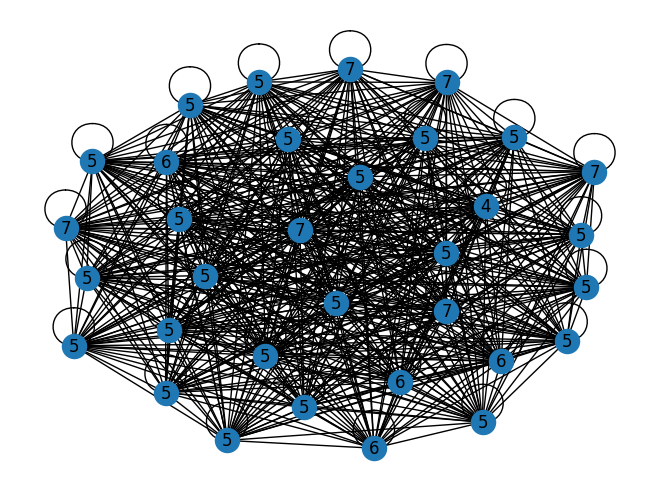

In [14]:
#TODO: DEFINE TRANSFORMS
import torch_geometric.transforms as T
# transform=T.KNNGraph(k=2) #NOTE: GRAPH.pos needs to be defined to use this
# transform=T.NormalizeFeatures()
# transform=T.Compose([T.KNNGraph(k=3,loop=False)])
# transform = T.Compose([T.KNNGraph(k=10,loop=True),NormalizeFeaturesNewTest(),T.ToUndirected(),T.AddSelfLoops()]) #T.AddSelfLoops(),
transform=None #NOTE: FOR SOME REASON T.ToUndirected() is changing the length of the graph labels??!?!?!?!?!?!RRRRRRG FRUSTRATING.
transform=T.NormalizeFeatures()
#TODO: OPEN DATASET
import torch
from torch_geometric.data import InMemoryDataset, download_url

class MyOwnDataset(InMemoryDataset):
    def __init__(self, root, transform=None, pre_transform=None, pre_filter=None):
        super().__init__(root, transform, pre_transform, pre_filter)
        print("INFO: self.processed_paths = ",self.processed_paths)
        self.data, self.slices = torch.load(self.processed_paths[0])
        print("LOADED self.data len = ",len(self.data))#DEBUGGING
        print("LOADED self.slices len = ",len(self.slices))#DEBUGGING

    @property
    def raw_file_names(self):
        return ['some_file_1', 'some_file_2']

    @property
    def processed_file_names(self):
        return ['data.pt']

    def process(self):
        # Read data into huge `Data` list.
        data_list = None

        if self.pre_filter is not None:
            data_list = [data for data in data_list if self.pre_filter(data)]

        if self.pre_transform is not None:
            data_list = [self.pre_transform(data) for data in data_list]

        data, slices = self.collate(data_list)
        torch.save((data, slices), self.processed_paths[0])

root = "/work/clas12/users/mfmce/pyg_datasets_lambda_rec_traj_12_11_23/" #NOTE: DATA SHOULD BE SAVED IN <root>/processed/data.pt
# root = "/work/clas12/users/mfmce/pyg_datasets_FROM_DGL_3_22_23/"
# root = "/work/clas12/users/mfmce/pyg_datasets_FROM_DGL_BALANCED_3_22_23/"
# # root = "/work/clas12/users/mfmce/pyg_datasets_TEST_PIPELINE_3_22_23/"
dataset = MyOwnDataset(root, transform=transform, pre_transform=None, pre_filter=None)
# DEBUGGING=True
# if DEBUGGING:
#     from torch_geometric.datasets import TUDataset
#     dataset = TUDataset(root='/home/mfmce/drop', name='MUTAG')
# print("DEBUGGING: len(dataset) = ",len(dataset))
data = dataset[0]
# print(data.x)
# print(dataset)
# if transform is not None: print(transform(dataset[0]).edge_index)
# if transform is not None: print(transform(dataset[0]).x)
print(data.x.shape)
print(data.x)
# print(data.x[0])
# print(data.x[0].sum())
print(data.y.shape)
print(data.y)
print("DEBUGGING: data.x.dtype = ",data.x.dtype)
print("DEBUGGING: data.y.dtype = ",data.y.dtype)
print("DEBUGGING: data.kinematics.dtype = ",data.kinematics.dtype)
print("DEBUGGING: data.y.shape = ",data.y.shape)
print("DEBUGGING: data.y = ",data.y)
g = tg.utils.to_networkx(data,to_undirected=True)
import networkx as nx
node_labels = {i:int(val.item()*100) for i, val in enumerate(data.x[:,0])}
nx.draw(g,labels=node_labels)
print("Going through dataset")
for idx, d in enumerate(dataset):
    if d.y.shape[0]>2:
        print("d.y = ",d.y)
        print("idx = ",idx)
    if torch.any(torch.isnan(d.x)):
        print("DEBUGGING: nan @ idx, d = ",idx,d)
    if torch.any(torch.isinf(d.x)):
        print("DEBUGGING: nan @ idx, d = ",idx,d)
        
print("DONE")

torch.Size([306895, 11])
torch.Size([12074])
torch.Size([2158270, 11])
torch.Size([84690])
DEBUGGING: b_sig.y.shape =  torch.Size([12074])
DEBUGGING; b_bg.y.shape =  torch.Size([84690])
DEBUGGING: type(arr1) =  <class 'numpy.ndarray'>
DEBUGGING: arr1.shape =  (6220, 11)
DEBUGGING: arr2.shape =  (43624, 11)
DEBUGGING: b_sig.x.dtype =  torch.float32
DEBUGGING: b_bg.x.dtype  =  torch.float32
DEBUGGING: b_sig.kinematics[0].dtype =  torch.float32


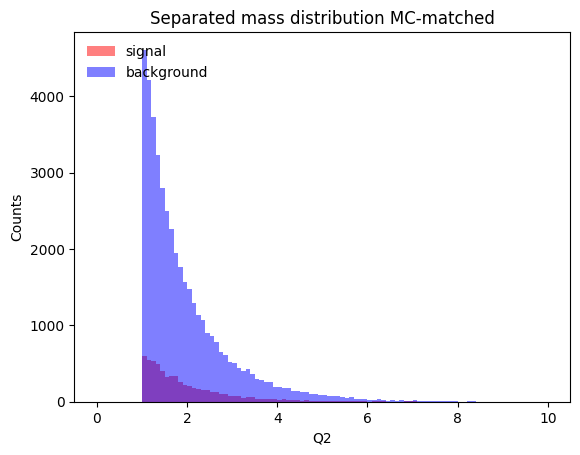

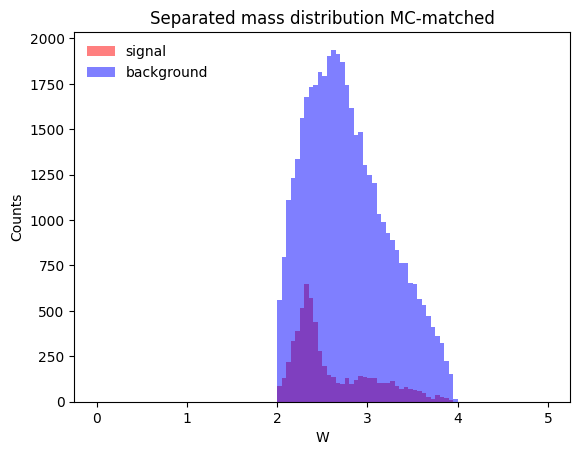

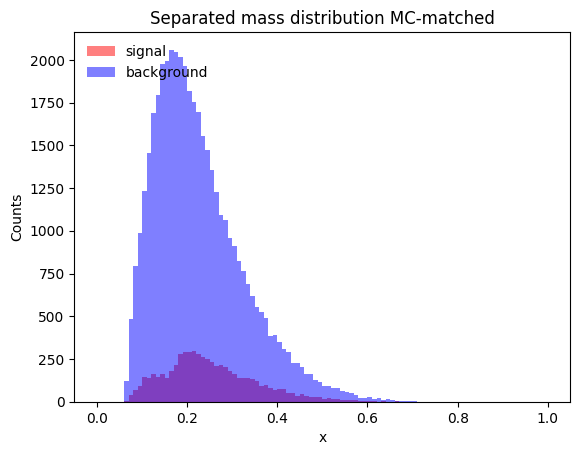

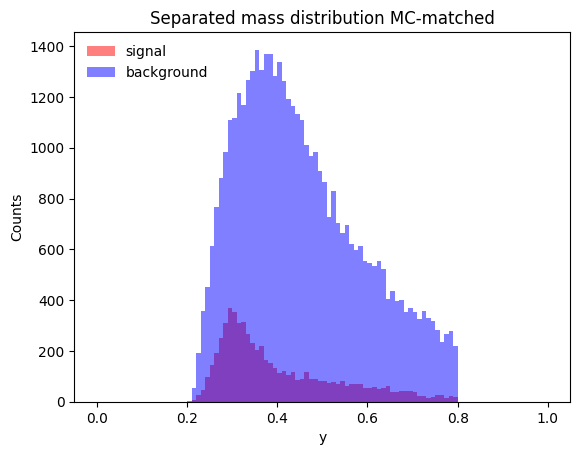

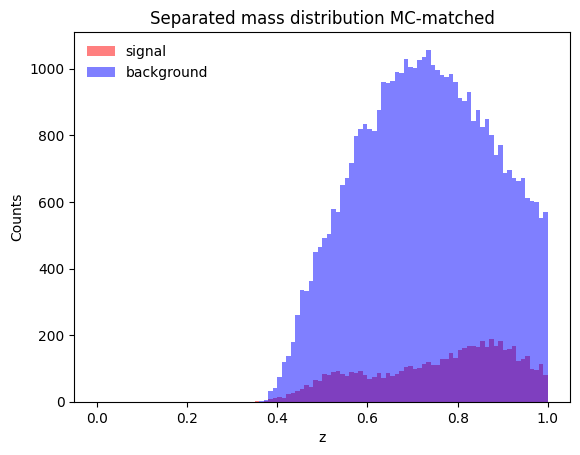

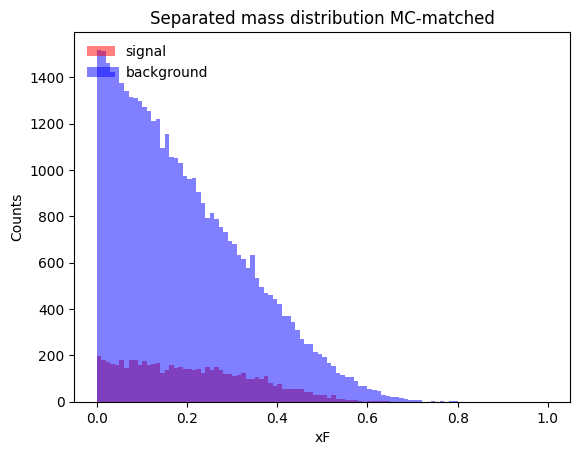

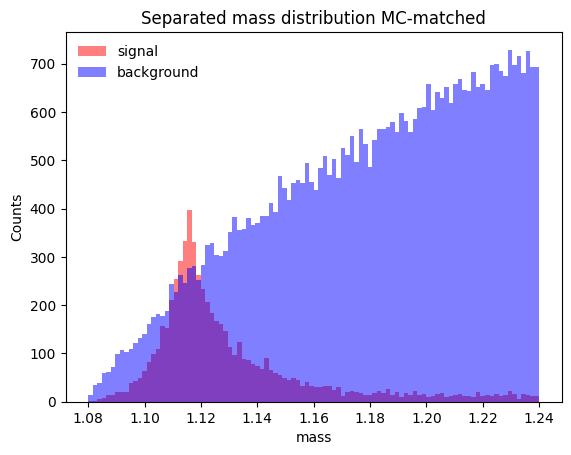

In [15]:
l_sig = []
l_bg = []
for data in dataset:
    if data.y[0]==1:
        l_sig.append(data)
    else:
        l_bg.append(data)
b_sig = torch_geometric.data.Batch().from_data_list(l_sig)
b_bg = torch_geometric.data.Batch().from_data_list(l_bg)
print(b_sig.x.shape)
print(b_sig.y.shape)
print(b_bg.x.shape)
print(b_bg.y.shape)

import matplotlib.pyplot as plt

def plot_data_separated(array_sig,array_bg,title=None,xlabel='index',nbins=100,low=-1.1,high=1.1):
    
    array_sig = array_sig.flatten()
    array_bg = array_bg.flatten()

    # Plot MC-Matched distributions
    f = plt.figure()
    if title != None:
        plt.title(title)
    plt.title('Separated mass distribution MC-matched')
    plt.hist(array_sig, color='r', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='signal')
    plt.hist(array_bg, color='b', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='background')
    plt.legend(loc='upper left', frameon=False)
    plt.ylabel('Counts')
    plt.xlabel(xlabel)
#     f.savefig(xlabel+'_separated_'+todays_date+'.png')
    plt.show()
    
arr1 = b_sig.kinematics
arr2 = b_bg.kinematics

print("DEBUGGING: b_sig.y.shape = ",b_sig.y.shape)
print("DEBUGGING; b_bg.y.shape = ",b_bg.y.shape)
    
# arr1 = []
# for el in b_sig.kinematics:
#     arr1.extend(el)
# arr2 = []
# for el in b_bg.kinematics:
#     arr2.extend(el)

arr1 = np.array(arr1)
arr2 = np.array(arr2)

print("DEBUGGING: type(arr1) = ",type(arr1))
print("DEBUGGING: arr1.shape = ",arr1.shape)
print("DEBUGGING: arr2.shape = ",arr2.shape)

print("DEBUGGING: b_sig.x.dtype = ",b_sig.x.dtype)
print("DEBUGGING: b_bg.x.dtype  = ",b_bg.x.dtype)

print("DEBUGGING: b_sig.kinematics[0].dtype = ",b_sig.kinematics[0].dtype)
    
# Plot data separated distributions
plot_data_separated(arr1[:,3],arr2[:,3],xlabel="Q2",low=0.0,high=10.0)
plot_data_separated(arr1[:,5],arr2[:,5],xlabel="W",low=0.0,high=5.0)
plot_data_separated(arr1[:,6],arr2[:,6],xlabel="x",low=0.0,high=1.0)
plot_data_separated(arr1[:,7],arr2[:,7],xlabel="y",low=0.0,high=1.0)
plot_data_separated(arr1[:,8],arr2[:,8],xlabel="z",low=0.0,high=1.0)
plot_data_separated(arr1[:,9],arr2[:,9],xlabel="xF",low=0.0,high=1.0)
plot_data_separated(arr1[:,10],arr2[:,10],xlabel="mass",low=1.08,high=1.24)
# plot_data_separated(arr1[:,4],arr2[:,4],xlabel="chi2")
# plot_data_separated(arr1[:,5],arr2[:,5],xlabel="pid")
# plot_data_separated(arr1[:,6],arr2[:,6],xlabel="status")

In [6]:
#TODO: CREATE MODEL
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import GraphConv
from torch_geometric.nn import global_mean_pool
from torch_geometric.nn.norm import GraphNorm, BatchNorm

class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(GCN, self).__init__()
#         torch.manual_seed(12345)
        self.conv1 = GCNConv(in_channels, hidden_channels)#.jittable() #NOTE: NEEDED FOR DEPLOYMENT IN CMAKE
        self.conv2 = GCNConv(hidden_channels, hidden_channels)#.jittable()
        self.conv3 = GCNConv(hidden_channels, hidden_channels)#.jittable()
        self.lin1 = Linear(hidden_channels, hidden_channels)
        self.lin2 = Linear(hidden_channels, hidden_channels)
        self.lin3 = Linear(hidden_channels, out_channels)
        self.bn1 = torch_geometric.nn.norm.GraphNorm(hidden_channels)
        self.bn2 = torch_geometric.nn.norm.GraphNorm(hidden_channels)
        self.bn3 = torch_geometric.nn.norm.GraphNorm(hidden_channels)

    def forward(self, x, edge_index, batch):
        # 1. Obtain node embeddings 
#         print("x = ",x)
#         print("DEBUGGING: in GCN: begin: x.requires_grad = ",x.requires_grad)
        x = self.conv1(x, edge_index)
#         print("DEBUGGING: in GCN: self.conv1(x, edge_index): x.requires_grad = ",x.requires_grad)
        x = self.bn1(x)
#         print("DEBUGGING: in GCN: self.bn2(x): x.requires_grad = ",x.requires_grad)
#         print("self.conv1(x,edge_index) = ",x)
        x = x.relu()
#         x = torch.nn.function.elu(x)
#         print("DEBUGGING: in GCN: x.relu(): x.requires_grad = ",x.requires_grad)
#         print("x.relu() = ",x)
        x = self.conv2(x, edge_index)
        x = self.bn2(x)
#         print("DEBUGGING: in GCN: self.bn2(x): x.requires_grad = ",x.requires_grad)
#         print("self.conv2(x,edge_index) = ",x)
        x = x.relu()
#         print("x.relu() = ",x)
        x = self.conv3(x, edge_index)
        x = self.bn3(x)
#         print("self.conv3(x,edge_index) = ",x)
#         print("DEBUGGING: in GCN: self.bn3(x): x.requires_grad = ",x.requires_grad)

#         # 2. Readout layer
        x = global_mean_pool(x, batch)  # [batch_size, hidden_channels]
#         print("self.conv2(global_mean_pool(x, batch)) = ",x)
#         print("DEBUGGING: in GCN: global_mean_pool(x): x.requires_grad = ",x.requires_grad)

        # 3. Apply a final classifier
        x = F.dropout(x, p=0.5, training=self.training)
#         print("DEBUGGING: in GCN: F.dropout: x.requires_grad = ",x.requires_grad)
#         print("F.dropout(x, p=0.5, training=self.training) = ",x)
        x = self.lin1(x)
        x = self.lin2(x)
        x = self.lin3(x)
#         print("DEBUGGING: in GCN: self.lin*(x): x.requires_grad = ",x.requires_grad)
#         print("self.lin3(x) = ",x)
#         x = torch.sigmoid(x) #NOTE: DON'T SOFTMAX IF USING BCELOSS, USE SIGMOID INSTEAD
#         print("torch.sigmoid(x) = ",x)
#         print("DEBUGGING: in GCN: torch.sigmoid(x): x.requires_grad = ",x.requires_grad)
        return x


import os.path as osp

import torch
import torch.nn.functional as F

import torch_geometric
import torch_geometric.transforms as T
from torch_geometric.datasets import TUDataset
from torch_geometric.loader import DataLoader
from torch_geometric.nn import MLP, GINConv, global_add_pool
from torch_geometric.nn.norm import GraphNorm
from torch.nn import BatchNorm1d

class GIN(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.convs = torch.nn.ModuleList()
        self.bns   = torch.nn.ModuleList()
        hidden_dim = 128 #hidden_dim
        num_layers = 8 # num_layers
        self.num_layers = num_layers
        
        for _ in range(self.num_layers - 1):
            mlp = MLP([in_channels if _==0 else hidden_dim, hidden_dim, hidden_dim, hidden_dim],norm='batch_norm',act='elu') #NOTE ADDED EXTRA LAYER HERE
            self.convs.append(GINConv(mlp, train_eps=False))
            self.bns.append(BatchNorm1d(hidden_dim))
#             in_channels = hidden_dim

        self.mlps = torch.nn.ModuleList()
        for _ in range(self.num_layers): #NOTE: INPUT DIM FOR MLP LAYER HAS TO MATCH INPUT DIM FOR EACH GRAPH REPRESENTATION IN EACH LAYER HERE
            self.mlps.append(MLP([in_channels if _==0 else hidden_dim, hidden_dim, hidden_dim, out_channels], norm=None, dropout=0.0, act='elu')) #NOTE ADDED EXTRA LAYER HERE AND..-> CHANGED ACTIVATION FUNCTION FROM DEFAULT RELU

    def forward(self, x, edge_index, batch): #data):
        #x, edge_index, batch = data.x, data.edge_index, data.batch
        hidden_rep = [x]
        for i in range(self.num_layers - 1):
#             print("x = ",x.max().item(),x.min().item(),x.mean().item(),x.std().item())
            x = self.convs[i](x, edge_index)
#             print("x = conv(x, edge_index) = ",x.max().item(),x.min().item(),x.mean().item(),x.std().item())
#             print("i = ",i)
            x = self.bns[i](x)
#             print("x = bn(x) = ",x.max().item(),x.min().item(),x.mean().item(),x.std().item())
#             x = x.elu() #x.tanh() #x.relu()
            x = torch.nn.functional.relu(x)
#             print("x = x.relu() = ",x.max().item(),x.min().item(),x.mean().item(),x.std().item())
            hidden_rep.append(x)
#             raise RunTimeError
        score_over_layer = 0
        for i, h in enumerate(hidden_rep):
            pooled_h = global_add_pool(h,batch)
#             print("i, pooled_h = ",i," , ",pooled_h.max().item(),pooled_h.min().item(),pooled_h.mean().item(),pooled_h.std().item())
            newval = self.mlps[i](pooled_h)
            score_over_layer += newval#self.mlps[i](pooled_h)
#             print("self.mlps[i](pooled_h) = ",newval)
#             print("softmax(...) = ",torch.nn.functional.softmax(newval,dim=-1))
#         raise TypeError
        return score_over_layer

'''
    ParticleNet Implementation
'''

class ParticleStaticEdgeConv(torch_geometric.nn.MessagePassing):
    def __init__(self, in_channels, out_channels):
        super(ParticleStaticEdgeConv, self).__init__(aggr='max')
        self.mlp = torch.nn.Sequential(
            torch.nn.Linear(2 * in_channels, out_channels[0], bias=False),
            torch_geometric.nn.BatchNorm(out_channels[0]), 
            torch.nn.ReLU(),
            torch.nn.Linear(out_channels[0], out_channels[1], bias=False),
            torch_geometric.nn.BatchNorm(out_channels[1]),
            torch.nn.ReLU(),
            torch.nn.Linear(out_channels[1], out_channels[2], bias=False),
            torch_geometric.nn.BatchNorm(out_channels[2]),
            torch.nn.ReLU()
        )

    def forward(self, x, edge_index, k):
        
        return self.propagate(edge_index, size=(x.size(0), x.size(0)), x=x)

    def message(self, edge_index, x_i, x_j):
        tmp = torch.cat([x_i, x_j - x_i], dim = 1)

        out_mlp = self.mlp(tmp)

        return out_mlp

    def update(self, aggr_out):
        return aggr_out

class ParticleDynamicEdgeConv(ParticleStaticEdgeConv):
    def __init__(self, in_channels, out_channels, k=7):
        super(ParticleDynamicEdgeConv, self).__init__(in_channels, out_channels)
        self.k = k
        self.skip_mlp = torch.nn.Sequential(
            torch.nn.Linear(in_channels, out_channels[2], bias=False),
            torch_geometric.nn.BatchNorm(out_channels[2]),
        )
        self.act = torch.nn.ReLU()

    def forward(self, pts, fts, batch=None):
        edges = torch_geometric.nn.knn_graph(pts, self.k, batch, loop=False, flow=self.flow)
        aggrg = super(ParticleDynamicEdgeConv, self).forward(fts, edges, self.k)
        x = self.skip_mlp(fts)
        out = torch.add(aggrg, x)
        return self.act(out)


# class ParticleNet(torch.nn.Module):

#     def __init__(self, settings):
#         super().__init__()
#         previous_output_shape = settings['input_features']

#         self.input_bn = torch_geometric.nn.BatchNorm(settings['input_features'])

#         self.conv_process = torch.nn.ModuleList()
#         for layer_idx, layer_param in enumerate(settings['conv_params']):
#             K, channels = layer_param
#             self.conv_process.append(ParticleDynamicEdgeConv(previous_output_shape, channels, k=K).to(settings['device']))#NOTE: Originally : .to(DEVICE)
#             previous_output_shape = channels[-1]



#         self.fc_process = torch.nn.ModuleList()
#         for layer_idx, layer_param in enumerate(settings['fc_params']):
#             drop_rate, units = layer_param
#             seq = torch.nn.Sequential(
#                 torch.nn.Linear(previous_output_shape, units),
#                 torch.nn.Dropout(p=drop_rate),
#                 torch.nn.ReLU()
#             ).to(settings['device'])#NOTE: Originally : .to(DEVICE)
#             self.fc_process.append(seq)
#             previous_output_shape = units


#         self.output_mlp_linear = torch.nn.Linear(previous_output_shape, settings['output_classes'])
#         self.output_activation = torch.nn.Softmax(dim=1)

#     def forward(self, batch):
#         fts = self.input_bn(batch.x)
#         pts = batch.pos

#         for idx, layer in enumerate(self.conv_process):
#             fts = layer(pts, fts, batch.batch)
#             pts = fts

#         x = torch_geometric.nn.global_mean_pool(fts, batch.batch)

#         for layer in self.fc_process:
#             x = layer(x)

#         x = self.output_mlp_linear(x)
# #         x = self.output_activation(x)
#         return x

# settings = {
#     "conv_params": [
#         (2, (64, 64, 64)),
#         (2, (64, 64, 64)),
# #         (2, (64, 64, 256)),
# #         (16, (64, 64, 64)),
# #         (16, (128, 128, 128)),
# #         (16, (256, 256, 256)),
#     ],
#     "fc_params": [
#         (0.5, 64)
# #         (0.1, 256)
#     ],
#     "input_features": dataset.num_node_features, # default was 4 (e, px, py, pz)
#     "output_classes": dataset.num_classes,       # default was 2
#     "device":device
# }

# # model = ParticleNet(settings)
# # # model = model.to(DEVICE)

# # print(model)

# # model = GCN(in_channels=dataset.num_node_features,hidden_channels=64,out_channels=2)
model = GIN(in_channels=dataset.num_node_features,out_channels=2)
print(model)
print("\ndataset[0].pos = ",dataset[0].pos)

GIN(
  (convs): ModuleList(
    (0): GINConv(nn=MLP(11, 128, 128, 128))
    (1-6): 6 x GINConv(nn=MLP(128, 128, 128, 128))
  )
  (bns): ModuleList(
    (0-6): 7 x BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (mlps): ModuleList(
    (0): MLP(11, 128, 128, 2)
    (1-7): 7 x MLP(128, 128, 128, 2)
  )
)

dataset[0].pos =  None


In [7]:
#TODO: PUT MODEL ON DEVICE
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print("Device = ",device)
model = model.to(device)
print("DEBUGGING: torch.cuda.is_available() = ",torch.cuda.is_available())

Device =  cuda:0
DEBUGGING: torch.cuda.is_available() =  True


In [9]:
#TODO: SPLIT DATASET
from torch.utils.data import random_split #TODO: SEE IF YOU CAN USE THIS
# torch.manual_seed(12345)
dataset = dataset.shuffle()

print(len(dataset))

fracs = [0.8, 0.1, 0.1] #NOTE: SHOULD CHECK np.sum(fracs) == 1 and len(fracs)==3
fracs = [torch.sum(torch.tensor(fracs[:idx])) for idx in range(1,len(fracs)+1)]
print(fracs)
split1, split2 = [int(len(dataset)*frac) for frac in fracs[:-1]]
train_dataset = dataset[:split1]
val_dataset = dataset[split1:split2]
test_dataset = dataset[split2:]

print(f'Number of training graphs: {len(train_dataset)}')
print(f'Number of validation graphs: {len(val_dataset)}')
print(f'Number of test graphs: {len(test_dataset)}')

print("train_dataset")
for idx, d in enumerate(train_dataset):
    if d.y.shape[0]>2:
        print("d.y = ",d.y)
        print("idx = ",idx)
        
print("val_dataset")
for idx, d in enumerate(val_dataset):
    if d.y.shape[0]>2:
        print("d.y = ",d.y)
        print("idx = ",idx)
        
print("test_dataset")
for idx, d in enumerate(test_dataset):
    if d.y.shape[0]>2:
        print("d.y = ",d.y)
        print("idx = ",idx)

48382
[tensor(0.8000), tensor(0.9000), tensor(1.)]
Number of training graphs: 38705
Number of validation graphs: 4838
Number of test graphs: 4839
train_dataset
val_dataset
test_dataset


In [10]:
#TODO: CREATE DATALOADERS
from torch_geometric.loader import DataLoader

batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)#, drop_last=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

for step, data in enumerate(train_loader):
    print(f'Step {step + 1}:')
    print('=======')
    print(f'Number of graphs in the current batch: {data.num_graphs}')
    print(data)
    print()
    break

# print("train_loader")
# for idx, d in enumerate(train_loader):
#     if d.y.shape[0]!=batch_size:
#         print("d.y = ",d.y)
#         print("idx = ",idx)
        
# print("val_loader")
# for idx, d in enumerate(val_loader):
#     if d.y.shape[0]!=batch_size:
#         print("d.y = ",d.y)
#         print("idx = ",idx)
        
# print("test_loader")
# for idx, d in enumerate(test_loader):
#     if d.y.shape[0]!=batch_size:
#         print("d.y = ",d.y)
#         print("idx = ",idx)

Step 1:
Number of graphs in the current batch: 32
DataBatch(x=[1979, 11], edge_index=[2, 147503], y=[64], kinematics=[33, 11], rec_match_indices=[6, 2], batch=[1979], ptr=[33])



In [13]:
# # Instantiate model, optimizer, and loss function
# # model = GCN(in_channels=dataset.num_node_features,hidden_channels=64,out_channels=2).to(device)
model = GIN(dataset.num_features, dataset.num_classes).to(device)
print("DEBUGGING: dataset.num_classes = ",dataset.num_classes)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
# optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
print("DEBUGGING: y[0] = ",torch_geometric.data.Batch().from_data_list(train_dataset).y[0])
data_labels = torch_geometric.data.Batch().from_data_list(train_dataset).y[:,0] #NOTE: THIS IS FOR 2D Labels
unique, counts = np.unique(data_labels,return_counts=True)
weight_signal = counts[0]/counts[1]#DEBUGGING MULTIPLY BY 2 ...
print("weight_signal = ",weight_signal)
weight = torch.FloatTensor([1.0, weight_signal]).to(device)
criterion = torch.nn.CrossEntropyLoss(weight=weight,reduction='mean')

DEBUGGING: dataset.num_classes =  2
DEBUGGING: y[0] =  tensor(0)


IndexError: too many indices for tensor of dimension 1

In [26]:
# # data_labels = torch_geometric.data.Batch().from_data_list(dataset).y
# # unique, counts = np.unique(data_labels,return_counts=True)
# weight_signal = counts[0]/counts[1]
# print(weight_signal)

In [37]:
# Define training and testing routines
def train():
    model.train()

    for idx, data in tqdm(enumerate(train_loader)):  # Iterate in batches over the training dataset.
        data = data.to(device)
#         x = data.x
#         y = data.y
#         if batch_size!=y.shape[0]:
#             print("DEBUGGING: x.shape = ",x.shape)
#             print("DEBUGGING: len(x) = ",len(x))
#             print("DEBUGGING: y.shape = ",y.shape)
#             print("DEBUGGING: len(y) = ",len(y))
# #             print("DEBUGGING: x = ",x)
#             print("DEBUGGING: y = ",y)
#             print("DEBUGGING: idx = ",idx)
# #             print("DEBUGGING: edge_index = ",data.edge_index)
# #         edge_index = data.edge_index
# #         batch = data.batch
        out = model(data.x, data.edge_index, data.batch)  # Perform a single forward pass.
        out = torch.nn.functional.softmax(out,dim=-1)
        print("DEBUGGING: out = ",out)
        print("DEBUGGING: y   = ",data.y)
#         print("DEBUGGING: out.device = ",out.device)
#         print("DEBUGGING: data.y.device = ",data.y.device)
#         print("DEBUGGING: device = ",device)
        loss = criterion(out, data.y)  # Compute the loss.
#         out = torch.nn.functional.softmax(out,dim=-1)
#         pred = out.argmax(dim=1)  # Use the class with highest probability.
        loss.backward()  # Derive gradients.
        optimizer.step()  # Update parameters based on gradients.
        optimizer.zero_grad()  # Clear gradients.
        
from sklearn.metrics import confusion_matrix
@torch.no_grad()
def test(loader):
    model.eval()
    correct = 0
    loss_ = 0
    tp = 0
    fp = 0
    fn = 0
    tn = 0
    decisions = []
    y_true = []
    for data in tqdm(loader):  # Iterate in batches over the training/test dataset.
        data = data.to(device)
        out = model(data.x, data.edge_index, data.batch)
        out = torch.nn.functional.softmax(out,dim=-1)
        loss = criterion(out, data.y)
        loss_ += loss.item()
#         out = torch.nn.functional.softmax(out,dim=-1)
        pred = out.argmax(dim=1)  # Use the class with highest probability.
        correct += int((pred == data.y).sum())  # Check against ground-truth labels.
#         tp += int(torch.logical_and(pred==data.y,pred==1).sum())#NOTE: THIS ONLY WORKS FOR BINARY CLASSIFICATION
#         fp += int(torch.logical_and(pred!=data.y,pred==1).sum())
#         fn += int(torch.logical_and(pred!=data.y,pred==0).sum())
#         tn += int(torch.logical_and(pred==data.y,pred==0).sum())
        cm = confusion_matrix(data.y.cpu(),pred.cpu(),labels=[0,1])
        tp += cm[1,1]
        fp += cm[0,1] # bg classified as sig is 0,1
        fn += cm[1,0] # signal classified as bg is 1,0
        tn += cm[0,0]
        
        decisions.extend(pred.cpu())
        y_true.extend(data.y.cpu())
        
    precision = tp / (tp + fp) # accuracy of the identified signal events
    recall = tp / (tp + fn) # efficiency
    precision_n = tn / (tn + fn)
    recall_n = tn / (tn + fp)
#     print("tp = ",tp)
#     print("fp = ",fp)
#     print("fn = ",fn)
#     print("tn = ",tn)
#     print("len(loader.dataset) = ",len(loader.dataset))
#     print("acc = ",correct/len(loader.dataset))
#     print("(tp+tn)/(tp+fp+tn+fn) = ",(tp+tn)/(tp+fp+tn+fn))
    return correct / len(loader.dataset), loss_ / len(loader.dataset), precision, recall, precision_n, recall_n, decisions, y_true # Derive ratio of correct predictions.

# acc, loss = test(train_loader)
# print(acc,loss)
# acc, loss = test(val_loader)
# print(acc, loss)

In [ ]:
# Train model batch size 64 lr 0.001
nepochs = 100
train_metrics = {"acc":[], "loss":[], "precision":[], "recall":[]}
val_metrics = {"acc":[], "loss":[], "precision":[], "recall":[]}
for epoch in range(nepochs):
    print("BEFORE TRAIN()")
    train()
    print("BEFORE TEST(TRAIN_LOADER)")
    train_acc, train_loss, train_precision, train_recall, train_precision_n, train_recall_n, _, __ = test(train_loader)
    train_metrics["acc"].append(train_acc)
    train_metrics["loss"].append(train_loss)
    train_metrics["precision"].append(train_precision)
    train_metrics["recall"].append(train_recall)
    print("BEFORE TEST(VAL_LOADER)")
    val_acc, val_loss, val_precision, val_recall, val_precision_n, val_recall_n, _, __ = test(val_loader)
    val_metrics["acc"].append(val_acc)
    val_metrics["loss"].append(val_loss)
    val_metrics["precision"].append(val_precision)
    val_metrics["recall"].append(val_recall)
    print("Epoch ",epoch," Train acc: ",train_acc," loss: ",train_loss," precision: ",train_precision," recall: ",train_recall)#," precision_n: ",train_precision_n," recall_n: ",train_recall_n)
    print("Epoch ",epoch," Val   acc: ",val_acc,  " loss: ",val_loss," precision: ",val_precision," recall: ",val_recall)#," precision_n: ",val_precision_n," recall_n: ",val_recall_n)
    
import matplotlib.pyplot as plt
epochs = [i for i in range(len(train_metrics["loss"]))]
f = plt.figure()
ymax = max(max(train_metrics['loss']),max(val_metrics['loss']))
ymax = 0.01 #max(max(train_metrics['loss']),max(val_metrics['loss']))
print("ymax = ",ymax)
plt.ylim((10**-3,10**-1))
plt.semilogy(epochs, train_metrics['loss'], color='tab:orange', linewidth=2, markersize=1, label="training loss")
plt.semilogy(epochs, val_metrics['loss'], color='tab:blue', linewidth=2, markersize=1, label="training loss")
plt.legend(loc='best')
plt.xlabel('Epoch')
plt.ylabel('Arbitrary units')
plt.show()

f = plt.figure()
plt.ylim(1e-5,1)
plt.plot(epochs, train_metrics['acc'], color='tab:orange', linewidth=2, markersize=1, label="training accuracy")
plt.plot(epochs, val_metrics['acc'], color='tab:blue', linewidth=2, markersize=1, label="validation accuracy")
plt.legend(loc='best')
plt.xlabel('Epoch')
plt.ylabel('Arbitrary units')
plt

f = plt.figure()
plt.ylim(0,1)
plt.plot(epochs, train_metrics['precision'], color='tab:orange', linewidth=2, markersize=1, label="training precision")
plt.plot(epochs, val_metrics['precision'], color='tab:blue', linewidth=2, markersize=1, label="validation precision")
plt.legend(loc='best')
plt.xlabel('Epoch')
plt.ylabel('Arbitrary units')
plt.show()


f = plt.figure()
plt.ylim(0,1)
plt.plot(epochs, train_metrics['recall'], color='tab:orange', linewidth=2, markersize=1, label="training recall")
plt.plot(epochs, val_metrics['recall'], color='tab:blue', linewidth=2, markersize=1, label="validation recall")
plt.legend(loc='best')
plt.xlabel('Epoch')
plt.ylabel('Arbitrary units')
plt.show()
#NOTE: ALSO TRY CATBOOST WITH NEW VERTEXING
#NOTE: ALSO TRY GIN/PNet WITH NEW VERTEXING
#NOTE: SEE BELOW FIRST: CAN ALSO IMPLEMENT IN PL SO YOU CAN USE MULTIPLE GPUs
#NOTE: THIS WILL TAKE ROUGHLY 21min for 497000 training samples without GPU so just install GPU version of pytorch and save time.

BEFORE TRAIN()


0it [00:00, ?it/s]

DEBUGGING: out =  

4it [00:00,  7.31it/s]

tensor([[9.8903e-01, 1.0974e-02],
        [4.3254e-01, 5.6746e-01],
        [3.5092e-02, 9.6491e-01],
        [2.0299e-12, 1.0000e+00],
        [5.5075e-01, 4.4925e-01],
        [2.3727e-04, 9.9976e-01],
        [3.6454e-03, 9.9635e-01],
        [3.6250e-02, 9.6375e-01],
        [2.3892e-04, 9.9976e-01],
        [9.9512e-01, 4.8807e-03],
        [9.6157e-01, 3.8426e-02],
        [6.9600e-01, 3.0400e-01],
        [1.6993e-03, 9.9830e-01],
        [1.0535e-04, 9.9989e-01],
        [9.9698e-01, 3.0196e-03],
        [1.0273e-09, 1.0000e+00],
        [5.1191e-01, 4.8809e-01],
        [7.4206e-01, 2.5794e-01],
        [5.3753e-04, 9.9946e-01],
        [9.0501e-01, 9.4993e-02],
        [7.8043e-01, 2.1957e-01],
        [6.7302e-02, 9.3270e-01],
        [8.8711e-01, 1.1289e-01],
        [9.9706e-01, 2.9355e-03],
        [5.5174e-09, 1.0000e+00],
        [3.8905e-01, 6.1095e-01],
        [9.3808e-02, 9.0619e-01],
        [1.0082e-01, 8.9918e-01],
        [9.8630e-01, 1.3698e-02],
        [2.715

12it [00:00, 19.19it/s]

DEBUGGING: out =  tensor([[9.9989e-01, 1.0856e-04],
        [9.0923e-04, 9.9909e-01],
        [4.9293e-01, 5.0707e-01],
        [4.6982e-01, 5.3018e-01],
        [1.6031e-01, 8.3969e-01],
        [4.6890e-03, 9.9531e-01],
        [6.4609e-05, 9.9994e-01],
        [1.2324e-04, 9.9988e-01],
        [1.0000e+00, 2.9859e-06],
        [9.2302e-01, 7.6983e-02],
        [1.8110e-05, 9.9998e-01],
        [1.2031e-02, 9.8797e-01],
        [9.8525e-01, 1.4745e-02],
        [8.6884e-11, 1.0000e+00],
        [9.9767e-01, 2.3334e-03],
        [4.2314e-02, 9.5769e-01],
        [9.9040e-26, 1.0000e+00],
        [9.6048e-01, 3.9519e-02],
        [5.4117e-02, 9.4588e-01],
        [6.8539e-02, 9.3146e-01],
        [6.4942e-02, 9.3506e-01],
        [2.0629e-04, 9.9979e-01],
        [1.0025e-04, 9.9990e-01],
        [6.9181e-02, 9.3082e-01],
        [4.2387e-05, 9.9996e-01],
        [5.2150e-01, 4.7850e-01],
        [9.9909e-01, 9.0584e-04],
        [6.0970e-03, 9.9390e-01],
        [1.7021e-10, 1.0000e+0

21it [00:01, 29.35it/s]

tensor([[9.7689e-01, 2.3113e-02],
        [9.7779e-01, 2.2209e-02],
        [5.0611e-03, 9.9494e-01],
        [9.9813e-01, 1.8701e-03],
        [8.8124e-03, 9.9119e-01],
        [9.9954e-01, 4.6319e-04],
        [1.0000e+00, 4.3645e-07],
        [8.4733e-01, 1.5267e-01],
        [4.6754e-09, 1.0000e+00],
        [8.9344e-01, 1.0656e-01],
        [9.8137e-01, 1.8634e-02],
        [1.0000e+00, 4.4757e-06],
        [9.1053e-01, 8.9469e-02],
        [1.5237e-02, 9.8476e-01],
        [9.9949e-01, 5.0531e-04],
        [1.0000e+00, 3.6090e-06],
        [9.3773e-01, 6.2272e-02],
        [9.9325e-01, 6.7461e-03],
        [9.9449e-01, 5.5099e-03],
        [8.9231e-01, 1.0769e-01],
        [8.7157e-01, 1.2843e-01],
        [8.6917e-23, 1.0000e+00],
        [6.9139e-24, 1.0000e+00],
        [9.9971e-01, 2.8727e-04],
        [9.6099e-01, 3.9012e-02],
        [7.0146e-12, 1.0000e+00],
        [9.5761e-01, 4.2385e-02],
        [9.2535e-01, 7.4646e-02],
        [6.7877e-01, 3.2123e-01],
        [9.938

30it [00:01, 35.85it/s]

DEBUGGING: out =  tensor([[1.3950e-02, 9.8605e-01],
        [9.9789e-01, 2.1134e-03],
        [9.9927e-01, 7.2786e-04],
        [8.6056e-01, 1.3944e-01],
        [9.8482e-01, 1.5183e-02],
        [3.4291e-04, 9.9966e-01],
        [3.4464e-04, 9.9966e-01],
        [8.4387e-01, 1.5613e-01],
        [8.9919e-01, 1.0081e-01],
        [9.5321e-01, 4.6789e-02],
        [7.7425e-03, 9.9226e-01],
        [7.1462e-01, 2.8538e-01],
        [1.4705e-02, 9.8529e-01],
        [5.8271e-01, 4.1729e-01],
        [5.6665e-01, 4.3335e-01],
        [6.9959e-01, 3.0041e-01],
        [4.9247e-05, 9.9995e-01],
        [4.0691e-04, 9.9959e-01],
        [3.5928e-02, 9.6407e-01],
        [5.8221e-03, 9.9418e-01],
        [1.7430e-02, 9.8257e-01],
        [4.6540e-01, 5.3460e-01],
        [3.8243e-03, 9.9618e-01],
        [1.8448e-01, 8.1552e-01],
        [9.9807e-01, 1.9337e-03],
        [2.6794e-01, 7.3206e-01],
        [3.8122e-04, 9.9962e-01],
        [5.1551e-02, 9.4845e-01],
        [7.4259e-38, 1.0000e+0

40it [00:01, 41.28it/s]

DEBUGGING: out =  tensor([[9.9988e-01, 1.2360e-04],
        [5.3969e-07, 1.0000e+00],
        [8.9692e-01, 1.0308e-01],
        [1.6390e-13, 1.0000e+00],
        [2.7516e-22, 1.0000e+00],
        [1.9549e-06, 1.0000e+00],
        [7.9545e-01, 2.0455e-01],
        [9.4024e-09, 1.0000e+00],
        [9.7863e-05, 9.9990e-01],
        [9.9949e-01, 5.1103e-04],
        [9.9809e-01, 1.9147e-03],
        [6.8846e-03, 9.9312e-01],
        [2.6473e-01, 7.3527e-01],
        [9.0397e-01, 9.6033e-02],
        [9.6698e-01, 3.3023e-02],
        [4.5477e-01, 5.4523e-01],
        [3.4639e-19, 1.0000e+00],
        [9.0378e-01, 9.6217e-02],
        [2.7852e-04, 9.9972e-01],
        [1.6050e-01, 8.3950e-01],
        [9.6399e-01, 3.6010e-02],
        [2.9334e-01, 7.0666e-01],
        [3.0642e-01, 6.9358e-01],
        [9.8875e-01, 1.1252e-02],
        [5.1837e-01, 4.8163e-01],
        [4.0043e-06, 1.0000e+00],
        [5.9852e-01, 4.0148e-01],
        [2.9891e-05, 9.9997e-01],
        [9.6788e-01, 3.2116e-0

50it [00:01, 43.71it/s]

DEBUGGING: out =  tensor([[4.3700e-01, 5.6300e-01],
        [1.3076e-03, 9.9869e-01],
        [7.2806e-01, 2.7194e-01],
        [7.1688e-04, 9.9928e-01],
        [1.0000e+00, 8.1504e-11],
        [1.7341e-04, 9.9983e-01],
        [9.2067e-01, 7.9333e-02],
        [9.9769e-01, 2.3125e-03],
        [3.7135e-01, 6.2865e-01],
        [5.6670e-05, 9.9994e-01],
        [2.0444e-08, 1.0000e+00],
        [3.9713e-01, 6.0287e-01],
        [2.6546e-06, 1.0000e+00],
        [3.1002e-02, 9.6900e-01],
        [9.9909e-01, 9.1292e-04],
        [3.3089e-01, 6.6911e-01],
        [8.2090e-04, 9.9918e-01],
        [6.8371e-03, 9.9316e-01],
        [9.2684e-01, 7.3160e-02],
        [8.1660e-02, 9.1834e-01],
        [5.7250e-15, 1.0000e+00],
        [9.6866e-01, 3.1340e-02],
        [6.0174e-01, 3.9826e-01],
        [9.9986e-01, 1.4363e-04],
        [3.2524e-10, 1.0000e+00],
        [8.9601e-01, 1.0399e-01],
        [9.9717e-01, 2.8271e-03],
        [1.9227e-04, 9.9981e-01],
        [1.5125e-01, 8.4875e-0

60it [00:01, 45.36it/s]

DEBUGGING: out =  tensor([[9.4021e-01, 5.9789e-02],
        [5.7479e-01, 4.2521e-01],
        [9.9721e-01, 2.7860e-03],
        [7.9706e-01, 2.0294e-01],
        [9.7199e-01, 2.8009e-02],
        [9.8867e-01, 1.1331e-02],
        [9.9745e-01, 2.5454e-03],
        [4.8631e-05, 9.9995e-01],
        [8.3331e-01, 1.6669e-01],
        [9.9997e-01, 2.8562e-05],
        [4.5273e-01, 5.4727e-01],
        [9.9030e-01, 9.6998e-03],
        [1.1554e-03, 9.9884e-01],
        [4.2253e-40, 1.0000e+00],
        [6.9996e-03, 9.9300e-01],
        [9.9970e-01, 2.9749e-04],
        [6.7880e-01, 3.2120e-01],
        [9.0310e-01, 9.6899e-02],
        [7.9649e-01, 2.0351e-01],
        [4.6799e-02, 9.5320e-01],
        [7.7678e-04, 9.9922e-01],
        [3.2645e-02, 9.6736e-01],
        [3.4211e-02, 9.6579e-01],
        [2.0925e-01, 7.9075e-01],
        [8.1926e-02, 9.1807e-01],
        [7.7209e-01, 2.2791e-01],
        [1.6389e-04, 9.9984e-01],
        [1.8153e-04, 9.9982e-01],
        [1.8028e-02, 9.8197e-0

70it [00:02, 46.24it/s]

DEBUGGING: out =  tensor([[5.0925e-01, 4.9075e-01],
        [2.3656e-17, 1.0000e+00],
        [1.1206e-08, 1.0000e+00],
        [3.3565e-01, 6.6435e-01],
        [9.9246e-01, 7.5429e-03],
        [9.6358e-01, 3.6418e-02],
        [9.9755e-01, 2.4489e-03],
        [9.9997e-01, 2.8329e-05],
        [8.9173e-01, 1.0827e-01],
        [7.1070e-02, 9.2893e-01],
        [3.3917e-01, 6.6083e-01],
        [4.6782e-02, 9.5322e-01],
        [9.9011e-04, 9.9901e-01],
        [4.6152e-04, 9.9954e-01],
        [1.6720e-04, 9.9983e-01],
        [2.5815e-01, 7.4185e-01],
        [2.9737e-07, 1.0000e+00],
        [1.0000e+00, 1.3041e-07],
        [3.7156e-23, 1.0000e+00],
        [1.3792e-01, 8.6208e-01],
        [7.7156e-03, 9.9228e-01],
        [3.5423e-02, 9.6458e-01],
        [1.6581e-04, 9.9983e-01],
        [3.3394e-01, 6.6606e-01],
        [6.6566e-01, 3.3434e-01],
        [7.5517e-01, 2.4483e-01],
        [9.7060e-01, 2.9404e-02],
        [2.1162e-04, 9.9979e-01],
        [9.9769e-01, 2.3132e-0

80it [00:02, 46.66it/s]

DEBUGGING: out =  tensor([[8.1072e-01, 1.8928e-01],
        [3.0584e-04, 9.9969e-01],
        [9.8290e-01, 1.7095e-02],
        [2.8256e-06, 1.0000e+00],
        [8.8281e-01, 1.1719e-01],
        [3.2781e-02, 9.6722e-01],
        [6.3242e-02, 9.3676e-01],
        [6.9186e-01, 3.0814e-01],
        [4.5740e-01, 5.4260e-01],
        [8.6778e-01, 1.3222e-01],
        [9.9995e-01, 5.3715e-05],
        [1.0000e+00, 7.9520e-07],
        [5.9800e-19, 1.0000e+00],
        [5.3946e-01, 4.6054e-01],
        [9.9718e-01, 2.8171e-03],
        [5.6711e-03, 9.9433e-01],
        [7.9189e-01, 2.0811e-01],
        [2.9950e-02, 9.7005e-01],
        [4.6184e-04, 9.9954e-01],
        [9.9747e-01, 2.5337e-03],
        [1.6317e-06, 1.0000e+00],
        [8.7715e-03, 9.9123e-01],
        [2.0277e-13, 1.0000e+00],
        [3.1035e-01, 6.8965e-01],
        [4.4522e-01, 5.5478e-01],
        [1.8875e-01, 8.1125e-01],
        [1.8527e-01, 8.1473e-01],
        [9.1676e-01, 8.3245e-02],
        [7.1988e-04, 9.9928e-0

90it [00:02, 46.67it/s]

DEBUGGING: out =  tensor([[5.0936e-01, 4.9064e-01],
        [2.2018e-10, 1.0000e+00],
        [6.9499e-01, 3.0501e-01],
        [1.6450e-01, 8.3550e-01],
        [9.9681e-01, 3.1907e-03],
        [1.4494e-02, 9.8551e-01],
        [1.1181e-06, 1.0000e+00],
        [9.5271e-01, 4.7290e-02],
        [7.2046e-02, 9.2795e-01],
        [9.7661e-01, 2.3389e-02],
        [1.9649e-02, 9.8035e-01],
        [9.9751e-01, 2.4924e-03],
        [4.2976e-03, 9.9570e-01],
        [2.9900e-02, 9.7010e-01],
        [1.3225e-15, 1.0000e+00],
        [9.8899e-01, 1.1011e-02],
        [9.5037e-04, 9.9905e-01],
        [9.0409e-11, 1.0000e+00],
        [1.2862e-16, 1.0000e+00],
        [9.9891e-01, 1.0885e-03],
        [2.8228e-01, 7.1772e-01],
        [9.7820e-01, 2.1801e-02],
        [5.0466e-02, 9.4953e-01],
        [7.5645e-02, 9.2436e-01],
        [9.7128e-01, 2.8723e-02],
        [2.2006e-02, 9.7799e-01],
        [9.9784e-01, 2.1584e-03],
        [1.4898e-07, 1.0000e+00],
        [6.5462e-02, 9.3454e-0

100it [00:02, 46.82it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.7596e-04],
        [4.3179e-01, 5.6821e-01],
        [7.4175e-01, 2.5825e-01],
        [9.9705e-01, 2.9472e-03],
        [9.5754e-01, 4.2459e-02],
        [6.2435e-09, 1.0000e+00],
        [2.4379e-03, 9.9756e-01],
        [1.9370e-16, 1.0000e+00],
        [4.5450e-03, 9.9545e-01],
        [2.0375e-01, 7.9625e-01],
        [5.3406e-01, 4.6594e-01],
        [8.9652e-17, 1.0000e+00],
        [8.4016e-03, 9.9160e-01],
        [6.1624e-01, 3.8376e-01],
        [1.5934e-01, 8.4066e-01],
        [9.9977e-01, 2.3244e-04],
        [2.7396e-07, 1.0000e+00],
        [1.0002e-01, 8.9998e-01],
        [2.0024e-05, 9.9998e-01],
        [9.9419e-01, 5.8140e-03],
        [9.8620e-01, 1.3802e-02],
        [2.5876e-02, 9.7412e-01],
        [5.7710e-02, 9.4229e-01],
        [2.4101e-02, 9.7590e-01],
        [8.6276e-01, 1.3724e-01],
        [1.0176e-07, 1.0000e+00],
        [1.0072e-06, 1.0000e+00],
        [3.2538e-06, 1.0000e+00],
        [8.9311e-01, 1.0689e-0

110it [00:03, 46.52it/s]

DEBUGGING: out =  tensor([[1.5598e-01, 8.4402e-01],
        [9.0890e-05, 9.9991e-01],
        [9.9253e-01, 7.4720e-03],
        [2.2502e-05, 9.9998e-01],
        [9.5411e-03, 9.9046e-01],
        [2.3710e-02, 9.7629e-01],
        [1.3129e-04, 9.9987e-01],
        [5.8249e-01, 4.1751e-01],
        [4.1049e-01, 5.8951e-01],
        [1.1681e-02, 9.8832e-01],
        [1.4354e-03, 9.9856e-01],
        [9.9932e-01, 6.8055e-04],
        [9.3760e-03, 9.9062e-01],
        [2.2288e-06, 1.0000e+00],
        [6.3801e-09, 1.0000e+00],
        [4.5514e-02, 9.5449e-01],
        [3.7475e-06, 1.0000e+00],
        [2.0769e-03, 9.9792e-01],
        [7.8264e-03, 9.9217e-01],
        [4.6199e-02, 9.5380e-01],
        [7.2253e-02, 9.2775e-01],
        [1.0040e-02, 9.8996e-01],
        [5.3484e-26, 1.0000e+00],
        [9.9992e-01, 7.9711e-05],
        [1.2369e-02, 9.8763e-01],
        [9.9909e-01, 9.0719e-04],
        [6.7591e-01, 3.2409e-01],
        [7.8260e-01, 2.1740e-01],
        [9.9473e-01, 5.2706e-0

120it [00:03, 46.19it/s]

DEBUGGING: out =  tensor([[9.9538e-01, 4.6249e-03],
        [8.2193e-01, 1.7807e-01],
        [4.2947e-03, 9.9571e-01],
        [2.5128e-03, 9.9749e-01],
        [9.3055e-01, 6.9451e-02],
        [8.8034e-01, 1.1966e-01],
        [6.4765e-01, 3.5235e-01],
        [8.0513e-01, 1.9487e-01],
        [6.3494e-03, 9.9365e-01],
        [4.1693e-02, 9.5831e-01],
        [9.9736e-01, 2.6415e-03],
        [8.9719e-01, 1.0281e-01],
        [3.3254e-01, 6.6746e-01],
        [7.1594e-05, 9.9993e-01],
        [9.7406e-02, 9.0259e-01],
        [8.1875e-01, 1.8125e-01],
        [9.4716e-01, 5.2843e-02],
        [3.3573e-01, 6.6427e-01],
        [4.0183e-01, 5.9817e-01],
        [2.0192e-04, 9.9980e-01],
        [1.0204e-01, 8.9796e-01],
        [1.5396e-01, 8.4604e-01],
        [3.4681e-01, 6.5319e-01],
        [8.6573e-04, 9.9913e-01],
        [8.5789e-01, 1.4211e-01],
        [8.2296e-07, 1.0000e+00],
        [6.7064e-01, 3.2936e-01],
        [6.9406e-12, 1.0000e+00],
        [2.3409e-02, 9.7659e-0

130it [00:03, 45.92it/s]

DEBUGGING: out =  tensor([[7.0235e-01, 2.9765e-01],
        [5.1911e-05, 9.9995e-01],
        [5.4205e-07, 1.0000e+00],
        [3.1440e-01, 6.8560e-01],
        [9.9796e-01, 2.0403e-03],
        [1.1511e-13, 1.0000e+00],
        [9.9515e-01, 4.8484e-03],
        [3.4565e-05, 9.9997e-01],
        [1.9330e-08, 1.0000e+00],
        [9.8892e-01, 1.1081e-02],
        [8.4134e-01, 1.5866e-01],
        [9.8124e-01, 1.8756e-02],
        [4.4108e-07, 1.0000e+00],
        [2.5342e-03, 9.9747e-01],
        [9.9684e-01, 3.1636e-03],
        [7.3634e-04, 9.9926e-01],
        [9.9882e-01, 1.1769e-03],
        [9.9696e-01, 3.0373e-03],
        [1.8081e-05, 9.9998e-01],
        [4.8420e-01, 5.1580e-01],
        [8.4107e-01, 1.5893e-01],
        [1.6122e-01, 8.3878e-01],
        [5.4501e-03, 9.9455e-01],
        [8.9367e-01, 1.0633e-01],
        [9.8452e-01, 1.5476e-02],
        [9.9944e-01, 5.5981e-04],
        [4.2039e-08, 1.0000e+00],
        [9.0830e-01, 9.1702e-02],
        [9.6074e-01, 3.9260e-0

135it [00:03, 45.81it/s]

DEBUGGING: out =  tensor([[0.0000e+00, 1.0000e+00],
        [2.2059e-02, 9.7794e-01],
        [1.3140e-01, 8.6860e-01],
        [9.8673e-01, 1.3274e-02],
        [4.5897e-05, 9.9995e-01],
        [6.6749e-01, 3.3251e-01],
        [5.2327e-01, 4.7673e-01],
        [9.9602e-01, 3.9811e-03],
        [9.8686e-01, 1.3136e-02],
        [9.6855e-01, 3.1454e-02],
        [7.4781e-03, 9.9252e-01],
        [6.7284e-02, 9.3272e-01],
        [9.2803e-01, 7.1972e-02],
        [8.8047e-01, 1.1953e-01],
        [1.2668e-02, 9.8733e-01],
        [4.4134e-01, 5.5866e-01],
        [1.0000e+00, 6.5977e-11],
        [1.5673e-03, 9.9843e-01],
        [9.6842e-01, 3.1583e-02],
        [4.3606e-01, 5.6394e-01],
        [5.0678e-02, 9.4932e-01],
        [2.6021e-01, 7.3979e-01],
        [3.2437e-01, 6.7563e-01],
        [9.8284e-01, 1.7165e-02],
        [9.2554e-03, 9.9074e-01],
        [2.4407e-02, 9.7559e-01],
        [9.9769e-01, 2.3073e-03],
        [9.9838e-01, 1.6165e-03],
        [9.6774e-01, 3.2264e-0

145it [00:03, 42.03it/s]

DEBUGGING: out =  tensor([[5.0073e-02, 9.4993e-01],
        [9.9997e-01, 2.9325e-05],
        [9.0761e-03, 9.9092e-01],
        [6.6675e-14, 1.0000e+00],
        [9.0246e-01, 9.7538e-02],
        [6.9868e-06, 9.9999e-01],
        [9.9130e-01, 8.6982e-03],
        [7.2738e-01, 2.7262e-01],
        [1.1885e-09, 1.0000e+00],
        [9.3119e-01, 6.8809e-02],
        [8.1836e-01, 1.8164e-01],
        [9.3242e-01, 6.7581e-02],
        [4.4026e-12, 1.0000e+00],
        [1.0000e+00, 2.9011e-06],
        [5.0170e-01, 4.9830e-01],
        [2.6981e-01, 7.3019e-01],
        [9.9951e-01, 4.9308e-04],
        [9.8322e-11, 1.0000e+00],
        [2.6165e-04, 9.9974e-01],
        [9.8903e-01, 1.0966e-02],
        [6.7382e-04, 9.9933e-01],
        [6.2068e-01, 3.7932e-01],
        [6.4773e-01, 3.5227e-01],
        [3.5794e-02, 9.6421e-01],
        [3.4836e-01, 6.5164e-01],
        [5.4403e-01, 4.5597e-01],
        [1.0166e-04, 9.9990e-01],
        [1.2263e-01, 8.7737e-01],
        [9.9807e-01, 1.9300e-0

155it [00:04, 44.32it/s]

DEBUGGING: out =  tensor([[3.2280e-04, 9.9968e-01],
        [7.7381e-01, 2.2619e-01],
        [7.4125e-02, 9.2588e-01],
        [7.1216e-10, 1.0000e+00],
        [1.2956e-07, 1.0000e+00],
        [5.3802e-01, 4.6198e-01],
        [4.7168e-03, 9.9528e-01],
        [9.3709e-01, 6.2909e-02],
        [9.4473e-01, 5.5265e-02],
        [9.9166e-01, 8.3395e-03],
        [9.6034e-01, 3.9656e-02],
        [6.9962e-01, 3.0038e-01],
        [9.8641e-01, 1.3594e-02],
        [4.6240e-05, 9.9995e-01],
        [8.3482e-02, 9.1652e-01],
        [8.6369e-01, 1.3631e-01],
        [9.0648e-04, 9.9909e-01],
        [7.5336e-01, 2.4664e-01],
        [1.1753e-06, 1.0000e+00],
        [1.0011e-02, 9.8999e-01],
        [9.8342e-01, 1.6582e-02],
        [9.9999e-01, 6.1197e-06],
        [9.4294e-17, 1.0000e+00],
        [9.6855e-01, 3.1448e-02],
        [5.6893e-01, 4.3107e-01],
        [3.2106e-06, 1.0000e+00],
        [2.7709e-10, 1.0000e+00],
        [5.9338e-01, 4.0662e-01],
        [4.3941e-02, 9.5606e-0

165it [00:04, 45.50it/s]

DEBUGGING: out =  tensor([[2.5323e-01, 7.4677e-01],
        [9.5917e-01, 4.0832e-02],
        [7.5556e-04, 9.9924e-01],
        [1.7972e-05, 9.9998e-01],
        [3.7107e-02, 9.6289e-01],
        [1.6649e-03, 9.9834e-01],
        [1.5898e-02, 9.8410e-01],
        [1.9576e-04, 9.9980e-01],
        [9.9294e-01, 7.0561e-03],
        [5.4527e-05, 9.9995e-01],
        [1.5991e-01, 8.4009e-01],
        [1.0916e-05, 9.9999e-01],
        [1.1330e-01, 8.8670e-01],
        [7.9426e-01, 2.0574e-01],
        [1.7290e-01, 8.2710e-01],
        [3.5873e-02, 9.6413e-01],
        [7.3429e-01, 2.6571e-01],
        [1.5605e-33, 1.0000e+00],
        [3.2095e-03, 9.9679e-01],
        [1.0000e+00, 8.5285e-07],
        [2.5159e-03, 9.9748e-01],
        [5.6886e-02, 9.4311e-01],
        [4.7207e-02, 9.5279e-01],
        [1.6222e-01, 8.3778e-01],
        [7.0629e-03, 9.9294e-01],
        [1.6953e-01, 8.3047e-01],
        [2.6936e-02, 9.7306e-01],
        [8.1120e-01, 1.8880e-01],
        [3.5466e-04, 9.9965e-0

175it [00:04, 46.17it/s]

DEBUGGING: out =  tensor([[1.0307e-01, 8.9693e-01],
        [8.3924e-01, 1.6076e-01],
        [5.3143e-01, 4.6857e-01],
        [9.9236e-01, 7.6415e-03],
        [5.6268e-05, 9.9994e-01],
        [2.6523e-01, 7.3477e-01],
        [1.1422e-02, 9.8858e-01],
        [9.9420e-01, 5.7972e-03],
        [6.5020e-01, 3.4980e-01],
        [1.1222e-02, 9.8878e-01],
        [2.2555e-07, 1.0000e+00],
        [9.8823e-01, 1.1768e-02],
        [4.4789e-03, 9.9552e-01],
        [9.9998e-01, 1.7214e-05],
        [9.8955e-01, 1.0451e-02],
        [8.3955e-01, 1.6045e-01],
        [3.7916e-01, 6.2084e-01],
        [1.7187e-07, 1.0000e+00],
        [1.0973e-11, 1.0000e+00],
        [9.9553e-01, 4.4706e-03],
        [1.7919e-08, 1.0000e+00],
        [9.5651e-01, 4.3494e-02],
        [6.2233e-06, 9.9999e-01],
        [2.0361e-09, 1.0000e+00],
        [8.0475e-01, 1.9525e-01],
        [9.7351e-01, 2.6487e-02],
        [4.4484e-01, 5.5516e-01],
        [9.1820e-01, 8.1802e-02],
        [3.5236e-01, 6.4764e-0

185it [00:04, 46.76it/s]

DEBUGGING: out =  tensor([[3.4243e-12, 1.0000e+00],
        [1.2863e-04, 9.9987e-01],
        [4.6827e-01, 5.3173e-01],
        [9.8366e-01, 1.6337e-02],
        [1.0656e-07, 1.0000e+00],
        [1.3709e-30, 1.0000e+00],
        [9.9789e-01, 2.1116e-03],
        [7.9191e-01, 2.0809e-01],
        [9.0576e-01, 9.4243e-02],
        [2.8805e-04, 9.9971e-01],
        [9.1150e-01, 8.8503e-02],
        [1.2166e-04, 9.9988e-01],
        [9.8606e-01, 1.3938e-02],
        [2.9965e-02, 9.7003e-01],
        [3.6547e-03, 9.9635e-01],
        [8.5059e-01, 1.4941e-01],
        [9.9349e-01, 6.5113e-03],
        [4.1307e-01, 5.8693e-01],
        [2.4908e-04, 9.9975e-01],
        [5.7119e-01, 4.2881e-01],
        [1.8575e-02, 9.8142e-01],
        [3.7376e-01, 6.2624e-01],
        [3.1590e-02, 9.6841e-01],
        [9.9978e-01, 2.2331e-04],
        [9.3146e-01, 6.8543e-02],
        [6.6825e-01, 3.3175e-01],
        [2.4884e-02, 9.7512e-01],
        [2.8354e-03, 9.9716e-01],
        [4.7529e-01, 5.2471e-0

195it [00:04, 47.01it/s]

DEBUGGING: out =  tensor([[9.6692e-01, 3.3076e-02],
        [3.5013e-06, 1.0000e+00],
        [2.4140e-12, 1.0000e+00],
        [5.0035e-01, 4.9965e-01],
        [9.9954e-01, 4.5546e-04],
        [2.1210e-01, 7.8790e-01],
        [4.3393e-01, 5.6607e-01],
        [2.3350e-05, 9.9998e-01],
        [1.2374e-01, 8.7626e-01],
        [8.1814e-04, 9.9918e-01],
        [2.1943e-01, 7.8057e-01],
        [1.5571e-03, 9.9844e-01],
        [9.9963e-01, 3.6582e-04],
        [9.9628e-01, 3.7199e-03],
        [9.9049e-01, 9.5129e-03],
        [1.4976e-01, 8.5024e-01],
        [3.3280e-02, 9.6672e-01],
        [2.7340e-08, 1.0000e+00],
        [4.9980e-13, 1.0000e+00],
        [6.5417e-01, 3.4583e-01],
        [2.3151e-02, 9.7685e-01],
        [9.8817e-01, 1.1833e-02],
        [1.0545e-01, 8.9455e-01],
        [6.4276e-02, 9.3572e-01],
        [3.4447e-04, 9.9966e-01],
        [9.7775e-01, 2.2255e-02],
        [9.3774e-01, 6.2261e-02],
        [3.5619e-01, 6.4381e-01],
        [3.4931e-01, 6.5069e-0

205it [00:05, 46.88it/s]

DEBUGGING: out =  tensor([[9.9923e-01, 7.7029e-04],
        [9.7187e-01, 2.8129e-02],
        [4.2436e-03, 9.9576e-01],
        [6.4730e-01, 3.5270e-01],
        [3.2252e-02, 9.6775e-01],
        [2.0603e-02, 9.7940e-01],
        [7.9510e-08, 1.0000e+00],
        [7.0889e-03, 9.9291e-01],
        [9.7971e-01, 2.0291e-02],
        [1.2506e-05, 9.9999e-01],
        [3.4097e-02, 9.6590e-01],
        [3.4626e-04, 9.9965e-01],
        [3.4746e-01, 6.5254e-01],
        [9.9514e-01, 4.8569e-03],
        [5.6560e-02, 9.4344e-01],
        [2.3190e-06, 1.0000e+00],
        [1.7260e-15, 1.0000e+00],
        [9.9887e-01, 1.1271e-03],
        [7.4569e-05, 9.9993e-01],
        [9.9975e-01, 2.4952e-04],
        [9.7870e-01, 2.1297e-02],
        [9.0996e-01, 9.0043e-02],
        [7.4272e-05, 9.9993e-01],
        [9.9985e-01, 1.5376e-04],
        [3.7077e-01, 6.2923e-01],
        [3.1885e-01, 6.8115e-01],
        [1.0470e-03, 9.9895e-01],
        [2.6967e-14, 1.0000e+00],
        [9.9994e-01, 6.4801e-0

215it [00:05, 46.98it/s]

DEBUGGING: out =  tensor([[2.4390e-06, 1.0000e+00],
        [1.1294e-01, 8.8706e-01],
        [8.9015e-01, 1.0985e-01],
        [1.5823e-01, 8.4177e-01],
        [5.1757e-01, 4.8243e-01],
        [2.6459e-01, 7.3541e-01],
        [8.7456e-02, 9.1254e-01],
        [9.9730e-01, 2.7019e-03],
        [3.1020e-01, 6.8980e-01],
        [4.9934e-03, 9.9501e-01],
        [1.2931e-02, 9.8707e-01],
        [9.9999e-01, 8.8339e-06],
        [6.8424e-01, 3.1576e-01],
        [9.2182e-02, 9.0782e-01],
        [9.9993e-01, 7.4110e-05],
        [5.8254e-01, 4.1746e-01],
        [3.4830e-04, 9.9965e-01],
        [8.1539e-01, 1.8461e-01],
        [9.0874e-01, 9.1262e-02],
        [2.9471e-01, 7.0529e-01],
        [2.8509e-07, 1.0000e+00],
        [9.9981e-01, 1.8748e-04],
        [8.4578e-02, 9.1542e-01],
        [5.6052e-45, 1.0000e+00],
        [2.2093e-01, 7.7907e-01],
        [1.8457e-03, 9.9815e-01],
        [7.8880e-01, 2.1120e-01],
        [2.5705e-01, 7.4295e-01],
        [1.9654e-04, 9.9980e-0

225it [00:05, 46.78it/s]

DEBUGGING: out =  tensor([[7.7739e-01, 2.2261e-01],
        [7.9517e-01, 2.0483e-01],
        [4.4305e-01, 5.5695e-01],
        [2.0020e-02, 9.7998e-01],
        [2.0511e-03, 9.9795e-01],
        [1.6593e-03, 9.9834e-01],
        [9.4195e-01, 5.8047e-02],
        [9.9221e-01, 7.7928e-03],
        [2.4335e-09, 1.0000e+00],
        [9.9960e-01, 4.0037e-04],
        [8.7538e-03, 9.9125e-01],
        [2.6534e-02, 9.7347e-01],
        [1.8594e-14, 1.0000e+00],
        [1.3341e-08, 1.0000e+00],
        [9.8622e-01, 1.3776e-02],
        [6.6464e-03, 9.9335e-01],
        [7.0207e-01, 2.9793e-01],
        [1.1514e-02, 9.8849e-01],
        [7.0487e-01, 2.9513e-01],
        [7.8513e-01, 2.1487e-01],
        [9.8152e-01, 1.8482e-02],
        [5.3251e-01, 4.6749e-01],
        [8.0574e-15, 1.0000e+00],
        [4.9395e-05, 9.9995e-01],
        [2.5469e-02, 9.7453e-01],
        [9.7207e-01, 2.7932e-02],
        [8.8054e-01, 1.1946e-01],
        [9.8658e-03, 9.9013e-01],
        [2.7157e-01, 7.2843e-0

235it [00:05, 46.10it/s]

DEBUGGING: out =  tensor([[8.3808e-01, 1.6192e-01],
        [9.9730e-01, 2.7017e-03],
        [1.2273e-01, 8.7727e-01],
        [7.2389e-01, 2.7611e-01],
        [6.6782e-06, 9.9999e-01],
        [7.5435e-01, 2.4565e-01],
        [5.9164e-01, 4.0836e-01],
        [8.0390e-01, 1.9610e-01],
        [5.0715e-01, 4.9285e-01],
        [4.1350e-03, 9.9586e-01],
        [9.9868e-01, 1.3209e-03],
        [9.5063e-04, 9.9905e-01],
        [3.6630e-01, 6.3370e-01],
        [9.9037e-01, 9.6284e-03],
        [8.6151e-01, 1.3849e-01],
        [9.6819e-01, 3.1812e-02],
        [9.9999e-01, 7.1273e-06],
        [6.6014e-01, 3.3986e-01],
        [8.9850e-02, 9.1015e-01],
        [1.9499e-08, 1.0000e+00],
        [7.7022e-04, 9.9923e-01],
        [3.6437e-04, 9.9964e-01],
        [9.9675e-01, 3.2516e-03],
        [9.9995e-01, 4.9564e-05],
        [1.5054e-04, 9.9985e-01],
        [1.6079e-01, 8.3921e-01],
        [2.0216e-03, 9.9798e-01],
        [6.2929e-06, 9.9999e-01],
        [1.5193e-03, 9.9848e-0

245it [00:06, 46.05it/s]

DEBUGGING: out =  tensor([[2.3446e-05, 9.9998e-01],
        [2.0985e-01, 7.9015e-01],
        [7.4278e-11, 1.0000e+00],
        [1.7873e-01, 8.2127e-01],
        [9.8605e-01, 1.3950e-02],
        [3.1925e-08, 1.0000e+00],
        [9.4932e-09, 1.0000e+00],
        [2.2571e-07, 1.0000e+00],
        [2.8586e-03, 9.9714e-01],
        [9.9898e-01, 1.0209e-03],
        [7.0176e-01, 2.9824e-01],
        [9.5681e-01, 4.3186e-02],
        [1.0793e-06, 1.0000e+00],
        [9.6160e-01, 3.8399e-02],
        [6.6353e-03, 9.9336e-01],
        [8.5658e-01, 1.4342e-01],
        [7.6575e-01, 2.3425e-01],
        [5.6994e-02, 9.4301e-01],
        [9.5535e-01, 4.4652e-02],
        [1.0000e+00, 2.6965e-06],
        [1.5085e-07, 1.0000e+00],
        [8.8926e-04, 9.9911e-01],
        [5.3602e-01, 4.6398e-01],
        [2.1740e-01, 7.8260e-01],
        [3.7383e-03, 9.9626e-01],
        [5.0777e-03, 9.9492e-01],
        [2.3328e-01, 7.6672e-01],
        [9.6050e-01, 3.9498e-02],
        [2.0917e-05, 9.9998e-0

255it [00:06, 46.48it/s]

DEBUGGING: out =  tensor([[1.2557e-01, 8.7443e-01],
        [4.4669e-07, 1.0000e+00],
        [2.2470e-05, 9.9998e-01],
        [9.9851e-01, 1.4873e-03],
        [9.7711e-01, 2.2892e-02],
        [1.5682e-04, 9.9984e-01],
        [1.7975e-02, 9.8202e-01],
        [3.6901e-02, 9.6310e-01],
        [2.9446e-01, 7.0554e-01],
        [2.0085e-04, 9.9980e-01],
        [3.1587e-01, 6.8413e-01],
        [6.0316e-02, 9.3968e-01],
        [3.4100e-01, 6.5900e-01],
        [2.8981e-10, 1.0000e+00],
        [7.3988e-01, 2.6012e-01],
        [2.8119e-02, 9.7188e-01],
        [1.5786e-04, 9.9984e-01],
        [4.2897e-04, 9.9957e-01],
        [5.5218e-01, 4.4782e-01],
        [4.7183e-01, 5.2817e-01],
        [9.8102e-01, 1.8983e-02],
        [9.9963e-01, 3.6607e-04],
        [4.3818e-04, 9.9956e-01],
        [2.7876e-01, 7.2124e-01],
        [4.4925e-06, 1.0000e+00],
        [7.0276e-05, 9.9993e-01],
        [2.3590e-02, 9.7641e-01],
        [9.9997e-01, 3.1428e-05],
        [9.0000e-01, 9.9998e-0

265it [00:06, 46.09it/s]

DEBUGGING: out =  tensor([[2.0870e-37, 1.0000e+00],
        [3.3428e-04, 9.9967e-01],
        [1.8442e-01, 8.1558e-01],
        [1.0000e+00, 5.0279e-08],
        [9.5342e-01, 4.6580e-02],
        [6.4256e-01, 3.5744e-01],
        [9.5313e-01, 4.6874e-02],
        [8.8428e-01, 1.1572e-01],
        [1.5002e-05, 9.9998e-01],
        [2.3077e-05, 9.9998e-01],
        [2.8360e-05, 9.9997e-01],
        [6.0287e-01, 3.9713e-01],
        [6.0306e-01, 3.9694e-01],
        [4.8564e-01, 5.1436e-01],
        [1.3757e-02, 9.8624e-01],
        [6.0476e-01, 3.9524e-01],
        [3.5579e-03, 9.9644e-01],
        [8.6966e-03, 9.9130e-01],
        [2.2311e-01, 7.7689e-01],
        [7.9122e-01, 2.0878e-01],
        [1.0000e+00, 1.9026e-07],
        [8.8239e-01, 1.1761e-01],
        [3.8685e-01, 6.1315e-01],
        [2.3133e-06, 1.0000e+00],
        [9.9212e-01, 7.8758e-03],
        [6.6534e-07, 1.0000e+00],
        [7.8069e-03, 9.9219e-01],
        [9.7865e-03, 9.9021e-01],
        [9.9905e-01, 9.4737e-0

275it [00:06, 45.83it/s]

DEBUGGING: out =  tensor([[8.6846e-02, 9.1315e-01],
        [9.8975e-01, 1.0254e-02],
        [4.6740e-02, 9.5326e-01],
        [3.1619e-03, 9.9684e-01],
        [5.6167e-08, 1.0000e+00],
        [5.0680e-05, 9.9995e-01],
        [3.8111e-05, 9.9996e-01],
        [2.8288e-01, 7.1712e-01],
        [2.2665e-11, 1.0000e+00],
        [4.2446e-02, 9.5755e-01],
        [9.9989e-01, 1.1383e-04],
        [5.7868e-14, 1.0000e+00],
        [1.4417e-05, 9.9999e-01],
        [2.1791e-01, 7.8209e-01],
        [9.6338e-01, 3.6620e-02],
        [4.2135e-01, 5.7865e-01],
        [7.9900e-04, 9.9920e-01],
        [9.3020e-01, 6.9801e-02],
        [5.7981e-04, 9.9942e-01],
        [1.3773e-04, 9.9986e-01],
        [9.9795e-01, 2.0491e-03],
        [6.3740e-02, 9.3626e-01],
        [2.2234e-05, 9.9998e-01],
        [9.9280e-01, 7.1986e-03],
        [3.5822e-02, 9.6418e-01],
        [1.0000e+00, 1.0141e-07],
        [8.0582e-10, 1.0000e+00],
        [9.9070e-01, 9.3041e-03],
        [6.6642e-01, 3.3358e-0

285it [00:06, 46.09it/s]

DEBUGGING: out =  tensor([[8.0679e-01, 1.9321e-01],
        [3.0061e-06, 1.0000e+00],
        [1.6832e-02, 9.8317e-01],
        [1.0935e-04, 9.9989e-01],
        [9.9989e-01, 1.1351e-04],
        [5.1766e-01, 4.8234e-01],
        [9.0755e-01, 9.2450e-02],
        [7.6315e-01, 2.3685e-01],
        [2.9838e-04, 9.9970e-01],
        [1.0656e-05, 9.9999e-01],
        [3.8569e-05, 9.9996e-01],
        [6.8331e-10, 1.0000e+00],
        [1.3064e-01, 8.6936e-01],
        [9.9705e-01, 2.9523e-03],
        [2.7032e-02, 9.7297e-01],
        [4.5620e-03, 9.9544e-01],
        [9.9899e-01, 1.0139e-03],
        [1.5386e-05, 9.9998e-01],
        [2.1466e-02, 9.7853e-01],
        [9.9995e-01, 5.3967e-05],
        [9.6874e-01, 3.1260e-02],
        [2.5848e-03, 9.9742e-01],
        [2.5834e-06, 1.0000e+00],
        [2.5473e-04, 9.9975e-01],
        [1.7918e-01, 8.2082e-01],
        [9.9858e-01, 1.4234e-03],
        [1.9063e-01, 8.0937e-01],
        [2.8989e-04, 9.9971e-01],
        [9.9919e-01, 8.1032e-0

295it [00:07, 46.50it/s]

DEBUGGING: out =  tensor([[9.9572e-01, 4.2801e-03],
        [1.5340e-02, 9.8466e-01],
        [1.6474e-01, 8.3526e-01],
        [8.1998e-03, 9.9180e-01],
        [1.0419e-04, 9.9990e-01],
        [9.6427e-01, 3.5726e-02],
        [6.5723e-01, 3.4277e-01],
        [8.5691e-10, 1.0000e+00],
        [9.4925e-01, 5.0755e-02],
        [6.3151e-01, 3.6849e-01],
        [9.9611e-01, 3.8873e-03],
        [3.4003e-02, 9.6600e-01],
        [9.5369e-01, 4.6310e-02],
        [9.8357e-01, 1.6430e-02],
        [1.1044e-09, 1.0000e+00],
        [9.7655e-02, 9.0235e-01],
        [7.8014e-06, 9.9999e-01],
        [2.6617e-05, 9.9997e-01],
        [2.0261e-03, 9.9797e-01],
        [6.0827e-04, 9.9939e-01],
        [4.9821e-07, 1.0000e+00],
        [2.8906e-06, 1.0000e+00],
        [5.6765e-04, 9.9943e-01],
        [9.3766e-06, 9.9999e-01],
        [2.5371e-01, 7.4629e-01],
        [1.2475e-04, 9.9988e-01],
        [1.0000e+00, 1.5240e-08],
        [7.6705e-01, 2.3295e-01],
        [6.3465e-01, 3.6535e-0

305it [00:07, 46.72it/s]

DEBUGGING: out =  tensor([[6.7994e-05, 9.9993e-01],
        [5.2884e-02, 9.4712e-01],
        [1.5584e-02, 9.8442e-01],
        [7.2565e-02, 9.2744e-01],
        [9.9951e-01, 4.9255e-04],
        [9.6109e-01, 3.8910e-02],
        [1.8544e-02, 9.8146e-01],
        [6.2728e-01, 3.7272e-01],
        [9.3236e-01, 6.7637e-02],
        [1.1389e-02, 9.8861e-01],
        [8.6883e-01, 1.3117e-01],
        [8.7353e-01, 1.2647e-01],
        [9.5267e-08, 1.0000e+00],
        [6.3272e-04, 9.9937e-01],
        [7.1148e-03, 9.9289e-01],
        [9.9804e-01, 1.9628e-03],
        [2.3257e-03, 9.9767e-01],
        [9.8465e-01, 1.5347e-02],
        [6.7734e-05, 9.9993e-01],
        [4.1135e-01, 5.8865e-01],
        [9.9531e-01, 4.6949e-03],
        [1.3299e-04, 9.9987e-01],
        [8.2012e-03, 9.9180e-01],
        [2.0356e-01, 7.9644e-01],
        [1.9245e-01, 8.0755e-01],
        [2.8718e-05, 9.9997e-01],
        [2.1524e-34, 1.0000e+00],
        [7.2140e-01, 2.7860e-01],
        [2.3743e-03, 9.9763e-0

315it [00:07, 46.77it/s]

DEBUGGING: out =  tensor([[9.9516e-01, 4.8422e-03],
        [9.9643e-01, 3.5682e-03],
        [1.7979e-01, 8.2021e-01],
        [2.6462e-02, 9.7354e-01],
        [5.5536e-02, 9.4446e-01],
        [9.9304e-01, 6.9580e-03],
        [5.6633e-01, 4.3367e-01],
        [5.6018e-03, 9.9440e-01],
        [4.3484e-01, 5.6516e-01],
        [9.7767e-01, 2.2327e-02],
        [9.7664e-01, 2.3358e-02],
        [3.1603e-06, 1.0000e+00],
        [4.3101e-11, 1.0000e+00],
        [5.8087e-02, 9.4191e-01],
        [6.2579e-01, 3.7421e-01],
        [3.8355e-28, 1.0000e+00],
        [4.9880e-01, 5.0120e-01],
        [3.3644e-02, 9.6636e-01],
        [3.5001e-02, 9.6500e-01],
        [9.9444e-01, 5.5585e-03],
        [6.6721e-02, 9.3328e-01],
        [1.0079e-01, 8.9921e-01],
        [8.4358e-01, 1.5642e-01],
        [2.4325e-01, 7.5675e-01],
        [8.9298e-03, 9.9107e-01],
        [1.7213e-04, 9.9983e-01],
        [2.3065e-01, 7.6935e-01],
        [3.7922e-04, 9.9962e-01],
        [2.3910e-11, 1.0000e+0

325it [00:07, 46.82it/s]

DEBUGGING: out =  tensor([[1.8383e-01, 8.1617e-01],
        [9.9983e-01, 1.6649e-04],
        [5.4330e-05, 9.9995e-01],
        [9.3039e-01, 6.9606e-02],
        [5.1519e-02, 9.4848e-01],
        [9.9686e-01, 3.1359e-03],
        [9.9309e-03, 9.9007e-01],
        [4.6622e-01, 5.3378e-01],
        [8.9746e-01, 1.0254e-01],
        [6.5660e-04, 9.9934e-01],
        [1.4468e-01, 8.5532e-01],
        [8.4872e-01, 1.5128e-01],
        [2.6577e-01, 7.3423e-01],
        [1.7636e-02, 9.8236e-01],
        [9.4630e-01, 5.3699e-02],
        [3.0546e-02, 9.6945e-01],
        [1.3292e-04, 9.9987e-01],
        [2.3243e-08, 1.0000e+00],
        [9.6427e-01, 3.5725e-02],
        [9.4639e-01, 5.3613e-02],
        [9.0381e-01, 9.6191e-02],
        [1.1714e-05, 9.9999e-01],
        [1.5448e-01, 8.4552e-01],
        [4.1827e-02, 9.5817e-01],
        [1.1445e-02, 9.8856e-01],
        [2.6019e-05, 9.9997e-01],
        [7.9414e-02, 9.2059e-01],
        [7.7607e-03, 9.9224e-01],
        [9.7907e-01, 2.0931e-0

335it [00:07, 46.54it/s]

DEBUGGING: out =  tensor([[9.9064e-01, 9.3609e-03],
        [9.6710e-01, 3.2901e-02],
        [2.5163e-06, 1.0000e+00],
        [1.0594e-14, 1.0000e+00],
        [2.7451e-03, 9.9725e-01],
        [5.8440e-02, 9.4156e-01],
        [9.9325e-01, 6.7468e-03],
        [2.2768e-04, 9.9977e-01],
        [1.4657e-05, 9.9999e-01],
        [2.3184e-07, 1.0000e+00],
        [8.5030e-07, 1.0000e+00],
        [9.7709e-01, 2.2913e-02],
        [1.8299e-01, 8.1701e-01],
        [9.9369e-01, 6.3085e-03],
        [3.5886e-05, 9.9996e-01],
        [1.2369e-01, 8.7631e-01],
        [2.5043e-01, 7.4957e-01],
        [2.5844e-02, 9.7416e-01],
        [9.1283e-01, 8.7173e-02],
        [7.2634e-01, 2.7366e-01],
        [9.9995e-01, 5.0155e-05],
        [4.8588e-10, 1.0000e+00],
        [1.4847e-04, 9.9985e-01],
        [7.3089e-03, 9.9269e-01],
        [2.5399e-01, 7.4601e-01],
        [5.3667e-03, 9.9463e-01],
        [3.4751e-08, 1.0000e+00],
        [1.0000e+00, 5.0398e-10],
        [9.9907e-01, 9.3186e-0

345it [00:08, 46.69it/s]

DEBUGGING: out =  tensor([[2.5632e-01, 7.4368e-01],
        [3.1934e-01, 6.8066e-01],
        [1.3586e-01, 8.6414e-01],
        [1.0983e-03, 9.9890e-01],
        [3.3253e-04, 9.9967e-01],
        [3.8706e-01, 6.1294e-01],
        [1.3259e-02, 9.8674e-01],
        [8.5951e-02, 9.1405e-01],
        [9.9966e-01, 3.3648e-04],
        [3.5239e-06, 1.0000e+00],
        [9.8647e-01, 1.3526e-02],
        [7.1521e-01, 2.8479e-01],
        [3.8763e-02, 9.6124e-01],
        [9.2463e-01, 7.5369e-02],
        [9.9994e-01, 6.1198e-05],
        [8.8518e-01, 1.1482e-01],
        [5.4304e-10, 1.0000e+00],
        [9.4778e-01, 5.2219e-02],
        [9.8041e-01, 1.9586e-02],
        [1.6010e-07, 1.0000e+00],
        [1.3926e-01, 8.6074e-01],
        [9.7291e-01, 2.7091e-02],
        [9.9787e-01, 2.1349e-03],
        [9.7146e-01, 2.8540e-02],
        [1.3654e-29, 1.0000e+00],
        [3.0330e-01, 6.9670e-01],
        [6.6852e-01, 3.3148e-01],
        [1.5136e-01, 8.4864e-01],
        [8.1371e-03, 9.9186e-0

355it [00:08, 46.48it/s]

DEBUGGING: out =  tensor([[9.8672e-01, 1.3281e-02],
        [2.4664e-03, 9.9753e-01],
        [5.6050e-03, 9.9440e-01],
        [7.8522e-08, 1.0000e+00],
        [9.8822e-01, 1.1780e-02],
        [2.4110e-04, 9.9976e-01],
        [9.6488e-10, 1.0000e+00],
        [1.6694e-01, 8.3306e-01],
        [9.6283e-01, 3.7170e-02],
        [6.3086e-01, 3.6914e-01],
        [8.8755e-01, 1.1245e-01],
        [2.0953e-07, 1.0000e+00],
        [1.0000e+00, 2.5525e-07],
        [9.1082e-06, 9.9999e-01],
        [9.8047e-01, 1.9528e-02],
        [9.9944e-01, 5.6245e-04],
        [8.0689e-01, 1.9311e-01],
        [8.1083e-01, 1.8917e-01],
        [6.3827e-05, 9.9994e-01],
        [2.7016e-04, 9.9973e-01],
        [3.2619e-01, 6.7381e-01],
        [1.8320e-06, 1.0000e+00],
        [1.7121e-04, 9.9983e-01],
        [6.4725e-01, 3.5275e-01],
        [5.2005e-01, 4.7995e-01],
        [1.1612e-03, 9.9884e-01],
        [5.7430e-03, 9.9426e-01],
        [2.0875e-02, 9.7913e-01],
        [2.2484e-11, 1.0000e+0

365it [00:08, 46.37it/s]

DEBUGGING: out =  tensor([[3.7928e-06, 1.0000e+00],
        [5.0569e-02, 9.4943e-01],
        [5.1331e-06, 9.9999e-01],
        [4.7502e-01, 5.2498e-01],
        [2.9949e-07, 1.0000e+00],
        [1.3618e-03, 9.9864e-01],
        [1.4318e-02, 9.8568e-01],
        [7.2326e-38, 1.0000e+00],
        [7.2205e-01, 2.7795e-01],
        [9.8913e-01, 1.0871e-02],
        [9.9953e-01, 4.7086e-04],
        [9.9991e-01, 8.9149e-05],
        [7.0182e-04, 9.9930e-01],
        [2.1582e-10, 1.0000e+00],
        [9.9686e-01, 3.1361e-03],
        [5.4477e-03, 9.9455e-01],
        [4.8487e-01, 5.1513e-01],
        [1.1526e-01, 8.8474e-01],
        [8.5551e-01, 1.4449e-01],
        [9.2141e-01, 7.8586e-02],
        [9.9767e-03, 9.9002e-01],
        [9.5421e-01, 4.5786e-02],
        [1.5404e-02, 9.8460e-01],
        [8.9843e-01, 1.0157e-01],
        [1.9191e-01, 8.0809e-01],
        [8.1696e-01, 1.8304e-01],
        [2.9679e-08, 1.0000e+00],
        [8.9091e-01, 1.0909e-01],
        [1.8790e-06, 1.0000e+0

375it [00:08, 46.63it/s]

DEBUGGING: out =  tensor([[4.6504e-03, 9.9535e-01],
        [1.8410e-16, 1.0000e+00],
        [5.5396e-02, 9.4460e-01],
        [3.9114e-01, 6.0886e-01],
        [9.8096e-01, 1.9045e-02],
        [5.2137e-01, 4.7863e-01],
        [9.9999e-01, 8.0837e-06],
        [4.9677e-05, 9.9995e-01],
        [9.9962e-01, 3.8215e-04],
        [9.9341e-01, 6.5871e-03],
        [8.8575e-02, 9.1143e-01],
        [4.7399e-02, 9.5260e-01],
        [9.0452e-01, 9.5483e-02],
        [9.5455e-01, 4.5447e-02],
        [1.2179e-09, 1.0000e+00],
        [9.9991e-01, 9.3444e-05],
        [1.1825e-03, 9.9882e-01],
        [3.1452e-04, 9.9969e-01],
        [1.6148e-05, 9.9998e-01],
        [9.8289e-14, 1.0000e+00],
        [2.6610e-01, 7.3390e-01],
        [2.7732e-15, 1.0000e+00],
        [9.9709e-01, 2.9065e-03],
        [8.2161e-01, 1.7839e-01],
        [2.2643e-04, 9.9977e-01],
        [5.6248e-07, 1.0000e+00],
        [1.2765e-02, 9.8724e-01],
        [8.4531e-01, 1.5469e-01],
        [8.7708e-01, 1.2292e-0

385it [00:09, 46.76it/s]

DEBUGGING: out =  tensor([[1.1730e-07, 1.0000e+00],
        [6.7305e-05, 9.9993e-01],
        [9.6402e-01, 3.5977e-02],
        [7.4166e-06, 9.9999e-01],
        [9.4554e-01, 5.4460e-02],
        [8.9466e-01, 1.0534e-01],
        [3.2234e-04, 9.9968e-01],
        [4.5560e-05, 9.9995e-01],
        [4.7025e-08, 1.0000e+00],
        [7.4067e-03, 9.9259e-01],
        [3.5854e-04, 9.9964e-01],
        [6.5306e-01, 3.4694e-01],
        [5.5919e-01, 4.4081e-01],
        [6.3851e-08, 1.0000e+00],
        [9.9995e-01, 4.7628e-05],
        [3.1584e-02, 9.6842e-01],
        [8.2244e-01, 1.7756e-01],
        [4.8088e-04, 9.9952e-01],
        [2.7374e-31, 1.0000e+00],
        [9.8215e-01, 1.7853e-02],
        [9.9323e-01, 6.7742e-03],
        [6.2196e-02, 9.3780e-01],
        [9.4455e-01, 5.5449e-02],
        [1.3333e-01, 8.6667e-01],
        [9.6884e-01, 3.1162e-02],
        [1.3016e-04, 9.9987e-01],
        [4.7046e-04, 9.9953e-01],
        [6.8427e-05, 9.9993e-01],
        [3.0604e-03, 9.9694e-0

395it [00:09, 45.30it/s]

DEBUGGING: out =  tensor([[1.8284e-01, 8.1716e-01],
        [1.5904e-09, 1.0000e+00],
        [6.4804e-03, 9.9352e-01],
        [2.4573e-03, 9.9754e-01],
        [5.5216e-01, 4.4784e-01],
        [7.5826e-06, 9.9999e-01],
        [2.3558e-04, 9.9976e-01],
        [5.8109e-01, 4.1891e-01],
        [7.5125e-02, 9.2488e-01],
        [8.3253e-01, 1.6747e-01],
        [1.0478e-01, 8.9522e-01],
        [1.7200e-05, 9.9998e-01],
        [9.7718e-01, 2.2820e-02],
        [1.0000e+00, 2.4951e-06],
        [9.2993e-01, 7.0066e-02],
        [9.7859e-01, 2.1411e-02],
        [5.7601e-03, 9.9424e-01],
        [1.4055e-04, 9.9986e-01],
        [6.8065e-20, 1.0000e+00],
        [3.1047e-02, 9.6895e-01],
        [7.2046e-01, 2.7954e-01],
        [5.2039e-01, 4.7961e-01],
        [2.7333e-01, 7.2667e-01],
        [9.5242e-01, 4.7578e-02],
        [3.2560e-10, 1.0000e+00],
        [7.0968e-02, 9.2903e-01],
        [3.2195e-02, 9.6780e-01],
        [4.0397e-01, 5.9603e-01],
        [5.4741e-17, 1.0000e+0

405it [00:09, 45.50it/s]

DEBUGGING: out =  tensor([[1.6642e-01, 8.3358e-01],
        [3.3089e-01, 6.6911e-01],
        [9.5581e-01, 4.4189e-02],
        [6.9523e-02, 9.3048e-01],
        [9.9465e-01, 5.3482e-03],
        [6.5087e-05, 9.9993e-01],
        [2.1423e-01, 7.8577e-01],
        [3.9420e-07, 1.0000e+00],
        [8.9034e-02, 9.1097e-01],
        [9.5290e-01, 4.7098e-02],
        [9.9804e-01, 1.9568e-03],
        [8.0796e-01, 1.9204e-01],
        [6.9703e-02, 9.3030e-01],
        [9.5976e-01, 4.0243e-02],
        [1.2768e-01, 8.7232e-01],
        [1.1635e-02, 9.8836e-01],
        [4.6418e-02, 9.5358e-01],
        [2.5879e-02, 9.7412e-01],
        [9.9171e-01, 8.2933e-03],
        [6.4492e-08, 1.0000e+00],
        [5.2733e-02, 9.4727e-01],
        [9.9886e-12, 1.0000e+00],
        [3.9614e-01, 6.0386e-01],
        [5.1915e-03, 9.9481e-01],
        [8.2012e-01, 1.7988e-01],
        [9.9919e-01, 8.1334e-04],
        [2.7694e-01, 7.2306e-01],
        [5.2794e-01, 4.7206e-01],
        [2.5401e-01, 7.4599e-0

415it [00:09, 42.23it/s]

DEBUGGING: out =  tensor([[8.9495e-01, 1.0505e-01],
        [1.9781e-01, 8.0219e-01],
        [7.2887e-03, 9.9271e-01],
        [3.7991e-04, 9.9962e-01],
        [5.2184e-03, 9.9478e-01],
        [1.0329e-05, 9.9999e-01],
        [9.4785e-01, 5.2154e-02],
        [9.9633e-01, 3.6726e-03],
        [9.1803e-01, 8.1966e-02],
        [2.7579e-03, 9.9724e-01],
        [3.3535e-01, 6.6465e-01],
        [1.8508e-01, 8.1492e-01],
        [2.3255e-02, 9.7675e-01],
        [3.9779e-01, 6.0221e-01],
        [9.5861e-01, 4.1388e-02],
        [2.3227e-01, 7.6773e-01],
        [1.0000e+00, 1.5930e-07],
        [8.8213e-01, 1.1787e-01],
        [9.2360e-07, 1.0000e+00],
        [5.8764e-05, 9.9994e-01],
        [3.3028e-01, 6.6972e-01],
        [2.1486e-17, 1.0000e+00],
        [9.1189e-01, 8.8107e-02],
        [1.3036e-06, 1.0000e+00],
        [3.3435e-08, 1.0000e+00],
        [9.9222e-01, 7.7828e-03],
        [6.9928e-01, 3.0072e-01],
        [9.5538e-01, 4.4619e-02],
        [5.9997e-01, 4.0003e-0

420it [00:09, 41.76it/s]

DEBUGGING: out =  tensor([[1.5288e-02, 9.8471e-01],
        [2.2726e-01, 7.7274e-01],
        [3.2721e-26, 1.0000e+00],
        [9.9956e-01, 4.3759e-04],
        [3.0174e-03, 9.9698e-01],
        [3.9598e-05, 9.9996e-01],
        [8.8036e-01, 1.1964e-01],
        [8.7667e-01, 1.2333e-01],
        [2.8048e-05, 9.9997e-01],
        [9.9698e-01, 3.0237e-03],
        [9.9938e-01, 6.2437e-04],
        [2.7211e-01, 7.2789e-01],
        [7.6098e-01, 2.3902e-01],
        [2.8092e-01, 7.1908e-01],
        [2.8235e-05, 9.9997e-01],
        [1.0000e+00, 2.1218e-07],
        [2.4120e-06, 1.0000e+00],
        [6.4425e-07, 1.0000e+00],
        [8.0733e-01, 1.9267e-01],
        [8.9158e-03, 9.9108e-01],
        [8.6307e-01, 1.3693e-01],
        [9.2567e-01, 7.4329e-02],
        [2.0237e-02, 9.7976e-01],
        [9.5935e-01, 4.0652e-02],
        [1.7338e-02, 9.8266e-01],
        [9.9798e-01, 2.0190e-03],
        [8.0986e-03, 9.9190e-01],
        [8.4655e-03, 9.9153e-01],
        [2.8975e-01, 7.1025e-0

430it [00:10, 40.71it/s]

DEBUGGING: out =  tensor([[9.3569e-01, 6.4305e-02],
        [2.1007e-04, 9.9979e-01],
        [9.9884e-01, 1.1603e-03],
        [2.7500e-02, 9.7250e-01],
        [5.1173e-02, 9.4883e-01],
        [9.9992e-01, 7.6081e-05],
        [9.7296e-01, 2.7036e-02],
        [9.1595e-01, 8.4048e-02],
        [7.3818e-01, 2.6182e-01],
        [3.0012e-02, 9.6999e-01],
        [1.5638e-14, 1.0000e+00],
        [6.9906e-01, 3.0094e-01],
        [1.1938e-15, 1.0000e+00],
        [9.9977e-01, 2.3056e-04],
        [1.1450e-05, 9.9999e-01],
        [9.7462e-01, 2.5381e-02],
        [4.8188e-04, 9.9952e-01],
        [2.3849e-03, 9.9762e-01],
        [5.2765e-02, 9.4723e-01],
        [1.9100e-05, 9.9998e-01],
        [9.9344e-01, 6.5638e-03],
        [8.1389e-01, 1.8611e-01],
        [1.9251e-03, 9.9807e-01],
        [5.0359e-01, 4.9641e-01],
        [9.6392e-01, 3.6079e-02],
        [5.1094e-01, 4.8906e-01],
        [1.5589e-01, 8.4411e-01],
        [9.9879e-01, 1.2085e-03],
        [2.9604e-03, 9.9704e-0

440it [00:10, 42.59it/s]

DEBUGGING: out =  tensor([[8.9860e-11, 1.0000e+00],
        [2.9988e-04, 9.9970e-01],
        [9.8369e-01, 1.6309e-02],
        [4.4460e-05, 9.9996e-01],
        [3.4033e-09, 1.0000e+00],
        [2.3711e-01, 7.6289e-01],
        [1.6404e-01, 8.3596e-01],
        [8.4446e-03, 9.9156e-01],
        [1.9379e-02, 9.8062e-01],
        [5.5149e-03, 9.9449e-01],
        [9.1039e-01, 8.9605e-02],
        [9.9791e-01, 2.0879e-03],
        [8.5804e-03, 9.9142e-01],
        [4.5980e-01, 5.4020e-01],
        [8.6079e-04, 9.9914e-01],
        [3.0316e-02, 9.6968e-01],
        [1.0000e+00, 1.7376e-07],
        [9.9990e-01, 9.5674e-05],
        [4.5203e-03, 9.9548e-01],
        [9.5340e-24, 1.0000e+00],
        [3.4791e-05, 9.9997e-01],
        [9.8104e-01, 1.8965e-02],
        [9.7690e-01, 2.3099e-02],
        [9.2700e-01, 7.2995e-02],
        [1.0341e-09, 1.0000e+00],
        [6.9838e-01, 3.0162e-01],
        [8.3365e-01, 1.6635e-01],
        [7.3668e-03, 9.9263e-01],
        [1.3907e-02, 9.8609e-0

445it [00:10, 39.95it/s]

DEBUGGING: out =  tensor([[2.1324e-03, 9.9787e-01],
        [3.5480e-03, 9.9645e-01],
        [6.9553e-01, 3.0447e-01],
        [7.6573e-01, 2.3427e-01],
        [1.3420e-02, 9.8658e-01],
        [2.9619e-01, 7.0381e-01],
        [9.3887e-01, 6.1129e-02],
        [3.1795e-02, 9.6820e-01],
        [1.7030e-10, 1.0000e+00],
        [3.4115e-02, 9.6588e-01],
        [5.5334e-11, 1.0000e+00],
        [2.9928e-02, 9.7007e-01],
        [5.5148e-05, 9.9994e-01],
        [9.5870e-01, 4.1297e-02],
        [4.6421e-01, 5.3579e-01],
        [9.9702e-01, 2.9769e-03],
        [4.9581e-01, 5.0419e-01],
        [3.9435e-04, 9.9961e-01],
        [9.5177e-01, 4.8228e-02],
        [5.4088e-01, 4.5912e-01],
        [1.8924e-06, 1.0000e+00],
        [4.1082e-03, 9.9589e-01],
        [1.3239e-02, 9.8676e-01],
        [5.6344e-04, 9.9944e-01],
        [9.9933e-01, 6.6508e-04],
        [5.8086e-03, 9.9419e-01],
        [4.5417e-01, 5.4583e-01],
        [8.9800e-01, 1.0200e-01],
        [3.1454e-01, 6.8546e-0

455it [00:10, 42.17it/s]

DEBUGGING: out =  tensor([[4.3691e-01, 5.6309e-01],
        [3.8787e-09, 1.0000e+00],
        [7.4519e-01, 2.5481e-01],
        [8.7197e-02, 9.1280e-01],
        [9.9968e-01, 3.1564e-04],
        [5.6624e-01, 4.3376e-01],
        [2.9330e-23, 1.0000e+00],
        [1.6024e-05, 9.9998e-01],
        [1.0852e-04, 9.9989e-01],
        [8.4642e-01, 1.5358e-01],
        [1.8378e-01, 8.1622e-01],
        [5.3519e-01, 4.6481e-01],
        [9.4070e-01, 5.9303e-02],
        [3.2014e-13, 1.0000e+00],
        [9.7652e-01, 2.3483e-02],
        [1.4886e-04, 9.9985e-01],
        [3.6931e-01, 6.3069e-01],
        [3.9147e-04, 9.9961e-01],
        [4.2139e-03, 9.9579e-01],
        [8.5051e-01, 1.4949e-01],
        [2.1381e-02, 9.7862e-01],
        [7.1889e-01, 2.8111e-01],
        [9.0896e-03, 9.9091e-01],
        [7.6515e-01, 2.3485e-01],
        [9.9786e-01, 2.1426e-03],
        [7.2427e-03, 9.9276e-01],
        [7.8467e-01, 2.1533e-01],
        [7.1699e-06, 9.9999e-01],
        [8.9568e-01, 1.0432e-0

465it [00:10, 41.21it/s]

DEBUGGING: out =  tensor([[7.7579e-01, 2.2421e-01],
        [9.9913e-01, 8.6990e-04],
        [2.1734e-06, 1.0000e+00],
        [3.4254e-01, 6.5746e-01],
        [1.9440e-02, 9.8056e-01],
        [6.9688e-01, 3.0312e-01],
        [3.6805e-04, 9.9963e-01],
        [1.3301e-03, 9.9867e-01],
        [9.9730e-01, 2.7003e-03],
        [1.4270e-07, 1.0000e+00],
        [1.2129e-01, 8.7871e-01],
        [2.3266e-01, 7.6734e-01],
        [1.0829e-01, 8.9171e-01],
        [2.3061e-01, 7.6939e-01],
        [8.3337e-01, 1.6663e-01],
        [1.3535e-03, 9.9865e-01],
        [7.9699e-01, 2.0301e-01],
        [1.4156e-01, 8.5844e-01],
        [2.0768e-02, 9.7923e-01],
        [9.9571e-01, 4.2857e-03],
        [6.1935e-05, 9.9994e-01],
        [9.9897e-01, 1.0276e-03],
        [2.2556e-02, 9.7744e-01],
        [7.0759e-01, 2.9241e-01],
        [5.7171e-01, 4.2829e-01],
        [5.6656e-02, 9.4334e-01],
        [7.2869e-01, 2.7131e-01],
        [9.7066e-01, 2.9344e-02],
        [1.4972e-02, 9.8503e-0

475it [00:11, 43.00it/s]

DEBUGGING: out =  tensor([[9.7590e-01, 2.4104e-02],
        [8.1202e-01, 1.8798e-01],
        [4.7856e-01, 5.2144e-01],
        [9.8589e-01, 1.4115e-02],
        [1.8724e-04, 9.9981e-01],
        [9.9494e-04, 9.9901e-01],
        [9.6450e-01, 3.5505e-02],
        [1.4248e-02, 9.8575e-01],
        [1.0598e-01, 8.9402e-01],
        [9.8910e-01, 1.0897e-02],
        [3.5209e-07, 1.0000e+00],
        [9.9738e-01, 2.6190e-03],
        [2.3917e-09, 1.0000e+00],
        [7.8100e-03, 9.9219e-01],
        [9.5199e-01, 4.8014e-02],
        [4.0941e-01, 5.9059e-01],
        [5.9624e-10, 1.0000e+00],
        [8.4093e-01, 1.5907e-01],
        [7.9520e-01, 2.0480e-01],
        [9.6442e-01, 3.5581e-02],
        [8.9083e-11, 1.0000e+00],
        [9.6958e-01, 3.0419e-02],
        [9.9454e-01, 5.4586e-03],
        [5.2648e-01, 4.7352e-01],
        [3.2034e-03, 9.9680e-01],
        [9.5537e-01, 4.4630e-02],
        [5.2929e-02, 9.4707e-01],
        [9.2578e-01, 7.4222e-02],
        [4.7504e-04, 9.9952e-0

485it [00:11, 44.93it/s]

tensor([[2.0702e-04, 9.9979e-01],
        [6.6680e-02, 9.3332e-01],
        [8.2103e-01, 1.7897e-01],
        [9.6482e-01, 3.5179e-02],
        [1.8935e-01, 8.1065e-01],
        [1.7380e-07, 1.0000e+00],
        [8.9931e-01, 1.0069e-01],
        [7.1180e-01, 2.8820e-01],
        [5.6991e-02, 9.4301e-01],
        [5.6660e-02, 9.4334e-01],
        [3.1852e-01, 6.8148e-01],
        [9.9148e-01, 8.5202e-03],
        [2.0771e-02, 9.7923e-01],
        [1.8041e-01, 8.1959e-01],
        [9.4922e-02, 9.0508e-01],
        [2.8167e-01, 7.1833e-01],
        [9.8012e-01, 1.9879e-02],
        [9.9694e-01, 3.0608e-03],
        [2.6188e-03, 9.9738e-01],
        [3.5800e-05, 9.9996e-01],
        [1.9146e-01, 8.0854e-01],
        [8.2739e-01, 1.7261e-01],
        [1.4679e-20, 1.0000e+00],
        [3.9612e-04, 9.9960e-01],
        [4.6616e-14, 1.0000e+00],
        [1.7283e-04, 9.9983e-01],
        [2.0306e-02, 9.7969e-01],
        [9.9244e-01, 7.5578e-03],
        [3.1331e-06, 1.0000e+00],
        [2.749

495it [00:11, 46.08it/s]

DEBUGGING: out =  tensor([[9.0053e-05, 9.9991e-01],
        [9.3874e-01, 6.1258e-02],
        [5.8998e-03, 9.9410e-01],
        [5.8594e-04, 9.9941e-01],
        [2.5958e-01, 7.4041e-01],
        [2.0395e-02, 9.7960e-01],
        [7.4192e-02, 9.2581e-01],
        [1.4707e-01, 8.5293e-01],
        [9.8191e-01, 1.8088e-02],
        [9.6719e-01, 3.2808e-02],
        [2.3524e-01, 7.6476e-01],
        [6.1312e-07, 1.0000e+00],
        [2.5182e-02, 9.7482e-01],
        [9.8004e-01, 1.9961e-02],
        [8.6314e-04, 9.9914e-01],
        [8.1493e-03, 9.9185e-01],
        [1.1802e-01, 8.8198e-01],
        [1.0000e+00, 7.8182e-13],
        [9.9997e-01, 2.5326e-05],
        [1.8644e-23, 1.0000e+00],
        [8.8582e-01, 1.1418e-01],
        [9.3354e-01, 6.6458e-02],
        [4.7560e-04, 9.9952e-01],
        [1.8135e-04, 9.9982e-01],
        [1.0000e+00, 3.8661e-09],
        [3.3646e-02, 9.6635e-01],
        [6.3826e-01, 3.6174e-01],
        [6.6280e-01, 3.3720e-01],
        [9.9831e-01, 1.6899e-0

500it [00:11, 45.99it/s]

DEBUGGING: out =  tensor([[8.7584e-01, 1.2416e-01],
        [9.3774e-01, 6.2259e-02],
        [4.4876e-01, 5.5124e-01],
        [6.2825e-01, 3.7175e-01],
        [9.8752e-01, 1.2483e-02],
        [3.2294e-04, 9.9968e-01],
        [9.3265e-01, 6.7351e-02],
        [2.6271e-03, 9.9737e-01],
        [1.6318e-07, 1.0000e+00],
        [5.7618e-01, 4.2382e-01],
        [8.3293e-01, 1.6707e-01],
        [1.2338e-08, 1.0000e+00],
        [9.9535e-03, 9.9005e-01],
        [9.9562e-01, 4.3760e-03],
        [7.6076e-01, 2.3924e-01],
        [9.5120e-01, 4.8796e-02],
        [9.7553e-01, 2.4468e-02],
        [1.7404e-16, 1.0000e+00],
        [1.4687e-07, 1.0000e+00],
        [5.5313e-04, 9.9945e-01],
        [1.0973e-01, 8.9027e-01],
        [8.5109e-01, 1.4891e-01],
        [9.9664e-01, 3.3581e-03],
        [1.2159e-03, 9.9878e-01],
        [9.9866e-01, 1.3404e-03],
        [9.8636e-01, 1.3636e-02],
        [9.4566e-01, 5.4338e-02],
        [9.9863e-01, 1.3749e-03],
        [4.0172e-06, 1.0000e+0

510it [00:11, 40.42it/s]

DEBUGGING: out =  tensor([[2.0485e-09, 1.0000e+00],
        [9.8871e-01, 1.1290e-02],
        [5.7126e-01, 4.2874e-01],
        [3.3128e-01, 6.6872e-01],
        [8.8181e-03, 9.9118e-01],
        [1.3706e-02, 9.8629e-01],
        [1.2112e-02, 9.8789e-01],
        [2.6506e-01, 7.3494e-01],
        [4.1432e-02, 9.5857e-01],
        [5.7338e-05, 9.9994e-01],
        [2.7642e-05, 9.9997e-01],
        [4.6589e-02, 9.5341e-01],
        [9.7470e-01, 2.5301e-02],
        [9.7307e-01, 2.6926e-02],
        [1.1270e-01, 8.8730e-01],
        [1.5477e-02, 9.8452e-01],
        [1.5228e-05, 9.9998e-01],
        [4.7836e-05, 9.9995e-01],
        [4.4287e-04, 9.9956e-01],
        [1.3917e-07, 1.0000e+00],
        [9.7302e-01, 2.6978e-02],
        [6.8131e-01, 3.1869e-01],
        [9.9684e-01, 3.1595e-03],
        [1.4996e-02, 9.8500e-01],
        [7.3264e-01, 2.6736e-01],
        [9.5796e-01, 4.2040e-02],
        [9.9755e-01, 2.4496e-03],
        [6.4499e-05, 9.9994e-01],
        [1.2505e-09, 1.0000e+0

520it [00:12, 42.81it/s]

DEBUGGING: out =  tensor([[1.4681e-04, 9.9985e-01],
        [9.9715e-01, 2.8521e-03],
        [1.0498e-03, 9.9895e-01],
        [9.1082e-03, 9.9089e-01],
        [5.7471e-05, 9.9994e-01],
        [9.7887e-01, 2.1127e-02],
        [4.1525e-05, 9.9996e-01],
        [9.7564e-01, 2.4363e-02],
        [9.9981e-01, 1.9320e-04],
        [9.9987e-01, 1.3031e-04],
        [7.7734e-02, 9.2227e-01],
        [9.9920e-01, 8.0100e-04],
        [2.7866e-01, 7.2134e-01],
        [9.9950e-01, 5.0404e-04],
        [7.8055e-04, 9.9922e-01],
        [2.1106e-02, 9.7889e-01],
        [2.5865e-12, 1.0000e+00],
        [7.0935e-01, 2.9065e-01],
        [6.2057e-08, 1.0000e+00],
        [2.2082e-01, 7.7918e-01],
        [8.5627e-05, 9.9991e-01],
        [8.4714e-02, 9.1529e-01],
        [9.4603e-01, 5.3968e-02],
        [2.8040e-18, 1.0000e+00],
        [9.9939e-01, 6.1037e-04],
        [8.0893e-01, 1.9107e-01],
        [3.6416e-04, 9.9964e-01],
        [5.4815e-01, 4.5185e-01],
        [2.5180e-02, 9.7482e-0

530it [00:12, 44.65it/s]

DEBUGGING: out =  tensor([[5.7189e-01, 4.2811e-01],
        [9.9934e-01, 6.5523e-04],
        [2.7281e-02, 9.7272e-01],
        [2.1704e-11, 1.0000e+00],
        [2.6484e-06, 1.0000e+00],
        [1.4235e-01, 8.5765e-01],
        [8.6494e-02, 9.1351e-01],
        [9.9730e-01, 2.6961e-03],
        [8.2186e-13, 1.0000e+00],
        [5.5366e-05, 9.9994e-01],
        [8.9188e-01, 1.0812e-01],
        [2.4690e-01, 7.5310e-01],
        [3.2856e-06, 1.0000e+00],
        [2.9938e-04, 9.9970e-01],
        [3.0846e-09, 1.0000e+00],
        [6.2875e-14, 1.0000e+00],
        [8.8013e-01, 1.1987e-01],
        [1.6010e-01, 8.3990e-01],
        [6.8485e-04, 9.9932e-01],
        [9.7670e-01, 2.3304e-02],
        [4.6643e-01, 5.3357e-01],
        [2.7085e-01, 7.2915e-01],
        [1.3516e-01, 8.6484e-01],
        [5.8583e-02, 9.4142e-01],
        [9.6361e-01, 3.6394e-02],
        [6.3975e-02, 9.3603e-01],
        [1.0571e-02, 9.8943e-01],
        [1.5150e-05, 9.9998e-01],
        [7.8722e-01, 2.1278e-0

540it [00:12, 45.40it/s]

DEBUGGING: out =  tensor([[8.0621e-07, 1.0000e+00],
        [2.0362e-09, 1.0000e+00],
        [2.0477e-03, 9.9795e-01],
        [9.5914e-01, 4.0859e-02],
        [5.3620e-01, 4.6380e-01],
        [8.6944e-01, 1.3056e-01],
        [8.0804e-01, 1.9196e-01],
        [5.7599e-03, 9.9424e-01],
        [9.9721e-01, 2.7937e-03],
        [8.8985e-01, 1.1015e-01],
        [3.3925e-01, 6.6075e-01],
        [9.4139e-02, 9.0586e-01],
        [1.1458e-07, 1.0000e+00],
        [8.5503e-01, 1.4497e-01],
        [2.1791e-01, 7.8209e-01],
        [1.0362e-14, 1.0000e+00],
        [3.2865e-01, 6.7135e-01],
        [9.6037e-01, 3.9634e-02],
        [1.9529e-07, 1.0000e+00],
        [1.7593e-02, 9.8241e-01],
        [2.1466e-02, 9.7853e-01],
        [7.8356e-07, 1.0000e+00],
        [2.9213e-05, 9.9997e-01],
        [4.7025e-01, 5.2975e-01],
        [3.6030e-01, 6.3970e-01],
        [2.4733e-03, 9.9753e-01],
        [9.8397e-01, 1.6031e-02],
        [2.0742e-01, 7.9258e-01],
        [9.9629e-01, 3.7070e-0

550it [00:12, 45.27it/s]

DEBUGGING: out =  tensor([[4.4113e-02, 9.5589e-01],
        [3.9783e-01, 6.0217e-01],
        [3.7555e-01, 6.2445e-01],
        [7.4699e-07, 1.0000e+00],
        [2.1610e-01, 7.8390e-01],
        [9.6739e-01, 3.2610e-02],
        [6.4455e-02, 9.3555e-01],
        [2.7161e-03, 9.9728e-01],
        [1.3181e-04, 9.9987e-01],
        [1.3749e-01, 8.6251e-01],
        [3.2482e-15, 1.0000e+00],
        [4.7724e-06, 1.0000e+00],
        [2.6201e-03, 9.9738e-01],
        [5.4906e-10, 1.0000e+00],
        [3.5885e-01, 6.4115e-01],
        [7.4261e-01, 2.5739e-01],
        [9.1144e-01, 8.8559e-02],
        [9.9947e-01, 5.2557e-04],
        [3.1208e-09, 1.0000e+00],
        [3.1459e-06, 1.0000e+00],
        [6.2684e-01, 3.7316e-01],
        [9.9965e-01, 3.4750e-04],
        [6.1960e-02, 9.3804e-01],
        [2.4596e-01, 7.5404e-01],
        [3.8089e-01, 6.1911e-01],
        [1.6004e-02, 9.8400e-01],
        [1.7135e-07, 1.0000e+00],
        [2.7880e-02, 9.7212e-01],
        [1.1674e-01, 8.8326e-0

560it [00:13, 44.26it/s]

tensor([[8.5004e-19, 1.0000e+00],
        [2.0118e-05, 9.9998e-01],
        [5.8135e-07, 1.0000e+00],
        [3.9103e-03, 9.9609e-01],
        [2.8450e-03, 9.9715e-01],
        [1.7409e-01, 8.2591e-01],
        [4.0431e-03, 9.9596e-01],
        [9.8393e-01, 1.6067e-02],
        [4.8124e-02, 9.5188e-01],
        [1.1275e-01, 8.8725e-01],
        [4.6854e-03, 9.9531e-01],
        [2.4582e-01, 7.5418e-01],
        [9.5532e-01, 4.4675e-02],
        [7.7405e-03, 9.9226e-01],
        [9.5262e-01, 4.7377e-02],
        [8.7877e-01, 1.2123e-01],
        [9.6252e-01, 3.7477e-02],
        [4.1219e-03, 9.9588e-01],
        [2.1249e-01, 7.8751e-01],
        [6.5523e-03, 9.9345e-01],
        [9.9280e-01, 7.2037e-03],
        [7.6579e-01, 2.3421e-01],
        [9.7162e-01, 2.8385e-02],
        [9.9982e-01, 1.8082e-04],
        [3.0087e-05, 9.9997e-01],
        [4.6314e-03, 9.9537e-01],
        [2.0440e-01, 7.9560e-01],
        [8.6470e-07, 1.0000e+00],
        [5.5281e-05, 9.9994e-01],
        [4.321

570it [00:13, 45.06it/s]

DEBUGGING: out =  tensor([[1.7229e-07, 1.0000e+00],
        [1.2800e-01, 8.7200e-01],
        [5.4950e-05, 9.9995e-01],
        [8.2744e-01, 1.7256e-01],
        [4.6571e-03, 9.9534e-01],
        [9.9771e-01, 2.2936e-03],
        [5.1128e-02, 9.4887e-01],
        [2.6774e-01, 7.3226e-01],
        [8.1840e-01, 1.8160e-01],
        [3.6333e-08, 1.0000e+00],
        [1.0000e+00, 1.7679e-07],
        [2.2172e-01, 7.7828e-01],
        [7.5332e-02, 9.2467e-01],
        [1.0000e+00, 3.5473e-06],
        [1.0963e-06, 1.0000e+00],
        [5.7652e-02, 9.4235e-01],
        [2.3707e-05, 9.9998e-01],
        [7.0099e-12, 1.0000e+00],
        [1.9392e-01, 8.0608e-01],
        [1.0698e-01, 8.9302e-01],
        [9.7471e-01, 2.5290e-02],
        [1.6313e-05, 9.9998e-01],
        [9.8240e-01, 1.7598e-02],
        [6.0270e-01, 3.9730e-01],
        [4.8579e-04, 9.9951e-01],
        [9.9638e-01, 3.6184e-03],
        [7.0372e-01, 2.9628e-01],
        [5.2625e-01, 4.7375e-01],
        [2.3366e-01, 7.6634e-0

580it [00:13, 45.75it/s]

DEBUGGING: out =  tensor([[6.8332e-06, 9.9999e-01],
        [9.3504e-01, 6.4956e-02],
        [5.3863e-10, 1.0000e+00],
        [3.3468e-03, 9.9665e-01],
        [2.1676e-01, 7.8324e-01],
        [9.9131e-01, 8.6890e-03],
        [8.0861e-01, 1.9139e-01],
        [4.2469e-04, 9.9958e-01],
        [2.4839e-02, 9.7516e-01],
        [6.3228e-02, 9.3677e-01],
        [2.7107e-17, 1.0000e+00],
        [4.5891e-01, 5.4109e-01],
        [9.0802e-01, 9.1983e-02],
        [9.9989e-01, 1.1219e-04],
        [9.8401e-01, 1.5993e-02],
        [8.9841e-03, 9.9102e-01],
        [2.8078e-01, 7.1922e-01],
        [1.2220e-02, 9.8778e-01],
        [6.3055e-01, 3.6945e-01],
        [6.8285e-04, 9.9932e-01],
        [2.7745e-02, 9.7226e-01],
        [2.4059e-02, 9.7594e-01],
        [2.7883e-02, 9.7212e-01],
        [8.1398e-01, 1.8602e-01],
        [3.9111e-01, 6.0889e-01],
        [9.9375e-10, 1.0000e+00],
        [7.9280e-02, 9.2072e-01],
        [6.2781e-01, 3.7219e-01],
        [2.1076e-06, 1.0000e+0

590it [00:13, 45.57it/s]

DEBUGGING: out =  tensor([[7.8435e-01, 2.1565e-01],
        [9.9555e-01, 4.4538e-03],
        [9.8932e-01, 1.0680e-02],
        [9.7771e-01, 2.2288e-02],
        [9.6493e-03, 9.9035e-01],
        [5.6159e-07, 1.0000e+00],
        [9.9772e-01, 2.2825e-03],
        [4.7856e-41, 1.0000e+00],
        [3.6064e-04, 9.9964e-01],
        [9.4963e-01, 5.0367e-02],
        [9.8363e-01, 1.6372e-02],
        [2.6088e-02, 9.7391e-01],
        [2.0444e-07, 1.0000e+00],
        [1.9165e-02, 9.8083e-01],
        [7.8428e-01, 2.1572e-01],
        [9.8539e-01, 1.4605e-02],
        [9.9756e-01, 2.4446e-03],
        [4.5345e-01, 5.4655e-01],
        [9.7381e-01, 2.6186e-02],
        [3.3828e-03, 9.9662e-01],
        [1.0105e-01, 8.9895e-01],
        [1.1210e-01, 8.8790e-01],
        [7.0934e-07, 1.0000e+00],
        [8.1295e-01, 1.8705e-01],
        [5.6397e-07, 1.0000e+00],
        [3.6271e-01, 6.3729e-01],
        [1.3295e-05, 9.9999e-01],
        [1.1806e-06, 1.0000e+00],
        [2.0481e-01, 7.9519e-0

600it [00:13, 46.51it/s]

DEBUGGING: out =  tensor([[5.0893e-01, 4.9107e-01],
        [1.8451e-01, 8.1549e-01],
        [9.8194e-01, 1.8062e-02],
        [4.2370e-04, 9.9958e-01],
        [7.7444e-04, 9.9923e-01],
        [8.8187e-01, 1.1813e-01],
        [5.3090e-06, 9.9999e-01],
        [2.6928e-01, 7.3072e-01],
        [9.5952e-01, 4.0476e-02],
        [4.7063e-17, 1.0000e+00],
        [9.8036e-01, 1.9643e-02],
        [9.7360e-01, 2.6401e-02],
        [9.9941e-01, 5.9138e-04],
        [5.9309e-01, 4.0691e-01],
        [1.4446e-09, 1.0000e+00],
        [3.1556e-01, 6.8444e-01],
        [3.7391e-02, 9.6261e-01],
        [1.2284e-03, 9.9877e-01],
        [6.2870e-02, 9.3713e-01],
        [9.4747e-01, 5.2534e-02],
        [4.5246e-02, 9.5475e-01],
        [5.5806e-01, 4.4194e-01],
        [9.7322e-01, 2.6779e-02],
        [7.1116e-19, 1.0000e+00],
        [8.4094e-01, 1.5906e-01],
        [9.4499e-01, 5.5015e-02],
        [6.0102e-01, 3.9898e-01],
        [2.3479e-04, 9.9977e-01],
        [9.5415e-01, 4.5852e-0

610it [00:14, 46.45it/s]

DEBUGGING: out =  tensor([[1.7776e-06, 1.0000e+00],
        [9.5560e-01, 4.4400e-02],
        [9.9688e-01, 3.1208e-03],
        [7.8723e-01, 2.1277e-01],
        [9.8188e-01, 1.8118e-02],
        [7.8490e-13, 1.0000e+00],
        [1.5801e-07, 1.0000e+00],
        [1.9904e-02, 9.8010e-01],
        [2.0477e-03, 9.9795e-01],
        [4.5854e-03, 9.9541e-01],
        [2.3114e-02, 9.7689e-01],
        [3.5447e-03, 9.9646e-01],
        [3.4398e-02, 9.6560e-01],
        [8.6387e-02, 9.1361e-01],
        [7.0127e-03, 9.9299e-01],
        [9.5375e-01, 4.6248e-02],
        [1.8833e-04, 9.9981e-01],
        [2.7473e-04, 9.9973e-01],
        [1.7681e-20, 1.0000e+00],
        [6.5936e-04, 9.9934e-01],
        [5.6507e-03, 9.9435e-01],
        [1.1246e-01, 8.8754e-01],
        [5.5171e-01, 4.4829e-01],
        [9.9999e-01, 7.2093e-06],
        [3.9828e-01, 6.0172e-01],
        [7.1075e-01, 2.8925e-01],
        [2.9744e-03, 9.9703e-01],
        [2.5006e-04, 9.9975e-01],
        [7.2880e-01, 2.7120e-0

620it [00:14, 46.99it/s]

DEBUGGING: out =  tensor([[8.9793e-01, 1.0207e-01],
        [2.1860e-01, 7.8140e-01],
        [9.0212e-01, 9.7876e-02],
        [6.3387e-01, 3.6613e-01],
        [9.7268e-01, 2.7323e-02],
        [8.9510e-04, 9.9910e-01],
        [9.7937e-07, 1.0000e+00],
        [9.9394e-01, 6.0637e-03],
        [1.0253e-16, 1.0000e+00],
        [7.9499e-01, 2.0501e-01],
        [4.2601e-14, 1.0000e+00],
        [2.1700e-03, 9.9783e-01],
        [2.8040e-01, 7.1960e-01],
        [1.1232e-03, 9.9888e-01],
        [7.9214e-04, 9.9921e-01],
        [4.4658e-02, 9.5534e-01],
        [2.3013e-02, 9.7699e-01],
        [9.9928e-01, 7.1758e-04],
        [2.2055e-08, 1.0000e+00],
        [9.9683e-01, 3.1730e-03],
        [3.9121e-01, 6.0879e-01],
        [1.3388e-01, 8.6612e-01],
        [2.6103e-01, 7.3897e-01],
        [3.8705e-01, 6.1295e-01],
        [9.9028e-01, 9.7161e-03],
        [5.2090e-01, 4.7910e-01],
        [6.9379e-01, 3.0621e-01],
        [1.1906e-08, 1.0000e+00],
        [9.9096e-01, 9.0427e-0

630it [00:14, 46.98it/s]

DEBUGGING: out =  tensor([[6.3924e-01, 3.6076e-01],
        [4.6513e-03, 9.9535e-01],
        [3.1663e-02, 9.6834e-01],
        [5.0041e-03, 9.9500e-01],
        [6.3342e-03, 9.9367e-01],
        [6.1842e-02, 9.3816e-01],
        [1.0958e-03, 9.9890e-01],
        [9.6157e-01, 3.8427e-02],
        [7.6726e-01, 2.3274e-01],
        [1.9769e-05, 9.9998e-01],
        [2.4016e-03, 9.9760e-01],
        [1.9072e-03, 9.9809e-01],
        [6.2743e-01, 3.7257e-01],
        [7.0036e-06, 9.9999e-01],
        [7.7953e-05, 9.9992e-01],
        [2.6216e-01, 7.3784e-01],
        [3.1079e-11, 1.0000e+00],
        [9.8635e-01, 1.3652e-02],
        [2.4239e-01, 7.5761e-01],
        [3.4868e-01, 6.5132e-01],
        [9.5378e-01, 4.6223e-02],
        [9.7004e-01, 2.9958e-02],
        [9.8521e-02, 9.0148e-01],
        [9.9949e-01, 5.1078e-04],
        [1.0000e+00, 7.1921e-07],
        [4.4584e-04, 9.9955e-01],
        [5.0914e-04, 9.9949e-01],
        [7.5428e-01, 2.4572e-01],
        [9.9286e-01, 7.1369e-0

640it [00:14, 46.77it/s]

DEBUGGING: out =  tensor([[2.2228e-01, 7.7772e-01],
        [7.7901e-01, 2.2099e-01],
        [9.0211e-01, 9.7895e-02],
        [8.8371e-01, 1.1629e-01],
        [9.9979e-01, 2.0876e-04],
        [1.1414e-03, 9.9886e-01],
        [4.3255e-01, 5.6745e-01],
        [1.9727e-02, 9.8027e-01],
        [2.3283e-02, 9.7672e-01],
        [1.2560e-07, 1.0000e+00],
        [9.9754e-01, 2.4620e-03],
        [3.5329e-01, 6.4671e-01],
        [3.0239e-01, 6.9761e-01],
        [6.3130e-01, 3.6870e-01],
        [2.0829e-01, 7.9171e-01],
        [6.5530e-05, 9.9993e-01],
        [3.5238e-02, 9.6476e-01],
        [2.7269e-05, 9.9997e-01],
        [1.0160e-01, 8.9840e-01],
        [7.7383e-02, 9.2262e-01],
        [4.8188e-01, 5.1812e-01],
        [1.1837e-01, 8.8163e-01],
        [1.3019e-03, 9.9870e-01],
        [9.9904e-01, 9.6467e-04],
        [3.1465e-03, 9.9685e-01],
        [9.1091e-01, 8.9088e-02],
        [8.9532e-01, 1.0468e-01],
        [9.1261e-01, 8.7395e-02],
        [6.6712e-07, 1.0000e+0

650it [00:15, 46.92it/s]

DEBUGGING: out =  tensor([[9.9689e-01, 3.1052e-03],
        [2.1673e-10, 1.0000e+00],
        [9.7021e-01, 2.9788e-02],
        [1.4027e-19, 1.0000e+00],
        [9.7928e-04, 9.9902e-01],
        [6.9457e-03, 9.9305e-01],
        [1.0667e-01, 8.9333e-01],
        [1.2255e-01, 8.7745e-01],
        [6.7862e-08, 1.0000e+00],
        [2.8447e-03, 9.9716e-01],
        [5.5099e-04, 9.9945e-01],
        [3.4368e-05, 9.9997e-01],
        [2.9514e-07, 1.0000e+00],
        [6.0997e-04, 9.9939e-01],
        [6.9034e-01, 3.0966e-01],
        [4.5656e-04, 9.9954e-01],
        [9.9998e-01, 2.2610e-05],
        [8.1920e-01, 1.8080e-01],
        [5.0000e-01, 5.0000e-01],
        [9.8430e-01, 1.5701e-02],
        [9.9998e-01, 2.2308e-05],
        [9.9798e-01, 2.0233e-03],
        [1.0000e+00, 1.9572e-07],
        [9.0855e-01, 9.1447e-02],
        [1.5394e-02, 9.8461e-01],
        [1.0118e-01, 8.9882e-01],
        [1.0108e-01, 8.9892e-01],
        [9.4977e-01, 5.0232e-02],
        [9.2369e-01, 7.6313e-0

660it [00:15, 46.77it/s]

DEBUGGING: out =  tensor([[7.8703e-01, 2.1297e-01],
        [4.7093e-02, 9.5291e-01],
        [9.7507e-01, 2.4935e-02],
        [6.6323e-02, 9.3368e-01],
        [3.0945e-02, 9.6905e-01],
        [9.1643e-02, 9.0836e-01],
        [1.0723e-04, 9.9989e-01],
        [9.9593e-01, 4.0691e-03],
        [1.0784e-10, 1.0000e+00],
        [4.8619e-01, 5.1381e-01],
        [9.1300e-01, 8.6997e-02],
        [9.6748e-01, 3.2523e-02],
        [1.1749e-02, 9.8825e-01],
        [9.9397e-01, 6.0341e-03],
        [3.6213e-01, 6.3787e-01],
        [2.4499e-03, 9.9755e-01],
        [9.6897e-01, 3.1034e-02],
        [3.3818e-06, 1.0000e+00],
        [8.3349e-01, 1.6651e-01],
        [9.9984e-01, 1.6162e-04],
        [2.6297e-12, 1.0000e+00],
        [9.9935e-01, 6.4519e-04],
        [1.5603e-02, 9.8440e-01],
        [2.5124e-07, 1.0000e+00],
        [1.5774e-01, 8.4226e-01],
        [9.9994e-01, 5.6514e-05],
        [1.0308e-02, 9.8969e-01],
        [8.5389e-04, 9.9915e-01],
        [3.9498e-01, 6.0502e-0

670it [00:15, 46.83it/s]

DEBUGGING: out =  tensor([[6.7282e-03, 9.9327e-01],
        [1.7212e-06, 1.0000e+00],
        [9.8156e-01, 1.8444e-02],
        [9.8730e-01, 1.2698e-02],
        [6.9136e-02, 9.3086e-01],
        [2.1354e-02, 9.7865e-01],
        [4.4036e-32, 1.0000e+00],
        [8.2230e-01, 1.7770e-01],
        [2.9475e-02, 9.7053e-01],
        [3.2437e-03, 9.9676e-01],
        [3.6540e-02, 9.6346e-01],
        [9.8742e-01, 1.2582e-02],
        [2.3672e-01, 7.6328e-01],
        [9.9962e-01, 3.8464e-04],
        [9.0881e-01, 9.1187e-02],
        [9.9414e-01, 5.8595e-03],
        [9.5799e-01, 4.2011e-02],
        [3.9407e-02, 9.6059e-01],
        [9.7838e-01, 2.1618e-02],
        [2.2280e-02, 9.7772e-01],
        [9.4119e-01, 5.8809e-02],
        [9.9960e-01, 4.0382e-04],
        [4.5953e-07, 1.0000e+00],
        [2.6182e-06, 1.0000e+00],
        [2.7135e-01, 7.2865e-01],
        [5.7880e-11, 1.0000e+00],
        [9.2204e-01, 7.7961e-02],
        [9.8068e-01, 1.9324e-02],
        [4.2279e-05, 9.9996e-0

680it [00:15, 46.72it/s]

DEBUGGING: out =  tensor([[5.4382e-01, 4.5618e-01],
        [5.1846e-01, 4.8154e-01],
        [2.8857e-01, 7.1143e-01],
        [2.7850e-07, 1.0000e+00],
        [2.2777e-04, 9.9977e-01],
        [1.8835e-02, 9.8116e-01],
        [8.2356e-02, 9.1764e-01],
        [1.3021e-03, 9.9870e-01],
        [2.5639e-01, 7.4361e-01],
        [9.2814e-02, 9.0719e-01],
        [2.0993e-01, 7.9007e-01],
        [3.6984e-09, 1.0000e+00],
        [4.7790e-02, 9.5221e-01],
        [3.4099e-01, 6.5901e-01],
        [6.5439e-01, 3.4561e-01],
        [9.0311e-02, 9.0969e-01],
        [9.9433e-01, 5.6743e-03],
        [9.2841e-01, 7.1589e-02],
        [6.6899e-01, 3.3101e-01],
        [1.7893e-03, 9.9821e-01],
        [4.2318e-01, 5.7682e-01],
        [1.5101e-02, 9.8490e-01],
        [9.7596e-01, 2.4040e-02],
        [1.2939e-02, 9.8706e-01],
        [4.1944e-02, 9.5806e-01],
        [6.9203e-03, 9.9308e-01],
        [6.0381e-01, 3.9619e-01],
        [2.7069e-02, 9.7293e-01],
        [9.9864e-01, 1.3603e-0

690it [00:15, 46.60it/s]

DEBUGGING: out =  tensor([[7.1191e-03, 9.9288e-01],
        [1.7565e-08, 1.0000e+00],
        [9.9988e-01, 1.1729e-04],
        [9.9979e-01, 2.0697e-04],
        [3.4130e-01, 6.5870e-01],
        [1.8087e-01, 8.1913e-01],
        [9.9922e-01, 7.7803e-04],
        [1.5187e-02, 9.8481e-01],
        [1.8373e-02, 9.8163e-01],
        [9.9927e-01, 7.3141e-04],
        [9.6461e-01, 3.5386e-02],
        [4.4656e-01, 5.5344e-01],
        [9.9999e-01, 6.8637e-06],
        [5.9071e-01, 4.0929e-01],
        [9.6295e-01, 3.7054e-02],
        [2.3706e-02, 9.7629e-01],
        [9.9927e-01, 7.3216e-04],
        [5.8222e-02, 9.4178e-01],
        [7.0370e-03, 9.9296e-01],
        [2.8872e-01, 7.1128e-01],
        [1.3370e-06, 1.0000e+00],
        [1.0865e-01, 8.9135e-01],
        [4.0552e-05, 9.9996e-01],
        [5.3846e-11, 1.0000e+00],
        [9.5109e-05, 9.9990e-01],
        [5.5650e-01, 4.4350e-01],
        [3.6692e-03, 9.9633e-01],
        [9.9962e-01, 3.7651e-04],
        [9.9947e-01, 5.2821e-0

700it [00:16, 46.77it/s]

DEBUGGING: out =  tensor([[1.9605e-03, 9.9804e-01],
        [1.1830e-01, 8.8170e-01],
        [1.1168e-16, 1.0000e+00],
        [9.6344e-01, 3.6557e-02],
        [3.7709e-01, 6.2291e-01],
        [7.0371e-02, 9.2963e-01],
        [4.3208e-02, 9.5679e-01],
        [4.6716e-07, 1.0000e+00],
        [9.9883e-01, 1.1670e-03],
        [9.0591e-01, 9.4095e-02],
        [1.0000e+00, 1.7060e-06],
        [4.4537e-01, 5.5463e-01],
        [4.2144e-01, 5.7856e-01],
        [9.9916e-01, 8.4040e-04],
        [2.1123e-01, 7.8877e-01],
        [2.7708e-01, 7.2292e-01],
        [2.9994e-05, 9.9997e-01],
        [7.4796e-01, 2.5204e-01],
        [9.9390e-01, 6.0967e-03],
        [9.8436e-01, 1.5639e-02],
        [1.0000e+00, 4.5998e-06],
        [1.6114e-13, 1.0000e+00],
        [9.3529e-01, 6.4706e-02],
        [3.0612e-08, 1.0000e+00],
        [3.4184e-26, 1.0000e+00],
        [6.2109e-02, 9.3789e-01],
        [1.8208e-06, 1.0000e+00],
        [9.9740e-01, 2.5998e-03],
        [4.7843e-04, 9.9952e-0

710it [00:16, 46.71it/s]

DEBUGGING: out =  tensor([[3.4860e-02, 9.6514e-01],
        [8.5330e-01, 1.4670e-01],
        [9.0020e-04, 9.9910e-01],
        [8.7166e-01, 1.2834e-01],
        [9.8559e-01, 1.4414e-02],
        [9.9176e-01, 8.2420e-03],
        [8.0793e-08, 1.0000e+00],
        [7.8656e-01, 2.1344e-01],
        [6.2564e-03, 9.9374e-01],
        [8.2604e-01, 1.7396e-01],
        [2.3480e-01, 7.6520e-01],
        [5.7355e-01, 4.2645e-01],
        [1.9668e-02, 9.8033e-01],
        [2.1208e-03, 9.9788e-01],
        [2.4324e-08, 1.0000e+00],
        [2.5641e-02, 9.7436e-01],
        [2.1765e-12, 1.0000e+00],
        [1.9917e-05, 9.9998e-01],
        [9.6963e-01, 3.0366e-02],
        [9.6604e-01, 3.3956e-02],
        [5.0388e-01, 4.9612e-01],
        [7.7102e-01, 2.2898e-01],
        [4.5441e-02, 9.5456e-01],
        [7.4549e-02, 9.2545e-01],
        [5.3081e-06, 9.9999e-01],
        [1.9541e-15, 1.0000e+00],
        [1.0080e-02, 9.8992e-01],
        [1.2110e-01, 8.7890e-01],
        [9.5172e-01, 4.8282e-0

715it [00:16, 46.60it/s]

DEBUGGING: out =  tensor([[5.9507e-04, 9.9940e-01],
        [2.7761e-02, 9.7224e-01],
        [1.9423e-05, 9.9998e-01],
        [4.2644e-03, 9.9574e-01],
        [9.9987e-01, 1.2563e-04],
        [2.2801e-01, 7.7199e-01],
        [9.9644e-01, 3.5641e-03],
        [8.7845e-31, 1.0000e+00],
        [3.5268e-04, 9.9965e-01],
        [5.1151e-01, 4.8849e-01],
        [6.5647e-01, 3.4353e-01],
        [2.0343e-01, 7.9657e-01],
        [9.9550e-01, 4.5009e-03],
        [1.9945e-03, 9.9801e-01],
        [9.3613e-01, 6.3874e-02],
        [7.3106e-01, 2.6894e-01],
        [9.9999e-01, 5.3840e-06],
        [4.5239e-02, 9.5476e-01],
        [1.7388e-02, 9.8261e-01],
        [1.8754e-02, 9.8125e-01],
        [8.9887e-01, 1.0113e-01],
        [2.9758e-02, 9.7024e-01],
        [1.0462e-02, 9.8954e-01],
        [6.8896e-01, 3.1104e-01],
        [9.9046e-01, 9.5393e-03],
        [2.1786e-01, 7.8214e-01],
        [3.7950e-05, 9.9996e-01],
        [1.9187e-03, 9.9808e-01],
        [4.0364e-03, 9.9596e-0

725it [00:16, 41.60it/s]

DEBUGGING: out =  tensor([[1.4393e-01, 8.5607e-01],
        [9.9884e-01, 1.1592e-03],
        [3.1473e-02, 9.6853e-01],
        [1.2204e-10, 1.0000e+00],
        [4.6414e-07, 1.0000e+00],
        [1.6066e-02, 9.8393e-01],
        [1.3806e-01, 8.6194e-01],
        [3.8641e-01, 6.1359e-01],
        [8.5616e-03, 9.9144e-01],
        [1.0492e-08, 1.0000e+00],
        [4.5874e-05, 9.9995e-01],
        [9.9735e-01, 2.6542e-03],
        [6.2170e-01, 3.7830e-01],
        [9.9994e-01, 5.8856e-05],
        [7.3049e-04, 9.9927e-01],
        [9.2494e-01, 7.5059e-02],
        [3.2944e-04, 9.9967e-01],
        [1.6295e-02, 9.8371e-01],
        [6.2114e-01, 3.7886e-01],
        [9.9189e-01, 8.1069e-03],
        [9.6859e-01, 3.1414e-02],
        [4.4328e-02, 9.5567e-01],
        [9.9428e-01, 5.7223e-03],
        [3.3370e-02, 9.6663e-01],
        [6.7853e-01, 3.2147e-01],
        [2.1494e-02, 9.7851e-01],
        [9.9247e-01, 7.5322e-03],
        [4.2462e-05, 9.9996e-01],
        [2.2816e-02, 9.7718e-0

735it [00:16, 43.50it/s]

tensor([[1.1084e-01, 8.8916e-01],
        [1.5208e-01, 8.4792e-01],
        [9.7526e-01, 2.4745e-02],
        [1.1186e-02, 9.8881e-01],
        [1.3758e-04, 9.9986e-01],
        [9.9956e-01, 4.3883e-04],
        [7.8367e-01, 2.1633e-01],
        [6.3799e-04, 9.9936e-01],
        [3.2129e-05, 9.9997e-01],
        [1.5214e-06, 1.0000e+00],
        [1.1794e-03, 9.9882e-01],
        [6.4904e-01, 3.5096e-01],
        [1.1284e-01, 8.8716e-01],
        [2.3298e-03, 9.9767e-01],
        [2.2357e-05, 9.9998e-01],
        [3.9766e-05, 9.9996e-01],
        [4.6770e-01, 5.3230e-01],
        [9.0320e-01, 9.6800e-02],
        [9.9211e-01, 7.8927e-03],
        [9.4543e-02, 9.0546e-01],
        [8.8802e-01, 1.1198e-01],
        [5.2862e-04, 9.9947e-01],
        [6.3248e-06, 9.9999e-01],
        [1.4740e-16, 1.0000e+00],
        [9.3695e-01, 6.3050e-02],
        [1.6641e-02, 9.8336e-01],
        [1.0123e-15, 1.0000e+00],
        [9.9045e-01, 9.5536e-03],
        [9.7870e-01, 2.1296e-02],
        [7.546

745it [00:17, 45.61it/s]

DEBUGGING: out =  tensor([[9.5185e-10, 1.0000e+00],
        [8.8470e-01, 1.1530e-01],
        [5.7639e-01, 4.2361e-01],
        [9.9989e-01, 1.1071e-04],
        [5.4780e-01, 4.5220e-01],
        [3.6505e-02, 9.6349e-01],
        [9.7047e-01, 2.9525e-02],
        [9.9997e-01, 2.5456e-05],
        [5.1835e-03, 9.9482e-01],
        [3.2001e-09, 1.0000e+00],
        [6.3962e-01, 3.6038e-01],
        [1.2504e-01, 8.7496e-01],
        [9.3329e-06, 9.9999e-01],
        [9.1508e-10, 1.0000e+00],
        [8.5444e-01, 1.4556e-01],
        [1.0727e-03, 9.9893e-01],
        [1.0732e-04, 9.9989e-01],
        [9.9264e-01, 7.3635e-03],
        [8.9850e-03, 9.9102e-01],
        [4.8538e-07, 1.0000e+00],
        [9.9002e-01, 9.9807e-03],
        [4.2132e-01, 5.7868e-01],
        [9.8090e-01, 1.9096e-02],
        [5.4484e-01, 4.5516e-01],
        [9.9954e-01, 4.6485e-04],
        [1.2339e-02, 9.8766e-01],
        [8.2321e-01, 1.7679e-01],
        [2.1514e-23, 1.0000e+00],
        [7.6377e-01, 2.3623e-0

755it [00:17, 46.31it/s]

DEBUGGING: out =  tensor([[1.3331e-03, 9.9867e-01],
        [2.3879e-01, 7.6121e-01],
        [8.9102e-02, 9.1090e-01],
        [4.9138e-01, 5.0862e-01],
        [9.9787e-01, 2.1337e-03],
        [5.4475e-01, 4.5525e-01],
        [5.6704e-08, 1.0000e+00],
        [2.1652e-03, 9.9783e-01],
        [1.1695e-07, 1.0000e+00],
        [9.9478e-01, 5.2206e-03],
        [2.7030e-04, 9.9973e-01],
        [7.4620e-01, 2.5380e-01],
        [2.9496e-07, 1.0000e+00],
        [2.9670e-01, 7.0330e-01],
        [9.4558e-01, 5.4418e-02],
        [9.7822e-01, 2.1784e-02],
        [9.8604e-01, 1.3961e-02],
        [2.8859e-01, 7.1141e-01],
        [9.7407e-01, 2.5925e-02],
        [2.0860e-04, 9.9979e-01],
        [1.1108e-13, 1.0000e+00],
        [3.3184e-02, 9.6682e-01],
        [1.0578e-08, 1.0000e+00],
        [7.1181e-02, 9.2882e-01],
        [3.0193e-01, 6.9807e-01],
        [4.3427e-02, 9.5657e-01],
        [6.4132e-01, 3.5868e-01],
        [5.0194e-01, 4.9806e-01],
        [4.5253e-01, 5.4747e-0

765it [00:17, 46.32it/s]

DEBUGGING: out =  tensor([[8.9895e-01, 1.0105e-01],
        [3.0399e-03, 9.9696e-01],
        [5.6811e-01, 4.3189e-01],
        [2.9935e-01, 7.0065e-01],
        [4.3862e-18, 1.0000e+00],
        [9.7242e-01, 2.7579e-02],
        [9.6520e-01, 3.4796e-02],
        [9.2120e-02, 9.0788e-01],
        [4.6326e-01, 5.3674e-01],
        [9.7420e-01, 2.5801e-02],
        [9.9632e-01, 3.6777e-03],
        [4.9130e-02, 9.5087e-01],
        [2.9820e-02, 9.7018e-01],
        [1.4634e-02, 9.8537e-01],
        [6.0070e-02, 9.3993e-01],
        [1.3778e-04, 9.9986e-01],
        [3.0453e-07, 1.0000e+00],
        [1.9921e-03, 9.9801e-01],
        [1.1454e-02, 9.8855e-01],
        [3.1609e-03, 9.9684e-01],
        [7.5282e-01, 2.4718e-01],
        [1.5564e-03, 9.9844e-01],
        [5.6322e-01, 4.3678e-01],
        [2.5960e-02, 9.7404e-01],
        [9.2521e-06, 9.9999e-01],
        [5.8143e-01, 4.1857e-01],
        [9.5985e-01, 4.0147e-02],
        [2.1643e-01, 7.8357e-01],
        [6.8291e-02, 9.3171e-0

775it [00:17, 46.72it/s]

DEBUGGING: out =  tensor([[1.4153e-03, 9.9858e-01],
        [9.5917e-01, 4.0827e-02],
        [9.9895e-01, 1.0477e-03],
        [3.7763e-04, 9.9962e-01],
        [2.0683e-07, 1.0000e+00],
        [1.7352e-02, 9.8265e-01],
        [2.0055e-14, 1.0000e+00],
        [9.9869e-01, 1.3132e-03],
        [3.0686e-03, 9.9693e-01],
        [2.2701e-08, 1.0000e+00],
        [3.6408e-07, 1.0000e+00],
        [9.9995e-01, 5.0140e-05],
        [3.5033e-01, 6.4967e-01],
        [9.0924e-01, 9.0761e-02],
        [2.0115e-15, 1.0000e+00],
        [1.3319e-01, 8.6681e-01],
        [2.3599e-03, 9.9764e-01],
        [2.7020e-07, 1.0000e+00],
        [7.7117e-01, 2.2883e-01],
        [9.9598e-01, 4.0202e-03],
        [9.9726e-01, 2.7410e-03],
        [9.7185e-01, 2.8145e-02],
        [2.0722e-02, 9.7928e-01],
        [7.7393e-03, 9.9226e-01],
        [3.5609e-02, 9.6439e-01],
        [4.0795e-02, 9.5921e-01],
        [3.2070e-06, 1.0000e+00],
        [1.0220e-08, 1.0000e+00],
        [1.1816e-04, 9.9988e-0

785it [00:17, 46.53it/s]

DEBUGGING: out =  tensor([[2.3556e-01, 7.6444e-01],
        [4.5500e-03, 9.9545e-01],
        [3.6020e-01, 6.3980e-01],
        [7.9971e-01, 2.0029e-01],
        [1.1200e-01, 8.8800e-01],
        [1.3491e-02, 9.8651e-01],
        [1.1509e-01, 8.8491e-01],
        [4.4152e-01, 5.5848e-01],
        [2.1060e-08, 1.0000e+00],
        [6.2373e-04, 9.9938e-01],
        [6.6047e-01, 3.3953e-01],
        [1.7544e-08, 1.0000e+00],
        [1.5674e-01, 8.4326e-01],
        [2.8251e-06, 1.0000e+00],
        [1.4097e-02, 9.8590e-01],
        [4.4251e-01, 5.5749e-01],
        [1.1822e-05, 9.9999e-01],
        [6.0298e-01, 3.9702e-01],
        [6.1949e-04, 9.9938e-01],
        [5.2778e-02, 9.4722e-01],
        [4.1211e-02, 9.5879e-01],
        [6.6691e-07, 1.0000e+00],
        [2.8114e-01, 7.1886e-01],
        [9.6739e-01, 3.2612e-02],
        [1.6150e-02, 9.8385e-01],
        [1.6420e-04, 9.9984e-01],
        [9.9228e-01, 7.7196e-03],
        [3.5659e-15, 1.0000e+00],
        [2.0234e-03, 9.9798e-0

795it [00:18, 46.16it/s]

DEBUGGING: out =  tensor([[4.7832e-01, 5.2168e-01],
        [4.2881e-01, 5.7119e-01],
        [7.9905e-01, 2.0095e-01],
        [1.3555e-02, 9.8645e-01],
        [7.1819e-01, 2.8181e-01],
        [1.0195e-03, 9.9898e-01],
        [8.3838e-01, 1.6162e-01],
        [2.1706e-04, 9.9978e-01],
        [9.9826e-01, 1.7356e-03],
        [1.7922e-01, 8.2078e-01],
        [9.2211e-01, 7.7888e-02],
        [1.5405e-01, 8.4595e-01],
        [1.4464e-04, 9.9986e-01],
        [1.8758e-01, 8.1242e-01],
        [8.7720e-02, 9.1228e-01],
        [5.0124e-01, 4.9876e-01],
        [3.0818e-01, 6.9182e-01],
        [1.1299e-07, 1.0000e+00],
        [9.9366e-01, 6.3412e-03],
        [8.6397e-01, 1.3603e-01],
        [9.9827e-01, 1.7293e-03],
        [9.9944e-01, 5.5554e-04],
        [2.5418e-06, 1.0000e+00],
        [1.8873e-16, 1.0000e+00],
        [2.5432e-01, 7.4568e-01],
        [9.9542e-01, 4.5843e-03],
        [4.7145e-11, 1.0000e+00],
        [9.9969e-01, 3.0882e-04],
        [3.2399e-02, 9.6760e-0

805it [00:18, 46.24it/s]

DEBUGGING: out =  tensor([[1.2855e-01, 8.7145e-01],
        [6.4738e-01, 3.5262e-01],
        [9.8800e-01, 1.2000e-02],
        [9.4124e-02, 9.0588e-01],
        [1.0000e+00, 9.4837e-07],
        [9.6468e-04, 9.9904e-01],
        [6.3178e-22, 1.0000e+00],
        [8.8573e-01, 1.1427e-01],
        [1.9677e-01, 8.0323e-01],
        [9.2383e-01, 7.6166e-02],
        [9.6616e-01, 3.3842e-02],
        [6.6441e-01, 3.3559e-01],
        [3.1667e-01, 6.8333e-01],
        [9.7556e-01, 2.4445e-02],
        [8.0318e-03, 9.9197e-01],
        [8.5433e-03, 9.9146e-01],
        [2.9665e-11, 1.0000e+00],
        [4.6825e-02, 9.5317e-01],
        [1.8632e-04, 9.9981e-01],
        [9.4033e-01, 5.9666e-02],
        [4.1076e-02, 9.5892e-01],
        [9.1339e-03, 9.9087e-01],
        [2.2331e-01, 7.7669e-01],
        [5.1707e-01, 4.8293e-01],
        [5.2079e-03, 9.9479e-01],
        [9.3439e-01, 6.5610e-02],
        [9.6530e-01, 3.4698e-02],
        [9.8125e-01, 1.8752e-02],
        [9.7559e-01, 2.4406e-0

815it [00:18, 46.03it/s]

DEBUGGING: out =  tensor([[1.7543e-02, 9.8246e-01],
        [9.9862e-01, 1.3816e-03],
        [2.9730e-17, 1.0000e+00],
        [9.8767e-01, 1.2331e-02],
        [1.0000e+00, 3.0806e-06],
        [9.8913e-01, 1.0867e-02],
        [6.6407e-26, 1.0000e+00],
        [6.0672e-04, 9.9939e-01],
        [1.1933e-04, 9.9988e-01],
        [1.2461e-01, 8.7539e-01],
        [2.6243e-04, 9.9974e-01],
        [1.6216e-03, 9.9838e-01],
        [5.3166e-01, 4.6834e-01],
        [9.6874e-01, 3.1257e-02],
        [1.1471e-12, 1.0000e+00],
        [9.9883e-01, 1.1721e-03],
        [9.4994e-01, 5.0057e-02],
        [9.9998e-01, 2.1822e-05],
        [9.9858e-01, 1.4224e-03],
        [7.1506e-01, 2.8494e-01],
        [8.9524e-01, 1.0476e-01],
        [2.2727e-04, 9.9977e-01],
        [7.6800e-06, 9.9999e-01],
        [2.5244e-06, 1.0000e+00],
        [4.7849e-01, 5.2151e-01],
        [1.3546e-01, 8.6454e-01],
        [1.8737e-02, 9.8126e-01],
        [4.4439e-03, 9.9556e-01],
        [4.8137e-03, 9.9519e-0

825it [00:18, 45.64it/s]

DEBUGGING: out =  tensor([[4.3345e-01, 5.6655e-01],
        [5.6857e-01, 4.3143e-01],
        [3.7356e-16, 1.0000e+00],
        [9.3705e-01, 6.2947e-02],
        [7.8679e-02, 9.2132e-01],
        [1.8359e-03, 9.9816e-01],
        [5.3483e-01, 4.6517e-01],
        [1.2014e-01, 8.7986e-01],
        [1.4072e-02, 9.8593e-01],
        [1.0000e+00, 9.6918e-09],
        [7.8557e-01, 2.1443e-01],
        [9.5846e-01, 4.1537e-02],
        [2.2708e-01, 7.7292e-01],
        [2.6672e-01, 7.3328e-01],
        [1.4149e-01, 8.5851e-01],
        [3.0947e-22, 1.0000e+00],
        [1.5356e-01, 8.4644e-01],
        [9.8543e-01, 1.4569e-02],
        [2.8924e-06, 1.0000e+00],
        [8.5707e-01, 1.4293e-01],
        [1.7258e-01, 8.2742e-01],
        [2.9027e-02, 9.7097e-01],
        [1.1970e-12, 1.0000e+00],
        [2.6160e-01, 7.3840e-01],
        [1.0394e-02, 9.8961e-01],
        [3.7315e-01, 6.2685e-01],
        [3.6754e-12, 1.0000e+00],
        [8.2887e-04, 9.9917e-01],
        [2.9016e-02, 9.7098e-0

835it [00:19, 46.36it/s]

DEBUGGING: out =  tensor([[1.7926e-01, 8.2074e-01],
        [9.9980e-01, 1.9836e-04],
        [7.5460e-01, 2.4540e-01],
        [8.4559e-02, 9.1544e-01],
        [6.1708e-01, 3.8292e-01],
        [8.6867e-01, 1.3133e-01],
        [2.4317e-01, 7.5683e-01],
        [9.3773e-01, 6.2266e-02],
        [7.3894e-03, 9.9261e-01],
        [6.0109e-06, 9.9999e-01],
        [1.5770e-01, 8.4230e-01],
        [5.2134e-04, 9.9948e-01],
        [7.2519e-02, 9.2748e-01],
        [1.0000e+00, 7.2562e-07],
        [2.2114e-06, 1.0000e+00],
        [2.6254e-05, 9.9997e-01],
        [1.1964e-18, 1.0000e+00],
        [9.2999e-01, 7.0006e-02],
        [5.3067e-10, 1.0000e+00],
        [3.3854e-02, 9.6615e-01],
        [8.9856e-01, 1.0144e-01],
        [9.6133e-02, 9.0387e-01],
        [4.7747e-15, 1.0000e+00],
        [5.8732e-02, 9.4127e-01],
        [9.5279e-01, 4.7210e-02],
        [1.7053e-03, 9.9829e-01],
        [6.8555e-01, 3.1445e-01],
        [8.8666e-01, 1.1334e-01],
        [9.9966e-01, 3.3665e-0

845it [00:19, 45.07it/s]

DEBUGGING: out =  tensor([[9.9990e-01, 1.0209e-04],
        [9.9985e-01, 1.4928e-04],
        [1.0027e-01, 8.9973e-01],
        [9.9997e-01, 2.8321e-05],
        [9.9709e-01, 2.9145e-03],
        [1.5925e-03, 9.9841e-01],
        [1.9053e-05, 9.9998e-01],
        [1.1010e-01, 8.8990e-01],
        [3.7434e-05, 9.9996e-01],
        [9.2433e-01, 7.5675e-02],
        [9.9950e-01, 4.9679e-04],
        [2.7541e-12, 1.0000e+00],
        [9.9866e-01, 1.3411e-03],
        [8.6429e-01, 1.3571e-01],
        [5.3372e-03, 9.9466e-01],
        [1.8044e-01, 8.1956e-01],
        [4.6222e-06, 1.0000e+00],
        [9.9997e-01, 3.2227e-05],
        [6.2010e-02, 9.3799e-01],
        [1.9957e-07, 1.0000e+00],
        [9.8618e-01, 1.3822e-02],
        [9.9146e-01, 8.5395e-03],
        [2.3936e-06, 1.0000e+00],
        [9.9435e-01, 5.6483e-03],
        [9.7976e-01, 2.0236e-02],
        [1.8283e-01, 8.1717e-01],
        [7.1954e-17, 1.0000e+00],
        [2.6338e-02, 9.7366e-01],
        [3.7023e-06, 1.0000e+0

855it [00:19, 45.62it/s]

DEBUGGING: out =  tensor([[9.9904e-01, 9.6313e-04],
        [9.7278e-01, 2.7225e-02],
        [5.0528e-20, 1.0000e+00],
        [6.9272e-02, 9.3073e-01],
        [4.6408e-02, 9.5359e-01],
        [7.3821e-05, 9.9993e-01],
        [9.9548e-01, 4.5206e-03],
        [9.7655e-01, 2.3446e-02],
        [8.9852e-02, 9.1015e-01],
        [7.3959e-01, 2.6041e-01],
        [5.8788e-02, 9.4121e-01],
        [9.9994e-01, 6.0444e-05],
        [2.1174e-04, 9.9979e-01],
        [1.9777e-01, 8.0223e-01],
        [1.1004e-01, 8.8996e-01],
        [5.4358e-03, 9.9456e-01],
        [8.8117e-01, 1.1883e-01],
        [1.2047e-01, 8.7953e-01],
        [5.6044e-01, 4.3956e-01],
        [1.8966e-01, 8.1033e-01],
        [6.1882e-02, 9.3812e-01],
        [1.7251e-15, 1.0000e+00],
        [1.0063e-03, 9.9899e-01],
        [4.7185e-02, 9.5282e-01],
        [1.9884e-01, 8.0116e-01],
        [4.0741e-01, 5.9259e-01],
        [9.9841e-01, 1.5855e-03],
        [1.4243e-01, 8.5757e-01],
        [3.9927e-01, 6.0073e-0

865it [00:19, 46.28it/s]

DEBUGGING: out =  tensor([[6.0856e-05, 9.9994e-01],
        [8.2113e-01, 1.7887e-01],
        [9.9658e-01, 3.4198e-03],
        [9.9975e-01, 2.5428e-04],
        [5.7861e-01, 4.2139e-01],
        [4.6659e-07, 1.0000e+00],
        [9.9999e-01, 1.1608e-05],
        [9.9209e-04, 9.9901e-01],
        [9.9772e-01, 2.2781e-03],
        [3.1231e-01, 6.8769e-01],
        [3.7372e-05, 9.9996e-01],
        [4.2417e-35, 1.0000e+00],
        [1.8518e-02, 9.8148e-01],
        [8.5886e-01, 1.4114e-01],
        [9.9995e-01, 5.2962e-05],
        [8.6445e-01, 1.3555e-01],
        [9.9999e-01, 9.2633e-06],
        [3.9353e-02, 9.6065e-01],
        [7.1768e-01, 2.8232e-01],
        [3.6829e-02, 9.6317e-01],
        [9.3557e-01, 6.4431e-02],
        [8.0754e-03, 9.9192e-01],
        [2.5782e-02, 9.7422e-01],
        [9.7430e-01, 2.5696e-02],
        [3.3541e-11, 1.0000e+00],
        [9.2338e-01, 7.6621e-02],
        [4.3751e-02, 9.5625e-01],
        [2.4951e-06, 1.0000e+00],
        [8.9563e-01, 1.0437e-0

870it [00:19, 42.16it/s]

DEBUGGING: out =  tensor([[2.2184e-06, 1.0000e+00],
        [1.1816e-04, 9.9988e-01],
        [9.5417e-03, 9.9046e-01],
        [9.8500e-01, 1.4997e-02],
        [9.8475e-01, 1.5254e-02],
        [4.4226e-01, 5.5774e-01],
        [1.5243e-05, 9.9998e-01],
        [3.4966e-10, 1.0000e+00],
        [3.0622e-05, 9.9997e-01],
        [4.3162e-08, 1.0000e+00],
        [1.1394e-03, 9.9886e-01],
        [2.4576e-02, 9.7542e-01],
        [1.7753e-05, 9.9998e-01],
        [3.3188e-01, 6.6812e-01],
        [8.0958e-01, 1.9042e-01],
        [9.8720e-01, 1.2802e-02],
        [9.4695e-02, 9.0530e-01],
        [6.1401e-01, 3.8599e-01],
        [9.9910e-01, 8.9710e-04],
        [1.5543e-10, 1.0000e+00],
        [7.5005e-09, 1.0000e+00],
        [4.8676e-01, 5.1324e-01],
        [9.9197e-01, 8.0310e-03],
        [6.9214e-01, 3.0786e-01],
        [2.5531e-04, 9.9974e-01],
        [2.1767e-01, 7.8233e-01],
        [9.9811e-01, 1.8947e-03],
        [2.4936e-01, 7.5064e-01],
        [4.4683e-03, 9.9553e-0

879it [00:20, 38.10it/s]

DEBUGGING: out =  tensor([[9.5820e-08, 1.0000e+00],
        [6.0328e-26, 1.0000e+00],
        [2.3800e-01, 7.6200e-01],
        [9.9809e-01, 1.9138e-03],
        [5.1894e-04, 9.9948e-01],
        [7.7802e-01, 2.2198e-01],
        [9.8409e-01, 1.5909e-02],
        [2.3421e-01, 7.6579e-01],
        [1.9458e-02, 9.8054e-01],
        [5.0596e-01, 4.9404e-01],
        [2.8773e-03, 9.9712e-01],
        [2.2250e-06, 1.0000e+00],
        [2.5336e-01, 7.4664e-01],
        [9.7817e-01, 2.1828e-02],
        [3.1824e-03, 9.9682e-01],
        [1.2648e-12, 1.0000e+00],
        [9.7681e-01, 2.3190e-02],
        [6.8352e-01, 3.1648e-01],
        [9.9078e-09, 1.0000e+00],
        [2.7164e-01, 7.2836e-01],
        [1.5316e-01, 8.4684e-01],
        [2.4928e-01, 7.5072e-01],
        [9.6909e-01, 3.0905e-02],
        [9.9887e-01, 1.1283e-03],
        [3.0672e-03, 9.9693e-01],
        [5.3283e-01, 4.6717e-01],
        [9.4183e-01, 5.8169e-02],
        [9.8785e-01, 1.2147e-02],
        [7.9071e-01, 2.0929e-0

889it [00:20, 40.71it/s]

DEBUGGING: out =  tensor([[8.2234e-02, 9.1777e-01],
        [7.4804e-01, 2.5196e-01],
        [9.1667e-32, 1.0000e+00],
        [9.1120e-01, 8.8800e-02],
        [1.0258e-04, 9.9990e-01],
        [7.9957e-01, 2.0043e-01],
        [5.0455e-03, 9.9495e-01],
        [8.9459e-07, 1.0000e+00],
        [5.3947e-04, 9.9946e-01],
        [2.6220e-01, 7.3780e-01],
        [7.1697e-01, 2.8303e-01],
        [7.6795e-01, 2.3205e-01],
        [8.5624e-01, 1.4376e-01],
        [7.3720e-01, 2.6280e-01],
        [9.9467e-01, 5.3328e-03],
        [9.9994e-01, 5.8008e-05],
        [9.9868e-01, 1.3177e-03],
        [4.0862e-12, 1.0000e+00],
        [8.5899e-09, 1.0000e+00],
        [9.2153e-02, 9.0785e-01],
        [9.9845e-01, 1.5515e-03],
        [8.8065e-02, 9.1193e-01],
        [2.2570e-04, 9.9977e-01],
        [1.0054e-01, 8.9946e-01],
        [2.3642e-01, 7.6358e-01],
        [9.9980e-01, 1.9574e-04],
        [2.4300e-01, 7.5700e-01],
        [1.1189e-04, 9.9989e-01],
        [3.4532e-04, 9.9965e-0

899it [00:20, 43.45it/s]

DEBUGGING: out =  tensor([[5.0313e-01, 4.9687e-01],
        [1.0823e-13, 1.0000e+00],
        [1.0000e+00, 1.5422e-06],
        [9.4855e-04, 9.9905e-01],
        [7.6081e-04, 9.9924e-01],
        [9.9859e-01, 1.4132e-03],
        [1.3451e-02, 9.8655e-01],
        [1.7019e-05, 9.9998e-01],
        [1.6754e-02, 9.8325e-01],
        [3.1437e-01, 6.8563e-01],
        [3.4201e-02, 9.6580e-01],
        [2.3380e-04, 9.9977e-01],
        [9.9607e-01, 3.9329e-03],
        [1.8009e-08, 1.0000e+00],
        [5.9595e-01, 4.0405e-01],
        [8.9266e-05, 9.9991e-01],
        [9.8248e-01, 1.7523e-02],
        [9.9759e-01, 2.4082e-03],
        [3.5434e-25, 1.0000e+00],
        [7.6517e-01, 2.3483e-01],
        [9.8931e-01, 1.0694e-02],
        [2.7242e-01, 7.2758e-01],
        [3.4412e-02, 9.6559e-01],
        [1.9922e-01, 8.0078e-01],
        [5.6482e-01, 4.3518e-01],
        [9.9462e-01, 5.3761e-03],
        [2.1885e-02, 9.7812e-01],
        [9.9999e-01, 1.1208e-05],
        [9.9891e-01, 1.0930e-0

909it [00:20, 45.13it/s]

DEBUGGING: out =  tensor([[1.9462e-02, 9.8054e-01],
        [1.1771e-04, 9.9988e-01],
        [2.1049e-04, 9.9979e-01],
        [3.2140e-02, 9.6786e-01],
        [8.3066e-04, 9.9917e-01],
        [9.2398e-01, 7.6025e-02],
        [1.0000e+00, 1.0133e-06],
        [9.6806e-01, 3.1942e-02],
        [3.2269e-01, 6.7731e-01],
        [3.0686e-02, 9.6931e-01],
        [9.5251e-02, 9.0475e-01],
        [2.8088e-03, 9.9719e-01],
        [9.8880e-01, 1.1201e-02],
        [5.5234e-03, 9.9448e-01],
        [3.5688e-01, 6.4312e-01],
        [4.3870e-02, 9.5613e-01],
        [7.5622e-06, 9.9999e-01],
        [7.4375e-01, 2.5625e-01],
        [9.9828e-01, 1.7180e-03],
        [6.1314e-01, 3.8686e-01],
        [2.6159e-02, 9.7384e-01],
        [9.0187e-01, 9.8129e-02],
        [1.3462e-07, 1.0000e+00],
        [9.8098e-01, 1.9017e-02],
        [1.7516e-02, 9.8248e-01],
        [9.9879e-01, 1.2061e-03],
        [5.3579e-03, 9.9464e-01],
        [1.2632e-03, 9.9874e-01],
        [1.0233e-05, 9.9999e-0

919it [00:20, 46.21it/s]

DEBUGGING: out =  tensor([[6.4783e-04, 9.9935e-01],
        [1.1332e-03, 9.9887e-01],
        [9.8160e-01, 1.8398e-02],
        [1.0000e+00, 3.2815e-07],
        [2.8333e-02, 9.7167e-01],
        [3.1425e-01, 6.8575e-01],
        [1.4094e-01, 8.5906e-01],
        [1.8198e-01, 8.1802e-01],
        [9.6284e-01, 3.7156e-02],
        [4.0839e-14, 1.0000e+00],
        [2.2240e-12, 1.0000e+00],
        [9.9684e-01, 3.1565e-03],
        [1.5912e-01, 8.4088e-01],
        [9.6338e-01, 3.6622e-02],
        [9.9052e-01, 9.4812e-03],
        [9.6414e-01, 3.5858e-02],
        [9.6052e-01, 3.9476e-02],
        [1.8618e-02, 9.8138e-01],
        [9.9937e-01, 6.2773e-04],
        [3.5242e-17, 1.0000e+00],
        [9.0989e-01, 9.0105e-02],
        [1.3058e-09, 1.0000e+00],
        [3.8878e-02, 9.6112e-01],
        [9.6295e-01, 3.7050e-02],
        [1.7924e-07, 1.0000e+00],
        [9.9909e-01, 9.0907e-04],
        [9.6615e-02, 9.0338e-01],
        [9.4939e-02, 9.0506e-01],
        [1.1850e-01, 8.8150e-0

929it [00:21, 46.85it/s]

DEBUGGING: out =  tensor([[9.8043e-04, 9.9902e-01],
        [9.9767e-01, 2.3252e-03],
        [9.9939e-01, 6.1365e-04],
        [5.1235e-02, 9.4877e-01],
        [8.0217e-01, 1.9783e-01],
        [9.3265e-01, 6.7353e-02],
        [7.8507e-01, 2.1493e-01],
        [7.8267e-01, 2.1733e-01],
        [5.4197e-02, 9.4580e-01],
        [1.7967e-01, 8.2033e-01],
        [1.4355e-01, 8.5645e-01],
        [2.5730e-30, 1.0000e+00],
        [1.5491e-07, 1.0000e+00],
        [5.2874e-01, 4.7126e-01],
        [4.3734e-02, 9.5627e-01],
        [5.8445e-02, 9.4155e-01],
        [5.6345e-01, 4.3655e-01],
        [4.4193e-01, 5.5807e-01],
        [1.0505e-02, 9.8950e-01],
        [6.3202e-03, 9.9368e-01],
        [7.8821e-01, 2.1179e-01],
        [1.9872e-01, 8.0128e-01],
        [3.9049e-02, 9.6095e-01],
        [4.1552e-01, 5.8448e-01],
        [1.5587e-02, 9.8441e-01],
        [9.7651e-03, 9.9023e-01],
        [9.7572e-01, 2.4278e-02],
        [2.8791e-01, 7.1209e-01],
        [2.1939e-23, 1.0000e+0

939it [00:21, 47.23it/s]

DEBUGGING: out =  tensor([[1.0439e-04, 9.9990e-01],
        [3.7936e-01, 6.2064e-01],
        [9.6378e-01, 3.6224e-02],
        [8.1037e-01, 1.8963e-01],
        [1.0820e-02, 9.8918e-01],
        [9.4097e-02, 9.0590e-01],
        [3.4864e-07, 1.0000e+00],
        [7.9459e-01, 2.0541e-01],
        [2.3315e-26, 1.0000e+00],
        [8.5555e-01, 1.4445e-01],
        [8.6921e-02, 9.1308e-01],
        [2.4603e-06, 1.0000e+00],
        [3.7157e-01, 6.2843e-01],
        [5.7428e-03, 9.9426e-01],
        [9.5693e-01, 4.3067e-02],
        [2.4734e-06, 1.0000e+00],
        [3.0224e-03, 9.9698e-01],
        [6.4603e-03, 9.9354e-01],
        [1.0974e-02, 9.8903e-01],
        [9.9760e-01, 2.3989e-03],
        [9.9993e-01, 7.3078e-05],
        [4.1336e-01, 5.8664e-01],
        [8.3747e-03, 9.9163e-01],
        [4.7385e-01, 5.2615e-01],
        [3.1804e-03, 9.9682e-01],
        [1.0242e-01, 8.9758e-01],
        [1.3000e-04, 9.9987e-01],
        [6.6061e-01, 3.3939e-01],
        [1.0360e-01, 8.9640e-0

949it [00:21, 47.21it/s]

DEBUGGING: out =  tensor([[8.9778e-01, 1.0222e-01],
        [1.3793e-01, 8.6207e-01],
        [7.0019e-01, 2.9981e-01],
        [1.4806e-12, 1.0000e+00],
        [2.4891e-06, 1.0000e+00],
        [8.2809e-01, 1.7191e-01],
        [5.0893e-04, 9.9949e-01],
        [4.2704e-03, 9.9573e-01],
        [8.2573e-01, 1.7427e-01],
        [7.6878e-01, 2.3122e-01],
        [3.8697e-01, 6.1303e-01],
        [7.0144e-01, 2.9856e-01],
        [9.9986e-01, 1.3717e-04],
        [9.5690e-01, 4.3104e-02],
        [5.1198e-02, 9.4880e-01],
        [2.9993e-03, 9.9700e-01],
        [5.4153e-01, 4.5847e-01],
        [8.0960e-04, 9.9919e-01],
        [9.9782e-01, 2.1766e-03],
        [1.0699e-03, 9.9893e-01],
        [9.9896e-01, 1.0415e-03],
        [9.9401e-01, 5.9933e-03],
        [1.6696e-01, 8.3304e-01],
        [3.2527e-01, 6.7473e-01],
        [6.6674e-01, 3.3326e-01],
        [4.2041e-01, 5.7959e-01],
        [7.4430e-07, 1.0000e+00],
        [2.6596e-13, 1.0000e+00],
        [3.7890e-12, 1.0000e+0

959it [00:21, 47.23it/s]

DEBUGGING: out =  tensor([[6.0075e-21, 1.0000e+00],
        [9.6649e-01, 3.3511e-02],
        [5.3651e-01, 4.6349e-01],
        [9.9835e-01, 1.6502e-03],
        [8.5424e-01, 1.4576e-01],
        [1.1420e-01, 8.8580e-01],
        [9.0536e-04, 9.9909e-01],
        [4.4897e-01, 5.5103e-01],
        [5.9592e-03, 9.9404e-01],
        [9.7475e-04, 9.9903e-01],
        [9.8925e-01, 1.0753e-02],
        [4.1186e-01, 5.8814e-01],
        [9.9893e-01, 1.0707e-03],
        [3.0156e-08, 1.0000e+00],
        [1.4147e-03, 9.9859e-01],
        [9.1111e-03, 9.9089e-01],
        [1.0970e-07, 1.0000e+00],
        [9.8540e-01, 1.4597e-02],
        [5.3808e-03, 9.9462e-01],
        [7.0027e-02, 9.2997e-01],
        [9.9852e-01, 1.4806e-03],
        [9.4940e-01, 5.0602e-02],
        [9.6678e-01, 3.3224e-02],
        [5.6088e-03, 9.9439e-01],
        [8.6396e-01, 1.3604e-01],
        [1.6764e-01, 8.3236e-01],
        [5.9874e-01, 4.0126e-01],
        [7.2102e-01, 2.7898e-01],
        [2.0516e-01, 7.9484e-0

969it [00:22, 47.30it/s]

DEBUGGING: out =  tensor([[9.9764e-01, 2.3626e-03],
        [9.9980e-01, 1.9607e-04],
        [9.8749e-01, 1.2512e-02],
        [9.4695e-01, 5.3047e-02],
        [8.2476e-02, 9.1752e-01],
        [9.3150e-01, 6.8504e-02],
        [3.4557e-01, 6.5443e-01],
        [8.1881e-03, 9.9181e-01],
        [2.4771e-28, 1.0000e+00],
        [2.5099e-07, 1.0000e+00],
        [1.6053e-04, 9.9984e-01],
        [2.5574e-01, 7.4426e-01],
        [9.2555e-01, 7.4451e-02],
        [2.5627e-02, 9.7437e-01],
        [1.0000e+00, 2.2563e-06],
        [4.0303e-04, 9.9960e-01],
        [3.9427e-04, 9.9961e-01],
        [9.9929e-01, 7.0827e-04],
        [7.4713e-01, 2.5287e-01],
        [3.6170e-07, 1.0000e+00],
        [1.0064e-01, 8.9936e-01],
        [8.4978e-01, 1.5022e-01],
        [2.3708e-04, 9.9976e-01],
        [2.7293e-01, 7.2707e-01],
        [1.3395e-02, 9.8660e-01],
        [7.3857e-11, 1.0000e+00],
        [3.8723e-02, 9.6128e-01],
        [2.2524e-02, 9.7748e-01],
        [9.5515e-01, 4.4854e-0

979it [00:22, 46.93it/s]

DEBUGGING: out =  tensor([[9.9579e-01, 4.2129e-03],
        [5.1025e-08, 1.0000e+00],
        [6.8739e-01, 3.1261e-01],
        [9.9676e-01, 3.2399e-03],
        [9.0397e-03, 9.9096e-01],
        [2.3232e-06, 1.0000e+00],
        [6.3078e-06, 9.9999e-01],
        [9.8661e-01, 1.3394e-02],
        [8.4517e-01, 1.5483e-01],
        [4.2201e-05, 9.9996e-01],
        [1.4356e-05, 9.9999e-01],
        [5.7629e-01, 4.2371e-01],
        [2.5909e-02, 9.7409e-01],
        [1.2077e-06, 1.0000e+00],
        [5.1939e-04, 9.9948e-01],
        [8.6005e-02, 9.1399e-01],
        [9.8168e-01, 1.8322e-02],
        [7.3758e-03, 9.9262e-01],
        [2.3006e-02, 9.7699e-01],
        [1.1981e-29, 1.0000e+00],
        [9.6775e-01, 3.2254e-02],
        [2.1121e-09, 1.0000e+00],
        [9.9929e-01, 7.0809e-04],
        [4.5336e-09, 1.0000e+00],
        [4.0260e-01, 5.9740e-01],
        [1.0000e+00, 2.1541e-09],
        [9.9905e-01, 9.5075e-04],
        [1.9213e-01, 8.0787e-01],
        [4.4273e-02, 9.5573e-0

989it [00:22, 46.98it/s]

DEBUGGING: out =  tensor([[4.3460e-02, 9.5654e-01],
        [6.2011e-02, 9.3799e-01],
        [9.9987e-01, 1.2916e-04],
        [1.3852e-26, 1.0000e+00],
        [2.5653e-01, 7.4347e-01],
        [5.5106e-03, 9.9449e-01],
        [9.9429e-01, 5.7140e-03],
        [1.6129e-02, 9.8387e-01],
        [1.6139e-01, 8.3861e-01],
        [1.1494e-15, 1.0000e+00],
        [1.8777e-01, 8.1223e-01],
        [8.0131e-01, 1.9869e-01],
        [9.0183e-01, 9.8169e-02],
        [1.0000e+00, 7.3460e-07],
        [2.9870e-01, 7.0130e-01],
        [1.9920e-04, 9.9980e-01],
        [2.6559e-07, 1.0000e+00],
        [3.4832e-03, 9.9652e-01],
        [1.8358e-09, 1.0000e+00],
        [1.2539e-06, 1.0000e+00],
        [2.1147e-09, 1.0000e+00],
        [8.1761e-01, 1.8239e-01],
        [9.5591e-01, 4.4085e-02],
        [3.2367e-03, 9.9676e-01],
        [8.4513e-01, 1.5487e-01],
        [9.9840e-01, 1.6022e-03],
        [7.3790e-01, 2.6210e-01],
        [2.0887e-03, 9.9791e-01],
        [9.9946e-01, 5.3565e-0

999it [00:22, 46.93it/s]

DEBUGGING: out =  tensor([[8.1241e-01, 1.8759e-01],
        [2.6659e-02, 9.7334e-01],
        [1.6603e-08, 1.0000e+00],
        [8.3644e-03, 9.9164e-01],
        [8.8894e-01, 1.1106e-01],
        [9.8977e-01, 1.0235e-02],
        [7.0214e-04, 9.9930e-01],
        [1.4267e-01, 8.5733e-01],
        [4.5840e-02, 9.5416e-01],
        [7.2763e-01, 2.7237e-01],
        [9.4789e-01, 5.2107e-02],
        [3.3438e-01, 6.6562e-01],
        [6.2471e-01, 3.7529e-01],
        [1.7350e-01, 8.2650e-01],
        [2.7785e-11, 1.0000e+00],
        [6.6255e-03, 9.9337e-01],
        [2.1154e-03, 9.9788e-01],
        [1.4600e-07, 1.0000e+00],
        [2.4220e-16, 1.0000e+00],
        [6.1612e-02, 9.3839e-01],
        [6.7005e-01, 3.2995e-01],
        [2.6315e-02, 9.7368e-01],
        [9.9069e-01, 9.3096e-03],
        [8.5532e-01, 1.4468e-01],
        [5.8445e-03, 9.9416e-01],
        [3.4109e-01, 6.5891e-01],
        [1.5766e-02, 9.8423e-01],
        [1.4107e-09, 1.0000e+00],
        [1.1860e-02, 9.8814e-0

1009it [00:22, 46.30it/s]

DEBUGGING: out =  tensor([[6.6556e-01, 3.3444e-01],
        [5.3330e-02, 9.4667e-01],
        [3.9357e-11, 1.0000e+00],
        [1.6794e-06, 1.0000e+00],
        [9.9877e-01, 1.2305e-03],
        [4.5705e-02, 9.5430e-01],
        [8.6126e-01, 1.3874e-01],
        [9.9998e-01, 1.9833e-05],
        [6.0235e-06, 9.9999e-01],
        [6.2445e-01, 3.7555e-01],
        [9.5113e-01, 4.8874e-02],
        [9.7473e-01, 2.5273e-02],
        [7.9495e-01, 2.0505e-01],
        [2.1036e-02, 9.7896e-01],
        [9.8222e-01, 1.7777e-02],
        [9.5565e-01, 4.4349e-02],
        [5.6324e-01, 4.3676e-01],
        [9.9809e-01, 1.9132e-03],
        [2.3613e-06, 1.0000e+00],
        [8.1212e-02, 9.1879e-01],
        [9.9998e-01, 2.4063e-05],
        [9.1773e-03, 9.9082e-01],
        [4.1561e-03, 9.9584e-01],
        [9.9701e-01, 2.9908e-03],
        [5.8209e-13, 1.0000e+00],
        [9.3273e-01, 6.7271e-02],
        [9.1695e-02, 9.0830e-01],
        [6.3343e-01, 3.6657e-01],
        [9.5516e-01, 4.4839e-0

1019it [00:23, 46.55it/s]

DEBUGGING: out =  tensor([[1.3355e-02, 9.8665e-01],
        [9.8718e-01, 1.2818e-02],
        [9.0444e-05, 9.9991e-01],
        [9.9988e-01, 1.1525e-04],
        [1.3382e-16, 1.0000e+00],
        [4.3151e-24, 1.0000e+00],
        [1.0000e+00, 1.2877e-07],
        [1.5346e-02, 9.8465e-01],
        [9.5318e-03, 9.9047e-01],
        [8.7647e-01, 1.2353e-01],
        [1.0000e+00, 6.1533e-07],
        [2.2870e-03, 9.9771e-01],
        [9.9989e-01, 1.1037e-04],
        [4.0010e-01, 5.9990e-01],
        [9.8390e-01, 1.6105e-02],
        [8.5269e-01, 1.4731e-01],
        [1.4528e-01, 8.5472e-01],
        [2.0382e-04, 9.9980e-01],
        [7.7732e-01, 2.2268e-01],
        [9.7209e-01, 2.7914e-02],
        [9.9997e-01, 3.3006e-05],
        [9.2591e-01, 7.4088e-02],
        [5.2592e-04, 9.9947e-01],
        [9.1926e-01, 8.0736e-02],
        [1.5062e-16, 1.0000e+00],
        [4.2951e-03, 9.9570e-01],
        [9.9570e-01, 4.3016e-03],
        [2.1310e-02, 9.7869e-01],
        [1.0756e-01, 8.9244e-0

1029it [00:23, 46.71it/s]

DEBUGGING: out =  tensor([[2.5321e-02, 9.7468e-01],
        [4.4108e-02, 9.5589e-01],
        [8.5134e-03, 9.9149e-01],
        [9.9779e-01, 2.2082e-03],
        [9.0577e-01, 9.4231e-02],
        [6.1216e-08, 1.0000e+00],
        [9.9353e-01, 6.4726e-03],
        [1.8971e-08, 1.0000e+00],
        [3.0978e-02, 9.6902e-01],
        [5.1860e-02, 9.4814e-01],
        [9.9004e-01, 9.9642e-03],
        [5.7719e-01, 4.2281e-01],
        [1.1497e-01, 8.8503e-01],
        [3.2089e-04, 9.9968e-01],
        [9.6189e-01, 3.8109e-02],
        [9.9969e-01, 3.0944e-04],
        [2.4514e-04, 9.9975e-01],
        [9.4779e-01, 5.2208e-02],
        [1.2243e-07, 1.0000e+00],
        [2.3782e-01, 7.6218e-01],
        [2.7297e-14, 1.0000e+00],
        [6.5414e-01, 3.4586e-01],
        [8.3986e-01, 1.6014e-01],
        [5.7102e-06, 9.9999e-01],
        [5.2576e-06, 9.9999e-01],
        [5.5778e-07, 1.0000e+00],
        [4.1023e-03, 9.9590e-01],
        [8.9990e-01, 1.0010e-01],
        [1.6373e-03, 9.9836e-0

1039it [00:23, 46.69it/s]

DEBUGGING: out =  tensor([[9.6616e-01, 3.3843e-02],
        [8.7301e-01, 1.2699e-01],
        [4.1478e-01, 5.8522e-01],
        [5.4388e-08, 1.0000e+00],
        [1.1837e-13, 1.0000e+00],
        [2.2569e-01, 7.7431e-01],
        [1.5174e-01, 8.4826e-01],
        [3.0441e-03, 9.9696e-01],
        [9.3438e-01, 6.5618e-02],
        [4.6703e-03, 9.9533e-01],
        [7.7946e-01, 2.2054e-01],
        [5.1054e-03, 9.9489e-01],
        [6.8917e-04, 9.9931e-01],
        [4.4367e-01, 5.5633e-01],
        [2.5930e-08, 1.0000e+00],
        [3.5444e-05, 9.9996e-01],
        [9.9074e-01, 9.2587e-03],
        [9.4971e-01, 5.0289e-02],
        [4.5682e-03, 9.9543e-01],
        [7.6741e-01, 2.3259e-01],
        [5.2328e-01, 4.7672e-01],
        [2.6749e-03, 9.9733e-01],
        [2.1479e-01, 7.8521e-01],
        [1.5052e-14, 1.0000e+00],
        [9.9999e-01, 1.2648e-05],
        [8.3971e-05, 9.9992e-01],
        [2.0454e-02, 9.7955e-01],
        [8.0074e-01, 1.9926e-01],
        [5.4805e-01, 4.5195e-0

1049it [00:23, 46.98it/s]

DEBUGGING: out =  tensor([[1.7999e-04, 9.9982e-01],
        [1.3256e-01, 8.6744e-01],
        [2.4688e-20, 1.0000e+00],
        [4.5910e-05, 9.9995e-01],
        [9.2491e-01, 7.5095e-02],
        [2.4245e-01, 7.5755e-01],
        [4.3176e-01, 5.6824e-01],
        [2.1389e-01, 7.8611e-01],
        [2.8288e-02, 9.7171e-01],
        [9.9939e-01, 6.1311e-04],
        [5.0627e-07, 1.0000e+00],
        [7.0949e-01, 2.9051e-01],
        [2.5072e-04, 9.9975e-01],
        [4.9705e-01, 5.0295e-01],
        [8.2207e-01, 1.7793e-01],
        [2.4885e-02, 9.7511e-01],
        [1.5651e-01, 8.4349e-01],
        [3.3692e-03, 9.9663e-01],
        [7.0528e-02, 9.2947e-01],
        [7.1405e-06, 9.9999e-01],
        [9.4394e-01, 5.6061e-02],
        [9.6684e-01, 3.3157e-02],
        [8.8875e-01, 1.1125e-01],
        [4.3274e-03, 9.9567e-01],
        [9.9998e-01, 1.9472e-05],
        [1.1322e-03, 9.9887e-01],
        [2.9108e-02, 9.7089e-01],
        [2.1757e-05, 9.9998e-01],
        [1.6402e-01, 8.3598e-0

1059it [00:23, 47.10it/s]

DEBUGGING: out =  tensor([[1.2832e-03, 9.9872e-01],
        [2.0842e-03, 9.9792e-01],
        [9.8883e-01, 1.1170e-02],
        [3.1422e-02, 9.6858e-01],
        [1.8731e-07, 1.0000e+00],
        [1.3280e-08, 1.0000e+00],
        [9.9747e-01, 2.5265e-03],
        [1.1531e-03, 9.9885e-01],
        [9.3869e-15, 1.0000e+00],
        [2.8014e-05, 9.9997e-01],
        [3.1512e-02, 9.6849e-01],
        [2.3758e-09, 1.0000e+00],
        [9.3192e-01, 6.8079e-02],
        [9.8659e-01, 1.3408e-02],
        [2.2545e-06, 1.0000e+00],
        [8.1953e-07, 1.0000e+00],
        [9.9893e-01, 1.0657e-03],
        [5.4427e-02, 9.4557e-01],
        [9.9991e-01, 8.7121e-05],
        [9.9779e-01, 2.2089e-03],
        [1.2618e-04, 9.9987e-01],
        [7.5399e-03, 9.9246e-01],
        [2.2450e-01, 7.7550e-01],
        [5.6767e-04, 9.9943e-01],
        [1.5294e-02, 9.8471e-01],
        [5.9598e-01, 4.0402e-01],
        [2.4897e-01, 7.5103e-01],
        [4.0433e-01, 5.9567e-01],
        [3.2001e-01, 6.7999e-0

1069it [00:24, 46.45it/s]

DEBUGGING: out =  tensor([[1.9497e-02, 9.8050e-01],
        [9.7876e-01, 2.1241e-02],
        [8.1579e-01, 1.8421e-01],
        [6.1708e-05, 9.9994e-01],
        [6.0268e-04, 9.9940e-01],
        [9.9598e-01, 4.0197e-03],
        [1.1984e-01, 8.8016e-01],
        [5.4886e-01, 4.5114e-01],
        [9.1912e-01, 8.0885e-02],
        [4.6446e-04, 9.9954e-01],
        [8.0366e-01, 1.9634e-01],
        [9.8031e-01, 1.9687e-02],
        [9.9185e-01, 8.1485e-03],
        [1.3843e-02, 9.8616e-01],
        [8.5255e-01, 1.4745e-01],
        [3.9416e-04, 9.9961e-01],
        [9.2079e-01, 7.9213e-02],
        [1.1497e-01, 8.8503e-01],
        [2.8296e-01, 7.1704e-01],
        [1.3554e-02, 9.8645e-01],
        [2.5592e-16, 1.0000e+00],
        [7.1754e-01, 2.8246e-01],
        [9.4875e-01, 5.1251e-02],
        [1.3483e-07, 1.0000e+00],
        [9.9189e-01, 8.1118e-03],
        [9.4417e-01, 5.5828e-02],
        [4.1072e-01, 5.8928e-01],
        [4.6384e-01, 5.3616e-01],
        [1.7542e-08, 1.0000e+0

1079it [00:24, 47.10it/s]

DEBUGGING: out =  tensor([[1.5471e-01, 8.4529e-01],
        [6.6397e-11, 1.0000e+00],
        [5.8615e-01, 4.1385e-01],
        [8.7486e-06, 9.9999e-01],
        [2.0277e-02, 9.7972e-01],
        [1.4740e-01, 8.5259e-01],
        [7.7182e-01, 2.2818e-01],
        [1.9945e-08, 1.0000e+00],
        [2.4259e-01, 7.5741e-01],
        [9.2251e-01, 7.7492e-02],
        [6.6842e-01, 3.3158e-01],
        [2.3823e-01, 7.6177e-01],
        [6.4288e-01, 3.5712e-01],
        [8.8732e-03, 9.9113e-01],
        [8.1930e-03, 9.9181e-01],
        [1.1854e-07, 1.0000e+00],
        [8.7402e-01, 1.2598e-01],
        [1.0546e-01, 8.9454e-01],
        [2.1906e-02, 9.7809e-01],
        [2.1380e-04, 9.9979e-01],
        [2.9789e-01, 7.0211e-01],
        [5.3520e-05, 9.9995e-01],
        [1.8449e-01, 8.1551e-01],
        [9.5896e-02, 9.0410e-01],
        [4.4662e-01, 5.5338e-01],
        [2.6058e-02, 9.7394e-01],
        [1.0991e-02, 9.8901e-01],
        [2.1065e-02, 9.7893e-01],
        [1.2695e-13, 1.0000e+0

1089it [00:24, 46.78it/s]

DEBUGGING: out =  tensor([[2.0588e-03, 9.9794e-01],
        [7.6788e-03, 9.9232e-01],
        [2.9884e-01, 7.0116e-01],
        [8.0868e-14, 1.0000e+00],
        [1.0922e-05, 9.9999e-01],
        [3.3234e-07, 1.0000e+00],
        [2.9113e-07, 1.0000e+00],
        [9.9988e-01, 1.2181e-04],
        [8.6758e-03, 9.9132e-01],
        [1.7854e-01, 8.2146e-01],
        [8.4418e-03, 9.9156e-01],
        [1.0414e-01, 8.9586e-01],
        [2.3373e-02, 9.7663e-01],
        [2.5418e-03, 9.9746e-01],
        [9.6623e-01, 3.3767e-02],
        [6.3558e-01, 3.6442e-01],
        [1.2852e-01, 8.7148e-01],
        [9.4423e-01, 5.5770e-02],
        [4.8407e-02, 9.5159e-01],
        [5.7156e-02, 9.4284e-01],
        [2.0609e-02, 9.7939e-01],
        [1.4068e-01, 8.5932e-01],
        [1.4053e-02, 9.8595e-01],
        [3.1554e-01, 6.8446e-01],
        [9.9905e-01, 9.4905e-04],
        [1.9396e-01, 8.0604e-01],
        [1.7196e-03, 9.9828e-01],
        [4.4058e-15, 1.0000e+00],
        [2.8891e-03, 9.9711e-0

1099it [00:24, 46.54it/s]

DEBUGGING: out =  tensor([[7.4126e-02, 9.2587e-01],
        [4.7546e-05, 9.9995e-01],
        [1.5641e-01, 8.4359e-01],
        [2.1994e-06, 1.0000e+00],
        [5.6457e-02, 9.4354e-01],
        [8.6349e-01, 1.3651e-01],
        [9.9332e-01, 6.6825e-03],
        [9.8989e-01, 1.0114e-02],
        [9.7052e-05, 9.9990e-01],
        [9.7644e-01, 2.3559e-02],
        [5.7660e-02, 9.4234e-01],
        [1.5703e-02, 9.8430e-01],
        [8.4600e-01, 1.5400e-01],
        [1.9287e-02, 9.8071e-01],
        [4.2304e-01, 5.7696e-01],
        [3.7130e-06, 1.0000e+00],
        [9.7441e-01, 2.5589e-02],
        [9.9769e-01, 2.3057e-03],
        [6.8997e-05, 9.9993e-01],
        [9.9999e-01, 1.3881e-05],
        [8.9559e-01, 1.0441e-01],
        [1.2422e-06, 1.0000e+00],
        [1.8999e-11, 1.0000e+00],
        [9.9634e-01, 3.6609e-03],
        [8.8910e-02, 9.1109e-01],
        [5.5779e-03, 9.9442e-01],
        [2.0391e-04, 9.9980e-01],
        [2.8572e-02, 9.7143e-01],
        [8.4320e-01, 1.5680e-0

1109it [00:25, 46.70it/s]

DEBUGGING: out =  tensor([[1.6084e-01, 8.3916e-01],
        [9.9850e-01, 1.4977e-03],
        [6.6353e-01, 3.3647e-01],
        [6.0465e-02, 9.3954e-01],
        [5.8506e-01, 4.1494e-01],
        [3.7753e-01, 6.2247e-01],
        [9.7129e-01, 2.8712e-02],
        [2.9129e-02, 9.7087e-01],
        [5.5923e-01, 4.4077e-01],
        [2.3381e-05, 9.9998e-01],
        [3.2068e-01, 6.7932e-01],
        [2.7505e-01, 7.2495e-01],
        [9.9947e-01, 5.2716e-04],
        [6.2305e-01, 3.7695e-01],
        [2.7453e-02, 9.7255e-01],
        [2.4186e-03, 9.9758e-01],
        [2.3887e-01, 7.6113e-01],
        [9.9989e-01, 1.1121e-04],
        [5.1074e-02, 9.4893e-01],
        [2.4948e-02, 9.7505e-01],
        [9.1177e-01, 8.8233e-02],
        [5.7192e-02, 9.4281e-01],
        [1.5007e-03, 9.9850e-01],
        [3.5621e-11, 1.0000e+00],
        [7.7976e-01, 2.2024e-01],
        [2.1348e-08, 1.0000e+00],
        [9.8535e-01, 1.4649e-02],
        [1.0294e-09, 1.0000e+00],
        [1.4660e-01, 8.5340e-0

1119it [00:25, 46.88it/s]

DEBUGGING: out =  tensor([[5.4199e-02, 9.4580e-01],
        [1.4015e-04, 9.9986e-01],
        [1.3896e-05, 9.9999e-01],
        [2.1692e-06, 1.0000e+00],
        [9.9962e-01, 3.7961e-04],
        [8.3728e-03, 9.9163e-01],
        [3.5781e-03, 9.9642e-01],
        [2.9502e-03, 9.9705e-01],
        [9.8049e-01, 1.9509e-02],
        [7.8491e-05, 9.9992e-01],
        [5.5496e-07, 1.0000e+00],
        [1.9971e-01, 8.0029e-01],
        [7.8481e-09, 1.0000e+00],
        [5.7100e-01, 4.2900e-01],
        [5.7325e-01, 4.2675e-01],
        [6.4030e-03, 9.9360e-01],
        [8.5340e-01, 1.4660e-01],
        [4.6014e-03, 9.9540e-01],
        [1.4120e-03, 9.9859e-01],
        [6.8846e-01, 3.1154e-01],
        [3.3321e-03, 9.9667e-01],
        [1.2287e-02, 9.8771e-01],
        [9.9768e-01, 2.3189e-03],
        [2.1129e-01, 7.8871e-01],
        [9.9204e-01, 7.9630e-03],
        [9.7243e-01, 2.7572e-02],
        [1.9997e-07, 1.0000e+00],
        [2.8011e-02, 9.7199e-01],
        [2.2538e-03, 9.9775e-0

1129it [00:25, 46.83it/s]

DEBUGGING: out =  tensor([[3.5069e-04, 9.9965e-01],
        [7.9138e-01, 2.0862e-01],
        [3.1151e-03, 9.9688e-01],
        [1.0686e-02, 9.8931e-01],
        [9.9468e-01, 5.3244e-03],
        [8.2699e-01, 1.7301e-01],
        [1.9827e-05, 9.9998e-01],
        [1.8182e-07, 1.0000e+00],
        [9.7864e-01, 2.1359e-02],
        [9.9982e-01, 1.7638e-04],
        [2.2463e-04, 9.9978e-01],
        [3.0560e-02, 9.6944e-01],
        [3.4612e-07, 1.0000e+00],
        [1.0000e+00, 9.4193e-08],
        [4.8543e-04, 9.9951e-01],
        [1.1994e-01, 8.8006e-01],
        [4.8396e-05, 9.9995e-01],
        [1.0072e-13, 1.0000e+00],
        [6.8948e-07, 1.0000e+00],
        [1.3861e-04, 9.9986e-01],
        [9.3987e-02, 9.0601e-01],
        [1.3813e-02, 9.8619e-01],
        [9.8508e-01, 1.4915e-02],
        [7.6447e-01, 2.3553e-01],
        [9.9810e-01, 1.8974e-03],
        [5.5200e-01, 4.4800e-01],
        [9.6292e-01, 3.7077e-02],
        [9.9972e-01, 2.7572e-04],
        [9.8559e-01, 1.4412e-0

1139it [00:25, 46.25it/s]

DEBUGGING: out =  tensor([[4.9683e-01, 5.0317e-01],
        [1.0000e+00, 1.5303e-06],
        [8.7233e-03, 9.9128e-01],
        [6.0680e-01, 3.9320e-01],
        [1.3618e-01, 8.6382e-01],
        [8.6893e-01, 1.3107e-01],
        [1.9021e-01, 8.0979e-01],
        [2.4043e-19, 1.0000e+00],
        [7.0727e-05, 9.9993e-01],
        [3.5333e-08, 1.0000e+00],
        [9.9366e-01, 6.3422e-03],
        [7.3482e-01, 2.6518e-01],
        [6.9866e-01, 3.0134e-01],
        [2.0661e-04, 9.9979e-01],
        [1.9994e-01, 8.0006e-01],
        [7.3058e-20, 1.0000e+00],
        [9.8313e-01, 1.6870e-02],
        [1.0869e-01, 8.9131e-01],
        [9.9877e-01, 1.2275e-03],
        [9.7421e-01, 2.5788e-02],
        [2.8311e-02, 9.7169e-01],
        [4.5507e-02, 9.5449e-01],
        [1.3282e-02, 9.8672e-01],
        [7.8218e-06, 9.9999e-01],
        [9.7486e-01, 2.5143e-02],
        [9.7921e-01, 2.0789e-02],
        [9.4953e-01, 5.0472e-02],
        [8.1123e-01, 1.8877e-01],
        [9.9785e-01, 2.1471e-0

1149it [00:25, 46.68it/s]

DEBUGGING: out =  tensor([[5.6518e-07, 1.0000e+00],
        [4.4301e-03, 9.9557e-01],
        [6.6610e-02, 9.3339e-01],
        [9.9793e-01, 2.0749e-03],
        [7.3211e-02, 9.2679e-01],
        [3.5250e-01, 6.4750e-01],
        [9.0852e-01, 9.1484e-02],
        [9.8786e-01, 1.2136e-02],
        [1.6045e-04, 9.9984e-01],
        [9.8620e-01, 1.3799e-02],
        [9.8002e-01, 1.9976e-02],
        [9.4495e-01, 5.5053e-02],
        [6.0722e-06, 9.9999e-01],
        [9.6025e-01, 3.9752e-02],
        [9.9982e-01, 1.8426e-04],
        [2.3957e-03, 9.9760e-01],
        [9.7669e-01, 2.3312e-02],
        [4.7865e-03, 9.9521e-01],
        [1.7087e-02, 9.8291e-01],
        [1.9443e-01, 8.0557e-01],
        [6.7692e-01, 3.2308e-01],
        [7.9650e-05, 9.9992e-01],
        [1.2905e-02, 9.8709e-01],
        [9.8687e-01, 1.3128e-02],
        [9.8821e-12, 1.0000e+00],
        [4.9186e-05, 9.9995e-01],
        [9.7327e-01, 2.6731e-02],
        [2.1122e-31, 1.0000e+00],
        [4.2541e-01, 5.7459e-0

1159it [00:26, 46.64it/s]

DEBUGGING: out =  tensor([[9.7286e-01, 2.7136e-02],
        [5.9234e-01, 4.0766e-01],
        [6.1681e-06, 9.9999e-01],
        [3.2468e-01, 6.7532e-01],
        [9.9752e-01, 2.4850e-03],
        [9.9911e-01, 8.9488e-04],
        [5.2734e-01, 4.7266e-01],
        [5.3002e-04, 9.9947e-01],
        [9.7455e-01, 2.5454e-02],
        [8.4723e-01, 1.5277e-01],
        [1.4769e-01, 8.5231e-01],
        [7.3192e-01, 2.6808e-01],
        [1.4368e-03, 9.9856e-01],
        [9.3733e-01, 6.2668e-02],
        [9.9871e-01, 1.2888e-03],
        [3.7668e-03, 9.9623e-01],
        [5.2124e-03, 9.9479e-01],
        [1.9327e-04, 9.9981e-01],
        [9.5673e-01, 4.3265e-02],
        [1.7353e-03, 9.9826e-01],
        [7.1748e-20, 1.0000e+00],
        [9.9481e-01, 5.1878e-03],
        [3.8086e-01, 6.1914e-01],
        [2.0546e-02, 9.7945e-01],
        [8.2395e-01, 1.7605e-01],
        [9.9694e-01, 3.0595e-03],
        [2.4593e-25, 1.0000e+00],
        [2.0071e-08, 1.0000e+00],
        [8.9092e-03, 9.9109e-0

1169it [00:26, 46.16it/s]

DEBUGGING: out =  tensor([[9.9832e-01, 1.6829e-03],
        [1.1338e-02, 9.8866e-01],
        [7.9875e-01, 2.0125e-01],
        [1.2056e-01, 8.7944e-01],
        [8.8282e-01, 1.1718e-01],
        [9.9834e-01, 1.6631e-03],
        [5.9732e-01, 4.0268e-01],
        [6.1882e-01, 3.8118e-01],
        [2.5875e-06, 1.0000e+00],
        [7.7928e-01, 2.2072e-01],
        [7.5497e-03, 9.9245e-01],
        [6.2481e-01, 3.7519e-01],
        [2.6548e-02, 9.7345e-01],
        [2.1113e-02, 9.7889e-01],
        [1.9222e-03, 9.9808e-01],
        [2.0875e-04, 9.9979e-01],
        [1.3860e-13, 1.0000e+00],
        [5.3842e-01, 4.6158e-01],
        [6.4384e-04, 9.9936e-01],
        [3.0809e-02, 9.6919e-01],
        [7.1640e-02, 9.2836e-01],
        [9.9754e-01, 2.4619e-03],
        [3.7930e-07, 1.0000e+00],
        [9.9928e-01, 7.2240e-04],
        [9.9968e-01, 3.1913e-04],
        [7.7691e-02, 9.2231e-01],
        [1.3719e-06, 1.0000e+00],
        [1.0000e+00, 2.5040e-08],
        [3.6823e-04, 9.9963e-0

1179it [00:26, 46.66it/s]

DEBUGGING: out =  tensor([[9.9818e-01, 1.8234e-03],
        [5.4684e-09, 1.0000e+00],
        [9.3519e-01, 6.4807e-02],
        [9.8779e-01, 1.2207e-02],
        [3.4867e-10, 1.0000e+00],
        [3.7833e-01, 6.2167e-01],
        [1.1207e-06, 1.0000e+00],
        [9.1927e-01, 8.0728e-02],
        [9.9665e-01, 3.3474e-03],
        [3.5936e-01, 6.4064e-01],
        [8.3146e-01, 1.6854e-01],
        [3.8975e-05, 9.9996e-01],
        [9.5177e-01, 4.8231e-02],
        [7.4323e-05, 9.9993e-01],
        [1.1880e-04, 9.9988e-01],
        [3.7440e-01, 6.2560e-01],
        [1.3449e-20, 1.0000e+00],
        [5.6045e-04, 9.9944e-01],
        [2.6595e-06, 1.0000e+00],
        [9.1100e-01, 8.8998e-02],
        [2.4267e-01, 7.5733e-01],
        [7.8921e-01, 2.1079e-01],
        [3.0401e-02, 9.6960e-01],
        [9.9999e-01, 5.4380e-06],
        [4.1765e-02, 9.5823e-01],
        [9.8758e-01, 1.2422e-02],
        [8.3521e-01, 1.6479e-01],
        [2.5351e-01, 7.4649e-01],
        [9.7523e-07, 1.0000e+0

1189it [00:26, 46.60it/s]

DEBUGGING: out =  tensor([[9.9988e-01, 1.2150e-04],
        [6.9658e-02, 9.3034e-01],
        [8.3264e-04, 9.9917e-01],
        [9.1242e-01, 8.7577e-02],
        [1.7879e-02, 9.8212e-01],
        [2.1766e-03, 9.9782e-01],
        [6.9133e-01, 3.0867e-01],
        [1.9710e-02, 9.8029e-01],
        [1.6528e-03, 9.9835e-01],
        [1.7123e-04, 9.9983e-01],
        [8.8096e-01, 1.1904e-01],
        [9.0563e-01, 9.4367e-02],
        [9.8164e-01, 1.8364e-02],
        [9.9483e-01, 5.1734e-03],
        [9.3408e-01, 6.5922e-02],
        [2.2259e-05, 9.9998e-01],
        [9.5969e-01, 4.0307e-02],
        [9.3709e-01, 6.2905e-02],
        [1.8002e-04, 9.9982e-01],
        [2.8205e-03, 9.9718e-01],
        [2.0339e-02, 9.7966e-01],
        [2.7884e-03, 9.9721e-01],
        [6.7657e-01, 3.2343e-01],
        [1.9340e-22, 1.0000e+00],
        [4.3755e-07, 1.0000e+00],
        [5.8828e-01, 4.1172e-01],
        [1.8027e-01, 8.1973e-01],
        [9.8070e-02, 9.0193e-01],
        [9.4104e-01, 5.8960e-0

1199it [00:26, 46.97it/s]

DEBUGGING: out =  tensor([[9.9960e-01, 4.0480e-04],
        [5.0781e-03, 9.9492e-01],
        [4.2167e-02, 9.5783e-01],
        [3.1543e-05, 9.9997e-01],
        [5.7591e-01, 4.2409e-01],
        [3.2125e-01, 6.7875e-01],
        [9.8383e-01, 1.6172e-02],
        [2.6181e-01, 7.3819e-01],
        [5.2148e-03, 9.9479e-01],
        [4.4147e-12, 1.0000e+00],
        [3.9024e-01, 6.0976e-01],
        [8.9836e-01, 1.0164e-01],
        [1.2633e-01, 8.7367e-01],
        [9.9972e-01, 2.8494e-04],
        [3.9638e-10, 1.0000e+00],
        [9.9689e-01, 3.1085e-03],
        [8.3865e-09, 1.0000e+00],
        [7.0184e-03, 9.9298e-01],
        [1.4420e-01, 8.5580e-01],
        [7.3759e-01, 2.6241e-01],
        [1.4880e-02, 9.8512e-01],
        [3.6150e-02, 9.6385e-01],
        [5.0200e-01, 4.9800e-01],
        [9.7465e-01, 2.5353e-02],
        [3.5311e-03, 9.9647e-01],
        [1.1201e-01, 8.8799e-01],
        [5.4081e-03, 9.9459e-01],
        [8.2565e-03, 9.9174e-01],
        [9.9883e-01, 1.1689e-0

1210it [00:27, 44.48it/s]


DEBUGGING: out =  tensor([[2.0843e-03, 9.9792e-01],
        [9.2700e-01, 7.2998e-02],
        [2.2649e-01, 7.7351e-01],
        [1.1895e-01, 8.8105e-01],
        [5.7632e-02, 9.4237e-01],
        [9.9852e-01, 1.4784e-03],
        [8.1955e-03, 9.9180e-01],
        [1.8506e-11, 1.0000e+00],
        [7.0437e-01, 2.9563e-01],
        [4.4789e-04, 9.9955e-01],
        [1.1797e-02, 9.8820e-01],
        [1.8080e-13, 1.0000e+00],
        [9.5055e-02, 9.0495e-01],
        [9.7476e-01, 2.5239e-02],
        [8.6994e-01, 1.3006e-01],
        [1.5188e-01, 8.4812e-01],
        [2.3450e-07, 1.0000e+00],
        [6.5882e-03, 9.9341e-01],
        [2.4747e-03, 9.9753e-01],
        [9.7713e-01, 2.2872e-02],
        [2.9991e-01, 7.0009e-01],
        [6.2318e-01, 3.7682e-01],
        [9.9924e-01, 7.6447e-04],
        [7.5603e-01, 2.4397e-01],
        [3.2483e-01, 6.7517e-01],
        [2.5189e-05, 9.9997e-01],
        [4.4512e-12, 1.0000e+00],
        [1.8782e-02, 9.8122e-01],
        [9.9998e-01, 1.5981e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 91.07it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.20it/s]


Epoch  0  Train acc:  0.42188347758687506  loss:  0.024685906831061033  precision:  0.1198320273604918  recall:  0.575109079576148
Epoch  0  Val   acc:  0.4266225713104589  loss:  0.024999012701666122  precision:  0.12306610407876231  recall:  0.5555555555555556
BEFORE TRAIN()


4it [00:00, 37.69it/s]

DEBUGGING: out =  tensor([[4.0692e-02, 9.5931e-01],
        [1.3321e-05, 9.9999e-01],
        [4.6691e-08, 1.0000e+00],
        [9.9279e-01, 7.2091e-03],
        [9.7501e-01, 2.4986e-02],
        [9.9222e-01, 7.7820e-03],
        [1.2062e-01, 8.7938e-01],
        [9.8807e-01, 1.1926e-02],
        [3.5923e-05, 9.9996e-01],
        [2.4777e-02, 9.7522e-01],
        [7.0062e-04, 9.9930e-01],
        [1.3132e-05, 9.9999e-01],
        [6.4251e-05, 9.9994e-01],
        [1.0516e-05, 9.9999e-01],
        [1.1249e-04, 9.9989e-01],
        [1.0000e+00, 2.0234e-08],
        [5.1460e-01, 4.8540e-01],
        [3.3490e-05, 9.9997e-01],
        [4.4314e-01, 5.5686e-01],
        [1.2154e-02, 9.8785e-01],
        [1.0399e-05, 9.9999e-01],
        [3.5295e-01, 6.4705e-01],
        [7.6021e-07, 1.0000e+00],
        [9.6629e-01, 3.3715e-02],
        [7.1309e-04, 9.9929e-01],
        [5.6364e-01, 4.3636e-01],
        [8.7602e-01, 1.2398e-01],
        [2.7142e-01, 7.2858e-01],
        [1.1583e-03, 9.9884e-0

13it [00:00, 42.21it/s]

DEBUGGING: out =  tensor([[3.4437e-01, 6.5563e-01],
        [2.8169e-03, 9.9718e-01],
        [9.6595e-01, 3.4046e-02],
        [1.9017e-01, 8.0983e-01],
        [1.6489e-01, 8.3511e-01],
        [1.0144e-06, 1.0000e+00],
        [2.2568e-04, 9.9977e-01],
        [1.5769e-01, 8.4231e-01],
        [8.1065e-01, 1.8935e-01],
        [6.8797e-01, 3.1203e-01],
        [9.8901e-01, 1.0992e-02],
        [1.1249e-01, 8.8751e-01],
        [2.3744e-03, 9.9763e-01],
        [1.5685e-22, 1.0000e+00],
        [9.9939e-01, 6.0868e-04],
        [3.3637e-01, 6.6363e-01],
        [9.9126e-01, 8.7410e-03],
        [6.9135e-07, 1.0000e+00],
        [8.0934e-01, 1.9066e-01],
        [7.2763e-07, 1.0000e+00],
        [7.6082e-04, 9.9924e-01],
        [4.0253e-03, 9.9597e-01],
        [1.9045e-04, 9.9981e-01],
        [9.9823e-01, 1.7745e-03],
        [9.9388e-01, 6.1169e-03],
        [7.6658e-01, 2.3342e-01],
        [4.9844e-01, 5.0156e-01],
        [9.8348e-01, 1.6519e-02],
        [1.0000e+00, 1.8658e-0

23it [00:00, 44.62it/s]

DEBUGGING: out =  tensor([[5.4849e-12, 1.0000e+00],
        [3.0474e-09, 1.0000e+00],
        [1.2150e-01, 8.7850e-01],
        [7.6971e-06, 9.9999e-01],
        [1.1808e-03, 9.9882e-01],
        [5.9904e-01, 4.0096e-01],
        [5.2703e-01, 4.7297e-01],
        [9.8327e-01, 1.6730e-02],
        [9.9045e-01, 9.5498e-03],
        [2.3025e-19, 1.0000e+00],
        [5.0018e-04, 9.9950e-01],
        [4.3287e-03, 9.9567e-01],
        [6.0816e-02, 9.3918e-01],
        [3.0257e-07, 1.0000e+00],
        [7.3322e-02, 9.2668e-01],
        [3.6328e-04, 9.9964e-01],
        [6.9300e-01, 3.0700e-01],
        [2.4147e-09, 1.0000e+00],
        [6.2528e-01, 3.7472e-01],
        [3.0092e-01, 6.9908e-01],
        [7.5115e-06, 9.9999e-01],
        [4.9308e-05, 9.9995e-01],
        [6.3965e-02, 9.3604e-01],
        [7.0534e-03, 9.9295e-01],
        [2.3358e-02, 9.7664e-01],
        [8.4191e-01, 1.5809e-01],
        [9.7327e-01, 2.6734e-02],
        [1.0894e-01, 8.9106e-01],
        [9.9652e-01, 3.4827e-0

33it [00:00, 45.22it/s]

DEBUGGING: out =  tensor([[3.2382e-01, 6.7618e-01],
        [6.1867e-01, 3.8133e-01],
        [1.4474e-01, 8.5526e-01],
        [4.0520e-02, 9.5948e-01],
        [3.5975e-05, 9.9996e-01],
        [1.0000e+00, 1.8958e-10],
        [9.4833e-01, 5.1666e-02],
        [7.6183e-02, 9.2382e-01],
        [1.4903e-06, 1.0000e+00],
        [1.5103e-01, 8.4897e-01],
        [8.1897e-02, 9.1810e-01],
        [9.8821e-01, 1.1794e-02],
        [1.9915e-10, 1.0000e+00],
        [3.9228e-01, 6.0772e-01],
        [5.2420e-11, 1.0000e+00],
        [1.2451e-05, 9.9999e-01],
        [7.3319e-01, 2.6681e-01],
        [2.1022e-10, 1.0000e+00],
        [4.4175e-05, 9.9996e-01],
        [2.1903e-04, 9.9978e-01],
        [1.9878e-03, 9.9801e-01],
        [8.4863e-01, 1.5137e-01],
        [3.5009e-03, 9.9650e-01],
        [3.5217e-07, 1.0000e+00],
        [8.8047e-01, 1.1953e-01],
        [3.5990e-01, 6.4010e-01],
        [2.9797e-07, 1.0000e+00],
        [4.0840e-01, 5.9160e-01],
        [9.8407e-01, 1.5928e-0

48it [00:01, 46.26it/s]

DEBUGGING: out =  tensor([[7.5417e-02, 9.2458e-01],
        [9.9451e-01, 5.4870e-03],
        [9.8762e-01, 1.2383e-02],
        [7.8531e-01, 2.1469e-01],
        [1.7593e-07, 1.0000e+00],
        [5.8777e-08, 1.0000e+00],
        [1.4077e-01, 8.5923e-01],
        [3.8086e-01, 6.1914e-01],
        [6.4393e-01, 3.5607e-01],
        [2.3235e-01, 7.6765e-01],
        [3.8625e-02, 9.6138e-01],
        [1.0399e-02, 9.8960e-01],
        [1.0795e-01, 8.9205e-01],
        [2.4252e-08, 1.0000e+00],
        [7.3991e-01, 2.6009e-01],
        [9.9999e-01, 5.9241e-06],
        [1.9974e-03, 9.9800e-01],
        [6.6335e-01, 3.3665e-01],
        [6.2175e-02, 9.3782e-01],
        [3.8470e-06, 1.0000e+00],
        [1.1277e-03, 9.9887e-01],
        [1.4745e-01, 8.5255e-01],
        [9.3085e-01, 6.9151e-02],
        [1.0464e-02, 9.8954e-01],
        [2.8998e-02, 9.7100e-01],
        [3.3929e-18, 1.0000e+00],
        [9.1141e-01, 8.8585e-02],
        [1.5733e-01, 8.4267e-01],
        [9.9687e-01, 3.1275e-0

53it [00:01, 46.43it/s]

DEBUGGING: out =  tensor([[8.4834e-04, 9.9915e-01],
        [1.5539e-01, 8.4461e-01],
        [1.8016e-03, 9.9820e-01],
        [8.4764e-08, 1.0000e+00],
        [7.8885e-02, 9.2111e-01],
        [9.1527e-01, 8.4732e-02],
        [7.4170e-03, 9.9258e-01],
        [8.1348e-01, 1.8652e-01],
        [8.3252e-01, 1.6748e-01],
        [2.2307e-02, 9.7769e-01],
        [9.3103e-01, 6.8974e-02],
        [1.0000e+00, 1.8500e-06],
        [5.3045e-04, 9.9947e-01],
        [3.2842e-01, 6.7158e-01],
        [1.5056e-04, 9.9985e-01],
        [4.6210e-04, 9.9954e-01],
        [9.7578e-01, 2.4218e-02],
        [8.5067e-01, 1.4933e-01],
        [1.7054e-03, 9.9829e-01],
        [1.1974e-04, 9.9988e-01],
        [8.0223e-02, 9.1978e-01],
        [2.6558e-05, 9.9997e-01],
        [6.4169e-01, 3.5831e-01],
        [9.7666e-01, 2.3341e-02],
        [2.4798e-04, 9.9975e-01],
        [7.0542e-01, 2.9458e-01],
        [1.6989e-02, 9.8301e-01],
        [9.9898e-01, 1.0250e-03],
        [2.9611e-01, 7.0389e-0

63it [00:01, 45.78it/s]

DEBUGGING: out =  tensor([[2.6031e-05, 9.9997e-01],
        [1.3376e-01, 8.6624e-01],
        [2.0103e-06, 1.0000e+00],
        [8.0184e-18, 1.0000e+00],
        [3.3057e-02, 9.6694e-01],
        [3.6388e-06, 1.0000e+00],
        [3.3369e-03, 9.9666e-01],
        [2.8236e-06, 1.0000e+00],
        [9.1811e-01, 8.1885e-02],
        [8.7350e-01, 1.2650e-01],
        [9.2709e-01, 7.2912e-02],
        [2.8044e-05, 9.9997e-01],
        [9.9280e-01, 7.1969e-03],
        [7.2425e-01, 2.7575e-01],
        [2.6676e-01, 7.3324e-01],
        [2.0734e-03, 9.9793e-01],
        [1.2526e-02, 9.8747e-01],
        [9.8230e-01, 1.7696e-02],
        [9.4543e-01, 5.4568e-02],
        [5.3544e-01, 4.6456e-01],
        [8.6843e-02, 9.1316e-01],
        [1.7815e-03, 9.9822e-01],
        [1.2228e-03, 9.9878e-01],
        [1.4864e-04, 9.9985e-01],
        [9.1824e-01, 8.1757e-02],
        [2.0260e-18, 1.0000e+00],
        [9.7684e-03, 9.9023e-01],
        [9.9992e-01, 7.7608e-05],
        [9.6520e-08, 1.0000e+0

73it [00:01, 44.20it/s]

DEBUGGING: out =  tensor([[9.9399e-01, 6.0080e-03],
        [1.6049e-01, 8.3951e-01],
        [2.9406e-08, 1.0000e+00],
        [9.2866e-03, 9.9071e-01],
        [2.3050e-02, 9.7695e-01],
        [7.8386e-04, 9.9922e-01],
        [3.9467e-04, 9.9961e-01],
        [6.2425e-01, 3.7575e-01],
        [1.1658e-02, 9.8834e-01],
        [9.8267e-01, 1.7328e-02],
        [2.6762e-03, 9.9732e-01],
        [3.4143e-08, 1.0000e+00],
        [2.1078e-03, 9.9789e-01],
        [6.8957e-01, 3.1043e-01],
        [1.1890e-03, 9.9881e-01],
        [9.8604e-01, 1.3955e-02],
        [9.9987e-01, 1.3383e-04],
        [9.2726e-01, 7.2735e-02],
        [1.1116e-02, 9.8888e-01],
        [5.1383e-02, 9.4862e-01],
        [9.8181e-01, 1.8192e-02],
        [9.9545e-01, 4.5499e-03],
        [7.2495e-01, 2.7505e-01],
        [1.4891e-03, 9.9851e-01],
        [9.7729e-01, 2.2712e-02],
        [4.9923e-01, 5.0077e-01],
        [8.4974e-01, 1.5026e-01],
        [2.2960e-03, 9.9770e-01],
        [1.0926e-03, 9.9891e-0

83it [00:01, 45.03it/s]

tensor([[9.3788e-01, 6.2123e-02],
        [9.3940e-02, 9.0606e-01],
        [7.3559e-08, 1.0000e+00],
        [3.6225e-15, 1.0000e+00],
        [3.8152e-04, 9.9962e-01],
        [2.5962e-04, 9.9974e-01],
        [1.1224e-02, 9.8878e-01],
        [9.7814e-01, 2.1863e-02],
        [1.1818e-03, 9.9882e-01],
        [4.5382e-01, 5.4618e-01],
        [9.8378e-01, 1.6224e-02],
        [8.5789e-01, 1.4211e-01],
        [5.4230e-01, 4.5770e-01],
        [9.9992e-01, 7.9328e-05],
        [6.2437e-01, 3.7563e-01],
        [2.0124e-05, 9.9998e-01],
        [9.9989e-01, 1.1329e-04],
        [4.3514e-01, 5.6486e-01],
        [9.9736e-01, 2.6364e-03],
        [4.4624e-08, 1.0000e+00],
        [9.0332e-01, 9.6678e-02],
        [9.9421e-01, 5.7900e-03],
        [1.7179e-09, 1.0000e+00],
        [4.8127e-05, 9.9995e-01],
        [9.9780e-01, 2.1959e-03],
        [3.5627e-01, 6.4373e-01],
        [4.0544e-01, 5.9456e-01],
        [4.0583e-01, 5.9417e-01],
        [7.5004e-07, 1.0000e+00],
        [9.475

93it [00:02, 45.61it/s]

DEBUGGING: out =  tensor([[6.9210e-02, 9.3079e-01],
        [9.9137e-01, 8.6349e-03],
        [4.3259e-01, 5.6741e-01],
        [1.1891e-03, 9.9881e-01],
        [9.9777e-01, 2.2294e-03],
        [9.9017e-01, 9.8275e-03],
        [5.2468e-03, 9.9475e-01],
        [7.4035e-18, 1.0000e+00],
        [9.9080e-01, 9.2006e-03],
        [9.9854e-01, 1.4629e-03],
        [9.8874e-01, 1.1264e-02],
        [6.2312e-02, 9.3769e-01],
        [9.1852e-01, 8.1478e-02],
        [8.4198e-01, 1.5802e-01],
        [9.9763e-01, 2.3728e-03],
        [9.9952e-01, 4.8081e-04],
        [9.2316e-01, 7.6837e-02],
        [9.6447e-10, 1.0000e+00],
        [1.0099e-07, 1.0000e+00],
        [3.8197e-01, 6.1803e-01],
        [7.8310e-01, 2.1690e-01],
        [2.0810e-11, 1.0000e+00],
        [3.5869e-01, 6.4131e-01],
        [8.4618e-01, 1.5382e-01],
        [2.0493e-01, 7.9507e-01],
        [1.9080e-01, 8.0920e-01],
        [9.9666e-01, 3.3372e-03],
        [8.3088e-01, 1.6912e-01],
        [4.4370e-04, 9.9956e-0

103it [00:02, 45.98it/s]

DEBUGGING: out =  tensor([[9.9123e-01, 8.7729e-03],
        [2.5537e-01, 7.4463e-01],
        [1.9732e-04, 9.9980e-01],
        [9.9731e-01, 2.6895e-03],
        [9.3860e-01, 6.1399e-02],
        [9.9992e-01, 8.2227e-05],
        [1.0048e-01, 8.9952e-01],
        [1.5770e-01, 8.4230e-01],
        [1.2672e-35, 1.0000e+00],
        [3.2213e-02, 9.6779e-01],
        [1.5675e-01, 8.4325e-01],
        [2.2620e-02, 9.7738e-01],
        [1.5195e-07, 1.0000e+00],
        [9.9340e-01, 6.5995e-03],
        [6.2074e-03, 9.9379e-01],
        [7.1341e-01, 2.8659e-01],
        [9.7045e-04, 9.9903e-01],
        [9.9997e-01, 3.4534e-05],
        [9.9931e-01, 6.8708e-04],
        [1.2107e-04, 9.9988e-01],
        [1.2817e-09, 1.0000e+00],
        [8.5338e-06, 9.9999e-01],
        [9.1964e-01, 8.0361e-02],
        [6.3074e-01, 3.6926e-01],
        [9.9990e-01, 9.5987e-05],
        [1.3381e-01, 8.6619e-01],
        [1.7814e-01, 8.2186e-01],
        [3.4539e-01, 6.5461e-01],
        [9.8479e-01, 1.5210e-0

113it [00:02, 46.48it/s]

DEBUGGING: out =  tensor([[9.8489e-01, 1.5108e-02],
        [7.3648e-01, 2.6352e-01],
        [8.4424e-01, 1.5576e-01],
        [1.0000e+00, 2.5016e-06],
        [7.6675e-01, 2.3325e-01],
        [1.9997e-09, 1.0000e+00],
        [2.6312e-02, 9.7369e-01],
        [6.6903e-05, 9.9993e-01],
        [2.8764e-08, 1.0000e+00],
        [6.4955e-01, 3.5045e-01],
        [3.4976e-06, 1.0000e+00],
        [9.7670e-01, 2.3298e-02],
        [9.9392e-01, 6.0774e-03],
        [6.5409e-03, 9.9346e-01],
        [2.0187e-08, 1.0000e+00],
        [1.3446e-03, 9.9866e-01],
        [1.2182e-02, 9.8782e-01],
        [1.7282e-02, 9.8272e-01],
        [2.5677e-02, 9.7432e-01],
        [4.2265e-03, 9.9577e-01],
        [9.2410e-01, 7.5899e-02],
        [2.1874e-11, 1.0000e+00],
        [3.3299e-01, 6.6701e-01],
        [9.9672e-12, 1.0000e+00],
        [1.2234e-01, 8.7766e-01],
        [1.9084e-09, 1.0000e+00],
        [7.1390e-01, 2.8610e-01],
        [9.8046e-01, 1.9537e-02],
        [9.1439e-03, 9.9086e-0

123it [00:02, 46.16it/s]

DEBUGGING: out =  tensor([[1.6171e-01, 8.3829e-01],
        [2.0005e-01, 7.9995e-01],
        [9.8393e-01, 1.6074e-02],
        [5.9908e-01, 4.0092e-01],
        [9.9516e-01, 4.8422e-03],
        [9.9999e-01, 8.8479e-06],
        [1.6216e-11, 1.0000e+00],
        [8.4311e-01, 1.5689e-01],
        [5.3097e-03, 9.9469e-01],
        [1.4395e-01, 8.5605e-01],
        [8.8292e-01, 1.1708e-01],
        [9.2952e-04, 9.9907e-01],
        [3.1190e-35, 1.0000e+00],
        [1.3623e-01, 8.6377e-01],
        [1.0000e+00, 2.5112e-14],
        [5.6743e-02, 9.4326e-01],
        [3.1868e-05, 9.9997e-01],
        [9.9278e-01, 7.2197e-03],
        [4.7740e-01, 5.2260e-01],
        [4.5303e-04, 9.9955e-01],
        [5.5807e-05, 9.9994e-01],
        [6.9029e-03, 9.9310e-01],
        [9.3799e-01, 6.2014e-02],
        [9.8964e-01, 1.0357e-02],
        [4.0606e-04, 9.9959e-01],
        [9.2529e-01, 7.4708e-02],
        [1.5067e-01, 8.4933e-01],
        [9.9710e-01, 2.8967e-03],
        [9.8943e-01, 1.0569e-0

133it [00:02, 46.27it/s]

DEBUGGING: out =  tensor([[9.4288e-01, 5.7116e-02],
        [2.5384e-01, 7.4616e-01],
        [1.3101e-03, 9.9869e-01],
        [1.4657e-02, 9.8534e-01],
        [9.9709e-01, 2.9080e-03],
        [1.8003e-04, 9.9982e-01],
        [3.2171e-21, 1.0000e+00],
        [1.9161e-04, 9.9981e-01],
        [9.9154e-01, 8.4610e-03],
        [8.5896e-01, 1.4104e-01],
        [1.0406e-03, 9.9896e-01],
        [1.0000e+00, 1.9413e-08],
        [8.2124e-01, 1.7876e-01],
        [2.2077e-05, 9.9998e-01],
        [2.0327e-03, 9.9797e-01],
        [9.9650e-01, 3.4981e-03],
        [2.1970e-03, 9.9780e-01],
        [2.0737e-07, 1.0000e+00],
        [3.7423e-05, 9.9996e-01],
        [9.9733e-01, 2.6705e-03],
        [1.3788e-03, 9.9862e-01],
        [4.8396e-02, 9.5160e-01],
        [4.9274e-06, 1.0000e+00],
        [9.6435e-01, 3.5651e-02],
        [8.7711e-01, 1.2289e-01],
        [3.3255e-04, 9.9967e-01],
        [2.2456e-02, 9.7754e-01],
        [9.9392e-01, 6.0811e-03],
        [6.3458e-02, 9.3654e-0

143it [00:03, 45.78it/s]

DEBUGGING: out =  tensor([[5.1352e-02, 9.4865e-01],
        [4.0035e-02, 9.5996e-01],
        [3.5502e-01, 6.4498e-01],
        [4.7659e-01, 5.2341e-01],
        [2.8814e-03, 9.9712e-01],
        [9.8910e-01, 1.0896e-02],
        [7.1324e-01, 2.8676e-01],
        [1.0000e+00, 1.1609e-07],
        [1.7330e-01, 8.2670e-01],
        [6.9552e-01, 3.0448e-01],
        [5.5256e-01, 4.4744e-01],
        [5.8342e-07, 1.0000e+00],
        [7.7268e-01, 2.2732e-01],
        [9.5924e-04, 9.9904e-01],
        [9.3118e-01, 6.8825e-02],
        [8.8334e-01, 1.1666e-01],
        [5.5079e-01, 4.4921e-01],
        [1.4884e-02, 9.8512e-01],
        [9.7052e-03, 9.9029e-01],
        [9.7879e-01, 2.1206e-02],
        [3.9724e-02, 9.6028e-01],
        [3.7429e-11, 1.0000e+00],
        [4.7107e-01, 5.2893e-01],
        [4.6919e-07, 1.0000e+00],
        [7.0975e-04, 9.9929e-01],
        [1.0579e-02, 9.8942e-01],
        [8.8284e-02, 9.1172e-01],
        [1.0217e-01, 8.9783e-01],
        [1.1440e-03, 9.9886e-0

153it [00:03, 46.09it/s]

DEBUGGING: out =  tensor([[1.7011e-03, 9.9830e-01],
        [9.8023e-01, 1.9770e-02],
        [2.1964e-08, 1.0000e+00],
        [4.0526e-01, 5.9474e-01],
        [4.7758e-07, 1.0000e+00],
        [2.5905e-07, 1.0000e+00],
        [8.9789e-01, 1.0211e-01],
        [1.4123e-01, 8.5877e-01],
        [9.9998e-01, 1.6603e-05],
        [9.3703e-01, 6.2973e-02],
        [9.2521e-01, 7.4787e-02],
        [9.2411e-01, 7.5890e-02],
        [2.7640e-07, 1.0000e+00],
        [9.2952e-04, 9.9907e-01],
        [9.6982e-01, 3.0177e-02],
        [1.3003e-01, 8.6997e-01],
        [1.4307e-07, 1.0000e+00],
        [8.1179e-04, 9.9919e-01],
        [4.5880e-01, 5.4120e-01],
        [3.4076e-01, 6.5924e-01],
        [9.8197e-01, 1.8032e-02],
        [9.9772e-01, 2.2820e-03],
        [4.9985e-05, 9.9995e-01],
        [6.3891e-01, 3.6109e-01],
        [1.0559e-01, 8.9441e-01],
        [3.3251e-03, 9.9667e-01],
        [6.1142e-14, 1.0000e+00],
        [8.0003e-01, 1.9997e-01],
        [1.3132e-03, 9.9869e-0

163it [00:03, 45.95it/s]

DEBUGGING: out =  tensor([[1.2891e-07, 1.0000e+00],
        [8.2700e-01, 1.7300e-01],
        [4.1812e-03, 9.9582e-01],
        [8.0007e-01, 1.9993e-01],
        [5.7185e-02, 9.4282e-01],
        [9.9820e-01, 1.8008e-03],
        [9.7874e-01, 2.1256e-02],
        [9.9283e-01, 7.1660e-03],
        [6.1281e-01, 3.8719e-01],
        [9.9545e-01, 4.5523e-03],
        [7.2713e-04, 9.9927e-01],
        [1.1587e-05, 9.9999e-01],
        [4.7620e-05, 9.9995e-01],
        [4.1972e-01, 5.8028e-01],
        [2.0393e-03, 9.9796e-01],
        [9.9684e-01, 3.1622e-03],
        [2.3800e-03, 9.9762e-01],
        [2.4104e-01, 7.5896e-01],
        [8.7496e-01, 1.2504e-01],
        [8.8324e-01, 1.1676e-01],
        [7.5985e-30, 1.0000e+00],
        [1.3317e-01, 8.6683e-01],
        [1.0789e-04, 9.9989e-01],
        [6.8204e-01, 3.1796e-01],
        [1.1551e-05, 9.9999e-01],
        [3.4332e-06, 1.0000e+00],
        [5.3358e-02, 9.4664e-01],
        [5.0761e-02, 9.4924e-01],
        [9.9870e-01, 1.3034e-0

173it [00:03, 46.15it/s]

DEBUGGING: out =  tensor([[1.2004e-22, 1.0000e+00],
        [5.9170e-09, 1.0000e+00],
        [8.7809e-01, 1.2191e-01],
        [9.4395e-01, 5.6047e-02],
        [9.9793e-01, 2.0744e-03],
        [2.5991e-03, 9.9740e-01],
        [2.6031e-07, 1.0000e+00],
        [9.9996e-01, 4.2452e-05],
        [9.9440e-01, 5.6013e-03],
        [1.1949e-01, 8.8051e-01],
        [2.3799e-07, 1.0000e+00],
        [9.9840e-01, 1.6047e-03],
        [3.6847e-03, 9.9632e-01],
        [9.1466e-01, 8.5345e-02],
        [1.4600e-01, 8.5400e-01],
        [3.7878e-04, 9.9962e-01],
        [9.6388e-01, 3.6124e-02],
        [6.9878e-08, 1.0000e+00],
        [7.3111e-01, 2.6889e-01],
        [1.4822e-15, 1.0000e+00],
        [9.6268e-01, 3.7320e-02],
        [7.9706e-03, 9.9203e-01],
        [1.0500e-01, 8.9500e-01],
        [1.1488e-01, 8.8512e-01],
        [7.2861e-01, 2.7139e-01],
        [9.5234e-01, 4.7656e-02],
        [9.6148e-01, 3.8519e-02],
        [7.6164e-01, 2.3836e-01],
        [9.1820e-02, 9.0818e-0

183it [00:04, 46.39it/s]

DEBUGGING: out =  tensor([[3.5155e-01, 6.4845e-01],
        [1.6453e-05, 9.9998e-01],
        [5.3873e-11, 1.0000e+00],
        [3.3579e-26, 1.0000e+00],
        [9.8667e-01, 1.3325e-02],
        [9.8381e-01, 1.6190e-02],
        [1.4194e-04, 9.9986e-01],
        [6.9367e-02, 9.3063e-01],
        [6.2243e-01, 3.7757e-01],
        [5.6895e-03, 9.9431e-01],
        [3.6553e-04, 9.9963e-01],
        [2.0713e-03, 9.9793e-01],
        [6.8952e-01, 3.1048e-01],
        [3.6860e-01, 6.3140e-01],
        [9.6845e-01, 3.1546e-02],
        [9.9291e-01, 7.0910e-03],
        [3.2059e-01, 6.7941e-01],
        [9.0536e-03, 9.9095e-01],
        [6.0414e-05, 9.9994e-01],
        [3.2112e-05, 9.9997e-01],
        [3.6252e-03, 9.9637e-01],
        [2.6161e-03, 9.9738e-01],
        [9.9939e-01, 6.0998e-04],
        [4.5764e-02, 9.5424e-01],
        [1.0000e+00, 1.4630e-07],
        [9.9940e-01, 5.9520e-04],
        [7.8148e-01, 2.1852e-01],
        [7.1845e-04, 9.9928e-01],
        [4.7807e-04, 9.9952e-0

193it [00:04, 46.43it/s]

DEBUGGING: out =  tensor([[1.9491e-04, 9.9981e-01],
        [7.2230e-01, 2.7770e-01],
        [1.1376e-02, 9.8862e-01],
        [3.2189e-04, 9.9968e-01],
        [2.1140e-03, 9.9789e-01],
        [4.8990e-02, 9.5101e-01],
        [2.8494e-03, 9.9715e-01],
        [2.1645e-07, 1.0000e+00],
        [6.5939e-01, 3.4061e-01],
        [9.9051e-01, 9.4911e-03],
        [7.6509e-08, 1.0000e+00],
        [2.2753e-01, 7.7247e-01],
        [3.0140e-12, 1.0000e+00],
        [9.4059e-01, 5.9410e-02],
        [5.8732e-02, 9.4127e-01],
        [9.7398e-01, 2.6024e-02],
        [3.4635e-03, 9.9654e-01],
        [1.5715e-01, 8.4285e-01],
        [3.3459e-03, 9.9665e-01],
        [5.7618e-01, 4.2382e-01],
        [8.9531e-01, 1.0469e-01],
        [9.9490e-01, 5.0995e-03],
        [9.9226e-01, 7.7395e-03],
        [9.9975e-01, 2.5182e-04],
        [5.4124e-04, 9.9946e-01],
        [1.5143e-05, 9.9998e-01],
        [7.6868e-01, 2.3132e-01],
        [9.9992e-01, 7.8058e-05],
        [6.2985e-03, 9.9370e-0

203it [00:04, 46.83it/s]

DEBUGGING: out =  tensor([[1.1914e-02, 9.8809e-01],
        [7.8509e-01, 2.1491e-01],
        [2.2518e-16, 1.0000e+00],
        [6.2041e-04, 9.9938e-01],
        [6.0040e-01, 3.9960e-01],
        [1.4612e-01, 8.5388e-01],
        [5.6080e-02, 9.4392e-01],
        [5.2450e-01, 4.7550e-01],
        [9.8263e-01, 1.7373e-02],
        [9.7269e-01, 2.7308e-02],
        [4.7903e-03, 9.9521e-01],
        [3.4768e-09, 1.0000e+00],
        [8.3462e-01, 1.6538e-01],
        [9.9923e-01, 7.6896e-04],
        [3.8107e-01, 6.1893e-01],
        [9.9579e-01, 4.2114e-03],
        [1.3881e-06, 1.0000e+00],
        [1.6904e-01, 8.3096e-01],
        [4.8916e-01, 5.1084e-01],
        [8.5629e-01, 1.4371e-01],
        [8.1813e-01, 1.8187e-01],
        [3.0683e-01, 6.9317e-01],
        [7.2878e-02, 9.2712e-01],
        [9.4749e-01, 5.2506e-02],
        [4.9899e-01, 5.0101e-01],
        [8.7645e-04, 9.9912e-01],
        [3.0372e-10, 1.0000e+00],
        [5.3697e-07, 1.0000e+00],
        [5.7379e-01, 4.2621e-0

213it [00:04, 46.15it/s]

DEBUGGING: out =  tensor([[5.1658e-01, 4.8342e-01],
        [1.7569e-05, 9.9998e-01],
        [1.3637e-01, 8.6363e-01],
        [3.3747e-01, 6.6253e-01],
        [9.9932e-01, 6.8194e-04],
        [9.7950e-01, 2.0500e-02],
        [8.7686e-01, 1.2314e-01],
        [8.9744e-01, 1.0256e-01],
        [8.2860e-01, 1.7140e-01],
        [9.9943e-01, 5.7394e-04],
        [9.9737e-01, 2.6330e-03],
        [8.9487e-05, 9.9991e-01],
        [1.3336e-02, 9.8666e-01],
        [6.0360e-04, 9.9940e-01],
        [3.0934e-05, 9.9997e-01],
        [9.9213e-01, 7.8664e-03],
        [1.6962e-02, 9.8304e-01],
        [5.6355e-01, 4.3645e-01],
        [2.6941e-01, 7.3059e-01],
        [9.9538e-01, 4.6241e-03],
        [9.9999e-01, 8.5732e-06],
        [5.2855e-01, 4.7145e-01],
        [2.4360e-04, 9.9976e-01],
        [1.9734e-02, 9.8027e-01],
        [8.8198e-04, 9.9912e-01],
        [7.7832e-01, 2.2168e-01],
        [1.6746e-02, 9.8325e-01],
        [6.5907e-01, 3.4093e-01],
        [7.4968e-16, 1.0000e+0

223it [00:04, 46.24it/s]

DEBUGGING: out =  tensor([[2.3594e-05, 9.9998e-01],
        [8.3854e-03, 9.9161e-01],
        [9.3439e-01, 6.5606e-02],
        [5.9458e-02, 9.4054e-01],
        [9.9859e-01, 1.4133e-03],
        [2.8575e-02, 9.7142e-01],
        [3.6561e-04, 9.9963e-01],
        [2.1518e-06, 1.0000e+00],
        [2.4091e-03, 9.9759e-01],
        [9.5708e-01, 4.2921e-02],
        [5.4100e-07, 1.0000e+00],
        [3.2530e-06, 1.0000e+00],
        [1.1254e-02, 9.8875e-01],
        [2.6314e-04, 9.9974e-01],
        [9.1257e-01, 8.7429e-02],
        [5.6223e-01, 4.3777e-01],
        [9.9060e-01, 9.3973e-03],
        [7.2736e-01, 2.7264e-01],
        [7.6034e-01, 2.3966e-01],
        [5.7978e-04, 9.9942e-01],
        [2.5336e-10, 1.0000e+00],
        [8.8680e-07, 1.0000e+00],
        [4.9990e-01, 5.0010e-01],
        [6.6810e-02, 9.3319e-01],
        [3.3104e-11, 1.0000e+00],
        [9.1392e-01, 8.6085e-02],
        [2.8929e-01, 7.1071e-01],
        [4.8674e-03, 9.9513e-01],
        [4.3007e-02, 9.5699e-0

233it [00:05, 46.43it/s]

DEBUGGING: out =  tensor([[4.8513e-01, 5.1487e-01],
        [3.6681e-11, 1.0000e+00],
        [6.7363e-05, 9.9993e-01],
        [9.9762e-01, 2.3796e-03],
        [9.9850e-01, 1.4958e-03],
        [9.0056e-01, 9.9440e-02],
        [2.5828e-05, 9.9997e-01],
        [1.4900e-03, 9.9851e-01],
        [8.9850e-01, 1.0150e-01],
        [6.9909e-01, 3.0091e-01],
        [8.7182e-01, 1.2818e-01],
        [3.6358e-01, 6.3642e-01],
        [6.9150e-01, 3.0850e-01],
        [2.8066e-01, 7.1934e-01],
        [9.5936e-01, 4.0642e-02],
        [9.7640e-01, 2.3596e-02],
        [9.7758e-01, 2.2418e-02],
        [7.6311e-07, 1.0000e+00],
        [2.7593e-05, 9.9997e-01],
        [4.6276e-01, 5.3724e-01],
        [9.9036e-01, 9.6384e-03],
        [1.4500e-23, 1.0000e+00],
        [2.9943e-04, 9.9970e-01],
        [2.8157e-03, 9.9718e-01],
        [9.1589e-01, 8.4112e-02],
        [9.9806e-01, 1.9386e-03],
        [5.6228e-02, 9.4377e-01],
        [2.2730e-03, 9.9773e-01],
        [1.4888e-01, 8.5112e-0

243it [00:05, 46.45it/s]

DEBUGGING: out =  tensor([[7.5601e-01, 2.4399e-01],
        [7.0471e-01, 2.9529e-01],
        [4.5895e-01, 5.4104e-01],
        [7.1420e-06, 9.9999e-01],
        [1.6650e-05, 9.9998e-01],
        [1.6436e-04, 9.9984e-01],
        [5.0010e-03, 9.9500e-01],
        [8.2540e-01, 1.7460e-01],
        [5.8622e-04, 9.9941e-01],
        [2.4056e-01, 7.5944e-01],
        [3.2153e-02, 9.6785e-01],
        [9.5613e-01, 4.3867e-02],
        [9.8701e-01, 1.2994e-02],
        [7.2636e-01, 2.7364e-01],
        [7.0545e-02, 9.2945e-01],
        [1.0000e+00, 6.6282e-09],
        [2.9714e-01, 7.0286e-01],
        [4.8076e-03, 9.9519e-01],
        [3.3198e-10, 1.0000e+00],
        [9.9331e-01, 6.6934e-03],
        [4.2869e-03, 9.9571e-01],
        [9.4511e-05, 9.9991e-01],
        [4.7110e-01, 5.2890e-01],
        [5.6218e-01, 4.3782e-01],
        [3.2298e-02, 9.6770e-01],
        [1.0837e-10, 1.0000e+00],
        [2.1590e-05, 9.9998e-01],
        [9.9908e-01, 9.1987e-04],
        [4.8228e-02, 9.5177e-0

253it [00:05, 46.27it/s]

DEBUGGING: out =  tensor([[9.9937e-01, 6.3456e-04],
        [0.0000e+00, 1.0000e+00],
        [9.0162e-01, 9.8375e-02],
        [7.8267e-02, 9.2173e-01],
        [2.5825e-05, 9.9997e-01],
        [9.0085e-01, 9.9152e-02],
        [1.6113e-10, 1.0000e+00],
        [5.0817e-12, 1.0000e+00],
        [9.6967e-01, 3.0334e-02],
        [9.9119e-01, 8.8110e-03],
        [7.0624e-01, 2.9376e-01],
        [9.5828e-01, 4.1718e-02],
        [9.9949e-01, 5.0963e-04],
        [9.0731e-01, 9.2691e-02],
        [6.5631e-06, 9.9999e-01],
        [9.9645e-01, 3.5482e-03],
        [9.9777e-01, 2.2268e-03],
        [1.8371e-02, 9.8163e-01],
        [5.6844e-02, 9.4316e-01],
        [3.3628e-01, 6.6372e-01],
        [1.7205e-04, 9.9983e-01],
        [9.9030e-01, 9.6979e-03],
        [2.0161e-03, 9.9798e-01],
        [9.9975e-01, 2.5100e-04],
        [4.8120e-01, 5.1880e-01],
        [9.8934e-01, 1.0659e-02],
        [7.7917e-06, 9.9999e-01],
        [3.7390e-05, 9.9996e-01],
        [9.9978e-01, 2.1976e-0

263it [00:05, 45.89it/s]

DEBUGGING: out =  tensor([[3.3067e-01, 6.6933e-01],
        [7.2790e-02, 9.2721e-01],
        [9.4218e-01, 5.7823e-02],
        [1.2200e-14, 1.0000e+00],
        [4.5567e-01, 5.4433e-01],
        [6.1816e-01, 3.8184e-01],
        [2.1412e-05, 9.9998e-01],
        [1.7881e-02, 9.8212e-01],
        [1.1112e-02, 9.8889e-01],
        [4.6178e-02, 9.5382e-01],
        [9.1312e-01, 8.6885e-02],
        [8.7482e-03, 9.9125e-01],
        [6.6636e-01, 3.3364e-01],
        [2.6943e-01, 7.3057e-01],
        [8.8990e-01, 1.1010e-01],
        [8.6896e-01, 1.3104e-01],
        [1.9383e-01, 8.0617e-01],
        [6.5213e-04, 9.9935e-01],
        [6.4179e-01, 3.5821e-01],
        [1.7489e-07, 1.0000e+00],
        [9.0365e-01, 9.6353e-02],
        [8.6247e-02, 9.1375e-01],
        [9.9704e-01, 2.9628e-03],
        [9.7755e-01, 2.2452e-02],
        [1.1545e-12, 1.0000e+00],
        [9.9993e-01, 7.2714e-05],
        [4.1357e-03, 9.9586e-01],
        [7.2552e-01, 2.7448e-01],
        [5.9628e-23, 1.0000e+0

273it [00:05, 45.96it/s]

DEBUGGING: out =  tensor([[9.9703e-01, 2.9697e-03],
        [4.7109e-01, 5.2891e-01],
        [4.2790e-11, 1.0000e+00],
        [9.4626e-01, 5.3740e-02],
        [9.7470e-01, 2.5302e-02],
        [9.7917e-01, 2.0827e-02],
        [5.2125e-02, 9.4787e-01],
        [9.9502e-01, 4.9757e-03],
        [7.3861e-01, 2.6139e-01],
        [6.2297e-01, 3.7703e-01],
        [1.3548e-01, 8.6452e-01],
        [9.8298e-03, 9.9017e-01],
        [2.1204e-06, 1.0000e+00],
        [7.8723e-01, 2.1277e-01],
        [1.3661e-01, 8.6339e-01],
        [9.9737e-01, 2.6323e-03],
        [9.9709e-01, 2.9057e-03],
        [1.2300e-01, 8.7700e-01],
        [9.0119e-01, 9.8813e-02],
        [8.1147e-04, 9.9919e-01],
        [9.9998e-01, 1.8311e-05],
        [4.6508e-01, 5.3492e-01],
        [2.1151e-02, 9.7885e-01],
        [3.1850e-03, 9.9682e-01],
        [1.5050e-03, 9.9849e-01],
        [8.3141e-01, 1.6859e-01],
        [4.6689e-02, 9.5331e-01],
        [1.3323e-31, 1.0000e+00],
        [9.1651e-01, 8.3494e-0

283it [00:06, 46.17it/s]

DEBUGGING: out =  tensor([[9.9696e-01, 3.0419e-03],
        [1.5351e-04, 9.9985e-01],
        [9.9700e-01, 2.9993e-03],
        [1.2088e-07, 1.0000e+00],
        [1.4342e-01, 8.5658e-01],
        [4.2092e-01, 5.7908e-01],
        [5.2621e-04, 9.9947e-01],
        [8.7616e-41, 1.0000e+00],
        [4.7719e-11, 1.0000e+00],
        [9.9951e-01, 4.8692e-04],
        [4.0668e-03, 9.9593e-01],
        [3.5970e-03, 9.9640e-01],
        [9.8474e-01, 1.5264e-02],
        [9.9917e-01, 8.3290e-04],
        [1.0000e+00, 3.9660e-07],
        [9.4563e-01, 5.4371e-02],
        [1.6589e-01, 8.3411e-01],
        [1.2054e-01, 8.7946e-01],
        [1.0000e+00, 2.6609e-08],
        [3.3169e-02, 9.6683e-01],
        [9.9502e-01, 4.9845e-03],
        [1.5375e-02, 9.8463e-01],
        [9.6862e-01, 3.1383e-02],
        [9.9257e-07, 1.0000e+00],
        [1.2806e-01, 8.7194e-01],
        [1.3406e-01, 8.6594e-01],
        [5.2504e-04, 9.9947e-01],
        [9.4064e-03, 9.9059e-01],
        [9.9782e-01, 2.1796e-0

293it [00:06, 46.03it/s]

DEBUGGING: out =  tensor([[1.7914e-02, 9.8209e-01],
        [3.9181e-01, 6.0819e-01],
        [4.0812e-03, 9.9592e-01],
        [5.4444e-01, 4.5556e-01],
        [7.7882e-02, 9.2212e-01],
        [9.8480e-01, 1.5197e-02],
        [1.7424e-04, 9.9983e-01],
        [9.5954e-01, 4.0462e-02],
        [2.6223e-02, 9.7378e-01],
        [7.3095e-01, 2.6905e-01],
        [3.3654e-02, 9.6635e-01],
        [1.6811e-05, 9.9998e-01],
        [1.4410e-01, 8.5590e-01],
        [6.1533e-01, 3.8467e-01],
        [4.2657e-05, 9.9996e-01],
        [4.6401e-06, 1.0000e+00],
        [5.5203e-02, 9.4480e-01],
        [1.0727e-06, 1.0000e+00],
        [3.8032e-01, 6.1968e-01],
        [9.9883e-01, 1.1688e-03],
        [1.6568e-10, 1.0000e+00],
        [2.4316e-02, 9.7568e-01],
        [4.3375e-07, 1.0000e+00],
        [2.4769e-04, 9.9975e-01],
        [9.5739e-01, 4.2607e-02],
        [1.8603e-02, 9.8140e-01],
        [3.9412e-09, 1.0000e+00],
        [1.1431e-03, 9.9886e-01],
        [4.8935e-01, 5.1065e-0

303it [00:06, 46.18it/s]

DEBUGGING: out =  tensor([[1.4066e-03, 9.9859e-01],
        [9.1116e-03, 9.9089e-01],
        [8.7255e-01, 1.2745e-01],
        [2.8188e-06, 1.0000e+00],
        [1.2320e-01, 8.7680e-01],
        [9.9987e-01, 1.2834e-04],
        [3.5589e-01, 6.4411e-01],
        [9.6871e-01, 3.1287e-02],
        [3.0343e-02, 9.6966e-01],
        [4.9232e-04, 9.9951e-01],
        [3.5681e-03, 9.9643e-01],
        [2.7120e-05, 9.9997e-01],
        [1.2163e-04, 9.9988e-01],
        [4.5143e-03, 9.9549e-01],
        [7.1629e-01, 2.8371e-01],
        [7.6006e-02, 9.2399e-01],
        [8.5296e-03, 9.9147e-01],
        [6.1892e-01, 3.8108e-01],
        [2.3240e-01, 7.6760e-01],
        [5.9100e-01, 4.0900e-01],
        [3.1352e-05, 9.9997e-01],
        [3.8490e-01, 6.1510e-01],
        [2.7649e-01, 7.2351e-01],
        [5.6342e-04, 9.9944e-01],
        [3.5989e-11, 1.0000e+00],
        [1.0796e-02, 9.8920e-01],
        [2.0912e-09, 1.0000e+00],
        [3.2987e-03, 9.9670e-01],
        [8.8732e-01, 1.1268e-0

313it [00:06, 46.32it/s]

DEBUGGING: out =  tensor([[5.4877e-04, 9.9945e-01],
        [2.0571e-01, 7.9429e-01],
        [9.9709e-01, 2.9116e-03],
        [4.1039e-01, 5.8961e-01],
        [3.4959e-02, 9.6504e-01],
        [3.8807e-01, 6.1193e-01],
        [4.7438e-01, 5.2562e-01],
        [7.2270e-01, 2.7730e-01],
        [9.9928e-01, 7.2130e-04],
        [9.1604e-01, 8.3964e-02],
        [9.4214e-01, 5.7861e-02],
        [9.0758e-01, 9.2418e-02],
        [3.9882e-01, 6.0118e-01],
        [9.9636e-01, 3.6354e-03],
        [9.9996e-01, 3.6357e-05],
        [1.0444e-11, 1.0000e+00],
        [1.5866e-03, 9.9841e-01],
        [2.3260e-04, 9.9977e-01],
        [4.0209e-01, 5.9791e-01],
        [4.2439e-04, 9.9958e-01],
        [1.2757e-08, 1.0000e+00],
        [1.3786e-17, 1.0000e+00],
        [1.0961e-05, 9.9999e-01],
        [1.1735e-01, 8.8265e-01],
        [4.4093e-01, 5.5907e-01],
        [9.5263e-01, 4.7373e-02],
        [1.0504e-06, 1.0000e+00],
        [5.4919e-01, 4.5081e-01],
        [9.1252e-01, 8.7482e-0

323it [00:07, 45.96it/s]

DEBUGGING: out =  tensor([[2.0914e-01, 7.9086e-01],
        [1.7897e-03, 9.9821e-01],
        [2.3608e-01, 7.6392e-01],
        [1.3599e-07, 1.0000e+00],
        [2.3989e-03, 9.9760e-01],
        [7.8821e-12, 1.0000e+00],
        [9.7005e-01, 2.9947e-02],
        [7.0763e-01, 2.9237e-01],
        [8.5153e-01, 1.4847e-01],
        [2.9855e-02, 9.7015e-01],
        [1.2054e-05, 9.9999e-01],
        [8.7287e-01, 1.2713e-01],
        [9.4154e-01, 5.8460e-02],
        [9.2969e-01, 7.0315e-02],
        [3.5861e-01, 6.4139e-01],
        [1.3238e-03, 9.9868e-01],
        [8.5046e-03, 9.9150e-01],
        [7.9708e-01, 2.0292e-01],
        [1.1380e-01, 8.8620e-01],
        [9.7904e-01, 2.0956e-02],
        [2.4409e-08, 1.0000e+00],
        [9.9588e-01, 4.1230e-03],
        [9.9995e-01, 4.9956e-05],
        [9.9936e-01, 6.4489e-04],
        [3.6963e-04, 9.9963e-01],
        [2.1173e-03, 9.9788e-01],
        [1.0852e-01, 8.9148e-01],
        [7.4807e-16, 1.0000e+00],
        [9.6418e-01, 3.5823e-0

333it [00:07, 45.18it/s]

tensor([[7.1896e-03, 9.9281e-01],
        [1.0000e+00, 4.0410e-11],
        [7.6328e-01, 2.3672e-01],
        [1.0659e-03, 9.9893e-01],
        [5.7826e-01, 4.2174e-01],
        [3.3481e-01, 6.6519e-01],
        [1.9373e-01, 8.0627e-01],
        [1.0000e+00, 1.0170e-06],
        [1.8970e-01, 8.1030e-01],
        [2.7171e-01, 7.2829e-01],
        [9.6213e-02, 9.0379e-01],
        [9.9998e-01, 1.9537e-05],
        [8.9298e-01, 1.0702e-01],
        [9.0684e-01, 9.3162e-02],
        [8.8258e-01, 1.1742e-01],
        [3.5573e-02, 9.6443e-01],
        [9.6230e-01, 3.7705e-02],
        [8.8874e-01, 1.1126e-01],
        [1.6764e-02, 9.8324e-01],
        [3.9585e-03, 9.9604e-01],
        [4.4104e-02, 9.5590e-01],
        [1.4609e-01, 8.5391e-01],
        [1.2343e-01, 8.7657e-01],
        [9.9999e-01, 5.7609e-06],
        [8.4867e-12, 1.0000e+00],
        [9.6860e-01, 3.1396e-02],
        [8.9108e-01, 1.0892e-01],
        [2.7168e-22, 1.0000e+00],
        [9.9964e-01, 3.5559e-04],
        [1.653

343it [00:07, 45.27it/s]

tensor([[1.9997e-03, 9.9800e-01],
        [7.6668e-01, 2.3332e-01],
        [6.6830e-02, 9.3317e-01],
        [5.8030e-02, 9.4197e-01],
        [5.1836e-01, 4.8164e-01],
        [5.2503e-02, 9.4750e-01],
        [3.4365e-06, 1.0000e+00],
        [1.2733e-01, 8.7267e-01],
        [8.3580e-01, 1.6420e-01],
        [7.9448e-01, 2.0552e-01],
        [9.8083e-01, 1.9168e-02],
        [2.2117e-02, 9.7788e-01],
        [7.9071e-01, 2.0929e-01],
        [1.5953e-03, 9.9840e-01],
        [9.2251e-01, 7.7485e-02],
        [6.6020e-24, 1.0000e+00],
        [9.6143e-01, 3.8567e-02],
        [5.3447e-04, 9.9947e-01],
        [9.9759e-01, 2.4119e-03],
        [7.5408e-02, 9.2459e-01],
        [9.9529e-01, 4.7103e-03],
        [9.4459e-07, 1.0000e+00],
        [9.6001e-01, 3.9988e-02],
        [1.8481e-02, 9.8152e-01],
        [7.9873e-09, 1.0000e+00],
        [1.5150e-01, 8.4850e-01],
        [2.9230e-03, 9.9708e-01],
        [5.2930e-01, 4.7070e-01],
        [3.2562e-06, 1.0000e+00],
        [8.306

348it [00:07, 45.56it/s]

DEBUGGING: out =  tensor([[9.2961e-01, 7.0393e-02],
        [5.6267e-01, 4.3733e-01],
        [1.7320e-01, 8.2680e-01],
        [9.8955e-01, 1.0450e-02],
        [8.2272e-02, 9.1773e-01],
        [7.5478e-01, 2.4522e-01],
        [2.1189e-26, 1.0000e+00],
        [9.9970e-01, 3.0389e-04],
        [2.1874e-11, 1.0000e+00],
        [7.8001e-01, 2.1999e-01],
        [9.7812e-04, 9.9902e-01],
        [1.1157e-01, 8.8843e-01],
        [2.7745e-01, 7.2255e-01],
        [5.2195e-03, 9.9478e-01],
        [9.9181e-01, 8.1862e-03],
        [1.0776e-03, 9.9892e-01],
        [1.1353e-04, 9.9989e-01],
        [1.1949e-01, 8.8051e-01],
        [9.5248e-01, 4.7522e-02],
        [8.9833e-01, 1.0167e-01],
        [4.7419e-02, 9.5258e-01],
        [6.6719e-03, 9.9333e-01],
        [7.6760e-09, 1.0000e+00],
        [1.2540e-02, 9.8746e-01],
        [1.3989e-02, 9.8601e-01],
        [6.1210e-02, 9.3879e-01],
        [1.7386e-02, 9.8261e-01],
        [1.0808e-02, 9.8919e-01],
        [1.6635e-02, 9.8337e-0

358it [00:07, 43.37it/s]

DEBUGGING: out =  tensor([[1.6288e-02, 9.8371e-01],
        [6.9861e-01, 3.0139e-01],
        [4.1440e-01, 5.8560e-01],
        [9.9846e-01, 1.5401e-03],
        [4.0386e-01, 5.9614e-01],
        [1.0000e+00, 1.3276e-09],
        [3.4836e-01, 6.5164e-01],
        [4.6566e-06, 1.0000e+00],
        [2.1396e-01, 7.8604e-01],
        [4.4360e-07, 1.0000e+00],
        [4.0582e-02, 9.5942e-01],
        [5.9835e-01, 4.0165e-01],
        [9.8794e-01, 1.2056e-02],
        [1.1081e-08, 1.0000e+00],
        [1.1383e-01, 8.8617e-01],
        [3.9796e-01, 6.0204e-01],
        [4.5011e-11, 1.0000e+00],
        [5.6356e-01, 4.3644e-01],
        [1.3839e-01, 8.6161e-01],
        [1.4273e-08, 1.0000e+00],
        [3.6353e-04, 9.9964e-01],
        [3.5310e-03, 9.9647e-01],
        [1.1125e-01, 8.8875e-01],
        [1.2368e-03, 9.9876e-01],
        [9.8989e-01, 1.0107e-02],
        [9.9848e-01, 1.5239e-03],
        [1.7338e-04, 9.9983e-01],
        [5.2720e-01, 4.7280e-01],
        [5.3295e-02, 9.4670e-0

368it [00:08, 44.88it/s]

tensor([[9.9796e-01, 2.0390e-03],
        [7.5812e-01, 2.4188e-01],
        [9.8945e-01, 1.0547e-02],
        [5.7528e-01, 4.2472e-01],
        [1.3293e-05, 9.9999e-01],
        [6.6064e-01, 3.3936e-01],
        [1.0070e-02, 9.8993e-01],
        [3.1617e-01, 6.8383e-01],
        [6.0982e-09, 1.0000e+00],
        [2.2795e-02, 9.7721e-01],
        [7.0363e-06, 9.9999e-01],
        [4.3078e-02, 9.5692e-01],
        [9.8089e-01, 1.9108e-02],
        [1.5700e-06, 1.0000e+00],
        [1.0000e+00, 1.0260e-06],
        [9.9818e-01, 1.8185e-03],
        [2.7695e-01, 7.2305e-01],
        [9.5497e-02, 9.0450e-01],
        [5.4777e-01, 4.5223e-01],
        [9.9948e-01, 5.2054e-04],
        [4.0571e-04, 9.9959e-01],
        [8.9301e-04, 9.9911e-01],
        [4.5899e-01, 5.4101e-01],
        [5.6817e-09, 1.0000e+00],
        [8.8630e-01, 1.1370e-01],
        [3.4168e-03, 9.9658e-01],
        [3.3410e-03, 9.9666e-01],
        [2.1993e-03, 9.9780e-01],
        [1.9506e-02, 9.8049e-01],
        [8.517

378it [00:08, 45.28it/s]

DEBUGGING: out =  tensor([[3.0956e-01, 6.9044e-01],
        [7.4719e-03, 9.9253e-01],
        [4.4613e-03, 9.9554e-01],
        [9.1057e-01, 8.9434e-02],
        [9.3383e-01, 6.6166e-02],
        [1.6722e-05, 9.9998e-01],
        [2.5104e-02, 9.7490e-01],
        [9.6154e-01, 3.8456e-02],
        [1.1377e-10, 1.0000e+00],
        [8.7196e-01, 1.2804e-01],
        [1.1376e-06, 1.0000e+00],
        [1.3950e-01, 8.6050e-01],
        [9.5975e-01, 4.0246e-02],
        [8.3144e-04, 9.9917e-01],
        [5.3899e-04, 9.9946e-01],
        [2.1432e-06, 1.0000e+00],
        [9.9970e-01, 3.0346e-04],
        [2.0344e-02, 9.7966e-01],
        [4.0283e-01, 5.9717e-01],
        [2.3902e-02, 9.7610e-01],
        [4.7438e-01, 5.2562e-01],
        [9.7077e-01, 2.9227e-02],
        [3.1807e-01, 6.8193e-01],
        [8.0099e-01, 1.9901e-01],
        [3.6535e-04, 9.9963e-01],
        [4.5885e-03, 9.9541e-01],
        [5.2522e-01, 4.7478e-01],
        [1.2764e-04, 9.9987e-01],
        [1.1827e-09, 1.0000e+0

388it [00:08, 45.79it/s]

DEBUGGING: out =  tensor([[9.3304e-01, 6.6964e-02],
        [4.5998e-02, 9.5400e-01],
        [5.6149e-06, 9.9999e-01],
        [9.9943e-01, 5.7298e-04],
        [5.6999e-01, 4.3001e-01],
        [2.3064e-07, 1.0000e+00],
        [1.5847e-03, 9.9842e-01],
        [9.9952e-01, 4.7834e-04],
        [9.0477e-01, 9.5227e-02],
        [1.7262e-01, 8.2738e-01],
        [4.6373e-15, 1.0000e+00],
        [9.1616e-02, 9.0838e-01],
        [9.9921e-01, 7.9351e-04],
        [9.8864e-01, 1.1356e-02],
        [1.0329e-01, 8.9671e-01],
        [2.1042e-01, 7.8958e-01],
        [6.0525e-01, 3.9475e-01],
        [3.8995e-03, 9.9610e-01],
        [9.9932e-01, 6.7588e-04],
        [9.9965e-01, 3.4818e-04],
        [9.0801e-01, 9.1994e-02],
        [4.1443e-01, 5.8557e-01],
        [5.5709e-01, 4.4291e-01],
        [3.7936e-01, 6.2064e-01],
        [5.4914e-01, 4.5086e-01],
        [9.9890e-01, 1.1044e-03],
        [3.8581e-01, 6.1419e-01],
        [6.0978e-01, 3.9022e-01],
        [9.9770e-01, 2.2975e-0

398it [00:08, 46.26it/s]

DEBUGGING: out =  tensor([[8.6078e-01, 1.3922e-01],
        [5.9838e-01, 4.0162e-01],
        [7.2838e-01, 2.7162e-01],
        [2.4516e-04, 9.9975e-01],
        [6.7201e-02, 9.3280e-01],
        [9.0439e-01, 9.5613e-02],
        [4.1045e-03, 9.9590e-01],
        [3.0546e-07, 1.0000e+00],
        [5.2434e-05, 9.9995e-01],
        [2.4926e-01, 7.5074e-01],
        [4.5149e-04, 9.9955e-01],
        [6.9732e-01, 3.0268e-01],
        [2.2672e-01, 7.7328e-01],
        [1.5832e-03, 9.9842e-01],
        [8.6671e-01, 1.3329e-01],
        [1.6029e-01, 8.3971e-01],
        [9.9253e-01, 7.4665e-03],
        [8.4957e-04, 9.9915e-01],
        [8.9494e-01, 1.0506e-01],
        [9.9755e-01, 2.4534e-03],
        [9.9497e-01, 5.0309e-03],
        [2.3845e-02, 9.7615e-01],
        [3.7251e-01, 6.2749e-01],
        [5.4653e-01, 4.5347e-01],
        [2.4986e-01, 7.5014e-01],
        [1.1755e-18, 1.0000e+00],
        [8.1483e-18, 1.0000e+00],
        [5.9157e-01, 4.0843e-01],
        [9.8695e-01, 1.3051e-0

408it [00:08, 45.91it/s]

DEBUGGING: out =  tensor([[5.0062e-03, 9.9499e-01],
        [9.9958e-01, 4.2116e-04],
        [1.9190e-08, 1.0000e+00],
        [9.8021e-01, 1.9794e-02],
        [2.6748e-30, 1.0000e+00],
        [9.5735e-01, 4.2648e-02],
        [3.9440e-01, 6.0560e-01],
        [5.1951e-01, 4.8049e-01],
        [1.5227e-02, 9.8477e-01],
        [4.4567e-04, 9.9955e-01],
        [1.6721e-04, 9.9983e-01],
        [2.8814e-03, 9.9712e-01],
        [1.0000e+00, 7.9639e-10],
        [4.9969e-01, 5.0031e-01],
        [9.8739e-01, 1.2614e-02],
        [3.7212e-01, 6.2788e-01],
        [4.8749e-01, 5.1251e-01],
        [1.1834e-02, 9.8817e-01],
        [8.9812e-01, 1.0188e-01],
        [6.4606e-01, 3.5394e-01],
        [1.2581e-01, 8.7419e-01],
        [2.1193e-01, 7.8807e-01],
        [9.5927e-01, 4.0734e-02],
        [1.0773e-12, 1.0000e+00],
        [2.2323e-02, 9.7768e-01],
        [9.9969e-01, 3.0742e-04],
        [3.1778e-02, 9.6822e-01],
        [8.3911e-01, 1.6089e-01],
        [2.0112e-01, 7.9888e-0

418it [00:09, 46.03it/s]

tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.2568e-14, 1.0000e+00],
        [7.4098e-01, 2.5902e-01],
        [9.9634e-01, 3.6622e-03],
        [6.6440e-03, 9.9336e-01],
        [9.9487e-01, 5.1308e-03],
        [7.6621e-01, 2.3379e-01],
        [5.6218e-01, 4.3782e-01],
        [5.6438e-03, 9.9436e-01],
        [1.7474e-01, 8.2526e-01],
        [5.7448e-01, 4.2552e-01],
        [1.4153e-04, 9.9986e-01],
        [9.0416e-01, 9.5841e-02],
        [1.7508e-01, 8.2492e-01],
        [7.8512e-02, 9.2149e-01],
        [3.1684e-09, 1.0000e+00],
        [9.5807e-02, 9.0419e-01],
        [3.0895e-03, 9.9691e-01],
        [1.0979e-05, 9.9999e-01],
        [7.2159e-05, 9.9993e-01],
        [9.1667e-01, 8.3328e-02],
        [9.1389e-01, 8.6111e-02],
        [1.3237e-16, 1.0000e+00],
        [6.2837e-01, 3.7163e-01],
        [7.8716e-01, 2.1284e-01],
        [7.9895e-04, 9.9920e-01],
  

428it [00:09, 45.93it/s]

DEBUGGING: out =  tensor([[2.6085e-01, 7.3915e-01],
        [4.6767e-20, 1.0000e+00],
        [1.0827e-04, 9.9989e-01],
        [1.0933e-01, 8.9067e-01],
        [2.2272e-02, 9.7773e-01],
        [7.5554e-01, 2.4446e-01],
        [4.6764e-02, 9.5324e-01],
        [7.6085e-01, 2.3915e-01],
        [5.3883e-02, 9.4612e-01],
        [6.2940e-06, 9.9999e-01],
        [9.7101e-01, 2.8987e-02],
        [7.9797e-01, 2.0203e-01],
        [9.7014e-01, 2.9855e-02],
        [1.7279e-01, 8.2721e-01],
        [2.2293e-01, 7.7707e-01],
        [4.6208e-03, 9.9538e-01],
        [2.3731e-02, 9.7627e-01],
        [3.0650e-03, 9.9694e-01],
        [4.9041e-02, 9.5096e-01],
        [9.7094e-01, 2.9064e-02],
        [9.4095e-01, 5.9051e-02],
        [2.0315e-04, 9.9980e-01],
        [9.9976e-01, 2.3932e-04],
        [3.5921e-05, 9.9996e-01],
        [8.6706e-01, 1.3294e-01],
        [5.0051e-04, 9.9950e-01],
        [2.8317e-07, 1.0000e+00],
        [4.0910e-01, 5.9090e-01],
        [2.6957e-02, 9.7304e-0

438it [00:09, 46.04it/s]

tensor([[3.9339e-13, 1.0000e+00],
        [7.7972e-01, 2.2028e-01],
        [2.1585e-01, 7.8415e-01],
        [9.9912e-01, 8.8391e-04],
        [3.9679e-02, 9.6032e-01],
        [1.8344e-01, 8.1656e-01],
        [9.9983e-01, 1.6633e-04],
        [2.6017e-07, 1.0000e+00],
        [6.6731e-03, 9.9333e-01],
        [1.5793e-01, 8.4207e-01],
        [7.4632e-01, 2.5368e-01],
        [5.1588e-04, 9.9948e-01],
        [9.7166e-01, 2.8340e-02],
        [1.3354e-03, 9.9866e-01],
        [5.7689e-02, 9.4231e-01],
        [9.9520e-01, 4.7960e-03],
        [9.9633e-01, 3.6658e-03],
        [9.9932e-01, 6.8164e-04],
        [9.9917e-01, 8.3235e-04],
        [5.6045e-04, 9.9944e-01],
        [6.1639e-08, 1.0000e+00],
        [6.7162e-07, 1.0000e+00],
        [1.5688e-02, 9.8431e-01],
        [9.9564e-01, 4.3623e-03],
        [8.5023e-01, 1.4977e-01],
        [1.2639e-01, 8.7361e-01],
        [8.4807e-01, 1.5193e-01],
        [1.8608e-03, 9.9814e-01],
        [9.7912e-01, 2.0879e-02],
        [2.220

448it [00:09, 46.20it/s]

DEBUGGING: out =  tensor([[9.9105e-01, 8.9476e-03],
        [5.7926e-01, 4.2074e-01],
        [4.2607e-05, 9.9996e-01],
        [1.6391e-06, 1.0000e+00],
        [1.0590e-04, 9.9989e-01],
        [7.6771e-04, 9.9923e-01],
        [9.9597e-01, 4.0257e-03],
        [6.6976e-08, 1.0000e+00],
        [6.5458e-01, 3.4542e-01],
        [5.3315e-05, 9.9995e-01],
        [5.5715e-02, 9.4428e-01],
        [9.9986e-01, 1.3949e-04],
        [4.1044e-01, 5.8956e-01],
        [8.6335e-01, 1.3665e-01],
        [9.9795e-01, 2.0516e-03],
        [9.7747e-01, 2.2534e-02],
        [1.0000e+00, 4.2741e-06],
        [9.9986e-01, 1.4308e-04],
        [8.6636e-01, 1.3364e-01],
        [1.2698e-01, 8.7302e-01],
        [1.2691e-37, 1.0000e+00],
        [1.1058e-02, 9.8894e-01],
        [1.5378e-03, 9.9846e-01],
        [6.1100e-01, 3.8900e-01],
        [9.4344e-01, 5.6561e-02],
        [9.9621e-01, 3.7921e-03],
        [9.8061e-01, 1.9385e-02],
        [3.3378e-07, 1.0000e+00],
        [8.6334e-02, 9.1367e-0

458it [00:10, 46.10it/s]

DEBUGGING: out =  tensor([[9.9855e-01, 1.4451e-03],
        [1.5182e-02, 9.8482e-01],
        [2.2914e-07, 1.0000e+00],
        [9.9895e-01, 1.0524e-03],
        [7.0182e-01, 2.9818e-01],
        [8.7436e-01, 1.2564e-01],
        [1.8583e-21, 1.0000e+00],
        [4.6951e-03, 9.9530e-01],
        [9.9405e-01, 5.9512e-03],
        [9.9999e-01, 1.4323e-05],
        [9.2951e-01, 7.0495e-02],
        [7.7027e-01, 2.2973e-01],
        [2.7575e-11, 1.0000e+00],
        [5.5470e-04, 9.9945e-01],
        [4.1441e-07, 1.0000e+00],
        [8.9581e-01, 1.0419e-01],
        [9.6196e-01, 3.8041e-02],
        [4.2277e-02, 9.5772e-01],
        [4.7581e-04, 9.9952e-01],
        [6.3254e-06, 9.9999e-01],
        [9.9312e-01, 6.8817e-03],
        [1.3755e-03, 9.9862e-01],
        [9.6605e-01, 3.3947e-02],
        [8.0054e-01, 1.9946e-01],
        [2.0143e-04, 9.9980e-01],
        [3.7267e-01, 6.2733e-01],
        [9.2585e-01, 7.4148e-02],
        [1.2901e-01, 8.7099e-01],
        [3.1307e-01, 6.8693e-0

468it [00:10, 45.91it/s]

DEBUGGING: out =  tensor([[9.5987e-01, 4.0133e-02],
        [4.3580e-02, 9.5642e-01],
        [6.9959e-10, 1.0000e+00],
        [8.6211e-02, 9.1379e-01],
        [1.1233e-03, 9.9888e-01],
        [9.9733e-01, 2.6728e-03],
        [9.1252e-01, 8.7476e-02],
        [2.1281e-04, 9.9979e-01],
        [1.0266e-02, 9.8973e-01],
        [7.0183e-06, 9.9999e-01],
        [9.9730e-01, 2.7049e-03],
        [4.6948e-01, 5.3052e-01],
        [7.0031e-09, 1.0000e+00],
        [9.9077e-01, 9.2321e-03],
        [1.1814e-02, 9.8819e-01],
        [1.0093e-01, 8.9907e-01],
        [9.4694e-01, 5.3056e-02],
        [4.9517e-01, 5.0483e-01],
        [3.7403e-05, 9.9996e-01],
        [7.5334e-01, 2.4666e-01],
        [4.1913e-01, 5.8087e-01],
        [9.4124e-05, 9.9991e-01],
        [1.8132e-08, 1.0000e+00],
        [3.6777e-01, 6.3223e-01],
        [1.0868e-13, 1.0000e+00],
        [9.9901e-01, 9.8934e-04],
        [8.2482e-03, 9.9175e-01],
        [6.2907e-05, 9.9994e-01],
        [1.9378e-01, 8.0622e-0

478it [00:10, 46.02it/s]

DEBUGGING: out =  tensor([[1.1540e-03, 9.9885e-01],
        [9.9730e-01, 2.6973e-03],
        [9.9841e-01, 1.5907e-03],
        [3.8638e-05, 9.9996e-01],
        [1.4674e-01, 8.5326e-01],
        [7.4038e-05, 9.9993e-01],
        [1.5359e-24, 1.0000e+00],
        [9.9235e-01, 7.6514e-03],
        [1.0505e-02, 9.8949e-01],
        [3.8692e-04, 9.9961e-01],
        [8.1435e-01, 1.8565e-01],
        [6.1174e-08, 1.0000e+00],
        [3.8069e-06, 1.0000e+00],
        [9.7626e-01, 2.3742e-02],
        [9.4513e-01, 5.4873e-02],
        [5.7221e-01, 4.2779e-01],
        [7.1897e-02, 9.2810e-01],
        [2.6324e-04, 9.9974e-01],
        [1.0000e+00, 4.9827e-08],
        [1.8461e-07, 1.0000e+00],
        [2.8147e-05, 9.9997e-01],
        [1.6196e-25, 1.0000e+00],
        [3.2863e-01, 6.7137e-01],
        [4.3957e-01, 5.6043e-01],
        [1.6554e-01, 8.3446e-01],
        [5.0419e-03, 9.9496e-01],
        [8.1517e-07, 1.0000e+00],
        [9.8045e-01, 1.9555e-02],
        [2.4756e-01, 7.5244e-0

488it [00:10, 45.67it/s]

DEBUGGING: out =  tensor([[5.3488e-03, 9.9465e-01],
        [9.9992e-01, 8.1537e-05],
        [9.8022e-01, 1.9780e-02],
        [9.2964e-02, 9.0704e-01],
        [7.1506e-04, 9.9928e-01],
        [4.8481e-03, 9.9515e-01],
        [8.3134e-01, 1.6866e-01],
        [7.1509e-03, 9.9285e-01],
        [8.4470e-01, 1.5530e-01],
        [8.9641e-01, 1.0359e-01],
        [9.9872e-01, 1.2788e-03],
        [1.6443e-04, 9.9984e-01],
        [3.6806e-02, 9.6319e-01],
        [6.6819e-01, 3.3181e-01],
        [9.9925e-01, 7.5382e-04],
        [3.6995e-02, 9.6300e-01],
        [2.3244e-02, 9.7676e-01],
        [1.6660e-01, 8.3340e-01],
        [7.7489e-01, 2.2511e-01],
        [8.3063e-03, 9.9169e-01],
        [2.9471e-02, 9.7053e-01],
        [9.8944e-01, 1.0559e-02],
        [9.0775e-01, 9.2254e-02],
        [3.1549e-13, 1.0000e+00],
        [9.9999e-01, 9.0605e-06],
        [2.7418e-06, 1.0000e+00],
        [5.6605e-15, 1.0000e+00],
        [9.6430e-01, 3.5700e-02],
        [2.0537e-34, 1.0000e+0

498it [00:10, 46.09it/s]

DEBUGGING: out =  tensor([[9.3325e-03, 9.9067e-01],
        [2.6640e-01, 7.3360e-01],
        [1.7504e-01, 8.2496e-01],
        [6.7419e-01, 3.2581e-01],
        [4.9741e-06, 9.9999e-01],
        [6.9172e-01, 3.0828e-01],
        [1.4504e-04, 9.9985e-01],
        [4.8197e-06, 1.0000e+00],
        [8.5146e-08, 1.0000e+00],
        [7.2631e-16, 1.0000e+00],
        [6.7677e-01, 3.2323e-01],
        [9.3816e-02, 9.0618e-01],
        [4.1566e-05, 9.9996e-01],
        [9.5509e-03, 9.9045e-01],
        [9.6534e-01, 3.4660e-02],
        [4.7863e-05, 9.9995e-01],
        [4.6809e-03, 9.9532e-01],
        [1.6208e-02, 9.8379e-01],
        [4.9867e-01, 5.0133e-01],
        [8.4096e-01, 1.5904e-01],
        [1.9416e-04, 9.9981e-01],
        [7.1608e-01, 2.8392e-01],
        [6.2276e-04, 9.9938e-01],
        [8.0115e-01, 1.9885e-01],
        [6.9034e-01, 3.0966e-01],
        [9.9931e-01, 6.8997e-04],
        [1.3345e-10, 1.0000e+00],
        [2.5248e-04, 9.9975e-01],
        [9.0095e-01, 9.9045e-0

508it [00:11, 46.78it/s]

DEBUGGING: out =  tensor([[8.1098e-03, 9.9189e-01],
        [3.1949e-01, 6.8051e-01],
        [2.1772e-10, 1.0000e+00],
        [1.7237e-01, 8.2763e-01],
        [8.4058e-01, 1.5942e-01],
        [7.9439e-01, 2.0561e-01],
        [3.9566e-01, 6.0434e-01],
        [7.9882e-01, 2.0118e-01],
        [1.2233e-01, 8.7767e-01],
        [2.0030e-12, 1.0000e+00],
        [2.2981e-04, 9.9977e-01],
        [4.6226e-02, 9.5377e-01],
        [3.0467e-05, 9.9997e-01],
        [8.5657e-04, 9.9914e-01],
        [4.6690e-07, 1.0000e+00],
        [1.2976e-11, 1.0000e+00],
        [1.8643e-02, 9.8136e-01],
        [1.3663e-03, 9.9863e-01],
        [1.8293e-01, 8.1707e-01],
        [8.8974e-01, 1.1026e-01],
        [4.4430e-03, 9.9556e-01],
        [1.1745e-01, 8.8255e-01],
        [7.4911e-03, 9.9251e-01],
        [1.8504e-01, 8.1496e-01],
        [3.7100e-01, 6.2900e-01],
        [3.4790e-01, 6.5210e-01],
        [4.9581e-02, 9.5042e-01],
        [5.4911e-04, 9.9945e-01],
        [3.6073e-02, 9.6393e-0

518it [00:11, 46.12it/s]

DEBUGGING: out =  tensor([[2.2583e-02, 9.7742e-01],
        [2.5771e-09, 1.0000e+00],
        [5.0663e-01, 4.9337e-01],
        [1.0180e-03, 9.9898e-01],
        [1.0200e-05, 9.9999e-01],
        [8.7813e-07, 1.0000e+00],
        [1.3247e-04, 9.9987e-01],
        [9.0530e-01, 9.4701e-02],
        [3.6981e-01, 6.3019e-01],
        [2.3852e-15, 1.0000e+00],
        [1.8329e-04, 9.9982e-01],
        [4.6810e-06, 1.0000e+00],
        [3.0327e-02, 9.6967e-01],
        [9.9188e-01, 8.1194e-03],
        [9.9992e-01, 7.9870e-05],
        [9.9750e-01, 2.5043e-03],
        [9.9985e-01, 1.5230e-04],
        [9.3781e-01, 6.2187e-02],
        [1.7736e-02, 9.8226e-01],
        [1.0039e-01, 8.9961e-01],
        [6.2540e-11, 1.0000e+00],
        [2.7894e-01, 7.2106e-01],
        [2.9578e-01, 7.0422e-01],
        [6.9352e-01, 3.0648e-01],
        [5.7633e-03, 9.9424e-01],
        [8.6561e-04, 9.9913e-01],
        [9.9884e-01, 1.1598e-03],
        [9.9993e-01, 7.2195e-05],
        [5.5764e-09, 1.0000e+0

528it [00:11, 45.51it/s]

DEBUGGING: out =  tensor([[9.3734e-01, 6.2662e-02],
        [1.5363e-04, 9.9985e-01],
        [1.7231e-01, 8.2769e-01],
        [4.4953e-02, 9.5505e-01],
        [9.4858e-01, 5.1417e-02],
        [9.4388e-01, 5.6119e-02],
        [1.7342e-01, 8.2658e-01],
        [1.3774e-06, 1.0000e+00],
        [9.6605e-01, 3.3951e-02],
        [1.5363e-01, 8.4637e-01],
        [3.9675e-15, 1.0000e+00],
        [9.2323e-01, 7.6774e-02],
        [9.9988e-01, 1.2404e-04],
        [9.9871e-01, 1.2942e-03],
        [1.6732e-01, 8.3268e-01],
        [2.6758e-22, 1.0000e+00],
        [3.0418e-02, 9.6958e-01],
        [2.1724e-02, 9.7828e-01],
        [2.9701e-09, 1.0000e+00],
        [8.6066e-06, 9.9999e-01],
        [6.6474e-01, 3.3526e-01],
        [5.6578e-04, 9.9943e-01],
        [6.6099e-03, 9.9339e-01],
        [2.1192e-01, 7.8808e-01],
        [6.4138e-01, 3.5862e-01],
        [4.0115e-04, 9.9960e-01],
        [9.4823e-03, 9.9052e-01],
        [1.3272e-02, 9.8673e-01],
        [3.7319e-01, 6.2681e-0

538it [00:11, 45.97it/s]

DEBUGGING: out =  tensor([[8.6195e-02, 9.1380e-01],
        [1.0000e+00, 1.1884e-08],
        [3.4583e-24, 1.0000e+00],
        [8.4933e-01, 1.5067e-01],
        [9.8013e-01, 1.9874e-02],
        [9.8389e-01, 1.6113e-02],
        [9.7302e-01, 2.6980e-02],
        [9.9525e-01, 4.7472e-03],
        [2.9631e-01, 7.0369e-01],
        [9.5746e-01, 4.2536e-02],
        [7.8659e-01, 2.1341e-01],
        [7.8865e-01, 2.1135e-01],
        [5.5724e-01, 4.4276e-01],
        [1.3809e-03, 9.9862e-01],
        [1.1999e-27, 1.0000e+00],
        [9.1613e-01, 8.3868e-02],
        [9.4709e-01, 5.2907e-02],
        [9.9485e-01, 5.1509e-03],
        [9.9436e-01, 5.6433e-03],
        [1.4147e-01, 8.5853e-01],
        [4.9781e-01, 5.0219e-01],
        [1.3097e-05, 9.9999e-01],
        [9.9412e-01, 5.8824e-03],
        [9.9041e-01, 9.5889e-03],
        [7.5780e-01, 2.4220e-01],
        [8.2461e-01, 1.7539e-01],
        [5.7938e-01, 4.2062e-01],
        [1.8485e-02, 9.8152e-01],
        [8.6434e-01, 1.3566e-0

548it [00:11, 45.30it/s]

DEBUGGING: out =  tensor([[6.4496e-02, 9.3550e-01],
        [7.6877e-02, 9.2312e-01],
        [8.9265e-10, 1.0000e+00],
        [1.0904e-02, 9.8910e-01],
        [5.4985e-02, 9.4501e-01],
        [2.7841e-08, 1.0000e+00],
        [2.4402e-03, 9.9756e-01],
        [7.2800e-01, 2.7200e-01],
        [1.4228e-02, 9.8577e-01],
        [9.5040e-02, 9.0496e-01],
        [9.0251e-01, 9.7494e-02],
        [3.4043e-01, 6.5957e-01],
        [8.8616e-01, 1.1384e-01],
        [9.9984e-01, 1.5936e-04],
        [5.2416e-01, 4.7584e-01],
        [2.1708e-12, 1.0000e+00],
        [2.0130e-09, 1.0000e+00],
        [1.0425e-02, 9.8957e-01],
        [9.9998e-01, 1.6170e-05],
        [1.0623e-13, 1.0000e+00],
        [3.9985e-06, 1.0000e+00],
        [9.7969e-01, 2.0309e-02],
        [7.6805e-01, 2.3195e-01],
        [5.9601e-01, 4.0399e-01],
        [1.4746e-03, 9.9853e-01],
        [6.3984e-01, 3.6016e-01],
        [9.9343e-01, 6.5651e-03],
        [4.8905e-01, 5.1095e-01],
        [2.9807e-01, 7.0193e-0

558it [00:12, 46.05it/s]

tensor([[8.5916e-01, 1.4084e-01],
        [9.1708e-01, 8.2924e-02],
        [2.1100e-02, 9.7890e-01],
        [7.4915e-01, 2.5085e-01],
        [3.2964e-01, 6.7036e-01],
        [9.1898e-01, 8.1018e-02],
        [2.0270e-05, 9.9998e-01],
        [9.6604e-01, 3.3960e-02],
        [9.9552e-01, 4.4803e-03],
        [7.6026e-01, 2.3974e-01],
        [1.3735e-03, 9.9863e-01],
        [2.2654e-04, 9.9977e-01],
        [4.2174e-07, 1.0000e+00],
        [9.9998e-01, 1.5378e-05],
        [9.3019e-01, 6.9814e-02],
        [2.9644e-05, 9.9997e-01],
        [7.7861e-01, 2.2139e-01],
        [1.7596e-01, 8.2404e-01],
        [2.8100e-02, 9.7190e-01],
        [5.8994e-01, 4.1006e-01],
        [9.0923e-01, 9.0771e-02],
        [1.5567e-02, 9.8443e-01],
        [4.7627e-04, 9.9952e-01],
        [2.5203e-01, 7.4797e-01],
        [6.8066e-04, 9.9932e-01],
        [9.9703e-01, 2.9676e-03],
        [4.3242e-06, 1.0000e+00],
        [4.0343e-01, 5.9657e-01],
        [9.8056e-01, 1.9441e-02],
        [9.443

563it [00:12, 46.16it/s]

DEBUGGING: out =  tensor([[9.1705e-04, 9.9908e-01],
        [2.4519e-01, 7.5481e-01],
        [1.4078e-01, 8.5922e-01],
        [6.2144e-06, 9.9999e-01],
        [9.9779e-01, 2.2098e-03],
        [1.8222e-09, 1.0000e+00],
        [4.9322e-02, 9.5068e-01],
        [5.2174e-01, 4.7826e-01],
        [2.7112e-03, 9.9729e-01],
        [2.9973e-03, 9.9700e-01],
        [9.4524e-01, 5.4759e-02],
        [1.0800e-03, 9.9892e-01],
        [9.6514e-01, 3.4863e-02],
        [9.9985e-01, 1.5457e-04],
        [9.7763e-12, 1.0000e+00],
        [5.0060e-02, 9.4994e-01],
        [9.4227e-01, 5.7726e-02],
        [1.2676e-06, 1.0000e+00],
        [7.6898e-02, 9.2310e-01],
        [1.3682e-04, 9.9986e-01],
        [1.5022e-16, 1.0000e+00],
        [9.9614e-01, 3.8591e-03],
        [9.9434e-01, 5.6593e-03],
        [4.6012e-02, 9.5399e-01],
        [3.1229e-01, 6.8771e-01],
        [4.8482e-01, 5.1518e-01],
        [5.5836e-02, 9.4416e-01],
        [2.8841e-08, 1.0000e+00],
        [1.8633e-08, 1.0000e+0

573it [00:12, 46.05it/s]

DEBUGGING: out =  tensor([[5.9600e-01, 4.0400e-01],
        [3.1093e-02, 9.6891e-01],
        [2.1134e-03, 9.9789e-01],
        [8.5363e-01, 1.4637e-01],
        [9.7404e-01, 2.5965e-02],
        [9.6727e-01, 3.2727e-02],
        [2.6568e-04, 9.9973e-01],
        [2.1033e-01, 7.8967e-01],
        [1.9642e-06, 1.0000e+00],
        [1.9325e-03, 9.9807e-01],
        [1.1335e-02, 9.8867e-01],
        [4.9128e-01, 5.0872e-01],
        [5.5613e-04, 9.9944e-01],
        [1.1384e-02, 9.8862e-01],
        [9.9978e-01, 2.1534e-04],
        [5.7211e-04, 9.9943e-01],
        [1.2396e-03, 9.9876e-01],
        [8.0145e-06, 9.9999e-01],
        [2.1135e-03, 9.9789e-01],
        [4.2116e-02, 9.5788e-01],
        [6.0700e-01, 3.9300e-01],
        [1.7260e-04, 9.9983e-01],
        [6.3234e-01, 3.6766e-01],
        [4.9929e-01, 5.0071e-01],
        [4.2548e-18, 1.0000e+00],
        [2.3700e-01, 7.6300e-01],
        [8.8766e-01, 1.1234e-01],
        [1.0000e+00, 1.9450e-07],
        [1.2609e-02, 9.8739e-0

583it [00:12, 45.82it/s]

DEBUGGING: out =  tensor([[5.5605e-01, 4.4395e-01],
        [5.4268e-01, 4.5732e-01],
        [1.8737e-21, 1.0000e+00],
        [9.8661e-01, 1.3389e-02],
        [9.6242e-01, 3.7579e-02],
        [7.1051e-02, 9.2895e-01],
        [9.1526e-04, 9.9908e-01],
        [6.0902e-01, 3.9098e-01],
        [6.7370e-01, 3.2630e-01],
        [9.9992e-01, 8.1357e-05],
        [1.8286e-05, 9.9998e-01],
        [2.0233e-05, 9.9998e-01],
        [6.7402e-04, 9.9933e-01],
        [9.9471e-01, 5.2882e-03],
        [1.9208e-01, 8.0792e-01],
        [1.3291e-02, 9.8671e-01],
        [9.1220e-01, 8.7797e-02],
        [1.0842e-02, 9.8916e-01],
        [2.9046e-06, 1.0000e+00],
        [6.9504e-04, 9.9930e-01],
        [6.6559e-01, 3.3441e-01],
        [1.0000e+00, 4.9439e-06],
        [2.7159e-02, 9.7284e-01],
        [9.8931e-01, 1.0685e-02],
        [1.2242e-04, 9.9988e-01],
        [3.8465e-01, 6.1535e-01],
        [9.9497e-01, 5.0343e-03],
        [9.9378e-01, 6.2227e-03],
        [3.2759e-05, 9.9997e-0

593it [00:12, 45.81it/s]

DEBUGGING: out =  tensor([[3.7157e-10, 1.0000e+00],
        [2.3423e-06, 1.0000e+00],
        [2.7855e-06, 1.0000e+00],
        [9.2769e-01, 7.2307e-02],
        [9.1089e-01, 8.9110e-02],
        [8.2407e-11, 1.0000e+00],
        [9.7027e-07, 1.0000e+00],
        [8.0043e-02, 9.1996e-01],
        [8.9657e-01, 1.0343e-01],
        [9.5478e-01, 4.5225e-02],
        [2.6545e-01, 7.3455e-01],
        [1.3089e-02, 9.8691e-01],
        [1.0000e+00, 4.0340e-07],
        [4.7885e-06, 1.0000e+00],
        [9.9557e-01, 4.4271e-03],
        [1.2218e-05, 9.9999e-01],
        [1.0579e-05, 9.9999e-01],
        [7.5739e-01, 2.4261e-01],
        [4.8470e-12, 1.0000e+00],
        [9.5895e-04, 9.9904e-01],
        [9.8558e-01, 1.4421e-02],
        [9.9969e-01, 3.0982e-04],
        [5.5469e-07, 1.0000e+00],
        [3.0575e-05, 9.9997e-01],
        [9.9698e-01, 3.0248e-03],
        [4.6537e-12, 1.0000e+00],
        [2.2425e-05, 9.9998e-01],
        [8.0424e-01, 1.9576e-01],
        [5.0624e-08, 1.0000e+0

603it [00:13, 46.20it/s]

DEBUGGING: out =  tensor([[9.0016e-01, 9.9843e-02],
        [3.6782e-01, 6.3218e-01],
        [4.5298e-02, 9.5470e-01],
        [4.2733e-01, 5.7267e-01],
        [1.6646e-03, 9.9834e-01],
        [1.1255e-05, 9.9999e-01],
        [5.3099e-01, 4.6901e-01],
        [8.2156e-01, 1.7844e-01],
        [9.9779e-01, 2.2064e-03],
        [6.6123e-01, 3.3877e-01],
        [1.1918e-21, 1.0000e+00],
        [1.0286e-05, 9.9999e-01],
        [2.4153e-05, 9.9998e-01],
        [6.8144e-02, 9.3186e-01],
        [9.8932e-01, 1.0683e-02],
        [5.6142e-09, 1.0000e+00],
        [9.6534e-01, 3.4663e-02],
        [9.9136e-01, 8.6388e-03],
        [1.5612e-02, 9.8439e-01],
        [1.8174e-09, 1.0000e+00],
        [1.1656e-07, 1.0000e+00],
        [2.3513e-08, 1.0000e+00],
        [4.8288e-01, 5.1712e-01],
        [9.9999e-01, 1.2410e-05],
        [9.7529e-01, 2.4706e-02],
        [1.8257e-02, 9.8174e-01],
        [4.2130e-01, 5.7870e-01],
        [9.9964e-01, 3.5927e-04],
        [6.2105e-05, 9.9994e-0

613it [00:13, 46.16it/s]

DEBUGGING: out =  tensor([[9.6263e-01, 3.7374e-02],
        [9.7945e-01, 2.0554e-02],
        [9.9224e-01, 7.7588e-03],
        [2.2679e-05, 9.9998e-01],
        [9.5110e-01, 4.8899e-02],
        [1.1014e-02, 9.8899e-01],
        [2.5187e-01, 7.4813e-01],
        [6.8929e-06, 9.9999e-01],
        [9.7499e-01, 2.5007e-02],
        [9.9611e-01, 3.8944e-03],
        [8.4889e-01, 1.5111e-01],
        [3.8136e-02, 9.6186e-01],
        [2.2154e-02, 9.7785e-01],
        [4.6386e-01, 5.3614e-01],
        [2.4392e-02, 9.7561e-01],
        [1.3043e-01, 8.6957e-01],
        [1.7035e-04, 9.9983e-01],
        [4.6967e-02, 9.5303e-01],
        [9.3395e-01, 6.6047e-02],
        [6.1795e-01, 3.8205e-01],
        [9.8687e-01, 1.3125e-02],
        [3.6374e-03, 9.9636e-01],
        [1.6005e-07, 1.0000e+00],
        [6.8888e-01, 3.1112e-01],
        [4.7755e-01, 5.2245e-01],
        [5.4099e-01, 4.5901e-01],
        [9.9510e-01, 4.8952e-03],
        [2.5150e-03, 9.9748e-01],
        [1.2725e-11, 1.0000e+0

623it [00:13, 46.22it/s]

DEBUGGING: out =  tensor([[9.4994e-01, 5.0059e-02],
        [3.9182e-01, 6.0818e-01],
        [9.7921e-01, 2.0789e-02],
        [8.0317e-01, 1.9683e-01],
        [5.3954e-07, 1.0000e+00],
        [9.9996e-01, 4.0990e-05],
        [9.9947e-01, 5.3359e-04],
        [1.0000e+00, 4.6061e-06],
        [8.9525e-01, 1.0475e-01],
        [2.7971e-02, 9.7203e-01],
        [2.3934e-02, 9.7607e-01],
        [3.1869e-01, 6.8131e-01],
        [7.7962e-01, 2.2038e-01],
        [3.7536e-06, 1.0000e+00],
        [9.1028e-01, 8.9722e-02],
        [3.5912e-01, 6.4088e-01],
        [8.4683e-01, 1.5317e-01],
        [4.6719e-04, 9.9953e-01],
        [6.8320e-01, 3.1680e-01],
        [9.0082e-11, 1.0000e+00],
        [1.2967e-02, 9.8703e-01],
        [9.3805e-02, 9.0620e-01],
        [1.1555e-16, 1.0000e+00],
        [5.0371e-02, 9.4963e-01],
        [6.6048e-01, 3.3952e-01],
        [4.5581e-01, 5.4419e-01],
        [5.8836e-01, 4.1164e-01],
        [9.8336e-01, 1.6636e-02],
        [3.8485e-10, 1.0000e+0

633it [00:13, 46.04it/s]

DEBUGGING: out =  tensor([[5.0662e-02, 9.4934e-01],
        [2.5850e-03, 9.9741e-01],
        [4.7476e-05, 9.9995e-01],
        [8.8524e-03, 9.9115e-01],
        [1.0373e-02, 9.8963e-01],
        [1.3483e-01, 8.6517e-01],
        [5.0837e-03, 9.9492e-01],
        [2.8121e-02, 9.7188e-01],
        [9.8565e-01, 1.4349e-02],
        [9.9494e-01, 5.0556e-03],
        [9.9997e-01, 2.5823e-05],
        [1.4895e-01, 8.5105e-01],
        [1.5307e-03, 9.9847e-01],
        [9.9999e-01, 1.1632e-05],
        [2.6336e-04, 9.9974e-01],
        [1.6722e-03, 9.9833e-01],
        [9.9481e-01, 5.1907e-03],
        [2.2487e-05, 9.9998e-01],
        [9.6135e-01, 3.8651e-02],
        [1.2289e-05, 9.9999e-01],
        [8.3094e-03, 9.9169e-01],
        [4.9263e-09, 1.0000e+00],
        [2.9250e-04, 9.9971e-01],
        [1.2242e-03, 9.9878e-01],
        [6.9633e-10, 1.0000e+00],
        [2.4565e-03, 9.9754e-01],
        [3.6318e-06, 1.0000e+00],
        [5.3093e-01, 4.6907e-01],
        [2.5187e-07, 1.0000e+0

648it [00:14, 46.56it/s]

DEBUGGING: out =  tensor([[1.5215e-19, 1.0000e+00],
        [4.9218e-09, 1.0000e+00],
        [4.8691e-01, 5.1309e-01],
        [7.4640e-01, 2.5360e-01],
        [3.8530e-01, 6.1470e-01],
        [4.0235e-01, 5.9765e-01],
        [2.7259e-02, 9.7274e-01],
        [2.5837e-07, 1.0000e+00],
        [2.2114e-01, 7.7886e-01],
        [6.9882e-01, 3.0118e-01],
        [5.8577e-03, 9.9414e-01],
        [1.2719e-09, 1.0000e+00],
        [3.2294e-01, 6.7706e-01],
        [7.8679e-09, 1.0000e+00],
        [8.0261e-01, 1.9739e-01],
        [2.8276e-08, 1.0000e+00],
        [8.1760e-01, 1.8240e-01],
        [7.4977e-01, 2.5023e-01],
        [2.0543e-02, 9.7946e-01],
        [5.8635e-12, 1.0000e+00],
        [3.8529e-04, 9.9961e-01],
        [8.0239e-01, 1.9761e-01],
        [7.4477e-01, 2.5523e-01],
        [2.2425e-07, 1.0000e+00],
        [6.5998e-01, 3.4002e-01],
        [5.4315e-02, 9.4569e-01],
        [4.9692e-02, 9.5031e-01],
        [7.7545e-01, 2.2455e-01],
        [1.0487e-01, 8.9513e-0

653it [00:14, 46.64it/s]

DEBUGGING: out =  tensor([[2.2959e-02, 9.7704e-01],
        [9.1753e-01, 8.2474e-02],
        [2.7338e-01, 7.2662e-01],
        [5.8151e-01, 4.1849e-01],
        [3.9373e-34, 1.0000e+00],
        [9.9311e-01, 6.8904e-03],
        [9.6577e-01, 3.4227e-02],
        [7.6555e-04, 9.9923e-01],
        [9.5632e-09, 1.0000e+00],
        [2.7951e-01, 7.2049e-01],
        [3.2931e-08, 1.0000e+00],
        [1.0694e-02, 9.8931e-01],
        [3.0394e-01, 6.9606e-01],
        [8.3686e-01, 1.6314e-01],
        [9.8478e-01, 1.5218e-02],
        [9.0434e-01, 9.5658e-02],
        [6.0155e-01, 3.9845e-01],
        [9.9995e-01, 5.3088e-05],
        [9.7899e-01, 2.1012e-02],
        [9.5354e-04, 9.9905e-01],
        [1.1256e-02, 9.8874e-01],
        [2.7661e-01, 7.2339e-01],
        [1.0636e-04, 9.9989e-01],
        [7.4623e-01, 2.5377e-01],
        [1.8053e-05, 9.9998e-01],
        [6.2394e-01, 3.7606e-01],
        [9.6745e-01, 3.2546e-02],
        [9.5600e-01, 4.4001e-02],
        [2.9844e-07, 1.0000e+0

668it [00:14, 46.69it/s]

DEBUGGING: out =  tensor([[3.0294e-01, 6.9706e-01],
        [4.3547e-19, 1.0000e+00],
        [4.1591e-01, 5.8409e-01],
        [2.6065e-05, 9.9997e-01],
        [1.0877e-01, 8.9123e-01],
        [9.0255e-03, 9.9097e-01],
        [9.7696e-01, 2.3045e-02],
        [7.3869e-04, 9.9926e-01],
        [9.9604e-01, 3.9630e-03],
        [9.9290e-01, 7.1030e-03],
        [7.5283e-01, 2.4717e-01],
        [1.1798e-01, 8.8202e-01],
        [2.1970e-04, 9.9978e-01],
        [9.9347e-01, 6.5340e-03],
        [2.5603e-09, 1.0000e+00],
        [9.9669e-01, 3.3078e-03],
        [4.4849e-01, 5.5151e-01],
        [4.9458e-07, 1.0000e+00],
        [1.3760e-04, 9.9986e-01],
        [3.3333e-01, 6.6667e-01],
        [8.3699e-01, 1.6301e-01],
        [6.9937e-01, 3.0063e-01],
        [2.4839e-06, 1.0000e+00],
        [1.0256e-02, 9.8974e-01],
        [2.7902e-01, 7.2098e-01],
        [1.1827e-03, 9.9882e-01],
        [2.2964e-01, 7.7036e-01],
        [4.4424e-07, 1.0000e+00],
        [9.9099e-01, 9.0051e-0

673it [00:14, 46.35it/s]

DEBUGGING: out =  tensor([[1.5087e-10, 1.0000e+00],
        [2.8135e-18, 1.0000e+00],
        [9.9405e-01, 5.9473e-03],
        [9.9925e-01, 7.5233e-04],
        [6.1971e-03, 9.9380e-01],
        [9.6134e-01, 3.8662e-02],
        [2.9087e-01, 7.0913e-01],
        [6.1951e-03, 9.9380e-01],
        [8.8329e-01, 1.1671e-01],
        [3.1888e-03, 9.9681e-01],
        [5.9334e-17, 1.0000e+00],
        [5.7966e-01, 4.2034e-01],
        [1.0000e+00, 2.2559e-08],
        [1.9015e-01, 8.0985e-01],
        [5.9348e-07, 1.0000e+00],
        [2.8603e-06, 1.0000e+00],
        [9.9949e-01, 5.1332e-04],
        [9.9976e-01, 2.4195e-04],
        [4.4602e-07, 1.0000e+00],
        [1.3216e-04, 9.9987e-01],
        [9.7512e-01, 2.4883e-02],
        [9.9809e-01, 1.9072e-03],
        [9.9995e-01, 4.8966e-05],
        [7.1520e-03, 9.9285e-01],
        [1.6040e-06, 1.0000e+00],
        [4.1277e-01, 5.8723e-01],
        [9.9853e-01, 1.4666e-03],
        [6.2858e-01, 3.7142e-01],
        [1.1217e-05, 9.9999e-0

683it [00:14, 46.14it/s]

DEBUGGING: out =  tensor([[1.6085e-04, 9.9984e-01],
        [4.0245e-01, 5.9755e-01],
        [9.9803e-01, 1.9702e-03],
        [2.4093e-03, 9.9759e-01],
        [9.9010e-01, 9.9029e-03],
        [2.3103e-04, 9.9977e-01],
        [9.4263e-01, 5.7371e-02],
        [1.9122e-05, 9.9998e-01],
        [9.9195e-01, 8.0480e-03],
        [1.5148e-06, 1.0000e+00],
        [2.0637e-10, 1.0000e+00],
        [1.9316e-04, 9.9981e-01],
        [7.8883e-01, 2.1117e-01],
        [9.9923e-01, 7.6571e-04],
        [2.9841e-04, 9.9970e-01],
        [8.2925e-08, 1.0000e+00],
        [5.8407e-04, 9.9942e-01],
        [3.8932e-04, 9.9961e-01],
        [1.6329e-01, 8.3671e-01],
        [9.5020e-01, 4.9798e-02],
        [8.4720e-01, 1.5280e-01],
        [2.1115e-02, 9.7889e-01],
        [5.6190e-13, 1.0000e+00],
        [9.7583e-01, 2.4169e-02],
        [3.3108e-01, 6.6892e-01],
        [4.5574e-01, 5.4426e-01],
        [5.4923e-03, 9.9451e-01],
        [2.2882e-11, 1.0000e+00],
        [2.4727e-03, 9.9753e-0

693it [00:15, 46.08it/s]

DEBUGGING: out =  tensor([[5.6563e-01, 4.3437e-01],
        [5.5798e-03, 9.9442e-01],
        [9.8055e-01, 1.9455e-02],
        [7.1082e-01, 2.8918e-01],
        [8.1625e-04, 9.9918e-01],
        [8.4871e-02, 9.1513e-01],
        [8.0102e-02, 9.1990e-01],
        [4.1214e-01, 5.8786e-01],
        [7.4310e-01, 2.5690e-01],
        [4.1015e-01, 5.8985e-01],
        [9.9531e-01, 4.6911e-03],
        [5.4722e-16, 1.0000e+00],
        [2.9777e-02, 9.7022e-01],
        [1.7693e-01, 8.2307e-01],
        [7.2489e-01, 2.7511e-01],
        [9.7968e-01, 2.0324e-02],
        [1.2482e-05, 9.9999e-01],
        [3.6451e-01, 6.3549e-01],
        [8.9230e-01, 1.0770e-01],
        [1.0000e+00, 6.3173e-09],
        [3.4297e-01, 6.5703e-01],
        [5.7371e-01, 4.2629e-01],
        [9.7215e-03, 9.9028e-01],
        [2.0888e-01, 7.9112e-01],
        [6.6455e-01, 3.3545e-01],
        [7.8539e-06, 9.9999e-01],
        [2.5278e-01, 7.4722e-01],
        [1.8314e-01, 8.1686e-01],
        [9.9994e-01, 5.6610e-0

703it [00:15, 46.43it/s]

DEBUGGING: out =  tensor([[3.7273e-01, 6.2727e-01],
        [9.4667e-03, 9.9053e-01],
        [5.2487e-03, 9.9475e-01],
        [9.9996e-01, 3.8208e-05],
        [1.8198e-02, 9.8180e-01],
        [2.9790e-01, 7.0210e-01],
        [1.2384e-01, 8.7616e-01],
        [9.9957e-01, 4.2619e-04],
        [9.4813e-03, 9.9052e-01],
        [5.1748e-04, 9.9948e-01],
        [8.4932e-03, 9.9151e-01],
        [3.2173e-07, 1.0000e+00],
        [3.3072e-03, 9.9669e-01],
        [9.3355e-01, 6.6449e-02],
        [9.9996e-01, 4.2575e-05],
        [1.7048e-01, 8.2952e-01],
        [5.2572e-04, 9.9947e-01],
        [8.7831e-02, 9.1217e-01],
        [3.8078e-04, 9.9962e-01],
        [9.9371e-01, 6.2940e-03],
        [9.9998e-01, 2.1685e-05],
        [9.9907e-01, 9.2511e-04],
        [3.2599e-02, 9.6740e-01],
        [1.8723e-07, 1.0000e+00],
        [9.8142e-01, 1.8579e-02],
        [7.6760e-35, 1.0000e+00],
        [1.9116e-16, 1.0000e+00],
        [5.1726e-01, 4.8274e-01],
        [1.0000e+00, 2.1118e-0

713it [00:15, 46.49it/s]

DEBUGGING: out =  tensor([[5.2137e-01, 4.7863e-01],
        [9.9974e-01, 2.6137e-04],
        [8.9022e-01, 1.0978e-01],
        [2.7691e-13, 1.0000e+00],
        [5.0011e-06, 9.9999e-01],
        [9.8966e-01, 1.0341e-02],
        [9.6712e-01, 3.2875e-02],
        [9.8660e-07, 1.0000e+00],
        [3.9257e-01, 6.0743e-01],
        [9.9741e-02, 9.0026e-01],
        [3.9168e-03, 9.9608e-01],
        [1.0421e-16, 1.0000e+00],
        [5.7304e-01, 4.2696e-01],
        [2.7290e-06, 1.0000e+00],
        [7.6489e-01, 2.3511e-01],
        [5.1885e-01, 4.8115e-01],
        [9.9942e-01, 5.7797e-04],
        [9.7589e-01, 2.4111e-02],
        [9.9997e-01, 3.1635e-05],
        [1.4808e-02, 9.8519e-01],
        [4.5194e-03, 9.9548e-01],
        [8.9400e-01, 1.0600e-01],
        [3.2024e-17, 1.0000e+00],
        [6.7114e-01, 3.2886e-01],
        [8.4954e-01, 1.5046e-01],
        [5.7574e-03, 9.9424e-01],
        [5.2724e-08, 1.0000e+00],
        [9.4834e-01, 5.1656e-02],
        [1.0349e-05, 9.9999e-0

723it [00:15, 46.82it/s]

DEBUGGING: out =  tensor([[8.6148e-03, 9.9139e-01],
        [1.6850e-05, 9.9998e-01],
        [5.7743e-11, 1.0000e+00],
        [3.9420e-02, 9.6058e-01],
        [3.7028e-01, 6.2972e-01],
        [3.8387e-07, 1.0000e+00],
        [9.9101e-01, 8.9890e-03],
        [3.2928e-06, 1.0000e+00],
        [9.9988e-01, 1.1766e-04],
        [3.6911e-01, 6.3089e-01],
        [1.3652e-01, 8.6348e-01],
        [2.2193e-02, 9.7781e-01],
        [4.9903e-04, 9.9950e-01],
        [9.7889e-01, 2.1115e-02],
        [1.6406e-02, 9.8359e-01],
        [1.4085e-01, 8.5915e-01],
        [1.0567e-01, 8.9433e-01],
        [4.2605e-02, 9.5739e-01],
        [3.0597e-01, 6.9403e-01],
        [4.0060e-01, 5.9940e-01],
        [2.6919e-01, 7.3081e-01],
        [6.4040e-01, 3.5960e-01],
        [9.5275e-01, 4.7252e-02],
        [8.4345e-01, 1.5655e-01],
        [4.8423e-03, 9.9516e-01],
        [3.2687e-16, 1.0000e+00],
        [8.0610e-01, 1.9390e-01],
        [5.4669e-03, 9.9453e-01],
        [9.9855e-01, 1.4522e-0

733it [00:15, 46.45it/s]

DEBUGGING: out =  tensor([[2.6942e-04, 9.9973e-01],
        [9.6896e-01, 3.1041e-02],
        [1.3366e-05, 9.9999e-01],
        [9.9250e-01, 7.4952e-03],
        [6.7144e-05, 9.9993e-01],
        [3.7616e-02, 9.6238e-01],
        [1.3201e-01, 8.6799e-01],
        [5.5210e-03, 9.9448e-01],
        [8.3545e-03, 9.9165e-01],
        [4.3796e-03, 9.9562e-01],
        [2.6849e-11, 1.0000e+00],
        [2.2421e-05, 9.9998e-01],
        [6.1774e-01, 3.8226e-01],
        [1.0348e-02, 9.8965e-01],
        [4.4228e-02, 9.5577e-01],
        [1.3399e-05, 9.9999e-01],
        [9.9680e-01, 3.2026e-03],
        [9.7571e-01, 2.4289e-02],
        [5.2278e-01, 4.7722e-01],
        [4.2167e-01, 5.7833e-01],
        [7.9795e-01, 2.0205e-01],
        [9.0981e-01, 9.0191e-02],
        [9.8478e-01, 1.5223e-02],
        [5.9255e-01, 4.0745e-01],
        [1.4614e-03, 9.9854e-01],
        [2.3477e-06, 1.0000e+00],
        [4.2943e-01, 5.7057e-01],
        [5.7417e-01, 4.2583e-01],
        [9.5992e-01, 4.0076e-0

743it [00:16, 46.23it/s]

DEBUGGING: out =  tensor([[9.9993e-01, 6.5566e-05],
        [2.9621e-01, 7.0379e-01],
        [9.7350e-01, 2.6499e-02],
        [6.1253e-03, 9.9387e-01],
        [8.5205e-12, 1.0000e+00],
        [1.2795e-02, 9.8721e-01],
        [5.8052e-01, 4.1948e-01],
        [7.8660e-01, 2.1340e-01],
        [9.7278e-01, 2.7221e-02],
        [1.3574e-13, 1.0000e+00],
        [4.5479e-05, 9.9995e-01],
        [1.0000e+00, 1.5355e-06],
        [2.4660e-04, 9.9975e-01],
        [5.2887e-07, 1.0000e+00],
        [3.3906e-03, 9.9661e-01],
        [4.6533e-10, 1.0000e+00],
        [7.6452e-02, 9.2355e-01],
        [9.9230e-01, 7.6953e-03],
        [8.2511e-01, 1.7489e-01],
        [6.8146e-04, 9.9932e-01],
        [4.1007e-02, 9.5899e-01],
        [2.2485e-01, 7.7515e-01],
        [5.9067e-01, 4.0933e-01],
        [9.9938e-01, 6.2493e-04],
        [5.6671e-01, 4.3329e-01],
        [2.5882e-17, 1.0000e+00],
        [8.8918e-01, 1.1082e-01],
        [7.4030e-01, 2.5970e-01],
        [1.4182e-03, 9.9858e-0

753it [00:16, 45.97it/s]

DEBUGGING: out =  tensor([[1.6295e-03, 9.9837e-01],
        [3.4942e-01, 6.5058e-01],
        [1.3922e-27, 1.0000e+00],
        [9.9999e-01, 8.3566e-06],
        [4.3015e-02, 9.5699e-01],
        [6.4606e-03, 9.9354e-01],
        [5.1551e-01, 4.8449e-01],
        [1.8460e-01, 8.1540e-01],
        [4.6210e-01, 5.3790e-01],
        [7.5772e-02, 9.2423e-01],
        [1.0000e+00, 1.0211e-13],
        [2.1033e-04, 9.9979e-01],
        [1.4291e-04, 9.9986e-01],
        [9.9215e-01, 7.8550e-03],
        [2.1360e-01, 7.8640e-01],
        [1.1242e-01, 8.8758e-01],
        [1.3718e-03, 9.9863e-01],
        [3.1647e-01, 6.8353e-01],
        [3.4329e-10, 1.0000e+00],
        [3.7234e-02, 9.6277e-01],
        [3.9178e-04, 9.9961e-01],
        [1.8132e-03, 9.9819e-01],
        [1.8079e-02, 9.8192e-01],
        [9.9999e-01, 1.4623e-05],
        [9.9989e-01, 1.1215e-04],
        [1.6528e-01, 8.3472e-01],
        [1.2828e-07, 1.0000e+00],
        [8.9394e-01, 1.0606e-01],
        [2.0524e-01, 7.9476e-0

763it [00:16, 45.87it/s]

DEBUGGING: out =  tensor([[1.6601e-04, 9.9983e-01],
        [9.8931e-01, 1.0685e-02],
        [9.6540e-01, 3.4600e-02],
        [5.6014e-01, 4.3986e-01],
        [1.9037e-10, 1.0000e+00],
        [4.2306e-09, 1.0000e+00],
        [2.3345e-01, 7.6655e-01],
        [9.8202e-01, 1.7976e-02],
        [9.9579e-01, 4.2060e-03],
        [1.2378e-05, 9.9999e-01],
        [7.6006e-07, 1.0000e+00],
        [2.5700e-01, 7.4300e-01],
        [9.9927e-01, 7.3255e-04],
        [1.5434e-02, 9.8457e-01],
        [5.3587e-02, 9.4641e-01],
        [5.9452e-06, 9.9999e-01],
        [1.8521e-12, 1.0000e+00],
        [8.1859e-02, 9.1814e-01],
        [4.2870e-05, 9.9996e-01],
        [2.5549e-06, 1.0000e+00],
        [2.4518e-01, 7.5482e-01],
        [9.9416e-01, 5.8440e-03],
        [9.9972e-01, 2.7730e-04],
        [9.9624e-01, 3.7606e-03],
        [1.8372e-03, 9.9816e-01],
        [3.9355e-06, 1.0000e+00],
        [1.6429e-04, 9.9984e-01],
        [9.9306e-01, 6.9414e-03],
        [3.9333e-01, 6.0667e-0

773it [00:16, 45.31it/s]

DEBUGGING: out =  tensor([[5.3765e-01, 4.6235e-01],
        [1.0537e-01, 8.9463e-01],
        [2.0912e-24, 1.0000e+00],
        [9.9757e-01, 2.4271e-03],
        [4.8421e-03, 9.9516e-01],
        [6.2262e-01, 3.7738e-01],
        [6.6914e-10, 1.0000e+00],
        [9.9771e-01, 2.2914e-03],
        [9.9995e-01, 5.2573e-05],
        [1.7054e-01, 8.2946e-01],
        [9.3934e-01, 6.0658e-02],
        [7.2953e-01, 2.7047e-01],
        [1.6937e-04, 9.9983e-01],
        [5.0320e-01, 4.9680e-01],
        [7.7508e-03, 9.9225e-01],
        [8.1484e-03, 9.9185e-01],
        [2.9750e-03, 9.9703e-01],
        [3.1878e-07, 1.0000e+00],
        [5.4520e-03, 9.9455e-01],
        [1.3280e-02, 9.8672e-01],
        [9.8244e-01, 1.7558e-02],
        [9.0535e-04, 9.9909e-01],
        [9.9933e-01, 6.7160e-04],
        [9.9609e-02, 9.0039e-01],
        [8.2905e-14, 1.0000e+00],
        [1.5639e-03, 9.9844e-01],
        [2.4366e-04, 9.9976e-01],
        [1.6137e-02, 9.8386e-01],
        [9.9938e-01, 6.1804e-0

783it [00:17, 44.22it/s]

DEBUGGING: out =  tensor([[2.6012e-02, 9.7399e-01],
        [9.9838e-01, 1.6250e-03],
        [5.1909e-07, 1.0000e+00],
        [4.7448e-05, 9.9995e-01],
        [9.6793e-01, 3.2074e-02],
        [9.2509e-01, 7.4909e-02],
        [9.7280e-01, 2.7200e-02],
        [1.2510e-02, 9.8749e-01],
        [9.5909e-01, 4.0914e-02],
        [7.9613e-03, 9.9204e-01],
        [2.6185e-01, 7.3815e-01],
        [9.8367e-01, 1.6327e-02],
        [9.9896e-01, 1.0448e-03],
        [1.7636e-06, 1.0000e+00],
        [9.9891e-01, 1.0880e-03],
        [9.9079e-01, 9.2054e-03],
        [9.8903e-01, 1.0972e-02],
        [1.1817e-02, 9.8818e-01],
        [9.6958e-01, 3.0417e-02],
        [9.7548e-01, 2.4516e-02],
        [9.0526e-01, 9.4736e-02],
        [9.9317e-01, 6.8339e-03],
        [2.4778e-05, 9.9998e-01],
        [7.3469e-02, 9.2653e-01],
        [6.1734e-01, 3.8266e-01],
        [7.9753e-16, 1.0000e+00],
        [1.2884e-01, 8.7116e-01],
        [2.5124e-06, 1.0000e+00],
        [5.9912e-01, 4.0088e-0

793it [00:17, 45.07it/s]

DEBUGGING: out =  tensor([[8.3483e-01, 1.6517e-01],
        [6.1732e-05, 9.9994e-01],
        [9.9997e-01, 3.1941e-05],
        [9.9258e-01, 7.4182e-03],
        [2.0087e-02, 9.7991e-01],
        [9.1546e-02, 9.0845e-01],
        [2.3418e-13, 1.0000e+00],
        [6.8216e-01, 3.1784e-01],
        [1.2534e-06, 1.0000e+00],
        [5.3744e-01, 4.6256e-01],
        [2.6907e-01, 7.3093e-01],
        [7.7188e-01, 2.2812e-01],
        [4.1687e-01, 5.8313e-01],
        [6.8707e-08, 1.0000e+00],
        [1.0000e+00, 2.7604e-06],
        [1.1113e-01, 8.8887e-01],
        [9.9991e-01, 9.2276e-05],
        [6.8880e-08, 1.0000e+00],
        [9.9543e-01, 4.5744e-03],
        [1.0000e+00, 1.7927e-06],
        [1.4515e-03, 9.9855e-01],
        [1.9123e-01, 8.0877e-01],
        [5.7833e-01, 4.2167e-01],
        [9.9985e-01, 1.5100e-04],
        [9.7894e-01, 2.1056e-02],
        [2.4479e-04, 9.9976e-01],
        [9.5547e-34, 1.0000e+00],
        [8.0571e-01, 1.9429e-01],
        [1.0000e+00, 1.0492e-1

803it [00:17, 42.98it/s]

DEBUGGING: out =  tensor([[9.9830e-01, 1.7005e-03],
        [9.8528e-01, 1.4716e-02],
        [1.6563e-02, 9.8344e-01],
        [7.4656e-06, 9.9999e-01],
        [2.0415e-01, 7.9585e-01],
        [6.2977e-01, 3.7023e-01],
        [6.7053e-04, 9.9933e-01],
        [5.3908e-07, 1.0000e+00],
        [2.2885e-09, 1.0000e+00],
        [6.0186e-02, 9.3981e-01],
        [1.6204e-05, 9.9998e-01],
        [1.4302e-03, 9.9857e-01],
        [4.8982e-01, 5.1018e-01],
        [5.9034e-05, 9.9994e-01],
        [1.7014e-01, 8.2986e-01],
        [2.3651e-01, 7.6349e-01],
        [9.9186e-01, 8.1408e-03],
        [3.5212e-01, 6.4788e-01],
        [2.7634e-07, 1.0000e+00],
        [5.1931e-07, 1.0000e+00],
        [4.6059e-01, 5.3941e-01],
        [3.6474e-01, 6.3526e-01],
        [9.9610e-01, 3.8952e-03],
        [4.0478e-16, 1.0000e+00],
        [6.0992e-03, 9.9390e-01],
        [9.9146e-01, 8.5447e-03],
        [3.4522e-03, 9.9655e-01],
        [9.9996e-01, 3.6903e-05],
        [5.6037e-08, 1.0000e+0

813it [00:17, 44.46it/s]

DEBUGGING: out =  tensor([[8.3574e-01, 1.6426e-01],
        [5.5439e-03, 9.9446e-01],
        [9.8578e-01, 1.4216e-02],
        [9.2321e-06, 9.9999e-01],
        [8.3808e-01, 1.6192e-01],
        [9.1100e-01, 8.9000e-02],
        [2.6999e-02, 9.7300e-01],
        [2.6721e-02, 9.7328e-01],
        [9.9738e-01, 2.6188e-03],
        [9.9431e-01, 5.6864e-03],
        [9.9445e-01, 5.5451e-03],
        [2.2476e-03, 9.9775e-01],
        [1.2452e-06, 1.0000e+00],
        [2.0749e-01, 7.9251e-01],
        [7.2837e-03, 9.9272e-01],
        [9.8723e-01, 1.2768e-02],
        [1.2667e-10, 1.0000e+00],
        [9.7354e-01, 2.6456e-02],
        [7.7617e-01, 2.2383e-01],
        [3.2385e-01, 6.7615e-01],
        [4.0979e-02, 9.5902e-01],
        [8.9487e-01, 1.0513e-01],
        [1.4383e-01, 8.5617e-01],
        [7.6692e-03, 9.9233e-01],
        [1.9790e-02, 9.8021e-01],
        [1.7469e-05, 9.9998e-01],
        [7.7721e-01, 2.2279e-01],
        [1.4868e-01, 8.5132e-01],
        [7.7934e-02, 9.2207e-0

823it [00:17, 45.25it/s]

DEBUGGING: out =  tensor([[9.8680e-01, 1.3203e-02],
        [8.5534e-01, 1.4466e-01],
        [1.8505e-12, 1.0000e+00],
        [1.8514e-02, 9.8149e-01],
        [9.9102e-01, 8.9763e-03],
        [3.7479e-03, 9.9625e-01],
        [3.3240e-13, 1.0000e+00],
        [2.2652e-02, 9.7735e-01],
        [4.7013e-06, 1.0000e+00],
        [9.0670e-01, 9.3302e-02],
        [4.2488e-03, 9.9575e-01],
        [3.6408e-02, 9.6359e-01],
        [9.7525e-01, 2.4745e-02],
        [1.0514e-01, 8.9486e-01],
        [4.2072e-01, 5.7928e-01],
        [1.2433e-02, 9.8757e-01],
        [9.9086e-01, 9.1382e-03],
        [1.6733e-04, 9.9983e-01],
        [5.0345e-01, 4.9655e-01],
        [9.1710e-07, 1.0000e+00],
        [2.9009e-04, 9.9971e-01],
        [7.2641e-03, 9.9274e-01],
        [3.1225e-01, 6.8775e-01],
        [2.0440e-02, 9.7956e-01],
        [8.5838e-01, 1.4162e-01],
        [1.1235e-01, 8.8765e-01],
        [2.3601e-02, 9.7640e-01],
        [1.0806e-07, 1.0000e+00],
        [7.7919e-01, 2.2081e-0

833it [00:18, 45.25it/s]

DEBUGGING: out =  tensor([[9.2173e-01, 7.8274e-02],
        [4.7721e-03, 9.9523e-01],
        [8.0775e-01, 1.9225e-01],
        [2.0945e-01, 7.9055e-01],
        [9.9934e-01, 6.5537e-04],
        [2.8298e-04, 9.9972e-01],
        [8.9077e-01, 1.0923e-01],
        [6.7466e-01, 3.2534e-01],
        [1.2949e-01, 8.7051e-01],
        [4.5331e-03, 9.9547e-01],
        [9.6566e-01, 3.4340e-02],
        [9.7535e-01, 2.4654e-02],
        [9.1484e-03, 9.9085e-01],
        [1.2066e-05, 9.9999e-01],
        [9.6860e-01, 3.1397e-02],
        [9.8538e-01, 1.4624e-02],
        [1.2177e-11, 1.0000e+00],
        [8.0092e-13, 1.0000e+00],
        [9.9735e-01, 2.6505e-03],
        [9.2006e-01, 7.9939e-02],
        [3.0320e-07, 1.0000e+00],
        [7.0180e-01, 2.9820e-01],
        [2.1448e-11, 1.0000e+00],
        [7.3464e-06, 9.9999e-01],
        [2.3905e-06, 1.0000e+00],
        [9.9363e-01, 6.3692e-03],
        [1.0953e-01, 8.9047e-01],
        [2.7833e-01, 7.2167e-01],
        [9.7375e-01, 2.6252e-0

843it [00:18, 46.02it/s]

DEBUGGING: out =  tensor([[1.8756e-02, 9.8124e-01],
        [9.3867e-01, 6.1334e-02],
        [9.9109e-01, 8.9111e-03],
        [1.1164e-01, 8.8836e-01],
        [6.3142e-01, 3.6858e-01],
        [8.6036e-21, 1.0000e+00],
        [5.4117e-01, 4.5883e-01],
        [9.6360e-01, 3.6402e-02],
        [9.9026e-01, 9.7388e-03],
        [4.6389e-02, 9.5361e-01],
        [1.1960e-02, 9.8804e-01],
        [1.0937e-10, 1.0000e+00],
        [6.0255e-01, 3.9745e-01],
        [5.5529e-01, 4.4471e-01],
        [4.2454e-01, 5.7546e-01],
        [9.2124e-01, 7.8757e-02],
        [5.0934e-02, 9.4907e-01],
        [5.4129e-01, 4.5871e-01],
        [3.9982e-01, 6.0018e-01],
        [8.0412e-01, 1.9588e-01],
        [1.4192e-07, 1.0000e+00],
        [7.0073e-01, 2.9927e-01],
        [1.0530e-01, 8.9470e-01],
        [9.5897e-01, 4.1025e-02],
        [1.2112e-06, 1.0000e+00],
        [6.3929e-01, 3.6071e-01],
        [9.8934e-01, 1.0663e-02],
        [9.2430e-01, 7.5698e-02],
        [2.0441e-02, 9.7956e-0

853it [00:18, 45.28it/s]

DEBUGGING: out =  tensor([[9.7562e-01, 2.4383e-02],
        [3.2456e-03, 9.9675e-01],
        [7.4235e-04, 9.9926e-01],
        [7.9731e-03, 9.9203e-01],
        [3.6704e-08, 1.0000e+00],
        [9.2299e-01, 7.7006e-02],
        [9.9784e-01, 2.1621e-03],
        [9.9995e-01, 4.6319e-05],
        [2.9051e-03, 9.9709e-01],
        [9.7105e-01, 2.8948e-02],
        [7.3260e-01, 2.6740e-01],
        [9.7033e-01, 2.9671e-02],
        [3.3728e-09, 1.0000e+00],
        [1.1047e-04, 9.9989e-01],
        [6.3803e-08, 1.0000e+00],
        [6.1310e-01, 3.8690e-01],
        [8.3213e-01, 1.6787e-01],
        [3.8959e-01, 6.1041e-01],
        [3.6087e-02, 9.6391e-01],
        [1.7197e-01, 8.2803e-01],
        [2.1192e-04, 9.9979e-01],
        [2.4910e-03, 9.9751e-01],
        [9.9937e-01, 6.2532e-04],
        [2.6271e-02, 9.7373e-01],
        [4.4061e-05, 9.9996e-01],
        [1.0129e-05, 9.9999e-01],
        [9.1231e-01, 8.7686e-02],
        [1.4641e-03, 9.9854e-01],
        [3.4700e-09, 1.0000e+0

858it [00:18, 44.15it/s]

DEBUGGING: out =  tensor([[2.3283e-01, 7.6717e-01],
        [6.4280e-02, 9.3572e-01],
        [1.0262e-02, 9.8974e-01],
        [2.7501e-06, 1.0000e+00],
        [9.9305e-01, 6.9458e-03],
        [5.3663e-06, 9.9999e-01],
        [5.1865e-01, 4.8135e-01],
        [9.2394e-01, 7.6058e-02],
        [2.7976e-07, 1.0000e+00],
        [1.7026e-01, 8.2974e-01],
        [2.3139e-01, 7.6861e-01],
        [6.2766e-01, 3.7234e-01],
        [9.5476e-01, 4.5241e-02],
        [3.2984e-14, 1.0000e+00],
        [2.1206e-01, 7.8794e-01],
        [8.8813e-01, 1.1187e-01],
        [9.5405e-01, 4.5954e-02],
        [3.7829e-01, 6.2171e-01],
        [5.5794e-01, 4.4206e-01],
        [9.9468e-01, 5.3217e-03],
        [7.0788e-01, 2.9212e-01],
        [9.4109e-03, 9.9059e-01],
        [3.0721e-03, 9.9693e-01],
        [9.8388e-01, 1.6116e-02],
        [3.7989e-02, 9.6201e-01],
        [2.8306e-01, 7.1694e-01],
        [9.5866e-01, 4.1335e-02],
        [9.0820e-03, 9.9092e-01],
        [6.0390e-01, 3.9610e-0

868it [00:18, 45.15it/s]

DEBUGGING: out =  tensor([[8.1521e-02, 9.1848e-01],
        [8.9688e-01, 1.0312e-01],
        [5.9185e-03, 9.9408e-01],
        [9.9668e-01, 3.3209e-03],
        [1.9973e-01, 8.0027e-01],
        [3.0930e-01, 6.9070e-01],
        [8.7614e-01, 1.2386e-01],
        [1.0000e+00, 3.1402e-16],
        [5.7949e-01, 4.2051e-01],
        [7.5425e-01, 2.4575e-01],
        [1.4107e-02, 9.8589e-01],
        [4.4704e-01, 5.5296e-01],
        [9.9784e-01, 2.1630e-03],
        [1.7095e-14, 1.0000e+00],
        [3.0525e-01, 6.9475e-01],
        [9.9970e-01, 2.9958e-04],
        [9.7706e-01, 2.2937e-02],
        [3.0228e-03, 9.9698e-01],
        [9.7340e-02, 9.0266e-01],
        [5.4314e-10, 1.0000e+00],
        [4.9413e-05, 9.9995e-01],
        [4.9258e-03, 9.9507e-01],
        [5.8963e-11, 1.0000e+00],
        [9.0931e-01, 9.0693e-02],
        [1.1131e-04, 9.9989e-01],
        [1.5975e-01, 8.4025e-01],
        [7.2218e-02, 9.2778e-01],
        [4.5410e-02, 9.5459e-01],
        [9.9732e-01, 2.6802e-0

878it [00:19, 45.62it/s]

DEBUGGING: out =  tensor([[8.5499e-02, 9.1450e-01],
        [9.0367e-01, 9.6329e-02],
        [9.2877e-03, 9.9071e-01],
        [3.0401e-02, 9.6960e-01],
        [8.3362e-07, 1.0000e+00],
        [5.3377e-06, 9.9999e-01],
        [6.0557e-01, 3.9443e-01],
        [5.4365e-01, 4.5635e-01],
        [9.9990e-01, 1.0028e-04],
        [2.3336e-02, 9.7666e-01],
        [2.5590e-09, 1.0000e+00],
        [2.7925e-04, 9.9972e-01],
        [3.5892e-05, 9.9996e-01],
        [9.9965e-01, 3.4867e-04],
        [7.4776e-03, 9.9252e-01],
        [9.9252e-01, 7.4750e-03],
        [2.3533e-15, 1.0000e+00],
        [3.1594e-01, 6.8406e-01],
        [8.0397e-04, 9.9920e-01],
        [2.3184e-02, 9.7682e-01],
        [9.5400e-01, 4.6004e-02],
        [9.8813e-01, 1.1871e-02],
        [1.3836e-04, 9.9986e-01],
        [7.3196e-01, 2.6804e-01],
        [9.2964e-01, 7.0358e-02],
        [8.9658e-01, 1.0342e-01],
        [8.1142e-02, 9.1886e-01],
        [9.9382e-01, 6.1841e-03],
        [9.0355e-01, 9.6449e-0

888it [00:19, 45.83it/s]

DEBUGGING: out =  tensor([[1.2592e-01, 8.7408e-01],
        [3.2209e-02, 9.6779e-01],
        [9.4745e-03, 9.9053e-01],
        [2.6295e-05, 9.9997e-01],
        [1.1098e-01, 8.8902e-01],
        [1.5194e-01, 8.4806e-01],
        [1.8131e-01, 8.1869e-01],
        [9.9221e-01, 7.7915e-03],
        [1.8843e-19, 1.0000e+00],
        [9.8066e-01, 1.9340e-02],
        [1.2081e-02, 9.8792e-01],
        [9.4617e-01, 5.3830e-02],
        [9.9999e-01, 6.9860e-06],
        [2.6156e-01, 7.3844e-01],
        [6.2778e-01, 3.7222e-01],
        [2.9058e-06, 1.0000e+00],
        [6.7699e-04, 9.9932e-01],
        [1.0941e-02, 9.8906e-01],
        [1.6250e-01, 8.3750e-01],
        [9.6597e-01, 3.4031e-02],
        [3.1011e-02, 9.6899e-01],
        [1.9056e-02, 9.8094e-01],
        [7.1405e-26, 1.0000e+00],
        [1.7417e-03, 9.9826e-01],
        [3.9317e-01, 6.0683e-01],
        [6.1137e-01, 3.8863e-01],
        [1.1803e-06, 1.0000e+00],
        [2.8036e-02, 9.7196e-01],
        [2.0500e-02, 9.7950e-0

898it [00:19, 46.24it/s]

DEBUGGING: out =  tensor([[9.9987e-01, 1.2600e-04],
        [1.1756e-01, 8.8244e-01],
        [3.9363e-21, 1.0000e+00],
        [3.0432e-04, 9.9970e-01],
        [1.8054e-03, 9.9819e-01],
        [8.6710e-01, 1.3290e-01],
        [2.2933e-01, 7.7067e-01],
        [4.8572e-06, 1.0000e+00],
        [4.0533e-02, 9.5947e-01],
        [9.9967e-01, 3.2590e-04],
        [1.0030e-04, 9.9990e-01],
        [9.9522e-01, 4.7839e-03],
        [9.8397e-01, 1.6034e-02],
        [6.7602e-06, 9.9999e-01],
        [9.9922e-01, 7.7769e-04],
        [2.0528e-02, 9.7947e-01],
        [3.7352e-04, 9.9963e-01],
        [2.8464e-01, 7.1536e-01],
        [9.9203e-01, 7.9672e-03],
        [4.6860e-03, 9.9531e-01],
        [9.8943e-01, 1.0570e-02],
        [9.7940e-01, 2.0598e-02],
        [6.5948e-04, 9.9934e-01],
        [3.2927e-04, 9.9967e-01],
        [4.1536e-02, 9.5846e-01],
        [9.8000e-01, 2.0002e-02],
        [2.2484e-02, 9.7752e-01],
        [7.1215e-01, 2.8785e-01],
        [9.9852e-01, 1.4840e-0

908it [00:19, 46.63it/s]

DEBUGGING: out =  tensor([[1.0012e-08, 1.0000e+00],
        [7.7456e-02, 9.2254e-01],
        [8.5655e-01, 1.4345e-01],
        [7.4299e-18, 1.0000e+00],
        [6.3163e-02, 9.3684e-01],
        [1.5331e-02, 9.8467e-01],
        [9.4708e-01, 5.2917e-02],
        [4.7626e-01, 5.2374e-01],
        [9.1223e-01, 8.7774e-02],
        [7.9378e-02, 9.2062e-01],
        [4.5383e-03, 9.9546e-01],
        [9.2868e-01, 7.1317e-02],
        [2.5370e-01, 7.4630e-01],
        [1.8575e-02, 9.8142e-01],
        [9.9123e-01, 8.7665e-03],
        [1.5401e-01, 8.4599e-01],
        [9.6184e-01, 3.8159e-02],
        [1.7658e-01, 8.2342e-01],
        [9.5782e-01, 4.2180e-02],
        [7.9768e-01, 2.0232e-01],
        [9.6706e-01, 3.2938e-02],
        [4.8891e-04, 9.9951e-01],
        [5.8823e-01, 4.1177e-01],
        [8.3375e-05, 9.9992e-01],
        [9.9989e-01, 1.0702e-04],
        [3.8175e-09, 1.0000e+00],
        [9.7812e-01, 2.1882e-02],
        [5.1579e-01, 4.8421e-01],
        [1.6914e-06, 1.0000e+0

918it [00:20, 45.66it/s]

tensor([[2.0436e-03, 9.9796e-01],
        [2.3054e-01, 7.6946e-01],
        [6.3420e-01, 3.6580e-01],
        [5.5897e-02, 9.4410e-01],
        [1.3876e-02, 9.8612e-01],
        [4.2251e-01, 5.7749e-01],
        [5.3596e-03, 9.9464e-01],
        [9.9944e-01, 5.5929e-04],
        [1.2596e-01, 8.7404e-01],
        [8.4991e-01, 1.5009e-01],
        [6.1633e-03, 9.9384e-01],
        [5.5081e-01, 4.4919e-01],
        [9.7497e-03, 9.9025e-01],
        [2.3962e-02, 9.7604e-01],
        [4.1965e-02, 9.5804e-01],
        [1.7302e-03, 9.9827e-01],
        [9.3268e-01, 6.7318e-02],
        [3.3761e-15, 1.0000e+00],
        [9.9889e-01, 1.1075e-03],
        [5.0101e-01, 4.9899e-01],
        [1.5011e-09, 1.0000e+00],
        [9.6569e-01, 3.4308e-02],
        [4.5614e-01, 5.4386e-01],
        [8.6234e-03, 9.9138e-01],
        [4.7769e-04, 9.9952e-01],
        [7.6962e-01, 2.3038e-01],
        [1.0000e+00, 2.9440e-06],
        [4.9184e-02, 9.5082e-01],
        [1.0000e+00, 7.7427e-07],
        [2.112

928it [00:20, 45.77it/s]

DEBUGGING: out =  tensor([[9.6713e-01, 3.2867e-02],
        [8.7574e-01, 1.2426e-01],
        [9.4528e-01, 5.4724e-02],
        [1.3295e-04, 9.9987e-01],
        [8.4186e-01, 1.5814e-01],
        [8.4627e-01, 1.5373e-01],
        [7.2919e-01, 2.7081e-01],
        [9.1596e-05, 9.9991e-01],
        [3.4766e-01, 6.5234e-01],
        [9.1909e-07, 1.0000e+00],
        [1.1654e-08, 1.0000e+00],
        [2.5845e-01, 7.4155e-01],
        [9.9999e-01, 1.4959e-05],
        [3.9896e-12, 1.0000e+00],
        [9.5544e-01, 4.4558e-02],
        [5.2408e-01, 4.7592e-01],
        [9.9663e-01, 3.3707e-03],
        [8.6077e-01, 1.3923e-01],
        [5.6506e-03, 9.9435e-01],
        [4.6930e-04, 9.9953e-01],
        [6.6408e-06, 9.9999e-01],
        [6.8003e-01, 3.1997e-01],
        [2.0504e-14, 1.0000e+00],
        [3.3755e-06, 1.0000e+00],
        [2.0767e-03, 9.9792e-01],
        [8.6036e-01, 1.3964e-01],
        [8.8226e-01, 1.1774e-01],
        [9.1309e-01, 8.6914e-02],
        [4.0961e-04, 9.9959e-0

938it [00:20, 46.12it/s]

DEBUGGING: out =  tensor([[2.2611e-04, 9.9977e-01],
        [7.2383e-01, 2.7617e-01],
        [5.7140e-04, 9.9943e-01],
        [8.5730e-06, 9.9999e-01],
        [2.9896e-01, 7.0104e-01],
        [2.8335e-01, 7.1665e-01],
        [1.1791e-03, 9.9882e-01],
        [3.6054e-05, 9.9996e-01],
        [5.6935e-01, 4.3065e-01],
        [7.0182e-01, 2.9818e-01],
        [7.1644e-02, 9.2836e-01],
        [6.9223e-06, 9.9999e-01],
        [8.5746e-05, 9.9991e-01],
        [2.6045e-03, 9.9740e-01],
        [1.1128e-18, 1.0000e+00],
        [9.3132e-04, 9.9907e-01],
        [3.9375e-07, 1.0000e+00],
        [9.2046e-09, 1.0000e+00],
        [2.0510e-01, 7.9490e-01],
        [3.7150e-02, 9.6285e-01],
        [1.1268e-03, 9.9887e-01],
        [9.9791e-01, 2.0944e-03],
        [3.1770e-01, 6.8230e-01],
        [6.3899e-02, 9.3610e-01],
        [4.2603e-03, 9.9574e-01],
        [8.3874e-01, 1.6126e-01],
        [9.6875e-01, 3.1248e-02],
        [1.9955e-01, 8.0045e-01],
        [7.0352e-01, 2.9648e-0

948it [00:20, 45.53it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 4.0594e-09],
        [1.6323e-02, 9.8368e-01],
        [7.3551e-01, 2.6449e-01],
        [2.5479e-02, 9.7452e-01],
        [7.0290e-01, 2.9710e-01],
        [9.9240e-01, 7.5956e-03],
        [9.7627e-02, 9.0237e-01],
        [9.7689e-01, 2.3106e-02],
        [4.9534e-08, 1.0000e+00],
        [3.7588e-01, 6.2412e-01],
        [1.1777e-01, 8.8223e-01],
        [2.8803e-02, 9.7120e-01],
        [3.8756e-01, 6.1244e-01],
        [2.1825e-03, 9.9782e-01],
        [5.1204e-01, 4.8796e-01],
        [7.0007e-01, 2.9993e-01],
        [5.9325e-18, 1.0000e+00],
        [7.6995e-01, 2.3005e-01],
        [1.2004e-01, 8.7996e-01],
        [7.8159e-01, 2.1841e-01],
        [2.2206e-11, 1.0000e+00],
        [4.9666e-01, 5.0334e-01],
        [1.9306e-01, 8.0694e-01],
        [8.6963e-25, 1.0000e+00],
        [7.2599e-01, 2.7401e-01],
        [1.7888e-04, 9.9982e-01],
        [2.2185e-02, 9.7781e-01],
        [3.4853e-02, 9.6515e-01],
        [7.5075e-13, 1.0000e+0

958it [00:20, 45.65it/s]

tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0,
        0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.0920e-04, 9.9989e-01],
        [1.9017e-03, 9.9810e-01],
        [9.7689e-01, 2.3114e-02],
        [3.1721e-04, 9.9968e-01],
        [9.2879e-03, 9.9071e-01],
        [4.4322e-03, 9.9557e-01],
        [2.3523e-03, 9.9765e-01],
        [8.1693e-01, 1.8307e-01],
        [1.1939e-01, 8.8061e-01],
        [1.6264e-01, 8.3736e-01],
        [2.3700e-02, 9.7630e-01],
        [4.8415e-03, 9.9516e-01],
        [4.2083e-04, 9.9958e-01],
        [6.2772e-01, 3.7228e-01],
        [9.7346e-01, 2.6537e-02],
        [2.4552e-06, 1.0000e+00],
        [9.9769e-01, 2.3149e-03],
        [2.9970e-06, 1.0000e+00],
        [5.4288e-05, 9.9995e-01],
        [4.4069e-06, 1.0000e+00],
        [9.6201e-01, 3.7991e-02],
        [9.9451e-01, 5.4891e-03],
        [2.2054e-01, 7.7946e-01],
        [1.4819e-01, 8.5181e-01],
        [7.9026e-01, 2.0974e-01],
  

968it [00:21, 45.93it/s]

DEBUGGING: out =  tensor([[6.1245e-08, 1.0000e+00],
        [8.2338e-04, 9.9918e-01],
        [9.5796e-01, 4.2036e-02],
        [2.5069e-01, 7.4931e-01],
        [5.3560e-14, 1.0000e+00],
        [1.3556e-08, 1.0000e+00],
        [9.8408e-01, 1.5916e-02],
        [3.7752e-03, 9.9622e-01],
        [4.0551e-03, 9.9594e-01],
        [9.8112e-01, 1.8881e-02],
        [5.1088e-02, 9.4891e-01],
        [9.9797e-01, 2.0260e-03],
        [8.4840e-01, 1.5160e-01],
        [1.3772e-06, 1.0000e+00],
        [6.6892e-01, 3.3108e-01],
        [1.1520e-01, 8.8480e-01],
        [3.9506e-03, 9.9605e-01],
        [8.8904e-01, 1.1096e-01],
        [1.1203e-01, 8.8797e-01],
        [9.9701e-01, 2.9872e-03],
        [3.5735e-02, 9.6427e-01],
        [2.9015e-01, 7.0985e-01],
        [7.1798e-01, 2.8202e-01],
        [1.0269e-04, 9.9990e-01],
        [8.8901e-07, 1.0000e+00],
        [5.2958e-06, 9.9999e-01],
        [1.3840e-06, 1.0000e+00],
        [9.9927e-01, 7.2867e-04],
        [3.6163e-04, 9.9964e-0

978it [00:21, 45.90it/s]

DEBUGGING: out =  tensor([[8.1313e-08, 1.0000e+00],
        [2.9265e-01, 7.0735e-01],
        [8.8377e-01, 1.1623e-01],
        [9.9592e-01, 4.0771e-03],
        [9.9884e-01, 1.1587e-03],
        [4.5531e-01, 5.4469e-01],
        [1.3772e-01, 8.6228e-01],
        [2.9662e-02, 9.7034e-01],
        [9.8840e-01, 1.1603e-02],
        [5.5979e-11, 1.0000e+00],
        [1.6629e-03, 9.9834e-01],
        [1.6093e-05, 9.9998e-01],
        [9.9997e-01, 3.3744e-05],
        [9.9913e-01, 8.6761e-04],
        [9.9915e-01, 8.4776e-04],
        [2.1298e-12, 1.0000e+00],
        [9.2162e-01, 7.8381e-02],
        [6.8521e-01, 3.1479e-01],
        [9.9928e-01, 7.2163e-04],
        [3.2192e-01, 6.7808e-01],
        [7.5341e-01, 2.4659e-01],
        [2.5611e-05, 9.9997e-01],
        [9.9544e-01, 4.5554e-03],
        [9.9881e-01, 1.1925e-03],
        [4.9308e-01, 5.0692e-01],
        [7.4908e-03, 9.9251e-01],
        [8.2530e-11, 1.0000e+00],
        [6.8172e-01, 3.1828e-01],
        [2.3402e-09, 1.0000e+0

988it [00:21, 46.24it/s]

DEBUGGING: out =  tensor([[1.9658e-02, 9.8034e-01],
        [8.6154e-12, 1.0000e+00],
        [8.6106e-01, 1.3894e-01],
        [9.2391e-03, 9.9076e-01],
        [9.9024e-01, 9.7570e-03],
        [9.6995e-01, 3.0050e-02],
        [6.5993e-01, 3.4007e-01],
        [2.7357e-04, 9.9973e-01],
        [4.3368e-02, 9.5663e-01],
        [9.9616e-01, 3.8406e-03],
        [9.9990e-01, 1.0093e-04],
        [5.9933e-06, 9.9999e-01],
        [9.9494e-01, 5.0619e-03],
        [4.2499e-09, 1.0000e+00],
        [5.7516e-01, 4.2484e-01],
        [1.6568e-05, 9.9998e-01],
        [1.1601e-03, 9.9884e-01],
        [2.3759e-01, 7.6241e-01],
        [9.8060e-01, 1.9402e-02],
        [5.9503e-04, 9.9941e-01],
        [7.9505e-03, 9.9205e-01],
        [9.9974e-01, 2.5887e-04],
        [7.9217e-01, 2.0783e-01],
        [8.3081e-01, 1.6919e-01],
        [1.3157e-05, 9.9999e-01],
        [4.2868e-04, 9.9957e-01],
        [9.2847e-01, 7.1533e-02],
        [6.1494e-01, 3.8506e-01],
        [9.8863e-01, 1.1367e-0

998it [00:21, 46.44it/s]

DEBUGGING: out =  tensor([[4.0198e-02, 9.5980e-01],
        [7.5144e-01, 2.4856e-01],
        [8.0963e-01, 1.9037e-01],
        [2.1537e-01, 7.8463e-01],
        [8.5597e-01, 1.4403e-01],
        [8.5364e-01, 1.4636e-01],
        [1.8186e-03, 9.9818e-01],
        [2.3183e-01, 7.6817e-01],
        [3.4638e-02, 9.6536e-01],
        [2.8501e-04, 9.9971e-01],
        [2.1303e-03, 9.9787e-01],
        [5.3590e-04, 9.9946e-01],
        [1.9012e-01, 8.0988e-01],
        [6.6635e-05, 9.9993e-01],
        [5.4227e-01, 4.5773e-01],
        [3.8969e-11, 1.0000e+00],
        [6.7055e-05, 9.9993e-01],
        [8.8659e-01, 1.1341e-01],
        [1.9071e-13, 1.0000e+00],
        [1.2970e-03, 9.9870e-01],
        [3.7626e-05, 9.9996e-01],
        [7.0438e-01, 2.9562e-01],
        [1.0107e-02, 9.8989e-01],
        [7.5123e-01, 2.4877e-01],
        [9.9251e-01, 7.4913e-03],
        [9.3622e-01, 6.3781e-02],
        [4.1208e-03, 9.9588e-01],
        [9.9956e-01, 4.4381e-04],
        [8.7392e-01, 1.2608e-0

1008it [00:22, 45.95it/s]

DEBUGGING: out =  tensor([[1.0293e-02, 9.8971e-01],
        [1.0114e-01, 8.9886e-01],
        [5.6899e-11, 1.0000e+00],
        [9.4480e-01, 5.5203e-02],
        [8.8412e-01, 1.1588e-01],
        [1.7214e-02, 9.8279e-01],
        [3.1800e-01, 6.8200e-01],
        [2.1455e-02, 9.7854e-01],
        [1.3259e-01, 8.6741e-01],
        [8.1456e-02, 9.1854e-01],
        [8.4026e-01, 1.5974e-01],
        [7.1672e-02, 9.2833e-01],
        [9.4862e-01, 5.1380e-02],
        [1.0129e-01, 8.9871e-01],
        [2.8379e-02, 9.7162e-01],
        [1.3741e-01, 8.6259e-01],
        [6.3282e-16, 1.0000e+00],
        [9.9963e-01, 3.6972e-04],
        [1.5029e-04, 9.9985e-01],
        [1.0664e-07, 1.0000e+00],
        [1.6367e-09, 1.0000e+00],
        [4.6023e-01, 5.3977e-01],
        [3.8926e-03, 9.9611e-01],
        [9.9959e-01, 4.0900e-04],
        [1.0727e-01, 8.9273e-01],
        [5.1698e-05, 9.9995e-01],
        [1.2782e-02, 9.8722e-01],
        [9.3401e-01, 6.5993e-02],
        [1.1181e-01, 8.8819e-0

1018it [00:22, 46.13it/s]

DEBUGGING: out =  tensor([[5.5991e-01, 4.4009e-01],
        [8.9706e-01, 1.0294e-01],
        [4.9045e-01, 5.0955e-01],
        [9.9885e-01, 1.1541e-03],
        [9.9451e-01, 5.4900e-03],
        [8.6469e-01, 1.3531e-01],
        [9.9373e-01, 6.2711e-03],
        [3.1237e-05, 9.9997e-01],
        [4.2606e-04, 9.9957e-01],
        [9.7928e-01, 2.0717e-02],
        [4.9225e-03, 9.9508e-01],
        [1.3397e-04, 9.9987e-01],
        [6.4735e-12, 1.0000e+00],
        [9.4934e-07, 1.0000e+00],
        [9.9896e-01, 1.0448e-03],
        [1.4429e-05, 9.9999e-01],
        [9.9906e-01, 9.4011e-04],
        [1.1424e-01, 8.8576e-01],
        [1.1189e-01, 8.8811e-01],
        [8.0653e-01, 1.9347e-01],
        [3.6703e-05, 9.9996e-01],
        [9.6402e-01, 3.5984e-02],
        [2.8603e-04, 9.9971e-01],
        [8.2531e-03, 9.9175e-01],
        [8.5263e-01, 1.4737e-01],
        [8.0011e-01, 1.9989e-01],
        [9.9256e-01, 7.4387e-03],
        [9.8761e-01, 1.2389e-02],
        [9.1518e-01, 8.4816e-0

1028it [00:22, 46.13it/s]

DEBUGGING: out =  tensor([[5.9310e-01, 4.0690e-01],
        [9.9413e-01, 5.8728e-03],
        [1.2871e-05, 9.9999e-01],
        [4.9563e-03, 9.9504e-01],
        [9.7763e-01, 2.2374e-02],
        [1.0547e-05, 9.9999e-01],
        [5.0335e-01, 4.9665e-01],
        [9.9942e-01, 5.7781e-04],
        [8.2080e-05, 9.9992e-01],
        [2.4307e-09, 1.0000e+00],
        [9.2921e-02, 9.0708e-01],
        [9.9253e-01, 7.4681e-03],
        [6.5083e-01, 3.4917e-01],
        [9.9873e-01, 1.2706e-03],
        [9.9990e-01, 9.8272e-05],
        [8.1249e-01, 1.8751e-01],
        [3.3677e-08, 1.0000e+00],
        [5.3669e-01, 4.6331e-01],
        [2.4271e-04, 9.9976e-01],
        [5.7252e-01, 4.2748e-01],
        [9.9999e-01, 6.7000e-06],
        [1.2632e-04, 9.9987e-01],
        [8.9506e-01, 1.0494e-01],
        [2.0175e-01, 7.9825e-01],
        [6.6195e-07, 1.0000e+00],
        [8.6207e-01, 1.3793e-01],
        [8.4675e-01, 1.5325e-01],
        [1.8288e-05, 9.9998e-01],
        [2.9394e-21, 1.0000e+0

1038it [00:22, 46.01it/s]

DEBUGGING: out =  tensor([[2.6400e-01, 7.3600e-01],
        [4.8822e-01, 5.1178e-01],
        [2.6563e-02, 9.7344e-01],
        [4.6980e-01, 5.3020e-01],
        [2.6831e-09, 1.0000e+00],
        [2.6844e-03, 9.9732e-01],
        [6.2557e-03, 9.9374e-01],
        [8.2007e-02, 9.1799e-01],
        [3.1022e-02, 9.6898e-01],
        [4.3379e-03, 9.9566e-01],
        [9.5124e-01, 4.8764e-02],
        [5.3546e-01, 4.6454e-01],
        [5.6041e-01, 4.3959e-01],
        [1.3674e-01, 8.6326e-01],
        [9.9836e-01, 1.6398e-03],
        [9.9998e-01, 2.3083e-05],
        [7.1114e-02, 9.2889e-01],
        [4.4704e-14, 1.0000e+00],
        [2.4943e-01, 7.5057e-01],
        [8.6030e-01, 1.3970e-01],
        [9.9980e-01, 2.0316e-04],
        [1.1249e-04, 9.9989e-01],
        [7.7919e-01, 2.2081e-01],
        [9.6854e-01, 3.1457e-02],
        [1.1125e-09, 1.0000e+00],
        [1.7051e-24, 1.0000e+00],
        [5.8566e-03, 9.9414e-01],
        [6.0254e-01, 3.9746e-01],
        [9.8470e-01, 1.5303e-0

1048it [00:22, 46.45it/s]

DEBUGGING: out =  tensor([[6.6993e-05, 9.9993e-01],
        [7.1928e-04, 9.9928e-01],
        [4.0169e-02, 9.5983e-01],
        [6.7584e-02, 9.3242e-01],
        [9.9810e-01, 1.8985e-03],
        [9.9910e-01, 9.0481e-04],
        [1.9789e-01, 8.0211e-01],
        [8.8104e-01, 1.1896e-01],
        [6.3113e-06, 9.9999e-01],
        [1.3683e-01, 8.6317e-01],
        [2.1389e-03, 9.9786e-01],
        [2.4725e-10, 1.0000e+00],
        [9.5609e-01, 4.3906e-02],
        [1.0901e-08, 1.0000e+00],
        [1.3290e-06, 1.0000e+00],
        [9.5882e-01, 4.1181e-02],
        [1.4729e-01, 8.5271e-01],
        [7.0474e-02, 9.2953e-01],
        [1.1823e-04, 9.9988e-01],
        [7.4389e-22, 1.0000e+00],
        [2.3472e-02, 9.7653e-01],
        [2.0877e-02, 9.7912e-01],
        [3.6482e-01, 6.3518e-01],
        [1.1889e-06, 1.0000e+00],
        [6.9408e-02, 9.3059e-01],
        [8.5028e-04, 9.9915e-01],
        [3.6659e-07, 1.0000e+00],
        [9.9950e-01, 5.0376e-04],
        [9.9956e-01, 4.3818e-0

1058it [00:23, 46.10it/s]

DEBUGGING: out =  tensor([[9.5624e-01, 4.3762e-02],
        [9.3159e-07, 1.0000e+00],
        [4.8363e-01, 5.1637e-01],
        [4.2617e-03, 9.9574e-01],
        [6.1105e-02, 9.3889e-01],
        [9.9897e-01, 1.0286e-03],
        [7.5783e-07, 1.0000e+00],
        [3.3509e-01, 6.6491e-01],
        [9.9914e-01, 8.6193e-04],
        [6.2060e-06, 9.9999e-01],
        [3.0871e-05, 9.9997e-01],
        [1.6227e-01, 8.3773e-01],
        [4.3976e-02, 9.5602e-01],
        [9.9025e-01, 9.7458e-03],
        [5.9687e-01, 4.0313e-01],
        [8.5033e-01, 1.4967e-01],
        [8.7464e-01, 1.2536e-01],
        [1.9137e-10, 1.0000e+00],
        [9.2583e-01, 7.4169e-02],
        [6.7946e-01, 3.2054e-01],
        [9.9890e-01, 1.0974e-03],
        [1.1047e-15, 1.0000e+00],
        [4.9051e-01, 5.0949e-01],
        [2.8560e-02, 9.7144e-01],
        [1.9685e-05, 9.9998e-01],
        [7.5422e-01, 2.4578e-01],
        [6.3210e-01, 3.6790e-01],
        [9.8327e-01, 1.6730e-02],
        [9.9533e-01, 4.6719e-0

1068it [00:23, 45.84it/s]

DEBUGGING: out =  tensor([[2.0403e-01, 7.9597e-01],
        [9.9954e-01, 4.6117e-04],
        [1.5430e-05, 9.9998e-01],
        [8.7997e-01, 1.2003e-01],
        [3.1244e-01, 6.8756e-01],
        [9.8301e-03, 9.9017e-01],
        [8.7829e-01, 1.2171e-01],
        [3.4817e-01, 6.5183e-01],
        [4.2268e-19, 1.0000e+00],
        [1.8460e-02, 9.8154e-01],
        [1.0955e-06, 1.0000e+00],
        [9.9989e-01, 1.1067e-04],
        [1.4745e-02, 9.8526e-01],
        [1.4817e-01, 8.5183e-01],
        [9.9982e-01, 1.8245e-04],
        [2.0357e-02, 9.7964e-01],
        [8.9053e-01, 1.0947e-01],
        [1.1953e-01, 8.8047e-01],
        [1.1050e-04, 9.9989e-01],
        [9.4642e-01, 5.3581e-02],
        [1.0972e-02, 9.8903e-01],
        [6.7564e-06, 9.9999e-01],
        [9.9001e-01, 9.9885e-03],
        [1.1693e-01, 8.8307e-01],
        [1.4683e-08, 1.0000e+00],
        [7.9291e-01, 2.0709e-01],
        [2.7522e-07, 1.0000e+00],
        [7.6079e-02, 9.2392e-01],
        [1.9541e-01, 8.0459e-0

1078it [00:23, 46.32it/s]

DEBUGGING: out =  tensor([[5.8475e-03, 9.9415e-01],
        [2.1271e-02, 9.7873e-01],
        [1.4433e-03, 9.9856e-01],
        [1.0116e-01, 8.9884e-01],
        [7.7439e-01, 2.2561e-01],
        [1.0000e+00, 1.0004e-10],
        [7.0366e-01, 2.9634e-01],
        [1.6900e-01, 8.3100e-01],
        [3.2879e-03, 9.9671e-01],
        [6.3489e-01, 3.6511e-01],
        [6.4421e-05, 9.9994e-01],
        [9.9884e-01, 1.1568e-03],
        [9.9978e-01, 2.2336e-04],
        [2.6182e-02, 9.7382e-01],
        [4.5405e-01, 5.4595e-01],
        [9.7493e-01, 2.5069e-02],
        [9.3431e-01, 6.5693e-02],
        [8.5870e-04, 9.9914e-01],
        [5.0167e-01, 4.9833e-01],
        [3.0691e-17, 1.0000e+00],
        [9.9858e-01, 1.4164e-03],
        [9.0706e-01, 9.2943e-02],
        [7.3570e-01, 2.6430e-01],
        [5.0847e-02, 9.4915e-01],
        [9.9998e-01, 1.9321e-05],
        [1.8195e-03, 9.9818e-01],
        [1.1611e-03, 9.9884e-01],
        [1.3472e-07, 1.0000e+00],
        [9.8604e-01, 1.3962e-0

1088it [00:23, 46.52it/s]

DEBUGGING: out =  tensor([[9.9954e-01, 4.6240e-04],
        [9.9177e-01, 8.2269e-03],
        [9.6553e-02, 9.0345e-01],
        [4.7908e-04, 9.9952e-01],
        [7.3848e-17, 1.0000e+00],
        [3.7515e-01, 6.2485e-01],
        [2.3170e-03, 9.9768e-01],
        [1.9553e-08, 1.0000e+00],
        [5.1873e-02, 9.4813e-01],
        [5.4525e-01, 4.5474e-01],
        [9.7417e-01, 2.5826e-02],
        [9.6904e-02, 9.0310e-01],
        [8.3178e-03, 9.9168e-01],
        [6.8597e-03, 9.9314e-01],
        [1.9418e-01, 8.0582e-01],
        [6.6505e-01, 3.3495e-01],
        [5.9574e-05, 9.9994e-01],
        [2.3684e-01, 7.6316e-01],
        [9.6805e-01, 3.1946e-02],
        [1.8324e-02, 9.8168e-01],
        [8.1482e-03, 9.9185e-01],
        [1.1186e-02, 9.8881e-01],
        [3.2323e-01, 6.7677e-01],
        [1.0472e-01, 8.9528e-01],
        [9.9955e-01, 4.5350e-04],
        [4.3178e-01, 5.6822e-01],
        [2.7253e-01, 7.2747e-01],
        [4.8129e-02, 9.5187e-01],
        [1.5310e-02, 9.8469e-0

1098it [00:23, 46.82it/s]

DEBUGGING: out =  tensor([[7.7796e-01, 2.2204e-01],
        [1.5408e-01, 8.4592e-01],
        [6.6331e-04, 9.9934e-01],
        [9.0341e-01, 9.6588e-02],
        [9.5429e-01, 4.5706e-02],
        [1.1499e-02, 9.8850e-01],
        [1.2782e-01, 8.7218e-01],
        [2.0234e-03, 9.9798e-01],
        [9.0048e-01, 9.9520e-02],
        [9.9665e-01, 3.3518e-03],
        [5.3732e-01, 4.6268e-01],
        [9.1333e-01, 8.6672e-02],
        [1.0000e+00, 1.4747e-13],
        [6.5193e-04, 9.9935e-01],
        [2.8534e-03, 9.9715e-01],
        [3.0176e-01, 6.9824e-01],
        [2.4662e-07, 1.0000e+00],
        [2.1711e-01, 7.8289e-01],
        [1.1546e-01, 8.8454e-01],
        [1.7002e-01, 8.2998e-01],
        [6.1407e-31, 1.0000e+00],
        [2.7892e-05, 9.9997e-01],
        [8.3354e-06, 9.9999e-01],
        [1.1440e-01, 8.8560e-01],
        [6.8025e-06, 9.9999e-01],
        [1.4097e-02, 9.8590e-01],
        [4.8622e-01, 5.1378e-01],
        [1.6574e-04, 9.9983e-01],
        [6.3581e-02, 9.3642e-0

1108it [00:24, 46.58it/s]

DEBUGGING: out =  tensor([[3.3150e-03, 9.9668e-01],
        [4.2129e-01, 5.7871e-01],
        [3.5500e-03, 9.9645e-01],
        [8.5780e-01, 1.4220e-01],
        [3.7809e-05, 9.9996e-01],
        [1.9323e-08, 1.0000e+00],
        [9.9170e-01, 8.3044e-03],
        [7.4163e-01, 2.5837e-01],
        [6.1569e-02, 9.3843e-01],
        [3.6653e-01, 6.3347e-01],
        [8.3087e-02, 9.1691e-01],
        [8.7024e-01, 1.2976e-01],
        [4.2554e-12, 1.0000e+00],
        [9.8505e-01, 1.4947e-02],
        [9.8896e-01, 1.1045e-02],
        [9.9936e-01, 6.4205e-04],
        [7.3793e-01, 2.6207e-01],
        [9.9496e-01, 5.0436e-03],
        [4.7156e-03, 9.9528e-01],
        [5.0636e-13, 1.0000e+00],
        [7.9213e-01, 2.0787e-01],
        [8.9311e-01, 1.0689e-01],
        [4.1851e-02, 9.5815e-01],
        [2.7456e-02, 9.7254e-01],
        [9.9070e-01, 9.3017e-03],
        [9.6084e-01, 3.9162e-02],
        [9.9624e-01, 3.7560e-03],
        [4.5431e-12, 1.0000e+00],
        [4.9414e-15, 1.0000e+0

1118it [00:24, 45.85it/s]

DEBUGGING: out =  tensor([[9.9071e-01, 9.2949e-03],
        [9.9955e-01, 4.4647e-04],
        [3.3563e-04, 9.9966e-01],
        [2.2670e-01, 7.7330e-01],
        [2.2463e-08, 1.0000e+00],
        [1.5624e-01, 8.4376e-01],
        [9.9993e-01, 6.5898e-05],
        [7.9889e-01, 2.0111e-01],
        [1.4065e-01, 8.5935e-01],
        [8.5301e-01, 1.4699e-01],
        [9.7879e-01, 2.1211e-02],
        [1.4326e-18, 1.0000e+00],
        [5.2960e-02, 9.4704e-01],
        [4.8102e-04, 9.9952e-01],
        [4.4163e-04, 9.9956e-01],
        [3.1649e-01, 6.8351e-01],
        [6.8034e-01, 3.1966e-01],
        [9.4224e-01, 5.7761e-02],
        [2.8449e-04, 9.9972e-01],
        [2.4662e-02, 9.7534e-01],
        [9.2611e-01, 7.3889e-02],
        [9.9782e-01, 2.1772e-03],
        [2.8158e-06, 1.0000e+00],
        [5.5138e-01, 4.4862e-01],
        [1.1496e-06, 1.0000e+00],
        [7.3753e-03, 9.9262e-01],
        [3.9056e-01, 6.0944e-01],
        [1.4495e-14, 1.0000e+00],
        [5.8806e-01, 4.1194e-0

1128it [00:24, 45.36it/s]

DEBUGGING: out =  tensor([[7.2591e-01, 2.7409e-01],
        [9.7496e-01, 2.5040e-02],
        [3.5353e-01, 6.4647e-01],
        [1.1504e-01, 8.8496e-01],
        [4.1346e-09, 1.0000e+00],
        [9.1330e-01, 8.6704e-02],
        [5.4761e-01, 4.5239e-01],
        [1.9306e-01, 8.0694e-01],
        [1.8766e-02, 9.8123e-01],
        [9.5499e-04, 9.9904e-01],
        [2.5366e-05, 9.9997e-01],
        [1.3709e-06, 1.0000e+00],
        [9.9963e-01, 3.7461e-04],
        [7.2905e-02, 9.2709e-01],
        [1.3336e-03, 9.9867e-01],
        [6.6794e-02, 9.3321e-01],
        [8.7693e-07, 1.0000e+00],
        [1.0462e-04, 9.9990e-01],
        [9.8564e-01, 1.4357e-02],
        [8.0371e-02, 9.1963e-01],
        [2.0221e-03, 9.9798e-01],
        [7.4335e-01, 2.5665e-01],
        [2.9009e-04, 9.9971e-01],
        [9.0111e-16, 1.0000e+00],
        [4.3078e-01, 5.6922e-01],
        [1.1035e-06, 1.0000e+00],
        [9.6300e-01, 3.7003e-02],
        [4.5350e-06, 1.0000e+00],
        [1.0000e+00, 1.0329e-0

1138it [00:24, 45.56it/s]

DEBUGGING: out =  tensor([[9.9219e-01, 7.8061e-03],
        [3.7900e-02, 9.6210e-01],
        [7.4351e-01, 2.5649e-01],
        [3.8481e-10, 1.0000e+00],
        [8.2463e-09, 1.0000e+00],
        [1.2530e-05, 9.9999e-01],
        [3.0810e-01, 6.9190e-01],
        [1.6760e-01, 8.3240e-01],
        [7.7893e-02, 9.2211e-01],
        [1.2693e-03, 9.9873e-01],
        [5.3974e-20, 1.0000e+00],
        [7.4657e-01, 2.5343e-01],
        [5.9330e-01, 4.0670e-01],
        [9.9641e-01, 3.5876e-03],
        [3.2379e-06, 1.0000e+00],
        [9.9992e-01, 7.5820e-05],
        [4.1289e-01, 5.8711e-01],
        [3.3114e-06, 1.0000e+00],
        [9.7556e-01, 2.4439e-02],
        [1.8094e-07, 1.0000e+00],
        [4.9461e-01, 5.0539e-01],
        [1.1206e-06, 1.0000e+00],
        [1.0348e-01, 8.9652e-01],
        [1.3552e-06, 1.0000e+00],
        [3.9969e-01, 6.0031e-01],
        [7.6874e-01, 2.3126e-01],
        [3.3222e-01, 6.6778e-01],
        [1.9511e-04, 9.9980e-01],
        [7.1237e-02, 9.2876e-0

1143it [00:24, 43.44it/s]

DEBUGGING: out =  tensor([[4.7905e-01, 5.2095e-01],
        [9.6337e-01, 3.6634e-02],
        [1.6185e-21, 1.0000e+00],
        [3.1908e-01, 6.8092e-01],
        [4.1007e-01, 5.8993e-01],
        [7.1521e-03, 9.9285e-01],
        [1.7172e-02, 9.8283e-01],
        [9.7889e-01, 2.1111e-02],
        [6.9346e-01, 3.0654e-01],
        [8.1055e-01, 1.8945e-01],
        [1.5716e-13, 1.0000e+00],
        [1.2491e-01, 8.7509e-01],
        [4.4805e-05, 9.9996e-01],
        [7.2265e-05, 9.9993e-01],
        [9.4092e-03, 9.9059e-01],
        [1.1449e-01, 8.8551e-01],
        [5.9390e-01, 4.0610e-01],
        [9.3648e-01, 6.3525e-02],
        [1.9298e-01, 8.0702e-01],
        [5.7493e-15, 1.0000e+00],
        [2.5811e-01, 7.4189e-01],
        [9.5539e-01, 4.4613e-02],
        [7.5624e-02, 9.2438e-01],
        [6.2442e-05, 9.9994e-01],
        [9.9876e-01, 1.2378e-03],
        [3.2062e-01, 6.7938e-01],
        [1.0000e+00, 6.8667e-15],
        [4.6952e-01, 5.3048e-01],
        [1.0899e-08, 1.0000e+0

1153it [00:25, 43.87it/s]

DEBUGGING: out =  tensor([[9.9949e-01, 5.1316e-04],
        [9.8526e-01, 1.4742e-02],
        [1.4647e-01, 8.5353e-01],
        [2.1554e-05, 9.9998e-01],
        [6.0497e-01, 3.9503e-01],
        [4.3364e-02, 9.5664e-01],
        [9.9930e-01, 7.0099e-04],
        [9.6495e-01, 3.5051e-02],
        [9.5113e-01, 4.8870e-02],
        [9.8685e-01, 1.3148e-02],
        [7.1197e-02, 9.2880e-01],
        [1.7565e-06, 1.0000e+00],
        [2.8858e-01, 7.1142e-01],
        [2.4299e-02, 9.7570e-01],
        [9.7430e-01, 2.5702e-02],
        [4.8385e-03, 9.9516e-01],
        [5.0096e-01, 4.9904e-01],
        [6.4935e-06, 9.9999e-01],
        [1.0625e-08, 1.0000e+00],
        [2.1541e-02, 9.7846e-01],
        [9.9759e-01, 2.4138e-03],
        [4.6960e-04, 9.9953e-01],
        [3.7821e-01, 6.2179e-01],
        [9.6198e-01, 3.8021e-02],
        [8.0064e-01, 1.9936e-01],
        [9.9920e-01, 7.9612e-04],
        [6.4480e-06, 9.9999e-01],
        [9.9422e-01, 5.7765e-03],
        [9.9659e-01, 3.4072e-0

1163it [00:25, 44.50it/s]

tensor([[9.9279e-01, 7.2080e-03],
        [1.7655e-03, 9.9823e-01],
        [4.1415e-04, 9.9959e-01],
        [2.6727e-26, 1.0000e+00],
        [3.9966e-02, 9.6003e-01],
        [1.9035e-05, 9.9998e-01],
        [9.6241e-01, 3.7592e-02],
        [2.0779e-04, 9.9979e-01],
        [8.8844e-03, 9.9112e-01],
        [3.7684e-03, 9.9623e-01],
        [9.9659e-01, 3.4128e-03],
        [1.0335e-03, 9.9897e-01],
        [5.4924e-01, 4.5076e-01],
        [8.2036e-05, 9.9992e-01],
        [2.5026e-04, 9.9975e-01],
        [7.7510e-01, 2.2490e-01],
        [9.1387e-01, 8.6126e-02],
        [1.1732e-02, 9.8827e-01],
        [2.5703e-14, 1.0000e+00],
        [1.2954e-08, 1.0000e+00],
        [4.9064e-02, 9.5094e-01],
        [1.8109e-01, 8.1891e-01],
        [1.3777e-06, 1.0000e+00],
        [1.2460e-01, 8.7540e-01],
        [9.8781e-01, 1.2189e-02],
        [5.8127e-05, 9.9994e-01],
        [1.1127e-04, 9.9989e-01],
        [8.4789e-01, 1.5211e-01],
        [9.9767e-01, 2.3297e-03],
        [3.245

1173it [00:25, 45.19it/s]

DEBUGGING: out =  tensor([[8.2539e-01, 1.7461e-01],
        [3.7192e-10, 1.0000e+00],
        [1.6433e-04, 9.9984e-01],
        [7.0429e-02, 9.2957e-01],
        [8.7026e-01, 1.2974e-01],
        [4.2717e-04, 9.9957e-01],
        [2.6181e-05, 9.9997e-01],
        [4.1208e-01, 5.8792e-01],
        [3.6592e-02, 9.6341e-01],
        [9.9997e-01, 2.7743e-05],
        [1.0000e+00, 6.0451e-10],
        [1.6939e-03, 9.9831e-01],
        [7.1397e-06, 9.9999e-01],
        [9.8338e-01, 1.6625e-02],
        [2.0193e-03, 9.9798e-01],
        [9.5240e-01, 4.7598e-02],
        [2.1850e-02, 9.7815e-01],
        [5.6743e-01, 4.3257e-01],
        [6.9042e-02, 9.3096e-01],
        [9.5633e-01, 4.3673e-02],
        [7.4647e-01, 2.5353e-01],
        [4.0777e-01, 5.9223e-01],
        [1.3829e-05, 9.9999e-01],
        [1.0540e-01, 8.9460e-01],
        [9.9960e-01, 3.9511e-04],
        [1.9739e-03, 9.9803e-01],
        [2.4021e-01, 7.5979e-01],
        [9.9635e-01, 3.6500e-03],
        [2.6627e-04, 9.9973e-0

1183it [00:25, 45.94it/s]

DEBUGGING: out =  tensor([[3.7856e-08, 1.0000e+00],
        [5.0021e-02, 9.4998e-01],
        [1.5602e-02, 9.8440e-01],
        [4.2158e-01, 5.7842e-01],
        [7.6094e-01, 2.3906e-01],
        [1.1076e-10, 1.0000e+00],
        [9.6411e-01, 3.5890e-02],
        [9.8641e-01, 1.3588e-02],
        [2.9491e-01, 7.0509e-01],
        [2.3383e-01, 7.6617e-01],
        [9.9629e-01, 3.7100e-03],
        [7.4853e-02, 9.2515e-01],
        [5.4001e-01, 4.5999e-01],
        [6.1197e-01, 3.8803e-01],
        [4.1293e-02, 9.5871e-01],
        [2.2043e-02, 9.7796e-01],
        [5.0747e-10, 1.0000e+00],
        [7.8398e-01, 2.1602e-01],
        [4.1665e-01, 5.8335e-01],
        [7.1824e-01, 2.8176e-01],
        [7.7547e-01, 2.2453e-01],
        [3.6887e-01, 6.3113e-01],
        [1.7366e-05, 9.9998e-01],
        [9.0672e-04, 9.9909e-01],
        [9.5689e-01, 4.3105e-02],
        [9.9233e-01, 7.6679e-03],
        [2.2231e-01, 7.7769e-01],
        [2.3430e-12, 1.0000e+00],
        [9.9857e-01, 1.4304e-0

1193it [00:26, 45.78it/s]

DEBUGGING: out =  tensor([[9.6475e-01, 3.5254e-02],
        [2.3026e-03, 9.9770e-01],
        [1.9998e-01, 8.0002e-01],
        [5.1074e-05, 9.9995e-01],
        [2.3002e-20, 1.0000e+00],
        [6.8569e-03, 9.9314e-01],
        [3.2724e-10, 1.0000e+00],
        [1.9211e-02, 9.8079e-01],
        [9.6708e-01, 3.2916e-02],
        [1.9812e-03, 9.9802e-01],
        [3.8259e-06, 1.0000e+00],
        [1.0000e+00, 2.7114e-08],
        [9.9113e-01, 8.8671e-03],
        [9.4701e-01, 5.2994e-02],
        [2.8489e-01, 7.1511e-01],
        [2.1514e-05, 9.9998e-01],
        [7.9950e-02, 9.2005e-01],
        [4.4275e-09, 1.0000e+00],
        [3.3547e-03, 9.9665e-01],
        [6.8393e-03, 9.9316e-01],
        [6.3208e-01, 3.6792e-01],
        [1.8090e-01, 8.1910e-01],
        [7.6968e-01, 2.3032e-01],
        [8.9455e-01, 1.0545e-01],
        [5.3872e-03, 9.9461e-01],
        [2.4293e-04, 9.9976e-01],
        [6.3537e-03, 9.9365e-01],
        [1.6723e-16, 1.0000e+00],
        [9.7999e-01, 2.0007e-0

1203it [00:26, 45.65it/s]

DEBUGGING: out =  tensor([[2.9476e-02, 9.7052e-01],
        [5.0458e-04, 9.9950e-01],
        [1.4775e-04, 9.9985e-01],
        [5.9131e-02, 9.4087e-01],
        [2.4728e-02, 9.7527e-01],
        [9.8536e-01, 1.4644e-02],
        [6.6302e-04, 9.9934e-01],
        [3.6795e-03, 9.9632e-01],
        [1.5498e-01, 8.4502e-01],
        [1.8702e-04, 9.9981e-01],
        [4.6658e-07, 1.0000e+00],
        [3.5986e-01, 6.4014e-01],
        [9.9044e-01, 9.5610e-03],
        [1.3136e-09, 1.0000e+00],
        [4.1653e-02, 9.5835e-01],
        [9.6361e-01, 3.6394e-02],
        [5.1656e-01, 4.8344e-01],
        [3.7467e-05, 9.9996e-01],
        [9.8081e-07, 1.0000e+00],
        [2.0180e-04, 9.9980e-01],
        [9.8547e-14, 1.0000e+00],
        [7.3178e-01, 2.6822e-01],
        [1.1048e-03, 9.9890e-01],
        [1.7226e-03, 9.9828e-01],
        [7.3447e-01, 2.6553e-01],
        [2.1827e-01, 7.8173e-01],
        [9.9999e-01, 1.1454e-05],
        [4.4560e-01, 5.5440e-01],
        [1.1178e-08, 1.0000e+0

1210it [00:26, 45.74it/s]


tensor([[9.3147e-02, 9.0685e-01],
        [3.2001e-05, 9.9997e-01],
        [8.0222e-01, 1.9778e-01],
        [9.9401e-01, 5.9896e-03],
        [1.4818e-18, 1.0000e+00],
        [9.9633e-01, 3.6737e-03],
        [9.5917e-01, 4.0832e-02],
        [1.4699e-01, 8.5301e-01],
        [9.0924e-01, 9.0759e-02],
        [3.6457e-01, 6.3543e-01],
        [4.5634e-09, 1.0000e+00],
        [9.8071e-01, 1.9294e-02],
        [1.7234e-02, 9.8277e-01],
        [2.0181e-06, 1.0000e+00],
        [4.1137e-28, 1.0000e+00],
        [3.3714e-03, 9.9663e-01],
        [5.0732e-02, 9.4927e-01],
        [4.8179e-03, 9.9518e-01],
        [6.1544e-01, 3.8456e-01],
        [9.6176e-01, 3.8243e-02],
        [1.0000e+00, 1.3737e-08],
        [9.9410e-01, 5.9011e-03],
        [9.9606e-01, 3.9410e-03],
        [2.1629e-01, 7.8371e-01],
        [2.2647e-02, 9.7735e-01],
        [2.4444e-01, 7.5556e-01],
        [9.8449e-01, 1.5506e-02],
        [1.9453e-03, 9.9805e-01],
        [5.0035e-06, 9.9999e-01],
        [9.667

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 90.69it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 89.71it/s]


Epoch  1  Train acc:  0.40777677302674076  loss:  0.02471152697633887  precision:  0.11935090595703536  recall:  0.5898607936837731
Epoch  1  Val   acc:  0.40801984291029353  loss:  0.02496127632098929  precision:  0.12161246612466124  recall:  0.5698412698412698
BEFORE TRAIN()


5it [00:00, 42.17it/s]

DEBUGGING: out =  tensor([[8.7808e-03, 9.9122e-01],
        [5.8011e-02, 9.4199e-01],
        [7.9854e-07, 1.0000e+00],
        [9.9761e-01, 2.3917e-03],
        [1.8380e-01, 8.1620e-01],
        [9.5501e-01, 4.4993e-02],
        [6.9479e-12, 1.0000e+00],
        [3.1295e-02, 9.6870e-01],
        [1.4966e-03, 9.9850e-01],
        [9.9287e-01, 7.1286e-03],
        [2.6998e-02, 9.7300e-01],
        [1.9067e-02, 9.8093e-01],
        [1.6113e-06, 1.0000e+00],
        [3.2819e-03, 9.9672e-01],
        [9.9941e-01, 5.9455e-04],
        [7.4161e-01, 2.5839e-01],
        [9.8945e-01, 1.0550e-02],
        [8.6625e-01, 1.3375e-01],
        [5.6872e-10, 1.0000e+00],
        [1.7915e-05, 9.9998e-01],
        [2.0197e-28, 1.0000e+00],
        [5.8236e-02, 9.4176e-01],
        [3.3185e-01, 6.6815e-01],
        [3.6044e-01, 6.3956e-01],
        [9.7309e-01, 2.6913e-02],
        [8.3565e-02, 9.1644e-01],
        [6.7359e-04, 9.9933e-01],
        [9.9153e-01, 8.4673e-03],
        [6.2054e-01, 3.7946e-0

15it [00:00, 42.85it/s]

DEBUGGING: out =  tensor([[1.3063e-01, 8.6937e-01],
        [4.6583e-04, 9.9953e-01],
        [2.0026e-03, 9.9800e-01],
        [8.1434e-01, 1.8566e-01],
        [7.5743e-02, 9.2426e-01],
        [9.7067e-01, 2.9327e-02],
        [1.5337e-08, 1.0000e+00],
        [7.8299e-07, 1.0000e+00],
        [7.3925e-01, 2.6075e-01],
        [2.9167e-03, 9.9708e-01],
        [6.2715e-08, 1.0000e+00],
        [9.9965e-01, 3.4861e-04],
        [2.4659e-01, 7.5341e-01],
        [5.8017e-04, 9.9942e-01],
        [2.6844e-02, 9.7316e-01],
        [9.7149e-01, 2.8513e-02],
        [7.3919e-01, 2.6081e-01],
        [6.2861e-04, 9.9937e-01],
        [9.9940e-01, 6.0359e-04],
        [6.9125e-06, 9.9999e-01],
        [1.7144e-07, 1.0000e+00],
        [1.0000e+00, 6.1674e-10],
        [9.9055e-01, 9.4482e-03],
        [6.3511e-01, 3.6489e-01],
        [7.9481e-01, 2.0519e-01],
        [4.3211e-01, 5.6789e-01],
        [9.9362e-01, 6.3806e-03],
        [9.8586e-01, 1.4142e-02],
        [1.9368e-02, 9.8063e-0

25it [00:00, 44.64it/s]

DEBUGGING: out =  tensor([[8.4248e-04, 9.9916e-01],
        [1.6516e-01, 8.3484e-01],
        [9.9303e-01, 6.9683e-03],
        [7.5640e-01, 2.4360e-01],
        [9.9222e-01, 7.7782e-03],
        [8.3950e-04, 9.9916e-01],
        [2.7003e-19, 1.0000e+00],
        [5.0396e-01, 4.9604e-01],
        [5.5028e-03, 9.9450e-01],
        [9.8888e-01, 1.1123e-02],
        [3.2542e-01, 6.7458e-01],
        [9.9026e-01, 9.7416e-03],
        [2.7734e-02, 9.7227e-01],
        [1.4658e-02, 9.8534e-01],
        [9.5930e-01, 4.0700e-02],
        [1.0392e-01, 8.9608e-01],
        [8.5614e-01, 1.4386e-01],
        [1.3034e-12, 1.0000e+00],
        [6.9977e-04, 9.9930e-01],
        [4.5583e-02, 9.5442e-01],
        [2.1482e-01, 7.8518e-01],
        [9.7144e-01, 2.8558e-02],
        [7.7326e-10, 1.0000e+00],
        [5.9267e-03, 9.9407e-01],
        [5.4267e-05, 9.9995e-01],
        [5.5038e-03, 9.9450e-01],
        [8.4567e-07, 1.0000e+00],
        [2.7225e-01, 7.2775e-01],
        [9.2165e-01, 7.8352e-0

35it [00:00, 45.37it/s]

DEBUGGING: out =  tensor([[5.6238e-01, 4.3762e-01],
        [5.6691e-07, 1.0000e+00],
        [2.5970e-09, 1.0000e+00],
        [9.4855e-01, 5.1451e-02],
        [9.9855e-01, 1.4486e-03],
        [9.8794e-04, 9.9901e-01],
        [6.7343e-01, 3.2657e-01],
        [8.1775e-26, 1.0000e+00],
        [9.9999e-01, 5.8057e-06],
        [2.8866e-05, 9.9997e-01],
        [4.1630e-02, 9.5837e-01],
        [9.3733e-02, 9.0627e-01],
        [4.1514e-03, 9.9585e-01],
        [9.9441e-01, 5.5873e-03],
        [9.7694e-01, 2.3057e-02],
        [1.5445e-01, 8.4555e-01],
        [9.4361e-01, 5.6388e-02],
        [1.7063e-02, 9.8294e-01],
        [3.2259e-01, 6.7741e-01],
        [9.4500e-01, 5.4997e-02],
        [8.9168e-01, 1.0832e-01],
        [6.8363e-10, 1.0000e+00],
        [6.9879e-04, 9.9930e-01],
        [1.8630e-03, 9.9814e-01],
        [9.9970e-01, 2.9534e-04],
        [8.4969e-01, 1.5031e-01],
        [2.3639e-02, 9.7636e-01],
        [2.3524e-05, 9.9998e-01],
        [9.7760e-01, 2.2404e-0

45it [00:01, 45.84it/s]

DEBUGGING: out =  tensor([[1.9786e-01, 8.0214e-01],
        [6.6078e-01, 3.3922e-01],
        [8.0122e-03, 9.9199e-01],
        [9.9575e-01, 4.2514e-03],
        [4.2543e-03, 9.9575e-01],
        [1.1406e-04, 9.9989e-01],
        [4.8153e-01, 5.1847e-01],
        [6.1390e-01, 3.8610e-01],
        [3.6352e-01, 6.3648e-01],
        [2.7514e-19, 1.0000e+00],
        [6.7778e-07, 1.0000e+00],
        [8.7667e-07, 1.0000e+00],
        [9.9909e-01, 9.1445e-04],
        [2.4289e-01, 7.5711e-01],
        [3.0612e-01, 6.9388e-01],
        [2.8276e-01, 7.1724e-01],
        [1.3642e-04, 9.9986e-01],
        [9.1261e-01, 8.7386e-02],
        [3.1449e-01, 6.8551e-01],
        [5.8775e-01, 4.1225e-01],
        [9.8619e-02, 9.0138e-01],
        [1.0000e+00, 1.5624e-11],
        [7.4561e-03, 9.9254e-01],
        [9.1015e-01, 8.9850e-02],
        [9.9995e-01, 4.9427e-05],
        [9.9202e-01, 7.9843e-03],
        [8.8387e-01, 1.1613e-01],
        [9.1793e-03, 9.9082e-01],
        [1.5509e-03, 9.9845e-0

55it [00:01, 46.00it/s]

DEBUGGING: out =  tensor([[8.6637e-01, 1.3363e-01],
        [1.8649e-06, 1.0000e+00],
        [1.1495e-04, 9.9989e-01],
        [9.0184e-01, 9.8160e-02],
        [9.6009e-01, 3.9908e-02],
        [1.6647e-01, 8.3353e-01],
        [4.7499e-03, 9.9525e-01],
        [3.5788e-08, 1.0000e+00],
        [4.0279e-05, 9.9996e-01],
        [9.9341e-01, 6.5926e-03],
        [7.1617e-01, 2.8383e-01],
        [7.0437e-01, 2.9563e-01],
        [9.9999e-01, 1.3344e-05],
        [2.6354e-01, 7.3646e-01],
        [8.2725e-01, 1.7275e-01],
        [1.0436e-01, 8.9564e-01],
        [9.7357e-01, 2.6430e-02],
        [9.7279e-01, 2.7209e-02],
        [2.1423e-04, 9.9979e-01],
        [7.8294e-01, 2.1706e-01],
        [1.3054e-01, 8.6946e-01],
        [2.4555e-01, 7.5445e-01],
        [3.2876e-01, 6.7124e-01],
        [6.0669e-41, 1.0000e+00],
        [8.9014e-02, 9.1099e-01],
        [6.9696e-01, 3.0304e-01],
        [1.7356e-05, 9.9998e-01],
        [1.0000e+00, 4.8107e-10],
        [5.0440e-01, 4.9560e-0

65it [00:01, 46.06it/s]

DEBUGGING: out =  tensor([[4.2038e-06, 1.0000e+00],
        [9.2695e-01, 7.3049e-02],
        [7.1993e-01, 2.8007e-01],
        [1.0588e-02, 9.8941e-01],
        [3.6408e-01, 6.3592e-01],
        [3.7327e-06, 1.0000e+00],
        [1.2960e-01, 8.7040e-01],
        [8.3927e-03, 9.9161e-01],
        [7.7287e-08, 1.0000e+00],
        [9.8285e-01, 1.7151e-02],
        [3.2713e-13, 1.0000e+00],
        [5.1491e-04, 9.9949e-01],
        [4.9416e-02, 9.5058e-01],
        [1.9665e-03, 9.9803e-01],
        [9.8926e-01, 1.0739e-02],
        [1.6010e-03, 9.9840e-01],
        [9.5688e-01, 4.3115e-02],
        [2.3066e-04, 9.9977e-01],
        [1.0000e+00, 2.8186e-07],
        [3.3622e-01, 6.6378e-01],
        [3.1533e-01, 6.8467e-01],
        [3.8903e-01, 6.1097e-01],
        [3.3590e-03, 9.9664e-01],
        [9.9887e-01, 1.1271e-03],
        [1.4417e-06, 1.0000e+00],
        [9.9990e-01, 9.9422e-05],
        [9.8979e-01, 1.0205e-02],
        [5.5234e-06, 9.9999e-01],
        [4.8532e-10, 1.0000e+0

75it [00:01, 46.10it/s]

DEBUGGING: out =  tensor([[9.8563e-01, 1.4365e-02],
        [7.1967e-02, 9.2803e-01],
        [9.7461e-01, 2.5386e-02],
        [8.1367e-01, 1.8633e-01],
        [1.6242e-16, 1.0000e+00],
        [8.7268e-05, 9.9991e-01],
        [7.4787e-01, 2.5213e-01],
        [9.9859e-01, 1.4075e-03],
        [1.4982e-05, 9.9998e-01],
        [3.8634e-06, 1.0000e+00],
        [2.5970e-01, 7.4030e-01],
        [9.6559e-01, 3.4415e-02],
        [6.3017e-01, 3.6983e-01],
        [8.4624e-03, 9.9154e-01],
        [1.6844e-02, 9.8316e-01],
        [2.1454e-01, 7.8546e-01],
        [3.2524e-02, 9.6748e-01],
        [9.6786e-12, 1.0000e+00],
        [1.8840e-02, 9.8116e-01],
        [1.0000e+00, 9.5772e-07],
        [9.9757e-01, 2.4276e-03],
        [6.7290e-07, 1.0000e+00],
        [4.7763e-10, 1.0000e+00],
        [9.1080e-01, 8.9198e-02],
        [2.7780e-02, 9.7222e-01],
        [9.6559e-01, 3.4414e-02],
        [9.5444e-09, 1.0000e+00],
        [8.0182e-01, 1.9818e-01],
        [1.0763e-01, 8.9237e-0

85it [00:01, 46.12it/s]

tensor([[6.3536e-01, 3.6464e-01],
        [4.5360e-01, 5.4640e-01],
        [1.0746e-02, 9.8925e-01],
        [3.0662e-01, 6.9338e-01],
        [9.9404e-01, 5.9622e-03],
        [6.4987e-04, 9.9935e-01],
        [7.6116e-08, 1.0000e+00],
        [1.9544e-06, 1.0000e+00],
        [6.7845e-05, 9.9993e-01],
        [9.9999e-01, 6.1137e-06],
        [9.9673e-01, 3.2720e-03],
        [9.9997e-01, 2.7150e-05],
        [4.6403e-04, 9.9954e-01],
        [1.4263e-01, 8.5737e-01],
        [2.8946e-02, 9.7105e-01],
        [1.2313e-02, 9.8769e-01],
        [9.8244e-01, 1.7559e-02],
        [9.9968e-01, 3.2228e-04],
        [9.5648e-01, 4.3518e-02],
        [4.3712e-27, 1.0000e+00],
        [4.6040e-05, 9.9995e-01],
        [9.2852e-01, 7.1478e-02],
        [9.6958e-01, 3.0419e-02],
        [9.9983e-01, 1.7269e-04],
        [3.6479e-01, 6.3521e-01],
        [2.7422e-02, 9.7258e-01],
        [8.2124e-01, 1.7876e-01],
        [7.8877e-01, 2.1123e-01],
        [9.6968e-01, 3.0320e-02],
        [6.414

95it [00:02, 45.91it/s]

DEBUGGING: out =  tensor([[4.2415e-02, 9.5758e-01],
        [9.8262e-01, 1.7377e-02],
        [5.8134e-04, 9.9942e-01],
        [9.2751e-01, 7.2489e-02],
        [1.0639e-05, 9.9999e-01],
        [4.2403e-02, 9.5760e-01],
        [3.1153e-26, 1.0000e+00],
        [9.9869e-01, 1.3082e-03],
        [9.5970e-01, 4.0304e-02],
        [9.9983e-01, 1.6524e-04],
        [6.1910e-03, 9.9381e-01],
        [2.5717e-04, 9.9974e-01],
        [9.9448e-01, 5.5175e-03],
        [4.4916e-01, 5.5084e-01],
        [2.7351e-03, 9.9726e-01],
        [1.9364e-02, 9.8064e-01],
        [9.9988e-01, 1.1668e-04],
        [1.3390e-03, 9.9866e-01],
        [6.7609e-03, 9.9324e-01],
        [4.8239e-03, 9.9518e-01],
        [8.4325e-01, 1.5675e-01],
        [8.0702e-03, 9.9193e-01],
        [3.5308e-01, 6.4692e-01],
        [9.9652e-01, 3.4842e-03],
        [2.6287e-04, 9.9974e-01],
        [8.7747e-01, 1.2253e-01],
        [9.9977e-01, 2.2670e-04],
        [9.9411e-01, 5.8947e-03],
        [9.2338e-01, 7.6620e-0

105it [00:02, 45.56it/s]

DEBUGGING: out =  tensor([[5.3174e-03, 9.9468e-01],
        [5.6362e-02, 9.4364e-01],
        [2.0722e-02, 9.7928e-01],
        [2.2870e-03, 9.9771e-01],
        [8.7624e-05, 9.9991e-01],
        [7.2284e-01, 2.7716e-01],
        [4.5875e-01, 5.4125e-01],
        [1.6438e-01, 8.3562e-01],
        [1.0000e+00, 3.5394e-09],
        [3.4142e-02, 9.6586e-01],
        [1.9979e-08, 1.0000e+00],
        [1.0000e+00, 1.7486e-07],
        [2.3621e-02, 9.7638e-01],
        [9.9877e-01, 1.2337e-03],
        [9.7010e-01, 2.9903e-02],
        [2.8230e-01, 7.1770e-01],
        [9.7056e-01, 2.9441e-02],
        [9.9978e-01, 2.1780e-04],
        [1.2464e-01, 8.7536e-01],
        [9.3550e-08, 1.0000e+00],
        [6.9065e-01, 3.0935e-01],
        [3.1331e-08, 1.0000e+00],
        [3.3796e-01, 6.6204e-01],
        [9.7296e-01, 2.7041e-02],
        [4.9024e-41, 1.0000e+00],
        [3.4821e-04, 9.9965e-01],
        [7.7643e-01, 2.2357e-01],
        [7.8354e-01, 2.1646e-01],
        [9.9759e-01, 2.4086e-0

115it [00:02, 45.94it/s]

tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9480e-01, 5.2006e-03],
        [9.9211e-01, 7.8892e-03],
        [9.9060e-01, 9.3960e-03],
        [1.2043e-03, 9.9880e-01],
        [6.3073e-04, 9.9937e-01],
        [1.2918e-01, 8.7082e-01],
        [4.4621e-37, 1.0000e+00],
        [2.1395e-01, 7.8605e-01],
        [9.9910e-01, 9.0276e-04],
        [3.2050e-13, 1.0000e+00],
        [8.4664e-01, 1.5336e-01],
        [2.1508e-02, 9.7849e-01],
        [4.2018e-06, 1.0000e+00],
        [4.3396e-01, 5.6604e-01],
        [2.1536e-07, 1.0000e+00],
        [2.4827e-02, 9.7517e-01],
        [1.8379e-01, 8.1621e-01],
        [2.4476e-01, 7.5524e-01],
        [9.9996e-01, 3.6302e-05],
        [4.9604e-01, 5.0396e-01],
        [3.4647e-01, 6.5353e-01],
        [3.0346e-01, 6.9654e-01],
        [3.7828e-01, 6.2172e-01],
        [7.1049e-03, 9.9290e-01],
        [8.6310e-01, 1.3690e-01],
  

125it [00:02, 45.87it/s]

DEBUGGING: out =  tensor([[7.8294e-02, 9.2171e-01],
        [2.1512e-02, 9.7849e-01],
        [8.6775e-02, 9.1322e-01],
        [9.1431e-01, 8.5695e-02],
        [8.2226e-01, 1.7774e-01],
        [9.4211e-01, 5.7887e-02],
        [9.4650e-01, 5.3502e-02],
        [9.8622e-01, 1.3783e-02],
        [1.3291e-02, 9.8671e-01],
        [1.8572e-01, 8.1428e-01],
        [9.7307e-01, 2.6935e-02],
        [9.6637e-01, 3.3632e-02],
        [8.8028e-01, 1.1972e-01],
        [9.9468e-01, 5.3247e-03],
        [9.5928e-02, 9.0407e-01],
        [2.8182e-01, 7.1818e-01],
        [4.3311e-01, 5.6689e-01],
        [2.9947e-07, 1.0000e+00],
        [9.8923e-03, 9.9011e-01],
        [8.8747e-05, 9.9991e-01],
        [2.7935e-02, 9.7207e-01],
        [9.2430e-01, 7.5701e-02],
        [1.0648e-17, 1.0000e+00],
        [9.9818e-01, 1.8235e-03],
        [9.0034e-02, 9.0997e-01],
        [6.6503e-13, 1.0000e+00],
        [2.8059e-20, 1.0000e+00],
        [3.6434e-01, 6.3566e-01],
        [9.9988e-01, 1.2451e-0

135it [00:02, 45.87it/s]

DEBUGGING: out =  tensor([[3.1379e-27, 1.0000e+00],
        [6.3433e-01, 3.6567e-01],
        [6.0393e-01, 3.9607e-01],
        [9.3055e-01, 6.9451e-02],
        [6.5767e-01, 3.4233e-01],
        [1.4660e-11, 1.0000e+00],
        [1.5459e-07, 1.0000e+00],
        [4.9031e-03, 9.9510e-01],
        [9.9664e-01, 3.3641e-03],
        [8.5304e-01, 1.4696e-01],
        [9.9410e-01, 5.9036e-03],
        [4.3972e-03, 9.9560e-01],
        [9.1828e-01, 8.1717e-02],
        [9.7989e-01, 2.0108e-02],
        [1.1987e-01, 8.8013e-01],
        [1.2242e-02, 9.8776e-01],
        [1.6489e-05, 9.9998e-01],
        [7.8649e-01, 2.1351e-01],
        [9.8049e-01, 1.9513e-02],
        [5.9794e-01, 4.0206e-01],
        [5.6557e-01, 4.3443e-01],
        [8.5615e-01, 1.4385e-01],
        [9.7448e-01, 2.5520e-02],
        [6.5605e-06, 9.9999e-01],
        [9.4576e-01, 5.4244e-02],
        [2.8760e-05, 9.9997e-01],
        [2.5398e-01, 7.4602e-01],
        [9.6739e-01, 3.2612e-02],
        [5.1522e-01, 4.8478e-0

145it [00:03, 45.76it/s]

DEBUGGING: out =  tensor([[8.8746e-01, 1.1254e-01],
        [1.8713e-06, 1.0000e+00],
        [9.9971e-01, 2.8738e-04],
        [9.8528e-01, 1.4723e-02],
        [9.8641e-01, 1.3590e-02],
        [1.1887e-01, 8.8113e-01],
        [4.7797e-04, 9.9952e-01],
        [1.2329e-01, 8.7671e-01],
        [1.5244e-01, 8.4756e-01],
        [3.3719e-02, 9.6628e-01],
        [9.9638e-01, 3.6225e-03],
        [9.9530e-01, 4.6965e-03],
        [2.2913e-01, 7.7087e-01],
        [2.2281e-09, 1.0000e+00],
        [2.7013e-05, 9.9997e-01],
        [1.5436e-02, 9.8456e-01],
        [3.1908e-04, 9.9968e-01],
        [1.1899e-04, 9.9988e-01],
        [3.8170e-01, 6.1830e-01],
        [7.6508e-05, 9.9992e-01],
        [2.5523e-01, 7.4477e-01],
        [8.6851e-01, 1.3149e-01],
        [9.9999e-01, 9.7741e-06],
        [6.3447e-01, 3.6553e-01],
        [8.6821e-01, 1.3179e-01],
        [7.6221e-13, 1.0000e+00],
        [2.6876e-05, 9.9997e-01],
        [9.9682e-01, 3.1767e-03],
        [9.9968e-01, 3.1707e-0

155it [00:03, 46.01it/s]

DEBUGGING: out =  tensor([[1.0827e-03, 9.9892e-01],
        [4.8158e-04, 9.9952e-01],
        [2.5286e-04, 9.9975e-01],
        [3.5738e-01, 6.4262e-01],
        [8.7627e-01, 1.2373e-01],
        [9.3052e-01, 6.9480e-02],
        [9.8765e-01, 1.2349e-02],
        [1.0114e-02, 9.8989e-01],
        [2.8031e-02, 9.7197e-01],
        [4.4381e-03, 9.9556e-01],
        [9.8528e-01, 1.4721e-02],
        [9.8899e-01, 1.1015e-02],
        [6.9600e-01, 3.0400e-01],
        [1.6117e-04, 9.9984e-01],
        [6.5793e-01, 3.4207e-01],
        [4.5182e-06, 1.0000e+00],
        [6.6591e-02, 9.3341e-01],
        [9.6997e-01, 3.0031e-02],
        [6.1142e-04, 9.9939e-01],
        [1.9846e-02, 9.8015e-01],
        [1.9429e-04, 9.9981e-01],
        [9.6519e-01, 3.4810e-02],
        [3.1638e-04, 9.9968e-01],
        [6.2038e-01, 3.7962e-01],
        [9.9579e-01, 4.2116e-03],
        [9.4812e-01, 5.1877e-02],
        [5.3473e-01, 4.6527e-01],
        [3.4950e-08, 1.0000e+00],
        [2.1948e-05, 9.9998e-0

165it [00:03, 46.17it/s]

DEBUGGING: out =  tensor([[6.5420e-01, 3.4580e-01],
        [6.0767e-01, 3.9233e-01],
        [4.9782e-01, 5.0218e-01],
        [1.5425e-05, 9.9998e-01],
        [1.9346e-06, 1.0000e+00],
        [3.5119e-02, 9.6488e-01],
        [5.4524e-02, 9.4548e-01],
        [8.6064e-05, 9.9991e-01],
        [8.3256e-04, 9.9917e-01],
        [9.8051e-01, 1.9490e-02],
        [8.2426e-09, 1.0000e+00],
        [9.7765e-07, 1.0000e+00],
        [9.9995e-01, 4.7086e-05],
        [1.7857e-15, 1.0000e+00],
        [9.7642e-01, 2.3579e-02],
        [1.0218e-08, 1.0000e+00],
        [1.0000e+00, 5.7589e-07],
        [1.3234e-01, 8.6766e-01],
        [4.3283e-05, 9.9996e-01],
        [3.8036e-08, 1.0000e+00],
        [8.5885e-02, 9.1411e-01],
        [9.9985e-01, 1.5436e-04],
        [9.9042e-01, 9.5766e-03],
        [9.9999e-01, 1.3739e-05],
        [2.0967e-05, 9.9998e-01],
        [7.6993e-01, 2.3007e-01],
        [2.3858e-09, 1.0000e+00],
        [3.2524e-06, 1.0000e+00],
        [8.4247e-01, 1.5753e-0

175it [00:03, 46.10it/s]

DEBUGGING: out =  tensor([[6.7846e-02, 9.3215e-01],
        [6.9339e-24, 1.0000e+00],
        [3.8669e-01, 6.1331e-01],
        [2.4344e-01, 7.5656e-01],
        [8.5640e-01, 1.4360e-01],
        [1.3599e-01, 8.6401e-01],
        [8.1833e-03, 9.9182e-01],
        [4.4982e-02, 9.5502e-01],
        [9.4608e-01, 5.3915e-02],
        [5.8859e-02, 9.4114e-01],
        [3.6293e-03, 9.9637e-01],
        [8.3409e-03, 9.9166e-01],
        [7.6999e-05, 9.9992e-01],
        [4.8849e-01, 5.1151e-01],
        [1.0312e-03, 9.9897e-01],
        [5.3815e-02, 9.4618e-01],
        [2.9868e-05, 9.9997e-01],
        [1.1394e-01, 8.8606e-01],
        [5.9577e-01, 4.0423e-01],
        [9.1589e-01, 8.4111e-02],
        [1.2552e-03, 9.9874e-01],
        [5.0559e-13, 1.0000e+00],
        [2.7808e-01, 7.2192e-01],
        [3.9276e-02, 9.6072e-01],
        [2.5540e-02, 9.7446e-01],
        [9.8908e-01, 1.0922e-02],
        [9.6700e-01, 3.2998e-02],
        [2.1014e-03, 9.9790e-01],
        [9.6739e-10, 1.0000e+0

185it [00:04, 46.16it/s]

DEBUGGING: out =  tensor([[2.3182e-05, 9.9998e-01],
        [5.7712e-03, 9.9423e-01],
        [5.2755e-01, 4.7245e-01],
        [9.5809e-05, 9.9990e-01],
        [2.6433e-07, 1.0000e+00],
        [8.9751e-01, 1.0249e-01],
        [5.4061e-01, 4.5939e-01],
        [7.9763e-01, 2.0237e-01],
        [4.0586e-01, 5.9414e-01],
        [1.1013e-01, 8.8987e-01],
        [2.0681e-11, 1.0000e+00],
        [2.5000e-06, 1.0000e+00],
        [7.6729e-05, 9.9992e-01],
        [9.9787e-01, 2.1285e-03],
        [9.0814e-01, 9.1860e-02],
        [3.3292e-33, 1.0000e+00],
        [2.1705e-02, 9.7829e-01],
        [1.0170e-03, 9.9898e-01],
        [9.9530e-01, 4.7047e-03],
        [2.4858e-02, 9.7514e-01],
        [9.9994e-01, 6.4751e-05],
        [3.9963e-07, 1.0000e+00],
        [6.8797e-03, 9.9312e-01],
        [2.2109e-01, 7.7891e-01],
        [1.0000e+00, 1.5517e-11],
        [7.4104e-01, 2.5896e-01],
        [7.7468e-01, 2.2532e-01],
        [7.0977e-01, 2.9023e-01],
        [1.6980e-01, 8.3020e-0

195it [00:04, 46.29it/s]

DEBUGGING: out =  tensor([[8.8702e-02, 9.1130e-01],
        [7.1295e-08, 1.0000e+00],
        [1.3730e-05, 9.9999e-01],
        [4.5338e-04, 9.9955e-01],
        [1.8206e-07, 1.0000e+00],
        [2.8366e-01, 7.1634e-01],
        [9.0844e-01, 9.1556e-02],
        [6.3069e-05, 9.9994e-01],
        [4.7534e-01, 5.2466e-01],
        [6.0164e-24, 1.0000e+00],
        [1.0000e+00, 1.7878e-11],
        [2.8577e-01, 7.1423e-01],
        [3.2099e-01, 6.7901e-01],
        [1.3927e-02, 9.8607e-01],
        [1.4952e-08, 1.0000e+00],
        [6.8619e-01, 3.1381e-01],
        [9.9477e-01, 5.2309e-03],
        [1.2513e-02, 9.8749e-01],
        [7.6388e-01, 2.3612e-01],
        [4.5504e-03, 9.9545e-01],
        [6.4014e-05, 9.9994e-01],
        [9.9983e-01, 1.7470e-04],
        [1.3033e-06, 1.0000e+00],
        [2.6878e-08, 1.0000e+00],
        [6.9729e-06, 9.9999e-01],
        [7.9169e-02, 9.2083e-01],
        [5.1461e-05, 9.9995e-01],
        [6.3088e-04, 9.9937e-01],
        [3.2723e-08, 1.0000e+0

205it [00:04, 46.44it/s]

DEBUGGING: out =  tensor([[5.5611e-03, 9.9444e-01],
        [2.9781e-05, 9.9997e-01],
        [7.0731e-01, 2.9269e-01],
        [2.3094e-01, 7.6906e-01],
        [2.8956e-04, 9.9971e-01],
        [2.5600e-02, 9.7440e-01],
        [4.9141e-12, 1.0000e+00],
        [9.2572e-05, 9.9991e-01],
        [5.8205e-01, 4.1795e-01],
        [9.8469e-01, 1.5314e-02],
        [9.7335e-01, 2.6648e-02],
        [9.3735e-01, 6.2650e-02],
        [3.6395e-03, 9.9636e-01],
        [9.9913e-01, 8.6934e-04],
        [1.1655e-02, 9.8835e-01],
        [2.5622e-05, 9.9997e-01],
        [1.2938e-06, 1.0000e+00],
        [9.9997e-01, 2.9818e-05],
        [1.1318e-05, 9.9999e-01],
        [4.3185e-01, 5.6815e-01],
        [6.8564e-01, 3.1436e-01],
        [9.9035e-01, 9.6479e-03],
        [9.9921e-01, 7.9015e-04],
        [1.8940e-01, 8.1060e-01],
        [9.9915e-01, 8.4516e-04],
        [9.7479e-01, 2.5212e-02],
        [1.4670e-13, 1.0000e+00],
        [6.8928e-07, 1.0000e+00],
        [8.1582e-03, 9.9184e-0

215it [00:04, 46.49it/s]

DEBUGGING: out =  tensor([[2.5794e-11, 1.0000e+00],
        [2.6749e-01, 7.3251e-01],
        [6.9028e-01, 3.0972e-01],
        [2.1180e-01, 7.8820e-01],
        [9.3932e-01, 6.0678e-02],
        [4.0714e-01, 5.9286e-01],
        [4.7159e-15, 1.0000e+00],
        [3.4362e-04, 9.9966e-01],
        [9.9425e-01, 5.7530e-03],
        [6.4111e-05, 9.9994e-01],
        [9.9831e-01, 1.6916e-03],
        [1.4233e-01, 8.5767e-01],
        [9.8125e-01, 1.8752e-02],
        [7.6223e-04, 9.9924e-01],
        [1.5637e-06, 1.0000e+00],
        [6.9945e-01, 3.0055e-01],
        [4.9519e-01, 5.0481e-01],
        [1.7877e-01, 8.2123e-01],
        [3.5053e-06, 1.0000e+00],
        [9.9835e-01, 1.6506e-03],
        [9.2154e-01, 7.8457e-02],
        [7.2644e-01, 2.7356e-01],
        [8.5505e-01, 1.4495e-01],
        [3.0596e-07, 1.0000e+00],
        [4.9658e-01, 5.0342e-01],
        [9.9757e-01, 2.4309e-03],
        [1.1875e-03, 9.9881e-01],
        [9.9157e-01, 8.4334e-03],
        [9.8038e-02, 9.0196e-0

225it [00:04, 46.60it/s]

DEBUGGING: out =  tensor([[2.0181e-04, 9.9980e-01],
        [2.9499e-04, 9.9971e-01],
        [3.6399e-04, 9.9964e-01],
        [8.7645e-02, 9.1235e-01],
        [6.3253e-06, 9.9999e-01],
        [4.8898e-02, 9.5110e-01],
        [9.3699e-01, 6.3014e-02],
        [4.0858e-02, 9.5914e-01],
        [7.9164e-01, 2.0836e-01],
        [9.9669e-01, 3.3074e-03],
        [4.4565e-07, 1.0000e+00],
        [1.0117e-01, 8.9883e-01],
        [5.8922e-41, 1.0000e+00],
        [9.8677e-01, 1.3225e-02],
        [9.9789e-01, 2.1122e-03],
        [4.2336e-01, 5.7664e-01],
        [3.7018e-02, 9.6298e-01],
        [4.7272e-01, 5.2728e-01],
        [9.1195e-01, 8.8052e-02],
        [7.7602e-01, 2.2398e-01],
        [1.8520e-02, 9.8148e-01],
        [3.2847e-02, 9.6715e-01],
        [9.5118e-01, 4.8816e-02],
        [1.0000e+00, 1.2732e-07],
        [3.1216e-02, 9.6878e-01],
        [9.7402e-01, 2.5980e-02],
        [2.9365e-03, 9.9706e-01],
        [1.2043e-01, 8.7957e-01],
        [1.7662e-06, 1.0000e+0

235it [00:05, 46.47it/s]

DEBUGGING: out =  tensor([[9.9604e-01, 3.9558e-03],
        [1.9613e-06, 1.0000e+00],
        [2.0345e-03, 9.9797e-01],
        [2.4677e-01, 7.5323e-01],
        [1.2119e-01, 8.7881e-01],
        [4.3066e-03, 9.9569e-01],
        [1.8624e-04, 9.9981e-01],
        [7.9283e-01, 2.0717e-01],
        [4.9393e-04, 9.9951e-01],
        [4.9750e-07, 1.0000e+00],
        [5.1313e-20, 1.0000e+00],
        [3.8588e-01, 6.1412e-01],
        [9.3065e-01, 6.9346e-02],
        [7.6379e-01, 2.3621e-01],
        [5.7835e-01, 4.2165e-01],
        [1.7712e-03, 9.9823e-01],
        [6.2863e-07, 1.0000e+00],
        [4.3347e-04, 9.9957e-01],
        [9.7747e-01, 2.2526e-02],
        [1.3189e-06, 1.0000e+00],
        [8.0269e-01, 1.9731e-01],
        [9.6593e-01, 3.4069e-02],
        [9.3473e-01, 6.5269e-02],
        [7.3514e-04, 9.9926e-01],
        [1.8319e-01, 8.1681e-01],
        [3.2436e-07, 1.0000e+00],
        [9.9942e-01, 5.7665e-04],
        [1.1342e-03, 9.9887e-01],
        [9.8094e-01, 1.9056e-0

245it [00:05, 46.45it/s]

DEBUGGING: out =  tensor([[8.1807e-01, 1.8193e-01],
        [7.6856e-03, 9.9231e-01],
        [1.2932e-02, 9.8707e-01],
        [6.9199e-01, 3.0801e-01],
        [9.8802e-01, 1.1978e-02],
        [5.0183e-01, 4.9817e-01],
        [9.5961e-01, 4.0387e-02],
        [1.2138e-01, 8.7862e-01],
        [2.0017e-02, 9.7998e-01],
        [8.1503e-15, 1.0000e+00],
        [3.5556e-01, 6.4444e-01],
        [1.1667e-01, 8.8333e-01],
        [1.1491e-01, 8.8509e-01],
        [9.3893e-01, 6.1072e-02],
        [9.7965e-01, 2.0350e-02],
        [9.8835e-01, 1.1655e-02],
        [6.4349e-01, 3.5651e-01],
        [9.3792e-01, 6.2085e-02],
        [9.9711e-01, 2.8900e-03],
        [9.4564e-01, 5.4361e-02],
        [4.2393e-05, 9.9996e-01],
        [9.9427e-01, 5.7288e-03],
        [9.5143e-01, 4.8574e-02],
        [4.6996e-06, 1.0000e+00],
        [1.2996e-03, 9.9870e-01],
        [4.1834e-01, 5.8166e-01],
        [8.0531e-04, 9.9919e-01],
        [9.9949e-01, 5.0796e-04],
        [6.8147e-01, 3.1853e-0

255it [00:05, 46.02it/s]

DEBUGGING: out =  tensor([[7.9858e-04, 9.9920e-01],
        [9.6181e-01, 3.8195e-02],
        [2.6154e-02, 9.7385e-01],
        [1.3117e-20, 1.0000e+00],
        [3.4967e-03, 9.9650e-01],
        [9.2293e-01, 7.7074e-02],
        [2.0949e-03, 9.9791e-01],
        [4.0621e-02, 9.5938e-01],
        [7.9184e-04, 9.9921e-01],
        [2.6365e-08, 1.0000e+00],
        [1.9647e-01, 8.0353e-01],
        [9.9000e-01, 9.9954e-03],
        [9.4793e-01, 5.2065e-02],
        [9.3798e-07, 1.0000e+00],
        [4.7381e-04, 9.9953e-01],
        [3.1949e-01, 6.8051e-01],
        [9.7231e-03, 9.9028e-01],
        [9.3364e-03, 9.9066e-01],
        [3.4271e-01, 6.5729e-01],
        [5.1873e-01, 4.8127e-01],
        [2.8454e-07, 1.0000e+00],
        [4.3245e-01, 5.6755e-01],
        [7.6758e-01, 2.3242e-01],
        [1.0522e-01, 8.9478e-01],
        [4.4620e-01, 5.5380e-01],
        [8.0905e-01, 1.9095e-01],
        [5.3621e-01, 4.6379e-01],
        [1.8347e-01, 8.1653e-01],
        [3.7684e-04, 9.9962e-0

265it [00:05, 45.70it/s]

DEBUGGING: out =  tensor([[1.5538e-14, 1.0000e+00],
        [9.4359e-17, 1.0000e+00],
        [3.4995e-03, 9.9650e-01],
        [3.0730e-02, 9.6927e-01],
        [9.7896e-01, 2.1038e-02],
        [1.0866e-03, 9.9891e-01],
        [4.1402e-10, 1.0000e+00],
        [1.5961e-04, 9.9984e-01],
        [5.3023e-06, 9.9999e-01],
        [9.8661e-01, 1.3394e-02],
        [8.7436e-01, 1.2564e-01],
        [9.9418e-01, 5.8209e-03],
        [8.2269e-01, 1.7731e-01],
        [6.3374e-01, 3.6626e-01],
        [9.4833e-01, 5.1666e-02],
        [9.9884e-01, 1.1603e-03],
        [9.3790e-01, 6.2105e-02],
        [1.7364e-01, 8.2636e-01],
        [1.2710e-02, 9.8729e-01],
        [1.6829e-04, 9.9983e-01],
        [8.2041e-01, 1.7959e-01],
        [2.7026e-02, 9.7297e-01],
        [9.9998e-01, 2.3598e-05],
        [2.7295e-01, 7.2705e-01],
        [9.7752e-01, 2.2479e-02],
        [2.1558e-07, 1.0000e+00],
        [6.6147e-02, 9.3385e-01],
        [2.4877e-05, 9.9998e-01],
        [5.5064e-01, 4.4936e-0

275it [00:05, 45.86it/s]

DEBUGGING: out =  tensor([[8.4898e-01, 1.5102e-01],
        [7.7375e-01, 2.2625e-01],
        [9.9785e-01, 2.1522e-03],
        [5.9546e-08, 1.0000e+00],
        [1.6367e-14, 1.0000e+00],
        [1.1179e-01, 8.8821e-01],
        [2.5056e-03, 9.9749e-01],
        [9.2966e-01, 7.0342e-02],
        [3.1145e-03, 9.9689e-01],
        [9.9145e-01, 8.5456e-03],
        [8.1084e-01, 1.8916e-01],
        [9.7856e-01, 2.1445e-02],
        [4.8682e-06, 1.0000e+00],
        [9.5211e-04, 9.9905e-01],
        [9.9914e-01, 8.5914e-04],
        [6.8297e-02, 9.3170e-01],
        [3.5020e-02, 9.6498e-01],
        [9.9935e-01, 6.4806e-04],
        [3.3123e-01, 6.6877e-01],
        [2.1335e-01, 7.8665e-01],
        [1.3483e-01, 8.6517e-01],
        [1.0465e-14, 1.0000e+00],
        [6.1732e-03, 9.9383e-01],
        [5.9731e-05, 9.9994e-01],
        [6.5310e-01, 3.4690e-01],
        [1.2897e-03, 9.9871e-01],
        [7.4871e-03, 9.9251e-01],
        [4.4956e-01, 5.5044e-01],
        [1.5792e-06, 1.0000e+0

285it [00:06, 45.94it/s]

DEBUGGING: out =  tensor([[9.4344e-01, 5.6556e-02],
        [9.9360e-01, 6.4034e-03],
        [5.4251e-05, 9.9995e-01],
        [9.5687e-06, 9.9999e-01],
        [2.8756e-01, 7.1244e-01],
        [9.6342e-06, 9.9999e-01],
        [5.0388e-01, 4.9612e-01],
        [3.8159e-02, 9.6184e-01],
        [5.3144e-03, 9.9469e-01],
        [2.5518e-02, 9.7448e-01],
        [2.6997e-05, 9.9997e-01],
        [6.4630e-01, 3.5370e-01],
        [2.7270e-01, 7.2730e-01],
        [9.9598e-01, 4.0164e-03],
        [7.6306e-01, 2.3694e-01],
        [2.2387e-05, 9.9998e-01],
        [4.6631e-01, 5.3369e-01],
        [9.7460e-01, 2.5400e-02],
        [4.1111e-04, 9.9959e-01],
        [5.5454e-02, 9.4455e-01],
        [9.4274e-01, 5.7260e-02],
        [4.8250e-19, 1.0000e+00],
        [9.7650e-01, 2.3496e-02],
        [9.6870e-01, 3.1301e-02],
        [1.0748e-03, 9.9893e-01],
        [4.0503e-03, 9.9595e-01],
        [2.3160e-04, 9.9977e-01],
        [1.6328e-04, 9.9984e-01],
        [9.9992e-01, 8.3315e-0

295it [00:06, 46.05it/s]

DEBUGGING: out =  tensor([[5.3032e-07, 1.0000e+00],
        [2.6415e-02, 9.7359e-01],
        [9.5142e-01, 4.8580e-02],
        [9.1913e-03, 9.9081e-01],
        [2.6315e-02, 9.7368e-01],
        [1.1918e-01, 8.8082e-01],
        [2.4016e-04, 9.9976e-01],
        [2.9908e-09, 1.0000e+00],
        [9.9186e-01, 8.1368e-03],
        [6.8695e-01, 3.1305e-01],
        [1.6387e-05, 9.9998e-01],
        [1.7484e-02, 9.8252e-01],
        [6.0373e-01, 3.9627e-01],
        [9.9846e-01, 1.5427e-03],
        [9.2925e-01, 7.0746e-02],
        [7.3622e-37, 1.0000e+00],
        [6.1723e-01, 3.8277e-01],
        [8.9403e-01, 1.0597e-01],
        [7.6945e-08, 1.0000e+00],
        [9.0496e-01, 9.5035e-02],
        [1.6121e-01, 8.3879e-01],
        [9.9934e-01, 6.6347e-04],
        [6.3018e-06, 9.9999e-01],
        [9.8809e-01, 1.1908e-02],
        [1.3376e-05, 9.9999e-01],
        [8.7678e-01, 1.2322e-01],
        [9.9668e-01, 3.3197e-03],
        [8.8598e-01, 1.1402e-01],
        [3.4299e-02, 9.6570e-0

305it [00:06, 46.56it/s]

DEBUGGING: out =  tensor([[9.8225e-01, 1.7747e-02],
        [9.8091e-06, 9.9999e-01],
        [3.5810e-06, 1.0000e+00],
        [3.5989e-03, 9.9640e-01],
        [9.5162e-01, 4.8384e-02],
        [1.2027e-11, 1.0000e+00],
        [2.0116e-01, 7.9884e-01],
        [5.4507e-01, 4.5493e-01],
        [3.7176e-01, 6.2824e-01],
        [6.3749e-01, 3.6251e-01],
        [5.6920e-02, 9.4308e-01],
        [1.1624e-03, 9.9884e-01],
        [6.1178e-01, 3.8822e-01],
        [2.1205e-04, 9.9979e-01],
        [5.5569e-06, 9.9999e-01],
        [9.5279e-01, 4.7210e-02],
        [3.5173e-03, 9.9648e-01],
        [9.8514e-01, 1.4858e-02],
        [1.2552e-05, 9.9999e-01],
        [6.6958e-02, 9.3304e-01],
        [9.9848e-01, 1.5202e-03],
        [3.8388e-02, 9.6161e-01],
        [3.4366e-07, 1.0000e+00],
        [2.9476e-03, 9.9705e-01],
        [4.7536e-01, 5.2464e-01],
        [3.4236e-01, 6.5764e-01],
        [1.4377e-09, 1.0000e+00],
        [1.4975e-01, 8.5025e-01],
        [1.7948e-03, 9.9821e-0

315it [00:06, 46.46it/s]

DEBUGGING: out =  tensor([[6.8467e-01, 3.1533e-01],
        [8.9502e-01, 1.0498e-01],
        [6.0480e-02, 9.3952e-01],
        [5.0693e-01, 4.9307e-01],
        [9.6386e-01, 3.6139e-02],
        [5.0537e-02, 9.4946e-01],
        [5.7739e-01, 4.2261e-01],
        [8.4057e-01, 1.5943e-01],
        [2.3124e-01, 7.6876e-01],
        [1.7662e-02, 9.8234e-01],
        [9.7771e-02, 9.0223e-01],
        [7.1289e-07, 1.0000e+00],
        [9.3758e-07, 1.0000e+00],
        [6.7571e-01, 3.2429e-01],
        [6.7780e-02, 9.3222e-01],
        [8.2012e-01, 1.7988e-01],
        [9.6585e-01, 3.4155e-02],
        [2.2555e-02, 9.7745e-01],
        [1.0557e-14, 1.0000e+00],
        [3.1149e-05, 9.9997e-01],
        [2.9023e-18, 1.0000e+00],
        [7.7339e-01, 2.2661e-01],
        [1.8056e-03, 9.9819e-01],
        [9.9244e-01, 7.5619e-03],
        [3.9004e-05, 9.9996e-01],
        [9.9981e-01, 1.8830e-04],
        [9.9453e-01, 5.4679e-03],
        [1.0977e-02, 9.8902e-01],
        [9.9417e-01, 5.8344e-0

325it [00:07, 46.70it/s]

DEBUGGING: out =  tensor([[2.1650e-03, 9.9783e-01],
        [6.9253e-02, 9.3075e-01],
        [9.9983e-01, 1.7109e-04],
        [9.1774e-01, 8.2256e-02],
        [1.3671e-02, 9.8633e-01],
        [1.5588e-02, 9.8441e-01],
        [1.1461e-02, 9.8854e-01],
        [9.3163e-02, 9.0684e-01],
        [8.8885e-01, 1.1115e-01],
        [5.4623e-01, 4.5377e-01],
        [1.1971e-02, 9.8803e-01],
        [9.8350e-01, 1.6502e-02],
        [4.0759e-02, 9.5924e-01],
        [6.9354e-03, 9.9306e-01],
        [5.8303e-01, 4.1697e-01],
        [2.8622e-08, 1.0000e+00],
        [9.9921e-01, 7.8814e-04],
        [8.4742e-36, 1.0000e+00],
        [9.9462e-01, 5.3790e-03],
        [3.5251e-01, 6.4749e-01],
        [9.7571e-04, 9.9902e-01],
        [5.9681e-01, 4.0319e-01],
        [1.2716e-01, 8.7284e-01],
        [9.9997e-01, 2.5494e-05],
        [3.4580e-01, 6.5420e-01],
        [1.0960e-04, 9.9989e-01],
        [9.5648e-02, 9.0435e-01],
        [6.1322e-01, 3.8678e-01],
        [9.3500e-04, 9.9906e-0

335it [00:07, 46.40it/s]

DEBUGGING: out =  tensor([[9.0144e-01, 9.8557e-02],
        [5.3859e-10, 1.0000e+00],
        [7.5806e-01, 2.4194e-01],
        [9.9999e-01, 5.4282e-06],
        [9.1910e-01, 8.0900e-02],
        [5.8342e-01, 4.1658e-01],
        [1.4557e-01, 8.5443e-01],
        [3.5122e-21, 1.0000e+00],
        [9.9998e-01, 1.5149e-05],
        [5.7951e-04, 9.9942e-01],
        [9.7035e-01, 2.9649e-02],
        [6.2965e-01, 3.7035e-01],
        [5.9607e-02, 9.4039e-01],
        [1.2965e-09, 1.0000e+00],
        [9.8882e-01, 1.1184e-02],
        [9.9095e-01, 9.0508e-03],
        [4.6455e-03, 9.9535e-01],
        [4.0868e-01, 5.9132e-01],
        [2.4265e-01, 7.5735e-01],
        [9.9393e-01, 6.0651e-03],
        [3.2555e-01, 6.7445e-01],
        [7.3083e-01, 2.6917e-01],
        [7.8939e-05, 9.9992e-01],
        [9.9696e-01, 3.0431e-03],
        [1.7982e-03, 9.9820e-01],
        [6.2687e-01, 3.7313e-01],
        [1.4296e-01, 8.5704e-01],
        [8.4149e-07, 1.0000e+00],
        [1.0985e-02, 9.8901e-0

345it [00:07, 45.93it/s]

DEBUGGING: out =  tensor([[7.1730e-03, 9.9283e-01],
        [5.1476e-01, 4.8524e-01],
        [8.6988e-03, 9.9130e-01],
        [9.5057e-01, 4.9433e-02],
        [9.9993e-01, 7.1988e-05],
        [6.1427e-13, 1.0000e+00],
        [9.8163e-01, 1.8369e-02],
        [2.0288e-20, 1.0000e+00],
        [9.7707e-01, 2.2930e-02],
        [1.9861e-04, 9.9980e-01],
        [9.6674e-03, 9.9033e-01],
        [9.6417e-01, 3.5834e-02],
        [4.4862e-01, 5.5138e-01],
        [2.2100e-04, 9.9978e-01],
        [1.0747e-01, 8.9253e-01],
        [9.6552e-07, 1.0000e+00],
        [9.6770e-01, 3.2301e-02],
        [1.3716e-11, 1.0000e+00],
        [4.1299e-02, 9.5870e-01],
        [8.3025e-01, 1.6975e-01],
        [3.3411e-03, 9.9666e-01],
        [9.8542e-01, 1.4579e-02],
        [3.4143e-02, 9.6586e-01],
        [9.1444e-01, 8.5561e-02],
        [5.8042e-01, 4.1958e-01],
        [1.8963e-01, 8.1037e-01],
        [9.9534e-01, 4.6566e-03],
        [1.3731e-01, 8.6269e-01],
        [1.8452e-05, 9.9998e-0

355it [00:07, 45.99it/s]

DEBUGGING: out =  tensor([[1.9094e-02, 9.8091e-01],
        [6.0546e-01, 3.9454e-01],
        [4.0930e-07, 1.0000e+00],
        [3.3708e-03, 9.9663e-01],
        [1.1790e-01, 8.8210e-01],
        [9.3548e-01, 6.4521e-02],
        [9.4794e-01, 5.2058e-02],
        [8.5481e-01, 1.4519e-01],
        [4.6172e-01, 5.3828e-01],
        [9.9985e-01, 1.5147e-04],
        [9.1449e-01, 8.5513e-02],
        [7.3475e-01, 2.6525e-01],
        [8.5250e-01, 1.4750e-01],
        [3.7575e-01, 6.2425e-01],
        [8.8465e-02, 9.1153e-01],
        [4.4974e-01, 5.5026e-01],
        [1.6071e-01, 8.3929e-01],
        [1.9968e-23, 1.0000e+00],
        [9.2627e-01, 7.3730e-02],
        [4.9013e-04, 9.9951e-01],
        [2.3606e-01, 7.6394e-01],
        [3.7183e-02, 9.6282e-01],
        [1.0794e-03, 9.9892e-01],
        [3.8265e-08, 1.0000e+00],
        [5.1191e-03, 9.9488e-01],
        [4.6348e-01, 5.3652e-01],
        [7.1429e-01, 2.8571e-01],
        [9.5250e-01, 4.7501e-02],
        [4.3796e-03, 9.9562e-0

365it [00:07, 45.76it/s]

DEBUGGING: out =  tensor([[9.8612e-01, 1.3882e-02],
        [9.9765e-01, 2.3527e-03],
        [9.9997e-01, 2.8596e-05],
        [7.3635e-01, 2.6365e-01],
        [1.0847e-06, 1.0000e+00],
        [9.9862e-14, 1.0000e+00],
        [7.1615e-01, 2.8385e-01],
        [8.1847e-01, 1.8153e-01],
        [7.7902e-03, 9.9221e-01],
        [2.0473e-03, 9.9795e-01],
        [1.0000e+00, 1.2092e-07],
        [2.3272e-05, 9.9998e-01],
        [2.5498e-05, 9.9997e-01],
        [1.1290e-01, 8.8710e-01],
        [2.4484e-01, 7.5516e-01],
        [2.9402e-05, 9.9997e-01],
        [5.2792e-04, 9.9947e-01],
        [9.9771e-01, 2.2876e-03],
        [2.4308e-03, 9.9757e-01],
        [3.3137e-01, 6.6863e-01],
        [3.8320e-06, 1.0000e+00],
        [1.4792e-03, 9.9852e-01],
        [2.9302e-01, 7.0698e-01],
        [4.9174e-04, 9.9951e-01],
        [1.6408e-06, 1.0000e+00],
        [1.4834e-02, 9.8517e-01],
        [9.7169e-01, 2.8308e-02],
        [6.0918e-03, 9.9391e-01],
        [1.6050e-17, 1.0000e+0

375it [00:08, 46.48it/s]

DEBUGGING: out =  tensor([[1.7709e-07, 1.0000e+00],
        [6.5722e-07, 1.0000e+00],
        [2.1079e-05, 9.9998e-01],
        [9.6594e-01, 3.4056e-02],
        [8.5242e-07, 1.0000e+00],
        [1.2108e-03, 9.9879e-01],
        [3.1213e-02, 9.6879e-01],
        [1.3069e-01, 8.6931e-01],
        [2.7080e-02, 9.7292e-01],
        [9.9566e-01, 4.3355e-03],
        [3.3910e-01, 6.6090e-01],
        [9.9189e-06, 9.9999e-01],
        [5.6590e-01, 4.3410e-01],
        [2.3485e-01, 7.6515e-01],
        [2.3944e-02, 9.7606e-01],
        [3.8712e-03, 9.9613e-01],
        [1.0709e-07, 1.0000e+00],
        [7.1602e-03, 9.9284e-01],
        [9.9994e-01, 6.0153e-05],
        [9.8501e-01, 1.4992e-02],
        [3.7750e-01, 6.2250e-01],
        [9.8850e-01, 1.1501e-02],
        [9.9942e-01, 5.8447e-04],
        [2.4830e-04, 9.9975e-01],
        [9.1303e-01, 8.6971e-02],
        [9.5661e-01, 4.3392e-02],
        [3.9263e-03, 9.9607e-01],
        [5.9862e-03, 9.9401e-01],
        [9.6702e-03, 9.9033e-0

385it [00:08, 46.31it/s]

DEBUGGING: out =  tensor([[7.2027e-06, 9.9999e-01],
        [9.9118e-01, 8.8224e-03],
        [8.7846e-01, 1.2154e-01],
        [9.9382e-01, 6.1798e-03],
        [5.9467e-02, 9.4053e-01],
        [9.7206e-01, 2.7944e-02],
        [3.5354e-03, 9.9646e-01],
        [5.7915e-03, 9.9421e-01],
        [1.9427e-01, 8.0573e-01],
        [5.3294e-02, 9.4671e-01],
        [1.8898e-07, 1.0000e+00],
        [8.3996e-05, 9.9992e-01],
        [1.0151e-03, 9.9898e-01],
        [2.3487e-01, 7.6513e-01],
        [9.9700e-01, 3.0021e-03],
        [3.4575e-12, 1.0000e+00],
        [9.5643e-01, 4.3565e-02],
        [2.7980e-01, 7.2020e-01],
        [3.2639e-06, 1.0000e+00],
        [2.4542e-02, 9.7546e-01],
        [2.1131e-02, 9.7887e-01],
        [5.6255e-09, 1.0000e+00],
        [3.3992e-09, 1.0000e+00],
        [9.9526e-01, 4.7390e-03],
        [9.2142e-06, 9.9999e-01],
        [5.1115e-02, 9.4889e-01],
        [9.2934e-03, 9.9071e-01],
        [7.4689e-01, 2.5311e-01],
        [5.8981e-01, 4.1019e-0

395it [00:08, 46.66it/s]

DEBUGGING: out =  tensor([[1.5993e-02, 9.8401e-01],
        [6.9935e-03, 9.9301e-01],
        [7.4638e-01, 2.5362e-01],
        [9.3226e-01, 6.7742e-02],
        [8.1940e-02, 9.1806e-01],
        [4.6151e-11, 1.0000e+00],
        [9.9946e-01, 5.4476e-04],
        [3.0490e-02, 9.6951e-01],
        [9.8522e-01, 1.4784e-02],
        [5.1020e-13, 1.0000e+00],
        [7.5484e-07, 1.0000e+00],
        [3.5740e-04, 9.9964e-01],
        [9.9855e-01, 1.4503e-03],
        [9.4871e-01, 5.1295e-02],
        [8.0190e-08, 1.0000e+00],
        [9.9599e-01, 4.0138e-03],
        [9.1875e-01, 8.1255e-02],
        [2.8752e-08, 1.0000e+00],
        [8.9559e-01, 1.0441e-01],
        [9.8039e-01, 1.9612e-02],
        [8.1183e-04, 9.9919e-01],
        [1.7724e-01, 8.2276e-01],
        [5.8453e-01, 4.1547e-01],
        [4.6276e-01, 5.3724e-01],
        [5.2558e-02, 9.4744e-01],
        [8.8024e-04, 9.9912e-01],
        [9.8423e-01, 1.5765e-02],
        [2.7871e-05, 9.9997e-01],
        [8.8922e-05, 9.9991e-0

405it [00:08, 46.27it/s]

DEBUGGING: out =  tensor([[7.2439e-01, 2.7561e-01],
        [7.5859e-02, 9.2414e-01],
        [1.9089e-03, 9.9809e-01],
        [9.9772e-01, 2.2781e-03],
        [9.8440e-01, 1.5603e-02],
        [9.8303e-01, 1.6969e-02],
        [6.3129e-07, 1.0000e+00],
        [9.9628e-01, 3.7179e-03],
        [2.5024e-02, 9.7498e-01],
        [5.3563e-05, 9.9995e-01],
        [4.7323e-01, 5.2677e-01],
        [4.9623e-03, 9.9504e-01],
        [9.9362e-01, 6.3838e-03],
        [7.9866e-01, 2.0134e-01],
        [3.0486e-02, 9.6951e-01],
        [4.3059e-13, 1.0000e+00],
        [2.2593e-01, 7.7407e-01],
        [3.9665e-07, 1.0000e+00],
        [9.4548e-01, 5.4523e-02],
        [4.0340e-02, 9.5966e-01],
        [6.5255e-01, 3.4745e-01],
        [5.6566e-03, 9.9434e-01],
        [5.7269e-08, 1.0000e+00],
        [8.1909e-03, 9.9181e-01],
        [7.5885e-01, 2.4115e-01],
        [6.6735e-06, 9.9999e-01],
        [9.9201e-01, 7.9921e-03],
        [8.3016e-01, 1.6984e-01],
        [4.6089e-04, 9.9954e-0

415it [00:09, 45.96it/s]

DEBUGGING: out =  tensor([[1.4634e-01, 8.5366e-01],
        [1.8956e-04, 9.9981e-01],
        [1.1353e-01, 8.8647e-01],
        [5.0469e-02, 9.4953e-01],
        [9.8558e-01, 1.4416e-02],
        [7.9158e-01, 2.0842e-01],
        [2.5209e-04, 9.9975e-01],
        [9.8650e-01, 1.3504e-02],
        [8.4584e-01, 1.5416e-01],
        [1.1757e-02, 9.8824e-01],
        [9.9893e-01, 1.0717e-03],
        [9.2849e-04, 9.9907e-01],
        [1.7761e-03, 9.9822e-01],
        [3.0389e-22, 1.0000e+00],
        [9.9611e-01, 3.8882e-03],
        [6.0238e-10, 1.0000e+00],
        [1.9583e-01, 8.0417e-01],
        [1.0343e-05, 9.9999e-01],
        [3.7312e-02, 9.6269e-01],
        [2.7466e-03, 9.9725e-01],
        [9.9756e-02, 9.0024e-01],
        [1.4586e-08, 1.0000e+00],
        [9.9941e-01, 5.8714e-04],
        [9.8860e-01, 1.1403e-02],
        [7.0216e-01, 2.9784e-01],
        [6.4978e-07, 1.0000e+00],
        [9.9856e-01, 1.4388e-03],
        [1.1203e-11, 1.0000e+00],
        [1.0132e-05, 9.9999e-0

425it [00:09, 45.80it/s]

DEBUGGING: out =  tensor([[3.4951e-07, 1.0000e+00],
        [2.2170e-02, 9.7783e-01],
        [2.9359e-06, 1.0000e+00],
        [9.2183e-01, 7.8169e-02],
        [9.9953e-01, 4.7175e-04],
        [6.5740e-02, 9.3426e-01],
        [3.0179e-01, 6.9821e-01],
        [8.7135e-01, 1.2865e-01],
        [9.5123e-01, 4.8767e-02],
        [3.4070e-02, 9.6593e-01],
        [6.0354e-02, 9.3965e-01],
        [3.0745e-01, 6.9255e-01],
        [8.4657e-01, 1.5343e-01],
        [9.3615e-05, 9.9991e-01],
        [1.6199e-17, 1.0000e+00],
        [9.8339e-01, 1.6614e-02],
        [8.1857e-01, 1.8143e-01],
        [9.9582e-01, 4.1771e-03],
        [9.0838e-01, 9.1616e-02],
        [8.8878e-11, 1.0000e+00],
        [6.1377e-01, 3.8623e-01],
        [7.7757e-01, 2.2243e-01],
        [7.1387e-01, 2.8613e-01],
        [5.6795e-02, 9.4320e-01],
        [3.1152e-01, 6.8848e-01],
        [6.8813e-06, 9.9999e-01],
        [8.7452e-01, 1.2548e-01],
        [6.7887e-05, 9.9993e-01],
        [7.5921e-01, 2.4079e-0

435it [00:09, 46.32it/s]

DEBUGGING: out =  tensor([[1.0407e-08, 1.0000e+00],
        [9.9712e-03, 9.9003e-01],
        [1.4381e-01, 8.5619e-01],
        [2.1950e-04, 9.9978e-01],
        [1.0225e-02, 9.8978e-01],
        [1.0032e-13, 1.0000e+00],
        [1.6139e-02, 9.8386e-01],
        [3.3820e-01, 6.6180e-01],
        [9.5406e-01, 4.5938e-02],
        [9.8975e-01, 1.0251e-02],
        [6.9221e-02, 9.3078e-01],
        [2.2133e-01, 7.7867e-01],
        [2.6175e-03, 9.9738e-01],
        [9.6063e-01, 3.9368e-02],
        [9.9033e-01, 9.6720e-03],
        [2.4268e-01, 7.5732e-01],
        [2.2198e-02, 9.7780e-01],
        [8.5479e-01, 1.4521e-01],
        [6.3054e-01, 3.6946e-01],
        [9.7260e-01, 2.7403e-02],
        [7.2335e-01, 2.7665e-01],
        [5.0645e-03, 9.9494e-01],
        [7.0504e-06, 9.9999e-01],
        [4.5920e-06, 1.0000e+00],
        [7.2867e-01, 2.7133e-01],
        [9.9369e-01, 6.3075e-03],
        [1.0690e-04, 9.9989e-01],
        [7.2065e-06, 9.9999e-01],
        [1.6523e-01, 8.3477e-0

445it [00:09, 46.22it/s]

DEBUGGING: out =  tensor([[9.9967e-01, 3.3167e-04],
        [9.3074e-01, 6.9263e-02],
        [7.6920e-01, 2.3080e-01],
        [9.9973e-01, 2.7351e-04],
        [7.9617e-01, 2.0383e-01],
        [2.1961e-04, 9.9978e-01],
        [4.2164e-27, 1.0000e+00],
        [9.9999e-01, 7.3101e-06],
        [9.9999e-01, 6.2859e-06],
        [9.9922e-01, 7.7518e-04],
        [1.4144e-02, 9.8586e-01],
        [8.4165e-02, 9.1584e-01],
        [1.6688e-09, 1.0000e+00],
        [9.5915e-01, 4.0846e-02],
        [6.0872e-04, 9.9939e-01],
        [9.0203e-01, 9.7970e-02],
        [1.6101e-01, 8.3899e-01],
        [4.8711e-02, 9.5129e-01],
        [9.3399e-01, 6.6005e-02],
        [4.9042e-01, 5.0958e-01],
        [7.9134e-01, 2.0866e-01],
        [3.7954e-01, 6.2046e-01],
        [2.4232e-03, 9.9758e-01],
        [9.9968e-01, 3.1807e-04],
        [3.9064e-01, 6.0936e-01],
        [1.7617e-02, 9.8238e-01],
        [4.4470e-01, 5.5530e-01],
        [4.6684e-06, 1.0000e+00],
        [8.6271e-01, 1.3729e-0

455it [00:09, 45.98it/s]

DEBUGGING: out =  tensor([[2.0796e-03, 9.9792e-01],
        [9.9975e-01, 2.5125e-04],
        [9.4929e-05, 9.9991e-01],
        [8.4072e-01, 1.5928e-01],
        [1.1267e-01, 8.8733e-01],
        [3.2077e-03, 9.9679e-01],
        [7.5328e-01, 2.4672e-01],
        [4.0425e-01, 5.9575e-01],
        [9.9787e-01, 2.1283e-03],
        [6.5523e-04, 9.9934e-01],
        [8.4713e-03, 9.9153e-01],
        [9.9829e-01, 1.7144e-03],
        [1.7770e-01, 8.2230e-01],
        [9.9944e-01, 5.6118e-04],
        [1.1082e-09, 1.0000e+00],
        [1.0000e+00, 2.4488e-07],
        [3.9523e-01, 6.0477e-01],
        [8.2148e-04, 9.9918e-01],
        [7.0226e-01, 2.9774e-01],
        [1.1089e-03, 9.9889e-01],
        [1.7532e-01, 8.2468e-01],
        [1.6933e-02, 9.8307e-01],
        [8.8025e-04, 9.9912e-01],
        [9.8077e-01, 1.9227e-02],
        [7.2141e-01, 2.7859e-01],
        [7.1600e-01, 2.8400e-01],
        [1.1679e-04, 9.9988e-01],
        [9.9992e-01, 7.5274e-05],
        [1.5612e-03, 9.9844e-0

465it [00:10, 45.51it/s]

DEBUGGING: out =  tensor([[9.9923e-01, 7.7024e-04],
        [4.5719e-01, 5.4281e-01],
        [9.1322e-02, 9.0868e-01],
        [9.8298e-01, 1.7016e-02],
        [6.7167e-01, 3.2833e-01],
        [8.7207e-01, 1.2793e-01],
        [1.4019e-01, 8.5981e-01],
        [8.6610e-02, 9.1339e-01],
        [6.0400e-04, 9.9940e-01],
        [1.9374e-01, 8.0626e-01],
        [5.4629e-01, 4.5371e-01],
        [9.9972e-01, 2.7773e-04],
        [5.2542e-12, 1.0000e+00],
        [2.1441e-02, 9.7856e-01],
        [9.9455e-01, 5.4470e-03],
        [3.8213e-07, 1.0000e+00],
        [3.0935e-03, 9.9691e-01],
        [9.7823e-01, 2.1772e-02],
        [9.9853e-01, 1.4730e-03],
        [9.9970e-01, 2.9860e-04],
        [2.0982e-04, 9.9979e-01],
        [2.6893e-01, 7.3107e-01],
        [1.5694e-04, 9.9984e-01],
        [3.2318e-05, 9.9997e-01],
        [8.2630e-01, 1.7370e-01],
        [3.6888e-05, 9.9996e-01],
        [1.7517e-03, 9.9825e-01],
        [2.0424e-10, 1.0000e+00],
        [1.1072e-17, 1.0000e+0

475it [00:10, 46.35it/s]

DEBUGGING: out =  tensor([[8.2123e-01, 1.7877e-01],
        [5.1531e-01, 4.8469e-01],
        [1.6849e-03, 9.9832e-01],
        [9.9993e-01, 7.1636e-05],
        [3.2515e-10, 1.0000e+00],
        [1.1279e-01, 8.8721e-01],
        [9.3168e-01, 6.8320e-02],
        [6.4327e-05, 9.9994e-01],
        [1.7978e-03, 9.9820e-01],
        [8.5291e-01, 1.4709e-01],
        [3.6989e-07, 1.0000e+00],
        [2.9706e-01, 7.0294e-01],
        [9.9979e-01, 2.1271e-04],
        [4.2702e-01, 5.7298e-01],
        [1.7564e-08, 1.0000e+00],
        [5.8630e-02, 9.4137e-01],
        [8.9994e-01, 1.0006e-01],
        [6.2705e-08, 1.0000e+00],
        [9.9868e-01, 1.3204e-03],
        [6.9274e-01, 3.0726e-01],
        [5.0552e-01, 4.9448e-01],
        [2.9406e-11, 1.0000e+00],
        [7.9769e-03, 9.9202e-01],
        [1.1095e-05, 9.9999e-01],
        [1.2722e-01, 8.7278e-01],
        [9.1983e-01, 8.0174e-02],
        [1.9305e-01, 8.0695e-01],
        [8.9838e-16, 1.0000e+00],
        [1.7617e-01, 8.2383e-0

485it [00:10, 46.53it/s]

DEBUGGING: out =  tensor([[2.7498e-10, 1.0000e+00],
        [5.7509e-03, 9.9425e-01],
        [9.9517e-01, 4.8311e-03],
        [2.5864e-01, 7.4136e-01],
        [9.9181e-01, 8.1856e-03],
        [5.6815e-04, 9.9943e-01],
        [7.1126e-02, 9.2887e-01],
        [9.9962e-01, 3.7497e-04],
        [6.4679e-04, 9.9935e-01],
        [9.5604e-06, 9.9999e-01],
        [1.4926e-03, 9.9851e-01],
        [2.0181e-11, 1.0000e+00],
        [2.8660e-05, 9.9997e-01],
        [5.5229e-03, 9.9448e-01],
        [9.9079e-01, 9.2135e-03],
        [9.4690e-01, 5.3097e-02],
        [7.7223e-04, 9.9923e-01],
        [8.8579e-01, 1.1421e-01],
        [1.1305e-02, 9.8870e-01],
        [2.7804e-01, 7.2196e-01],
        [9.9923e-01, 7.6717e-04],
        [8.3421e-03, 9.9166e-01],
        [7.9548e-01, 2.0452e-01],
        [5.5274e-04, 9.9945e-01],
        [5.8812e-02, 9.4119e-01],
        [1.5929e-02, 9.8407e-01],
        [9.8703e-01, 1.2975e-02],
        [2.4279e-12, 1.0000e+00],
        [9.9959e-01, 4.0682e-0

495it [00:10, 46.29it/s]

DEBUGGING: out =  tensor([[5.7877e-09, 1.0000e+00],
        [8.5246e-01, 1.4754e-01],
        [9.9268e-01, 7.3175e-03],
        [2.2942e-03, 9.9771e-01],
        [1.3263e-01, 8.6737e-01],
        [1.9728e-05, 9.9998e-01],
        [4.4590e-01, 5.5410e-01],
        [9.7819e-01, 2.1806e-02],
        [9.5177e-01, 4.8233e-02],
        [9.9322e-01, 6.7781e-03],
        [9.9873e-01, 1.2681e-03],
        [1.0000e+00, 1.9281e-07],
        [4.9516e-01, 5.0484e-01],
        [9.1114e-01, 8.8862e-02],
        [1.4140e-11, 1.0000e+00],
        [1.0107e-01, 8.9893e-01],
        [9.9991e-01, 9.2468e-05],
        [1.7586e-02, 9.8241e-01],
        [1.0538e-02, 9.8946e-01],
        [3.0621e-08, 1.0000e+00],
        [1.0459e-07, 1.0000e+00],
        [9.7442e-01, 2.5580e-02],
        [2.8644e-04, 9.9971e-01],
        [9.0540e-01, 9.4600e-02],
        [1.7798e-01, 8.2203e-01],
        [3.4874e-02, 9.6513e-01],
        [1.5479e-01, 8.4521e-01],
        [1.7094e-01, 8.2906e-01],
        [1.8608e-01, 8.1392e-0

500it [00:10, 45.86it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0,
        0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.5056e-01, 2.4944e-01],
        [9.9995e-01, 5.1461e-05],
        [9.5748e-01, 4.2521e-02],
        [9.9946e-01, 5.3724e-04],
        [1.3248e-01, 8.6752e-01],
        [1.4465e-04, 9.9986e-01],
        [9.5359e-01, 4.6410e-02],
        [2.4805e-03, 9.9752e-01],
        [3.6476e-02, 9.6352e-01],
        [7.6216e-01, 2.3784e-01],
        [8.6355e-01, 1.3645e-01],
        [9.9889e-01, 1.1108e-03],
        [9.4993e-01, 5.0073e-02],
        [7.8253e-01, 2.1747e-01],
        [3.2792e-06, 1.0000e+00],
        [9.9927e-01, 7.3468e-04],
        [9.5286e-01, 4.7138e-02],
        [9.9373e-01, 6.2730e-03],
        [3.1470e-01, 6.8530e-01],
        [8.5344e-07, 1.0000e+00],
        [9.4857e-01, 5.1432e-02],
        [3.1738e-01, 6.8262e-01],
        [3.7600e-19, 1.0000e+00],
        [3.6375e-09, 1.0000e+00],
        [3.4518e-02, 9.6548e-01],
  

510it [00:11, 46.00it/s]

DEBUGGING: out =  tensor([[8.6959e-02, 9.1304e-01],
        [1.0475e-02, 9.8953e-01],
        [9.9943e-01, 5.7331e-04],
        [2.4669e-02, 9.7533e-01],
        [9.4133e-01, 5.8674e-02],
        [9.8626e-01, 1.3743e-02],
        [5.8503e-02, 9.4150e-01],
        [3.2384e-01, 6.7616e-01],
        [2.0521e-41, 1.0000e+00],
        [1.7080e-01, 8.2920e-01],
        [9.0253e-01, 9.7467e-02],
        [3.2388e-06, 1.0000e+00],
        [7.8978e-01, 2.1022e-01],
        [3.1892e-01, 6.8108e-01],
        [1.0836e-05, 9.9999e-01],
        [9.6046e-01, 3.9537e-02],
        [1.7205e-09, 1.0000e+00],
        [9.3504e-01, 6.4961e-02],
        [4.7561e-04, 9.9952e-01],
        [1.0192e-02, 9.8981e-01],
        [9.9708e-01, 2.9244e-03],
        [1.0000e+00, 1.5091e-08],
        [5.5767e-03, 9.9442e-01],
        [9.9869e-01, 1.3148e-03],
        [9.8883e-02, 9.0112e-01],
        [9.9975e-01, 2.4721e-04],
        [9.5327e-02, 9.0467e-01],
        [9.7063e-01, 2.9367e-02],
        [2.5915e-04, 9.9974e-0

520it [00:11, 45.18it/s]

DEBUGGING: out =  tensor([[8.8230e-05, 9.9991e-01],
        [4.1539e-04, 9.9958e-01],
        [9.8826e-01, 1.1738e-02],
        [1.2447e-04, 9.9988e-01],
        [3.3149e-01, 6.6851e-01],
        [1.0364e-02, 9.8964e-01],
        [6.2779e-02, 9.3722e-01],
        [2.6913e-03, 9.9731e-01],
        [2.9390e-09, 1.0000e+00],
        [2.4859e-04, 9.9975e-01],
        [1.5567e-01, 8.4433e-01],
        [3.5578e-01, 6.4422e-01],
        [1.6962e-01, 8.3038e-01],
        [2.1644e-05, 9.9998e-01],
        [4.2895e-10, 1.0000e+00],
        [6.4589e-03, 9.9354e-01],
        [2.4296e-01, 7.5704e-01],
        [2.2769e-05, 9.9998e-01],
        [7.3772e-01, 2.6228e-01],
        [5.9464e-04, 9.9941e-01],
        [4.5930e-01, 5.4070e-01],
        [1.6076e-01, 8.3924e-01],
        [4.5322e-02, 9.5468e-01],
        [4.7548e-05, 9.9995e-01],
        [2.3794e-03, 9.9762e-01],
        [5.0500e-06, 9.9999e-01],
        [9.6650e-01, 3.3500e-02],
        [7.2191e-08, 1.0000e+00],
        [9.9998e-01, 1.8140e-0

530it [00:11, 45.93it/s]

DEBUGGING: out =  tensor([[3.3691e-01, 6.6309e-01],
        [3.7554e-05, 9.9996e-01],
        [1.0000e+00, 2.7839e-06],
        [9.8492e-01, 1.5080e-02],
        [6.6405e-02, 9.3360e-01],
        [9.9996e-01, 3.9101e-05],
        [9.7488e-01, 2.5115e-02],
        [6.5631e-09, 1.0000e+00],
        [9.7609e-01, 2.3914e-02],
        [7.6893e-04, 9.9923e-01],
        [8.6426e-01, 1.3574e-01],
        [2.6927e-04, 9.9973e-01],
        [1.2073e-03, 9.9879e-01],
        [1.4054e-01, 8.5946e-01],
        [2.2959e-07, 1.0000e+00],
        [9.9645e-01, 3.5549e-03],
        [3.5924e-04, 9.9964e-01],
        [2.2681e-05, 9.9998e-01],
        [8.2861e-04, 9.9917e-01],
        [9.7105e-05, 9.9990e-01],
        [9.9680e-01, 3.1963e-03],
        [3.1420e-06, 1.0000e+00],
        [4.1031e-04, 9.9959e-01],
        [1.7903e-01, 8.2097e-01],
        [9.0454e-01, 9.5456e-02],
        [3.5928e-01, 6.4072e-01],
        [2.7521e-02, 9.7248e-01],
        [7.4345e-01, 2.5655e-01],
        [2.7260e-05, 9.9997e-0

540it [00:11, 45.64it/s]

DEBUGGING: out =  tensor([[9.8846e-01, 1.1544e-02],
        [3.1077e-11, 1.0000e+00],
        [5.6267e-06, 9.9999e-01],
        [1.1994e-06, 1.0000e+00],
        [6.2873e-01, 3.7127e-01],
        [6.3362e-01, 3.6638e-01],
        [4.7337e-04, 9.9953e-01],
        [9.1884e-01, 8.1162e-02],
        [2.0564e-04, 9.9979e-01],
        [1.9831e-02, 9.8017e-01],
        [1.0000e+00, 1.3592e-07],
        [7.9268e-01, 2.0732e-01],
        [5.1889e-04, 9.9948e-01],
        [4.4581e-02, 9.5542e-01],
        [1.7549e-02, 9.8245e-01],
        [1.1997e-10, 1.0000e+00],
        [4.5810e-05, 9.9995e-01],
        [3.6124e-25, 1.0000e+00],
        [3.5825e-02, 9.6417e-01],
        [9.6131e-01, 3.8693e-02],
        [1.4816e-02, 9.8518e-01],
        [3.0236e-12, 1.0000e+00],
        [8.3554e-02, 9.1645e-01],
        [4.1174e-01, 5.8826e-01],
        [3.6975e-02, 9.6303e-01],
        [2.9620e-01, 7.0380e-01],
        [3.0426e-03, 9.9696e-01],
        [7.3712e-04, 9.9926e-01],
        [2.7348e-01, 7.2652e-0

550it [00:11, 45.55it/s]

DEBUGGING: out =  tensor([[7.3205e-02, 9.2679e-01],
        [9.7034e-01, 2.9659e-02],
        [4.5621e-03, 9.9544e-01],
        [1.1609e-04, 9.9988e-01],
        [6.6417e-01, 3.3583e-01],
        [2.8979e-10, 1.0000e+00],
        [3.9885e-03, 9.9601e-01],
        [9.9512e-01, 4.8842e-03],
        [1.0000e+00, 1.2251e-06],
        [9.8848e-01, 1.1524e-02],
        [1.1505e-05, 9.9999e-01],
        [9.9958e-01, 4.2223e-04],
        [8.8697e-01, 1.1303e-01],
        [7.2053e-05, 9.9993e-01],
        [3.1586e-01, 6.8414e-01],
        [4.1523e-01, 5.8477e-01],
        [3.3166e-18, 1.0000e+00],
        [1.2731e-03, 9.9873e-01],
        [9.6812e-01, 3.1885e-02],
        [2.5818e-01, 7.4182e-01],
        [1.5252e-03, 9.9847e-01],
        [9.8699e-01, 1.3014e-02],
        [1.0960e-14, 1.0000e+00],
        [8.3517e-02, 9.1648e-01],
        [9.6620e-01, 3.3800e-02],
        [1.3049e-01, 8.6951e-01],
        [9.9999e-01, 5.7872e-06],
        [8.2163e-01, 1.7837e-01],
        [3.7397e-01, 6.2603e-0

560it [00:12, 46.16it/s]

DEBUGGING: out =  tensor([[9.9988e-01, 1.1588e-04],
        [9.0320e-01, 9.6798e-02],
        [9.9121e-01, 8.7948e-03],
        [9.6299e-08, 1.0000e+00],
        [7.0005e-01, 2.9995e-01],
        [9.9683e-01, 3.1657e-03],
        [3.6319e-14, 1.0000e+00],
        [1.6373e-03, 9.9836e-01],
        [3.4486e-01, 6.5514e-01],
        [2.6372e-34, 1.0000e+00],
        [6.8795e-01, 3.1205e-01],
        [9.9976e-01, 2.4108e-04],
        [8.0093e-02, 9.1991e-01],
        [2.9434e-01, 7.0566e-01],
        [1.3931e-01, 8.6069e-01],
        [2.3285e-04, 9.9977e-01],
        [6.9698e-01, 3.0302e-01],
        [1.3869e-01, 8.6131e-01],
        [9.3796e-01, 6.2044e-02],
        [6.8030e-01, 3.1970e-01],
        [6.6136e-03, 9.9339e-01],
        [7.1778e-02, 9.2822e-01],
        [8.2108e-01, 1.7892e-01],
        [2.1813e-01, 7.8187e-01],
        [4.1750e-03, 9.9583e-01],
        [2.2832e-02, 9.7717e-01],
        [9.5626e-01, 4.3741e-02],
        [1.0391e-03, 9.9896e-01],
        [2.6212e-01, 7.3788e-0

570it [00:12, 46.30it/s]

DEBUGGING: out =  tensor([[9.9967e-01, 3.3455e-04],
        [9.8061e-01, 1.9392e-02],
        [5.4764e-05, 9.9995e-01],
        [5.8903e-06, 9.9999e-01],
        [9.9837e-01, 1.6338e-03],
        [3.8669e-01, 6.1331e-01],
        [5.8443e-06, 9.9999e-01],
        [2.9347e-02, 9.7065e-01],
        [2.3366e-05, 9.9998e-01],
        [2.7401e-01, 7.2599e-01],
        [6.2010e-04, 9.9938e-01],
        [9.9847e-01, 1.5345e-03],
        [9.8561e-01, 1.4387e-02],
        [8.9722e-01, 1.0278e-01],
        [8.8462e-01, 1.1538e-01],
        [7.4843e-03, 9.9252e-01],
        [5.6629e-01, 4.3371e-01],
        [1.0000e+00, 4.6885e-08],
        [4.1141e-07, 1.0000e+00],
        [8.3914e-04, 9.9916e-01],
        [1.0732e-03, 9.9893e-01],
        [2.1730e-05, 9.9998e-01],
        [3.6274e-02, 9.6373e-01],
        [9.8308e-01, 1.6917e-02],
        [9.9999e-01, 1.1497e-05],
        [7.3102e-06, 9.9999e-01],
        [1.4855e-19, 1.0000e+00],
        [9.5945e-04, 9.9904e-01],
        [2.9908e-08, 1.0000e+0

580it [00:12, 46.33it/s]

DEBUGGING: out =  tensor([[2.7317e-02, 9.7268e-01],
        [9.6080e-01, 3.9199e-02],
        [6.5618e-02, 9.3438e-01],
        [1.3280e-04, 9.9987e-01],
        [1.1711e-02, 9.8829e-01],
        [9.8716e-01, 1.2841e-02],
        [9.7483e-01, 2.5172e-02],
        [8.6709e-01, 1.3291e-01],
        [5.5993e-05, 9.9994e-01],
        [9.0599e-01, 9.4008e-02],
        [2.3029e-02, 9.7697e-01],
        [9.8408e-01, 1.5917e-02],
        [8.9960e-01, 1.0040e-01],
        [1.6470e-03, 9.9835e-01],
        [5.5803e-04, 9.9944e-01],
        [8.4882e-01, 1.5118e-01],
        [1.5655e-08, 1.0000e+00],
        [9.9968e-01, 3.1881e-04],
        [9.9202e-01, 7.9806e-03],
        [1.0794e-03, 9.9892e-01],
        [5.8457e-05, 9.9994e-01],
        [1.0000e+00, 5.4204e-07],
        [2.4931e-04, 9.9975e-01],
        [9.9557e-01, 4.4287e-03],
        [1.6237e-01, 8.3763e-01],
        [8.1640e-01, 1.8360e-01],
        [1.7533e-01, 8.2467e-01],
        [1.1086e-04, 9.9989e-01],
        [1.1138e-04, 9.9989e-0

590it [00:12, 46.13it/s]

DEBUGGING: out =  tensor([[1.4701e-03, 9.9853e-01],
        [9.9634e-01, 3.6593e-03],
        [3.4734e-03, 9.9653e-01],
        [9.8357e-01, 1.6431e-02],
        [2.4037e-02, 9.7596e-01],
        [2.4604e-03, 9.9754e-01],
        [9.9908e-01, 9.2248e-04],
        [9.8085e-01, 1.9153e-02],
        [1.6469e-02, 9.8353e-01],
        [8.0796e-01, 1.9204e-01],
        [4.8216e-03, 9.9518e-01],
        [5.6095e-02, 9.4390e-01],
        [9.9984e-01, 1.6016e-04],
        [9.9768e-01, 2.3154e-03],
        [1.0558e-07, 1.0000e+00],
        [6.6761e-04, 9.9933e-01],
        [3.2103e-21, 1.0000e+00],
        [1.7146e-08, 1.0000e+00],
        [5.2971e-03, 9.9470e-01],
        [3.0688e-03, 9.9693e-01],
        [2.4043e-05, 9.9998e-01],
        [1.8137e-11, 1.0000e+00],
        [6.0842e-01, 3.9158e-01],
        [1.9180e-01, 8.0820e-01],
        [3.0631e-01, 6.9369e-01],
        [8.1748e-02, 9.1825e-01],
        [1.1783e-04, 9.9988e-01],
        [2.4971e-03, 9.9750e-01],
        [7.1558e-04, 9.9928e-0

600it [00:13, 46.30it/s]

DEBUGGING: out =  tensor([[1.0338e-01, 8.9662e-01],
        [9.6526e-01, 3.4740e-02],
        [9.5100e-03, 9.9049e-01],
        [4.7365e-03, 9.9526e-01],
        [9.9671e-01, 3.2896e-03],
        [8.7056e-01, 1.2944e-01],
        [1.6851e-06, 1.0000e+00],
        [9.9996e-01, 3.9302e-05],
        [3.5792e-05, 9.9996e-01],
        [9.9654e-01, 3.4559e-03],
        [9.9999e-01, 6.9188e-06],
        [7.5663e-01, 2.4337e-01],
        [3.7116e-03, 9.9629e-01],
        [1.3133e-04, 9.9987e-01],
        [1.2951e-06, 1.0000e+00],
        [1.6591e-20, 1.0000e+00],
        [9.6596e-02, 9.0340e-01],
        [1.1595e-01, 8.8405e-01],
        [9.9855e-01, 1.4542e-03],
        [7.3536e-01, 2.6464e-01],
        [9.9641e-01, 3.5857e-03],
        [4.5209e-01, 5.4791e-01],
        [2.9096e-01, 7.0904e-01],
        [5.2206e-03, 9.9478e-01],
        [1.0000e+00, 4.5371e-07],
        [1.1077e-10, 1.0000e+00],
        [9.9563e-01, 4.3725e-03],
        [9.9990e-01, 9.7550e-05],
        [5.3556e-02, 9.4644e-0

610it [00:13, 45.96it/s]

DEBUGGING: out =  tensor([[3.3951e-03, 9.9660e-01],
        [2.0177e-01, 7.9823e-01],
        [6.1292e-01, 3.8708e-01],
        [9.5163e-01, 4.8371e-02],
        [2.6748e-04, 9.9973e-01],
        [9.0605e-01, 9.3953e-02],
        [9.5426e-01, 4.5742e-02],
        [6.3551e-01, 3.6449e-01],
        [5.7979e-04, 9.9942e-01],
        [3.4185e-41, 1.0000e+00],
        [2.6930e-04, 9.9973e-01],
        [1.7494e-02, 9.8251e-01],
        [2.1051e-02, 9.7895e-01],
        [5.9050e-01, 4.0950e-01],
        [7.5154e-01, 2.4846e-01],
        [6.5889e-01, 3.4111e-01],
        [9.0319e-01, 9.6806e-02],
        [2.5854e-02, 9.7415e-01],
        [4.5354e-01, 5.4646e-01],
        [9.9999e-01, 1.4791e-05],
        [6.1197e-01, 3.8803e-01],
        [9.9032e-01, 9.6850e-03],
        [2.4779e-02, 9.7522e-01],
        [9.9981e-01, 1.8857e-04],
        [1.3093e-03, 9.9869e-01],
        [8.0884e-02, 9.1912e-01],
        [1.3057e-09, 1.0000e+00],
        [1.4926e-02, 9.8507e-01],
        [1.2531e-02, 9.8747e-0

620it [00:13, 46.21it/s]

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.3086e-03, 9.9869e-01],
        [1.0626e-01, 8.9374e-01],
        [9.8716e-03, 9.9013e-01],
        [9.9990e-01, 1.0375e-04],
        [4.6439e-07, 1.0000e+00],
        [9.9983e-01, 1.7321e-04],
        [9.7329e-01, 2.6713e-02],
        [8.7375e-01, 1.2625e-01],
        [9.5264e-01, 4.7363e-02],
        [5.0256e-10, 1.0000e+00],
        [7.1582e-01, 2.8418e-01],
        [1.9955e-02, 9.8005e-01],
        [3.5388e-01, 6.4612e-01],
        [9.9144e-01, 8.5568e-03],
        [2.6023e-01, 7.3977e-01],
        [6.1058e-06, 9.9999e-01],
        [1.7219e-07, 1.0000e+00],
        [2.6726e-01, 7.3274e-01],
        [5.0617e-01, 4.9383e-01],
        [6.8081e-06, 9.9999e-01],
        [4.8357e-14, 1.0000e+00],
        [9.6962e-01, 3.0376e-02],
        [9.3306e-01, 6.6937e-02],
        [7.9103e-01, 2.0897e-01],
        [8.6837e-01, 1.3163e-01],
  

630it [00:13, 45.98it/s]

DEBUGGING: out =  tensor([[3.7145e-01, 6.2855e-01],
        [1.1888e-10, 1.0000e+00],
        [1.1837e-06, 1.0000e+00],
        [8.4477e-05, 9.9992e-01],
        [1.9463e-04, 9.9981e-01],
        [5.7980e-04, 9.9942e-01],
        [1.4707e-05, 9.9999e-01],
        [4.4572e-04, 9.9955e-01],
        [1.0000e+00, 3.3641e-10],
        [4.5423e-01, 5.4577e-01],
        [5.5395e-01, 4.4605e-01],
        [9.9897e-01, 1.0296e-03],
        [2.9409e-03, 9.9706e-01],
        [8.3883e-04, 9.9916e-01],
        [9.0473e-03, 9.9095e-01],
        [5.0839e-04, 9.9949e-01],
        [2.7999e-01, 7.2001e-01],
        [7.5676e-02, 9.2432e-01],
        [3.8810e-01, 6.1190e-01],
        [1.3695e-01, 8.6305e-01],
        [8.3348e-01, 1.6652e-01],
        [1.5990e-17, 1.0000e+00],
        [7.4727e-04, 9.9925e-01],
        [8.8911e-01, 1.1089e-01],
        [9.1029e-01, 8.9708e-02],
        [9.9825e-01, 1.7453e-03],
        [6.2327e-06, 9.9999e-01],
        [5.1889e-03, 9.9481e-01],
        [5.7554e-03, 9.9424e-0

640it [00:13, 46.26it/s]

DEBUGGING: out =  tensor([[3.2854e-01, 6.7146e-01],
        [1.9419e-03, 9.9806e-01],
        [9.8758e-01, 1.2417e-02],
        [8.3602e-01, 1.6398e-01],
        [3.9763e-03, 9.9602e-01],
        [9.9978e-01, 2.2294e-04],
        [1.2641e-04, 9.9987e-01],
        [7.7616e-03, 9.9224e-01],
        [9.9880e-01, 1.1963e-03],
        [4.2323e-03, 9.9577e-01],
        [1.2897e-01, 8.7103e-01],
        [8.6433e-06, 9.9999e-01],
        [9.0623e-04, 9.9909e-01],
        [5.1021e-04, 9.9949e-01],
        [9.9976e-01, 2.4123e-04],
        [1.3877e-09, 1.0000e+00],
        [9.8259e-01, 1.7406e-02],
        [9.9136e-01, 8.6449e-03],
        [1.3206e-01, 8.6794e-01],
        [9.9908e-01, 9.2259e-04],
        [9.9158e-01, 8.4152e-03],
        [8.8962e-01, 1.1038e-01],
        [4.2923e-01, 5.7077e-01],
        [1.4374e-20, 1.0000e+00],
        [2.5960e-04, 9.9974e-01],
        [8.7384e-01, 1.2616e-01],
        [2.1146e-06, 1.0000e+00],
        [2.8689e-01, 7.1311e-01],
        [2.6155e-02, 9.7385e-0

650it [00:14, 46.20it/s]

tensor([[7.6975e-01, 2.3025e-01],
        [1.2162e-22, 1.0000e+00],
        [2.4872e-02, 9.7513e-01],
        [1.2809e-07, 1.0000e+00],
        [1.2190e-04, 9.9988e-01],
        [4.8868e-02, 9.5113e-01],
        [1.0956e-01, 8.9044e-01],
        [1.2292e-01, 8.7708e-01],
        [1.0455e-03, 9.9895e-01],
        [1.5679e-02, 9.8432e-01],
        [8.5246e-25, 1.0000e+00],
        [7.5679e-15, 1.0000e+00],
        [6.5599e-01, 3.4401e-01],
        [1.0355e-07, 1.0000e+00],
        [1.8409e-01, 8.1591e-01],
        [5.2284e-01, 4.7716e-01],
        [1.0000e+00, 5.9768e-09],
        [8.1996e-01, 1.8004e-01],
        [3.8328e-02, 9.6167e-01],
        [5.1671e-05, 9.9995e-01],
        [2.4076e-02, 9.7592e-01],
        [4.6131e-01, 5.3869e-01],
        [1.1017e-02, 9.8898e-01],
        [5.6203e-01, 4.3797e-01],
        [4.1417e-02, 9.5858e-01],
        [4.6740e-02, 9.5326e-01],
        [4.4730e-01, 5.5270e-01],
        [6.3589e-02, 9.3641e-01],
        [9.9943e-01, 5.7215e-04],
        [1.057

660it [00:14, 46.05it/s]

DEBUGGING: out =  tensor([[3.9772e-04, 9.9960e-01],
        [8.8491e-01, 1.1509e-01],
        [9.9988e-01, 1.1584e-04],
        [1.7392e-01, 8.2608e-01],
        [4.3263e-01, 5.6737e-01],
        [1.1683e-01, 8.8317e-01],
        [1.7774e-08, 1.0000e+00],
        [1.2481e-03, 9.9875e-01],
        [5.4493e-01, 4.5507e-01],
        [9.9508e-01, 4.9205e-03],
        [1.0759e-07, 1.0000e+00],
        [6.3202e-01, 3.6798e-01],
        [5.1208e-02, 9.4879e-01],
        [3.7051e-05, 9.9996e-01],
        [9.9996e-01, 4.0503e-05],
        [5.0171e-01, 4.9829e-01],
        [3.3861e-01, 6.6139e-01],
        [2.2280e-06, 1.0000e+00],
        [1.3968e-04, 9.9986e-01],
        [1.5523e-02, 9.8448e-01],
        [6.3920e-01, 3.6080e-01],
        [2.0195e-01, 7.9805e-01],
        [1.3608e-07, 1.0000e+00],
        [2.2196e-03, 9.9778e-01],
        [2.6151e-03, 9.9738e-01],
        [7.8057e-01, 2.1943e-01],
        [2.0032e-01, 7.9968e-01],
        [5.3466e-03, 9.9465e-01],
        [5.9271e-01, 4.0729e-0

670it [00:14, 45.72it/s]

DEBUGGING: out =  tensor([[5.9559e-01, 4.0441e-01],
        [1.7407e-02, 9.8259e-01],
        [2.2251e-02, 9.7775e-01],
        [3.5339e-06, 1.0000e+00],
        [9.4445e-04, 9.9906e-01],
        [9.6108e-01, 3.8923e-02],
        [6.2406e-01, 3.7594e-01],
        [3.5198e-01, 6.4802e-01],
        [4.2660e-01, 5.7340e-01],
        [2.6667e-04, 9.9973e-01],
        [4.7877e-03, 9.9521e-01],
        [5.1485e-01, 4.8515e-01],
        [9.9913e-01, 8.7106e-04],
        [4.5203e-04, 9.9955e-01],
        [5.4112e-02, 9.4589e-01],
        [9.7955e-01, 2.0446e-02],
        [9.7291e-01, 2.7090e-02],
        [7.9243e-02, 9.2076e-01],
        [1.2601e-02, 9.8740e-01],
        [9.3444e-01, 6.5562e-02],
        [1.8659e-06, 1.0000e+00],
        [3.8530e-02, 9.6147e-01],
        [9.9995e-01, 4.6547e-05],
        [1.0000e+00, 8.0806e-09],
        [3.6811e-01, 6.3189e-01],
        [9.5013e-01, 4.9873e-02],
        [5.8930e-01, 4.1070e-01],
        [4.8897e-08, 1.0000e+00],
        [6.7801e-23, 1.0000e+0

680it [00:14, 45.87it/s]

DEBUGGING: out =  tensor([[1.0025e-03, 9.9900e-01],
        [6.5930e-03, 9.9341e-01],
        [9.9759e-01, 2.4086e-03],
        [7.6594e-01, 2.3406e-01],
        [6.1599e-01, 3.8401e-01],
        [4.0992e-01, 5.9008e-01],
        [9.8860e-01, 1.1403e-02],
        [9.9733e-01, 2.6727e-03],
        [1.0605e-02, 9.8939e-01],
        [6.5811e-03, 9.9342e-01],
        [3.4335e-02, 9.6567e-01],
        [3.9730e-02, 9.6027e-01],
        [6.3497e-04, 9.9937e-01],
        [9.7488e-01, 2.5124e-02],
        [9.9189e-01, 8.1100e-03],
        [9.9963e-01, 3.6698e-04],
        [3.2003e-01, 6.7997e-01],
        [8.4187e-01, 1.5813e-01],
        [5.7685e-01, 4.2315e-01],
        [9.9999e-01, 1.4940e-05],
        [9.5397e-01, 4.6026e-02],
        [4.2860e-01, 5.7140e-01],
        [2.1947e-03, 9.9781e-01],
        [1.1913e-02, 9.8809e-01],
        [4.0490e-18, 1.0000e+00],
        [9.4358e-01, 5.6420e-02],
        [7.8972e-18, 1.0000e+00],
        [9.9635e-01, 3.6541e-03],
        [2.1214e-11, 1.0000e+0

690it [00:15, 45.89it/s]

DEBUGGING: out =  tensor([[6.3448e-05, 9.9994e-01],
        [7.6399e-05, 9.9992e-01],
        [9.3496e-03, 9.9065e-01],
        [8.9418e-01, 1.0582e-01],
        [7.3967e-01, 2.6033e-01],
        [1.3867e-03, 9.9861e-01],
        [7.7229e-02, 9.2277e-01],
        [6.9555e-02, 9.3044e-01],
        [4.9431e-01, 5.0569e-01],
        [1.7935e-01, 8.2065e-01],
        [1.0409e-02, 9.8959e-01],
        [5.1469e-12, 1.0000e+00],
        [2.4216e-06, 1.0000e+00],
        [9.9956e-01, 4.4272e-04],
        [8.5809e-01, 1.4191e-01],
        [9.8825e-01, 1.1753e-02],
        [7.6214e-09, 1.0000e+00],
        [1.9094e-01, 8.0906e-01],
        [9.5335e-01, 4.6648e-02],
        [9.9991e-01, 9.3537e-05],
        [1.1931e-01, 8.8069e-01],
        [4.9066e-01, 5.0934e-01],
        [1.7170e-01, 8.2830e-01],
        [8.4247e-01, 1.5753e-01],
        [1.8239e-08, 1.0000e+00],
        [1.4638e-02, 9.8536e-01],
        [6.0354e-01, 3.9646e-01],
        [7.0692e-06, 9.9999e-01],
        [1.0843e-10, 1.0000e+0

700it [00:15, 45.98it/s]

DEBUGGING: out =  tensor([[3.3420e-03, 9.9666e-01],
        [9.5358e-01, 4.6417e-02],
        [8.1439e-01, 1.8561e-01],
        [4.1033e-02, 9.5897e-01],
        [2.2353e-01, 7.7647e-01],
        [4.3577e-02, 9.5642e-01],
        [2.8429e-01, 7.1571e-01],
        [9.6763e-01, 3.2372e-02],
        [9.8077e-01, 1.9234e-02],
        [3.2490e-05, 9.9997e-01],
        [5.5507e-02, 9.4449e-01],
        [2.7023e-02, 9.7298e-01],
        [1.0120e-25, 1.0000e+00],
        [2.9575e-02, 9.7043e-01],
        [9.1706e-01, 8.2941e-02],
        [9.9889e-01, 1.1069e-03],
        [6.6091e-02, 9.3391e-01],
        [3.6510e-03, 9.9635e-01],
        [3.9766e-01, 6.0234e-01],
        [4.7314e-02, 9.5269e-01],
        [6.7914e-06, 9.9999e-01],
        [9.1098e-01, 8.9023e-02],
        [9.8163e-01, 1.8372e-02],
        [2.6448e-01, 7.3552e-01],
        [4.9036e-03, 9.9510e-01],
        [1.1321e-04, 9.9989e-01],
        [3.7111e-06, 1.0000e+00],
        [7.1840e-01, 2.8160e-01],
        [4.6237e-01, 5.3763e-0

710it [00:15, 46.37it/s]

DEBUGGING: out =  tensor([[5.2556e-01, 4.7444e-01],
        [9.8634e-18, 1.0000e+00],
        [3.8212e-01, 6.1788e-01],
        [1.0000e+00, 3.9504e-15],
        [7.2557e-03, 9.9274e-01],
        [9.9838e-01, 1.6243e-03],
        [8.2514e-03, 9.9175e-01],
        [1.1684e-08, 1.0000e+00],
        [9.9239e-01, 7.6096e-03],
        [2.0221e-03, 9.9798e-01],
        [7.8483e-01, 2.1517e-01],
        [9.9883e-01, 1.1732e-03],
        [4.7366e-01, 5.2634e-01],
        [2.0614e-01, 7.9386e-01],
        [8.6030e-01, 1.3970e-01],
        [2.4410e-01, 7.5590e-01],
        [2.4743e-01, 7.5257e-01],
        [2.9049e-11, 1.0000e+00],
        [9.3105e-01, 6.8951e-02],
        [3.4181e-11, 1.0000e+00],
        [3.7839e-01, 6.2161e-01],
        [7.7340e-03, 9.9227e-01],
        [9.6863e-01, 3.1366e-02],
        [4.7065e-18, 1.0000e+00],
        [1.9233e-03, 9.9808e-01],
        [2.6648e-01, 7.3352e-01],
        [5.4494e-01, 4.5506e-01],
        [9.7889e-01, 2.1108e-02],
        [1.4625e-02, 9.8537e-0

720it [00:15, 44.81it/s]

DEBUGGING: out =  tensor([[3.9444e-06, 1.0000e+00],
        [9.9917e-01, 8.2748e-04],
        [9.0350e-01, 9.6496e-02],
        [9.3287e-01, 6.7131e-02],
        [8.6352e-06, 9.9999e-01],
        [4.4515e-01, 5.5485e-01],
        [7.6362e-01, 2.3638e-01],
        [7.0499e-01, 2.9501e-01],
        [6.6369e-01, 3.3631e-01],
        [3.7819e-03, 9.9622e-01],
        [1.4266e-02, 9.8573e-01],
        [8.5359e-01, 1.4641e-01],
        [4.5960e-09, 1.0000e+00],
        [9.9787e-01, 2.1343e-03],
        [4.8464e-01, 5.1536e-01],
        [3.2968e-02, 9.6703e-01],
        [1.7243e-03, 9.9828e-01],
        [9.1729e-01, 8.2711e-02],
        [9.9999e-01, 6.4132e-06],
        [9.2055e-01, 7.9450e-02],
        [5.0959e-04, 9.9949e-01],
        [6.7990e-04, 9.9932e-01],
        [6.0675e-18, 1.0000e+00],
        [3.9591e-13, 1.0000e+00],
        [1.0000e+00, 1.5547e-07],
        [6.4368e-03, 9.9356e-01],
        [4.3991e-12, 1.0000e+00],
        [9.8005e-01, 1.9950e-02],
        [9.9984e-01, 1.5929e-0

730it [00:15, 45.32it/s]

DEBUGGING: out =  tensor([[2.6174e-08, 1.0000e+00],
        [9.4003e-01, 5.9973e-02],
        [6.5929e-08, 1.0000e+00],
        [2.2503e-01, 7.7497e-01],
        [9.9937e-01, 6.3259e-04],
        [9.9642e-01, 3.5751e-03],
        [1.1419e-03, 9.9886e-01],
        [9.1769e-01, 8.2308e-02],
        [9.1971e-01, 8.0295e-02],
        [2.4840e-02, 9.7516e-01],
        [1.6146e-02, 9.8385e-01],
        [4.0737e-01, 5.9263e-01],
        [9.4936e-01, 5.0641e-02],
        [4.9966e-07, 1.0000e+00],
        [8.9685e-07, 1.0000e+00],
        [9.8865e-01, 1.1354e-02],
        [8.5962e-16, 1.0000e+00],
        [9.9808e-01, 1.9166e-03],
        [3.7446e-01, 6.2554e-01],
        [2.0809e-01, 7.9191e-01],
        [5.8881e-04, 9.9941e-01],
        [3.2048e-01, 6.7952e-01],
        [1.8890e-04, 9.9981e-01],
        [1.1544e-03, 9.9885e-01],
        [6.9425e-01, 3.0575e-01],
        [4.4561e-03, 9.9554e-01],
        [8.7428e-01, 1.2572e-01],
        [2.6038e-02, 9.7396e-01],
        [2.2246e-03, 9.9778e-0

740it [00:16, 45.91it/s]

DEBUGGING: out =  tensor([[8.5521e-02, 9.1448e-01],
        [9.8485e-01, 1.5149e-02],
        [2.4240e-03, 9.9758e-01],
        [2.3884e-01, 7.6116e-01],
        [7.6575e-01, 2.3425e-01],
        [1.8058e-03, 9.9819e-01],
        [9.7116e-01, 2.8843e-02],
        [1.2517e-04, 9.9987e-01],
        [9.9047e-15, 1.0000e+00],
        [7.2429e-06, 9.9999e-01],
        [4.8722e-02, 9.5128e-01],
        [4.6811e-03, 9.9532e-01],
        [9.8894e-01, 1.1056e-02],
        [1.7522e-02, 9.8248e-01],
        [9.6701e-01, 3.2990e-02],
        [9.9464e-01, 5.3595e-03],
        [6.3743e-01, 3.6257e-01],
        [7.6694e-06, 9.9999e-01],
        [1.2425e-07, 1.0000e+00],
        [6.1377e-01, 3.8623e-01],
        [9.9531e-01, 4.6921e-03],
        [2.8195e-02, 9.7180e-01],
        [4.6340e-03, 9.9537e-01],
        [2.8658e-02, 9.7134e-01],
        [4.4922e-03, 9.9551e-01],
        [3.4820e-01, 6.5180e-01],
        [2.2650e-01, 7.7350e-01],
        [1.5795e-02, 9.8421e-01],
        [1.0000e+00, 4.6005e-0

750it [00:16, 46.07it/s]

DEBUGGING: out =  tensor([[9.8213e-01, 1.7873e-02],
        [1.6372e-03, 9.9836e-01],
        [7.1894e-04, 9.9928e-01],
        [2.2186e-02, 9.7781e-01],
        [8.5360e-05, 9.9991e-01],
        [1.1649e-02, 9.8835e-01],
        [9.7138e-01, 2.8619e-02],
        [2.0428e-02, 9.7957e-01],
        [1.2842e-05, 9.9999e-01],
        [3.0794e-07, 1.0000e+00],
        [1.2320e-01, 8.7680e-01],
        [9.7722e-01, 2.2778e-02],
        [5.8656e-03, 9.9413e-01],
        [3.1586e-01, 6.8414e-01],
        [1.2575e-05, 9.9999e-01],
        [8.9615e-01, 1.0385e-01],
        [1.6268e-01, 8.3732e-01],
        [1.4971e-01, 8.5029e-01],
        [9.9984e-01, 1.5566e-04],
        [9.9303e-01, 6.9741e-03],
        [9.8205e-03, 9.9018e-01],
        [8.9014e-02, 9.1099e-01],
        [2.7434e-02, 9.7257e-01],
        [5.7159e-02, 9.4284e-01],
        [9.9862e-32, 1.0000e+00],
        [9.6539e-01, 3.4609e-02],
        [9.9950e-01, 5.0175e-04],
        [6.6508e-01, 3.3492e-01],
        [8.2885e-01, 1.7115e-0

760it [00:16, 46.21it/s]

DEBUGGING: out =  tensor([[1.4240e-01, 8.5760e-01],
        [4.3120e-02, 9.5688e-01],
        [2.3701e-01, 7.6299e-01],
        [7.8321e-01, 2.1679e-01],
        [8.8105e-01, 1.1895e-01],
        [3.0784e-02, 9.6922e-01],
        [2.3394e-03, 9.9766e-01],
        [4.8260e-02, 9.5174e-01],
        [1.8249e-01, 8.1751e-01],
        [3.0009e-01, 6.9991e-01],
        [9.9601e-01, 3.9907e-03],
        [9.9845e-01, 1.5534e-03],
        [5.9263e-01, 4.0737e-01],
        [4.0834e-01, 5.9166e-01],
        [5.9031e-17, 1.0000e+00],
        [9.9978e-01, 2.2409e-04],
        [7.8446e-09, 1.0000e+00],
        [7.3026e-03, 9.9270e-01],
        [1.0189e-02, 9.8981e-01],
        [9.9099e-01, 9.0144e-03],
        [3.2546e-03, 9.9675e-01],
        [1.0130e-01, 8.9870e-01],
        [7.6378e-01, 2.3622e-01],
        [1.8399e-12, 1.0000e+00],
        [9.9805e-01, 1.9450e-03],
        [2.2730e-02, 9.7727e-01],
        [1.3057e-03, 9.9869e-01],
        [4.5280e-10, 1.0000e+00],
        [3.6496e-01, 6.3504e-0

770it [00:16, 45.88it/s]

DEBUGGING: out =  tensor([[2.5274e-01, 7.4726e-01],
        [7.2139e-02, 9.2786e-01],
        [6.4438e-01, 3.5562e-01],
        [5.4297e-01, 4.5703e-01],
        [9.3760e-01, 6.2396e-02],
        [9.9545e-01, 4.5505e-03],
        [9.9254e-01, 7.4620e-03],
        [6.7564e-06, 9.9999e-01],
        [1.8570e-01, 8.1430e-01],
        [1.4445e-02, 9.8556e-01],
        [8.9912e-01, 1.0088e-01],
        [4.0442e-07, 1.0000e+00],
        [1.2320e-09, 1.0000e+00],
        [9.9993e-01, 6.9203e-05],
        [3.4763e-03, 9.9652e-01],
        [9.9972e-01, 2.8457e-04],
        [4.3966e-01, 5.6034e-01],
        [8.1310e-02, 9.1869e-01],
        [2.1926e-03, 9.9781e-01],
        [7.4799e-01, 2.5201e-01],
        [9.9902e-01, 9.7986e-04],
        [1.4765e-05, 9.9999e-01],
        [8.4824e-01, 1.5176e-01],
        [3.5387e-01, 6.4613e-01],
        [3.0832e-02, 9.6917e-01],
        [9.5545e-01, 4.4552e-02],
        [1.9985e-02, 9.8002e-01],
        [4.3151e-02, 9.5685e-01],
        [9.8213e-01, 1.7871e-0

780it [00:16, 46.16it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.7788e-04],
        [2.1380e-02, 9.7862e-01],
        [1.3481e-07, 1.0000e+00],
        [4.9798e-06, 9.9999e-01],
        [8.8159e-01, 1.1841e-01],
        [1.7117e-07, 1.0000e+00],
        [5.4287e-06, 9.9999e-01],
        [3.6679e-01, 6.3321e-01],
        [3.0005e-05, 9.9997e-01],
        [9.6041e-01, 3.9590e-02],
        [4.8789e-03, 9.9512e-01],
        [2.6320e-01, 7.3680e-01],
        [1.4659e-06, 1.0000e+00],
        [5.7989e-02, 9.4201e-01],
        [9.1767e-01, 8.2328e-02],
        [2.0772e-08, 1.0000e+00],
        [2.1176e-01, 7.8824e-01],
        [8.9905e-01, 1.0095e-01],
        [1.2320e-21, 1.0000e+00],
        [9.7641e-01, 2.3590e-02],
        [9.6862e-01, 3.1379e-02],
        [9.9554e-01, 4.4625e-03],
        [1.5019e-03, 9.9850e-01],
        [8.2040e-06, 9.9999e-01],
        [9.7643e-01, 2.3572e-02],
        [1.5557e-01, 8.4443e-01],
        [1.0000e+00, 9.5831e-13],
        [1.0407e-04, 9.9990e-01],
        [2.9512e-07, 1.0000e+0

790it [00:17, 45.72it/s]

DEBUGGING: out =  tensor([[9.9188e-01, 8.1243e-03],
        [4.8441e-10, 1.0000e+00],
        [9.8686e-01, 1.3143e-02],
        [9.2357e-02, 9.0764e-01],
        [8.8221e-01, 1.1779e-01],
        [6.5887e-01, 3.4113e-01],
        [9.9998e-01, 1.9595e-05],
        [8.0879e-02, 9.1912e-01],
        [1.2744e-01, 8.7256e-01],
        [1.2433e-01, 8.7567e-01],
        [6.7869e-06, 9.9999e-01],
        [9.9873e-01, 1.2736e-03],
        [2.7983e-03, 9.9720e-01],
        [1.0000e+00, 9.5888e-07],
        [5.1503e-01, 4.8497e-01],
        [6.9410e-01, 3.0590e-01],
        [1.5812e-05, 9.9998e-01],
        [8.2506e-01, 1.7494e-01],
        [2.5665e-03, 9.9743e-01],
        [3.9009e-07, 1.0000e+00],
        [7.2453e-01, 2.7547e-01],
        [5.1321e-02, 9.4868e-01],
        [1.0016e-01, 8.9984e-01],
        [2.4882e-03, 9.9751e-01],
        [7.0057e-01, 2.9943e-01],
        [3.9576e-06, 1.0000e+00],
        [2.0192e-04, 9.9980e-01],
        [7.3351e-09, 1.0000e+00],
        [2.6124e-04, 9.9974e-0

795it [00:17, 45.43it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9896e-01, 1.0444e-03],
        [8.9866e-01, 1.0134e-01],
        [9.9999e-01, 1.2508e-05],
        [1.4765e-04, 9.9985e-01],
        [9.3990e-02, 9.0601e-01],
        [1.5391e-01, 8.4609e-01],
        [1.3793e-01, 8.6207e-01],
        [3.0647e-02, 9.6935e-01],
        [6.2156e-01, 3.7844e-01],
        [4.0888e-05, 9.9996e-01],
        [9.9983e-01, 1.7296e-04],
        [9.6929e-01, 3.0709e-02],
        [9.9954e-01, 4.6315e-04],
        [6.9708e-02, 9.3029e-01],
        [9.0460e-01, 9.5396e-02],
        [8.6698e-01, 1.3302e-01],
        [9.0960e-13, 1.0000e+00],
        [4.1239e-05, 9.9996e-01],
        [3.7949e-04, 9.9962e-01],
        [2.5842e-01, 7.4158e-01],
        [2.5781e-02, 9.7422e-01],
        [5.5313e-01, 4.4687e-01],
        [3.6860e-01, 6.3140e-01],
        [2.8114e-01, 7.1886e-01],
        [3.0875e-04, 9.9969e-01],
  

805it [00:17, 43.89it/s]

DEBUGGING: out =  tensor([[9.9955e-01, 4.5094e-04],
        [9.9040e-01, 9.5972e-03],
        [5.2174e-01, 4.7826e-01],
        [1.3413e-05, 9.9999e-01],
        [9.9452e-01, 5.4841e-03],
        [9.1015e-01, 8.9848e-02],
        [4.4538e-03, 9.9555e-01],
        [9.8255e-01, 1.7450e-02],
        [8.7468e-01, 1.2532e-01],
        [9.9493e-01, 5.0747e-03],
        [1.0000e+00, 1.9774e-07],
        [9.9117e-01, 8.8343e-03],
        [2.4935e-01, 7.5065e-01],
        [6.2836e-06, 9.9999e-01],
        [1.3791e-03, 9.9862e-01],
        [2.6724e-01, 7.3276e-01],
        [2.3995e-03, 9.9760e-01],
        [2.7794e-01, 7.2206e-01],
        [9.7337e-01, 2.6629e-02],
        [1.9595e-04, 9.9980e-01],
        [1.7488e-03, 9.9825e-01],
        [1.8624e-02, 9.8138e-01],
        [2.2364e-04, 9.9978e-01],
        [9.5697e-01, 4.3032e-02],
        [4.2385e-05, 9.9996e-01],
        [5.8972e-14, 1.0000e+00],
        [1.0519e-02, 9.8948e-01],
        [9.6943e-01, 3.0567e-02],
        [1.4680e-04, 9.9985e-0

815it [00:17, 44.40it/s]

DEBUGGING: out =  tensor([[2.2556e-02, 9.7744e-01],
        [1.6539e-03, 9.9835e-01],
        [9.9998e-01, 2.0314e-05],
        [4.9490e-01, 5.0510e-01],
        [4.7303e-02, 9.5270e-01],
        [1.9331e-08, 1.0000e+00],
        [5.9405e-02, 9.4060e-01],
        [3.6242e-01, 6.3758e-01],
        [2.2710e-02, 9.7729e-01],
        [2.4381e-05, 9.9998e-01],
        [7.7759e-01, 2.2241e-01],
        [6.4899e-01, 3.5101e-01],
        [9.6571e-01, 3.4291e-02],
        [1.6565e-05, 9.9998e-01],
        [1.0128e-06, 1.0000e+00],
        [1.0605e-01, 8.9395e-01],
        [3.6445e-02, 9.6355e-01],
        [9.0495e-04, 9.9910e-01],
        [4.7069e-02, 9.5293e-01],
        [6.2845e-01, 3.7155e-01],
        [1.4429e-02, 9.8557e-01],
        [5.7503e-07, 1.0000e+00],
        [9.9862e-01, 1.3797e-03],
        [3.0382e-01, 6.9618e-01],
        [4.8694e-04, 9.9951e-01],
        [9.8145e-19, 1.0000e+00],
        [3.0120e-02, 9.6988e-01],
        [4.0057e-04, 9.9960e-01],
        [9.9668e-01, 3.3233e-0

825it [00:17, 44.88it/s]

DEBUGGING: out =  tensor([[9.8408e-01, 1.5918e-02],
        [5.0282e-04, 9.9950e-01],
        [9.9516e-01, 4.8378e-03],
        [1.6450e-03, 9.9835e-01],
        [2.1050e-03, 9.9789e-01],
        [9.4360e-01, 5.6395e-02],
        [5.3950e-01, 4.6050e-01],
        [6.8709e-01, 3.1291e-01],
        [7.6473e-02, 9.2353e-01],
        [2.8128e-01, 7.1872e-01],
        [8.2336e-01, 1.7664e-01],
        [1.3124e-01, 8.6876e-01],
        [1.0579e-03, 9.9894e-01],
        [6.0501e-01, 3.9499e-01],
        [2.2072e-04, 9.9978e-01],
        [4.0790e-01, 5.9210e-01],
        [1.4771e-03, 9.9852e-01],
        [4.2664e-01, 5.7336e-01],
        [4.6501e-11, 1.0000e+00],
        [8.8922e-01, 1.1078e-01],
        [4.5228e-01, 5.4772e-01],
        [9.9028e-01, 9.7222e-03],
        [9.9467e-01, 5.3346e-03],
        [1.2926e-05, 9.9999e-01],
        [9.9695e-01, 3.0545e-03],
        [5.3252e-02, 9.4675e-01],
        [5.7735e-10, 1.0000e+00],
        [2.0432e-06, 1.0000e+00],
        [9.2227e-01, 7.7725e-0

835it [00:18, 45.21it/s]

DEBUGGING: out =  tensor([[9.9990e-01, 1.0448e-04],
        [7.9873e-01, 2.0127e-01],
        [1.5704e-03, 9.9843e-01],
        [2.1746e-14, 1.0000e+00],
        [8.0118e-01, 1.9882e-01],
        [1.2244e-02, 9.8776e-01],
        [1.0992e-03, 9.9890e-01],
        [1.0998e-04, 9.9989e-01],
        [4.7542e-01, 5.2458e-01],
        [3.0650e-03, 9.9694e-01],
        [5.4136e-09, 1.0000e+00],
        [1.2090e-06, 1.0000e+00],
        [8.6955e-09, 1.0000e+00],
        [1.0000e+00, 8.0538e-11],
        [8.0164e-02, 9.1984e-01],
        [1.7020e-01, 8.2980e-01],
        [7.2284e-05, 9.9993e-01],
        [6.2730e-06, 9.9999e-01],
        [1.3070e-02, 9.8693e-01],
        [2.1559e-03, 9.9784e-01],
        [9.8642e-01, 1.3582e-02],
        [2.2555e-03, 9.9774e-01],
        [2.1961e-03, 9.9780e-01],
        [6.2981e-02, 9.3702e-01],
        [5.8026e-01, 4.1974e-01],
        [9.8397e-01, 1.6028e-02],
        [2.6854e-02, 9.7315e-01],
        [9.9997e-01, 2.5176e-05],
        [9.7468e-12, 1.0000e+0

845it [00:18, 45.78it/s]

tensor([[5.0144e-18, 1.0000e+00],
        [6.2320e-02, 9.3768e-01],
        [8.6402e-01, 1.3598e-01],
        [4.7566e-01, 5.2434e-01],
        [9.9750e-01, 2.4970e-03],
        [9.4335e-01, 5.6649e-02],
        [1.0187e-05, 9.9999e-01],
        [9.7531e-01, 2.4685e-02],
        [7.8721e-03, 9.9213e-01],
        [1.2123e-04, 9.9988e-01],
        [9.7408e-01, 2.5922e-02],
        [1.3926e-05, 9.9999e-01],
        [9.9372e-01, 6.2773e-03],
        [1.2128e-05, 9.9999e-01],
        [9.6792e-01, 3.2084e-02],
        [6.0308e-01, 3.9692e-01],
        [9.7677e-01, 2.3229e-02],
        [6.9459e-02, 9.3054e-01],
        [2.2990e-05, 9.9998e-01],
        [9.7944e-01, 2.0562e-02],
        [9.0429e-01, 9.5713e-02],
        [1.4568e-02, 9.8543e-01],
        [1.2764e-07, 1.0000e+00],
        [6.7683e-02, 9.3232e-01],
        [9.2010e-01, 7.9897e-02],
        [4.0886e-02, 9.5911e-01],
        [1.6535e-20, 1.0000e+00],
        [9.6328e-01, 3.6716e-02],
        [1.1565e-03, 9.9884e-01],
        [5.243

855it [00:18, 45.92it/s]

DEBUGGING: out =  tensor([[9.9904e-01, 9.5788e-04],
        [2.7529e-01, 7.2471e-01],
        [9.5731e-01, 4.2686e-02],
        [8.4536e-01, 1.5464e-01],
        [6.7985e-03, 9.9320e-01],
        [4.0351e-01, 5.9649e-01],
        [9.8475e-01, 1.5255e-02],
        [1.0000e+00, 2.5292e-10],
        [6.3988e-05, 9.9994e-01],
        [2.7445e-03, 9.9726e-01],
        [7.4347e-01, 2.5653e-01],
        [9.9743e-01, 2.5747e-03],
        [9.7729e-03, 9.9023e-01],
        [3.4281e-04, 9.9966e-01],
        [9.9674e-01, 3.2615e-03],
        [7.8322e-03, 9.9217e-01],
        [3.8652e-34, 1.0000e+00],
        [1.1600e-01, 8.8400e-01],
        [3.8096e-02, 9.6190e-01],
        [2.6798e-07, 1.0000e+00],
        [4.6377e-01, 5.3623e-01],
        [1.6413e-01, 8.3587e-01],
        [2.9328e-06, 1.0000e+00],
        [6.0583e-03, 9.9394e-01],
        [6.2446e-02, 9.3755e-01],
        [8.5231e-01, 1.4769e-01],
        [1.0802e-01, 8.9198e-01],
        [2.8414e-02, 9.7159e-01],
        [2.2810e-02, 9.7719e-0

865it [00:18, 46.35it/s]

DEBUGGING: out =  tensor([[6.7084e-06, 9.9999e-01],
        [1.5333e-13, 1.0000e+00],
        [5.1309e-01, 4.8691e-01],
        [1.0000e+00, 1.7932e-09],
        [6.4417e-02, 9.3558e-01],
        [7.5184e-01, 2.4816e-01],
        [6.6618e-03, 9.9334e-01],
        [7.9168e-01, 2.0832e-01],
        [4.1670e-03, 9.9583e-01],
        [1.5967e-03, 9.9840e-01],
        [1.0000e+00, 3.6050e-07],
        [3.5957e-04, 9.9964e-01],
        [8.1781e-01, 1.8219e-01],
        [8.0346e-16, 1.0000e+00],
        [1.3412e-03, 9.9866e-01],
        [7.9930e-01, 2.0070e-01],
        [4.3002e-02, 9.5700e-01],
        [3.8393e-01, 6.1607e-01],
        [8.1051e-01, 1.8949e-01],
        [4.6773e-01, 5.3227e-01],
        [8.2468e-01, 1.7532e-01],
        [2.5435e-08, 1.0000e+00],
        [5.1153e-08, 1.0000e+00],
        [9.4400e-01, 5.5997e-02],
        [1.9018e-01, 8.0982e-01],
        [2.5479e-02, 9.7452e-01],
        [8.0888e-01, 1.9112e-01],
        [1.6703e-03, 9.9833e-01],
        [8.4788e-02, 9.1521e-0

875it [00:19, 46.70it/s]

DEBUGGING: out =  tensor([[8.1707e-14, 1.0000e+00],
        [9.7753e-01, 2.2471e-02],
        [9.0954e-02, 9.0905e-01],
        [9.1298e-05, 9.9991e-01],
        [1.1349e-08, 1.0000e+00],
        [6.4173e-06, 9.9999e-01],
        [4.7630e-01, 5.2370e-01],
        [9.4387e-01, 5.6128e-02],
        [1.5597e-01, 8.4403e-01],
        [9.9340e-01, 6.5969e-03],
        [3.9912e-02, 9.6009e-01],
        [9.9988e-01, 1.2049e-04],
        [1.0000e+00, 5.0010e-08],
        [5.3572e-02, 9.4643e-01],
        [9.2493e-01, 7.5068e-02],
        [2.4709e-02, 9.7529e-01],
        [5.6609e-03, 9.9434e-01],
        [6.0922e-02, 9.3908e-01],
        [8.8279e-04, 9.9912e-01],
        [8.5598e-01, 1.4402e-01],
        [9.9154e-01, 8.4618e-03],
        [5.1125e-05, 9.9995e-01],
        [6.9741e-01, 3.0259e-01],
        [7.8391e-01, 2.1609e-01],
        [2.8089e-01, 7.1911e-01],
        [9.3538e-01, 6.4619e-02],
        [9.9932e-01, 6.8163e-04],
        [9.2020e-05, 9.9991e-01],
        [6.8636e-06, 9.9999e-0

885it [00:19, 46.23it/s]

DEBUGGING: out =  tensor([[1.0632e-02, 9.8937e-01],
        [9.9473e-01, 5.2744e-03],
        [7.6992e-03, 9.9230e-01],
        [8.2291e-01, 1.7709e-01],
        [9.6172e-01, 3.8282e-02],
        [9.9442e-01, 5.5787e-03],
        [4.0424e-01, 5.9576e-01],
        [4.5874e-06, 1.0000e+00],
        [9.6635e-01, 3.3651e-02],
        [5.1836e-05, 9.9995e-01],
        [1.5142e-13, 1.0000e+00],
        [1.6459e-12, 1.0000e+00],
        [2.5331e-07, 1.0000e+00],
        [9.9324e-01, 6.7572e-03],
        [5.5351e-05, 9.9994e-01],
        [1.0017e-04, 9.9990e-01],
        [6.4989e-02, 9.3501e-01],
        [2.9694e-01, 7.0306e-01],
        [6.2350e-03, 9.9376e-01],
        [6.1777e-04, 9.9938e-01],
        [6.1099e-01, 3.8901e-01],
        [1.6045e-01, 8.3955e-01],
        [8.2796e-01, 1.7204e-01],
        [1.7479e-04, 9.9983e-01],
        [8.0254e-01, 1.9746e-01],
        [6.7727e-02, 9.3227e-01],
        [1.1428e-01, 8.8572e-01],
        [9.2546e-11, 1.0000e+00],
        [7.3373e-06, 9.9999e-0

895it [00:19, 46.29it/s]

DEBUGGING: out =  tensor([[1.1538e-01, 8.8462e-01],
        [2.0361e-03, 9.9796e-01],
        [1.3021e-21, 1.0000e+00],
        [4.5427e-01, 5.4573e-01],
        [2.1360e-01, 7.8640e-01],
        [7.8922e-02, 9.2108e-01],
        [1.0671e-05, 9.9999e-01],
        [6.7033e-03, 9.9330e-01],
        [9.2736e-03, 9.9073e-01],
        [9.0179e-01, 9.8207e-02],
        [3.2876e-04, 9.9967e-01],
        [1.5665e-02, 9.8433e-01],
        [2.0929e-03, 9.9791e-01],
        [2.4934e-02, 9.7507e-01],
        [1.7791e-01, 8.2209e-01],
        [9.9138e-01, 8.6178e-03],
        [4.1736e-01, 5.8264e-01],
        [9.2786e-01, 7.2135e-02],
        [8.1675e-02, 9.1832e-01],
        [7.7022e-01, 2.2978e-01],
        [9.0538e-01, 9.4620e-02],
        [1.4766e-05, 9.9999e-01],
        [8.4297e-02, 9.1570e-01],
        [9.5528e-01, 4.4722e-02],
        [9.2311e-01, 7.6892e-02],
        [6.2194e-01, 3.7806e-01],
        [5.0303e-03, 9.9497e-01],
        [1.5145e-02, 9.8485e-01],
        [6.8293e-01, 3.1707e-0

905it [00:19, 45.57it/s]

DEBUGGING: out =  tensor([[4.4642e-03, 9.9554e-01],
        [9.9905e-01, 9.5275e-04],
        [4.7056e-07, 1.0000e+00],
        [9.9898e-01, 1.0185e-03],
        [9.9982e-01, 1.8102e-04],
        [1.2909e-02, 9.8709e-01],
        [1.0400e-03, 9.9896e-01],
        [6.1887e-08, 1.0000e+00],
        [3.1232e-01, 6.8768e-01],
        [9.9331e-01, 6.6903e-03],
        [9.9664e-01, 3.3646e-03],
        [9.0303e-01, 9.6973e-02],
        [5.4184e-02, 9.4582e-01],
        [3.5882e-05, 9.9996e-01],
        [9.6197e-01, 3.8034e-02],
        [1.8247e-05, 9.9998e-01],
        [8.1246e-01, 1.8754e-01],
        [9.9994e-01, 5.6689e-05],
        [1.6194e-05, 9.9998e-01],
        [6.1902e-14, 1.0000e+00],
        [1.6538e-01, 8.3462e-01],
        [9.7582e-01, 2.4178e-02],
        [3.4570e-02, 9.6543e-01],
        [8.8478e-08, 1.0000e+00],
        [6.6765e-03, 9.9332e-01],
        [1.7820e-02, 9.8218e-01],
        [9.9309e-01, 6.9105e-03],
        [9.8308e-01, 1.6921e-02],
        [2.7828e-01, 7.2172e-0

915it [00:19, 45.23it/s]

DEBUGGING: out =  tensor([[8.6656e-01, 1.3344e-01],
        [3.5298e-02, 9.6470e-01],
        [8.6633e-01, 1.3367e-01],
        [3.7481e-01, 6.2519e-01],
        [6.4986e-01, 3.5014e-01],
        [2.1204e-05, 9.9998e-01],
        [9.3185e-01, 6.8154e-02],
        [5.5540e-01, 4.4460e-01],
        [2.5255e-05, 9.9997e-01],
        [6.5670e-02, 9.3433e-01],
        [1.6202e-05, 9.9998e-01],
        [4.4146e-01, 5.5854e-01],
        [9.9713e-22, 1.0000e+00],
        [7.4641e-02, 9.2536e-01],
        [3.5344e-01, 6.4656e-01],
        [7.1798e-01, 2.8202e-01],
        [7.8348e-01, 2.1652e-01],
        [5.9408e-02, 9.4059e-01],
        [3.6578e-03, 9.9634e-01],
        [7.2270e-01, 2.7730e-01],
        [2.5303e-01, 7.4697e-01],
        [1.8160e-03, 9.9818e-01],
        [9.9980e-01, 1.9783e-04],
        [8.2024e-01, 1.7976e-01],
        [9.9634e-01, 3.6628e-03],
        [8.8049e-01, 1.1951e-01],
        [2.4222e-13, 1.0000e+00],
        [8.6560e-11, 1.0000e+00],
        [4.0173e-01, 5.9827e-0

925it [00:20, 45.58it/s]

DEBUGGING: out =  tensor([[9.9878e-01, 1.2228e-03],
        [1.4552e-01, 8.5448e-01],
        [7.2464e-04, 9.9928e-01],
        [6.7262e-03, 9.9327e-01],
        [9.7616e-01, 2.3842e-02],
        [1.8571e-02, 9.8143e-01],
        [5.1538e-01, 4.8462e-01],
        [7.6685e-02, 9.2332e-01],
        [1.3841e-03, 9.9862e-01],
        [8.7332e-07, 1.0000e+00],
        [9.9982e-01, 1.7929e-04],
        [4.9467e-05, 9.9995e-01],
        [7.7429e-01, 2.2571e-01],
        [4.6641e-03, 9.9534e-01],
        [1.8499e-10, 1.0000e+00],
        [7.2432e-01, 2.7568e-01],
        [7.8594e-01, 2.1406e-01],
        [2.5854e-02, 9.7415e-01],
        [3.5741e-02, 9.6426e-01],
        [9.9318e-01, 6.8154e-03],
        [9.9673e-01, 3.2671e-03],
        [2.2520e-11, 1.0000e+00],
        [9.3791e-01, 6.2085e-02],
        [3.7551e-05, 9.9996e-01],
        [4.8835e-01, 5.1165e-01],
        [1.4137e-07, 1.0000e+00],
        [5.9439e-02, 9.4056e-01],
        [6.7112e-01, 3.2888e-01],
        [2.6674e-07, 1.0000e+0

935it [00:20, 45.98it/s]

DEBUGGING: out =  tensor([[9.0746e-05, 9.9991e-01],
        [9.5174e-01, 4.8258e-02],
        [3.2291e-09, 1.0000e+00],
        [8.9525e-06, 9.9999e-01],
        [9.9924e-01, 7.5829e-04],
        [4.0150e-01, 5.9850e-01],
        [8.3313e-01, 1.6687e-01],
        [9.9981e-01, 1.9023e-04],
        [6.3155e-01, 3.6845e-01],
        [9.4146e-01, 5.8539e-02],
        [4.4239e-02, 9.5576e-01],
        [9.2814e-01, 7.1861e-02],
        [4.1323e-01, 5.8677e-01],
        [5.5574e-06, 9.9999e-01],
        [7.4867e-01, 2.5133e-01],
        [2.6223e-20, 1.0000e+00],
        [3.8608e-01, 6.1392e-01],
        [3.6326e-02, 9.6367e-01],
        [1.1590e-01, 8.8410e-01],
        [9.9978e-01, 2.1993e-04],
        [6.0086e-05, 9.9994e-01],
        [9.9516e-01, 4.8442e-03],
        [2.1289e-02, 9.7871e-01],
        [8.6667e-01, 1.3333e-01],
        [1.4715e-04, 9.9985e-01],
        [2.6056e-01, 7.3944e-01],
        [3.1738e-02, 9.6826e-01],
        [2.8994e-11, 1.0000e+00],
        [3.3011e-01, 6.6989e-0

945it [00:20, 45.04it/s]

DEBUGGING: out =  tensor([[4.8203e-21, 1.0000e+00],
        [7.5907e-01, 2.4093e-01],
        [3.0431e-01, 6.9569e-01],
        [9.8800e-01, 1.1998e-02],
        [7.5166e-01, 2.4834e-01],
        [7.0801e-01, 2.9199e-01],
        [9.7569e-01, 2.4312e-02],
        [7.9926e-01, 2.0074e-01],
        [3.2244e-06, 1.0000e+00],
        [8.5118e-01, 1.4882e-01],
        [6.9596e-01, 3.0404e-01],
        [8.6279e-03, 9.9137e-01],
        [1.4992e-07, 1.0000e+00],
        [1.8200e-04, 9.9982e-01],
        [6.7763e-01, 3.2237e-01],
        [1.4540e-01, 8.5460e-01],
        [1.0401e-07, 1.0000e+00],
        [2.7414e-02, 9.7259e-01],
        [5.2435e-01, 4.7565e-01],
        [1.3367e-06, 1.0000e+00],
        [2.2987e-04, 9.9977e-01],
        [4.7132e-01, 5.2868e-01],
        [5.0013e-02, 9.4999e-01],
        [4.8993e-02, 9.5101e-01],
        [1.5116e-01, 8.4884e-01],
        [4.3253e-03, 9.9567e-01],
        [1.2776e-02, 9.8722e-01],
        [1.1113e-02, 9.8889e-01],
        [1.6535e-01, 8.3465e-0

955it [00:20, 45.17it/s]

DEBUGGING: out =  tensor([[2.3623e-12, 1.0000e+00],
        [4.6539e-04, 9.9953e-01],
        [2.5751e-02, 9.7425e-01],
        [7.7888e-03, 9.9221e-01],
        [3.4739e-01, 6.5261e-01],
        [1.4782e-01, 8.5218e-01],
        [7.5609e-01, 2.4391e-01],
        [3.1155e-01, 6.8844e-01],
        [5.5659e-03, 9.9443e-01],
        [9.9374e-01, 6.2642e-03],
        [1.0687e-04, 9.9989e-01],
        [7.4497e-01, 2.5503e-01],
        [3.6230e-03, 9.9638e-01],
        [9.9976e-01, 2.4351e-04],
        [6.7695e-01, 3.2305e-01],
        [1.1374e-10, 1.0000e+00],
        [7.5504e-01, 2.4496e-01],
        [2.0137e-03, 9.9799e-01],
        [9.5027e-03, 9.9050e-01],
        [2.6598e-05, 9.9997e-01],
        [8.2432e-01, 1.7568e-01],
        [2.2707e-03, 9.9773e-01],
        [9.9534e-01, 4.6609e-03],
        [9.9995e-01, 4.5623e-05],
        [7.8607e-07, 1.0000e+00],
        [2.9699e-01, 7.0301e-01],
        [2.8533e-01, 7.1467e-01],
        [1.6569e-01, 8.3431e-01],
        [9.9506e-02, 9.0049e-0

960it [00:20, 45.07it/s]

tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[6.7645e-03, 9.9324e-01],
        [1.4469e-06, 1.0000e+00],
        [3.3111e-04, 9.9967e-01],
        [9.9862e-01, 1.3832e-03],
        [6.9788e-30, 1.0000e+00],
        [4.9909e-02, 9.5009e-01],
        [9.8955e-01, 1.0450e-02],
        [2.4225e-01, 7.5775e-01],
        [8.5557e-01, 1.4443e-01],
        [1.7140e-03, 9.9829e-01],
        [8.8585e-01, 1.1415e-01],
        [1.4192e-07, 1.0000e+00],
        [9.6948e-01, 3.0524e-02],
        [9.9270e-01, 7.3024e-03],
        [9.9939e-01, 6.1247e-04],
        [9.4459e-02, 9.0554e-01],
        [7.1331e-09, 1.0000e+00],
        [2.0478e-06, 1.0000e+00],
        [1.3676e-02, 9.8632e-01],
        [9.9999e-01, 6.5020e-06],
        [1.7456e-06, 1.0000e+00],
        [9.9384e-01, 6.1627e-03],
        [4.5048e-01, 5.4952e-01],
        [9.8267e-01, 1.7327e-02],
        [3.0970e-06, 1.0000e+00],
  

970it [00:21, 45.18it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.3150e-03, 9.9868e-01],
        [9.9988e-01, 1.1891e-04],
        [9.9739e-01, 2.6117e-03],
        [1.1582e-01, 8.8418e-01],
        [1.0108e-13, 1.0000e+00],
        [1.6970e-01, 8.3030e-01],
        [4.3859e-02, 9.5614e-01],
        [9.9992e-01, 8.1877e-05],
        [2.9906e-01, 7.0094e-01],
        [6.7458e-03, 9.9325e-01],
        [9.9043e-01, 9.5741e-03],
        [1.0042e-02, 9.8996e-01],
        [1.8834e-04, 9.9981e-01],
        [1.0000e+00, 7.8685e-12],
        [9.8593e-01, 1.4075e-02],
        [7.9083e-01, 2.0917e-01],
        [1.4805e-06, 1.0000e+00],
        [9.2695e-01, 7.3046e-02],
        [6.3362e-01, 3.6638e-01],
        [3.8206e-06, 1.0000e+00],
        [1.6800e-03, 9.9832e-01],
        [9.9146e-01, 8.5441e-03],
        [1.0815e-02, 9.8919e-01],
        [8.0513e-01, 1.9487e-01],
        [9.9097e-01, 9.0301e-03],
  

980it [00:21, 45.83it/s]

DEBUGGING: out =  tensor([[1.7666e-01, 8.2333e-01],
        [4.6225e-03, 9.9538e-01],
        [1.9977e-02, 9.8002e-01],
        [6.0409e-02, 9.3959e-01],
        [9.7417e-01, 2.5826e-02],
        [9.6785e-01, 3.2155e-02],
        [3.9823e-01, 6.0177e-01],
        [2.7360e-16, 1.0000e+00],
        [1.0237e-09, 1.0000e+00],
        [1.4059e-24, 1.0000e+00],
        [9.9941e-01, 5.9380e-04],
        [2.6557e-02, 9.7344e-01],
        [3.9303e-01, 6.0697e-01],
        [6.4400e-06, 9.9999e-01],
        [1.5549e-01, 8.4451e-01],
        [4.1216e-01, 5.8784e-01],
        [1.8702e-02, 9.8130e-01],
        [3.2958e-02, 9.6704e-01],
        [1.4390e-04, 9.9986e-01],
        [9.6935e-01, 3.0645e-02],
        [7.5823e-02, 9.2418e-01],
        [3.5393e-03, 9.9646e-01],
        [9.9926e-01, 7.3973e-04],
        [1.7591e-03, 9.9824e-01],
        [4.8997e-01, 5.1003e-01],
        [9.2186e-01, 7.8139e-02],
        [1.1752e-03, 9.9882e-01],
        [5.7615e-02, 9.4238e-01],
        [1.0000e+00, 4.3682e-0

990it [00:21, 45.70it/s]

DEBUGGING: out =  tensor([[7.3152e-02, 9.2685e-01],
        [2.9682e-03, 9.9703e-01],
        [1.9874e-02, 9.8013e-01],
        [3.8712e-02, 9.6129e-01],
        [2.5622e-05, 9.9997e-01],
        [4.4493e-10, 1.0000e+00],
        [1.3330e-03, 9.9867e-01],
        [7.8054e-02, 9.2195e-01],
        [4.1302e-02, 9.5870e-01],
        [9.8145e-01, 1.8547e-02],
        [9.9996e-01, 4.2334e-05],
        [2.8829e-12, 1.0000e+00],
        [1.5971e-02, 9.8403e-01],
        [7.0369e-03, 9.9296e-01],
        [5.5877e-02, 9.4412e-01],
        [9.9998e-01, 2.3048e-05],
        [9.1944e-01, 8.0556e-02],
        [1.0135e-01, 8.9865e-01],
        [9.7261e-01, 2.7389e-02],
        [2.9965e-01, 7.0035e-01],
        [1.8988e-03, 9.9810e-01],
        [8.6400e-01, 1.3600e-01],
        [9.9952e-01, 4.7911e-04],
        [0.0000e+00, 1.0000e+00],
        [4.4592e-05, 9.9996e-01],
        [2.3291e-01, 7.6709e-01],
        [9.3597e-01, 6.4032e-02],
        [2.2326e-04, 9.9978e-01],
        [5.9515e-01, 4.0485e-0

1000it [00:21, 45.77it/s]

DEBUGGING: out =  tensor([[1.8867e-05, 9.9998e-01],
        [4.4055e-05, 9.9996e-01],
        [7.1306e-01, 2.8694e-01],
        [7.5393e-02, 9.2461e-01],
        [4.4358e-02, 9.5564e-01],
        [8.1790e-01, 1.8210e-01],
        [2.6735e-01, 7.3265e-01],
        [5.0573e-12, 1.0000e+00],
        [5.2907e-03, 9.9471e-01],
        [3.5269e-08, 1.0000e+00],
        [3.6850e-01, 6.3150e-01],
        [9.5290e-01, 4.7102e-02],
        [4.2826e-01, 5.7174e-01],
        [9.9995e-01, 5.0279e-05],
        [9.9912e-01, 8.7807e-04],
        [4.1770e-08, 1.0000e+00],
        [9.9871e-01, 1.2937e-03],
        [1.2356e-10, 1.0000e+00],
        [9.8062e-01, 1.9383e-02],
        [8.7177e-03, 9.9128e-01],
        [4.4738e-03, 9.9553e-01],
        [7.9372e-07, 1.0000e+00],
        [2.8039e-03, 9.9720e-01],
        [2.0782e-02, 9.7922e-01],
        [5.1230e-01, 4.8770e-01],
        [1.0463e-12, 1.0000e+00],
        [3.4490e-01, 6.5510e-01],
        [9.9959e-01, 4.0544e-04],
        [8.3980e-01, 1.6020e-0

1010it [00:22, 45.68it/s]

DEBUGGING: out =  tensor([[4.4717e-01, 5.5283e-01],
        [9.8533e-01, 1.4670e-02],
        [9.8436e-01, 1.5645e-02],
        [3.1098e-07, 1.0000e+00],
        [1.3486e-08, 1.0000e+00],
        [9.6123e-01, 3.8766e-02],
        [9.5707e-01, 4.2933e-02],
        [8.8334e-05, 9.9991e-01],
        [3.3294e-02, 9.6671e-01],
        [2.7893e-02, 9.7211e-01],
        [7.8923e-03, 9.9211e-01],
        [9.8410e-01, 1.5903e-02],
        [9.6860e-01, 3.1402e-02],
        [9.3830e-01, 6.1702e-02],
        [2.3191e-02, 9.7681e-01],
        [1.0706e-01, 8.9294e-01],
        [9.9271e-01, 7.2862e-03],
        [1.0793e-04, 9.9989e-01],
        [1.9437e-02, 9.8056e-01],
        [9.4927e-01, 5.0726e-02],
        [9.4758e-01, 5.2416e-02],
        [9.6470e-01, 3.5298e-02],
        [9.9838e-01, 1.6179e-03],
        [9.9995e-01, 4.5197e-05],
        [4.0373e-09, 1.0000e+00],
        [8.7511e-03, 9.9125e-01],
        [7.0193e-05, 9.9993e-01],
        [7.8277e-01, 2.1723e-01],
        [1.2827e-06, 1.0000e+0

1020it [00:22, 45.73it/s]

DEBUGGING: out =  tensor([[3.6540e-02, 9.6346e-01],
        [9.9701e-01, 2.9879e-03],
        [5.9121e-06, 9.9999e-01],
        [7.8231e-03, 9.9218e-01],
        [1.4788e-07, 1.0000e+00],
        [9.8283e-01, 1.7171e-02],
        [5.8743e-06, 9.9999e-01],
        [1.4499e-01, 8.5501e-01],
        [7.5791e-01, 2.4209e-01],
        [9.9966e-01, 3.4399e-04],
        [9.9675e-01, 3.2460e-03],
        [2.8524e-01, 7.1476e-01],
        [9.1638e-01, 8.3621e-02],
        [1.8343e-03, 9.9817e-01],
        [2.4496e-06, 1.0000e+00],
        [4.3415e-01, 5.6585e-01],
        [1.1595e-03, 9.9884e-01],
        [8.5048e-03, 9.9150e-01],
        [4.3519e-02, 9.5648e-01],
        [6.4149e-02, 9.3585e-01],
        [9.7589e-01, 2.4111e-02],
        [6.9852e-12, 1.0000e+00],
        [2.0748e-03, 9.9793e-01],
        [2.7648e-09, 1.0000e+00],
        [5.8778e-05, 9.9994e-01],
        [1.7982e-02, 9.8202e-01],
        [9.2929e-01, 7.0706e-02],
        [4.8720e-01, 5.1280e-01],
        [9.7160e-01, 2.8401e-0

1030it [00:22, 45.67it/s]

DEBUGGING: out =  tensor([[2.6267e-03, 9.9737e-01],
        [6.2643e-06, 9.9999e-01],
        [5.9879e-02, 9.4012e-01],
        [1.0000e+00, 1.1832e-06],
        [4.8141e-03, 9.9519e-01],
        [9.9526e-01, 4.7397e-03],
        [8.0197e-01, 1.9803e-01],
        [9.9336e-01, 6.6379e-03],
        [8.5619e-37, 1.0000e+00],
        [9.3507e-01, 6.4933e-02],
        [7.0745e-08, 1.0000e+00],
        [9.9021e-01, 9.7914e-03],
        [4.0824e-05, 9.9996e-01],
        [9.6163e-01, 3.8372e-02],
        [2.6014e-01, 7.3986e-01],
        [9.9491e-01, 5.0885e-03],
        [6.8287e-02, 9.3171e-01],
        [9.2466e-01, 7.5345e-02],
        [8.2055e-03, 9.9179e-01],
        [6.3425e-01, 3.6575e-01],
        [8.4662e-01, 1.5338e-01],
        [1.0214e-06, 1.0000e+00],
        [9.9906e-01, 9.3646e-04],
        [1.6710e-05, 9.9998e-01],
        [2.8404e-04, 9.9972e-01],
        [7.8387e-04, 9.9922e-01],
        [2.6251e-05, 9.9997e-01],
        [8.6722e-01, 1.3278e-01],
        [9.9677e-01, 3.2274e-0

1040it [00:22, 45.81it/s]

DEBUGGING: out =  tensor([[2.3629e-03, 9.9764e-01],
        [3.3988e-01, 6.6012e-01],
        [6.9129e-02, 9.3087e-01],
        [3.5875e-01, 6.4125e-01],
        [9.6611e-04, 9.9903e-01],
        [9.6668e-01, 3.3322e-02],
        [8.1884e-01, 1.8116e-01],
        [6.4485e-05, 9.9994e-01],
        [4.6567e-01, 5.3433e-01],
        [1.9615e-01, 8.0385e-01],
        [5.4648e-07, 1.0000e+00],
        [4.5735e-03, 9.9543e-01],
        [5.9135e-03, 9.9409e-01],
        [8.7488e-01, 1.2512e-01],
        [1.0341e-02, 9.8966e-01],
        [9.2684e-01, 7.3161e-02],
        [6.9395e-03, 9.9306e-01],
        [7.4060e-06, 9.9999e-01],
        [9.9664e-01, 3.3600e-03],
        [9.9951e-01, 4.9077e-04],
        [9.8871e-01, 1.1291e-02],
        [9.8795e-01, 1.2050e-02],
        [1.7063e-01, 8.2937e-01],
        [2.8024e-11, 1.0000e+00],
        [9.7263e-01, 2.7370e-02],
        [9.9055e-01, 9.4547e-03],
        [6.8323e-10, 1.0000e+00],
        [7.4033e-01, 2.5967e-01],
        [9.9949e-01, 5.1131e-0

1050it [00:22, 45.89it/s]

DEBUGGING: out =  tensor([[9.9994e-01, 5.9627e-05],
        [9.7920e-01, 2.0796e-02],
        [2.2441e-03, 9.9776e-01],
        [8.9017e-01, 1.0983e-01],
        [8.4552e-01, 1.5448e-01],
        [1.3802e-04, 9.9986e-01],
        [9.0490e-27, 1.0000e+00],
        [1.6667e-01, 8.3333e-01],
        [6.7449e-01, 3.2551e-01],
        [9.9786e-01, 2.1357e-03],
        [9.9671e-01, 3.2938e-03],
        [1.4581e-10, 1.0000e+00],
        [9.9945e-01, 5.4748e-04],
        [4.1120e-03, 9.9589e-01],
        [9.9456e-01, 5.4353e-03],
        [9.9982e-01, 1.7535e-04],
        [3.3647e-05, 9.9997e-01],
        [9.9998e-01, 2.0979e-05],
        [3.8746e-01, 6.1254e-01],
        [9.9810e-01, 1.9036e-03],
        [1.8875e-04, 9.9981e-01],
        [2.7325e-02, 9.7268e-01],
        [9.9898e-01, 1.0232e-03],
        [5.8555e-01, 4.1445e-01],
        [1.8693e-05, 9.9998e-01],
        [2.2479e-05, 9.9998e-01],
        [3.9830e-03, 9.9602e-01],
        [1.3987e-01, 8.6013e-01],
        [9.8736e-01, 1.2638e-0

1060it [00:23, 43.70it/s]

DEBUGGING: out =  tensor([[1.0143e-01, 8.9857e-01],
        [4.3834e-01, 5.6166e-01],
        [3.1060e-01, 6.8940e-01],
        [3.8016e-06, 1.0000e+00],
        [1.5353e-03, 9.9846e-01],
        [9.0942e-05, 9.9991e-01],
        [7.9243e-01, 2.0757e-01],
        [1.3864e-27, 1.0000e+00],
        [9.1710e-01, 8.2896e-02],
        [4.4550e-04, 9.9955e-01],
        [2.8966e-03, 9.9710e-01],
        [6.6610e-01, 3.3390e-01],
        [9.0460e-01, 9.5401e-02],
        [1.2863e-03, 9.9871e-01],
        [8.4987e-01, 1.5013e-01],
        [9.3558e-01, 6.4422e-02],
        [8.4369e-01, 1.5631e-01],
        [5.9744e-07, 1.0000e+00],
        [2.9606e-02, 9.7039e-01],
        [8.3114e-01, 1.6886e-01],
        [2.6422e-14, 1.0000e+00],
        [6.6796e-01, 3.3204e-01],
        [8.6266e-01, 1.3734e-01],
        [5.4975e-02, 9.4503e-01],
        [5.8222e-12, 1.0000e+00],
        [9.9864e-01, 1.3574e-03],
        [3.2845e-05, 9.9997e-01],
        [2.4283e-02, 9.7572e-01],
        [2.6400e-02, 9.7360e-0

1070it [00:23, 42.79it/s]

DEBUGGING: out =  tensor([[9.9037e-01, 9.6327e-03],
        [4.0237e-05, 9.9996e-01],
        [8.4774e-03, 9.9152e-01],
        [4.3097e-05, 9.9996e-01],
        [6.5537e-02, 9.3446e-01],
        [7.0107e-05, 9.9993e-01],
        [2.3080e-10, 1.0000e+00],
        [3.4920e-04, 9.9965e-01],
        [8.7824e-01, 1.2176e-01],
        [9.9595e-01, 4.0504e-03],
        [2.1810e-01, 7.8190e-01],
        [1.3850e-03, 9.9862e-01],
        [7.1441e-01, 2.8559e-01],
        [9.8298e-01, 1.7024e-02],
        [7.1951e-06, 9.9999e-01],
        [2.8715e-05, 9.9997e-01],
        [3.6329e-20, 1.0000e+00],
        [2.3397e-01, 7.6603e-01],
        [7.9236e-04, 9.9921e-01],
        [9.6679e-01, 3.3206e-02],
        [9.9911e-01, 8.8732e-04],
        [4.0087e-04, 9.9960e-01],
        [9.9821e-01, 1.7925e-03],
        [1.0443e-03, 9.9896e-01],
        [8.3052e-08, 1.0000e+00],
        [2.5642e-02, 9.7436e-01],
        [1.3995e-01, 8.6005e-01],
        [2.5172e-02, 9.7483e-01],
        [9.8596e-01, 1.4041e-0

1080it [00:23, 42.25it/s]

DEBUGGING: out =  tensor([[1.9118e-06, 1.0000e+00],
        [1.2575e-03, 9.9874e-01],
        [3.4169e-02, 9.6583e-01],
        [7.0314e-01, 2.9686e-01],
        [4.5275e-02, 9.5473e-01],
        [9.0601e-01, 9.3992e-02],
        [4.5959e-01, 5.4041e-01],
        [9.9932e-01, 6.8285e-04],
        [7.0308e-01, 2.9692e-01],
        [9.8469e-01, 1.5306e-02],
        [4.8306e-03, 9.9517e-01],
        [4.1421e-02, 9.5858e-01],
        [3.9058e-01, 6.0942e-01],
        [9.6231e-01, 3.7686e-02],
        [9.4566e-01, 5.4336e-02],
        [2.6978e-01, 7.3022e-01],
        [6.3097e-01, 3.6903e-01],
        [9.6870e-01, 3.1301e-02],
        [3.3235e-05, 9.9997e-01],
        [8.4020e-01, 1.5980e-01],
        [9.3253e-09, 1.0000e+00],
        [6.8493e-01, 3.1507e-01],
        [7.8711e-02, 9.2129e-01],
        [5.3078e-03, 9.9469e-01],
        [1.6629e-03, 9.9834e-01],
        [4.0665e-01, 5.9335e-01],
        [1.2257e-01, 8.7743e-01],
        [1.1837e-26, 1.0000e+00],
        [7.5612e-02, 9.2439e-0

1085it [00:23, 42.55it/s]

DEBUGGING: out =  tensor([[6.3263e-01, 3.6737e-01],
        [8.1205e-02, 9.1880e-01],
        [4.0477e-16, 1.0000e+00],
        [6.9538e-02, 9.3046e-01],
        [7.8488e-01, 2.1512e-01],
        [1.4485e-01, 8.5515e-01],
        [6.8506e-03, 9.9315e-01],
        [8.6463e-01, 1.3537e-01],
        [4.3490e-01, 5.6510e-01],
        [6.6257e-06, 9.9999e-01],
        [2.1385e-05, 9.9998e-01],
        [6.7053e-01, 3.2947e-01],
        [3.6050e-01, 6.3950e-01],
        [5.1677e-02, 9.4832e-01],
        [2.2689e-03, 9.9773e-01],
        [8.0560e-01, 1.9440e-01],
        [8.2773e-01, 1.7227e-01],
        [4.8431e-02, 9.5157e-01],
        [1.0000e+00, 9.9190e-08],
        [3.9798e-02, 9.6020e-01],
        [1.4884e-03, 9.9851e-01],
        [2.6300e-01, 7.3700e-01],
        [9.7557e-01, 2.4427e-02],
        [8.0180e-07, 1.0000e+00],
        [1.0684e-01, 8.9316e-01],
        [2.1793e-06, 1.0000e+00],
        [9.7058e-01, 2.9423e-02],
        [1.3696e-03, 9.9863e-01],
        [5.3446e-02, 9.4655e-0

1095it [00:23, 44.07it/s]

DEBUGGING: out =  tensor([[2.8275e-03, 9.9717e-01],
        [2.4384e-02, 9.7562e-01],
        [5.0628e-06, 9.9999e-01],
        [8.6069e-02, 9.1393e-01],
        [8.9670e-16, 1.0000e+00],
        [3.5864e-02, 9.6414e-01],
        [2.7056e-06, 1.0000e+00],
        [9.2834e-01, 7.1662e-02],
        [5.3274e-01, 4.6726e-01],
        [7.1140e-01, 2.8860e-01],
        [1.0000e+00, 3.0054e-12],
        [1.8750e-01, 8.1250e-01],
        [9.9983e-01, 1.7316e-04],
        [1.2473e-04, 9.9988e-01],
        [4.8082e-01, 5.1918e-01],
        [3.7603e-01, 6.2397e-01],
        [9.9956e-01, 4.3561e-04],
        [9.4572e-01, 5.4277e-02],
        [1.6519e-03, 9.9835e-01],
        [1.7114e-04, 9.9983e-01],
        [7.5513e-01, 2.4487e-01],
        [4.3550e-02, 9.5645e-01],
        [9.7166e-01, 2.8340e-02],
        [1.1116e-04, 9.9989e-01],
        [9.9947e-01, 5.2976e-04],
        [3.3982e-04, 9.9966e-01],
        [1.0691e-03, 9.9893e-01],
        [9.8452e-01, 1.5476e-02],
        [9.9314e-01, 6.8634e-0

1105it [00:24, 45.42it/s]

DEBUGGING: out =  tensor([[3.5963e-02, 9.6404e-01],
        [3.1206e-05, 9.9997e-01],
        [5.4748e-06, 9.9999e-01],
        [2.8517e-01, 7.1483e-01],
        [9.8708e-01, 1.2922e-02],
        [6.6552e-01, 3.3448e-01],
        [9.9990e-01, 9.7362e-05],
        [7.9259e-01, 2.0741e-01],
        [2.2745e-01, 7.7255e-01],
        [6.5750e-13, 1.0000e+00],
        [9.5786e-01, 4.2138e-02],
        [4.4679e-05, 9.9996e-01],
        [5.8558e-01, 4.1442e-01],
        [9.9653e-01, 3.4684e-03],
        [1.3160e-02, 9.8684e-01],
        [9.9875e-01, 1.2503e-03],
        [2.0953e-12, 1.0000e+00],
        [9.2576e-01, 7.4239e-02],
        [8.3493e-03, 9.9165e-01],
        [2.5843e-01, 7.4157e-01],
        [3.6310e-01, 6.3690e-01],
        [9.9937e-01, 6.3275e-04],
        [5.7323e-01, 4.2677e-01],
        [3.1042e-02, 9.6896e-01],
        [6.2135e-07, 1.0000e+00],
        [9.7285e-01, 2.7154e-02],
        [9.1397e-01, 8.6028e-02],
        [1.5387e-06, 1.0000e+00],
        [8.7963e-01, 1.2037e-0

1115it [00:24, 45.44it/s]

DEBUGGING: out =  tensor([[2.8629e-01, 7.1371e-01],
        [9.6475e-01, 3.5249e-02],
        [9.8619e-01, 1.3811e-02],
        [1.0165e-01, 8.9835e-01],
        [1.4412e-04, 9.9986e-01],
        [1.3269e-01, 8.6731e-01],
        [1.3978e-10, 1.0000e+00],
        [9.8206e-01, 1.7944e-02],
        [1.8769e-10, 1.0000e+00],
        [4.0259e-03, 9.9597e-01],
        [9.9828e-01, 1.7167e-03],
        [1.1297e-01, 8.8703e-01],
        [6.5181e-01, 3.4819e-01],
        [6.0423e-02, 9.3958e-01],
        [1.4926e-01, 8.5074e-01],
        [2.7141e-07, 1.0000e+00],
        [9.8654e-07, 1.0000e+00],
        [9.9984e-01, 1.6079e-04],
        [7.4230e-08, 1.0000e+00],
        [4.1193e-04, 9.9959e-01],
        [2.6501e-02, 9.7350e-01],
        [5.6165e-01, 4.3835e-01],
        [2.9987e-02, 9.7001e-01],
        [1.4210e-03, 9.9858e-01],
        [8.9409e-08, 1.0000e+00],
        [7.7207e-02, 9.2279e-01],
        [6.0436e-06, 9.9999e-01],
        [1.2808e-01, 8.7192e-01],
        [3.1231e-01, 6.8769e-0

1125it [00:24, 45.86it/s]

DEBUGGING: out =  tensor([[2.4222e-03, 9.9758e-01],
        [9.3342e-02, 9.0666e-01],
        [9.9904e-01, 9.6364e-04],
        [3.2586e-04, 9.9967e-01],
        [1.2095e-02, 9.8791e-01],
        [9.9920e-01, 8.0142e-04],
        [9.7097e-01, 2.9031e-02],
        [9.9760e-01, 2.4012e-03],
        [9.9415e-01, 5.8496e-03],
        [9.9838e-01, 1.6180e-03],
        [9.9111e-01, 8.8874e-03],
        [9.3660e-04, 9.9906e-01],
        [2.2824e-04, 9.9977e-01],
        [1.1304e-16, 1.0000e+00],
        [8.4470e-01, 1.5530e-01],
        [9.6261e-01, 3.7392e-02],
        [1.4201e-03, 9.9858e-01],
        [3.5798e-01, 6.4202e-01],
        [9.9796e-01, 2.0358e-03],
        [4.0199e-01, 5.9801e-01],
        [8.3841e-01, 1.6159e-01],
        [8.8491e-01, 1.1509e-01],
        [3.4166e-09, 1.0000e+00],
        [3.1437e-25, 1.0000e+00],
        [3.3278e-05, 9.9997e-01],
        [5.1311e-01, 4.8689e-01],
        [1.9820e-02, 9.8018e-01],
        [9.9516e-01, 4.8408e-03],
        [9.9510e-01, 4.8973e-0

1135it [00:24, 45.61it/s]

DEBUGGING: out =  tensor([[2.2424e-06, 1.0000e+00],
        [1.0000e+00, 4.7761e-06],
        [9.7525e-01, 2.4752e-02],
        [9.9972e-01, 2.8239e-04],
        [1.6403e-04, 9.9984e-01],
        [1.7224e-02, 9.8278e-01],
        [5.9660e-01, 4.0340e-01],
        [9.9745e-01, 2.5482e-03],
        [1.5623e-04, 9.9984e-01],
        [4.0700e-01, 5.9300e-01],
        [9.8366e-01, 1.6335e-02],
        [9.3727e-01, 6.2731e-02],
        [3.6597e-03, 9.9634e-01],
        [9.7740e-01, 2.2595e-02],
        [3.2000e-06, 1.0000e+00],
        [8.9848e-01, 1.0152e-01],
        [7.9422e-02, 9.2058e-01],
        [1.8264e-09, 1.0000e+00],
        [9.0163e-01, 9.8374e-02],
        [9.6420e-01, 3.5803e-02],
        [9.9849e-01, 1.5100e-03],
        [9.8875e-01, 1.1251e-02],
        [9.9785e-01, 2.1479e-03],
        [5.3830e-01, 4.6170e-01],
        [8.8027e-01, 1.1973e-01],
        [2.0876e-35, 1.0000e+00],
        [1.8811e-02, 9.8119e-01],
        [8.0323e-06, 9.9999e-01],
        [8.6963e-07, 1.0000e+0

1145it [00:25, 45.27it/s]

DEBUGGING: out =  tensor([[9.5224e-01, 4.7763e-02],
        [8.8493e-01, 1.1507e-01],
        [4.7061e-04, 9.9953e-01],
        [9.9645e-01, 3.5542e-03],
        [4.4466e-05, 9.9996e-01],
        [9.9956e-01, 4.4095e-04],
        [2.4731e-01, 7.5269e-01],
        [3.5867e-04, 9.9964e-01],
        [3.7547e-08, 1.0000e+00],
        [9.1187e-01, 8.8126e-02],
        [3.4228e-03, 9.9658e-01],
        [1.1291e-12, 1.0000e+00],
        [1.8257e-03, 9.9817e-01],
        [2.6560e-04, 9.9973e-01],
        [9.9731e-01, 2.6863e-03],
        [1.6311e-01, 8.3689e-01],
        [1.3930e-07, 1.0000e+00],
        [9.5114e-01, 4.8857e-02],
        [5.1689e-01, 4.8311e-01],
        [2.7838e-03, 9.9722e-01],
        [5.4440e-02, 9.4556e-01],
        [2.9325e-01, 7.0675e-01],
        [9.4605e-01, 5.3950e-02],
        [1.7456e-03, 9.9825e-01],
        [2.9066e-05, 9.9997e-01],
        [7.0105e-02, 9.2989e-01],
        [2.2290e-01, 7.7710e-01],
        [9.7678e-01, 2.3224e-02],
        [5.7927e-03, 9.9421e-0

1155it [00:25, 45.50it/s]

DEBUGGING: out =  tensor([[1.8966e-05, 9.9998e-01],
        [4.3020e-01, 5.6980e-01],
        [4.3029e-05, 9.9996e-01],
        [9.2811e-01, 7.1893e-02],
        [7.6197e-02, 9.2380e-01],
        [9.0148e-07, 1.0000e+00],
        [8.4208e-01, 1.5792e-01],
        [7.1378e-01, 2.8622e-01],
        [1.4658e-06, 1.0000e+00],
        [2.1435e-06, 1.0000e+00],
        [3.1908e-12, 1.0000e+00],
        [7.2679e-03, 9.9273e-01],
        [9.9995e-01, 5.1526e-05],
        [9.9876e-01, 1.2428e-03],
        [9.5913e-13, 1.0000e+00],
        [9.9999e-01, 1.1251e-05],
        [5.6351e-01, 4.3649e-01],
        [1.0120e-04, 9.9990e-01],
        [5.7842e-01, 4.2158e-01],
        [8.2628e-01, 1.7372e-01],
        [1.0000e+00, 5.9225e-09],
        [1.7179e-02, 9.8282e-01],
        [7.5537e-01, 2.4463e-01],
        [6.8940e-01, 3.1060e-01],
        [1.0771e-01, 8.9229e-01],
        [8.3688e-01, 1.6312e-01],
        [6.2753e-03, 9.9372e-01],
        [1.1264e-01, 8.8736e-01],
        [3.1426e-06, 1.0000e+0

1165it [00:25, 41.81it/s]

tensor([[2.3919e-02, 9.7608e-01],
        [1.8008e-02, 9.8199e-01],
        [1.7729e-02, 9.8227e-01],
        [9.8787e-01, 1.2134e-02],
        [9.9321e-01, 6.7928e-03],
        [4.6943e-11, 1.0000e+00],
        [1.1003e-06, 1.0000e+00],
        [9.5752e-01, 4.2482e-02],
        [7.5842e-01, 2.4158e-01],
        [5.4542e-02, 9.4546e-01],
        [1.8953e-02, 9.8105e-01],
        [9.8434e-01, 1.5657e-02],
        [5.5972e-02, 9.4403e-01],
        [2.8984e-02, 9.7102e-01],
        [1.0802e-01, 8.9198e-01],
        [1.6356e-07, 1.0000e+00],
        [2.0470e-01, 7.9530e-01],
        [3.3765e-01, 6.6235e-01],
        [8.9496e-02, 9.1050e-01],
        [1.3291e-01, 8.6709e-01],
        [1.4836e-06, 1.0000e+00],
        [7.4142e-26, 1.0000e+00],
        [1.7979e-01, 8.2021e-01],
        [2.2376e-01, 7.7624e-01],
        [2.5668e-01, 7.4332e-01],
        [2.7033e-06, 1.0000e+00],
        [7.6936e-01, 2.3064e-01],
        [8.9849e-01, 1.0151e-01],
        [9.9978e-01, 2.2255e-04],
        [1.990

1175it [00:25, 40.92it/s]

DEBUGGING: out =  tensor([[3.1583e-01, 6.8417e-01],
        [3.1703e-02, 9.6830e-01],
        [9.2899e-01, 7.1007e-02],
        [9.3628e-07, 1.0000e+00],
        [1.3289e-01, 8.6711e-01],
        [9.9811e-01, 1.8893e-03],
        [9.5127e-01, 4.8732e-02],
        [3.0573e-05, 9.9997e-01],
        [2.5434e-02, 9.7457e-01],
        [2.7957e-12, 1.0000e+00],
        [2.2771e-04, 9.9977e-01],
        [3.4027e-04, 9.9966e-01],
        [9.5666e-01, 4.3344e-02],
        [5.4883e-02, 9.4512e-01],
        [9.1899e-01, 8.1007e-02],
        [1.2315e-01, 8.7685e-01],
        [9.9958e-01, 4.2048e-04],
        [9.7056e-01, 2.9441e-02],
        [7.7364e-01, 2.2636e-01],
        [1.0887e-05, 9.9999e-01],
        [1.0000e+00, 4.3396e-08],
        [9.6707e-01, 3.2931e-02],
        [9.8248e-01, 1.7522e-02],
        [1.0000e+00, 2.6167e-06],
        [9.4069e-01, 5.9312e-02],
        [8.2208e-01, 1.7792e-01],
        [4.6278e-11, 1.0000e+00],
        [8.7692e-01, 1.2308e-01],
        [8.7043e-01, 1.2957e-0

1180it [00:25, 42.07it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.3241e-03, 9.9668e-01],
        [9.4193e-01, 5.8074e-02],
        [4.8376e-02, 9.5162e-01],
        [2.4221e-05, 9.9998e-01],
        [9.5596e-01, 4.4041e-02],
        [4.0744e-07, 1.0000e+00],
        [8.6159e-12, 1.0000e+00],
        [2.7638e-02, 9.7236e-01],
        [9.9004e-01, 9.9597e-03],
        [4.2484e-02, 9.5752e-01],
        [2.7750e-05, 9.9997e-01],
        [5.3173e-02, 9.4683e-01],
        [2.0903e-28, 1.0000e+00],
        [9.8631e-01, 1.3687e-02],
        [9.9069e-01, 9.3064e-03],
        [3.8178e-05, 9.9996e-01],
        [3.4110e-05, 9.9997e-01],
        [7.9318e-02, 9.2068e-01],
        [8.8186e-01, 1.1814e-01],
        [9.0407e-01, 9.5929e-02],
        [6.2028e-01, 3.7972e-01],
        [6.9765e-03, 9.9302e-01],
        [6.9658e-04, 9.9930e-01],
        [2.1524e-03, 9.9785e-01],
        [7.8582e-01, 2.1418e-01],
  

1190it [00:26, 44.07it/s]

DEBUGGING: out =  tensor([[9.7609e-01, 2.3906e-02],
        [9.4841e-01, 5.1590e-02],
        [9.3859e-02, 9.0614e-01],
        [2.1415e-01, 7.8585e-01],
        [9.0099e-01, 9.9009e-02],
        [9.5180e-02, 9.0482e-01],
        [2.0683e-10, 1.0000e+00],
        [9.7478e-14, 1.0000e+00],
        [3.7485e-05, 9.9996e-01],
        [1.1963e-05, 9.9999e-01],
        [8.6849e-01, 1.3151e-01],
        [2.4375e-03, 9.9756e-01],
        [5.5763e-01, 4.4237e-01],
        [6.4785e-01, 3.5215e-01],
        [1.8763e-02, 9.8124e-01],
        [9.7463e-01, 2.5372e-02],
        [7.9527e-02, 9.2047e-01],
        [8.0962e-06, 9.9999e-01],
        [5.0013e-01, 4.9987e-01],
        [9.1257e-01, 8.7427e-02],
        [1.2509e-01, 8.7491e-01],
        [9.1916e-01, 8.0838e-02],
        [1.1851e-05, 9.9999e-01],
        [1.0000e+00, 1.1028e-06],
        [1.5061e-14, 1.0000e+00],
        [3.4988e-03, 9.9650e-01],
        [9.6548e-01, 3.4524e-02],
        [1.6928e-04, 9.9983e-01],
        [9.6410e-01, 3.5904e-0

1200it [00:26, 44.91it/s]

DEBUGGING: out =  tensor([[8.7508e-01, 1.2492e-01],
        [4.9842e-05, 9.9995e-01],
        [2.9512e-02, 9.7049e-01],
        [5.9548e-06, 9.9999e-01],
        [9.9263e-01, 7.3651e-03],
        [2.9558e-01, 7.0442e-01],
        [9.9670e-01, 3.2978e-03],
        [3.0978e-02, 9.6902e-01],
        [1.8877e-03, 9.9811e-01],
        [9.9754e-01, 2.4553e-03],
        [9.9040e-01, 9.5959e-03],
        [1.6771e-04, 9.9983e-01],
        [4.0167e-09, 1.0000e+00],
        [7.2058e-01, 2.7942e-01],
        [2.2912e-09, 1.0000e+00],
        [9.5713e-01, 4.2869e-02],
        [9.9097e-01, 9.0297e-03],
        [8.1177e-02, 9.1882e-01],
        [1.2508e-03, 9.9875e-01],
        [9.9730e-01, 2.6964e-03],
        [9.9852e-01, 1.4820e-03],
        [3.4011e-02, 9.6599e-01],
        [9.8156e-01, 1.8439e-02],
        [6.5448e-01, 3.4552e-01],
        [1.1251e-07, 1.0000e+00],
        [1.4346e-01, 8.5654e-01],
        [6.5664e-04, 9.9934e-01],
        [9.9888e-01, 1.1158e-03],
        [5.2054e-01, 4.7946e-0

1210it [00:26, 45.61it/s]


DEBUGGING: out =  tensor([[9.4225e-01, 5.7755e-02],
        [9.8786e-01, 1.2142e-02],
        [9.3300e-01, 6.7001e-02],
        [2.4188e-01, 7.5812e-01],
        [3.5716e-01, 6.4284e-01],
        [6.1244e-01, 3.8756e-01],
        [9.9537e-01, 4.6295e-03],
        [1.3516e-06, 1.0000e+00],
        [9.8811e-01, 1.1889e-02],
        [1.1596e-02, 9.8840e-01],
        [8.9747e-03, 9.9103e-01],
        [1.6236e-14, 1.0000e+00],
        [1.7479e-05, 9.9998e-01],
        [9.0712e-01, 9.2883e-02],
        [9.8678e-01, 1.3216e-02],
        [1.0204e-02, 9.8980e-01],
        [7.4108e-01, 2.5892e-01],
        [2.0580e-03, 9.9794e-01],
        [1.4013e-45, 1.0000e+00],
        [9.9999e-01, 1.4635e-05],
        [9.9999e-01, 8.3413e-06],
        [5.8488e-01, 4.1512e-01],
        [3.8387e-03, 9.9616e-01],
        [8.0093e-02, 9.1991e-01],
        [2.3131e-03, 9.9769e-01],
        [9.1726e-01, 8.2743e-02],
        [9.7067e-01, 2.9334e-02],
        [1.5541e-03, 9.9845e-01],
        [9.9999e-01, 6.8001e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 90.95it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 89.67it/s]


Epoch  2  Train acc:  0.4533006071566981  loss:  0.02486665023649837  precision:  0.1177570967591077  recall:  0.5231664242676085
Epoch  2  Val   acc:  0.44729226953286483  loss:  0.025288423781258944  precision:  0.11808669656203288  recall:  0.5015873015873016
BEFORE TRAIN()


5it [00:00, 43.06it/s]

DEBUGGING: out =  tensor([[7.6846e-03, 9.9232e-01],
        [1.7702e-19, 1.0000e+00],
        [1.5846e-02, 9.8415e-01],
        [8.8594e-01, 1.1406e-01],
        [2.1690e-01, 7.8310e-01],
        [2.4047e-04, 9.9976e-01],
        [5.7393e-02, 9.4261e-01],
        [9.1965e-01, 8.0346e-02],
        [2.9808e-01, 7.0192e-01],
        [9.8384e-01, 1.6159e-02],
        [1.1026e-01, 8.8974e-01],
        [1.3139e-02, 9.8686e-01],
        [3.0332e-02, 9.6967e-01],
        [1.3118e-10, 1.0000e+00],
        [6.3853e-10, 1.0000e+00],
        [1.4189e-05, 9.9999e-01],
        [9.8865e-01, 1.1346e-02],
        [5.6356e-01, 4.3644e-01],
        [9.9885e-01, 1.1526e-03],
        [2.2327e-01, 7.7673e-01],
        [7.3296e-02, 9.2670e-01],
        [7.0612e-01, 2.9388e-01],
        [9.0674e-01, 9.3262e-02],
        [7.8893e-02, 9.2111e-01],
        [5.6954e-01, 4.3046e-01],
        [1.1156e-02, 9.8884e-01],
        [9.9674e-01, 3.2563e-03],
        [7.8117e-01, 2.1883e-01],
        [6.5818e-03, 9.9342e-0

15it [00:00, 44.44it/s]

tensor([[4.0256e-03, 9.9597e-01],
        [2.2403e-08, 1.0000e+00],
        [9.9362e-01, 6.3808e-03],
        [7.9174e-01, 2.0826e-01],
        [5.4549e-07, 1.0000e+00],
        [3.1607e-03, 9.9684e-01],
        [9.9166e-01, 8.3419e-03],
        [1.5082e-03, 9.9849e-01],
        [5.5643e-01, 4.4357e-01],
        [4.0259e-01, 5.9741e-01],
        [9.8949e-01, 1.0510e-02],
        [3.7114e-08, 1.0000e+00],
        [1.9772e-02, 9.8023e-01],
        [4.8426e-12, 1.0000e+00],
        [2.9658e-02, 9.7034e-01],
        [9.7009e-01, 2.9914e-02],
        [1.9126e-08, 1.0000e+00],
        [1.9357e-04, 9.9981e-01],
        [5.3132e-06, 9.9999e-01],
        [5.9650e-03, 9.9404e-01],
        [5.3729e-01, 4.6271e-01],
        [9.2895e-01, 7.1046e-02],
        [1.1548e-03, 9.9885e-01],
        [1.0000e+00, 3.5456e-06],
        [9.4068e-01, 5.9324e-02],
        [7.0548e-01, 2.9452e-01],
        [2.6196e-10, 1.0000e+00],
        [4.8545e-02, 9.5146e-01],
        [3.0607e-04, 9.9969e-01],
        [1.671

25it [00:00, 43.94it/s]

DEBUGGING: out =  tensor([[9.4921e-01, 5.0787e-02],
        [9.8305e-02, 9.0170e-01],
        [4.5072e-04, 9.9955e-01],
        [8.7377e-01, 1.2623e-01],
        [1.3950e-05, 9.9999e-01],
        [2.1701e-01, 7.8299e-01],
        [9.6928e-01, 3.0716e-02],
        [9.9227e-01, 7.7338e-03],
        [1.1815e-03, 9.9882e-01],
        [4.1597e-01, 5.8403e-01],
        [1.0316e-01, 8.9684e-01],
        [1.0353e-04, 9.9990e-01],
        [6.5299e-01, 3.4701e-01],
        [9.1556e-01, 8.4445e-02],
        [5.2244e-13, 1.0000e+00],
        [2.9943e-06, 1.0000e+00],
        [7.8263e-01, 2.1737e-01],
        [9.3144e-01, 6.8556e-02],
        [9.9738e-01, 2.6202e-03],
        [1.2042e-01, 8.7958e-01],
        [7.4668e-01, 2.5332e-01],
        [8.5808e-05, 9.9991e-01],
        [7.4477e-09, 1.0000e+00],
        [2.8886e-02, 9.7111e-01],
        [1.6687e-04, 9.9983e-01],
        [9.9553e-08, 1.0000e+00],
        [1.4494e-02, 9.8551e-01],
        [7.1415e-02, 9.2859e-01],
        [9.5969e-01, 4.0312e-0

35it [00:00, 45.04it/s]

DEBUGGING: out =  tensor([[1.6343e-03, 9.9837e-01],
        [2.4783e-01, 7.5217e-01],
        [4.9018e-02, 9.5098e-01],
        [2.2141e-05, 9.9998e-01],
        [2.2732e-01, 7.7268e-01],
        [2.4587e-07, 1.0000e+00],
        [9.9796e-01, 2.0425e-03],
        [3.4941e-04, 9.9965e-01],
        [4.0435e-10, 1.0000e+00],
        [9.9870e-01, 1.2979e-03],
        [3.9759e-04, 9.9960e-01],
        [9.9902e-01, 9.7811e-04],
        [9.8347e-01, 1.6532e-02],
        [8.5423e-01, 1.4577e-01],
        [9.9795e-01, 2.0508e-03],
        [2.8744e-03, 9.9713e-01],
        [6.1250e-01, 3.8750e-01],
        [8.7053e-01, 1.2947e-01],
        [9.9998e-01, 1.6156e-05],
        [6.4612e-01, 3.5388e-01],
        [8.1933e-01, 1.8067e-01],
        [3.6286e-01, 6.3714e-01],
        [9.7399e-01, 2.6013e-02],
        [1.6188e-02, 9.8381e-01],
        [9.9034e-01, 9.6614e-03],
        [6.9306e-02, 9.3069e-01],
        [7.9526e-01, 2.0474e-01],
        [3.5375e-14, 1.0000e+00],
        [2.9316e-05, 9.9997e-0

45it [00:01, 45.35it/s]

DEBUGGING: out =  tensor([[9.0076e-01, 9.9235e-02],
        [3.0353e-01, 6.9647e-01],
        [3.6316e-01, 6.3684e-01],
        [4.3561e-03, 9.9564e-01],
        [1.2324e-04, 9.9988e-01],
        [2.8938e-01, 7.1062e-01],
        [2.9203e-01, 7.0797e-01],
        [7.0141e-01, 2.9859e-01],
        [1.0000e+00, 4.1485e-06],
        [8.9891e-01, 1.0109e-01],
        [1.0042e-06, 1.0000e+00],
        [5.2113e-01, 4.7887e-01],
        [2.1182e-02, 9.7882e-01],
        [3.4339e-06, 1.0000e+00],
        [3.7835e-44, 1.0000e+00],
        [3.0924e-01, 6.9076e-01],
        [8.6552e-02, 9.1345e-01],
        [8.4449e-01, 1.5551e-01],
        [7.4635e-01, 2.5365e-01],
        [1.6270e-02, 9.8373e-01],
        [1.7193e-04, 9.9983e-01],
        [9.5136e-01, 4.8640e-02],
        [4.9826e-02, 9.5017e-01],
        [6.4105e-01, 3.5895e-01],
        [1.0000e+00, 2.8314e-07],
        [5.6874e-01, 4.3126e-01],
        [2.8326e-09, 1.0000e+00],
        [6.9709e-01, 3.0291e-01],
        [5.9382e-01, 4.0618e-0

55it [00:01, 45.55it/s]

DEBUGGING: out =  tensor([[1.9031e-08, 1.0000e+00],
        [3.1330e-12, 1.0000e+00],
        [9.1633e-01, 8.3673e-02],
        [1.9755e-01, 8.0245e-01],
        [1.1783e-02, 9.8822e-01],
        [9.9500e-01, 4.9969e-03],
        [1.1591e-07, 1.0000e+00],
        [7.3308e-01, 2.6692e-01],
        [7.9994e-01, 2.0006e-01],
        [2.6135e-02, 9.7386e-01],
        [1.3084e-05, 9.9999e-01],
        [2.6603e-01, 7.3397e-01],
        [4.1316e-01, 5.8684e-01],
        [7.5216e-10, 1.0000e+00],
        [9.8632e-01, 1.3683e-02],
        [4.5211e-01, 5.4789e-01],
        [4.6169e-05, 9.9995e-01],
        [3.5007e-04, 9.9965e-01],
        [7.6168e-01, 2.3832e-01],
        [8.2044e-01, 1.7956e-01],
        [7.8489e-01, 2.1511e-01],
        [1.9246e-01, 8.0754e-01],
        [3.8559e-01, 6.1441e-01],
        [1.9759e-01, 8.0241e-01],
        [1.0395e-20, 1.0000e+00],
        [9.0125e-01, 9.8749e-02],
        [9.3143e-01, 6.8568e-02],
        [1.7775e-01, 8.2225e-01],
        [9.9549e-01, 4.5102e-0

65it [00:01, 45.85it/s]

DEBUGGING: out =  tensor([[5.5786e-04, 9.9944e-01],
        [8.5812e-01, 1.4188e-01],
        [2.3917e-03, 9.9761e-01],
        [8.3952e-01, 1.6048e-01],
        [1.8399e-02, 9.8160e-01],
        [6.6819e-01, 3.3181e-01],
        [6.2710e-02, 9.3729e-01],
        [5.2222e-01, 4.7778e-01],
        [2.1648e-03, 9.9784e-01],
        [2.0834e-05, 9.9998e-01],
        [1.2513e-06, 1.0000e+00],
        [3.0751e-01, 6.9249e-01],
        [4.4926e-07, 1.0000e+00],
        [4.2837e-06, 1.0000e+00],
        [6.5860e-07, 1.0000e+00],
        [7.9269e-01, 2.0731e-01],
        [2.1348e-04, 9.9979e-01],
        [2.3261e-01, 7.6739e-01],
        [2.9399e-07, 1.0000e+00],
        [8.8396e-01, 1.1604e-01],
        [9.9947e-01, 5.2668e-04],
        [3.5831e-01, 6.4169e-01],
        [5.4412e-02, 9.4559e-01],
        [8.7746e-01, 1.2254e-01],
        [5.7290e-05, 9.9994e-01],
        [4.3187e-10, 1.0000e+00],
        [4.1635e-05, 9.9996e-01],
        [9.3067e-01, 6.9334e-02],
        [8.1386e-01, 1.8614e-0

75it [00:01, 45.65it/s]

DEBUGGING: out =  tensor([[5.8326e-01, 4.1674e-01],
        [7.1707e-02, 9.2829e-01],
        [4.7026e-06, 1.0000e+00],
        [9.5732e-01, 4.2679e-02],
        [5.7405e-01, 4.2595e-01],
        [9.9987e-01, 1.2653e-04],
        [3.4596e-04, 9.9965e-01],
        [5.1350e-01, 4.8650e-01],
        [2.9573e-01, 7.0427e-01],
        [1.9491e-02, 9.8051e-01],
        [9.6818e-01, 3.1817e-02],
        [4.9916e-01, 5.0084e-01],
        [9.8997e-01, 1.0027e-02],
        [8.8376e-03, 9.9116e-01],
        [5.8855e-42, 1.0000e+00],
        [3.6402e-06, 1.0000e+00],
        [2.4326e-01, 7.5674e-01],
        [2.8816e-03, 9.9712e-01],
        [1.2979e-06, 1.0000e+00],
        [4.6634e-01, 5.3366e-01],
        [9.9701e-01, 2.9855e-03],
        [1.3618e-01, 8.6382e-01],
        [1.0000e+00, 3.3698e-07],
        [2.3866e-03, 9.9761e-01],
        [8.3872e-01, 1.6128e-01],
        [9.7827e-01, 2.1729e-02],
        [1.8313e-06, 1.0000e+00],
        [1.0622e-01, 8.9378e-01],
        [9.3124e-01, 6.8762e-0

85it [00:01, 46.08it/s]

DEBUGGING: out =  tensor([[9.9203e-05, 9.9990e-01],
        [5.2258e-03, 9.9477e-01],
        [9.9979e-01, 2.1329e-04],
        [1.4300e-03, 9.9857e-01],
        [1.0335e-01, 8.9665e-01],
        [3.7368e-01, 6.2632e-01],
        [2.1166e-01, 7.8834e-01],
        [7.4177e-01, 2.5823e-01],
        [1.2199e-04, 9.9988e-01],
        [2.6583e-05, 9.9997e-01],
        [9.9981e-01, 1.8506e-04],
        [2.1311e-03, 9.9787e-01],
        [2.0775e-04, 9.9979e-01],
        [9.2075e-01, 7.9254e-02],
        [7.9845e-08, 1.0000e+00],
        [7.0415e-03, 9.9296e-01],
        [8.1365e-01, 1.8635e-01],
        [4.3759e-01, 5.6241e-01],
        [9.9991e-01, 9.0640e-05],
        [4.3933e-03, 9.9561e-01],
        [8.3894e-07, 1.0000e+00],
        [3.5186e-01, 6.4814e-01],
        [8.9608e-01, 1.0392e-01],
        [6.6537e-10, 1.0000e+00],
        [9.1623e-01, 8.3772e-02],
        [9.8059e-01, 1.9410e-02],
        [9.2332e-01, 7.6675e-02],
        [6.2331e-11, 1.0000e+00],
        [2.6978e-07, 1.0000e+0

95it [00:02, 46.17it/s]

DEBUGGING: out =  tensor([[9.4494e-07, 1.0000e+00],
        [9.4594e-01, 5.4059e-02],
        [4.6586e-01, 5.3414e-01],
        [3.7618e-02, 9.6238e-01],
        [9.9958e-01, 4.1790e-04],
        [6.5555e-07, 1.0000e+00],
        [9.3506e-01, 6.4939e-02],
        [9.3946e-13, 1.0000e+00],
        [5.5879e-03, 9.9441e-01],
        [9.9550e-01, 4.4987e-03],
        [3.8725e-01, 6.1275e-01],
        [2.2895e-01, 7.7105e-01],
        [3.8507e-03, 9.9615e-01],
        [9.6264e-01, 3.7355e-02],
        [5.7258e-01, 4.2742e-01],
        [9.7970e-01, 2.0301e-02],
        [1.2424e-04, 9.9988e-01],
        [1.8112e-03, 9.9819e-01],
        [5.4209e-01, 4.5791e-01],
        [5.3508e-17, 1.0000e+00],
        [9.7742e-01, 2.2580e-02],
        [9.7892e-01, 2.1077e-02],
        [3.9682e-09, 1.0000e+00],
        [2.7040e-01, 7.2960e-01],
        [4.0905e-01, 5.9095e-01],
        [6.5207e-03, 9.9348e-01],
        [9.3721e-01, 6.2791e-02],
        [5.7517e-02, 9.4248e-01],
        [1.4409e-02, 9.8559e-0

105it [00:02, 46.06it/s]

DEBUGGING: out =  tensor([[4.3832e-04, 9.9956e-01],
        [4.2289e-03, 9.9577e-01],
        [1.5862e-02, 9.8414e-01],
        [3.2041e-13, 1.0000e+00],
        [8.7215e-04, 9.9913e-01],
        [2.2169e-02, 9.7783e-01],
        [2.2969e-01, 7.7031e-01],
        [8.6062e-02, 9.1394e-01],
        [7.4716e-01, 2.5284e-01],
        [4.2629e-01, 5.7371e-01],
        [3.0493e-15, 1.0000e+00],
        [6.5922e-03, 9.9341e-01],
        [1.6608e-01, 8.3392e-01],
        [6.4461e-01, 3.5539e-01],
        [8.9310e-04, 9.9911e-01],
        [6.0747e-03, 9.9393e-01],
        [9.9864e-01, 1.3598e-03],
        [9.8659e-01, 1.3406e-02],
        [9.9800e-01, 1.9998e-03],
        [9.0634e-01, 9.3656e-02],
        [3.3043e-01, 6.6957e-01],
        [9.9735e-01, 2.6524e-03],
        [8.8461e-01, 1.1539e-01],
        [8.6090e-12, 1.0000e+00],
        [9.5984e-01, 4.0159e-02],
        [2.7720e-02, 9.7228e-01],
        [3.1288e-01, 6.8712e-01],
        [2.7562e-02, 9.7244e-01],
        [1.9253e-02, 9.8075e-0

115it [00:02, 45.56it/s]

tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[2.8535e-01, 7.1465e-01],
        [9.9817e-01, 1.8314e-03],
        [2.0502e-07, 1.0000e+00],
        [9.9737e-01, 2.6335e-03],
        [7.2443e-03, 9.9276e-01],
        [2.1293e-04, 9.9979e-01],
        [7.4611e-04, 9.9925e-01],
        [6.1703e-06, 9.9999e-01],
        [1.0000e+00, 3.0920e-07],
        [3.1827e-01, 6.8173e-01],
        [3.1542e-03, 9.9685e-01],
        [1.1689e-01, 8.8311e-01],
        [9.7415e-01, 2.5846e-02],
        [5.7576e-02, 9.4242e-01],
        [4.6995e-07, 1.0000e+00],
        [1.7856e-04, 9.9982e-01],
        [1.0919e-02, 9.8908e-01],
        [4.9944e-22, 1.0000e+00],
        [9.9942e-01, 5.8169e-04],
        [1.6700e-07, 1.0000e+00],
        [9.2910e-01, 7.0903e-02],
        [9.9908e-01, 9.1958e-04],
        [9.9407e-01, 5.9338e-03],
        [2.3872e-02, 9.7613e-01],
        [2.2111e-07, 1.0000e+00],
  

125it [00:02, 45.72it/s]

DEBUGGING: out =  tensor([[2.2935e-03, 9.9771e-01],
        [2.4673e-01, 7.5327e-01],
        [8.9946e-05, 9.9991e-01],
        [5.6728e-01, 4.3272e-01],
        [5.2406e-02, 9.4759e-01],
        [4.4196e-03, 9.9558e-01],
        [4.3063e-08, 1.0000e+00],
        [6.6617e-29, 1.0000e+00],
        [1.4856e-02, 9.8514e-01],
        [1.1140e-01, 8.8860e-01],
        [4.7793e-05, 9.9995e-01],
        [9.2593e-01, 7.4072e-02],
        [9.3133e-01, 6.8665e-02],
        [1.0000e+00, 1.4339e-06],
        [8.9939e-01, 1.0061e-01],
        [7.7025e-01, 2.2975e-01],
        [9.9988e-01, 1.1854e-04],
        [1.5185e-01, 8.4815e-01],
        [1.7406e-02, 9.8259e-01],
        [3.2785e-01, 6.7215e-01],
        [1.0541e-03, 9.9895e-01],
        [9.9425e-01, 5.7543e-03],
        [1.7129e-02, 9.8287e-01],
        [2.2436e-02, 9.7756e-01],
        [1.6477e-04, 9.9984e-01],
        [9.6131e-01, 3.8693e-02],
        [9.9062e-01, 9.3843e-03],
        [9.8200e-01, 1.8001e-02],
        [3.9477e-01, 6.0523e-0

135it [00:02, 45.67it/s]

DEBUGGING: out =  tensor([[7.3078e-04, 9.9927e-01],
        [9.7566e-02, 9.0243e-01],
        [7.1821e-01, 2.8179e-01],
        [2.0138e-13, 1.0000e+00],
        [9.9455e-01, 5.4531e-03],
        [4.9742e-01, 5.0258e-01],
        [5.5082e-01, 4.4918e-01],
        [8.4839e-06, 9.9999e-01],
        [9.2078e-03, 9.9079e-01],
        [4.1453e-07, 1.0000e+00],
        [1.0466e-02, 9.8953e-01],
        [9.2969e-01, 7.0315e-02],
        [7.5502e-03, 9.9245e-01],
        [1.0541e-03, 9.9895e-01],
        [2.3816e-02, 9.7618e-01],
        [1.0003e-07, 1.0000e+00],
        [2.4509e-01, 7.5491e-01],
        [5.1252e-05, 9.9995e-01],
        [5.9949e-13, 1.0000e+00],
        [4.1053e-10, 1.0000e+00],
        [6.6655e-01, 3.3345e-01],
        [3.5353e-02, 9.6465e-01],
        [9.8027e-01, 1.9735e-02],
        [9.6430e-01, 3.5703e-02],
        [9.8873e-01, 1.1269e-02],
        [9.9972e-01, 2.7540e-04],
        [1.5125e-01, 8.4875e-01],
        [9.0787e-03, 9.9092e-01],
        [9.9033e-01, 9.6724e-0

140it [00:03, 45.24it/s]

tensor([[9.7658e-01, 2.3423e-02],
        [9.2538e-01, 7.4621e-02],
        [9.9971e-01, 2.9346e-04],
        [1.3753e-04, 9.9986e-01],
        [1.1148e-07, 1.0000e+00],
        [9.7855e-01, 2.1447e-02],
        [3.4258e-03, 9.9657e-01],
        [3.2496e-03, 9.9675e-01],
        [9.8882e-01, 1.1176e-02],
        [3.1357e-01, 6.8643e-01],
        [3.0260e-01, 6.9740e-01],
        [9.1731e-01, 8.2690e-02],
        [8.4817e-06, 9.9999e-01],
        [8.7430e-01, 1.2570e-01],
        [9.6651e-01, 3.3487e-02],
        [4.1060e-02, 9.5894e-01],
        [1.9467e-05, 9.9998e-01],
        [9.9986e-01, 1.4100e-04],
        [3.7089e-12, 1.0000e+00],
        [4.5218e-02, 9.5478e-01],
        [2.3156e-15, 1.0000e+00],
        [2.2087e-01, 7.7913e-01],
        [3.3987e-02, 9.6601e-01],
        [2.7346e-13, 1.0000e+00],
        [1.0000e+00, 3.0990e-06],
        [1.1051e-04, 9.9989e-01],
        [1.7298e-05, 9.9998e-01],
        [7.7049e-01, 2.2951e-01],
        [1.4362e-04, 9.9986e-01],
        [9.899

150it [00:03, 45.18it/s]

DEBUGGING: out =  tensor([[7.5514e-04, 9.9924e-01],
        [6.2981e-02, 9.3702e-01],
        [4.7087e-02, 9.5291e-01],
        [6.9724e-02, 9.3028e-01],
        [2.6240e-01, 7.3760e-01],
        [3.0166e-01, 6.9834e-01],
        [4.0360e-01, 5.9640e-01],
        [9.6485e-01, 3.5155e-02],
        [7.4469e-01, 2.5531e-01],
        [3.3260e-11, 1.0000e+00],
        [4.4082e-01, 5.5918e-01],
        [9.9342e-01, 6.5811e-03],
        [7.9612e-01, 2.0388e-01],
        [1.5061e-10, 1.0000e+00],
        [1.0480e-08, 1.0000e+00],
        [8.2312e-02, 9.1769e-01],
        [2.3896e-05, 9.9998e-01],
        [9.6687e-01, 3.3133e-02],
        [5.7400e-02, 9.4260e-01],
        [1.3051e-01, 8.6949e-01],
        [3.2486e-02, 9.6751e-01],
        [3.4674e-05, 9.9997e-01],
        [4.3145e-01, 5.6855e-01],
        [1.5683e-03, 9.9843e-01],
        [9.9218e-01, 7.8226e-03],
        [4.2550e-03, 9.9575e-01],
        [5.8747e-04, 9.9941e-01],
        [2.1684e-02, 9.7832e-01],
        [4.4618e-01, 5.5382e-0

160it [00:03, 45.68it/s]

DEBUGGING: out =  tensor([[5.8524e-03, 9.9415e-01],
        [3.4871e-04, 9.9965e-01],
        [1.6269e-18, 1.0000e+00],
        [7.2055e-05, 9.9993e-01],
        [9.9961e-01, 3.9417e-04],
        [1.9979e-07, 1.0000e+00],
        [2.5139e-01, 7.4861e-01],
        [9.9996e-01, 4.4254e-05],
        [1.2880e-09, 1.0000e+00],
        [1.9763e-07, 1.0000e+00],
        [5.5460e-03, 9.9445e-01],
        [7.6606e-01, 2.3394e-01],
        [1.6651e-08, 1.0000e+00],
        [4.0061e-01, 5.9939e-01],
        [9.9998e-01, 1.8128e-05],
        [3.0872e-01, 6.9128e-01],
        [7.7334e-05, 9.9992e-01],
        [9.5692e-01, 4.3075e-02],
        [2.2528e-01, 7.7472e-01],
        [5.8393e-03, 9.9416e-01],
        [7.3327e-01, 2.6673e-01],
        [1.4604e-01, 8.5396e-01],
        [4.6377e-02, 9.5362e-01],
        [3.0732e-04, 9.9969e-01],
        [5.0743e-02, 9.4926e-01],
        [1.4198e-02, 9.8580e-01],
        [9.9729e-01, 2.7058e-03],
        [3.8592e-01, 6.1408e-01],
        [7.7566e-01, 2.2434e-0

170it [00:03, 45.84it/s]

DEBUGGING: out =  tensor([[5.0777e-06, 9.9999e-01],
        [4.4587e-03, 9.9554e-01],
        [8.6018e-01, 1.3982e-01],
        [9.3806e-01, 6.1936e-02],
        [4.9299e-01, 5.0701e-01],
        [9.9993e-01, 7.3261e-05],
        [6.7933e-01, 3.2067e-01],
        [1.3734e-23, 1.0000e+00],
        [3.0182e-04, 9.9970e-01],
        [7.5103e-03, 9.9249e-01],
        [9.3900e-01, 6.1002e-02],
        [9.0816e-01, 9.1842e-02],
        [6.9511e-01, 3.0489e-01],
        [1.5724e-02, 9.8428e-01],
        [2.0392e-03, 9.9796e-01],
        [9.8212e-01, 1.7885e-02],
        [9.8565e-01, 1.4351e-02],
        [1.5266e-04, 9.9985e-01],
        [9.6121e-01, 3.8790e-02],
        [7.3079e-02, 9.2692e-01],
        [3.2125e-05, 9.9997e-01],
        [9.1236e-02, 9.0876e-01],
        [9.3994e-01, 6.0065e-02],
        [9.3054e-01, 6.9463e-02],
        [1.5138e-02, 9.8486e-01],
        [1.7787e-02, 9.8221e-01],
        [6.4795e-02, 9.3520e-01],
        [1.7412e-09, 1.0000e+00],
        [9.1790e-06, 9.9999e-0

180it [00:03, 45.74it/s]

DEBUGGING: out =  tensor([[8.5832e-01, 1.4168e-01],
        [3.7722e-09, 1.0000e+00],
        [1.9009e-02, 9.8099e-01],
        [3.3726e-01, 6.6274e-01],
        [3.7195e-16, 1.0000e+00],
        [1.3878e-11, 1.0000e+00],
        [5.2957e-10, 1.0000e+00],
        [3.5718e-04, 9.9964e-01],
        [5.7856e-01, 4.2144e-01],
        [9.6903e-09, 1.0000e+00],
        [1.4400e-05, 9.9999e-01],
        [9.9913e-01, 8.6747e-04],
        [9.6687e-01, 3.3127e-02],
        [8.1671e-02, 9.1833e-01],
        [9.9489e-01, 5.1082e-03],
        [1.8219e-01, 8.1781e-01],
        [7.9788e-01, 2.0212e-01],
        [2.9897e-01, 7.0103e-01],
        [5.0483e-02, 9.4952e-01],
        [9.0949e-01, 9.0513e-02],
        [9.2077e-01, 7.9233e-02],
        [1.1219e-09, 1.0000e+00],
        [1.3500e-01, 8.6500e-01],
        [2.2767e-01, 7.7233e-01],
        [1.4948e-05, 9.9999e-01],
        [3.3950e-01, 6.6050e-01],
        [5.2487e-01, 4.7513e-01],
        [2.9076e-02, 9.7092e-01],
        [6.8425e-04, 9.9932e-0

190it [00:04, 45.77it/s]

DEBUGGING: out =  tensor([[6.1519e-04, 9.9938e-01],
        [2.4670e-09, 1.0000e+00],
        [9.9919e-01, 8.1399e-04],
        [6.2440e-04, 9.9938e-01],
        [9.4593e-01, 5.4070e-02],
        [2.6836e-08, 1.0000e+00],
        [2.0058e-02, 9.7994e-01],
        [2.3228e-03, 9.9768e-01],
        [1.3925e-04, 9.9986e-01],
        [1.4702e-02, 9.8530e-01],
        [1.3501e-06, 1.0000e+00],
        [2.9446e-02, 9.7055e-01],
        [9.6492e-01, 3.5077e-02],
        [1.2405e-18, 1.0000e+00],
        [9.7027e-01, 2.9735e-02],
        [3.8235e-03, 9.9618e-01],
        [9.9990e-01, 1.0159e-04],
        [2.7512e-03, 9.9725e-01],
        [9.9989e-01, 1.0857e-04],
        [3.5163e-02, 9.6484e-01],
        [9.9968e-01, 3.1573e-04],
        [9.7697e-01, 2.3028e-02],
        [8.6140e-01, 1.3860e-01],
        [1.6098e-11, 1.0000e+00],
        [5.2177e-01, 4.7823e-01],
        [9.9579e-01, 4.2052e-03],
        [1.3286e-02, 9.8671e-01],
        [9.9988e-01, 1.2359e-04],
        [7.6803e-01, 2.3197e-0

200it [00:04, 45.91it/s]

DEBUGGING: out =  tensor([[1.1636e-01, 8.8364e-01],
        [2.1624e-01, 7.8376e-01],
        [1.4417e-02, 9.8558e-01],
        [9.9963e-01, 3.6627e-04],
        [4.7033e-02, 9.5297e-01],
        [2.2286e-02, 9.7771e-01],
        [5.0648e-08, 1.0000e+00],
        [6.0029e-01, 3.9971e-01],
        [5.1461e-20, 1.0000e+00],
        [2.2376e-05, 9.9998e-01],
        [9.7850e-01, 2.1500e-02],
        [9.9920e-01, 7.9809e-04],
        [9.9996e-01, 4.1523e-05],
        [6.8670e-01, 3.1330e-01],
        [9.8799e-01, 1.2011e-02],
        [5.3076e-01, 4.6924e-01],
        [3.5627e-05, 9.9996e-01],
        [4.9869e-04, 9.9950e-01],
        [3.6770e-03, 9.9632e-01],
        [9.8212e-01, 1.7875e-02],
        [1.7049e-09, 1.0000e+00],
        [4.8660e-04, 9.9951e-01],
        [5.7611e-04, 9.9942e-01],
        [5.9171e-02, 9.4083e-01],
        [9.9998e-01, 2.1648e-05],
        [6.3277e-04, 9.9937e-01],
        [8.0044e-01, 1.9956e-01],
        [9.9501e-01, 4.9882e-03],
        [5.4616e-02, 9.4538e-0

210it [00:04, 46.09it/s]

DEBUGGING: out =  tensor([[3.6374e-01, 6.3626e-01],
        [2.3627e-05, 9.9998e-01],
        [1.0000e+00, 6.6745e-11],
        [9.9972e-01, 2.8222e-04],
        [3.6465e-01, 6.3535e-01],
        [4.4861e-06, 1.0000e+00],
        [2.0938e-05, 9.9998e-01],
        [4.5075e-09, 1.0000e+00],
        [1.8420e-04, 9.9982e-01],
        [9.4357e-01, 5.6432e-02],
        [4.4097e-01, 5.5903e-01],
        [7.9644e-03, 9.9204e-01],
        [9.9242e-01, 7.5847e-03],
        [7.1828e-02, 9.2817e-01],
        [8.1803e-17, 1.0000e+00],
        [3.8874e-03, 9.9611e-01],
        [8.2751e-01, 1.7249e-01],
        [9.7345e-01, 2.6545e-02],
        [1.0084e-01, 8.9916e-01],
        [5.1642e-05, 9.9995e-01],
        [8.3073e-01, 1.6927e-01],
        [1.1362e-03, 9.9886e-01],
        [1.0677e-07, 1.0000e+00],
        [6.3062e-01, 3.6938e-01],
        [6.1001e-05, 9.9994e-01],
        [9.4743e-01, 5.2570e-02],
        [9.7485e-01, 2.5153e-02],
        [9.4084e-01, 5.9161e-02],
        [9.9926e-01, 7.3636e-0

220it [00:04, 46.29it/s]

DEBUGGING: out =  tensor([[1.1379e-01, 8.8621e-01],
        [7.7492e-04, 9.9923e-01],
        [5.3928e-04, 9.9946e-01],
        [9.2680e-01, 7.3200e-02],
        [9.4648e-03, 9.9054e-01],
        [9.9012e-01, 9.8793e-03],
        [1.0394e-05, 9.9999e-01],
        [3.2912e-03, 9.9671e-01],
        [5.3056e-01, 4.6944e-01],
        [7.4416e-01, 2.5584e-01],
        [9.9842e-01, 1.5811e-03],
        [1.0000e+00, 1.6124e-06],
        [9.8887e-01, 1.1130e-02],
        [6.3699e-06, 9.9999e-01],
        [1.7211e-02, 9.8279e-01],
        [3.1141e-04, 9.9969e-01],
        [8.7079e-01, 1.2921e-01],
        [8.1355e-02, 9.1865e-01],
        [9.7782e-01, 2.2177e-02],
        [7.9995e-05, 9.9992e-01],
        [2.9341e-03, 9.9707e-01],
        [6.0217e-03, 9.9398e-01],
        [7.8007e-02, 9.2199e-01],
        [2.5155e-07, 1.0000e+00],
        [3.0027e-02, 9.6997e-01],
        [9.6693e-01, 3.3066e-02],
        [1.0501e-31, 1.0000e+00],
        [9.9961e-01, 3.9139e-04],
        [1.2343e-01, 8.7657e-0

230it [00:05, 46.19it/s]

DEBUGGING: out =  tensor([[6.5751e-01, 3.4249e-01],
        [9.9406e-01, 5.9374e-03],
        [2.2605e-03, 9.9774e-01],
        [9.6072e-01, 3.9283e-02],
        [2.3401e-01, 7.6599e-01],
        [5.6438e-02, 9.4356e-01],
        [4.9360e-01, 5.0640e-01],
        [3.7052e-04, 9.9963e-01],
        [8.1527e-01, 1.8473e-01],
        [4.2795e-01, 5.7205e-01],
        [5.5687e-03, 9.9443e-01],
        [1.0232e-01, 8.9768e-01],
        [9.7828e-01, 2.1723e-02],
        [5.2087e-07, 1.0000e+00],
        [2.9860e-02, 9.7014e-01],
        [9.9990e-01, 1.0388e-04],
        [8.9346e-01, 1.0654e-01],
        [1.0128e-07, 1.0000e+00],
        [2.6093e-02, 9.7391e-01],
        [1.0088e-15, 1.0000e+00],
        [9.4442e-01, 5.5578e-02],
        [2.9318e-01, 7.0682e-01],
        [9.9204e-01, 7.9600e-03],
        [3.5655e-08, 1.0000e+00],
        [4.2256e-05, 9.9996e-01],
        [7.0164e-01, 2.9836e-01],
        [8.3993e-02, 9.1601e-01],
        [5.7404e-03, 9.9426e-01],
        [1.6073e-01, 8.3927e-0

240it [00:05, 46.45it/s]

DEBUGGING: out =  tensor([[3.4193e-10, 1.0000e+00],
        [1.1731e-02, 9.8827e-01],
        [9.6994e-01, 3.0057e-02],
        [4.1293e-11, 1.0000e+00],
        [5.8525e-01, 4.1475e-01],
        [2.3371e-01, 7.6629e-01],
        [8.5955e-01, 1.4045e-01],
        [4.5917e-04, 9.9954e-01],
        [1.0037e-01, 8.9963e-01],
        [5.3843e-02, 9.4616e-01],
        [4.3933e-01, 5.6067e-01],
        [1.0000e+00, 1.8072e-07],
        [7.5728e-01, 2.4272e-01],
        [7.2836e-01, 2.7164e-01],
        [1.2907e-01, 8.7093e-01],
        [1.8479e-05, 9.9998e-01],
        [1.0579e-05, 9.9999e-01],
        [7.6024e-02, 9.2398e-01],
        [9.9643e-01, 3.5671e-03],
        [5.7485e-05, 9.9994e-01],
        [3.8337e-01, 6.1663e-01],
        [9.7721e-01, 2.2789e-02],
        [9.7421e-01, 2.5791e-02],
        [1.3703e-09, 1.0000e+00],
        [4.0584e-07, 1.0000e+00],
        [7.2485e-02, 9.2752e-01],
        [2.0716e-02, 9.7928e-01],
        [3.7740e-01, 6.2260e-01],
        [7.4700e-01, 2.5300e-0

250it [00:05, 46.08it/s]

DEBUGGING: out =  tensor([[9.5746e-06, 9.9999e-01],
        [9.5908e-01, 4.0915e-02],
        [9.9529e-01, 4.7113e-03],
        [4.4989e-01, 5.5011e-01],
        [1.0396e-06, 1.0000e+00],
        [6.3548e-01, 3.6452e-01],
        [2.6666e-08, 1.0000e+00],
        [9.1830e-09, 1.0000e+00],
        [1.0688e-03, 9.9893e-01],
        [8.8507e-01, 1.1493e-01],
        [4.4817e-04, 9.9955e-01],
        [9.7562e-01, 2.4383e-02],
        [9.3651e-03, 9.9063e-01],
        [9.9936e-01, 6.3905e-04],
        [6.3936e-02, 9.3606e-01],
        [5.7863e-01, 4.2137e-01],
        [5.3820e-02, 9.4618e-01],
        [9.9923e-01, 7.6641e-04],
        [2.1918e-09, 1.0000e+00],
        [8.0973e-01, 1.9027e-01],
        [1.1462e-02, 9.8854e-01],
        [3.3373e-21, 1.0000e+00],
        [4.8860e-03, 9.9511e-01],
        [6.9486e-01, 3.0514e-01],
        [7.6324e-01, 2.3676e-01],
        [1.5024e-05, 9.9998e-01],
        [3.3052e-11, 1.0000e+00],
        [3.2737e-02, 9.6726e-01],
        [9.9697e-01, 3.0337e-0

260it [00:05, 45.68it/s]

DEBUGGING: out =  tensor([[9.1998e-01, 8.0017e-02],
        [5.0327e-01, 4.9673e-01],
        [3.6343e-01, 6.3657e-01],
        [3.2005e-02, 9.6800e-01],
        [2.9085e-01, 7.0915e-01],
        [9.5570e-01, 4.4297e-02],
        [9.7334e-12, 1.0000e+00],
        [9.3515e-01, 6.4853e-02],
        [1.0000e+00, 1.6222e-07],
        [9.9975e-01, 2.5279e-04],
        [4.9326e-05, 9.9995e-01],
        [9.9755e-01, 2.4508e-03],
        [1.2634e-10, 1.0000e+00],
        [6.1106e-01, 3.8894e-01],
        [1.0430e-04, 9.9990e-01],
        [2.0163e-14, 1.0000e+00],
        [9.9842e-01, 1.5812e-03],
        [1.0000e+00, 1.7277e-06],
        [9.9986e-01, 1.3568e-04],
        [4.2499e-01, 5.7501e-01],
        [2.7449e-01, 7.2551e-01],
        [9.9726e-01, 2.7403e-03],
        [9.9401e-01, 5.9938e-03],
        [3.0718e-02, 9.6928e-01],
        [1.5477e-06, 1.0000e+00],
        [9.5786e-01, 4.2138e-02],
        [1.3651e-02, 9.8635e-01],
        [4.1152e-01, 5.8848e-01],
        [1.1441e-03, 9.9886e-0

270it [00:05, 45.95it/s]

DEBUGGING: out =  tensor([[9.0134e-01, 9.8663e-02],
        [9.9855e-01, 1.4531e-03],
        [4.4326e-04, 9.9956e-01],
        [1.3760e-01, 8.6240e-01],
        [3.7675e-01, 6.2325e-01],
        [6.8537e-01, 3.1463e-01],
        [9.9993e-01, 6.5606e-05],
        [4.0472e-05, 9.9996e-01],
        [9.9640e-01, 3.5977e-03],
        [5.4496e-05, 9.9995e-01],
        [7.8438e-03, 9.9216e-01],
        [9.9996e-01, 3.5085e-05],
        [2.4371e-04, 9.9976e-01],
        [1.2365e-02, 9.8764e-01],
        [7.2469e-01, 2.7531e-01],
        [1.4690e-04, 9.9985e-01],
        [3.0687e-06, 1.0000e+00],
        [8.9281e-01, 1.0719e-01],
        [9.6337e-01, 3.6635e-02],
        [2.5129e-03, 9.9749e-01],
        [7.7184e-01, 2.2816e-01],
        [3.7403e-04, 9.9963e-01],
        [1.7895e-02, 9.8211e-01],
        [2.4290e-03, 9.9757e-01],
        [9.9621e-01, 3.7919e-03],
        [9.9284e-01, 7.1563e-03],
        [4.2641e-06, 1.0000e+00],
        [2.2807e-01, 7.7193e-01],
        [8.5324e-02, 9.1468e-0

280it [00:06, 45.35it/s]

DEBUGGING: out =  tensor([[9.5454e-01, 4.5462e-02],
        [1.2051e-03, 9.9879e-01],
        [7.5920e-01, 2.4080e-01],
        [1.9018e-12, 1.0000e+00],
        [9.9792e-01, 2.0774e-03],
        [1.4820e-05, 9.9999e-01],
        [9.8913e-01, 1.0867e-02],
        [9.9997e-01, 3.4783e-05],
        [1.1086e-01, 8.8914e-01],
        [9.6883e-05, 9.9990e-01],
        [9.2763e-05, 9.9991e-01],
        [1.9593e-05, 9.9998e-01],
        [5.2669e-03, 9.9473e-01],
        [4.8787e-03, 9.9512e-01],
        [7.8328e-02, 9.2167e-01],
        [3.6325e-02, 9.6367e-01],
        [9.7516e-01, 2.4840e-02],
        [7.0198e-03, 9.9298e-01],
        [4.3233e-04, 9.9957e-01],
        [2.6729e-09, 1.0000e+00],
        [8.7850e-05, 9.9991e-01],
        [9.8544e-01, 1.4556e-02],
        [4.7023e-01, 5.2977e-01],
        [9.4435e-01, 5.5646e-02],
        [5.3812e-08, 1.0000e+00],
        [9.9894e-01, 1.0596e-03],
        [7.1434e-01, 2.8566e-01],
        [9.8536e-01, 1.4639e-02],
        [9.8633e-01, 1.3666e-0

290it [00:06, 45.61it/s]

DEBUGGING: out =  tensor([[3.0136e-04, 9.9970e-01],
        [4.3584e-13, 1.0000e+00],
        [9.6158e-01, 3.8422e-02],
        [1.9967e-01, 8.0033e-01],
        [8.4829e-01, 1.5171e-01],
        [1.6993e-02, 9.8301e-01],
        [8.3373e-01, 1.6627e-01],
        [7.6462e-13, 1.0000e+00],
        [3.4275e-11, 1.0000e+00],
        [5.8463e-02, 9.4154e-01],
        [9.5666e-01, 4.3343e-02],
        [1.7046e-01, 8.2954e-01],
        [2.0370e-01, 7.9630e-01],
        [1.4324e-04, 9.9986e-01],
        [1.5474e-04, 9.9985e-01],
        [7.9195e-01, 2.0805e-01],
        [7.7036e-01, 2.2964e-01],
        [1.3599e-09, 1.0000e+00],
        [8.9918e-01, 1.0082e-01],
        [5.1212e-01, 4.8788e-01],
        [1.0663e-04, 9.9989e-01],
        [9.7089e-01, 2.9109e-02],
        [1.7940e-02, 9.8206e-01],
        [9.9794e-01, 2.0590e-03],
        [2.8324e-01, 7.1676e-01],
        [1.2212e-06, 1.0000e+00],
        [9.9796e-01, 2.0433e-03],
        [4.8648e-05, 9.9995e-01],
        [1.6599e-04, 9.9983e-0

300it [00:06, 45.45it/s]

tensor([[9.9082e-04, 9.9901e-01],
        [9.9955e-01, 4.5190e-04],
        [5.9313e-01, 4.0687e-01],
        [2.0631e-01, 7.9369e-01],
        [7.0305e-02, 9.2969e-01],
        [6.3461e-01, 3.6539e-01],
        [9.9820e-01, 1.7972e-03],
        [4.9099e-02, 9.5090e-01],
        [3.3154e-11, 1.0000e+00],
        [1.8809e-01, 8.1191e-01],
        [9.9999e-01, 5.4941e-06],
        [8.8306e-09, 1.0000e+00],
        [3.2347e-01, 6.7653e-01],
        [6.4055e-09, 1.0000e+00],
        [2.2850e-02, 9.7715e-01],
        [4.7198e-03, 9.9528e-01],
        [6.9564e-04, 9.9930e-01],
        [7.2557e-03, 9.9274e-01],
        [6.1163e-13, 1.0000e+00],
        [1.2195e-01, 8.7805e-01],
        [9.7205e-01, 2.7949e-02],
        [9.9954e-01, 4.5533e-04],
        [3.3757e-01, 6.6243e-01],
        [7.1626e-09, 1.0000e+00],
        [3.8649e-02, 9.6135e-01],
        [9.1845e-02, 9.0816e-01],
        [9.9587e-01, 4.1281e-03],
        [4.5936e-03, 9.9541e-01],
        [1.6849e-02, 9.8315e-01],
        [8.365

310it [00:06, 45.63it/s]

DEBUGGING: out =  tensor([[8.2615e-01, 1.7385e-01],
        [3.9847e-02, 9.6015e-01],
        [7.8771e-01, 2.1229e-01],
        [1.0204e-05, 9.9999e-01],
        [4.9866e-02, 9.5013e-01],
        [2.5374e-02, 9.7463e-01],
        [2.5425e-03, 9.9746e-01],
        [9.9380e-01, 6.2017e-03],
        [7.9883e-01, 2.0117e-01],
        [5.5661e-04, 9.9944e-01],
        [9.8660e-01, 1.3402e-02],
        [5.6907e-12, 1.0000e+00],
        [8.5380e-03, 9.9146e-01],
        [2.2455e-01, 7.7545e-01],
        [9.5164e-01, 4.8363e-02],
        [4.2339e-01, 5.7661e-01],
        [1.3715e-01, 8.6285e-01],
        [1.9107e-03, 9.9809e-01],
        [1.7988e-03, 9.9820e-01],
        [5.0189e-03, 9.9498e-01],
        [1.1939e-01, 8.8061e-01],
        [9.6811e-06, 9.9999e-01],
        [8.2801e-01, 1.7199e-01],
        [7.3150e-01, 2.6850e-01],
        [6.6226e-08, 1.0000e+00],
        [7.0338e-06, 9.9999e-01],
        [1.4430e-04, 9.9986e-01],
        [2.2553e-02, 9.7745e-01],
        [6.2436e-03, 9.9376e-0

320it [00:07, 45.18it/s]

DEBUGGING: out =  tensor([[4.5637e-01, 5.4363e-01],
        [3.8843e-01, 6.1157e-01],
        [2.1663e-01, 7.8337e-01],
        [2.7349e-01, 7.2651e-01],
        [1.1608e-05, 9.9999e-01],
        [9.7796e-01, 2.2043e-02],
        [1.4528e-10, 1.0000e+00],
        [9.9798e-01, 2.0236e-03],
        [7.9161e-01, 2.0839e-01],
        [9.9442e-01, 5.5760e-03],
        [1.6124e-06, 1.0000e+00],
        [3.0292e-19, 1.0000e+00],
        [4.3873e-01, 5.6127e-01],
        [9.8437e-01, 1.5626e-02],
        [5.5415e-02, 9.4458e-01],
        [8.3931e-01, 1.6069e-01],
        [4.1134e-06, 1.0000e+00],
        [1.9213e-03, 9.9808e-01],
        [9.4838e-01, 5.1620e-02],
        [9.2934e-01, 7.0657e-02],
        [5.7999e-06, 9.9999e-01],
        [6.1698e-02, 9.3830e-01],
        [6.1174e-03, 9.9388e-01],
        [9.9994e-01, 6.4323e-05],
        [4.6663e-03, 9.9533e-01],
        [9.8656e-01, 1.3440e-02],
        [1.7795e-04, 9.9982e-01],
        [1.8615e-06, 1.0000e+00],
        [2.6049e-01, 7.3951e-0

330it [00:07, 45.37it/s]

tensor([[1.0000e+00, 2.1765e-07],
        [8.9179e-02, 9.1082e-01],
        [6.7700e-03, 9.9323e-01],
        [9.9740e-01, 2.5971e-03],
        [4.8597e-09, 1.0000e+00],
        [1.4376e-03, 9.9856e-01],
        [9.4978e-03, 9.9050e-01],
        [5.9595e-02, 9.4041e-01],
        [6.6506e-04, 9.9933e-01],
        [1.4577e-02, 9.8542e-01],
        [3.2626e-02, 9.6737e-01],
        [3.2840e-07, 1.0000e+00],
        [9.4972e-02, 9.0503e-01],
        [1.1017e-01, 8.8983e-01],
        [1.5741e-12, 1.0000e+00],
        [2.3261e-10, 1.0000e+00],
        [9.8446e-01, 1.5537e-02],
        [1.5712e-03, 9.9843e-01],
        [1.9685e-01, 8.0315e-01],
        [9.5896e-02, 9.0410e-01],
        [1.1788e-01, 8.8212e-01],
        [6.1486e-01, 3.8514e-01],
        [3.7808e-03, 9.9622e-01],
        [5.3272e-01, 4.6728e-01],
        [9.9860e-01, 1.4033e-03],
        [9.0246e-01, 9.7545e-02],
        [9.8122e-01, 1.8777e-02],
        [9.9933e-01, 6.6517e-04],
        [9.7280e-01, 2.7198e-02],
        [1.715

340it [00:07, 45.52it/s]

DEBUGGING: out =  tensor([[9.9117e-01, 8.8339e-03],
        [5.5932e-01, 4.4068e-01],
        [9.7478e-02, 9.0252e-01],
        [8.6886e-01, 1.3114e-01],
        [5.7533e-03, 9.9425e-01],
        [8.6172e-01, 1.3828e-01],
        [2.9905e-01, 7.0095e-01],
        [9.9995e-01, 4.7763e-05],
        [2.0542e-03, 9.9795e-01],
        [6.4874e-11, 1.0000e+00],
        [9.9201e-02, 9.0080e-01],
        [5.7500e-05, 9.9994e-01],
        [1.3294e-01, 8.6706e-01],
        [8.2719e-02, 9.1728e-01],
        [4.0767e-01, 5.9233e-01],
        [9.9984e-01, 1.6349e-04],
        [5.4843e-01, 4.5157e-01],
        [5.3690e-01, 4.6310e-01],
        [9.4632e-01, 5.3685e-02],
        [5.8705e-08, 1.0000e+00],
        [9.9981e-01, 1.9419e-04],
        [3.2849e-02, 9.6715e-01],
        [9.6092e-01, 3.9081e-02],
        [1.3042e-07, 1.0000e+00],
        [9.4409e-01, 5.5908e-02],
        [1.0608e-01, 8.9392e-01],
        [3.7731e-04, 9.9962e-01],
        [2.8292e-21, 1.0000e+00],
        [1.4093e-02, 9.8591e-0

350it [00:07, 44.98it/s]

DEBUGGING: out =  tensor([[1.8086e-01, 8.1914e-01],
        [6.7939e-01, 3.2061e-01],
        [2.1410e-01, 7.8590e-01],
        [5.3329e-04, 9.9947e-01],
        [2.6683e-01, 7.3317e-01],
        [5.4551e-02, 9.4545e-01],
        [4.1521e-02, 9.5848e-01],
        [8.9551e-01, 1.0449e-01],
        [6.7215e-04, 9.9933e-01],
        [9.9538e-01, 4.6191e-03],
        [9.7921e-01, 2.0789e-02],
        [1.3477e-02, 9.8652e-01],
        [9.9475e-01, 5.2534e-03],
        [7.8244e-02, 9.2176e-01],
        [9.9876e-01, 1.2364e-03],
        [1.7596e-03, 9.9824e-01],
        [4.1110e-01, 5.8890e-01],
        [2.3573e-13, 1.0000e+00],
        [6.1406e-02, 9.3859e-01],
        [2.9035e-02, 9.7096e-01],
        [2.1559e-01, 7.8441e-01],
        [9.8175e-01, 1.8247e-02],
        [2.0840e-01, 7.9160e-01],
        [8.3332e-04, 9.9917e-01],
        [9.5232e-01, 4.7679e-02],
        [1.5161e-02, 9.8484e-01],
        [7.2424e-03, 9.9276e-01],
        [1.7450e-23, 1.0000e+00],
        [9.6879e-01, 3.1211e-0

360it [00:07, 44.90it/s]

DEBUGGING: out =  tensor([[1.7484e-06, 1.0000e+00],
        [1.1631e-01, 8.8369e-01],
        [9.9477e-01, 5.2282e-03],
        [2.6845e-01, 7.3155e-01],
        [3.1142e-01, 6.8858e-01],
        [5.8207e-01, 4.1793e-01],
        [9.9954e-01, 4.5822e-04],
        [1.0541e-25, 1.0000e+00],
        [5.7969e-01, 4.2031e-01],
        [6.3689e-06, 9.9999e-01],
        [2.8766e-04, 9.9971e-01],
        [9.9987e-01, 1.2678e-04],
        [6.9003e-01, 3.0997e-01],
        [1.5535e-03, 9.9845e-01],
        [9.8404e-01, 1.5955e-02],
        [5.0018e-01, 4.9982e-01],
        [9.9802e-01, 1.9762e-03],
        [9.6024e-01, 3.9760e-02],
        [9.8811e-01, 1.1890e-02],
        [9.7756e-01, 2.2439e-02],
        [1.8341e-04, 9.9982e-01],
        [3.5720e-02, 9.6428e-01],
        [4.2342e-06, 1.0000e+00],
        [9.9643e-01, 3.5710e-03],
        [3.6118e-02, 9.6388e-01],
        [9.9959e-01, 4.0648e-04],
        [1.6531e-03, 9.9835e-01],
        [1.0896e-01, 8.9104e-01],
        [6.4884e-04, 9.9935e-0

370it [00:08, 45.04it/s]

tensor([[6.6058e-01, 3.3942e-01],
        [2.5309e-01, 7.4691e-01],
        [9.9602e-01, 3.9831e-03],
        [1.5792e-04, 9.9984e-01],
        [9.0762e-17, 1.0000e+00],
        [8.0112e-03, 9.9199e-01],
        [9.5648e-01, 4.3519e-02],
        [2.5385e-02, 9.7462e-01],
        [9.9986e-01, 1.4030e-04],
        [3.9661e-02, 9.6034e-01],
        [8.1723e-01, 1.8277e-01],
        [7.3453e-01, 2.6547e-01],
        [2.0144e-04, 9.9980e-01],
        [9.7688e-01, 2.3115e-02],
        [3.8586e-17, 1.0000e+00],
        [1.8993e-04, 9.9981e-01],
        [1.3632e-04, 9.9986e-01],
        [1.2868e-03, 9.9871e-01],
        [5.0301e-01, 4.9699e-01],
        [9.8539e-01, 1.4611e-02],
        [6.8034e-06, 9.9999e-01],
        [4.8356e-01, 5.1644e-01],
        [9.9617e-01, 3.8337e-03],
        [8.7416e-07, 1.0000e+00],
        [1.3963e-04, 9.9986e-01],
        [4.2802e-02, 9.5720e-01],
        [2.9155e-06, 1.0000e+00],
        [6.1558e-04, 9.9938e-01],
        [9.2876e-01, 7.1240e-02],
        [9.737

380it [00:08, 45.45it/s]

DEBUGGING: out =  tensor([[4.8791e-05, 9.9995e-01],
        [7.6757e-01, 2.3243e-01],
        [9.9997e-01, 2.5961e-05],
        [9.9999e-01, 6.4617e-06],
        [2.0687e-09, 1.0000e+00],
        [9.9905e-01, 9.4669e-04],
        [6.5931e-01, 3.4069e-01],
        [4.2179e-03, 9.9578e-01],
        [6.6118e-01, 3.3882e-01],
        [1.5444e-05, 9.9998e-01],
        [1.6311e-01, 8.3689e-01],
        [3.8326e-07, 1.0000e+00],
        [6.0732e-01, 3.9268e-01],
        [3.3928e-06, 1.0000e+00],
        [3.9767e-03, 9.9602e-01],
        [4.7647e-01, 5.2353e-01],
        [7.9711e-01, 2.0289e-01],
        [1.3294e-08, 1.0000e+00],
        [5.6600e-03, 9.9434e-01],
        [3.2882e-02, 9.6712e-01],
        [1.1280e-03, 9.9887e-01],
        [6.2949e-02, 9.3705e-01],
        [7.3593e-14, 1.0000e+00],
        [9.9559e-01, 4.4113e-03],
        [7.0964e-03, 9.9290e-01],
        [9.7274e-01, 2.7256e-02],
        [9.1814e-02, 9.0819e-01],
        [5.7364e-03, 9.9426e-01],
        [1.2920e-01, 8.7080e-0

390it [00:08, 45.81it/s]

DEBUGGING: out =  tensor([[2.6977e-05, 9.9997e-01],
        [7.3950e-01, 2.6050e-01],
        [3.6323e-03, 9.9637e-01],
        [9.9997e-01, 3.0735e-05],
        [2.1511e-18, 1.0000e+00],
        [2.9917e-05, 9.9997e-01],
        [6.6082e-07, 1.0000e+00],
        [4.9871e-01, 5.0129e-01],
        [9.9767e-01, 2.3261e-03],
        [9.0707e-03, 9.9093e-01],
        [4.9290e-04, 9.9951e-01],
        [1.3075e-05, 9.9999e-01],
        [1.0000e+00, 4.1811e-07],
        [8.6724e-07, 1.0000e+00],
        [9.9791e-01, 2.0858e-03],
        [1.5673e-01, 8.4327e-01],
        [2.2070e-04, 9.9978e-01],
        [6.8382e-01, 3.1618e-01],
        [1.1241e-11, 1.0000e+00],
        [1.7167e-01, 8.2833e-01],
        [2.0768e-02, 9.7923e-01],
        [7.2760e-02, 9.2724e-01],
        [2.8772e-01, 7.1228e-01],
        [1.6326e-01, 8.3674e-01],
        [8.3809e-01, 1.6191e-01],
        [9.8399e-01, 1.6008e-02],
        [3.2090e-03, 9.9679e-01],
        [4.5361e-02, 9.5464e-01],
        [4.3834e-03, 9.9562e-0

400it [00:08, 44.44it/s]

DEBUGGING: out =  tensor([[1.4169e-06, 1.0000e+00],
        [5.8341e-04, 9.9942e-01],
        [6.2176e-04, 9.9938e-01],
        [3.3462e-14, 1.0000e+00],
        [9.9999e-01, 8.3348e-06],
        [9.8493e-01, 1.5066e-02],
        [9.5098e-01, 4.9024e-02],
        [1.7594e-01, 8.2406e-01],
        [1.8837e-03, 9.9812e-01],
        [5.3547e-01, 4.6453e-01],
        [9.9710e-01, 2.9027e-03],
        [2.5431e-02, 9.7457e-01],
        [7.2796e-01, 2.7204e-01],
        [1.1630e-01, 8.8370e-01],
        [1.4915e-03, 9.9851e-01],
        [2.6655e-01, 7.3345e-01],
        [3.1409e-01, 6.8591e-01],
        [9.9666e-01, 3.3403e-03],
        [9.7371e-01, 2.6293e-02],
        [7.9661e-01, 2.0339e-01],
        [8.3102e-01, 1.6898e-01],
        [9.9907e-03, 9.9001e-01],
        [1.4289e-01, 8.5711e-01],
        [1.7453e-01, 8.2547e-01],
        [7.2131e-03, 9.9279e-01],
        [9.5239e-01, 4.7608e-02],
        [7.5087e-01, 2.4913e-01],
        [3.1593e-03, 9.9684e-01],
        [7.2395e-38, 1.0000e+0

405it [00:08, 44.68it/s]

DEBUGGING: out =  tensor([[4.6169e-05, 9.9995e-01],
        [5.2844e-02, 9.4716e-01],
        [9.9999e-01, 1.2866e-05],
        [1.3683e-01, 8.6317e-01],
        [4.5404e-01, 5.4596e-01],
        [1.4093e-01, 8.5907e-01],
        [2.7420e-04, 9.9973e-01],
        [3.7197e-03, 9.9628e-01],
        [6.2166e-01, 3.7834e-01],
        [3.8628e-02, 9.6137e-01],
        [9.5243e-01, 4.7575e-02],
        [8.0928e-01, 1.9072e-01],
        [3.5835e-01, 6.4165e-01],
        [9.9382e-01, 6.1751e-03],
        [6.1518e-01, 3.8482e-01],
        [9.9957e-01, 4.2542e-04],
        [9.9846e-01, 1.5436e-03],
        [2.8428e-03, 9.9716e-01],
        [5.5332e-03, 9.9447e-01],
        [4.4789e-06, 1.0000e+00],
        [8.0127e-03, 9.9199e-01],
        [2.1020e-03, 9.9790e-01],
        [2.5322e-04, 9.9975e-01],
        [1.4230e-01, 8.5770e-01],
        [6.8474e-01, 3.1526e-01],
        [9.3811e-01, 6.1894e-02],
        [9.3443e-13, 1.0000e+00],
        [5.3293e-02, 9.4671e-01],
        [3.4640e-11, 1.0000e+0

415it [00:09, 45.27it/s]

DEBUGGING: out =  tensor([[5.0709e-03, 9.9493e-01],
        [9.3188e-01, 6.8119e-02],
        [9.9595e-01, 4.0500e-03],
        [2.2802e-03, 9.9772e-01],
        [1.7013e-09, 1.0000e+00],
        [1.5156e-01, 8.4844e-01],
        [4.4095e-01, 5.5905e-01],
        [7.2958e-01, 2.7042e-01],
        [7.1432e-01, 2.8568e-01],
        [6.3944e-03, 9.9361e-01],
        [4.6742e-01, 5.3258e-01],
        [1.7136e-01, 8.2864e-01],
        [3.5052e-15, 1.0000e+00],
        [1.7760e-03, 9.9822e-01],
        [7.1103e-01, 2.8897e-01],
        [2.9496e-13, 1.0000e+00],
        [3.8098e-07, 1.0000e+00],
        [9.9979e-01, 2.1374e-04],
        [9.9836e-01, 1.6373e-03],
        [1.1116e-02, 9.8888e-01],
        [8.7238e-06, 9.9999e-01],
        [9.7988e-01, 2.0116e-02],
        [8.7363e-01, 1.2637e-01],
        [2.3390e-02, 9.7661e-01],
        [1.9230e-01, 8.0770e-01],
        [1.9078e-07, 1.0000e+00],
        [9.9728e-01, 2.7236e-03],
        [9.9969e-01, 3.0902e-04],
        [5.7206e-01, 4.2794e-0

425it [00:09, 45.38it/s]

DEBUGGING: out =  tensor([[8.9418e-01, 1.0582e-01],
        [1.0853e-04, 9.9989e-01],
        [6.4252e-01, 3.5748e-01],
        [9.6626e-01, 3.3742e-02],
        [8.4398e-04, 9.9916e-01],
        [9.9858e-01, 1.4208e-03],
        [3.2226e-06, 1.0000e+00],
        [2.7372e-05, 9.9997e-01],
        [1.1622e-01, 8.8378e-01],
        [9.6336e-02, 9.0366e-01],
        [9.2842e-05, 9.9991e-01],
        [9.4898e-01, 5.1021e-02],
        [9.9792e-01, 2.0774e-03],
        [6.0303e-06, 9.9999e-01],
        [9.9046e-01, 9.5449e-03],
        [9.7060e-01, 2.9396e-02],
        [3.6975e-02, 9.6302e-01],
        [6.3205e-03, 9.9368e-01],
        [9.9916e-01, 8.3829e-04],
        [8.5371e-16, 1.0000e+00],
        [8.5152e-01, 1.4848e-01],
        [2.6037e-01, 7.3963e-01],
        [8.4004e-01, 1.5996e-01],
        [1.1097e-02, 9.8890e-01],
        [1.0197e-02, 9.8980e-01],
        [1.3007e-01, 8.6993e-01],
        [3.5676e-20, 1.0000e+00],
        [2.0071e-01, 7.9929e-01],
        [7.1266e-03, 9.9287e-0

435it [00:09, 45.56it/s]

DEBUGGING: out =  tensor([[3.3913e-29, 1.0000e+00],
        [2.0935e-02, 9.7906e-01],
        [6.9604e-02, 9.3040e-01],
        [2.0366e-01, 7.9634e-01],
        [4.2452e-06, 1.0000e+00],
        [6.4486e-01, 3.5514e-01],
        [3.4386e-02, 9.6561e-01],
        [8.2891e-04, 9.9917e-01],
        [1.8645e-05, 9.9998e-01],
        [1.0000e+00, 6.2261e-08],
        [4.4666e-11, 1.0000e+00],
        [9.9653e-01, 3.4659e-03],
        [2.5733e-01, 7.4267e-01],
        [8.1642e-01, 1.8358e-01],
        [1.5585e-02, 9.8442e-01],
        [3.1079e-05, 9.9997e-01],
        [2.1792e-01, 7.8209e-01],
        [3.0134e-04, 9.9970e-01],
        [1.2779e-05, 9.9999e-01],
        [9.3450e-01, 6.5500e-02],
        [8.0367e-01, 1.9633e-01],
        [2.2480e-01, 7.7520e-01],
        [2.0783e-06, 1.0000e+00],
        [2.3349e-03, 9.9767e-01],
        [9.9395e-01, 6.0533e-03],
        [1.8885e-05, 9.9998e-01],
        [9.9699e-01, 3.0095e-03],
        [7.1203e-01, 2.8797e-01],
        [1.1809e-05, 9.9999e-0

445it [00:09, 46.10it/s]

DEBUGGING: out =  tensor([[3.8219e-03, 9.9618e-01],
        [3.3038e-02, 9.6696e-01],
        [1.6363e-03, 9.9836e-01],
        [9.9795e-01, 2.0474e-03],
        [1.0000e+00, 5.9357e-07],
        [2.0157e-03, 9.9798e-01],
        [7.2216e-08, 1.0000e+00],
        [2.4864e-13, 1.0000e+00],
        [1.6311e-02, 9.8369e-01],
        [1.8252e-03, 9.9817e-01],
        [5.7113e-01, 4.2887e-01],
        [8.0278e-23, 1.0000e+00],
        [1.6670e-05, 9.9998e-01],
        [1.5779e-02, 9.8422e-01],
        [2.4978e-01, 7.5022e-01],
        [5.9559e-02, 9.4044e-01],
        [9.7966e-01, 2.0344e-02],
        [9.5577e-03, 9.9044e-01],
        [9.6112e-01, 3.8881e-02],
        [1.8212e-01, 8.1788e-01],
        [3.2183e-03, 9.9678e-01],
        [9.4981e-01, 5.0195e-02],
        [8.2064e-01, 1.7936e-01],
        [3.0842e-01, 6.9158e-01],
        [7.8459e-02, 9.2154e-01],
        [1.0000e+00, 2.0560e-06],
        [4.7054e-01, 5.2946e-01],
        [5.6142e-01, 4.3858e-01],
        [9.9994e-01, 5.5852e-0

455it [00:09, 45.85it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 2.1630e-08],
        [1.0000e+00, 4.5980e-07],
        [1.1417e-03, 9.9886e-01],
        [9.8773e-01, 1.2272e-02],
        [8.3389e-02, 9.1661e-01],
        [1.7565e-01, 8.2435e-01],
        [3.0935e-03, 9.9691e-01],
        [4.2200e-01, 5.7800e-01],
        [3.2449e-02, 9.6755e-01],
        [2.8175e-03, 9.9718e-01],
        [1.4926e-03, 9.9851e-01],
        [9.7645e-02, 9.0236e-01],
        [1.9223e-02, 9.8078e-01],
        [9.0189e-01, 9.8110e-02],
        [6.2065e-01, 3.7935e-01],
        [1.0833e-03, 9.9892e-01],
        [5.2975e-03, 9.9470e-01],
        [9.8802e-01, 1.1978e-02],
        [3.4632e-07, 1.0000e+00],
        [9.9565e-01, 4.3453e-03],
        [1.3447e-02, 9.8655e-01],
        [3.8552e-04, 9.9961e-01],
        [9.8450e-01, 1.5498e-02],
        [8.1350e-01, 1.8650e-01],
        [2.4995e-04, 9.9975e-01],
        [1.5741e-17, 1.0000e+00],
        [2.3055e-03, 9.9769e-01],
        [4.5332e-01, 5.4668e-01],
        [2.2294e-02, 9.7771e-0

465it [00:10, 45.62it/s]

DEBUGGING: out =  tensor([[9.4962e-01, 5.0378e-02],
        [9.8149e-01, 1.8508e-02],
        [1.1622e-11, 1.0000e+00],
        [9.9989e-01, 1.0775e-04],
        [2.1414e-02, 9.7859e-01],
        [1.0353e-08, 1.0000e+00],
        [1.9982e-04, 9.9980e-01],
        [1.8852e-02, 9.8115e-01],
        [1.0000e+00, 4.8299e-06],
        [4.5885e-01, 5.4115e-01],
        [3.5358e-03, 9.9646e-01],
        [8.3770e-01, 1.6230e-01],
        [1.8111e-02, 9.8189e-01],
        [3.8385e-01, 6.1615e-01],
        [1.1173e-06, 1.0000e+00],
        [9.1729e-06, 9.9999e-01],
        [5.7192e-11, 1.0000e+00],
        [3.1383e-01, 6.8617e-01],
        [2.7891e-01, 7.2109e-01],
        [9.9969e-01, 3.1304e-04],
        [1.8515e-01, 8.1485e-01],
        [8.8841e-01, 1.1159e-01],
        [9.9943e-01, 5.7263e-04],
        [3.6466e-01, 6.3534e-01],
        [9.9999e-01, 5.5896e-06],
        [3.0493e-05, 9.9997e-01],
        [1.4002e-01, 8.5998e-01],
        [5.5338e-12, 1.0000e+00],
        [9.6194e-01, 3.8059e-0

475it [00:10, 45.46it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 3.7345e-05],
        [2.6448e-01, 7.3552e-01],
        [5.0981e-07, 1.0000e+00],
        [1.7137e-01, 8.2863e-01],
        [8.4081e-01, 1.5919e-01],
        [1.5813e-04, 9.9984e-01],
        [6.3039e-01, 3.6961e-01],
        [3.4348e-04, 9.9966e-01],
        [8.1395e-03, 9.9186e-01],
        [7.9050e-03, 9.9209e-01],
        [6.3923e-01, 3.6077e-01],
        [8.7468e-01, 1.2532e-01],
        [2.5445e-03, 9.9746e-01],
        [9.6382e-03, 9.9036e-01],
        [9.7097e-01, 2.9033e-02],
        [4.0745e-05, 9.9996e-01],
        [9.9999e-01, 1.1912e-05],
        [9.8596e-01, 1.4043e-02],
        [8.5508e-02, 9.1449e-01],
        [4.7094e-11, 1.0000e+00],
        [2.2036e-01, 7.7964e-01],
        [9.9101e-01, 8.9885e-03],
        [5.3747e-03, 9.9463e-01],
        [4.2715e-03, 9.9573e-01],
        [2.1696e-03, 9.9783e-01],
        [2.1143e-07, 1.0000e+00],
        [7.7248e-03, 9.9228e-01],
        [8.7237e-01, 1.2763e-01],
        [2.1466e-05, 9.9998e-0

485it [00:10, 45.75it/s]

DEBUGGING: out =  tensor([[1.0863e-02, 9.8914e-01],
        [8.3204e-01, 1.6796e-01],
        [9.9999e-01, 8.9996e-06],
        [4.1696e-09, 1.0000e+00],
        [9.9991e-01, 8.7051e-05],
        [5.5989e-09, 1.0000e+00],
        [2.2155e-05, 9.9998e-01],
        [7.9721e-01, 2.0279e-01],
        [7.4480e-01, 2.5520e-01],
        [7.3652e-15, 1.0000e+00],
        [7.6911e-01, 2.3089e-01],
        [9.9795e-01, 2.0480e-03],
        [3.8550e-04, 9.9961e-01],
        [9.9763e-01, 2.3658e-03],
        [8.0709e-01, 1.9291e-01],
        [9.9832e-01, 1.6789e-03],
        [9.9543e-01, 4.5690e-03],
        [2.4316e-03, 9.9757e-01],
        [2.2266e-01, 7.7734e-01],
        [5.5941e-03, 9.9441e-01],
        [9.9010e-01, 9.8957e-03],
        [7.5772e-01, 2.4228e-01],
        [2.0885e-05, 9.9998e-01],
        [3.2330e-09, 1.0000e+00],
        [9.8087e-01, 1.9127e-02],
        [4.1177e-01, 5.8823e-01],
        [9.2568e-06, 9.9999e-01],
        [9.1105e-01, 8.8949e-02],
        [9.9941e-01, 5.9436e-0

495it [00:10, 45.74it/s]

DEBUGGING: out =  tensor([[6.5954e-01, 3.4046e-01],
        [8.1326e-01, 1.8674e-01],
        [9.0705e-01, 9.2953e-02],
        [6.8246e-01, 3.1754e-01],
        [1.0308e-04, 9.9990e-01],
        [1.3838e-02, 9.8616e-01],
        [5.1969e-01, 4.8031e-01],
        [9.6998e-01, 3.0021e-02],
        [9.5942e-01, 4.0578e-02],
        [6.7270e-01, 3.2730e-01],
        [3.9037e-01, 6.0963e-01],
        [8.4338e-03, 9.9157e-01],
        [9.5417e-01, 4.5834e-02],
        [8.7747e-01, 1.2253e-01],
        [1.2821e-05, 9.9999e-01],
        [7.0598e-01, 2.9402e-01],
        [5.2438e-02, 9.4756e-01],
        [8.9695e-06, 9.9999e-01],
        [1.0000e+00, 1.2673e-12],
        [1.7434e-09, 1.0000e+00],
        [8.3857e-01, 1.6143e-01],
        [2.0593e-01, 7.9407e-01],
        [2.3892e-07, 1.0000e+00],
        [1.4340e-02, 9.8566e-01],
        [9.4447e-02, 9.0555e-01],
        [8.6922e-01, 1.3078e-01],
        [7.8711e-01, 2.1289e-01],
        [9.1303e-05, 9.9991e-01],
        [8.1029e-01, 1.8971e-0

505it [00:11, 46.12it/s]

DEBUGGING: out =  tensor([[1.2961e-16, 1.0000e+00],
        [2.5553e-02, 9.7445e-01],
        [2.1772e-01, 7.8228e-01],
        [1.0442e-02, 9.8956e-01],
        [9.9984e-01, 1.5737e-04],
        [1.3289e-01, 8.6711e-01],
        [9.6162e-01, 3.8384e-02],
        [7.8334e-04, 9.9922e-01],
        [1.3255e-08, 1.0000e+00],
        [2.0033e-01, 7.9967e-01],
        [1.9041e-04, 9.9981e-01],
        [4.7301e-01, 5.2699e-01],
        [1.6059e-01, 8.3941e-01],
        [8.9301e-01, 1.0699e-01],
        [6.3422e-02, 9.3658e-01],
        [7.2428e-01, 2.7572e-01],
        [3.4806e-01, 6.5194e-01],
        [2.2620e-01, 7.7380e-01],
        [2.3771e-04, 9.9976e-01],
        [3.3476e-09, 1.0000e+00],
        [1.9035e-04, 9.9981e-01],
        [5.7641e-01, 4.2359e-01],
        [8.3007e-01, 1.6993e-01],
        [1.5860e-02, 9.8414e-01],
        [6.3707e-03, 9.9363e-01],
        [1.7947e-03, 9.9821e-01],
        [7.6653e-01, 2.3347e-01],
        [1.9081e-01, 8.0919e-01],
        [7.6729e-01, 2.3271e-0

515it [00:11, 45.95it/s]

DEBUGGING: out =  tensor([[5.1640e-04, 9.9948e-01],
        [5.5826e-08, 1.0000e+00],
        [2.9001e-01, 7.0999e-01],
        [5.4384e-01, 4.5616e-01],
        [9.9920e-01, 7.9556e-04],
        [4.8396e-04, 9.9952e-01],
        [4.4749e-03, 9.9553e-01],
        [9.2678e-01, 7.3219e-02],
        [4.1849e-02, 9.5815e-01],
        [9.9939e-01, 6.0707e-04],
        [1.8486e-04, 9.9982e-01],
        [2.8888e-03, 9.9711e-01],
        [2.6323e-01, 7.3677e-01],
        [2.3302e-01, 7.6698e-01],
        [2.9564e-02, 9.7044e-01],
        [3.6608e-02, 9.6339e-01],
        [6.8103e-02, 9.3190e-01],
        [8.2789e-06, 9.9999e-01],
        [6.2228e-02, 9.3777e-01],
        [7.8589e-04, 9.9921e-01],
        [1.8244e-04, 9.9982e-01],
        [9.3971e-01, 6.0290e-02],
        [9.9575e-01, 4.2490e-03],
        [6.2939e-11, 1.0000e+00],
        [5.8755e-02, 9.4124e-01],
        [9.3666e-01, 6.3343e-02],
        [3.9155e-01, 6.0845e-01],
        [9.3979e-01, 6.0215e-02],
        [3.0603e-02, 9.6940e-0

525it [00:11, 45.99it/s]

DEBUGGING: out =  tensor([[9.7740e-01, 2.2603e-02],
        [3.2419e-02, 9.6758e-01],
        [3.6816e-10, 1.0000e+00],
        [9.9149e-01, 8.5147e-03],
        [7.9692e-01, 2.0308e-01],
        [5.4121e-05, 9.9995e-01],
        [9.6433e-01, 3.5673e-02],
        [6.1620e-09, 1.0000e+00],
        [8.8813e-01, 1.1187e-01],
        [6.9473e-01, 3.0527e-01],
        [9.5307e-01, 4.6930e-02],
        [1.7805e-01, 8.2195e-01],
        [9.9211e-01, 7.8858e-03],
        [9.5746e-01, 4.2542e-02],
        [6.5608e-04, 9.9934e-01],
        [3.6182e-02, 9.6382e-01],
        [2.3407e-03, 9.9766e-01],
        [5.7726e-14, 1.0000e+00],
        [2.3362e-02, 9.7664e-01],
        [7.4268e-05, 9.9993e-01],
        [1.6573e-06, 1.0000e+00],
        [6.0255e-02, 9.3974e-01],
        [1.1288e-02, 9.8871e-01],
        [2.3081e-03, 9.9769e-01],
        [5.9901e-01, 4.0099e-01],
        [7.0700e-04, 9.9929e-01],
        [9.9915e-01, 8.5036e-04],
        [5.3700e-04, 9.9946e-01],
        [9.9999e-01, 1.1040e-0

535it [00:11, 46.34it/s]

DEBUGGING: out =  tensor([[9.4553e-01, 5.4471e-02],
        [7.5254e-01, 2.4746e-01],
        [4.3406e-01, 5.6594e-01],
        [8.2590e-01, 1.7410e-01],
        [1.2796e-01, 8.7204e-01],
        [9.7910e-01, 2.0895e-02],
        [3.6684e-02, 9.6332e-01],
        [4.6567e-03, 9.9534e-01],
        [1.0703e-02, 9.8930e-01],
        [2.6774e-01, 7.3226e-01],
        [8.9278e-01, 1.0722e-01],
        [9.8828e-01, 1.1716e-02],
        [9.9766e-01, 2.3415e-03],
        [8.0875e-01, 1.9125e-01],
        [1.9632e-04, 9.9980e-01],
        [7.5721e-01, 2.4279e-01],
        [9.8867e-01, 1.1329e-02],
        [9.9967e-01, 3.3351e-04],
        [7.5941e-03, 9.9241e-01],
        [3.1736e-04, 9.9968e-01],
        [9.7995e-01, 2.0045e-02],
        [1.7926e-01, 8.2074e-01],
        [1.2081e-24, 1.0000e+00],
        [5.4467e-01, 4.5533e-01],
        [1.0221e-03, 9.9898e-01],
        [1.6938e-01, 8.3062e-01],
        [2.5960e-12, 1.0000e+00],
        [7.3048e-01, 2.6952e-01],
        [2.8898e-01, 7.1102e-0

545it [00:11, 45.36it/s]

DEBUGGING: out =  tensor([[9.6724e-01, 3.2758e-02],
        [2.2323e-03, 9.9777e-01],
        [3.1622e-01, 6.8378e-01],
        [2.3778e-01, 7.6222e-01],
        [1.2703e-07, 1.0000e+00],
        [1.4007e-05, 9.9999e-01],
        [1.2541e-17, 1.0000e+00],
        [9.9531e-01, 4.6935e-03],
        [9.7652e-02, 9.0235e-01],
        [2.5774e-02, 9.7423e-01],
        [9.9672e-01, 3.2821e-03],
        [7.7149e-04, 9.9923e-01],
        [3.7053e-13, 1.0000e+00],
        [8.4003e-01, 1.5998e-01],
        [9.9275e-01, 7.2520e-03],
        [1.2464e-16, 1.0000e+00],
        [8.2831e-01, 1.7169e-01],
        [9.5684e-01, 4.3162e-02],
        [9.9995e-01, 5.4078e-05],
        [6.1902e-01, 3.8098e-01],
        [7.3797e-01, 2.6203e-01],
        [3.7285e-01, 6.2715e-01],
        [7.4803e-03, 9.9252e-01],
        [9.9185e-01, 8.1496e-03],
        [4.0802e-02, 9.5920e-01],
        [2.2228e-03, 9.9778e-01],
        [1.0007e-01, 8.9993e-01],
        [1.5269e-01, 8.4731e-01],
        [2.5396e-09, 1.0000e+0

555it [00:12, 40.16it/s]

tensor([[9.8347e-01, 1.6528e-02],
        [9.9769e-01, 2.3130e-03],
        [8.7142e-01, 1.2858e-01],
        [8.3820e-03, 9.9162e-01],
        [9.8532e-01, 1.4680e-02],
        [8.2196e-01, 1.7804e-01],
        [2.4952e-02, 9.7505e-01],
        [7.9156e-01, 2.0844e-01],
        [6.1230e-04, 9.9939e-01],
        [9.8867e-01, 1.1334e-02],
        [1.2690e-04, 9.9987e-01],
        [8.7532e-01, 1.2468e-01],
        [3.1284e-06, 1.0000e+00],
        [9.9041e-01, 9.5850e-03],
        [9.9752e-01, 2.4765e-03],
        [4.2041e-03, 9.9580e-01],
        [1.3344e-01, 8.6656e-01],
        [2.1904e-10, 1.0000e+00],
        [1.4331e-06, 1.0000e+00],
        [9.8401e-01, 1.5989e-02],
        [1.4174e-08, 1.0000e+00],
        [3.1012e-02, 9.6899e-01],
        [9.9884e-01, 1.1564e-03],
        [1.1011e-04, 9.9989e-01],
        [3.0228e-05, 9.9997e-01],
        [1.7373e-01, 8.2627e-01],
        [8.5428e-02, 9.1457e-01],
        [6.6256e-04, 9.9934e-01],
        [9.7330e-01, 2.6695e-02],
        [5.351

565it [00:12, 42.64it/s]

DEBUGGING: out =  tensor([[8.3112e-03, 9.9169e-01],
        [3.6541e-05, 9.9996e-01],
        [9.8735e-01, 1.2647e-02],
        [4.5027e-16, 1.0000e+00],
        [9.7185e-01, 2.8155e-02],
        [8.8627e-01, 1.1373e-01],
        [9.3759e-01, 6.2405e-02],
        [8.3475e-07, 1.0000e+00],
        [3.0580e-01, 6.9420e-01],
        [3.6517e-01, 6.3484e-01],
        [5.6934e-01, 4.3066e-01],
        [1.1082e-02, 9.8892e-01],
        [4.8492e-02, 9.5151e-01],
        [4.1700e-01, 5.8300e-01],
        [7.3979e-02, 9.2602e-01],
        [9.2196e-01, 7.8043e-02],
        [3.9743e-03, 9.9603e-01],
        [6.9617e-03, 9.9304e-01],
        [9.7326e-01, 2.6740e-02],
        [7.7834e-01, 2.2166e-01],
        [4.2087e-03, 9.9579e-01],
        [9.9702e-01, 2.9759e-03],
        [1.3049e-02, 9.8695e-01],
        [9.7727e-01, 2.2727e-02],
        [9.9475e-01, 5.2512e-03],
        [9.8732e-01, 1.2676e-02],
        [1.3785e-15, 1.0000e+00],
        [3.4493e-01, 6.5507e-01],
        [5.4392e-04, 9.9946e-0

575it [00:12, 43.42it/s]

DEBUGGING: out =  tensor([[9.5125e-01, 4.8746e-02],
        [8.5572e-01, 1.4428e-01],
        [1.6622e-06, 1.0000e+00],
        [8.2911e-01, 1.7089e-01],
        [1.2034e-18, 1.0000e+00],
        [8.8388e-01, 1.1612e-01],
        [6.7779e-11, 1.0000e+00],
        [1.0476e-05, 9.9999e-01],
        [1.3291e-02, 9.8671e-01],
        [7.1234e-01, 2.8766e-01],
        [3.9703e-03, 9.9603e-01],
        [4.1964e-01, 5.8036e-01],
        [9.9026e-01, 9.7378e-03],
        [9.9718e-01, 2.8182e-03],
        [1.0000e+00, 1.3306e-08],
        [2.8551e-01, 7.1449e-01],
        [1.2126e-05, 9.9999e-01],
        [4.4402e-01, 5.5598e-01],
        [8.0887e-03, 9.9191e-01],
        [2.8773e-03, 9.9712e-01],
        [8.8516e-01, 1.1484e-01],
        [3.6051e-01, 6.3949e-01],
        [7.9983e-07, 1.0000e+00],
        [2.4246e-04, 9.9976e-01],
        [1.2755e-01, 8.7245e-01],
        [3.7162e-01, 6.2838e-01],
        [7.1707e-01, 2.8293e-01],
        [9.6769e-01, 3.2307e-02],
        [1.2180e-01, 8.7820e-0

580it [00:12, 44.21it/s]

DEBUGGING: out =  tensor([[4.9077e-03, 9.9509e-01],
        [1.8910e-01, 8.1090e-01],
        [5.2460e-01, 4.7540e-01],
        [9.9811e-01, 1.8872e-03],
        [1.9994e-04, 9.9980e-01],
        [6.5140e-02, 9.3486e-01],
        [9.9999e-01, 7.5721e-06],
        [9.5474e-01, 4.5261e-02],
        [6.6184e-08, 1.0000e+00],
        [4.4416e-01, 5.5584e-01],
        [6.1092e-04, 9.9939e-01],
        [2.2177e-02, 9.7782e-01],
        [9.9949e-05, 9.9990e-01],
        [9.5152e-01, 4.8476e-02],
        [8.4391e-03, 9.9156e-01],
        [9.9765e-01, 2.3528e-03],
        [9.9255e-01, 7.4487e-03],
        [7.6248e-01, 2.3752e-01],
        [9.9780e-01, 2.2042e-03],
        [9.9848e-01, 1.5240e-03],
        [5.4274e-04, 9.9946e-01],
        [1.3126e-24, 1.0000e+00],
        [6.5077e-01, 3.4923e-01],
        [3.4732e-01, 6.5268e-01],
        [7.5671e-07, 1.0000e+00],
        [1.1729e-04, 9.9988e-01],
        [1.1878e-01, 8.8122e-01],
        [2.7036e-01, 7.2964e-01],
        [5.9289e-10, 1.0000e+0

590it [00:13, 44.63it/s]

DEBUGGING: out =  tensor([[1.9242e-01, 8.0758e-01],
        [2.1664e-04, 9.9978e-01],
        [8.5923e-01, 1.4077e-01],
        [3.5511e-05, 9.9996e-01],
        [1.5811e-01, 8.4189e-01],
        [8.4659e-04, 9.9915e-01],
        [5.8400e-01, 4.1600e-01],
        [1.0227e-02, 9.8977e-01],
        [5.3317e-04, 9.9947e-01],
        [1.5709e-02, 9.8429e-01],
        [5.6757e-20, 1.0000e+00],
        [5.6463e-01, 4.3537e-01],
        [9.9980e-01, 2.0058e-04],
        [2.2356e-03, 9.9776e-01],
        [3.9675e-14, 1.0000e+00],
        [3.3146e-01, 6.6854e-01],
        [7.9775e-01, 2.0225e-01],
        [5.8845e-04, 9.9941e-01],
        [6.7628e-01, 3.2372e-01],
        [2.5268e-04, 9.9975e-01],
        [2.3567e-03, 9.9764e-01],
        [9.9573e-01, 4.2709e-03],
        [1.1533e-01, 8.8467e-01],
        [9.9997e-01, 2.6500e-05],
        [6.0447e-01, 3.9553e-01],
        [9.8306e-01, 1.6944e-02],
        [1.2153e-02, 9.8785e-01],
        [7.3801e-01, 2.6199e-01],
        [2.1611e-04, 9.9978e-0

600it [00:13, 44.92it/s]

DEBUGGING: out =  tensor([[2.9878e-02, 9.7012e-01],
        [9.4421e-01, 5.5791e-02],
        [7.8034e-01, 2.1966e-01],
        [7.6397e-01, 2.3603e-01],
        [2.6482e-02, 9.7352e-01],
        [3.6459e-07, 1.0000e+00],
        [6.2486e-04, 9.9938e-01],
        [9.1615e-01, 8.3850e-02],
        [4.0332e-03, 9.9597e-01],
        [9.4036e-01, 5.9642e-02],
        [9.4093e-01, 5.9075e-02],
        [4.2665e-02, 9.5734e-01],
        [1.8600e-04, 9.9981e-01],
        [9.7122e-01, 2.8779e-02],
        [9.9983e-01, 1.6900e-04],
        [7.5783e-02, 9.2422e-01],
        [2.7074e-02, 9.7293e-01],
        [4.6460e-03, 9.9535e-01],
        [2.1046e-01, 7.8954e-01],
        [9.5950e-01, 4.0500e-02],
        [6.2945e-06, 9.9999e-01],
        [1.4942e-04, 9.9985e-01],
        [8.2029e-12, 1.0000e+00],
        [2.1861e-02, 9.7814e-01],
        [8.0513e-09, 1.0000e+00],
        [6.5218e-01, 3.4782e-01],
        [7.6885e-01, 2.3115e-01],
        [1.8094e-01, 8.1906e-01],
        [7.1442e-01, 2.8558e-0

610it [00:13, 45.07it/s]

tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[5.6051e-01, 4.3949e-01],
        [1.9626e-01, 8.0374e-01],
        [3.4040e-06, 1.0000e+00],
        [4.0034e-01, 5.9966e-01],
        [9.8068e-01, 1.9325e-02],
        [5.4437e-05, 9.9995e-01],
        [6.8891e-01, 3.1109e-01],
        [5.9604e-02, 9.4040e-01],
        [6.2616e-01, 3.7384e-01],
        [9.8098e-01, 1.9021e-02],
        [5.3572e-05, 9.9995e-01],
        [9.7779e-01, 2.2211e-02],
        [9.5064e-01, 4.9357e-02],
        [9.2768e-01, 7.2315e-02],
        [2.0270e-04, 9.9980e-01],
        [2.1197e-14, 1.0000e+00],
        [9.9952e-01, 4.7550e-04],
        [5.3694e-01, 4.6306e-01],
        [9.9785e-01, 2.1533e-03],
        [4.0208e-01, 5.9792e-01],
        [4.2552e-07, 1.0000e+00],
        [1.0000e+00, 1.9637e-07],
        [1.4091e-02, 9.8591e-01],
        [3.3788e-01, 6.6212e-01],
        [5.9379e-01, 4.0621e-01],
  

620it [00:13, 45.92it/s]

DEBUGGING: out =  tensor([[2.9129e-01, 7.0871e-01],
        [1.6879e-01, 8.3121e-01],
        [1.4122e-08, 1.0000e+00],
        [9.9081e-01, 9.1864e-03],
        [6.7704e-02, 9.3230e-01],
        [4.8578e-05, 9.9995e-01],
        [9.8678e-01, 1.3217e-02],
        [1.6047e-01, 8.3953e-01],
        [2.7958e-01, 7.2042e-01],
        [2.7789e-04, 9.9972e-01],
        [7.4217e-02, 9.2578e-01],
        [9.2050e-04, 9.9908e-01],
        [9.9603e-01, 3.9689e-03],
        [9.3668e-01, 6.3317e-02],
        [7.4840e-01, 2.5160e-01],
        [8.8212e-01, 1.1788e-01],
        [1.3975e-01, 8.6025e-01],
        [9.9976e-01, 2.4331e-04],
        [4.1030e-04, 9.9959e-01],
        [5.2107e-07, 1.0000e+00],
        [3.3772e-02, 9.6623e-01],
        [1.3711e-05, 9.9999e-01],
        [7.2947e-01, 2.7053e-01],
        [4.7887e-04, 9.9952e-01],
        [8.2453e-01, 1.7547e-01],
        [9.9838e-01, 1.6180e-03],
        [3.8198e-01, 6.1802e-01],
        [4.0499e-02, 9.5950e-01],
        [9.9630e-01, 3.7019e-0

630it [00:13, 45.80it/s]

DEBUGGING: out =  tensor([[2.5291e-04, 9.9975e-01],
        [6.6211e-01, 3.3789e-01],
        [1.4624e-01, 8.5376e-01],
        [9.9984e-01, 1.6236e-04],
        [2.8462e-04, 9.9972e-01],
        [9.4328e-01, 5.6723e-02],
        [1.3480e-02, 9.8652e-01],
        [1.2487e-02, 9.8751e-01],
        [4.7848e-01, 5.2152e-01],
        [8.4425e-03, 9.9156e-01],
        [9.4754e-01, 5.2461e-02],
        [5.8825e-05, 9.9994e-01],
        [4.9235e-01, 5.0765e-01],
        [2.4247e-01, 7.5753e-01],
        [8.6578e-01, 1.3422e-01],
        [9.2828e-01, 7.1716e-02],
        [4.9276e-03, 9.9507e-01],
        [3.3526e-01, 6.6474e-01],
        [5.9437e-04, 9.9941e-01],
        [7.1846e-01, 2.8154e-01],
        [9.0412e-05, 9.9991e-01],
        [8.6677e-01, 1.3323e-01],
        [5.3091e-01, 4.6909e-01],
        [7.5566e-05, 9.9992e-01],
        [9.9884e-01, 1.1590e-03],
        [1.6165e-12, 1.0000e+00],
        [3.7729e-03, 9.9623e-01],
        [4.8350e-04, 9.9952e-01],
        [9.7394e-01, 2.6055e-0

640it [00:14, 46.12it/s]

DEBUGGING: out =  tensor([[7.2225e-01, 2.7775e-01],
        [9.9338e-01, 6.6167e-03],
        [1.4679e-09, 1.0000e+00],
        [9.8506e-01, 1.4938e-02],
        [1.4966e-04, 9.9985e-01],
        [9.5970e-01, 4.0297e-02],
        [9.9999e-01, 9.0901e-06],
        [7.2575e-01, 2.7425e-01],
        [5.6408e-03, 9.9436e-01],
        [1.1052e-15, 1.0000e+00],
        [9.9988e-01, 1.1879e-04],
        [9.9872e-01, 1.2800e-03],
        [3.0956e-01, 6.9044e-01],
        [1.4472e-02, 9.8553e-01],
        [8.8352e-01, 1.1648e-01],
        [3.6135e-01, 6.3865e-01],
        [2.4830e-04, 9.9975e-01],
        [9.5242e-01, 4.7576e-02],
        [6.5320e-04, 9.9935e-01],
        [2.8069e-11, 1.0000e+00],
        [1.6149e-01, 8.3851e-01],
        [9.2846e-01, 7.1540e-02],
        [6.2562e-14, 1.0000e+00],
        [7.0979e-01, 2.9021e-01],
        [1.0485e-01, 8.9515e-01],
        [1.8474e-03, 9.9815e-01],
        [3.0731e-03, 9.9693e-01],
        [4.9484e-01, 5.0516e-01],
        [2.7354e-01, 7.2646e-0

650it [00:14, 45.82it/s]

DEBUGGING: out =  tensor([[2.3022e-05, 9.9998e-01],
        [9.6722e-01, 3.2777e-02],
        [9.8660e-01, 1.3398e-02],
        [9.8450e-01, 1.5496e-02],
        [1.5923e-04, 9.9984e-01],
        [7.3347e-01, 2.6653e-01],
        [6.4718e-05, 9.9994e-01],
        [1.9542e-07, 1.0000e+00],
        [1.4837e-03, 9.9852e-01],
        [8.8717e-01, 1.1283e-01],
        [9.6402e-01, 3.5982e-02],
        [9.9769e-01, 2.3095e-03],
        [6.6056e-01, 3.3944e-01],
        [9.0589e-01, 9.4109e-02],
        [6.8234e-07, 1.0000e+00],
        [1.0000e+00, 7.1174e-09],
        [9.8293e-01, 1.7065e-02],
        [8.4992e-02, 9.1501e-01],
        [9.4694e-01, 5.3060e-02],
        [1.9575e-12, 1.0000e+00],
        [3.2635e-02, 9.6736e-01],
        [9.9999e-01, 7.3855e-06],
        [9.5003e-01, 4.9968e-02],
        [7.1633e-01, 2.8367e-01],
        [1.6784e-02, 9.8322e-01],
        [8.7898e-06, 9.9999e-01],
        [7.4542e-01, 2.5458e-01],
        [1.2592e-36, 1.0000e+00],
        [5.0359e-01, 4.9641e-0

660it [00:14, 45.72it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0,
        0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.2299e-08, 1.0000e+00],
        [1.4970e-03, 9.9850e-01],
        [7.4394e-01, 2.5606e-01],
        [2.5774e-01, 7.4226e-01],
        [2.9400e-03, 9.9706e-01],
        [6.7737e-01, 3.2263e-01],
        [1.1386e-01, 8.8614e-01],
        [9.9715e-01, 2.8501e-03],
        [7.3813e-01, 2.6187e-01],
        [2.7146e-21, 1.0000e+00],
        [9.6074e-01, 3.9258e-02],
        [2.3070e-05, 9.9998e-01],
        [9.8723e-01, 1.2772e-02],
        [7.0718e-10, 1.0000e+00],
        [9.8312e-01, 1.6875e-02],
        [7.4297e-04, 9.9926e-01],
        [4.0641e-03, 9.9594e-01],
        [9.9957e-01, 4.3436e-04],
        [1.9650e-01, 8.0350e-01],
        [9.7088e-01, 2.9118e-02],
        [3.2219e-01, 6.7781e-01],
        [9.9518e-01, 4.8188e-03],
        [6.8341e-08, 1.0000e+00],
        [9.6382e-01, 3.6182e-02],
        [2.1445e-05, 9.9998e-01],
  

670it [00:14, 45.75it/s]

DEBUGGING: out =  tensor([[9.3573e-01, 6.4273e-02],
        [9.7996e-01, 2.0044e-02],
        [9.0979e-01, 9.0209e-02],
        [2.1594e-02, 9.7841e-01],
        [9.9998e-01, 1.9736e-05],
        [8.7900e-01, 1.2100e-01],
        [1.0404e-02, 9.8960e-01],
        [3.8986e-02, 9.6101e-01],
        [1.0000e+00, 1.8456e-08],
        [2.8862e-04, 9.9971e-01],
        [9.4062e-01, 5.9376e-02],
        [2.9366e-03, 9.9706e-01],
        [5.0054e-01, 4.9946e-01],
        [1.7284e-04, 9.9983e-01],
        [9.8502e-02, 9.0150e-01],
        [9.7411e-01, 2.5888e-02],
        [2.0409e-02, 9.7959e-01],
        [8.6139e-01, 1.3861e-01],
        [1.1033e-04, 9.9989e-01],
        [2.5631e-01, 7.4369e-01],
        [9.6713e-01, 3.2871e-02],
        [3.1462e-02, 9.6854e-01],
        [5.6219e-01, 4.3781e-01],
        [1.3686e-07, 1.0000e+00],
        [2.6228e-04, 9.9974e-01],
        [4.0042e-06, 1.0000e+00],
        [9.9993e-01, 6.5321e-05],
        [1.6835e-01, 8.3165e-01],
        [1.5419e-28, 1.0000e+0

680it [00:14, 45.65it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.0952e-10],
        [9.9829e-01, 1.7075e-03],
        [6.7889e-05, 9.9993e-01],
        [2.3019e-12, 1.0000e+00],
        [2.5855e-11, 1.0000e+00],
        [9.9977e-01, 2.3301e-04],
        [1.0337e-01, 8.9663e-01],
        [9.9958e-01, 4.1870e-04],
        [2.6075e-01, 7.3925e-01],
        [1.5186e-07, 1.0000e+00],
        [2.7762e-01, 7.2238e-01],
        [9.8735e-01, 1.2653e-02],
        [9.5798e-02, 9.0420e-01],
        [6.3860e-02, 9.3614e-01],
        [3.3425e-03, 9.9666e-01],
        [5.8145e-01, 4.1855e-01],
        [1.0611e-08, 1.0000e+00],
        [8.2504e-01, 1.7496e-01],
        [6.1619e-01, 3.8381e-01],
        [6.3815e-02, 9.3619e-01],
        [3.4726e-01, 6.5274e-01],
        [1.3338e-01, 8.6662e-01],
        [1.4814e-03, 9.9852e-01],
        [2.4001e-03, 9.9760e-01],
        [8.9882e-05, 9.9991e-01],
        [1.3200e-09, 1.0000e+00],
        [2.4058e-02, 9.7594e-01],
        [9.9912e-01, 8.7782e-04],
        [4.1467e-01, 5.8533e-0

690it [00:15, 45.76it/s]

DEBUGGING: out =  tensor([[9.8333e-01, 1.6672e-02],
        [9.9941e-01, 5.9416e-04],
        [1.7656e-01, 8.2344e-01],
        [9.0566e-01, 9.4343e-02],
        [8.6286e-04, 9.9914e-01],
        [9.8112e-01, 1.8876e-02],
        [7.1038e-06, 9.9999e-01],
        [2.3876e-02, 9.7612e-01],
        [9.8713e-01, 1.2871e-02],
        [3.4110e-01, 6.5890e-01],
        [8.6940e-02, 9.1306e-01],
        [8.2811e-03, 9.9172e-01],
        [1.6943e-01, 8.3057e-01],
        [5.5326e-04, 9.9945e-01],
        [4.8217e-08, 1.0000e+00],
        [3.8313e-07, 1.0000e+00],
        [9.7786e-01, 2.2142e-02],
        [1.1254e-01, 8.8746e-01],
        [9.9909e-01, 9.1154e-04],
        [2.7333e-03, 9.9727e-01],
        [8.6490e-01, 1.3510e-01],
        [5.5258e-01, 4.4742e-01],
        [2.2264e-01, 7.7736e-01],
        [4.7904e-01, 5.2096e-01],
        [2.9021e-04, 9.9971e-01],
        [9.9950e-01, 5.0224e-04],
        [4.5726e-07, 1.0000e+00],
        [9.9904e-01, 9.6497e-04],
        [6.2384e-05, 9.9994e-0

700it [00:15, 45.74it/s]

DEBUGGING: out =  tensor([[9.3886e-01, 6.1140e-02],
        [1.9799e-16, 1.0000e+00],
        [1.9393e-03, 9.9806e-01],
        [8.8889e-05, 9.9991e-01],
        [3.2456e-03, 9.9675e-01],
        [5.9955e-03, 9.9400e-01],
        [9.9650e-01, 3.5014e-03],
        [7.8743e-04, 9.9921e-01],
        [9.4225e-01, 5.7753e-02],
        [3.7969e-01, 6.2031e-01],
        [1.0085e-01, 8.9915e-01],
        [9.9945e-01, 5.4811e-04],
        [2.1332e-01, 7.8668e-01],
        [9.9123e-01, 8.7692e-03],
        [2.1651e-01, 7.8349e-01],
        [9.8731e-01, 1.2689e-02],
        [1.6831e-04, 9.9983e-01],
        [8.8715e-13, 1.0000e+00],
        [3.2654e-05, 9.9997e-01],
        [5.3943e-01, 4.6057e-01],
        [7.3841e-01, 2.6159e-01],
        [3.2203e-03, 9.9678e-01],
        [9.3212e-01, 6.7876e-02],
        [9.8121e-01, 1.8787e-02],
        [4.5919e-05, 9.9995e-01],
        [3.0401e-02, 9.6960e-01],
        [3.5435e-01, 6.4565e-01],
        [9.8871e-01, 1.1292e-02],
        [9.7428e-01, 2.5717e-0

710it [00:15, 45.97it/s]

tensor([0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.5038e-01, 8.4962e-01],
        [1.3081e-05, 9.9999e-01],
        [7.7096e-01, 2.2904e-01],
        [9.8089e-01, 1.9106e-02],
        [7.5550e-06, 9.9999e-01],
        [1.8885e-05, 9.9998e-01],
        [4.4277e-01, 5.5723e-01],
        [9.9948e-01, 5.2036e-04],
        [8.9872e-01, 1.0128e-01],
        [9.3795e-01, 6.2053e-02],
        [6.5150e-01, 3.4850e-01],
        [8.5412e-01, 1.4588e-01],
        [1.4990e-03, 9.9850e-01],
        [1.1739e-02, 9.8826e-01],
        [6.7930e-05, 9.9993e-01],
        [3.1855e-02, 9.6814e-01],
        [8.1912e-01, 1.8088e-01],
        [4.1667e-01, 5.8333e-01],
        [9.7638e-01, 2.3618e-02],
        [9.8552e-01, 1.4476e-02],
        [7.5346e-01, 2.4654e-01],
        [5.7994e-04, 9.9942e-01],
        [9.6635e-01, 3.3647e-02],
        [3.6315e-07, 1.0000e+00],
        [9.7733e-01, 2.2666e-02],
  

720it [00:15, 45.68it/s]

DEBUGGING: out =  tensor([[2.6722e-04, 9.9973e-01],
        [1.0630e-11, 1.0000e+00],
        [9.9064e-01, 9.3589e-03],
        [9.0218e-03, 9.9098e-01],
        [7.4775e-01, 2.5225e-01],
        [3.8743e-12, 1.0000e+00],
        [3.1370e-01, 6.8630e-01],
        [1.6189e-01, 8.3811e-01],
        [7.4928e-01, 2.5072e-01],
        [7.0729e-01, 2.9271e-01],
        [5.3094e-03, 9.9469e-01],
        [3.3608e-06, 1.0000e+00],
        [2.6707e-03, 9.9733e-01],
        [1.0881e-01, 8.9119e-01],
        [8.4926e-01, 1.5074e-01],
        [4.9066e-01, 5.0934e-01],
        [1.5399e-39, 1.0000e+00],
        [4.1937e-01, 5.8063e-01],
        [9.0986e-06, 9.9999e-01],
        [8.9806e-14, 1.0000e+00],
        [6.2875e-03, 9.9371e-01],
        [9.9998e-01, 2.2045e-05],
        [9.9893e-01, 1.0670e-03],
        [9.7561e-01, 2.4385e-02],
        [9.9697e-01, 3.0297e-03],
        [2.9886e-03, 9.9701e-01],
        [2.6823e-01, 7.3177e-01],
        [9.9678e-01, 3.2191e-03],
        [8.2147e-03, 9.9179e-0

730it [00:16, 45.21it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
DEBUGGING: out =  tensor([[6.8235e-03, 9.9318e-01],
        [2.2924e-06, 1.0000e+00],
        [2.9840e-14, 1.0000e+00],
        [9.5266e-01, 4.7335e-02],
        [1.5604e-03, 9.9844e-01],
        [4.9021e-02, 9.5098e-01],
        [6.3602e-04, 9.9936e-01],
        [5.7645e-02, 9.4235e-01],
        [5.3023e-06, 9.9999e-01],
        [1.0000e+00, 2.3888e-06],
        [3.5557e-06, 1.0000e+00],
        [2.4646e-02, 9.7535e-01],
        [1.4591e-07, 1.0000e+00],
        [2.1437e-09, 1.0000e+00],
        [5.0052e-07, 1.0000e+00],
        [2.1982e-04, 9.9978e-01],
        [8.5178e-02, 9.1482e-01],
        [5.4557e-05, 9.9995e-01],
        [6.6812e-01, 3.3188e-01],
        [8.0772e-02, 9.1923e-01],
        [8.8497e-01, 1.1503e-01],
        [1.2726e-01, 8.7274e-01],
        [9.8552e-01, 1.4478e-02],
        [6.8500e-01, 3.1500e-01],
        [2.1196e-04, 9.9979e-01],
  

740it [00:16, 45.58it/s]

DEBUGGING: out =  tensor([[9.9910e-04, 9.9900e-01],
        [4.4483e-04, 9.9956e-01],
        [2.0174e-02, 9.7983e-01],
        [1.4785e-01, 8.5215e-01],
        [9.9923e-01, 7.6608e-04],
        [8.3275e-04, 9.9917e-01],
        [5.8447e-02, 9.4155e-01],
        [9.5119e-01, 4.8815e-02],
        [9.9016e-01, 9.8390e-03],
        [8.8608e-01, 1.1392e-01],
        [1.0666e-03, 9.9893e-01],
        [2.3115e-02, 9.7688e-01],
        [8.5379e-01, 1.4621e-01],
        [4.3060e-04, 9.9957e-01],
        [1.6204e-19, 1.0000e+00],
        [9.9820e-01, 1.8021e-03],
        [3.4617e-04, 9.9965e-01],
        [4.6879e-03, 9.9531e-01],
        [9.0924e-01, 9.0756e-02],
        [3.8303e-01, 6.1697e-01],
        [2.0220e-05, 9.9998e-01],
        [6.0205e-01, 3.9795e-01],
        [7.6564e-01, 2.3436e-01],
        [8.3778e-01, 1.6222e-01],
        [9.8195e-01, 1.8050e-02],
        [7.8130e-08, 1.0000e+00],
        [7.0043e-01, 2.9957e-01],
        [1.7658e-03, 9.9823e-01],
        [4.2488e-06, 1.0000e+0

750it [00:16, 45.75it/s]

DEBUGGING: out =  tensor([[7.0061e-01, 2.9939e-01],
        [2.2578e-02, 9.7742e-01],
        [7.4395e-09, 1.0000e+00],
        [8.8260e-01, 1.1740e-01],
        [8.4364e-02, 9.1564e-01],
        [5.3799e-01, 4.6201e-01],
        [3.9206e-01, 6.0794e-01],
        [1.4456e-02, 9.8554e-01],
        [1.4408e-05, 9.9999e-01],
        [1.1544e-04, 9.9988e-01],
        [2.2645e-01, 7.7355e-01],
        [9.9514e-01, 4.8605e-03],
        [9.9650e-01, 3.4983e-03],
        [9.4939e-01, 5.0607e-02],
        [2.9768e-03, 9.9702e-01],
        [8.4070e-01, 1.5930e-01],
        [9.9574e-01, 4.2613e-03],
        [8.6104e-27, 1.0000e+00],
        [5.2336e-01, 4.7664e-01],
        [9.3387e-01, 6.6133e-02],
        [2.9197e-01, 7.0803e-01],
        [8.3350e-02, 9.1665e-01],
        [1.0825e-04, 9.9989e-01],
        [5.7470e-01, 4.2530e-01],
        [5.1555e-02, 9.4844e-01],
        [3.8337e-01, 6.1663e-01],
        [3.9259e-02, 9.6074e-01],
        [5.5263e-06, 9.9999e-01],
        [2.8570e-01, 7.1430e-0

755it [00:16, 45.59it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.4917e-01, 8.5083e-01],
        [1.8976e-03, 9.9810e-01],
        [8.5542e-15, 1.0000e+00],
        [7.6405e-01, 2.3595e-01],
        [9.2149e-01, 7.8508e-02],
        [5.9795e-01, 4.0205e-01],
        [9.9062e-01, 9.3812e-03],
        [7.4342e-04, 9.9926e-01],
        [7.8902e-05, 9.9992e-01],
        [1.2725e-02, 9.8728e-01],
        [9.3820e-01, 6.1804e-02],
        [2.5575e-03, 9.9744e-01],
        [5.0129e-10, 1.0000e+00],
        [5.6093e-07, 1.0000e+00],
        [3.8731e-08, 1.0000e+00],
        [1.5620e-01, 8.4380e-01],
        [1.0000e+00, 1.6259e-07],
        [9.5348e-02, 9.0465e-01],
        [9.9465e-01, 5.3504e-03],
        [9.6671e-01, 3.3292e-02],
        [9.8545e-01, 1.4553e-02],
        [2.2836e-02, 9.7716e-01],
        [9.9374e-01, 6.2624e-03],
        [3.6288e-07, 1.0000e+00],
        [6.4732e-01, 3.5268e-01],
  

765it [00:16, 46.07it/s]

DEBUGGING: out =  tensor([[9.2864e-01, 7.1355e-02],
        [1.6366e-03, 9.9836e-01],
        [2.7367e-02, 9.7263e-01],
        [4.7181e-02, 9.5282e-01],
        [9.9941e-01, 5.8605e-04],
        [3.1421e-03, 9.9686e-01],
        [8.7313e-01, 1.2687e-01],
        [1.5054e-08, 1.0000e+00],
        [9.8593e-01, 1.4069e-02],
        [3.4863e-03, 9.9651e-01],
        [9.9575e-01, 4.2483e-03],
        [5.3503e-05, 9.9995e-01],
        [5.5615e-01, 4.4385e-01],
        [6.7621e-03, 9.9324e-01],
        [3.4766e-01, 6.5234e-01],
        [6.4961e-02, 9.3504e-01],
        [7.9886e-01, 2.0114e-01],
        [1.8084e-04, 9.9982e-01],
        [9.8488e-01, 1.5124e-02],
        [9.2487e-01, 7.5134e-02],
        [8.1422e-07, 1.0000e+00],
        [6.9281e-01, 3.0719e-01],
        [3.4690e-03, 9.9653e-01],
        [4.6954e-03, 9.9530e-01],
        [7.5655e-04, 9.9924e-01],
        [8.7863e-01, 1.2137e-01],
        [9.6873e-01, 3.1267e-02],
        [2.5356e-16, 1.0000e+00],
        [9.5712e-01, 4.2875e-0

775it [00:17, 45.64it/s]

tensor([[9.9986e-01, 1.4069e-04],
        [9.8237e-05, 9.9990e-01],
        [3.8840e-08, 1.0000e+00],
        [2.2571e-34, 1.0000e+00],
        [5.0688e-05, 9.9995e-01],
        [9.9991e-01, 9.2768e-05],
        [9.9643e-04, 9.9900e-01],
        [9.9848e-01, 1.5205e-03],
        [9.8037e-01, 1.9630e-02],
        [3.1794e-04, 9.9968e-01],
        [3.6501e-01, 6.3499e-01],
        [9.6824e-01, 3.1764e-02],
        [1.4847e-01, 8.5153e-01],
        [5.9149e-05, 9.9994e-01],
        [7.6480e-01, 2.3520e-01],
        [8.3280e-04, 9.9917e-01],
        [1.2398e-05, 9.9999e-01],
        [2.5402e-02, 9.7460e-01],
        [2.1351e-02, 9.7865e-01],
        [9.7261e-01, 2.7392e-02],
        [9.9999e-01, 5.0550e-06],
        [2.0113e-03, 9.9799e-01],
        [9.8997e-01, 1.0026e-02],
        [2.1667e-01, 7.8333e-01],
        [5.5016e-03, 9.9450e-01],
        [9.9957e-01, 4.2603e-04],
        [1.2554e-01, 8.7446e-01],
        [9.7795e-01, 2.2050e-02],
        [8.0017e-02, 9.1998e-01],
        [3.059

785it [00:17, 45.93it/s]

DEBUGGING: out =  tensor([[1.1520e-01, 8.8480e-01],
        [4.1097e-15, 1.0000e+00],
        [5.9016e-07, 1.0000e+00],
        [5.5203e-04, 9.9945e-01],
        [3.2866e-10, 1.0000e+00],
        [5.8443e-01, 4.1557e-01],
        [9.8988e-01, 1.0122e-02],
        [9.5792e-01, 4.2082e-02],
        [3.6809e-07, 1.0000e+00],
        [9.8235e-01, 1.7647e-02],
        [9.4829e-01, 5.1708e-02],
        [1.2940e-02, 9.8706e-01],
        [8.2962e-31, 1.0000e+00],
        [9.9844e-01, 1.5622e-03],
        [9.9644e-01, 3.5640e-03],
        [6.0148e-02, 9.3985e-01],
        [9.9933e-01, 6.7265e-04],
        [2.0559e-02, 9.7944e-01],
        [3.1409e-01, 6.8591e-01],
        [1.1722e-03, 9.9883e-01],
        [3.9170e-01, 6.0830e-01],
        [8.7770e-01, 1.2230e-01],
        [9.9993e-01, 6.5870e-05],
        [9.6553e-01, 3.4475e-02],
        [1.5433e-05, 9.9998e-01],
        [8.6303e-01, 1.3697e-01],
        [1.0222e-01, 8.9778e-01],
        [9.8571e-01, 1.4290e-02],
        [9.9292e-01, 7.0783e-0

795it [00:17, 46.43it/s]

DEBUGGING: out =  tensor([[8.7952e-01, 1.2048e-01],
        [2.7970e-02, 9.7203e-01],
        [4.9997e-01, 5.0003e-01],
        [1.3311e-01, 8.6689e-01],
        [9.9999e-01, 6.4820e-06],
        [2.5925e-03, 9.9741e-01],
        [9.3998e-01, 6.0022e-02],
        [3.3596e-04, 9.9966e-01],
        [2.6323e-07, 1.0000e+00],
        [8.9084e-05, 9.9991e-01],
        [9.9842e-01, 1.5764e-03],
        [1.8310e-03, 9.9817e-01],
        [1.6204e-12, 1.0000e+00],
        [1.8951e-02, 9.8105e-01],
        [3.3076e-01, 6.6924e-01],
        [9.9838e-01, 1.6172e-03],
        [9.9954e-01, 4.5530e-04],
        [5.5492e-02, 9.4451e-01],
        [9.9788e-01, 2.1212e-03],
        [1.1397e-04, 9.9989e-01],
        [1.4406e-04, 9.9986e-01],
        [5.4519e-08, 1.0000e+00],
        [9.4507e-01, 5.4928e-02],
        [3.4041e-10, 1.0000e+00],
        [1.3977e-07, 1.0000e+00],
        [8.6635e-02, 9.1336e-01],
        [9.5797e-01, 4.2033e-02],
        [9.0397e-01, 9.6029e-02],
        [2.2798e-02, 9.7720e-0

805it [00:17, 45.51it/s]

tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.6318e-01, 8.3682e-01],
        [5.9460e-02, 9.4054e-01],
        [2.6930e-04, 9.9973e-01],
        [7.1162e-09, 1.0000e+00],
        [9.9994e-01, 6.4540e-05],
        [6.9651e-01, 3.0349e-01],
        [5.3310e-03, 9.9467e-01],
        [9.9975e-01, 2.4980e-04],
        [9.9461e-01, 5.3857e-03],
        [9.9784e-01, 2.1562e-03],
        [8.5678e-01, 1.4322e-01],
        [5.7429e-01, 4.2571e-01],
        [2.4422e-02, 9.7558e-01],
        [2.4791e-04, 9.9975e-01],
        [2.5343e-02, 9.7466e-01],
        [6.7860e-01, 3.2140e-01],
        [6.5065e-01, 3.4935e-01],
        [2.1149e-09, 1.0000e+00],
        [7.2839e-11, 1.0000e+00],
        [1.4502e-01, 8.5498e-01],
        [2.3995e-02, 9.7601e-01],
        [2.0890e-03, 9.9791e-01],
        [3.2495e-06, 1.0000e+00],
        [1.2459e-03, 9.9875e-01],
        [3.0009e-07, 1.0000e+00],
  

815it [00:17, 45.54it/s]

DEBUGGING: out =  tensor([[9.7093e-01, 2.9070e-02],
        [8.6010e-15, 1.0000e+00],
        [1.3262e-03, 9.9867e-01],
        [9.9983e-01, 1.7417e-04],
        [2.5356e-04, 9.9975e-01],
        [9.9741e-01, 2.5901e-03],
        [3.6142e-03, 9.9639e-01],
        [2.3377e-02, 9.7662e-01],
        [1.0819e-02, 9.8918e-01],
        [2.4177e-01, 7.5823e-01],
        [7.0979e-02, 9.2902e-01],
        [9.9913e-01, 8.7389e-04],
        [1.4878e-14, 1.0000e+00],
        [9.1764e-01, 8.2357e-02],
        [6.3634e-06, 9.9999e-01],
        [2.4508e-02, 9.7549e-01],
        [1.8384e-03, 9.9816e-01],
        [9.7898e-01, 2.1016e-02],
        [4.9785e-03, 9.9502e-01],
        [4.8760e-07, 1.0000e+00],
        [8.8775e-02, 9.1122e-01],
        [1.3376e-04, 9.9987e-01],
        [9.1559e-01, 8.4406e-02],
        [1.2035e-05, 9.9999e-01],
        [1.2656e-03, 9.9873e-01],
        [9.8269e-01, 1.7305e-02],
        [7.8532e-07, 1.0000e+00],
        [1.4719e-01, 8.5281e-01],
        [9.0052e-05, 9.9991e-0

825it [00:18, 45.65it/s]

tensor([[5.5737e-01, 4.4263e-01],
        [9.9325e-01, 6.7457e-03],
        [1.7834e-03, 9.9822e-01],
        [1.2837e-03, 9.9872e-01],
        [6.2590e-02, 9.3741e-01],
        [9.0613e-01, 9.3866e-02],
        [6.5231e-08, 1.0000e+00],
        [2.5668e-02, 9.7433e-01],
        [9.8630e-01, 1.3697e-02],
        [4.4756e-12, 1.0000e+00],
        [9.3576e-01, 6.4237e-02],
        [3.9946e-01, 6.0054e-01],
        [3.3262e-07, 1.0000e+00],
        [1.2523e-02, 9.8748e-01],
        [6.9101e-01, 3.0899e-01],
        [9.1729e-01, 8.2708e-02],
        [3.5657e-02, 9.6434e-01],
        [9.9132e-01, 8.6807e-03],
        [1.3957e-07, 1.0000e+00],
        [9.9674e-01, 3.2549e-03],
        [9.9884e-01, 1.1584e-03],
        [1.6641e-01, 8.3359e-01],
        [5.2416e-01, 4.7584e-01],
        [9.7893e-01, 2.1073e-02],
        [3.8629e-05, 9.9996e-01],
        [4.8440e-01, 5.1560e-01],
        [2.4777e-02, 9.7522e-01],
        [6.3330e-25, 1.0000e+00],
        [9.1172e-01, 8.8276e-02],
        [1.000

835it [00:18, 45.58it/s]

DEBUGGING: out =  tensor([[5.7708e-03, 9.9423e-01],
        [6.6313e-01, 3.3687e-01],
        [1.3672e-07, 1.0000e+00],
        [4.6059e-09, 1.0000e+00],
        [1.2387e-01, 8.7613e-01],
        [5.1704e-04, 9.9948e-01],
        [2.7262e-01, 7.2738e-01],
        [5.5164e-07, 1.0000e+00],
        [2.1901e-02, 9.7810e-01],
        [9.9993e-01, 7.4786e-05],
        [9.3615e-01, 6.3848e-02],
        [1.6413e-02, 9.8359e-01],
        [6.3889e-02, 9.3611e-01],
        [5.6563e-03, 9.9434e-01],
        [8.1514e-01, 1.8486e-01],
        [5.4880e-03, 9.9451e-01],
        [9.3780e-01, 6.2200e-02],
        [4.1934e-02, 9.5807e-01],
        [9.9665e-01, 3.3510e-03],
        [9.9436e-01, 5.6412e-03],
        [3.1411e-01, 6.8589e-01],
        [8.9809e-01, 1.0191e-01],
        [1.8136e-02, 9.8186e-01],
        [2.8832e-02, 9.7117e-01],
        [9.9179e-01, 8.2120e-03],
        [9.9144e-01, 8.5602e-03],
        [1.4000e-01, 8.6000e-01],
        [1.6373e-01, 8.3627e-01],
        [6.2385e-24, 1.0000e+0

845it [00:18, 45.13it/s]

DEBUGGING: out =  tensor([[2.1857e-04, 9.9978e-01],
        [9.2214e-01, 7.7861e-02],
        [3.5530e-05, 9.9996e-01],
        [9.1332e-06, 9.9999e-01],
        [7.2575e-01, 2.7425e-01],
        [5.2681e-01, 4.7319e-01],
        [4.3651e-04, 9.9956e-01],
        [6.1940e-07, 1.0000e+00],
        [7.2199e-08, 1.0000e+00],
        [8.4411e-01, 1.5589e-01],
        [9.9909e-01, 9.0578e-04],
        [9.9934e-01, 6.6420e-04],
        [2.2660e-01, 7.7340e-01],
        [6.3058e-01, 3.6942e-01],
        [1.0000e+00, 8.0138e-09],
        [2.3449e-03, 9.9766e-01],
        [6.3165e-02, 9.3683e-01],
        [3.4660e-01, 6.5340e-01],
        [1.4871e-02, 9.8513e-01],
        [4.4077e-06, 1.0000e+00],
        [5.6414e-01, 4.3586e-01],
        [2.1171e-02, 9.7883e-01],
        [9.9738e-01, 2.6190e-03],
        [1.5308e-01, 8.4692e-01],
        [4.9745e-31, 1.0000e+00],
        [9.9022e-01, 9.7777e-03],
        [4.8133e-01, 5.1867e-01],
        [5.3143e-01, 4.6857e-01],
        [3.5433e-07, 1.0000e+0

850it [00:18, 44.86it/s]

DEBUGGING: out =  tensor([[9.8200e-01, 1.7995e-02],
        [9.9630e-01, 3.7038e-03],
        [7.7948e-01, 2.2052e-01],
        [7.1176e-01, 2.8824e-01],
        [9.8916e-01, 1.0838e-02],
        [9.7184e-01, 2.8165e-02],
        [9.3440e-01, 6.5597e-02],
        [9.9956e-01, 4.4050e-04],
        [9.4378e-03, 9.9056e-01],
        [1.2491e-09, 1.0000e+00],
        [9.7542e-01, 2.4575e-02],
        [1.4932e-09, 1.0000e+00],
        [3.0145e-06, 1.0000e+00],
        [6.6457e-06, 9.9999e-01],
        [9.6254e-01, 3.7462e-02],
        [2.1424e-01, 7.8576e-01],
        [8.5246e-08, 1.0000e+00],
        [2.3878e-01, 7.6122e-01],
        [9.4567e-05, 9.9991e-01],
        [9.4720e-02, 9.0528e-01],
        [9.1614e-03, 9.9084e-01],
        [8.3196e-02, 9.1680e-01],
        [6.6205e-02, 9.3380e-01],
        [1.1797e-04, 9.9988e-01],
        [9.3525e-01, 6.4751e-02],
        [5.7183e-01, 4.2817e-01],
        [2.1350e-05, 9.9998e-01],
        [3.8460e-01, 6.1540e-01],
        [8.9885e-01, 1.0115e-0

860it [00:18, 43.31it/s]

DEBUGGING: out =  tensor([[1.9153e-01, 8.0847e-01],
        [9.0508e-01, 9.4922e-02],
        [9.3081e-01, 6.9195e-02],
        [7.2079e-01, 2.7921e-01],
        [9.8648e-01, 1.3525e-02],
        [5.2777e-01, 4.7223e-01],
        [1.1111e-03, 9.9889e-01],
        [4.0846e-02, 9.5915e-01],
        [4.1561e-01, 5.8439e-01],
        [8.8805e-01, 1.1195e-01],
        [1.0888e-04, 9.9989e-01],
        [4.6850e-01, 5.3150e-01],
        [1.4268e-01, 8.5732e-01],
        [9.8326e-01, 1.6736e-02],
        [5.2161e-03, 9.9478e-01],
        [4.1589e-05, 9.9996e-01],
        [9.9924e-01, 7.5616e-04],
        [9.5648e-01, 4.3522e-02],
        [9.9500e-05, 9.9990e-01],
        [6.9315e-08, 1.0000e+00],
        [8.7995e-01, 1.2005e-01],
        [2.5487e-01, 7.4513e-01],
        [2.4656e-03, 9.9753e-01],
        [1.3302e-01, 8.6698e-01],
        [2.2561e-43, 1.0000e+00],
        [5.0335e-01, 4.9665e-01],
        [4.4932e-02, 9.5507e-01],
        [9.0905e-01, 9.0948e-02],
        [1.3696e-01, 8.6304e-0

870it [00:19, 44.82it/s]

DEBUGGING: out =  tensor([[1.6842e-04, 9.9983e-01],
        [4.7778e-02, 9.5222e-01],
        [5.3814e-17, 1.0000e+00],
        [9.1707e-01, 8.2930e-02],
        [8.7568e-01, 1.2432e-01],
        [9.8295e-01, 1.7049e-02],
        [5.5970e-03, 9.9440e-01],
        [9.7753e-01, 2.2467e-02],
        [6.1235e-08, 1.0000e+00],
        [9.7825e-01, 2.1755e-02],
        [9.6955e-01, 3.0446e-02],
        [6.4655e-02, 9.3535e-01],
        [9.9817e-01, 1.8336e-03],
        [8.7851e-01, 1.2149e-01],
        [7.9915e-02, 9.2008e-01],
        [2.6831e-01, 7.3169e-01],
        [5.1487e-02, 9.4851e-01],
        [9.4484e-01, 5.5162e-02],
        [9.3530e-03, 9.9065e-01],
        [9.6646e-01, 3.3539e-02],
        [2.4640e-01, 7.5360e-01],
        [9.9993e-01, 6.5433e-05],
        [6.9871e-01, 3.0129e-01],
        [3.8336e-08, 1.0000e+00],
        [8.3423e-04, 9.9917e-01],
        [6.8493e-01, 3.1507e-01],
        [2.1080e-03, 9.9789e-01],
        [1.4346e-01, 8.5654e-01],
        [1.0000e+00, 5.2160e-1

880it [00:19, 45.51it/s]

DEBUGGING: out =  tensor([[9.9989e-01, 1.1412e-04],
        [9.9325e-01, 6.7541e-03],
        [9.9994e-01, 5.7228e-05],
        [7.6207e-05, 9.9992e-01],
        [1.3212e-27, 1.0000e+00],
        [8.3225e-01, 1.6775e-01],
        [9.9298e-01, 7.0150e-03],
        [9.2087e-01, 7.9130e-02],
        [5.2406e-05, 9.9995e-01],
        [1.4597e-01, 8.5403e-01],
        [6.1764e-01, 3.8236e-01],
        [9.9830e-01, 1.7041e-03],
        [9.8319e-01, 1.6811e-02],
        [2.4791e-10, 1.0000e+00],
        [1.9229e-05, 9.9998e-01],
        [9.9735e-01, 2.6543e-03],
        [1.5491e-09, 1.0000e+00],
        [3.5632e-05, 9.9996e-01],
        [8.7062e-06, 9.9999e-01],
        [9.8294e-01, 1.7059e-02],
        [6.5618e-02, 9.3438e-01],
        [5.1088e-01, 4.8912e-01],
        [7.2873e-01, 2.7127e-01],
        [5.6049e-05, 9.9994e-01],
        [9.9636e-01, 3.6420e-03],
        [1.2518e-03, 9.9875e-01],
        [2.6461e-03, 9.9735e-01],
        [7.2692e-07, 1.0000e+00],
        [8.3440e-01, 1.6560e-0

890it [00:19, 45.18it/s]

DEBUGGING: out =  tensor([[9.6027e-01, 3.9731e-02],
        [2.9932e-02, 9.7007e-01],
        [5.0424e-05, 9.9995e-01],
        [2.5048e-01, 7.4952e-01],
        [7.7724e-01, 2.2276e-01],
        [2.0081e-01, 7.9919e-01],
        [5.1181e-04, 9.9949e-01],
        [1.5238e-02, 9.8476e-01],
        [1.8291e-03, 9.9817e-01],
        [1.0000e+00, 1.9572e-07],
        [9.9990e-01, 9.8919e-05],
        [1.1015e-02, 9.8899e-01],
        [4.3595e-01, 5.6405e-01],
        [9.9995e-01, 5.1005e-05],
        [1.2350e-08, 1.0000e+00],
        [1.1001e-02, 9.8900e-01],
        [9.5980e-01, 4.0197e-02],
        [2.0995e-02, 9.7900e-01],
        [1.3318e-05, 9.9999e-01],
        [9.9999e-01, 1.2087e-05],
        [5.2998e-02, 9.4700e-01],
        [3.2786e-04, 9.9967e-01],
        [2.8880e-01, 7.1120e-01],
        [1.0994e-01, 8.9006e-01],
        [4.6263e-21, 1.0000e+00],
        [9.9987e-01, 1.3255e-04],
        [9.3202e-01, 6.7980e-02],
        [4.4930e-09, 1.0000e+00],
        [9.7870e-01, 2.1304e-0

900it [00:19, 45.90it/s]

tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.0926e-04, 9.9989e-01],
        [7.2094e-01, 2.7906e-01],
        [9.9020e-01, 9.8025e-03],
        [7.1834e-07, 1.0000e+00],
        [3.8531e-01, 6.1469e-01],
        [1.6837e-11, 1.0000e+00],
        [3.7312e-01, 6.2688e-01],
        [9.3780e-01, 6.2201e-02],
        [9.4295e-06, 9.9999e-01],
        [1.0000e+00, 7.7913e-10],
        [7.8763e-01, 2.1237e-01],
        [3.8046e-03, 9.9620e-01],
        [3.1458e-03, 9.9685e-01],
        [9.7894e-01, 2.1062e-02],
        [7.5296e-01, 2.4704e-01],
        [2.2126e-01, 7.7874e-01],
        [9.3754e-01, 6.2459e-02],
        [1.0908e-03, 9.9891e-01],
        [6.8286e-02, 9.3171e-01],
        [9.9412e-01, 5.8794e-03],
        [6.5282e-01, 3.4718e-01],
        [6.4683e-02, 9.3532e-01],
        [6.2721e-02, 9.3728e-01],
        [9.9593e-01, 4.0747e-03],
        [1.4332e-02, 9.8567e-01],
  

910it [00:20, 46.23it/s]

DEBUGGING: out =  tensor([[1.8369e-04, 9.9982e-01],
        [7.2431e-02, 9.2757e-01],
        [8.7868e-01, 1.2132e-01],
        [1.6250e-12, 1.0000e+00],
        [7.4344e-04, 9.9926e-01],
        [5.1586e-02, 9.4841e-01],
        [9.9997e-01, 3.4524e-05],
        [9.9648e-01, 3.5194e-03],
        [9.6438e-01, 3.5622e-02],
        [3.6689e-03, 9.9633e-01],
        [6.7393e-11, 1.0000e+00],
        [6.4646e-02, 9.3535e-01],
        [9.9582e-01, 4.1795e-03],
        [1.2722e-04, 9.9987e-01],
        [1.6875e-03, 9.9831e-01],
        [9.1692e-03, 9.9083e-01],
        [1.8910e-05, 9.9998e-01],
        [9.1036e-01, 8.9635e-02],
        [7.2185e-01, 2.7815e-01],
        [1.0989e-02, 9.8901e-01],
        [9.2550e-01, 7.4504e-02],
        [9.9906e-01, 9.4348e-04],
        [4.2265e-03, 9.9577e-01],
        [1.2485e-03, 9.9875e-01],
        [1.0435e-08, 1.0000e+00],
        [7.0812e-01, 2.9188e-01],
        [3.5663e-06, 1.0000e+00],
        [4.8755e-01, 5.1245e-01],
        [2.1478e-04, 9.9979e-0

920it [00:20, 46.39it/s]

DEBUGGING: out =  tensor([[9.9888e-01, 1.1158e-03],
        [5.5351e-01, 4.4649e-01],
        [9.9983e-01, 1.6551e-04],
        [2.2639e-02, 9.7736e-01],
        [9.9719e-01, 2.8135e-03],
        [7.8282e-07, 1.0000e+00],
        [9.8666e-01, 1.3335e-02],
        [4.1019e-10, 1.0000e+00],
        [2.8505e-02, 9.7149e-01],
        [5.4859e-03, 9.9451e-01],
        [9.9544e-01, 4.5642e-03],
        [8.0240e-11, 1.0000e+00],
        [1.3342e-03, 9.9867e-01],
        [2.8682e-05, 9.9997e-01],
        [9.9175e-01, 8.2538e-03],
        [9.5384e-01, 4.6161e-02],
        [4.8915e-02, 9.5108e-01],
        [9.7925e-01, 2.0748e-02],
        [1.8373e-04, 9.9982e-01],
        [9.6872e-24, 1.0000e+00],
        [9.9550e-01, 4.5030e-03],
        [6.2860e-03, 9.9371e-01],
        [2.8618e-03, 9.9714e-01],
        [8.2497e-11, 1.0000e+00],
        [5.3402e-05, 9.9995e-01],
        [4.8682e-03, 9.9513e-01],
        [7.7519e-04, 9.9922e-01],
        [9.9988e-01, 1.2180e-04],
        [8.3476e-01, 1.6524e-0

930it [00:20, 46.71it/s]

DEBUGGING: out =  tensor([[7.0311e-04, 9.9930e-01],
        [9.6521e-01, 3.4789e-02],
        [3.3743e-01, 6.6257e-01],
        [9.1534e-04, 9.9908e-01],
        [2.5056e-01, 7.4944e-01],
        [2.6063e-04, 9.9974e-01],
        [2.5683e-06, 1.0000e+00],
        [9.0620e-01, 9.3796e-02],
        [5.0381e-09, 1.0000e+00],
        [9.9677e-01, 3.2260e-03],
        [1.5310e-02, 9.8469e-01],
        [9.9771e-01, 2.2940e-03],
        [7.6167e-02, 9.2383e-01],
        [1.3447e-02, 9.8655e-01],
        [1.3230e-06, 1.0000e+00],
        [9.9949e-01, 5.0740e-04],
        [9.9957e-01, 4.2588e-04],
        [8.5915e-01, 1.4085e-01],
        [1.0075e-03, 9.9899e-01],
        [4.5471e-01, 5.4529e-01],
        [3.1897e-02, 9.6810e-01],
        [7.0047e-10, 1.0000e+00],
        [1.5778e-04, 9.9984e-01],
        [5.6118e-05, 9.9994e-01],
        [9.5799e-03, 9.9042e-01],
        [1.3243e-05, 9.9999e-01],
        [9.9647e-01, 3.5316e-03],
        [9.9975e-01, 2.5266e-04],
        [9.9274e-01, 7.2603e-0

940it [00:20, 46.19it/s]

DEBUGGING: out =  tensor([[8.5544e-01, 1.4456e-01],
        [9.9983e-01, 1.7487e-04],
        [6.8606e-02, 9.3139e-01],
        [6.6464e-06, 9.9999e-01],
        [1.0259e-02, 9.8974e-01],
        [9.9988e-01, 1.2306e-04],
        [3.6504e-01, 6.3496e-01],
        [9.9240e-01, 7.5998e-03],
        [2.1383e-04, 9.9979e-01],
        [3.2122e-01, 6.7878e-01],
        [2.1680e-01, 7.8320e-01],
        [8.4564e-02, 9.1544e-01],
        [5.6229e-06, 9.9999e-01],
        [9.0131e-01, 9.8693e-02],
        [7.1630e-02, 9.2837e-01],
        [5.4287e-02, 9.4571e-01],
        [3.3755e-01, 6.6245e-01],
        [1.2907e-02, 9.8709e-01],
        [2.1657e-02, 9.7834e-01],
        [8.0550e-03, 9.9194e-01],
        [9.9663e-01, 3.3681e-03],
        [9.6781e-01, 3.2188e-02],
        [1.6138e-06, 1.0000e+00],
        [6.3246e-07, 1.0000e+00],
        [1.4526e-02, 9.8547e-01],
        [9.9643e-01, 3.5693e-03],
        [1.0560e-05, 9.9999e-01],
        [6.2905e-01, 3.7095e-01],
        [1.7584e-02, 9.8242e-0

950it [00:20, 46.35it/s]

DEBUGGING: out =  tensor([[8.1852e-01, 1.8148e-01],
        [9.9422e-01, 5.7850e-03],
        [9.9000e-01, 1.0002e-02],
        [3.1240e-01, 6.8760e-01],
        [3.2744e-01, 6.7256e-01],
        [9.1822e-01, 8.1783e-02],
        [8.2688e-01, 1.7312e-01],
        [2.8509e-01, 7.1491e-01],
        [1.1266e-02, 9.8873e-01],
        [9.9711e-01, 2.8945e-03],
        [9.6208e-01, 3.7918e-02],
        [1.6473e-09, 1.0000e+00],
        [1.9575e-03, 9.9804e-01],
        [9.9593e-01, 4.0707e-03],
        [9.9783e-01, 2.1717e-03],
        [9.2877e-01, 7.1226e-02],
        [9.6275e-01, 3.7248e-02],
        [5.0349e-07, 1.0000e+00],
        [1.8137e-02, 9.8186e-01],
        [1.0910e-04, 9.9989e-01],
        [4.6978e-01, 5.3022e-01],
        [6.5396e-09, 1.0000e+00],
        [5.1674e-04, 9.9948e-01],
        [3.6398e-17, 1.0000e+00],
        [9.9142e-01, 8.5827e-03],
        [8.8928e-03, 9.9111e-01],
        [3.9857e-13, 1.0000e+00],
        [8.6562e-01, 1.3438e-01],
        [1.3994e-06, 1.0000e+0

960it [00:21, 46.22it/s]

DEBUGGING: out =  tensor([[9.9876e-01, 1.2447e-03],
        [1.7273e-05, 9.9998e-01],
        [9.8642e-01, 1.3578e-02],
        [9.9531e-01, 4.6911e-03],
        [6.4273e-06, 9.9999e-01],
        [8.7881e-03, 9.9121e-01],
        [1.6615e-03, 9.9834e-01],
        [6.3255e-03, 9.9367e-01],
        [1.4213e-06, 1.0000e+00],
        [9.0436e-05, 9.9991e-01],
        [8.1730e-02, 9.1827e-01],
        [9.7591e-01, 2.4088e-02],
        [1.3359e-01, 8.6641e-01],
        [4.7144e-01, 5.2856e-01],
        [7.8881e-05, 9.9992e-01],
        [9.9600e-01, 4.0008e-03],
        [9.5774e-06, 9.9999e-01],
        [1.2675e-05, 9.9999e-01],
        [9.7597e-01, 2.4030e-02],
        [3.5263e-08, 1.0000e+00],
        [9.6880e-04, 9.9903e-01],
        [4.0762e-01, 5.9238e-01],
        [2.9109e-05, 9.9997e-01],
        [5.1475e-02, 9.4852e-01],
        [2.7289e-04, 9.9973e-01],
        [2.1259e-05, 9.9998e-01],
        [9.9735e-01, 2.6473e-03],
        [3.3962e-03, 9.9660e-01],
        [3.3274e-15, 1.0000e+0

970it [00:21, 45.98it/s]

DEBUGGING: out =  tensor([[2.4217e-04, 9.9976e-01],
        [7.2407e-01, 2.7593e-01],
        [9.8380e-01, 1.6203e-02],
        [8.0206e-16, 1.0000e+00],
        [6.4297e-05, 9.9994e-01],
        [9.8367e-04, 9.9902e-01],
        [3.2206e-02, 9.6779e-01],
        [1.6630e-05, 9.9998e-01],
        [2.1287e-02, 9.7871e-01],
        [1.1713e-03, 9.9883e-01],
        [9.9472e-01, 5.2817e-03],
        [5.3291e-01, 4.6709e-01],
        [3.3458e-01, 6.6542e-01],
        [9.5150e-01, 4.8501e-02],
        [8.7895e-02, 9.1211e-01],
        [8.7505e-01, 1.2495e-01],
        [6.0419e-04, 9.9940e-01],
        [7.5680e-01, 2.4320e-01],
        [9.4048e-01, 5.9516e-02],
        [1.2080e-01, 8.7920e-01],
        [3.7366e-04, 9.9963e-01],
        [4.2809e-08, 1.0000e+00],
        [9.8003e-04, 9.9902e-01],
        [1.1408e-04, 9.9989e-01],
        [4.9694e-01, 5.0306e-01],
        [1.1750e-08, 1.0000e+00],
        [5.1304e-02, 9.4870e-01],
        [2.5202e-06, 1.0000e+00],
        [9.4403e-01, 5.5971e-0

980it [00:21, 46.32it/s]

DEBUGGING: out =  tensor([[1.2511e-01, 8.7489e-01],
        [9.8938e-02, 9.0106e-01],
        [9.7960e-01, 2.0399e-02],
        [1.5970e-04, 9.9984e-01],
        [1.9215e-01, 8.0785e-01],
        [1.7185e-01, 8.2815e-01],
        [5.9715e-01, 4.0285e-01],
        [1.2746e-02, 9.8725e-01],
        [9.2633e-05, 9.9991e-01],
        [1.9122e-07, 1.0000e+00],
        [5.1655e-03, 9.9483e-01],
        [9.8076e-01, 1.9244e-02],
        [6.7925e-02, 9.3207e-01],
        [9.2747e-01, 7.2529e-02],
        [3.1406e-01, 6.8594e-01],
        [2.7724e-03, 9.9723e-01],
        [9.8500e-01, 1.4999e-02],
        [9.9119e-01, 8.8091e-03],
        [9.9894e-01, 1.0645e-03],
        [9.8271e-01, 1.7294e-02],
        [1.0054e-07, 1.0000e+00],
        [5.1681e-04, 9.9948e-01],
        [2.1614e-08, 1.0000e+00],
        [8.9195e-01, 1.0805e-01],
        [5.2892e-01, 4.7108e-01],
        [9.7943e-02, 9.0206e-01],
        [1.0000e+00, 1.0086e-09],
        [3.8771e-04, 9.9961e-01],
        [4.3681e-02, 9.5632e-0

990it [00:21, 45.90it/s]

DEBUGGING: out =  tensor([[9.4663e-02, 9.0534e-01],
        [1.4761e-07, 1.0000e+00],
        [3.3262e-04, 9.9967e-01],
        [1.0859e-11, 1.0000e+00],
        [9.5379e-01, 4.6208e-02],
        [9.5345e-01, 4.6553e-02],
        [2.6425e-03, 9.9736e-01],
        [1.2134e-04, 9.9988e-01],
        [7.6760e-03, 9.9232e-01],
        [5.6791e-07, 1.0000e+00],
        [9.5585e-01, 4.4154e-02],
        [5.1913e-08, 1.0000e+00],
        [1.4069e-02, 9.8593e-01],
        [9.9476e-01, 5.2356e-03],
        [1.9800e-04, 9.9980e-01],
        [2.4121e-02, 9.7588e-01],
        [2.7642e-02, 9.7236e-01],
        [1.4182e-06, 1.0000e+00],
        [5.6526e-03, 9.9435e-01],
        [3.9693e-02, 9.6031e-01],
        [9.9549e-01, 4.5061e-03],
        [1.3211e-02, 9.8679e-01],
        [3.8188e-01, 6.1812e-01],
        [2.3041e-02, 9.7696e-01],
        [9.9995e-01, 4.6498e-05],
        [9.8078e-01, 1.9220e-02],
        [9.4609e-01, 5.3910e-02],
        [2.2065e-07, 1.0000e+00],
        [1.8976e-03, 9.9810e-0

1000it [00:21, 46.05it/s]

tensor([[1.0869e-02, 9.8913e-01],
        [3.2055e-03, 9.9679e-01],
        [2.0624e-02, 9.7938e-01],
        [2.5248e-03, 9.9748e-01],
        [3.6753e-04, 9.9963e-01],
        [1.9135e-05, 9.9998e-01],
        [1.4749e-03, 9.9853e-01],
        [1.5391e-03, 9.9846e-01],
        [1.0000e+00, 1.9476e-09],
        [4.8890e-05, 9.9995e-01],
        [7.7897e-01, 2.2103e-01],
        [5.5835e-01, 4.4165e-01],
        [0.0000e+00, 1.0000e+00],
        [9.9685e-01, 3.1465e-03],
        [7.1881e-07, 1.0000e+00],
        [9.8971e-01, 1.0294e-02],
        [1.1463e-04, 9.9989e-01],
        [1.5272e-01, 8.4728e-01],
        [8.8495e-07, 1.0000e+00],
        [9.9446e-01, 5.5439e-03],
        [9.9997e-01, 3.2076e-05],
        [8.4188e-01, 1.5812e-01],
        [9.1261e-03, 9.9087e-01],
        [1.0000e+00, 2.8274e-08],
        [9.8831e-01, 1.1687e-02],
        [2.3108e-04, 9.9977e-01],
        [9.9348e-01, 6.5214e-03],
        [9.9898e-01, 1.0213e-03],
        [9.4726e-02, 9.0527e-01],
        [3.472

1010it [00:22, 46.55it/s]

DEBUGGING: out =  tensor([[5.8664e-04, 9.9941e-01],
        [3.8640e-03, 9.9614e-01],
        [3.0833e-05, 9.9997e-01],
        [9.9889e-01, 1.1069e-03],
        [3.6062e-23, 1.0000e+00],
        [9.8967e-01, 1.0328e-02],
        [1.0828e-02, 9.8917e-01],
        [6.4744e-03, 9.9353e-01],
        [1.8616e-02, 9.8138e-01],
        [3.9149e-03, 9.9609e-01],
        [3.6242e-01, 6.3758e-01],
        [9.9895e-01, 1.0539e-03],
        [7.0747e-01, 2.9253e-01],
        [8.5870e-10, 1.0000e+00],
        [4.9058e-03, 9.9509e-01],
        [1.0039e-01, 8.9961e-01],
        [3.4668e-05, 9.9997e-01],
        [6.2546e-01, 3.7454e-01],
        [6.7983e-03, 9.9320e-01],
        [9.6942e-01, 3.0585e-02],
        [9.8763e-01, 1.2373e-02],
        [3.7184e-06, 1.0000e+00],
        [3.9534e-03, 9.9605e-01],
        [1.0000e+00, 6.2915e-08],
        [9.9598e-01, 4.0245e-03],
        [2.1853e-03, 9.9781e-01],
        [2.3069e-01, 7.6931e-01],
        [6.9037e-02, 9.3096e-01],
        [1.1633e-03, 9.9884e-0

1020it [00:22, 46.49it/s]

DEBUGGING: out =  tensor([[1.2581e-06, 1.0000e+00],
        [9.9779e-01, 2.2070e-03],
        [2.5416e-01, 7.4584e-01],
        [3.0649e-01, 6.9351e-01],
        [7.2003e-01, 2.7997e-01],
        [9.6265e-01, 3.7352e-02],
        [9.6755e-01, 3.2451e-02],
        [9.7640e-03, 9.9024e-01],
        [4.8543e-17, 1.0000e+00],
        [6.7280e-11, 1.0000e+00],
        [1.8583e-01, 8.1417e-01],
        [4.5682e-01, 5.4318e-01],
        [9.7827e-01, 2.1733e-02],
        [2.1880e-01, 7.8120e-01],
        [6.0117e-04, 9.9940e-01],
        [1.1772e-01, 8.8228e-01],
        [5.2421e-03, 9.9476e-01],
        [8.1570e-08, 1.0000e+00],
        [1.1658e-02, 9.8834e-01],
        [2.4143e-01, 7.5857e-01],
        [6.0625e-01, 3.9375e-01],
        [6.2203e-01, 3.7797e-01],
        [4.4068e-04, 9.9956e-01],
        [9.9706e-01, 2.9404e-03],
        [1.0397e-01, 8.9603e-01],
        [1.1215e-02, 9.8878e-01],
        [5.1848e-01, 4.8152e-01],
        [2.4805e-10, 1.0000e+00],
        [2.1674e-06, 1.0000e+0

1030it [00:22, 46.56it/s]

DEBUGGING: out =  tensor([[8.6116e-01, 1.3884e-01],
        [9.8502e-01, 1.4983e-02],
        [2.5624e-02, 9.7438e-01],
        [3.9309e-04, 9.9961e-01],
        [9.9613e-01, 3.8709e-03],
        [3.4489e-03, 9.9655e-01],
        [8.9704e-01, 1.0296e-01],
        [7.0042e-04, 9.9930e-01],
        [4.3187e-01, 5.6813e-01],
        [2.4696e-07, 1.0000e+00],
        [4.0970e-01, 5.9030e-01],
        [1.2493e-02, 9.8751e-01],
        [9.0582e-01, 9.4182e-02],
        [9.7369e-04, 9.9903e-01],
        [7.1401e-01, 2.8599e-01],
        [2.2735e-01, 7.7265e-01],
        [9.5878e-01, 4.1225e-02],
        [3.4917e-05, 9.9997e-01],
        [1.4232e-15, 1.0000e+00],
        [9.9532e-01, 4.6824e-03],
        [6.7128e-02, 9.3287e-01],
        [1.1272e-02, 9.8873e-01],
        [6.5534e-02, 9.3447e-01],
        [5.4536e-06, 9.9999e-01],
        [7.2700e-01, 2.7300e-01],
        [9.6919e-01, 3.0814e-02],
        [8.7613e-01, 1.2387e-01],
        [1.5626e-01, 8.4374e-01],
        [1.0947e-06, 1.0000e+0

1040it [00:22, 46.25it/s]

DEBUGGING: out =  tensor([[5.8999e-01, 4.1001e-01],
        [1.1816e-04, 9.9988e-01],
        [5.1103e-02, 9.4890e-01],
        [9.8254e-01, 1.7460e-02],
        [2.7334e-04, 9.9973e-01],
        [4.9611e-04, 9.9950e-01],
        [2.2125e-01, 7.7875e-01],
        [3.9201e-01, 6.0799e-01],
        [9.9758e-01, 2.4209e-03],
        [7.8308e-03, 9.9217e-01],
        [9.9980e-01, 1.9560e-04],
        [1.6223e-02, 9.8378e-01],
        [9.4026e-01, 5.9741e-02],
        [2.6956e-01, 7.3044e-01],
        [9.9988e-01, 1.2201e-04],
        [4.5629e-04, 9.9954e-01],
        [3.1236e-07, 1.0000e+00],
        [2.0795e-01, 7.9205e-01],
        [1.6942e-04, 9.9983e-01],
        [1.5409e-23, 1.0000e+00],
        [6.5579e-03, 9.9344e-01],
        [2.9105e-04, 9.9971e-01],
        [2.8868e-03, 9.9711e-01],
        [9.2816e-01, 7.1836e-02],
        [1.7672e-02, 9.8233e-01],
        [5.0071e-02, 9.4993e-01],
        [2.3438e-08, 1.0000e+00],
        [9.9996e-01, 4.0223e-05],
        [8.1893e-01, 1.8107e-0

1050it [00:23, 46.54it/s]

DEBUGGING: out =  tensor([[2.6567e-01, 7.3433e-01],
        [6.5982e-02, 9.3402e-01],
        [6.0968e-01, 3.9032e-01],
        [5.9571e-01, 4.0429e-01],
        [1.0124e-04, 9.9990e-01],
        [2.8928e-06, 1.0000e+00],
        [2.5278e-01, 7.4722e-01],
        [5.3334e-01, 4.6666e-01],
        [4.2311e-01, 5.7689e-01],
        [8.2634e-05, 9.9992e-01],
        [2.7127e-03, 9.9729e-01],
        [1.5171e-04, 9.9985e-01],
        [4.4756e-06, 1.0000e+00],
        [2.9734e-21, 1.0000e+00],
        [9.2664e-01, 7.3360e-02],
        [1.4626e-03, 9.9854e-01],
        [8.8001e-03, 9.9120e-01],
        [2.8840e-17, 1.0000e+00],
        [6.2495e-01, 3.7505e-01],
        [1.0613e-03, 9.9894e-01],
        [2.3922e-03, 9.9761e-01],
        [3.4008e-01, 6.5992e-01],
        [7.0787e-01, 2.9213e-01],
        [1.4354e-04, 9.9986e-01],
        [3.8973e-01, 6.1027e-01],
        [4.8550e-01, 5.1450e-01],
        [9.6405e-01, 3.5954e-02],
        [6.5467e-02, 9.3453e-01],
        [1.1639e-07, 1.0000e+0

1060it [00:23, 46.43it/s]

DEBUGGING: out =  tensor([[9.1537e-01, 8.4627e-02],
        [2.1238e-01, 7.8762e-01],
        [1.7258e-04, 9.9983e-01],
        [8.3864e-01, 1.6136e-01],
        [1.4962e-04, 9.9985e-01],
        [7.4332e-04, 9.9926e-01],
        [9.8021e-01, 1.9786e-02],
        [8.3560e-04, 9.9916e-01],
        [1.0000e+00, 2.3882e-07],
        [4.2932e-03, 9.9571e-01],
        [9.7348e-01, 2.6520e-02],
        [9.4082e-01, 5.9177e-02],
        [1.6050e-01, 8.3950e-01],
        [7.3324e-03, 9.9267e-01],
        [9.4964e-02, 9.0504e-01],
        [3.0719e-10, 1.0000e+00],
        [6.9381e-18, 1.0000e+00],
        [2.4585e-05, 9.9998e-01],
        [1.3772e-01, 8.6228e-01],
        [7.2148e-01, 2.7852e-01],
        [9.5370e-01, 4.6304e-02],
        [3.3207e-01, 6.6793e-01],
        [1.8513e-02, 9.8149e-01],
        [8.5573e-02, 9.1443e-01],
        [9.9073e-01, 9.2731e-03],
        [9.9786e-01, 2.1414e-03],
        [1.0974e-02, 9.8903e-01],
        [1.3145e-06, 1.0000e+00],
        [5.6902e-02, 9.4310e-0

1070it [00:23, 45.74it/s]

DEBUGGING: out =  tensor([[7.8274e-01, 2.1726e-01],
        [2.4942e-01, 7.5058e-01],
        [1.8995e-03, 9.9810e-01],
        [9.9722e-01, 2.7770e-03],
        [1.7985e-05, 9.9998e-01],
        [3.7324e-01, 6.2676e-01],
        [4.2177e-05, 9.9996e-01],
        [4.2597e-04, 9.9957e-01],
        [6.7887e-01, 3.2113e-01],
        [3.9241e-01, 6.0759e-01],
        [8.1713e-03, 9.9183e-01],
        [9.9565e-01, 4.3497e-03],
        [5.6268e-02, 9.4373e-01],
        [9.5431e-01, 4.5694e-02],
        [8.1680e-01, 1.8320e-01],
        [2.0744e-06, 1.0000e+00],
        [2.2973e-06, 1.0000e+00],
        [7.0341e-30, 1.0000e+00],
        [6.7833e-01, 3.2167e-01],
        [8.1061e-01, 1.8939e-01],
        [2.1630e-03, 9.9784e-01],
        [2.5125e-04, 9.9975e-01],
        [9.8057e-01, 1.9435e-02],
        [9.8812e-01, 1.1876e-02],
        [9.9109e-10, 1.0000e+00],
        [5.4673e-01, 4.5327e-01],
        [2.4642e-04, 9.9975e-01],
        [2.4309e-02, 9.7569e-01],
        [9.7625e-01, 2.3750e-0

1080it [00:23, 44.78it/s]

DEBUGGING: out =  tensor([[6.4031e-03, 9.9360e-01],
        [1.1299e-03, 9.9887e-01],
        [9.6011e-01, 3.9894e-02],
        [9.9956e-01, 4.4142e-04],
        [1.5045e-02, 9.8496e-01],
        [4.4726e-03, 9.9553e-01],
        [8.7226e-02, 9.1277e-01],
        [4.2171e-03, 9.9578e-01],
        [2.9609e-03, 9.9704e-01],
        [1.8476e-01, 8.1524e-01],
        [7.9569e-02, 9.2043e-01],
        [9.7908e-01, 2.0922e-02],
        [6.4923e-02, 9.3508e-01],
        [9.9826e-01, 1.7373e-03],
        [1.4935e-05, 9.9999e-01],
        [8.7127e-01, 1.2873e-01],
        [4.8229e-02, 9.5177e-01],
        [9.9967e-01, 3.3454e-04],
        [6.3186e-03, 9.9368e-01],
        [3.7799e-01, 6.2201e-01],
        [4.7931e-12, 1.0000e+00],
        [6.1952e-01, 3.8048e-01],
        [9.1666e-02, 9.0833e-01],
        [3.2407e-04, 9.9968e-01],
        [7.6557e-06, 9.9999e-01],
        [1.8975e-02, 9.8102e-01],
        [9.9693e-01, 3.0723e-03],
        [1.5738e-11, 1.0000e+00],
        [9.6977e-01, 3.0227e-0

1085it [00:23, 45.05it/s]

DEBUGGING: out =  tensor([[1.9619e-05, 9.9998e-01],
        [1.3411e-02, 9.8659e-01],
        [9.8743e-01, 1.2574e-02],
        [9.1064e-08, 1.0000e+00],
        [2.1794e-09, 1.0000e+00],
        [4.0508e-01, 5.9492e-01],
        [9.9994e-01, 5.6921e-05],
        [9.2222e-02, 9.0778e-01],
        [6.9444e-01, 3.0556e-01],
        [1.8755e-01, 8.1245e-01],
        [1.3041e-05, 9.9999e-01],
        [1.2085e-07, 1.0000e+00],
        [1.0000e+00, 6.9276e-07],
        [2.0043e-01, 7.9957e-01],
        [3.6225e-01, 6.3775e-01],
        [2.4188e-04, 9.9976e-01],
        [4.1263e-05, 9.9996e-01],
        [1.6395e-25, 1.0000e+00],
        [9.9946e-01, 5.4409e-04],
        [1.7112e-01, 8.2888e-01],
        [6.7516e-01, 3.2484e-01],
        [1.2702e-01, 8.7298e-01],
        [1.0000e+00, 2.0556e-09],
        [2.7792e-02, 9.7221e-01],
        [9.0814e-01, 9.1862e-02],
        [6.4865e-02, 9.3514e-01],
        [1.4141e-01, 8.5859e-01],
        [5.7788e-01, 4.2212e-01],
        [4.6922e-06, 1.0000e+0

1095it [00:24, 45.43it/s]

DEBUGGING: out =  tensor([[2.2868e-02, 9.7713e-01],
        [1.1168e-07, 1.0000e+00],
        [9.9932e-01, 6.7896e-04],
        [9.9995e-01, 4.5439e-05],
        [5.9228e-21, 1.0000e+00],
        [5.3605e-01, 4.6395e-01],
        [1.2502e-01, 8.7498e-01],
        [9.9936e-01, 6.3900e-04],
        [1.2325e-05, 9.9999e-01],
        [1.3717e-08, 1.0000e+00],
        [9.9990e-01, 1.0469e-04],
        [1.6006e-01, 8.3994e-01],
        [3.2768e-05, 9.9997e-01],
        [2.0407e-05, 9.9998e-01],
        [6.9326e-05, 9.9993e-01],
        [3.3462e-02, 9.6654e-01],
        [8.1218e-01, 1.8782e-01],
        [9.9826e-01, 1.7396e-03],
        [9.9902e-01, 9.7691e-04],
        [9.9946e-01, 5.4436e-04],
        [1.5611e-01, 8.4389e-01],
        [9.2369e-01, 7.6309e-02],
        [9.9760e-01, 2.4028e-03],
        [6.5620e-01, 3.4380e-01],
        [9.9693e-01, 3.0667e-03],
        [2.7617e-13, 1.0000e+00],
        [4.8391e-04, 9.9952e-01],
        [9.9092e-01, 9.0781e-03],
        [9.9986e-01, 1.3926e-0

1105it [00:24, 44.81it/s]

DEBUGGING: out =  tensor([[3.1057e-08, 1.0000e+00],
        [9.8433e-01, 1.5672e-02],
        [4.1205e-05, 9.9996e-01],
        [3.8008e-03, 9.9620e-01],
        [9.8724e-01, 1.2760e-02],
        [1.9734e-04, 9.9980e-01],
        [9.8279e-01, 1.7211e-02],
        [8.0037e-02, 9.1996e-01],
        [7.0734e-01, 2.9266e-01],
        [4.5518e-06, 1.0000e+00],
        [1.0520e-03, 9.9895e-01],
        [9.7915e-01, 2.0846e-02],
        [2.9369e-01, 7.0631e-01],
        [9.9551e-01, 4.4920e-03],
        [9.6052e-01, 3.9485e-02],
        [4.8884e-01, 5.1116e-01],
        [4.4398e-02, 9.5560e-01],
        [4.5750e-05, 9.9995e-01],
        [1.5300e-10, 1.0000e+00],
        [9.3899e-01, 6.1005e-02],
        [4.9412e-17, 1.0000e+00],
        [1.9384e-02, 9.8062e-01],
        [9.6161e-01, 3.8389e-02],
        [4.3985e-03, 9.9560e-01],
        [1.0000e+00, 3.3202e-08],
        [1.3899e-04, 9.9986e-01],
        [2.7410e-03, 9.9726e-01],
        [6.7855e-11, 1.0000e+00],
        [9.9988e-01, 1.1664e-0

1115it [00:24, 45.19it/s]

DEBUGGING: out =  tensor([[6.9456e-01, 3.0544e-01],
        [4.7878e-06, 1.0000e+00],
        [8.9089e-01, 1.0911e-01],
        [6.6509e-01, 3.3491e-01],
        [1.6470e-01, 8.3530e-01],
        [8.5696e-01, 1.4304e-01],
        [3.2821e-01, 6.7179e-01],
        [8.7023e-02, 9.1298e-01],
        [5.5299e-02, 9.4470e-01],
        [1.4943e-06, 1.0000e+00],
        [9.4856e-02, 9.0514e-01],
        [4.5476e-02, 9.5452e-01],
        [1.7106e-01, 8.2894e-01],
        [9.9491e-01, 5.0897e-03],
        [7.0864e-08, 1.0000e+00],
        [2.0507e-33, 1.0000e+00],
        [5.7249e-01, 4.2751e-01],
        [8.0162e-01, 1.9838e-01],
        [3.6725e-02, 9.6328e-01],
        [1.0921e-06, 1.0000e+00],
        [1.5215e-01, 8.4785e-01],
        [1.1224e-01, 8.8776e-01],
        [2.5171e-02, 9.7483e-01],
        [5.4134e-02, 9.4587e-01],
        [5.5940e-03, 9.9441e-01],
        [3.0126e-04, 9.9970e-01],
        [6.3192e-01, 3.6808e-01],
        [4.8507e-01, 5.1493e-01],
        [3.8354e-01, 6.1646e-0

1125it [00:24, 42.70it/s]

tensor([[9.9882e-01, 1.1821e-03],
        [9.9996e-01, 4.3993e-05],
        [7.6117e-03, 9.9239e-01],
        [2.8881e-02, 9.7112e-01],
        [1.0880e-03, 9.9891e-01],
        [4.3266e-04, 9.9957e-01],
        [9.6939e-01, 3.0611e-02],
        [9.1070e-01, 8.9301e-02],
        [7.9970e-01, 2.0030e-01],
        [1.5120e-01, 8.4880e-01],
        [4.3340e-05, 9.9996e-01],
        [5.5921e-03, 9.9441e-01],
        [9.2618e-01, 7.3821e-02],
        [9.8472e-01, 1.5284e-02],
        [6.7677e-03, 9.9323e-01],
        [7.2182e-40, 1.0000e+00],
        [5.0120e-01, 4.9880e-01],
        [3.2980e-01, 6.7020e-01],
        [7.1872e-01, 2.8128e-01],
        [7.1575e-01, 2.8425e-01],
        [1.0000e+00, 1.4493e-07],
        [5.6872e-03, 9.9431e-01],
        [5.3343e-03, 9.9467e-01],
        [2.8838e-07, 1.0000e+00],
        [8.6321e-01, 1.3679e-01],
        [9.9315e-01, 6.8508e-03],
        [8.4784e-01, 1.5216e-01],
        [9.9954e-01, 4.5775e-04],
        [5.6106e-01, 4.3894e-01],
        [7.132

1135it [00:24, 43.79it/s]

DEBUGGING: out =  tensor([[3.3267e-07, 1.0000e+00],
        [3.0039e-40, 1.0000e+00],
        [1.7529e-01, 8.2471e-01],
        [1.0000e+00, 6.0430e-18],
        [9.4166e-02, 9.0583e-01],
        [9.3679e-01, 6.3211e-02],
        [7.0707e-07, 1.0000e+00],
        [8.6860e-03, 9.9131e-01],
        [6.0147e-01, 3.9853e-01],
        [4.7883e-03, 9.9521e-01],
        [9.7107e-01, 2.8926e-02],
        [9.4839e-01, 5.1614e-02],
        [1.8722e-01, 8.1278e-01],
        [9.9998e-01, 1.6797e-05],
        [2.0746e-05, 9.9998e-01],
        [2.4845e-01, 7.5155e-01],
        [3.5579e-02, 9.6442e-01],
        [7.4634e-01, 2.5366e-01],
        [9.9999e-01, 1.1841e-05],
        [1.6555e-01, 8.3445e-01],
        [2.2132e-01, 7.7868e-01],
        [3.4600e-01, 6.5400e-01],
        [4.5525e-02, 9.5447e-01],
        [5.9345e-01, 4.0655e-01],
        [9.8794e-01, 1.2058e-02],
        [3.5737e-01, 6.4263e-01],
        [9.9604e-01, 3.9550e-03],
        [9.9695e-01, 3.0535e-03],
        [5.6145e-03, 9.9439e-0

1140it [00:25, 39.00it/s]

DEBUGGING: out =  tensor([[3.5512e-06, 1.0000e+00],
        [9.0387e-03, 9.9096e-01],
        [7.0380e-01, 2.9620e-01],
        [1.6373e-04, 9.9984e-01],
        [6.0091e-03, 9.9399e-01],
        [9.9927e-01, 7.2556e-04],
        [1.2378e-03, 9.9876e-01],
        [5.7150e-03, 9.9429e-01],
        [7.3607e-01, 2.6393e-01],
        [7.2227e-01, 2.7773e-01],
        [8.1093e-08, 1.0000e+00],
        [9.9699e-01, 3.0135e-03],
        [6.0794e-01, 3.9206e-01],
        [9.9779e-01, 2.2089e-03],
        [2.3871e-08, 1.0000e+00],
        [4.5168e-04, 9.9955e-01],
        [7.4217e-03, 9.9258e-01],
        [1.9523e-02, 9.8048e-01],
        [2.3764e-18, 1.0000e+00],
        [3.8605e-05, 9.9996e-01],
        [9.4550e-01, 5.4504e-02],
        [9.7356e-01, 2.6443e-02],
        [4.9476e-01, 5.0524e-01],
        [9.9882e-01, 1.1801e-03],
        [3.9037e-03, 9.9610e-01],
        [4.0214e-02, 9.5979e-01],
        [6.1816e-01, 3.8184e-01],
        [5.1735e-01, 4.8265e-01],
        [4.6805e-02, 9.5319e-0

1150it [00:25, 40.60it/s]

tensor([[6.2149e-06, 9.9999e-01],
        [6.9993e-13, 1.0000e+00],
        [3.5220e-11, 1.0000e+00],
        [5.7092e-02, 9.4291e-01],
        [9.4701e-01, 5.2991e-02],
        [1.7241e-06, 1.0000e+00],
        [4.5573e-01, 5.4427e-01],
        [9.7893e-01, 2.1073e-02],
        [9.4004e-01, 5.9961e-02],
        [2.4787e-01, 7.5213e-01],
        [9.3579e-01, 6.4207e-02],
        [1.3626e-07, 1.0000e+00],
        [2.0130e-02, 9.7987e-01],
        [1.2087e-01, 8.7913e-01],
        [3.8263e-03, 9.9617e-01],
        [9.8109e-01, 1.8907e-02],
        [2.7663e-01, 7.2337e-01],
        [1.0000e+00, 6.6786e-07],
        [2.3888e-03, 9.9761e-01],
        [9.2789e-01, 7.2110e-02],
        [8.3858e-01, 1.6142e-01],
        [8.4380e-01, 1.5620e-01],
        [8.9343e-01, 1.0657e-01],
        [9.5856e-01, 4.1435e-02],
        [7.2260e-01, 2.7740e-01],
        [1.0691e-04, 9.9989e-01],
        [4.6970e-10, 1.0000e+00],
        [2.2026e-02, 9.7797e-01],
        [1.0278e-10, 1.0000e+00],
        [3.956

1155it [00:25, 39.93it/s]

tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.2688e-19, 1.0000e+00],
        [6.9941e-03, 9.9301e-01],
        [9.4707e-01, 5.2926e-02],
        [7.4373e-03, 9.9256e-01],
        [1.6706e-05, 9.9998e-01],
        [6.4661e-04, 9.9935e-01],
        [4.5308e-01, 5.4692e-01],
        [5.4019e-03, 9.9460e-01],
        [9.9462e-01, 5.3778e-03],
        [1.4766e-12, 1.0000e+00],
        [1.1188e-02, 9.8881e-01],
        [1.0000e+00, 1.0937e-06],
        [8.9797e-01, 1.0203e-01],
        [5.5674e-03, 9.9443e-01],
        [3.1249e-01, 6.8751e-01],
        [3.7765e-02, 9.6223e-01],
        [1.6378e-02, 9.8362e-01],
        [6.8686e-01, 3.1314e-01],
        [9.9991e-01, 8.9778e-05],
        [1.9015e-01, 8.0985e-01],
        [2.1660e-01, 7.8340e-01],
        [1.5724e-06, 1.0000e+00],
        [8.6405e-01, 1.3595e-01],
        [3.7229e-01, 6.2771e-01],
        [2.3915e-02, 9.7609e-01],
  

1164it [00:25, 36.69it/s]

DEBUGGING: out =  tensor([[4.9658e-01, 5.0342e-01],
        [2.4499e-05, 9.9998e-01],
        [7.1790e-01, 2.8210e-01],
        [1.9678e-01, 8.0322e-01],
        [3.1754e-03, 9.9682e-01],
        [8.9402e-01, 1.0598e-01],
        [3.0985e-02, 9.6902e-01],
        [9.9696e-01, 3.0431e-03],
        [9.9244e-01, 7.5606e-03],
        [3.4088e-03, 9.9659e-01],
        [6.3861e-04, 9.9936e-01],
        [9.8828e-01, 1.1721e-02],
        [5.9796e-01, 4.0204e-01],
        [7.5275e-01, 2.4725e-01],
        [9.9683e-01, 3.1688e-03],
        [2.3824e-01, 7.6176e-01],
        [1.0217e-01, 8.9783e-01],
        [5.4634e-16, 1.0000e+00],
        [7.2568e-12, 1.0000e+00],
        [9.9598e-01, 4.0177e-03],
        [5.8910e-02, 9.4109e-01],
        [5.2347e-04, 9.9948e-01],
        [6.2773e-02, 9.3723e-01],
        [3.7125e-04, 9.9963e-01],
        [4.5884e-02, 9.5412e-01],
        [3.1572e-06, 1.0000e+00],
        [9.9976e-01, 2.3743e-04],
        [9.9998e-01, 2.4294e-05],
        [2.1842e-03, 9.9782e-0

1174it [00:25, 40.80it/s]

tensor([[1.1437e-06, 1.0000e+00],
        [2.4855e-02, 9.7514e-01],
        [8.2609e-02, 9.1739e-01],
        [6.6750e-01, 3.3250e-01],
        [9.9780e-01, 2.2010e-03],
        [9.9119e-01, 8.8132e-03],
        [2.4669e-01, 7.5331e-01],
        [9.9943e-01, 5.7005e-04],
        [9.5882e-01, 4.1181e-02],
        [9.9717e-01, 2.8346e-03],
        [9.9998e-01, 2.1073e-05],
        [8.6416e-01, 1.3584e-01],
        [2.6728e-05, 9.9997e-01],
        [7.0548e-02, 9.2945e-01],
        [2.6556e-02, 9.7344e-01],
        [9.9997e-01, 3.2729e-05],
        [8.9824e-03, 9.9102e-01],
        [3.9897e-18, 1.0000e+00],
        [5.1464e-02, 9.4854e-01],
        [9.8692e-01, 1.3077e-02],
        [9.5510e-05, 9.9990e-01],
        [9.9778e-01, 2.2171e-03],
        [4.8337e-12, 1.0000e+00],
        [2.4519e-02, 9.7548e-01],
        [9.9838e-01, 1.6193e-03],
        [1.1516e-14, 1.0000e+00],
        [9.8315e-01, 1.6853e-02],
        [1.1880e-10, 1.0000e+00],
        [9.9994e-01, 6.2682e-05],
        [1.286

1184it [00:26, 43.23it/s]

DEBUGGING: out =  tensor([[2.8857e-04, 9.9971e-01],
        [2.0148e-01, 7.9852e-01],
        [9.9743e-01, 2.5678e-03],
        [2.5583e-01, 7.4417e-01],
        [2.6818e-02, 9.7318e-01],
        [2.2140e-05, 9.9998e-01],
        [3.6362e-01, 6.3638e-01],
        [5.2616e-01, 4.7384e-01],
        [1.7659e-02, 9.8234e-01],
        [1.4471e-01, 8.5529e-01],
        [5.1006e-01, 4.8994e-01],
        [1.2433e-03, 9.9876e-01],
        [8.1453e-03, 9.9185e-01],
        [1.5203e-08, 1.0000e+00],
        [9.8640e-01, 1.3598e-02],
        [2.7927e-01, 7.2073e-01],
        [2.8488e-05, 9.9997e-01],
        [2.5144e-04, 9.9975e-01],
        [3.8378e-01, 6.1622e-01],
        [6.0099e-02, 9.3990e-01],
        [9.9874e-01, 1.2558e-03],
        [1.1154e-03, 9.9888e-01],
        [9.7252e-01, 2.7475e-02],
        [4.1668e-06, 1.0000e+00],
        [9.9973e-01, 2.7224e-04],
        [9.9812e-01, 1.8844e-03],
        [2.1199e-01, 7.8801e-01],
        [3.2394e-01, 6.7606e-01],
        [2.2220e-04, 9.9978e-0

1194it [00:26, 44.27it/s]

tensor([[2.3542e-01, 7.6458e-01],
        [9.4925e-02, 9.0508e-01],
        [6.1776e-01, 3.8224e-01],
        [8.8921e-01, 1.1079e-01],
        [9.8739e-01, 1.2614e-02],
        [6.8318e-01, 3.1682e-01],
        [9.3483e-01, 6.5173e-02],
        [3.0489e-01, 6.9511e-01],
        [3.1985e-03, 9.9680e-01],
        [8.5556e-01, 1.4444e-01],
        [6.1917e-08, 1.0000e+00],
        [9.7388e-04, 9.9903e-01],
        [1.0386e-03, 9.9896e-01],
        [3.0265e-03, 9.9697e-01],
        [2.5760e-01, 7.4240e-01],
        [6.0247e-04, 9.9940e-01],
        [2.4076e-02, 9.7592e-01],
        [1.7475e-01, 8.2525e-01],
        [1.5525e-03, 9.9845e-01],
        [8.8209e-03, 9.9118e-01],
        [9.0373e-01, 9.6265e-02],
        [1.4193e-01, 8.5807e-01],
        [1.0690e-01, 8.9310e-01],
        [9.6975e-01, 3.0255e-02],
        [9.4810e-01, 5.1903e-02],
        [9.9965e-01, 3.4837e-04],
        [3.0361e-02, 9.6964e-01],
        [2.6120e-04, 9.9974e-01],
        [3.8824e-06, 1.0000e+00],
        [1.294

1204it [00:26, 45.44it/s]

DEBUGGING: out =  tensor([[9.8821e-01, 1.1795e-02],
        [8.9281e-03, 9.9107e-01],
        [5.8042e-03, 9.9420e-01],
        [1.2169e-01, 8.7831e-01],
        [3.4388e-01, 6.5612e-01],
        [5.5002e-12, 1.0000e+00],
        [2.1168e-02, 9.7883e-01],
        [3.8783e-03, 9.9612e-01],
        [6.0415e-05, 9.9994e-01],
        [8.7211e-02, 9.1279e-01],
        [6.0046e-02, 9.3995e-01],
        [1.1381e-01, 8.8619e-01],
        [4.9780e-07, 1.0000e+00],
        [8.8471e-17, 1.0000e+00],
        [1.0000e+00, 3.7278e-07],
        [9.9009e-01, 9.9078e-03],
        [9.9156e-04, 9.9901e-01],
        [9.6872e-01, 3.1284e-02],
        [1.0878e-01, 8.9122e-01],
        [9.7138e-01, 2.8618e-02],
        [1.1303e-03, 9.9887e-01],
        [5.5436e-01, 4.4564e-01],
        [9.5395e-01, 4.6046e-02],
        [2.3641e-02, 9.7636e-01],
        [1.2103e-02, 9.8790e-01],
        [9.9994e-01, 5.5815e-05],
        [7.4091e-01, 2.5909e-01],
        [7.6935e-01, 2.3065e-01],
        [2.7015e-01, 7.2985e-0

1210it [00:26, 45.17it/s]


DEBUGGING: out =  tensor([[2.6744e-01, 7.3256e-01],
        [9.9367e-01, 6.3307e-03],
        [9.8450e-01, 1.5497e-02],
        [2.9696e-01, 7.0304e-01],
        [4.0634e-17, 1.0000e+00],
        [7.4228e-04, 9.9926e-01],
        [2.3588e-03, 9.9764e-01],
        [5.0232e-05, 9.9995e-01],
        [5.1144e-07, 1.0000e+00],
        [9.9967e-01, 3.2867e-04],
        [9.9795e-01, 2.0468e-03],
        [9.9610e-01, 3.9019e-03],
        [2.4334e-03, 9.9757e-01],
        [7.6745e-01, 2.3255e-01],
        [2.2003e-03, 9.9780e-01],
        [8.9691e-01, 1.0309e-01],
        [1.6505e-02, 9.8349e-01],
        [1.4589e-02, 9.8541e-01],
        [9.0197e-02, 9.0980e-01],
        [9.3298e-01, 6.7023e-02],
        [3.9863e-10, 1.0000e+00],
        [6.8029e-01, 3.1971e-01],
        [6.6370e-01, 3.3630e-01],
        [1.2648e-02, 9.8735e-01],
        [5.8569e-03, 9.9414e-01],
        [1.2470e-01, 8.7530e-01],
        [3.5803e-05, 9.9996e-01],
        [9.9998e-01, 2.2785e-05],
        [1.3333e-01, 8.6667e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 88.06it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.29it/s]


Epoch  3  Train acc:  0.42237437023640356  loss:  0.024808506704765827  precision:  0.11953504510756419  recall:  0.572615832121338
Epoch  3  Val   acc:  0.4243489045059942  loss:  0.025189327819133505  precision:  0.12126537785588752  recall:  0.5476190476190477
BEFORE TRAIN()


5it [00:00, 43.13it/s]

DEBUGGING: out =  tensor([[9.9909e-01, 9.0750e-04],
        [2.2464e-01, 7.7536e-01],
        [3.0434e-02, 9.6957e-01],
        [9.9533e-01, 4.6666e-03],
        [2.6934e-01, 7.3066e-01],
        [1.0812e-01, 8.9188e-01],
        [9.8364e-01, 1.6361e-02],
        [9.8744e-02, 9.0126e-01],
        [9.5429e-01, 4.5711e-02],
        [1.3423e-04, 9.9987e-01],
        [9.2915e-01, 7.0845e-02],
        [4.0825e-06, 1.0000e+00],
        [9.6128e-01, 3.8725e-02],
        [1.1851e-01, 8.8149e-01],
        [4.2157e-03, 9.9578e-01],
        [3.4613e-05, 9.9997e-01],
        [9.8630e-01, 1.3697e-02],
        [1.2195e-12, 1.0000e+00],
        [6.3988e-01, 3.6012e-01],
        [1.2735e-04, 9.9987e-01],
        [9.9751e-01, 2.4904e-03],
        [7.5222e-04, 9.9925e-01],
        [8.9696e-01, 1.0304e-01],
        [3.6593e-09, 1.0000e+00],
        [9.6509e-01, 3.4913e-02],
        [9.9787e-01, 2.1254e-03],
        [9.5667e-01, 4.3333e-02],
        [1.1306e-03, 9.9887e-01],
        [9.9835e-01, 1.6521e-0

15it [00:00, 45.04it/s]

tensor([[3.7743e-03, 9.9623e-01],
        [1.3437e-02, 9.8656e-01],
        [9.8912e-01, 1.0885e-02],
        [6.4350e-27, 1.0000e+00],
        [1.6361e-01, 8.3639e-01],
        [9.8842e-01, 1.1581e-02],
        [1.4992e-01, 8.5008e-01],
        [3.4834e-05, 9.9997e-01],
        [6.2040e-01, 3.7960e-01],
        [3.2083e-01, 6.7917e-01],
        [9.2502e-01, 7.4976e-02],
        [7.0646e-02, 9.2935e-01],
        [1.2608e-08, 1.0000e+00],
        [2.5187e-01, 7.4813e-01],
        [1.3107e-03, 9.9869e-01],
        [9.9897e-01, 1.0331e-03],
        [9.9348e-01, 6.5243e-03],
        [9.0197e-10, 1.0000e+00],
        [1.1381e-02, 9.8862e-01],
        [1.0000e+00, 6.7428e-11],
        [6.7526e-01, 3.2474e-01],
        [2.3888e-02, 9.7611e-01],
        [1.1292e-02, 9.8871e-01],
        [9.7244e-01, 2.7564e-02],
        [4.3325e-02, 9.5667e-01],
        [9.8634e-01, 1.3664e-02],
        [7.2819e-15, 1.0000e+00],
        [1.3150e-06, 1.0000e+00],
        [9.9772e-01, 2.2764e-03],
        [9.934

25it [00:00, 45.55it/s]

DEBUGGING: out =  tensor([[6.0111e-06, 9.9999e-01],
        [8.0474e-01, 1.9526e-01],
        [9.6010e-01, 3.9901e-02],
        [3.1035e-01, 6.8965e-01],
        [4.3001e-01, 5.6999e-01],
        [1.7708e-15, 1.0000e+00],
        [6.5989e-01, 3.4011e-01],
        [4.8189e-07, 1.0000e+00],
        [4.9789e-01, 5.0211e-01],
        [7.8893e-15, 1.0000e+00],
        [9.9999e-01, 6.8668e-06],
        [9.8706e-01, 1.2944e-02],
        [8.2879e-05, 9.9992e-01],
        [9.9562e-01, 4.3840e-03],
        [5.2209e-03, 9.9478e-01],
        [7.0080e-01, 2.9920e-01],
        [3.8476e-13, 1.0000e+00],
        [2.8836e-03, 9.9712e-01],
        [9.9892e-01, 1.0781e-03],
        [1.0000e+00, 3.8257e-13],
        [9.9937e-01, 6.2891e-04],
        [9.9989e-01, 1.1009e-04],
        [4.0352e-02, 9.5965e-01],
        [8.7680e-01, 1.2320e-01],
        [6.1520e-01, 3.8480e-01],
        [3.7089e-01, 6.2911e-01],
        [1.9072e-02, 9.8093e-01],
        [1.8072e-08, 1.0000e+00],
        [1.7317e-04, 9.9983e-0

35it [00:00, 45.47it/s]

DEBUGGING: out =  tensor([[6.4534e-01, 3.5466e-01],
        [2.8354e-03, 9.9716e-01],
        [7.2913e-04, 9.9927e-01],
        [8.3225e-10, 1.0000e+00],
        [9.9808e-01, 1.9216e-03],
        [9.7440e-01, 2.5597e-02],
        [5.5283e-01, 4.4717e-01],
        [2.5952e-05, 9.9997e-01],
        [1.1116e-01, 8.8884e-01],
        [2.5677e-01, 7.4323e-01],
        [1.1937e-02, 9.8806e-01],
        [3.4446e-01, 6.5554e-01],
        [9.9995e-01, 4.8347e-05],
        [4.7197e-02, 9.5280e-01],
        [2.8362e-13, 1.0000e+00],
        [1.6346e-03, 9.9837e-01],
        [9.9885e-01, 1.1543e-03],
        [4.0647e-04, 9.9959e-01],
        [1.5406e-03, 9.9846e-01],
        [2.7043e-08, 1.0000e+00],
        [6.8958e-01, 3.1042e-01],
        [2.8750e-01, 7.1250e-01],
        [9.9988e-01, 1.2310e-04],
        [6.6270e-03, 9.9337e-01],
        [7.0269e-07, 1.0000e+00],
        [8.3850e-01, 1.6150e-01],
        [2.8651e-01, 7.1349e-01],
        [9.7203e-01, 2.7968e-02],
        [9.3347e-01, 6.6528e-0

45it [00:00, 45.82it/s]

DEBUGGING: out =  tensor([[8.4553e-03, 9.9154e-01],
        [8.1264e-01, 1.8736e-01],
        [2.2872e-07, 1.0000e+00],
        [6.0519e-07, 1.0000e+00],
        [9.9297e-01, 7.0293e-03],
        [2.6842e-01, 7.3158e-01],
        [7.5202e-01, 2.4798e-01],
        [3.1159e-02, 9.6884e-01],
        [3.5831e-01, 6.4169e-01],
        [9.5576e-01, 4.4241e-02],
        [8.4310e-02, 9.1569e-01],
        [9.8567e-01, 1.4330e-02],
        [5.4909e-01, 4.5091e-01],
        [9.2427e-03, 9.9076e-01],
        [8.9206e-01, 1.0794e-01],
        [2.1189e-06, 1.0000e+00],
        [9.3477e-01, 6.5232e-02],
        [1.4300e-33, 1.0000e+00],
        [9.9272e-01, 7.2799e-03],
        [9.9895e-01, 1.0550e-03],
        [1.4334e-03, 9.9857e-01],
        [3.9483e-02, 9.6052e-01],
        [9.9418e-01, 5.8161e-03],
        [1.0000e+00, 8.4935e-07],
        [3.2251e-02, 9.6775e-01],
        [2.0325e-01, 7.9675e-01],
        [8.6988e-01, 1.3012e-01],
        [6.5676e-01, 3.4324e-01],
        [3.7927e-02, 9.6207e-0

55it [00:01, 45.59it/s]

DEBUGGING: out =  tensor([[6.0487e-05, 9.9994e-01],
        [8.0983e-03, 9.9190e-01],
        [9.4190e-01, 5.8098e-02],
        [9.9930e-01, 6.9968e-04],
        [3.3719e-04, 9.9966e-01],
        [2.6424e-07, 1.0000e+00],
        [2.4569e-11, 1.0000e+00],
        [4.5236e-06, 1.0000e+00],
        [4.1861e-02, 9.5814e-01],
        [9.9999e-01, 1.0426e-05],
        [4.7940e-03, 9.9521e-01],
        [6.0995e-01, 3.9005e-01],
        [8.0360e-01, 1.9640e-01],
        [9.7653e-03, 9.9023e-01],
        [8.0487e-01, 1.9513e-01],
        [1.4313e-01, 8.5687e-01],
        [4.1306e-04, 9.9959e-01],
        [1.3264e-01, 8.6736e-01],
        [8.2374e-03, 9.9176e-01],
        [3.1022e-02, 9.6898e-01],
        [3.9868e-01, 6.0132e-01],
        [2.5944e-07, 1.0000e+00],
        [4.4343e-10, 1.0000e+00],
        [2.3468e-03, 9.9765e-01],
        [8.6266e-01, 1.3734e-01],
        [4.5370e-01, 5.4630e-01],
        [8.6730e-02, 9.1327e-01],
        [8.5337e-06, 9.9999e-01],
        [7.2130e-07, 1.0000e+0

65it [00:01, 45.83it/s]

DEBUGGING: out =  tensor([[8.4550e-04, 9.9915e-01],
        [6.4374e-08, 1.0000e+00],
        [3.3402e-02, 9.6660e-01],
        [1.3065e-01, 8.6935e-01],
        [1.0289e-03, 9.9897e-01],
        [9.0736e-01, 9.2644e-02],
        [6.2820e-04, 9.9937e-01],
        [1.3664e-04, 9.9986e-01],
        [7.3418e-01, 2.6582e-01],
        [9.9262e-01, 7.3806e-03],
        [9.9238e-01, 7.6157e-03],
        [1.3927e-01, 8.6073e-01],
        [5.4481e-01, 4.5519e-01],
        [5.2556e-01, 4.7444e-01],
        [1.7130e-01, 8.2870e-01],
        [1.8490e-01, 8.1510e-01],
        [5.4397e-03, 9.9456e-01],
        [6.1377e-07, 1.0000e+00],
        [8.4152e-01, 1.5848e-01],
        [1.5781e-03, 9.9842e-01],
        [5.7513e-03, 9.9425e-01],
        [9.9998e-01, 1.5522e-05],
        [4.5071e-07, 1.0000e+00],
        [9.8849e-01, 1.1510e-02],
        [5.0569e-01, 4.9431e-01],
        [2.0625e-05, 9.9998e-01],
        [3.8417e-04, 9.9962e-01],
        [1.9757e-06, 1.0000e+00],
        [3.0997e-10, 1.0000e+0

75it [00:01, 45.94it/s]

DEBUGGING: out =  tensor([[9.7397e-01, 2.6029e-02],
        [4.0663e-05, 9.9996e-01],
        [9.9991e-01, 8.7569e-05],
        [4.2271e-01, 5.7729e-01],
        [1.5511e-02, 9.8449e-01],
        [5.1658e-02, 9.4834e-01],
        [3.8946e-03, 9.9611e-01],
        [3.0822e-01, 6.9178e-01],
        [2.3873e-02, 9.7613e-01],
        [8.6819e-02, 9.1318e-01],
        [1.4616e-05, 9.9999e-01],
        [5.6866e-06, 9.9999e-01],
        [9.9582e-01, 4.1816e-03],
        [1.3859e-03, 9.9861e-01],
        [3.9042e-01, 6.0958e-01],
        [8.9816e-01, 1.0184e-01],
        [9.9752e-01, 2.4780e-03],
        [1.3050e-01, 8.6950e-01],
        [9.2407e-04, 9.9908e-01],
        [2.2496e-01, 7.7504e-01],
        [4.7235e-12, 1.0000e+00],
        [9.9636e-01, 3.6359e-03],
        [1.3022e-01, 8.6978e-01],
        [1.0131e-05, 9.9999e-01],
        [8.2772e-01, 1.7228e-01],
        [9.8994e-01, 1.0062e-02],
        [3.0409e-02, 9.6959e-01],
        [1.2645e-03, 9.9874e-01],
        [1.8982e-01, 8.1018e-0

85it [00:01, 45.94it/s]

DEBUGGING: out =  tensor([[1.8801e-03, 9.9812e-01],
        [1.9331e-15, 1.0000e+00],
        [1.0611e-04, 9.9989e-01],
        [6.1695e-02, 9.3830e-01],
        [9.9724e-01, 2.7555e-03],
        [9.9699e-01, 3.0068e-03],
        [1.3606e-03, 9.9864e-01],
        [7.0723e-01, 2.9277e-01],
        [1.8536e-10, 1.0000e+00],
        [1.6689e-04, 9.9983e-01],
        [4.9171e-07, 1.0000e+00],
        [9.8078e-01, 1.9220e-02],
        [3.0773e-11, 1.0000e+00],
        [9.9996e-01, 4.2001e-05],
        [8.3472e-01, 1.6528e-01],
        [4.2391e-04, 9.9958e-01],
        [4.7812e-16, 1.0000e+00],
        [5.0761e-01, 4.9239e-01],
        [9.5070e-01, 4.9302e-02],
        [1.2103e-03, 9.9879e-01],
        [9.9692e-01, 3.0784e-03],
        [9.8281e-01, 1.7186e-02],
        [1.1868e-01, 8.8132e-01],
        [9.9079e-01, 9.2087e-03],
        [8.1808e-01, 1.8192e-01],
        [4.2007e-05, 9.9996e-01],
        [9.7792e-01, 2.2080e-02],
        [6.0190e-09, 1.0000e+00],
        [1.0865e-03, 9.9891e-0

95it [00:02, 46.14it/s]

DEBUGGING: out =  tensor([[8.2522e-04, 9.9917e-01],
        [2.3785e-01, 7.6215e-01],
        [9.9973e-01, 2.6757e-04],
        [7.9223e-10, 1.0000e+00],
        [2.3513e-03, 9.9765e-01],
        [4.2448e-02, 9.5755e-01],
        [7.5375e-02, 9.2462e-01],
        [1.5733e-10, 1.0000e+00],
        [9.9787e-01, 2.1262e-03],
        [7.5005e-15, 1.0000e+00],
        [9.9016e-01, 9.8381e-03],
        [9.6785e-01, 3.2152e-02],
        [8.0826e-01, 1.9174e-01],
        [2.2195e-03, 9.9778e-01],
        [9.5604e-01, 4.3959e-02],
        [1.0213e-03, 9.9898e-01],
        [1.0000e+00, 4.9046e-07],
        [9.3605e-09, 1.0000e+00],
        [9.9901e-01, 9.9229e-04],
        [1.2962e-02, 9.8704e-01],
        [9.6778e-01, 3.2223e-02],
        [4.8734e-06, 1.0000e+00],
        [1.0800e-01, 8.9200e-01],
        [4.5544e-06, 1.0000e+00],
        [4.1341e-01, 5.8659e-01],
        [7.4985e-01, 2.5015e-01],
        [1.1946e-03, 9.9881e-01],
        [3.7508e-01, 6.2492e-01],
        [1.0421e-03, 9.9896e-0

105it [00:02, 45.75it/s]

DEBUGGING: out =  tensor([[2.1997e-02, 9.7800e-01],
        [3.1768e-01, 6.8232e-01],
        [9.4160e-01, 5.8396e-02],
        [7.8791e-01, 2.1209e-01],
        [3.9572e-08, 1.0000e+00],
        [2.7285e-03, 9.9727e-01],
        [9.6897e-01, 3.1035e-02],
        [5.9388e-02, 9.4061e-01],
        [2.8204e-02, 9.7180e-01],
        [3.2878e-04, 9.9967e-01],
        [4.6977e-01, 5.3023e-01],
        [1.8819e-01, 8.1181e-01],
        [1.6417e-01, 8.3583e-01],
        [8.0186e-01, 1.9814e-01],
        [1.6705e-01, 8.3295e-01],
        [9.9956e-01, 4.4341e-04],
        [9.7882e-01, 2.1184e-02],
        [9.9872e-01, 1.2805e-03],
        [8.5998e-05, 9.9991e-01],
        [9.8592e-01, 1.4078e-02],
        [8.4300e-01, 1.5700e-01],
        [9.9842e-01, 1.5757e-03],
        [4.3950e-06, 1.0000e+00],
        [5.8532e-02, 9.4147e-01],
        [5.9387e-01, 4.0613e-01],
        [9.9912e-01, 8.7590e-04],
        [9.6914e-21, 1.0000e+00],
        [4.7691e-11, 1.0000e+00],
        [2.1309e-09, 1.0000e+0

115it [00:02, 45.56it/s]

DEBUGGING: out =  tensor([[6.7445e-01, 3.2555e-01],
        [9.9997e-01, 3.4631e-05],
        [2.2993e-03, 9.9770e-01],
        [9.7806e-01, 2.1939e-02],
        [1.5291e-29, 1.0000e+00],
        [9.9906e-01, 9.4024e-04],
        [8.5904e-01, 1.4096e-01],
        [8.6994e-02, 9.1301e-01],
        [9.8492e-01, 1.5078e-02],
        [8.0490e-01, 1.9510e-01],
        [2.9664e-03, 9.9703e-01],
        [9.9998e-01, 1.6897e-05],
        [9.9853e-01, 1.4691e-03],
        [1.6016e-01, 8.3984e-01],
        [1.3598e-06, 1.0000e+00],
        [5.7364e-01, 4.2636e-01],
        [9.9251e-01, 7.4925e-03],
        [3.7301e-04, 9.9963e-01],
        [1.0175e-05, 9.9999e-01],
        [6.9754e-01, 3.0246e-01],
        [9.9027e-01, 9.7322e-03],
        [7.9213e-01, 2.0787e-01],
        [6.7975e-01, 3.2025e-01],
        [9.4631e-01, 5.3694e-02],
        [1.3323e-01, 8.6677e-01],
        [9.9966e-01, 3.4413e-04],
        [9.7321e-01, 2.6790e-02],
        [1.8760e-09, 1.0000e+00],
        [9.4961e-01, 5.0393e-0

125it [00:02, 46.26it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.7707e-02, 9.6229e-01],
        [7.3197e-12, 1.0000e+00],
        [6.9561e-02, 9.3044e-01],
        [3.8146e-01, 6.1854e-01],
        [9.9584e-01, 4.1555e-03],
        [9.8850e-01, 1.1500e-02],
        [8.3108e-01, 1.6892e-01],
        [9.9685e-01, 3.1517e-03],
        [5.2521e-03, 9.9475e-01],
        [6.0464e-02, 9.3954e-01],
        [8.4991e-01, 1.5009e-01],
        [1.4305e-07, 1.0000e+00],
        [1.6747e-01, 8.3253e-01],
        [4.9172e-06, 1.0000e+00],
        [5.9600e-02, 9.4040e-01],
        [9.9236e-01, 7.6385e-03],
        [9.8918e-01, 1.0820e-02],
        [3.4521e-04, 9.9965e-01],
        [1.9403e-14, 1.0000e+00],
        [6.2601e-12, 1.0000e+00],
        [1.0020e-01, 8.9980e-01],
        [3.9570e-03, 9.9604e-01],
        [1.2613e-04, 9.9987e-01],
        [9.8090e-01, 1.9105e-02],
        [1.6897e-04, 9.9983e-01],
  

135it [00:02, 45.98it/s]

DEBUGGING: out =  tensor([[4.9928e-03, 9.9501e-01],
        [7.2677e-02, 9.2732e-01],
        [2.1077e-01, 7.8923e-01],
        [4.1628e-03, 9.9584e-01],
        [6.5709e-01, 3.4291e-01],
        [2.9902e-04, 9.9970e-01],
        [7.7199e-06, 9.9999e-01],
        [4.3495e-04, 9.9957e-01],
        [1.3732e-01, 8.6268e-01],
        [3.5638e-01, 6.4362e-01],
        [6.8236e-01, 3.1764e-01],
        [9.1192e-01, 8.8080e-02],
        [2.8082e-02, 9.7192e-01],
        [5.8300e-03, 9.9417e-01],
        [9.9815e-01, 1.8495e-03],
        [9.7451e-01, 2.5492e-02],
        [9.9824e-01, 1.7576e-03],
        [1.6676e-06, 1.0000e+00],
        [3.1324e-02, 9.6868e-01],
        [9.9987e-01, 1.2627e-04],
        [5.1312e-01, 4.8688e-01],
        [7.0338e-02, 9.2966e-01],
        [4.3094e-01, 5.6906e-01],
        [1.0322e-02, 9.8968e-01],
        [1.9940e-02, 9.8006e-01],
        [9.9997e-01, 2.8130e-05],
        [1.4943e-01, 8.5057e-01],
        [0.0000e+00, 1.0000e+00],
        [2.2220e-04, 9.9978e-0

145it [00:03, 45.39it/s]

tensor([[9.9698e-01, 3.0189e-03],
        [9.9980e-01, 2.0466e-04],
        [2.8792e-03, 9.9712e-01],
        [9.2909e-01, 7.0910e-02],
        [1.1067e-02, 9.8893e-01],
        [3.3902e-07, 1.0000e+00],
        [2.2803e-05, 9.9998e-01],
        [2.4906e-07, 1.0000e+00],
        [9.8145e-01, 1.8548e-02],
        [9.9941e-01, 5.8976e-04],
        [3.6563e-02, 9.6344e-01],
        [9.8778e-03, 9.9012e-01],
        [8.7644e-01, 1.2356e-01],
        [2.8600e-02, 9.7140e-01],
        [5.4010e-04, 9.9946e-01],
        [1.0132e-02, 9.8987e-01],
        [1.1375e-01, 8.8625e-01],
        [9.6032e-01, 3.9676e-02],
        [9.8963e-01, 1.0371e-02],
        [6.8226e-28, 1.0000e+00],
        [5.4089e-01, 4.5911e-01],
        [8.7721e-01, 1.2279e-01],
        [9.9661e-01, 3.3858e-03],
        [2.3398e-01, 7.6602e-01],
        [5.3582e-01, 4.6418e-01],
        [2.3831e-01, 7.6169e-01],
        [8.5804e-03, 9.9142e-01],
        [9.4455e-04, 9.9906e-01],
        [1.2651e-06, 1.0000e+00],
        [1.667

155it [00:03, 45.87it/s]

DEBUGGING: out =  tensor([[1.5043e-02, 9.8496e-01],
        [5.3762e-01, 4.6238e-01],
        [1.8069e-04, 9.9982e-01],
        [9.6015e-01, 3.9854e-02],
        [4.3361e-08, 1.0000e+00],
        [9.9981e-01, 1.8848e-04],
        [4.4964e-32, 1.0000e+00],
        [2.6983e-01, 7.3017e-01],
        [9.6654e-01, 3.3465e-02],
        [9.9836e-01, 1.6375e-03],
        [9.1972e-01, 8.0281e-02],
        [3.0788e-01, 6.9212e-01],
        [2.5346e-02, 9.7465e-01],
        [7.5352e-01, 2.4648e-01],
        [8.6014e-01, 1.3986e-01],
        [8.0336e-01, 1.9664e-01],
        [2.3774e-01, 7.6226e-01],
        [1.3017e-05, 9.9999e-01],
        [9.9957e-01, 4.3392e-04],
        [1.6407e-03, 9.9836e-01],
        [1.2025e-05, 9.9999e-01],
        [9.3550e-01, 6.4497e-02],
        [1.3587e-02, 9.8641e-01],
        [5.3040e-03, 9.9470e-01],
        [6.0393e-01, 3.9607e-01],
        [4.7762e-01, 5.2238e-01],
        [7.2327e-01, 2.7673e-01],
        [9.9109e-01, 8.9069e-03],
        [4.0927e-03, 9.9591e-0

165it [00:03, 45.95it/s]

DEBUGGING: out =  tensor([[9.8972e-01, 1.0278e-02],
        [5.1403e-01, 4.8597e-01],
        [9.5867e-01, 4.1333e-02],
        [1.0096e-02, 9.8990e-01],
        [2.6642e-01, 7.3358e-01],
        [6.0343e-02, 9.3966e-01],
        [7.6993e-02, 9.2301e-01],
        [9.9468e-01, 5.3196e-03],
        [7.1169e-05, 9.9993e-01],
        [4.2038e-02, 9.5796e-01],
        [9.9870e-01, 1.2981e-03],
        [5.1970e-01, 4.8030e-01],
        [9.3493e-02, 9.0651e-01],
        [2.8356e-04, 9.9972e-01],
        [8.1535e-02, 9.1847e-01],
        [7.8907e-01, 2.1093e-01],
        [1.0000e+00, 8.7103e-08],
        [5.6665e-05, 9.9994e-01],
        [1.5073e-03, 9.9849e-01],
        [5.4161e-02, 9.4584e-01],
        [4.3243e-03, 9.9568e-01],
        [9.5673e-01, 4.3266e-02],
        [7.4475e-07, 1.0000e+00],
        [2.5681e-06, 1.0000e+00],
        [4.5774e-04, 9.9954e-01],
        [1.3701e-07, 1.0000e+00],
        [4.8506e-01, 5.1494e-01],
        [3.1394e-01, 6.8606e-01],
        [1.0000e+00, 7.2572e-0

175it [00:03, 45.75it/s]

DEBUGGING: out =  tensor([[7.0792e-03, 9.9292e-01],
        [5.7779e-18, 1.0000e+00],
        [2.6668e-06, 1.0000e+00],
        [9.3974e-01, 6.0256e-02],
        [1.9695e-03, 9.9803e-01],
        [4.0012e-01, 5.9988e-01],
        [9.9968e-01, 3.1814e-04],
        [9.0508e-01, 9.4922e-02],
        [9.6154e-06, 9.9999e-01],
        [8.2174e-03, 9.9178e-01],
        [4.4735e-04, 9.9955e-01],
        [6.8794e-02, 9.3121e-01],
        [3.5587e-09, 1.0000e+00],
        [5.6210e-01, 4.3790e-01],
        [9.9943e-01, 5.7465e-04],
        [7.0445e-02, 9.2955e-01],
        [9.7832e-04, 9.9902e-01],
        [1.7624e-02, 9.8238e-01],
        [2.4948e-08, 1.0000e+00],
        [8.8186e-01, 1.1814e-01],
        [8.1619e-01, 1.8381e-01],
        [9.9337e-01, 6.6305e-03],
        [7.7973e-02, 9.2203e-01],
        [2.2664e-03, 9.9773e-01],
        [1.0000e+00, 3.1208e-07],
        [9.9917e-01, 8.2749e-04],
        [4.2261e-16, 1.0000e+00],
        [2.9627e-02, 9.7037e-01],
        [3.6509e-08, 1.0000e+0

185it [00:04, 45.98it/s]

DEBUGGING: out =  tensor([[3.0127e-02, 9.6987e-01],
        [1.9437e-01, 8.0563e-01],
        [4.5019e-03, 9.9550e-01],
        [9.7856e-01, 2.1442e-02],
        [9.3241e-01, 6.7594e-02],
        [1.5376e-04, 9.9985e-01],
        [9.9977e-01, 2.2830e-04],
        [9.4429e-01, 5.5707e-02],
        [1.6969e-31, 1.0000e+00],
        [2.9597e-04, 9.9970e-01],
        [6.5373e-08, 1.0000e+00],
        [2.4050e-02, 9.7595e-01],
        [1.7288e-05, 9.9998e-01],
        [9.9985e-01, 1.5034e-04],
        [8.9763e-01, 1.0237e-01],
        [3.8207e-01, 6.1793e-01],
        [2.1958e-07, 1.0000e+00],
        [6.2265e-01, 3.7735e-01],
        [8.1382e-05, 9.9992e-01],
        [1.0000e+00, 4.9355e-06],
        [9.1306e-01, 8.6939e-02],
        [8.5340e-01, 1.4660e-01],
        [2.7661e-01, 7.2339e-01],
        [1.1065e-01, 8.8935e-01],
        [1.6880e-03, 9.9831e-01],
        [7.3258e-01, 2.6742e-01],
        [9.5472e-01, 4.5277e-02],
        [3.4438e-03, 9.9656e-01],
        [9.9985e-01, 1.5046e-0

195it [00:04, 45.35it/s]

DEBUGGING: out =  tensor([[4.4772e-03, 9.9552e-01],
        [1.4729e-11, 1.0000e+00],
        [9.5488e-08, 1.0000e+00],
        [8.5528e-01, 1.4472e-01],
        [9.7977e-01, 2.0230e-02],
        [6.4774e-03, 9.9352e-01],
        [9.9988e-01, 1.2190e-04],
        [9.5403e-01, 4.5975e-02],
        [1.0213e-03, 9.9898e-01],
        [3.2470e-19, 1.0000e+00],
        [2.5406e-02, 9.7459e-01],
        [9.1921e-01, 8.0790e-02],
        [9.9844e-01, 1.5618e-03],
        [4.8432e-01, 5.1568e-01],
        [4.0122e-02, 9.5988e-01],
        [8.9010e-02, 9.1099e-01],
        [2.3285e-01, 7.6715e-01],
        [6.9228e-02, 9.3077e-01],
        [3.2639e-02, 9.6736e-01],
        [3.4988e-01, 6.5012e-01],
        [3.2622e-06, 1.0000e+00],
        [9.5840e-01, 4.1599e-02],
        [9.8544e-01, 1.4560e-02],
        [7.3027e-01, 2.6973e-01],
        [1.3062e-11, 1.0000e+00],
        [5.0228e-01, 4.9772e-01],
        [7.6600e-06, 9.9999e-01],
        [1.0000e+00, 2.1528e-08],
        [3.2218e-10, 1.0000e+0

205it [00:04, 45.09it/s]

DEBUGGING: out =  tensor([[4.8770e-33, 1.0000e+00],
        [2.6889e-01, 7.3111e-01],
        [2.0027e-01, 7.9973e-01],
        [3.3310e-11, 1.0000e+00],
        [3.7072e-04, 9.9963e-01],
        [9.5358e-01, 4.6424e-02],
        [8.0272e-05, 9.9992e-01],
        [5.9574e-03, 9.9404e-01],
        [8.4507e-01, 1.5493e-01],
        [1.6096e-15, 1.0000e+00],
        [8.4382e-01, 1.5618e-01],
        [8.9973e-01, 1.0027e-01],
        [9.8910e-01, 1.0905e-02],
        [9.9444e-01, 5.5612e-03],
        [9.8042e-04, 9.9902e-01],
        [9.9437e-01, 5.6262e-03],
        [7.0294e-03, 9.9297e-01],
        [4.1864e-03, 9.9581e-01],
        [9.5584e-01, 4.4158e-02],
        [5.9606e-01, 4.0394e-01],
        [2.8242e-01, 7.1759e-01],
        [1.3346e-12, 1.0000e+00],
        [1.8479e-02, 9.8152e-01],
        [9.5076e-01, 4.9238e-02],
        [1.6406e-01, 8.3594e-01],
        [8.3026e-04, 9.9917e-01],
        [7.5698e-01, 2.4302e-01],
        [3.7930e-01, 6.2070e-01],
        [3.8216e-01, 6.1784e-0

210it [00:04, 45.33it/s]

DEBUGGING: out =  tensor([[8.4942e-04, 9.9915e-01],
        [9.9747e-01, 2.5276e-03],
        [9.9845e-01, 1.5496e-03],
        [8.7964e-07, 1.0000e+00],
        [4.7644e-10, 1.0000e+00],
        [4.3664e-05, 9.9996e-01],
        [6.4517e-05, 9.9994e-01],
        [8.4635e-01, 1.5365e-01],
        [2.1104e-04, 9.9979e-01],
        [2.8466e-02, 9.7153e-01],
        [4.7204e-02, 9.5280e-01],
        [8.7164e-02, 9.1284e-01],
        [3.1885e-03, 9.9681e-01],
        [3.5019e-03, 9.9650e-01],
        [9.9535e-01, 4.6484e-03],
        [2.7142e-23, 1.0000e+00],
        [4.6201e-03, 9.9538e-01],
        [9.6273e-01, 3.7268e-02],
        [9.0051e-01, 9.9487e-02],
        [8.5545e-06, 9.9999e-01],
        [9.9858e-01, 1.4209e-03],
        [3.7493e-04, 9.9963e-01],
        [9.9997e-01, 2.8640e-05],
        [1.2154e-05, 9.9999e-01],
        [4.6771e-01, 5.3229e-01],
        [6.9688e-01, 3.0312e-01],
        [5.7222e-01, 4.2778e-01],
        [2.4260e-03, 9.9757e-01],
        [2.5748e-05, 9.9997e-0

220it [00:04, 45.49it/s]

tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[4.0910e-07, 1.0000e+00],
        [8.9882e-01, 1.0118e-01],
        [3.5405e-02, 9.6459e-01],
        [2.3295e-03, 9.9767e-01],
        [1.4545e-08, 1.0000e+00],
        [4.4686e-02, 9.5531e-01],
        [3.0547e-06, 1.0000e+00],
        [9.9603e-01, 3.9745e-03],
        [6.3944e-01, 3.6056e-01],
        [2.9042e-04, 9.9971e-01],
        [8.9784e-05, 9.9991e-01],
        [9.9943e-01, 5.7332e-04],
        [9.7888e-03, 9.9021e-01],
        [9.9405e-01, 5.9509e-03],
        [1.1928e-01, 8.8072e-01],
        [2.5434e-02, 9.7457e-01],
        [9.1008e-01, 8.9919e-02],
        [2.9090e-01, 7.0910e-01],
        [1.4862e-03, 9.9851e-01],
        [1.0000e+00, 2.5409e-06],
        [4.8364e-01, 5.1636e-01],
        [5.3390e-01, 4.6610e-01],
        [5.0400e-01, 4.9600e-01],
        [9.5550e-01, 4.4496e-02],
        [3.6952e-01, 6.3048e-01],
  

230it [00:05, 45.44it/s]

DEBUGGING: out =  tensor([[8.4405e-01, 1.5595e-01],
        [9.9538e-01, 4.6200e-03],
        [1.0000e+00, 3.8238e-06],
        [8.2620e-01, 1.7380e-01],
        [1.0984e-02, 9.8902e-01],
        [2.1575e-06, 1.0000e+00],
        [9.9163e-01, 8.3720e-03],
        [8.9603e-01, 1.0397e-01],
        [5.3635e-03, 9.9464e-01],
        [5.8190e-02, 9.4181e-01],
        [8.7457e-01, 1.2543e-01],
        [2.3182e-02, 9.7682e-01],
        [9.4268e-17, 1.0000e+00],
        [8.5064e-01, 1.4936e-01],
        [1.8683e-06, 1.0000e+00],
        [8.4074e-02, 9.1593e-01],
        [2.4954e-01, 7.5046e-01],
        [9.0957e-05, 9.9991e-01],
        [9.0529e-01, 9.4715e-02],
        [6.3679e-05, 9.9994e-01],
        [3.9789e-03, 9.9602e-01],
        [4.4956e-02, 9.5504e-01],
        [7.8495e-03, 9.9215e-01],
        [2.5282e-02, 9.7472e-01],
        [6.8206e-01, 3.1794e-01],
        [7.6090e-01, 2.3910e-01],
        [9.9997e-01, 2.8889e-05],
        [6.9102e-06, 9.9999e-01],
        [7.8245e-03, 9.9218e-0

240it [00:05, 45.72it/s]

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.2003e-01, 2.7997e-01],
        [3.6765e-01, 6.3235e-01],
        [7.4432e-01, 2.5568e-01],
        [9.5733e-01, 4.2666e-02],
        [2.7871e-04, 9.9972e-01],
        [1.3482e-01, 8.6518e-01],
        [7.0613e-11, 1.0000e+00],
        [9.9320e-01, 6.7955e-03],
        [9.2216e-01, 7.7839e-02],
        [1.7970e-03, 9.9820e-01],
        [3.4639e-04, 9.9965e-01],
        [2.2153e-01, 7.7847e-01],
        [6.7228e-01, 3.2772e-01],
        [9.6478e-01, 3.5219e-02],
        [9.8883e-01, 1.1171e-02],
        [4.5689e-02, 9.5431e-01],
        [3.4239e-01, 6.5761e-01],
        [8.6009e-04, 9.9914e-01],
        [7.4195e-01, 2.5805e-01],
        [1.9684e-06, 1.0000e+00],
        [3.1921e-01, 6.8079e-01],
        [9.2111e-01, 7.8894e-02],
        [4.2410e-02, 9.5759e-01],
        [5.2448e-09, 1.0000e+00],
        [1.5207e-06, 1.0000e+00],
  

250it [00:05, 45.59it/s]

DEBUGGING: out =  tensor([[1.1849e-01, 8.8151e-01],
        [9.9996e-01, 4.0300e-05],
        [3.4140e-06, 1.0000e+00],
        [9.9656e-01, 3.4429e-03],
        [1.1492e-02, 9.8851e-01],
        [5.6029e-03, 9.9440e-01],
        [1.1046e-01, 8.8954e-01],
        [2.8633e-02, 9.7137e-01],
        [1.1904e-01, 8.8096e-01],
        [6.1127e-01, 3.8873e-01],
        [9.7244e-03, 9.9028e-01],
        [1.7719e-03, 9.9823e-01],
        [1.9483e-14, 1.0000e+00],
        [9.8819e-01, 1.1813e-02],
        [1.0702e-02, 9.8930e-01],
        [6.7649e-01, 3.2351e-01],
        [1.7933e-04, 9.9982e-01],
        [9.7749e-01, 2.2506e-02],
        [7.3660e-01, 2.6340e-01],
        [1.6033e-13, 1.0000e+00],
        [6.0697e-02, 9.3930e-01],
        [1.7615e-06, 1.0000e+00],
        [8.5967e-01, 1.4033e-01],
        [9.9510e-01, 4.9022e-03],
        [4.6379e-17, 1.0000e+00],
        [4.7849e-01, 5.2151e-01],
        [2.5425e-04, 9.9975e-01],
        [2.0316e-01, 7.9684e-01],
        [1.8774e-06, 1.0000e+0

260it [00:05, 45.40it/s]

DEBUGGING: out =  tensor([[7.9870e-04, 9.9920e-01],
        [9.9363e-01, 6.3740e-03],
        [1.1673e-03, 9.9883e-01],
        [1.7435e-03, 9.9826e-01],
        [1.0000e+00, 1.3122e-09],
        [8.5458e-04, 9.9915e-01],
        [9.9542e-01, 4.5760e-03],
        [9.9662e-01, 3.3757e-03],
        [4.4219e-06, 1.0000e+00],
        [8.7132e-04, 9.9913e-01],
        [1.0227e-03, 9.9898e-01],
        [5.3840e-01, 4.6160e-01],
        [4.4538e-02, 9.5546e-01],
        [7.0651e-30, 1.0000e+00],
        [9.1804e-02, 9.0820e-01],
        [1.6209e-02, 9.8379e-01],
        [6.4917e-01, 3.5083e-01],
        [8.3950e-04, 9.9916e-01],
        [9.7733e-01, 2.2668e-02],
        [1.0000e+00, 1.5596e-07],
        [1.7574e-05, 9.9998e-01],
        [9.2036e-01, 7.9641e-02],
        [5.0159e-02, 9.4984e-01],
        [3.8666e-02, 9.6133e-01],
        [9.9361e-01, 6.3945e-03],
        [1.8316e-01, 8.1684e-01],
        [2.4565e-03, 9.9754e-01],
        [9.9204e-01, 7.9624e-03],
        [4.6165e-08, 1.0000e+0

270it [00:05, 45.38it/s]

tensor([[9.1322e-01, 8.6782e-02],
        [9.9952e-01, 4.7709e-04],
        [6.5061e-04, 9.9935e-01],
        [8.8280e-01, 1.1720e-01],
        [1.8267e-01, 8.1733e-01],
        [2.7349e-04, 9.9973e-01],
        [7.7328e-01, 2.2672e-01],
        [9.9931e-01, 6.9010e-04],
        [1.1903e-03, 9.9881e-01],
        [9.9994e-01, 6.1897e-05],
        [9.9971e-01, 2.9282e-04],
        [2.0187e-05, 9.9998e-01],
        [3.6354e-28, 1.0000e+00],
        [2.4097e-02, 9.7590e-01],
        [5.9445e-01, 4.0555e-01],
        [5.5821e-04, 9.9944e-01],
        [1.6439e-03, 9.9836e-01],
        [3.4247e-01, 6.5753e-01],
        [9.2949e-01, 7.0514e-02],
        [2.0621e-01, 7.9379e-01],
        [5.8952e-01, 4.1048e-01],
        [9.9700e-01, 2.9954e-03],
        [5.7288e-03, 9.9427e-01],
        [9.7964e-01, 2.0365e-02],
        [1.1821e-05, 9.9999e-01],
        [3.9736e-05, 9.9996e-01],
        [1.9256e-01, 8.0744e-01],
        [9.6026e-01, 3.9741e-02],
        [1.6844e-02, 9.8316e-01],
        [9.999

280it [00:06, 45.36it/s]

DEBUGGING: out =  tensor([[7.7050e-01, 2.2950e-01],
        [1.8052e-01, 8.1948e-01],
        [2.8839e-01, 7.1161e-01],
        [9.7598e-03, 9.9024e-01],
        [2.6833e-05, 9.9997e-01],
        [8.8444e-11, 1.0000e+00],
        [3.6530e-04, 9.9963e-01],
        [9.9547e-01, 4.5307e-03],
        [2.0913e-06, 1.0000e+00],
        [4.6383e-03, 9.9536e-01],
        [1.6368e-02, 9.8363e-01],
        [2.0195e-02, 9.7980e-01],
        [1.1825e-04, 9.9988e-01],
        [1.7105e-07, 1.0000e+00],
        [1.3483e-22, 1.0000e+00],
        [2.6796e-03, 9.9732e-01],
        [3.6555e-01, 6.3445e-01],
        [9.3913e-01, 6.0873e-02],
        [9.9618e-01, 3.8208e-03],
        [2.4691e-02, 9.7531e-01],
        [7.7813e-02, 9.2219e-01],
        [2.2484e-03, 9.9775e-01],
        [8.5524e-01, 1.4476e-01],
        [2.1912e-05, 9.9998e-01],
        [9.7311e-01, 2.6887e-02],
        [4.4355e-06, 1.0000e+00],
        [6.4146e-01, 3.5854e-01],
        [9.5303e-01, 4.6971e-02],
        [2.2857e-06, 1.0000e+0

290it [00:06, 45.64it/s]

DEBUGGING: out =  tensor([[7.9907e-01, 2.0093e-01],
        [9.9838e-01, 1.6223e-03],
        [9.9999e-01, 1.3007e-05],
        [4.0582e-01, 5.9418e-01],
        [2.8168e-09, 1.0000e+00],
        [9.9929e-01, 7.1050e-04],
        [1.0000e+00, 4.1827e-06],
        [9.3057e-01, 6.9431e-02],
        [7.9729e-03, 9.9203e-01],
        [9.8957e-01, 1.0427e-02],
        [5.0399e-05, 9.9995e-01],
        [1.0000e+00, 1.1658e-09],
        [1.6605e-15, 1.0000e+00],
        [2.6931e-01, 7.3069e-01],
        [7.4631e-02, 9.2537e-01],
        [9.8981e-01, 1.0194e-02],
        [3.6676e-04, 9.9963e-01],
        [2.5798e-19, 1.0000e+00],
        [9.9045e-01, 9.5458e-03],
        [6.9531e-04, 9.9930e-01],
        [8.7052e-01, 1.2948e-01],
        [4.8530e-03, 9.9515e-01],
        [1.4713e-01, 8.5287e-01],
        [4.5679e-06, 1.0000e+00],
        [9.8962e-01, 1.0377e-02],
        [1.4728e-04, 9.9985e-01],
        [7.2842e-01, 2.7158e-01],
        [9.4375e-01, 5.6250e-02],
        [5.8729e-02, 9.4127e-0

300it [00:06, 45.98it/s]

DEBUGGING: out =  tensor([[1.0482e-02, 9.8952e-01],
        [3.4650e-02, 9.6535e-01],
        [1.7461e-03, 9.9825e-01],
        [1.6236e-02, 9.8376e-01],
        [3.8322e-04, 9.9962e-01],
        [6.1786e-01, 3.8214e-01],
        [2.1624e-03, 9.9784e-01],
        [9.3610e-01, 6.3896e-02],
        [9.9273e-01, 7.2692e-03],
        [9.9513e-01, 4.8680e-03],
        [8.3949e-06, 9.9999e-01],
        [7.4405e-01, 2.5595e-01],
        [1.0904e-06, 1.0000e+00],
        [9.3906e-05, 9.9991e-01],
        [9.5040e-01, 4.9599e-02],
        [7.8956e-01, 2.1044e-01],
        [7.7753e-05, 9.9992e-01],
        [9.5964e-01, 4.0360e-02],
        [7.0545e-01, 2.9455e-01],
        [1.2381e-03, 9.9876e-01],
        [6.7033e-18, 1.0000e+00],
        [9.9947e-01, 5.3168e-04],
        [6.2707e-01, 3.7293e-01],
        [1.8821e-09, 1.0000e+00],
        [4.8750e-03, 9.9512e-01],
        [9.8909e-01, 1.0909e-02],
        [9.9963e-01, 3.6836e-04],
        [1.5480e-01, 8.4520e-01],
        [6.9452e-01, 3.0548e-0

310it [00:06, 43.18it/s]

DEBUGGING: out =  tensor([[8.7143e-01, 1.2857e-01],
        [5.1834e-02, 9.4817e-01],
        [3.6294e-01, 6.3706e-01],
        [9.5214e-05, 9.9990e-01],
        [5.8404e-05, 9.9994e-01],
        [4.0083e-01, 5.9917e-01],
        [7.1202e-02, 9.2880e-01],
        [3.3503e-03, 9.9665e-01],
        [1.1060e-07, 1.0000e+00],
        [2.9241e-02, 9.7076e-01],
        [1.0464e-03, 9.9895e-01],
        [1.8503e-03, 9.9815e-01],
        [9.2660e-01, 7.3398e-02],
        [7.0532e-02, 9.2947e-01],
        [4.4486e-01, 5.5514e-01],
        [7.6468e-10, 1.0000e+00],
        [1.3170e-06, 1.0000e+00],
        [7.2657e-01, 2.7343e-01],
        [5.5657e-01, 4.4343e-01],
        [2.5822e-04, 9.9974e-01],
        [1.1331e-06, 1.0000e+00],
        [9.6006e-02, 9.0399e-01],
        [8.8640e-01, 1.1360e-01],
        [9.7256e-01, 2.7437e-02],
        [7.8836e-05, 9.9992e-01],
        [9.8698e-01, 1.3023e-02],
        [8.6991e-01, 1.3009e-01],
        [5.9401e-03, 9.9406e-01],
        [5.0480e-02, 9.4952e-0

315it [00:06, 43.89it/s]

tensor([[9.5576e-05, 9.9990e-01],
        [6.6398e-01, 3.3602e-01],
        [1.4068e-02, 9.8593e-01],
        [9.6570e-01, 3.4304e-02],
        [9.0678e-01, 9.3219e-02],
        [6.6503e-05, 9.9993e-01],
        [3.2442e-24, 1.0000e+00],
        [1.0000e+00, 6.4554e-12],
        [9.5878e-01, 4.1217e-02],
        [2.2071e-03, 9.9779e-01],
        [6.7980e-02, 9.3202e-01],
        [4.4794e-03, 9.9552e-01],
        [9.6415e-01, 3.5850e-02],
        [1.0295e-01, 8.9705e-01],
        [2.4386e-08, 1.0000e+00],
        [9.9615e-01, 3.8501e-03],
        [6.7745e-10, 1.0000e+00],
        [6.1528e-12, 1.0000e+00],
        [1.0396e-01, 8.9604e-01],
        [2.5567e-06, 1.0000e+00],
        [5.7485e-02, 9.4251e-01],
        [9.1796e-01, 8.2043e-02],
        [9.9846e-01, 1.5356e-03],
        [8.9179e-01, 1.0821e-01],
        [1.2151e-09, 1.0000e+00],
        [9.8538e-01, 1.4618e-02],
        [9.8929e-01, 1.0707e-02],
        [9.9260e-01, 7.3994e-03],
        [8.3543e-05, 9.9992e-01],
        [1.292

325it [00:07, 44.69it/s]

DEBUGGING: out =  tensor([[5.4795e-01, 4.5205e-01],
        [1.9601e-01, 8.0399e-01],
        [1.9686e-09, 1.0000e+00],
        [8.7731e-01, 1.2269e-01],
        [1.1320e-03, 9.9887e-01],
        [9.9757e-01, 2.4320e-03],
        [5.4843e-03, 9.9452e-01],
        [1.0413e-04, 9.9990e-01],
        [5.6026e-06, 9.9999e-01],
        [6.1512e-01, 3.8488e-01],
        [2.4806e-01, 7.5194e-01],
        [8.7379e-03, 9.9126e-01],
        [5.0600e-02, 9.4940e-01],
        [1.0000e+00, 3.2220e-07],
        [4.4423e-02, 9.5558e-01],
        [4.3961e-01, 5.6039e-01],
        [6.7208e-02, 9.3279e-01],
        [3.9813e-04, 9.9960e-01],
        [6.3874e-02, 9.3613e-01],
        [6.9568e-02, 9.3043e-01],
        [1.1269e-05, 9.9999e-01],
        [1.5164e-03, 9.9848e-01],
        [3.0942e-03, 9.9691e-01],
        [2.1886e-01, 7.8114e-01],
        [4.6636e-01, 5.3364e-01],
        [5.3769e-04, 9.9946e-01],
        [1.2162e-03, 9.9878e-01],
        [1.6746e-07, 1.0000e+00],
        [5.1929e-06, 9.9999e-0

335it [00:07, 45.11it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[2.3298e-03, 9.9767e-01],
        [9.1038e-01, 8.9616e-02],
        [4.6654e-11, 1.0000e+00],
        [6.7021e-07, 1.0000e+00],
        [2.6001e-03, 9.9740e-01],
        [4.0881e-04, 9.9959e-01],
        [9.7586e-04, 9.9902e-01],
        [9.5171e-01, 4.8286e-02],
        [7.3148e-01, 2.6852e-01],
        [7.6319e-02, 9.2368e-01],
        [1.1116e-02, 9.8888e-01],
        [9.8899e-01, 1.1009e-02],
        [9.7841e-01, 2.1591e-02],
        [9.8943e-01, 1.0572e-02],
        [9.6204e-01, 3.7958e-02],
        [5.1949e-02, 9.4805e-01],
        [3.6461e-07, 1.0000e+00],
        [9.9991e-01, 8.8163e-05],
        [1.4677e-05, 9.9999e-01],
        [3.5062e-04, 9.9965e-01],
        [1.8319e-09, 1.0000e+00],
        [2.9050e-08, 1.0000e+00],
        [3.3088e-07, 1.0000e+00],
        [7.2315e-01, 2.7685e-01],
        [6.6818e-02, 9.3318e-01],
  

345it [00:07, 45.90it/s]

DEBUGGING: out =  tensor([[8.7979e-01, 1.2021e-01],
        [9.9998e-01, 2.3081e-05],
        [7.5503e-01, 2.4497e-01],
        [4.4657e-03, 9.9553e-01],
        [5.6005e-03, 9.9440e-01],
        [4.1491e-04, 9.9959e-01],
        [6.8728e-04, 9.9931e-01],
        [4.7543e-01, 5.2457e-01],
        [9.4240e-01, 5.7604e-02],
        [3.5430e-01, 6.4570e-01],
        [7.7484e-01, 2.2516e-01],
        [4.8654e-01, 5.1346e-01],
        [1.9567e-05, 9.9998e-01],
        [1.7396e-02, 9.8260e-01],
        [1.3685e-02, 9.8632e-01],
        [1.8579e-12, 1.0000e+00],
        [1.6039e-04, 9.9984e-01],
        [2.8018e-03, 9.9720e-01],
        [1.1411e-02, 9.8859e-01],
        [9.9507e-01, 4.9278e-03],
        [9.6849e-01, 3.1505e-02],
        [2.2021e-02, 9.7798e-01],
        [8.3505e-03, 9.9165e-01],
        [1.6472e-04, 9.9984e-01],
        [3.1689e-06, 1.0000e+00],
        [1.2855e-01, 8.7145e-01],
        [5.2299e-01, 4.7701e-01],
        [7.2980e-13, 1.0000e+00],
        [4.0390e-04, 9.9960e-0

355it [00:07, 46.03it/s]

DEBUGGING: out =  tensor([[9.7592e-01, 2.4083e-02],
        [7.2738e-08, 1.0000e+00],
        [8.8243e-18, 1.0000e+00],
        [2.3353e-07, 1.0000e+00],
        [9.7702e-01, 2.2979e-02],
        [6.9783e-02, 9.3022e-01],
        [9.2880e-01, 7.1196e-02],
        [1.3030e-07, 1.0000e+00],
        [1.6314e-07, 1.0000e+00],
        [4.5569e-02, 9.5443e-01],
        [7.6404e-01, 2.3596e-01],
        [9.5083e-01, 4.9175e-02],
        [9.4615e-01, 5.3846e-02],
        [8.5212e-01, 1.4788e-01],
        [2.0867e-04, 9.9979e-01],
        [2.9709e-04, 9.9970e-01],
        [1.9713e-02, 9.8029e-01],
        [2.3116e-07, 1.0000e+00],
        [2.4885e-01, 7.5115e-01],
        [1.3147e-04, 9.9987e-01],
        [9.9473e-01, 5.2679e-03],
        [4.4525e-01, 5.5475e-01],
        [1.1043e-03, 9.9890e-01],
        [2.2313e-02, 9.7769e-01],
        [7.2249e-02, 9.2775e-01],
        [7.1930e-01, 2.8070e-01],
        [9.9287e-01, 7.1333e-03],
        [4.1178e-01, 5.8822e-01],
        [4.9825e-05, 9.9995e-0

365it [00:08, 45.66it/s]

tensor([[5.0728e-01, 4.9272e-01],
        [9.7183e-01, 2.8169e-02],
        [3.0951e-05, 9.9997e-01],
        [2.0034e-03, 9.9800e-01],
        [9.9569e-01, 4.3085e-03],
        [2.9239e-11, 1.0000e+00],
        [5.5720e-03, 9.9443e-01],
        [9.7938e-01, 2.0619e-02],
        [9.7780e-01, 2.2201e-02],
        [1.8518e-06, 1.0000e+00],
        [4.7259e-01, 5.2741e-01],
        [4.8411e-01, 5.1589e-01],
        [9.7887e-04, 9.9902e-01],
        [9.7419e-01, 2.5814e-02],
        [3.5213e-06, 1.0000e+00],
        [1.0223e-07, 1.0000e+00],
        [9.2628e-06, 9.9999e-01],
        [9.9999e-01, 6.2980e-06],
        [5.7733e-08, 1.0000e+00],
        [4.4759e-01, 5.5241e-01],
        [4.0072e-01, 5.9928e-01],
        [9.8583e-01, 1.4172e-02],
        [1.2600e-04, 9.9987e-01],
        [9.9342e-01, 6.5798e-03],
        [4.1145e-10, 1.0000e+00],
        [9.6799e-01, 3.2012e-02],
        [9.2101e-01, 7.8988e-02],
        [9.8987e-01, 1.0125e-02],
        [1.1654e-02, 9.8835e-01],
        [4.267

375it [00:08, 45.67it/s]

DEBUGGING: out =  tensor([[7.3302e-01, 2.6698e-01],
        [6.6723e-04, 9.9933e-01],
        [1.1713e-04, 9.9988e-01],
        [1.3517e-02, 9.8648e-01],
        [9.6802e-01, 3.1979e-02],
        [1.4864e-01, 8.5136e-01],
        [7.2333e-02, 9.2767e-01],
        [8.7341e-01, 1.2659e-01],
        [4.2015e-03, 9.9580e-01],
        [8.9760e-01, 1.0240e-01],
        [9.9949e-01, 5.1269e-04],
        [8.9247e-01, 1.0753e-01],
        [9.1394e-01, 8.6056e-02],
        [9.2597e-01, 7.4030e-02],
        [3.3026e-02, 9.6697e-01],
        [3.2718e-01, 6.7282e-01],
        [9.9997e-01, 2.8730e-05],
        [6.7977e-23, 1.0000e+00],
        [9.6523e-01, 3.4766e-02],
        [1.5470e-01, 8.4530e-01],
        [2.4993e-03, 9.9750e-01],
        [1.5920e-04, 9.9984e-01],
        [7.5002e-02, 9.2500e-01],
        [2.5091e-01, 7.4909e-01],
        [7.0857e-02, 9.2914e-01],
        [9.5601e-01, 4.3988e-02],
        [9.0317e-01, 9.6830e-02],
        [2.1157e-05, 9.9998e-01],
        [9.9007e-01, 9.9338e-0

385it [00:08, 45.79it/s]

DEBUGGING: out =  tensor([[4.2642e-05, 9.9996e-01],
        [5.4698e-08, 1.0000e+00],
        [1.0000e+00, 4.0220e-06],
        [9.9986e-01, 1.4050e-04],
        [5.7910e-02, 9.4209e-01],
        [3.1376e-07, 1.0000e+00],
        [6.7634e-04, 9.9932e-01],
        [3.2250e-02, 9.6775e-01],
        [4.0291e-07, 1.0000e+00],
        [6.1180e-06, 9.9999e-01],
        [7.7041e-02, 9.2296e-01],
        [2.2549e-03, 9.9775e-01],
        [9.9598e-01, 4.0224e-03],
        [9.5591e-01, 4.4086e-02],
        [9.8027e-01, 1.9729e-02],
        [2.7296e-01, 7.2704e-01],
        [2.9349e-01, 7.0651e-01],
        [1.7677e-04, 9.9982e-01],
        [9.2027e-01, 7.9731e-02],
        [9.9994e-01, 6.3446e-05],
        [7.7627e-09, 1.0000e+00],
        [4.9728e-06, 9.9999e-01],
        [2.7829e-03, 9.9722e-01],
        [9.8308e-01, 1.6925e-02],
        [2.8683e-03, 9.9713e-01],
        [1.1514e-01, 8.8486e-01],
        [1.1912e-01, 8.8088e-01],
        [9.9951e-01, 4.8917e-04],
        [9.9986e-01, 1.4440e-0

395it [00:08, 45.83it/s]

DEBUGGING: out =  tensor([[2.8144e-03, 9.9719e-01],
        [9.9977e-01, 2.3381e-04],
        [3.3456e-04, 9.9967e-01],
        [9.9874e-01, 1.2580e-03],
        [1.4716e-05, 9.9999e-01],
        [5.9212e-02, 9.4079e-01],
        [8.2565e-01, 1.7435e-01],
        [8.1155e-01, 1.8845e-01],
        [7.0831e-03, 9.9292e-01],
        [2.9465e-12, 1.0000e+00],
        [4.1218e-02, 9.5878e-01],
        [2.0493e-22, 1.0000e+00],
        [2.9650e-02, 9.7035e-01],
        [1.9095e-04, 9.9981e-01],
        [9.9998e-01, 2.1612e-05],
        [1.3684e-03, 9.9863e-01],
        [9.9420e-01, 5.8033e-03],
        [2.5973e-01, 7.4027e-01],
        [1.4326e-01, 8.5674e-01],
        [9.7817e-01, 2.1827e-02],
        [1.4783e-05, 9.9999e-01],
        [3.1132e-01, 6.8868e-01],
        [8.4490e-01, 1.5510e-01],
        [9.8096e-01, 1.9043e-02],
        [6.1611e-03, 9.9384e-01],
        [5.7208e-10, 1.0000e+00],
        [9.9355e-01, 6.4493e-03],
        [7.2840e-06, 9.9999e-01],
        [2.5042e-01, 7.4958e-0

405it [00:08, 45.87it/s]

DEBUGGING: out =  tensor([[3.1935e-01, 6.8065e-01],
        [1.6803e-01, 8.3197e-01],
        [1.3560e-04, 9.9986e-01],
        [1.5799e-07, 1.0000e+00],
        [6.7585e-05, 9.9993e-01],
        [5.9016e-01, 4.0984e-01],
        [9.9583e-01, 4.1701e-03],
        [4.7343e-01, 5.2657e-01],
        [1.1431e-01, 8.8569e-01],
        [5.1409e-01, 4.8591e-01],
        [9.9620e-01, 3.8045e-03],
        [5.7698e-01, 4.2302e-01],
        [3.7979e-11, 1.0000e+00],
        [6.5170e-01, 3.4830e-01],
        [1.0000e+00, 4.6773e-06],
        [9.9644e-01, 3.5576e-03],
        [1.8244e-02, 9.8176e-01],
        [9.9930e-01, 7.0186e-04],
        [1.4076e-02, 9.8592e-01],
        [9.5798e-01, 4.2019e-02],
        [8.8892e-01, 1.1108e-01],
        [8.3497e-04, 9.9917e-01],
        [4.9743e-03, 9.9503e-01],
        [3.8662e-01, 6.1338e-01],
        [6.7293e-24, 1.0000e+00],
        [8.8128e-01, 1.1872e-01],
        [1.0832e-01, 8.9168e-01],
        [3.0153e-01, 6.9847e-01],
        [2.6105e-03, 9.9739e-0

415it [00:09, 45.74it/s]

DEBUGGING: out =  tensor([[6.0646e-01, 3.9354e-01],
        [1.1821e-09, 1.0000e+00],
        [3.8886e-03, 9.9611e-01],
        [8.3647e-01, 1.6353e-01],
        [4.3622e-02, 9.5638e-01],
        [9.6965e-01, 3.0346e-02],
        [9.2055e-01, 7.9448e-02],
        [8.9603e-01, 1.0397e-01],
        [9.9977e-01, 2.2939e-04],
        [9.9966e-01, 3.4130e-04],
        [1.6540e-08, 1.0000e+00],
        [9.9285e-01, 7.1467e-03],
        [4.7248e-01, 5.2752e-01],
        [5.1675e-02, 9.4833e-01],
        [1.5571e-01, 8.4429e-01],
        [9.9439e-01, 5.6085e-03],
        [2.1009e-01, 7.8991e-01],
        [4.4083e-04, 9.9956e-01],
        [5.3220e-10, 1.0000e+00],
        [6.5691e-04, 9.9934e-01],
        [9.8437e-01, 1.5634e-02],
        [2.2575e-02, 9.7742e-01],
        [1.7100e-02, 9.8290e-01],
        [6.4770e-01, 3.5230e-01],
        [2.0308e-01, 7.9692e-01],
        [9.9816e-01, 1.8391e-03],
        [9.9773e-01, 2.2665e-03],
        [9.9997e-01, 3.0957e-05],
        [8.7052e-01, 1.2948e-0

425it [00:09, 45.71it/s]

DEBUGGING: out =  tensor([[9.3661e-01, 6.3385e-02],
        [4.5269e-04, 9.9955e-01],
        [4.9615e-01, 5.0385e-01],
        [4.1237e-01, 5.8763e-01],
        [9.7820e-01, 2.1801e-02],
        [4.5749e-06, 1.0000e+00],
        [9.7746e-01, 2.2538e-02],
        [9.9998e-01, 1.6070e-05],
        [2.6219e-37, 1.0000e+00],
        [9.7680e-01, 2.3200e-02],
        [1.6955e-04, 9.9983e-01],
        [4.5472e-02, 9.5453e-01],
        [7.7210e-01, 2.2790e-01],
        [1.4843e-01, 8.5157e-01],
        [1.0352e-07, 1.0000e+00],
        [7.2575e-09, 1.0000e+00],
        [3.1608e-01, 6.8392e-01],
        [9.9005e-01, 9.9527e-03],
        [8.8920e-01, 1.1080e-01],
        [7.9323e-02, 9.2068e-01],
        [2.5115e-01, 7.4885e-01],
        [3.4428e-05, 9.9997e-01],
        [1.1565e-05, 9.9999e-01],
        [6.0771e-02, 9.3923e-01],
        [3.5980e-02, 9.6402e-01],
        [9.7115e-01, 2.8852e-02],
        [1.6224e-03, 9.9838e-01],
        [9.0259e-01, 9.7405e-02],
        [1.1136e-02, 9.8886e-0

435it [00:09, 45.79it/s]

DEBUGGING: out =  tensor([[2.5529e-06, 1.0000e+00],
        [8.1954e-01, 1.8046e-01],
        [9.9075e-01, 9.2489e-03],
        [2.6794e-11, 1.0000e+00],
        [2.8394e-03, 9.9716e-01],
        [4.4634e-03, 9.9554e-01],
        [9.9996e-01, 4.2241e-05],
        [2.8914e-01, 7.1086e-01],
        [1.2618e-15, 1.0000e+00],
        [1.0928e-01, 8.9072e-01],
        [6.2786e-01, 3.7214e-01],
        [1.9058e-05, 9.9998e-01],
        [4.4783e-01, 5.5217e-01],
        [6.6875e-05, 9.9993e-01],
        [1.9773e-01, 8.0227e-01],
        [3.7517e-01, 6.2483e-01],
        [4.7523e-02, 9.5248e-01],
        [8.7843e-06, 9.9999e-01],
        [9.9853e-01, 1.4655e-03],
        [8.2514e-01, 1.7486e-01],
        [9.9968e-01, 3.1699e-04],
        [6.0160e-05, 9.9994e-01],
        [9.9998e-01, 2.2367e-05],
        [8.4648e-02, 9.1535e-01],
        [3.6809e-03, 9.9632e-01],
        [2.1942e-01, 7.8058e-01],
        [9.0745e-01, 9.2554e-02],
        [3.7349e-03, 9.9627e-01],
        [9.2777e-01, 7.2229e-0

445it [00:09, 45.65it/s]

DEBUGGING: out =  tensor([[2.5784e-01, 7.4216e-01],
        [2.5263e-03, 9.9747e-01],
        [2.1441e-08, 1.0000e+00],
        [3.8342e-01, 6.1658e-01],
        [4.7989e-03, 9.9520e-01],
        [1.3538e-01, 8.6462e-01],
        [7.2840e-01, 2.7160e-01],
        [9.8715e-01, 1.2849e-02],
        [9.9998e-01, 1.5037e-05],
        [6.6535e-01, 3.3465e-01],
        [9.9717e-01, 2.8322e-03],
        [9.9703e-01, 2.9671e-03],
        [5.6125e-03, 9.9439e-01],
        [2.5558e-10, 1.0000e+00],
        [2.1906e-06, 1.0000e+00],
        [9.8091e-45, 1.0000e+00],
        [3.2620e-01, 6.7380e-01],
        [7.1732e-03, 9.9283e-01],
        [7.3653e-01, 2.6347e-01],
        [1.4670e-03, 9.9853e-01],
        [9.8397e-01, 1.6025e-02],
        [8.2702e-01, 1.7298e-01],
        [9.9960e-01, 3.9588e-04],
        [6.1226e-03, 9.9388e-01],
        [9.9696e-01, 3.0405e-03],
        [9.3311e-01, 6.6889e-02],
        [1.4908e-02, 9.8509e-01],
        [9.1311e-01, 8.6891e-02],
        [6.9090e-01, 3.0910e-0

455it [00:09, 46.34it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.0508e-01, 9.4915e-02],
        [9.8069e-05, 9.9990e-01],
        [9.4957e-01, 5.0434e-02],
        [1.0000e+00, 8.8796e-09],
        [4.8443e-02, 9.5156e-01],
        [5.9225e-02, 9.4077e-01],
        [9.2718e-01, 7.2816e-02],
        [4.7309e-08, 1.0000e+00],
        [1.9238e-06, 1.0000e+00],
        [8.3446e-01, 1.6554e-01],
        [9.9954e-01, 4.5711e-04],
        [2.2648e-03, 9.9774e-01],
        [3.7772e-01, 6.2228e-01],
        [7.7034e-05, 9.9992e-01],
        [3.6899e-28, 1.0000e+00],
        [7.7896e-01, 2.2104e-01],
        [7.4352e-04, 9.9926e-01],
        [6.8211e-01, 3.1789e-01],
        [2.5774e-01, 7.4226e-01],
        [2.7258e-02, 9.7274e-01],
        [9.5653e-02, 9.0435e-01],
        [1.3031e-01, 8.6969e-01],
        [8.7308e-01, 1.2692e-01],
        [2.8009e-04, 9.9972e-01],
        [1.6330e-01, 8.3670e-01],
  

465it [00:10, 45.98it/s]

DEBUGGING: out =  tensor([[9.9688e-01, 3.1161e-03],
        [1.0000e+00, 3.5565e-09],
        [1.7045e-05, 9.9998e-01],
        [9.4737e-01, 5.2635e-02],
        [9.4371e-01, 5.6291e-02],
        [6.9967e-09, 1.0000e+00],
        [9.1844e-01, 8.1557e-02],
        [7.1592e-01, 2.8408e-01],
        [9.9540e-01, 4.5952e-03],
        [4.5299e-04, 9.9955e-01],
        [9.5234e-01, 4.7665e-02],
        [2.2628e-03, 9.9774e-01],
        [6.5667e-01, 3.4333e-01],
        [2.7635e-05, 9.9997e-01],
        [9.7382e-01, 2.6182e-02],
        [2.0359e-02, 9.7964e-01],
        [8.1522e-01, 1.8478e-01],
        [6.5718e-01, 3.4282e-01],
        [2.8172e-04, 9.9972e-01],
        [9.8885e-01, 1.1147e-02],
        [6.9288e-08, 1.0000e+00],
        [4.7588e-11, 1.0000e+00],
        [2.5425e-05, 9.9997e-01],
        [9.9293e-01, 7.0710e-03],
        [4.8368e-01, 5.1632e-01],
        [9.9929e-01, 7.1141e-04],
        [1.2290e-05, 9.9999e-01],
        [9.8750e-01, 1.2504e-02],
        [3.1518e-07, 1.0000e+0

475it [00:10, 45.33it/s]

DEBUGGING: out =  tensor([[3.7422e-02, 9.6258e-01],
        [1.3326e-10, 1.0000e+00],
        [1.9438e-01, 8.0562e-01],
        [5.9874e-01, 4.0126e-01],
        [2.2597e-03, 9.9774e-01],
        [8.7218e-01, 1.2782e-01],
        [7.6735e-15, 1.0000e+00],
        [1.6646e-01, 8.3354e-01],
        [6.4771e-07, 1.0000e+00],
        [1.4216e-01, 8.5784e-01],
        [9.9129e-01, 8.7077e-03],
        [1.7346e-05, 9.9998e-01],
        [9.9567e-01, 4.3278e-03],
        [7.1655e-04, 9.9928e-01],
        [9.9178e-01, 8.2197e-03],
        [7.1717e-01, 2.8283e-01],
        [4.0032e-02, 9.5997e-01],
        [9.9847e-01, 1.5333e-03],
        [2.3652e-05, 9.9998e-01],
        [4.9139e-07, 1.0000e+00],
        [3.0257e-01, 6.9743e-01],
        [9.7041e-01, 2.9588e-02],
        [1.1335e-02, 9.8867e-01],
        [5.9916e-12, 1.0000e+00],
        [1.8294e-01, 8.1706e-01],
        [4.2720e-02, 9.5728e-01],
        [1.4060e-05, 9.9999e-01],
        [8.5809e-01, 1.4191e-01],
        [1.4844e-08, 1.0000e+0

485it [00:10, 45.54it/s]

tensor([[4.5301e-01, 5.4699e-01],
        [1.9840e-07, 1.0000e+00],
        [9.9964e-01, 3.6396e-04],
        [4.2461e-01, 5.7539e-01],
        [4.7555e-02, 9.5244e-01],
        [3.0075e-02, 9.6992e-01],
        [8.9753e-01, 1.0247e-01],
        [8.1906e-05, 9.9992e-01],
        [1.6622e-01, 8.3378e-01],
        [1.6567e-05, 9.9998e-01],
        [5.5574e-12, 1.0000e+00],
        [9.9460e-01, 5.3974e-03],
        [4.3292e-01, 5.6708e-01],
        [1.3803e-02, 9.8620e-01],
        [1.0082e-06, 1.0000e+00],
        [5.2532e-04, 9.9947e-01],
        [8.2925e-03, 9.9171e-01],
        [4.7011e-02, 9.5299e-01],
        [3.0663e-02, 9.6934e-01],
        [3.5420e-01, 6.4580e-01],
        [9.6207e-01, 3.7927e-02],
        [1.0000e+00, 4.0938e-06],
        [9.9724e-01, 2.7595e-03],
        [2.7366e-01, 7.2634e-01],
        [4.4452e-09, 1.0000e+00],
        [8.2418e-01, 1.7582e-01],
        [9.9129e-01, 8.7118e-03],
        [7.0074e-07, 1.0000e+00],
        [1.5422e-04, 9.9985e-01],
        [3.648

495it [00:10, 45.71it/s]

DEBUGGING: out =  tensor([[1.5088e-03, 9.9849e-01],
        [9.9954e-01, 4.6325e-04],
        [5.1728e-04, 9.9948e-01],
        [9.4170e-01, 5.8304e-02],
        [1.3063e-10, 1.0000e+00],
        [2.4539e-01, 7.5461e-01],
        [1.8810e-01, 8.1190e-01],
        [2.0737e-01, 7.9263e-01],
        [1.3830e-01, 8.6170e-01],
        [1.9209e-08, 1.0000e+00],
        [4.7332e-02, 9.5267e-01],
        [8.4482e-04, 9.9916e-01],
        [9.9511e-01, 4.8879e-03],
        [3.2623e-04, 9.9967e-01],
        [5.9346e-01, 4.0654e-01],
        [1.6085e-04, 9.9984e-01],
        [7.9483e-11, 1.0000e+00],
        [1.4413e-04, 9.9986e-01],
        [7.5080e-01, 2.4920e-01],
        [6.6875e-03, 9.9331e-01],
        [9.0481e-01, 9.5194e-02],
        [5.5536e-01, 4.4464e-01],
        [5.1500e-01, 4.8500e-01],
        [6.2070e-03, 9.9379e-01],
        [3.7760e-04, 9.9962e-01],
        [8.0457e-01, 1.9543e-01],
        [9.7114e-01, 2.8864e-02],
        [8.4798e-01, 1.5202e-01],
        [9.0319e-01, 9.6813e-0

500it [00:10, 45.81it/s]

tensor([[5.6978e-01, 4.3022e-01],
        [9.6268e-01, 3.7317e-02],
        [9.7079e-01, 2.9213e-02],
        [8.4893e-01, 1.5107e-01],
        [9.5074e-04, 9.9905e-01],
        [2.0511e-05, 9.9998e-01],
        [9.9311e-01, 6.8927e-03],
        [1.8267e-07, 1.0000e+00],
        [8.1712e-01, 1.8288e-01],
        [9.0992e-02, 9.0901e-01],
        [8.6183e-05, 9.9991e-01],
        [2.8751e-01, 7.1249e-01],
        [7.1510e-01, 2.8490e-01],
        [8.1370e-04, 9.9919e-01],
        [9.5607e-01, 4.3934e-02],
        [9.4686e-08, 1.0000e+00],
        [9.9761e-01, 2.3877e-03],
        [5.9405e-34, 1.0000e+00],
        [6.5927e-02, 9.3407e-01],
        [1.3305e-03, 9.9867e-01],
        [2.9500e-01, 7.0500e-01],
        [2.7803e-01, 7.2197e-01],
        [1.3890e-02, 9.8611e-01],
        [5.2926e-04, 9.9947e-01],
        [3.2154e-01, 6.7846e-01],
        [1.3846e-02, 9.8615e-01],
        [3.5913e-01, 6.4087e-01],
        [2.6338e-07, 1.0000e+00],
        [8.4751e-01, 1.5249e-01],
        [4.982

510it [00:11, 45.49it/s]

DEBUGGING: out =  tensor([[1.2010e-11, 1.0000e+00],
        [9.8222e-01, 1.7776e-02],
        [1.6561e-03, 9.9834e-01],
        [1.2986e-04, 9.9987e-01],
        [6.8426e-01, 3.1574e-01],
        [4.1998e-04, 9.9958e-01],
        [1.2471e-05, 9.9999e-01],
        [4.5972e-03, 9.9540e-01],
        [3.9032e-03, 9.9610e-01],
        [7.2221e-01, 2.7779e-01],
        [8.8914e-01, 1.1086e-01],
        [9.9998e-01, 2.2325e-05],
        [2.2200e-02, 9.7780e-01],
        [4.3734e-04, 9.9956e-01],
        [2.2248e-03, 9.9778e-01],
        [2.4391e-06, 1.0000e+00],
        [1.4607e-01, 8.5393e-01],
        [7.7065e-01, 2.2935e-01],
        [8.5317e-06, 9.9999e-01],
        [2.4668e-02, 9.7533e-01],
        [6.9701e-06, 9.9999e-01],
        [7.0810e-01, 2.9190e-01],
        [8.6908e-06, 9.9999e-01],
        [9.9205e-01, 7.9494e-03],
        [4.6019e-03, 9.9540e-01],
        [8.8435e-04, 9.9912e-01],
        [2.2024e-08, 1.0000e+00],
        [3.1112e-01, 6.8888e-01],
        [8.2779e-01, 1.7221e-0

520it [00:11, 41.46it/s]

DEBUGGING: out =  tensor([[1.3065e-03, 9.9869e-01],
        [1.0151e-01, 8.9849e-01],
        [6.9669e-01, 3.0331e-01],
        [9.9988e-01, 1.1738e-04],
        [1.4221e-01, 8.5779e-01],
        [6.9241e-01, 3.0759e-01],
        [4.7502e-10, 1.0000e+00],
        [1.4487e-05, 9.9999e-01],
        [1.4457e-02, 9.8554e-01],
        [2.6620e-01, 7.3380e-01],
        [1.8045e-05, 9.9998e-01],
        [4.1871e-04, 9.9958e-01],
        [1.4067e-08, 1.0000e+00],
        [9.9961e-01, 3.9145e-04],
        [8.1517e-01, 1.8483e-01],
        [7.8571e-07, 1.0000e+00],
        [9.9884e-01, 1.1645e-03],
        [9.1502e-02, 9.0850e-01],
        [9.9510e-01, 4.8972e-03],
        [9.9351e-01, 6.4931e-03],
        [1.2700e-06, 1.0000e+00],
        [2.4290e-01, 7.5710e-01],
        [1.2909e-03, 9.9871e-01],
        [1.0000e+00, 1.6547e-08],
        [6.7178e-03, 9.9328e-01],
        [3.3293e-05, 9.9997e-01],
        [4.7323e-02, 9.5268e-01],
        [3.3984e-02, 9.6602e-01],
        [1.6628e-22, 1.0000e+0

530it [00:11, 42.10it/s]

DEBUGGING: out =  tensor([[2.0728e-01, 7.9272e-01],
        [9.9075e-01, 9.2534e-03],
        [4.2709e-03, 9.9573e-01],
        [2.2331e-03, 9.9777e-01],
        [5.0813e-02, 9.4919e-01],
        [9.1686e-01, 8.3136e-02],
        [2.5604e-01, 7.4396e-01],
        [3.6142e-02, 9.6386e-01],
        [8.3459e-02, 9.1654e-01],
        [4.1149e-01, 5.8851e-01],
        [7.4169e-06, 9.9999e-01],
        [5.1542e-01, 4.8458e-01],
        [6.4077e-01, 3.5923e-01],
        [5.0864e-02, 9.4914e-01],
        [7.7869e-01, 2.2131e-01],
        [9.9847e-01, 1.5284e-03],
        [1.9169e-01, 8.0831e-01],
        [2.4945e-03, 9.9751e-01],
        [9.8070e-01, 1.9297e-02],
        [9.9954e-01, 4.6365e-04],
        [4.5463e-04, 9.9955e-01],
        [2.8961e-02, 9.7104e-01],
        [2.1182e-01, 7.8818e-01],
        [2.9536e-04, 9.9970e-01],
        [1.6118e-28, 1.0000e+00],
        [1.0795e-02, 9.8921e-01],
        [8.1010e-04, 9.9919e-01],
        [9.8699e-01, 1.3014e-02],
        [9.9120e-01, 8.8028e-0

540it [00:11, 43.62it/s]

DEBUGGING: out =  tensor([[7.2663e-09, 1.0000e+00],
        [6.9555e-01, 3.0445e-01],
        [9.3395e-01, 6.6049e-02],
        [5.0288e-10, 1.0000e+00],
        [4.1962e-08, 1.0000e+00],
        [1.2095e-02, 9.8790e-01],
        [9.6121e-01, 3.8790e-02],
        [9.9644e-01, 3.5617e-03],
        [1.4738e-03, 9.9853e-01],
        [4.9013e-03, 9.9510e-01],
        [5.5312e-02, 9.4469e-01],
        [5.4667e-02, 9.4533e-01],
        [3.6950e-04, 9.9963e-01],
        [8.6968e-01, 1.3032e-01],
        [5.6054e-01, 4.3946e-01],
        [5.3164e-01, 4.6836e-01],
        [2.8232e-10, 1.0000e+00],
        [1.7438e-02, 9.8256e-01],
        [9.8441e-01, 1.5589e-02],
        [5.4308e-01, 4.5692e-01],
        [1.6038e-01, 8.3962e-01],
        [4.3339e-02, 9.5666e-01],
        [1.0000e+00, 2.6941e-06],
        [9.6081e-01, 3.9191e-02],
        [3.2331e-23, 1.0000e+00],
        [6.9628e-05, 9.9993e-01],
        [8.4033e-01, 1.5967e-01],
        [5.2503e-01, 4.7497e-01],
        [3.9020e-03, 9.9610e-0

550it [00:12, 44.79it/s]

tensor([[7.0664e-05, 9.9993e-01],
        [2.1146e-01, 7.8854e-01],
        [4.0353e-05, 9.9996e-01],
        [2.2898e-05, 9.9998e-01],
        [1.0025e-03, 9.9900e-01],
        [8.4307e-02, 9.1569e-01],
        [9.9766e-01, 2.3440e-03],
        [6.5447e-01, 3.4553e-01],
        [1.4990e-06, 1.0000e+00],
        [7.9774e-02, 9.2023e-01],
        [6.2398e-01, 3.7602e-01],
        [3.3002e-08, 1.0000e+00],
        [9.9766e-01, 2.3360e-03],
        [2.7193e-01, 7.2807e-01],
        [9.9999e-01, 7.1637e-06],
        [4.4013e-01, 5.5987e-01],
        [3.6501e-18, 1.0000e+00],
        [9.7709e-02, 9.0229e-01],
        [1.6924e-01, 8.3076e-01],
        [9.8208e-01, 1.7924e-02],
        [1.8255e-02, 9.8175e-01],
        [2.9447e-05, 9.9997e-01],
        [4.7046e-04, 9.9953e-01],
        [9.4483e-01, 5.5165e-02],
        [9.0275e-01, 9.7254e-02],
        [5.3472e-01, 4.6528e-01],
        [9.9973e-01, 2.7221e-04],
        [9.1837e-01, 8.1628e-02],
        [3.2261e-05, 9.9997e-01],
        [9.984

560it [00:12, 45.15it/s]

DEBUGGING: out =  tensor([[6.7515e-01, 3.2485e-01],
        [2.4070e-03, 9.9759e-01],
        [9.7863e-01, 2.1372e-02],
        [1.2541e-01, 8.7459e-01],
        [9.9205e-01, 7.9529e-03],
        [9.4586e-01, 5.4141e-02],
        [9.8703e-01, 1.2971e-02],
        [9.8071e-03, 9.9019e-01],
        [1.7578e-05, 9.9998e-01],
        [3.7800e-11, 1.0000e+00],
        [1.8588e-04, 9.9981e-01],
        [6.6506e-01, 3.3494e-01],
        [9.9591e-01, 4.0859e-03],
        [9.8031e-01, 1.9688e-02],
        [8.7250e-01, 1.2750e-01],
        [2.9545e-02, 9.7045e-01],
        [6.3510e-01, 3.6490e-01],
        [7.7049e-02, 9.2295e-01],
        [9.8689e-01, 1.3110e-02],
        [5.7877e-01, 4.2123e-01],
        [9.9934e-01, 6.5721e-04],
        [3.1840e-01, 6.8160e-01],
        [2.0140e-03, 9.9799e-01],
        [3.4997e-16, 1.0000e+00],
        [3.7161e-04, 9.9963e-01],
        [4.4270e-06, 1.0000e+00],
        [4.9531e-02, 9.5047e-01],
        [7.1415e-01, 2.8585e-01],
        [1.1804e-01, 8.8196e-0

570it [00:12, 45.05it/s]

DEBUGGING: out =  tensor([[4.0669e-05, 9.9996e-01],
        [9.7756e-01, 2.2444e-02],
        [5.4449e-08, 1.0000e+00],
        [4.5937e-02, 9.5406e-01],
        [3.9545e-01, 6.0455e-01],
        [1.9055e-06, 1.0000e+00],
        [1.3720e-04, 9.9986e-01],
        [3.2312e-17, 1.0000e+00],
        [9.8437e-01, 1.5633e-02],
        [8.3873e-01, 1.6127e-01],
        [3.8886e-03, 9.9611e-01],
        [7.8002e-01, 2.1998e-01],
        [6.0048e-05, 9.9994e-01],
        [9.9683e-01, 3.1701e-03],
        [2.0282e-04, 9.9980e-01],
        [8.5735e-01, 1.4265e-01],
        [1.1545e-01, 8.8455e-01],
        [9.9873e-01, 1.2696e-03],
        [9.9626e-01, 3.7372e-03],
        [9.9740e-01, 2.5999e-03],
        [9.9978e-01, 2.2316e-04],
        [6.9053e-05, 9.9993e-01],
        [9.6050e-11, 1.0000e+00],
        [9.8541e-01, 1.4591e-02],
        [2.6271e-03, 9.9737e-01],
        [9.9705e-01, 2.9482e-03],
        [4.0640e-01, 5.9360e-01],
        [3.0382e-08, 1.0000e+00],
        [5.6009e-01, 4.3991e-0

580it [00:12, 45.79it/s]

DEBUGGING: out =  tensor([[9.9658e-01, 3.4165e-03],
        [9.8467e-09, 1.0000e+00],
        [1.8656e-02, 9.8134e-01],
        [9.8752e-01, 1.2483e-02],
        [2.1669e-07, 1.0000e+00],
        [9.9972e-01, 2.7938e-04],
        [3.7056e-19, 1.0000e+00],
        [1.2432e-05, 9.9999e-01],
        [4.8203e-04, 9.9952e-01],
        [1.1446e-01, 8.8554e-01],
        [8.9210e-01, 1.0790e-01],
        [5.7405e-01, 4.2595e-01],
        [2.2810e-02, 9.7719e-01],
        [1.0590e-08, 1.0000e+00],
        [8.9815e-01, 1.0185e-01],
        [5.0550e-02, 9.4945e-01],
        [9.9821e-01, 1.7875e-03],
        [9.9998e-01, 2.2906e-05],
        [9.1986e-01, 8.0142e-02],
        [7.0949e-01, 2.9051e-01],
        [8.0596e-02, 9.1940e-01],
        [5.3207e-02, 9.4679e-01],
        [2.9810e-01, 7.0190e-01],
        [1.8650e-04, 9.9981e-01],
        [7.1261e-01, 2.8739e-01],
        [5.1457e-01, 4.8543e-01],
        [2.0081e-03, 9.9799e-01],
        [8.2505e-01, 1.7495e-01],
        [6.0504e-01, 3.9496e-0

590it [00:13, 45.40it/s]

DEBUGGING: out =  tensor([[1.0285e-01, 8.9715e-01],
        [1.8433e-04, 9.9982e-01],
        [2.5603e-05, 9.9997e-01],
        [1.6711e-09, 1.0000e+00],
        [9.9995e-01, 4.9362e-05],
        [9.9989e-01, 1.1289e-04],
        [6.2321e-07, 1.0000e+00],
        [9.9407e-01, 5.9342e-03],
        [3.5852e-01, 6.4148e-01],
        [3.4846e-02, 9.6515e-01],
        [9.9804e-01, 1.9578e-03],
        [4.5830e-02, 9.5417e-01],
        [6.3678e-15, 1.0000e+00],
        [9.8235e-01, 1.7655e-02],
        [1.8514e-07, 1.0000e+00],
        [2.1202e-03, 9.9788e-01],
        [2.0680e-06, 1.0000e+00],
        [4.8374e-01, 5.1626e-01],
        [1.6225e-02, 9.8378e-01],
        [3.2766e-05, 9.9997e-01],
        [7.6998e-04, 9.9923e-01],
        [3.5862e-03, 9.9641e-01],
        [9.9987e-01, 1.3051e-04],
        [4.2173e-01, 5.7827e-01],
        [3.9527e-01, 6.0473e-01],
        [9.1282e-01, 8.7184e-02],
        [1.4407e-01, 8.5593e-01],
        [2.5957e-07, 1.0000e+00],
        [8.0066e-03, 9.9199e-0

595it [00:13, 45.42it/s]

tensor([[1.0899e-03, 9.9891e-01],
        [2.7651e-33, 1.0000e+00],
        [9.0610e-01, 9.3899e-02],
        [2.6749e-02, 9.7325e-01],
        [2.3632e-05, 9.9998e-01],
        [5.3055e-01, 4.6945e-01],
        [7.4376e-01, 2.5624e-01],
        [3.4954e-02, 9.6505e-01],
        [7.2089e-01, 2.7911e-01],
        [2.4408e-04, 9.9976e-01],
        [1.1599e-02, 9.8840e-01],
        [2.6336e-01, 7.3664e-01],
        [6.1058e-01, 3.8942e-01],
        [8.4705e-01, 1.5295e-01],
        [2.0573e-05, 9.9998e-01],
        [8.4062e-06, 9.9999e-01],
        [9.3741e-08, 1.0000e+00],
        [9.1838e-01, 8.1625e-02],
        [3.8776e-01, 6.1224e-01],
        [7.4712e-01, 2.5288e-01],
        [4.5862e-02, 9.5414e-01],
        [3.1227e-01, 6.8773e-01],
        [2.0519e-07, 1.0000e+00],
        [9.7192e-01, 2.8082e-02],
        [7.2962e-05, 9.9993e-01],
        [1.0000e+00, 5.9238e-07],
        [9.9852e-01, 1.4839e-03],
        [4.2145e-06, 1.0000e+00],
        [9.8159e-01, 1.8410e-02],
        [1.000

605it [00:13, 45.40it/s]

DEBUGGING: out =  tensor([[7.2580e-03, 9.9274e-01],
        [2.6853e-08, 1.0000e+00],
        [9.9875e-01, 1.2457e-03],
        [1.2017e-01, 8.7983e-01],
        [1.8716e-01, 8.1284e-01],
        [5.9063e-10, 1.0000e+00],
        [1.5429e-08, 1.0000e+00],
        [7.3944e-04, 9.9926e-01],
        [7.1552e-02, 9.2845e-01],
        [9.3331e-01, 6.6689e-02],
        [9.9452e-01, 5.4827e-03],
        [1.7446e-04, 9.9983e-01],
        [2.6969e-01, 7.3031e-01],
        [8.3645e-01, 1.6355e-01],
        [9.2276e-01, 7.7243e-02],
        [4.0268e-03, 9.9597e-01],
        [9.9999e-01, 1.0121e-05],
        [4.1602e-03, 9.9584e-01],
        [9.9564e-01, 4.3594e-03],
        [9.9979e-01, 2.0516e-04],
        [4.3188e-11, 1.0000e+00],
        [1.2556e-01, 8.7444e-01],
        [1.0602e-01, 8.9398e-01],
        [6.7580e-01, 3.2420e-01],
        [1.6976e-02, 9.8302e-01],
        [9.8416e-01, 1.5843e-02],
        [5.1664e-09, 1.0000e+00],
        [9.5367e-01, 4.6327e-02],
        [6.4412e-01, 3.5588e-0

615it [00:13, 45.37it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 1.0726e-05],
        [5.9388e-04, 9.9941e-01],
        [7.0484e-01, 2.9516e-01],
        [6.3225e-02, 9.3677e-01],
        [1.7513e-02, 9.8249e-01],
        [1.3602e-17, 1.0000e+00],
        [3.5275e-01, 6.4725e-01],
        [4.9102e-05, 9.9995e-01],
        [3.4055e-01, 6.5945e-01],
        [1.9171e-07, 1.0000e+00],
        [5.4493e-01, 4.5507e-01],
        [9.7211e-01, 2.7894e-02],
        [7.2542e-04, 9.9927e-01],
        [4.9541e-01, 5.0459e-01],
        [2.6645e-04, 9.9973e-01],
        [1.4033e-04, 9.9986e-01],
        [9.9867e-01, 1.3269e-03],
        [9.4372e-01, 5.6278e-02],
        [1.2369e-02, 9.8763e-01],
        [3.4066e-01, 6.5934e-01],
        [8.3705e-02, 9.1630e-01],
        [8.2333e-13, 1.0000e+00],
        [9.9926e-01, 7.3864e-04],
        [1.5968e-01, 8.4032e-01],
        [6.8755e-13, 1.0000e+00],
        [3.8102e-01, 6.1898e-01],
        [4.9717e-05, 9.9995e-01],
        [1.2308e-01, 8.7692e-01],
        [1.1475e-02, 9.8853e-0

625it [00:13, 45.24it/s]

tensor([[5.4488e-01, 4.5512e-01],
        [9.9518e-01, 4.8223e-03],
        [7.2905e-01, 2.7095e-01],
        [1.1498e-01, 8.8502e-01],
        [6.6985e-01, 3.3015e-01],
        [2.1081e-07, 1.0000e+00],
        [8.1268e-03, 9.9187e-01],
        [9.9999e-01, 6.7949e-06],
        [9.6903e-01, 3.0967e-02],
        [7.1414e-09, 1.0000e+00],
        [9.7980e-01, 2.0204e-02],
        [4.3652e-03, 9.9563e-01],
        [8.4054e-01, 1.5946e-01],
        [1.4632e-01, 8.5368e-01],
        [9.9405e-01, 5.9539e-03],
        [1.5858e-10, 1.0000e+00],
        [9.0891e-02, 9.0911e-01],
        [2.5880e-03, 9.9741e-01],
        [9.5525e-19, 1.0000e+00],
        [4.0947e-01, 5.9053e-01],
        [9.9700e-01, 2.9990e-03],
        [7.1015e-01, 2.8985e-01],
        [1.8666e-02, 9.8133e-01],
        [7.2307e-01, 2.7693e-01],
        [8.6633e-01, 1.3367e-01],
        [9.9875e-01, 1.2452e-03],
        [1.0000e+00, 2.7266e-06],
        [8.0212e-01, 1.9788e-01],
        [4.2041e-01, 5.7959e-01],
        [9.885

635it [00:13, 45.58it/s]

DEBUGGING: out =  tensor([[1.7344e-02, 9.8266e-01],
        [9.7858e-01, 2.1415e-02],
        [4.8387e-13, 1.0000e+00],
        [2.2379e-05, 9.9998e-01],
        [7.8341e-01, 2.1659e-01],
        [2.9494e-12, 1.0000e+00],
        [9.0878e-01, 9.1222e-02],
        [1.0000e+00, 3.0613e-06],
        [9.9850e-01, 1.5031e-03],
        [4.9854e-04, 9.9950e-01],
        [6.5303e-01, 3.4697e-01],
        [1.3882e-04, 9.9986e-01],
        [1.0924e-03, 9.9891e-01],
        [4.2352e-02, 9.5765e-01],
        [9.3391e-01, 6.6092e-02],
        [9.6160e-01, 3.8400e-02],
        [1.5147e-01, 8.4853e-01],
        [8.5993e-10, 1.0000e+00],
        [9.9765e-01, 2.3468e-03],
        [6.1582e-01, 3.8418e-01],
        [9.4491e-01, 5.5087e-02],
        [6.4061e-03, 9.9359e-01],
        [9.3548e-02, 9.0645e-01],
        [3.0235e-03, 9.9698e-01],
        [9.7938e-01, 2.0625e-02],
        [1.0857e-02, 9.8914e-01],
        [1.2570e-04, 9.9987e-01],
        [4.4405e-01, 5.5595e-01],
        [9.5173e-01, 4.8274e-0

645it [00:14, 45.31it/s]

tensor([[6.5328e-02, 9.3467e-01],
        [4.5629e-03, 9.9544e-01],
        [8.6527e-04, 9.9913e-01],
        [9.9143e-01, 8.5658e-03],
        [6.5845e-02, 9.3415e-01],
        [2.7259e-01, 7.2741e-01],
        [9.6063e-02, 9.0394e-01],
        [5.6621e-01, 4.3379e-01],
        [9.2346e-01, 7.6539e-02],
        [1.2016e-03, 9.9880e-01],
        [5.3502e-05, 9.9995e-01],
        [5.1439e-03, 9.9486e-01],
        [2.3236e-06, 1.0000e+00],
        [9.6517e-01, 3.4833e-02],
        [7.9712e-06, 9.9999e-01],
        [1.2841e-01, 8.7159e-01],
        [1.5188e-25, 1.0000e+00],
        [2.6310e-05, 9.9997e-01],
        [9.9932e-01, 6.8064e-04],
        [4.5496e-06, 1.0000e+00],
        [6.9186e-02, 9.3081e-01],
        [8.8979e-01, 1.1021e-01],
        [9.9999e-01, 1.2539e-05],
        [8.7849e-09, 1.0000e+00],
        [1.6147e-04, 9.9984e-01],
        [1.3607e-09, 1.0000e+00],
        [4.2602e-08, 1.0000e+00],
        [9.9956e-01, 4.4446e-04],
        [9.8627e-01, 1.3731e-02],
        [4.390

655it [00:14, 45.22it/s]

DEBUGGING: out =  tensor([[1.3059e-02, 9.8694e-01],
        [1.9052e-05, 9.9998e-01],
        [8.8097e-01, 1.1903e-01],
        [5.2983e-01, 4.7017e-01],
        [9.5409e-01, 4.5913e-02],
        [6.5083e-01, 3.4917e-01],
        [3.3727e-05, 9.9997e-01],
        [6.9860e-01, 3.0140e-01],
        [9.9460e-01, 5.3968e-03],
        [2.7157e-01, 7.2843e-01],
        [1.4773e-04, 9.9985e-01],
        [9.9950e-01, 4.9880e-04],
        [8.8191e-01, 1.1809e-01],
        [2.6458e-10, 1.0000e+00],
        [9.6649e-01, 3.3509e-02],
        [9.9611e-01, 3.8934e-03],
        [2.7519e-03, 9.9725e-01],
        [1.4809e-04, 9.9985e-01],
        [8.2105e-01, 1.7895e-01],
        [8.1823e-01, 1.8177e-01],
        [3.9371e-04, 9.9961e-01],
        [5.3289e-03, 9.9467e-01],
        [4.2542e-27, 1.0000e+00],
        [1.1611e-01, 8.8389e-01],
        [2.7240e-04, 9.9973e-01],
        [4.8338e-01, 5.1662e-01],
        [6.4863e-01, 3.5137e-01],
        [9.8550e-01, 1.4504e-02],
        [1.3213e-09, 1.0000e+0

665it [00:14, 45.42it/s]

tensor([[1.0000e+00, 3.2022e-07],
        [2.0683e-01, 7.9317e-01],
        [9.9707e-01, 2.9280e-03],
        [7.8576e-04, 9.9921e-01],
        [8.1008e-01, 1.8992e-01],
        [7.9160e-01, 2.0840e-01],
        [1.5166e-01, 8.4834e-01],
        [9.9792e-01, 2.0831e-03],
        [9.4448e-07, 1.0000e+00],
        [6.0230e-01, 3.9770e-01],
        [9.9450e-01, 5.4959e-03],
        [5.1359e-04, 9.9949e-01],
        [7.4817e-01, 2.5183e-01],
        [1.1101e-02, 9.8890e-01],
        [2.4720e-11, 1.0000e+00],
        [9.8809e-01, 1.1905e-02],
        [6.8894e-02, 9.3111e-01],
        [9.9343e-01, 6.5694e-03],
        [9.8310e-01, 1.6900e-02],
        [2.0347e-20, 1.0000e+00],
        [1.0882e-01, 8.9118e-01],
        [3.9109e-01, 6.0891e-01],
        [1.0000e+00, 6.8261e-11],
        [9.9941e-01, 5.8777e-04],
        [9.5522e-01, 4.4775e-02],
        [1.2209e-08, 1.0000e+00],
        [4.4257e-02, 9.5574e-01],
        [5.3032e-02, 9.4697e-01],
        [8.3449e-01, 1.6551e-01],
        [5.678

675it [00:14, 45.53it/s]

DEBUGGING: out =  tensor([[1.7698e-11, 1.0000e+00],
        [1.8046e-07, 1.0000e+00],
        [9.0114e-01, 9.8863e-02],
        [4.1049e-01, 5.8951e-01],
        [5.1018e-02, 9.4898e-01],
        [9.9977e-01, 2.3250e-04],
        [9.1906e-01, 8.0940e-02],
        [7.4185e-01, 2.5815e-01],
        [4.6489e-04, 9.9954e-01],
        [1.9744e-01, 8.0256e-01],
        [2.4988e-07, 1.0000e+00],
        [4.9998e-01, 5.0002e-01],
        [9.1068e-01, 8.9319e-02],
        [9.5723e-01, 4.2770e-02],
        [3.1904e-05, 9.9997e-01],
        [2.2815e-02, 9.7719e-01],
        [5.9637e-02, 9.4036e-01],
        [6.7617e-02, 9.3238e-01],
        [3.2097e-01, 6.7903e-01],
        [1.9269e-01, 8.0731e-01],
        [1.1548e-01, 8.8452e-01],
        [3.6173e-04, 9.9964e-01],
        [1.4717e-15, 1.0000e+00],
        [7.5625e-02, 9.2438e-01],
        [9.9386e-01, 6.1386e-03],
        [1.0432e-04, 9.9990e-01],
        [6.1569e-01, 3.8431e-01],
        [9.9940e-01, 6.0233e-04],
        [8.7409e-01, 1.2591e-0

685it [00:15, 41.73it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 5.6754e-06],
        [9.2440e-01, 7.5599e-02],
        [7.1166e-10, 1.0000e+00],
        [3.6667e-01, 6.3333e-01],
        [7.1880e-01, 2.8120e-01],
        [8.3442e-02, 9.1656e-01],
        [2.6374e-13, 1.0000e+00],
        [3.0644e-01, 6.9356e-01],
        [3.9959e-01, 6.0041e-01],
        [5.9967e-02, 9.4003e-01],
        [5.4027e-02, 9.4597e-01],
        [1.3640e-02, 9.8636e-01],
        [7.9701e-03, 9.9203e-01],
        [3.3979e-01, 6.6021e-01],
        [1.3574e-01, 8.6426e-01],
        [3.0990e-02, 9.6901e-01],
        [4.7844e-05, 9.9995e-01],
        [5.4641e-02, 9.4536e-01],
        [2.0276e-05, 9.9998e-01],
        [6.8100e-01, 3.1900e-01],
        [8.9017e-01, 1.0983e-01],
        [2.6754e-01, 7.3246e-01],
        [4.7548e-17, 1.0000e+00],
        [8.8257e-01, 1.1743e-01],
        [6.9353e-01, 3.0647e-01],
        [9.9231e-09, 1.0000e+00],
        [2.3592e-08, 1.0000e+00],
        [7.4287e-05, 9.9993e-01],
        [3.4131e-01, 6.5869e-0

690it [00:15, 42.23it/s]

DEBUGGING: out =  tensor([[9.9888e-01, 1.1226e-03],
        [3.4348e-09, 1.0000e+00],
        [9.9417e-01, 5.8304e-03],
        [9.1281e-01, 8.7190e-02],
        [4.4878e-02, 9.5512e-01],
        [5.2424e-02, 9.4758e-01],
        [9.9992e-01, 8.3912e-05],
        [1.9953e-01, 8.0047e-01],
        [5.8140e-04, 9.9942e-01],
        [3.6387e-03, 9.9636e-01],
        [8.0012e-01, 1.9988e-01],
        [9.0846e-04, 9.9909e-01],
        [6.4383e-09, 1.0000e+00],
        [7.0296e-04, 9.9930e-01],
        [9.5030e-01, 4.9697e-02],
        [9.3063e-01, 6.9372e-02],
        [1.2208e-02, 9.8779e-01],
        [1.5180e-05, 9.9998e-01],
        [9.9124e-01, 8.7577e-03],
        [1.2481e-02, 9.8752e-01],
        [3.9108e-02, 9.6089e-01],
        [8.0265e-03, 9.9197e-01],
        [2.1435e-07, 1.0000e+00],
        [2.5028e-05, 9.9997e-01],
        [9.4286e-01, 5.7135e-02],
        [9.3543e-01, 6.4573e-02],
        [1.5536e-10, 1.0000e+00],
        [3.5057e-13, 1.0000e+00],
        [3.2325e-03, 9.9677e-0

700it [00:15, 43.75it/s]

DEBUGGING: out =  tensor([[9.3088e-01, 6.9115e-02],
        [4.4464e-08, 1.0000e+00],
        [4.2900e-05, 9.9996e-01],
        [1.3766e-06, 1.0000e+00],
        [9.9518e-01, 4.8243e-03],
        [8.3376e-01, 1.6624e-01],
        [3.3987e-01, 6.6013e-01],
        [9.4489e-09, 1.0000e+00],
        [1.0791e-01, 8.9209e-01],
        [9.9996e-01, 4.2898e-05],
        [9.4048e-01, 5.9524e-02],
        [9.5044e-01, 4.9561e-02],
        [2.7935e-01, 7.2065e-01],
        [6.5822e-01, 3.4178e-01],
        [9.9860e-01, 1.4023e-03],
        [9.0623e-01, 9.3765e-02],
        [8.3891e-03, 9.9161e-01],
        [1.4950e-07, 1.0000e+00],
        [8.5861e-01, 1.4139e-01],
        [9.9984e-01, 1.5538e-04],
        [1.4305e-01, 8.5695e-01],
        [8.8154e-01, 1.1846e-01],
        [6.4179e-03, 9.9358e-01],
        [7.3194e-01, 2.6806e-01],
        [1.5051e-19, 1.0000e+00],
        [2.2025e-08, 1.0000e+00],
        [3.8101e-02, 9.6190e-01],
        [4.1191e-02, 9.5881e-01],
        [9.8206e-01, 1.7942e-0

710it [00:15, 44.94it/s]

DEBUGGING: out =  tensor([[2.4580e-02, 9.7542e-01],
        [9.9910e-01, 9.0140e-04],
        [4.6005e-01, 5.3995e-01],
        [4.6658e-02, 9.5334e-01],
        [9.9750e-01, 2.5044e-03],
        [6.7444e-01, 3.2556e-01],
        [7.5022e-01, 2.4978e-01],
        [8.8680e-23, 1.0000e+00],
        [4.8178e-01, 5.1822e-01],
        [5.1760e-01, 4.8240e-01],
        [8.5396e-01, 1.4604e-01],
        [1.6923e-07, 1.0000e+00],
        [3.2331e-03, 9.9677e-01],
        [2.4736e-02, 9.7526e-01],
        [6.1290e-01, 3.8710e-01],
        [1.3838e-03, 9.9862e-01],
        [1.0000e+00, 7.7280e-13],
        [5.1010e-04, 9.9949e-01],
        [7.9683e-02, 9.2032e-01],
        [8.2021e-19, 1.0000e+00],
        [2.9571e-04, 9.9970e-01],
        [7.0734e-03, 9.9293e-01],
        [3.9794e-01, 6.0206e-01],
        [2.2286e-04, 9.9978e-01],
        [9.9459e-01, 5.4126e-03],
        [9.0184e-01, 9.8161e-02],
        [2.1955e-02, 9.7805e-01],
        [8.6769e-11, 1.0000e+00],
        [9.9246e-01, 7.5415e-0

720it [00:15, 46.23it/s]

DEBUGGING: out =  tensor([[1.9368e-03, 9.9806e-01],
        [5.1617e-01, 4.8383e-01],
        [9.9870e-01, 1.3011e-03],
        [5.9647e-02, 9.4035e-01],
        [2.4065e-03, 9.9759e-01],
        [2.5583e-07, 1.0000e+00],
        [5.4828e-03, 9.9452e-01],
        [9.6131e-01, 3.8693e-02],
        [4.0232e-01, 5.9768e-01],
        [3.6077e-10, 1.0000e+00],
        [2.8587e-04, 9.9971e-01],
        [9.8566e-01, 1.4340e-02],
        [9.2469e-01, 7.5309e-02],
        [5.0393e-01, 4.9607e-01],
        [8.9098e-01, 1.0902e-01],
        [3.1363e-03, 9.9686e-01],
        [9.0395e-09, 1.0000e+00],
        [6.9307e-10, 1.0000e+00],
        [6.0594e-01, 3.9406e-01],
        [9.5870e-01, 4.1302e-02],
        [8.6762e-01, 1.3238e-01],
        [5.9402e-01, 4.0598e-01],
        [9.8093e-06, 9.9999e-01],
        [5.8422e-01, 4.1578e-01],
        [2.9829e-07, 1.0000e+00],
        [9.9977e-01, 2.3400e-04],
        [1.2136e-01, 8.7864e-01],
        [6.3325e-01, 3.6675e-01],
        [9.8935e-01, 1.0652e-0

730it [00:16, 46.68it/s]

DEBUGGING: out =  tensor([[2.7989e-04, 9.9972e-01],
        [3.7004e-02, 9.6300e-01],
        [9.9947e-01, 5.2732e-04],
        [9.9800e-01, 2.0039e-03],
        [3.6688e-06, 1.0000e+00],
        [9.8834e-01, 1.1663e-02],
        [7.8749e-04, 9.9921e-01],
        [9.9978e-01, 2.2487e-04],
        [1.2647e-05, 9.9999e-01],
        [8.1101e-05, 9.9992e-01],
        [8.4914e-01, 1.5086e-01],
        [9.8982e-01, 1.0180e-02],
        [9.9485e-01, 5.1541e-03],
        [7.5261e-01, 2.4739e-01],
        [9.6719e-01, 3.2807e-02],
        [1.0342e-24, 1.0000e+00],
        [2.9606e-01, 7.0394e-01],
        [1.8427e-01, 8.1573e-01],
        [4.8488e-01, 5.1512e-01],
        [4.2655e-04, 9.9957e-01],
        [3.3285e-01, 6.6715e-01],
        [9.5025e-03, 9.9050e-01],
        [9.8821e-01, 1.1790e-02],
        [1.1525e-16, 1.0000e+00],
        [7.0025e-01, 2.9975e-01],
        [2.0310e-05, 9.9998e-01],
        [2.3938e-03, 9.9761e-01],
        [1.9199e-01, 8.0801e-01],
        [3.0426e-07, 1.0000e+0

740it [00:16, 46.67it/s]

DEBUGGING: out =  tensor([[9.4424e-01, 5.5759e-02],
        [1.0999e-03, 9.9890e-01],
        [9.3844e-04, 9.9906e-01],
        [8.1810e-02, 9.1819e-01],
        [7.7577e-11, 1.0000e+00],
        [1.8214e-07, 1.0000e+00],
        [1.3422e-02, 9.8658e-01],
        [8.6962e-12, 1.0000e+00],
        [1.2769e-05, 9.9999e-01],
        [1.1051e-05, 9.9999e-01],
        [4.6457e-01, 5.3543e-01],
        [1.0162e-02, 9.8984e-01],
        [1.4961e-01, 8.5039e-01],
        [3.3062e-01, 6.6938e-01],
        [5.2792e-01, 4.7208e-01],
        [8.8340e-01, 1.1660e-01],
        [1.7988e-01, 8.2012e-01],
        [4.0955e-01, 5.9045e-01],
        [9.1620e-01, 8.3798e-02],
        [9.9277e-01, 7.2280e-03],
        [9.8273e-01, 1.7270e-02],
        [7.1875e-03, 9.9281e-01],
        [7.0401e-04, 9.9930e-01],
        [3.7724e-02, 9.6228e-01],
        [6.8310e-02, 9.3169e-01],
        [9.8752e-01, 1.2476e-02],
        [8.8987e-01, 1.1013e-01],
        [4.6060e-03, 9.9539e-01],
        [9.9727e-01, 2.7310e-0

750it [00:16, 46.87it/s]

DEBUGGING: out =  tensor([[3.4676e-01, 6.5324e-01],
        [1.3942e-06, 1.0000e+00],
        [9.9872e-01, 1.2765e-03],
        [9.8212e-01, 1.7878e-02],
        [9.7029e-16, 1.0000e+00],
        [1.0412e-08, 1.0000e+00],
        [8.8911e-01, 1.1089e-01],
        [4.0032e-05, 9.9996e-01],
        [2.6591e-01, 7.3409e-01],
        [1.0537e-05, 9.9999e-01],
        [1.4563e-04, 9.9985e-01],
        [9.9987e-01, 1.3105e-04],
        [9.8544e-01, 1.4563e-02],
        [8.1887e-01, 1.8113e-01],
        [2.7262e-04, 9.9973e-01],
        [1.6223e-07, 1.0000e+00],
        [9.2470e-05, 9.9991e-01],
        [3.1529e-02, 9.6847e-01],
        [5.7760e-01, 4.2240e-01],
        [9.4953e-01, 5.0466e-02],
        [4.1031e-04, 9.9959e-01],
        [6.5036e-01, 3.4964e-01],
        [9.7215e-01, 2.7851e-02],
        [9.1021e-01, 8.9792e-02],
        [3.8619e-01, 6.1381e-01],
        [7.0728e-03, 9.9293e-01],
        [2.8983e-09, 1.0000e+00],
        [5.0251e-01, 4.9749e-01],
        [9.3930e-01, 6.0704e-0

760it [00:16, 46.69it/s]

DEBUGGING: out =  tensor([[8.5152e-03, 9.9148e-01],
        [8.3395e-01, 1.6605e-01],
        [4.5308e-04, 9.9955e-01],
        [5.2290e-04, 9.9948e-01],
        [7.1027e-04, 9.9929e-01],
        [1.7583e-03, 9.9824e-01],
        [5.4651e-01, 4.5349e-01],
        [1.5567e-16, 1.0000e+00],
        [9.9987e-01, 1.2594e-04],
        [1.8774e-02, 9.8123e-01],
        [8.0012e-07, 1.0000e+00],
        [1.6577e-02, 9.8342e-01],
        [9.2478e-01, 7.5216e-02],
        [2.4357e-02, 9.7564e-01],
        [5.4309e-01, 4.5691e-01],
        [5.8087e-12, 1.0000e+00],
        [9.7902e-01, 2.0981e-02],
        [3.7874e-03, 9.9621e-01],
        [3.0538e-02, 9.6946e-01],
        [2.9662e-01, 7.0338e-01],
        [1.0000e+00, 3.9989e-06],
        [2.9089e-14, 1.0000e+00],
        [1.7305e-02, 9.8270e-01],
        [9.9844e-01, 1.5630e-03],
        [7.4880e-01, 2.5120e-01],
        [4.7777e-01, 5.2223e-01],
        [1.1515e-04, 9.9988e-01],
        [4.1055e-02, 9.5894e-01],
        [7.5678e-03, 9.9243e-0

770it [00:16, 46.89it/s]

DEBUGGING: out =  tensor([[9.6878e-01, 3.1222e-02],
        [2.9466e-01, 7.0534e-01],
        [9.6069e-01, 3.9312e-02],
        [1.0058e-04, 9.9990e-01],
        [2.5718e-03, 9.9743e-01],
        [3.5927e-04, 9.9964e-01],
        [9.6475e-01, 3.5250e-02],
        [1.6445e-01, 8.3555e-01],
        [4.1579e-03, 9.9584e-01],
        [9.8415e-01, 1.5848e-02],
        [5.4179e-03, 9.9458e-01],
        [1.8573e-04, 9.9981e-01],
        [3.7957e-01, 6.2043e-01],
        [9.8637e-01, 1.3635e-02],
        [9.3580e-01, 6.4204e-02],
        [9.6976e-01, 3.0238e-02],
        [3.6247e-03, 9.9638e-01],
        [9.8276e-01, 1.7242e-02],
        [6.5210e-08, 1.0000e+00],
        [1.5624e-15, 1.0000e+00],
        [1.8060e-03, 9.9819e-01],
        [5.9515e-01, 4.0485e-01],
        [8.5116e-01, 1.4884e-01],
        [1.4900e-01, 8.5100e-01],
        [4.8334e-04, 9.9952e-01],
        [3.6565e-05, 9.9996e-01],
        [1.0994e-02, 9.8901e-01],
        [3.7177e-01, 6.2823e-01],
        [4.7874e-08, 1.0000e+0

780it [00:17, 46.90it/s]

DEBUGGING: out =  tensor([[2.8017e-01, 7.1983e-01],
        [9.6714e-01, 3.2859e-02],
        [9.8412e-01, 1.5882e-02],
        [9.4058e-01, 5.9419e-02],
        [1.7354e-01, 8.2646e-01],
        [9.0640e-01, 9.3604e-02],
        [5.5898e-04, 9.9944e-01],
        [6.3399e-10, 1.0000e+00],
        [1.9977e-03, 9.9800e-01],
        [3.3215e-01, 6.6785e-01],
        [6.0298e-01, 3.9702e-01],
        [8.7875e-01, 1.2125e-01],
        [4.2279e-08, 1.0000e+00],
        [9.9735e-01, 2.6537e-03],
        [6.3402e-02, 9.3660e-01],
        [2.0468e-05, 9.9998e-01],
        [4.3885e-10, 1.0000e+00],
        [1.9254e-02, 9.8075e-01],
        [9.7117e-01, 2.8829e-02],
        [1.4386e-02, 9.8561e-01],
        [1.6510e-02, 9.8349e-01],
        [4.8288e-30, 1.0000e+00],
        [8.9119e-01, 1.0881e-01],
        [1.8359e-03, 9.9816e-01],
        [2.1290e-07, 1.0000e+00],
        [9.9999e-01, 8.0863e-06],
        [1.5901e-01, 8.4099e-01],
        [9.7616e-01, 2.3839e-02],
        [4.4085e-02, 9.5592e-0

790it [00:17, 46.71it/s]

DEBUGGING: out =  tensor([[5.7012e-01, 4.2988e-01],
        [2.4034e-05, 9.9998e-01],
        [5.8864e-01, 4.1136e-01],
        [9.9999e-01, 1.0394e-05],
        [9.7362e-01, 2.6382e-02],
        [3.9255e-01, 6.0745e-01],
        [1.2166e-04, 9.9988e-01],
        [9.5823e-01, 4.1772e-02],
        [1.6262e-01, 8.3738e-01],
        [6.8035e-05, 9.9993e-01],
        [9.4280e-01, 5.7198e-02],
        [1.8485e-01, 8.1515e-01],
        [9.4542e-01, 5.4579e-02],
        [2.5280e-02, 9.7472e-01],
        [9.8789e-01, 1.2108e-02],
        [7.1244e-09, 1.0000e+00],
        [2.9723e-01, 7.0277e-01],
        [9.6300e-06, 9.9999e-01],
        [5.9900e-05, 9.9994e-01],
        [9.9988e-01, 1.2256e-04],
        [4.2410e-01, 5.7590e-01],
        [4.3642e-03, 9.9564e-01],
        [8.3928e-01, 1.6072e-01],
        [1.4441e-07, 1.0000e+00],
        [5.5839e-03, 9.9442e-01],
        [4.6734e-04, 9.9953e-01],
        [9.9213e-01, 7.8690e-03],
        [2.4545e-09, 1.0000e+00],
        [9.3711e-15, 1.0000e+0

800it [00:17, 47.12it/s]

DEBUGGING: out =  tensor([[4.4922e-02, 9.5508e-01],
        [3.7227e-01, 6.2773e-01],
        [5.5251e-04, 9.9945e-01],
        [2.1493e-09, 1.0000e+00],
        [6.6265e-08, 1.0000e+00],
        [1.7104e-04, 9.9983e-01],
        [9.5424e-01, 4.5760e-02],
        [1.5847e-02, 9.8415e-01],
        [1.0004e-01, 8.9996e-01],
        [9.8355e-01, 1.6450e-02],
        [9.6141e-03, 9.9039e-01],
        [4.3855e-01, 5.6145e-01],
        [1.9511e-01, 8.0489e-01],
        [2.4076e-11, 1.0000e+00],
        [2.9571e-03, 9.9704e-01],
        [4.5387e-02, 9.5461e-01],
        [6.7963e-02, 9.3204e-01],
        [5.4114e-01, 4.5886e-01],
        [1.5172e-10, 1.0000e+00],
        [9.9964e-01, 3.6464e-04],
        [5.5791e-05, 9.9994e-01],
        [6.8046e-01, 3.1954e-01],
        [1.5613e-01, 8.4387e-01],
        [7.0716e-06, 9.9999e-01],
        [2.1344e-13, 1.0000e+00],
        [4.4915e-02, 9.5508e-01],
        [9.9075e-01, 9.2487e-03],
        [2.2511e-02, 9.7749e-01],
        [1.8474e-03, 9.9815e-0

810it [00:17, 47.08it/s]

DEBUGGING: out =  tensor([[3.8188e-02, 9.6181e-01],
        [1.6252e-06, 1.0000e+00],
        [9.9822e-01, 1.7761e-03],
        [1.4448e-02, 9.8555e-01],
        [5.2649e-05, 9.9995e-01],
        [5.8632e-07, 1.0000e+00],
        [6.4715e-05, 9.9994e-01],
        [9.3512e-01, 6.4877e-02],
        [8.0924e-01, 1.9076e-01],
        [2.7451e-01, 7.2549e-01],
        [9.2935e-01, 7.0648e-02],
        [9.7340e-01, 2.6601e-02],
        [2.8938e-03, 9.9711e-01],
        [2.9822e-04, 9.9970e-01],
        [7.0671e-01, 2.9329e-01],
        [1.6577e-01, 8.3423e-01],
        [9.7849e-01, 2.1509e-02],
        [7.8419e-03, 9.9216e-01],
        [2.5803e-02, 9.7420e-01],
        [3.6839e-06, 1.0000e+00],
        [1.3555e-02, 9.8644e-01],
        [9.5919e-01, 4.0812e-02],
        [1.1510e-04, 9.9988e-01],
        [1.0309e-02, 9.8969e-01],
        [9.6618e-01, 3.3819e-02],
        [9.9741e-01, 2.5919e-03],
        [6.9248e-06, 9.9999e-01],
        [2.8534e-07, 1.0000e+00],
        [9.8911e-01, 1.0891e-0

820it [00:18, 47.22it/s]

DEBUGGING: out =  tensor([[9.9962e-01, 3.7539e-04],
        [5.8224e-03, 9.9418e-01],
        [8.3971e-03, 9.9160e-01],
        [1.2406e-03, 9.9876e-01],
        [8.8670e-04, 9.9911e-01],
        [1.9822e-01, 8.0178e-01],
        [1.0235e-03, 9.9898e-01],
        [9.9972e-01, 2.7998e-04],
        [9.8914e-01, 1.0855e-02],
        [4.4570e-01, 5.5430e-01],
        [8.4170e-01, 1.5830e-01],
        [1.9098e-02, 9.8090e-01],
        [1.1869e-02, 9.8813e-01],
        [2.7050e-03, 9.9729e-01],
        [6.6250e-04, 9.9934e-01],
        [9.6287e-02, 9.0371e-01],
        [2.2593e-02, 9.7741e-01],
        [5.9289e-05, 9.9994e-01],
        [8.8903e-02, 9.1110e-01],
        [9.7029e-01, 2.9706e-02],
        [2.4685e-06, 1.0000e+00],
        [2.3639e-02, 9.7636e-01],
        [8.0287e-01, 1.9713e-01],
        [7.2759e-02, 9.2724e-01],
        [3.5852e-01, 6.4148e-01],
        [3.5008e-01, 6.4992e-01],
        [2.0225e-01, 7.9775e-01],
        [7.4445e-02, 9.2555e-01],
        [1.0000e+00, 1.8441e-0

830it [00:18, 46.42it/s]

DEBUGGING: out =  tensor([[7.4679e-01, 2.5321e-01],
        [1.0000e+00, 2.2218e-08],
        [7.1208e-01, 2.8792e-01],
        [1.5614e-12, 1.0000e+00],
        [1.1840e-01, 8.8160e-01],
        [9.8321e-01, 1.6793e-02],
        [5.5065e-02, 9.4494e-01],
        [6.0834e-09, 1.0000e+00],
        [6.7527e-01, 3.2473e-01],
        [3.0368e-06, 1.0000e+00],
        [9.7794e-04, 9.9902e-01],
        [5.9486e-01, 4.0514e-01],
        [7.8205e-01, 2.1796e-01],
        [6.4437e-05, 9.9994e-01],
        [2.3886e-01, 7.6114e-01],
        [7.7014e-02, 9.2299e-01],
        [1.2278e-02, 9.8772e-01],
        [1.8182e-06, 1.0000e+00],
        [2.6200e-06, 1.0000e+00],
        [3.6981e-02, 9.6302e-01],
        [9.8190e-01, 1.8101e-02],
        [8.5664e-01, 1.4336e-01],
        [8.6536e-01, 1.3464e-01],
        [3.7416e-04, 9.9963e-01],
        [4.2704e-01, 5.7296e-01],
        [9.9973e-01, 2.6992e-04],
        [6.9083e-01, 3.0917e-01],
        [9.9678e-01, 3.2166e-03],
        [1.8707e-01, 8.1293e-0

840it [00:18, 46.43it/s]

DEBUGGING: out =  tensor([[9.6396e-01, 3.6036e-02],
        [1.3924e-01, 8.6076e-01],
        [3.8937e-06, 1.0000e+00],
        [2.3343e-01, 7.6657e-01],
        [1.0979e-01, 8.9021e-01],
        [5.9658e-01, 4.0342e-01],
        [8.2357e-03, 9.9176e-01],
        [5.9618e-01, 4.0382e-01],
        [2.4714e-05, 9.9998e-01],
        [1.3510e-04, 9.9986e-01],
        [1.3274e-01, 8.6726e-01],
        [7.5964e-03, 9.9240e-01],
        [2.5200e-03, 9.9748e-01],
        [5.9717e-01, 4.0283e-01],
        [5.4846e-04, 9.9945e-01],
        [6.7255e-01, 3.2745e-01],
        [8.5218e-01, 1.4782e-01],
        [2.7190e-03, 9.9728e-01],
        [9.9688e-01, 3.1159e-03],
        [1.4639e-02, 9.8536e-01],
        [6.4568e-05, 9.9994e-01],
        [9.1789e-01, 8.2113e-02],
        [1.1761e-01, 8.8239e-01],
        [9.5070e-04, 9.9905e-01],
        [2.0550e-01, 7.9450e-01],
        [1.7715e-03, 9.9823e-01],
        [1.5012e-01, 8.4988e-01],
        [9.3950e-05, 9.9991e-01],
        [2.8873e-02, 9.7113e-0

850it [00:18, 46.94it/s]

DEBUGGING: out =  tensor([[2.3055e-02, 9.7694e-01],
        [7.4032e-01, 2.5968e-01],
        [3.6516e-04, 9.9963e-01],
        [4.3333e-04, 9.9957e-01],
        [3.6564e-03, 9.9634e-01],
        [9.9611e-01, 3.8911e-03],
        [9.9904e-01, 9.5745e-04],
        [3.7473e-02, 9.6253e-01],
        [7.2415e-01, 2.7585e-01],
        [2.7891e-01, 7.2109e-01],
        [7.9237e-01, 2.0763e-01],
        [1.4197e-01, 8.5803e-01],
        [9.4870e-01, 5.1298e-02],
        [4.3354e-02, 9.5665e-01],
        [2.2540e-05, 9.9998e-01],
        [9.7104e-01, 2.8959e-02],
        [9.9980e-01, 2.0479e-04],
        [8.3999e-01, 1.6001e-01],
        [1.1715e-01, 8.8285e-01],
        [9.4044e-01, 5.9564e-02],
        [1.5992e-01, 8.4008e-01],
        [1.8055e-11, 1.0000e+00],
        [9.3989e-01, 6.0107e-02],
        [2.7731e-01, 7.2269e-01],
        [3.8030e-03, 9.9620e-01],
        [1.0323e-03, 9.9897e-01],
        [1.2282e-05, 9.9999e-01],
        [1.1309e-07, 1.0000e+00],
        [1.9451e-01, 8.0549e-0

860it [00:18, 47.38it/s]

DEBUGGING: out =  tensor([[9.9878e-01, 1.2199e-03],
        [2.6298e-02, 9.7370e-01],
        [9.8214e-01, 1.7858e-02],
        [8.3686e-01, 1.6314e-01],
        [7.3018e-01, 2.6982e-01],
        [3.6556e-03, 9.9634e-01],
        [7.9886e-01, 2.0114e-01],
        [9.8686e-01, 1.3139e-02],
        [2.9587e-11, 1.0000e+00],
        [1.6370e-01, 8.3630e-01],
        [4.4338e-10, 1.0000e+00],
        [2.2880e-05, 9.9998e-01],
        [1.9122e-02, 9.8088e-01],
        [8.6112e-01, 1.3888e-01],
        [8.9180e-02, 9.1082e-01],
        [9.9999e-01, 7.0168e-06],
        [9.9730e-01, 2.7009e-03],
        [2.5762e-01, 7.4238e-01],
        [4.2232e-05, 9.9996e-01],
        [3.7562e-10, 1.0000e+00],
        [8.6128e-01, 1.3872e-01],
        [6.2488e-04, 9.9938e-01],
        [2.1564e-07, 1.0000e+00],
        [3.6830e-14, 1.0000e+00],
        [3.3635e-01, 6.6365e-01],
        [9.9844e-01, 1.5595e-03],
        [8.8457e-01, 1.1543e-01],
        [9.7236e-04, 9.9903e-01],
        [3.9147e-02, 9.6085e-0

870it [00:19, 47.15it/s]

DEBUGGING: out =  tensor([[9.2586e-03, 9.9074e-01],
        [9.3692e-01, 6.3076e-02],
        [3.3931e-06, 1.0000e+00],
        [9.4307e-01, 5.6927e-02],
        [7.7264e-06, 9.9999e-01],
        [8.3695e-06, 9.9999e-01],
        [9.9396e-01, 6.0364e-03],
        [3.4296e-01, 6.5704e-01],
        [4.0050e-02, 9.5995e-01],
        [9.9285e-01, 7.1498e-03],
        [9.9997e-01, 2.8891e-05],
        [9.9945e-01, 5.5381e-04],
        [4.1781e-01, 5.8219e-01],
        [2.0569e-01, 7.9431e-01],
        [3.3712e-03, 9.9663e-01],
        [9.9578e-22, 1.0000e+00],
        [2.6068e-03, 9.9739e-01],
        [1.5464e-04, 9.9985e-01],
        [2.7402e-05, 9.9997e-01],
        [1.5404e-03, 9.9846e-01],
        [2.8282e-01, 7.1718e-01],
        [9.9999e-01, 6.9910e-06],
        [9.9998e-01, 2.4207e-05],
        [3.1265e-05, 9.9997e-01],
        [3.2409e-10, 1.0000e+00],
        [9.6748e-02, 9.0325e-01],
        [1.5502e-06, 1.0000e+00],
        [5.1841e-01, 4.8159e-01],
        [3.9467e-01, 6.0533e-0

880it [00:19, 47.27it/s]

DEBUGGING: out =  tensor([[7.2344e-01, 2.7656e-01],
        [3.4292e-01, 6.5708e-01],
        [5.6967e-01, 4.3033e-01],
        [8.7547e-03, 9.9125e-01],
        [4.7653e-01, 5.2347e-01],
        [7.7331e-01, 2.2669e-01],
        [5.4497e-02, 9.4550e-01],
        [6.5736e-01, 3.4264e-01],
        [6.2163e-01, 3.7837e-01],
        [1.1222e-01, 8.8778e-01],
        [9.6361e-01, 3.6391e-02],
        [9.7378e-01, 2.6216e-02],
        [9.0609e-22, 1.0000e+00],
        [6.7276e-02, 9.3272e-01],
        [8.1140e-01, 1.8860e-01],
        [9.2383e-01, 7.6173e-02],
        [3.7770e-01, 6.2230e-01],
        [8.6506e-01, 1.3494e-01],
        [4.0815e-01, 5.9185e-01],
        [1.2871e-03, 9.9871e-01],
        [9.5283e-01, 4.7172e-02],
        [9.4671e-01, 5.3287e-02],
        [4.2720e-05, 9.9996e-01],
        [7.9822e-01, 2.0178e-01],
        [1.7471e-03, 9.9825e-01],
        [7.4912e-04, 9.9925e-01],
        [9.3888e-01, 6.1121e-02],
        [2.2769e-01, 7.7231e-01],
        [2.7244e-01, 7.2756e-0

890it [00:19, 46.98it/s]

DEBUGGING: out =  tensor([[1.4785e-03, 9.9852e-01],
        [7.3592e-01, 2.6408e-01],
        [9.9386e-01, 6.1388e-03],
        [3.0646e-04, 9.9969e-01],
        [9.9658e-01, 3.4209e-03],
        [7.4537e-01, 2.5463e-01],
        [9.9928e-01, 7.2372e-04],
        [9.9998e-01, 1.8663e-05],
        [7.3562e-01, 2.6438e-01],
        [2.6990e-02, 9.7301e-01],
        [9.9884e-01, 1.1571e-03],
        [2.4282e-03, 9.9757e-01],
        [4.0234e-07, 1.0000e+00],
        [8.5723e-01, 1.4277e-01],
        [5.2756e-02, 9.4724e-01],
        [2.1783e-01, 7.8217e-01],
        [4.5671e-06, 1.0000e+00],
        [5.4976e-01, 4.5024e-01],
        [5.1011e-01, 4.8989e-01],
        [9.9470e-01, 5.2988e-03],
        [2.8341e-12, 1.0000e+00],
        [9.9521e-01, 4.7855e-03],
        [2.2988e-03, 9.9770e-01],
        [1.0183e-01, 8.9817e-01],
        [1.5945e-01, 8.4055e-01],
        [9.9941e-01, 5.9120e-04],
        [4.7770e-12, 1.0000e+00],
        [9.4420e-09, 1.0000e+00],
        [4.7540e-01, 5.2460e-0

900it [00:19, 46.50it/s]

DEBUGGING: out =  tensor([[7.9187e-01, 2.0813e-01],
        [3.6869e-05, 9.9996e-01],
        [9.6309e-01, 3.6914e-02],
        [1.1957e-04, 9.9988e-01],
        [1.3655e-08, 1.0000e+00],
        [7.4986e-01, 2.5014e-01],
        [1.7300e-07, 1.0000e+00],
        [5.7044e-03, 9.9430e-01],
        [4.1292e-11, 1.0000e+00],
        [8.5840e-01, 1.4160e-01],
        [9.4764e-01, 5.2360e-02],
        [2.0530e-03, 9.9795e-01],
        [1.3359e-01, 8.6641e-01],
        [2.5684e-11, 1.0000e+00],
        [1.0450e-01, 8.9550e-01],
        [9.9938e-01, 6.1832e-04],
        [9.9988e-01, 1.2221e-04],
        [9.2141e-01, 7.8595e-02],
        [2.7257e-16, 1.0000e+00],
        [1.7165e-03, 9.9828e-01],
        [8.4470e-01, 1.5530e-01],
        [1.8142e-09, 1.0000e+00],
        [9.8663e-01, 1.3366e-02],
        [2.9664e-11, 1.0000e+00],
        [5.2350e-01, 4.7650e-01],
        [7.1355e-01, 2.8645e-01],
        [1.1579e-05, 9.9999e-01],
        [1.4343e-03, 9.9857e-01],
        [9.9991e-01, 9.4585e-0

910it [00:19, 47.12it/s]

DEBUGGING: out =  tensor([[9.9957e-01, 4.3108e-04],
        [7.2244e-05, 9.9993e-01],
        [9.2788e-05, 9.9991e-01],
        [9.6457e-01, 3.5425e-02],
        [6.1097e-25, 1.0000e+00],
        [9.2233e-01, 7.7668e-02],
        [8.7008e-01, 1.2992e-01],
        [6.8136e-04, 9.9932e-01],
        [4.5529e-05, 9.9995e-01],
        [6.0808e-04, 9.9939e-01],
        [2.1640e-03, 9.9784e-01],
        [4.5304e-01, 5.4696e-01],
        [3.7943e-01, 6.2057e-01],
        [7.4386e-05, 9.9993e-01],
        [9.3663e-03, 9.9063e-01],
        [5.6019e-01, 4.3981e-01],
        [9.9635e-01, 3.6516e-03],
        [9.1005e-01, 8.9953e-02],
        [3.4289e-06, 1.0000e+00],
        [8.1218e-02, 9.1878e-01],
        [1.9693e-01, 8.0307e-01],
        [9.8825e-01, 1.1750e-02],
        [4.9365e-02, 9.5063e-01],
        [3.5727e-02, 9.6427e-01],
        [7.4191e-01, 2.5809e-01],
        [9.7625e-09, 1.0000e+00],
        [1.0000e+00, 2.0262e-08],
        [5.9520e-01, 4.0480e-01],
        [3.4230e-03, 9.9658e-0

920it [00:20, 47.49it/s]

DEBUGGING: out =  tensor([[9.9277e-01, 7.2266e-03],
        [5.6871e-03, 9.9431e-01],
        [8.9856e-01, 1.0144e-01],
        [9.9683e-01, 3.1688e-03],
        [8.9726e-01, 1.0274e-01],
        [2.3619e-11, 1.0000e+00],
        [5.2180e-08, 1.0000e+00],
        [9.9772e-01, 2.2808e-03],
        [3.2771e-01, 6.7229e-01],
        [4.0030e-10, 1.0000e+00],
        [1.7279e-05, 9.9998e-01],
        [5.1129e-03, 9.9489e-01],
        [2.7287e-01, 7.2713e-01],
        [3.0701e-09, 1.0000e+00],
        [2.6945e-01, 7.3055e-01],
        [1.8288e-07, 1.0000e+00],
        [7.4762e-01, 2.5238e-01],
        [9.8930e-01, 1.0696e-02],
        [9.7828e-01, 2.1719e-02],
        [4.7964e-10, 1.0000e+00],
        [9.9922e-01, 7.8285e-04],
        [3.6355e-08, 1.0000e+00],
        [2.0363e-11, 1.0000e+00],
        [1.3685e-01, 8.6315e-01],
        [2.1910e-03, 9.9781e-01],
        [9.6083e-01, 3.9166e-02],
        [1.4944e-03, 9.9851e-01],
        [9.8996e-01, 1.0042e-02],
        [8.4060e-05, 9.9992e-0

930it [00:20, 46.67it/s]

DEBUGGING: out =  tensor([[9.3065e-01, 6.9348e-02],
        [6.2119e-24, 1.0000e+00],
        [9.9915e-01, 8.4769e-04],
        [8.3584e-01, 1.6415e-01],
        [3.4210e-04, 9.9966e-01],
        [3.6777e-01, 6.3223e-01],
        [1.0394e-01, 8.9606e-01],
        [1.0000e+00, 1.3883e-06],
        [2.5468e-02, 9.7453e-01],
        [8.2409e-12, 1.0000e+00],
        [3.3748e-02, 9.6625e-01],
        [9.8813e-01, 1.1874e-02],
        [1.5299e-03, 9.9847e-01],
        [2.0729e-02, 9.7927e-01],
        [9.8389e-01, 1.6109e-02],
        [5.1465e-01, 4.8535e-01],
        [5.9382e-01, 4.0618e-01],
        [5.6268e-07, 1.0000e+00],
        [1.0605e-03, 9.9894e-01],
        [3.5379e-01, 6.4621e-01],
        [6.3959e-01, 3.6041e-01],
        [1.7116e-01, 8.2884e-01],
        [9.4544e-01, 5.4564e-02],
        [8.9275e-01, 1.0725e-01],
        [9.5868e-01, 4.1321e-02],
        [1.0644e-02, 9.8936e-01],
        [9.9813e-01, 1.8660e-03],
        [6.5068e-03, 9.9349e-01],
        [3.8907e-01, 6.1093e-0

940it [00:20, 47.05it/s]

DEBUGGING: out =  tensor([[1.9431e-01, 8.0569e-01],
        [1.7236e-07, 1.0000e+00],
        [9.5602e-01, 4.3975e-02],
        [7.4032e-03, 9.9260e-01],
        [2.5622e-03, 9.9744e-01],
        [4.0910e-03, 9.9591e-01],
        [4.2949e-04, 9.9957e-01],
        [7.7741e-01, 2.2259e-01],
        [9.1531e-02, 9.0847e-01],
        [9.9297e-01, 7.0251e-03],
        [8.7642e-05, 9.9991e-01],
        [6.8592e-01, 3.1408e-01],
        [6.6353e-09, 1.0000e+00],
        [9.5232e-06, 9.9999e-01],
        [9.8699e-01, 1.3007e-02],
        [2.1867e-01, 7.8133e-01],
        [2.0392e-05, 9.9998e-01],
        [8.7870e-01, 1.2130e-01],
        [9.6467e-01, 3.5327e-02],
        [4.7296e-03, 9.9527e-01],
        [5.6831e-01, 4.3169e-01],
        [5.5940e-04, 9.9944e-01],
        [1.9535e-08, 1.0000e+00],
        [1.0000e+00, 3.1905e-06],
        [8.4832e-04, 9.9915e-01],
        [1.9967e-12, 1.0000e+00],
        [9.2485e-08, 1.0000e+00],
        [3.2639e-02, 9.6736e-01],
        [1.6217e-01, 8.3783e-0

945it [00:20, 46.52it/s]

DEBUGGING: out =  tensor([[5.9510e-03, 9.9405e-01],
        [7.5773e-02, 9.2423e-01],
        [9.9863e-01, 1.3745e-03],
        [1.7314e-02, 9.8269e-01],
        [9.4600e-01, 5.3999e-02],
        [4.5200e-01, 5.4800e-01],
        [1.3314e-02, 9.8669e-01],
        [5.9197e-01, 4.0803e-01],
        [1.6264e-03, 9.9837e-01],
        [2.6463e-04, 9.9974e-01],
        [5.8520e-05, 9.9994e-01],
        [2.1785e-03, 9.9782e-01],
        [4.4581e-02, 9.5542e-01],
        [2.2941e-02, 9.7706e-01],
        [2.1571e-04, 9.9978e-01],
        [5.9348e-24, 1.0000e+00],
        [2.8806e-02, 9.7119e-01],
        [8.0704e-01, 1.9296e-01],
        [7.9474e-01, 2.0526e-01],
        [9.9984e-01, 1.6448e-04],
        [9.1357e-04, 9.9909e-01],
        [1.5076e-03, 9.9849e-01],
        [2.1982e-08, 1.0000e+00],
        [7.3080e-02, 9.2692e-01],
        [9.9739e-01, 2.6136e-03],
        [1.2002e-01, 8.7998e-01],
        [7.0585e-01, 2.9415e-01],
        [2.8281e-07, 1.0000e+00],
        [3.4203e-03, 9.9658e-0

950it [00:20, 46.57it/s]

DEBUGGING: out =  tensor([[9.0469e-01, 9.5309e-02],
        [7.8355e-01, 2.1645e-01],
        [3.4638e-03, 9.9654e-01],
        [9.7379e-01, 2.6205e-02],
        [8.4709e-01, 1.5291e-01],
        [9.7188e-01, 2.8118e-02],
        [8.8352e-01, 1.1648e-01],
        [4.7251e-03, 9.9527e-01],
        [5.9540e-01, 4.0460e-01],
        [9.8940e-01, 1.0600e-02],
        [1.9785e-11, 1.0000e+00],
        [9.9343e-01, 6.5696e-03],
        [7.0913e-10, 1.0000e+00],
        [8.4891e-11, 1.0000e+00],
        [3.1330e-04, 9.9969e-01],
        [9.9998e-01, 1.8391e-05],
        [4.9101e-01, 5.0899e-01],
        [9.8998e-01, 1.0018e-02],
        [4.5095e-01, 5.4905e-01],
        [9.9064e-01, 9.3557e-03],
        [3.5484e-01, 6.4516e-01],
        [1.4444e-07, 1.0000e+00],
        [6.7025e-01, 3.2975e-01],
        [1.0000e+00, 1.0158e-07],
        [6.6196e-03, 9.9338e-01],
        [2.6753e-01, 7.3247e-01],
        [1.2540e-02, 9.8746e-01],
        [4.7448e-19, 1.0000e+00],
        [1.2721e-20, 1.0000e+0

955it [00:20, 46.63it/s]

DEBUGGING: out =  tensor([[1.0085e-07, 1.0000e+00],
        [3.2960e-07, 1.0000e+00],
        [1.9503e-04, 9.9981e-01],
        [5.2350e-01, 4.7650e-01],
        [9.7489e-01, 2.5111e-02],
        [3.3013e-02, 9.6699e-01],
        [9.9029e-01, 9.7096e-03],
        [4.6101e-01, 5.3899e-01],
        [7.2273e-01, 2.7727e-01],
        [7.4804e-03, 9.9252e-01],
        [2.0392e-01, 7.9608e-01],
        [2.1825e-02, 9.7817e-01],
        [3.1108e-05, 9.9997e-01],
        [2.6561e-01, 7.3439e-01],
        [1.3484e-06, 1.0000e+00],
        [1.0702e-01, 8.9298e-01],
        [9.9995e-01, 5.1512e-05],
        [2.4174e-03, 9.9758e-01],
        [2.9407e-03, 9.9706e-01],
        [9.0048e-04, 9.9910e-01],
        [7.0598e-13, 1.0000e+00],
        [3.0794e-03, 9.9692e-01],
        [9.5030e-01, 4.9699e-02],
        [8.3426e-01, 1.6574e-01],
        [3.2851e-04, 9.9967e-01],
        [2.8670e-05, 9.9997e-01],
        [7.2935e-01, 2.7065e-01],
        [3.1381e-01, 6.8619e-01],
        [2.1973e-01, 7.8027e-0

960it [00:21, 46.41it/s]

DEBUGGING: out =  tensor([[2.2976e-10, 1.0000e+00],
        [8.4944e-01, 1.5056e-01],
        [9.7461e-01, 2.5390e-02],
        [1.7608e-01, 8.2392e-01],
        [1.8057e-03, 9.9819e-01],
        [9.9977e-01, 2.3067e-04],
        [5.7922e-01, 4.2078e-01],
        [1.3653e-01, 8.6347e-01],
        [8.9159e-01, 1.0841e-01],
        [1.8637e-06, 1.0000e+00],
        [5.1027e-04, 9.9949e-01],
        [7.8387e-05, 9.9992e-01],
        [9.9744e-01, 2.5611e-03],
        [9.9545e-01, 4.5487e-03],
        [4.8736e-01, 5.1264e-01],
        [5.2374e-06, 9.9999e-01],
        [9.2630e-08, 1.0000e+00],
        [5.3895e-03, 9.9461e-01],
        [6.8236e-01, 3.1764e-01],
        [3.9478e-02, 9.6052e-01],
        [1.7414e-02, 9.8259e-01],
        [7.7811e-01, 2.2189e-01],
        [1.8307e-01, 8.1693e-01],
        [2.7802e-01, 7.2198e-01],
        [3.2707e-02, 9.6729e-01],
        [1.2524e-24, 1.0000e+00],
        [2.7925e-01, 7.2075e-01],
        [9.9961e-01, 3.8758e-04],
        [2.8961e-01, 7.1039e-0

965it [00:21, 46.55it/s]

DEBUGGING: out =  tensor([[2.3554e-05, 9.9998e-01],
        [8.4304e-01, 1.5696e-01],
        [1.1054e-03, 9.9889e-01],
        [3.0947e-01, 6.9053e-01],
        [3.6812e-03, 9.9632e-01],
        [9.5682e-01, 4.3180e-02],
        [9.5425e-01, 4.5752e-02],
        [9.9665e-01, 3.3480e-03],
        [9.9894e-01, 1.0580e-03],
        [9.2663e-01, 7.3372e-02],
        [5.1191e-10, 1.0000e+00],
        [6.6718e-10, 1.0000e+00],
        [3.1880e-10, 1.0000e+00],
        [7.7267e-01, 2.2733e-01],
        [5.7429e-05, 9.9994e-01],
        [6.3223e-03, 9.9368e-01],
        [5.7314e-01, 4.2686e-01],
        [9.2817e-01, 7.1826e-02],
        [8.9368e-01, 1.0632e-01],
        [7.9527e-03, 9.9205e-01],
        [9.5015e-01, 4.9852e-02],
        [6.9265e-01, 3.0735e-01],
        [2.9208e-04, 9.9971e-01],
        [6.0009e-03, 9.9400e-01],
        [3.5232e-03, 9.9648e-01],
        [1.4560e-01, 8.5440e-01],
        [3.3527e-07, 1.0000e+00],
        [1.2003e-07, 1.0000e+00],
        [2.3429e-03, 9.9766e-0

970it [00:21, 46.68it/s]

DEBUGGING: out =  tensor([[9.5790e-01, 4.2101e-02],
        [1.6327e-07, 1.0000e+00],
        [6.9531e-01, 3.0469e-01],
        [1.9482e-01, 8.0518e-01],
        [3.8116e-03, 9.9619e-01],
        [9.9998e-01, 1.9512e-05],
        [2.7109e-06, 1.0000e+00],
        [1.4694e-03, 9.9853e-01],
        [6.7427e-05, 9.9993e-01],
        [1.6067e-05, 9.9998e-01],
        [9.9575e-01, 4.2543e-03],
        [7.2296e-01, 2.7704e-01],
        [3.4254e-01, 6.5746e-01],
        [7.1351e-05, 9.9993e-01],
        [9.9748e-01, 2.5238e-03],
        [1.7849e-03, 9.9822e-01],
        [6.2032e-03, 9.9380e-01],
        [1.2682e-08, 1.0000e+00],
        [1.5614e-09, 1.0000e+00],
        [8.7380e-01, 1.2620e-01],
        [5.2151e-06, 9.9999e-01],
        [9.9983e-01, 1.7125e-04],
        [9.9670e-12, 1.0000e+00],
        [4.5032e-02, 9.5497e-01],
        [1.0498e-02, 9.8950e-01],
        [3.1336e-03, 9.9687e-01],
        [9.4105e-01, 5.8954e-02],
        [9.6071e-01, 3.9288e-02],
        [2.1541e-02, 9.7846e-0

975it [00:21, 46.63it/s]

DEBUGGING: out =  tensor([[8.4052e-03, 9.9159e-01],
        [9.0057e-02, 9.0994e-01],
        [2.2897e-01, 7.7103e-01],
        [1.8827e-01, 8.1173e-01],
        [3.9270e-06, 1.0000e+00],
        [6.1680e-01, 3.8320e-01],
        [9.9491e-01, 5.0868e-03],
        [9.9981e-01, 1.9165e-04],
        [9.3402e-01, 6.5979e-02],
        [1.0696e-06, 1.0000e+00],
        [6.7075e-03, 9.9329e-01],
        [7.6175e-01, 2.3825e-01],
        [9.8423e-01, 1.5769e-02],
        [4.0605e-17, 1.0000e+00],
        [1.6308e-07, 1.0000e+00],
        [2.1261e-05, 9.9998e-01],
        [7.0382e-01, 2.9618e-01],
        [9.9564e-01, 4.3641e-03],
        [4.8901e-02, 9.5110e-01],
        [3.2976e-03, 9.9670e-01],
        [1.1070e-01, 8.8930e-01],
        [6.0657e-05, 9.9994e-01],
        [2.7083e-07, 1.0000e+00],
        [4.0704e-01, 5.9296e-01],
        [4.2969e-04, 9.9957e-01],
        [8.2554e-01, 1.7446e-01],
        [9.3192e-01, 6.8083e-02],
        [2.8679e-09, 1.0000e+00],
        [8.8313e-01, 1.1687e-0

980it [00:21, 46.83it/s]

DEBUGGING: out =  tensor([[8.6514e-01, 1.3486e-01],
        [2.8832e-06, 1.0000e+00],
        [1.1094e-03, 9.9889e-01],
        [6.8258e-02, 9.3174e-01],
        [1.4475e-01, 8.5525e-01],
        [4.2468e-01, 5.7532e-01],
        [3.4076e-01, 6.5924e-01],
        [9.9967e-01, 3.3244e-04],
        [3.8211e-05, 9.9996e-01],
        [1.7252e-03, 9.9827e-01],
        [1.3075e-01, 8.6925e-01],
        [9.8588e-01, 1.4117e-02],
        [8.0857e-16, 1.0000e+00],
        [5.0103e-08, 1.0000e+00],
        [2.0360e-07, 1.0000e+00],
        [3.2235e-01, 6.7765e-01],
        [7.7321e-06, 9.9999e-01],
        [3.1783e-01, 6.8217e-01],
        [4.2712e-01, 5.7288e-01],
        [9.9278e-01, 7.2170e-03],
        [9.9937e-01, 6.3426e-04],
        [9.1203e-01, 8.7974e-02],
        [7.0241e-02, 9.2976e-01],
        [9.5712e-01, 4.2876e-02],
        [4.8930e-02, 9.5107e-01],
        [2.1150e-04, 9.9979e-01],
        [7.8255e-06, 9.9999e-01],
        [9.7769e-01, 2.2314e-02],
        [9.9991e-01, 9.2604e-0

985it [00:21, 46.89it/s]

DEBUGGING: out =  tensor([[6.3617e-01, 3.6383e-01],
        [2.4557e-03, 9.9754e-01],
        [5.8051e-04, 9.9942e-01],
        [8.7991e-26, 1.0000e+00],
        [2.0963e-03, 9.9790e-01],
        [1.0711e-01, 8.9289e-01],
        [4.4115e-05, 9.9996e-01],
        [9.9399e-01, 6.0075e-03],
        [7.6458e-01, 2.3542e-01],
        [5.1733e-01, 4.8267e-01],
        [5.6073e-02, 9.4393e-01],
        [9.6307e-01, 3.6926e-02],
        [8.0734e-02, 9.1927e-01],
        [9.5615e-01, 4.3848e-02],
        [2.3306e-02, 9.7669e-01],
        [6.5391e-02, 9.3461e-01],
        [1.8783e-02, 9.8122e-01],
        [8.5279e-01, 1.4721e-01],
        [1.1283e-03, 9.9887e-01],
        [2.0859e-03, 9.9791e-01],
        [3.7155e-02, 9.6285e-01],
        [2.4993e-03, 9.9750e-01],
        [9.9995e-01, 5.3009e-05],
        [4.0330e-01, 5.9670e-01],
        [5.7491e-02, 9.4251e-01],
        [1.0000e+00, 3.5062e-07],
        [2.0111e-03, 9.9799e-01],
        [3.4596e-09, 1.0000e+00],
        [9.9999e-01, 6.6217e-0

990it [00:21, 46.60it/s]

DEBUGGING: out =  tensor([[4.3375e-02, 9.5662e-01],
        [3.2806e-01, 6.7194e-01],
        [1.1754e-01, 8.8246e-01],
        [5.1329e-06, 9.9999e-01],
        [7.8690e-01, 2.1310e-01],
        [7.4348e-01, 2.5652e-01],
        [3.8215e-01, 6.1785e-01],
        [1.2411e-05, 9.9999e-01],
        [6.0144e-01, 3.9856e-01],
        [0.0000e+00, 1.0000e+00],
        [9.5246e-01, 4.7536e-02],
        [9.2602e-01, 7.3981e-02],
        [2.7535e-01, 7.2465e-01],
        [6.2614e-01, 3.7386e-01],
        [2.1086e-02, 9.7891e-01],
        [1.7571e-01, 8.2429e-01],
        [6.3643e-06, 9.9999e-01],
        [4.7426e-01, 5.2574e-01],
        [9.8540e-01, 1.4596e-02],
        [1.0508e-01, 8.9492e-01],
        [7.2350e-01, 2.7650e-01],
        [1.7704e-03, 9.9823e-01],
        [9.8563e-01, 1.4366e-02],
        [1.0000e+00, 4.5207e-06],
        [1.8173e-05, 9.9998e-01],
        [2.0953e-06, 1.0000e+00],
        [4.1796e-04, 9.9958e-01],
        [9.8659e-01, 1.3414e-02],
        [2.4511e-08, 1.0000e+0

995it [00:21, 46.72it/s]

DEBUGGING: out =  tensor([[9.9676e-01, 3.2388e-03],
        [5.4763e-03, 9.9452e-01],
        [1.9818e-03, 9.9802e-01],
        [4.9190e-01, 5.0810e-01],
        [9.8371e-01, 1.6292e-02],
        [6.0692e-02, 9.3931e-01],
        [9.9508e-01, 4.9175e-03],
        [1.6976e-05, 9.9998e-01],
        [9.9999e-01, 4.9490e-06],
        [1.0703e-01, 8.9297e-01],
        [1.6871e-04, 9.9983e-01],
        [2.5902e-06, 1.0000e+00],
        [3.9229e-06, 1.0000e+00],
        [2.1125e-02, 9.7887e-01],
        [2.5168e-01, 7.4832e-01],
        [2.5578e-01, 7.4422e-01],
        [1.0085e-04, 9.9990e-01],
        [4.6551e-08, 1.0000e+00],
        [2.3601e-01, 7.6399e-01],
        [9.9541e-01, 4.5887e-03],
        [2.3872e-03, 9.9761e-01],
        [5.6510e-05, 9.9994e-01],
        [4.7000e-13, 1.0000e+00],
        [1.3270e-02, 9.8673e-01],
        [9.2508e-01, 7.4916e-02],
        [1.8112e-04, 9.9982e-01],
        [9.7644e-01, 2.3563e-02],
        [2.9809e-04, 9.9970e-01],
        [2.1137e-02, 9.7886e-0

1000it [00:21, 46.41it/s]

DEBUGGING: out =  tensor([[3.6965e-01, 6.3035e-01],
        [3.6419e-25, 1.0000e+00],
        [9.1589e-01, 8.4107e-02],
        [7.0965e-01, 2.9035e-01],
        [9.9779e-01, 2.2096e-03],
        [7.2146e-10, 1.0000e+00],
        [9.9896e-01, 1.0421e-03],
        [1.5489e-09, 1.0000e+00],
        [2.4638e-04, 9.9975e-01],
        [2.1475e-04, 9.9979e-01],
        [4.9993e-01, 5.0007e-01],
        [8.1393e-03, 9.9186e-01],
        [6.4644e-01, 3.5356e-01],
        [1.2424e-01, 8.7576e-01],
        [9.9523e-01, 4.7715e-03],
        [8.3335e-02, 9.1667e-01],
        [5.2806e-01, 4.7194e-01],
        [4.4771e-04, 9.9955e-01],
        [1.0000e+00, 9.0839e-08],
        [4.9395e-09, 1.0000e+00],
        [7.6834e-01, 2.3166e-01],
        [2.7025e-07, 1.0000e+00],
        [8.6135e-13, 1.0000e+00],
        [2.6321e-02, 9.7368e-01],
        [2.8845e-01, 7.1155e-01],
        [9.1699e-02, 9.0830e-01],
        [8.9306e-01, 1.0694e-01],
        [1.6356e-02, 9.8364e-01],
        [9.0344e-01, 9.6562e-0

1005it [00:21, 46.57it/s]

DEBUGGING: out =  tensor([[6.4512e-01, 3.5488e-01],
        [9.8433e-01, 1.5668e-02],
        [9.6779e-01, 3.2211e-02],
        [1.2873e-02, 9.8713e-01],
        [9.8857e-01, 1.1434e-02],
        [1.0000e+00, 6.1531e-07],
        [8.3901e-01, 1.6099e-01],
        [9.5550e-04, 9.9904e-01],
        [3.1641e-02, 9.6836e-01],
        [9.8545e-05, 9.9990e-01],
        [6.1006e-01, 3.8994e-01],
        [9.9968e-01, 3.1505e-04],
        [2.6951e-01, 7.3049e-01],
        [5.9111e-01, 4.0889e-01],
        [1.6166e-01, 8.3834e-01],
        [4.4445e-06, 1.0000e+00],
        [8.1445e-01, 1.8555e-01],
        [3.0154e-01, 6.9846e-01],
        [8.3416e-03, 9.9166e-01],
        [9.2927e-07, 1.0000e+00],
        [3.1809e-02, 9.6819e-01],
        [2.5813e-02, 9.7419e-01],
        [3.2421e-03, 9.9676e-01],
        [2.2554e-08, 1.0000e+00],
        [5.2688e-07, 1.0000e+00],
        [9.1089e-07, 1.0000e+00],
        [6.0972e-09, 1.0000e+00],
        [4.3359e-11, 1.0000e+00],
        [5.6065e-01, 4.3935e-0

1010it [00:22, 46.67it/s]

DEBUGGING: out =  tensor([[2.0191e-01, 7.9809e-01],
        [1.8525e-01, 8.1475e-01],
        [9.8288e-01, 1.7123e-02],
        [8.8468e-01, 1.1532e-01],
        [1.9226e-03, 9.9808e-01],
        [9.0684e-05, 9.9991e-01],
        [1.5002e-02, 9.8500e-01],
        [1.6005e-01, 8.3995e-01],
        [2.2073e-03, 9.9779e-01],
        [1.5745e-01, 8.4255e-01],
        [5.8492e-03, 9.9415e-01],
        [2.8716e-05, 9.9997e-01],
        [8.8656e-10, 1.0000e+00],
        [9.9996e-01, 4.2464e-05],
        [9.9809e-01, 1.9104e-03],
        [2.6746e-05, 9.9997e-01],
        [2.6625e-01, 7.3375e-01],
        [9.4929e-02, 9.0507e-01],
        [5.6742e-01, 4.3258e-01],
        [2.3286e-02, 9.7671e-01],
        [9.8155e-01, 1.8452e-02],
        [3.4350e-01, 6.5650e-01],
        [4.8115e-02, 9.5188e-01],
        [4.0187e-07, 1.0000e+00],
        [7.3932e-01, 2.6068e-01],
        [9.5431e-01, 4.5695e-02],
        [9.8879e-01, 1.1215e-02],
        [1.3343e-04, 9.9987e-01],
        [1.2388e-03, 9.9876e-0

1015it [00:22, 46.66it/s]

DEBUGGING: out =  tensor([[9.8979e-01, 1.0207e-02],
        [9.6946e-01, 3.0541e-02],
        [9.9984e-01, 1.5610e-04],
        [9.6597e-02, 9.0340e-01],
        [1.3139e-04, 9.9987e-01],
        [1.7264e-02, 9.8274e-01],
        [1.9701e-01, 8.0299e-01],
        [2.4558e-32, 1.0000e+00],
        [1.9470e-02, 9.8053e-01],
        [2.3416e-02, 9.7658e-01],
        [4.1327e-01, 5.8673e-01],
        [4.5578e-08, 1.0000e+00],
        [9.9844e-01, 1.5576e-03],
        [7.3982e-01, 2.6018e-01],
        [9.9330e-01, 6.6957e-03],
        [4.3402e-01, 5.6598e-01],
        [9.9904e-01, 9.5763e-04],
        [2.9401e-02, 9.7060e-01],
        [3.6970e-01, 6.3030e-01],
        [8.3933e-01, 1.6067e-01],
        [9.9938e-01, 6.1494e-04],
        [5.6001e-03, 9.9440e-01],
        [8.8044e-01, 1.1956e-01],
        [1.0319e-09, 1.0000e+00],
        [2.0410e-01, 7.9590e-01],
        [5.9601e-01, 4.0399e-01],
        [1.8542e-08, 1.0000e+00],
        [9.9853e-01, 1.4691e-03],
        [5.2697e-03, 9.9473e-0

1020it [00:22, 46.80it/s]

DEBUGGING: out =  tensor([[1.4962e-02, 9.8504e-01],
        [1.4491e-04, 9.9986e-01],
        [5.2443e-05, 9.9995e-01],
        [9.9290e-01, 7.1028e-03],
        [1.9347e-01, 8.0653e-01],
        [1.0785e-01, 8.9215e-01],
        [7.0356e-01, 2.9644e-01],
        [7.0193e-08, 1.0000e+00],
        [8.1190e-06, 9.9999e-01],
        [7.2934e-02, 9.2707e-01],
        [9.9153e-01, 8.4683e-03],
        [7.8091e-04, 9.9922e-01],
        [1.4301e-01, 8.5699e-01],
        [6.6335e-02, 9.3366e-01],
        [1.0866e-05, 9.9999e-01],
        [1.0433e-04, 9.9990e-01],
        [9.5116e-01, 4.8842e-02],
        [9.9972e-01, 2.7693e-04],
        [6.5938e-03, 9.9341e-01],
        [1.9655e-02, 9.8034e-01],
        [9.9958e-01, 4.2223e-04],
        [9.9380e-01, 6.1951e-03],
        [3.5587e-04, 9.9964e-01],
        [1.6971e-01, 8.3029e-01],
        [1.1979e-03, 9.9880e-01],
        [4.6917e-03, 9.9531e-01],
        [9.8621e-01, 1.3792e-02],
        [9.9417e-01, 5.8348e-03],
        [6.3781e-21, 1.0000e+0

1025it [00:22, 46.69it/s]

DEBUGGING: out =  tensor([[2.3775e-03, 9.9762e-01],
        [5.7666e-05, 9.9994e-01],
        [5.3824e-05, 9.9995e-01],
        [8.2687e-01, 1.7313e-01],
        [9.9972e-01, 2.8213e-04],
        [1.1485e-01, 8.8515e-01],
        [1.1323e-02, 9.8868e-01],
        [9.9587e-01, 4.1276e-03],
        [9.6101e-08, 1.0000e+00],
        [2.8197e-23, 1.0000e+00],
        [1.8892e-01, 8.1108e-01],
        [9.6959e-01, 3.0413e-02],
        [9.9998e-01, 1.9786e-05],
        [9.8508e-01, 1.4923e-02],
        [4.9245e-05, 9.9995e-01],
        [1.1535e-04, 9.9988e-01],
        [9.7836e-01, 2.1637e-02],
        [3.6464e-01, 6.3536e-01],
        [8.7826e-01, 1.2174e-01],
        [1.0263e-05, 9.9999e-01],
        [1.5929e-01, 8.4071e-01],
        [9.5825e-03, 9.9042e-01],
        [6.5424e-01, 3.4576e-01],
        [7.5452e-04, 9.9925e-01],
        [9.5947e-06, 9.9999e-01],
        [3.4876e-05, 9.9997e-01],
        [5.6859e-01, 4.3141e-01],
        [5.4015e-01, 4.5985e-01],
        [6.9349e-08, 1.0000e+0

1030it [00:22, 46.50it/s]

DEBUGGING: out =  tensor([[1.8714e-04, 9.9981e-01],
        [3.7031e-01, 6.2969e-01],
        [2.0371e-02, 9.7963e-01],
        [9.1893e-01, 8.1071e-02],
        [1.9462e-01, 8.0538e-01],
        [2.4924e-02, 9.7508e-01],
        [4.4087e-01, 5.5913e-01],
        [1.1752e-07, 1.0000e+00],
        [5.9385e-01, 4.0615e-01],
        [2.8390e-03, 9.9716e-01],
        [8.3467e-04, 9.9917e-01],
        [1.7289e-10, 1.0000e+00],
        [7.8406e-03, 9.9216e-01],
        [6.8256e-01, 3.1744e-01],
        [9.9104e-01, 8.9565e-03],
        [3.5270e-01, 6.4730e-01],
        [5.7275e-01, 4.2725e-01],
        [3.8326e-04, 9.9962e-01],
        [5.4570e-01, 4.5430e-01],
        [5.5254e-05, 9.9994e-01],
        [1.0000e+00, 6.6475e-07],
        [2.8549e-03, 9.9714e-01],
        [2.0652e-09, 1.0000e+00],
        [1.9567e-03, 9.9804e-01],
        [9.7575e-01, 2.4245e-02],
        [4.1573e-03, 9.9584e-01],
        [1.3695e-23, 1.0000e+00],
        [1.0674e-02, 9.8933e-01],
        [5.3682e-01, 4.6318e-0

1035it [00:22, 46.29it/s]

DEBUGGING: out =  tensor([[3.7716e-02, 9.6228e-01],
        [3.3979e-03, 9.9660e-01],
        [5.8609e-01, 4.1391e-01],
        [3.0427e-03, 9.9696e-01],
        [4.0318e-02, 9.5968e-01],
        [5.8340e-02, 9.4166e-01],
        [6.2201e-20, 1.0000e+00],
        [3.8298e-02, 9.6170e-01],
        [3.2402e-06, 1.0000e+00],
        [1.1031e-06, 1.0000e+00],
        [5.0221e-02, 9.4978e-01],
        [3.8607e-03, 9.9614e-01],
        [8.7848e-02, 9.1215e-01],
        [2.5048e-05, 9.9997e-01],
        [1.1298e-02, 9.8870e-01],
        [9.7953e-01, 2.0465e-02],
        [5.2312e-01, 4.7688e-01],
        [6.0391e-01, 3.9609e-01],
        [9.8952e-01, 1.0480e-02],
        [9.6085e-01, 3.9151e-02],
        [4.5863e-01, 5.4137e-01],
        [5.8290e-01, 4.1710e-01],
        [1.3255e-01, 8.6745e-01],
        [1.7282e-03, 9.9827e-01],
        [1.0485e-01, 8.9515e-01],
        [5.7561e-03, 9.9424e-01],
        [9.5700e-04, 9.9904e-01],
        [6.6118e-02, 9.3388e-01],
        [9.9999e-01, 7.0048e-0

1040it [00:22, 46.25it/s]

DEBUGGING: out =  tensor([[1.2716e-05, 9.9999e-01],
        [9.9941e-01, 5.8948e-04],
        [2.8266e-01, 7.1734e-01],
        [8.7059e-06, 9.9999e-01],
        [4.1230e-01, 5.8770e-01],
        [9.9962e-01, 3.7855e-04],
        [9.1710e-01, 8.2896e-02],
        [1.9227e-01, 8.0773e-01],
        [9.9263e-01, 7.3747e-03],
        [2.1646e-02, 9.7835e-01],
        [9.1210e-01, 8.7898e-02],
        [1.6409e-07, 1.0000e+00],
        [9.9053e-01, 9.4654e-03],
        [9.9935e-01, 6.5114e-04],
        [9.7145e-01, 2.8553e-02],
        [8.3173e-01, 1.6827e-01],
        [7.2846e-06, 9.9999e-01],
        [8.6376e-05, 9.9991e-01],
        [3.4846e-01, 6.5154e-01],
        [9.9112e-01, 8.8769e-03],
        [5.2499e-23, 1.0000e+00],
        [3.2755e-01, 6.7245e-01],
        [9.4564e-01, 5.4360e-02],
        [2.0725e-02, 9.7927e-01],
        [9.7658e-01, 2.3417e-02],
        [7.6181e-01, 2.3819e-01],
        [2.8599e-05, 9.9997e-01],
        [3.1573e-09, 1.0000e+00],
        [2.1954e-04, 9.9978e-0

1045it [00:22, 46.38it/s]

DEBUGGING: out =  tensor([[5.3295e-01, 4.6705e-01],
        [1.4533e-03, 9.9855e-01],
        [9.9898e-01, 1.0240e-03],
        [6.0771e-02, 9.3923e-01],
        [7.7861e-01, 2.2139e-01],
        [8.9243e-01, 1.0757e-01],
        [2.2811e-26, 1.0000e+00],
        [3.3735e-01, 6.6265e-01],
        [8.8852e-01, 1.1148e-01],
        [4.3013e-01, 5.6987e-01],
        [2.0770e-04, 9.9979e-01],
        [9.9749e-01, 2.5146e-03],
        [8.4495e-01, 1.5505e-01],
        [6.6308e-01, 3.3692e-01],
        [1.9007e-03, 9.9810e-01],
        [6.2944e-02, 9.3706e-01],
        [6.3392e-03, 9.9366e-01],
        [1.0162e-04, 9.9990e-01],
        [3.5508e-01, 6.4492e-01],
        [9.9355e-01, 6.4460e-03],
        [5.1683e-03, 9.9483e-01],
        [2.8959e-03, 9.9710e-01],
        [9.9996e-01, 4.4941e-05],
        [9.5437e-01, 4.5629e-02],
        [6.2284e-02, 9.3772e-01],
        [3.5354e-01, 6.4646e-01],
        [8.4173e-06, 9.9999e-01],
        [3.6382e-03, 9.9636e-01],
        [3.2270e-01, 6.7730e-0

1050it [00:22, 46.24it/s]

DEBUGGING: out =  tensor([[2.8598e-01, 7.1402e-01],
        [6.3050e-03, 9.9369e-01],
        [6.0049e-01, 3.9951e-01],
        [6.4682e-01, 3.5318e-01],
        [5.2299e-25, 1.0000e+00],
        [8.5697e-04, 9.9914e-01],
        [5.8669e-01, 4.1331e-01],
        [1.0000e+00, 1.6091e-06],
        [1.4013e-45, 1.0000e+00],
        [2.7018e-01, 7.2982e-01],
        [2.0837e-02, 9.7916e-01],
        [1.0000e+00, 2.6571e-12],
        [7.6841e-02, 9.2316e-01],
        [7.2017e-01, 2.7983e-01],
        [9.2911e-01, 7.0894e-02],
        [9.6063e-01, 3.9367e-02],
        [9.8380e-01, 1.6200e-02],
        [2.2028e-01, 7.7972e-01],
        [1.4768e-01, 8.5232e-01],
        [3.7394e-16, 1.0000e+00],
        [9.9995e-01, 5.1828e-05],
        [5.2125e-02, 9.4787e-01],
        [3.4726e-03, 9.9653e-01],
        [2.7911e-02, 9.7209e-01],
        [4.0206e-04, 9.9960e-01],
        [1.3092e-01, 8.6908e-01],
        [1.4426e-02, 9.8557e-01],
        [8.3904e-08, 1.0000e+00],
        [1.2254e-01, 8.7746e-0

1055it [00:23, 46.40it/s]

DEBUGGING: out =  tensor([[3.8500e-01, 6.1500e-01],
        [9.6457e-01, 3.5435e-02],
        [9.6015e-01, 3.9849e-02],
        [1.2167e-04, 9.9988e-01],
        [2.6100e-01, 7.3900e-01],
        [9.9999e-01, 9.1492e-06],
        [9.7246e-02, 9.0275e-01],
        [9.8607e-01, 1.3930e-02],
        [9.9945e-01, 5.4951e-04],
        [9.5866e-01, 4.1339e-02],
        [9.8833e-01, 1.1671e-02],
        [9.4322e-01, 5.6775e-02],
        [1.2922e-05, 9.9999e-01],
        [6.3003e-01, 3.6997e-01],
        [3.8198e-03, 9.9618e-01],
        [1.0426e-05, 9.9999e-01],
        [1.0000e+00, 4.2632e-06],
        [4.6523e-01, 5.3477e-01],
        [4.8474e-01, 5.1526e-01],
        [4.8729e-08, 1.0000e+00],
        [1.4470e-18, 1.0000e+00],
        [3.7840e-01, 6.2160e-01],
        [9.2723e-01, 7.2770e-02],
        [6.5545e-01, 3.4455e-01],
        [1.8246e-02, 9.8175e-01],
        [1.9812e-13, 1.0000e+00],
        [8.8732e-02, 9.1127e-01],
        [7.8994e-01, 2.1006e-01],
        [9.0046e-01, 9.9535e-0

1060it [00:23, 46.76it/s]

DEBUGGING: out =  tensor([[1.2950e-01, 8.7050e-01],
        [4.4034e-01, 5.5966e-01],
        [2.7774e-01, 7.2226e-01],
        [9.9916e-01, 8.3763e-04],
        [1.4931e-01, 8.5069e-01],
        [1.4081e-01, 8.5919e-01],
        [3.4962e-01, 6.5038e-01],
        [1.3740e-04, 9.9986e-01],
        [5.9342e-12, 1.0000e+00],
        [5.3166e-01, 4.6834e-01],
        [2.3233e-01, 7.6767e-01],
        [7.4914e-01, 2.5086e-01],
        [2.5707e-02, 9.7429e-01],
        [6.2235e-01, 3.7765e-01],
        [2.7174e-05, 9.9997e-01],
        [7.9068e-02, 9.2093e-01],
        [2.0570e-16, 1.0000e+00],
        [9.7097e-04, 9.9903e-01],
        [9.9990e-01, 1.0490e-04],
        [1.0741e-05, 9.9999e-01],
        [5.4436e-06, 9.9999e-01],
        [6.8858e-01, 3.1142e-01],
        [3.1274e-22, 1.0000e+00],
        [1.9691e-01, 8.0309e-01],
        [9.9821e-01, 1.7914e-03],
        [2.0298e-01, 7.9702e-01],
        [3.1002e-02, 9.6900e-01],
        [9.4435e-01, 5.5654e-02],
        [9.9975e-01, 2.5084e-0

1065it [00:23, 46.74it/s]

DEBUGGING: out =  tensor([[1.9346e-02, 9.8065e-01],
        [1.4476e-07, 1.0000e+00],
        [7.3043e-01, 2.6957e-01],
        [1.0000e+00, 3.8856e-06],
        [6.8943e-01, 3.1057e-01],
        [9.6502e-01, 3.4975e-02],
        [6.1126e-01, 3.8874e-01],
        [5.2038e-03, 9.9480e-01],
        [1.1773e-23, 1.0000e+00],
        [6.1583e-04, 9.9938e-01],
        [1.7304e-02, 9.8270e-01],
        [7.6676e-01, 2.3324e-01],
        [1.3392e-05, 9.9999e-01],
        [1.4781e-01, 8.5219e-01],
        [5.1143e-08, 1.0000e+00],
        [1.2625e-01, 8.7375e-01],
        [1.3738e-02, 9.8626e-01],
        [8.9253e-01, 1.0747e-01],
        [6.3539e-08, 1.0000e+00],
        [9.4548e-01, 5.4523e-02],
        [1.0736e-02, 9.8926e-01],
        [1.9803e-04, 9.9980e-01],
        [1.8100e-03, 9.9819e-01],
        [5.3421e-05, 9.9995e-01],
        [5.6186e-03, 9.9438e-01],
        [9.9921e-01, 7.9491e-04],
        [1.0000e+00, 1.0018e-06],
        [8.0669e-04, 9.9919e-01],
        [9.9427e-01, 5.7262e-0

1070it [00:23, 46.76it/s]

DEBUGGING: out =  tensor([[2.8861e-03, 9.9711e-01],
        [9.5793e-01, 4.2069e-02],
        [5.4864e-09, 1.0000e+00],
        [3.8826e-01, 6.1174e-01],
        [1.0901e-03, 9.9891e-01],
        [2.4957e-01, 7.5043e-01],
        [7.8552e-04, 9.9921e-01],
        [9.4367e-01, 5.6333e-02],
        [1.9242e-01, 8.0758e-01],
        [1.6033e-01, 8.3967e-01],
        [5.8630e-02, 9.4137e-01],
        [1.3939e-01, 8.6061e-01],
        [6.1853e-02, 9.3815e-01],
        [9.9465e-01, 5.3462e-03],
        [1.6096e-03, 9.9839e-01],
        [5.5638e-01, 4.4362e-01],
        [6.4180e-04, 9.9936e-01],
        [3.4251e-04, 9.9966e-01],
        [9.9650e-01, 3.5042e-03],
        [1.1803e-03, 9.9882e-01],
        [5.8910e-07, 1.0000e+00],
        [4.9068e-02, 9.5093e-01],
        [2.0211e-05, 9.9998e-01],
        [3.2192e-05, 9.9997e-01],
        [1.3870e-02, 9.8613e-01],
        [3.1604e-02, 9.6840e-01],
        [3.4455e-01, 6.5545e-01],
        [4.4067e-09, 1.0000e+00],
        [6.1592e-02, 9.3841e-0

1075it [00:23, 46.81it/s]

DEBUGGING: out =  tensor([[1.5079e-04, 9.9985e-01],
        [3.8219e-01, 6.1781e-01],
        [2.4101e-03, 9.9759e-01],
        [1.2283e-01, 8.7717e-01],
        [1.5743e-01, 8.4257e-01],
        [9.8005e-01, 1.9951e-02],
        [1.9143e-02, 9.8086e-01],
        [1.0078e-01, 8.9922e-01],
        [2.8147e-04, 9.9972e-01],
        [3.0487e-10, 1.0000e+00],
        [4.9988e-02, 9.5001e-01],
        [8.5202e-01, 1.4798e-01],
        [8.8821e-04, 9.9911e-01],
        [2.8178e-01, 7.1822e-01],
        [9.7487e-01, 2.5133e-02],
        [1.1815e-14, 1.0000e+00],
        [1.9040e-01, 8.0960e-01],
        [1.8526e-01, 8.1474e-01],
        [1.8461e-02, 9.8154e-01],
        [8.8928e-01, 1.1072e-01],
        [8.2890e-03, 9.9171e-01],
        [1.0000e+00, 4.6757e-06],
        [9.9911e-01, 8.8572e-04],
        [8.0424e-01, 1.9576e-01],
        [9.5037e-01, 4.9629e-02],
        [3.2145e-03, 9.9679e-01],
        [9.6707e-01, 3.2932e-02],
        [3.2664e-01, 6.7336e-01],
        [9.9135e-01, 8.6532e-0

1080it [00:23, 46.52it/s]

DEBUGGING: out =  tensor([[2.5140e-01, 7.4860e-01],
        [9.9948e-01, 5.2184e-04],
        [3.8382e-01, 6.1618e-01],
        [4.4411e-02, 9.5559e-01],
        [7.6028e-01, 2.3972e-01],
        [8.0966e-01, 1.9034e-01],
        [8.6633e-02, 9.1337e-01],
        [8.0156e-04, 9.9920e-01],
        [9.8151e-01, 1.8486e-02],
        [3.5656e-05, 9.9996e-01],
        [3.9107e-02, 9.6089e-01],
        [1.8958e-03, 9.9810e-01],
        [1.2726e-02, 9.8727e-01],
        [7.8576e-01, 2.1424e-01],
        [9.9961e-01, 3.8501e-04],
        [4.3049e-02, 9.5695e-01],
        [3.0690e-09, 1.0000e+00],
        [1.4068e-04, 9.9986e-01],
        [9.6524e-01, 3.4759e-02],
        [3.9629e-16, 1.0000e+00],
        [9.9974e-01, 2.5890e-04],
        [9.5336e-01, 4.6642e-02],
        [9.9925e-01, 7.4576e-04],
        [9.0340e-01, 9.6603e-02],
        [8.2027e-01, 1.7973e-01],
        [3.1302e-04, 9.9969e-01],
        [8.5274e-01, 1.4726e-01],
        [3.0397e-12, 1.0000e+00],
        [9.9989e-01, 1.1454e-0

1085it [00:23, 46.53it/s]

DEBUGGING: out =  tensor([[3.1073e-01, 6.8927e-01],
        [1.8167e-02, 9.8183e-01],
        [7.4144e-01, 2.5856e-01],
        [3.6085e-01, 6.3915e-01],
        [7.9787e-01, 2.0213e-01],
        [8.1870e-17, 1.0000e+00],
        [2.7796e-09, 1.0000e+00],
        [1.7587e-01, 8.2413e-01],
        [8.8114e-01, 1.1886e-01],
        [9.2468e-01, 7.5316e-02],
        [7.2158e-01, 2.7842e-01],
        [9.9793e-01, 2.0657e-03],
        [5.0900e-01, 4.9100e-01],
        [1.0000e+00, 1.4907e-08],
        [1.6629e-02, 9.8337e-01],
        [2.2264e-01, 7.7736e-01],
        [2.7750e-04, 9.9972e-01],
        [9.9153e-01, 8.4681e-03],
        [9.0502e-18, 1.0000e+00],
        [6.7895e-02, 9.3210e-01],
        [8.7264e-05, 9.9991e-01],
        [6.5747e-01, 3.4253e-01],
        [9.7699e-02, 9.0230e-01],
        [7.6511e-07, 1.0000e+00],
        [1.3575e-04, 9.9986e-01],
        [9.1376e-08, 1.0000e+00],
        [1.0783e-07, 1.0000e+00],
        [2.6469e-10, 1.0000e+00],
        [2.1463e-03, 9.9785e-0

1090it [00:23, 46.78it/s]

DEBUGGING: out =  tensor([[8.8485e-01, 1.1515e-01],
        [9.9642e-01, 3.5839e-03],
        [2.2433e-02, 9.7757e-01],
        [9.6999e-01, 3.0005e-02],
        [2.0351e-11, 1.0000e+00],
        [2.8640e-03, 9.9714e-01],
        [1.9541e-05, 9.9998e-01],
        [9.8879e-01, 1.1206e-02],
        [9.7066e-02, 9.0293e-01],
        [8.2703e-07, 1.0000e+00],
        [9.9917e-01, 8.2639e-04],
        [9.7147e-01, 2.8531e-02],
        [9.7760e-01, 2.2395e-02],
        [9.8443e-01, 1.5569e-02],
        [1.1469e-06, 1.0000e+00],
        [1.5424e-05, 9.9998e-01],
        [3.3001e-11, 1.0000e+00],
        [2.3145e-04, 9.9977e-01],
        [9.9980e-01, 1.9701e-04],
        [9.9859e-01, 1.4104e-03],
        [7.3401e-01, 2.6599e-01],
        [9.6590e-01, 3.4097e-02],
        [9.8526e-01, 1.4740e-02],
        [7.0622e-05, 9.9993e-01],
        [1.8235e-02, 9.8176e-01],
        [6.6480e-03, 9.9335e-01],
        [7.4781e-01, 2.5219e-01],
        [9.8857e-02, 9.0114e-01],
        [1.1018e-07, 1.0000e+0

1095it [00:23, 46.27it/s]

DEBUGGING: out =  tensor([[8.8333e-01, 1.1667e-01],
        [9.3086e-01, 6.9136e-02],
        [5.0011e-01, 4.9989e-01],
        [9.5995e-01, 4.0049e-02],
        [1.9091e-02, 9.8091e-01],
        [9.9917e-01, 8.2661e-04],
        [3.9456e-02, 9.6054e-01],
        [3.3851e-01, 6.6149e-01],
        [4.3918e-10, 1.0000e+00],
        [1.5361e-01, 8.4639e-01],
        [1.5062e-02, 9.8494e-01],
        [3.3078e-01, 6.6922e-01],
        [2.2702e-04, 9.9977e-01],
        [2.7990e-10, 1.0000e+00],
        [9.3863e-01, 6.1369e-02],
        [2.8624e-02, 9.7138e-01],
        [3.5679e-02, 9.6432e-01],
        [9.5825e-01, 4.1746e-02],
        [9.9987e-01, 1.3250e-04],
        [8.1923e-04, 9.9918e-01],
        [9.2202e-01, 7.7976e-02],
        [8.6337e-01, 1.3663e-01],
        [1.0165e-08, 1.0000e+00],
        [5.8552e-02, 9.4145e-01],
        [5.0086e-06, 9.9999e-01],
        [1.2237e-01, 8.7763e-01],
        [9.9777e-01, 2.2261e-03],
        [2.3653e-01, 7.6347e-01],
        [5.9596e-04, 9.9940e-0

1100it [00:24, 46.55it/s]

DEBUGGING: out =  tensor([[9.6306e-01, 3.6936e-02],
        [5.7658e-01, 4.2342e-01],
        [5.8296e-21, 1.0000e+00],
        [1.0818e-02, 9.8918e-01],
        [3.0398e-05, 9.9997e-01],
        [1.8303e-04, 9.9982e-01],
        [2.7581e-02, 9.7242e-01],
        [1.2712e-01, 8.7288e-01],
        [4.0917e-01, 5.9083e-01],
        [1.0805e-02, 9.8920e-01],
        [1.5051e-04, 9.9985e-01],
        [6.1260e-01, 3.8740e-01],
        [6.6742e-02, 9.3326e-01],
        [1.5312e-01, 8.4688e-01],
        [8.7391e-04, 9.9913e-01],
        [9.9078e-01, 9.2248e-03],
        [5.7206e-01, 4.2794e-01],
        [7.6921e-04, 9.9923e-01],
        [3.7508e-01, 6.2492e-01],
        [5.3760e-03, 9.9462e-01],
        [1.1114e-01, 8.8886e-01],
        [7.8218e-01, 2.1782e-01],
        [9.9464e-01, 5.3581e-03],
        [8.5822e-10, 1.0000e+00],
        [1.6738e-10, 1.0000e+00],
        [3.6265e-04, 9.9964e-01],
        [2.7795e-01, 7.2205e-01],
        [8.2322e-02, 9.1768e-01],
        [3.2835e-06, 1.0000e+0

1105it [00:24, 46.55it/s]

DEBUGGING: out =  tensor([[3.5236e-05, 9.9996e-01],
        [8.8749e-01, 1.1251e-01],
        [1.9367e-01, 8.0633e-01],
        [6.5665e-03, 9.9343e-01],
        [9.8263e-01, 1.7373e-02],
        [7.9646e-03, 9.9204e-01],
        [2.0916e-01, 7.9084e-01],
        [1.6961e-02, 9.8304e-01],
        [1.3286e-02, 9.8671e-01],
        [8.2161e-04, 9.9918e-01],
        [8.5322e-03, 9.9147e-01],
        [2.8478e-02, 9.7152e-01],
        [9.8235e-01, 1.7650e-02],
        [9.6397e-01, 3.6030e-02],
        [5.2759e-10, 1.0000e+00],
        [3.2332e-02, 9.6767e-01],
        [9.7051e-01, 2.9489e-02],
        [2.6107e-25, 1.0000e+00],
        [4.3308e-04, 9.9957e-01],
        [1.7300e-02, 9.8270e-01],
        [1.0065e-01, 8.9935e-01],
        [1.3820e-03, 9.9862e-01],
        [8.0497e-08, 1.0000e+00],
        [1.0000e+00, 3.7580e-06],
        [6.5672e-01, 3.4328e-01],
        [1.7267e-03, 9.9827e-01],
        [6.2438e-01, 3.7562e-01],
        [4.9893e-01, 5.0107e-01],
        [4.4651e-01, 5.5349e-0

1110it [00:24, 46.40it/s]

DEBUGGING: out =  tensor([[9.7042e-01, 2.9577e-02],
        [4.0884e-05, 9.9996e-01],
        [9.9964e-01, 3.5557e-04],
        [9.9795e-01, 2.0500e-03],
        [9.9180e-01, 8.2021e-03],
        [1.2139e-01, 8.7861e-01],
        [2.4291e-06, 1.0000e+00],
        [3.9598e-04, 9.9960e-01],
        [9.8856e-01, 1.1441e-02],
        [9.8943e-01, 1.0573e-02],
        [8.8757e-01, 1.1243e-01],
        [1.4799e-03, 9.9852e-01],
        [2.8263e-05, 9.9997e-01],
        [2.5150e-02, 9.7485e-01],
        [5.7145e-02, 9.4285e-01],
        [4.0777e-25, 1.0000e+00],
        [3.3932e-01, 6.6068e-01],
        [1.0000e+00, 8.8364e-07],
        [9.9762e-01, 2.3823e-03],
        [2.7892e-03, 9.9721e-01],
        [9.9745e-01, 2.5494e-03],
        [6.0565e-01, 3.9435e-01],
        [9.3442e-01, 6.5584e-02],
        [9.9962e-01, 3.7675e-04],
        [9.0215e-07, 1.0000e+00],
        [7.3837e-01, 2.6163e-01],
        [6.1285e-01, 3.8715e-01],
        [1.2363e-01, 8.7637e-01],
        [2.0707e-01, 7.9293e-0

1115it [00:24, 46.23it/s]

DEBUGGING: out =  tensor([[1.5737e-01, 8.4263e-01],
        [2.1456e-03, 9.9785e-01],
        [3.1463e-11, 1.0000e+00],
        [7.7741e-02, 9.2226e-01],
        [9.3484e-05, 9.9991e-01],
        [6.3534e-01, 3.6466e-01],
        [9.6488e-01, 3.5118e-02],
        [1.9355e-04, 9.9981e-01],
        [2.8873e-05, 9.9997e-01],
        [5.9509e-02, 9.4049e-01],
        [9.9999e-01, 6.9467e-06],
        [9.2866e-01, 7.1345e-02],
        [9.7582e-01, 2.4183e-02],
        [3.0534e-09, 1.0000e+00],
        [2.3278e-06, 1.0000e+00],
        [1.1371e-06, 1.0000e+00],
        [2.0442e-04, 9.9980e-01],
        [2.6341e-06, 1.0000e+00],
        [7.5811e-08, 1.0000e+00],
        [3.6381e-01, 6.3619e-01],
        [7.5931e-01, 2.4069e-01],
        [5.2655e-01, 4.7345e-01],
        [5.1545e-01, 4.8455e-01],
        [9.0674e-12, 1.0000e+00],
        [9.9840e-01, 1.6009e-03],
        [9.2046e-07, 1.0000e+00],
        [1.3443e-01, 8.6557e-01],
        [9.9977e-01, 2.3165e-04],
        [9.7473e-01, 2.5271e-0

1120it [00:24, 46.29it/s]

DEBUGGING: out =  tensor([[9.2667e-01, 7.3328e-02],
        [1.5345e-03, 9.9847e-01],
        [4.5861e-14, 1.0000e+00],
        [2.3255e-07, 1.0000e+00],
        [9.8228e-01, 1.7720e-02],
        [8.8851e-02, 9.1115e-01],
        [6.0109e-03, 9.9399e-01],
        [1.6193e-01, 8.3807e-01],
        [9.8763e-01, 1.2366e-02],
        [1.1879e-02, 9.8812e-01],
        [1.0964e-22, 1.0000e+00],
        [1.5383e-08, 1.0000e+00],
        [9.8701e-01, 1.2991e-02],
        [3.0142e-01, 6.9858e-01],
        [8.7192e-01, 1.2808e-01],
        [1.3371e-02, 9.8663e-01],
        [1.2253e-01, 8.7747e-01],
        [2.1826e-02, 9.7817e-01],
        [1.1290e-01, 8.8710e-01],
        [2.1186e-01, 7.8814e-01],
        [2.8891e-12, 1.0000e+00],
        [4.5901e-01, 5.4099e-01],
        [6.7083e-01, 3.2917e-01],
        [7.4398e-03, 9.9256e-01],
        [9.9959e-01, 4.0992e-04],
        [9.7446e-01, 2.5540e-02],
        [1.1008e-03, 9.9890e-01],
        [1.0000e+00, 2.0623e-06],
        [1.4204e-01, 8.5796e-0

1125it [00:24, 46.42it/s]

DEBUGGING: out =  tensor([[3.3775e-04, 9.9966e-01],
        [1.0402e-01, 8.9598e-01],
        [1.3132e-01, 8.6868e-01],
        [1.1940e-01, 8.8060e-01],
        [2.9284e-01, 7.0716e-01],
        [9.9976e-01, 2.3914e-04],
        [2.0052e-01, 7.9948e-01],
        [1.6398e-03, 9.9836e-01],
        [9.5630e-01, 4.3702e-02],
        [1.4600e-03, 9.9854e-01],
        [7.2523e-12, 1.0000e+00],
        [7.2246e-01, 2.7754e-01],
        [9.9968e-01, 3.2255e-04],
        [3.5774e-01, 6.4226e-01],
        [9.7112e-03, 9.9029e-01],
        [4.1672e-04, 9.9958e-01],
        [1.4032e-03, 9.9860e-01],
        [7.2731e-05, 9.9993e-01],
        [8.6541e-01, 1.3459e-01],
        [1.3714e-05, 9.9999e-01],
        [9.9924e-01, 7.5911e-04],
        [8.1316e-01, 1.8684e-01],
        [8.5150e-01, 1.4850e-01],
        [8.9168e-01, 1.0832e-01],
        [9.7254e-01, 2.7465e-02],
        [7.2742e-05, 9.9993e-01],
        [9.1117e-03, 9.9089e-01],
        [9.0400e-01, 9.6002e-02],
        [4.7188e-03, 9.9528e-0

1130it [00:24, 46.12it/s]

DEBUGGING: out =  tensor([[1.2145e-29, 1.0000e+00],
        [6.5655e-09, 1.0000e+00],
        [8.8815e-01, 1.1185e-01],
        [1.9025e-02, 9.8098e-01],
        [9.9497e-01, 5.0298e-03],
        [3.7449e-04, 9.9963e-01],
        [3.5721e-03, 9.9643e-01],
        [7.1899e-01, 2.8101e-01],
        [1.2258e-05, 9.9999e-01],
        [9.6220e-01, 3.7799e-02],
        [6.3636e-01, 3.6364e-01],
        [1.0390e-01, 8.9610e-01],
        [6.0225e-01, 3.9775e-01],
        [2.7264e-04, 9.9973e-01],
        [6.4141e-02, 9.3586e-01],
        [9.9998e-01, 2.0367e-05],
        [1.6991e-03, 9.9830e-01],
        [6.7325e-04, 9.9933e-01],
        [9.9767e-01, 2.3323e-03],
        [1.2115e-01, 8.7885e-01],
        [2.0345e-02, 9.7966e-01],
        [9.9460e-01, 5.3959e-03],
        [2.3162e-01, 7.6838e-01],
        [2.8376e-01, 7.1624e-01],
        [9.6217e-01, 3.7833e-02],
        [8.9715e-03, 9.9103e-01],
        [9.8050e-01, 1.9498e-02],
        [9.4508e-01, 5.4925e-02],
        [5.3722e-13, 1.0000e+0

1135it [00:24, 45.98it/s]

DEBUGGING: out =  tensor([[4.1225e-06, 1.0000e+00],
        [4.4429e-01, 5.5571e-01],
        [8.6670e-01, 1.3330e-01],
        [9.9973e-01, 2.7484e-04],
        [1.4314e-03, 9.9857e-01],
        [1.4473e-06, 1.0000e+00],
        [9.8140e-01, 1.8604e-02],
        [8.4393e-01, 1.5607e-01],
        [2.1829e-01, 7.8171e-01],
        [6.0614e-01, 3.9386e-01],
        [8.3777e-05, 9.9992e-01],
        [5.8916e-01, 4.1084e-01],
        [4.6689e-08, 1.0000e+00],
        [1.3805e-01, 8.6195e-01],
        [2.4826e-01, 7.5174e-01],
        [8.2271e-01, 1.7729e-01],
        [3.7755e-02, 9.6225e-01],
        [4.8726e-12, 1.0000e+00],
        [8.5812e-01, 1.4188e-01],
        [1.8207e-03, 9.9818e-01],
        [8.0529e-01, 1.9471e-01],
        [9.9953e-01, 4.6691e-04],
        [9.9327e-01, 6.7261e-03],
        [9.6438e-01, 3.5624e-02],
        [4.2062e-07, 1.0000e+00],
        [1.3959e-08, 1.0000e+00],
        [1.0168e-09, 1.0000e+00],
        [2.1584e-02, 9.7842e-01],
        [1.9556e-13, 1.0000e+0

1140it [00:24, 46.15it/s]

DEBUGGING: out =  tensor([[1.9279e-11, 1.0000e+00],
        [9.9489e-01, 5.1100e-03],
        [1.3031e-03, 9.9870e-01],
        [2.4885e-04, 9.9975e-01],
        [9.9945e-01, 5.4743e-04],
        [7.2132e-01, 2.7868e-01],
        [1.4296e-01, 8.5704e-01],
        [1.8436e-04, 9.9982e-01],
        [1.5972e-01, 8.4028e-01],
        [3.7577e-06, 1.0000e+00],
        [9.4009e-01, 5.9911e-02],
        [5.8695e-03, 9.9413e-01],
        [2.4512e-08, 1.0000e+00],
        [1.4746e-18, 1.0000e+00],
        [1.3383e-06, 1.0000e+00],
        [2.7926e-02, 9.7207e-01],
        [4.6819e-04, 9.9953e-01],
        [9.2281e-01, 7.7189e-02],
        [9.8449e-01, 1.5513e-02],
        [3.8831e-02, 9.6117e-01],
        [1.0000e+00, 1.5587e-08],
        [2.8473e-08, 1.0000e+00],
        [4.5001e-01, 5.4999e-01],
        [9.9695e-01, 3.0484e-03],
        [9.8068e-01, 1.9323e-02],
        [7.6172e-06, 9.9999e-01],
        [6.1219e-04, 9.9939e-01],
        [9.0170e-03, 9.9098e-01],
        [3.6129e-04, 9.9964e-0

1145it [00:24, 46.13it/s]

DEBUGGING: out =  tensor([[3.8102e-01, 6.1898e-01],
        [9.9012e-01, 9.8828e-03],
        [6.4938e-11, 1.0000e+00],
        [9.0780e-08, 1.0000e+00],
        [9.2415e-03, 9.9076e-01],
        [4.7161e-01, 5.2839e-01],
        [6.1000e-01, 3.9000e-01],
        [1.5451e-01, 8.4549e-01],
        [8.5814e-01, 1.4186e-01],
        [3.3118e-02, 9.6688e-01],
        [6.3240e-01, 3.6760e-01],
        [9.1511e-05, 9.9991e-01],
        [1.3561e-07, 1.0000e+00],
        [5.9172e-07, 1.0000e+00],
        [6.1461e-01, 3.8539e-01],
        [1.7139e-02, 9.8286e-01],
        [1.5121e-01, 8.4879e-01],
        [3.0962e-03, 9.9690e-01],
        [5.7785e-01, 4.2215e-01],
        [1.3855e-07, 1.0000e+00],
        [3.9810e-05, 9.9996e-01],
        [2.1390e-02, 9.7861e-01],
        [3.7240e-05, 9.9996e-01],
        [1.8138e-01, 8.1862e-01],
        [4.8917e-05, 9.9995e-01],
        [7.5584e-01, 2.4416e-01],
        [7.3978e-01, 2.6022e-01],
        [6.8475e-01, 3.1525e-01],
        [5.5446e-01, 4.4554e-0

1150it [00:25, 45.69it/s]

tensor([[2.2791e-02, 9.7721e-01],
        [2.7251e-04, 9.9973e-01],
        [2.0763e-05, 9.9998e-01],
        [7.5133e-01, 2.4867e-01],
        [4.0882e-01, 5.9118e-01],
        [2.6718e-02, 9.7328e-01],
        [2.7301e-04, 9.9973e-01],
        [2.1194e-08, 1.0000e+00],
        [2.6871e-03, 9.9731e-01],
        [7.7965e-03, 9.9220e-01],
        [7.3355e-03, 9.9266e-01],
        [1.2208e-03, 9.9878e-01],
        [3.9832e-02, 9.6017e-01],
        [1.6868e-07, 1.0000e+00],
        [1.9959e-01, 8.0041e-01],
        [9.9993e-01, 6.9373e-05],
        [6.2476e-03, 9.9375e-01],
        [1.0000e+00, 5.2977e-07],
        [1.5706e-03, 9.9843e-01],
        [3.7362e-02, 9.6264e-01],
        [3.0952e-04, 9.9969e-01],
        [1.1354e-02, 9.8865e-01],
        [2.9654e-01, 7.0346e-01],
        [1.1914e-01, 8.8086e-01],
        [9.9981e-01, 1.9397e-04],
        [1.4723e-15, 1.0000e+00],
        [3.1353e-02, 9.6865e-01],
        [1.5368e-01, 8.4632e-01],
        [4.1846e-01, 5.8154e-01],
        [9.996

1155it [00:25, 44.38it/s]

DEBUGGING: out =  tensor([[1.8651e-04, 9.9981e-01],
        [9.9054e-01, 9.4587e-03],
        [1.8562e-04, 9.9981e-01],
        [1.9996e-03, 9.9800e-01],
        [1.5856e-01, 8.4144e-01],
        [9.8441e-01, 1.5587e-02],
        [7.6498e-05, 9.9992e-01],
        [8.8232e-01, 1.1768e-01],
        [7.8191e-01, 2.1809e-01],
        [7.1071e-06, 9.9999e-01],
        [3.9961e-06, 1.0000e+00],
        [9.9535e-01, 4.6490e-03],
        [1.1933e-02, 9.8807e-01],
        [5.9814e-03, 9.9402e-01],
        [1.2402e-06, 1.0000e+00],
        [3.9133e-16, 1.0000e+00],
        [1.6066e-02, 9.8393e-01],
        [9.9987e-01, 1.2976e-04],
        [9.7649e-01, 2.3511e-02],
        [8.6107e-05, 9.9991e-01],
        [6.3909e-08, 1.0000e+00],
        [8.4994e-03, 9.9150e-01],
        [7.0124e-02, 9.2988e-01],
        [9.9779e-01, 2.2142e-03],
        [9.6618e-01, 3.3823e-02],
        [8.5875e-04, 9.9914e-01],
        [9.9696e-01, 3.0382e-03],
        [4.1903e-06, 1.0000e+00],
        [1.3098e-11, 1.0000e+0

1160it [00:25, 39.19it/s]

DEBUGGING: out =  tensor([[3.7223e-03, 9.9628e-01],
        [4.7734e-01, 5.2266e-01],
        [6.3427e-01, 3.6573e-01],
        [1.9818e-02, 9.8018e-01],
        [1.1868e-03, 9.9881e-01],
        [3.7695e-43, 1.0000e+00],
        [9.2183e-01, 7.8170e-02],
        [1.1930e-02, 9.8807e-01],
        [1.9099e-01, 8.0901e-01],
        [3.3081e-01, 6.6919e-01],
        [2.2660e-02, 9.7734e-01],
        [7.7534e-01, 2.2466e-01],
        [6.0237e-01, 3.9763e-01],
        [3.1489e-02, 9.6851e-01],
        [4.1814e-01, 5.8186e-01],
        [4.2847e-01, 5.7153e-01],
        [1.4983e-03, 9.9850e-01],
        [3.0636e-13, 1.0000e+00],
        [9.5031e-04, 9.9905e-01],
        [7.7098e-01, 2.2902e-01],
        [8.4607e-01, 1.5393e-01],
        [6.3417e-02, 9.3658e-01],
        [9.4032e-01, 5.9676e-02],
        [7.2903e-01, 2.7097e-01],
        [9.8309e-01, 1.6914e-02],
        [9.3790e-01, 6.2101e-02],
        [1.4501e-02, 9.8550e-01],
        [9.9486e-01, 5.1429e-03],
        [1.1787e-01, 8.8213e-0

1165it [00:25, 41.32it/s]

DEBUGGING: out =  tensor([[8.4342e-01, 1.5658e-01],
        [9.1675e-01, 8.3254e-02],
        [4.7556e-04, 9.9952e-01],
        [9.7377e-02, 9.0262e-01],
        [2.1139e-10, 1.0000e+00],
        [5.5894e-13, 1.0000e+00],
        [1.9601e-09, 1.0000e+00],
        [1.2300e-01, 8.7700e-01],
        [1.5517e-01, 8.4483e-01],
        [7.1017e-05, 9.9993e-01],
        [2.2793e-02, 9.7721e-01],
        [1.1168e-02, 9.8883e-01],
        [4.1683e-07, 1.0000e+00],
        [1.9078e-05, 9.9998e-01],
        [2.1777e-08, 1.0000e+00],
        [7.8765e-01, 2.1235e-01],
        [8.9378e-01, 1.0622e-01],
        [1.0000e+00, 2.4890e-07],
        [2.1519e-03, 9.9785e-01],
        [9.9330e-01, 6.7008e-03],
        [9.8784e-01, 1.2163e-02],
        [8.0803e-06, 9.9999e-01],
        [5.6611e-02, 9.4339e-01],
        [7.9118e-01, 2.0882e-01],
        [8.7116e-02, 9.1288e-01],
        [4.9679e-03, 9.9503e-01],
        [1.2223e-01, 8.7777e-01],
        [9.6953e-01, 3.0473e-02],
        [9.9103e-01, 8.9681e-0

1170it [00:25, 42.70it/s]

DEBUGGING: out =  tensor([[2.5265e-02, 9.7474e-01],
        [7.7476e-03, 9.9225e-01],
        [6.0477e-01, 3.9523e-01],
        [3.4928e-09, 1.0000e+00],
        [1.8898e-01, 8.1102e-01],
        [9.9809e-01, 1.9070e-03],
        [3.6531e-04, 9.9963e-01],
        [2.5521e-02, 9.7448e-01],
        [9.9484e-01, 5.1608e-03],
        [5.6404e-05, 9.9994e-01],
        [7.3343e-24, 1.0000e+00],
        [9.8137e-01, 1.8632e-02],
        [1.9684e-01, 8.0316e-01],
        [3.7278e-06, 1.0000e+00],
        [2.6371e-01, 7.3629e-01],
        [1.9909e-02, 9.8009e-01],
        [6.7511e-04, 9.9932e-01],
        [4.1034e-06, 1.0000e+00],
        [2.6619e-06, 1.0000e+00],
        [1.5312e-02, 9.8469e-01],
        [9.7061e-02, 9.0294e-01],
        [1.7372e-01, 8.2628e-01],
        [6.9698e-06, 9.9999e-01],
        [9.5246e-01, 4.7539e-02],
        [1.2036e-01, 8.7964e-01],
        [2.0482e-02, 9.7952e-01],
        [9.9999e-01, 5.3916e-06],
        [9.0327e-01, 9.6725e-02],
        [9.4726e-01, 5.2744e-0

1175it [00:25, 43.87it/s]

DEBUGGING: out =  tensor([[3.0238e-02, 9.6976e-01],
        [9.9509e-01, 4.9099e-03],
        [1.3561e-01, 8.6439e-01],
        [8.6741e-04, 9.9913e-01],
        [8.0424e-02, 9.1958e-01],
        [5.1120e-01, 4.8880e-01],
        [3.9775e-06, 1.0000e+00],
        [2.2066e-05, 9.9998e-01],
        [3.8356e-04, 9.9962e-01],
        [3.9273e-12, 1.0000e+00],
        [9.4922e-09, 1.0000e+00],
        [9.4850e-01, 5.1501e-02],
        [9.9688e-01, 3.1224e-03],
        [2.3358e-03, 9.9766e-01],
        [6.7480e-01, 3.2520e-01],
        [2.5919e-01, 7.4081e-01],
        [2.4532e-01, 7.5468e-01],
        [9.9995e-01, 4.5410e-05],
        [9.9988e-01, 1.1649e-04],
        [1.2418e-01, 8.7582e-01],
        [3.0776e-01, 6.9224e-01],
        [7.1172e-03, 9.9288e-01],
        [9.8920e-01, 1.0800e-02],
        [6.3607e-09, 1.0000e+00],
        [1.0192e-01, 8.9808e-01],
        [3.3676e-03, 9.9663e-01],
        [9.9976e-01, 2.3650e-04],
        [3.3082e-03, 9.9669e-01],
        [9.9927e-01, 7.2535e-0

1180it [00:25, 45.04it/s]

DEBUGGING: out =  tensor([[9.7899e-01, 2.1010e-02],
        [5.2544e-03, 9.9475e-01],
        [3.7859e-02, 9.6214e-01],
        [3.1259e-07, 1.0000e+00],
        [1.5996e-01, 8.4004e-01],
        [3.6847e-26, 1.0000e+00],
        [4.4959e-01, 5.5041e-01],
        [5.6714e-02, 9.4329e-01],
        [6.2061e-01, 3.7939e-01],
        [8.2830e-01, 1.7170e-01],
        [3.4656e-01, 6.5344e-01],
        [3.3087e-10, 1.0000e+00],
        [9.5605e-01, 4.3949e-02],
        [9.6720e-03, 9.9033e-01],
        [2.9009e-02, 9.7099e-01],
        [9.9169e-01, 8.3085e-03],
        [4.1345e-03, 9.9587e-01],
        [9.9789e-01, 2.1128e-03],
        [5.6502e-01, 4.3498e-01],
        [5.4265e-01, 4.5735e-01],
        [8.5906e-01, 1.4094e-01],
        [8.8515e-01, 1.1485e-01],
        [3.4212e-04, 9.9966e-01],
        [1.8003e-01, 8.1997e-01],
        [1.9075e-03, 9.9809e-01],
        [6.0397e-10, 1.0000e+00],
        [1.2766e-03, 9.9872e-01],
        [1.3135e-06, 1.0000e+00],
        [4.7147e-09, 1.0000e+0

1185it [00:25, 45.77it/s]

DEBUGGING: out =  tensor([[9.1110e-01, 8.8902e-02],
        [2.5544e-01, 7.4456e-01],
        [6.4604e-05, 9.9994e-01],
        [7.0366e-03, 9.9296e-01],
        [3.4108e-02, 9.6589e-01],
        [6.2447e-01, 3.7553e-01],
        [4.6288e-02, 9.5371e-01],
        [6.9610e-07, 1.0000e+00],
        [5.2823e-01, 4.7177e-01],
        [2.0794e-02, 9.7921e-01],
        [2.5091e-04, 9.9975e-01],
        [9.9895e-01, 1.0536e-03],
        [3.9707e-13, 1.0000e+00],
        [7.8576e-07, 1.0000e+00],
        [8.7565e-01, 1.2435e-01],
        [5.1214e-01, 4.8786e-01],
        [7.3425e-01, 2.6575e-01],
        [1.5433e-04, 9.9985e-01],
        [2.0790e-05, 9.9998e-01],
        [3.5773e-02, 9.6423e-01],
        [9.5495e-01, 4.5053e-02],
        [1.4605e-04, 9.9985e-01],
        [7.5580e-01, 2.4420e-01],
        [4.9073e-01, 5.0927e-01],
        [1.0026e-06, 1.0000e+00],
        [5.3696e-01, 4.6304e-01],
        [1.8330e-08, 1.0000e+00],
        [9.9000e-01, 9.9990e-03],
        [1.8136e-06, 1.0000e+0

1190it [00:26, 45.94it/s]

DEBUGGING: out =  tensor([[1.5843e-03, 9.9842e-01],
        [7.4914e-01, 2.5086e-01],
        [4.7030e-09, 1.0000e+00],
        [6.1007e-04, 9.9939e-01],
        [9.9787e-01, 2.1324e-03],
        [9.9518e-01, 4.8191e-03],
        [5.1375e-01, 4.8625e-01],
        [9.6010e-01, 3.9898e-02],
        [9.8718e-03, 9.9013e-01],
        [1.2203e-07, 1.0000e+00],
        [1.0097e-02, 9.8990e-01],
        [4.1216e-04, 9.9959e-01],
        [2.4883e-25, 1.0000e+00],
        [9.9236e-01, 7.6351e-03],
        [1.5799e-01, 8.4201e-01],
        [4.4673e-02, 9.5533e-01],
        [7.2844e-01, 2.7156e-01],
        [7.9568e-01, 2.0432e-01],
        [4.2688e-02, 9.5731e-01],
        [1.8763e-03, 9.9812e-01],
        [4.2978e-08, 1.0000e+00],
        [8.8634e-01, 1.1366e-01],
        [9.3736e-01, 6.2643e-02],
        [9.2534e-01, 7.4658e-02],
        [1.0230e-02, 9.8977e-01],
        [1.8236e-01, 8.1764e-01],
        [9.4901e-01, 5.0987e-02],
        [2.3223e-02, 9.7678e-01],
        [1.5494e-01, 8.4506e-0

1195it [00:26, 46.20it/s]

DEBUGGING: out =  tensor([[4.6668e-01, 5.3332e-01],
        [1.7533e-01, 8.2467e-01],
        [2.0434e-26, 1.0000e+00],
        [1.0464e-02, 9.8954e-01],
        [9.9814e-01, 1.8579e-03],
        [2.5122e-01, 7.4878e-01],
        [9.9875e-01, 1.2529e-03],
        [9.9971e-01, 2.9284e-04],
        [7.2778e-01, 2.7222e-01],
        [6.8893e-01, 3.1107e-01],
        [9.4689e-01, 5.3111e-02],
        [9.8991e-01, 1.0093e-02],
        [9.9917e-01, 8.3141e-04],
        [9.9882e-01, 1.1790e-03],
        [2.3561e-02, 9.7644e-01],
        [9.9972e-01, 2.7969e-04],
        [3.1040e-02, 9.6896e-01],
        [6.3896e-03, 9.9361e-01],
        [8.5114e-01, 1.4886e-01],
        [9.9269e-07, 1.0000e+00],
        [6.3109e-02, 9.3689e-01],
        [8.3815e-01, 1.6185e-01],
        [3.0170e-02, 9.6983e-01],
        [5.6287e-02, 9.4371e-01],
        [9.9995e-01, 5.2359e-05],
        [8.8215e-03, 9.9118e-01],
        [9.9955e-01, 4.5456e-04],
        [7.6909e-03, 9.9231e-01],
        [8.4437e-01, 1.5563e-0

1200it [00:26, 46.33it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 7.8800e-06],
        [3.5290e-03, 9.9647e-01],
        [5.3180e-02, 9.4682e-01],
        [3.5027e-01, 6.4973e-01],
        [9.8465e-01, 1.5351e-02],
        [1.7760e-01, 8.2240e-01],
        [1.1227e-07, 1.0000e+00],
        [5.9128e-04, 9.9941e-01],
        [2.5827e-04, 9.9974e-01],
        [7.4719e-02, 9.2528e-01],
        [2.5853e-01, 7.4147e-01],
        [1.1469e-04, 9.9989e-01],
        [9.9962e-01, 3.8440e-04],
        [2.1707e-12, 1.0000e+00],
        [9.3246e-01, 6.7543e-02],
        [1.0000e+00, 5.1464e-10],
        [8.9830e-01, 1.0170e-01],
        [6.4136e-05, 9.9994e-01],
        [5.4719e-01, 4.5281e-01],
        [8.4396e-05, 9.9992e-01],
        [8.8835e-01, 1.1165e-01],
        [9.1873e-05, 9.9991e-01],
        [1.2104e-04, 9.9988e-01],
        [4.0077e-01, 5.9923e-01],
        [7.2206e-08, 1.0000e+00],
        [3.3121e-09, 1.0000e+00],
        [3.7871e-01, 6.2129e-01],
        [1.6708e-04, 9.9983e-01],
        [9.7283e-01, 2.7172e-0

1205it [00:26, 46.41it/s]

DEBUGGING: out =  tensor([[6.5142e-01, 3.4858e-01],
        [4.4134e-02, 9.5587e-01],
        [2.6671e-01, 7.3329e-01],
        [1.0642e-02, 9.8936e-01],
        [9.8164e-01, 1.8360e-02],
        [5.7634e-02, 9.4237e-01],
        [1.4606e-04, 9.9985e-01],
        [9.2450e-01, 7.5505e-02],
        [1.1236e-03, 9.9888e-01],
        [1.4072e-01, 8.5928e-01],
        [2.3933e-01, 7.6067e-01],
        [7.0271e-01, 2.9729e-01],
        [8.3508e-03, 9.9165e-01],
        [9.2924e-03, 9.9071e-01],
        [1.3968e-01, 8.6032e-01],
        [5.0154e-03, 9.9498e-01],
        [1.7103e-06, 1.0000e+00],
        [9.5096e-01, 4.9041e-02],
        [9.6758e-01, 3.2418e-02],
        [1.1478e-03, 9.9885e-01],
        [9.2914e-25, 1.0000e+00],
        [6.9341e-01, 3.0659e-01],
        [9.2110e-01, 7.8902e-02],
        [9.1711e-01, 8.2892e-02],
        [9.0476e-01, 9.5236e-02],
        [2.9774e-02, 9.7023e-01],
        [1.0728e-02, 9.8927e-01],
        [3.5553e-05, 9.9996e-01],
        [1.6465e-04, 9.9984e-0

1210it [00:26, 45.73it/s]


BEFORE TEST(TRAIN_LOADER)


100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 91.36it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.65it/s]


Epoch  4  Train acc:  0.4465314558842527  loss:  0.02499695310850135  precision:  0.11858724107839985  recall:  0.5364637440265947
Epoch  4  Val   acc:  0.4433650268706077  loss:  0.025560800905511515  precision:  0.11525550167847819  recall:  0.49047619047619045
BEFORE TRAIN()


5it [00:00, 44.53it/s]

DEBUGGING: out =  tensor([[4.4446e-09, 1.0000e+00],
        [9.9993e-01, 6.5263e-05],
        [9.6154e-01, 3.8462e-02],
        [3.4721e-04, 9.9965e-01],
        [4.7427e-01, 5.2573e-01],
        [5.8313e-01, 4.1687e-01],
        [1.9282e-09, 1.0000e+00],
        [9.5528e-01, 4.4715e-02],
        [2.1411e-02, 9.7859e-01],
        [5.6437e-01, 4.3563e-01],
        [5.4743e-05, 9.9995e-01],
        [4.7437e-01, 5.2563e-01],
        [3.1535e-02, 9.6846e-01],
        [8.3774e-02, 9.1623e-01],
        [2.0330e-01, 7.9670e-01],
        [9.9776e-01, 2.2379e-03],
        [7.2603e-02, 9.2740e-01],
        [9.4977e-08, 1.0000e+00],
        [9.2664e-01, 7.3357e-02],
        [6.2639e-02, 9.3736e-01],
        [2.6447e-13, 1.0000e+00],
        [1.4692e-10, 1.0000e+00],
        [5.9444e-08, 1.0000e+00],
        [9.8405e-01, 1.5955e-02],
        [6.0208e-03, 9.9398e-01],
        [5.1153e-02, 9.4885e-01],
        [9.9743e-01, 2.5667e-03],
        [9.9999e-01, 9.4757e-06],
        [2.5363e-17, 1.0000e+0

15it [00:00, 45.76it/s]

DEBUGGING: out =  tensor([[2.5202e-07, 1.0000e+00],
        [2.8764e-01, 7.1236e-01],
        [6.1918e-01, 3.8082e-01],
        [6.9902e-04, 9.9930e-01],
        [7.8470e-14, 1.0000e+00],
        [1.0000e+00, 1.3621e-06],
        [1.5331e-01, 8.4669e-01],
        [3.8455e-09, 1.0000e+00],
        [1.2027e-06, 1.0000e+00],
        [5.3721e-03, 9.9463e-01],
        [4.3484e-03, 9.9565e-01],
        [8.4645e-01, 1.5355e-01],
        [9.6884e-01, 3.1164e-02],
        [2.3679e-01, 7.6321e-01],
        [1.4434e-05, 9.9999e-01],
        [9.5207e-01, 4.7925e-02],
        [8.8466e-01, 1.1534e-01],
        [9.5648e-01, 4.3523e-02],
        [3.0664e-01, 6.9336e-01],
        [9.8028e-01, 1.9717e-02],
        [6.4446e-01, 3.5554e-01],
        [1.9287e-03, 9.9807e-01],
        [9.1417e-01, 8.5830e-02],
        [8.7619e-07, 1.0000e+00],
        [3.5522e-06, 1.0000e+00],
        [1.2075e-01, 8.7925e-01],
        [8.6870e-05, 9.9991e-01],
        [2.7443e-01, 7.2557e-01],
        [4.3926e-01, 5.6074e-0

20it [00:00, 46.47it/s]

DEBUGGING: out =  tensor([[3.0603e-03, 9.9694e-01],
        [1.7580e-09, 1.0000e+00],
        [1.7509e-03, 9.9825e-01],
        [2.2977e-05, 9.9998e-01],
        [2.4115e-03, 9.9759e-01],
        [1.6943e-05, 9.9998e-01],
        [7.4559e-04, 9.9925e-01],
        [9.9993e-01, 6.6690e-05],
        [4.5361e-01, 5.4639e-01],
        [1.0000e+00, 1.5885e-08],
        [9.5190e-01, 4.8098e-02],
        [8.6710e-01, 1.3290e-01],
        [3.8476e-06, 1.0000e+00],
        [5.9789e-08, 1.0000e+00],
        [1.0716e-02, 9.8928e-01],
        [1.7539e-04, 9.9982e-01],
        [9.5180e-01, 4.8199e-02],
        [6.0131e-01, 3.9869e-01],
        [9.9551e-01, 4.4933e-03],
        [9.5024e-01, 4.9757e-02],
        [9.3779e-01, 6.2215e-02],
        [3.6978e-06, 1.0000e+00],
        [1.6758e-02, 9.8324e-01],
        [9.1349e-01, 8.6513e-02],
        [7.9745e-01, 2.0255e-01],
        [6.9058e-01, 3.0942e-01],
        [4.0939e-02, 9.5906e-01],
        [2.5702e-01, 7.4298e-01],
        [9.9714e-01, 2.8585e-0

25it [00:00, 46.28it/s]

DEBUGGING: out =  tensor([[7.0086e-01, 2.9914e-01],
        [9.6212e-01, 3.7875e-02],
        [4.3288e-03, 9.9567e-01],
        [9.9668e-01, 3.3152e-03],
        [5.7767e-05, 9.9994e-01],
        [1.3459e-02, 9.8654e-01],
        [1.1033e-01, 8.8967e-01],
        [1.4210e-03, 9.9858e-01],
        [6.7942e-01, 3.2058e-01],
        [1.6532e-04, 9.9983e-01],
        [1.7117e-05, 9.9998e-01],
        [3.7847e-01, 6.2153e-01],
        [8.8404e-01, 1.1596e-01],
        [2.3444e-05, 9.9998e-01],
        [7.8130e-03, 9.9219e-01],
        [2.3238e-01, 7.6762e-01],
        [1.2672e-01, 8.7328e-01],
        [8.5401e-07, 1.0000e+00],
        [9.8213e-01, 1.7874e-02],
        [8.4113e-02, 9.1589e-01],
        [5.1999e-02, 9.4800e-01],
        [1.1179e-31, 1.0000e+00],
        [6.6418e-06, 9.9999e-01],
        [9.8780e-01, 1.2201e-02],
        [9.8699e-01, 1.3011e-02],
        [8.2581e-08, 1.0000e+00],
        [2.3348e-03, 9.9767e-01],
        [1.8288e-04, 9.9982e-01],
        [5.5423e-01, 4.4577e-0

35it [00:00, 46.86it/s]

DEBUGGING: out =  tensor([[3.3927e-02, 9.6607e-01],
        [1.2680e-01, 8.7320e-01],
        [8.1575e-01, 1.8425e-01],
        [3.2328e-02, 9.6767e-01],
        [5.7755e-04, 9.9942e-01],
        [2.1733e-03, 9.9783e-01],
        [9.9965e-01, 3.5494e-04],
        [9.1850e-01, 8.1503e-02],
        [5.3523e-01, 4.6477e-01],
        [9.7973e-07, 1.0000e+00],
        [1.3062e-04, 9.9987e-01],
        [3.3269e-06, 1.0000e+00],
        [6.8690e-04, 9.9931e-01],
        [9.9014e-01, 9.8638e-03],
        [1.3137e-13, 1.0000e+00],
        [7.1080e-03, 9.9289e-01],
        [9.9797e-01, 2.0341e-03],
        [3.9076e-27, 1.0000e+00],
        [2.6698e-02, 9.7330e-01],
        [4.2860e-01, 5.7140e-01],
        [9.7980e-01, 2.0200e-02],
        [5.1828e-02, 9.4817e-01],
        [1.0226e-05, 9.9999e-01],
        [2.3407e-01, 7.6593e-01],
        [4.1804e-03, 9.9582e-01],
        [1.1722e-01, 8.8278e-01],
        [9.5068e-01, 4.9324e-02],
        [2.0238e-01, 7.9762e-01],
        [9.8814e-01, 1.1860e-0

40it [00:00, 46.77it/s]

DEBUGGING: out =  tensor([[9.8482e-01, 1.5178e-02],
        [1.1136e-14, 1.0000e+00],
        [4.9654e-02, 9.5035e-01],
        [2.0878e-01, 7.9122e-01],
        [1.0782e-06, 1.0000e+00],
        [9.7974e-01, 2.0256e-02],
        [2.4802e-05, 9.9998e-01],
        [2.8192e-01, 7.1808e-01],
        [4.7736e-01, 5.2264e-01],
        [2.1160e-01, 7.8840e-01],
        [9.5244e-08, 1.0000e+00],
        [1.0537e-04, 9.9989e-01],
        [9.9985e-01, 1.4535e-04],
        [1.8877e-02, 9.8112e-01],
        [4.0677e-03, 9.9593e-01],
        [2.3123e-01, 7.6877e-01],
        [1.3198e-05, 9.9999e-01],
        [5.6958e-06, 9.9999e-01],
        [2.0173e-03, 9.9798e-01],
        [4.5139e-01, 5.4861e-01],
        [9.9641e-01, 3.5928e-03],
        [5.8805e-03, 9.9412e-01],
        [4.4829e-07, 1.0000e+00],
        [9.9997e-01, 2.6523e-05],
        [1.3364e-01, 8.6636e-01],
        [9.9650e-01, 3.4994e-03],
        [2.1381e-01, 7.8619e-01],
        [2.5541e-01, 7.4459e-01],
        [9.3880e-01, 6.1200e-0

45it [00:00, 46.89it/s]

DEBUGGING: out =  tensor([[1.8325e-03, 9.9817e-01],
        [3.8685e-01, 6.1315e-01],
        [7.6899e-01, 2.3101e-01],
        [4.2423e-05, 9.9996e-01],
        [1.0000e+00, 2.3279e-06],
        [2.7285e-02, 9.7271e-01],
        [9.9959e-01, 4.1261e-04],
        [7.8889e-01, 2.1111e-01],
        [1.2655e-02, 9.8735e-01],
        [1.7945e-19, 1.0000e+00],
        [9.2056e-11, 1.0000e+00],
        [8.1457e-04, 9.9919e-01],
        [4.1025e-01, 5.8975e-01],
        [9.7032e-03, 9.9030e-01],
        [4.0737e-01, 5.9263e-01],
        [7.6346e-03, 9.9237e-01],
        [9.9999e-01, 1.1910e-05],
        [9.8395e-01, 1.6049e-02],
        [1.6719e-02, 9.8328e-01],
        [8.8348e-01, 1.1652e-01],
        [1.1670e-07, 1.0000e+00],
        [2.2194e-02, 9.7781e-01],
        [1.2748e-02, 9.8725e-01],
        [5.7384e-01, 4.2616e-01],
        [1.9524e-02, 9.8048e-01],
        [1.7120e-01, 8.2880e-01],
        [8.3026e-01, 1.6974e-01],
        [8.4041e-01, 1.5959e-01],
        [9.4777e-01, 5.2226e-0

55it [00:01, 46.76it/s]

DEBUGGING: out =  tensor([[2.0479e-01, 7.9521e-01],
        [1.0079e-01, 8.9921e-01],
        [8.8816e-02, 9.1118e-01],
        [2.0337e-03, 9.9797e-01],
        [3.8190e-01, 6.1810e-01],
        [8.4308e-01, 1.5692e-01],
        [2.8987e-01, 7.1013e-01],
        [5.0679e-01, 4.9321e-01],
        [2.6952e-02, 9.7305e-01],
        [3.1419e-04, 9.9969e-01],
        [8.3029e-01, 1.6971e-01],
        [3.1804e-06, 1.0000e+00],
        [3.8893e-05, 9.9996e-01],
        [1.6650e-01, 8.3350e-01],
        [3.4031e-11, 1.0000e+00],
        [1.0998e-01, 8.9002e-01],
        [2.6761e-01, 7.3239e-01],
        [4.4157e-01, 5.5843e-01],
        [1.0000e+00, 2.3783e-11],
        [3.1139e-02, 9.6886e-01],
        [1.7373e-21, 1.0000e+00],
        [5.6975e-02, 9.4302e-01],
        [4.5369e-01, 5.4631e-01],
        [2.1304e-02, 9.7870e-01],
        [1.5526e-01, 8.4474e-01],
        [4.2625e-01, 5.7375e-01],
        [8.8398e-01, 1.1602e-01],
        [5.6451e-01, 4.3549e-01],
        [6.8991e-01, 3.1009e-0

60it [00:01, 46.75it/s]

DEBUGGING: out =  tensor([[9.5147e-01, 4.8529e-02],
        [9.9798e-01, 2.0175e-03],
        [9.9854e-01, 1.4624e-03],
        [1.1463e-01, 8.8537e-01],
        [4.2986e-05, 9.9996e-01],
        [1.7854e-05, 9.9998e-01],
        [4.8996e-08, 1.0000e+00],
        [9.8788e-02, 9.0121e-01],
        [9.8948e-02, 9.0105e-01],
        [2.4787e-01, 7.5213e-01],
        [2.1511e-02, 9.7849e-01],
        [9.8794e-01, 1.2056e-02],
        [9.3160e-01, 6.8396e-02],
        [9.8991e-01, 1.0087e-02],
        [1.0000e+00, 4.6470e-06],
        [8.0542e-06, 9.9999e-01],
        [9.3980e-01, 6.0197e-02],
        [5.5371e-01, 4.4629e-01],
        [3.6134e-01, 6.3866e-01],
        [9.9967e-01, 3.2512e-04],
        [2.8300e-02, 9.7170e-01],
        [4.6225e-02, 9.5377e-01],
        [1.1442e-11, 1.0000e+00],
        [1.0457e-22, 1.0000e+00],
        [6.6821e-01, 3.3179e-01],
        [3.0540e-03, 9.9695e-01],
        [9.9612e-02, 9.0039e-01],
        [8.7082e-02, 9.1292e-01],
        [2.2401e-01, 7.7599e-0

65it [00:01, 46.76it/s]

DEBUGGING: out =  tensor([[5.8970e-05, 9.9994e-01],
        [9.8904e-01, 1.0959e-02],
        [7.6193e-01, 2.3807e-01],
        [9.7468e-01, 2.5320e-02],
        [9.7534e-01, 2.4656e-02],
        [4.6522e-02, 9.5348e-01],
        [7.5045e-05, 9.9992e-01],
        [3.2540e-05, 9.9997e-01],
        [8.7784e-01, 1.2216e-01],
        [9.8925e-01, 1.0746e-02],
        [6.7258e-03, 9.9327e-01],
        [9.9892e-01, 1.0753e-03],
        [9.9814e-01, 1.8588e-03],
        [3.1435e-04, 9.9969e-01],
        [2.5551e-03, 9.9744e-01],
        [9.9951e-01, 4.9186e-04],
        [9.9778e-01, 2.2239e-03],
        [5.7730e-06, 9.9999e-01],
        [7.1535e-05, 9.9993e-01],
        [2.7150e-01, 7.2850e-01],
        [9.5703e-01, 4.2969e-02],
        [4.1858e-01, 5.8142e-01],
        [6.0151e-01, 3.9849e-01],
        [9.7543e-01, 2.4569e-02],
        [7.0653e-02, 9.2935e-01],
        [9.9812e-01, 1.8781e-03],
        [3.4409e-05, 9.9997e-01],
        [8.4489e-01, 1.5511e-01],
        [2.7748e-32, 1.0000e+0

70it [00:01, 46.74it/s]

DEBUGGING: out =  tensor([[8.2532e-02, 9.1747e-01],
        [4.6791e-02, 9.5321e-01],
        [2.2029e-04, 9.9978e-01],
        [9.2861e-01, 7.1392e-02],
        [9.9681e-01, 3.1891e-03],
        [1.1826e-06, 1.0000e+00],
        [8.2795e-01, 1.7205e-01],
        [2.3982e-01, 7.6018e-01],
        [6.5347e-02, 9.3465e-01],
        [5.9079e-01, 4.0921e-01],
        [5.8263e-04, 9.9942e-01],
        [2.1060e-02, 9.7894e-01],
        [9.1980e-02, 9.0802e-01],
        [1.3508e-05, 9.9999e-01],
        [3.6858e-14, 1.0000e+00],
        [9.9703e-01, 2.9703e-03],
        [4.5391e-01, 5.4609e-01],
        [2.4780e-02, 9.7522e-01],
        [3.2861e-01, 6.7139e-01],
        [4.3077e-01, 5.6923e-01],
        [1.5086e-01, 8.4914e-01],
        [1.9963e-04, 9.9980e-01],
        [3.6627e-11, 1.0000e+00],
        [7.8727e-03, 9.9213e-01],
        [9.9110e-01, 8.9046e-03],
        [9.6448e-01, 3.5518e-02],
        [1.8897e-04, 9.9981e-01],
        [1.0000e+00, 6.5204e-08],
        [1.0373e-04, 9.9990e-0

75it [00:01, 46.95it/s]

DEBUGGING: out =  tensor([[8.9376e-01, 1.0624e-01],
        [9.7009e-01, 2.9906e-02],
        [3.9179e-01, 6.0821e-01],
        [2.5613e-04, 9.9974e-01],
        [2.9209e-01, 7.0791e-01],
        [4.7887e-15, 1.0000e+00],
        [6.7339e-02, 9.3266e-01],
        [3.0219e-04, 9.9970e-01],
        [3.5635e-02, 9.6437e-01],
        [3.0708e-01, 6.9292e-01],
        [4.7278e-01, 5.2722e-01],
        [8.6396e-01, 1.3604e-01],
        [2.0283e-03, 9.9797e-01],
        [6.6838e-01, 3.3162e-01],
        [6.1349e-01, 3.8651e-01],
        [1.9168e-03, 9.9808e-01],
        [1.0422e-01, 8.9578e-01],
        [7.6583e-03, 9.9234e-01],
        [4.8767e-01, 5.1233e-01],
        [7.2444e-01, 2.7556e-01],
        [1.2522e-11, 1.0000e+00],
        [3.0079e-01, 6.9921e-01],
        [7.5792e-03, 9.9242e-01],
        [1.0554e-02, 9.8945e-01],
        [2.0672e-04, 9.9979e-01],
        [1.2187e-03, 9.9878e-01],
        [7.1708e-03, 9.9283e-01],
        [9.5830e-01, 4.1699e-02],
        [6.4364e-01, 3.5636e-0

80it [00:01, 46.86it/s]

DEBUGGING: out =  tensor([[2.7129e-02, 9.7287e-01],
        [9.2974e-01, 7.0259e-02],
        [5.7718e-09, 1.0000e+00],
        [1.6695e-03, 9.9833e-01],
        [3.8780e-13, 1.0000e+00],
        [9.6787e-01, 3.2128e-02],
        [9.9952e-01, 4.7533e-04],
        [6.7975e-01, 3.2025e-01],
        [1.2582e-01, 8.7418e-01],
        [7.1486e-01, 2.8514e-01],
        [9.9999e-01, 7.0170e-06],
        [6.6863e-02, 9.3314e-01],
        [7.3102e-04, 9.9927e-01],
        [1.6140e-02, 9.8386e-01],
        [7.4315e-01, 2.5685e-01],
        [2.7434e-07, 1.0000e+00],
        [1.0000e+00, 1.2056e-06],
        [7.9911e-04, 9.9920e-01],
        [1.3008e-06, 1.0000e+00],
        [4.7363e-04, 9.9953e-01],
        [6.8723e-01, 3.1277e-01],
        [6.1281e-03, 9.9387e-01],
        [3.0235e-01, 6.9765e-01],
        [9.6191e-01, 3.8090e-02],
        [1.1969e-02, 9.8803e-01],
        [5.0408e-07, 1.0000e+00],
        [2.5920e-13, 1.0000e+00],
        [1.0000e+00, 2.2754e-06],
        [2.6816e-05, 9.9997e-0

85it [00:01, 46.86it/s]

DEBUGGING: out =  tensor([[1.0253e-06, 1.0000e+00],
        [6.2394e-02, 9.3761e-01],
        [5.8102e-02, 9.4190e-01],
        [9.8451e-01, 1.5489e-02],
        [8.9636e-01, 1.0364e-01],
        [8.2276e-04, 9.9918e-01],
        [2.7193e-01, 7.2807e-01],
        [1.8741e-01, 8.1259e-01],
        [4.4706e-02, 9.5529e-01],
        [7.5485e-04, 9.9925e-01],
        [2.5026e-04, 9.9975e-01],
        [8.5785e-01, 1.4215e-01],
        [7.0470e-01, 2.9530e-01],
        [9.9821e-01, 1.7924e-03],
        [6.8581e-01, 3.1419e-01],
        [9.8192e-03, 9.9018e-01],
        [8.7949e-01, 1.2051e-01],
        [2.7727e-09, 1.0000e+00],
        [2.1047e-02, 9.7895e-01],
        [4.3522e-02, 9.5648e-01],
        [1.5485e-02, 9.8452e-01],
        [9.9999e-01, 1.3768e-05],
        [1.2456e-08, 1.0000e+00],
        [1.6072e-01, 8.3928e-01],
        [3.1590e-07, 1.0000e+00],
        [1.5010e-04, 9.9985e-01],
        [1.0065e-14, 1.0000e+00],
        [9.8719e-01, 1.2810e-02],
        [9.8846e-01, 1.1540e-0

90it [00:01, 46.86it/s]

DEBUGGING: out =  tensor([[7.4813e-05, 9.9993e-01],
        [9.2177e-02, 9.0782e-01],
        [1.4703e-05, 9.9999e-01],
        [9.3020e-02, 9.0698e-01],
        [7.6079e-01, 2.3921e-01],
        [9.9519e-01, 4.8072e-03],
        [1.2740e-02, 9.8726e-01],
        [3.0288e-01, 6.9712e-01],
        [2.7567e-07, 1.0000e+00],
        [3.3272e-01, 6.6728e-01],
        [3.4395e-01, 6.5605e-01],
        [2.6883e-02, 9.7312e-01],
        [5.3183e-05, 9.9995e-01],
        [8.4611e-01, 1.5389e-01],
        [2.0576e-04, 9.9979e-01],
        [7.7929e-01, 2.2071e-01],
        [9.7014e-01, 2.9857e-02],
        [9.6020e-01, 3.9796e-02],
        [7.5620e-02, 9.2438e-01],
        [7.5408e-06, 9.9999e-01],
        [9.8465e-01, 1.5354e-02],
        [0.0000e+00, 1.0000e+00],
        [2.3677e-06, 1.0000e+00],
        [8.2019e-01, 1.7981e-01],
        [2.2429e-02, 9.7757e-01],
        [7.4887e-01, 2.5113e-01],
        [1.3446e-01, 8.6554e-01],
        [3.4543e-01, 6.5457e-01],
        [6.8844e-01, 3.1156e-0

95it [00:02, 46.84it/s]

DEBUGGING: out =  tensor([[2.2402e-07, 1.0000e+00],
        [5.2387e-05, 9.9995e-01],
        [9.8732e-01, 1.2685e-02],
        [9.9991e-01, 8.7758e-05],
        [9.9827e-01, 1.7282e-03],
        [7.3470e-06, 9.9999e-01],
        [5.2812e-03, 9.9472e-01],
        [3.2007e-03, 9.9680e-01],
        [8.2710e-01, 1.7290e-01],
        [3.6422e-01, 6.3578e-01],
        [1.2127e-02, 9.8787e-01],
        [1.8880e-25, 1.0000e+00],
        [9.5997e-01, 4.0030e-02],
        [9.9595e-01, 4.0507e-03],
        [8.4960e-01, 1.5040e-01],
        [4.4831e-07, 1.0000e+00],
        [9.7958e-01, 2.0415e-02],
        [1.3051e-02, 9.8695e-01],
        [9.8551e-01, 1.4485e-02],
        [1.8519e-02, 9.8148e-01],
        [8.3793e-01, 1.6207e-01],
        [1.2828e-01, 8.7172e-01],
        [9.9875e-01, 1.2460e-03],
        [9.5393e-01, 4.6067e-02],
        [1.9749e-11, 1.0000e+00],
        [4.6485e-04, 9.9954e-01],
        [9.8854e-01, 1.1461e-02],
        [4.3749e-02, 9.5625e-01],
        [5.8540e-02, 9.4146e-0

100it [00:02, 47.15it/s]

DEBUGGING: out =  tensor([[8.5952e-01, 1.4048e-01],
        [9.2833e-01, 7.1674e-02],
        [8.8207e-01, 1.1793e-01],
        [2.1146e-05, 9.9998e-01],
        [5.9797e-01, 4.0203e-01],
        [9.3272e-01, 6.7284e-02],
        [2.2675e-04, 9.9977e-01],
        [9.8359e-01, 1.6415e-02],
        [8.9253e-01, 1.0747e-01],
        [5.1255e-01, 4.8745e-01],
        [9.3750e-01, 6.2501e-02],
        [7.5347e-15, 1.0000e+00],
        [1.9596e-03, 9.9804e-01],
        [2.0670e-02, 9.7933e-01],
        [9.7222e-01, 2.7779e-02],
        [5.3509e-01, 4.6491e-01],
        [1.1792e-04, 9.9988e-01],
        [2.1667e-05, 9.9998e-01],
        [1.8071e-10, 1.0000e+00],
        [9.7208e-01, 2.7921e-02],
        [3.1015e-02, 9.6898e-01],
        [4.9037e-01, 5.0963e-01],
        [1.0610e-01, 8.9390e-01],
        [7.4762e-01, 2.5238e-01],
        [1.2167e-02, 9.8783e-01],
        [9.7591e-01, 2.4086e-02],
        [4.4768e-02, 9.5523e-01],
        [9.7429e-01, 2.5706e-02],
        [9.9956e-01, 4.4122e-0

105it [00:02, 47.33it/s]

DEBUGGING: out =  tensor([[9.9334e-01, 6.6617e-03],
        [2.5650e-01, 7.4350e-01],
        [6.9284e-01, 3.0716e-01],
        [9.3617e-01, 6.3825e-02],
        [4.3815e-02, 9.5619e-01],
        [6.4058e-04, 9.9936e-01],
        [3.7283e-02, 9.6272e-01],
        [2.7807e-08, 1.0000e+00],
        [7.1339e-09, 1.0000e+00],
        [1.6344e-01, 8.3656e-01],
        [3.4021e-01, 6.5979e-01],
        [1.8986e-03, 9.9810e-01],
        [9.9486e-01, 5.1431e-03],
        [1.4610e-04, 9.9985e-01],
        [3.5074e-01, 6.4926e-01],
        [4.0591e-05, 9.9996e-01],
        [2.8123e-04, 9.9972e-01],
        [9.9956e-01, 4.4454e-04],
        [9.8799e-01, 1.2013e-02],
        [6.0348e-03, 9.9397e-01],
        [9.9861e-01, 1.3927e-03],
        [4.7213e-09, 1.0000e+00],
        [4.0117e-02, 9.5988e-01],
        [2.4580e-08, 1.0000e+00],
        [5.4861e-05, 9.9995e-01],
        [1.4152e-07, 1.0000e+00],
        [9.9879e-01, 1.2052e-03],
        [5.1239e-04, 9.9949e-01],
        [8.7625e-01, 1.2375e-0

110it [00:02, 47.25it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.7498e-08],
        [9.4857e-01, 5.1431e-02],
        [5.0716e-05, 9.9995e-01],
        [5.5258e-01, 4.4742e-01],
        [9.9729e-01, 2.7116e-03],
        [1.0368e-01, 8.9632e-01],
        [3.0172e-01, 6.9828e-01],
        [9.9601e-01, 3.9918e-03],
        [9.8742e-01, 1.2575e-02],
        [6.8373e-14, 1.0000e+00],
        [9.9998e-01, 2.0177e-05],
        [3.8261e-05, 9.9996e-01],
        [9.9848e-01, 1.5222e-03],
        [9.9261e-01, 7.3923e-03],
        [9.8179e-06, 9.9999e-01],
        [9.4838e-05, 9.9991e-01],
        [5.4784e-10, 1.0000e+00],
        [3.2498e-03, 9.9675e-01],
        [5.1682e-02, 9.4832e-01],
        [1.0627e-03, 9.9894e-01],
        [7.6146e-06, 9.9999e-01],
        [9.9992e-01, 7.8040e-05],
        [9.9956e-01, 4.3535e-04],
        [9.9695e-01, 3.0459e-03],
        [1.6778e-03, 9.9832e-01],
        [3.3637e-01, 6.6363e-01],
        [9.0775e-01, 9.2246e-02],
        [1.6014e-32, 1.0000e+00],
        [7.6713e-01, 2.3287e-0

115it [00:02, 47.39it/s]

DEBUGGING: out =  tensor([[3.7385e-01, 6.2615e-01],
        [9.9990e-01, 9.8892e-05],
        [2.0367e-06, 1.0000e+00],
        [5.1580e-04, 9.9948e-01],
        [9.9363e-01, 6.3679e-03],
        [1.3670e-03, 9.9863e-01],
        [2.2898e-01, 7.7102e-01],
        [9.9983e-01, 1.7393e-04],
        [9.5888e-01, 4.1125e-02],
        [1.9152e-03, 9.9808e-01],
        [9.9953e-01, 4.7222e-04],
        [4.0487e-01, 5.9513e-01],
        [1.5483e-03, 9.9845e-01],
        [9.4168e-01, 5.8325e-02],
        [9.8118e-01, 1.8817e-02],
        [1.0519e-01, 8.9481e-01],
        [7.2933e-01, 2.7067e-01],
        [9.5203e-01, 4.7966e-02],
        [7.6200e-01, 2.3800e-01],
        [5.1636e-01, 4.8364e-01],
        [2.2711e-01, 7.7289e-01],
        [3.6685e-03, 9.9633e-01],
        [2.0646e-11, 1.0000e+00],
        [1.9122e-06, 1.0000e+00],
        [5.0427e-01, 4.9573e-01],
        [2.4904e-02, 9.7510e-01],
        [2.2217e-08, 1.0000e+00],
        [9.5792e-01, 4.2084e-02],
        [1.9449e-12, 1.0000e+0

120it [00:02, 47.09it/s]

DEBUGGING: out =  tensor([[1.1001e-05, 9.9999e-01],
        [9.8610e-01, 1.3904e-02],
        [8.6257e-01, 1.3743e-01],
        [6.0476e-01, 3.9524e-01],
        [4.4056e-40, 1.0000e+00],
        [3.3657e-02, 9.6634e-01],
        [2.6724e-02, 9.7328e-01],
        [8.8487e-01, 1.1513e-01],
        [3.7745e-01, 6.2255e-01],
        [3.4203e-01, 6.5797e-01],
        [9.9773e-01, 2.2674e-03],
        [7.9829e-03, 9.9202e-01],
        [9.6854e-01, 3.1458e-02],
        [1.9776e-01, 8.0224e-01],
        [6.6889e-01, 3.3111e-01],
        [7.7876e-01, 2.2124e-01],
        [4.8393e-01, 5.1607e-01],
        [2.0219e-02, 9.7978e-01],
        [9.3357e-01, 6.6431e-02],
        [1.4198e-03, 9.9858e-01],
        [3.6156e-05, 9.9996e-01],
        [1.7326e-03, 9.9827e-01],
        [5.8408e-01, 4.1592e-01],
        [2.3913e-01, 7.6087e-01],
        [7.6990e-03, 9.9230e-01],
        [2.2132e-02, 9.7787e-01],
        [9.9975e-01, 2.5363e-04],
        [8.1570e-02, 9.1843e-01],
        [5.8444e-04, 9.9942e-0

125it [00:02, 46.81it/s]

DEBUGGING: out =  tensor([[1.9673e-01, 8.0327e-01],
        [6.4416e-01, 3.5584e-01],
        [1.2830e-09, 1.0000e+00],
        [8.0433e-01, 1.9567e-01],
        [9.9963e-01, 3.6814e-04],
        [6.0389e-02, 9.3961e-01],
        [4.8412e-01, 5.1588e-01],
        [7.1417e-01, 2.8583e-01],
        [9.9995e-01, 4.6095e-05],
        [4.7406e-01, 5.2594e-01],
        [9.9992e-01, 8.4495e-05],
        [9.9793e-01, 2.0720e-03],
        [9.8885e-01, 1.1152e-02],
        [1.4535e-07, 1.0000e+00],
        [4.0274e-01, 5.9726e-01],
        [5.8056e-05, 9.9994e-01],
        [1.0559e-03, 9.9894e-01],
        [1.4748e-05, 9.9999e-01],
        [9.4871e-01, 5.1293e-02],
        [3.0461e-01, 6.9539e-01],
        [7.8622e-01, 2.1378e-01],
        [5.9013e-01, 4.0987e-01],
        [8.5135e-01, 1.4865e-01],
        [5.6053e-01, 4.3947e-01],
        [4.0511e-07, 1.0000e+00],
        [4.5191e-22, 1.0000e+00],
        [6.1922e-01, 3.8078e-01],
        [9.1943e-01, 8.0570e-02],
        [6.0872e-03, 9.9391e-0

130it [00:02, 46.81it/s]

DEBUGGING: out =  tensor([[1.1899e-01, 8.8101e-01],
        [4.2110e-01, 5.7890e-01],
        [8.8604e-01, 1.1396e-01],
        [1.0000e+00, 7.8613e-08],
        [5.1856e-01, 4.8144e-01],
        [1.4017e-15, 1.0000e+00],
        [1.3655e-01, 8.6345e-01],
        [1.0478e-02, 9.8952e-01],
        [3.7295e-09, 1.0000e+00],
        [2.3868e-07, 1.0000e+00],
        [2.7340e-02, 9.7266e-01],
        [7.6740e-04, 9.9923e-01],
        [5.5741e-04, 9.9944e-01],
        [2.1744e-04, 9.9978e-01],
        [1.8025e-07, 1.0000e+00],
        [4.7000e-03, 9.9530e-01],
        [9.9878e-01, 1.2158e-03],
        [9.7829e-01, 2.1711e-02],
        [1.4477e-02, 9.8552e-01],
        [2.1330e-02, 9.7867e-01],
        [9.7259e-12, 1.0000e+00],
        [9.3843e-07, 1.0000e+00],
        [9.9882e-01, 1.1802e-03],
        [7.5727e-01, 2.4273e-01],
        [1.0000e+00, 2.2586e-06],
        [5.7500e-01, 4.2500e-01],
        [8.6930e-01, 1.3070e-01],
        [6.7608e-05, 9.9993e-01],
        [9.9203e-01, 7.9730e-0

135it [00:02, 46.73it/s]

DEBUGGING: out =  tensor([[8.0239e-01, 1.9761e-01],
        [1.1973e-02, 9.8803e-01],
        [1.0361e-01, 8.9639e-01],
        [1.0000e+00, 1.1271e-14],
        [9.9919e-01, 8.0628e-04],
        [1.0891e-03, 9.9891e-01],
        [9.9825e-01, 1.7476e-03],
        [9.9335e-01, 6.6518e-03],
        [5.1325e-02, 9.4867e-01],
        [9.8657e-02, 9.0134e-01],
        [3.7884e-01, 6.2116e-01],
        [1.1384e-01, 8.8616e-01],
        [9.8891e-01, 1.1085e-02],
        [3.0589e-04, 9.9969e-01],
        [9.4645e-01, 5.3548e-02],
        [9.4365e-03, 9.9056e-01],
        [9.4084e-01, 5.9164e-02],
        [4.5896e-01, 5.4104e-01],
        [6.5592e-07, 1.0000e+00],
        [6.3029e-01, 3.6971e-01],
        [5.6575e-02, 9.4343e-01],
        [4.1487e-16, 1.0000e+00],
        [3.2283e-04, 9.9968e-01],
        [9.6632e-01, 3.3681e-02],
        [1.9226e-04, 9.9981e-01],
        [3.8114e-01, 6.1886e-01],
        [8.8974e-01, 1.1026e-01],
        [1.9495e-23, 1.0000e+00],
        [6.6850e-06, 9.9999e-0

140it [00:02, 46.88it/s]

DEBUGGING: out =  tensor([[6.6643e-04, 9.9933e-01],
        [1.0424e-03, 9.9896e-01],
        [7.1993e-04, 9.9928e-01],
        [1.7832e-01, 8.2168e-01],
        [9.2593e-08, 1.0000e+00],
        [9.5588e-01, 4.4116e-02],
        [9.3098e-01, 6.9018e-02],
        [2.4429e-01, 7.5571e-01],
        [2.1320e-02, 9.7868e-01],
        [9.9983e-01, 1.6605e-04],
        [2.1226e-04, 9.9979e-01],
        [1.1612e-03, 9.9884e-01],
        [1.2428e-04, 9.9988e-01],
        [9.8709e-01, 1.2906e-02],
        [2.8172e-05, 9.9997e-01],
        [3.4791e-04, 9.9965e-01],
        [9.8918e-01, 1.0823e-02],
        [3.3489e-10, 1.0000e+00],
        [4.0492e-01, 5.9508e-01],
        [8.0629e-03, 9.9194e-01],
        [9.2358e-01, 7.6418e-02],
        [6.7962e-12, 1.0000e+00],
        [2.2703e-02, 9.7730e-01],
        [5.2833e-07, 1.0000e+00],
        [3.2422e-01, 6.7578e-01],
        [9.7820e-01, 2.1803e-02],
        [9.8452e-01, 1.5478e-02],
        [5.6895e-02, 9.4311e-01],
        [3.3411e-05, 9.9997e-0

145it [00:03, 46.49it/s]

DEBUGGING: out =  tensor([[1.2070e-04, 9.9988e-01],
        [5.4452e-05, 9.9995e-01],
        [8.6938e-01, 1.3062e-01],
        [3.1018e-09, 1.0000e+00],
        [4.1004e-07, 1.0000e+00],
        [4.1077e-01, 5.8923e-01],
        [4.6993e-02, 9.5301e-01],
        [1.3553e-08, 1.0000e+00],
        [1.2640e-03, 9.9874e-01],
        [5.9060e-08, 1.0000e+00],
        [3.7705e-07, 1.0000e+00],
        [9.8030e-01, 1.9702e-02],
        [5.7124e-14, 1.0000e+00],
        [1.6867e-02, 9.8313e-01],
        [1.9043e-01, 8.0957e-01],
        [1.2140e-01, 8.7860e-01],
        [9.5943e-01, 4.0572e-02],
        [2.7969e-01, 7.2031e-01],
        [1.6567e-01, 8.3433e-01],
        [9.6503e-01, 3.4967e-02],
        [9.3685e-01, 6.3150e-02],
        [1.5235e-07, 1.0000e+00],
        [5.4713e-01, 4.5287e-01],
        [1.0000e+00, 3.7759e-07],
        [6.1431e-04, 9.9939e-01],
        [1.9041e-07, 1.0000e+00],
        [4.1055e-03, 9.9589e-01],
        [2.3624e-03, 9.9764e-01],
        [5.2835e-01, 4.7165e-0

155it [00:03, 46.65it/s]

DEBUGGING: out =  tensor([[2.2124e-01, 7.7876e-01],
        [5.1867e-02, 9.4813e-01],
        [9.9037e-01, 9.6336e-03],
        [3.7301e-23, 1.0000e+00],
        [1.3543e-04, 9.9986e-01],
        [4.1461e-03, 9.9585e-01],
        [9.6477e-01, 3.5230e-02],
        [7.7620e-07, 1.0000e+00],
        [8.2456e-01, 1.7544e-01],
        [6.1107e-01, 3.8893e-01],
        [8.7501e-01, 1.2499e-01],
        [4.0492e-05, 9.9996e-01],
        [9.3148e-07, 1.0000e+00],
        [4.0495e-06, 1.0000e+00],
        [7.8479e-01, 2.1521e-01],
        [7.4392e-01, 2.5608e-01],
        [4.6727e-01, 5.3273e-01],
        [9.1352e-01, 8.6477e-02],
        [1.4259e-02, 9.8574e-01],
        [1.0246e-04, 9.9990e-01],
        [1.8743e-01, 8.1257e-01],
        [6.2623e-01, 3.7377e-01],
        [3.3089e-02, 9.6691e-01],
        [5.1431e-01, 4.8569e-01],
        [9.2199e-01, 7.8006e-02],
        [7.9360e-06, 9.9999e-01],
        [9.2883e-05, 9.9991e-01],
        [9.9993e-01, 6.7054e-05],
        [9.9998e-01, 2.1041e-0

160it [00:03, 47.01it/s]

DEBUGGING: out =  tensor([[1.6032e-05, 9.9998e-01],
        [6.2413e-01, 3.7587e-01],
        [7.8413e-06, 9.9999e-01],
        [1.1654e-02, 9.8835e-01],
        [1.5493e-03, 9.9845e-01],
        [1.4990e-11, 1.0000e+00],
        [9.7502e-01, 2.4981e-02],
        [9.9979e-01, 2.1267e-04],
        [9.9841e-01, 1.5896e-03],
        [1.2595e-01, 8.7405e-01],
        [9.4263e-06, 9.9999e-01],
        [8.2480e-02, 9.1752e-01],
        [5.3916e-05, 9.9995e-01],
        [9.9969e-01, 3.0975e-04],
        [3.0452e-05, 9.9997e-01],
        [9.9246e-01, 7.5387e-03],
        [5.3254e-02, 9.4675e-01],
        [2.7297e-04, 9.9973e-01],
        [6.8396e-07, 1.0000e+00],
        [1.0313e-26, 1.0000e+00],
        [3.7704e-03, 9.9623e-01],
        [9.7148e-01, 2.8516e-02],
        [9.9263e-01, 7.3746e-03],
        [8.9602e-01, 1.0398e-01],
        [9.9884e-01, 1.1585e-03],
        [5.6310e-03, 9.9437e-01],
        [9.9879e-01, 1.2103e-03],
        [5.4000e-02, 9.4600e-01],
        [1.0307e-06, 1.0000e+0

165it [00:03, 47.18it/s]

DEBUGGING: out =  tensor([[2.7327e-08, 1.0000e+00],
        [7.9446e-01, 2.0554e-01],
        [9.9570e-01, 4.2998e-03],
        [1.3540e-01, 8.6460e-01],
        [8.5040e-01, 1.4960e-01],
        [1.8045e-16, 1.0000e+00],
        [1.7978e-01, 8.2022e-01],
        [8.9999e-01, 1.0001e-01],
        [5.5137e-02, 9.4486e-01],
        [8.6864e-09, 1.0000e+00],
        [4.2244e-01, 5.7756e-01],
        [7.6368e-01, 2.3632e-01],
        [3.6119e-01, 6.3881e-01],
        [8.7578e-01, 1.2422e-01],
        [2.4237e-01, 7.5763e-01],
        [9.9854e-01, 1.4557e-03],
        [1.0950e-14, 1.0000e+00],
        [3.6834e-01, 6.3166e-01],
        [7.8674e-04, 9.9921e-01],
        [6.2605e-01, 3.7395e-01],
        [8.9509e-01, 1.0491e-01],
        [9.9989e-01, 1.1457e-04],
        [3.0707e-06, 1.0000e+00],
        [7.2657e-03, 9.9273e-01],
        [6.3526e-01, 3.6474e-01],
        [9.9990e-01, 1.0079e-04],
        [9.9987e-01, 1.2793e-04],
        [5.7824e-03, 9.9422e-01],
        [9.1709e-02, 9.0829e-0

170it [00:03, 47.11it/s]

DEBUGGING: out =  tensor([[9.6905e-01, 3.0949e-02],
        [9.9004e-01, 9.9609e-03],
        [5.9634e-02, 9.4037e-01],
        [8.7229e-01, 1.2771e-01],
        [9.9538e-01, 4.6169e-03],
        [3.9045e-06, 1.0000e+00],
        [9.9711e-01, 2.8851e-03],
        [1.4718e-04, 9.9985e-01],
        [8.9578e-08, 1.0000e+00],
        [1.8687e-06, 1.0000e+00],
        [1.6302e-01, 8.3698e-01],
        [1.6259e-04, 9.9984e-01],
        [3.1251e-03, 9.9687e-01],
        [1.3765e-06, 1.0000e+00],
        [8.9325e-01, 1.0675e-01],
        [7.6135e-03, 9.9239e-01],
        [2.9623e-05, 9.9997e-01],
        [2.5839e-04, 9.9974e-01],
        [9.9998e-01, 1.6865e-05],
        [6.3403e-02, 9.3660e-01],
        [5.2028e-12, 1.0000e+00],
        [5.2395e-03, 9.9476e-01],
        [6.1046e-01, 3.8954e-01],
        [1.7343e-08, 1.0000e+00],
        [9.8240e-01, 1.7601e-02],
        [5.0994e-01, 4.9006e-01],
        [9.9567e-01, 4.3304e-03],
        [8.8781e-01, 1.1219e-01],
        [1.4260e-02, 9.8574e-0

175it [00:03, 46.87it/s]

DEBUGGING: out =  tensor([[8.3524e-02, 9.1648e-01],
        [9.4304e-02, 9.0570e-01],
        [9.9546e-01, 4.5354e-03],
        [9.9962e-01, 3.8113e-04],
        [1.9116e-02, 9.8088e-01],
        [6.2413e-01, 3.7587e-01],
        [3.8983e-01, 6.1017e-01],
        [2.2108e-19, 1.0000e+00],
        [1.6716e-02, 9.8328e-01],
        [5.6661e-01, 4.3339e-01],
        [2.6400e-07, 1.0000e+00],
        [3.6834e-01, 6.3166e-01],
        [9.7529e-01, 2.4710e-02],
        [1.4566e-02, 9.8543e-01],
        [1.5756e-04, 9.9984e-01],
        [5.9031e-13, 1.0000e+00],
        [8.8661e-01, 1.1339e-01],
        [6.3768e-01, 3.6232e-01],
        [7.9284e-01, 2.0716e-01],
        [6.1232e-04, 9.9939e-01],
        [9.9996e-01, 4.1770e-05],
        [9.9828e-01, 1.7201e-03],
        [3.9795e-01, 6.0205e-01],
        [9.8707e-01, 1.2934e-02],
        [4.2225e-04, 9.9958e-01],
        [3.6205e-05, 9.9996e-01],
        [7.2979e-01, 2.7021e-01],
        [6.0331e-03, 9.9397e-01],
        [9.9999e-01, 1.4760e-0

185it [00:03, 46.82it/s]

DEBUGGING: out =  tensor([[1.6057e-07, 1.0000e+00],
        [9.9283e-01, 7.1657e-03],
        [1.5263e-01, 8.4737e-01],
        [2.4643e-01, 7.5357e-01],
        [9.6317e-01, 3.6826e-02],
        [2.6382e-04, 9.9974e-01],
        [3.4201e-02, 9.6580e-01],
        [5.8001e-01, 4.1999e-01],
        [2.2584e-01, 7.7416e-01],
        [1.2198e-10, 1.0000e+00],
        [9.9005e-01, 9.9503e-03],
        [1.1776e-01, 8.8224e-01],
        [9.9998e-01, 1.7682e-05],
        [6.1640e-05, 9.9994e-01],
        [9.9568e-01, 4.3156e-03],
        [6.6128e-01, 3.3872e-01],
        [1.2555e-02, 9.8745e-01],
        [4.6095e-01, 5.3905e-01],
        [4.7244e-01, 5.2756e-01],
        [1.2225e-05, 9.9999e-01],
        [9.9858e-01, 1.4224e-03],
        [2.1487e-07, 1.0000e+00],
        [7.8890e-01, 2.1110e-01],
        [9.8916e-01, 1.0838e-02],
        [3.2836e-13, 1.0000e+00],
        [7.5210e-01, 2.4790e-01],
        [1.6603e-01, 8.3397e-01],
        [3.6871e-01, 6.3129e-01],
        [1.5505e-05, 9.9998e-0

195it [00:04, 47.33it/s]

DEBUGGING: out =  tensor([[8.4364e-20, 1.0000e+00],
        [9.6777e-01, 3.2229e-02],
        [6.0497e-03, 9.9395e-01],
        [1.5493e-01, 8.4507e-01],
        [4.0831e-01, 5.9169e-01],
        [3.4018e-03, 9.9660e-01],
        [2.4754e-01, 7.5246e-01],
        [3.1977e-06, 1.0000e+00],
        [3.2689e-07, 1.0000e+00],
        [1.8859e-03, 9.9811e-01],
        [7.2045e-03, 9.9280e-01],
        [9.9974e-01, 2.5516e-04],
        [9.9149e-01, 8.5053e-03],
        [3.0925e-01, 6.9075e-01],
        [9.9973e-01, 2.7267e-04],
        [1.0000e+00, 1.7639e-08],
        [1.1658e-03, 9.9883e-01],
        [1.0000e+00, 2.5254e-07],
        [1.1263e-01, 8.8737e-01],
        [9.9767e-01, 2.3287e-03],
        [9.9102e-01, 8.9849e-03],
        [5.5317e-04, 9.9945e-01],
        [1.5468e-06, 1.0000e+00],
        [4.2353e-03, 9.9576e-01],
        [8.1705e-03, 9.9183e-01],
        [1.9019e-06, 1.0000e+00],
        [3.2046e-11, 1.0000e+00],
        [6.7491e-01, 3.2509e-01],
        [9.9781e-01, 2.1899e-0

200it [00:04, 47.00it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.8094e-04],
        [1.5265e-07, 1.0000e+00],
        [7.0499e-01, 2.9501e-01],
        [9.9818e-01, 1.8155e-03],
        [1.4615e-02, 9.8539e-01],
        [6.5506e-06, 9.9999e-01],
        [8.7770e-01, 1.2230e-01],
        [1.6919e-02, 9.8308e-01],
        [7.5286e-10, 1.0000e+00],
        [7.8936e-01, 2.1064e-01],
        [1.4601e-04, 9.9985e-01],
        [8.8421e-01, 1.1579e-01],
        [5.8260e-02, 9.4174e-01],
        [5.4455e-01, 4.5545e-01],
        [3.2473e-13, 1.0000e+00],
        [6.7604e-12, 1.0000e+00],
        [1.6124e-09, 1.0000e+00],
        [1.9583e-01, 8.0417e-01],
        [6.4013e-03, 9.9360e-01],
        [8.4760e-01, 1.5240e-01],
        [9.9737e-01, 2.6263e-03],
        [2.6307e-01, 7.3693e-01],
        [4.5414e-02, 9.5459e-01],
        [9.1721e-01, 8.2788e-02],
        [1.4867e-03, 9.9851e-01],
        [9.8713e-01, 1.2872e-02],
        [2.2573e-03, 9.9774e-01],
        [1.1135e-01, 8.8865e-01],
        [8.3387e-02, 9.1661e-0

205it [00:04, 47.11it/s]

DEBUGGING: out =  tensor([[2.8780e-08, 1.0000e+00],
        [1.7270e-03, 9.9827e-01],
        [7.4583e-06, 9.9999e-01],
        [5.5937e-04, 9.9944e-01],
        [1.5707e-02, 9.8429e-01],
        [5.4753e-01, 4.5247e-01],
        [9.9988e-01, 1.1880e-04],
        [9.5619e-01, 4.3814e-02],
        [1.9150e-01, 8.0850e-01],
        [8.0787e-02, 9.1921e-01],
        [1.7548e-04, 9.9982e-01],
        [1.8339e-06, 1.0000e+00],
        [2.6082e-05, 9.9997e-01],
        [9.7344e-01, 2.6559e-02],
        [5.1086e-05, 9.9995e-01],
        [3.2615e-02, 9.6739e-01],
        [1.6537e-01, 8.3463e-01],
        [1.0212e-04, 9.9990e-01],
        [8.1553e-01, 1.8447e-01],
        [6.5091e-02, 9.3491e-01],
        [9.4699e-07, 1.0000e+00],
        [1.2709e-04, 9.9987e-01],
        [1.9314e-01, 8.0686e-01],
        [9.9979e-01, 2.1113e-04],
        [2.5976e-01, 7.4024e-01],
        [3.8167e-01, 6.1833e-01],
        [7.2038e-01, 2.7962e-01],
        [5.5126e-01, 4.4874e-01],
        [9.9093e-01, 9.0676e-0

215it [00:04, 44.23it/s]

DEBUGGING: out =  tensor([[3.0742e-02, 9.6926e-01],
        [9.8651e-01, 1.3495e-02],
        [3.4550e-06, 1.0000e+00],
        [3.0440e-01, 6.9560e-01],
        [4.3566e-22, 1.0000e+00],
        [9.9546e-01, 4.5441e-03],
        [2.4152e-03, 9.9758e-01],
        [8.7994e-01, 1.2006e-01],
        [5.8991e-02, 9.4101e-01],
        [1.3813e-04, 9.9986e-01],
        [1.5128e-03, 9.9849e-01],
        [9.9730e-01, 2.6971e-03],
        [9.0769e-01, 9.2308e-02],
        [2.0086e-05, 9.9998e-01],
        [9.9004e-01, 9.9649e-03],
        [9.9986e-01, 1.4111e-04],
        [5.3213e-01, 4.6787e-01],
        [4.4123e-02, 9.5588e-01],
        [8.8902e-06, 9.9999e-01],
        [5.8981e-04, 9.9941e-01],
        [5.9311e-01, 4.0689e-01],
        [1.9243e-02, 9.8076e-01],
        [9.8160e-01, 1.8398e-02],
        [8.7688e-01, 1.2312e-01],
        [9.9810e-01, 1.8974e-03],
        [3.6830e-10, 1.0000e+00],
        [9.9021e-01, 9.7903e-03],
        [5.0694e-03, 9.9493e-01],
        [4.2274e-02, 9.5773e-0

225it [00:04, 43.42it/s]

DEBUGGING: out =  tensor([[2.6688e-01, 7.3312e-01],
        [8.6735e-01, 1.3265e-01],
        [3.2768e-01, 6.7232e-01],
        [5.1438e-01, 4.8562e-01],
        [8.8490e-02, 9.1151e-01],
        [9.9402e-01, 5.9765e-03],
        [1.0266e-02, 9.8973e-01],
        [9.0805e-02, 9.0920e-01],
        [6.6187e-03, 9.9338e-01],
        [8.8777e-01, 1.1223e-01],
        [9.9682e-02, 9.0032e-01],
        [5.4962e-02, 9.4504e-01],
        [2.5006e-01, 7.4994e-01],
        [2.8448e-01, 7.1552e-01],
        [1.0223e-03, 9.9898e-01],
        [1.6151e-02, 9.8385e-01],
        [3.3547e-11, 1.0000e+00],
        [9.7383e-01, 2.6172e-02],
        [5.9462e-01, 4.0538e-01],
        [6.1875e-05, 9.9994e-01],
        [2.3730e-03, 9.9763e-01],
        [9.9992e-01, 8.1544e-05],
        [1.0438e-01, 8.9562e-01],
        [9.2031e-01, 7.9691e-02],
        [6.4891e-06, 9.9999e-01],
        [2.2945e-01, 7.7055e-01],
        [2.8431e-03, 9.9716e-01],
        [3.4821e-04, 9.9965e-01],
        [3.5377e-15, 1.0000e+0

235it [00:05, 44.57it/s]

DEBUGGING: out =  tensor([[1.3270e-02, 9.8673e-01],
        [5.5172e-01, 4.4828e-01],
        [9.9996e-01, 4.0457e-05],
        [9.8911e-01, 1.0891e-02],
        [9.3603e-01, 6.3966e-02],
        [6.9032e-02, 9.3097e-01],
        [7.9010e-01, 2.0990e-01],
        [1.6473e-03, 9.9835e-01],
        [9.3909e-01, 6.0915e-02],
        [3.5218e-02, 9.6478e-01],
        [5.3317e-03, 9.9467e-01],
        [9.6886e-01, 3.1141e-02],
        [8.1084e-15, 1.0000e+00],
        [9.3737e-01, 6.2627e-02],
        [4.2295e-03, 9.9577e-01],
        [6.5198e-04, 9.9935e-01],
        [9.4574e-01, 5.4263e-02],
        [5.2609e-02, 9.4739e-01],
        [5.6547e-04, 9.9943e-01],
        [3.3088e-03, 9.9669e-01],
        [2.1169e-07, 1.0000e+00],
        [1.8405e-05, 9.9998e-01],
        [2.1874e-07, 1.0000e+00],
        [1.9010e-02, 9.8099e-01],
        [5.6069e-10, 1.0000e+00],
        [2.9579e-01, 7.0421e-01],
        [1.6618e-02, 9.8338e-01],
        [9.8558e-01, 1.4417e-02],
        [1.4521e-01, 8.5479e-0

245it [00:05, 44.56it/s]

tensor([[1.1067e-12, 1.0000e+00],
        [1.6781e-01, 8.3219e-01],
        [4.4071e-01, 5.5929e-01],
        [7.4672e-02, 9.2533e-01],
        [9.8916e-01, 1.0839e-02],
        [5.6721e-01, 4.3279e-01],
        [9.1970e-02, 9.0803e-01],
        [2.4287e-09, 1.0000e+00],
        [7.9133e-01, 2.0867e-01],
        [8.0139e-02, 9.1986e-01],
        [9.1438e-01, 8.5624e-02],
        [9.6749e-01, 3.2514e-02],
        [9.9830e-01, 1.7000e-03],
        [6.8862e-01, 3.1138e-01],
        [1.0780e-04, 9.9989e-01],
        [1.0624e-02, 9.8938e-01],
        [4.1796e-04, 9.9958e-01],
        [6.6039e-01, 3.3961e-01],
        [4.9128e-01, 5.0872e-01],
        [9.9996e-01, 4.2924e-05],
        [3.6070e-01, 6.3930e-01],
        [5.1449e-04, 9.9949e-01],
        [7.0590e-01, 2.9410e-01],
        [9.5428e-16, 1.0000e+00],
        [9.6281e-01, 3.7192e-02],
        [6.8782e-03, 9.9312e-01],
        [7.4323e-05, 9.9993e-01],
        [5.0412e-05, 9.9995e-01],
        [6.9604e-01, 3.0396e-01],
        [8.786

255it [00:05, 44.73it/s]

 tensor([[3.8317e-03, 9.9617e-01],
        [3.7541e-01, 6.2459e-01],
        [9.9976e-01, 2.3569e-04],
        [4.1977e-12, 1.0000e+00],
        [8.0465e-01, 1.9535e-01],
        [5.5022e-06, 9.9999e-01],
        [4.3331e-01, 5.6669e-01],
        [9.1463e-01, 8.5369e-02],
        [3.2083e-01, 6.7917e-01],
        [7.0044e-03, 9.9300e-01],
        [7.8930e-01, 2.1070e-01],
        [3.2315e-04, 9.9968e-01],
        [1.4000e-13, 1.0000e+00],
        [6.6445e-01, 3.3555e-01],
        [9.8924e-01, 1.0757e-02],
        [6.7719e-03, 9.9323e-01],
        [9.1208e-02, 9.0879e-01],
        [1.4953e-02, 9.8505e-01],
        [9.3175e-01, 6.8247e-02],
        [4.5320e-07, 1.0000e+00],
        [4.0364e-04, 9.9960e-01],
        [4.0838e-05, 9.9996e-01],
        [1.7517e-01, 8.2483e-01],
        [1.0000e+00, 6.5457e-07],
        [2.3045e-02, 9.7696e-01],
        [7.5530e-01, 2.4470e-01],
        [4.8755e-05, 9.9995e-01],
        [9.9342e-01, 6.5758e-03],
        [9.9789e-01, 2.1146e-03],
        [7.18

260it [00:05, 44.68it/s]

tensor([[5.9569e-05, 9.9994e-01],
        [3.6669e-01, 6.3331e-01],
        [4.1383e-01, 5.8617e-01],
        [3.4575e-02, 9.6543e-01],
        [3.7536e-01, 6.2464e-01],
        [6.2769e-01, 3.7231e-01],
        [4.7167e-02, 9.5283e-01],
        [4.9337e-01, 5.0663e-01],
        [9.9348e-01, 6.5161e-03],
        [1.3904e-02, 9.8610e-01],
        [8.7769e-01, 1.2231e-01],
        [1.1183e-05, 9.9999e-01],
        [7.9537e-13, 1.0000e+00],
        [7.5877e-01, 2.4123e-01],
        [5.7013e-05, 9.9994e-01],
        [9.8394e-01, 1.6059e-02],
        [6.8538e-01, 3.1462e-01],
        [9.3832e-01, 6.1682e-02],
        [9.9665e-01, 3.3484e-03],
        [6.0981e-02, 9.3902e-01],
        [9.4159e-11, 1.0000e+00],
        [9.8721e-01, 1.2792e-02],
        [9.2123e-02, 9.0788e-01],
        [7.5293e-04, 9.9925e-01],
        [2.7740e-01, 7.2260e-01],
        [7.8891e-01, 2.1109e-01],
        [9.9451e-01, 5.4885e-03],
        [5.1740e-01, 4.8260e-01],
        [8.4505e-01, 1.5495e-01],
        [4.232

270it [00:05, 45.58it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.1932e-08],
        [2.2650e-21, 1.0000e+00],
        [9.5785e-01, 4.2150e-02],
        [2.9589e-02, 9.7041e-01],
        [9.9216e-01, 7.8395e-03],
        [6.4235e-01, 3.5765e-01],
        [1.6927e-02, 9.8307e-01],
        [1.0000e+00, 4.4946e-06],
        [6.2139e-05, 9.9994e-01],
        [7.1904e-01, 2.8096e-01],
        [9.9409e-01, 5.9131e-03],
        [1.1066e-03, 9.9889e-01],
        [9.6929e-01, 3.0711e-02],
        [9.9860e-01, 1.3955e-03],
        [8.6184e-13, 1.0000e+00],
        [4.2398e-01, 5.7602e-01],
        [9.9368e-01, 6.3183e-03],
        [5.7840e-01, 4.2160e-01],
        [1.7034e-02, 9.8297e-01],
        [3.2211e-02, 9.6779e-01],
        [3.0015e-06, 1.0000e+00],
        [1.2406e-01, 8.7594e-01],
        [8.0422e-01, 1.9578e-01],
        [1.3976e-01, 8.6024e-01],
        [8.7147e-02, 9.1285e-01],
        [6.2892e-01, 3.7108e-01],
        [9.4941e-04, 9.9905e-01],
        [8.1376e-01, 1.8624e-01],
        [2.7977e-03, 9.9720e-0

280it [00:06, 45.60it/s]

DEBUGGING: out =  tensor([[6.0594e-03, 9.9394e-01],
        [2.3902e-05, 9.9998e-01],
        [1.1222e-06, 1.0000e+00],
        [3.5713e-04, 9.9964e-01],
        [8.8827e-01, 1.1173e-01],
        [4.4658e-04, 9.9955e-01],
        [3.0927e-01, 6.9073e-01],
        [1.8149e-01, 8.1851e-01],
        [9.5544e-01, 4.4564e-02],
        [4.9977e-04, 9.9950e-01],
        [5.7004e-03, 9.9430e-01],
        [1.5620e-01, 8.4380e-01],
        [1.1989e-01, 8.8011e-01],
        [6.6869e-01, 3.3131e-01],
        [9.4870e-01, 5.1304e-02],
        [2.1539e-01, 7.8461e-01],
        [9.2441e-07, 1.0000e+00],
        [1.9352e-24, 1.0000e+00],
        [9.9860e-01, 1.3974e-03],
        [2.3722e-01, 7.6278e-01],
        [7.4701e-01, 2.5299e-01],
        [1.2812e-02, 9.8719e-01],
        [9.1764e-01, 8.2357e-02],
        [4.9706e-01, 5.0294e-01],
        [1.7996e-02, 9.8200e-01],
        [3.0465e-01, 6.9535e-01],
        [9.8998e-01, 1.0017e-02],
        [6.8212e-16, 1.0000e+00],
        [5.8698e-01, 4.1302e-0

295it [00:06, 46.36it/s]

DEBUGGING: out =  tensor([[1.3422e-08, 1.0000e+00],
        [3.9648e-07, 1.0000e+00],
        [3.4181e-02, 9.6582e-01],
        [5.0682e-01, 4.9318e-01],
        [1.1263e-01, 8.8737e-01],
        [2.1566e-03, 9.9784e-01],
        [8.6407e-02, 9.1359e-01],
        [6.1626e-01, 3.8374e-01],
        [8.2779e-03, 9.9172e-01],
        [2.2657e-02, 9.7734e-01],
        [1.6445e-02, 9.8356e-01],
        [6.4962e-01, 3.5038e-01],
        [5.8210e-16, 1.0000e+00],
        [6.4946e-01, 3.5054e-01],
        [2.1672e-01, 7.8328e-01],
        [8.2352e-03, 9.9176e-01],
        [6.5282e-01, 3.4718e-01],
        [1.9857e-02, 9.8014e-01],
        [5.2867e-03, 9.9471e-01],
        [7.1993e-04, 9.9928e-01],
        [2.2041e-01, 7.7959e-01],
        [5.0606e-03, 9.9494e-01],
        [3.6807e-01, 6.3193e-01],
        [9.8774e-01, 1.2258e-02],
        [6.1745e-01, 3.8255e-01],
        [9.0071e-01, 9.9285e-02],
        [9.4669e-01, 5.3314e-02],
        [1.4629e-06, 1.0000e+00],
        [9.7630e-01, 2.3701e-0

300it [00:06, 46.64it/s]

DEBUGGING: out =  tensor([[1.7796e-01, 8.2204e-01],
        [9.9747e-01, 2.5261e-03],
        [4.3132e-03, 9.9569e-01],
        [8.4209e-01, 1.5791e-01],
        [7.5397e-01, 2.4603e-01],
        [4.4053e-02, 9.5595e-01],
        [2.2716e-02, 9.7728e-01],
        [3.1214e-01, 6.8786e-01],
        [3.1294e-10, 1.0000e+00],
        [9.7180e-01, 2.8203e-02],
        [9.8968e-01, 1.0319e-02],
        [1.0075e-02, 9.8992e-01],
        [4.1201e-01, 5.8799e-01],
        [1.4550e-05, 9.9999e-01],
        [2.4048e-04, 9.9976e-01],
        [2.5051e-02, 9.7495e-01],
        [9.6374e-01, 3.6259e-02],
        [2.8924e-09, 1.0000e+00],
        [4.5794e-02, 9.5421e-01],
        [1.6806e-13, 1.0000e+00],
        [3.8685e-01, 6.1315e-01],
        [1.9263e-02, 9.8074e-01],
        [2.0656e-01, 7.9344e-01],
        [1.6863e-01, 8.3137e-01],
        [1.1812e-03, 9.9882e-01],
        [9.9852e-01, 1.4792e-03],
        [5.7516e-01, 4.2484e-01],
        [9.1374e-04, 9.9909e-01],
        [3.2143e-02, 9.6786e-0

315it [00:06, 46.98it/s]

DEBUGGING: out =  tensor([[1.8068e-01, 8.1932e-01],
        [2.7205e-01, 7.2795e-01],
        [1.0569e-01, 8.9431e-01],
        [1.0445e-02, 9.8956e-01],
        [7.8897e-03, 9.9211e-01],
        [5.8943e-09, 1.0000e+00],
        [9.9707e-01, 2.9298e-03],
        [9.6708e-01, 3.2919e-02],
        [9.8159e-01, 1.8414e-02],
        [1.9386e-13, 1.0000e+00],
        [2.3538e-02, 9.7646e-01],
        [1.9455e-02, 9.8055e-01],
        [1.3751e-02, 9.8625e-01],
        [9.9641e-06, 9.9999e-01],
        [9.9722e-01, 2.7786e-03],
        [5.9647e-01, 4.0353e-01],
        [2.4850e-01, 7.5150e-01],
        [1.5961e-01, 8.4039e-01],
        [1.2251e-03, 9.9877e-01],
        [9.9480e-01, 5.1993e-03],
        [6.6503e-01, 3.3497e-01],
        [9.5531e-01, 4.4694e-02],
        [9.2903e-01, 7.0974e-02],
        [2.7763e-17, 1.0000e+00],
        [2.0751e-07, 1.0000e+00],
        [9.7272e-01, 2.7285e-02],
        [2.9880e-02, 9.7012e-01],
        [1.0028e-01, 8.9972e-01],
        [1.6503e-03, 9.9835e-0

320it [00:06, 46.70it/s]

DEBUGGING: out =  tensor([[2.3146e-02, 9.7685e-01],
        [8.0026e-01, 1.9974e-01],
        [3.1434e-02, 9.6857e-01],
        [1.9863e-02, 9.8014e-01],
        [5.5334e-05, 9.9994e-01],
        [6.6960e-20, 1.0000e+00],
        [9.9987e-01, 1.2646e-04],
        [8.8084e-01, 1.1916e-01],
        [9.9757e-01, 2.4340e-03],
        [7.8300e-05, 9.9992e-01],
        [9.4219e-01, 5.7812e-02],
        [2.2137e-08, 1.0000e+00],
        [2.4792e-02, 9.7521e-01],
        [7.1591e-01, 2.8409e-01],
        [5.7262e-04, 9.9943e-01],
        [5.8699e-03, 9.9413e-01],
        [7.1721e-01, 2.8279e-01],
        [4.1103e-02, 9.5890e-01],
        [3.4874e-13, 1.0000e+00],
        [1.6870e-04, 9.9983e-01],
        [7.4386e-01, 2.5614e-01],
        [4.4304e-03, 9.9557e-01],
        [1.6025e-02, 9.8398e-01],
        [9.2124e-01, 7.8755e-02],
        [6.8900e-03, 9.9311e-01],
        [4.6025e-01, 5.3975e-01],
        [5.7670e-01, 4.2330e-01],
        [3.5253e-01, 6.4747e-01],
        [1.0717e-02, 9.8928e-0

330it [00:07, 46.67it/s]

DEBUGGING: out =  tensor([[7.0027e-04, 9.9930e-01],
        [9.9998e-01, 1.5404e-05],
        [9.0206e-01, 9.7940e-02],
        [2.9714e-02, 9.7029e-01],
        [1.2206e-02, 9.8779e-01],
        [9.4933e-01, 5.0667e-02],
        [2.3945e-05, 9.9998e-01],
        [5.3844e-01, 4.6156e-01],
        [3.3456e-01, 6.6544e-01],
        [7.9004e-01, 2.0996e-01],
        [2.2882e-02, 9.7712e-01],
        [1.9695e-01, 8.0305e-01],
        [9.7235e-01, 2.7646e-02],
        [8.5643e-01, 1.4357e-01],
        [2.0044e-02, 9.7996e-01],
        [1.5031e-16, 1.0000e+00],
        [1.0334e-03, 9.9897e-01],
        [9.9999e-01, 6.8180e-06],
        [1.7268e-04, 9.9983e-01],
        [9.9726e-01, 2.7397e-03],
        [3.8931e-19, 1.0000e+00],
        [7.4731e-01, 2.5269e-01],
        [9.8387e-01, 1.6130e-02],
        [1.0450e-03, 9.9896e-01],
        [8.4385e-01, 1.5615e-01],
        [1.3065e-04, 9.9987e-01],
        [8.8473e-01, 1.1527e-01],
        [1.1459e-03, 9.9885e-01],
        [8.8843e-01, 1.1157e-0

340it [00:07, 46.74it/s]

DEBUGGING: out =  tensor([[2.8051e-05, 9.9997e-01],
        [3.4956e-03, 9.9650e-01],
        [2.3743e-01, 7.6257e-01],
        [1.6046e-01, 8.3954e-01],
        [3.8429e-04, 9.9962e-01],
        [3.6076e-04, 9.9964e-01],
        [5.5223e-03, 9.9448e-01],
        [9.8239e-01, 1.7614e-02],
        [9.9855e-01, 1.4506e-03],
        [4.0423e-08, 1.0000e+00],
        [8.8987e-03, 9.9110e-01],
        [6.2404e-01, 3.7596e-01],
        [2.4594e-04, 9.9975e-01],
        [6.2351e-08, 1.0000e+00],
        [7.2001e-02, 9.2800e-01],
        [5.3816e-07, 1.0000e+00],
        [8.7908e-12, 1.0000e+00],
        [9.0816e-01, 9.1839e-02],
        [3.8363e-02, 9.6164e-01],
        [6.5652e-01, 3.4348e-01],
        [3.7354e-02, 9.6265e-01],
        [1.2989e-05, 9.9999e-01],
        [4.4593e-01, 5.5407e-01],
        [8.0888e-01, 1.9112e-01],
        [1.6965e-03, 9.9830e-01],
        [1.6252e-03, 9.9837e-01],
        [6.3848e-02, 9.3615e-01],
        [3.5538e-03, 9.9645e-01],
        [9.9906e-01, 9.4383e-0

350it [00:07, 46.37it/s]

DEBUGGING: out =  tensor([[4.6786e-01, 5.3214e-01],
        [1.6961e-01, 8.3039e-01],
        [7.4347e-01, 2.5653e-01],
        [5.8005e-08, 1.0000e+00],
        [4.2922e-03, 9.9571e-01],
        [5.1319e-04, 9.9949e-01],
        [6.2520e-02, 9.3748e-01],
        [9.9884e-01, 1.1584e-03],
        [1.6453e-02, 9.8355e-01],
        [6.5032e-03, 9.9350e-01],
        [8.0038e-18, 1.0000e+00],
        [9.7494e-01, 2.5065e-02],
        [9.9842e-01, 1.5760e-03],
        [1.0347e-03, 9.9897e-01],
        [9.9394e-01, 6.0580e-03],
        [8.1902e-01, 1.8098e-01],
        [8.8749e-02, 9.1125e-01],
        [9.7187e-01, 2.8134e-02],
        [9.6041e-01, 3.9593e-02],
        [8.7615e-09, 1.0000e+00],
        [9.8339e-01, 1.6605e-02],
        [1.6843e-05, 9.9998e-01],
        [2.7940e-01, 7.2060e-01],
        [9.9992e-01, 7.9007e-05],
        [2.1268e-04, 9.9979e-01],
        [8.3122e-04, 9.9917e-01],
        [8.6356e-03, 9.9136e-01],
        [3.5125e-01, 6.4875e-01],
        [7.6546e-01, 2.3454e-0

360it [00:07, 46.49it/s]

DEBUGGING: out =  tensor([[4.5902e-07, 1.0000e+00],
        [1.1921e-01, 8.8079e-01],
        [4.7058e-01, 5.2942e-01],
        [1.0299e-03, 9.9897e-01],
        [6.4132e-06, 9.9999e-01],
        [3.7271e-04, 9.9963e-01],
        [9.8908e-01, 1.0917e-02],
        [1.0761e-03, 9.9892e-01],
        [3.3882e-01, 6.6118e-01],
        [7.5188e-02, 9.2481e-01],
        [9.1263e-01, 8.7374e-02],
        [9.4872e-01, 5.1281e-02],
        [9.2976e-01, 7.0239e-02],
        [3.3649e-01, 6.6351e-01],
        [3.9980e-08, 1.0000e+00],
        [9.9645e-01, 3.5533e-03],
        [9.9927e-01, 7.3394e-04],
        [9.2365e-16, 1.0000e+00],
        [3.7438e-10, 1.0000e+00],
        [1.0061e-04, 9.9990e-01],
        [4.3794e-02, 9.5621e-01],
        [1.9999e-01, 8.0001e-01],
        [8.9059e-01, 1.0941e-01],
        [1.0000e+00, 1.4043e-06],
        [8.1325e-04, 9.9919e-01],
        [2.1603e-03, 9.9784e-01],
        [5.9625e-01, 4.0375e-01],
        [2.9901e-04, 9.9970e-01],
        [7.9137e-02, 9.2086e-0

370it [00:07, 46.47it/s]

DEBUGGING: out =  tensor([[5.0177e-02, 9.4982e-01],
        [3.4465e-06, 1.0000e+00],
        [3.7775e-02, 9.6222e-01],
        [8.2354e-01, 1.7646e-01],
        [1.8438e-06, 1.0000e+00],
        [1.0305e-02, 9.8970e-01],
        [1.2189e-03, 9.9878e-01],
        [2.4788e-15, 1.0000e+00],
        [9.8090e-01, 1.9097e-02],
        [9.9982e-01, 1.8270e-04],
        [1.2553e-01, 8.7447e-01],
        [3.4644e-05, 9.9997e-01],
        [2.8802e-12, 1.0000e+00],
        [6.5787e-06, 9.9999e-01],
        [5.7593e-06, 9.9999e-01],
        [1.0000e+00, 2.8053e-07],
        [8.5095e-01, 1.4905e-01],
        [9.8656e-01, 1.3442e-02],
        [8.6928e-01, 1.3072e-01],
        [8.7364e-05, 9.9991e-01],
        [1.6537e-05, 9.9998e-01],
        [7.9279e-01, 2.0721e-01],
        [5.6994e-03, 9.9430e-01],
        [6.9455e-01, 3.0545e-01],
        [9.9405e-05, 9.9990e-01],
        [8.4778e-06, 9.9999e-01],
        [2.8503e-01, 7.1497e-01],
        [9.5021e-02, 9.0498e-01],
        [9.9761e-01, 2.3939e-0

380it [00:08, 46.57it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.0450e-05],
        [8.4642e-01, 1.5358e-01],
        [2.1557e-01, 7.8443e-01],
        [1.3952e-02, 9.8605e-01],
        [1.8718e-01, 8.1282e-01],
        [7.2324e-01, 2.7676e-01],
        [1.4700e-01, 8.5300e-01],
        [6.0073e-02, 9.3993e-01],
        [9.3706e-10, 1.0000e+00],
        [2.8079e-02, 9.7192e-01],
        [8.8537e-01, 1.1463e-01],
        [1.4459e-01, 8.5541e-01],
        [7.8758e-01, 2.1242e-01],
        [7.6168e-01, 2.3832e-01],
        [2.1113e-01, 7.8887e-01],
        [2.3622e-19, 1.0000e+00],
        [3.0021e-02, 9.6998e-01],
        [2.2302e-02, 9.7770e-01],
        [2.6590e-02, 9.7341e-01],
        [1.6743e-01, 8.3257e-01],
        [9.5458e-01, 4.5423e-02],
        [4.6443e-09, 1.0000e+00],
        [6.6235e-01, 3.3765e-01],
        [3.8894e-01, 6.1106e-01],
        [2.0604e-07, 1.0000e+00],
        [9.8927e-01, 1.0727e-02],
        [3.8948e-02, 9.6105e-01],
        [3.7811e-01, 6.2189e-01],
        [1.1029e-06, 1.0000e+0

395it [00:08, 46.88it/s]

DEBUGGING: out =  tensor([[3.1154e-03, 9.9688e-01],
        [6.9012e-02, 9.3099e-01],
        [1.5854e-05, 9.9998e-01],
        [9.6305e-01, 3.6954e-02],
        [6.1685e-11, 1.0000e+00],
        [7.0869e-01, 2.9131e-01],
        [5.9878e-04, 9.9940e-01],
        [8.8980e-04, 9.9911e-01],
        [4.4087e-01, 5.5913e-01],
        [1.7565e-03, 9.9824e-01],
        [2.9989e-15, 1.0000e+00],
        [1.1480e-06, 1.0000e+00],
        [1.0000e+00, 1.0888e-08],
        [7.8197e-01, 2.1803e-01],
        [8.9873e-01, 1.0127e-01],
        [9.8456e-01, 1.5439e-02],
        [9.9553e-01, 4.4696e-03],
        [9.9861e-01, 1.3860e-03],
        [9.1757e-01, 8.2427e-02],
        [1.3143e-03, 9.9869e-01],
        [3.2168e-02, 9.6783e-01],
        [9.9963e-01, 3.7080e-04],
        [1.6444e-01, 8.3556e-01],
        [6.2128e-01, 3.7872e-01],
        [3.7132e-02, 9.6287e-01],
        [5.6205e-05, 9.9994e-01],
        [3.4572e-04, 9.9965e-01],
        [1.7184e-05, 9.9998e-01],
        [2.0958e-01, 7.9042e-0

400it [00:08, 46.05it/s]

DEBUGGING: out =  tensor([[3.6661e-08, 1.0000e+00],
        [2.2921e-06, 1.0000e+00],
        [9.8843e-01, 1.1570e-02],
        [9.9476e-01, 5.2381e-03],
        [4.5147e-02, 9.5485e-01],
        [2.6787e-02, 9.7321e-01],
        [9.3974e-01, 6.0258e-02],
        [2.5643e-11, 1.0000e+00],
        [1.3393e-01, 8.6607e-01],
        [8.0277e-01, 1.9723e-01],
        [5.1011e-01, 4.8989e-01],
        [7.8768e-07, 1.0000e+00],
        [9.8357e-01, 1.6429e-02],
        [4.4187e-01, 5.5813e-01],
        [1.0746e-01, 8.9254e-01],
        [2.1400e-01, 7.8600e-01],
        [9.9002e-01, 9.9843e-03],
        [3.6248e-01, 6.3752e-01],
        [1.3802e-02, 9.8620e-01],
        [3.5649e-01, 6.4351e-01],
        [2.2915e-07, 1.0000e+00],
        [8.7720e-01, 1.2280e-01],
        [1.7047e-01, 8.2953e-01],
        [9.6137e-01, 3.8626e-02],
        [3.6944e-03, 9.9631e-01],
        [4.6754e-07, 1.0000e+00],
        [7.3535e-10, 1.0000e+00],
        [5.8591e-05, 9.9994e-01],
        [9.3279e-01, 6.7208e-0

410it [00:08, 46.70it/s]

DEBUGGING: out =  tensor([[8.9328e-01, 1.0672e-01],
        [2.1954e-04, 9.9978e-01],
        [3.4096e-11, 1.0000e+00],
        [4.1014e-07, 1.0000e+00],
        [2.5371e-03, 9.9746e-01],
        [9.9938e-01, 6.2475e-04],
        [2.4514e-04, 9.9975e-01],
        [1.9441e-06, 1.0000e+00],
        [9.9358e-01, 6.4153e-03],
        [7.9927e-07, 1.0000e+00],
        [1.7572e-02, 9.8243e-01],
        [9.4509e-01, 5.4908e-02],
        [5.2571e-05, 9.9995e-01],
        [9.5262e-01, 4.7382e-02],
        [1.5264e-09, 1.0000e+00],
        [1.8731e-08, 1.0000e+00],
        [7.9957e-01, 2.0043e-01],
        [9.9665e-01, 3.3496e-03],
        [6.3617e-04, 9.9936e-01],
        [9.5322e-01, 4.6775e-02],
        [8.8640e-01, 1.1360e-01],
        [5.1328e-06, 9.9999e-01],
        [9.4828e-06, 9.9999e-01],
        [9.9929e-01, 7.0954e-04],
        [9.9494e-01, 5.0562e-03],
        [8.9658e-01, 1.0342e-01],
        [9.9995e-01, 4.6541e-05],
        [1.3163e-09, 1.0000e+00],
        [1.8475e-01, 8.1525e-0

420it [00:09, 46.63it/s]

DEBUGGING: out =  tensor([[7.1998e-02, 9.2800e-01],
        [1.2146e-04, 9.9988e-01],
        [3.4634e-04, 9.9965e-01],
        [5.2934e-02, 9.4707e-01],
        [1.3006e-02, 9.8699e-01],
        [1.1645e-07, 1.0000e+00],
        [5.1190e-01, 4.8810e-01],
        [7.0499e-01, 2.9501e-01],
        [9.9171e-01, 8.2887e-03],
        [4.2544e-01, 5.7456e-01],
        [5.2332e-04, 9.9948e-01],
        [1.3558e-02, 9.8644e-01],
        [1.0000e+00, 1.4704e-07],
        [8.7231e-01, 1.2769e-01],
        [8.6773e-01, 1.3227e-01],
        [7.6405e-01, 2.3595e-01],
        [9.8893e-01, 1.1069e-02],
        [3.0010e-01, 6.9990e-01],
        [3.2544e-05, 9.9997e-01],
        [1.5699e-19, 1.0000e+00],
        [5.2385e-02, 9.4761e-01],
        [8.9370e-01, 1.0630e-01],
        [4.7476e-11, 1.0000e+00],
        [9.9269e-01, 7.3139e-03],
        [9.9785e-01, 2.1477e-03],
        [1.7956e-04, 9.9982e-01],
        [6.7989e-04, 9.9932e-01],
        [4.9593e-01, 5.0407e-01],
        [9.0644e-01, 9.3562e-0

435it [00:09, 46.86it/s]

DEBUGGING: out =  tensor([[1.5085e-02, 9.8491e-01],
        [9.9890e-01, 1.0964e-03],
        [8.9993e-01, 1.0007e-01],
        [2.1446e-04, 9.9979e-01],
        [1.0826e-04, 9.9989e-01],
        [6.4679e-03, 9.9353e-01],
        [9.9631e-01, 3.6865e-03],
        [1.1077e-05, 9.9999e-01],
        [2.7186e-11, 1.0000e+00],
        [1.4059e-12, 1.0000e+00],
        [2.2943e-03, 9.9771e-01],
        [5.0164e-01, 4.9836e-01],
        [1.1639e-02, 9.8836e-01],
        [3.5532e-07, 1.0000e+00],
        [2.2880e-02, 9.7712e-01],
        [1.3497e-02, 9.8650e-01],
        [3.2354e-02, 9.6765e-01],
        [8.9426e-05, 9.9991e-01],
        [9.9977e-01, 2.3248e-04],
        [2.7470e-02, 9.7253e-01],
        [1.6246e-02, 9.8375e-01],
        [9.2601e-01, 7.3995e-02],
        [9.8742e-01, 1.2580e-02],
        [1.6063e-01, 8.3937e-01],
        [3.7909e-01, 6.2091e-01],
        [5.3077e-01, 4.6923e-01],
        [8.8722e-01, 1.1278e-01],
        [7.7212e-02, 9.2279e-01],
        [9.9627e-01, 3.7316e-0

440it [00:09, 46.52it/s]

DEBUGGING: out =  tensor([[2.7404e-01, 7.2596e-01],
        [3.4259e-02, 9.6574e-01],
        [9.7987e-01, 2.0130e-02],
        [9.9886e-01, 1.1404e-03],
        [1.4570e-16, 1.0000e+00],
        [5.3521e-01, 4.6479e-01],
        [8.5532e-02, 9.1447e-01],
        [2.5246e-07, 1.0000e+00],
        [2.2152e-04, 9.9978e-01],
        [1.0370e-01, 8.9630e-01],
        [4.8526e-03, 9.9515e-01],
        [9.8060e-01, 1.9405e-02],
        [2.7880e-01, 7.2120e-01],
        [9.8317e-01, 1.6832e-02],
        [3.2709e-06, 1.0000e+00],
        [3.9089e-03, 9.9609e-01],
        [7.0801e-18, 1.0000e+00],
        [9.9919e-01, 8.1141e-04],
        [1.0695e-03, 9.9893e-01],
        [1.5544e-03, 9.9845e-01],
        [3.0241e-02, 9.6976e-01],
        [1.4419e-01, 8.5581e-01],
        [2.4955e-02, 9.7504e-01],
        [9.9662e-01, 3.3751e-03],
        [1.5383e-05, 9.9998e-01],
        [9.1446e-01, 8.5542e-02],
        [8.2245e-09, 1.0000e+00],
        [1.0079e-03, 9.9899e-01],
        [9.8704e-01, 1.2965e-0

450it [00:09, 46.49it/s]

DEBUGGING: out =  tensor([[9.6292e-01, 3.7083e-02],
        [3.1528e-10, 1.0000e+00],
        [7.1421e-01, 2.8579e-01],
        [6.3388e-01, 3.6612e-01],
        [6.5772e-02, 9.3423e-01],
        [2.1501e-06, 1.0000e+00],
        [9.9405e-01, 5.9482e-03],
        [1.4581e-04, 9.9985e-01],
        [9.6204e-01, 3.7963e-02],
        [1.2981e-02, 9.8702e-01],
        [9.9765e-01, 2.3498e-03],
        [1.7363e-01, 8.2637e-01],
        [2.0255e-05, 9.9998e-01],
        [8.5842e-03, 9.9142e-01],
        [5.0062e-03, 9.9499e-01],
        [3.2988e-01, 6.7012e-01],
        [9.9943e-01, 5.7496e-04],
        [4.4250e-02, 9.5575e-01],
        [7.0572e-03, 9.9294e-01],
        [9.7706e-01, 2.2942e-02],
        [9.9934e-01, 6.5860e-04],
        [1.3253e-02, 9.8675e-01],
        [7.9817e-10, 1.0000e+00],
        [3.6690e-01, 6.3310e-01],
        [1.8362e-01, 8.1638e-01],
        [1.9319e-11, 1.0000e+00],
        [8.0517e-02, 9.1948e-01],
        [9.6525e-01, 3.4748e-02],
        [1.1133e-07, 1.0000e+0

460it [00:09, 46.16it/s]

DEBUGGING: out =  tensor([[7.7138e-01, 2.2862e-01],
        [2.0215e-01, 7.9785e-01],
        [1.0332e-01, 8.9668e-01],
        [9.9889e-01, 1.1069e-03],
        [3.5976e-12, 1.0000e+00],
        [3.3533e-04, 9.9966e-01],
        [8.7872e-01, 1.2128e-01],
        [1.4045e-01, 8.5955e-01],
        [1.9632e-02, 9.8037e-01],
        [9.7831e-01, 2.1690e-02],
        [5.8835e-04, 9.9941e-01],
        [4.2365e-04, 9.9958e-01],
        [7.8331e-01, 2.1669e-01],
        [1.3865e-01, 8.6135e-01],
        [4.1677e-02, 9.5832e-01],
        [9.9735e-01, 2.6466e-03],
        [1.6517e-04, 9.9983e-01],
        [1.2395e-01, 8.7605e-01],
        [8.9112e-10, 1.0000e+00],
        [5.7528e-01, 4.2472e-01],
        [9.9886e-19, 1.0000e+00],
        [3.8445e-01, 6.1555e-01],
        [2.9640e-16, 1.0000e+00],
        [2.5709e-10, 1.0000e+00],
        [9.7834e-01, 2.1662e-02],
        [6.0565e-02, 9.3943e-01],
        [5.6825e-01, 4.3175e-01],
        [9.1842e-01, 8.1582e-02],
        [9.9999e-01, 1.3131e-0

470it [00:10, 46.39it/s]

DEBUGGING: out =  tensor([[1.0750e-01, 8.9250e-01],
        [9.8702e-01, 1.2981e-02],
        [2.3165e-01, 7.6835e-01],
        [9.0331e-01, 9.6686e-02],
        [3.6687e-01, 6.3313e-01],
        [3.1597e-03, 9.9684e-01],
        [3.4855e-02, 9.6514e-01],
        [5.0040e-03, 9.9500e-01],
        [9.6086e-01, 3.9140e-02],
        [4.3066e-09, 1.0000e+00],
        [1.2275e-02, 9.8772e-01],
        [7.2347e-01, 2.7653e-01],
        [1.3733e-01, 8.6267e-01],
        [3.7231e-10, 1.0000e+00],
        [2.3814e-01, 7.6186e-01],
        [1.0734e-08, 1.0000e+00],
        [9.9001e-01, 9.9877e-03],
        [3.1070e-02, 9.6893e-01],
        [9.9438e-01, 5.6201e-03],
        [9.9174e-01, 8.2625e-03],
        [9.1303e-02, 9.0870e-01],
        [5.2818e-03, 9.9472e-01],
        [9.8869e-01, 1.1311e-02],
        [7.4283e-01, 2.5717e-01],
        [5.7769e-01, 4.2231e-01],
        [3.5085e-09, 1.0000e+00],
        [9.3175e-04, 9.9907e-01],
        [8.5670e-01, 1.4330e-01],
        [3.1236e-03, 9.9688e-0

480it [00:10, 45.91it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.3339e-03, 9.9867e-01],
        [1.9047e-01, 8.0953e-01],
        [9.1251e-01, 8.7487e-02],
        [8.5679e-02, 9.1432e-01],
        [9.9593e-01, 4.0670e-03],
        [9.6893e-01, 3.1074e-02],
        [9.8239e-01, 1.7607e-02],
        [6.2439e-01, 3.7561e-01],
        [9.9883e-01, 1.1659e-03],
        [9.9468e-01, 5.3215e-03],
        [1.1987e-04, 9.9988e-01],
        [1.0000e+00, 3.9394e-08],
        [6.4700e-01, 3.5300e-01],
        [9.9498e-01, 5.0204e-03],
        [4.6138e-05, 9.9995e-01],
        [1.8097e-03, 9.9819e-01],
        [4.5684e-01, 5.4316e-01],
        [1.0694e-35, 1.0000e+00],
        [4.2663e-07, 1.0000e+00],
        [8.1512e-04, 9.9918e-01],
        [6.9915e-02, 9.3008e-01],
        [8.7776e-01, 1.2224e-01],
        [9.1937e-01, 8.0625e-02],
        [4.4463e-02, 9.5554e-01],
        [1.2711e-02, 9.8729e-01],
  

490it [00:10, 46.25it/s]

DEBUGGING: out =  tensor([[7.7291e-04, 9.9923e-01],
        [4.7081e-04, 9.9953e-01],
        [1.8406e-01, 8.1594e-01],
        [2.3741e-08, 1.0000e+00],
        [4.0760e-01, 5.9240e-01],
        [9.5796e-01, 4.2043e-02],
        [6.7807e-05, 9.9993e-01],
        [1.6336e-12, 1.0000e+00],
        [6.7997e-03, 9.9320e-01],
        [2.4263e-06, 1.0000e+00],
        [4.6946e-02, 9.5305e-01],
        [9.9692e-01, 3.0787e-03],
        [9.9961e-01, 3.9399e-04],
        [4.7455e-03, 9.9525e-01],
        [9.9964e-01, 3.6471e-04],
        [1.7206e-02, 9.8279e-01],
        [2.3063e-02, 9.7694e-01],
        [9.9739e-01, 2.6059e-03],
        [1.0000e+00, 5.3750e-07],
        [2.4257e-07, 1.0000e+00],
        [9.9997e-01, 3.4875e-05],
        [4.6633e-11, 1.0000e+00],
        [3.6154e-03, 9.9638e-01],
        [9.9965e-01, 3.4810e-04],
        [2.7726e-03, 9.9723e-01],
        [7.4680e-02, 9.2532e-01],
        [1.7085e-04, 9.9983e-01],
        [7.2764e-01, 2.7236e-01],
        [5.5321e-07, 1.0000e+0

500it [00:10, 46.31it/s]

DEBUGGING: out =  tensor([[8.1551e-02, 9.1845e-01],
        [9.6355e-01, 3.6450e-02],
        [2.8309e-01, 7.1691e-01],
        [4.2243e-01, 5.7757e-01],
        [1.0000e+00, 8.1716e-09],
        [3.0238e-07, 1.0000e+00],
        [8.9994e-01, 1.0006e-01],
        [9.7355e-01, 2.6448e-02],
        [4.1535e-07, 1.0000e+00],
        [1.0677e-04, 9.9989e-01],
        [1.7234e-14, 1.0000e+00],
        [1.1229e-01, 8.8771e-01],
        [9.3124e-10, 1.0000e+00],
        [5.0055e-01, 4.9945e-01],
        [1.0379e-02, 9.8962e-01],
        [9.9178e-01, 8.2233e-03],
        [9.2375e-02, 9.0762e-01],
        [1.2611e-07, 1.0000e+00],
        [9.4701e-01, 5.2986e-02],
        [1.8315e-07, 1.0000e+00],
        [1.2961e-01, 8.7039e-01],
        [6.3681e-02, 9.3632e-01],
        [6.7901e-01, 3.2099e-01],
        [1.9766e-01, 8.0234e-01],
        [8.9925e-01, 1.0075e-01],
        [9.9607e-01, 3.9286e-03],
        [8.3327e-01, 1.6673e-01],
        [2.4271e-03, 9.9757e-01],
        [3.7556e-06, 1.0000e+0

510it [00:11, 46.54it/s]

DEBUGGING: out =  tensor([[4.3176e-03, 9.9568e-01],
        [1.2147e-05, 9.9999e-01],
        [5.0137e-01, 4.9863e-01],
        [3.3808e-01, 6.6192e-01],
        [9.9975e-01, 2.5477e-04],
        [2.6721e-03, 9.9733e-01],
        [1.0571e-05, 9.9999e-01],
        [6.4054e-01, 3.5946e-01],
        [1.3176e-05, 9.9999e-01],
        [7.6518e-01, 2.3482e-01],
        [7.5864e-15, 1.0000e+00],
        [8.6372e-01, 1.3628e-01],
        [8.1066e-04, 9.9919e-01],
        [9.1558e-01, 8.4421e-02],
        [9.6379e-01, 3.6206e-02],
        [2.2302e-06, 1.0000e+00],
        [3.9976e-03, 9.9600e-01],
        [7.1491e-01, 2.8509e-01],
        [8.8857e-04, 9.9911e-01],
        [1.6496e-02, 9.8350e-01],
        [5.5668e-01, 4.4332e-01],
        [2.6742e-03, 9.9733e-01],
        [4.8469e-04, 9.9952e-01],
        [5.2637e-01, 4.7363e-01],
        [5.6205e-15, 1.0000e+00],
        [1.9633e-01, 8.0367e-01],
        [8.6192e-01, 1.3808e-01],
        [9.9443e-01, 5.5739e-03],
        [9.9814e-01, 1.8552e-0

520it [00:11, 46.04it/s]

DEBUGGING: out =  tensor([[4.0292e-01, 5.9708e-01],
        [3.0056e-05, 9.9997e-01],
        [9.9994e-01, 5.6147e-05],
        [1.3730e-12, 1.0000e+00],
        [2.7876e-01, 7.2124e-01],
        [8.6007e-01, 1.3993e-01],
        [8.9646e-01, 1.0354e-01],
        [3.3134e-05, 9.9997e-01],
        [1.4379e-02, 9.8562e-01],
        [2.8953e-04, 9.9971e-01],
        [2.0457e-02, 9.7954e-01],
        [1.7669e-05, 9.9998e-01],
        [4.0418e-06, 1.0000e+00],
        [9.1136e-01, 8.8638e-02],
        [6.8658e-02, 9.3134e-01],
        [1.9153e-16, 1.0000e+00],
        [5.7668e-01, 4.2332e-01],
        [8.6109e-02, 9.1389e-01],
        [8.0663e-01, 1.9337e-01],
        [9.7300e-01, 2.7005e-02],
        [9.6069e-01, 3.9310e-02],
        [9.9792e-01, 2.0794e-03],
        [8.3031e-01, 1.6969e-01],
        [5.8297e-03, 9.9417e-01],
        [9.9992e-01, 7.5167e-05],
        [8.9930e-01, 1.0070e-01],
        [9.9987e-01, 1.2812e-04],
        [9.9839e-01, 1.6119e-03],
        [9.3061e-01, 6.9392e-0

530it [00:11, 46.06it/s]

DEBUGGING: out =  tensor([[1.2811e-01, 8.7189e-01],
        [1.9411e-01, 8.0589e-01],
        [8.9131e-01, 1.0869e-01],
        [2.8427e-01, 7.1573e-01],
        [7.5844e-08, 1.0000e+00],
        [5.5002e-01, 4.4998e-01],
        [4.4705e-02, 9.5530e-01],
        [2.3132e-02, 9.7687e-01],
        [1.9398e-01, 8.0602e-01],
        [9.4651e-01, 5.3486e-02],
        [7.5782e-02, 9.2422e-01],
        [3.0085e-08, 1.0000e+00],
        [4.6657e-02, 9.5334e-01],
        [8.6391e-14, 1.0000e+00],
        [7.2403e-01, 2.7597e-01],
        [9.9959e-01, 4.0766e-04],
        [3.6218e-05, 9.9996e-01],
        [9.9321e-01, 6.7907e-03],
        [5.2926e-03, 9.9471e-01],
        [4.4810e-02, 9.5519e-01],
        [5.0637e-01, 4.9363e-01],
        [9.9924e-01, 7.5834e-04],
        [3.1521e-04, 9.9968e-01],
        [9.9567e-01, 4.3336e-03],
        [9.9945e-01, 5.4993e-04],
        [3.5649e-02, 9.6435e-01],
        [9.2707e-01, 7.2927e-02],
        [9.9077e-01, 9.2269e-03],
        [2.0932e-02, 9.7907e-0

540it [00:11, 45.56it/s]

DEBUGGING: out =  tensor([[4.7183e-03, 9.9528e-01],
        [1.4002e-03, 9.9860e-01],
        [9.8819e-01, 1.1813e-02],
        [9.8793e-01, 1.2072e-02],
        [3.9037e-04, 9.9961e-01],
        [9.9440e-01, 5.6047e-03],
        [9.9983e-01, 1.6549e-04],
        [3.7570e-01, 6.2430e-01],
        [5.0057e-02, 9.4994e-01],
        [1.0000e+00, 4.0838e-06],
        [1.0674e-05, 9.9999e-01],
        [1.3294e-02, 9.8671e-01],
        [2.7275e-02, 9.7272e-01],
        [9.2831e-01, 7.1691e-02],
        [3.8962e-01, 6.1038e-01],
        [6.6089e-01, 3.3911e-01],
        [2.6245e-01, 7.3755e-01],
        [4.3018e-02, 9.5698e-01],
        [1.1654e-01, 8.8346e-01],
        [4.8642e-01, 5.1358e-01],
        [1.6960e-01, 8.3040e-01],
        [8.5698e-01, 1.4302e-01],
        [9.2554e-01, 7.4462e-02],
        [8.8505e-01, 1.1495e-01],
        [6.3905e-12, 1.0000e+00],
        [1.5321e-07, 1.0000e+00],
        [3.1661e-03, 9.9683e-01],
        [9.1410e-01, 8.5902e-02],
        [8.1385e-01, 1.8615e-0

550it [00:11, 45.67it/s]

DEBUGGING: out =  tensor([[9.7145e-01, 2.8546e-02],
        [9.9833e-01, 1.6721e-03],
        [9.6873e-01, 3.1266e-02],
        [8.6441e-02, 9.1356e-01],
        [3.3633e-13, 1.0000e+00],
        [9.8946e-01, 1.0544e-02],
        [9.9974e-01, 2.5762e-04],
        [4.6608e-03, 9.9534e-01],
        [7.7579e-01, 2.2421e-01],
        [1.4790e-06, 1.0000e+00],
        [6.0259e-03, 9.9397e-01],
        [2.4896e-01, 7.5104e-01],
        [6.7381e-03, 9.9326e-01],
        [3.7484e-02, 9.6252e-01],
        [5.1547e-05, 9.9995e-01],
        [2.1616e-03, 9.9784e-01],
        [2.4400e-02, 9.7560e-01],
        [7.4265e-01, 2.5735e-01],
        [6.3972e-01, 3.6028e-01],
        [3.1520e-01, 6.8480e-01],
        [1.5027e-04, 9.9985e-01],
        [9.5468e-01, 4.5321e-02],
        [1.3096e-03, 9.9869e-01],
        [9.4326e-01, 5.6739e-02],
        [1.3512e-01, 8.6488e-01],
        [2.3241e-01, 7.6759e-01],
        [2.7705e-03, 9.9723e-01],
        [3.9568e-02, 9.6043e-01],
        [8.6030e-08, 1.0000e+0

560it [00:12, 45.79it/s]

DEBUGGING: out =  tensor([[9.9208e-01, 7.9186e-03],
        [9.9996e-01, 4.2070e-05],
        [9.9398e-01, 6.0172e-03],
        [1.7050e-01, 8.2950e-01],
        [9.9909e-01, 9.1236e-04],
        [2.8664e-07, 1.0000e+00],
        [3.6369e-05, 9.9996e-01],
        [9.7106e-01, 2.8943e-02],
        [9.6253e-01, 3.7468e-02],
        [9.7645e-01, 2.3555e-02],
        [4.9889e-01, 5.0111e-01],
        [5.3964e-42, 1.0000e+00],
        [9.7735e-01, 2.2648e-02],
        [9.8657e-01, 1.3429e-02],
        [1.3230e-04, 9.9987e-01],
        [6.1935e-01, 3.8065e-01],
        [1.5658e-01, 8.4342e-01],
        [6.3964e-01, 3.6036e-01],
        [2.5745e-01, 7.4255e-01],
        [9.7782e-01, 2.2182e-02],
        [6.3964e-02, 9.3604e-01],
        [9.9697e-01, 3.0270e-03],
        [1.2585e-07, 1.0000e+00],
        [8.0174e-01, 1.9826e-01],
        [3.7681e-01, 6.2319e-01],
        [5.0381e-01, 4.9619e-01],
        [1.7153e-01, 8.2847e-01],
        [8.1621e-03, 9.9184e-01],
        [7.5794e-01, 2.4206e-0

570it [00:12, 45.83it/s]

DEBUGGING: out =  tensor([[6.9098e-02, 9.3090e-01],
        [9.9285e-01, 7.1471e-03],
        [9.7186e-01, 2.8142e-02],
        [5.6810e-03, 9.9432e-01],
        [1.0000e+00, 3.6808e-06],
        [9.7769e-03, 9.9022e-01],
        [9.8365e-01, 1.6352e-02],
        [2.0453e-01, 7.9547e-01],
        [4.0213e-06, 1.0000e+00],
        [6.4666e-07, 1.0000e+00],
        [2.7066e-03, 9.9729e-01],
        [9.5053e-01, 4.9474e-02],
        [9.8605e-01, 1.3945e-02],
        [9.8736e-01, 1.2638e-02],
        [7.9885e-01, 2.0115e-01],
        [1.2247e-01, 8.7753e-01],
        [2.0204e-11, 1.0000e+00],
        [7.7371e-03, 9.9226e-01],
        [9.9939e-17, 1.0000e+00],
        [9.6153e-01, 3.8473e-02],
        [9.7166e-01, 2.8338e-02],
        [5.6934e-02, 9.4307e-01],
        [9.9631e-01, 3.6897e-03],
        [2.8592e-12, 1.0000e+00],
        [8.1678e-01, 1.8322e-01],
        [1.0000e+00, 2.6181e-06],
        [3.7947e-05, 9.9996e-01],
        [2.5911e-13, 1.0000e+00],
        [1.1083e-02, 9.8892e-0

580it [00:12, 45.57it/s]

DEBUGGING: out =  tensor([[9.9962e-01, 3.8106e-04],
        [1.5523e-07, 1.0000e+00],
        [3.9013e-02, 9.6099e-01],
        [3.6215e-03, 9.9638e-01],
        [3.1899e-09, 1.0000e+00],
        [3.2896e-24, 1.0000e+00],
        [9.8717e-01, 1.2830e-02],
        [3.3057e-04, 9.9967e-01],
        [9.9784e-01, 2.1631e-03],
        [2.6370e-05, 9.9997e-01],
        [9.9798e-01, 2.0237e-03],
        [9.5179e-01, 4.8208e-02],
        [8.6734e-01, 1.3266e-01],
        [8.3158e-01, 1.6842e-01],
        [3.7230e-02, 9.6277e-01],
        [7.6014e-01, 2.3986e-01],
        [4.1264e-05, 9.9996e-01],
        [8.5235e-03, 9.9148e-01],
        [5.1950e-01, 4.8050e-01],
        [1.7434e-01, 8.2566e-01],
        [8.2898e-01, 1.7102e-01],
        [5.4532e-02, 9.4547e-01],
        [4.0216e-02, 9.5978e-01],
        [3.0604e-06, 1.0000e+00],
        [2.1113e-01, 7.8887e-01],
        [8.6023e-02, 9.1398e-01],
        [1.2415e-02, 9.8758e-01],
        [9.5561e-01, 4.4394e-02],
        [3.3251e-03, 9.9667e-0

590it [00:12, 46.09it/s]

tensor([[6.1184e-03, 9.9388e-01],
        [9.9086e-01, 9.1371e-03],
        [6.5819e-03, 9.9342e-01],
        [4.6080e-01, 5.3920e-01],
        [8.6017e-01, 1.3983e-01],
        [1.2882e-02, 9.8712e-01],
        [1.6615e-03, 9.9834e-01],
        [9.5413e-01, 4.5869e-02],
        [1.1090e-01, 8.8910e-01],
        [7.0829e-04, 9.9929e-01],
        [1.8517e-01, 8.1483e-01],
        [5.1574e-01, 4.8426e-01],
        [5.7346e-05, 9.9994e-01],
        [8.6582e-01, 1.3418e-01],
        [1.4488e-03, 9.9855e-01],
        [3.9109e-11, 1.0000e+00],
        [2.7036e-02, 9.7296e-01],
        [9.9714e-01, 2.8572e-03],
        [8.2142e-01, 1.7858e-01],
        [3.5453e-01, 6.4547e-01],
        [9.3058e-01, 6.9424e-02],
        [9.5040e-01, 4.9599e-02],
        [4.5198e-04, 9.9955e-01],
        [6.9024e-01, 3.0976e-01],
        [9.3764e-01, 6.2359e-02],
        [8.5289e-01, 1.4711e-01],
        [2.0875e-12, 1.0000e+00],
        [7.6074e-09, 1.0000e+00],
        [1.9047e-01, 8.0953e-01],
        [1.236

600it [00:12, 46.32it/s]

DEBUGGING: out =  tensor([[9.8977e-01, 1.0232e-02],
        [3.8816e-11, 1.0000e+00],
        [1.4333e-07, 1.0000e+00],
        [9.9828e-01, 1.7226e-03],
        [9.7880e-01, 2.1196e-02],
        [8.9253e-07, 1.0000e+00],
        [6.2684e-01, 3.7316e-01],
        [9.2515e-02, 9.0749e-01],
        [9.9038e-01, 9.6211e-03],
        [9.9997e-01, 2.6025e-05],
        [4.9029e-01, 5.0971e-01],
        [9.7627e-01, 2.3730e-02],
        [8.4317e-01, 1.5683e-01],
        [1.6642e-07, 1.0000e+00],
        [7.5799e-01, 2.4201e-01],
        [6.2649e-01, 3.7351e-01],
        [9.9730e-01, 2.6969e-03],
        [3.3881e-01, 6.6119e-01],
        [2.8411e-03, 9.9716e-01],
        [4.3754e-02, 9.5625e-01],
        [4.9812e-07, 1.0000e+00],
        [4.8074e-01, 5.1926e-01],
        [2.3520e-03, 9.9765e-01],
        [9.9992e-01, 7.8959e-05],
        [9.9695e-01, 3.0508e-03],
        [9.2294e-01, 7.7059e-02],
        [2.3716e-01, 7.6284e-01],
        [4.0370e-01, 5.9630e-01],
        [1.9389e-29, 1.0000e+0

610it [00:13, 46.13it/s]

DEBUGGING: out =  tensor([[1.0078e-02, 9.8992e-01],
        [9.8668e-01, 1.3321e-02],
        [2.2825e-03, 9.9772e-01],
        [6.4532e-01, 3.5468e-01],
        [9.4746e-01, 5.2535e-02],
        [9.9279e-01, 7.2146e-03],
        [9.1044e-02, 9.0896e-01],
        [9.9843e-01, 1.5707e-03],
        [3.2002e-03, 9.9680e-01],
        [8.0895e-03, 9.9191e-01],
        [1.8731e-03, 9.9813e-01],
        [9.9941e-01, 5.8733e-04],
        [5.4330e-01, 4.5670e-01],
        [2.5366e-01, 7.4634e-01],
        [6.6106e-02, 9.3389e-01],
        [1.3021e-08, 1.0000e+00],
        [1.6532e-01, 8.3468e-01],
        [9.9947e-01, 5.3419e-04],
        [2.9774e-11, 1.0000e+00],
        [5.8719e-03, 9.9413e-01],
        [9.7228e-01, 2.7718e-02],
        [9.6352e-01, 3.6480e-02],
        [2.5831e-02, 9.7417e-01],
        [9.8294e-01, 1.7055e-02],
        [5.4698e-01, 4.5302e-01],
        [6.1708e-04, 9.9938e-01],
        [9.3328e-32, 1.0000e+00],
        [5.2326e-07, 1.0000e+00],
        [9.9781e-01, 2.1910e-0

620it [00:13, 46.31it/s]

DEBUGGING: out =  tensor([[3.3753e-05, 9.9997e-01],
        [6.8018e-08, 1.0000e+00],
        [5.0034e-01, 4.9966e-01],
        [9.6841e-01, 3.1589e-02],
        [9.9559e-01, 4.4140e-03],
        [9.9963e-01, 3.6945e-04],
        [9.5313e-01, 4.6872e-02],
        [4.7835e-08, 1.0000e+00],
        [9.1718e-02, 9.0828e-01],
        [2.2305e-02, 9.7770e-01],
        [1.2591e-05, 9.9999e-01],
        [1.4205e-04, 9.9986e-01],
        [9.9979e-01, 2.1224e-04],
        [9.8301e-01, 1.6986e-02],
        [4.9255e-04, 9.9951e-01],
        [1.8159e-01, 8.1841e-01],
        [4.5690e-01, 5.4310e-01],
        [9.9790e-01, 2.0985e-03],
        [9.0441e-05, 9.9991e-01],
        [1.3737e-01, 8.6263e-01],
        [2.7007e-02, 9.7299e-01],
        [9.9869e-01, 1.3126e-03],
        [9.7303e-01, 2.6971e-02],
        [5.2755e-03, 9.9472e-01],
        [5.6017e-26, 1.0000e+00],
        [9.9825e-01, 1.7501e-03],
        [7.8497e-01, 2.1503e-01],
        [2.3062e-01, 7.6938e-01],
        [9.7926e-01, 2.0741e-0

630it [00:13, 46.19it/s]

DEBUGGING: out =  tensor([[7.4855e-21, 1.0000e+00],
        [3.8577e-01, 6.1423e-01],
        [2.6184e-10, 1.0000e+00],
        [6.0609e-01, 3.9391e-01],
        [9.8791e-01, 1.2086e-02],
        [1.0000e+00, 6.3877e-12],
        [9.9831e-01, 1.6917e-03],
        [8.3472e-06, 9.9999e-01],
        [9.9825e-01, 1.7460e-03],
        [1.7109e-01, 8.2891e-01],
        [6.5909e-01, 3.4091e-01],
        [1.0437e-06, 1.0000e+00],
        [9.8913e-01, 1.0874e-02],
        [1.6254e-04, 9.9984e-01],
        [9.9674e-01, 3.2558e-03],
        [1.2821e-02, 9.8718e-01],
        [7.1411e-04, 9.9929e-01],
        [1.0123e-07, 1.0000e+00],
        [9.9325e-01, 6.7485e-03],
        [9.8632e-01, 1.3679e-02],
        [1.8959e-01, 8.1041e-01],
        [9.9622e-01, 3.7787e-03],
        [2.9934e-06, 1.0000e+00],
        [2.4350e-02, 9.7565e-01],
        [9.9505e-01, 4.9523e-03],
        [5.1568e-03, 9.9484e-01],
        [2.5223e-02, 9.7478e-01],
        [1.9302e-01, 8.0698e-01],
        [8.7678e-01, 1.2322e-0

640it [00:13, 43.66it/s]

DEBUGGING: out =  tensor([[1.2275e-01, 8.7725e-01],
        [7.0930e-01, 2.9070e-01],
        [1.7975e-04, 9.9982e-01],
        [9.9800e-01, 2.0022e-03],
        [5.9713e-03, 9.9403e-01],
        [9.3444e-01, 6.5560e-02],
        [9.8515e-01, 1.4849e-02],
        [2.0198e-02, 9.7980e-01],
        [9.9407e-01, 5.9292e-03],
        [1.0000e+00, 6.3320e-08],
        [3.6836e-03, 9.9632e-01],
        [5.0414e-07, 1.0000e+00],
        [3.2067e-01, 6.7933e-01],
        [9.9818e-01, 1.8250e-03],
        [6.2602e-03, 9.9374e-01],
        [9.8541e-01, 1.4591e-02],
        [8.9827e-01, 1.0173e-01],
        [7.8489e-28, 1.0000e+00],
        [3.2203e-04, 9.9968e-01],
        [9.6442e-01, 3.5583e-02],
        [1.0182e-08, 1.0000e+00],
        [4.7180e-01, 5.2820e-01],
        [2.8894e-02, 9.7111e-01],
        [7.3768e-01, 2.6232e-01],
        [5.6759e-08, 1.0000e+00],
        [1.0000e+00, 1.3769e-07],
        [1.0544e-03, 9.9895e-01],
        [7.4116e-07, 1.0000e+00],
        [1.8270e-01, 8.1730e-0

650it [00:14, 44.24it/s]

DEBUGGING: out =  tensor([[3.2440e-03, 9.9676e-01],
        [3.4759e-05, 9.9997e-01],
        [8.5402e-01, 1.4598e-01],
        [2.4442e-02, 9.7556e-01],
        [9.7190e-01, 2.8103e-02],
        [9.2695e-01, 7.3048e-02],
        [5.4669e-01, 4.5331e-01],
        [3.6971e-01, 6.3029e-01],
        [4.7138e-02, 9.5286e-01],
        [1.1590e-01, 8.8410e-01],
        [2.8805e-10, 1.0000e+00],
        [9.9910e-01, 8.9734e-04],
        [4.5063e-03, 9.9549e-01],
        [2.4113e-10, 1.0000e+00],
        [5.2296e-03, 9.9477e-01],
        [2.4177e-01, 7.5823e-01],
        [5.9027e-01, 4.0973e-01],
        [4.9379e-04, 9.9951e-01],
        [3.4766e-01, 6.5234e-01],
        [9.7222e-01, 2.7782e-02],
        [5.0189e-08, 1.0000e+00],
        [1.4345e-11, 1.0000e+00],
        [1.8131e-03, 9.9819e-01],
        [9.8877e-01, 1.1227e-02],
        [9.9022e-01, 9.7795e-03],
        [1.4799e-04, 9.9985e-01],
        [4.2992e-01, 5.7008e-01],
        [2.4705e-07, 1.0000e+00],
        [4.4579e-01, 5.5421e-0

660it [00:14, 45.07it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 1.3962e-05],
        [8.8228e-01, 1.1772e-01],
        [4.4216e-06, 1.0000e+00],
        [4.4847e-01, 5.5153e-01],
        [3.0824e-01, 6.9176e-01],
        [7.5407e-01, 2.4593e-01],
        [3.9136e-06, 1.0000e+00],
        [3.8238e-02, 9.6176e-01],
        [1.3401e-05, 9.9999e-01],
        [8.6268e-05, 9.9991e-01],
        [9.9674e-01, 3.2595e-03],
        [3.9174e-06, 1.0000e+00],
        [5.7127e-01, 4.2873e-01],
        [9.2769e-01, 7.2312e-02],
        [9.2098e-02, 9.0790e-01],
        [6.6686e-03, 9.9333e-01],
        [3.1571e-04, 9.9968e-01],
        [2.9286e-01, 7.0714e-01],
        [7.4473e-01, 2.5527e-01],
        [1.7622e-03, 9.9824e-01],
        [9.5674e-01, 4.3262e-02],
        [7.9313e-03, 9.9207e-01],
        [7.8074e-08, 1.0000e+00],
        [1.3886e-07, 1.0000e+00],
        [2.6144e-02, 9.7386e-01],
        [1.0000e+00, 9.4860e-15],
        [3.2888e-12, 1.0000e+00],
        [9.7916e-01, 2.0838e-02],
        [9.8827e-01, 1.1728e-0

670it [00:14, 44.19it/s]

DEBUGGING: out =  tensor([[9.7064e-02, 9.0294e-01],
        [2.7954e-03, 9.9720e-01],
        [9.9982e-01, 1.8438e-04],
        [8.0339e-01, 1.9661e-01],
        [1.0566e-03, 9.9894e-01],
        [4.8699e-02, 9.5130e-01],
        [8.9714e-01, 1.0286e-01],
        [4.1714e-07, 1.0000e+00],
        [3.2921e-01, 6.7079e-01],
        [3.4160e-03, 9.9658e-01],
        [3.6488e-01, 6.3512e-01],
        [4.5105e-01, 5.4895e-01],
        [6.7435e-01, 3.2565e-01],
        [6.5560e-04, 9.9934e-01],
        [8.0788e-01, 1.9212e-01],
        [2.9978e-04, 9.9970e-01],
        [6.2747e-21, 1.0000e+00],
        [8.7691e-11, 1.0000e+00],
        [4.6788e-04, 9.9953e-01],
        [2.4889e-06, 1.0000e+00],
        [8.4860e-01, 1.5140e-01],
        [9.9340e-01, 6.6040e-03],
        [9.9692e-01, 3.0813e-03],
        [4.5772e-02, 9.5423e-01],
        [9.2802e-01, 7.1980e-02],
        [1.7812e-05, 9.9998e-01],
        [3.4320e-01, 6.5680e-01],
        [2.6429e-02, 9.7357e-01],
        [5.4801e-01, 4.5199e-0

675it [00:14, 44.66it/s]

DEBUGGING: out =  tensor([[2.3157e-03, 9.9768e-01],
        [6.7208e-01, 3.2792e-01],
        [1.3284e-01, 8.6716e-01],
        [5.5839e-01, 4.4161e-01],
        [9.6774e-01, 3.2256e-02],
        [9.8802e-01, 1.1980e-02],
        [3.9718e-01, 6.0282e-01],
        [5.5082e-04, 9.9945e-01],
        [9.5962e-01, 4.0376e-02],
        [9.9850e-01, 1.5016e-03],
        [4.4781e-03, 9.9552e-01],
        [9.2357e-01, 7.6428e-02],
        [4.1077e-02, 9.5892e-01],
        [1.3830e-02, 9.8617e-01],
        [8.3731e-01, 1.6269e-01],
        [9.2728e-02, 9.0727e-01],
        [5.2810e-11, 1.0000e+00],
        [7.2694e-01, 2.7306e-01],
        [1.1198e-01, 8.8802e-01],
        [8.5336e-14, 1.0000e+00],
        [6.1900e-05, 9.9994e-01],
        [3.3758e-02, 9.6624e-01],
        [4.5230e-01, 5.4770e-01],
        [1.9037e-05, 9.9998e-01],
        [3.2412e-09, 1.0000e+00],
        [7.6864e-01, 2.3136e-01],
        [5.4296e-03, 9.9457e-01],
        [9.7880e-01, 2.1205e-02],
        [9.6575e-01, 3.4252e-0

685it [00:14, 44.67it/s]

DEBUGGING: out =  tensor([[7.9154e-01, 2.0846e-01],
        [5.1515e-08, 1.0000e+00],
        [9.9675e-01, 3.2512e-03],
        [9.7735e-01, 2.2651e-02],
        [9.9727e-01, 2.7269e-03],
        [1.7174e-02, 9.8283e-01],
        [9.8187e-01, 1.8134e-02],
        [9.8516e-01, 1.4839e-02],
        [1.8268e-02, 9.8173e-01],
        [9.9994e-01, 6.3271e-05],
        [8.8176e-01, 1.1824e-01],
        [9.5988e-03, 9.9040e-01],
        [8.2731e-01, 1.7269e-01],
        [9.7734e-01, 2.2659e-02],
        [7.6532e-01, 2.3468e-01],
        [1.8521e-05, 9.9998e-01],
        [4.4000e-08, 1.0000e+00],
        [1.0000e+00, 2.5669e-06],
        [8.3324e-03, 9.9167e-01],
        [8.6878e-01, 1.3122e-01],
        [9.0629e-01, 9.3713e-02],
        [4.3735e-01, 5.6265e-01],
        [4.2704e-06, 1.0000e+00],
        [4.1737e-01, 5.8263e-01],
        [1.0123e-03, 9.9899e-01],
        [7.6500e-01, 2.3500e-01],
        [1.0004e-01, 8.9996e-01],
        [2.8645e-03, 9.9714e-01],
        [2.4553e-01, 7.5447e-0

695it [00:15, 45.38it/s]

tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9179e-01, 8.2132e-03],
        [3.7397e-14, 1.0000e+00],
        [6.8011e-01, 3.1989e-01],
        [1.3154e-10, 1.0000e+00],
        [6.8268e-01, 3.1732e-01],
        [2.8976e-01, 7.1024e-01],
        [9.9627e-01, 3.7286e-03],
        [9.8152e-08, 1.0000e+00],
        [9.7680e-01, 2.3197e-02],
        [7.5842e-06, 9.9999e-01],
        [5.0096e-05, 9.9995e-01],
        [3.8788e-09, 1.0000e+00],
        [9.9999e-01, 6.3010e-06],
        [7.9677e-13, 1.0000e+00],
        [4.7079e-01, 5.2921e-01],
        [7.2463e-01, 2.7537e-01],
        [4.2948e-06, 1.0000e+00],
        [8.9586e-01, 1.0414e-01],
        [8.6254e-05, 9.9991e-01],
        [9.9738e-01, 2.6236e-03],
        [1.8054e-11, 1.0000e+00],
        [9.9814e-01, 1.8552e-03],
        [9.6230e-01, 3.7695e-02],
        [9.9603e-01, 3.9740e-03],
        [1.5749e-01, 8.4251e-01],
  

705it [00:15, 45.68it/s]

DEBUGGING: out =  tensor([[3.5894e-01, 6.4106e-01],
        [8.3808e-03, 9.9162e-01],
        [8.2888e-01, 1.7112e-01],
        [1.5699e-01, 8.4301e-01],
        [1.1774e-01, 8.8226e-01],
        [9.8658e-01, 1.3423e-02],
        [8.8194e-01, 1.1806e-01],
        [5.7272e-01, 4.2728e-01],
        [6.7848e-01, 3.2152e-01],
        [6.4427e-01, 3.5573e-01],
        [8.3157e-01, 1.6843e-01],
        [6.1836e-02, 9.3816e-01],
        [2.1942e-04, 9.9978e-01],
        [9.7948e-01, 2.0522e-02],
        [3.9466e-01, 6.0533e-01],
        [2.2824e-02, 9.7718e-01],
        [2.9795e-02, 9.7021e-01],
        [1.1151e-02, 9.8885e-01],
        [2.0316e-22, 1.0000e+00],
        [3.6933e-01, 6.3067e-01],
        [1.4562e-05, 9.9999e-01],
        [3.1678e-02, 9.6832e-01],
        [1.5003e-01, 8.4997e-01],
        [1.6278e-06, 1.0000e+00],
        [9.6785e-01, 3.2153e-02],
        [5.9806e-01, 4.0194e-01],
        [2.8946e-04, 9.9971e-01],
        [2.7752e-10, 1.0000e+00],
        [3.5724e-02, 9.6428e-0

715it [00:15, 46.22it/s]

DEBUGGING: out =  tensor([[9.3712e-03, 9.9063e-01],
        [6.8673e-04, 9.9931e-01],
        [9.9261e-01, 7.3883e-03],
        [5.2388e-02, 9.4761e-01],
        [5.0286e-11, 1.0000e+00],
        [6.3211e-04, 9.9937e-01],
        [4.0684e-07, 1.0000e+00],
        [1.3927e-01, 8.6073e-01],
        [4.3054e-03, 9.9569e-01],
        [2.5325e-02, 9.7467e-01],
        [6.6251e-01, 3.3749e-01],
        [6.0772e-12, 1.0000e+00],
        [2.1621e-02, 9.7838e-01],
        [6.6629e-01, 3.3371e-01],
        [3.7736e-02, 9.6226e-01],
        [9.9313e-01, 6.8699e-03],
        [1.1063e-06, 1.0000e+00],
        [7.7307e-10, 1.0000e+00],
        [1.6394e-01, 8.3606e-01],
        [1.6281e-01, 8.3719e-01],
        [8.7447e-02, 9.1255e-01],
        [1.3693e-01, 8.6307e-01],
        [2.4913e-02, 9.7509e-01],
        [9.5508e-03, 9.9045e-01],
        [2.1239e-02, 9.7876e-01],
        [1.4483e-09, 1.0000e+00],
        [4.0890e-04, 9.9959e-01],
        [1.1328e-04, 9.9989e-01],
        [7.1440e-05, 9.9993e-0

725it [00:15, 46.06it/s]

DEBUGGING: out =  tensor([[3.2587e-02, 9.6741e-01],
        [8.1133e-03, 9.9189e-01],
        [6.3889e-09, 1.0000e+00],
        [4.5482e-04, 9.9955e-01],
        [9.7342e-01, 2.6582e-02],
        [8.4379e-05, 9.9992e-01],
        [1.0681e-02, 9.8932e-01],
        [1.7311e-14, 1.0000e+00],
        [6.5637e-04, 9.9934e-01],
        [9.0575e-01, 9.4248e-02],
        [8.4300e-10, 1.0000e+00],
        [9.8799e-01, 1.2015e-02],
        [3.4224e-03, 9.9658e-01],
        [9.7788e-01, 2.2117e-02],
        [9.7474e-01, 2.5256e-02],
        [9.8495e-01, 1.5050e-02],
        [7.4970e-01, 2.5030e-01],
        [7.0969e-01, 2.9031e-01],
        [4.4676e-01, 5.5324e-01],
        [9.4031e-01, 5.9687e-02],
        [5.2236e-01, 4.7764e-01],
        [9.9986e-01, 1.4444e-04],
        [4.6968e-02, 9.5303e-01],
        [6.0342e-02, 9.3966e-01],
        [3.5111e-03, 9.9649e-01],
        [8.9245e-01, 1.0755e-01],
        [9.9985e-01, 1.4759e-04],
        [7.3197e-02, 9.2680e-01],
        [1.2343e-02, 9.8766e-0

735it [00:15, 46.38it/s]

DEBUGGING: out =  tensor([[4.2320e-01, 5.7680e-01],
        [1.2204e-01, 8.7796e-01],
        [9.8562e-01, 1.4380e-02],
        [7.3540e-01, 2.6460e-01],
        [9.9942e-01, 5.8246e-04],
        [4.5354e-01, 5.4646e-01],
        [2.0492e-01, 7.9508e-01],
        [6.2782e-06, 9.9999e-01],
        [2.7920e-08, 1.0000e+00],
        [4.1300e-01, 5.8700e-01],
        [4.7980e-27, 1.0000e+00],
        [1.0398e-04, 9.9990e-01],
        [9.9765e-01, 2.3538e-03],
        [4.7607e-01, 5.2393e-01],
        [5.7431e-01, 4.2569e-01],
        [3.9798e-03, 9.9602e-01],
        [1.5126e-01, 8.4874e-01],
        [5.9868e-09, 1.0000e+00],
        [4.2452e-02, 9.5755e-01],
        [8.2686e-03, 9.9173e-01],
        [6.3383e-01, 3.6617e-01],
        [9.8030e-01, 1.9701e-02],
        [7.8445e-01, 2.1555e-01],
        [5.7376e-01, 4.2624e-01],
        [9.1662e-03, 9.9083e-01],
        [9.8316e-01, 1.6841e-02],
        [5.8925e-01, 4.1075e-01],
        [1.0006e-01, 8.9994e-01],
        [2.0314e-01, 7.9686e-0

745it [00:16, 46.36it/s]

DEBUGGING: out =  tensor([[9.3109e-04, 9.9907e-01],
        [6.8456e-05, 9.9993e-01],
        [9.9959e-01, 4.1396e-04],
        [1.8344e-01, 8.1656e-01],
        [8.7347e-04, 9.9913e-01],
        [7.9508e-01, 2.0492e-01],
        [2.4735e-02, 9.7526e-01],
        [9.9993e-01, 6.8363e-05],
        [6.3516e-03, 9.9365e-01],
        [3.2992e-04, 9.9967e-01],
        [4.6444e-03, 9.9536e-01],
        [9.9932e-01, 6.7593e-04],
        [7.7848e-03, 9.9222e-01],
        [9.4197e-01, 5.8031e-02],
        [1.2002e-01, 8.7998e-01],
        [5.6180e-05, 9.9994e-01],
        [9.9850e-01, 1.5027e-03],
        [3.9979e-01, 6.0021e-01],
        [1.6984e-02, 9.8302e-01],
        [1.7550e-03, 9.9825e-01],
        [2.0468e-08, 1.0000e+00],
        [9.9992e-01, 8.2542e-05],
        [9.9929e-01, 7.0723e-04],
        [7.6978e-02, 9.2302e-01],
        [5.4156e-02, 9.4584e-01],
        [9.0769e-01, 9.2312e-02],
        [7.5514e-03, 9.9245e-01],
        [9.9984e-01, 1.6312e-04],
        [4.8817e-01, 5.1183e-0

755it [00:16, 46.29it/s]

DEBUGGING: out =  tensor([[1.9918e-01, 8.0082e-01],
        [1.7233e-03, 9.9828e-01],
        [1.0000e+00, 1.9377e-09],
        [1.5018e-23, 1.0000e+00],
        [5.4293e-03, 9.9457e-01],
        [6.4635e-10, 1.0000e+00],
        [7.2166e-01, 2.7834e-01],
        [8.5403e-02, 9.1460e-01],
        [9.9684e-01, 3.1584e-03],
        [8.5085e-01, 1.4915e-01],
        [2.2199e-01, 7.7801e-01],
        [9.9909e-01, 9.0575e-04],
        [5.7125e-01, 4.2875e-01],
        [9.9968e-01, 3.2200e-04],
        [9.9653e-01, 3.4657e-03],
        [6.3562e-01, 3.6438e-01],
        [1.0682e-01, 8.9318e-01],
        [3.1326e-01, 6.8674e-01],
        [9.9715e-01, 2.8538e-03],
        [2.0337e-05, 9.9998e-01],
        [1.0619e-01, 8.9381e-01],
        [2.2791e-01, 7.7209e-01],
        [3.4390e-17, 1.0000e+00],
        [5.2455e-02, 9.4754e-01],
        [8.6382e-01, 1.3618e-01],
        [1.0937e-02, 9.8906e-01],
        [6.6958e-03, 9.9330e-01],
        [4.7462e-01, 5.2538e-01],
        [2.4021e-02, 9.7598e-0

765it [00:16, 46.63it/s]

DEBUGGING: out =  tensor([[6.6019e-03, 9.9340e-01],
        [9.9924e-01, 7.6385e-04],
        [9.7125e-01, 2.8753e-02],
        [9.2789e-01, 7.2113e-02],
        [2.3886e-07, 1.0000e+00],
        [2.2357e-01, 7.7643e-01],
        [3.3226e-06, 1.0000e+00],
        [9.9532e-01, 4.6768e-03],
        [5.3455e-11, 1.0000e+00],
        [9.9988e-01, 1.1683e-04],
        [1.5816e-04, 9.9984e-01],
        [2.1042e-02, 9.7896e-01],
        [9.9931e-01, 6.8555e-04],
        [9.9336e-01, 6.6377e-03],
        [4.1579e-04, 9.9958e-01],
        [4.0123e-04, 9.9960e-01],
        [5.9477e-01, 4.0523e-01],
        [6.1890e-04, 9.9938e-01],
        [6.0891e-01, 3.9109e-01],
        [6.4979e-01, 3.5021e-01],
        [4.5805e-06, 1.0000e+00],
        [9.9985e-01, 1.5172e-04],
        [9.1088e-01, 8.9119e-02],
        [5.2462e-03, 9.9475e-01],
        [4.9766e-09, 1.0000e+00],
        [7.3649e-06, 9.9999e-01],
        [3.3297e-02, 9.6670e-01],
        [3.8183e-02, 9.6182e-01],
        [2.7526e-04, 9.9972e-0

775it [00:16, 46.68it/s]

DEBUGGING: out =  tensor([[9.2193e-01, 7.8069e-02],
        [2.8204e-01, 7.1796e-01],
        [7.3789e-01, 2.6211e-01],
        [2.2183e-02, 9.7782e-01],
        [9.9947e-01, 5.2811e-04],
        [7.6160e-20, 1.0000e+00],
        [5.2171e-01, 4.7829e-01],
        [1.1275e-01, 8.8725e-01],
        [2.0455e-03, 9.9795e-01],
        [9.5541e-01, 4.4590e-02],
        [9.5753e-01, 4.2474e-02],
        [2.3987e-03, 9.9760e-01],
        [4.0920e-06, 1.0000e+00],
        [2.4402e-07, 1.0000e+00],
        [9.9357e-01, 6.4315e-03],
        [4.8341e-03, 9.9517e-01],
        [2.3208e-10, 1.0000e+00],
        [7.5044e-05, 9.9992e-01],
        [9.9276e-01, 7.2394e-03],
        [1.1721e-05, 9.9999e-01],
        [9.9911e-01, 8.9164e-04],
        [9.9904e-01, 9.5585e-04],
        [6.1971e-05, 9.9994e-01],
        [1.0000e+00, 3.5970e-07],
        [5.4142e-04, 9.9946e-01],
        [3.1463e-02, 9.6854e-01],
        [9.8930e-01, 1.0702e-02],
        [2.9060e-02, 9.7094e-01],
        [9.9892e-01, 1.0750e-0

785it [00:17, 46.25it/s]

DEBUGGING: out =  tensor([[1.1173e-02, 9.8883e-01],
        [2.9362e-01, 7.0638e-01],
        [9.9911e-01, 8.8753e-04],
        [8.2404e-02, 9.1760e-01],
        [7.3013e-01, 2.6987e-01],
        [4.8753e-01, 5.1247e-01],
        [9.4048e-01, 5.9524e-02],
        [2.2886e-01, 7.7114e-01],
        [1.1873e-09, 1.0000e+00],
        [8.2466e-09, 1.0000e+00],
        [3.6061e-02, 9.6394e-01],
        [9.4839e-01, 5.1609e-02],
        [3.6190e-01, 6.3810e-01],
        [5.9185e-03, 9.9408e-01],
        [9.1330e-01, 8.6700e-02],
        [9.6657e-01, 3.3427e-02],
        [2.2691e-03, 9.9773e-01],
        [9.9186e-01, 8.1429e-03],
        [1.6243e-06, 1.0000e+00],
        [1.5754e-04, 9.9984e-01],
        [5.4485e-15, 1.0000e+00],
        [9.9595e-01, 4.0487e-03],
        [1.7998e-03, 9.9820e-01],
        [5.3278e-01, 4.6722e-01],
        [9.9962e-01, 3.7655e-04],
        [1.9933e-02, 9.8007e-01],
        [9.4926e-01, 5.0738e-02],
        [1.1516e-05, 9.9999e-01],
        [5.6899e-03, 9.9431e-0

795it [00:17, 46.04it/s]

DEBUGGING: out =  tensor([[3.2347e-01, 6.7653e-01],
        [9.9994e-01, 6.3603e-05],
        [1.0045e-05, 9.9999e-01],
        [2.0357e-02, 9.7964e-01],
        [9.3692e-05, 9.9991e-01],
        [4.5796e-15, 1.0000e+00],
        [8.2211e-06, 9.9999e-01],
        [8.6452e-02, 9.1355e-01],
        [1.0463e-03, 9.9895e-01],
        [3.5278e-03, 9.9647e-01],
        [1.3617e-01, 8.6383e-01],
        [9.9201e-01, 7.9948e-03],
        [5.6214e-04, 9.9944e-01],
        [3.7888e-01, 6.2112e-01],
        [9.9964e-01, 3.5940e-04],
        [2.4976e-13, 1.0000e+00],
        [4.7914e-01, 5.2086e-01],
        [5.2773e-01, 4.7227e-01],
        [1.0281e-07, 1.0000e+00],
        [9.9744e-01, 2.5566e-03],
        [1.4474e-01, 8.5526e-01],
        [5.9068e-01, 4.0932e-01],
        [2.9697e-06, 1.0000e+00],
        [1.2507e-01, 8.7493e-01],
        [9.9980e-01, 2.0383e-04],
        [3.0903e-03, 9.9691e-01],
        [3.4366e-01, 6.5634e-01],
        [9.2055e-01, 7.9453e-02],
        [2.4394e-08, 1.0000e+0

805it [00:17, 46.11it/s]

DEBUGGING: out =  tensor([[5.3025e-01, 4.6975e-01],
        [4.7598e-02, 9.5240e-01],
        [4.2758e-01, 5.7242e-01],
        [5.3290e-04, 9.9947e-01],
        [1.1001e-01, 8.8999e-01],
        [9.9991e-01, 9.2061e-05],
        [4.1008e-02, 9.5899e-01],
        [4.2474e-04, 9.9958e-01],
        [4.6085e-01, 5.3915e-01],
        [3.7682e-05, 9.9996e-01],
        [8.5408e-01, 1.4592e-01],
        [9.6837e-01, 3.1630e-02],
        [4.6007e-08, 1.0000e+00],
        [1.2675e-02, 9.8733e-01],
        [6.3022e-01, 3.6978e-01],
        [6.9737e-01, 3.0263e-01],
        [3.0852e-01, 6.9148e-01],
        [3.0537e-01, 6.9463e-01],
        [1.7108e-06, 1.0000e+00],
        [5.5556e-04, 9.9944e-01],
        [1.8419e-02, 9.8158e-01],
        [1.5071e-03, 9.9849e-01],
        [6.1718e-01, 3.8282e-01],
        [1.2943e-03, 9.9871e-01],
        [2.4412e-06, 1.0000e+00],
        [1.2205e-01, 8.7795e-01],
        [1.2829e-03, 9.9872e-01],
        [1.0000e+00, 3.0715e-11],
        [2.9572e-27, 1.0000e+0

810it [00:17, 40.82it/s]

DEBUGGING: out =  tensor([[1.0581e-04, 9.9989e-01],
        [9.6805e-01, 3.1953e-02],
        [9.9176e-12, 1.0000e+00],
        [1.5893e-02, 9.8411e-01],
        [7.4789e-02, 9.2521e-01],
        [2.9503e-02, 9.7050e-01],
        [1.1771e-02, 9.8823e-01],
        [3.3647e-03, 9.9664e-01],
        [5.8984e-05, 9.9994e-01],
        [7.2067e-01, 2.7933e-01],
        [4.0277e-02, 9.5972e-01],
        [1.5358e-18, 1.0000e+00],
        [9.9555e-01, 4.4498e-03],
        [9.6109e-01, 3.8913e-02],
        [6.4921e-06, 9.9999e-01],
        [4.6218e-12, 1.0000e+00],
        [9.7916e-02, 9.0208e-01],
        [1.9560e-02, 9.8044e-01],
        [2.8134e-01, 7.1866e-01],
        [4.6106e-04, 9.9954e-01],
        [9.9980e-01, 1.9879e-04],
        [2.3543e-02, 9.7646e-01],
        [9.7032e-01, 2.9681e-02],
        [7.7819e-01, 2.2181e-01],
        [9.9214e-01, 7.8626e-03],
        [9.9058e-01, 9.4212e-03],
        [2.5779e-08, 1.0000e+00],
        [1.9934e-02, 9.8007e-01],
        [6.2333e-01, 3.7667e-0

820it [00:17, 41.06it/s]

DEBUGGING: out =  tensor([[9.4832e-01, 5.1685e-02],
        [8.3309e-03, 9.9167e-01],
        [2.7067e-01, 7.2933e-01],
        [9.9996e-01, 3.5076e-05],
        [9.8893e-01, 1.1065e-02],
        [3.1516e-05, 9.9997e-01],
        [1.8685e-01, 8.1315e-01],
        [2.1641e-03, 9.9784e-01],
        [9.9855e-01, 1.4467e-03],
        [8.7316e-01, 1.2684e-01],
        [2.2139e-02, 9.7786e-01],
        [9.6372e-01, 3.6276e-02],
        [9.9916e-01, 8.4436e-04],
        [9.8081e-01, 1.9194e-02],
        [2.8889e-02, 9.7111e-01],
        [4.8679e-01, 5.1321e-01],
        [1.5536e-05, 9.9998e-01],
        [1.6291e-04, 9.9984e-01],
        [1.6406e-09, 1.0000e+00],
        [3.3899e-01, 6.6101e-01],
        [1.8442e-08, 1.0000e+00],
        [1.3702e-12, 1.0000e+00],
        [6.8415e-01, 3.1585e-01],
        [9.9871e-01, 1.2891e-03],
        [2.9917e-01, 7.0083e-01],
        [7.6667e-01, 2.3333e-01],
        [2.8934e-25, 1.0000e+00],
        [9.9836e-01, 1.6413e-03],
        [9.9998e-01, 2.3047e-0

830it [00:18, 43.40it/s]

DEBUGGING: out =  tensor([[3.3415e-06, 1.0000e+00],
        [1.1558e-02, 9.8844e-01],
        [9.9999e-01, 7.2448e-06],
        [3.7380e-03, 9.9626e-01],
        [5.8209e-01, 4.1791e-01],
        [9.9540e-01, 4.6042e-03],
        [1.2633e-03, 9.9874e-01],
        [8.8644e-01, 1.1356e-01],
        [2.5181e-01, 7.4819e-01],
        [3.6845e-05, 9.9996e-01],
        [1.4658e-05, 9.9999e-01],
        [1.7794e-05, 9.9998e-01],
        [1.5207e-01, 8.4793e-01],
        [9.4927e-01, 5.0735e-02],
        [1.5428e-01, 8.4572e-01],
        [3.7509e-05, 9.9996e-01],
        [1.4690e-08, 1.0000e+00],
        [1.2742e-17, 1.0000e+00],
        [9.9947e-01, 5.2566e-04],
        [9.6051e-01, 3.9492e-02],
        [2.7419e-05, 9.9997e-01],
        [7.5596e-01, 2.4404e-01],
        [4.0251e-02, 9.5975e-01],
        [1.0000e+00, 5.8086e-08],
        [2.4840e-04, 9.9975e-01],
        [4.3374e-06, 1.0000e+00],
        [2.7126e-08, 1.0000e+00],
        [2.8994e-09, 1.0000e+00],
        [4.1617e-04, 9.9958e-0

840it [00:18, 45.12it/s]

DEBUGGING: out =  tensor([[3.0347e-02, 9.6965e-01],
        [1.3408e-02, 9.8659e-01],
        [4.6093e-02, 9.5391e-01],
        [7.4466e-01, 2.5534e-01],
        [5.3707e-01, 4.6293e-01],
        [9.0217e-01, 9.7831e-02],
        [8.2636e-01, 1.7364e-01],
        [6.6662e-02, 9.3334e-01],
        [1.4413e-01, 8.5587e-01],
        [9.9998e-01, 1.7708e-05],
        [9.2059e-09, 1.0000e+00],
        [9.8805e-01, 1.1945e-02],
        [9.3521e-01, 6.4790e-02],
        [6.7056e-01, 3.2944e-01],
        [5.1284e-01, 4.8716e-01],
        [6.9474e-01, 3.0526e-01],
        [6.1882e-07, 1.0000e+00],
        [3.9147e-01, 6.0853e-01],
        [9.9902e-01, 9.7511e-04],
        [1.4641e-01, 8.5359e-01],
        [1.0000e+00, 2.7783e-06],
        [9.9825e-02, 9.0017e-01],
        [2.1171e-03, 9.9788e-01],
        [8.8430e-03, 9.9116e-01],
        [3.0832e-18, 1.0000e+00],
        [5.9210e-01, 4.0790e-01],
        [9.4976e-01, 5.0240e-02],
        [6.8123e-12, 1.0000e+00],
        [9.5878e-01, 4.1215e-0

850it [00:18, 46.26it/s]

DEBUGGING: out =  tensor([[9.8040e-01, 1.9603e-02],
        [9.9794e-01, 2.0649e-03],
        [3.2627e-06, 1.0000e+00],
        [2.2333e-04, 9.9978e-01],
        [5.7060e-19, 1.0000e+00],
        [1.0132e-01, 8.9868e-01],
        [3.7839e-03, 9.9622e-01],
        [1.3990e-04, 9.9986e-01],
        [1.7559e-07, 1.0000e+00],
        [7.7328e-01, 2.2672e-01],
        [3.5101e-13, 1.0000e+00],
        [9.8038e-01, 1.9622e-02],
        [1.0143e-01, 8.9857e-01],
        [2.1750e-04, 9.9978e-01],
        [9.0328e-01, 9.6717e-02],
        [6.1300e-04, 9.9939e-01],
        [2.0893e-03, 9.9791e-01],
        [9.9933e-01, 6.7473e-04],
        [3.2459e-02, 9.6754e-01],
        [1.9525e-01, 8.0475e-01],
        [1.1327e-02, 9.8867e-01],
        [5.4235e-01, 4.5765e-01],
        [9.7145e-04, 9.9903e-01],
        [9.8900e-01, 1.1003e-02],
        [3.0342e-05, 9.9997e-01],
        [9.9690e-01, 3.1039e-03],
        [3.0116e-02, 9.6988e-01],
        [7.0502e-03, 9.9295e-01],
        [5.5354e-07, 1.0000e+0

860it [00:18, 46.40it/s]

DEBUGGING: out =  tensor([[4.5225e-03, 9.9548e-01],
        [1.4645e-02, 9.8536e-01],
        [2.8619e-09, 1.0000e+00],
        [9.9511e-01, 4.8878e-03],
        [1.0996e-24, 1.0000e+00],
        [9.8602e-01, 1.3980e-02],
        [9.2890e-01, 7.1100e-02],
        [7.6317e-01, 2.3683e-01],
        [6.3706e-01, 3.6294e-01],
        [9.5905e-01, 4.0948e-02],
        [6.9104e-01, 3.0896e-01],
        [9.9945e-01, 5.5080e-04],
        [2.0289e-01, 7.9711e-01],
        [9.8819e-01, 1.1806e-02],
        [9.9903e-01, 9.7438e-04],
        [9.5733e-01, 4.2666e-02],
        [9.3944e-01, 6.0564e-02],
        [3.0467e-02, 9.6953e-01],
        [5.0446e-01, 4.9553e-01],
        [9.9879e-01, 1.2099e-03],
        [9.9405e-01, 5.9487e-03],
        [3.3973e-01, 6.6027e-01],
        [9.9886e-01, 1.1380e-03],
        [9.9005e-01, 9.9467e-03],
        [8.1705e-01, 1.8295e-01],
        [2.2113e-01, 7.7887e-01],
        [2.8667e-01, 7.1333e-01],
        [9.5720e-01, 4.2800e-02],
        [1.9174e-35, 1.0000e+0

870it [00:18, 46.88it/s]

DEBUGGING: out =  tensor([[1.4810e-02, 9.8519e-01],
        [6.5372e-08, 1.0000e+00],
        [1.9389e-03, 9.9806e-01],
        [5.5351e-01, 4.4649e-01],
        [1.4632e-02, 9.8537e-01],
        [4.9279e-04, 9.9951e-01],
        [3.2348e-05, 9.9997e-01],
        [2.8333e-03, 9.9717e-01],
        [6.3965e-04, 9.9936e-01],
        [3.3021e-03, 9.9670e-01],
        [4.2024e-09, 1.0000e+00],
        [1.0486e-03, 9.9895e-01],
        [2.3954e-24, 1.0000e+00],
        [9.9974e-01, 2.6042e-04],
        [9.0626e-01, 9.3736e-02],
        [1.9450e-01, 8.0550e-01],
        [2.7786e-02, 9.7221e-01],
        [7.8556e-02, 9.2144e-01],
        [9.0376e-01, 9.6242e-02],
        [9.7636e-01, 2.3644e-02],
        [9.9969e-01, 3.1304e-04],
        [4.4828e-01, 5.5172e-01],
        [2.2173e-01, 7.7827e-01],
        [7.0042e-01, 2.9958e-01],
        [1.4039e-04, 9.9986e-01],
        [9.7806e-01, 2.1940e-02],
        [3.2945e-03, 9.9671e-01],
        [1.5412e-01, 8.4588e-01],
        [9.9791e-01, 2.0913e-0

880it [00:19, 46.60it/s]

DEBUGGING: out =  tensor([[4.5163e-01, 5.4837e-01],
        [7.6563e-01, 2.3437e-01],
        [5.3691e-02, 9.4631e-01],
        [2.3538e-05, 9.9998e-01],
        [6.3006e-06, 9.9999e-01],
        [8.5745e-01, 1.4255e-01],
        [3.6966e-01, 6.3034e-01],
        [2.7314e-05, 9.9997e-01],
        [1.4478e-02, 9.8552e-01],
        [9.4110e-07, 1.0000e+00],
        [8.1228e-01, 1.8772e-01],
        [2.1735e-02, 9.7826e-01],
        [5.2509e-05, 9.9995e-01],
        [1.8559e-03, 9.9814e-01],
        [9.6623e-01, 3.3771e-02],
        [1.4125e-10, 1.0000e+00],
        [6.6972e-02, 9.3303e-01],
        [2.0833e-02, 9.7917e-01],
        [9.9104e-01, 8.9609e-03],
        [1.6968e-01, 8.3032e-01],
        [9.9651e-01, 3.4897e-03],
        [9.9830e-01, 1.6972e-03],
        [3.1177e-02, 9.6882e-01],
        [4.2565e-01, 5.7435e-01],
        [9.1772e-01, 8.2283e-02],
        [1.5902e-08, 1.0000e+00],
        [2.3502e-02, 9.7650e-01],
        [9.9794e-01, 2.0612e-03],
        [9.8752e-01, 1.2481e-0

890it [00:19, 46.29it/s]

DEBUGGING: out =  tensor([[9.9986e-01, 1.3665e-04],
        [9.0988e-01, 9.0118e-02],
        [4.1729e-03, 9.9583e-01],
        [2.7248e-02, 9.7275e-01],
        [3.6653e-01, 6.3347e-01],
        [1.3779e-05, 9.9999e-01],
        [9.9011e-01, 9.8939e-03],
        [8.4691e-01, 1.5309e-01],
        [7.1276e-01, 2.8724e-01],
        [3.2875e-02, 9.6713e-01],
        [9.7295e-01, 2.7054e-02],
        [2.2950e-03, 9.9771e-01],
        [8.9146e-12, 1.0000e+00],
        [5.1545e-03, 9.9485e-01],
        [6.4078e-05, 9.9994e-01],
        [2.0899e-01, 7.9101e-01],
        [4.8290e-06, 1.0000e+00],
        [7.6831e-01, 2.3169e-01],
        [7.5621e-03, 9.9244e-01],
        [9.9079e-01, 9.2119e-03],
        [6.7808e-04, 9.9932e-01],
        [4.4190e-01, 5.5810e-01],
        [7.9985e-27, 1.0000e+00],
        [5.9067e-06, 9.9999e-01],
        [7.7845e-01, 2.2155e-01],
        [9.1012e-01, 8.9883e-02],
        [7.4507e-01, 2.5493e-01],
        [4.2695e-01, 5.7305e-01],
        [9.9296e-01, 7.0419e-0

900it [00:19, 46.95it/s]

DEBUGGING: out =  tensor([[1.1874e-01, 8.8126e-01],
        [1.1386e-01, 8.8614e-01],
        [7.4420e-01, 2.5579e-01],
        [8.1927e-01, 1.8073e-01],
        [1.0686e-01, 8.9314e-01],
        [1.6744e-04, 9.9983e-01],
        [9.2867e-05, 9.9991e-01],
        [6.7829e-04, 9.9932e-01],
        [6.1631e-01, 3.8369e-01],
        [9.9960e-01, 4.0384e-04],
        [1.3561e-08, 1.0000e+00],
        [1.8999e-04, 9.9981e-01],
        [9.9919e-01, 8.0589e-04],
        [9.9855e-01, 1.4515e-03],
        [9.6436e-10, 1.0000e+00],
        [5.9320e-04, 9.9941e-01],
        [6.7682e-01, 3.2318e-01],
        [9.0411e-01, 9.5891e-02],
        [8.6179e-01, 1.3821e-01],
        [9.9999e-01, 7.6290e-06],
        [5.0909e-03, 9.9491e-01],
        [6.6283e-02, 9.3372e-01],
        [9.1717e-01, 8.2833e-02],
        [7.8874e-01, 2.1126e-01],
        [2.8560e-02, 9.7144e-01],
        [9.8860e-01, 1.1403e-02],
        [3.9022e-17, 1.0000e+00],
        [1.3258e-06, 1.0000e+00],
        [2.1092e-09, 1.0000e+0

910it [00:19, 46.29it/s]

DEBUGGING: out =  tensor([[5.0092e-04, 9.9950e-01],
        [8.8128e-01, 1.1872e-01],
        [6.8619e-01, 3.1381e-01],
        [9.8633e-01, 1.3667e-02],
        [3.8891e-10, 1.0000e+00],
        [9.9942e-01, 5.7723e-04],
        [6.5486e-04, 9.9935e-01],
        [6.6623e-08, 1.0000e+00],
        [9.6028e-01, 3.9725e-02],
        [1.4661e-02, 9.8534e-01],
        [4.2145e-02, 9.5785e-01],
        [9.5719e-01, 4.2809e-02],
        [8.9656e-01, 1.0344e-01],
        [5.6538e-02, 9.4346e-01],
        [1.8206e-41, 1.0000e+00],
        [7.0940e-03, 9.9291e-01],
        [9.7776e-01, 2.2244e-02],
        [9.9554e-01, 4.4650e-03],
        [9.7391e-01, 2.6093e-02],
        [8.3718e-01, 1.6282e-01],
        [1.1992e-03, 9.9880e-01],
        [3.1129e-01, 6.8871e-01],
        [3.4962e-01, 6.5038e-01],
        [1.0000e+00, 4.8402e-15],
        [3.2256e-08, 1.0000e+00],
        [9.8567e-01, 1.4329e-02],
        [1.2164e-17, 1.0000e+00],
        [1.2571e-09, 1.0000e+00],
        [8.8162e-01, 1.1838e-0

920it [00:20, 46.57it/s]

DEBUGGING: out =  tensor([[3.4546e-01, 6.5454e-01],
        [9.6357e-01, 3.6430e-02],
        [7.4621e-01, 2.5379e-01],
        [4.0999e-04, 9.9959e-01],
        [7.0337e-06, 9.9999e-01],
        [9.3270e-01, 6.7299e-02],
        [8.7901e-10, 1.0000e+00],
        [9.9999e-01, 1.4697e-05],
        [2.8950e-05, 9.9997e-01],
        [5.1574e-02, 9.4843e-01],
        [4.9053e-05, 9.9995e-01],
        [1.9775e-01, 8.0225e-01],
        [1.6148e-07, 1.0000e+00],
        [1.7510e-04, 9.9982e-01],
        [7.7881e-09, 1.0000e+00],
        [6.1912e-01, 3.8088e-01],
        [3.1814e-04, 9.9968e-01],
        [5.4622e-01, 4.5378e-01],
        [9.8625e-01, 1.3755e-02],
        [2.9935e-03, 9.9701e-01],
        [4.6116e-15, 1.0000e+00],
        [7.0040e-07, 1.0000e+00],
        [5.7643e-04, 9.9942e-01],
        [1.0000e+00, 5.7063e-07],
        [9.5992e-01, 4.0076e-02],
        [5.9144e-01, 4.0856e-01],
        [9.4523e-01, 5.4767e-02],
        [1.4164e-01, 8.5836e-01],
        [1.5906e-05, 9.9998e-0

930it [00:20, 46.90it/s]

DEBUGGING: out =  tensor([[9.7691e-04, 9.9902e-01],
        [1.9739e-01, 8.0261e-01],
        [3.1540e-08, 1.0000e+00],
        [2.4618e-05, 9.9998e-01],
        [9.9786e-01, 2.1407e-03],
        [3.4635e-02, 9.6536e-01],
        [4.7647e-01, 5.2353e-01],
        [1.1712e-01, 8.8288e-01],
        [6.8329e-04, 9.9932e-01],
        [9.9999e-01, 1.4737e-05],
        [7.6077e-01, 2.3923e-01],
        [4.1103e-03, 9.9589e-01],
        [4.1833e-02, 9.5817e-01],
        [5.1843e-01, 4.8157e-01],
        [1.3311e-06, 1.0000e+00],
        [5.5884e-04, 9.9944e-01],
        [2.1366e-01, 7.8634e-01],
        [3.0413e-06, 1.0000e+00],
        [8.2298e-01, 1.7702e-01],
        [9.9453e-01, 5.4670e-03],
        [7.0188e-02, 9.2981e-01],
        [3.3380e-19, 1.0000e+00],
        [4.0916e-05, 9.9996e-01],
        [2.6282e-06, 1.0000e+00],
        [8.8993e-01, 1.1007e-01],
        [1.3576e-01, 8.6424e-01],
        [9.7761e-01, 2.2386e-02],
        [1.5958e-02, 9.8404e-01],
        [9.9699e-01, 3.0138e-0

940it [00:20, 46.83it/s]

DEBUGGING: out =  tensor([[9.3927e-01, 6.0728e-02],
        [5.9225e-13, 1.0000e+00],
        [7.0476e-03, 9.9295e-01],
        [8.5404e-01, 1.4596e-01],
        [7.4912e-02, 9.2509e-01],
        [2.2072e-01, 7.7928e-01],
        [3.5646e-02, 9.6435e-01],
        [9.8030e-01, 1.9704e-02],
        [5.1213e-06, 9.9999e-01],
        [9.9582e-01, 4.1825e-03],
        [9.4144e-01, 5.8561e-02],
        [9.8964e-01, 1.0364e-02],
        [6.8911e-01, 3.1089e-01],
        [9.9718e-01, 2.8196e-03],
        [4.4864e-06, 1.0000e+00],
        [2.7374e-01, 7.2626e-01],
        [9.7311e-01, 2.6886e-02],
        [2.4486e-02, 9.7551e-01],
        [2.4115e-01, 7.5885e-01],
        [9.7987e-01, 2.0126e-02],
        [5.3023e-04, 9.9947e-01],
        [9.9116e-01, 8.8372e-03],
        [3.5806e-03, 9.9642e-01],
        [9.9932e-01, 6.7883e-04],
        [9.8887e-01, 1.1126e-02],
        [9.4609e-01, 5.3913e-02],
        [9.9771e-01, 2.2879e-03],
        [1.1507e-04, 9.9988e-01],
        [3.4529e-04, 9.9965e-0

950it [00:20, 46.82it/s]

DEBUGGING: out =  tensor([[9.7665e-01, 2.3346e-02],
        [4.8908e-04, 9.9951e-01],
        [9.1964e-01, 8.0360e-02],
        [4.6396e-02, 9.5360e-01],
        [1.8466e-01, 8.1534e-01],
        [9.8280e-09, 1.0000e+00],
        [9.9719e-01, 2.8124e-03],
        [6.4768e-01, 3.5232e-01],
        [4.3821e-09, 1.0000e+00],
        [3.4639e-07, 1.0000e+00],
        [9.0472e-01, 9.5282e-02],
        [8.0480e-03, 9.9195e-01],
        [1.2652e-12, 1.0000e+00],
        [1.1006e-04, 9.9989e-01],
        [5.6868e-01, 4.3132e-01],
        [4.2294e-12, 1.0000e+00],
        [2.9707e-09, 1.0000e+00],
        [2.1874e-01, 7.8126e-01],
        [9.4728e-02, 9.0527e-01],
        [2.2213e-03, 9.9778e-01],
        [1.7722e-01, 8.2278e-01],
        [7.2044e-03, 9.9280e-01],
        [6.3784e-06, 9.9999e-01],
        [9.9800e-01, 1.9959e-03],
        [1.3463e-01, 8.6537e-01],
        [9.8737e-01, 1.2630e-02],
        [3.4784e-02, 9.6522e-01],
        [9.8378e-01, 1.6222e-02],
        [9.7332e-01, 2.6676e-0

960it [00:20, 46.81it/s]

DEBUGGING: out =  tensor([[3.3706e-05, 9.9997e-01],
        [1.0000e+00, 1.2355e-07],
        [8.7712e-02, 9.1229e-01],
        [1.1666e-03, 9.9883e-01],
        [6.5629e-01, 3.4371e-01],
        [4.4980e-02, 9.5502e-01],
        [2.3084e-01, 7.6916e-01],
        [8.8973e-21, 1.0000e+00],
        [2.9168e-01, 7.0832e-01],
        [9.9974e-01, 2.5802e-04],
        [5.8364e-05, 9.9994e-01],
        [9.1896e-01, 8.1043e-02],
        [1.9612e-01, 8.0388e-01],
        [2.3979e-01, 7.6021e-01],
        [3.2195e-01, 6.7805e-01],
        [8.7590e-01, 1.2410e-01],
        [4.1551e-02, 9.5845e-01],
        [2.0927e-05, 9.9998e-01],
        [4.1359e-01, 5.8641e-01],
        [2.1079e-04, 9.9979e-01],
        [4.5116e-01, 5.4884e-01],
        [4.7353e-01, 5.2647e-01],
        [9.8932e-01, 1.0677e-02],
        [2.9354e-07, 1.0000e+00],
        [1.7441e-05, 9.9998e-01],
        [2.3212e-01, 7.6788e-01],
        [4.2077e-04, 9.9958e-01],
        [5.7201e-02, 9.4280e-01],
        [6.2028e-02, 9.3797e-0

970it [00:21, 46.58it/s]

DEBUGGING: out =  tensor([[9.4550e-01, 5.4500e-02],
        [2.0292e-10, 1.0000e+00],
        [9.9413e-01, 5.8671e-03],
        [4.5053e-01, 5.4947e-01],
        [8.5611e-01, 1.4389e-01],
        [9.3629e-01, 6.3707e-02],
        [8.5728e-01, 1.4272e-01],
        [5.2695e-02, 9.4731e-01],
        [5.0101e-02, 9.4990e-01],
        [1.5897e-02, 9.8410e-01],
        [7.2688e-11, 1.0000e+00],
        [3.3895e-01, 6.6105e-01],
        [1.3209e-01, 8.6791e-01],
        [4.0916e-06, 1.0000e+00],
        [8.9066e-03, 9.9109e-01],
        [8.2934e-01, 1.7066e-01],
        [1.4318e-01, 8.5682e-01],
        [9.3076e-01, 6.9238e-02],
        [2.7812e-07, 1.0000e+00],
        [2.1654e-07, 1.0000e+00],
        [5.9503e-02, 9.4050e-01],
        [9.0923e-03, 9.9091e-01],
        [8.0024e-12, 1.0000e+00],
        [8.9100e-01, 1.0900e-01],
        [4.4212e-03, 9.9558e-01],
        [3.9357e-03, 9.9606e-01],
        [1.7940e-07, 1.0000e+00],
        [2.8919e-01, 7.1081e-01],
        [3.7132e-01, 6.2868e-0

980it [00:21, 46.44it/s]

DEBUGGING: out =  tensor([[1.4001e-01, 8.5999e-01],
        [2.3923e-01, 7.6077e-01],
        [9.9999e-01, 9.7776e-06],
        [1.0000e+00, 1.8730e-07],
        [2.0954e-01, 7.9046e-01],
        [1.6876e-05, 9.9998e-01],
        [2.2301e-04, 9.9978e-01],
        [9.1897e-01, 8.1034e-02],
        [4.7021e-07, 1.0000e+00],
        [9.2839e-03, 9.9072e-01],
        [9.6612e-22, 1.0000e+00],
        [9.9961e-01, 3.9251e-04],
        [2.0701e-01, 7.9299e-01],
        [9.5836e-01, 4.1643e-02],
        [7.4070e-06, 9.9999e-01],
        [2.1344e-01, 7.8656e-01],
        [2.7459e-02, 9.7254e-01],
        [4.4764e-01, 5.5236e-01],
        [5.1262e-04, 9.9949e-01],
        [2.3146e-01, 7.6854e-01],
        [2.6235e-01, 7.3765e-01],
        [4.8917e-02, 9.5108e-01],
        [9.8883e-01, 1.1171e-02],
        [9.4062e-22, 1.0000e+00],
        [9.9949e-01, 5.0882e-04],
        [6.6597e-04, 9.9933e-01],
        [9.5849e-01, 4.1515e-02],
        [9.7957e-01, 2.0425e-02],
        [8.9327e-02, 9.1067e-0

990it [00:21, 46.38it/s]

DEBUGGING: out =  tensor([[9.8389e-01, 1.6106e-02],
        [8.1156e-01, 1.8844e-01],
        [8.9822e-01, 1.0178e-01],
        [4.3780e-01, 5.6220e-01],
        [7.3212e-01, 2.6788e-01],
        [1.0000e+00, 3.1893e-07],
        [9.9999e-01, 7.0634e-06],
        [5.3489e-01, 4.6511e-01],
        [2.1457e-06, 1.0000e+00],
        [8.5746e-06, 9.9999e-01],
        [6.1946e-06, 9.9999e-01],
        [1.4679e-18, 1.0000e+00],
        [4.1513e-06, 1.0000e+00],
        [1.9514e-03, 9.9805e-01],
        [7.0578e-02, 9.2942e-01],
        [8.6102e-01, 1.3898e-01],
        [1.1061e-01, 8.8939e-01],
        [6.4173e-02, 9.3583e-01],
        [3.5877e-03, 9.9641e-01],
        [2.4639e-01, 7.5361e-01],
        [4.9648e-07, 1.0000e+00],
        [9.4577e-01, 5.4226e-02],
        [7.9385e-01, 2.0615e-01],
        [2.5482e-01, 7.4518e-01],
        [3.3622e-01, 6.6378e-01],
        [9.2307e-01, 7.6926e-02],
        [4.9877e-02, 9.5012e-01],
        [4.8834e-01, 5.1166e-01],
        [4.3057e-06, 1.0000e+0

1000it [00:21, 45.12it/s]

DEBUGGING: out =  tensor([[3.0880e-01, 6.9120e-01],
        [1.0401e-20, 1.0000e+00],
        [2.9498e-05, 9.9997e-01],
        [4.8523e-01, 5.1477e-01],
        [6.4867e-02, 9.3513e-01],
        [7.3140e-02, 9.2686e-01],
        [6.3162e-01, 3.6838e-01],
        [9.9212e-01, 7.8769e-03],
        [2.9748e-01, 7.0252e-01],
        [9.7423e-01, 2.5772e-02],
        [9.6122e-01, 3.8783e-02],
        [6.3539e-17, 1.0000e+00],
        [9.5205e-01, 4.7954e-02],
        [5.4476e-01, 4.5524e-01],
        [5.0859e-12, 1.0000e+00],
        [6.1792e-03, 9.9382e-01],
        [9.3388e-07, 1.0000e+00],
        [9.9899e-01, 1.0080e-03],
        [9.3671e-01, 6.3292e-02],
        [1.7347e-05, 9.9998e-01],
        [9.9990e-01, 9.5782e-05],
        [1.3496e-05, 9.9999e-01],
        [9.9600e-01, 3.9984e-03],
        [6.4828e-01, 3.5172e-01],
        [1.0296e-04, 9.9990e-01],
        [5.4793e-02, 9.4521e-01],
        [9.9986e-01, 1.3559e-04],
        [2.2932e-01, 7.7068e-01],
        [1.5840e-03, 9.9842e-0

1010it [00:21, 43.12it/s]

DEBUGGING: out =  tensor([[9.2107e-01, 7.8932e-02],
        [4.5591e-12, 1.0000e+00],
        [1.5272e-01, 8.4728e-01],
        [3.3959e-04, 9.9966e-01],
        [8.1092e-01, 1.8908e-01],
        [9.8164e-01, 1.8360e-02],
        [9.9799e-01, 2.0117e-03],
        [1.3356e-02, 9.8664e-01],
        [8.3351e-02, 9.1665e-01],
        [5.5406e-09, 1.0000e+00],
        [9.9831e-01, 1.6948e-03],
        [4.1208e-02, 9.5879e-01],
        [7.8906e-01, 2.1094e-01],
        [5.5847e-05, 9.9994e-01],
        [9.4469e-01, 5.5311e-02],
        [9.9874e-01, 1.2573e-03],
        [6.8992e-01, 3.1008e-01],
        [9.7789e-01, 2.2114e-02],
        [2.0123e-06, 1.0000e+00],
        [5.3657e-05, 9.9995e-01],
        [1.8241e-05, 9.9998e-01],
        [2.4204e-02, 9.7580e-01],
        [6.4607e-01, 3.5393e-01],
        [7.5385e-03, 9.9246e-01],
        [8.7160e-10, 1.0000e+00],
        [9.9833e-01, 1.6710e-03],
        [9.9517e-01, 4.8328e-03],
        [9.9193e-01, 8.0693e-03],
        [9.1859e-01, 8.1414e-0

1020it [00:22, 43.07it/s]

DEBUGGING: out =  tensor([[2.7308e-05, 9.9997e-01],
        [8.2692e-09, 1.0000e+00],
        [3.7668e-08, 1.0000e+00],
        [6.4674e-01, 3.5326e-01],
        [4.9752e-01, 5.0248e-01],
        [3.1503e-01, 6.8497e-01],
        [9.9804e-01, 1.9599e-03],
        [3.2219e-07, 1.0000e+00],
        [1.5572e-06, 1.0000e+00],
        [9.9799e-01, 2.0114e-03],
        [7.3730e-01, 2.6270e-01],
        [9.9922e-01, 7.8394e-04],
        [5.9409e-06, 9.9999e-01],
        [1.4337e-01, 8.5663e-01],
        [7.6026e-01, 2.3974e-01],
        [9.9212e-01, 7.8814e-03],
        [2.5226e-01, 7.4774e-01],
        [6.1012e-01, 3.8988e-01],
        [3.0391e-01, 6.9609e-01],
        [2.0353e-01, 7.9647e-01],
        [1.0000e+00, 2.2982e-08],
        [8.2416e-01, 1.7584e-01],
        [1.8473e-02, 9.8153e-01],
        [2.7465e-01, 7.2535e-01],
        [8.3595e-01, 1.6405e-01],
        [9.9956e-01, 4.3986e-04],
        [3.0589e-07, 1.0000e+00],
        [1.1983e-11, 1.0000e+00],
        [2.0583e-07, 1.0000e+0

1030it [00:22, 44.76it/s]

DEBUGGING: out =  tensor([[7.8439e-04, 9.9922e-01],
        [5.8553e-02, 9.4145e-01],
        [8.5638e-02, 9.1436e-01],
        [6.1561e-04, 9.9938e-01],
        [9.7063e-01, 2.9371e-02],
        [9.6752e-01, 3.2479e-02],
        [7.6887e-01, 2.3113e-01],
        [8.5412e-01, 1.4588e-01],
        [6.9895e-05, 9.9993e-01],
        [6.0174e-03, 9.9398e-01],
        [1.5305e-05, 9.9998e-01],
        [8.7549e-03, 9.9125e-01],
        [5.4613e-01, 4.5387e-01],
        [9.9988e-01, 1.1891e-04],
        [5.1991e-04, 9.9948e-01],
        [2.7068e-09, 1.0000e+00],
        [3.1263e-01, 6.8737e-01],
        [9.9814e-01, 1.8602e-03],
        [1.9998e-03, 9.9800e-01],
        [5.8174e-01, 4.1826e-01],
        [6.6034e-02, 9.3397e-01],
        [4.5495e-09, 1.0000e+00],
        [5.2180e-03, 9.9478e-01],
        [8.3520e-07, 1.0000e+00],
        [2.7194e-01, 7.2806e-01],
        [4.3302e-07, 1.0000e+00],
        [2.4282e-02, 9.7572e-01],
        [9.4349e-01, 5.6512e-02],
        [6.6039e-03, 9.9340e-0

1040it [00:22, 46.07it/s]

DEBUGGING: out =  tensor([[2.8462e-01, 7.1538e-01],
        [6.8169e-01, 3.1831e-01],
        [4.6103e-01, 5.3897e-01],
        [9.9869e-01, 1.3134e-03],
        [1.1788e-01, 8.8212e-01],
        [2.4684e-10, 1.0000e+00],
        [4.6950e-01, 5.3050e-01],
        [1.3690e-02, 9.8631e-01],
        [9.9756e-01, 2.4391e-03],
        [5.5558e-01, 4.4442e-01],
        [3.7494e-01, 6.2507e-01],
        [1.1173e-01, 8.8827e-01],
        [2.8986e-02, 9.7101e-01],
        [9.9997e-01, 3.3458e-05],
        [2.1797e-02, 9.7820e-01],
        [9.5622e-01, 4.3779e-02],
        [9.0116e-01, 9.8842e-02],
        [1.3043e-04, 9.9987e-01],
        [5.5838e-01, 4.4162e-01],
        [4.6098e-04, 9.9954e-01],
        [1.7973e-02, 9.8203e-01],
        [3.3256e-19, 1.0000e+00],
        [9.9990e-01, 9.5780e-05],
        [3.2511e-03, 9.9675e-01],
        [1.3727e-01, 8.6273e-01],
        [1.0000e+00, 2.3925e-06],
        [9.0701e-01, 9.2992e-02],
        [8.8603e-03, 9.9114e-01],
        [4.8687e-04, 9.9951e-0

1045it [00:22, 43.83it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 4.6862e-06],
        [4.0135e-03, 9.9599e-01],
        [7.8181e-05, 9.9992e-01],
        [2.5881e-01, 7.4119e-01],
        [7.1888e-06, 9.9999e-01],
        [8.6150e-01, 1.3850e-01],
        [8.8906e-01, 1.1094e-01],
        [1.2180e-05, 9.9999e-01],
        [4.0398e-06, 1.0000e+00],
        [4.6924e-18, 1.0000e+00],
        [6.9256e-04, 9.9931e-01],
        [9.9181e-01, 8.1877e-03],
        [2.9848e-02, 9.7015e-01],
        [9.9961e-01, 3.8633e-04],
        [4.2344e-03, 9.9577e-01],
        [2.7112e-01, 7.2888e-01],
        [9.6096e-01, 3.9043e-02],
        [5.7268e-08, 1.0000e+00],
        [1.6420e-02, 9.8358e-01],
        [9.4820e-08, 1.0000e+00],
        [5.1486e-04, 9.9949e-01],
        [9.8443e-01, 1.5567e-02],
        [2.6367e-02, 9.7363e-01],
        [3.1726e-04, 9.9968e-01],
        [2.3096e-01, 7.6904e-01],
        [2.1377e-01, 7.8623e-01],
        [6.7906e-03, 9.9321e-01],
        [1.0351e-03, 9.9896e-01],
        [5.3234e-01, 4.6766e-0

1055it [00:23, 42.05it/s]

tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[6.5177e-01, 3.4823e-01],
        [6.7388e-03, 9.9326e-01],
        [1.3353e-02, 9.8665e-01],
        [1.2885e-27, 1.0000e+00],
        [1.0845e-09, 1.0000e+00],
        [9.9217e-01, 7.8250e-03],
        [9.9759e-01, 2.4147e-03],
        [1.0000e+00, 2.8437e-07],
        [1.5622e-01, 8.4378e-01],
        [7.5700e-01, 2.4300e-01],
        [2.0496e-01, 7.9504e-01],
        [2.1065e-06, 1.0000e+00],
        [4.4489e-01, 5.5511e-01],
        [7.9348e-01, 2.0652e-01],
        [9.9990e-01, 9.6929e-05],
        [4.0469e-01, 5.9531e-01],
        [2.2582e-07, 1.0000e+00],
        [1.9692e-04, 9.9980e-01],
        [9.9998e-01, 2.3455e-05],
        [8.6401e-01, 1.3599e-01],
        [4.7956e-01, 5.2044e-01],
        [7.3948e-03, 9.9261e-01],
        [9.2306e-01, 7.6940e-02],
        [9.6870e-01, 3.1297e-02],
        [3.3379e-01, 6.6621e-01],
  

1065it [00:23, 44.10it/s]

DEBUGGING: out =  tensor([[2.9923e-08, 1.0000e+00],
        [2.3651e-01, 7.6349e-01],
        [6.2370e-01, 3.7630e-01],
        [1.8989e-05, 9.9998e-01],
        [8.3403e-02, 9.1660e-01],
        [3.3804e-06, 1.0000e+00],
        [1.5241e-02, 9.8476e-01],
        [3.5424e-03, 9.9646e-01],
        [5.8535e-02, 9.4146e-01],
        [2.9504e-01, 7.0496e-01],
        [1.6614e-03, 9.9834e-01],
        [4.7460e-02, 9.5254e-01],
        [1.4780e-04, 9.9985e-01],
        [6.3337e-03, 9.9367e-01],
        [7.6869e-01, 2.3131e-01],
        [8.3185e-02, 9.1681e-01],
        [5.3034e-01, 4.6966e-01],
        [2.4580e-05, 9.9998e-01],
        [9.9622e-01, 3.7792e-03],
        [8.3170e-03, 9.9168e-01],
        [2.2720e-02, 9.7728e-01],
        [1.4503e-01, 8.5497e-01],
        [1.6090e-05, 9.9998e-01],
        [4.0074e-02, 9.5993e-01],
        [1.6047e-02, 9.8395e-01],
        [8.1838e-05, 9.9992e-01],
        [1.7261e-08, 1.0000e+00],
        [9.9766e-01, 2.3418e-03],
        [9.9994e-01, 6.2203e-0

1075it [00:23, 45.53it/s]

DEBUGGING: out =  tensor([[3.9780e-03, 9.9602e-01],
        [9.2208e-01, 7.7921e-02],
        [6.7437e-03, 9.9326e-01],
        [9.9290e-01, 7.1006e-03],
        [3.8142e-02, 9.6186e-01],
        [8.2370e-01, 1.7630e-01],
        [7.7208e-06, 9.9999e-01],
        [9.9998e-01, 2.1505e-05],
        [2.0806e-02, 9.7919e-01],
        [8.5106e-01, 1.4894e-01],
        [5.1115e-07, 1.0000e+00],
        [7.5443e-06, 9.9999e-01],
        [9.8918e-01, 1.0820e-02],
        [1.5297e-02, 9.8470e-01],
        [6.5994e-03, 9.9340e-01],
        [2.7296e-02, 9.7270e-01],
        [4.5486e-04, 9.9955e-01],
        [8.1384e-01, 1.8616e-01],
        [3.3177e-02, 9.6682e-01],
        [3.4893e-02, 9.6511e-01],
        [8.0487e-01, 1.9513e-01],
        [4.5940e-01, 5.4060e-01],
        [9.4624e-01, 5.3759e-02],
        [1.4386e-07, 1.0000e+00],
        [8.4982e-01, 1.5018e-01],
        [9.0364e-06, 9.9999e-01],
        [1.1204e-01, 8.8796e-01],
        [6.0024e-04, 9.9940e-01],
        [8.9056e-10, 1.0000e+0

1085it [00:23, 45.31it/s]

DEBUGGING: out =  tensor([[8.7927e-01, 1.2073e-01],
        [4.1736e-03, 9.9583e-01],
        [8.8678e-01, 1.1322e-01],
        [2.5641e-03, 9.9744e-01],
        [3.1366e-01, 6.8634e-01],
        [7.9569e-01, 2.0431e-01],
        [4.8715e-03, 9.9513e-01],
        [2.6047e-09, 1.0000e+00],
        [6.8384e-02, 9.3162e-01],
        [1.5741e-05, 9.9998e-01],
        [8.9875e-01, 1.0125e-01],
        [9.9491e-01, 5.0856e-03],
        [7.5607e-09, 1.0000e+00],
        [1.4404e-02, 9.8560e-01],
        [9.2816e-04, 9.9907e-01],
        [2.5588e-02, 9.7441e-01],
        [7.1405e-01, 2.8595e-01],
        [6.0999e-41, 1.0000e+00],
        [1.4799e-04, 9.9985e-01],
        [4.3133e-03, 9.9569e-01],
        [1.5955e-01, 8.4045e-01],
        [7.8023e-01, 2.1977e-01],
        [9.8351e-01, 1.6494e-02],
        [5.4661e-01, 4.5339e-01],
        [8.7571e-01, 1.2429e-01],
        [3.0372e-03, 9.9696e-01],
        [9.4192e-01, 5.8079e-02],
        [9.5587e-01, 4.4132e-02],
        [9.7749e-01, 2.2506e-0

1095it [00:23, 46.29it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.6414e-06],
        [9.5896e-01, 4.1043e-02],
        [9.9840e-01, 1.5973e-03],
        [5.5844e-02, 9.4416e-01],
        [6.8059e-12, 1.0000e+00],
        [9.9137e-01, 8.6277e-03],
        [2.7254e-02, 9.7275e-01],
        [9.9864e-01, 1.3558e-03],
        [9.9714e-01, 2.8608e-03],
        [7.5225e-04, 9.9925e-01],
        [9.9491e-01, 5.0921e-03],
        [4.1616e-05, 9.9996e-01],
        [1.0000e+00, 2.6134e-08],
        [2.2890e-06, 1.0000e+00],
        [2.0472e-04, 9.9980e-01],
        [1.3144e-01, 8.6856e-01],
        [9.4716e-01, 5.2835e-02],
        [8.3112e-01, 1.6888e-01],
        [3.4899e-13, 1.0000e+00],
        [1.4153e-01, 8.5847e-01],
        [9.9874e-01, 1.2602e-03],
        [5.5720e-07, 1.0000e+00],
        [4.1055e-03, 9.9589e-01],
        [9.7972e-09, 1.0000e+00],
        [6.0059e-01, 3.9941e-01],
        [9.9999e-01, 1.0985e-05],
        [1.6197e-02, 9.8380e-01],
        [2.1677e-01, 7.8323e-01],
        [1.5795e-01, 8.4205e-0

1105it [00:24, 46.55it/s]

DEBUGGING: out =  tensor([[1.8564e-01, 8.1436e-01],
        [8.3382e-04, 9.9917e-01],
        [3.5386e-04, 9.9965e-01],
        [3.0002e-04, 9.9970e-01],
        [9.6976e-01, 3.0238e-02],
        [6.5855e-01, 3.4145e-01],
        [1.4982e-08, 1.0000e+00],
        [9.9994e-01, 5.9082e-05],
        [3.8761e-02, 9.6124e-01],
        [6.9042e-01, 3.0958e-01],
        [3.3606e-04, 9.9966e-01],
        [6.4302e-01, 3.5698e-01],
        [6.3123e-03, 9.9369e-01],
        [9.6477e-01, 3.5225e-02],
        [8.7782e-01, 1.2218e-01],
        [9.9997e-01, 2.6408e-05],
        [9.6089e-01, 3.9112e-02],
        [2.9721e-04, 9.9970e-01],
        [9.3663e-01, 6.3369e-02],
        [4.8752e-27, 1.0000e+00],
        [2.4248e-09, 1.0000e+00],
        [4.2055e-01, 5.7945e-01],
        [1.2669e-03, 9.9873e-01],
        [5.1368e-14, 1.0000e+00],
        [9.9867e-01, 1.3344e-03],
        [1.5426e-02, 9.8457e-01],
        [6.3924e-01, 3.6076e-01],
        [1.3850e-01, 8.6150e-01],
        [1.5197e-01, 8.4803e-0

1115it [00:24, 46.81it/s]

DEBUGGING: out =  tensor([[1.0411e-02, 9.8959e-01],
        [3.7694e-02, 9.6231e-01],
        [9.7971e-01, 2.0292e-02],
        [9.9833e-01, 1.6748e-03],
        [7.0564e-01, 2.9436e-01],
        [4.0248e-01, 5.9752e-01],
        [1.7403e-06, 1.0000e+00],
        [8.2963e-01, 1.7037e-01],
        [7.1105e-10, 1.0000e+00],
        [9.9771e-01, 2.2917e-03],
        [6.6397e-05, 9.9993e-01],
        [9.9986e-01, 1.3645e-04],
        [4.4733e-06, 1.0000e+00],
        [9.8097e-01, 1.9029e-02],
        [2.0336e-01, 7.9664e-01],
        [2.5676e-02, 9.7432e-01],
        [6.2231e-12, 1.0000e+00],
        [1.8984e-15, 1.0000e+00],
        [9.9977e-01, 2.3209e-04],
        [7.2948e-05, 9.9993e-01],
        [9.8622e-01, 1.3782e-02],
        [4.7506e-03, 9.9525e-01],
        [6.3135e-04, 9.9937e-01],
        [3.7282e-02, 9.6272e-01],
        [1.1766e-09, 1.0000e+00],
        [9.3251e-01, 6.7491e-02],
        [9.9837e-01, 1.6345e-03],
        [9.9940e-01, 5.9580e-04],
        [8.3112e-02, 9.1689e-0

1125it [00:24, 46.90it/s]

DEBUGGING: out =  tensor([[6.1318e-05, 9.9994e-01],
        [3.4421e-03, 9.9656e-01],
        [1.6036e-04, 9.9984e-01],
        [1.4636e-04, 9.9985e-01],
        [1.4788e-05, 9.9999e-01],
        [2.1096e-04, 9.9979e-01],
        [9.1448e-01, 8.5520e-02],
        [9.9953e-01, 4.6750e-04],
        [9.9997e-01, 3.1381e-05],
        [9.9826e-01, 1.7429e-03],
        [1.0000e+00, 1.5278e-06],
        [4.0451e-03, 9.9595e-01],
        [7.1486e-01, 2.8514e-01],
        [9.8195e-01, 1.8051e-02],
        [8.6583e-01, 1.3417e-01],
        [5.4255e-01, 4.5745e-01],
        [9.3644e-01, 6.3559e-02],
        [2.4792e-01, 7.5208e-01],
        [1.1766e-11, 1.0000e+00],
        [3.0155e-13, 1.0000e+00],
        [3.3633e-02, 9.6637e-01],
        [2.1171e-12, 1.0000e+00],
        [2.4053e-02, 9.7595e-01],
        [1.0597e-04, 9.9989e-01],
        [6.7426e-01, 3.2574e-01],
        [8.2121e-03, 9.9179e-01],
        [9.9514e-01, 4.8579e-03],
        [9.0323e-05, 9.9991e-01],
        [9.8662e-01, 1.3381e-0

1135it [00:24, 46.63it/s]

DEBUGGING: out =  tensor([[9.9727e-01, 2.7254e-03],
        [1.9206e-04, 9.9981e-01],
        [5.7288e-01, 4.2712e-01],
        [9.2961e-01, 7.0392e-02],
        [2.8772e-11, 1.0000e+00],
        [2.5433e-03, 9.9746e-01],
        [2.2883e-02, 9.7712e-01],
        [9.9921e-01, 7.8544e-04],
        [9.9971e-01, 2.8805e-04],
        [1.3974e-08, 1.0000e+00],
        [1.3947e-01, 8.6053e-01],
        [1.3473e-04, 9.9987e-01],
        [6.4751e-03, 9.9352e-01],
        [3.8273e-01, 6.1727e-01],
        [7.0490e-01, 2.9510e-01],
        [9.9824e-01, 1.7568e-03],
        [3.6392e-04, 9.9964e-01],
        [6.4780e-01, 3.5220e-01],
        [9.5951e-01, 4.0494e-02],
        [4.5928e-01, 5.4072e-01],
        [9.8736e-01, 1.2644e-02],
        [2.0681e-06, 1.0000e+00],
        [9.0050e-01, 9.9496e-02],
        [2.8507e-02, 9.7149e-01],
        [1.4286e-34, 1.0000e+00],
        [7.7458e-02, 9.2254e-01],
        [7.4012e-01, 2.5988e-01],
        [9.4429e-01, 5.5707e-02],
        [9.9964e-01, 3.6177e-0

1145it [00:24, 46.02it/s]

DEBUGGING: out =  tensor([[5.8824e-04, 9.9941e-01],
        [9.7971e-01, 2.0285e-02],
        [8.2817e-01, 1.7183e-01],
        [2.4150e-01, 7.5850e-01],
        [9.3189e-01, 6.8112e-02],
        [1.8252e-01, 8.1748e-01],
        [2.9649e-01, 7.0351e-01],
        [7.2642e-01, 2.7358e-01],
        [9.2680e-01, 7.3197e-02],
        [2.2226e-02, 9.7777e-01],
        [1.8953e-01, 8.1047e-01],
        [2.2401e-12, 1.0000e+00],
        [1.5414e-01, 8.4586e-01],
        [7.1386e-01, 2.8614e-01],
        [4.2054e-06, 1.0000e+00],
        [1.7255e-02, 9.8275e-01],
        [8.2963e-03, 9.9170e-01],
        [9.9989e-01, 1.1228e-04],
        [9.3409e-01, 6.5914e-02],
        [2.4056e-14, 1.0000e+00],
        [1.8574e-01, 8.1426e-01],
        [2.7720e-06, 1.0000e+00],
        [8.1644e-02, 9.1836e-01],
        [3.0202e-03, 9.9698e-01],
        [9.4502e-07, 1.0000e+00],
        [1.0000e+00, 1.6638e-06],
        [4.9222e-07, 1.0000e+00],
        [1.1611e-04, 9.9988e-01],
        [5.7415e-03, 9.9426e-0

1155it [00:25, 46.21it/s]

DEBUGGING: out =  tensor([[4.2922e-02, 9.5708e-01],
        [7.3698e-01, 2.6302e-01],
        [5.9619e-07, 1.0000e+00],
        [5.3637e-01, 4.6363e-01],
        [6.6592e-02, 9.3341e-01],
        [9.9114e-02, 9.0089e-01],
        [1.2263e-03, 9.9877e-01],
        [4.2224e-01, 5.7776e-01],
        [1.6235e-03, 9.9838e-01],
        [8.3933e-01, 1.6067e-01],
        [7.5588e-05, 9.9992e-01],
        [9.9103e-01, 8.9673e-03],
        [2.3204e-05, 9.9998e-01],
        [3.5110e-05, 9.9996e-01],
        [2.5342e-11, 1.0000e+00],
        [1.9121e-05, 9.9998e-01],
        [9.9972e-01, 2.8180e-04],
        [2.5007e-04, 9.9975e-01],
        [9.1089e-01, 8.9109e-02],
        [8.1499e-02, 9.1850e-01],
        [9.3695e-01, 6.3047e-02],
        [9.0081e-01, 9.9191e-02],
        [3.3698e-01, 6.6302e-01],
        [3.0137e-04, 9.9970e-01],
        [4.5543e-04, 9.9954e-01],
        [9.4305e-01, 5.6952e-02],
        [6.7658e-01, 3.2342e-01],
        [1.5916e-01, 8.4084e-01],
        [5.2843e-01, 4.7157e-0

1165it [00:25, 46.84it/s]

DEBUGGING: out =  tensor([[9.9603e-01, 3.9654e-03],
        [2.7646e-09, 1.0000e+00],
        [9.9990e-01, 1.0071e-04],
        [1.8380e-02, 9.8162e-01],
        [9.9975e-01, 2.4960e-04],
        [3.0837e-07, 1.0000e+00],
        [1.6296e-07, 1.0000e+00],
        [3.8811e-02, 9.6119e-01],
        [1.4039e-01, 8.5961e-01],
        [1.2531e-04, 9.9987e-01],
        [2.2492e-03, 9.9775e-01],
        [6.9461e-01, 3.0539e-01],
        [5.2995e-01, 4.7005e-01],
        [2.7624e-09, 1.0000e+00],
        [1.3809e-01, 8.6191e-01],
        [9.9654e-01, 3.4580e-03],
        [2.4227e-06, 1.0000e+00],
        [2.6434e-03, 9.9736e-01],
        [1.3287e-05, 9.9999e-01],
        [2.6247e-01, 7.3753e-01],
        [9.9851e-01, 1.4903e-03],
        [9.8891e-01, 1.1093e-02],
        [6.5788e-01, 3.4212e-01],
        [9.9737e-02, 9.0026e-01],
        [6.8166e-01, 3.1834e-01],
        [9.9984e-01, 1.5735e-04],
        [4.8506e-01, 5.1494e-01],
        [9.9983e-01, 1.6829e-04],
        [1.2462e-04, 9.9988e-0

1175it [00:25, 45.52it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9552e-01, 4.4778e-03],
        [7.8797e-03, 9.9212e-01],
        [9.4217e-01, 5.7834e-02],
        [3.7116e-03, 9.9629e-01],
        [1.5731e-14, 1.0000e+00],
        [3.2995e-05, 9.9997e-01],
        [1.5688e-05, 9.9998e-01],
        [1.2788e-03, 9.9872e-01],
        [8.1493e-02, 9.1851e-01],
        [5.8933e-01, 4.1067e-01],
        [6.8139e-04, 9.9932e-01],
        [9.9999e-01, 5.4847e-06],
        [6.8134e-01, 3.1866e-01],
        [2.0913e-01, 7.9087e-01],
        [1.1880e-02, 9.8812e-01],
        [2.2543e-06, 1.0000e+00],
        [4.1338e-08, 1.0000e+00],
        [9.9522e-01, 4.7776e-03],
        [5.3735e-10, 1.0000e+00],
        [9.4874e-01, 5.1263e-02],
        [2.7853e-02, 9.7215e-01],
        [1.5962e-02, 9.8404e-01],
        [8.4314e-01, 1.5686e-01],
        [3.7298e-03, 9.9627e-01],
        [2.8665e-01, 7.1335e-01],
  

1185it [00:25, 46.16it/s]

DEBUGGING: out =  tensor([[4.4997e-02, 9.5500e-01],
        [4.6304e-04, 9.9954e-01],
        [9.8792e-01, 1.2076e-02],
        [7.4347e-01, 2.5653e-01],
        [5.3919e-01, 4.6081e-01],
        [6.0983e-04, 9.9939e-01],
        [2.6499e-04, 9.9974e-01],
        [4.7224e-03, 9.9528e-01],
        [3.5528e-03, 9.9645e-01],
        [9.6499e-01, 3.5011e-02],
        [7.4404e-02, 9.2560e-01],
        [7.8463e-12, 1.0000e+00],
        [1.9392e-01, 8.0608e-01],
        [9.0794e-06, 9.9999e-01],
        [9.8729e-01, 1.2709e-02],
        [1.0687e-02, 9.8931e-01],
        [9.7650e-17, 1.0000e+00],
        [4.3343e-01, 5.6657e-01],
        [9.8071e-01, 1.9286e-02],
        [1.0793e-06, 1.0000e+00],
        [3.4165e-04, 9.9966e-01],
        [1.5792e-04, 9.9984e-01],
        [6.9823e-01, 3.0177e-01],
        [9.6309e-08, 1.0000e+00],
        [5.1604e-04, 9.9948e-01],
        [9.9971e-01, 2.9447e-04],
        [9.8358e-01, 1.6421e-02],
        [1.5046e-02, 9.8495e-01],
        [5.6438e-03, 9.9436e-0

1195it [00:26, 46.46it/s]

DEBUGGING: out =  tensor([[3.6343e-11, 1.0000e+00],
        [1.6823e-17, 1.0000e+00],
        [9.7699e-01, 2.3013e-02],
        [5.5053e-22, 1.0000e+00],
        [9.9833e-01, 1.6709e-03],
        [2.0809e-01, 7.9191e-01],
        [9.7124e-01, 2.8764e-02],
        [9.9689e-01, 3.1137e-03],
        [1.9201e-02, 9.8080e-01],
        [3.0487e-05, 9.9997e-01],
        [9.5829e-01, 4.1714e-02],
        [9.9632e-03, 9.9004e-01],
        [9.9981e-01, 1.9434e-04],
        [7.1400e-04, 9.9929e-01],
        [9.4023e-01, 5.9769e-02],
        [5.4168e-01, 4.5832e-01],
        [2.5982e-05, 9.9997e-01],
        [3.9321e-01, 6.0679e-01],
        [9.6319e-01, 3.6808e-02],
        [1.3794e-01, 8.6206e-01],
        [1.7774e-02, 9.8223e-01],
        [9.8087e-01, 1.9134e-02],
        [8.3120e-06, 9.9999e-01],
        [9.9573e-01, 4.2695e-03],
        [3.7875e-01, 6.2125e-01],
        [9.9996e-01, 3.6168e-05],
        [4.1598e-01, 5.8402e-01],
        [1.9871e-11, 1.0000e+00],
        [1.5663e-06, 1.0000e+0

1205it [00:26, 46.10it/s]

DEBUGGING: out =  tensor([[6.3583e-01, 3.6417e-01],
        [9.9641e-01, 3.5919e-03],
        [9.9563e-01, 4.3704e-03],
        [5.8522e-03, 9.9415e-01],
        [2.5765e-06, 1.0000e+00],
        [3.2337e-01, 6.7663e-01],
        [4.1324e-06, 1.0000e+00],
        [9.9436e-01, 5.6392e-03],
        [9.8722e-01, 1.2781e-02],
        [9.8881e-01, 1.1188e-02],
        [9.3357e-01, 6.6432e-02],
        [6.2437e-05, 9.9994e-01],
        [9.9073e-01, 9.2746e-03],
        [9.9403e-01, 5.9664e-03],
        [3.7136e-01, 6.2864e-01],
        [5.7884e-09, 1.0000e+00],
        [9.9207e-01, 7.9281e-03],
        [5.7727e-02, 9.4227e-01],
        [2.9399e-10, 1.0000e+00],
        [4.0960e-14, 1.0000e+00],
        [2.4234e-02, 9.7577e-01],
        [9.5632e-01, 4.3678e-02],
        [6.7503e-01, 3.2497e-01],
        [9.2635e-01, 7.3646e-02],
        [5.4785e-01, 4.5215e-01],
        [3.1645e-04, 9.9968e-01],
        [5.9601e-01, 4.0399e-01],
        [1.3588e-08, 1.0000e+00],
        [7.6152e-01, 2.3848e-0

1210it [00:26, 45.89it/s]


DEBUGGING: out =  tensor([[1.2165e-02, 9.8783e-01],
        [7.1974e-06, 9.9999e-01],
        [3.3307e-02, 9.6669e-01],
        [6.5901e-03, 9.9341e-01],
        [9.8733e-01, 1.2672e-02],
        [2.8048e-34, 1.0000e+00],
        [1.7998e-03, 9.9820e-01],
        [1.3035e-06, 1.0000e+00],
        [1.0000e+00, 1.0528e-08],
        [6.0095e-03, 9.9399e-01],
        [2.2299e-02, 9.7770e-01],
        [9.9882e-01, 1.1828e-03],
        [3.2209e-01, 6.7791e-01],
        [4.7049e-04, 9.9953e-01],
        [7.2799e-01, 2.7201e-01],
        [1.8098e-05, 9.9998e-01],
        [1.1959e-03, 9.9880e-01],
        [8.5916e-01, 1.4084e-01],
        [4.2438e-02, 9.5756e-01],
        [8.4862e-01, 1.5138e-01],
        [9.4286e-03, 9.9057e-01],
        [4.9551e-01, 5.0449e-01],
        [9.9980e-01, 2.0004e-04],
        [2.7244e-03, 9.9728e-01],
        [5.9974e-03, 9.9400e-01],
        [5.5874e-02, 9.4413e-01],
        [9.9035e-01, 9.6549e-03],
        [9.9913e-01, 8.7399e-04],
        [5.8002e-06, 9.9999e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 91.16it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.14it/s]


Epoch  5  Train acc:  0.44224260431468804  loss:  0.024745996476390107  precision:  0.11980417932097366  recall:  0.5491377519218782
Epoch  5  Val   acc:  0.4379909053327821  loss:  0.025249561823907595  precision:  0.11556864188443136  recall:  0.4984126984126984
BEFORE TRAIN()


5it [00:00, 45.19it/s]

DEBUGGING: out =  tensor([[1.1483e-02, 9.8852e-01],
        [7.0221e-01, 2.9779e-01],
        [7.6140e-01, 2.3860e-01],
        [9.4143e-02, 9.0586e-01],
        [5.7708e-02, 9.4229e-01],
        [9.9718e-01, 2.8185e-03],
        [1.5539e-01, 8.4461e-01],
        [1.3437e-03, 9.9866e-01],
        [4.8185e-01, 5.1815e-01],
        [1.1058e-05, 9.9999e-01],
        [9.1382e-01, 8.6181e-02],
        [9.9995e-01, 5.0430e-05],
        [4.1512e-03, 9.9585e-01],
        [1.3247e-07, 1.0000e+00],
        [6.6517e-26, 1.0000e+00],
        [8.4814e-01, 1.5186e-01],
        [9.3112e-03, 9.9069e-01],
        [6.8581e-01, 3.1419e-01],
        [9.7969e-02, 9.0203e-01],
        [3.4392e-03, 9.9656e-01],
        [2.0381e-02, 9.7962e-01],
        [1.8882e-01, 8.1118e-01],
        [1.0290e-13, 1.0000e+00],
        [6.3358e-01, 3.6642e-01],
        [9.7126e-01, 2.8736e-02],
        [1.3262e-01, 8.6738e-01],
        [9.5292e-01, 4.7084e-02],
        [9.9657e-01, 3.4329e-03],
        [7.2450e-01, 2.7550e-0

10it [00:00, 46.48it/s]

DEBUGGING: out =  tensor([[3.7402e-01, 6.2598e-01],
        [3.4503e-30, 1.0000e+00],
        [2.0347e-03, 9.9797e-01],
        [3.0011e-08, 1.0000e+00],
        [6.3004e-05, 9.9994e-01],
        [9.9928e-01, 7.2487e-04],
        [1.2530e-01, 8.7470e-01],
        [1.6736e-03, 9.9833e-01],
        [4.1367e-01, 5.8633e-01],
        [4.0392e-03, 9.9596e-01],
        [5.3009e-02, 9.4699e-01],
        [9.1839e-01, 8.1613e-02],
        [8.1866e-01, 1.8134e-01],
        [9.7201e-02, 9.0280e-01],
        [7.9272e-06, 9.9999e-01],
        [5.7324e-08, 1.0000e+00],
        [9.5878e-01, 4.1225e-02],
        [8.0064e-01, 1.9936e-01],
        [9.0326e-01, 9.6736e-02],
        [5.2969e-01, 4.7031e-01],
        [6.4732e-01, 3.5268e-01],
        [9.9763e-01, 2.3723e-03],
        [9.9954e-01, 4.5610e-04],
        [6.0609e-10, 1.0000e+00],
        [9.8039e-01, 1.9613e-02],
        [9.8549e-01, 1.4515e-02],
        [9.7592e-01, 2.4085e-02],
        [2.2726e-04, 9.9977e-01],
        [2.9871e-01, 7.0129e-0

15it [00:00, 46.78it/s]

DEBUGGING: out =  tensor([[7.2014e-01, 2.7986e-01],
        [6.4475e-04, 9.9936e-01],
        [2.6346e-01, 7.3654e-01],
        [2.8550e-02, 9.7145e-01],
        [9.7988e-01, 2.0119e-02],
        [3.3010e-04, 9.9967e-01],
        [1.5041e-04, 9.9985e-01],
        [2.0319e-04, 9.9980e-01],
        [1.0000e+00, 9.9832e-08],
        [1.9305e-01, 8.0695e-01],
        [4.1330e-01, 5.8670e-01],
        [3.7893e-07, 1.0000e+00],
        [5.2023e-02, 9.4798e-01],
        [5.7649e-01, 4.2351e-01],
        [2.8529e-01, 7.1471e-01],
        [7.8035e-01, 2.1965e-01],
        [2.0601e-01, 7.9399e-01],
        [8.2558e-01, 1.7442e-01],
        [2.5460e-02, 9.7454e-01],
        [1.4897e-07, 1.0000e+00],
        [3.1583e-02, 9.6842e-01],
        [2.8413e-04, 9.9972e-01],
        [4.4745e-04, 9.9955e-01],
        [9.3076e-21, 1.0000e+00],
        [8.5387e-01, 1.4613e-01],
        [4.6787e-04, 9.9953e-01],
        [9.6067e-01, 3.9332e-02],
        [6.0728e-10, 1.0000e+00],
        [3.5342e-05, 9.9996e-0

20it [00:00, 46.83it/s]

DEBUGGING: out =  tensor([[2.4229e-02, 9.7577e-01],
        [1.4461e-02, 9.8554e-01],
        [9.9541e-01, 4.5895e-03],
        [9.2395e-01, 7.6053e-02],
        [3.8320e-03, 9.9617e-01],
        [3.0508e-03, 9.9695e-01],
        [7.3417e-01, 2.6583e-01],
        [2.5289e-02, 9.7471e-01],
        [7.4377e-19, 1.0000e+00],
        [9.2194e-01, 7.8064e-02],
        [4.2952e-03, 9.9570e-01],
        [5.6814e-02, 9.4319e-01],
        [7.0081e-09, 1.0000e+00],
        [1.7937e-03, 9.9821e-01],
        [3.1375e-06, 1.0000e+00],
        [5.1817e-02, 9.4818e-01],
        [9.9605e-01, 3.9537e-03],
        [3.8402e-04, 9.9962e-01],
        [9.9510e-01, 4.8975e-03],
        [7.4284e-01, 2.5716e-01],
        [2.8522e-13, 1.0000e+00],
        [7.6115e-02, 9.2389e-01],
        [9.6533e-01, 3.4672e-02],
        [1.2821e-01, 8.7179e-01],
        [1.1443e-04, 9.9989e-01],
        [9.9809e-01, 1.9053e-03],
        [7.1374e-04, 9.9929e-01],
        [7.1985e-02, 9.2802e-01],
        [9.9999e-01, 7.0346e-0

25it [00:00, 47.11it/s]

DEBUGGING: out =  tensor([[9.2248e-01, 7.7518e-02],
        [4.4617e-01, 5.5383e-01],
        [7.2467e-03, 9.9275e-01],
        [2.1622e-01, 7.8378e-01],
        [7.1437e-01, 2.8563e-01],
        [1.4667e-11, 1.0000e+00],
        [5.8434e-05, 9.9994e-01],
        [9.3938e-01, 6.0622e-02],
        [3.4135e-06, 1.0000e+00],
        [6.2602e-11, 1.0000e+00],
        [8.0749e-02, 9.1925e-01],
        [8.5030e-01, 1.4970e-01],
        [1.2833e-04, 9.9987e-01],
        [9.2688e-01, 7.3125e-02],
        [1.9331e-02, 9.8067e-01],
        [3.3463e-11, 1.0000e+00],
        [3.3789e-05, 9.9997e-01],
        [7.1567e-03, 9.9284e-01],
        [2.1700e-06, 1.0000e+00],
        [9.9670e-01, 3.3032e-03],
        [1.4289e-01, 8.5711e-01],
        [6.2778e-06, 9.9999e-01],
        [1.2511e-02, 9.8749e-01],
        [8.9955e-01, 1.0045e-01],
        [9.9883e-01, 1.1715e-03],
        [3.0274e-02, 9.6973e-01],
        [4.4034e-01, 5.5966e-01],
        [5.9286e-01, 4.0714e-01],
        [1.2458e-02, 9.8754e-0

30it [00:00, 46.81it/s]

DEBUGGING: out =  tensor([[9.7245e-01, 2.7550e-02],
        [1.0241e-02, 9.8976e-01],
        [2.4220e-01, 7.5780e-01],
        [9.3215e-01, 6.7853e-02],
        [2.1804e-03, 9.9782e-01],
        [3.9755e-06, 1.0000e+00],
        [9.9072e-01, 9.2849e-03],
        [9.9483e-01, 5.1671e-03],
        [1.2108e-01, 8.7892e-01],
        [9.7653e-01, 2.3468e-02],
        [2.2531e-01, 7.7469e-01],
        [1.3728e-01, 8.6272e-01],
        [9.8553e-01, 1.4474e-02],
        [2.4397e-08, 1.0000e+00],
        [3.2845e-11, 1.0000e+00],
        [3.1884e-05, 9.9997e-01],
        [7.3151e-01, 2.6849e-01],
        [2.8107e-14, 1.0000e+00],
        [4.6992e-03, 9.9530e-01],
        [1.0109e-02, 9.8989e-01],
        [9.9993e-01, 6.5355e-05],
        [8.5812e-01, 1.4188e-01],
        [1.0000e+00, 1.1501e-08],
        [5.0281e-01, 4.9719e-01],
        [9.9545e-01, 4.5451e-03],
        [5.3382e-01, 4.6618e-01],
        [7.3467e-01, 2.6533e-01],
        [2.7620e-06, 1.0000e+00],
        [1.3529e-04, 9.9986e-0

35it [00:00, 46.94it/s]

DEBUGGING: out =  tensor([[9.9664e-02, 9.0034e-01],
        [2.8939e-01, 7.1061e-01],
        [1.9883e-01, 8.0117e-01],
        [8.1579e-01, 1.8421e-01],
        [4.8297e-02, 9.5170e-01],
        [4.1919e-06, 1.0000e+00],
        [9.3620e-19, 1.0000e+00],
        [7.3207e-14, 1.0000e+00],
        [1.7967e-08, 1.0000e+00],
        [3.4334e-04, 9.9966e-01],
        [9.7051e-01, 2.9489e-02],
        [1.0000e+00, 1.7551e-06],
        [9.9683e-01, 3.1690e-03],
        [5.3628e-03, 9.9464e-01],
        [3.9524e-02, 9.6048e-01],
        [1.2193e-05, 9.9999e-01],
        [7.8827e-01, 2.1173e-01],
        [2.3703e-03, 9.9763e-01],
        [9.7503e-01, 2.4967e-02],
        [1.3183e-02, 9.8682e-01],
        [1.8498e-02, 9.8150e-01],
        [9.9853e-01, 1.4735e-03],
        [1.3412e-01, 8.6588e-01],
        [9.9934e-01, 6.5547e-04],
        [9.2243e-01, 7.7572e-02],
        [1.1139e-01, 8.8861e-01],
        [3.4713e-01, 6.5287e-01],
        [3.1101e-02, 9.6890e-01],
        [1.9633e-01, 8.0367e-0

40it [00:00, 47.06it/s]

DEBUGGING: out =  tensor([[7.5482e-05, 9.9992e-01],
        [9.9667e-01, 3.3270e-03],
        [4.0277e-01, 5.9723e-01],
        [9.4493e-01, 5.5072e-02],
        [1.4649e-07, 1.0000e+00],
        [6.6290e-01, 3.3710e-01],
        [2.3525e-02, 9.7648e-01],
        [2.6747e-01, 7.3253e-01],
        [1.3756e-07, 1.0000e+00],
        [9.8755e-01, 1.2455e-02],
        [1.8699e-02, 9.8130e-01],
        [9.9834e-01, 1.6600e-03],
        [9.4981e-01, 5.0193e-02],
        [9.9681e-01, 3.1872e-03],
        [9.9806e-01, 1.9395e-03],
        [9.1001e-02, 9.0900e-01],
        [1.0296e-04, 9.9990e-01],
        [8.6248e-01, 1.3752e-01],
        [1.4189e-01, 8.5811e-01],
        [7.1186e-04, 9.9929e-01],
        [8.7405e-04, 9.9913e-01],
        [4.9214e-01, 5.0786e-01],
        [8.9617e-01, 1.0383e-01],
        [1.7032e-04, 9.9983e-01],
        [4.9191e-02, 9.5081e-01],
        [7.5378e-01, 2.4622e-01],
        [1.8059e-04, 9.9982e-01],
        [3.0288e-04, 9.9970e-01],
        [1.7733e-15, 1.0000e+0

45it [00:00, 46.95it/s]

DEBUGGING: out =  tensor([[5.5759e-01, 4.4241e-01],
        [4.4185e-02, 9.5582e-01],
        [6.7686e-07, 1.0000e+00],
        [6.8376e-09, 1.0000e+00],
        [1.6397e-02, 9.8360e-01],
        [9.2273e-01, 7.7270e-02],
        [1.3599e-01, 8.6401e-01],
        [6.6450e-02, 9.3355e-01],
        [4.7342e-06, 1.0000e+00],
        [9.8184e-02, 9.0182e-01],
        [2.5893e-01, 7.4107e-01],
        [9.8119e-01, 1.8814e-02],
        [9.9858e-01, 1.4174e-03],
        [1.2564e-02, 9.8744e-01],
        [2.5971e-01, 7.4029e-01],
        [8.4122e-01, 1.5878e-01],
        [9.7907e-01, 2.0930e-02],
        [1.4435e-05, 9.9999e-01],
        [5.9987e-02, 9.4001e-01],
        [4.8889e-01, 5.1111e-01],
        [1.7199e-01, 8.2801e-01],
        [2.2422e-08, 1.0000e+00],
        [1.0865e-01, 8.9135e-01],
        [6.9260e-01, 3.0740e-01],
        [9.2600e-06, 9.9999e-01],
        [1.0000e+00, 3.9080e-07],
        [5.2601e-02, 9.4740e-01],
        [1.4550e-05, 9.9999e-01],
        [4.7528e-01, 5.2472e-0

50it [00:01, 46.91it/s]

DEBUGGING: out =  tensor([[9.5215e-02, 9.0478e-01],
        [5.9851e-01, 4.0149e-01],
        [5.0160e-06, 9.9999e-01],
        [9.1768e-01, 8.2316e-02],
        [2.7873e-04, 9.9972e-01],
        [4.9936e-05, 9.9995e-01],
        [2.0776e-02, 9.7922e-01],
        [9.9161e-01, 8.3852e-03],
        [7.4902e-03, 9.9251e-01],
        [4.5659e-02, 9.5434e-01],
        [3.9037e-01, 6.0963e-01],
        [4.3248e-02, 9.5675e-01],
        [4.0017e-04, 9.9960e-01],
        [1.2884e-14, 1.0000e+00],
        [3.9929e-09, 1.0000e+00],
        [9.4899e-01, 5.1012e-02],
        [7.2365e-04, 9.9928e-01],
        [7.9236e-02, 9.2076e-01],
        [8.5494e-01, 1.4506e-01],
        [4.6162e-05, 9.9995e-01],
        [1.0427e-02, 9.8957e-01],
        [4.2287e-03, 9.9577e-01],
        [9.9821e-01, 1.7889e-03],
        [2.2012e-04, 9.9978e-01],
        [2.1307e-02, 9.7869e-01],
        [1.1396e-02, 9.8860e-01],
        [4.0858e-03, 9.9591e-01],
        [3.7377e-05, 9.9996e-01],
        [1.0000e+00, 9.5369e-0

55it [00:01, 46.81it/s]

DEBUGGING: out =  tensor([[2.9043e-01, 7.0957e-01],
        [3.6303e-01, 6.3697e-01],
        [9.9457e-01, 5.4311e-03],
        [9.9984e-01, 1.5571e-04],
        [9.0387e-03, 9.9096e-01],
        [1.0000e+00, 3.8764e-06],
        [9.7254e-01, 2.7462e-02],
        [5.4897e-05, 9.9995e-01],
        [9.9197e-01, 8.0259e-03],
        [5.4324e-01, 4.5676e-01],
        [3.1560e-01, 6.8440e-01],
        [9.6936e-01, 3.0642e-02],
        [9.9162e-01, 8.3757e-03],
        [6.3304e-02, 9.3670e-01],
        [8.2335e-01, 1.7665e-01],
        [1.7633e-04, 9.9982e-01],
        [7.2085e-01, 2.7915e-01],
        [6.6107e-06, 9.9999e-01],
        [9.7562e-01, 2.4379e-02],
        [1.7260e-11, 1.0000e+00],
        [9.0438e-01, 9.5621e-02],
        [2.3031e-01, 7.6969e-01],
        [9.4062e-01, 5.9384e-02],
        [2.5830e-06, 1.0000e+00],
        [4.7379e-19, 1.0000e+00],
        [1.8590e-02, 9.8141e-01],
        [6.1076e-03, 9.9389e-01],
        [2.2450e-02, 9.7755e-01],
        [6.5472e-01, 3.4528e-0

60it [00:01, 47.10it/s]

DEBUGGING: out =  tensor([[7.9836e-01, 2.0164e-01],
        [2.9436e-08, 1.0000e+00],
        [9.9980e-01, 2.0023e-04],
        [9.8996e-01, 1.0037e-02],
        [3.4110e-01, 6.5890e-01],
        [6.3517e-01, 3.6483e-01],
        [3.1474e-04, 9.9969e-01],
        [1.6989e-01, 8.3011e-01],
        [9.6532e-02, 9.0347e-01],
        [1.1079e-01, 8.8921e-01],
        [6.5830e-02, 9.3417e-01],
        [1.6765e-04, 9.9983e-01],
        [9.1623e-01, 8.3770e-02],
        [9.7823e-01, 2.1771e-02],
        [3.2937e-01, 6.7063e-01],
        [1.7228e-07, 1.0000e+00],
        [9.9978e-01, 2.1524e-04],
        [7.8443e-04, 9.9922e-01],
        [2.9249e-13, 1.0000e+00],
        [2.5325e-05, 9.9997e-01],
        [9.9835e-01, 1.6473e-03],
        [8.0706e-01, 1.9294e-01],
        [2.0152e-02, 9.7985e-01],
        [9.9986e-01, 1.3677e-04],
        [6.3071e-03, 9.9369e-01],
        [2.3643e-08, 1.0000e+00],
        [9.5971e-01, 4.0291e-02],
        [8.3385e-03, 9.9166e-01],
        [1.2294e-07, 1.0000e+0

65it [00:01, 46.93it/s]

DEBUGGING: out =  tensor([[2.7471e-01, 7.2529e-01],
        [4.4607e-01, 5.5393e-01],
        [4.3639e-01, 5.6361e-01],
        [3.9816e-02, 9.6018e-01],
        [4.9005e-03, 9.9510e-01],
        [3.3454e-03, 9.9665e-01],
        [1.9825e-04, 9.9980e-01],
        [9.6193e-01, 3.8069e-02],
        [4.8979e-02, 9.5102e-01],
        [6.2073e-01, 3.7927e-01],
        [1.3522e-02, 9.8648e-01],
        [8.2482e-01, 1.7518e-01],
        [3.5409e-01, 6.4591e-01],
        [9.9232e-01, 7.6833e-03],
        [2.5994e-05, 9.9997e-01],
        [2.8727e-05, 9.9997e-01],
        [1.3831e-02, 9.8617e-01],
        [9.9054e-01, 9.4594e-03],
        [4.9149e-01, 5.0851e-01],
        [4.7336e-02, 9.5266e-01],
        [6.9511e-04, 9.9930e-01],
        [4.2958e-01, 5.7042e-01],
        [1.5757e-03, 9.9842e-01],
        [2.3718e-02, 9.7628e-01],
        [1.0622e-01, 8.9378e-01],
        [9.4852e-01, 5.1477e-02],
        [2.3756e-02, 9.7624e-01],
        [1.1771e-15, 1.0000e+00],
        [2.6915e-04, 9.9973e-0

75it [00:01, 44.21it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.3824e-05],
        [7.6443e-02, 9.2356e-01],
        [2.6582e-01, 7.3418e-01],
        [9.9899e-01, 1.0133e-03],
        [1.8521e-02, 9.8148e-01],
        [7.8445e-01, 2.1555e-01],
        [4.1512e-01, 5.8488e-01],
        [2.1789e-06, 1.0000e+00],
        [5.6133e-10, 1.0000e+00],
        [9.8746e-01, 1.2539e-02],
        [3.9889e-02, 9.6011e-01],
        [8.8635e-04, 9.9911e-01],
        [7.7197e-01, 2.2803e-01],
        [2.0305e-09, 1.0000e+00],
        [9.6936e-01, 3.0642e-02],
        [2.1016e-01, 7.8984e-01],
        [2.5085e-05, 9.9997e-01],
        [9.9830e-01, 1.7038e-03],
        [9.9518e-01, 4.8205e-03],
        [9.9583e-01, 4.1715e-03],
        [9.9492e-01, 5.0782e-03],
        [9.6004e-05, 9.9990e-01],
        [9.2804e-01, 7.1961e-02],
        [1.0552e-06, 1.0000e+00],
        [4.2786e-01, 5.7214e-01],
        [5.3221e-10, 1.0000e+00],
        [3.3570e-05, 9.9997e-01],
        [1.6523e-02, 9.8348e-01],
        [6.4995e-01, 3.5005e-0

85it [00:01, 45.83it/s]

DEBUGGING: out =  tensor([[1.8241e-01, 8.1759e-01],
        [9.8574e-01, 1.4264e-02],
        [9.9829e-01, 1.7052e-03],
        [2.4437e-01, 7.5563e-01],
        [5.8161e-02, 9.4184e-01],
        [3.5488e-01, 6.4512e-01],
        [6.7713e-02, 9.3229e-01],
        [7.3157e-02, 9.2684e-01],
        [9.9843e-01, 1.5737e-03],
        [2.7709e-06, 1.0000e+00],
        [7.1819e-01, 2.8181e-01],
        [1.0000e+00, 1.8582e-09],
        [2.9744e-16, 1.0000e+00],
        [9.8189e-01, 1.8106e-02],
        [2.0989e-01, 7.9011e-01],
        [3.7569e-02, 9.6243e-01],
        [9.7035e-01, 2.9652e-02],
        [3.0380e-01, 6.9620e-01],
        [2.3559e-06, 1.0000e+00],
        [2.2383e-04, 9.9978e-01],
        [9.9772e-01, 2.2750e-03],
        [9.9982e-01, 1.7701e-04],
        [9.1667e-01, 8.3328e-02],
        [2.7825e-06, 1.0000e+00],
        [1.7265e-01, 8.2735e-01],
        [1.9121e-21, 1.0000e+00],
        [9.8833e-01, 1.1668e-02],
        [4.0783e-01, 5.9217e-01],
        [6.5727e-01, 3.4273e-0

95it [00:02, 46.39it/s]

DEBUGGING: out =  tensor([[9.9867e-01, 1.3301e-03],
        [9.4071e-01, 5.9288e-02],
        [8.1100e-01, 1.8900e-01],
        [3.4430e-01, 6.5570e-01],
        [8.8656e-01, 1.1344e-01],
        [8.7136e-01, 1.2864e-01],
        [6.7745e-02, 9.3226e-01],
        [2.3384e-05, 9.9998e-01],
        [3.7499e-05, 9.9996e-01],
        [1.0614e-01, 8.9386e-01],
        [9.5912e-01, 4.0879e-02],
        [7.5346e-02, 9.2465e-01],
        [4.7308e-03, 9.9527e-01],
        [9.9868e-01, 1.3158e-03],
        [9.6992e-01, 3.0083e-02],
        [7.6683e-01, 2.3317e-01],
        [6.1643e-01, 3.8357e-01],
        [2.9925e-01, 7.0075e-01],
        [9.9970e-01, 3.0196e-04],
        [3.2269e-01, 6.7730e-01],
        [9.9919e-01, 8.1231e-04],
        [1.7601e-01, 8.2399e-01],
        [3.8291e-09, 1.0000e+00],
        [1.8300e-07, 1.0000e+00],
        [8.9114e-01, 1.0886e-01],
        [2.5968e-09, 1.0000e+00],
        [9.1973e-01, 8.0271e-02],
        [2.9001e-22, 1.0000e+00],
        [7.3022e-10, 1.0000e+0

105it [00:02, 46.46it/s]

DEBUGGING: out =  tensor([[9.8099e-01, 1.9014e-02],
        [2.6626e-01, 7.3374e-01],
        [4.5031e-05, 9.9995e-01],
        [7.3556e-03, 9.9264e-01],
        [1.2879e-01, 8.7121e-01],
        [9.9597e-01, 4.0296e-03],
        [9.8792e-01, 1.2080e-02],
        [5.4610e-01, 4.5390e-01],
        [1.3123e-04, 9.9987e-01],
        [9.8775e-01, 1.2248e-02],
        [4.5781e-04, 9.9954e-01],
        [5.5680e-01, 4.4320e-01],
        [7.6612e-01, 2.3388e-01],
        [4.4309e-02, 9.5569e-01],
        [7.4659e-01, 2.5341e-01],
        [1.1111e-01, 8.8889e-01],
        [5.9887e-03, 9.9401e-01],
        [9.9403e-01, 5.9688e-03],
        [1.2843e-04, 9.9987e-01],
        [5.1314e-08, 1.0000e+00],
        [5.9282e-01, 4.0718e-01],
        [2.8263e-06, 1.0000e+00],
        [8.5093e-02, 9.1491e-01],
        [2.6152e-10, 1.0000e+00],
        [1.0474e-02, 9.8953e-01],
        [2.2435e-01, 7.7565e-01],
        [2.9701e-03, 9.9703e-01],
        [3.7036e-03, 9.9630e-01],
        [9.8249e-01, 1.7513e-0

115it [00:02, 46.85it/s]

DEBUGGING: out =  tensor([[9.4092e-01, 5.9082e-02],
        [9.0925e-01, 9.0747e-02],
        [6.2601e-08, 1.0000e+00],
        [9.9994e-01, 6.0333e-05],
        [9.9853e-01, 1.4660e-03],
        [9.8696e-01, 1.3035e-02],
        [3.9977e-04, 9.9960e-01],
        [5.4016e-04, 9.9946e-01],
        [4.1504e-06, 1.0000e+00],
        [1.0609e-22, 1.0000e+00],
        [9.9918e-01, 8.2483e-04],
        [9.9814e-01, 1.8589e-03],
        [8.8397e-01, 1.1603e-01],
        [7.6548e-02, 9.2345e-01],
        [9.8426e-01, 1.5745e-02],
        [1.4202e-04, 9.9986e-01],
        [7.3000e-01, 2.7000e-01],
        [3.1877e-02, 9.6812e-01],
        [1.0000e+00, 2.5295e-08],
        [2.5163e-01, 7.4837e-01],
        [9.9989e-01, 1.1473e-04],
        [2.2071e-15, 1.0000e+00],
        [8.2351e-04, 9.9918e-01],
        [1.7489e-03, 9.9825e-01],
        [6.2298e-07, 1.0000e+00],
        [2.2353e-02, 9.7765e-01],
        [9.2833e-01, 7.1669e-02],
        [3.0468e-01, 6.9532e-01],
        [4.8046e-01, 5.1954e-0

125it [00:02, 47.20it/s]

DEBUGGING: out =  tensor([[4.6028e-05, 9.9995e-01],
        [9.9371e-01, 6.2864e-03],
        [4.8260e-01, 5.1740e-01],
        [4.0415e-06, 1.0000e+00],
        [8.5176e-01, 1.4824e-01],
        [1.4262e-02, 9.8574e-01],
        [5.4024e-01, 4.5976e-01],
        [9.9773e-01, 2.2740e-03],
        [1.6100e-03, 9.9839e-01],
        [5.7976e-18, 1.0000e+00],
        [3.0778e-01, 6.9222e-01],
        [1.1228e-01, 8.8772e-01],
        [9.8423e-01, 1.5765e-02],
        [1.0838e-01, 8.9162e-01],
        [3.1150e-01, 6.8850e-01],
        [3.6296e-04, 9.9964e-01],
        [1.1151e-02, 9.8885e-01],
        [1.2002e-04, 9.9988e-01],
        [8.5708e-02, 9.1429e-01],
        [3.0661e-12, 1.0000e+00],
        [6.1910e-01, 3.8090e-01],
        [2.9615e-01, 7.0385e-01],
        [6.8400e-01, 3.1600e-01],
        [9.5628e-01, 4.3722e-02],
        [5.1424e-01, 4.8576e-01],
        [7.1250e-01, 2.8750e-01],
        [4.4048e-06, 1.0000e+00],
        [3.6814e-02, 9.6319e-01],
        [9.9225e-01, 7.7477e-0

135it [00:02, 47.49it/s]

DEBUGGING: out =  tensor([[7.1424e-01, 2.8576e-01],
        [1.8016e-07, 1.0000e+00],
        [8.0839e-01, 1.9161e-01],
        [3.0248e-01, 6.9752e-01],
        [1.5195e-05, 9.9998e-01],
        [4.1181e-04, 9.9959e-01],
        [2.0133e-01, 7.9867e-01],
        [5.3880e-01, 4.6120e-01],
        [9.9366e-01, 6.3410e-03],
        [6.3871e-06, 9.9999e-01],
        [3.7505e-01, 6.2495e-01],
        [4.2027e-01, 5.7973e-01],
        [1.9602e-07, 1.0000e+00],
        [3.1946e-20, 1.0000e+00],
        [2.5960e-09, 1.0000e+00],
        [7.3653e-05, 9.9993e-01],
        [4.7770e-04, 9.9952e-01],
        [2.7909e-01, 7.2091e-01],
        [9.4419e-01, 5.5809e-02],
        [8.6973e-02, 9.1303e-01],
        [4.0763e-03, 9.9592e-01],
        [1.5425e-02, 9.8458e-01],
        [5.2306e-01, 4.7694e-01],
        [9.9934e-01, 6.6235e-04],
        [2.4454e-04, 9.9976e-01],
        [4.2689e-02, 9.5731e-01],
        [5.0224e-01, 4.9776e-01],
        [9.5619e-01, 4.3805e-02],
        [6.1843e-02, 9.3816e-0

145it [00:03, 47.18it/s]

DEBUGGING: out =  tensor([[2.0604e-05, 9.9998e-01],
        [6.4882e-01, 3.5118e-01],
        [7.4624e-01, 2.5376e-01],
        [6.8178e-03, 9.9318e-01],
        [1.7077e-08, 1.0000e+00],
        [9.5394e-01, 4.6059e-02],
        [4.0882e-01, 5.9118e-01],
        [5.2892e-09, 1.0000e+00],
        [8.7490e-01, 1.2510e-01],
        [4.8400e-07, 1.0000e+00],
        [2.8827e-02, 9.7117e-01],
        [5.3119e-02, 9.4688e-01],
        [9.2842e-01, 7.1578e-02],
        [1.4034e-05, 9.9999e-01],
        [5.3969e-01, 4.6031e-01],
        [9.9859e-01, 1.4070e-03],
        [7.6291e-03, 9.9237e-01],
        [4.6002e-01, 5.3998e-01],
        [4.5186e-04, 9.9955e-01],
        [7.0580e-04, 9.9929e-01],
        [9.8669e-03, 9.9013e-01],
        [8.1100e-01, 1.8900e-01],
        [4.3945e-01, 5.6055e-01],
        [3.7870e-01, 6.2130e-01],
        [2.4333e-04, 9.9976e-01],
        [8.8021e-01, 1.1979e-01],
        [1.3863e-02, 9.8614e-01],
        [9.9952e-01, 4.8156e-04],
        [1.8062e-02, 9.8194e-0

155it [00:03, 47.85it/s]

DEBUGGING: out =  tensor([[5.1281e-03, 9.9487e-01],
        [9.1977e-01, 8.0228e-02],
        [9.9238e-01, 7.6221e-03],
        [3.6857e-17, 1.0000e+00],
        [9.9663e-01, 3.3671e-03],
        [3.7567e-05, 9.9996e-01],
        [5.2392e-01, 4.7608e-01],
        [7.7144e-03, 9.9229e-01],
        [2.7468e-04, 9.9973e-01],
        [3.2854e-04, 9.9967e-01],
        [9.3709e-01, 6.2912e-02],
        [9.3219e-01, 6.7814e-02],
        [9.9944e-01, 5.5687e-04],
        [1.1801e-01, 8.8199e-01],
        [2.1478e-02, 9.7852e-01],
        [3.4891e-10, 1.0000e+00],
        [7.5081e-07, 1.0000e+00],
        [4.3051e-02, 9.5695e-01],
        [1.3027e-02, 9.8697e-01],
        [2.0391e-02, 9.7961e-01],
        [2.2299e-01, 7.7701e-01],
        [9.9994e-01, 5.8013e-05],
        [1.7233e-01, 8.2767e-01],
        [1.0290e-03, 9.9897e-01],
        [9.1340e-01, 8.6596e-02],
        [8.0254e-01, 1.9746e-01],
        [1.3999e-03, 9.9860e-01],
        [4.0356e-06, 1.0000e+00],
        [9.9593e-03, 9.9004e-0

165it [00:03, 46.53it/s]

DEBUGGING: out =  tensor([[9.7571e-01, 2.4285e-02],
        [1.4403e-01, 8.5597e-01],
        [9.5845e-01, 4.1551e-02],
        [3.3958e-05, 9.9997e-01],
        [8.9467e-08, 1.0000e+00],
        [7.3808e-01, 2.6192e-01],
        [6.9229e-01, 3.0771e-01],
        [9.9744e-01, 2.5573e-03],
        [1.0255e-01, 8.9745e-01],
        [7.8032e-01, 2.1968e-01],
        [1.6707e-04, 9.9983e-01],
        [6.6515e-04, 9.9933e-01],
        [9.9991e-01, 8.8472e-05],
        [1.1839e-01, 8.8161e-01],
        [2.3592e-04, 9.9976e-01],
        [9.9838e-01, 1.6204e-03],
        [1.5203e-05, 9.9998e-01],
        [4.1254e-05, 9.9996e-01],
        [3.1206e-01, 6.8794e-01],
        [5.1230e-01, 4.8770e-01],
        [1.8044e-01, 8.1956e-01],
        [1.8168e-04, 9.9982e-01],
        [2.9231e-11, 1.0000e+00],
        [4.7183e-04, 9.9953e-01],
        [3.6072e-01, 6.3928e-01],
        [9.8452e-01, 1.5482e-02],
        [1.6879e-18, 1.0000e+00],
        [8.9175e-02, 9.1083e-01],
        [7.6928e-07, 1.0000e+0

175it [00:03, 46.37it/s]

DEBUGGING: out =  tensor([[5.3590e-01, 4.6410e-01],
        [9.9984e-01, 1.5589e-04],
        [1.2287e-09, 1.0000e+00],
        [9.6327e-01, 3.6728e-02],
        [7.0862e-04, 9.9929e-01],
        [8.9119e-05, 9.9991e-01],
        [3.0756e-04, 9.9969e-01],
        [6.9478e-08, 1.0000e+00],
        [1.2172e-02, 9.8783e-01],
        [2.5163e-03, 9.9748e-01],
        [1.0615e-02, 9.8938e-01],
        [2.7341e-01, 7.2659e-01],
        [9.3852e-01, 6.1478e-02],
        [1.6638e-07, 1.0000e+00],
        [4.4345e-06, 1.0000e+00],
        [1.0573e-07, 1.0000e+00],
        [2.9528e-06, 1.0000e+00],
        [3.6211e-02, 9.6379e-01],
        [7.8940e-01, 2.1060e-01],
        [1.9659e-05, 9.9998e-01],
        [9.8119e-01, 1.8807e-02],
        [8.4778e-01, 1.5222e-01],
        [5.5152e-01, 4.4848e-01],
        [4.9552e-01, 5.0448e-01],
        [5.7051e-05, 9.9994e-01],
        [7.9009e-01, 2.0991e-01],
        [9.8997e-01, 1.0029e-02],
        [1.3156e-01, 8.6844e-01],
        [1.0607e-11, 1.0000e+0

185it [00:03, 46.29it/s]

DEBUGGING: out =  tensor([[9.7627e-02, 9.0237e-01],
        [4.3840e-06, 1.0000e+00],
        [9.9656e-01, 3.4395e-03],
        [9.9969e-01, 3.0647e-04],
        [3.0210e-01, 6.9790e-01],
        [9.8799e-01, 1.2008e-02],
        [7.9760e-05, 9.9992e-01],
        [1.4578e-02, 9.8542e-01],
        [8.5855e-01, 1.4145e-01],
        [9.9179e-01, 8.2079e-03],
        [1.5239e-02, 9.8476e-01],
        [9.9736e-01, 2.6395e-03],
        [3.7208e-01, 6.2792e-01],
        [1.0000e+00, 1.5141e-07],
        [7.4138e-03, 9.9259e-01],
        [9.9942e-01, 5.7994e-04],
        [5.1532e-01, 4.8468e-01],
        [6.7929e-01, 3.2071e-01],
        [1.2767e-11, 1.0000e+00],
        [1.4580e-06, 1.0000e+00],
        [7.2868e-01, 2.7132e-01],
        [5.2507e-08, 1.0000e+00],
        [6.3171e-02, 9.3683e-01],
        [4.0602e-07, 1.0000e+00],
        [3.3068e-01, 6.6932e-01],
        [9.9495e-01, 5.0494e-03],
        [4.9698e-04, 9.9950e-01],
        [1.5481e-23, 1.0000e+00],
        [9.5347e-01, 4.6526e-0

195it [00:04, 46.75it/s]

DEBUGGING: out =  tensor([[6.1089e-01, 3.8911e-01],
        [5.4095e-03, 9.9459e-01],
        [1.4335e-09, 1.0000e+00],
        [1.1461e-01, 8.8539e-01],
        [5.7494e-03, 9.9425e-01],
        [9.9300e-01, 7.0042e-03],
        [9.9861e-01, 1.3948e-03],
        [9.2679e-21, 1.0000e+00],
        [7.9546e-04, 9.9920e-01],
        [2.1718e-01, 7.8282e-01],
        [1.2301e-02, 9.8770e-01],
        [9.3098e-01, 6.9019e-02],
        [1.3903e-05, 9.9999e-01],
        [7.1946e-06, 9.9999e-01],
        [9.5297e-01, 4.7033e-02],
        [1.2124e-03, 9.9879e-01],
        [5.1264e-10, 1.0000e+00],
        [6.7168e-01, 3.2832e-01],
        [7.9690e-05, 9.9992e-01],
        [3.7506e-03, 9.9625e-01],
        [6.1565e-01, 3.8435e-01],
        [4.6989e-04, 9.9953e-01],
        [8.6556e-01, 1.3444e-01],
        [7.0271e-04, 9.9930e-01],
        [1.0000e+00, 3.1674e-07],
        [5.8467e-01, 4.1533e-01],
        [1.3489e-06, 1.0000e+00],
        [9.6451e-01, 3.5487e-02],
        [6.8941e-02, 9.3106e-0

205it [00:04, 46.96it/s]

DEBUGGING: out =  tensor([[9.8143e-01, 1.8574e-02],
        [3.9912e-07, 1.0000e+00],
        [9.8916e-01, 1.0837e-02],
        [6.1909e-01, 3.8091e-01],
        [4.0269e-04, 9.9960e-01],
        [3.1098e-06, 1.0000e+00],
        [4.4092e-18, 1.0000e+00],
        [1.8130e-05, 9.9998e-01],
        [9.8617e-01, 1.3833e-02],
        [1.8102e-05, 9.9998e-01],
        [2.3761e-05, 9.9998e-01],
        [9.6064e-01, 3.9362e-02],
        [9.9999e-01, 1.1235e-05],
        [1.1601e-02, 9.8840e-01],
        [1.3173e-01, 8.6827e-01],
        [9.9679e-01, 3.2140e-03],
        [4.7155e-01, 5.2845e-01],
        [9.9665e-01, 3.3544e-03],
        [1.7326e-02, 9.8267e-01],
        [2.6104e-05, 9.9997e-01],
        [9.8424e-01, 1.5763e-02],
        [3.3584e-01, 6.6416e-01],
        [8.1964e-01, 1.8036e-01],
        [9.9997e-01, 2.6367e-05],
        [2.2039e-04, 9.9978e-01],
        [5.6773e-02, 9.4323e-01],
        [1.4578e-01, 8.5422e-01],
        [1.4762e-07, 1.0000e+00],
        [9.9880e-01, 1.2042e-0

215it [00:04, 47.27it/s]

DEBUGGING: out =  tensor([[5.6070e-07, 1.0000e+00],
        [8.0226e-06, 9.9999e-01],
        [9.6158e-01, 3.8417e-02],
        [9.7541e-01, 2.4595e-02],
        [9.1732e-01, 8.2676e-02],
        [9.4331e-02, 9.0567e-01],
        [1.5487e-04, 9.9985e-01],
        [3.2059e-04, 9.9968e-01],
        [1.5786e-01, 8.4214e-01],
        [4.1210e-01, 5.8790e-01],
        [7.0774e-02, 9.2923e-01],
        [2.3622e-08, 1.0000e+00],
        [8.8761e-04, 9.9911e-01],
        [7.4398e-01, 2.5602e-01],
        [1.3348e-02, 9.8665e-01],
        [2.7423e-08, 1.0000e+00],
        [6.7897e-01, 3.2103e-01],
        [9.4748e-02, 9.0525e-01],
        [1.2832e-02, 9.8717e-01],
        [2.3638e-01, 7.6362e-01],
        [5.6267e-02, 9.4373e-01],
        [1.7175e-05, 9.9998e-01],
        [2.1050e-07, 1.0000e+00],
        [1.0850e-05, 9.9999e-01],
        [1.7450e-05, 9.9998e-01],
        [2.0485e-01, 7.9515e-01],
        [7.7910e-01, 2.2090e-01],
        [2.8551e-02, 9.7145e-01],
        [4.1538e-05, 9.9996e-0

225it [00:04, 47.60it/s]

DEBUGGING: out =  tensor([[3.7759e-03, 9.9622e-01],
        [7.8822e-06, 9.9999e-01],
        [7.4965e-01, 2.5035e-01],
        [1.3515e-01, 8.6485e-01],
        [9.4222e-01, 5.7778e-02],
        [4.0147e-03, 9.9599e-01],
        [1.0666e-01, 8.9334e-01],
        [3.5354e-02, 9.6465e-01],
        [1.3653e-06, 1.0000e+00],
        [8.3613e-01, 1.6387e-01],
        [2.0885e-03, 9.9791e-01],
        [7.4035e-02, 9.2597e-01],
        [1.2790e-01, 8.7210e-01],
        [9.5951e-01, 4.0493e-02],
        [2.3235e-02, 9.7677e-01],
        [1.6333e-01, 8.3667e-01],
        [2.1355e-01, 7.8645e-01],
        [1.3864e-01, 8.6136e-01],
        [9.9393e-01, 6.0704e-03],
        [3.9625e-07, 1.0000e+00],
        [2.8631e-03, 9.9714e-01],
        [4.2619e-29, 1.0000e+00],
        [1.0000e+00, 2.0704e-14],
        [1.5328e-04, 9.9985e-01],
        [6.8688e-01, 3.1312e-01],
        [1.8233e-04, 9.9982e-01],
        [2.0109e-05, 9.9998e-01],
        [8.5510e-01, 1.4490e-01],
        [5.8744e-01, 4.1256e-0

235it [00:05, 47.07it/s]

DEBUGGING: out =  tensor([[1.2879e-03, 9.9871e-01],
        [9.9957e-01, 4.2851e-04],
        [9.9836e-01, 1.6380e-03],
        [9.8672e-01, 1.3283e-02],
        [4.1856e-02, 9.5814e-01],
        [9.5959e-01, 4.0413e-02],
        [1.2429e-05, 9.9999e-01],
        [1.0000e+00, 1.0642e-10],
        [2.4273e-13, 1.0000e+00],
        [1.1923e-31, 1.0000e+00],
        [7.5744e-01, 2.4256e-01],
        [1.8784e-01, 8.1216e-01],
        [1.5790e-01, 8.4210e-01],
        [9.9082e-01, 9.1841e-03],
        [2.9869e-03, 9.9701e-01],
        [5.9837e-01, 4.0163e-01],
        [5.3578e-01, 4.6423e-01],
        [9.9779e-01, 2.2104e-03],
        [4.1664e-05, 9.9996e-01],
        [3.9794e-03, 9.9602e-01],
        [1.3119e-04, 9.9987e-01],
        [9.3052e-01, 6.9483e-02],
        [1.4148e-03, 9.9859e-01],
        [9.2272e-01, 7.7275e-02],
        [5.2847e-01, 4.7153e-01],
        [9.2215e-01, 7.7850e-02],
        [6.6745e-02, 9.3326e-01],
        [6.5998e-01, 3.4002e-01],
        [9.9998e-01, 1.5472e-0

245it [00:05, 47.65it/s]

DEBUGGING: out =  tensor([[9.9995e-01, 5.3896e-05],
        [1.1141e-08, 1.0000e+00],
        [1.1417e-05, 9.9999e-01],
        [1.2770e-01, 8.7230e-01],
        [2.5463e-05, 9.9997e-01],
        [5.3526e-02, 9.4647e-01],
        [1.9798e-01, 8.0202e-01],
        [9.8206e-01, 1.7938e-02],
        [7.2358e-19, 1.0000e+00],
        [9.0568e-01, 9.4318e-02],
        [4.5181e-02, 9.5482e-01],
        [5.5593e-01, 4.4407e-01],
        [9.9990e-01, 9.5211e-05],
        [6.2899e-01, 3.7101e-01],
        [5.2337e-01, 4.7663e-01],
        [9.3382e-01, 6.6178e-02],
        [2.4270e-02, 9.7573e-01],
        [4.2977e-03, 9.9570e-01],
        [7.9797e-01, 2.0203e-01],
        [8.4895e-05, 9.9992e-01],
        [6.9546e-01, 3.0454e-01],
        [9.0318e-02, 9.0968e-01],
        [4.1408e-01, 5.8592e-01],
        [2.4105e-10, 1.0000e+00],
        [4.7913e-01, 5.2087e-01],
        [3.3569e-06, 1.0000e+00],
        [9.8967e-01, 1.0333e-02],
        [5.3903e-02, 9.4610e-01],
        [4.8061e-01, 5.1939e-0

255it [00:05, 47.58it/s]

DEBUGGING: out =  tensor([[2.1849e-06, 1.0000e+00],
        [7.8589e-31, 1.0000e+00],
        [7.4988e-03, 9.9250e-01],
        [2.5873e-02, 9.7413e-01],
        [2.5967e-05, 9.9997e-01],
        [7.2283e-01, 2.7717e-01],
        [9.7377e-01, 2.6225e-02],
        [9.8594e-01, 1.4063e-02],
        [7.0989e-01, 2.9011e-01],
        [8.5393e-01, 1.4607e-01],
        [8.9194e-01, 1.0806e-01],
        [4.2564e-09, 1.0000e+00],
        [9.6328e-01, 3.6719e-02],
        [6.3096e-01, 3.6904e-01],
        [2.0027e-02, 9.7997e-01],
        [1.0131e-01, 8.9869e-01],
        [8.5926e-01, 1.4074e-01],
        [9.9988e-01, 1.2356e-04],
        [5.5501e-01, 4.4499e-01],
        [4.9922e-01, 5.0078e-01],
        [6.7454e-10, 1.0000e+00],
        [1.1730e-02, 9.8827e-01],
        [9.8333e-01, 1.6675e-02],
        [2.3583e-03, 9.9764e-01],
        [9.5733e-05, 9.9990e-01],
        [9.8844e-01, 1.1565e-02],
        [3.1471e-01, 6.8529e-01],
        [9.9349e-01, 6.5137e-03],
        [8.8217e-01, 1.1783e-0

265it [00:05, 47.39it/s]

DEBUGGING: out =  tensor([[8.8169e-02, 9.1183e-01],
        [9.7598e-01, 2.4025e-02],
        [9.8486e-01, 1.5137e-02],
        [9.9578e-01, 4.2215e-03],
        [9.4092e-01, 5.9085e-02],
        [8.6147e-13, 1.0000e+00],
        [2.3735e-01, 7.6265e-01],
        [9.7704e-01, 2.2962e-02],
        [9.5204e-01, 4.7965e-02],
        [5.6162e-01, 4.3838e-01],
        [3.8201e-06, 1.0000e+00],
        [2.5683e-02, 9.7432e-01],
        [3.3971e-04, 9.9966e-01],
        [9.5147e-01, 4.8531e-02],
        [9.4692e-05, 9.9991e-01],
        [7.1373e-01, 2.8627e-01],
        [7.1314e-07, 1.0000e+00],
        [1.5364e-01, 8.4636e-01],
        [9.8459e-11, 1.0000e+00],
        [9.2111e-01, 7.8889e-02],
        [7.5476e-01, 2.4524e-01],
        [2.5406e-02, 9.7459e-01],
        [4.1024e-08, 1.0000e+00],
        [9.9767e-01, 2.3291e-03],
        [5.9245e-01, 4.0755e-01],
        [1.3745e-06, 1.0000e+00],
        [1.0000e+00, 2.7695e-06],
        [9.3618e-01, 6.3821e-02],
        [9.9800e-01, 1.9960e-0

275it [00:05, 47.32it/s]

DEBUGGING: out =  tensor([[2.7349e-01, 7.2651e-01],
        [1.2040e-06, 1.0000e+00],
        [2.7046e-02, 9.7295e-01],
        [8.8089e-02, 9.1191e-01],
        [9.1183e-01, 8.8167e-02],
        [5.7992e-05, 9.9994e-01],
        [6.7891e-01, 3.2109e-01],
        [3.1699e-03, 9.9683e-01],
        [5.5581e-05, 9.9994e-01],
        [3.1521e-05, 9.9997e-01],
        [5.7187e-04, 9.9943e-01],
        [9.7637e-01, 2.3632e-02],
        [6.6150e-01, 3.3850e-01],
        [8.0092e-05, 9.9992e-01],
        [9.4336e-01, 5.6641e-02],
        [9.9791e-02, 9.0021e-01],
        [8.6405e-06, 9.9999e-01],
        [8.7140e-01, 1.2860e-01],
        [7.9625e-01, 2.0375e-01],
        [6.1081e-01, 3.8919e-01],
        [5.4811e-06, 9.9999e-01],
        [4.3611e-16, 1.0000e+00],
        [3.6283e-02, 9.6372e-01],
        [8.7868e-06, 9.9999e-01],
        [9.9979e-01, 2.1061e-04],
        [7.2100e-02, 9.2790e-01],
        [4.0849e-02, 9.5915e-01],
        [1.5701e-01, 8.4299e-01],
        [9.2330e-01, 7.6696e-0

285it [00:06, 47.27it/s]

DEBUGGING: out =  tensor([[1.5501e-01, 8.4499e-01],
        [1.7726e-03, 9.9823e-01],
        [9.9842e-01, 1.5761e-03],
        [1.2139e-11, 1.0000e+00],
        [5.0973e-03, 9.9490e-01],
        [1.3778e-04, 9.9986e-01],
        [9.9840e-01, 1.5971e-03],
        [6.2173e-01, 3.7827e-01],
        [3.9861e-01, 6.0139e-01],
        [1.8473e-02, 9.8153e-01],
        [1.1517e-02, 9.8848e-01],
        [1.1794e-01, 8.8206e-01],
        [1.3174e-01, 8.6826e-01],
        [3.6904e-01, 6.3096e-01],
        [5.3634e-05, 9.9995e-01],
        [9.9585e-01, 4.1511e-03],
        [8.7021e-01, 1.2979e-01],
        [1.7596e-02, 9.8240e-01],
        [3.7097e-03, 9.9629e-01],
        [1.2420e-03, 9.9876e-01],
        [6.0979e-03, 9.9390e-01],
        [3.5659e-01, 6.4341e-01],
        [9.1799e-01, 8.2010e-02],
        [9.5705e-01, 4.2954e-02],
        [1.1467e-01, 8.8533e-01],
        [1.5762e-01, 8.4238e-01],
        [5.9413e-04, 9.9941e-01],
        [5.9174e-06, 9.9999e-01],
        [8.9363e-11, 1.0000e+0

295it [00:06, 47.53it/s]

DEBUGGING: out =  tensor([[8.2028e-03, 9.9180e-01],
        [9.9917e-01, 8.2845e-04],
        [1.3537e-01, 8.6463e-01],
        [9.9692e-01, 3.0779e-03],
        [2.1075e-02, 9.7892e-01],
        [9.9999e-01, 1.0060e-05],
        [9.4741e-01, 5.2592e-02],
        [8.5452e-01, 1.4548e-01],
        [9.8529e-05, 9.9990e-01],
        [9.7650e-01, 2.3496e-02],
        [9.5483e-01, 4.5169e-02],
        [2.4941e-03, 9.9751e-01],
        [9.1240e-01, 8.7602e-02],
        [6.6151e-03, 9.9338e-01],
        [1.6388e-22, 1.0000e+00],
        [8.0880e-01, 1.9120e-01],
        [9.4515e-01, 5.4850e-02],
        [9.0532e-01, 9.4678e-02],
        [7.5019e-01, 2.4981e-01],
        [2.1346e-01, 7.8654e-01],
        [5.8290e-01, 4.1710e-01],
        [4.1575e-03, 9.9584e-01],
        [3.5013e-21, 1.0000e+00],
        [1.3442e-03, 9.9866e-01],
        [6.1806e-01, 3.8194e-01],
        [9.1351e-01, 8.6493e-02],
        [9.9728e-02, 9.0027e-01],
        [9.9828e-01, 1.7172e-03],
        [9.3169e-01, 6.8310e-0

305it [00:06, 47.46it/s]

DEBUGGING: out =  tensor([[9.9943e-01, 5.6646e-04],
        [9.4701e-01, 5.2988e-02],
        [3.2051e-04, 9.9968e-01],
        [6.3614e-01, 3.6386e-01],
        [1.0005e-04, 9.9990e-01],
        [2.0490e-02, 9.7951e-01],
        [4.5702e-03, 9.9543e-01],
        [1.6366e-02, 9.8363e-01],
        [7.7072e-01, 2.2928e-01],
        [1.5425e-13, 1.0000e+00],
        [8.8972e-01, 1.1028e-01],
        [9.9988e-01, 1.1518e-04],
        [9.8098e-01, 1.9019e-02],
        [5.5752e-03, 9.9442e-01],
        [4.2654e-16, 1.0000e+00],
        [1.2822e-01, 8.7178e-01],
        [9.9472e-01, 5.2837e-03],
        [3.8641e-03, 9.9614e-01],
        [2.1547e-03, 9.9785e-01],
        [3.3431e-02, 9.6657e-01],
        [9.0609e-07, 1.0000e+00],
        [5.6882e-02, 9.4312e-01],
        [9.7729e-02, 9.0227e-01],
        [7.3811e-01, 2.6189e-01],
        [2.6071e-01, 7.3929e-01],
        [7.5031e-01, 2.4969e-01],
        [4.9116e-06, 1.0000e+00],
        [6.8736e-02, 9.3126e-01],
        [8.9143e-02, 9.1086e-0

315it [00:06, 47.07it/s]

DEBUGGING: out =  tensor([[1.5192e-04, 9.9985e-01],
        [1.3599e-02, 9.8640e-01],
        [2.7643e-01, 7.2357e-01],
        [5.7424e-02, 9.4258e-01],
        [1.2388e-04, 9.9988e-01],
        [3.8030e-01, 6.1970e-01],
        [8.1162e-01, 1.8838e-01],
        [3.1083e-05, 9.9997e-01],
        [1.8102e-01, 8.1898e-01],
        [1.0816e-02, 9.8918e-01],
        [1.0903e-01, 8.9097e-01],
        [1.3995e-03, 9.9860e-01],
        [5.1355e-04, 9.9949e-01],
        [9.9638e-01, 3.6207e-03],
        [8.0298e-01, 1.9702e-01],
        [9.9506e-01, 4.9375e-03],
        [4.4257e-16, 1.0000e+00],
        [8.1899e-07, 1.0000e+00],
        [1.0612e-03, 9.9894e-01],
        [9.9726e-01, 2.7398e-03],
        [9.9964e-01, 3.6175e-04],
        [1.1200e-01, 8.8800e-01],
        [5.6968e-05, 9.9994e-01],
        [6.7311e-08, 1.0000e+00],
        [2.0146e-06, 1.0000e+00],
        [2.4158e-04, 9.9976e-01],
        [1.8681e-01, 8.1319e-01],
        [7.7475e-01, 2.2525e-01],
        [9.9987e-01, 1.2657e-0

325it [00:06, 47.61it/s]

DEBUGGING: out =  tensor([[1.0177e-02, 9.8982e-01],
        [5.7163e-01, 4.2837e-01],
        [3.1077e-04, 9.9969e-01],
        [8.3402e-01, 1.6598e-01],
        [5.8272e-02, 9.4173e-01],
        [3.7961e-05, 9.9996e-01],
        [3.0663e-01, 6.9337e-01],
        [7.1341e-03, 9.9287e-01],
        [9.6362e-01, 3.6379e-02],
        [3.0163e-02, 9.6984e-01],
        [9.1386e-01, 8.6139e-02],
        [9.9974e-01, 2.6034e-04],
        [9.9998e-01, 1.6037e-05],
        [3.3094e-01, 6.6906e-01],
        [9.9032e-09, 1.0000e+00],
        [2.9352e-10, 1.0000e+00],
        [6.4543e-02, 9.3546e-01],
        [9.9851e-01, 1.4899e-03],
        [9.9479e-01, 5.2136e-03],
        [1.0538e-03, 9.9895e-01],
        [9.9966e-01, 3.3604e-04],
        [9.9815e-01, 1.8503e-03],
        [6.5186e-01, 3.4814e-01],
        [1.9349e-02, 9.8065e-01],
        [1.3478e-10, 1.0000e+00],
        [4.6040e-07, 1.0000e+00],
        [5.2618e-07, 1.0000e+00],
        [3.4447e-01, 6.5553e-01],
        [8.9097e-01, 1.0903e-0

335it [00:07, 47.37it/s]

DEBUGGING: out =  tensor([[1.4650e-05, 9.9999e-01],
        [9.9885e-01, 1.1493e-03],
        [9.9969e-01, 3.1143e-04],
        [1.5348e-01, 8.4652e-01],
        [2.1374e-02, 9.7863e-01],
        [9.2892e-01, 7.1081e-02],
        [9.6516e-01, 3.4839e-02],
        [1.8373e-01, 8.1627e-01],
        [1.1678e-13, 1.0000e+00],
        [5.1543e-08, 1.0000e+00],
        [9.6870e-01, 3.1302e-02],
        [9.8258e-01, 1.7425e-02],
        [8.0031e-01, 1.9969e-01],
        [1.0951e-03, 9.9890e-01],
        [2.8076e-01, 7.1924e-01],
        [9.8362e-01, 1.6375e-02],
        [1.4397e-01, 8.5603e-01],
        [1.3208e-04, 9.9987e-01],
        [6.8746e-26, 1.0000e+00],
        [1.1709e-03, 9.9883e-01],
        [6.5514e-04, 9.9934e-01],
        [9.9029e-01, 9.7117e-03],
        [9.4960e-01, 5.0401e-02],
        [6.6364e-02, 9.3364e-01],
        [2.6982e-03, 9.9730e-01],
        [1.5007e-06, 1.0000e+00],
        [1.1371e-04, 9.9989e-01],
        [4.7382e-01, 5.2618e-01],
        [1.5389e-02, 9.8461e-0

345it [00:07, 46.84it/s]

DEBUGGING: out =  tensor([[9.7496e-02, 9.0250e-01],
        [2.1899e-04, 9.9978e-01],
        [4.7013e-05, 9.9995e-01],
        [9.5017e-01, 4.9831e-02],
        [4.7460e-08, 1.0000e+00],
        [2.0373e-02, 9.7963e-01],
        [9.5945e-01, 4.0550e-02],
        [5.7380e-01, 4.2620e-01],
        [2.8487e-03, 9.9715e-01],
        [1.9124e-08, 1.0000e+00],
        [9.9471e-01, 5.2900e-03],
        [5.9748e-04, 9.9940e-01],
        [5.2741e-06, 9.9999e-01],
        [9.8888e-01, 1.1115e-02],
        [7.1443e-01, 2.8557e-01],
        [8.8602e-01, 1.1398e-01],
        [6.6206e-06, 9.9999e-01],
        [9.9884e-01, 1.1575e-03],
        [7.5241e-04, 9.9925e-01],
        [3.2316e-04, 9.9968e-01],
        [7.9193e-01, 2.0807e-01],
        [8.9071e-01, 1.0929e-01],
        [9.9611e-01, 3.8917e-03],
        [2.5476e-11, 1.0000e+00],
        [9.9305e-01, 6.9549e-03],
        [9.6526e-01, 3.4737e-02],
        [9.0961e-04, 9.9909e-01],
        [8.8050e-01, 1.1950e-01],
        [1.8415e-06, 1.0000e+0

355it [00:07, 47.38it/s]

DEBUGGING: out =  tensor([[8.3473e-01, 1.6527e-01],
        [8.7373e-01, 1.2627e-01],
        [1.6592e-06, 1.0000e+00],
        [9.9953e-01, 4.6693e-04],
        [2.0116e-04, 9.9980e-01],
        [4.9165e-06, 1.0000e+00],
        [1.6418e-17, 1.0000e+00],
        [3.2402e-02, 9.6760e-01],
        [6.0261e-04, 9.9940e-01],
        [8.9657e-01, 1.0343e-01],
        [2.1188e-01, 7.8812e-01],
        [3.9665e-01, 6.0335e-01],
        [1.9960e-02, 9.8004e-01],
        [1.7701e-05, 9.9998e-01],
        [3.3863e-05, 9.9997e-01],
        [4.7090e-01, 5.2910e-01],
        [7.1720e-01, 2.8280e-01],
        [9.9357e-01, 6.4267e-03],
        [1.1607e-02, 9.8839e-01],
        [4.9389e-04, 9.9951e-01],
        [9.8884e-01, 1.1165e-02],
        [1.7979e-05, 9.9998e-01],
        [8.8465e-07, 1.0000e+00],
        [4.4304e-03, 9.9557e-01],
        [1.1365e-08, 1.0000e+00],
        [9.8940e-01, 1.0596e-02],
        [9.9546e-01, 4.5429e-03],
        [4.3185e-01, 5.6815e-01],
        [8.1426e-01, 1.8574e-0

365it [00:07, 47.61it/s]

DEBUGGING: out =  tensor([[1.8938e-02, 9.8106e-01],
        [2.7890e-02, 9.7211e-01],
        [7.7685e-01, 2.2315e-01],
        [9.9993e-01, 6.9302e-05],
        [1.9548e-03, 9.9805e-01],
        [1.1260e-01, 8.8740e-01],
        [2.8062e-02, 9.7194e-01],
        [9.1764e-01, 8.2359e-02],
        [2.2765e-01, 7.7235e-01],
        [7.7280e-01, 2.2720e-01],
        [7.7565e-02, 9.2243e-01],
        [1.6395e-04, 9.9984e-01],
        [8.2242e-01, 1.7758e-01],
        [9.9953e-01, 4.6651e-04],
        [7.7289e-01, 2.2711e-01],
        [9.9047e-01, 9.5331e-03],
        [1.1635e-03, 9.9884e-01],
        [8.8700e-01, 1.1300e-01],
        [5.4738e-08, 1.0000e+00],
        [1.3099e-04, 9.9987e-01],
        [1.4038e-01, 8.5962e-01],
        [5.0428e-07, 1.0000e+00],
        [6.6425e-17, 1.0000e+00],
        [9.9876e-03, 9.9001e-01],
        [4.0106e-01, 5.9894e-01],
        [4.5781e-01, 5.4219e-01],
        [7.7321e-01, 2.2679e-01],
        [2.3308e-06, 1.0000e+00],
        [8.3337e-04, 9.9917e-0

375it [00:07, 47.43it/s]

DEBUGGING: out =  tensor([[3.7834e-15, 1.0000e+00],
        [9.9463e-01, 5.3676e-03],
        [2.5283e-03, 9.9747e-01],
        [3.2053e-02, 9.6795e-01],
        [5.1497e-04, 9.9949e-01],
        [7.7602e-01, 2.2398e-01],
        [9.7648e-01, 2.3520e-02],
        [2.2671e-04, 9.9977e-01],
        [9.9728e-04, 9.9900e-01],
        [3.0831e-02, 9.6917e-01],
        [1.0443e-03, 9.9896e-01],
        [7.4211e-03, 9.9258e-01],
        [6.0974e-03, 9.9390e-01],
        [3.7795e-01, 6.2205e-01],
        [1.3391e-31, 1.0000e+00],
        [9.9971e-01, 2.9282e-04],
        [2.3090e-01, 7.6910e-01],
        [9.6879e-01, 3.1209e-02],
        [1.1331e-04, 9.9989e-01],
        [3.2996e-01, 6.7004e-01],
        [9.7659e-01, 2.3414e-02],
        [1.7469e-06, 1.0000e+00],
        [4.9906e-01, 5.0094e-01],
        [7.0307e-01, 2.9693e-01],
        [9.9321e-01, 6.7948e-03],
        [9.9079e-01, 9.2061e-03],
        [7.9384e-01, 2.0616e-01],
        [1.0000e+00, 4.7503e-08],
        [1.0005e-04, 9.9990e-0

385it [00:08, 47.16it/s]

DEBUGGING: out =  tensor([[9.6794e-01, 3.2055e-02],
        [1.0000e+00, 1.5676e-06],
        [9.8046e-01, 1.9537e-02],
        [3.8820e-03, 9.9612e-01],
        [1.1505e-04, 9.9988e-01],
        [9.9036e-01, 9.6366e-03],
        [7.9231e-01, 2.0769e-01],
        [4.4675e-13, 1.0000e+00],
        [9.1341e-02, 9.0866e-01],
        [2.3248e-12, 1.0000e+00],
        [1.0806e-01, 8.9194e-01],
        [1.0426e-01, 8.9574e-01],
        [1.9389e-01, 8.0611e-01],
        [9.9776e-01, 2.2429e-03],
        [2.6728e-01, 7.3272e-01],
        [2.0485e-09, 1.0000e+00],
        [5.5811e-04, 9.9944e-01],
        [4.1190e-02, 9.5881e-01],
        [6.0563e-03, 9.9394e-01],
        [2.0686e-01, 7.9314e-01],
        [8.2402e-03, 9.9176e-01],
        [6.3332e-02, 9.3667e-01],
        [8.4153e-01, 1.5847e-01],
        [2.9275e-06, 1.0000e+00],
        [1.9059e-06, 1.0000e+00],
        [7.5061e-02, 9.2494e-01],
        [6.8554e-01, 3.1446e-01],
        [6.6002e-01, 3.3998e-01],
        [1.2720e-02, 9.8728e-0

395it [00:08, 47.21it/s]

DEBUGGING: out =  tensor([[9.9884e-01, 1.1587e-03],
        [9.5180e-07, 1.0000e+00],
        [1.7418e-06, 1.0000e+00],
        [9.9956e-01, 4.3556e-04],
        [2.7875e-28, 1.0000e+00],
        [6.3226e-05, 9.9994e-01],
        [1.2963e-01, 8.7037e-01],
        [2.9488e-03, 9.9705e-01],
        [2.2848e-01, 7.7152e-01],
        [7.5478e-01, 2.4522e-01],
        [9.9838e-01, 1.6159e-03],
        [9.1763e-01, 8.2371e-02],
        [7.2304e-01, 2.7696e-01],
        [9.8467e-01, 1.5334e-02],
        [9.2990e-03, 9.9070e-01],
        [3.0519e-01, 6.9481e-01],
        [1.1126e-04, 9.9989e-01],
        [3.4654e-01, 6.5346e-01],
        [2.6503e-01, 7.3497e-01],
        [2.4153e-03, 9.9758e-01],
        [7.6947e-04, 9.9923e-01],
        [8.9951e-01, 1.0049e-01],
        [9.9665e-01, 3.3451e-03],
        [9.6923e-01, 3.0772e-02],
        [6.4052e-03, 9.9359e-01],
        [5.6987e-01, 4.3013e-01],
        [9.2065e-01, 7.9349e-02],
        [1.0773e-06, 1.0000e+00],
        [9.7448e-01, 2.5522e-0

405it [00:08, 46.68it/s]

DEBUGGING: out =  tensor([[1.4880e-02, 9.8512e-01],
        [2.1555e-03, 9.9784e-01],
        [9.3766e-01, 6.2344e-02],
        [6.2122e-01, 3.7878e-01],
        [2.5093e-01, 7.4907e-01],
        [9.9998e-01, 2.2556e-05],
        [6.2281e-04, 9.9938e-01],
        [3.3357e-10, 1.0000e+00],
        [6.5141e-02, 9.3486e-01],
        [2.2164e-01, 7.7836e-01],
        [4.8349e-01, 5.1651e-01],
        [2.3425e-02, 9.7658e-01],
        [9.2833e-01, 7.1667e-02],
        [9.6945e-01, 3.0546e-02],
        [9.2712e-01, 7.2883e-02],
        [3.2757e-01, 6.7243e-01],
        [7.1471e-01, 2.8529e-01],
        [5.2651e-07, 1.0000e+00],
        [1.0614e-02, 9.8939e-01],
        [1.9060e-08, 1.0000e+00],
        [2.4642e-01, 7.5358e-01],
        [9.3088e-02, 9.0691e-01],
        [1.9973e-02, 9.8003e-01],
        [2.1567e-05, 9.9998e-01],
        [4.7433e-01, 5.2567e-01],
        [2.5510e-04, 9.9974e-01],
        [2.0503e-04, 9.9980e-01],
        [2.0604e-08, 1.0000e+00],
        [1.9644e-01, 8.0356e-0

415it [00:08, 47.13it/s]

DEBUGGING: out =  tensor([[9.2439e-01, 7.5608e-02],
        [9.9997e-01, 3.1793e-05],
        [6.7718e-06, 9.9999e-01],
        [7.0446e-03, 9.9296e-01],
        [6.7225e-07, 1.0000e+00],
        [1.9367e-06, 1.0000e+00],
        [9.8798e-01, 1.2024e-02],
        [8.1617e-01, 1.8383e-01],
        [1.4545e-04, 9.9985e-01],
        [1.0316e-01, 8.9684e-01],
        [1.7804e-04, 9.9982e-01],
        [9.0646e-01, 9.3541e-02],
        [9.9035e-01, 9.6478e-03],
        [1.7515e-04, 9.9982e-01],
        [6.7732e-03, 9.9323e-01],
        [9.9142e-01, 8.5754e-03],
        [9.3222e-06, 9.9999e-01],
        [9.9635e-02, 9.0037e-01],
        [1.9943e-24, 1.0000e+00],
        [9.9540e-01, 4.6016e-03],
        [7.5959e-01, 2.4041e-01],
        [9.5002e-01, 4.9979e-02],
        [8.9606e-01, 1.0394e-01],
        [9.9392e-01, 6.0821e-03],
        [5.9056e-01, 4.0944e-01],
        [7.5661e-03, 9.9243e-01],
        [7.8672e-01, 2.1328e-01],
        [6.5697e-01, 3.4303e-01],
        [1.9407e-14, 1.0000e+0

425it [00:09, 47.05it/s]

DEBUGGING: out =  tensor([[6.7504e-01, 3.2496e-01],
        [4.7293e-15, 1.0000e+00],
        [2.3161e-06, 1.0000e+00],
        [9.9966e-01, 3.4371e-04],
        [9.6449e-07, 1.0000e+00],
        [1.2104e-03, 9.9879e-01],
        [5.1320e-01, 4.8680e-01],
        [9.9056e-01, 9.4421e-03],
        [2.9872e-03, 9.9701e-01],
        [5.8332e-01, 4.1668e-01],
        [7.7444e-02, 9.2256e-01],
        [2.1354e-08, 1.0000e+00],
        [9.0613e-06, 9.9999e-01],
        [4.2702e-06, 1.0000e+00],
        [9.9966e-01, 3.4263e-04],
        [9.7934e-01, 2.0657e-02],
        [8.2583e-01, 1.7417e-01],
        [9.5511e-01, 4.4889e-02],
        [9.5128e-01, 4.8719e-02],
        [1.7680e-02, 9.8232e-01],
        [5.8584e-01, 4.1416e-01],
        [9.1313e-04, 9.9909e-01],
        [9.9955e-01, 4.5124e-04],
        [1.4352e-01, 8.5648e-01],
        [3.4528e-03, 9.9655e-01],
        [9.9936e-01, 6.4101e-04],
        [5.7144e-14, 1.0000e+00],
        [5.6640e-01, 4.3360e-01],
        [6.2374e-01, 3.7626e-0

435it [00:09, 47.01it/s]

DEBUGGING: out =  tensor([[2.1403e-07, 1.0000e+00],
        [9.3911e-01, 6.0893e-02],
        [4.7272e-01, 5.2728e-01],
        [5.9970e-29, 1.0000e+00],
        [9.8055e-01, 1.9451e-02],
        [1.3217e-01, 8.6783e-01],
        [1.3869e-02, 9.8613e-01],
        [3.5701e-01, 6.4299e-01],
        [7.1516e-11, 1.0000e+00],
        [9.2861e-01, 7.1391e-02],
        [1.6065e-01, 8.3935e-01],
        [7.8647e-02, 9.2135e-01],
        [4.1539e-01, 5.8461e-01],
        [9.9629e-01, 3.7050e-03],
        [5.4072e-02, 9.4593e-01],
        [9.9985e-01, 1.4717e-04],
        [9.9389e-01, 6.1105e-03],
        [1.6169e-07, 1.0000e+00],
        [6.3385e-01, 3.6615e-01],
        [8.7041e-06, 9.9999e-01],
        [9.2329e-01, 7.6705e-02],
        [1.9511e-01, 8.0489e-01],
        [9.6909e-01, 3.0910e-02],
        [1.4765e-01, 8.5235e-01],
        [7.0574e-01, 2.9426e-01],
        [9.1552e-01, 8.4483e-02],
        [9.6352e-01, 3.6480e-02],
        [9.6374e-01, 3.6257e-02],
        [4.3615e-07, 1.0000e+0

445it [00:09, 47.19it/s]

DEBUGGING: out =  tensor([[2.2702e-01, 7.7298e-01],
        [8.9397e-04, 9.9911e-01],
        [4.3202e-01, 5.6798e-01],
        [2.1550e-08, 1.0000e+00],
        [3.1887e-06, 1.0000e+00],
        [1.9238e-01, 8.0762e-01],
        [7.7104e-01, 2.2896e-01],
        [9.9581e-01, 4.1870e-03],
        [9.9138e-01, 8.6183e-03],
        [2.8782e-03, 9.9712e-01],
        [1.6234e-01, 8.3766e-01],
        [3.4628e-01, 6.5372e-01],
        [9.9998e-01, 1.7326e-05],
        [1.4812e-01, 8.5188e-01],
        [5.7026e-01, 4.2974e-01],
        [8.7551e-02, 9.1245e-01],
        [7.3107e-08, 1.0000e+00],
        [5.5019e-05, 9.9994e-01],
        [4.5547e-01, 5.4453e-01],
        [3.0843e-01, 6.9157e-01],
        [6.1422e-01, 3.8578e-01],
        [9.8202e-01, 1.7979e-02],
        [8.6935e-01, 1.3065e-01],
        [1.1371e-07, 1.0000e+00],
        [1.5083e-03, 9.9849e-01],
        [2.3327e-10, 1.0000e+00],
        [6.8110e-04, 9.9932e-01],
        [9.2441e-01, 7.5594e-02],
        [1.8727e-18, 1.0000e+0

455it [00:09, 47.35it/s]

DEBUGGING: out =  tensor([[9.9200e-01, 7.9994e-03],
        [6.6805e-05, 9.9993e-01],
        [9.9684e-01, 3.1561e-03],
        [1.2706e-02, 9.8729e-01],
        [1.3547e-08, 1.0000e+00],
        [9.9970e-01, 3.0373e-04],
        [4.4056e-01, 5.5944e-01],
        [9.5104e-01, 4.8956e-02],
        [5.0237e-05, 9.9995e-01],
        [9.8901e-01, 1.0992e-02],
        [2.6932e-06, 1.0000e+00],
        [7.5443e-01, 2.4557e-01],
        [9.9961e-01, 3.9412e-04],
        [3.7868e-03, 9.9621e-01],
        [2.2364e-05, 9.9998e-01],
        [6.7955e-01, 3.2045e-01],
        [1.8688e-08, 1.0000e+00],
        [1.0000e+00, 4.8302e-09],
        [9.6210e-01, 3.7896e-02],
        [4.0824e-01, 5.9176e-01],
        [8.3629e-03, 9.9164e-01],
        [3.0942e-09, 1.0000e+00],
        [9.9100e-01, 9.0045e-03],
        [9.8041e-01, 1.9593e-02],
        [1.2047e-22, 1.0000e+00],
        [4.8285e-02, 9.5172e-01],
        [9.9824e-01, 1.7630e-03],
        [9.9117e-01, 8.8341e-03],
        [1.0710e-04, 9.9989e-0

465it [00:09, 46.89it/s]

DEBUGGING: out =  tensor([[9.9537e-01, 4.6297e-03],
        [9.9006e-01, 9.9388e-03],
        [4.5560e-01, 5.4440e-01],
        [1.2887e-11, 1.0000e+00],
        [3.2743e-01, 6.7257e-01],
        [9.9912e-01, 8.7782e-04],
        [9.9666e-01, 3.3354e-03],
        [9.9032e-01, 9.6759e-03],
        [1.8763e-02, 9.8124e-01],
        [4.8625e-02, 9.5138e-01],
        [9.4800e-01, 5.2005e-02],
        [1.2020e-33, 1.0000e+00],
        [4.8125e-01, 5.1875e-01],
        [6.9473e-03, 9.9305e-01],
        [9.9977e-01, 2.2991e-04],
        [4.0946e-01, 5.9054e-01],
        [1.3702e-03, 9.9863e-01],
        [7.1674e-06, 9.9999e-01],
        [4.3720e-08, 1.0000e+00],
        [9.8963e-01, 1.0370e-02],
        [1.7570e-02, 9.8243e-01],
        [9.3911e-01, 6.0890e-02],
        [7.7638e-01, 2.2362e-01],
        [1.8736e-03, 9.9813e-01],
        [4.5600e-04, 9.9954e-01],
        [5.4473e-01, 4.5527e-01],
        [9.7813e-01, 2.1872e-02],
        [5.7428e-02, 9.4257e-01],
        [2.2242e-10, 1.0000e+0

475it [00:10, 47.32it/s]

DEBUGGING: out =  tensor([[8.5124e-05, 9.9991e-01],
        [1.4480e-01, 8.5520e-01],
        [4.6960e-12, 1.0000e+00],
        [8.6660e-01, 1.3340e-01],
        [8.6858e-01, 1.3142e-01],
        [5.2756e-01, 4.7244e-01],
        [2.6482e-03, 9.9735e-01],
        [2.9011e-06, 1.0000e+00],
        [2.8662e-06, 1.0000e+00],
        [1.7583e-02, 9.8242e-01],
        [1.9990e-14, 1.0000e+00],
        [9.0260e-06, 9.9999e-01],
        [8.5962e-01, 1.4038e-01],
        [6.8518e-05, 9.9993e-01],
        [9.9026e-01, 9.7387e-03],
        [3.4620e-01, 6.5380e-01],
        [4.9014e-01, 5.0986e-01],
        [1.9858e-01, 8.0142e-01],
        [4.7572e-03, 9.9524e-01],
        [9.6462e-01, 3.5379e-02],
        [2.3592e-08, 1.0000e+00],
        [1.5287e-04, 9.9985e-01],
        [4.4387e-05, 9.9996e-01],
        [7.3802e-01, 2.6198e-01],
        [7.8671e-03, 9.9213e-01],
        [9.9951e-01, 4.8723e-04],
        [7.5072e-04, 9.9925e-01],
        [7.9250e-01, 2.0750e-01],
        [8.3168e-03, 9.9168e-0

485it [00:10, 47.22it/s]

DEBUGGING: out =  tensor([[9.6478e-06, 9.9999e-01],
        [1.8551e-02, 9.8145e-01],
        [9.0988e-01, 9.0121e-02],
        [9.2809e-01, 7.1906e-02],
        [9.3591e-01, 6.4094e-02],
        [9.8966e-01, 1.0338e-02],
        [2.1847e-02, 9.7815e-01],
        [1.0794e-02, 9.8921e-01],
        [9.9946e-01, 5.3908e-04],
        [3.8461e-04, 9.9962e-01],
        [5.9617e-03, 9.9404e-01],
        [9.1310e-01, 8.6902e-02],
        [3.8876e-02, 9.6112e-01],
        [2.0903e-04, 9.9979e-01],
        [3.1034e-07, 1.0000e+00],
        [5.7313e-02, 9.4269e-01],
        [9.7572e-01, 2.4276e-02],
        [7.7470e-02, 9.2253e-01],
        [1.3753e-09, 1.0000e+00],
        [8.9317e-01, 1.0683e-01],
        [2.9987e-03, 9.9700e-01],
        [2.0525e-27, 1.0000e+00],
        [3.0629e-02, 9.6937e-01],
        [2.1461e-07, 1.0000e+00],
        [8.3341e-01, 1.6659e-01],
        [1.9208e-05, 9.9998e-01],
        [2.2724e-01, 7.7276e-01],
        [3.1533e-01, 6.8467e-01],
        [1.2034e-05, 9.9999e-0

495it [00:10, 47.33it/s]

DEBUGGING: out =  tensor([[6.8267e-01, 3.1733e-01],
        [1.0386e-02, 9.8961e-01],
        [3.0391e-01, 6.9609e-01],
        [5.8141e-04, 9.9942e-01],
        [6.9833e-01, 3.0167e-01],
        [9.5213e-01, 4.7866e-02],
        [7.3797e-06, 9.9999e-01],
        [1.0793e-02, 9.8921e-01],
        [9.9737e-01, 2.6322e-03],
        [9.6413e-01, 3.5871e-02],
        [9.5614e-01, 4.3860e-02],
        [9.9475e-01, 5.2509e-03],
        [8.0513e-02, 9.1949e-01],
        [9.9900e-01, 9.9734e-04],
        [3.1307e-02, 9.6869e-01],
        [1.5758e-01, 8.4242e-01],
        [9.2173e-01, 7.8270e-02],
        [6.3117e-24, 1.0000e+00],
        [1.2324e-02, 9.8768e-01],
        [1.4054e-03, 9.9859e-01],
        [9.9840e-01, 1.6017e-03],
        [3.0862e-01, 6.9138e-01],
        [6.2001e-03, 9.9380e-01],
        [8.7676e-01, 1.2324e-01],
        [1.6491e-01, 8.3509e-01],
        [9.6747e-09, 1.0000e+00],
        [9.0338e-01, 9.6617e-02],
        [9.9672e-01, 3.2758e-03],
        [7.7557e-01, 2.2443e-0

505it [00:10, 47.25it/s]

DEBUGGING: out =  tensor([[9.1344e-01, 8.6564e-02],
        [6.4474e-03, 9.9355e-01],
        [6.3234e-02, 9.3677e-01],
        [6.9902e-01, 3.0098e-01],
        [9.9996e-01, 3.9916e-05],
        [8.0521e-01, 1.9479e-01],
        [5.3088e-04, 9.9947e-01],
        [2.5600e-11, 1.0000e+00],
        [9.9963e-01, 3.7250e-04],
        [9.8477e-01, 1.5226e-02],
        [4.7920e-01, 5.2080e-01],
        [9.8563e-01, 1.4374e-02],
        [9.8983e-01, 1.0169e-02],
        [9.9912e-01, 8.8032e-04],
        [1.9019e-03, 9.9810e-01],
        [5.6446e-30, 1.0000e+00],
        [1.8306e-01, 8.1694e-01],
        [6.2144e-01, 3.7856e-01],
        [4.5059e-08, 1.0000e+00],
        [7.0257e-02, 9.2974e-01],
        [4.6479e-02, 9.5352e-01],
        [5.3324e-02, 9.4668e-01],
        [2.1617e-04, 9.9978e-01],
        [1.7217e-03, 9.9828e-01],
        [9.9473e-01, 5.2695e-03],
        [9.9934e-01, 6.6326e-04],
        [9.9857e-01, 1.4326e-03],
        [9.4397e-11, 1.0000e+00],
        [9.6892e-01, 3.1077e-0

515it [00:10, 47.27it/s]

DEBUGGING: out =  tensor([[1.3285e-01, 8.6715e-01],
        [1.0000e+00, 7.6950e-08],
        [7.6201e-01, 2.3799e-01],
        [1.9870e-01, 8.0130e-01],
        [6.7985e-01, 3.2015e-01],
        [6.0206e-03, 9.9398e-01],
        [1.6573e-01, 8.3427e-01],
        [5.3961e-06, 9.9999e-01],
        [4.6826e-04, 9.9953e-01],
        [2.4748e-04, 9.9975e-01],
        [3.4995e-01, 6.5005e-01],
        [1.4595e-01, 8.5405e-01],
        [5.3839e-04, 9.9946e-01],
        [9.6508e-02, 9.0349e-01],
        [1.7717e-09, 1.0000e+00],
        [1.3043e-14, 1.0000e+00],
        [9.9051e-01, 9.4855e-03],
        [7.4561e-02, 9.2544e-01],
        [4.3966e-02, 9.5603e-01],
        [2.0041e-02, 9.7996e-01],
        [1.9980e-01, 8.0020e-01],
        [9.8814e-01, 1.1862e-02],
        [7.1452e-01, 2.8548e-01],
        [6.3453e-01, 3.6547e-01],
        [2.3394e-07, 1.0000e+00],
        [9.9307e-01, 6.9274e-03],
        [9.8617e-01, 1.3831e-02],
        [1.7326e-04, 9.9983e-01],
        [3.8586e-03, 9.9614e-0

525it [00:11, 47.36it/s]

DEBUGGING: out =  tensor([[7.0542e-01, 2.9458e-01],
        [1.6201e-01, 8.3799e-01],
        [2.1275e-01, 7.8725e-01],
        [8.5706e-01, 1.4294e-01],
        [3.6398e-01, 6.3602e-01],
        [3.9779e-03, 9.9602e-01],
        [2.3213e-09, 1.0000e+00],
        [9.7411e-03, 9.9026e-01],
        [9.5196e-08, 1.0000e+00],
        [8.0536e-02, 9.1946e-01],
        [8.7015e-01, 1.2985e-01],
        [1.0947e-06, 1.0000e+00],
        [5.3227e-04, 9.9947e-01],
        [2.7508e-01, 7.2492e-01],
        [2.7003e-03, 9.9730e-01],
        [9.9772e-01, 2.2810e-03],
        [7.8976e-02, 9.2102e-01],
        [9.9651e-01, 3.4891e-03],
        [2.1572e-05, 9.9998e-01],
        [1.6800e-09, 1.0000e+00],
        [1.8710e-14, 1.0000e+00],
        [3.5524e-04, 9.9964e-01],
        [5.4134e-19, 1.0000e+00],
        [4.8078e-03, 9.9519e-01],
        [9.8470e-01, 1.5298e-02],
        [9.9707e-01, 2.9342e-03],
        [1.3357e-15, 1.0000e+00],
        [1.2037e-02, 9.8796e-01],
        [9.3503e-01, 6.4971e-0

535it [00:11, 47.34it/s]

DEBUGGING: out =  tensor([[1.8449e-08, 1.0000e+00],
        [2.6004e-14, 1.0000e+00],
        [2.2525e-01, 7.7475e-01],
        [6.6284e-32, 1.0000e+00],
        [2.1564e-01, 7.8436e-01],
        [3.9674e-02, 9.6033e-01],
        [9.9674e-01, 3.2614e-03],
        [9.7698e-01, 2.3022e-02],
        [9.2569e-01, 7.4312e-02],
        [4.8718e-03, 9.9513e-01],
        [9.9935e-01, 6.4677e-04],
        [1.4876e-07, 1.0000e+00],
        [2.5712e-02, 9.7429e-01],
        [6.3251e-01, 3.6749e-01],
        [3.9236e-03, 9.9608e-01],
        [2.6975e-05, 9.9997e-01],
        [1.5726e-04, 9.9984e-01],
        [9.6000e-01, 3.9996e-02],
        [6.4473e-04, 9.9936e-01],
        [9.9522e-01, 4.7830e-03],
        [2.3124e-04, 9.9977e-01],
        [1.4086e-04, 9.9986e-01],
        [1.7905e-01, 8.2095e-01],
        [4.8589e-05, 9.9995e-01],
        [9.9166e-01, 8.3398e-03],
        [3.1834e-02, 9.6817e-01],
        [4.2180e-03, 9.9578e-01],
        [1.4740e-07, 1.0000e+00],
        [7.0245e-13, 1.0000e+0

545it [00:11, 46.67it/s]

DEBUGGING: out =  tensor([[9.7803e-03, 9.9022e-01],
        [1.1645e-01, 8.8355e-01],
        [6.1899e-05, 9.9994e-01],
        [2.6469e-01, 7.3531e-01],
        [8.8604e-01, 1.1396e-01],
        [9.9590e-01, 4.0981e-03],
        [1.8805e-10, 1.0000e+00],
        [9.7025e-01, 2.9750e-02],
        [6.5457e-04, 9.9935e-01],
        [9.7314e-04, 9.9903e-01],
        [1.7552e-03, 9.9824e-01],
        [9.9940e-01, 5.9870e-04],
        [9.7036e-01, 2.9638e-02],
        [2.6162e-04, 9.9974e-01],
        [8.2088e-04, 9.9918e-01],
        [9.9947e-01, 5.2852e-04],
        [9.9409e-01, 5.9079e-03],
        [1.4975e-01, 8.5025e-01],
        [8.1054e-01, 1.8946e-01],
        [3.4283e-13, 1.0000e+00],
        [5.3739e-04, 9.9946e-01],
        [1.4510e-03, 9.9855e-01],
        [9.9983e-01, 1.7210e-04],
        [9.9265e-01, 7.3538e-03],
        [6.3128e-08, 1.0000e+00],
        [9.4084e-05, 9.9991e-01],
        [9.9617e-01, 3.8330e-03],
        [5.0604e-01, 4.9396e-01],
        [8.0548e-07, 1.0000e+0

555it [00:11, 46.53it/s]

tensor([[9.2408e-01, 7.5924e-02],
        [9.8978e-01, 1.0216e-02],
        [9.7751e-01, 2.2489e-02],
        [1.1651e-26, 1.0000e+00],
        [8.5900e-01, 1.4100e-01],
        [9.5244e-01, 4.7556e-02],
        [1.3770e-01, 8.6230e-01],
        [9.7153e-01, 2.8475e-02],
        [9.6857e-01, 3.1430e-02],
        [9.9825e-01, 1.7482e-03],
        [1.3723e-03, 9.9863e-01],
        [5.8338e-02, 9.4166e-01],
        [9.9879e-01, 1.2074e-03],
        [9.7620e-01, 2.3800e-02],
        [5.4511e-01, 4.5489e-01],
        [1.3311e-01, 8.6689e-01],
        [1.6419e-01, 8.3581e-01],
        [8.9706e-01, 1.0294e-01],
        [9.9989e-01, 1.1432e-04],
        [5.6953e-06, 9.9999e-01],
        [9.1621e-01, 8.3793e-02],
        [6.6915e-01, 3.3085e-01],
        [4.3624e-03, 9.9564e-01],
        [6.1273e-17, 1.0000e+00],
        [1.8903e-02, 9.8110e-01],
        [8.2340e-02, 9.1766e-01],
        [1.9689e-05, 9.9998e-01],
        [7.5256e-01, 2.4744e-01],
        [3.5390e-04, 9.9965e-01],
        [2.138

565it [00:12, 46.99it/s]

DEBUGGING: out =  tensor([[8.2783e-12, 1.0000e+00],
        [8.7849e-02, 9.1215e-01],
        [1.4705e-16, 1.0000e+00],
        [9.9269e-01, 7.3073e-03],
        [6.8256e-01, 3.1744e-01],
        [1.0492e-01, 8.9508e-01],
        [2.9164e-02, 9.7084e-01],
        [1.4838e-04, 9.9985e-01],
        [7.3322e-01, 2.6678e-01],
        [9.6704e-01, 3.2965e-02],
        [1.2673e-01, 8.7327e-01],
        [2.8915e-01, 7.1085e-01],
        [9.2648e-03, 9.9074e-01],
        [9.3697e-01, 6.3030e-02],
        [8.7517e-01, 1.2483e-01],
        [8.6253e-01, 1.3747e-01],
        [9.8462e-01, 1.5378e-02],
        [9.9522e-01, 4.7848e-03],
        [7.0970e-01, 2.9030e-01],
        [9.9990e-01, 1.0152e-04],
        [6.3507e-05, 9.9994e-01],
        [9.9963e-01, 3.7359e-04],
        [9.9999e-01, 4.9838e-06],
        [1.9679e-02, 9.8032e-01],
        [9.9883e-01, 1.1748e-03],
        [4.5511e-02, 9.5449e-01],
        [3.7170e-09, 1.0000e+00],
        [9.3518e-04, 9.9906e-01],
        [3.9251e-06, 1.0000e+0

575it [00:12, 47.42it/s]

DEBUGGING: out =  tensor([[9.6257e-01, 3.7426e-02],
        [9.0168e-01, 9.8321e-02],
        [6.5635e-01, 3.4365e-01],
        [8.4660e-01, 1.5340e-01],
        [7.7256e-05, 9.9992e-01],
        [6.8294e-13, 1.0000e+00],
        [9.9023e-01, 9.7712e-03],
        [2.3068e-02, 9.7693e-01],
        [8.9326e-06, 9.9999e-01],
        [5.1985e-02, 9.4802e-01],
        [9.9923e-01, 7.7145e-04],
        [4.8149e-04, 9.9952e-01],
        [4.1122e-01, 5.8878e-01],
        [6.5620e-05, 9.9993e-01],
        [2.2083e-28, 1.0000e+00],
        [2.6049e-01, 7.3951e-01],
        [2.9721e-03, 9.9703e-01],
        [1.8851e-03, 9.9811e-01],
        [2.6566e-01, 7.3434e-01],
        [9.9631e-01, 3.6902e-03],
        [9.9919e-01, 8.1173e-04],
        [8.3016e-04, 9.9917e-01],
        [2.5780e-03, 9.9742e-01],
        [6.4772e-04, 9.9935e-01],
        [6.4126e-01, 3.5874e-01],
        [2.3754e-07, 1.0000e+00],
        [9.9984e-01, 1.6188e-04],
        [8.0758e-01, 1.9242e-01],
        [8.9768e-02, 9.1023e-0

585it [00:12, 46.92it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 8.1558e-06],
        [8.4089e-01, 1.5911e-01],
        [3.5598e-02, 9.6440e-01],
        [6.2159e-01, 3.7841e-01],
        [6.1929e-01, 3.8071e-01],
        [3.2697e-02, 9.6730e-01],
        [4.3397e-07, 1.0000e+00],
        [9.8432e-01, 1.5682e-02],
        [1.0000e+00, 2.1979e-06],
        [1.0000e+00, 2.3504e-07],
        [9.7126e-01, 2.8736e-02],
        [4.0377e-08, 1.0000e+00],
        [2.3359e-03, 9.9766e-01],
        [8.5944e-01, 1.4056e-01],
        [1.1193e-05, 9.9999e-01],
        [6.4246e-02, 9.3575e-01],
        [2.2735e-02, 9.7727e-01],
        [4.3203e-01, 5.6797e-01],
        [1.0000e+00, 8.7493e-08],
        [4.8653e-04, 9.9951e-01],
        [8.0989e-04, 9.9919e-01],
        [9.8067e-01, 1.9326e-02],
        [4.5141e-07, 1.0000e+00],
        [1.8280e-10, 1.0000e+00],
        [4.8509e-03, 9.9515e-01],
        [3.3287e-07, 1.0000e+00],
        [8.2230e-01, 1.7770e-01],
        [6.8220e-16, 1.0000e+00],
        [1.2535e-02, 9.8746e-0

595it [00:12, 46.94it/s]

DEBUGGING: out =  tensor([[1.2699e-02, 9.8730e-01],
        [7.5555e-08, 1.0000e+00],
        [9.9993e-01, 6.8687e-05],
        [1.1724e-03, 9.9883e-01],
        [1.3195e-04, 9.9987e-01],
        [2.6365e-05, 9.9997e-01],
        [2.6392e-03, 9.9736e-01],
        [1.2551e-19, 1.0000e+00],
        [1.6027e-02, 9.8397e-01],
        [2.6106e-06, 1.0000e+00],
        [5.3176e-04, 9.9947e-01],
        [2.6767e-05, 9.9997e-01],
        [3.0356e-05, 9.9997e-01],
        [8.7223e-01, 1.2777e-01],
        [3.4823e-01, 6.5177e-01],
        [3.1492e-09, 1.0000e+00],
        [9.9989e-01, 1.1095e-04],
        [2.9349e-03, 9.9707e-01],
        [2.7035e-02, 9.7296e-01],
        [9.9718e-01, 2.8181e-03],
        [3.5793e-01, 6.4207e-01],
        [8.6349e-01, 1.3651e-01],
        [6.3456e-01, 3.6544e-01],
        [9.1031e-01, 8.9690e-02],
        [9.9856e-01, 1.4380e-03],
        [8.2898e-01, 1.7102e-01],
        [4.4674e-02, 9.5533e-01],
        [3.0146e-05, 9.9997e-01],
        [9.5592e-01, 4.4084e-0

605it [00:12, 46.73it/s]

DEBUGGING: out =  tensor([[3.3268e-01, 6.6732e-01],
        [5.2031e-06, 9.9999e-01],
        [1.7363e-01, 8.2637e-01],
        [6.3103e-04, 9.9937e-01],
        [6.4115e-01, 3.5885e-01],
        [3.0011e-01, 6.9989e-01],
        [9.3490e-01, 6.5099e-02],
        [5.2446e-07, 1.0000e+00],
        [9.8262e-01, 1.7382e-02],
        [9.8225e-01, 1.7748e-02],
        [2.2789e-02, 9.7721e-01],
        [3.1248e-01, 6.8752e-01],
        [9.9285e-01, 7.1470e-03],
        [7.9561e-01, 2.0439e-01],
        [9.9866e-01, 1.3391e-03],
        [6.9608e-01, 3.0392e-01],
        [1.1949e-01, 8.8051e-01],
        [7.9678e-01, 2.0322e-01],
        [5.2728e-06, 9.9999e-01],
        [4.4163e-03, 9.9558e-01],
        [6.9295e-01, 3.0705e-01],
        [3.8546e-09, 1.0000e+00],
        [1.7294e-05, 9.9998e-01],
        [7.8478e-01, 2.1522e-01],
        [5.0629e-04, 9.9949e-01],
        [7.1090e-04, 9.9929e-01],
        [8.5270e-01, 1.4730e-01],
        [1.6406e-01, 8.3594e-01],
        [9.8734e-01, 1.2664e-0

615it [00:13, 46.68it/s]

DEBUGGING: out =  tensor([[9.9983e-01, 1.7200e-04],
        [9.0952e-01, 9.0481e-02],
        [5.9329e-18, 1.0000e+00],
        [2.3523e-03, 9.9765e-01],
        [7.9134e-04, 9.9921e-01],
        [5.0249e-01, 4.9751e-01],
        [1.5798e-04, 9.9984e-01],
        [1.1513e-04, 9.9988e-01],
        [4.5381e-05, 9.9995e-01],
        [1.2300e-01, 8.7700e-01],
        [9.9764e-01, 2.3574e-03],
        [4.9040e-02, 9.5096e-01],
        [4.8579e-01, 5.1421e-01],
        [2.7739e-01, 7.2261e-01],
        [9.4307e-01, 5.6931e-02],
        [8.5337e-01, 1.4663e-01],
        [6.6348e-01, 3.3652e-01],
        [7.9272e-06, 9.9999e-01],
        [9.9623e-01, 3.7692e-03],
        [3.0431e-19, 1.0000e+00],
        [9.5334e-01, 4.6660e-02],
        [9.5877e-01, 4.1235e-02],
        [5.0220e-03, 9.9498e-01],
        [2.1669e-01, 7.8331e-01],
        [9.9994e-01, 5.5218e-05],
        [4.4452e-02, 9.5555e-01],
        [2.1568e-10, 1.0000e+00],
        [1.0679e-01, 8.9321e-01],
        [9.9998e-01, 2.0389e-0

625it [00:13, 47.14it/s]

DEBUGGING: out =  tensor([[8.7299e-01, 1.2701e-01],
        [2.3994e-03, 9.9760e-01],
        [7.4151e-03, 9.9258e-01],
        [1.0525e-01, 8.9475e-01],
        [9.8362e-01, 1.6376e-02],
        [8.4218e-01, 1.5782e-01],
        [9.6804e-05, 9.9990e-01],
        [9.3990e-01, 6.0103e-02],
        [6.0039e-07, 1.0000e+00],
        [8.2332e-05, 9.9992e-01],
        [9.1191e-01, 8.8088e-02],
        [4.0153e-02, 9.5985e-01],
        [9.9028e-01, 9.7234e-03],
        [1.9548e-03, 9.9805e-01],
        [8.5166e-01, 1.4834e-01],
        [1.5062e-01, 8.4938e-01],
        [2.3750e-01, 7.6250e-01],
        [2.1917e-07, 1.0000e+00],
        [9.9831e-01, 1.6925e-03],
        [8.0221e-01, 1.9779e-01],
        [1.9047e-01, 8.0953e-01],
        [4.9849e-23, 1.0000e+00],
        [1.2391e-06, 1.0000e+00],
        [3.7816e-02, 9.6218e-01],
        [9.6473e-01, 3.5268e-02],
        [5.5932e-02, 9.4407e-01],
        [4.4133e-01, 5.5867e-01],
        [4.3662e-02, 9.5634e-01],
        [2.9043e-02, 9.7096e-0

635it [00:13, 47.36it/s]

DEBUGGING: out =  tensor([[1.1243e-02, 9.8876e-01],
        [9.1331e-05, 9.9991e-01],
        [9.9346e-01, 6.5363e-03],
        [7.4129e-08, 1.0000e+00],
        [6.1671e-03, 9.9383e-01],
        [7.1624e-02, 9.2838e-01],
        [4.7194e-02, 9.5281e-01],
        [6.0881e-03, 9.9391e-01],
        [5.1849e-03, 9.9482e-01],
        [3.4846e-01, 6.5154e-01],
        [9.1158e-01, 8.8421e-02],
        [5.2858e-02, 9.4714e-01],
        [1.0000e+00, 7.6882e-07],
        [5.8304e-03, 9.9417e-01],
        [6.7624e-04, 9.9932e-01],
        [1.0000e+00, 1.4912e-09],
        [1.2218e-01, 8.7782e-01],
        [8.0647e-01, 1.9353e-01],
        [2.0708e-01, 7.9292e-01],
        [3.0336e-07, 1.0000e+00],
        [9.5041e-01, 4.9586e-02],
        [9.9367e-01, 6.3309e-03],
        [1.4175e-02, 9.8583e-01],
        [4.2939e-01, 5.7061e-01],
        [9.6103e-01, 3.8971e-02],
        [9.9488e-03, 9.9005e-01],
        [6.1800e-01, 3.8200e-01],
        [3.4295e-03, 9.9657e-01],
        [3.2563e-01, 6.7437e-0

645it [00:13, 47.27it/s]

DEBUGGING: out =  tensor([[5.0065e-03, 9.9499e-01],
        [4.1831e-08, 1.0000e+00],
        [3.8934e-04, 9.9961e-01],
        [3.8021e-05, 9.9996e-01],
        [7.9045e-04, 9.9921e-01],
        [6.5976e-03, 9.9340e-01],
        [8.0203e-01, 1.9797e-01],
        [2.6084e-06, 1.0000e+00],
        [9.9786e-01, 2.1359e-03],
        [1.6293e-01, 8.3707e-01],
        [4.6289e-03, 9.9537e-01],
        [5.8686e-04, 9.9941e-01],
        [3.3463e-06, 1.0000e+00],
        [9.8704e-01, 1.2962e-02],
        [5.7862e-01, 4.2138e-01],
        [9.9996e-01, 3.5405e-05],
        [8.8060e-06, 9.9999e-01],
        [4.1473e-03, 9.9585e-01],
        [4.8167e-05, 9.9995e-01],
        [4.1837e-03, 9.9582e-01],
        [9.8786e-14, 1.0000e+00],
        [2.7127e-01, 7.2873e-01],
        [4.9090e-02, 9.5091e-01],
        [2.3090e-01, 7.6910e-01],
        [9.7605e-01, 2.3953e-02],
        [7.3842e-01, 2.6158e-01],
        [2.7873e-07, 1.0000e+00],
        [3.6977e-01, 6.3023e-01],
        [5.2384e-06, 9.9999e-0

655it [00:13, 47.17it/s]

DEBUGGING: out =  tensor([[3.6600e-04, 9.9963e-01],
        [5.2828e-01, 4.7172e-01],
        [9.9795e-01, 2.0491e-03],
        [9.7580e-01, 2.4195e-02],
        [1.4385e-01, 8.5615e-01],
        [3.5768e-01, 6.4232e-01],
        [6.5540e-08, 1.0000e+00],
        [1.1800e-14, 1.0000e+00],
        [9.7831e-01, 2.1687e-02],
        [9.7745e-01, 2.2549e-02],
        [9.8066e-05, 9.9990e-01],
        [8.1079e-01, 1.8921e-01],
        [3.1978e-04, 9.9968e-01],
        [2.8308e-04, 9.9972e-01],
        [9.0153e-01, 9.8471e-02],
        [9.9402e-01, 5.9826e-03],
        [4.5123e-02, 9.5488e-01],
        [8.2764e-01, 1.7236e-01],
        [7.3456e-01, 2.6544e-01],
        [1.2711e-07, 1.0000e+00],
        [1.1086e-04, 9.9989e-01],
        [9.9553e-01, 4.4695e-03],
        [8.9580e-01, 1.0420e-01],
        [6.1036e-01, 3.8964e-01],
        [5.0171e-02, 9.4983e-01],
        [9.9917e-01, 8.2688e-04],
        [1.2252e-28, 1.0000e+00],
        [1.9541e-01, 8.0459e-01],
        [2.4132e-02, 9.7587e-0

665it [00:14, 47.46it/s]

DEBUGGING: out =  tensor([[9.9891e-01, 1.0861e-03],
        [8.3102e-11, 1.0000e+00],
        [9.6482e-01, 3.5179e-02],
        [8.0317e-12, 1.0000e+00],
        [2.3505e-02, 9.7650e-01],
        [3.2042e-04, 9.9968e-01],
        [6.7331e-01, 3.2669e-01],
        [1.0169e-01, 8.9831e-01],
        [1.8020e-04, 9.9982e-01],
        [3.1041e-15, 1.0000e+00],
        [1.0000e+00, 1.4734e-06],
        [7.1050e-04, 9.9929e-01],
        [9.9908e-01, 9.1959e-04],
        [9.4910e-01, 5.0901e-02],
        [4.3414e-03, 9.9566e-01],
        [5.6935e-03, 9.9431e-01],
        [1.7437e-03, 9.9826e-01],
        [1.3744e-03, 9.9863e-01],
        [3.6603e-01, 6.3397e-01],
        [1.9607e-03, 9.9804e-01],
        [1.8113e-02, 9.8189e-01],
        [1.8857e-03, 9.9811e-01],
        [9.8790e-01, 1.2095e-02],
        [1.1253e-02, 9.8875e-01],
        [3.7108e-06, 1.0000e+00],
        [8.4035e-02, 9.1596e-01],
        [6.9492e-01, 3.0508e-01],
        [1.9884e-02, 9.8012e-01],
        [1.1097e-01, 8.8903e-0

675it [00:14, 47.63it/s]

DEBUGGING: out =  tensor([[3.4485e-12, 1.0000e+00],
        [1.0000e+00, 2.4406e-06],
        [1.2527e-01, 8.7473e-01],
        [1.7126e-10, 1.0000e+00],
        [9.7959e-01, 2.0411e-02],
        [7.5108e-01, 2.4892e-01],
        [1.5401e-01, 8.4599e-01],
        [2.5988e-02, 9.7401e-01],
        [5.7981e-09, 1.0000e+00],
        [2.0985e-01, 7.9015e-01],
        [1.9002e-07, 1.0000e+00],
        [9.6441e-01, 3.5594e-02],
        [1.4315e-26, 1.0000e+00],
        [9.8613e-01, 1.3873e-02],
        [2.2609e-05, 9.9998e-01],
        [1.4017e-04, 9.9986e-01],
        [1.3399e-05, 9.9999e-01],
        [9.9527e-01, 4.7349e-03],
        [1.9549e-02, 9.8045e-01],
        [6.7912e-01, 3.2088e-01],
        [9.9943e-01, 5.6857e-04],
        [9.9112e-01, 8.8801e-03],
        [9.6592e-01, 3.4079e-02],
        [8.5502e-01, 1.4498e-01],
        [9.5609e-01, 4.3912e-02],
        [1.7850e-02, 9.8215e-01],
        [2.8474e-03, 9.9715e-01],
        [3.1333e-02, 9.6867e-01],
        [9.5265e-01, 4.7353e-0

685it [00:14, 46.76it/s]

DEBUGGING: out =  tensor([[5.4179e-03, 9.9458e-01],
        [4.2528e-01, 5.7472e-01],
        [6.2172e-01, 3.7828e-01],
        [1.7582e-04, 9.9982e-01],
        [7.8943e-09, 1.0000e+00],
        [3.7717e-01, 6.2283e-01],
        [9.9967e-01, 3.2859e-04],
        [6.8253e-01, 3.1747e-01],
        [1.0000e+00, 2.1486e-06],
        [9.9273e-01, 7.2736e-03],
        [2.2234e-11, 1.0000e+00],
        [9.9944e-01, 5.6273e-04],
        [2.5199e-04, 9.9975e-01],
        [9.9986e-01, 1.4397e-04],
        [1.5049e-19, 1.0000e+00],
        [9.5047e-03, 9.9050e-01],
        [9.8094e-04, 9.9902e-01],
        [2.7139e-05, 9.9997e-01],
        [9.9977e-01, 2.2903e-04],
        [9.9804e-01, 1.9606e-03],
        [3.0961e-03, 9.9690e-01],
        [7.5726e-05, 9.9992e-01],
        [1.3142e-02, 9.8686e-01],
        [3.5635e-01, 6.4365e-01],
        [3.1298e-01, 6.8702e-01],
        [9.1397e-01, 8.6029e-02],
        [9.2527e-01, 7.4735e-02],
        [9.9825e-01, 1.7500e-03],
        [2.7645e-05, 9.9997e-0

695it [00:14, 46.97it/s]

DEBUGGING: out =  tensor([[8.7592e-01, 1.2408e-01],
        [6.2876e-07, 1.0000e+00],
        [2.8059e-04, 9.9972e-01],
        [1.5516e-02, 9.8448e-01],
        [7.0885e-01, 2.9115e-01],
        [3.7567e-02, 9.6243e-01],
        [9.8793e-01, 1.2069e-02],
        [1.0000e+00, 4.6977e-07],
        [5.8587e-01, 4.1413e-01],
        [2.6597e-04, 9.9973e-01],
        [6.6307e-04, 9.9934e-01],
        [4.1733e-01, 5.8267e-01],
        [2.4435e-11, 1.0000e+00],
        [9.9902e-01, 9.7780e-04],
        [5.4258e-16, 1.0000e+00],
        [2.8995e-06, 1.0000e+00],
        [9.5385e-02, 9.0461e-01],
        [1.1193e-04, 9.9989e-01],
        [9.9975e-01, 2.5231e-04],
        [3.3669e-01, 6.6331e-01],
        [1.2677e-03, 9.9873e-01],
        [2.3936e-04, 9.9976e-01],
        [3.5463e-04, 9.9965e-01],
        [9.9940e-01, 6.0009e-04],
        [5.4110e-03, 9.9459e-01],
        [6.3427e-15, 1.0000e+00],
        [9.1605e-02, 9.0839e-01],
        [1.0769e-01, 8.9231e-01],
        [6.5599e-06, 9.9999e-0

705it [00:15, 47.37it/s]

DEBUGGING: out =  tensor([[5.8986e-01, 4.1014e-01],
        [1.0000e+00, 5.4247e-07],
        [8.8284e-01, 1.1716e-01],
        [2.4505e-22, 1.0000e+00],
        [9.9680e-01, 3.1951e-03],
        [8.1798e-11, 1.0000e+00],
        [5.0694e-08, 1.0000e+00],
        [9.8624e-01, 1.3763e-02],
        [3.3820e-02, 9.6618e-01],
        [9.9589e-01, 4.1051e-03],
        [8.1525e-14, 1.0000e+00],
        [9.9332e-01, 6.6759e-03],
        [8.0579e-01, 1.9421e-01],
        [8.8129e-05, 9.9991e-01],
        [9.7915e-01, 2.0847e-02],
        [6.2793e-01, 3.7207e-01],
        [9.7064e-01, 2.9359e-02],
        [2.0288e-04, 9.9980e-01],
        [9.5541e-01, 4.4591e-02],
        [8.5491e-02, 9.1451e-01],
        [4.9319e-01, 5.0681e-01],
        [9.4840e-01, 5.1601e-02],
        [1.9264e-07, 1.0000e+00],
        [4.5272e-02, 9.5473e-01],
        [8.8926e-01, 1.1074e-01],
        [6.9474e-02, 9.3053e-01],
        [9.9320e-01, 6.8033e-03],
        [1.3242e-02, 9.8676e-01],
        [4.1524e-01, 5.8476e-0

715it [00:15, 47.08it/s]

DEBUGGING: out =  tensor([[8.3594e-01, 1.6406e-01],
        [1.5460e-08, 1.0000e+00],
        [8.4778e-07, 1.0000e+00],
        [2.9380e-01, 7.0620e-01],
        [9.0930e-01, 9.0703e-02],
        [8.9222e-01, 1.0778e-01],
        [2.6653e-01, 7.3347e-01],
        [9.1141e-01, 8.8593e-02],
        [2.9525e-01, 7.0475e-01],
        [9.2641e-27, 1.0000e+00],
        [5.9194e-01, 4.0806e-01],
        [1.5245e-01, 8.4755e-01],
        [9.9308e-01, 6.9178e-03],
        [8.2522e-01, 1.7478e-01],
        [9.8829e-01, 1.1711e-02],
        [4.2527e-01, 5.7473e-01],
        [4.6371e-04, 9.9954e-01],
        [1.9385e-01, 8.0615e-01],
        [2.3108e-01, 7.6892e-01],
        [5.0377e-01, 4.9623e-01],
        [4.7426e-11, 1.0000e+00],
        [5.6902e-01, 4.3098e-01],
        [9.5974e-01, 4.0257e-02],
        [1.4527e-02, 9.8547e-01],
        [2.6010e-02, 9.7399e-01],
        [4.2448e-16, 1.0000e+00],
        [1.0000e+00, 3.4933e-06],
        [9.8765e-01, 1.2348e-02],
        [9.1142e-01, 8.8583e-0

725it [00:15, 47.34it/s]

DEBUGGING: out =  tensor([[2.6615e-03, 9.9734e-01],
        [9.1072e-01, 8.9278e-02],
        [7.2847e-09, 1.0000e+00],
        [4.1329e-03, 9.9587e-01],
        [1.8073e-03, 9.9819e-01],
        [8.1550e-22, 1.0000e+00],
        [7.1104e-01, 2.8896e-01],
        [9.9998e-01, 1.5863e-05],
        [3.3287e-03, 9.9667e-01],
        [2.9871e-01, 7.0129e-01],
        [9.4928e-01, 5.0717e-02],
        [4.3102e-13, 1.0000e+00],
        [4.5089e-05, 9.9995e-01],
        [7.5035e-06, 9.9999e-01],
        [2.1435e-02, 9.7857e-01],
        [2.8888e-04, 9.9971e-01],
        [9.8298e-01, 1.7021e-02],
        [8.9177e-04, 9.9911e-01],
        [3.8516e-01, 6.1484e-01],
        [2.8247e-06, 1.0000e+00],
        [9.8637e-01, 1.3632e-02],
        [8.6921e-06, 9.9999e-01],
        [8.9946e-01, 1.0054e-01],
        [5.7698e-01, 4.2302e-01],
        [1.0000e+00, 6.5802e-08],
        [9.9137e-01, 8.6329e-03],
        [1.2483e-02, 9.8752e-01],
        [9.2559e-01, 7.4410e-02],
        [9.6876e-01, 3.1240e-0

735it [00:15, 46.51it/s]

DEBUGGING: out =  tensor([[9.0750e-01, 9.2499e-02],
        [9.2596e-01, 7.4037e-02],
        [9.8452e-01, 1.5483e-02],
        [2.7771e-03, 9.9722e-01],
        [4.6481e-01, 5.3519e-01],
        [5.8849e-02, 9.4115e-01],
        [2.4196e-04, 9.9976e-01],
        [2.2164e-02, 9.7784e-01],
        [3.9578e-02, 9.6042e-01],
        [2.5439e-14, 1.0000e+00],
        [2.9412e-03, 9.9706e-01],
        [8.8102e-01, 1.1898e-01],
        [2.0803e-02, 9.7920e-01],
        [9.9267e-07, 1.0000e+00],
        [6.8852e-01, 3.1148e-01],
        [9.6799e-02, 9.0320e-01],
        [9.6305e-01, 3.6950e-02],
        [9.9415e-01, 5.8550e-03],
        [2.4414e-05, 9.9998e-01],
        [1.5015e-01, 8.4985e-01],
        [1.1747e-07, 1.0000e+00],
        [4.2273e-03, 9.9577e-01],
        [1.6177e-02, 9.8382e-01],
        [9.5813e-10, 1.0000e+00],
        [1.0000e+00, 8.2621e-08],
        [4.1157e-04, 9.9959e-01],
        [4.3594e-08, 1.0000e+00],
        [9.1944e-01, 8.0558e-02],
        [9.7142e-01, 2.8582e-0

745it [00:15, 46.65it/s]

DEBUGGING: out =  tensor([[1.3591e-04, 9.9986e-01],
        [9.4284e-01, 5.7156e-02],
        [3.8502e-01, 6.1498e-01],
        [9.9488e-01, 5.1152e-03],
        [1.6400e-03, 9.9836e-01],
        [3.7162e-01, 6.2838e-01],
        [6.0367e-01, 3.9633e-01],
        [9.9561e-01, 4.3851e-03],
        [9.8181e-01, 1.8189e-02],
        [8.4312e-01, 1.5688e-01],
        [9.6918e-01, 3.0820e-02],
        [8.4671e-01, 1.5329e-01],
        [5.0484e-11, 1.0000e+00],
        [1.0929e-04, 9.9989e-01],
        [9.9467e-01, 5.3287e-03],
        [8.3324e-01, 1.6676e-01],
        [1.2896e-09, 1.0000e+00],
        [9.0373e-03, 9.9096e-01],
        [1.4262e-01, 8.5738e-01],
        [1.5605e-01, 8.4395e-01],
        [2.6828e-06, 1.0000e+00],
        [9.9980e-01, 2.0333e-04],
        [9.9221e-03, 9.9008e-01],
        [6.0156e-11, 1.0000e+00],
        [1.0580e-08, 1.0000e+00],
        [3.9667e-01, 6.0333e-01],
        [4.8431e-01, 5.1569e-01],
        [2.7803e-01, 7.2197e-01],
        [9.6813e-01, 3.1866e-0

755it [00:16, 46.75it/s]

DEBUGGING: out =  tensor([[1.5936e-01, 8.4064e-01],
        [2.3514e-03, 9.9765e-01],
        [5.6690e-02, 9.4331e-01],
        [9.9970e-01, 2.9562e-04],
        [2.0403e-01, 7.9597e-01],
        [5.2161e-02, 9.4784e-01],
        [9.9914e-01, 8.6264e-04],
        [9.9514e-01, 4.8577e-03],
        [2.1121e-03, 9.9789e-01],
        [9.8649e-01, 1.3510e-02],
        [9.9368e-01, 6.3172e-03],
        [5.6989e-01, 4.3011e-01],
        [9.9892e-01, 1.0756e-03],
        [4.0044e-05, 9.9996e-01],
        [1.9169e-07, 1.0000e+00],
        [3.7416e-08, 1.0000e+00],
        [7.9735e-04, 9.9920e-01],
        [5.5757e-01, 4.4243e-01],
        [5.9075e-02, 9.4092e-01],
        [1.2835e-02, 9.8716e-01],
        [9.6085e-01, 3.9151e-02],
        [1.8482e-01, 8.1518e-01],
        [1.0246e-01, 8.9754e-01],
        [1.3336e-01, 8.6664e-01],
        [9.9999e-01, 5.1125e-06],
        [1.2546e-06, 1.0000e+00],
        [2.2810e-06, 1.0000e+00],
        [9.9929e-01, 7.1203e-04],
        [5.0354e-05, 9.9995e-0

765it [00:16, 47.04it/s]

DEBUGGING: out =  tensor([[1.2918e-05, 9.9999e-01],
        [9.2953e-01, 7.0466e-02],
        [4.0322e-05, 9.9996e-01],
        [5.8917e-01, 4.1083e-01],
        [2.4330e-07, 1.0000e+00],
        [9.7226e-01, 2.7740e-02],
        [8.1702e-04, 9.9918e-01],
        [7.7776e-01, 2.2224e-01],
        [7.8765e-09, 1.0000e+00],
        [1.0574e-01, 8.9426e-01],
        [1.8457e-01, 8.1543e-01],
        [5.6955e-01, 4.3045e-01],
        [9.7565e-01, 2.4349e-02],
        [9.2686e-01, 7.3137e-02],
        [1.0610e-04, 9.9989e-01],
        [1.7645e-01, 8.2355e-01],
        [1.8281e-01, 8.1719e-01],
        [2.7179e-01, 7.2821e-01],
        [9.9624e-01, 3.7597e-03],
        [9.6757e-01, 3.2425e-02],
        [9.9855e-01, 1.4486e-03],
        [6.9321e-04, 9.9931e-01],
        [5.0145e-05, 9.9995e-01],
        [6.7781e-05, 9.9993e-01],
        [5.0990e-02, 9.4901e-01],
        [2.4049e-01, 7.5951e-01],
        [1.3356e-04, 9.9987e-01],
        [6.9716e-03, 9.9303e-01],
        [4.6027e-03, 9.9540e-0

775it [00:16, 46.77it/s]

DEBUGGING: out =  tensor([[2.9062e-03, 9.9709e-01],
        [3.6938e-02, 9.6306e-01],
        [1.3254e-02, 9.8675e-01],
        [9.7840e-01, 2.1598e-02],
        [9.9673e-01, 3.2689e-03],
        [9.6328e-02, 9.0367e-01],
        [2.8044e-02, 9.7196e-01],
        [9.9997e-01, 2.9906e-05],
        [1.5232e-07, 1.0000e+00],
        [7.6256e-08, 1.0000e+00],
        [2.0705e-06, 1.0000e+00],
        [4.2374e-16, 1.0000e+00],
        [5.4821e-09, 1.0000e+00],
        [5.7977e-06, 9.9999e-01],
        [6.9863e-02, 9.3014e-01],
        [3.6541e-08, 1.0000e+00],
        [4.8518e-05, 9.9995e-01],
        [9.3846e-01, 6.1541e-02],
        [9.9982e-01, 1.8060e-04],
        [1.0000e+00, 1.5302e-12],
        [9.8694e-01, 1.3058e-02],
        [3.5444e-05, 9.9996e-01],
        [8.7287e-01, 1.2713e-01],
        [2.0798e-02, 9.7920e-01],
        [1.8463e-03, 9.9815e-01],
        [7.8340e-01, 2.1660e-01],
        [2.8488e-02, 9.7151e-01],
        [6.3699e-08, 1.0000e+00],
        [3.8944e-04, 9.9961e-0

785it [00:16, 46.69it/s]

DEBUGGING: out =  tensor([[2.4037e-04, 9.9976e-01],
        [6.6773e-01, 3.3227e-01],
        [1.1361e-05, 9.9999e-01],
        [5.3184e-01, 4.6816e-01],
        [9.8869e-01, 1.1312e-02],
        [5.0445e-06, 9.9999e-01],
        [3.0947e-08, 1.0000e+00],
        [2.2574e-04, 9.9977e-01],
        [5.2906e-01, 4.7094e-01],
        [6.3557e-03, 9.9364e-01],
        [3.5456e-04, 9.9965e-01],
        [4.2232e-07, 1.0000e+00],
        [1.8507e-01, 8.1493e-01],
        [9.6550e-01, 3.4502e-02],
        [3.8303e-04, 9.9962e-01],
        [9.8962e-01, 1.0377e-02],
        [9.6801e-01, 3.1990e-02],
        [3.9454e-05, 9.9996e-01],
        [6.0143e-03, 9.9399e-01],
        [9.8204e-01, 1.7956e-02],
        [2.8589e-03, 9.9714e-01],
        [9.9507e-01, 4.9330e-03],
        [1.0411e-03, 9.9896e-01],
        [5.1663e-09, 1.0000e+00],
        [1.6622e-06, 1.0000e+00],
        [5.4139e-05, 9.9995e-01],
        [9.9965e-01, 3.4750e-04],
        [9.8090e-01, 1.9101e-02],
        [9.9579e-01, 4.2149e-0

795it [00:16, 46.90it/s]

DEBUGGING: out =  tensor([[4.7520e-01, 5.2480e-01],
        [9.9183e-01, 8.1710e-03],
        [9.9731e-01, 2.6922e-03],
        [2.9023e-01, 7.0977e-01],
        [9.8807e-01, 1.1933e-02],
        [9.2018e-10, 1.0000e+00],
        [1.5990e-01, 8.4010e-01],
        [1.5070e-06, 1.0000e+00],
        [2.5547e-01, 7.4453e-01],
        [5.6772e-04, 9.9943e-01],
        [1.9896e-02, 9.8010e-01],
        [2.3437e-01, 7.6563e-01],
        [6.3789e-01, 3.6211e-01],
        [7.7282e-03, 9.9227e-01],
        [2.3249e-02, 9.7675e-01],
        [6.8064e-01, 3.1936e-01],
        [6.0967e-06, 9.9999e-01],
        [1.3874e-01, 8.6126e-01],
        [9.9918e-01, 8.1828e-04],
        [1.5059e-13, 1.0000e+00],
        [9.9374e-01, 6.2608e-03],
        [2.2483e-06, 1.0000e+00],
        [3.7308e-03, 9.9627e-01],
        [9.0755e-03, 9.9092e-01],
        [1.8242e-02, 9.8176e-01],
        [2.6532e-01, 7.3468e-01],
        [3.2930e-02, 9.6707e-01],
        [9.9984e-01, 1.6003e-04],
        [1.7823e-12, 1.0000e+0

805it [00:17, 47.39it/s]

DEBUGGING: out =  tensor([[1.1171e-05, 9.9999e-01],
        [3.2207e-01, 6.7793e-01],
        [6.7669e-03, 9.9323e-01],
        [3.0119e-01, 6.9881e-01],
        [4.6535e-01, 5.3465e-01],
        [1.2681e-01, 8.7319e-01],
        [3.6577e-02, 9.6342e-01],
        [1.5974e-02, 9.8403e-01],
        [1.7839e-12, 1.0000e+00],
        [9.7622e-01, 2.3781e-02],
        [9.6830e-01, 3.1699e-02],
        [9.6640e-01, 3.3596e-02],
        [9.8255e-01, 1.7445e-02],
        [1.5678e-10, 1.0000e+00],
        [6.8910e-01, 3.1090e-01],
        [7.4402e-02, 9.2560e-01],
        [5.8781e-02, 9.4122e-01],
        [5.4987e-01, 4.5013e-01],
        [9.4384e-01, 5.6159e-02],
        [9.3034e-01, 6.9660e-02],
        [9.9863e-01, 1.3741e-03],
        [3.2906e-04, 9.9967e-01],
        [9.9285e-01, 7.1541e-03],
        [9.9603e-01, 3.9722e-03],
        [1.8750e-05, 9.9998e-01],
        [7.6151e-02, 9.2385e-01],
        [7.2276e-13, 1.0000e+00],
        [6.4753e-02, 9.3525e-01],
        [5.6399e-02, 9.4360e-0

815it [00:17, 47.31it/s]

DEBUGGING: out =  tensor([[9.1389e-01, 8.6108e-02],
        [2.0539e-09, 1.0000e+00],
        [1.5137e-01, 8.4863e-01],
        [1.1412e-04, 9.9989e-01],
        [9.9381e-01, 6.1929e-03],
        [9.9898e-01, 1.0188e-03],
        [2.7252e-01, 7.2748e-01],
        [1.6704e-01, 8.3296e-01],
        [1.9382e-01, 8.0618e-01],
        [5.0719e-12, 1.0000e+00],
        [9.9896e-01, 1.0387e-03],
        [7.3310e-01, 2.6690e-01],
        [6.6651e-03, 9.9333e-01],
        [2.2965e-01, 7.7035e-01],
        [5.0756e-02, 9.4924e-01],
        [3.0637e-07, 1.0000e+00],
        [9.9918e-01, 8.1889e-04],
        [3.2872e-06, 1.0000e+00],
        [6.2352e-02, 9.3765e-01],
        [2.6770e-04, 9.9973e-01],
        [2.0895e-02, 9.7910e-01],
        [3.0483e-02, 9.6952e-01],
        [8.9190e-01, 1.0810e-01],
        [2.4275e-03, 9.9757e-01],
        [9.7957e-01, 2.0431e-02],
        [6.4705e-03, 9.9353e-01],
        [9.4041e-07, 1.0000e+00],
        [2.7124e-02, 9.7288e-01],
        [9.6576e-01, 3.4243e-0

825it [00:17, 46.78it/s]

DEBUGGING: out =  tensor([[8.4684e-07, 1.0000e+00],
        [3.8094e-03, 9.9619e-01],
        [8.5120e-03, 9.9149e-01],
        [9.9860e-01, 1.3995e-03],
        [4.7206e-01, 5.2794e-01],
        [1.2411e-04, 9.9988e-01],
        [6.0730e-02, 9.3927e-01],
        [9.9414e-01, 5.8556e-03],
        [7.2462e-01, 2.7538e-01],
        [7.4565e-01, 2.5435e-01],
        [2.1144e-03, 9.9789e-01],
        [9.9136e-01, 8.6415e-03],
        [9.8508e-01, 1.4916e-02],
        [5.8808e-01, 4.1192e-01],
        [1.6419e-03, 9.9836e-01],
        [2.5755e-01, 7.4245e-01],
        [8.3329e-05, 9.9992e-01],
        [3.0758e-05, 9.9997e-01],
        [3.8020e-06, 1.0000e+00],
        [9.9481e-01, 5.1902e-03],
        [4.3850e-30, 1.0000e+00],
        [9.9827e-01, 1.7252e-03],
        [1.2078e-03, 9.9879e-01],
        [9.9938e-01, 6.1833e-04],
        [3.8760e-02, 9.6124e-01],
        [1.1929e-01, 8.8071e-01],
        [3.8764e-02, 9.6124e-01],
        [3.2269e-02, 9.6773e-01],
        [9.0311e-01, 9.6890e-0

835it [00:17, 47.01it/s]

DEBUGGING: out =  tensor([[1.4800e-04, 9.9985e-01],
        [3.4635e-07, 1.0000e+00],
        [2.6442e-02, 9.7356e-01],
        [2.6900e-02, 9.7310e-01],
        [9.8052e-01, 1.9482e-02],
        [9.5958e-01, 4.0420e-02],
        [1.4867e-02, 9.8513e-01],
        [2.4796e-01, 7.5204e-01],
        [9.9779e-01, 2.2060e-03],
        [9.5626e-01, 4.3735e-02],
        [4.8129e-03, 9.9519e-01],
        [9.6586e-01, 3.4137e-02],
        [7.1525e-01, 2.8475e-01],
        [6.9304e-05, 9.9993e-01],
        [1.3090e-03, 9.9869e-01],
        [9.3142e-01, 6.8575e-02],
        [9.6630e-01, 3.3702e-02],
        [9.9915e-01, 8.5458e-04],
        [2.0429e-04, 9.9980e-01],
        [8.9554e-01, 1.0446e-01],
        [4.0544e-04, 9.9959e-01],
        [8.4797e-02, 9.1520e-01],
        [5.7763e-01, 4.2237e-01],
        [1.9404e-02, 9.8060e-01],
        [4.1474e-01, 5.8526e-01],
        [9.9902e-01, 9.7768e-04],
        [2.7464e-01, 7.2536e-01],
        [3.1420e-01, 6.8580e-01],
        [2.3367e-03, 9.9766e-0

845it [00:17, 47.12it/s]

DEBUGGING: out =  tensor([[9.8561e-01, 1.4393e-02],
        [9.8805e-01, 1.1947e-02],
        [4.4004e-06, 1.0000e+00],
        [8.9351e-23, 1.0000e+00],
        [6.8908e-03, 9.9311e-01],
        [6.7897e-08, 1.0000e+00],
        [1.8947e-03, 9.9811e-01],
        [9.4757e-06, 9.9999e-01],
        [4.0179e-03, 9.9598e-01],
        [9.9255e-01, 7.4488e-03],
        [1.7304e-04, 9.9983e-01],
        [5.5202e-14, 1.0000e+00],
        [5.7792e-01, 4.2208e-01],
        [1.0202e-02, 9.8980e-01],
        [4.0702e-01, 5.9298e-01],
        [9.9992e-01, 7.8612e-05],
        [1.0498e-06, 1.0000e+00],
        [8.7073e-01, 1.2927e-01],
        [9.9999e-01, 1.4021e-05],
        [3.2928e-01, 6.7072e-01],
        [9.7221e-01, 2.7791e-02],
        [3.9324e-02, 9.6068e-01],
        [8.1658e-01, 1.8342e-01],
        [1.3737e-01, 8.6263e-01],
        [8.2131e-01, 1.7869e-01],
        [9.4533e-01, 5.4667e-02],
        [4.2254e-04, 9.9958e-01],
        [1.0000e+00, 2.8611e-08],
        [5.6223e-02, 9.4378e-0

855it [00:18, 47.56it/s]

DEBUGGING: out =  tensor([[3.2265e-10, 1.0000e+00],
        [8.6140e-01, 1.3860e-01],
        [3.8779e-03, 9.9612e-01],
        [5.1790e-01, 4.8210e-01],
        [1.1371e-01, 8.8629e-01],
        [1.0000e+00, 1.7193e-06],
        [6.4826e-01, 3.5174e-01],
        [1.1788e-02, 9.8821e-01],
        [7.2615e-03, 9.9274e-01],
        [9.9914e-01, 8.5545e-04],
        [3.8915e-14, 1.0000e+00],
        [6.1319e-03, 9.9387e-01],
        [1.6119e-06, 1.0000e+00],
        [5.7047e-02, 9.4295e-01],
        [9.9955e-01, 4.5447e-04],
        [9.3665e-01, 6.3347e-02],
        [1.3467e-01, 8.6533e-01],
        [9.2287e-02, 9.0771e-01],
        [3.7643e-04, 9.9962e-01],
        [9.9304e-01, 6.9611e-03],
        [1.1872e-02, 9.8813e-01],
        [9.9604e-01, 3.9587e-03],
        [1.7822e-07, 1.0000e+00],
        [7.7975e-01, 2.2025e-01],
        [3.5480e-03, 9.9645e-01],
        [9.0190e-01, 9.8105e-02],
        [2.8352e-01, 7.1648e-01],
        [9.9827e-01, 1.7271e-03],
        [8.3159e-15, 1.0000e+0

865it [00:18, 46.39it/s]

DEBUGGING: out =  tensor([[4.2588e-02, 9.5741e-01],
        [9.9642e-01, 3.5813e-03],
        [6.0676e-01, 3.9324e-01],
        [9.9967e-01, 3.3367e-04],
        [2.0043e-16, 1.0000e+00],
        [2.6343e-02, 9.7366e-01],
        [7.7021e-01, 2.2979e-01],
        [4.9341e-09, 1.0000e+00],
        [1.0000e+00, 5.2710e-08],
        [9.9044e-01, 9.5591e-03],
        [5.5006e-04, 9.9945e-01],
        [9.9983e-01, 1.7293e-04],
        [5.6344e-02, 9.4366e-01],
        [9.9444e-01, 5.5579e-03],
        [9.8580e-01, 1.4199e-02],
        [9.5522e-01, 4.4784e-02],
        [3.4355e-01, 6.5645e-01],
        [7.3113e-01, 2.6887e-01],
        [8.0273e-01, 1.9727e-01],
        [9.2072e-01, 7.9278e-02],
        [8.8307e-01, 1.1693e-01],
        [3.5390e-09, 1.0000e+00],
        [2.6791e-03, 9.9732e-01],
        [3.4012e-07, 1.0000e+00],
        [1.6085e-04, 9.9984e-01],
        [1.3807e-02, 9.8619e-01],
        [2.8301e-08, 1.0000e+00],
        [3.6432e-07, 1.0000e+00],
        [1.0216e-02, 9.8978e-0

875it [00:18, 46.40it/s]

DEBUGGING: out =  tensor([[7.4491e-03, 9.9255e-01],
        [9.5637e-01, 4.3632e-02],
        [3.5326e-04, 9.9965e-01],
        [1.2779e-05, 9.9999e-01],
        [3.9070e-29, 1.0000e+00],
        [3.3632e-04, 9.9966e-01],
        [2.8040e-05, 9.9997e-01],
        [9.9946e-01, 5.3947e-04],
        [8.4160e-02, 9.1584e-01],
        [2.7995e-01, 7.2005e-01],
        [9.6878e-01, 3.1218e-02],
        [9.5934e-01, 4.0664e-02],
        [1.2152e-01, 8.7848e-01],
        [2.3606e-01, 7.6394e-01],
        [9.0279e-06, 9.9999e-01],
        [9.9956e-01, 4.4055e-04],
        [6.5140e-02, 9.3486e-01],
        [1.8361e-03, 9.9816e-01],
        [1.2849e-03, 9.9872e-01],
        [1.1250e-03, 9.9887e-01],
        [6.5341e-01, 3.4659e-01],
        [3.2317e-04, 9.9968e-01],
        [1.2925e-02, 9.8707e-01],
        [9.8347e-01, 1.6529e-02],
        [6.8514e-02, 9.3149e-01],
        [9.9844e-01, 1.5644e-03],
        [8.2287e-01, 1.7713e-01],
        [7.6442e-01, 2.3558e-01],
        [2.6785e-01, 7.3215e-0

885it [00:18, 46.77it/s]

DEBUGGING: out =  tensor([[1.0179e-03, 9.9898e-01],
        [3.4738e-02, 9.6526e-01],
        [4.5268e-13, 1.0000e+00],
        [8.9834e-04, 9.9910e-01],
        [4.0808e-04, 9.9959e-01],
        [9.2779e-01, 7.2214e-02],
        [1.6849e-01, 8.3151e-01],
        [1.2629e-02, 9.8737e-01],
        [5.8175e-02, 9.4182e-01],
        [9.9992e-01, 7.9147e-05],
        [4.5116e-01, 5.4884e-01],
        [6.2617e-08, 1.0000e+00],
        [8.7870e-01, 1.2130e-01],
        [1.9980e-01, 8.0020e-01],
        [9.7213e-09, 1.0000e+00],
        [1.8958e-04, 9.9981e-01],
        [4.0177e-01, 5.9823e-01],
        [6.1531e-01, 3.8469e-01],
        [2.9198e-02, 9.7080e-01],
        [6.4815e-09, 1.0000e+00],
        [9.3567e-01, 6.4332e-02],
        [1.2142e-01, 8.7858e-01],
        [1.1120e-01, 8.8880e-01],
        [9.9290e-01, 7.1048e-03],
        [1.8507e-01, 8.1493e-01],
        [3.7236e-01, 6.2764e-01],
        [3.5112e-01, 6.4888e-01],
        [3.5147e-04, 9.9965e-01],
        [8.9047e-01, 1.0953e-0

895it [00:19, 46.78it/s]

DEBUGGING: out =  tensor([[9.5660e-01, 4.3401e-02],
        [1.5762e-07, 1.0000e+00],
        [5.8498e-06, 9.9999e-01],
        [8.2019e-03, 9.9180e-01],
        [1.1487e-04, 9.9989e-01],
        [8.8284e-01, 1.1716e-01],
        [8.3260e-01, 1.6740e-01],
        [9.7893e-01, 2.1074e-02],
        [9.7883e-01, 2.1170e-02],
        [7.9378e-01, 2.0622e-01],
        [9.9982e-01, 1.8017e-04],
        [8.3525e-09, 1.0000e+00],
        [2.1805e-04, 9.9978e-01],
        [9.5907e-03, 9.9041e-01],
        [6.2372e-05, 9.9994e-01],
        [9.8364e-01, 1.6358e-02],
        [9.9954e-01, 4.5777e-04],
        [9.9335e-01, 6.6504e-03],
        [2.3784e-02, 9.7622e-01],
        [3.9090e-01, 6.0910e-01],
        [6.3787e-01, 3.6213e-01],
        [9.7933e-01, 2.0673e-02],
        [8.7803e-01, 1.2197e-01],
        [5.5362e-03, 9.9446e-01],
        [4.6684e-05, 9.9995e-01],
        [1.2487e-29, 1.0000e+00],
        [9.9998e-01, 2.1823e-05],
        [9.9257e-01, 7.4309e-03],
        [6.7720e-01, 3.2280e-0

905it [00:19, 46.96it/s]

DEBUGGING: out =  tensor([[3.6538e-01, 6.3462e-01],
        [9.9999e-01, 8.3919e-06],
        [1.5179e-12, 1.0000e+00],
        [9.7637e-01, 2.3630e-02],
        [1.9944e-02, 9.8006e-01],
        [9.1857e-02, 9.0814e-01],
        [9.7295e-01, 2.7048e-02],
        [1.1475e-05, 9.9999e-01],
        [1.2909e-03, 9.9871e-01],
        [5.1000e-01, 4.9000e-01],
        [4.4379e-11, 1.0000e+00],
        [7.8947e-06, 9.9999e-01],
        [1.9115e-05, 9.9998e-01],
        [5.3931e-02, 9.4607e-01],
        [9.9824e-01, 1.7563e-03],
        [3.7891e-01, 6.2109e-01],
        [2.5091e-02, 9.7491e-01],
        [1.5335e-06, 1.0000e+00],
        [9.8081e-01, 1.9189e-02],
        [9.9566e-01, 4.3375e-03],
        [1.4533e-07, 1.0000e+00],
        [6.6190e-01, 3.3810e-01],
        [5.8606e-01, 4.1394e-01],
        [2.8548e-03, 9.9715e-01],
        [8.7784e-01, 1.2216e-01],
        [9.9931e-01, 6.9163e-04],
        [6.4246e-05, 9.9994e-01],
        [8.8988e-01, 1.1012e-01],
        [4.1901e-02, 9.5810e-0

915it [00:19, 47.12it/s]

DEBUGGING: out =  tensor([[3.3288e-01, 6.6712e-01],
        [2.3262e-03, 9.9767e-01],
        [4.7746e-06, 1.0000e+00],
        [4.1111e-01, 5.8889e-01],
        [5.9439e-05, 9.9994e-01],
        [2.0389e-03, 9.9796e-01],
        [5.6752e-02, 9.4325e-01],
        [7.7637e-01, 2.2363e-01],
        [1.2076e-01, 8.7924e-01],
        [1.7035e-05, 9.9998e-01],
        [7.0752e-01, 2.9248e-01],
        [9.8551e-01, 1.4493e-02],
        [7.4280e-06, 9.9999e-01],
        [9.7739e-01, 2.2605e-02],
        [5.7955e-09, 1.0000e+00],
        [1.0509e-13, 1.0000e+00],
        [9.5212e-01, 4.7878e-02],
        [8.8088e-02, 9.1191e-01],
        [5.4282e-03, 9.9457e-01],
        [5.2373e-07, 1.0000e+00],
        [1.4737e-03, 9.9853e-01],
        [1.5589e-01, 8.4411e-01],
        [3.2313e-02, 9.6769e-01],
        [8.0483e-01, 1.9517e-01],
        [9.9914e-01, 8.5826e-04],
        [6.1862e-04, 9.9938e-01],
        [5.6488e-01, 4.3512e-01],
        [8.0969e-07, 1.0000e+00],
        [9.9739e-01, 2.6116e-0

925it [00:19, 46.93it/s]

DEBUGGING: out =  tensor([[9.8390e-01, 1.6101e-02],
        [9.2767e-01, 7.2327e-02],
        [2.8394e-03, 9.9716e-01],
        [8.0690e-19, 1.0000e+00],
        [7.9613e-01, 2.0387e-01],
        [1.3063e-03, 9.9869e-01],
        [1.9325e-01, 8.0675e-01],
        [8.6910e-02, 9.1309e-01],
        [1.2170e-05, 9.9999e-01],
        [1.1212e-05, 9.9999e-01],
        [1.1544e-13, 1.0000e+00],
        [3.3644e-03, 9.9664e-01],
        [3.6354e-01, 6.3646e-01],
        [9.3010e-01, 6.9901e-02],
        [1.1430e-05, 9.9999e-01],
        [2.9743e-02, 9.7026e-01],
        [9.1743e-06, 9.9999e-01],
        [9.7257e-02, 9.0274e-01],
        [9.3730e-04, 9.9906e-01],
        [9.4861e-01, 5.1392e-02],
        [2.8696e-01, 7.1304e-01],
        [1.3939e-01, 8.6061e-01],
        [8.7190e-06, 9.9999e-01],
        [9.7836e-01, 2.1644e-02],
        [9.2278e-01, 7.7220e-02],
        [6.8733e-08, 1.0000e+00],
        [1.0353e-04, 9.9990e-01],
        [9.4260e-01, 5.7402e-02],
        [1.1527e-02, 9.8847e-0

935it [00:19, 46.96it/s]

DEBUGGING: out =  tensor([[9.8702e-01, 1.2984e-02],
        [9.5354e-01, 4.6458e-02],
        [9.9797e-01, 2.0318e-03],
        [9.9639e-01, 3.6073e-03],
        [9.5472e-01, 4.5281e-02],
        [4.5497e-02, 9.5450e-01],
        [8.9518e-01, 1.0482e-01],
        [9.8473e-01, 1.5274e-02],
        [9.9844e-01, 1.5645e-03],
        [1.9146e-06, 1.0000e+00],
        [6.4580e-07, 1.0000e+00],
        [2.1113e-11, 1.0000e+00],
        [2.7970e-06, 1.0000e+00],
        [3.6307e-02, 9.6369e-01],
        [2.4982e-01, 7.5018e-01],
        [9.3809e-01, 6.1909e-02],
        [9.0702e-01, 9.2980e-02],
        [8.9172e-01, 1.0828e-01],
        [9.4689e-06, 9.9999e-01],
        [9.7705e-02, 9.0230e-01],
        [5.6296e-01, 4.3704e-01],
        [5.7549e-04, 9.9942e-01],
        [9.8486e-01, 1.5144e-02],
        [9.9206e-01, 7.9411e-03],
        [8.3438e-01, 1.6562e-01],
        [1.1559e-02, 9.8844e-01],
        [2.6290e-22, 1.0000e+00],
        [6.6265e-05, 9.9993e-01],
        [2.1443e-02, 9.7856e-0

945it [00:20, 46.52it/s]

DEBUGGING: out =  tensor([[8.8903e-03, 9.9111e-01],
        [5.2985e-24, 1.0000e+00],
        [5.1989e-02, 9.4801e-01],
        [1.0000e+00, 3.4170e-14],
        [2.7383e-01, 7.2617e-01],
        [2.9747e-05, 9.9997e-01],
        [8.7045e-01, 1.2955e-01],
        [9.9677e-01, 3.2301e-03],
        [9.9515e-01, 4.8495e-03],
        [9.7898e-01, 2.1024e-02],
        [8.3794e-01, 1.6206e-01],
        [1.0000e+00, 2.5468e-08],
        [6.6514e-04, 9.9933e-01],
        [7.3957e-01, 2.6043e-01],
        [9.6987e-03, 9.9030e-01],
        [9.9950e-01, 4.9584e-04],
        [8.6196e-01, 1.3804e-01],
        [7.5891e-01, 2.4109e-01],
        [1.1284e-01, 8.8716e-01],
        [8.9203e-01, 1.0797e-01],
        [9.7999e-01, 2.0006e-02],
        [9.9488e-01, 5.1179e-03],
        [9.9550e-01, 4.5019e-03],
        [5.4202e-04, 9.9946e-01],
        [9.9913e-01, 8.7289e-04],
        [9.9958e-01, 4.2352e-04],
        [5.1051e-03, 9.9489e-01],
        [9.8785e-01, 1.2148e-02],
        [2.8045e-04, 9.9972e-0

955it [00:20, 46.85it/s]

DEBUGGING: out =  tensor([[3.6510e-01, 6.3490e-01],
        [3.3500e-01, 6.6500e-01],
        [3.3111e-02, 9.6689e-01],
        [9.2282e-01, 7.7183e-02],
        [1.6678e-01, 8.3322e-01],
        [8.1078e-01, 1.8922e-01],
        [2.2588e-02, 9.7741e-01],
        [9.9596e-01, 4.0357e-03],
        [7.5370e-01, 2.4630e-01],
        [9.7126e-01, 2.8736e-02],
        [6.3998e-01, 3.6002e-01],
        [1.6462e-08, 1.0000e+00],
        [4.9961e-06, 9.9999e-01],
        [5.7343e-06, 9.9999e-01],
        [2.9645e-03, 9.9704e-01],
        [9.4048e-01, 5.9516e-02],
        [9.9983e-01, 1.7203e-04],
        [1.1013e-35, 1.0000e+00],
        [9.5855e-01, 4.1452e-02],
        [2.6227e-04, 9.9974e-01],
        [7.1443e-10, 1.0000e+00],
        [6.1054e-06, 9.9999e-01],
        [1.0000e+00, 2.2491e-09],
        [5.5796e-01, 4.4204e-01],
        [9.9934e-01, 6.6236e-04],
        [9.9966e-01, 3.4024e-04],
        [9.9919e-01, 8.0790e-04],
        [1.8376e-06, 1.0000e+00],
        [1.7106e-05, 9.9998e-0

965it [00:20, 47.07it/s]

DEBUGGING: out =  tensor([[4.3411e-03, 9.9566e-01],
        [3.4598e-04, 9.9965e-01],
        [9.9164e-04, 9.9901e-01],
        [2.9551e-07, 1.0000e+00],
        [1.3486e-01, 8.6514e-01],
        [9.9781e-01, 2.1876e-03],
        [1.0100e-09, 1.0000e+00],
        [3.7464e-05, 9.9996e-01],
        [1.1827e-01, 8.8173e-01],
        [1.0464e-02, 9.8954e-01],
        [1.8518e-02, 9.8148e-01],
        [5.7482e-05, 9.9994e-01],
        [8.7770e-01, 1.2230e-01],
        [9.5894e-01, 4.1057e-02],
        [9.3939e-03, 9.9061e-01],
        [6.2981e-01, 3.7019e-01],
        [9.9097e-01, 9.0326e-03],
        [7.3224e-05, 9.9993e-01],
        [1.0000e+00, 2.6475e-06],
        [6.3851e-10, 1.0000e+00],
        [1.0395e-05, 9.9999e-01],
        [9.9715e-01, 2.8469e-03],
        [6.6675e-01, 3.3325e-01],
        [9.8710e-01, 1.2897e-02],
        [1.6133e-02, 9.8387e-01],
        [3.9048e-01, 6.0952e-01],
        [9.9794e-01, 2.0560e-03],
        [1.1827e-01, 8.8173e-01],
        [1.3267e-03, 9.9867e-0

975it [00:20, 47.02it/s]

DEBUGGING: out =  tensor([[1.6689e-02, 9.8331e-01],
        [6.5308e-05, 9.9993e-01],
        [3.5062e-05, 9.9996e-01],
        [7.5363e-03, 9.9246e-01],
        [9.6639e-22, 1.0000e+00],
        [8.6722e-02, 9.1328e-01],
        [3.3652e-01, 6.6348e-01],
        [9.9998e-01, 2.0489e-05],
        [6.7455e-01, 3.2545e-01],
        [9.9712e-01, 2.8779e-03],
        [8.0089e-04, 9.9920e-01],
        [2.9869e-02, 9.7013e-01],
        [1.1792e-05, 9.9999e-01],
        [8.6336e-03, 9.9137e-01],
        [3.1600e-02, 9.6840e-01],
        [2.9031e-03, 9.9710e-01],
        [9.9197e-01, 8.0348e-03],
        [3.4519e-03, 9.9655e-01],
        [8.4692e-01, 1.5308e-01],
        [1.1177e-02, 9.8882e-01],
        [7.4307e-01, 2.5693e-01],
        [3.2215e-05, 9.9997e-01],
        [5.1317e-01, 4.8683e-01],
        [4.8348e-01, 5.1652e-01],
        [8.6113e-01, 1.3887e-01],
        [9.9997e-01, 2.8701e-05],
        [1.1209e-01, 8.8791e-01],
        [9.6486e-01, 3.5137e-02],
        [3.1436e-01, 6.8564e-0

985it [00:20, 46.83it/s]

DEBUGGING: out =  tensor([[9.3969e-01, 6.0313e-02],
        [4.3608e-07, 1.0000e+00],
        [3.3750e-03, 9.9662e-01],
        [7.8877e-01, 2.1123e-01],
        [8.5322e-01, 1.4678e-01],
        [9.9999e-01, 8.3327e-06],
        [2.4197e-02, 9.7580e-01],
        [9.9721e-01, 2.7904e-03],
        [9.4352e-05, 9.9991e-01],
        [7.3201e-02, 9.2680e-01],
        [2.2943e-03, 9.9771e-01],
        [8.4506e-01, 1.5494e-01],
        [4.6741e-07, 1.0000e+00],
        [1.1675e-01, 8.8325e-01],
        [1.0006e-04, 9.9990e-01],
        [3.2599e-04, 9.9967e-01],
        [7.2893e-02, 9.2711e-01],
        [9.1598e-01, 8.4022e-02],
        [1.9492e-01, 8.0508e-01],
        [7.2123e-16, 1.0000e+00],
        [8.0261e-01, 1.9739e-01],
        [2.4359e-02, 9.7564e-01],
        [7.7605e-05, 9.9992e-01],
        [9.9825e-01, 1.7486e-03],
        [4.8225e-03, 9.9518e-01],
        [7.1795e-01, 2.8205e-01],
        [7.7430e-01, 2.2570e-01],
        [6.4683e-12, 1.0000e+00],
        [1.0000e+00, 3.5540e-0

995it [00:21, 47.18it/s]

DEBUGGING: out =  tensor([[6.3554e-01, 3.6446e-01],
        [9.9136e-01, 8.6434e-03],
        [8.6276e-02, 9.1372e-01],
        [4.3278e-02, 9.5672e-01],
        [1.2462e-07, 1.0000e+00],
        [9.9558e-01, 4.4150e-03],
        [2.3751e-03, 9.9762e-01],
        [4.5157e-02, 9.5484e-01],
        [2.0483e-01, 7.9517e-01],
        [1.8791e-03, 9.9812e-01],
        [9.7874e-01, 2.1263e-02],
        [9.3250e-02, 9.0675e-01],
        [9.8937e-01, 1.0633e-02],
        [6.5171e-02, 9.3483e-01],
        [2.5252e-01, 7.4748e-01],
        [7.7010e-05, 9.9992e-01],
        [1.5222e-10, 1.0000e+00],
        [1.8719e-06, 1.0000e+00],
        [9.9639e-01, 3.6090e-03],
        [6.7413e-01, 3.2587e-01],
        [4.1068e-01, 5.8932e-01],
        [4.6776e-08, 1.0000e+00],
        [5.6886e-03, 9.9431e-01],
        [2.2673e-01, 7.7327e-01],
        [4.6368e-01, 5.3632e-01],
        [9.3257e-01, 6.7426e-02],
        [1.4371e-04, 9.9986e-01],
        [4.0989e-02, 9.5901e-01],
        [3.1506e-01, 6.8494e-0

1005it [00:21, 46.97it/s]

DEBUGGING: out =  tensor([[3.7172e-05, 9.9996e-01],
        [9.4969e-01, 5.0313e-02],
        [7.9325e-02, 9.2068e-01],
        [6.1166e-05, 9.9994e-01],
        [2.7895e-08, 1.0000e+00],
        [1.4032e-01, 8.5968e-01],
        [6.5804e-01, 3.4196e-01],
        [1.8461e-03, 9.9815e-01],
        [3.0508e-03, 9.9695e-01],
        [6.1661e-01, 3.8339e-01],
        [2.4652e-01, 7.5348e-01],
        [2.5609e-07, 1.0000e+00],
        [4.0644e-13, 1.0000e+00],
        [4.8712e-02, 9.5129e-01],
        [1.6489e-02, 9.8351e-01],
        [4.9260e-02, 9.5074e-01],
        [7.5645e-01, 2.4355e-01],
        [7.9798e-01, 2.0202e-01],
        [8.8346e-01, 1.1654e-01],
        [9.9332e-03, 9.9007e-01],
        [9.9916e-01, 8.3997e-04],
        [1.7663e-03, 9.9823e-01],
        [3.7473e-04, 9.9963e-01],
        [4.3480e-05, 9.9996e-01],
        [8.3519e-01, 1.6481e-01],
        [3.8590e-07, 1.0000e+00],
        [4.7694e-03, 9.9523e-01],
        [6.2603e-03, 9.9374e-01],
        [9.2155e-01, 7.8445e-0

1015it [00:21, 46.85it/s]

DEBUGGING: out =  tensor([[1.6668e-02, 9.8333e-01],
        [9.9976e-01, 2.3724e-04],
        [1.2685e-06, 1.0000e+00],
        [8.9507e-08, 1.0000e+00],
        [1.3503e-02, 9.8650e-01],
        [9.0139e-01, 9.8612e-02],
        [3.9588e-01, 6.0412e-01],
        [1.6529e-01, 8.3471e-01],
        [9.9947e-01, 5.3046e-04],
        [5.3895e-02, 9.4610e-01],
        [2.6426e-08, 1.0000e+00],
        [5.1321e-03, 9.9487e-01],
        [1.3402e-04, 9.9987e-01],
        [2.7114e-03, 9.9729e-01],
        [5.0525e-04, 9.9949e-01],
        [9.4660e-01, 5.3400e-02],
        [6.5972e-01, 3.4028e-01],
        [1.9788e-02, 9.8021e-01],
        [1.1714e-13, 1.0000e+00],
        [1.8092e-01, 8.1908e-01],
        [7.0723e-06, 9.9999e-01],
        [5.9738e-02, 9.4026e-01],
        [9.9716e-01, 2.8416e-03],
        [2.1348e-03, 9.9787e-01],
        [3.7151e-14, 1.0000e+00],
        [9.9784e-01, 2.1573e-03],
        [9.9965e-01, 3.4778e-04],
        [1.4624e-01, 8.5376e-01],
        [4.9226e-04, 9.9951e-0

1025it [00:21, 44.58it/s]

DEBUGGING: out =  tensor([[5.0626e-03, 9.9494e-01],
        [9.8276e-01, 1.7244e-02],
        [3.6355e-01, 6.3645e-01],
        [9.7963e-01, 2.0374e-02],
        [9.9954e-01, 4.5997e-04],
        [9.0749e-05, 9.9991e-01],
        [7.2081e-02, 9.2792e-01],
        [9.3601e-01, 6.3994e-02],
        [5.9198e-01, 4.0802e-01],
        [8.4757e-01, 1.5243e-01],
        [3.7953e-04, 9.9962e-01],
        [1.1709e-03, 9.9883e-01],
        [1.1090e-01, 8.8910e-01],
        [8.1781e-01, 1.8219e-01],
        [1.1854e-01, 8.8146e-01],
        [1.3387e-01, 8.6613e-01],
        [9.9091e-01, 9.0851e-03],
        [1.1100e-05, 9.9999e-01],
        [1.4514e-04, 9.9985e-01],
        [3.5326e-02, 9.6467e-01],
        [1.8314e-07, 1.0000e+00],
        [1.0996e-08, 1.0000e+00],
        [8.6544e-01, 1.3456e-01],
        [9.9038e-01, 9.6243e-03],
        [3.4287e-01, 6.5713e-01],
        [7.3187e-01, 2.6813e-01],
        [7.1896e-03, 9.9281e-01],
        [3.5136e-06, 1.0000e+00],
        [2.2650e-03, 9.9774e-0

1030it [00:21, 41.71it/s]

DEBUGGING: out =  tensor([[6.6874e-02, 9.3313e-01],
        [6.9555e-03, 9.9304e-01],
        [1.7699e-07, 1.0000e+00],
        [3.5603e-06, 1.0000e+00],
        [9.8700e-01, 1.3004e-02],
        [5.9708e-01, 4.0292e-01],
        [4.9844e-01, 5.0156e-01],
        [9.9810e-01, 1.8980e-03],
        [9.1822e-02, 9.0818e-01],
        [2.0853e-04, 9.9979e-01],
        [5.3296e-10, 1.0000e+00],
        [2.2433e-04, 9.9978e-01],
        [1.2000e-02, 9.8800e-01],
        [9.5825e-02, 9.0417e-01],
        [8.0798e-02, 9.1920e-01],
        [3.0119e-17, 1.0000e+00],
        [9.9526e-01, 4.7439e-03],
        [9.6907e-01, 3.0933e-02],
        [9.9770e-01, 2.3001e-03],
        [8.5399e-01, 1.4601e-01],
        [5.8704e-03, 9.9413e-01],
        [1.1790e-01, 8.8210e-01],
        [8.8252e-04, 9.9912e-01],
        [9.9999e-01, 1.2316e-05],
        [5.7706e-03, 9.9423e-01],
        [9.9999e-01, 8.3998e-06],
        [9.9234e-01, 7.6555e-03],
        [9.9978e-01, 2.1945e-04],
        [1.2956e-06, 1.0000e+0

1040it [00:22, 39.76it/s]

DEBUGGING: out =  tensor([[7.3570e-06, 9.9999e-01],
        [9.2692e-01, 7.3080e-02],
        [4.8379e-01, 5.1621e-01],
        [4.5738e-01, 5.4262e-01],
        [1.4404e-04, 9.9986e-01],
        [8.1500e-05, 9.9992e-01],
        [4.5863e-01, 5.4137e-01],
        [9.9826e-01, 1.7427e-03],
        [6.6030e-07, 1.0000e+00],
        [3.1611e-04, 9.9968e-01],
        [6.7039e-02, 9.3296e-01],
        [4.8815e-01, 5.1185e-01],
        [5.6853e-02, 9.4315e-01],
        [9.8626e-01, 1.3738e-02],
        [5.9303e-39, 1.0000e+00],
        [7.7411e-01, 2.2589e-01],
        [9.7861e-01, 2.1394e-02],
        [9.9966e-01, 3.4126e-04],
        [1.0000e+00, 1.7173e-07],
        [4.1275e-06, 1.0000e+00],
        [8.7396e-01, 1.2605e-01],
        [1.0234e-04, 9.9990e-01],
        [5.3607e-01, 4.6393e-01],
        [9.7212e-01, 2.7878e-02],
        [3.5702e-01, 6.4298e-01],
        [8.3588e-01, 1.6412e-01],
        [2.0458e-04, 9.9980e-01],
        [1.5515e-06, 1.0000e+00],
        [9.1614e-01, 8.3862e-0

1050it [00:22, 43.06it/s]

DEBUGGING: out =  tensor([[1.0533e-03, 9.9895e-01],
        [7.2903e-01, 2.7097e-01],
        [1.0399e-03, 9.9896e-01],
        [2.9651e-01, 7.0349e-01],
        [6.8394e-08, 1.0000e+00],
        [2.7942e-04, 9.9972e-01],
        [1.9822e-02, 9.8018e-01],
        [5.4240e-01, 4.5760e-01],
        [1.8750e-26, 1.0000e+00],
        [8.4450e-01, 1.5550e-01],
        [6.4456e-01, 3.5544e-01],
        [9.6188e-01, 3.8123e-02],
        [1.0000e+00, 2.8701e-09],
        [1.6333e-03, 9.9837e-01],
        [9.9311e-01, 6.8916e-03],
        [9.9999e-01, 5.8301e-06],
        [2.2294e-02, 9.7771e-01],
        [9.9959e-01, 4.1300e-04],
        [6.3192e-01, 3.6808e-01],
        [7.3411e-01, 2.6589e-01],
        [2.0651e-05, 9.9998e-01],
        [4.7559e-01, 5.2441e-01],
        [9.7182e-06, 9.9999e-01],
        [2.6305e-03, 9.9737e-01],
        [2.0863e-04, 9.9979e-01],
        [4.5029e-03, 9.9550e-01],
        [6.3437e-18, 1.0000e+00],
        [9.3780e-01, 6.2198e-02],
        [2.2563e-01, 7.7437e-0

1060it [00:22, 45.03it/s]

DEBUGGING: out =  tensor([[2.3044e-04, 9.9977e-01],
        [2.0040e-01, 7.9960e-01],
        [1.1437e-04, 9.9989e-01],
        [9.8032e-01, 1.9680e-02],
        [3.2170e-01, 6.7830e-01],
        [9.7488e-01, 2.5125e-02],
        [1.2983e-02, 9.8702e-01],
        [5.5306e-01, 4.4694e-01],
        [8.9787e-01, 1.0213e-01],
        [6.3844e-02, 9.3616e-01],
        [7.5897e-01, 2.4103e-01],
        [1.1504e-03, 9.9885e-01],
        [1.7230e-02, 9.8277e-01],
        [7.3353e-20, 1.0000e+00],
        [2.8974e-05, 9.9997e-01],
        [9.8738e-01, 1.2620e-02],
        [7.4664e-06, 9.9999e-01],
        [2.7185e-02, 9.7282e-01],
        [5.2007e-01, 4.7993e-01],
        [1.2766e-01, 8.7234e-01],
        [7.0523e-05, 9.9993e-01],
        [1.3291e-01, 8.6709e-01],
        [1.1755e-08, 1.0000e+00],
        [5.8055e-02, 9.4194e-01],
        [9.9304e-01, 6.9592e-03],
        [1.3231e-01, 8.6769e-01],
        [9.6329e-01, 3.6709e-02],
        [1.2442e-01, 8.7558e-01],
        [9.9057e-01, 9.4276e-0

1070it [00:22, 45.90it/s]

DEBUGGING: out =  tensor([[6.7120e-01, 3.2880e-01],
        [9.4913e-01, 5.0866e-02],
        [4.7672e-01, 5.2328e-01],
        [9.9944e-01, 5.6267e-04],
        [2.5917e-01, 7.4083e-01],
        [4.4343e-03, 9.9557e-01],
        [7.3225e-13, 1.0000e+00],
        [9.8791e-01, 1.2089e-02],
        [2.1275e-02, 9.7873e-01],
        [3.0284e-03, 9.9697e-01],
        [9.6728e-02, 9.0327e-01],
        [9.9430e-10, 1.0000e+00],
        [1.1374e-01, 8.8626e-01],
        [4.0721e-07, 1.0000e+00],
        [8.6491e-02, 9.1351e-01],
        [4.9479e-02, 9.5052e-01],
        [9.8590e-01, 1.4099e-02],
        [1.0000e+00, 5.9428e-08],
        [1.1936e-03, 9.9881e-01],
        [1.9790e-02, 9.8021e-01],
        [2.2973e-02, 9.7703e-01],
        [8.5448e-01, 1.4552e-01],
        [4.9553e-06, 9.9999e-01],
        [4.6671e-01, 5.3329e-01],
        [2.8900e-07, 1.0000e+00],
        [9.8932e-01, 1.0675e-02],
        [2.4402e-04, 9.9976e-01],
        [1.0779e-04, 9.9989e-01],
        [9.8301e-01, 1.6993e-0

1080it [00:23, 46.46it/s]

DEBUGGING: out =  tensor([[8.6857e-01, 1.3143e-01],
        [3.6980e-05, 9.9996e-01],
        [3.8886e-03, 9.9611e-01],
        [9.5788e-02, 9.0421e-01],
        [9.8412e-01, 1.5880e-02],
        [1.0417e-05, 9.9999e-01],
        [2.9913e-03, 9.9701e-01],
        [2.5597e-01, 7.4403e-01],
        [1.0000e+00, 2.9284e-08],
        [1.1310e-05, 9.9999e-01],
        [9.9798e-01, 2.0174e-03],
        [7.4188e-08, 1.0000e+00],
        [1.6797e-02, 9.8320e-01],
        [3.9760e-04, 9.9960e-01],
        [5.1031e-01, 4.8969e-01],
        [1.2253e-08, 1.0000e+00],
        [8.1613e-01, 1.8387e-01],
        [1.8740e-20, 1.0000e+00],
        [1.7534e-04, 9.9982e-01],
        [2.1280e-02, 9.7872e-01],
        [2.7726e-05, 9.9997e-01],
        [2.7134e-06, 1.0000e+00],
        [9.9050e-01, 9.5008e-03],
        [6.7964e-09, 1.0000e+00],
        [1.5553e-01, 8.4447e-01],
        [1.7802e-04, 9.9982e-01],
        [9.9996e-01, 4.4647e-05],
        [9.6895e-01, 3.1050e-02],
        [8.5832e-02, 9.1417e-0

1090it [00:23, 46.73it/s]

DEBUGGING: out =  tensor([[5.0891e-08, 1.0000e+00],
        [7.8611e-01, 2.1389e-01],
        [4.3779e-08, 1.0000e+00],
        [7.6512e-29, 1.0000e+00],
        [2.7977e-01, 7.2023e-01],
        [1.0978e-03, 9.9890e-01],
        [3.8543e-01, 6.1457e-01],
        [8.6403e-01, 1.3597e-01],
        [9.7218e-01, 2.7823e-02],
        [2.0094e-01, 7.9906e-01],
        [9.0014e-01, 9.9855e-02],
        [5.6110e-02, 9.4389e-01],
        [2.9781e-03, 9.9702e-01],
        [9.4539e-01, 5.4607e-02],
        [8.0826e-02, 9.1917e-01],
        [9.9936e-02, 9.0006e-01],
        [6.3340e-03, 9.9367e-01],
        [2.6684e-01, 7.3316e-01],
        [2.9606e-05, 9.9997e-01],
        [6.9070e-03, 9.9309e-01],
        [9.0365e-01, 9.6353e-02],
        [6.5753e-01, 3.4247e-01],
        [1.4379e-04, 9.9986e-01],
        [1.5503e-01, 8.4497e-01],
        [9.9700e-01, 2.9963e-03],
        [3.5350e-01, 6.4650e-01],
        [3.3593e-02, 9.6641e-01],
        [9.6240e-01, 3.7601e-02],
        [5.7408e-03, 9.9426e-0

1100it [00:23, 46.81it/s]

DEBUGGING: out =  tensor([[6.3611e-01, 3.6389e-01],
        [1.5825e-01, 8.4175e-01],
        [9.0728e-01, 9.2718e-02],
        [2.7192e-02, 9.7281e-01],
        [9.2737e-01, 7.2625e-02],
        [9.4232e-04, 9.9906e-01],
        [2.0339e-02, 9.7966e-01],
        [9.7705e-01, 2.2954e-02],
        [3.3082e-01, 6.6918e-01],
        [4.3621e-02, 9.5638e-01],
        [1.1777e-02, 9.8822e-01],
        [9.9839e-01, 1.6088e-03],
        [8.3830e-01, 1.6170e-01],
        [1.0000e+00, 4.0752e-10],
        [9.9999e-01, 5.7254e-06],
        [5.8140e-14, 1.0000e+00],
        [7.7689e-01, 2.2311e-01],
        [9.9553e-01, 4.4703e-03],
        [4.3438e-04, 9.9957e-01],
        [3.2351e-05, 9.9997e-01],
        [7.8965e-10, 1.0000e+00],
        [2.1556e-01, 7.8444e-01],
        [9.9781e-01, 2.1874e-03],
        [9.7258e-01, 2.7424e-02],
        [3.0106e-02, 9.6989e-01],
        [4.7366e-03, 9.9526e-01],
        [9.9740e-06, 9.9999e-01],
        [4.4182e-05, 9.9996e-01],
        [4.1493e-02, 9.5851e-0

1110it [00:23, 47.15it/s]

DEBUGGING: out =  tensor([[1.4153e-02, 9.8585e-01],
        [3.4079e-25, 1.0000e+00],
        [9.9896e-01, 1.0445e-03],
        [1.6384e-01, 8.3615e-01],
        [8.6090e-01, 1.3910e-01],
        [1.1705e-01, 8.8295e-01],
        [6.5550e-01, 3.4450e-01],
        [5.5023e-01, 4.4977e-01],
        [5.7404e-02, 9.4260e-01],
        [2.2890e-05, 9.9998e-01],
        [7.9910e-01, 2.0090e-01],
        [2.1507e-03, 9.9785e-01],
        [8.3489e-01, 1.6511e-01],
        [2.9496e-01, 7.0504e-01],
        [8.0762e-01, 1.9238e-01],
        [8.8763e-01, 1.1237e-01],
        [8.5964e-01, 1.4036e-01],
        [9.1171e-01, 8.8289e-02],
        [3.7978e-14, 1.0000e+00],
        [3.6083e-02, 9.6392e-01],
        [5.1284e-01, 4.8716e-01],
        [5.3412e-05, 9.9995e-01],
        [9.9994e-01, 6.3027e-05],
        [9.9960e-01, 4.0234e-04],
        [9.9750e-01, 2.4990e-03],
        [9.8504e-03, 9.9015e-01],
        [3.6136e-02, 9.6386e-01],
        [1.6963e-02, 9.8304e-01],
        [9.9734e-01, 2.6556e-0

1120it [00:23, 47.10it/s]

DEBUGGING: out =  tensor([[9.9969e-01, 3.0542e-04],
        [1.5704e-01, 8.4296e-01],
        [7.3763e-01, 2.6237e-01],
        [2.4132e-01, 7.5868e-01],
        [9.0629e-06, 9.9999e-01],
        [2.4889e-01, 7.5111e-01],
        [2.5207e-04, 9.9975e-01],
        [3.2738e-04, 9.9967e-01],
        [9.9437e-01, 5.6251e-03],
        [1.9920e-04, 9.9980e-01],
        [4.4770e-01, 5.5230e-01],
        [1.0000e+00, 6.1563e-08],
        [7.6699e-06, 9.9999e-01],
        [9.9563e-01, 4.3748e-03],
        [1.7207e-01, 8.2793e-01],
        [9.1697e-01, 8.3028e-02],
        [1.8942e-08, 1.0000e+00],
        [8.3594e-04, 9.9916e-01],
        [9.4948e-01, 5.0520e-02],
        [8.9654e-01, 1.0346e-01],
        [2.5873e-01, 7.4127e-01],
        [1.7017e-09, 1.0000e+00],
        [4.2527e-04, 9.9957e-01],
        [1.1127e-02, 9.8887e-01],
        [5.8407e-01, 4.1593e-01],
        [9.8728e-01, 1.2719e-02],
        [7.6647e-01, 2.3353e-01],
        [7.6527e-02, 9.2347e-01],
        [9.9079e-01, 9.2120e-0

1130it [00:24, 46.82it/s]

DEBUGGING: out =  tensor([[9.3219e-01, 6.7810e-02],
        [9.8858e-01, 1.1416e-02],
        [9.9998e-01, 2.0792e-05],
        [9.5526e-01, 4.4744e-02],
        [1.5367e-06, 1.0000e+00],
        [4.1169e-01, 5.8831e-01],
        [5.8670e-28, 1.0000e+00],
        [8.0301e-03, 9.9197e-01],
        [2.4136e-05, 9.9998e-01],
        [8.4879e-01, 1.5121e-01],
        [9.7523e-01, 2.4769e-02],
        [1.1292e-01, 8.8708e-01],
        [1.2843e-06, 1.0000e+00],
        [8.8500e-01, 1.1500e-01],
        [6.6750e-04, 9.9933e-01],
        [2.9920e-01, 7.0080e-01],
        [2.0963e-03, 9.9790e-01],
        [9.4918e-04, 9.9905e-01],
        [1.5051e-04, 9.9985e-01],
        [5.4216e-01, 4.5784e-01],
        [5.1847e-07, 1.0000e+00],
        [7.5465e-09, 1.0000e+00],
        [4.6107e-01, 5.3893e-01],
        [1.7090e-05, 9.9998e-01],
        [9.8827e-01, 1.1733e-02],
        [4.1594e-01, 5.8406e-01],
        [9.8559e-01, 1.4413e-02],
        [1.0186e-05, 9.9999e-01],
        [1.7891e-03, 9.9821e-0

1140it [00:24, 46.17it/s]

DEBUGGING: out =  tensor([[6.0330e-01, 3.9670e-01],
        [3.3853e-02, 9.6615e-01],
        [8.3608e-04, 9.9916e-01],
        [9.9896e-01, 1.0404e-03],
        [6.7330e-01, 3.2670e-01],
        [1.9210e-04, 9.9981e-01],
        [9.9551e-01, 4.4915e-03],
        [9.6648e-01, 3.3522e-02],
        [1.9253e-01, 8.0747e-01],
        [9.5243e-01, 4.7569e-02],
        [1.5987e-02, 9.8401e-01],
        [8.9868e-01, 1.0132e-01],
        [4.5372e-01, 5.4628e-01],
        [5.9916e-03, 9.9401e-01],
        [2.1320e-05, 9.9998e-01],
        [9.9997e-01, 2.9663e-05],
        [1.4774e-06, 1.0000e+00],
        [7.6012e-03, 9.9240e-01],
        [2.7694e-12, 1.0000e+00],
        [7.7698e-02, 9.2230e-01],
        [6.0809e-10, 1.0000e+00],
        [9.8765e-01, 1.2350e-02],
        [3.3531e-03, 9.9665e-01],
        [5.8404e-02, 9.4160e-01],
        [3.5778e-04, 9.9964e-01],
        [5.1205e-01, 4.8795e-01],
        [1.0055e-03, 9.9899e-01],
        [4.6437e-03, 9.9536e-01],
        [3.0400e-04, 9.9970e-0

1145it [00:24, 40.80it/s]

DEBUGGING: out =  tensor([[8.1963e-01, 1.8037e-01],
        [1.7082e-05, 9.9998e-01],
        [2.0679e-02, 9.7932e-01],
        [1.2674e-11, 1.0000e+00],
        [4.3920e-01, 5.6080e-01],
        [6.0020e-05, 9.9994e-01],
        [4.7932e-04, 9.9952e-01],
        [9.6546e-01, 3.4536e-02],
        [8.5812e-02, 9.1419e-01],
        [1.1645e-01, 8.8355e-01],
        [5.6310e-03, 9.9437e-01],
        [3.1102e-01, 6.8898e-01],
        [5.3472e-02, 9.4653e-01],
        [6.7832e-03, 9.9322e-01],
        [9.8609e-01, 1.3911e-02],
        [9.6993e-32, 1.0000e+00],
        [6.4694e-01, 3.5306e-01],
        [3.6379e-02, 9.6362e-01],
        [8.1188e-02, 9.1881e-01],
        [2.6358e-01, 7.3642e-01],
        [9.9857e-01, 1.4275e-03],
        [7.7658e-05, 9.9992e-01],
        [1.9008e-04, 9.9981e-01],
        [1.0000e+00, 8.1725e-10],
        [2.4137e-03, 9.9759e-01],
        [7.0833e-01, 2.9167e-01],
        [9.6803e-01, 3.1971e-02],
        [1.2152e-03, 9.9878e-01],
        [2.5532e-07, 1.0000e+0

1154it [00:24, 38.31it/s]

DEBUGGING: out =  tensor([[9.6644e-01, 3.3561e-02],
        [2.2020e-04, 9.9978e-01],
        [1.1106e-05, 9.9999e-01],
        [9.0380e-01, 9.6200e-02],
        [8.7419e-05, 9.9991e-01],
        [1.0802e-05, 9.9999e-01],
        [5.2303e-01, 4.7697e-01],
        [9.4163e-01, 5.8370e-02],
        [8.9800e-01, 1.0200e-01],
        [3.4269e-01, 6.5731e-01],
        [1.1281e-01, 8.8719e-01],
        [3.3724e-02, 9.6628e-01],
        [4.8460e-02, 9.5154e-01],
        [9.0966e-01, 9.0337e-02],
        [1.1572e-02, 9.8843e-01],
        [4.5023e-01, 5.4977e-01],
        [2.2570e-05, 9.9998e-01],
        [3.3300e-01, 6.6700e-01],
        [6.8860e-06, 9.9999e-01],
        [9.9414e-01, 5.8615e-03],
        [3.4568e-01, 6.5432e-01],
        [8.7585e-03, 9.9124e-01],
        [1.1334e-01, 8.8666e-01],
        [9.9567e-01, 4.3267e-03],
        [1.5605e-09, 1.0000e+00],
        [4.9951e-10, 1.0000e+00],
        [6.0953e-01, 3.9047e-01],
        [9.6215e-01, 3.7853e-02],
        [2.6424e-16, 1.0000e+0

1164it [00:25, 42.48it/s]

DEBUGGING: out =  tensor([[9.8730e-01, 1.2704e-02],
        [8.5741e-02, 9.1426e-01],
        [2.9359e-01, 7.0641e-01],
        [1.0117e-02, 9.8988e-01],
        [6.8081e-01, 3.1919e-01],
        [2.0683e-01, 7.9317e-01],
        [7.1182e-04, 9.9929e-01],
        [6.6885e-01, 3.3115e-01],
        [5.5758e-03, 9.9442e-01],
        [9.9216e-01, 7.8372e-03],
        [1.5102e-03, 9.9849e-01],
        [4.0880e-11, 1.0000e+00],
        [8.9957e-01, 1.0043e-01],
        [3.5377e-01, 6.4623e-01],
        [1.0708e-07, 1.0000e+00],
        [2.3754e-03, 9.9762e-01],
        [5.8350e-07, 1.0000e+00],
        [8.8766e-01, 1.1234e-01],
        [9.6368e-01, 3.6319e-02],
        [8.2617e-02, 9.1738e-01],
        [9.9999e-01, 6.5818e-06],
        [1.5232e-01, 8.4768e-01],
        [9.6724e-01, 3.2765e-02],
        [9.9205e-01, 7.9535e-03],
        [1.5920e-04, 9.9984e-01],
        [2.3281e-01, 7.6719e-01],
        [9.7146e-01, 2.8544e-02],
        [5.6104e-12, 1.0000e+00],
        [1.5584e-04, 9.9984e-0

1174it [00:25, 44.53it/s]

DEBUGGING: out =  tensor([[2.9017e-02, 9.7098e-01],
        [9.9202e-01, 7.9839e-03],
        [8.6025e-07, 1.0000e+00],
        [9.9992e-01, 7.9085e-05],
        [1.3084e-03, 9.9869e-01],
        [9.0869e-02, 9.0913e-01],
        [1.3775e-02, 9.8622e-01],
        [4.8818e-04, 9.9951e-01],
        [4.1169e-06, 1.0000e+00],
        [4.6938e-03, 9.9531e-01],
        [5.2843e-01, 4.7157e-01],
        [9.9984e-01, 1.6353e-04],
        [3.6894e-29, 1.0000e+00],
        [9.9998e-01, 2.1741e-05],
        [7.4951e-02, 9.2505e-01],
        [2.8275e-07, 1.0000e+00],
        [1.9046e-01, 8.0954e-01],
        [2.7412e-05, 9.9997e-01],
        [1.7581e-01, 8.2419e-01],
        [1.7136e-02, 9.8286e-01],
        [3.7880e-02, 9.6212e-01],
        [6.3160e-07, 1.0000e+00],
        [3.2583e-01, 6.7417e-01],
        [9.9967e-01, 3.2634e-04],
        [6.6637e-01, 3.3363e-01],
        [8.3572e-02, 9.1643e-01],
        [1.0000e+00, 1.2001e-11],
        [9.9940e-01, 5.9894e-04],
        [9.6318e-01, 3.6816e-0

1184it [00:25, 45.72it/s]

DEBUGGING: out =  tensor([[1.6786e-01, 8.3214e-01],
        [4.1236e-24, 1.0000e+00],
        [3.7668e-06, 1.0000e+00],
        [8.7185e-01, 1.2815e-01],
        [8.8442e-02, 9.1156e-01],
        [8.1360e-01, 1.8640e-01],
        [1.3277e-08, 1.0000e+00],
        [4.7489e-07, 1.0000e+00],
        [9.8937e-01, 1.0631e-02],
        [9.9430e-01, 5.7017e-03],
        [8.4472e-01, 1.5528e-01],
        [2.0537e-01, 7.9463e-01],
        [9.4200e-01, 5.8004e-02],
        [8.1544e-12, 1.0000e+00],
        [9.5830e-05, 9.9990e-01],
        [2.7509e-10, 1.0000e+00],
        [8.1909e-04, 9.9918e-01],
        [1.2620e-01, 8.7380e-01],
        [2.7559e-01, 7.2441e-01],
        [8.9857e-01, 1.0143e-01],
        [2.3689e-02, 9.7631e-01],
        [9.8041e-01, 1.9593e-02],
        [8.1673e-09, 1.0000e+00],
        [9.3063e-01, 6.9371e-02],
        [9.8841e-01, 1.1592e-02],
        [1.1157e-03, 9.9888e-01],
        [8.2078e-01, 1.7922e-01],
        [1.8979e-01, 8.1021e-01],
        [3.7349e-03, 9.9627e-0

1194it [00:25, 46.83it/s]

DEBUGGING: out =  tensor([[5.0754e-03, 9.9492e-01],
        [2.0843e-01, 7.9157e-01],
        [9.7054e-01, 2.9456e-02],
        [9.9626e-01, 3.7418e-03],
        [3.4686e-04, 9.9965e-01],
        [9.8958e-01, 1.0415e-02],
        [1.3875e-01, 8.6125e-01],
        [9.9839e-01, 1.6091e-03],
        [4.6276e-01, 5.3724e-01],
        [1.3344e-10, 1.0000e+00],
        [9.5532e-01, 4.4679e-02],
        [4.6706e-02, 9.5329e-01],
        [1.3164e-27, 1.0000e+00],
        [2.1776e-02, 9.7822e-01],
        [2.1815e-01, 7.8185e-01],
        [6.3433e-02, 9.3657e-01],
        [2.3800e-04, 9.9976e-01],
        [1.3078e-05, 9.9999e-01],
        [7.1354e-01, 2.8646e-01],
        [2.6530e-01, 7.3470e-01],
        [5.6846e-01, 4.3154e-01],
        [2.0566e-01, 7.9434e-01],
        [1.5872e-04, 9.9984e-01],
        [9.9128e-01, 8.7224e-03],
        [3.0161e-03, 9.9698e-01],
        [9.8111e-01, 1.8886e-02],
        [1.4484e-03, 9.9855e-01],
        [9.8127e-01, 1.8730e-02],
        [1.8611e-01, 8.1389e-0

1204it [00:25, 46.20it/s]

DEBUGGING: out =  tensor([[2.8233e-04, 9.9972e-01],
        [8.9697e-01, 1.0303e-01],
        [9.1481e-02, 9.0852e-01],
        [6.0941e-05, 9.9994e-01],
        [6.3031e-02, 9.3697e-01],
        [1.6161e-01, 8.3839e-01],
        [1.2605e-01, 8.7394e-01],
        [9.9820e-01, 1.8011e-03],
        [6.6698e-03, 9.9333e-01],
        [6.2381e-01, 3.7619e-01],
        [9.8603e-01, 1.3966e-02],
        [8.2455e-05, 9.9992e-01],
        [1.0805e-03, 9.9892e-01],
        [9.9631e-01, 3.6917e-03],
        [9.2906e-01, 7.0941e-02],
        [1.9797e-13, 1.0000e+00],
        [3.7060e-02, 9.6294e-01],
        [1.4626e-04, 9.9985e-01],
        [6.3054e-08, 1.0000e+00],
        [9.9995e-01, 5.0815e-05],
        [8.2624e-01, 1.7376e-01],
        [8.4849e-01, 1.5151e-01],
        [9.8167e-01, 1.8333e-02],
        [1.6392e-01, 8.3608e-01],
        [1.2178e-03, 9.9878e-01],
        [2.1365e-02, 9.7863e-01],
        [9.8748e-01, 1.2516e-02],
        [9.5614e-01, 4.3861e-02],
        [9.3976e-01, 6.0238e-0

1210it [00:25, 46.55it/s]


tensor([[9.7944e-01, 2.0562e-02],
        [1.0872e-04, 9.9989e-01],
        [8.6857e-01, 1.3143e-01],
        [1.4496e-02, 9.8550e-01],
        [7.1805e-03, 9.9282e-01],
        [9.2100e-02, 9.0790e-01],
        [9.9247e-01, 7.5281e-03],
        [7.0250e-01, 2.9750e-01],
        [5.4177e-06, 9.9999e-01],
        [2.4786e-04, 9.9975e-01],
        [4.8369e-01, 5.1631e-01],
        [1.1786e-04, 9.9988e-01],
        [9.9951e-01, 4.9029e-04],
        [3.1344e-02, 9.6866e-01],
        [7.7619e-01, 2.2381e-01],
        [8.3694e-01, 1.6306e-01],
        [9.3896e-01, 6.1037e-02],
        [9.8343e-01, 1.6566e-02],
        [8.6250e-21, 1.0000e+00],
        [3.3226e-02, 9.6677e-01],
        [9.7285e-01, 2.7152e-02],
        [2.6690e-22, 1.0000e+00],
        [6.0760e-04, 9.9939e-01],
        [9.1685e-01, 8.3152e-02],
        [6.2874e-01, 3.7126e-01],
        [2.7740e-01, 7.2260e-01],
        [9.2423e-01, 7.5767e-02],
        [9.9496e-01, 5.0400e-03],
        [1.4631e-06, 1.0000e+00],
        [1.360

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 90.41it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 85.70it/s]


Epoch  6  Train acc:  0.42379537527451233  loss:  0.024814794507388258  precision:  0.11968860087852824  recall:  0.5717847496364015
Epoch  6  Val   acc:  0.41711451012815215  loss:  0.02508000754137185  precision:  0.11820083682008369  recall:  0.5380952380952381
BEFORE TRAIN()


4it [00:00, 36.69it/s]

DEBUGGING: out =  tensor([[2.3979e-13, 1.0000e+00],
        [6.3640e-01, 3.6360e-01],
        [9.9948e-01, 5.2008e-04],
        [2.9770e-01, 7.0230e-01],
        [3.7150e-01, 6.2850e-01],
        [2.1686e-06, 1.0000e+00],
        [1.4078e-13, 1.0000e+00],
        [8.0166e-11, 1.0000e+00],
        [1.0761e-01, 8.9239e-01],
        [1.6331e-01, 8.3669e-01],
        [9.9548e-01, 4.5174e-03],
        [5.7383e-03, 9.9426e-01],
        [2.7524e-08, 1.0000e+00],
        [1.6297e-08, 1.0000e+00],
        [6.9017e-01, 3.0983e-01],
        [4.3500e-03, 9.9565e-01],
        [9.2440e-01, 7.5595e-02],
        [1.5413e-01, 8.4587e-01],
        [6.3483e-05, 9.9994e-01],
        [2.8074e-05, 9.9997e-01],
        [8.4293e-01, 1.5707e-01],
        [7.7437e-03, 9.9226e-01],
        [9.9933e-01, 6.6796e-04],
        [8.0206e-01, 1.9794e-01],
        [7.9512e-01, 2.0488e-01],
        [9.9028e-01, 9.7197e-03],
        [1.5614e-01, 8.4386e-01],
        [7.3299e-03, 9.9267e-01],
        [6.0334e-01, 3.9666e-0

14it [00:00, 41.54it/s]

DEBUGGING: out =  tensor([[2.1655e-07, 1.0000e+00],
        [9.8165e-01, 1.8354e-02],
        [9.7641e-01, 2.3595e-02],
        [1.4258e-03, 9.9857e-01],
        [1.8004e-04, 9.9982e-01],
        [9.7461e-01, 2.5392e-02],
        [3.9484e-03, 9.9605e-01],
        [4.7282e-01, 5.2718e-01],
        [9.8170e-08, 1.0000e+00],
        [9.9910e-01, 9.0288e-04],
        [6.1674e-04, 9.9938e-01],
        [7.0221e-01, 2.9779e-01],
        [8.5356e-02, 9.1464e-01],
        [5.4811e-01, 4.5189e-01],
        [1.9242e-04, 9.9981e-01],
        [9.0817e-02, 9.0918e-01],
        [3.0488e-05, 9.9997e-01],
        [9.5764e-01, 4.2363e-02],
        [9.0121e-02, 9.0988e-01],
        [4.0637e-11, 1.0000e+00],
        [2.8138e-01, 7.1862e-01],
        [8.9482e-01, 1.0518e-01],
        [1.6308e-04, 9.9984e-01],
        [9.0026e-01, 9.9738e-02],
        [3.6717e-05, 9.9996e-01],
        [7.3548e-01, 2.6452e-01],
        [5.9778e-05, 9.9994e-01],
        [2.9861e-02, 9.7014e-01],
        [5.2852e-02, 9.4715e-0

24it [00:00, 44.88it/s]

tensor([[2.8863e-02, 9.7114e-01],
        [1.2236e-03, 9.9878e-01],
        [3.3749e-05, 9.9997e-01],
        [7.0400e-01, 2.9600e-01],
        [6.0205e-04, 9.9940e-01],
        [9.7540e-01, 2.4599e-02],
        [1.5775e-01, 8.4225e-01],
        [4.8748e-01, 5.1252e-01],
        [7.3082e-01, 2.6918e-01],
        [8.4671e-01, 1.5329e-01],
        [7.0117e-06, 9.9999e-01],
        [4.1351e-01, 5.8649e-01],
        [1.2515e-02, 9.8748e-01],
        [9.9994e-01, 6.2261e-05],
        [2.3556e-01, 7.6444e-01],
        [1.0122e-02, 9.8988e-01],
        [9.8807e-01, 1.1935e-02],
        [9.9981e-01, 1.8679e-04],
        [9.7360e-01, 2.6400e-02],
        [1.1616e-01, 8.8384e-01],
        [3.5186e-03, 9.9648e-01],
        [9.9895e-01, 1.0530e-03],
        [1.0519e-07, 1.0000e+00],
        [2.3735e-07, 1.0000e+00],
        [9.0810e-01, 9.1898e-02],
        [4.9020e-02, 9.5098e-01],
        [4.1559e-02, 9.5844e-01],
        [9.9893e-01, 1.0714e-03],
        [9.0899e-01, 9.1008e-02],
        [9.990

34it [00:00, 43.23it/s]

DEBUGGING: out =  tensor([[9.6893e-01, 3.1067e-02],
        [8.8944e-03, 9.9111e-01],
        [2.3549e-01, 7.6451e-01],
        [9.6273e-01, 3.7266e-02],
        [1.3836e-01, 8.6164e-01],
        [2.4135e-02, 9.7587e-01],
        [4.0539e-02, 9.5946e-01],
        [6.4083e-05, 9.9994e-01],
        [2.3595e-04, 9.9976e-01],
        [9.6340e-01, 3.6596e-02],
        [8.7171e-21, 1.0000e+00],
        [9.1308e-10, 1.0000e+00],
        [1.4078e-02, 9.8592e-01],
        [1.8836e-02, 9.8116e-01],
        [2.4589e-03, 9.9754e-01],
        [9.6071e-01, 3.9291e-02],
        [5.6875e-02, 9.4313e-01],
        [7.2800e-01, 2.7200e-01],
        [9.8860e-01, 1.1404e-02],
        [9.3533e-05, 9.9991e-01],
        [2.8745e-01, 7.1255e-01],
        [9.8540e-01, 1.4598e-02],
        [9.3150e-01, 6.8503e-02],
        [7.0880e-01, 2.9120e-01],
        [2.4907e-04, 9.9975e-01],
        [9.7502e-01, 2.4984e-02],
        [1.2293e-03, 9.9877e-01],
        [3.2018e-02, 9.6798e-01],
        [4.1637e-01, 5.8363e-0

44it [00:01, 44.69it/s]

DEBUGGING: out =  tensor([[2.0461e-01, 7.9539e-01],
        [2.8752e-02, 9.7125e-01],
        [9.9995e-01, 4.7155e-05],
        [9.8919e-01, 1.0811e-02],
        [3.8457e-28, 1.0000e+00],
        [6.6860e-01, 3.3140e-01],
        [1.2608e-05, 9.9999e-01],
        [9.5533e-01, 4.4667e-02],
        [9.8231e-01, 1.7691e-02],
        [9.6938e-01, 3.0623e-02],
        [3.6891e-04, 9.9963e-01],
        [2.7398e-01, 7.2602e-01],
        [4.8393e-05, 9.9995e-01],
        [1.9513e-02, 9.8049e-01],
        [4.2366e-01, 5.7634e-01],
        [8.2258e-01, 1.7742e-01],
        [5.9039e-01, 4.0961e-01],
        [1.0335e-02, 9.8966e-01],
        [9.7131e-01, 2.8689e-02],
        [2.1364e-02, 9.7864e-01],
        [2.4073e-01, 7.5927e-01],
        [4.8080e-01, 5.1920e-01],
        [8.6741e-01, 1.3259e-01],
        [9.9800e-06, 9.9999e-01],
        [9.9977e-01, 2.2825e-04],
        [1.7851e-04, 9.9982e-01],
        [1.2882e-01, 8.7118e-01],
        [9.9968e-01, 3.1711e-04],
        [3.0809e-01, 6.9191e-0

54it [00:01, 45.96it/s]

DEBUGGING: out =  tensor([[9.9666e-01, 3.3401e-03],
        [8.6010e-01, 1.3990e-01],
        [1.0623e-05, 9.9999e-01],
        [3.0867e-01, 6.9133e-01],
        [9.8674e-01, 1.3264e-02],
        [1.6552e-03, 9.9834e-01],
        [4.7292e-09, 1.0000e+00],
        [2.8705e-02, 9.7130e-01],
        [9.9999e-01, 1.0988e-05],
        [9.9990e-01, 9.9332e-05],
        [2.4926e-01, 7.5074e-01],
        [1.6921e-07, 1.0000e+00],
        [1.7883e-04, 9.9982e-01],
        [9.4025e-01, 5.9749e-02],
        [9.9889e-01, 1.1060e-03],
        [9.9850e-01, 1.5044e-03],
        [8.8036e-04, 9.9912e-01],
        [8.1834e-01, 1.8166e-01],
        [7.3169e-03, 9.9268e-01],
        [3.4185e-02, 9.6582e-01],
        [4.2692e-07, 1.0000e+00],
        [2.6532e-03, 9.9735e-01],
        [7.9056e-14, 1.0000e+00],
        [5.2640e-23, 1.0000e+00],
        [9.4844e-06, 9.9999e-01],
        [9.7869e-01, 2.1314e-02],
        [4.3127e-02, 9.5687e-01],
        [9.7782e-01, 2.2178e-02],
        [6.9040e-01, 3.0960e-0

64it [00:01, 46.94it/s]

DEBUGGING: out =  tensor([[1.0713e-05, 9.9999e-01],
        [1.2785e-02, 9.8721e-01],
        [3.0885e-07, 1.0000e+00],
        [2.7857e-01, 7.2143e-01],
        [2.1223e-01, 7.8777e-01],
        [9.9597e-01, 4.0313e-03],
        [7.4387e-05, 9.9993e-01],
        [8.9805e-01, 1.0195e-01],
        [8.2565e-03, 9.9174e-01],
        [5.1558e-02, 9.4844e-01],
        [9.9793e-01, 2.0673e-03],
        [1.4664e-05, 9.9999e-01],
        [9.9995e-01, 5.0114e-05],
        [9.3459e-16, 1.0000e+00],
        [3.1706e-02, 9.6829e-01],
        [9.9837e-01, 1.6319e-03],
        [3.0598e-07, 1.0000e+00],
        [2.3173e-03, 9.9768e-01],
        [5.6342e-01, 4.3658e-01],
        [9.6016e-02, 9.0398e-01],
        [9.5702e-01, 4.2979e-02],
        [2.4215e-06, 1.0000e+00],
        [9.8533e-04, 9.9901e-01],
        [6.4418e-03, 9.9356e-01],
        [9.7912e-01, 2.0881e-02],
        [7.3762e-03, 9.9262e-01],
        [8.3927e-01, 1.6073e-01],
        [2.3623e-03, 9.9764e-01],
        [9.9740e-01, 2.5956e-0

74it [00:01, 47.40it/s]

DEBUGGING: out =  tensor([[8.9122e-01, 1.0878e-01],
        [9.8346e-01, 1.6544e-02],
        [2.0025e-02, 9.7997e-01],
        [1.8613e-01, 8.1387e-01],
        [1.0067e-01, 8.9933e-01],
        [6.1109e-08, 1.0000e+00],
        [3.0885e-01, 6.9115e-01],
        [6.4547e-01, 3.5453e-01],
        [9.3291e-01, 6.7093e-02],
        [9.9762e-01, 2.3828e-03],
        [3.3416e-30, 1.0000e+00],
        [7.5810e-01, 2.4190e-01],
        [9.5561e-01, 4.4389e-02],
        [9.9601e-01, 3.9905e-03],
        [1.0000e+00, 9.7430e-07],
        [1.1198e-05, 9.9999e-01],
        [3.5335e-08, 1.0000e+00],
        [6.2147e-04, 9.9938e-01],
        [2.7583e-03, 9.9724e-01],
        [1.2104e-02, 9.8790e-01],
        [1.8245e-03, 9.9818e-01],
        [1.5419e-04, 9.9985e-01],
        [5.5921e-10, 1.0000e+00],
        [7.6952e-01, 2.3048e-01],
        [8.8875e-01, 1.1125e-01],
        [6.9417e-07, 1.0000e+00],
        [1.0089e-02, 9.8991e-01],
        [2.3275e-06, 1.0000e+00],
        [9.8389e-01, 1.6114e-0

84it [00:01, 47.07it/s]

DEBUGGING: out =  tensor([[3.5086e-02, 9.6491e-01],
        [8.4362e-01, 1.5638e-01],
        [7.3965e-01, 2.6035e-01],
        [5.1179e-03, 9.9488e-01],
        [9.7327e-01, 2.6735e-02],
        [1.3137e-11, 1.0000e+00],
        [5.5055e-01, 4.4945e-01],
        [9.9713e-01, 2.8716e-03],
        [2.0815e-04, 9.9979e-01],
        [7.6507e-01, 2.3493e-01],
        [9.4551e-01, 5.4487e-02],
        [9.1597e-01, 8.4027e-02],
        [4.2167e-02, 9.5783e-01],
        [1.1229e-04, 9.9989e-01],
        [9.5359e-01, 4.6408e-02],
        [6.1791e-02, 9.3821e-01],
        [1.2361e-01, 8.7639e-01],
        [5.4674e-05, 9.9995e-01],
        [2.7721e-14, 1.0000e+00],
        [4.3305e-04, 9.9957e-01],
        [2.0100e-04, 9.9980e-01],
        [9.9595e-01, 4.0463e-03],
        [9.9671e-01, 3.2947e-03],
        [1.0370e-03, 9.9896e-01],
        [9.9950e-01, 4.9560e-04],
        [2.0923e-07, 1.0000e+00],
        [7.3969e-04, 9.9926e-01],
        [7.9901e-01, 2.0099e-01],
        [4.6134e-01, 5.3866e-0

94it [00:02, 46.94it/s]

DEBUGGING: out =  tensor([[2.6562e-02, 9.7344e-01],
        [9.9129e-05, 9.9990e-01],
        [3.0462e-03, 9.9695e-01],
        [7.9252e-03, 9.9207e-01],
        [9.9567e-01, 4.3281e-03],
        [5.0257e-02, 9.4974e-01],
        [5.2545e-02, 9.4746e-01],
        [8.7573e-01, 1.2427e-01],
        [1.8859e-04, 9.9981e-01],
        [1.1054e-08, 1.0000e+00],
        [3.9750e-03, 9.9602e-01],
        [4.3931e-02, 9.5607e-01],
        [3.7413e-01, 6.2587e-01],
        [4.9029e-02, 9.5097e-01],
        [2.0617e-16, 1.0000e+00],
        [1.4798e-11, 1.0000e+00],
        [2.0400e-03, 9.9796e-01],
        [1.7488e-01, 8.2512e-01],
        [2.8848e-01, 7.1152e-01],
        [9.6934e-01, 3.0660e-02],
        [2.1717e-04, 9.9978e-01],
        [5.1279e-01, 4.8721e-01],
        [1.0000e+00, 3.2264e-06],
        [7.0166e-01, 2.9834e-01],
        [9.7853e-01, 2.1470e-02],
        [9.4206e-01, 5.7936e-02],
        [9.9148e-01, 8.5174e-03],
        [9.5401e-01, 4.5987e-02],
        [2.7161e-11, 1.0000e+0

104it [00:02, 46.90it/s]

DEBUGGING: out =  tensor([[8.3887e-01, 1.6113e-01],
        [9.7135e-01, 2.8654e-02],
        [5.8458e-01, 4.1542e-01],
        [1.7508e-02, 9.8249e-01],
        [6.8054e-07, 1.0000e+00],
        [1.1493e-05, 9.9999e-01],
        [8.7982e-01, 1.2018e-01],
        [9.2741e-01, 7.2588e-02],
        [2.2886e-01, 7.7114e-01],
        [2.2202e-03, 9.9778e-01],
        [2.3051e-07, 1.0000e+00],
        [9.1767e-01, 8.2332e-02],
        [2.3930e-04, 9.9976e-01],
        [9.5436e-01, 4.5644e-02],
        [9.9671e-01, 3.2855e-03],
        [1.1155e-04, 9.9989e-01],
        [2.4827e-05, 9.9998e-01],
        [9.1991e-01, 8.0093e-02],
        [9.9727e-01, 2.7346e-03],
        [5.0981e-01, 4.9019e-01],
        [5.0655e-03, 9.9493e-01],
        [9.9995e-01, 5.1314e-05],
        [1.7207e-02, 9.8279e-01],
        [5.6814e-03, 9.9432e-01],
        [2.1097e-01, 7.8903e-01],
        [7.8675e-01, 2.1325e-01],
        [9.3593e-01, 6.4074e-02],
        [9.2844e-01, 7.1556e-02],
        [1.0403e-20, 1.0000e+0

114it [00:02, 47.68it/s]

DEBUGGING: out =  tensor([[2.2961e-03, 9.9770e-01],
        [1.2762e-03, 9.9872e-01],
        [9.0587e-07, 1.0000e+00],
        [2.8464e-01, 7.1536e-01],
        [1.0000e+00, 2.6140e-07],
        [2.3530e-14, 1.0000e+00],
        [6.0237e-05, 9.9994e-01],
        [9.0591e-02, 9.0941e-01],
        [1.0611e-05, 9.9999e-01],
        [5.2392e-08, 1.0000e+00],
        [8.0370e-01, 1.9630e-01],
        [5.7201e-03, 9.9428e-01],
        [9.9249e-01, 7.5143e-03],
        [4.3147e-02, 9.5685e-01],
        [1.0238e-02, 9.8976e-01],
        [3.8865e-02, 9.6113e-01],
        [9.9633e-01, 3.6653e-03],
        [1.6336e-04, 9.9984e-01],
        [3.5213e-01, 6.4787e-01],
        [9.9750e-01, 2.5013e-03],
        [9.4547e-03, 9.9055e-01],
        [2.3613e-01, 7.6387e-01],
        [1.1016e-04, 9.9989e-01],
        [9.6831e-01, 3.1694e-02],
        [1.5536e-07, 1.0000e+00],
        [9.9732e-01, 2.6779e-03],
        [1.7387e-04, 9.9983e-01],
        [4.9704e-02, 9.5030e-01],
        [1.5568e-07, 1.0000e+0

124it [00:02, 47.05it/s]

DEBUGGING: out =  tensor([[9.9782e-01, 2.1792e-03],
        [7.6124e-01, 2.3876e-01],
        [2.1783e-03, 9.9782e-01],
        [9.3662e-01, 6.3382e-02],
        [6.9871e-01, 3.0129e-01],
        [1.0486e-15, 1.0000e+00],
        [1.5601e-04, 9.9984e-01],
        [9.8885e-01, 1.1146e-02],
        [1.5379e-01, 8.4621e-01],
        [3.5052e-07, 1.0000e+00],
        [4.5534e-02, 9.5447e-01],
        [8.1736e-08, 1.0000e+00],
        [8.6784e-01, 1.3216e-01],
        [9.8910e-01, 1.0898e-02],
        [9.9146e-01, 8.5419e-03],
        [9.7093e-01, 2.9067e-02],
        [9.9359e-01, 6.4068e-03],
        [9.6064e-01, 3.9361e-02],
        [3.3912e-03, 9.9661e-01],
        [1.1762e-04, 9.9988e-01],
        [3.7538e-02, 9.6246e-01],
        [2.7844e-07, 1.0000e+00],
        [1.0000e+00, 4.8915e-11],
        [5.0401e-07, 1.0000e+00],
        [2.1637e-06, 1.0000e+00],
        [5.1661e-02, 9.4834e-01],
        [9.6777e-01, 3.2233e-02],
        [6.7245e-01, 3.2755e-01],
        [1.1398e-02, 9.8860e-0

134it [00:02, 47.18it/s]

DEBUGGING: out =  tensor([[8.3181e-01, 1.6819e-01],
        [9.9956e-01, 4.3743e-04],
        [6.0346e-04, 9.9940e-01],
        [4.1502e-02, 9.5850e-01],
        [1.6136e-07, 1.0000e+00],
        [1.4031e-02, 9.8597e-01],
        [1.0118e-02, 9.8988e-01],
        [1.5769e-03, 9.9842e-01],
        [1.6067e-05, 9.9998e-01],
        [7.3866e-01, 2.6134e-01],
        [8.7922e-05, 9.9991e-01],
        [4.3851e-05, 9.9996e-01],
        [9.5560e-01, 4.4403e-02],
        [6.5528e-02, 9.3447e-01],
        [2.1598e-06, 1.0000e+00],
        [1.4939e-06, 1.0000e+00],
        [5.0561e-01, 4.9439e-01],
        [2.7144e-01, 7.2856e-01],
        [9.7613e-01, 2.3868e-02],
        [3.0725e-10, 1.0000e+00],
        [9.9997e-01, 2.7633e-05],
        [9.8981e-01, 1.0186e-02],
        [1.0215e-01, 8.9785e-01],
        [4.8723e-20, 1.0000e+00],
        [9.6311e-01, 3.6894e-02],
        [4.2039e-04, 9.9958e-01],
        [9.8232e-05, 9.9990e-01],
        [9.6284e-01, 3.7162e-02],
        [3.0187e-08, 1.0000e+0

144it [00:03, 46.90it/s]

DEBUGGING: out =  tensor([[1.3910e-05, 9.9999e-01],
        [5.7037e-01, 4.2963e-01],
        [2.3973e-04, 9.9976e-01],
        [7.1043e-01, 2.8957e-01],
        [1.1836e-01, 8.8164e-01],
        [8.8917e-01, 1.1083e-01],
        [2.0653e-02, 9.7935e-01],
        [3.3201e-04, 9.9967e-01],
        [9.1975e-01, 8.0249e-02],
        [1.7436e-03, 9.9826e-01],
        [9.9177e-01, 8.2269e-03],
        [1.4619e-38, 1.0000e+00],
        [7.0808e-01, 2.9192e-01],
        [1.5381e-03, 9.9846e-01],
        [8.4130e-01, 1.5870e-01],
        [1.1546e-09, 1.0000e+00],
        [4.1308e-01, 5.8692e-01],
        [9.9864e-01, 1.3642e-03],
        [9.9300e-01, 7.0002e-03],
        [9.3796e-01, 6.2043e-02],
        [8.7947e-03, 9.9121e-01],
        [1.3927e-03, 9.9861e-01],
        [9.0068e-01, 9.9317e-02],
        [1.8199e-02, 9.8180e-01],
        [2.6523e-07, 1.0000e+00],
        [9.1190e-01, 8.8105e-02],
        [1.0000e+00, 2.4277e-07],
        [4.0618e-02, 9.5938e-01],
        [2.6073e-01, 7.3927e-0

154it [00:03, 47.09it/s]

DEBUGGING: out =  tensor([[9.3544e-01, 6.4563e-02],
        [9.8137e-01, 1.8630e-02],
        [9.6895e-01, 3.1051e-02],
        [2.0749e-05, 9.9998e-01],
        [5.0773e-01, 4.9227e-01],
        [9.8435e-01, 1.5653e-02],
        [3.4489e-01, 6.5511e-01],
        [9.9981e-01, 1.9413e-04],
        [5.4078e-19, 1.0000e+00],
        [5.7473e-01, 4.2527e-01],
        [8.1442e-01, 1.8558e-01],
        [2.1765e-05, 9.9998e-01],
        [3.4125e-06, 1.0000e+00],
        [7.6970e-03, 9.9230e-01],
        [2.8937e-15, 1.0000e+00],
        [9.6322e-01, 3.6777e-02],
        [8.9452e-02, 9.1055e-01],
        [3.1471e-01, 6.8529e-01],
        [9.9153e-01, 8.4665e-03],
        [1.8546e-05, 9.9998e-01],
        [5.4269e-06, 9.9999e-01],
        [7.3472e-02, 9.2653e-01],
        [4.3122e-01, 5.6878e-01],
        [1.8999e-05, 9.9998e-01],
        [5.7427e-01, 4.2573e-01],
        [9.6670e-01, 3.3296e-02],
        [9.9972e-01, 2.8373e-04],
        [7.8889e-01, 2.1111e-01],
        [1.2489e-01, 8.7511e-0

164it [00:03, 46.95it/s]

DEBUGGING: out =  tensor([[4.4760e-06, 1.0000e+00],
        [8.2867e-02, 9.1713e-01],
        [3.4062e-06, 1.0000e+00],
        [6.9885e-06, 9.9999e-01],
        [9.8388e-01, 1.6121e-02],
        [1.4218e-01, 8.5782e-01],
        [5.7235e-01, 4.2765e-01],
        [1.0000e+00, 1.1236e-12],
        [1.5697e-01, 8.4303e-01],
        [1.3190e-03, 9.9868e-01],
        [2.7529e-02, 9.7247e-01],
        [9.9726e-01, 2.7375e-03],
        [8.0779e-01, 1.9221e-01],
        [9.9893e-01, 1.0699e-03],
        [8.2535e-01, 1.7465e-01],
        [3.6779e-26, 1.0000e+00],
        [7.2070e-02, 9.2793e-01],
        [1.2958e-09, 1.0000e+00],
        [4.1303e-03, 9.9587e-01],
        [6.0569e-02, 9.3943e-01],
        [8.5522e-01, 1.4478e-01],
        [6.7891e-04, 9.9932e-01],
        [1.9738e-01, 8.0262e-01],
        [3.5383e-03, 9.9646e-01],
        [3.6792e-02, 9.6321e-01],
        [1.0366e-15, 1.0000e+00],
        [9.2722e-01, 7.2785e-02],
        [5.5012e-02, 9.4499e-01],
        [1.9123e-06, 1.0000e+0

174it [00:03, 47.22it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 7.4185e-06],
        [4.5199e-01, 5.4801e-01],
        [7.8636e-02, 9.2136e-01],
        [3.1882e-03, 9.9681e-01],
        [3.5306e-05, 9.9996e-01],
        [1.7624e-08, 1.0000e+00],
        [3.4184e-02, 9.6582e-01],
        [1.4033e-01, 8.5967e-01],
        [9.9603e-01, 3.9721e-03],
        [2.0208e-04, 9.9980e-01],
        [9.9236e-01, 7.6422e-03],
        [4.6623e-01, 5.3377e-01],
        [9.9854e-01, 1.4597e-03],
        [7.4385e-02, 9.2562e-01],
        [9.9830e-01, 1.7035e-03],
        [1.0754e-02, 9.8925e-01],
        [1.2818e-03, 9.9872e-01],
        [7.4578e-01, 2.5422e-01],
        [1.3625e-04, 9.9986e-01],
        [1.4617e-01, 8.5383e-01],
        [1.9517e-04, 9.9980e-01],
        [2.5161e-01, 7.4839e-01],
        [1.1365e-03, 9.9886e-01],
        [2.8457e-02, 9.7154e-01],
        [5.6401e-01, 4.3599e-01],
        [9.9948e-01, 5.2232e-04],
        [9.5001e-01, 4.9988e-02],
        [2.7088e-02, 9.7291e-01],
        [4.5730e-38, 1.0000e+0

184it [00:03, 47.42it/s]

DEBUGGING: out =  tensor([[9.7274e-04, 9.9903e-01],
        [1.8422e-05, 9.9998e-01],
        [9.9958e-01, 4.2491e-04],
        [3.7331e-04, 9.9963e-01],
        [4.6216e-01, 5.3784e-01],
        [3.4152e-03, 9.9658e-01],
        [5.7022e-02, 9.4298e-01],
        [9.1486e-01, 8.5137e-02],
        [2.7238e-06, 1.0000e+00],
        [5.4728e-03, 9.9453e-01],
        [1.2524e-03, 9.9875e-01],
        [2.0038e-01, 7.9962e-01],
        [9.4100e-01, 5.8997e-02],
        [2.0372e-01, 7.9628e-01],
        [1.0147e-06, 1.0000e+00],
        [7.3511e-02, 9.2649e-01],
        [9.9883e-01, 1.1724e-03],
        [1.4379e-01, 8.5621e-01],
        [9.5171e-01, 4.8288e-02],
        [8.7574e-01, 1.2426e-01],
        [9.9919e-01, 8.0715e-04],
        [9.6079e-01, 3.9207e-02],
        [1.0714e-02, 9.8929e-01],
        [9.2978e-01, 7.0219e-02],
        [6.1384e-06, 9.9999e-01],
        [4.2698e-04, 9.9957e-01],
        [9.8374e-01, 1.6264e-02],
        [5.1106e-08, 1.0000e+00],
        [4.5026e-10, 1.0000e+0

194it [00:04, 47.47it/s]

DEBUGGING: out =  tensor([[3.7536e-03, 9.9625e-01],
        [6.7068e-01, 3.2932e-01],
        [1.0000e+00, 8.9162e-07],
        [9.8427e-01, 1.5733e-02],
        [1.1734e-03, 9.9883e-01],
        [9.6412e-01, 3.5882e-02],
        [9.8971e-01, 1.0288e-02],
        [8.5675e-01, 1.4325e-01],
        [9.3887e-01, 6.1131e-02],
        [4.2154e-01, 5.7846e-01],
        [3.3152e-03, 9.9668e-01],
        [9.9983e-01, 1.7464e-04],
        [1.2134e-10, 1.0000e+00],
        [8.3850e-04, 9.9916e-01],
        [1.4450e-02, 9.8555e-01],
        [8.8528e-01, 1.1472e-01],
        [1.6505e-03, 9.9835e-01],
        [2.2400e-03, 9.9776e-01],
        [7.7215e-02, 9.2278e-01],
        [1.9821e-14, 1.0000e+00],
        [2.7180e-01, 7.2820e-01],
        [9.7235e-01, 2.7646e-02],
        [8.2271e-01, 1.7729e-01],
        [6.9285e-01, 3.0715e-01],
        [9.7264e-01, 2.7355e-02],
        [9.9941e-01, 5.8881e-04],
        [2.4246e-17, 1.0000e+00],
        [4.4233e-05, 9.9996e-01],
        [9.2404e-03, 9.9076e-0

204it [00:04, 47.50it/s]

DEBUGGING: out =  tensor([[1.0335e-01, 8.9665e-01],
        [9.2559e-01, 7.4413e-02],
        [9.0065e-01, 9.9349e-02],
        [2.1479e-12, 1.0000e+00],
        [9.4881e-01, 5.1189e-02],
        [2.1199e-04, 9.9979e-01],
        [2.8030e-03, 9.9720e-01],
        [1.0345e-07, 1.0000e+00],
        [8.2462e-01, 1.7538e-01],
        [9.9980e-01, 1.9546e-04],
        [4.0061e-02, 9.5994e-01],
        [2.1295e-01, 7.8705e-01],
        [2.5754e-01, 7.4246e-01],
        [1.4461e-01, 8.5539e-01],
        [5.5769e-03, 9.9442e-01],
        [6.5636e-01, 3.4364e-01],
        [1.0000e+00, 7.4656e-07],
        [9.7016e-01, 2.9845e-02],
        [6.7092e-03, 9.9329e-01],
        [8.8767e-01, 1.1233e-01],
        [9.3900e-01, 6.1004e-02],
        [4.3436e-04, 9.9957e-01],
        [1.7518e-02, 9.8248e-01],
        [8.4506e-01, 1.5494e-01],
        [9.9323e-01, 6.7722e-03],
        [7.2613e-01, 2.7387e-01],
        [6.4228e-02, 9.3577e-01],
        [7.7616e-03, 9.9224e-01],
        [1.1260e-06, 1.0000e+0

214it [00:04, 47.17it/s]

DEBUGGING: out =  tensor([[9.9987e-01, 1.2549e-04],
        [2.1947e-02, 9.7805e-01],
        [9.7159e-01, 2.8407e-02],
        [1.0000e+00, 1.7708e-06],
        [1.8828e-05, 9.9998e-01],
        [7.1998e-01, 2.8002e-01],
        [2.2498e-06, 1.0000e+00],
        [5.6722e-13, 1.0000e+00],
        [9.9429e-01, 5.7104e-03],
        [6.4750e-01, 3.5250e-01],
        [9.2892e-02, 9.0711e-01],
        [9.9997e-01, 3.0514e-05],
        [1.7548e-01, 8.2452e-01],
        [9.9539e-01, 4.6064e-03],
        [3.6745e-15, 1.0000e+00],
        [1.3401e-02, 9.8660e-01],
        [9.3111e-08, 1.0000e+00],
        [5.7951e-04, 9.9942e-01],
        [2.6437e-12, 1.0000e+00],
        [4.3297e-04, 9.9957e-01],
        [2.3001e-03, 9.9770e-01],
        [9.9967e-01, 3.3309e-04],
        [4.0528e-06, 1.0000e+00],
        [1.5468e-01, 8.4532e-01],
        [3.3031e-01, 6.6969e-01],
        [9.5360e-01, 4.6402e-02],
        [9.9278e-01, 7.2189e-03],
        [9.9879e-01, 1.2060e-03],
        [8.8438e-01, 1.1562e-0

224it [00:04, 44.82it/s]

DEBUGGING: out =  tensor([[1.2603e-01, 8.7397e-01],
        [1.9533e-01, 8.0467e-01],
        [8.8356e-01, 1.1644e-01],
        [9.9969e-01, 3.0662e-04],
        [4.0777e-06, 1.0000e+00],
        [3.8132e-09, 1.0000e+00],
        [9.8743e-01, 1.2569e-02],
        [7.5555e-01, 2.4445e-01],
        [7.7455e-03, 9.9225e-01],
        [8.2088e-01, 1.7912e-01],
        [9.9795e-01, 2.0477e-03],
        [1.2805e-08, 1.0000e+00],
        [1.3551e-04, 9.9986e-01],
        [8.0053e-01, 1.9947e-01],
        [4.5173e-01, 5.4827e-01],
        [1.3648e-03, 9.9864e-01],
        [5.5015e-01, 4.4985e-01],
        [4.4277e-01, 5.5722e-01],
        [1.3705e-02, 9.8629e-01],
        [1.9762e-01, 8.0238e-01],
        [7.3955e-01, 2.6045e-01],
        [1.0636e-02, 9.8936e-01],
        [2.9451e-01, 7.0549e-01],
        [4.1914e-01, 5.8086e-01],
        [1.5320e-17, 1.0000e+00],
        [1.4476e-04, 9.9986e-01],
        [9.9909e-01, 9.0668e-04],
        [8.6232e-01, 1.3768e-01],
        [6.7365e-01, 3.2635e-0

234it [00:05, 46.05it/s]

DEBUGGING: out =  tensor([[8.8947e-03, 9.9111e-01],
        [9.0081e-01, 9.9192e-02],
        [1.5173e-06, 1.0000e+00],
        [2.9434e-01, 7.0566e-01],
        [9.9137e-01, 8.6349e-03],
        [9.1997e-01, 8.0032e-02],
        [7.5946e-07, 1.0000e+00],
        [4.7415e-03, 9.9526e-01],
        [1.0954e-07, 1.0000e+00],
        [1.2956e-12, 1.0000e+00],
        [4.8115e-04, 9.9952e-01],
        [9.8838e-01, 1.1617e-02],
        [3.0940e-03, 9.9691e-01],
        [8.4012e-04, 9.9916e-01],
        [1.1005e-01, 8.8995e-01],
        [1.8146e-03, 9.9819e-01],
        [1.5937e-04, 9.9984e-01],
        [4.8075e-01, 5.1925e-01],
        [5.1319e-05, 9.9995e-01],
        [5.3250e-01, 4.6750e-01],
        [3.6343e-01, 6.3657e-01],
        [3.8658e-01, 6.1342e-01],
        [3.9012e-05, 9.9996e-01],
        [4.6492e-07, 1.0000e+00],
        [1.8901e-01, 8.1099e-01],
        [9.5146e-01, 4.8538e-02],
        [8.9762e-01, 1.0238e-01],
        [9.8041e-01, 1.9589e-02],
        [4.7574e-06, 1.0000e+0

244it [00:05, 46.85it/s]

DEBUGGING: out =  tensor([[6.5113e-03, 9.9349e-01],
        [5.9793e-03, 9.9402e-01],
        [9.5617e-01, 4.3833e-02],
        [3.5046e-03, 9.9650e-01],
        [2.4904e-01, 7.5096e-01],
        [3.6477e-01, 6.3523e-01],
        [4.6488e-01, 5.3512e-01],
        [2.6658e-14, 1.0000e+00],
        [9.5357e-01, 4.6435e-02],
        [2.6781e-02, 9.7322e-01],
        [2.6013e-01, 7.3987e-01],
        [4.7919e-03, 9.9521e-01],
        [6.4565e-01, 3.5435e-01],
        [2.1575e-01, 7.8425e-01],
        [2.6755e-01, 7.3245e-01],
        [5.2582e-04, 9.9947e-01],
        [1.0725e-08, 1.0000e+00],
        [7.0930e-01, 2.9070e-01],
        [7.0195e-22, 1.0000e+00],
        [9.9978e-01, 2.2443e-04],
        [8.3873e-01, 1.6127e-01],
        [1.0000e+00, 9.1781e-21],
        [1.1206e-02, 9.8879e-01],
        [8.3511e-01, 1.6489e-01],
        [7.3050e-14, 1.0000e+00],
        [1.7916e-04, 9.9982e-01],
        [9.1716e-06, 9.9999e-01],
        [5.2924e-01, 4.7076e-01],
        [8.2043e-01, 1.7956e-0

249it [00:05, 46.86it/s]

DEBUGGING: out =  tensor([[9.9842e-01, 1.5819e-03],
        [4.3464e-07, 1.0000e+00],
        [1.5348e-08, 1.0000e+00],
        [2.3486e-06, 1.0000e+00],
        [1.1188e-08, 1.0000e+00],
        [1.4861e-01, 8.5139e-01],
        [9.9994e-01, 5.6571e-05],
        [1.0179e-04, 9.9990e-01],
        [1.0000e+00, 6.3204e-07],
        [2.3376e-04, 9.9977e-01],
        [1.0981e-13, 1.0000e+00],
        [6.3831e-01, 3.6169e-01],
        [2.2689e-01, 7.7311e-01],
        [2.4182e-03, 9.9758e-01],
        [1.0910e-05, 9.9999e-01],
        [9.5837e-10, 1.0000e+00],
        [9.9999e-01, 5.7261e-06],
        [1.7357e-01, 8.2643e-01],
        [9.8432e-01, 1.5681e-02],
        [9.7921e-01, 2.0786e-02],
        [1.7882e-11, 1.0000e+00],
        [8.6749e-01, 1.3251e-01],
        [8.8225e-10, 1.0000e+00],
        [9.7204e-01, 2.7960e-02],
        [3.8538e-03, 9.9615e-01],
        [3.3744e-03, 9.9663e-01],
        [9.9998e-01, 1.8786e-05],
        [7.3265e-02, 9.2674e-01],
        [4.1866e-01, 5.8134e-0

259it [00:05, 41.89it/s]

DEBUGGING: out =  tensor([[1.2029e-05, 9.9999e-01],
        [3.4665e-01, 6.5335e-01],
        [9.9825e-01, 1.7495e-03],
        [4.9357e-03, 9.9506e-01],
        [3.2977e-02, 9.6702e-01],
        [9.6696e-01, 3.3037e-02],
        [7.8897e-01, 2.1103e-01],
        [5.1791e-01, 4.8209e-01],
        [2.9299e-01, 7.0701e-01],
        [3.3747e-02, 9.6625e-01],
        [2.5678e-08, 1.0000e+00],
        [4.1320e-01, 5.8680e-01],
        [9.7778e-01, 2.2220e-02],
        [9.9998e-01, 1.5266e-05],
        [1.4731e-03, 9.9853e-01],
        [9.4430e-02, 9.0557e-01],
        [6.3187e-01, 3.6813e-01],
        [8.0364e-02, 9.1964e-01],
        [1.9768e-15, 1.0000e+00],
        [9.4743e-07, 1.0000e+00],
        [9.5365e-01, 4.6350e-02],
        [7.4513e-02, 9.2549e-01],
        [4.6367e-02, 9.5363e-01],
        [9.8829e-01, 1.1710e-02],
        [7.2865e-01, 2.7135e-01],
        [1.4995e-02, 9.8501e-01],
        [8.0328e-01, 1.9672e-01],
        [2.2093e-01, 7.7907e-01],
        [2.8199e-01, 7.1801e-0

269it [00:05, 44.23it/s]

DEBUGGING: out =  tensor([[9.9418e-01, 5.8206e-03],
        [7.1476e-01, 2.8524e-01],
        [7.3143e-01, 2.6857e-01],
        [9.9994e-01, 5.7126e-05],
        [1.2189e-06, 1.0000e+00],
        [9.9574e-01, 4.2635e-03],
        [5.1437e-04, 9.9949e-01],
        [9.9818e-01, 1.8181e-03],
        [9.9979e-01, 2.0624e-04],
        [1.7110e-06, 1.0000e+00],
        [1.6571e-03, 9.9834e-01],
        [1.7123e-01, 8.2877e-01],
        [1.2508e-01, 8.7492e-01],
        [1.8585e-33, 1.0000e+00],
        [7.4001e-01, 2.5999e-01],
        [3.9123e-01, 6.0877e-01],
        [2.0162e-04, 9.9980e-01],
        [1.2203e-05, 9.9999e-01],
        [1.4179e-14, 1.0000e+00],
        [4.4159e-01, 5.5841e-01],
        [9.9965e-01, 3.4861e-04],
        [7.1871e-01, 2.8129e-01],
        [9.8943e-01, 1.0569e-02],
        [1.0000e+00, 3.6604e-07],
        [1.1760e-11, 1.0000e+00],
        [9.6848e-01, 3.1518e-02],
        [1.4649e-02, 9.8535e-01],
        [8.8749e-05, 9.9991e-01],
        [2.0746e-03, 9.9793e-0

279it [00:06, 46.30it/s]

DEBUGGING: out =  tensor([[6.7182e-05, 9.9993e-01],
        [1.2275e-01, 8.7725e-01],
        [9.9834e-01, 1.6631e-03],
        [7.7616e-01, 2.2384e-01],
        [9.8164e-01, 1.8358e-02],
        [3.2208e-02, 9.6779e-01],
        [9.0071e-01, 9.9290e-02],
        [1.7263e-03, 9.9827e-01],
        [1.6312e-15, 1.0000e+00],
        [9.0081e-01, 9.9194e-02],
        [9.8603e-01, 1.3967e-02],
        [2.1051e-01, 7.8949e-01],
        [1.5671e-02, 9.8433e-01],
        [2.3978e-02, 9.7602e-01],
        [5.5209e-01, 4.4791e-01],
        [9.9999e-01, 7.3784e-06],
        [9.9397e-01, 6.0332e-03],
        [5.7356e-10, 1.0000e+00],
        [9.9184e-01, 8.1617e-03],
        [9.9782e-01, 2.1766e-03],
        [1.6486e-01, 8.3514e-01],
        [9.3515e-01, 6.4846e-02],
        [1.9439e-12, 1.0000e+00],
        [2.1594e-02, 9.7841e-01],
        [2.9708e-04, 9.9970e-01],
        [8.7939e-04, 9.9912e-01],
        [9.9743e-01, 2.5671e-03],
        [9.0191e-02, 9.0981e-01],
        [7.0561e-03, 9.9294e-0

289it [00:06, 46.18it/s]

DEBUGGING: out =  tensor([[9.6962e-01, 3.0382e-02],
        [3.9826e-37, 1.0000e+00],
        [3.6360e-01, 6.3640e-01],
        [4.1180e-05, 9.9996e-01],
        [3.4885e-03, 9.9651e-01],
        [4.7419e-01, 5.2581e-01],
        [7.8588e-01, 2.1412e-01],
        [2.4060e-08, 1.0000e+00],
        [9.9885e-01, 1.1498e-03],
        [2.0940e-01, 7.9060e-01],
        [2.8381e-03, 9.9716e-01],
        [9.9704e-01, 2.9589e-03],
        [2.5222e-04, 9.9975e-01],
        [5.5673e-02, 9.4433e-01],
        [2.8534e-01, 7.1466e-01],
        [3.5086e-01, 6.4914e-01],
        [1.0000e+00, 1.0071e-09],
        [6.2769e-01, 3.7231e-01],
        [3.6203e-02, 9.6380e-01],
        [4.0598e-01, 5.9402e-01],
        [9.9403e-01, 5.9720e-03],
        [1.1166e-03, 9.9888e-01],
        [2.3463e-08, 1.0000e+00],
        [7.9734e-01, 2.0266e-01],
        [1.0292e-01, 8.9708e-01],
        [7.5256e-05, 9.9992e-01],
        [2.0748e-04, 9.9979e-01],
        [5.5458e-03, 9.9445e-01],
        [6.2095e-01, 3.7905e-0

299it [00:06, 46.65it/s]

DEBUGGING: out =  tensor([[4.8474e-07, 1.0000e+00],
        [4.9789e-16, 1.0000e+00],
        [1.6870e-05, 9.9998e-01],
        [1.7592e-03, 9.9824e-01],
        [9.9990e-01, 1.0157e-04],
        [9.3578e-08, 1.0000e+00],
        [9.5895e-01, 4.1052e-02],
        [1.5005e-05, 9.9998e-01],
        [9.3468e-10, 1.0000e+00],
        [9.5935e-01, 4.0653e-02],
        [3.3819e-02, 9.6618e-01],
        [9.4449e-01, 5.5515e-02],
        [1.4944e-06, 1.0000e+00],
        [4.1163e-05, 9.9996e-01],
        [4.5419e-01, 5.4581e-01],
        [4.2886e-03, 9.9571e-01],
        [9.0542e-03, 9.9095e-01],
        [9.4261e-01, 5.7394e-02],
        [9.1823e-03, 9.9082e-01],
        [9.9268e-01, 7.3239e-03],
        [8.8769e-04, 9.9911e-01],
        [1.9893e-01, 8.0107e-01],
        [8.3385e-01, 1.6615e-01],
        [2.3526e-02, 9.7647e-01],
        [9.4656e-04, 9.9905e-01],
        [2.1430e-10, 1.0000e+00],
        [8.4952e-01, 1.5048e-01],
        [4.7784e-01, 5.2216e-01],
        [7.9718e-01, 2.0282e-0

309it [00:06, 46.50it/s]

DEBUGGING: out =  tensor([[9.9523e-01, 4.7713e-03],
        [1.7521e-03, 9.9825e-01],
        [1.5874e-02, 9.8413e-01],
        [5.3540e-01, 4.6460e-01],
        [1.9445e-09, 1.0000e+00],
        [1.3354e-04, 9.9987e-01],
        [1.1686e-03, 9.9883e-01],
        [1.5952e-01, 8.4048e-01],
        [9.9213e-01, 7.8651e-03],
        [9.4645e-01, 5.3546e-02],
        [9.7613e-01, 2.3868e-02],
        [8.3492e-02, 9.1651e-01],
        [9.1908e-01, 8.0923e-02],
        [9.0040e-01, 9.9603e-02],
        [3.8558e-06, 1.0000e+00],
        [3.2748e-03, 9.9673e-01],
        [8.7340e-01, 1.2660e-01],
        [8.1752e-01, 1.8248e-01],
        [1.7074e-01, 8.2926e-01],
        [1.4650e-16, 1.0000e+00],
        [7.4254e-01, 2.5746e-01],
        [2.7492e-09, 1.0000e+00],
        [9.9977e-01, 2.3081e-04],
        [9.4870e-01, 5.1295e-02],
        [2.4440e-03, 9.9756e-01],
        [3.4957e-05, 9.9997e-01],
        [1.2234e-07, 1.0000e+00],
        [9.8601e-01, 1.3991e-02],
        [2.3561e-01, 7.6439e-0

319it [00:06, 46.92it/s]

DEBUGGING: out =  tensor([[3.0685e-01, 6.9315e-01],
        [9.8931e-01, 1.0691e-02],
        [5.3906e-05, 9.9995e-01],
        [9.9130e-01, 8.7033e-03],
        [4.3078e-06, 1.0000e+00],
        [1.6570e-19, 1.0000e+00],
        [4.2523e-07, 1.0000e+00],
        [2.2827e-16, 1.0000e+00],
        [5.5037e-02, 9.4496e-01],
        [9.6442e-01, 3.5581e-02],
        [4.5390e-01, 5.4610e-01],
        [6.3719e-03, 9.9363e-01],
        [3.2147e-01, 6.7853e-01],
        [9.9465e-01, 5.3524e-03],
        [8.7422e-01, 1.2578e-01],
        [3.7594e-01, 6.2406e-01],
        [9.4066e-01, 5.9339e-02],
        [1.7246e-01, 8.2754e-01],
        [9.9758e-01, 2.4202e-03],
        [9.9922e-01, 7.8054e-04],
        [2.8784e-01, 7.1216e-01],
        [3.1839e-02, 9.6816e-01],
        [8.4924e-01, 1.5076e-01],
        [2.4724e-06, 1.0000e+00],
        [1.0307e-04, 9.9990e-01],
        [9.9568e-01, 4.3211e-03],
        [2.5254e-01, 7.4746e-01],
        [6.9001e-03, 9.9310e-01],
        [9.5720e-01, 4.2804e-0

329it [00:07, 46.82it/s]

DEBUGGING: out =  tensor([[3.6040e-03, 9.9640e-01],
        [3.3355e-03, 9.9666e-01],
        [5.2856e-01, 4.7144e-01],
        [3.1778e-02, 9.6822e-01],
        [9.5165e-01, 4.8351e-02],
        [1.5850e-07, 1.0000e+00],
        [9.5059e-01, 4.9415e-02],
        [3.4001e-02, 9.6600e-01],
        [5.6487e-04, 9.9944e-01],
        [6.8945e-03, 9.9311e-01],
        [9.9999e-01, 1.4122e-05],
        [6.4090e-09, 1.0000e+00],
        [3.8709e-03, 9.9613e-01],
        [5.4686e-03, 9.9453e-01],
        [1.4833e-02, 9.8517e-01],
        [3.9542e-02, 9.6046e-01],
        [1.1643e-03, 9.9884e-01],
        [5.1333e-08, 1.0000e+00],
        [9.3873e-01, 6.1269e-02],
        [8.9866e-02, 9.1013e-01],
        [4.2997e-01, 5.7003e-01],
        [9.9130e-01, 8.6955e-03],
        [8.8543e-02, 9.1146e-01],
        [1.2171e-04, 9.9988e-01],
        [9.9524e-01, 4.7620e-03],
        [2.4866e-02, 9.7513e-01],
        [6.9505e-01, 3.0495e-01],
        [3.6430e-02, 9.6357e-01],
        [6.4934e-03, 9.9351e-0

339it [00:07, 46.69it/s]

DEBUGGING: out =  tensor([[2.9047e-02, 9.7095e-01],
        [1.4321e-04, 9.9986e-01],
        [9.6411e-01, 3.5894e-02],
        [2.3298e-05, 9.9998e-01],
        [4.7475e-02, 9.5253e-01],
        [7.8676e-01, 2.1324e-01],
        [6.8261e-01, 3.1739e-01],
        [3.6915e-02, 9.6308e-01],
        [6.7420e-01, 3.2580e-01],
        [1.0737e-02, 9.8926e-01],
        [4.8225e-02, 9.5178e-01],
        [6.9284e-29, 1.0000e+00],
        [2.0748e-03, 9.9793e-01],
        [9.9551e-01, 4.4882e-03],
        [9.3822e-01, 6.1776e-02],
        [3.2381e-14, 1.0000e+00],
        [2.0379e-02, 9.7962e-01],
        [6.8083e-03, 9.9319e-01],
        [2.5516e-02, 9.7448e-01],
        [9.9777e-01, 2.2288e-03],
        [5.4671e-02, 9.4533e-01],
        [4.9739e-02, 9.5026e-01],
        [8.2242e-04, 9.9918e-01],
        [7.5114e-01, 2.4886e-01],
        [5.6121e-03, 9.9439e-01],
        [5.8602e-02, 9.4140e-01],
        [1.2070e-12, 1.0000e+00],
        [5.9339e-12, 1.0000e+00],
        [9.9026e-01, 9.7368e-0

349it [00:07, 47.09it/s]

DEBUGGING: out =  tensor([[3.2422e-10, 1.0000e+00],
        [2.8246e-02, 9.7175e-01],
        [9.9999e-01, 7.5324e-06],
        [3.7146e-04, 9.9963e-01],
        [9.7024e-01, 2.9762e-02],
        [9.4776e-01, 5.2242e-02],
        [4.3633e-09, 1.0000e+00],
        [2.2675e-01, 7.7325e-01],
        [1.5378e-02, 9.8462e-01],
        [8.7048e-08, 1.0000e+00],
        [2.2773e-11, 1.0000e+00],
        [2.9690e-03, 9.9703e-01],
        [1.1611e-01, 8.8389e-01],
        [2.0590e-01, 7.9410e-01],
        [5.6899e-03, 9.9431e-01],
        [6.2057e-02, 9.3794e-01],
        [7.8847e-11, 1.0000e+00],
        [8.8145e-01, 1.1855e-01],
        [7.0589e-01, 2.9411e-01],
        [3.1133e-02, 9.6887e-01],
        [8.8797e-01, 1.1203e-01],
        [3.2179e-02, 9.6782e-01],
        [1.7468e-03, 9.9825e-01],
        [8.0486e-04, 9.9920e-01],
        [9.8156e-01, 1.8439e-02],
        [9.9968e-01, 3.2295e-04],
        [9.8541e-01, 1.4593e-02],
        [5.0452e-03, 9.9495e-01],
        [8.9467e-01, 1.0533e-0

359it [00:07, 47.10it/s]

DEBUGGING: out =  tensor([[2.9311e-08, 1.0000e+00],
        [2.9185e-01, 7.0815e-01],
        [7.2509e-04, 9.9927e-01],
        [5.1009e-01, 4.8991e-01],
        [3.7633e-02, 9.6237e-01],
        [1.7394e-02, 9.8261e-01],
        [9.9538e-01, 4.6195e-03],
        [6.3023e-10, 1.0000e+00],
        [4.9086e-01, 5.0914e-01],
        [6.1325e-17, 1.0000e+00],
        [9.7887e-01, 2.1129e-02],
        [4.8021e-18, 1.0000e+00],
        [9.6775e-01, 3.2247e-02],
        [2.1989e-05, 9.9998e-01],
        [9.1110e-01, 8.8900e-02],
        [7.3681e-01, 2.6319e-01],
        [1.3544e-01, 8.6456e-01],
        [2.8602e-02, 9.7140e-01],
        [3.4239e-01, 6.5761e-01],
        [2.1170e-08, 1.0000e+00],
        [2.6737e-07, 1.0000e+00],
        [9.9619e-01, 3.8104e-03],
        [1.5244e-04, 9.9985e-01],
        [2.4049e-02, 9.7595e-01],
        [7.9323e-01, 2.0677e-01],
        [1.6400e-01, 8.3600e-01],
        [2.6178e-02, 9.7382e-01],
        [9.9935e-01, 6.4512e-04],
        [1.0000e+00, 2.4634e-0

369it [00:07, 47.50it/s]

DEBUGGING: out =  tensor([[4.2102e-05, 9.9996e-01],
        [9.2409e-01, 7.5915e-02],
        [9.8426e-01, 1.5742e-02],
        [7.5722e-01, 2.4278e-01],
        [5.8239e-22, 1.0000e+00],
        [7.3684e-06, 9.9999e-01],
        [1.2395e-01, 8.7605e-01],
        [3.5937e-06, 1.0000e+00],
        [5.1863e-01, 4.8137e-01],
        [6.5349e-01, 3.4651e-01],
        [1.0000e+00, 1.8699e-10],
        [9.7358e-01, 2.6424e-02],
        [1.2030e-03, 9.9880e-01],
        [4.3095e-08, 1.0000e+00],
        [4.3582e-06, 1.0000e+00],
        [9.9981e-01, 1.8935e-04],
        [1.4379e-04, 9.9986e-01],
        [9.9842e-01, 1.5802e-03],
        [1.2415e-01, 8.7585e-01],
        [6.9453e-02, 9.3055e-01],
        [9.7708e-01, 2.2924e-02],
        [1.9285e-02, 9.8071e-01],
        [1.2989e-02, 9.8701e-01],
        [3.1370e-04, 9.9969e-01],
        [9.4658e-04, 9.9905e-01],
        [9.2860e-01, 7.1398e-02],
        [9.9931e-01, 6.8768e-04],
        [7.3818e-01, 2.6182e-01],
        [4.8577e-01, 5.1423e-0

379it [00:08, 47.64it/s]

DEBUGGING: out =  tensor([[8.7949e-02, 9.1205e-01],
        [4.8625e-02, 9.5138e-01],
        [4.2659e-01, 5.7341e-01],
        [9.9455e-01, 5.4451e-03],
        [3.6615e-06, 1.0000e+00],
        [9.2326e-01, 7.6736e-02],
        [8.8000e-01, 1.2000e-01],
        [3.0083e-01, 6.9917e-01],
        [9.9886e-01, 1.1433e-03],
        [6.3379e-03, 9.9366e-01],
        [1.6891e-01, 8.3109e-01],
        [1.1777e-01, 8.8223e-01],
        [9.3633e-01, 6.3669e-02],
        [9.9874e-01, 1.2649e-03],
        [1.1863e-01, 8.8137e-01],
        [1.1691e-06, 1.0000e+00],
        [4.6380e-03, 9.9536e-01],
        [1.5628e-04, 9.9984e-01],
        [2.0404e-02, 9.7960e-01],
        [5.9462e-01, 4.0538e-01],
        [9.5184e-01, 4.8164e-02],
        [8.3693e-04, 9.9916e-01],
        [1.8519e-02, 9.8148e-01],
        [1.0692e-03, 9.9893e-01],
        [1.8687e-04, 9.9981e-01],
        [8.7998e-07, 1.0000e+00],
        [8.7535e-01, 1.2465e-01],
        [8.2262e-01, 1.7738e-01],
        [2.9264e-05, 9.9997e-0

389it [00:08, 47.35it/s]

DEBUGGING: out =  tensor([[3.2133e-03, 9.9679e-01],
        [3.0145e-07, 1.0000e+00],
        [9.3151e-01, 6.8486e-02],
        [8.6090e-01, 1.3910e-01],
        [5.5803e-03, 9.9442e-01],
        [1.4276e-05, 9.9999e-01],
        [8.3103e-11, 1.0000e+00],
        [7.5234e-01, 2.4766e-01],
        [7.4078e-02, 9.2592e-01],
        [4.8366e-03, 9.9516e-01],
        [8.8091e-05, 9.9991e-01],
        [9.9096e-01, 9.0418e-03],
        [1.3230e-12, 1.0000e+00],
        [5.8969e-01, 4.1031e-01],
        [9.8768e-01, 1.2322e-02],
        [9.4371e-01, 5.6287e-02],
        [9.2309e-05, 9.9991e-01],
        [9.9998e-01, 2.3820e-05],
        [8.6992e-02, 9.1301e-01],
        [3.6885e-05, 9.9996e-01],
        [8.3347e-01, 1.6653e-01],
        [9.6743e-01, 3.2573e-02],
        [7.0099e-01, 2.9901e-01],
        [1.2941e-01, 8.7059e-01],
        [1.3841e-02, 9.8616e-01],
        [1.7926e-07, 1.0000e+00],
        [1.3535e-03, 9.9865e-01],
        [1.3719e-02, 9.8628e-01],
        [2.6015e-05, 9.9997e-0

399it [00:08, 47.21it/s]

DEBUGGING: out =  tensor([[4.1604e-03, 9.9584e-01],
        [2.7692e-05, 9.9997e-01],
        [7.3844e-01, 2.6156e-01],
        [5.2940e-02, 9.4706e-01],
        [9.3362e-01, 6.6384e-02],
        [2.2997e-01, 7.7003e-01],
        [7.7555e-03, 9.9224e-01],
        [3.2074e-02, 9.6793e-01],
        [9.2787e-12, 1.0000e+00],
        [5.1837e-02, 9.4816e-01],
        [8.6394e-01, 1.3606e-01],
        [1.1505e-08, 1.0000e+00],
        [9.9299e-01, 7.0118e-03],
        [9.9357e-01, 6.4284e-03],
        [9.9998e-01, 2.0633e-05],
        [9.6672e-06, 9.9999e-01],
        [5.3922e-01, 4.6078e-01],
        [9.9944e-01, 5.5981e-04],
        [4.8432e-01, 5.1568e-01],
        [1.9923e-04, 9.9980e-01],
        [7.3551e-01, 2.6449e-01],
        [3.4898e-17, 1.0000e+00],
        [7.6510e-06, 9.9999e-01],
        [1.4066e-01, 8.5934e-01],
        [2.4710e-01, 7.5290e-01],
        [7.4205e-01, 2.5795e-01],
        [2.1731e-04, 9.9978e-01],
        [2.0903e-01, 7.9097e-01],
        [8.2915e-04, 9.9917e-0

409it [00:08, 47.51it/s]

DEBUGGING: out =  tensor([[4.0296e-14, 1.0000e+00],
        [2.5770e-02, 9.7423e-01],
        [7.2644e-03, 9.9274e-01],
        [1.0228e-03, 9.9898e-01],
        [9.6173e-01, 3.8269e-02],
        [9.8543e-01, 1.4567e-02],
        [1.2640e-05, 9.9999e-01],
        [9.9987e-01, 1.3445e-04],
        [9.9962e-01, 3.8118e-04],
        [6.8356e-04, 9.9932e-01],
        [4.9004e-01, 5.0996e-01],
        [1.1202e-02, 9.8880e-01],
        [2.1293e-03, 9.9787e-01],
        [4.0141e-04, 9.9960e-01],
        [1.3215e-10, 1.0000e+00],
        [9.9536e-01, 4.6397e-03],
        [1.8082e-08, 1.0000e+00],
        [9.8619e-01, 1.3810e-02],
        [9.9896e-01, 1.0362e-03],
        [3.7956e-01, 6.2044e-01],
        [7.9108e-01, 2.0892e-01],
        [8.3270e-01, 1.6730e-01],
        [9.9157e-01, 8.4326e-03],
        [3.7819e-05, 9.9996e-01],
        [2.6143e-04, 9.9974e-01],
        [5.6432e-01, 4.3568e-01],
        [9.9778e-01, 2.2154e-03],
        [1.0000e+00, 2.7138e-09],
        [3.5102e-07, 1.0000e+0

419it [00:09, 47.64it/s]

DEBUGGING: out =  tensor([[5.0509e-12, 1.0000e+00],
        [1.0000e+00, 2.6133e-07],
        [1.5426e-02, 9.8457e-01],
        [8.2585e-03, 9.9174e-01],
        [6.1877e-01, 3.8123e-01],
        [9.8816e-01, 1.1841e-02],
        [3.7156e-05, 9.9996e-01],
        [3.1502e-04, 9.9969e-01],
        [2.1752e-01, 7.8248e-01],
        [3.5861e-01, 6.4139e-01],
        [5.5278e-07, 1.0000e+00],
        [9.9941e-01, 5.8570e-04],
        [8.7360e-03, 9.9126e-01],
        [3.3155e-04, 9.9967e-01],
        [7.3832e-01, 2.6168e-01],
        [9.9491e-01, 5.0946e-03],
        [9.9772e-01, 2.2816e-03],
        [7.0402e-01, 2.9598e-01],
        [9.7675e-01, 2.3251e-02],
        [3.8301e-02, 9.6170e-01],
        [2.6635e-01, 7.3365e-01],
        [5.9559e-02, 9.4044e-01],
        [2.0885e-04, 9.9979e-01],
        [6.4738e-01, 3.5262e-01],
        [7.1191e-02, 9.2881e-01],
        [5.7502e-02, 9.4250e-01],
        [4.9792e-01, 5.0208e-01],
        [1.7426e-05, 9.9998e-01],
        [7.1268e-01, 2.8732e-0

429it [00:09, 47.44it/s]

DEBUGGING: out =  tensor([[9.9962e-01, 3.8389e-04],
        [9.1661e-06, 9.9999e-01],
        [7.9117e-01, 2.0883e-01],
        [2.2092e-01, 7.7908e-01],
        [2.1916e-06, 1.0000e+00],
        [2.3699e-01, 7.6301e-01],
        [9.8578e-01, 1.4216e-02],
        [1.6610e-02, 9.8339e-01],
        [2.7556e-05, 9.9997e-01],
        [9.9425e-01, 5.7532e-03],
        [2.3390e-06, 1.0000e+00],
        [2.1359e-05, 9.9998e-01],
        [9.9082e-01, 9.1757e-03],
        [1.1872e-02, 9.8813e-01],
        [2.3764e-03, 9.9762e-01],
        [2.4103e-08, 1.0000e+00],
        [4.2678e-01, 5.7322e-01],
        [9.8369e-01, 1.6309e-02],
        [3.0323e-06, 1.0000e+00],
        [5.8787e-03, 9.9412e-01],
        [8.1071e-01, 1.8929e-01],
        [9.9730e-01, 2.7010e-03],
        [9.9985e-01, 1.4808e-04],
        [1.7588e-02, 9.8241e-01],
        [9.9961e-01, 3.9440e-04],
        [8.2114e-01, 1.7886e-01],
        [1.5073e-02, 9.8493e-01],
        [5.5972e-08, 1.0000e+00],
        [5.8860e-05, 9.9994e-0

439it [00:09, 47.03it/s]

DEBUGGING: out =  tensor([[9.6182e-01, 3.8183e-02],
        [9.6351e-01, 3.6495e-02],
        [9.2644e-07, 1.0000e+00],
        [9.9962e-01, 3.8202e-04],
        [5.7496e-01, 4.2504e-01],
        [4.3203e-03, 9.9568e-01],
        [4.3733e-03, 9.9563e-01],
        [2.4904e-16, 1.0000e+00],
        [1.7304e-03, 9.9827e-01],
        [3.1499e-06, 1.0000e+00],
        [8.7822e-08, 1.0000e+00],
        [2.5770e-06, 1.0000e+00],
        [3.1428e-02, 9.6857e-01],
        [9.3642e-02, 9.0636e-01],
        [1.0509e-01, 8.9491e-01],
        [6.2582e-01, 3.7418e-01],
        [9.9926e-01, 7.3780e-04],
        [3.2437e-07, 1.0000e+00],
        [1.7783e-04, 9.9982e-01],
        [9.5323e-05, 9.9990e-01],
        [9.9885e-01, 1.1513e-03],
        [9.9118e-01, 8.8189e-03],
        [9.9948e-01, 5.1921e-04],
        [1.0320e-02, 9.8968e-01],
        [2.1699e-05, 9.9998e-01],
        [9.9638e-01, 3.6199e-03],
        [9.6671e-01, 3.3292e-02],
        [3.3064e-01, 6.6936e-01],
        [9.9969e-01, 3.0650e-0

449it [00:09, 47.26it/s]

DEBUGGING: out =  tensor([[1.3494e-01, 8.6506e-01],
        [6.9162e-02, 9.3084e-01],
        [1.0414e-08, 1.0000e+00],
        [6.8025e-06, 9.9999e-01],
        [1.1980e-02, 9.8802e-01],
        [8.6939e-01, 1.3061e-01],
        [9.6175e-01, 3.8247e-02],
        [6.3051e-18, 1.0000e+00],
        [1.7038e-04, 9.9983e-01],
        [9.9999e-01, 1.4063e-05],
        [1.9316e-01, 8.0684e-01],
        [6.9243e-04, 9.9931e-01],
        [5.6562e-01, 4.3438e-01],
        [2.3895e-03, 9.9761e-01],
        [4.2016e-03, 9.9580e-01],
        [9.6764e-01, 3.2358e-02],
        [9.1037e-01, 8.9626e-02],
        [1.1972e-10, 1.0000e+00],
        [1.6814e-04, 9.9983e-01],
        [7.7152e-02, 9.2285e-01],
        [9.9254e-01, 7.4574e-03],
        [2.6943e-02, 9.7306e-01],
        [2.4253e-02, 9.7575e-01],
        [9.9792e-01, 2.0775e-03],
        [2.7317e-02, 9.7268e-01],
        [9.0540e-01, 9.4600e-02],
        [2.1149e-02, 9.7885e-01],
        [6.2337e-01, 3.7663e-01],
        [1.2109e-05, 9.9999e-0

459it [00:09, 47.79it/s]

DEBUGGING: out =  tensor([[7.0962e-23, 1.0000e+00],
        [6.3251e-01, 3.6749e-01],
        [1.5625e-03, 9.9844e-01],
        [5.2110e-07, 1.0000e+00],
        [3.3148e-05, 9.9997e-01],
        [9.9645e-01, 3.5519e-03],
        [7.5568e-01, 2.4432e-01],
        [9.9822e-01, 1.7776e-03],
        [7.4083e-01, 2.5917e-01],
        [4.5245e-02, 9.5476e-01],
        [2.7048e-01, 7.2952e-01],
        [9.0944e-01, 9.0556e-02],
        [1.2556e-01, 8.7444e-01],
        [4.2471e-04, 9.9958e-01],
        [3.1125e-11, 1.0000e+00],
        [8.2584e-01, 1.7416e-01],
        [6.3102e-01, 3.6898e-01],
        [9.2453e-03, 9.9075e-01],
        [9.8985e-01, 1.0154e-02],
        [9.9096e-01, 9.0410e-03],
        [4.1089e-04, 9.9959e-01],
        [1.4854e-03, 9.9851e-01],
        [9.9990e-01, 9.5167e-05],
        [2.2098e-01, 7.7902e-01],
        [9.8461e-01, 1.5392e-02],
        [8.3893e-01, 1.6107e-01],
        [1.6294e-03, 9.9837e-01],
        [9.9625e-01, 3.7530e-03],
        [2.5402e-03, 9.9746e-0

469it [00:10, 47.37it/s]

DEBUGGING: out =  tensor([[3.9799e-05, 9.9996e-01],
        [8.4333e-01, 1.5667e-01],
        [2.4750e-01, 7.5250e-01],
        [1.1146e-08, 1.0000e+00],
        [2.9126e-03, 9.9709e-01],
        [8.1945e-01, 1.8055e-01],
        [6.2995e-01, 3.7005e-01],
        [1.5668e-01, 8.4332e-01],
        [1.5775e-01, 8.4225e-01],
        [2.3016e-24, 1.0000e+00],
        [1.1482e-06, 1.0000e+00],
        [9.4396e-01, 5.6039e-02],
        [9.9357e-01, 6.4283e-03],
        [9.9544e-01, 4.5646e-03],
        [8.1003e-05, 9.9992e-01],
        [2.7540e-04, 9.9972e-01],
        [3.3840e-01, 6.6160e-01],
        [2.0592e-05, 9.9998e-01],
        [9.7743e-01, 2.2566e-02],
        [6.6142e-02, 9.3386e-01],
        [2.6460e-01, 7.3540e-01],
        [7.4165e-03, 9.9258e-01],
        [9.7100e-01, 2.9000e-02],
        [3.1450e-01, 6.8550e-01],
        [1.0846e-03, 9.9892e-01],
        [9.9988e-01, 1.1559e-04],
        [4.1341e-02, 9.5866e-01],
        [2.0498e-01, 7.9502e-01],
        [2.4230e-02, 9.7577e-0

479it [00:10, 47.49it/s]

DEBUGGING: out =  tensor([[3.4734e-01, 6.5266e-01],
        [2.0247e-01, 7.9753e-01],
        [3.5747e-01, 6.4253e-01],
        [1.7882e-05, 9.9998e-01],
        [9.1496e-01, 8.5041e-02],
        [4.6219e-06, 1.0000e+00],
        [3.6573e-02, 9.6343e-01],
        [9.9041e-01, 9.5858e-03],
        [9.8669e-01, 1.3310e-02],
        [2.7426e-02, 9.7257e-01],
        [2.9806e-01, 7.0194e-01],
        [1.0000e+00, 2.2848e-11],
        [2.9070e-13, 1.0000e+00],
        [6.2326e-01, 3.7674e-01],
        [9.7722e-01, 2.2783e-02],
        [1.6747e-26, 1.0000e+00],
        [4.6262e-09, 1.0000e+00],
        [9.9127e-01, 8.7337e-03],
        [4.6932e-03, 9.9531e-01],
        [8.7287e-01, 1.2713e-01],
        [7.3467e-07, 1.0000e+00],
        [9.7163e-01, 2.8370e-02],
        [1.5771e-03, 9.9842e-01],
        [3.4702e-04, 9.9965e-01],
        [9.8866e-01, 1.1344e-02],
        [4.1479e-01, 5.8521e-01],
        [9.3162e-04, 9.9907e-01],
        [1.0746e-01, 8.9254e-01],
        [9.9683e-01, 3.1674e-0

489it [00:10, 47.80it/s]

DEBUGGING: out =  tensor([[5.0371e-03, 9.9496e-01],
        [9.4511e-05, 9.9991e-01],
        [7.9602e-01, 2.0398e-01],
        [5.3092e-01, 4.6908e-01],
        [3.0766e-04, 9.9969e-01],
        [7.7981e-01, 2.2019e-01],
        [2.1055e-02, 9.7895e-01],
        [5.6201e-01, 4.3799e-01],
        [3.4349e-05, 9.9997e-01],
        [8.4034e-09, 1.0000e+00],
        [3.4076e-01, 6.5924e-01],
        [6.6695e-01, 3.3305e-01],
        [5.1657e-01, 4.8343e-01],
        [1.0881e-01, 8.9119e-01],
        [5.8109e-01, 4.1891e-01],
        [5.8449e-03, 9.9416e-01],
        [1.4199e-02, 9.8580e-01],
        [2.8830e-01, 7.1170e-01],
        [9.9033e-01, 9.6661e-03],
        [5.5082e-01, 4.4918e-01],
        [2.4617e-34, 1.0000e+00],
        [9.7999e-01, 2.0007e-02],
        [1.0005e-02, 9.8999e-01],
        [8.5693e-01, 1.4307e-01],
        [5.6496e-05, 9.9994e-01],
        [8.4616e-01, 1.5384e-01],
        [1.4835e-02, 9.8517e-01],
        [1.3149e-05, 9.9999e-01],
        [1.1648e-02, 9.8835e-0

499it [00:10, 47.81it/s]

DEBUGGING: out =  tensor([[1.2111e-40, 1.0000e+00],
        [3.6745e-01, 6.3255e-01],
        [9.9369e-01, 6.3069e-03],
        [9.0991e-01, 9.0091e-02],
        [9.9123e-01, 8.7745e-03],
        [7.4297e-01, 2.5703e-01],
        [7.4047e-01, 2.5953e-01],
        [4.5017e-03, 9.9550e-01],
        [9.4916e-01, 5.0845e-02],
        [8.9592e-01, 1.0408e-01],
        [5.1914e-01, 4.8086e-01],
        [7.0358e-02, 9.2964e-01],
        [9.9925e-01, 7.5027e-04],
        [2.9725e-03, 9.9703e-01],
        [2.2260e-06, 1.0000e+00],
        [7.8664e-01, 2.1336e-01],
        [6.8523e-05, 9.9993e-01],
        [2.7481e-02, 9.7252e-01],
        [1.3400e-02, 9.8660e-01],
        [1.3897e-01, 8.6103e-01],
        [3.4935e-04, 9.9965e-01],
        [1.2045e-03, 9.9880e-01],
        [3.1050e-01, 6.8950e-01],
        [9.9787e-01, 2.1345e-03],
        [9.9793e-01, 2.0711e-03],
        [8.9768e-01, 1.0232e-01],
        [9.6934e-01, 3.0658e-02],
        [5.3549e-03, 9.9465e-01],
        [4.4898e-02, 9.5510e-0

509it [00:10, 47.62it/s]

DEBUGGING: out =  tensor([[1.8685e-03, 9.9813e-01],
        [1.0404e-03, 9.9896e-01],
        [6.9931e-01, 3.0069e-01],
        [1.3795e-04, 9.9986e-01],
        [6.8887e-01, 3.1113e-01],
        [4.3216e-01, 5.6784e-01],
        [9.6448e-01, 3.5520e-02],
        [2.8999e-09, 1.0000e+00],
        [9.7461e-01, 2.5388e-02],
        [3.4676e-01, 6.5324e-01],
        [6.4347e-04, 9.9936e-01],
        [9.3593e-01, 6.4069e-02],
        [8.8302e-01, 1.1698e-01],
        [2.2887e-08, 1.0000e+00],
        [1.6016e-02, 9.8398e-01],
        [9.9720e-01, 2.8005e-03],
        [7.5864e-01, 2.4136e-01],
        [8.8722e-04, 9.9911e-01],
        [9.9644e-01, 3.5557e-03],
        [9.8852e-01, 1.1481e-02],
        [1.4576e-02, 9.8542e-01],
        [6.5654e-01, 3.4346e-01],
        [9.9998e-01, 1.8534e-05],
        [9.0087e-01, 9.9128e-02],
        [8.7000e-02, 9.1300e-01],
        [1.3549e-05, 9.9999e-01],
        [9.9574e-01, 4.2637e-03],
        [9.3000e-01, 6.9998e-02],
        [6.8524e-31, 1.0000e+0

519it [00:11, 47.35it/s]

DEBUGGING: out =  tensor([[9.8652e-01, 1.3476e-02],
        [9.9928e-01, 7.2253e-04],
        [5.9106e-02, 9.4089e-01],
        [1.9119e-34, 1.0000e+00],
        [4.1289e-04, 9.9959e-01],
        [3.8706e-13, 1.0000e+00],
        [4.6988e-04, 9.9953e-01],
        [9.9976e-01, 2.3728e-04],
        [2.5103e-03, 9.9749e-01],
        [1.1116e-01, 8.8884e-01],
        [5.1251e-03, 9.9487e-01],
        [9.8453e-01, 1.5473e-02],
        [3.8734e-06, 1.0000e+00],
        [9.0564e-12, 1.0000e+00],
        [6.5836e-03, 9.9342e-01],
        [6.1496e-03, 9.9385e-01],
        [9.9819e-01, 1.8146e-03],
        [9.8344e-01, 1.6557e-02],
        [1.1775e-02, 9.8822e-01],
        [5.2575e-03, 9.9474e-01],
        [5.0772e-04, 9.9949e-01],
        [7.2770e-04, 9.9927e-01],
        [9.9987e-01, 1.2837e-04],
        [9.9404e-01, 5.9551e-03],
        [9.1873e-01, 8.1273e-02],
        [2.3323e-03, 9.9767e-01],
        [9.9977e-01, 2.3436e-04],
        [9.9151e-01, 8.4899e-03],
        [1.1998e-03, 9.9880e-0

529it [00:11, 45.53it/s]

DEBUGGING: out =  tensor([[6.7427e-08, 1.0000e+00],
        [6.9681e-29, 1.0000e+00],
        [2.9618e-02, 9.7038e-01],
        [9.9808e-01, 1.9212e-03],
        [2.0453e-06, 1.0000e+00],
        [7.0499e-03, 9.9295e-01],
        [4.2624e-01, 5.7376e-01],
        [9.9983e-01, 1.7406e-04],
        [1.1548e-01, 8.8452e-01],
        [5.8940e-01, 4.1060e-01],
        [1.8043e-01, 8.1957e-01],
        [4.8494e-03, 9.9515e-01],
        [1.8258e-14, 1.0000e+00],
        [7.1322e-02, 9.2868e-01],
        [2.5115e-03, 9.9749e-01],
        [2.3553e-01, 7.6447e-01],
        [1.9665e-03, 9.9803e-01],
        [1.1853e-06, 1.0000e+00],
        [7.7270e-09, 1.0000e+00],
        [9.8265e-01, 1.7345e-02],
        [1.0993e-01, 8.9007e-01],
        [9.4896e-01, 5.1043e-02],
        [8.5156e-01, 1.4844e-01],
        [1.1608e-02, 9.8839e-01],
        [1.5418e-02, 9.8458e-01],
        [4.8697e-04, 9.9951e-01],
        [1.0000e+00, 5.6959e-07],
        [2.9911e-01, 7.0089e-01],
        [9.9581e-01, 4.1868e-0

539it [00:11, 44.77it/s]

tensor([[1.4475e-02, 9.8553e-01],
        [4.5693e-02, 9.5431e-01],
        [2.1426e-01, 7.8574e-01],
        [8.2997e-01, 1.7003e-01],
        [4.6978e-02, 9.5302e-01],
        [6.4842e-01, 3.5158e-01],
        [1.3909e-11, 1.0000e+00],
        [9.9725e-01, 2.7458e-03],
        [9.5511e-01, 4.4895e-02],
        [9.9848e-01, 1.5240e-03],
        [9.9179e-01, 8.2119e-03],
        [8.5539e-01, 1.4461e-01],
        [8.8416e-01, 1.1584e-01],
        [9.8419e-01, 1.5814e-02],
        [3.5552e-02, 9.6445e-01],
        [4.6355e-02, 9.5364e-01],
        [7.4317e-03, 9.9257e-01],
        [9.8359e-01, 1.6411e-02],
        [3.8837e-03, 9.9612e-01],
        [7.8070e-01, 2.1930e-01],
        [9.8690e-01, 1.3096e-02],
        [5.1970e-02, 9.4803e-01],
        [7.3286e-30, 1.0000e+00],
        [1.1674e-06, 1.0000e+00],
        [1.8072e-02, 9.8193e-01],
        [1.8400e-05, 9.9998e-01],
        [7.2871e-01, 2.7129e-01],
        [9.9930e-01, 7.0032e-04],
        [1.7357e-04, 9.9983e-01],
        [1.795

544it [00:11, 43.01it/s]

DEBUGGING: out =  tensor([[1.6488e-02, 9.8351e-01],
        [5.4598e-01, 4.5402e-01],
        [9.8921e-01, 1.0793e-02],
        [1.5947e-02, 9.8405e-01],
        [5.7511e-03, 9.9425e-01],
        [3.6585e-01, 6.3415e-01],
        [3.4143e-09, 1.0000e+00],
        [3.2530e-01, 6.7470e-01],
        [9.4452e-05, 9.9991e-01],
        [2.2122e-01, 7.7878e-01],
        [1.5431e-09, 1.0000e+00],
        [6.7853e-06, 9.9999e-01],
        [9.3854e-02, 9.0615e-01],
        [3.0841e-21, 1.0000e+00],
        [1.0000e+00, 1.1513e-06],
        [4.6707e-01, 5.3293e-01],
        [8.0695e-01, 1.9305e-01],
        [3.5446e-01, 6.4554e-01],
        [9.2924e-01, 7.0762e-02],
        [2.6826e-01, 7.3174e-01],
        [9.3734e-01, 6.2661e-02],
        [1.0985e-01, 8.9015e-01],
        [1.0695e-01, 8.9305e-01],
        [9.4150e-01, 5.8500e-02],
        [9.6365e-01, 3.6353e-02],
        [2.2153e-03, 9.9778e-01],
        [8.2699e-01, 1.7301e-01],
        [2.0796e-04, 9.9979e-01],
        [4.7313e-05, 9.9995e-0

554it [00:11, 42.44it/s]

DEBUGGING: out =  tensor([[1.9668e-01, 8.0332e-01],
        [1.8638e-05, 9.9998e-01],
        [3.6887e-05, 9.9996e-01],
        [4.0600e-03, 9.9594e-01],
        [9.9390e-01, 6.0998e-03],
        [4.0096e-01, 5.9904e-01],
        [9.9987e-01, 1.3492e-04],
        [6.7166e-17, 1.0000e+00],
        [2.4291e-01, 7.5709e-01],
        [5.9570e-01, 4.0430e-01],
        [8.5321e-01, 1.4679e-01],
        [4.2323e-01, 5.7677e-01],
        [1.0805e-03, 9.9892e-01],
        [9.9985e-01, 1.5434e-04],
        [1.1087e-01, 8.8913e-01],
        [9.9825e-01, 1.7469e-03],
        [9.8501e-01, 1.4990e-02],
        [2.5254e-01, 7.4746e-01],
        [5.6671e-04, 9.9943e-01],
        [9.9878e-02, 9.0012e-01],
        [8.4832e-03, 9.9152e-01],
        [9.9995e-01, 5.0426e-05],
        [3.9523e-04, 9.9960e-01],
        [4.6457e-03, 9.9535e-01],
        [7.1397e-01, 2.8603e-01],
        [9.8674e-01, 1.3263e-02],
        [1.2662e-01, 8.7338e-01],
        [4.4264e-03, 9.9557e-01],
        [6.2640e-04, 9.9937e-0

564it [00:12, 42.52it/s]

DEBUGGING: out =  tensor([[9.9993e-01, 6.5649e-05],
        [6.4783e-01, 3.5217e-01],
        [9.9817e-01, 1.8261e-03],
        [9.9518e-01, 4.8248e-03],
        [1.0893e-17, 1.0000e+00],
        [9.3769e-01, 6.2308e-02],
        [9.0372e-02, 9.0963e-01],
        [9.9933e-01, 6.6996e-04],
        [3.8793e-01, 6.1207e-01],
        [1.3958e-02, 9.8604e-01],
        [9.9693e-01, 3.0712e-03],
        [1.2306e-04, 9.9988e-01],
        [5.6222e-04, 9.9944e-01],
        [2.5804e-02, 9.7420e-01],
        [9.4714e-01, 5.2861e-02],
        [9.9987e-01, 1.3189e-04],
        [9.6207e-01, 3.7929e-02],
        [4.2703e-08, 1.0000e+00],
        [2.1285e-03, 9.9787e-01],
        [9.9965e-01, 3.4798e-04],
        [1.2389e-12, 1.0000e+00],
        [9.0427e-10, 1.0000e+00],
        [5.0325e-01, 4.9675e-01],
        [8.6080e-03, 9.9139e-01],
        [8.0387e-01, 1.9613e-01],
        [5.2694e-03, 9.9473e-01],
        [4.1677e-01, 5.8323e-01],
        [4.6203e-02, 9.5380e-01],
        [9.5877e-01, 4.1234e-0

574it [00:12, 42.35it/s]

DEBUGGING: out =  tensor([[8.9689e-01, 1.0311e-01],
        [7.5335e-01, 2.4665e-01],
        [4.6563e-01, 5.3437e-01],
        [1.2273e-03, 9.9877e-01],
        [9.9989e-01, 1.0581e-04],
        [9.9951e-01, 4.9278e-04],
        [7.1164e-03, 9.9288e-01],
        [7.2815e-03, 9.9272e-01],
        [4.1389e-22, 1.0000e+00],
        [7.6932e-01, 2.3068e-01],
        [3.7655e-04, 9.9962e-01],
        [8.7553e-01, 1.2447e-01],
        [9.9962e-01, 3.8189e-04],
        [6.1162e-01, 3.8838e-01],
        [8.7622e-01, 1.2378e-01],
        [7.6841e-02, 9.2316e-01],
        [9.7534e-04, 9.9902e-01],
        [5.5921e-01, 4.4079e-01],
        [5.7595e-02, 9.4241e-01],
        [3.8194e-05, 9.9996e-01],
        [2.3389e-01, 7.6611e-01],
        [8.5767e-01, 1.4233e-01],
        [9.9424e-01, 5.7571e-03],
        [7.3989e-04, 9.9926e-01],
        [2.3502e-09, 1.0000e+00],
        [5.3378e-01, 4.6622e-01],
        [8.7193e-01, 1.2807e-01],
        [1.0080e-01, 8.9920e-01],
        [8.6859e-04, 9.9913e-0

584it [00:12, 43.09it/s]

DEBUGGING: out =  tensor([[9.9855e-01, 1.4454e-03],
        [2.5638e-14, 1.0000e+00],
        [1.7301e-07, 1.0000e+00],
        [9.7334e-01, 2.6660e-02],
        [9.9200e-01, 8.0037e-03],
        [9.2050e-02, 9.0795e-01],
        [9.8985e-01, 1.0155e-02],
        [4.2994e-01, 5.7006e-01],
        [9.8482e-01, 1.5180e-02],
        [1.6888e-01, 8.3112e-01],
        [1.1847e-08, 1.0000e+00],
        [3.9623e-01, 6.0377e-01],
        [3.2866e-15, 1.0000e+00],
        [9.6105e-01, 3.8952e-02],
        [4.4442e-04, 9.9956e-01],
        [2.8638e-02, 9.7136e-01],
        [3.3882e-01, 6.6118e-01],
        [6.0158e-08, 1.0000e+00],
        [2.1871e-02, 9.7813e-01],
        [9.9891e-01, 1.0945e-03],
        [9.4323e-01, 5.6765e-02],
        [8.3933e-01, 1.6067e-01],
        [9.4840e-01, 5.1601e-02],
        [8.3697e-07, 1.0000e+00],
        [9.9973e-01, 2.6627e-04],
        [9.9907e-01, 9.3315e-04],
        [9.8819e-01, 1.1812e-02],
        [9.6479e-01, 3.5213e-02],
        [1.3270e-01, 8.6730e-0

589it [00:12, 44.40it/s]

DEBUGGING: out =  tensor([[9.9992e-01, 8.0385e-05],
        [1.6003e-03, 9.9840e-01],
        [3.0258e-03, 9.9697e-01],
        [2.9887e-01, 7.0113e-01],
        [3.4241e-03, 9.9658e-01],
        [3.9983e-01, 6.0017e-01],
        [9.9973e-01, 2.7205e-04],
        [6.5297e-15, 1.0000e+00],
        [3.8508e-01, 6.1492e-01],
        [1.9993e-04, 9.9980e-01],
        [9.8079e-01, 1.9211e-02],
        [8.5502e-01, 1.4498e-01],
        [9.9176e-01, 8.2390e-03],
        [4.0584e-01, 5.9416e-01],
        [2.6184e-01, 7.3816e-01],
        [4.4310e-01, 5.5690e-01],
        [9.9879e-01, 1.2137e-03],
        [3.3699e-08, 1.0000e+00],
        [9.9005e-01, 9.9511e-03],
        [2.7115e-04, 9.9973e-01],
        [9.4972e-01, 5.0276e-02],
        [9.2674e-01, 7.3258e-02],
        [8.1389e-01, 1.8611e-01],
        [1.0131e-12, 1.0000e+00],
        [5.1206e-05, 9.9995e-01],
        [3.3156e-09, 1.0000e+00],
        [8.3989e-01, 1.6011e-01],
        [4.9243e-02, 9.5076e-01],
        [2.6125e-03, 9.9739e-0

599it [00:13, 41.05it/s]

DEBUGGING: out =  tensor([[1.9017e-01, 8.0983e-01],
        [1.8228e-04, 9.9982e-01],
        [7.5465e-01, 2.4535e-01],
        [2.9789e-02, 9.7021e-01],
        [1.3960e-08, 1.0000e+00],
        [6.0239e-01, 3.9761e-01],
        [4.7261e-03, 9.9527e-01],
        [2.6181e-01, 7.3819e-01],
        [8.6676e-02, 9.1332e-01],
        [9.0501e-01, 9.4991e-02],
        [1.6538e-07, 1.0000e+00],
        [4.0708e-01, 5.9292e-01],
        [1.3050e-01, 8.6950e-01],
        [4.6538e-01, 5.3462e-01],
        [8.1425e-01, 1.8575e-01],
        [5.3096e-06, 9.9999e-01],
        [2.2974e-01, 7.7026e-01],
        [3.6307e-09, 1.0000e+00],
        [9.5893e-01, 4.1072e-02],
        [7.0615e-03, 9.9294e-01],
        [7.3911e-11, 1.0000e+00],
        [2.3153e-06, 1.0000e+00],
        [1.0000e+00, 5.8600e-07],
        [1.0000e+00, 2.3394e-06],
        [2.4022e-01, 7.5978e-01],
        [9.9016e-01, 9.8427e-03],
        [1.6609e-03, 9.9834e-01],
        [9.9972e-01, 2.7567e-04],
        [9.2980e-01, 7.0197e-0

609it [00:13, 38.27it/s]

tensor([[7.6862e-01, 2.3138e-01],
        [1.8158e-03, 9.9818e-01],
        [8.0806e-07, 1.0000e+00],
        [9.9934e-01, 6.5952e-04],
        [1.2747e-02, 9.8725e-01],
        [8.8682e-01, 1.1318e-01],
        [2.9874e-02, 9.7013e-01],
        [5.4849e-08, 1.0000e+00],
        [1.3786e-06, 1.0000e+00],
        [6.9177e-02, 9.3082e-01],
        [2.1102e-01, 7.8898e-01],
        [9.9969e-01, 3.0870e-04],
        [5.2066e-01, 4.7934e-01],
        [9.5689e-02, 9.0431e-01],
        [7.0877e-15, 1.0000e+00],
        [5.3330e-05, 9.9995e-01],
        [7.9208e-01, 2.0792e-01],
        [7.3028e-01, 2.6972e-01],
        [4.4231e-01, 5.5769e-01],
        [9.7617e-01, 2.3826e-02],
        [5.7386e-01, 4.2614e-01],
        [3.4112e-02, 9.6589e-01],
        [1.0481e-07, 1.0000e+00],
        [9.4226e-01, 5.7738e-02],
        [9.1424e-03, 9.9086e-01],
        [2.3961e-02, 9.7604e-01],
        [9.8155e-01, 1.8454e-02],
        [9.9177e-01, 8.2283e-03],
        [3.5534e-16, 1.0000e+00],
        [4.769

619it [00:13, 40.50it/s]

DEBUGGING: out =  tensor([[9.7150e-01, 2.8504e-02],
        [9.9914e-01, 8.5979e-04],
        [1.2684e-04, 9.9987e-01],
        [5.1533e-02, 9.4847e-01],
        [9.2590e-03, 9.9074e-01],
        [6.9457e-02, 9.3054e-01],
        [1.0385e-02, 9.8961e-01],
        [3.1615e-02, 9.6838e-01],
        [1.6370e-08, 1.0000e+00],
        [8.4989e-01, 1.5011e-01],
        [9.6525e-01, 3.4747e-02],
        [4.1204e-02, 9.5880e-01],
        [1.9842e-11, 1.0000e+00],
        [2.9044e-05, 9.9997e-01],
        [1.0105e-01, 8.9895e-01],
        [3.8230e-01, 6.1770e-01],
        [1.0341e-01, 8.9659e-01],
        [4.0738e-02, 9.5926e-01],
        [6.8518e-01, 3.1482e-01],
        [4.3911e-09, 1.0000e+00],
        [1.9126e-01, 8.0874e-01],
        [9.9368e-01, 6.3177e-03],
        [9.4914e-01, 5.0860e-02],
        [5.6324e-13, 1.0000e+00],
        [9.9069e-01, 9.3122e-03],
        [9.1005e-01, 8.9947e-02],
        [9.9192e-01, 8.0786e-03],
        [5.5879e-06, 9.9999e-01],
        [9.9041e-01, 9.5913e-0

624it [00:13, 41.11it/s]

DEBUGGING: out =  tensor([[8.7416e-01, 1.2584e-01],
        [8.0551e-02, 9.1945e-01],
        [3.7569e-04, 9.9962e-01],
        [1.6217e-03, 9.9838e-01],
        [3.1667e-01, 6.8333e-01],
        [5.6329e-01, 4.3671e-01],
        [9.8994e-01, 1.0061e-02],
        [6.7345e-01, 3.2655e-01],
        [9.5670e-01, 4.3301e-02],
        [9.1679e-01, 8.3209e-02],
        [9.9353e-01, 6.4681e-03],
        [9.1802e-01, 8.1981e-02],
        [9.9783e-01, 2.1666e-03],
        [2.0197e-02, 9.7980e-01],
        [9.0604e-01, 9.3964e-02],
        [1.2184e-07, 1.0000e+00],
        [1.6916e-02, 9.8308e-01],
        [2.3597e-03, 9.9764e-01],
        [2.0393e-30, 1.0000e+00],
        [7.1722e-01, 2.8278e-01],
        [9.8966e-01, 1.0342e-02],
        [1.3985e-06, 1.0000e+00],
        [7.9711e-01, 2.0289e-01],
        [6.0428e-01, 3.9572e-01],
        [4.1266e-01, 5.8734e-01],
        [2.1262e-02, 9.7874e-01],
        [9.9684e-01, 3.1628e-03],
        [1.0352e-01, 8.9648e-01],
        [1.4504e-05, 9.9999e-0

634it [00:13, 40.59it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.1469e-05],
        [2.1384e-04, 9.9979e-01],
        [8.5376e-01, 1.4624e-01],
        [9.8513e-01, 1.4872e-02],
        [6.6394e-02, 9.3361e-01],
        [9.7521e-01, 2.4789e-02],
        [9.9847e-01, 1.5281e-03],
        [9.8105e-01, 1.8951e-02],
        [8.4005e-19, 1.0000e+00],
        [8.6476e-01, 1.3524e-01],
        [8.5909e-04, 9.9914e-01],
        [1.5909e-05, 9.9998e-01],
        [9.9895e-01, 1.0546e-03],
        [7.8538e-02, 9.2146e-01],
        [7.9965e-01, 2.0035e-01],
        [9.0208e-02, 9.0979e-01],
        [7.0015e-02, 9.2998e-01],
        [7.2327e-01, 2.7673e-01],
        [4.6032e-04, 9.9954e-01],
        [1.2271e-07, 1.0000e+00],
        [1.4285e-04, 9.9986e-01],
        [9.9980e-01, 1.9901e-04],
        [1.0853e-06, 1.0000e+00],
        [4.5444e-09, 1.0000e+00],
        [3.1321e-01, 6.8679e-01],
        [1.7236e-07, 1.0000e+00],
        [1.0647e-02, 9.8935e-01],
        [1.0000e+00, 3.5241e-06],
        [9.9973e-01, 2.6727e-0

644it [00:14, 42.18it/s]

DEBUGGING: out =  tensor([[5.4817e-04, 9.9945e-01],
        [9.9820e-01, 1.8038e-03],
        [9.9934e-01, 6.6209e-04],
        [7.5010e-05, 9.9993e-01],
        [4.8776e-06, 1.0000e+00],
        [5.0917e-01, 4.9083e-01],
        [8.3898e-01, 1.6102e-01],
        [7.4491e-01, 2.5509e-01],
        [9.1317e-01, 8.6831e-02],
        [9.5286e-01, 4.7142e-02],
        [4.9050e-02, 9.5095e-01],
        [8.7448e-01, 1.2552e-01],
        [1.1462e-03, 9.9885e-01],
        [9.8276e-01, 1.7244e-02],
        [9.9549e-01, 4.5096e-03],
        [9.9083e-01, 9.1729e-03],
        [9.5726e-01, 4.2744e-02],
        [9.9837e-01, 1.6341e-03],
        [4.0634e-03, 9.9594e-01],
        [8.1406e-01, 1.8594e-01],
        [2.5764e-11, 1.0000e+00],
        [9.9054e-01, 9.4579e-03],
        [6.8415e-06, 9.9999e-01],
        [9.8041e-01, 1.9586e-02],
        [9.9949e-01, 5.0521e-04],
        [3.0469e-01, 6.9531e-01],
        [9.9248e-01, 7.5155e-03],
        [8.5539e-05, 9.9991e-01],
        [2.7786e-01, 7.2214e-0

654it [00:14, 39.91it/s]

DEBUGGING: out =  tensor([[9.2442e-01, 7.5585e-02],
        [1.1816e-03, 9.9882e-01],
        [6.0852e-03, 9.9391e-01],
        [2.6746e-01, 7.3254e-01],
        [3.0862e-03, 9.9691e-01],
        [9.9978e-01, 2.2054e-04],
        [1.7458e-04, 9.9983e-01],
        [1.7532e-10, 1.0000e+00],
        [2.3899e-28, 1.0000e+00],
        [8.7980e-01, 1.2020e-01],
        [2.5575e-01, 7.4425e-01],
        [2.1481e-10, 1.0000e+00],
        [2.0350e-03, 9.9796e-01],
        [8.6078e-09, 1.0000e+00],
        [3.1041e-03, 9.9690e-01],
        [1.6818e-02, 9.8318e-01],
        [9.9188e-01, 8.1195e-03],
        [5.2764e-07, 1.0000e+00],
        [1.5075e-01, 8.4925e-01],
        [1.7916e-02, 9.8208e-01],
        [3.8872e-02, 9.6113e-01],
        [9.9913e-01, 8.7334e-04],
        [2.8615e-01, 7.1385e-01],
        [2.0219e-02, 9.7978e-01],
        [9.8177e-01, 1.8228e-02],
        [1.1325e-02, 9.8867e-01],
        [9.9196e-01, 8.0375e-03],
        [9.6506e-01, 3.4944e-02],
        [9.5044e-04, 9.9905e-0

659it [00:14, 38.36it/s]

tensor([[8.3464e-04, 9.9917e-01],
        [1.6990e-02, 9.8301e-01],
        [1.0505e-04, 9.9989e-01],
        [3.8517e-06, 1.0000e+00],
        [1.0000e+00, 1.5302e-08],
        [2.6315e-01, 7.3685e-01],
        [8.6304e-01, 1.3696e-01],
        [9.6364e-01, 3.6357e-02],
        [5.2050e-02, 9.4795e-01],
        [2.0720e-02, 9.7928e-01],
        [2.0510e-05, 9.9998e-01],
        [9.3054e-01, 6.9457e-02],
        [1.9407e-12, 1.0000e+00],
        [8.4715e-01, 1.5285e-01],
        [1.9172e-04, 9.9981e-01],
        [1.8489e-01, 8.1511e-01],
        [7.6531e-04, 9.9923e-01],
        [5.2834e-03, 9.9472e-01],
        [6.6299e-01, 3.3701e-01],
        [9.5289e-01, 4.7108e-02],
        [4.8148e-01, 5.1852e-01],
        [9.3130e-01, 6.8700e-02],
        [3.8166e-02, 9.6183e-01],
        [6.3724e-18, 1.0000e+00],
        [2.2758e-03, 9.9772e-01],
        [9.9491e-01, 5.0949e-03],
        [7.6300e-02, 9.2370e-01],
        [2.0773e-01, 7.9227e-01],
        [9.4736e-01, 5.2644e-02],
        [9.321

668it [00:14, 40.42it/s]

tensor([[8.9017e-01, 1.0983e-01],
        [7.6479e-07, 1.0000e+00],
        [8.5518e-06, 9.9999e-01],
        [2.3649e-03, 9.9764e-01],
        [8.9538e-02, 9.1046e-01],
        [8.2208e-01, 1.7792e-01],
        [5.8549e-05, 9.9994e-01],
        [1.0000e+00, 2.1166e-06],
        [7.0619e-01, 2.9381e-01],
        [1.2270e-04, 9.9988e-01],
        [3.8473e-02, 9.6153e-01],
        [9.9649e-01, 3.5127e-03],
        [9.9435e-01, 5.6547e-03],
        [9.8331e-01, 1.6692e-02],
        [2.2773e-01, 7.7227e-01],
        [1.1692e-03, 9.9883e-01],
        [2.6615e-02, 9.7338e-01],
        [9.6887e-01, 3.1130e-02],
        [3.9097e-05, 9.9996e-01],
        [9.8700e-01, 1.2998e-02],
        [2.5093e-01, 7.4907e-01],
        [9.8653e-01, 1.3470e-02],
        [8.8826e-01, 1.1174e-01],
        [9.9658e-01, 3.4189e-03],
        [2.3871e-03, 9.9761e-01],
        [8.9174e-01, 1.0826e-01],
        [4.6213e-05, 9.9995e-01],
        [1.0000e+00, 6.9849e-09],
        [4.1939e-01, 5.8061e-01],
        [1.937

678it [00:14, 41.57it/s]

DEBUGGING: out =  tensor([[9.9534e-01, 4.6613e-03],
        [5.9286e-01, 4.0714e-01],
        [2.5593e-04, 9.9974e-01],
        [5.4356e-02, 9.4564e-01],
        [3.9893e-03, 9.9601e-01],
        [1.0254e-03, 9.9897e-01],
        [5.2085e-01, 4.7915e-01],
        [9.4180e-01, 5.8198e-02],
        [7.0385e-01, 2.9615e-01],
        [3.9089e-01, 6.0911e-01],
        [5.0617e-06, 9.9999e-01],
        [9.9984e-01, 1.5909e-04],
        [9.9869e-01, 1.3100e-03],
        [4.2125e-05, 9.9996e-01],
        [9.3845e-01, 6.1552e-02],
        [8.8294e-01, 1.1706e-01],
        [2.4624e-11, 1.0000e+00],
        [4.9214e-13, 1.0000e+00],
        [6.5361e-01, 3.4639e-01],
        [9.9962e-01, 3.8009e-04],
        [9.3318e-01, 6.6819e-02],
        [9.9904e-01, 9.5661e-04],
        [8.7241e-01, 1.2759e-01],
        [1.3164e-01, 8.6836e-01],
        [7.0781e-01, 2.9219e-01],
        [7.1089e-03, 9.9289e-01],
        [6.6544e-06, 9.9999e-01],
        [1.0000e+00, 4.6881e-08],
        [9.6231e-03, 9.9038e-0

683it [00:15, 36.51it/s]

DEBUGGING: out =  tensor([[3.4944e-05, 9.9997e-01],
        [9.9567e-01, 4.3267e-03],
        [2.1065e-13, 1.0000e+00],
        [2.6211e-01, 7.3789e-01],
        [9.4379e-01, 5.6209e-02],
        [8.5725e-03, 9.9143e-01],
        [2.3473e-24, 1.0000e+00],
        [6.7937e-02, 9.3206e-01],
        [2.6906e-01, 7.3094e-01],
        [4.4646e-01, 5.5354e-01],
        [7.0877e-01, 2.9123e-01],
        [3.5800e-04, 9.9964e-01],
        [9.9650e-01, 3.4976e-03],
        [7.5096e-01, 2.4904e-01],
        [9.8230e-01, 1.7704e-02],
        [9.8599e-01, 1.4014e-02],
        [4.4082e-01, 5.5918e-01],
        [6.3699e-01, 3.6301e-01],
        [9.9764e-01, 2.3631e-03],
        [7.7097e-03, 9.9229e-01],
        [5.2177e-01, 4.7823e-01],
        [7.1962e-02, 9.2804e-01],
        [3.4165e-02, 9.6584e-01],
        [4.6808e-05, 9.9995e-01],
        [6.0105e-01, 3.9895e-01],
        [8.0346e-01, 1.9654e-01],
        [1.0000e+00, 1.3671e-06],
        [2.2097e-01, 7.7903e-01],
        [9.9985e-01, 1.4634e-0

691it [00:15, 36.77it/s]

DEBUGGING: out =  tensor([[9.9485e-01, 5.1502e-03],
        [9.9998e-01, 2.4021e-05],
        [2.2219e-28, 1.0000e+00],
        [6.7743e-03, 9.9323e-01],
        [2.8328e-07, 1.0000e+00],
        [9.9602e-01, 3.9762e-03],
        [5.9191e-01, 4.0809e-01],
        [3.0174e-03, 9.9698e-01],
        [3.1227e-08, 1.0000e+00],
        [9.3483e-01, 6.5171e-02],
        [9.3988e-01, 6.0122e-02],
        [9.6190e-01, 3.8104e-02],
        [4.8243e-01, 5.1757e-01],
        [9.0046e-01, 9.9544e-02],
        [9.5025e-01, 4.9754e-02],
        [5.3861e-01, 4.6139e-01],
        [4.3078e-02, 9.5692e-01],
        [9.3050e-01, 6.9503e-02],
        [9.0937e-01, 9.0633e-02],
        [9.4265e-01, 5.7345e-02],
        [1.0883e-01, 8.9117e-01],
        [9.9882e-01, 1.1848e-03],
        [9.7127e-01, 2.8733e-02],
        [5.8817e-01, 4.1183e-01],
        [9.6661e-01, 3.3394e-02],
        [5.4761e-03, 9.9452e-01],
        [8.7340e-01, 1.2660e-01],
        [7.5931e-03, 9.9241e-01],
        [4.9480e-06, 9.9999e-0

701it [00:15, 39.54it/s]

DEBUGGING: out =  tensor([[8.3165e-03, 9.9168e-01],
        [9.3511e-01, 6.4888e-02],
        [9.9739e-01, 2.6064e-03],
        [3.2009e-03, 9.9680e-01],
        [7.1732e-16, 1.0000e+00],
        [3.6872e-01, 6.3128e-01],
        [9.9994e-01, 6.0600e-05],
        [5.1637e-01, 4.8363e-01],
        [5.1702e-04, 9.9948e-01],
        [7.8136e-01, 2.1864e-01],
        [1.0446e-02, 9.8955e-01],
        [4.1438e-01, 5.8562e-01],
        [3.4915e-23, 1.0000e+00],
        [9.7125e-01, 2.8753e-02],
        [2.0343e-01, 7.9657e-01],
        [2.8081e-01, 7.1919e-01],
        [3.2826e-01, 6.7174e-01],
        [7.7338e-01, 2.2662e-01],
        [8.5442e-01, 1.4558e-01],
        [3.9002e-02, 9.6100e-01],
        [4.5993e-02, 9.5401e-01],
        [3.1371e-01, 6.8629e-01],
        [5.3715e-04, 9.9946e-01],
        [8.9966e-02, 9.1003e-01],
        [1.2903e-01, 8.7097e-01],
        [8.8881e-01, 1.1119e-01],
        [9.9273e-01, 7.2687e-03],
        [2.2002e-03, 9.9780e-01],
        [2.2672e-11, 1.0000e+0

709it [00:15, 37.93it/s]

DEBUGGING: out =  tensor([[1.9490e-01, 8.0510e-01],
        [9.9776e-01, 2.2447e-03],
        [9.9764e-01, 2.3570e-03],
        [9.9326e-01, 6.7432e-03],
        [1.1698e-10, 1.0000e+00],
        [6.1021e-28, 1.0000e+00],
        [3.6401e-02, 9.6360e-01],
        [6.2259e-15, 1.0000e+00],
        [6.9177e-01, 3.0823e-01],
        [9.9996e-01, 3.5013e-05],
        [5.0490e-02, 9.4951e-01],
        [6.9362e-01, 3.0638e-01],
        [8.2095e-01, 1.7905e-01],
        [4.0186e-05, 9.9996e-01],
        [1.0810e-04, 9.9989e-01],
        [9.8204e-03, 9.9018e-01],
        [6.1501e-06, 9.9999e-01],
        [8.6207e-01, 1.3793e-01],
        [9.2962e-01, 7.0376e-02],
        [6.3621e-01, 3.6379e-01],
        [9.8382e-01, 1.6176e-02],
        [6.1778e-07, 1.0000e+00],
        [9.9986e-01, 1.4319e-04],
        [7.2793e-01, 2.7207e-01],
        [5.4123e-04, 9.9946e-01],
        [9.6217e-01, 3.7830e-02],
        [4.4495e-01, 5.5505e-01],
        [9.9995e-01, 4.6565e-05],
        [8.0486e-04, 9.9920e-0

719it [00:16, 42.57it/s]

DEBUGGING: out =  tensor([[3.1643e-05, 9.9997e-01],
        [4.0679e-05, 9.9996e-01],
        [9.8837e-01, 1.1630e-02],
        [9.7829e-01, 2.1712e-02],
        [9.9053e-01, 9.4724e-03],
        [6.6447e-32, 1.0000e+00],
        [3.4859e-06, 1.0000e+00],
        [4.4691e-03, 9.9553e-01],
        [9.9776e-01, 2.2423e-03],
        [6.1480e-02, 9.3852e-01],
        [6.3613e-01, 3.6387e-01],
        [4.7474e-01, 5.2526e-01],
        [1.1253e-01, 8.8747e-01],
        [8.4820e-05, 9.9992e-01],
        [9.9934e-01, 6.6460e-04],
        [4.6940e-03, 9.9531e-01],
        [7.1331e-10, 1.0000e+00],
        [1.9625e-06, 1.0000e+00],
        [2.3492e-03, 9.9765e-01],
        [4.0396e-07, 1.0000e+00],
        [4.1431e-06, 1.0000e+00],
        [9.2698e-01, 7.3016e-02],
        [5.2383e-02, 9.4762e-01],
        [9.8552e-01, 1.4477e-02],
        [9.8054e-01, 1.9464e-02],
        [5.2170e-03, 9.9478e-01],
        [7.0780e-02, 9.2922e-01],
        [2.4583e-02, 9.7542e-01],
        [2.4922e-03, 9.9751e-0

729it [00:16, 44.86it/s]

DEBUGGING: out =  tensor([[3.3263e-03, 9.9667e-01],
        [9.1650e-01, 8.3497e-02],
        [5.4870e-02, 9.4513e-01],
        [3.1781e-04, 9.9968e-01],
        [2.0803e-04, 9.9979e-01],
        [9.4317e-01, 5.6831e-02],
        [5.5966e-01, 4.4034e-01],
        [3.7603e-02, 9.6240e-01],
        [1.0000e+00, 1.4173e-08],
        [4.7105e-01, 5.2895e-01],
        [8.7590e-01, 1.2410e-01],
        [2.4963e-12, 1.0000e+00],
        [9.9466e-01, 5.3370e-03],
        [1.0404e-05, 9.9999e-01],
        [9.9843e-01, 1.5673e-03],
        [9.0536e-01, 9.4643e-02],
        [5.5541e-01, 4.4459e-01],
        [1.7048e-06, 1.0000e+00],
        [4.1260e-04, 9.9959e-01],
        [6.3013e-04, 9.9937e-01],
        [1.9313e-08, 1.0000e+00],
        [1.1112e-04, 9.9989e-01],
        [8.5024e-01, 1.4976e-01],
        [1.5039e-01, 8.4961e-01],
        [1.3749e-03, 9.9863e-01],
        [3.9948e-14, 1.0000e+00],
        [5.5461e-02, 9.4454e-01],
        [9.1903e-01, 8.0968e-02],
        [1.0000e+00, 2.3489e-0

739it [00:16, 43.13it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.8098e-04],
        [5.0044e-04, 9.9950e-01],
        [1.5206e-03, 9.9848e-01],
        [9.6333e-01, 3.6666e-02],
        [9.8752e-01, 1.2484e-02],
        [4.7820e-13, 1.0000e+00],
        [7.0490e-04, 9.9930e-01],
        [9.8849e-01, 1.1510e-02],
        [6.5981e-01, 3.4019e-01],
        [3.2957e-01, 6.7043e-01],
        [8.9474e-01, 1.0526e-01],
        [7.8669e-01, 2.1331e-01],
        [1.3462e-01, 8.6538e-01],
        [1.6830e-02, 9.8317e-01],
        [7.8431e-14, 1.0000e+00],
        [3.9722e-01, 6.0278e-01],
        [3.2400e-01, 6.7600e-01],
        [8.3973e-01, 1.6027e-01],
        [9.2222e-30, 1.0000e+00],
        [2.2498e-01, 7.7502e-01],
        [4.7726e-02, 9.5227e-01],
        [9.9857e-01, 1.4259e-03],
        [6.9048e-01, 3.0952e-01],
        [4.5381e-01, 5.4619e-01],
        [9.9436e-01, 5.6437e-03],
        [1.0570e-07, 1.0000e+00],
        [9.3633e-01, 6.3669e-02],
        [8.3633e-01, 1.6367e-01],
        [9.2128e-01, 7.8719e-0

749it [00:16, 43.43it/s]

DEBUGGING: out =  tensor([[6.1822e-01, 3.8178e-01],
        [9.9842e-01, 1.5804e-03],
        [0.0000e+00, 1.0000e+00],
        [4.7491e-01, 5.2509e-01],
        [6.5267e-01, 3.4733e-01],
        [5.2143e-07, 1.0000e+00],
        [7.2188e-01, 2.7812e-01],
        [2.3156e-01, 7.6844e-01],
        [1.0829e-02, 9.8917e-01],
        [1.0368e-01, 8.9632e-01],
        [3.2308e-01, 6.7692e-01],
        [3.3806e-01, 6.6194e-01],
        [3.1885e-01, 6.8115e-01],
        [5.9491e-01, 4.0509e-01],
        [9.3564e-01, 6.4355e-02],
        [6.2084e-01, 3.7916e-01],
        [2.4673e-05, 9.9998e-01],
        [9.9435e-01, 5.6492e-03],
        [9.7504e-01, 2.4964e-02],
        [9.7988e-01, 2.0123e-02],
        [6.9486e-02, 9.3051e-01],
        [7.4371e-01, 2.5629e-01],
        [2.6837e-17, 1.0000e+00],
        [9.8148e-01, 1.8520e-02],
        [9.4190e-02, 9.0581e-01],
        [6.9194e-03, 9.9308e-01],
        [8.9259e-01, 1.0741e-01],
        [1.3090e-18, 1.0000e+00],
        [5.8859e-01, 4.1141e-0

754it [00:16, 41.73it/s]

DEBUGGING: out =  tensor([[1.1423e-02, 9.8858e-01],
        [8.2605e-05, 9.9992e-01],
        [7.6122e-01, 2.3878e-01],
        [2.3924e-02, 9.7608e-01],
        [3.0834e-01, 6.9166e-01],
        [8.5263e-01, 1.4737e-01],
        [2.1653e-05, 9.9998e-01],
        [6.0945e-01, 3.9055e-01],
        [1.7888e-05, 9.9998e-01],
        [3.2219e-29, 1.0000e+00],
        [8.0373e-01, 1.9627e-01],
        [1.2016e-02, 9.8798e-01],
        [5.2575e-05, 9.9995e-01],
        [1.7734e-04, 9.9982e-01],
        [1.0573e-05, 9.9999e-01],
        [7.9724e-01, 2.0276e-01],
        [2.0129e-05, 9.9998e-01],
        [9.7250e-01, 2.7497e-02],
        [8.5669e-01, 1.4331e-01],
        [2.6626e-01, 7.3374e-01],
        [4.9821e-02, 9.5018e-01],
        [1.6457e-01, 8.3543e-01],
        [1.0000e+00, 9.1390e-10],
        [2.0153e-07, 1.0000e+00],
        [9.7973e-01, 2.0272e-02],
        [4.8261e-06, 1.0000e+00],
        [9.9830e-04, 9.9900e-01],
        [9.6008e-01, 3.9921e-02],
        [9.9079e-01, 9.2140e-0

764it [00:17, 42.77it/s]

DEBUGGING: out =  tensor([[1.4116e-02, 9.8588e-01],
        [2.4001e-01, 7.5999e-01],
        [1.4659e-16, 1.0000e+00],
        [2.5369e-03, 9.9746e-01],
        [2.5896e-02, 9.7410e-01],
        [1.8216e-01, 8.1784e-01],
        [9.7477e-01, 2.5229e-02],
        [9.8774e-01, 1.2262e-02],
        [9.9938e-01, 6.2097e-04],
        [9.5030e-01, 4.9704e-02],
        [3.8993e-05, 9.9996e-01],
        [5.4844e-01, 4.5156e-01],
        [9.1658e-01, 8.3424e-02],
        [4.8682e-05, 9.9995e-01],
        [6.7164e-06, 9.9999e-01],
        [9.9965e-01, 3.4893e-04],
        [4.0720e-01, 5.9280e-01],
        [3.2618e-04, 9.9967e-01],
        [5.9269e-02, 9.4073e-01],
        [5.8601e-01, 4.1399e-01],
        [6.3625e-09, 1.0000e+00],
        [9.6920e-01, 3.0798e-02],
        [5.7816e-01, 4.2184e-01],
        [4.1958e-03, 9.9580e-01],
        [1.5455e-01, 8.4545e-01],
        [2.4314e-04, 9.9976e-01],
        [9.0960e-01, 9.0398e-02],
        [6.7656e-02, 9.3234e-01],
        [5.4643e-07, 1.0000e+0

774it [00:17, 42.41it/s]

DEBUGGING: out =  tensor([[2.4686e-07, 1.0000e+00],
        [2.8198e-02, 9.7180e-01],
        [2.0219e-18, 1.0000e+00],
        [4.4043e-04, 9.9956e-01],
        [9.9784e-01, 2.1552e-03],
        [3.1225e-01, 6.8775e-01],
        [4.3672e-04, 9.9956e-01],
        [2.9572e-01, 7.0428e-01],
        [1.8683e-07, 1.0000e+00],
        [3.5728e-02, 9.6427e-01],
        [1.9391e-01, 8.0609e-01],
        [9.9234e-01, 7.6593e-03],
        [1.1446e-01, 8.8554e-01],
        [6.3072e-03, 9.9369e-01],
        [2.3294e-08, 1.0000e+00],
        [4.0402e-02, 9.5960e-01],
        [4.4597e-04, 9.9955e-01],
        [9.9989e-01, 1.1467e-04],
        [8.6262e-01, 1.3738e-01],
        [2.1767e-04, 9.9978e-01],
        [9.5259e-01, 4.7413e-02],
        [8.2626e-02, 9.1737e-01],
        [7.8706e-04, 9.9921e-01],
        [1.3622e-01, 8.6378e-01],
        [8.9781e-01, 1.0219e-01],
        [6.5186e-07, 1.0000e+00],
        [9.9661e-01, 3.3938e-03],
        [7.4175e-02, 9.2582e-01],
        [1.8244e-03, 9.9818e-0

784it [00:17, 45.09it/s]

DEBUGGING: out =  tensor([[5.5732e-05, 9.9994e-01],
        [8.3370e-02, 9.1663e-01],
        [9.6091e-01, 3.9092e-02],
        [2.9371e-04, 9.9971e-01],
        [1.3535e-03, 9.9865e-01],
        [2.7265e-03, 9.9727e-01],
        [7.8772e-06, 9.9999e-01],
        [9.2091e-02, 9.0791e-01],
        [2.2760e-02, 9.7724e-01],
        [1.4252e-01, 8.5748e-01],
        [6.0014e-01, 3.9986e-01],
        [9.4860e-02, 9.0514e-01],
        [1.1227e-03, 9.9888e-01],
        [4.6366e-09, 1.0000e+00],
        [7.0371e-03, 9.9296e-01],
        [4.4089e-02, 9.5591e-01],
        [8.9013e-01, 1.0987e-01],
        [7.8231e-02, 9.2177e-01],
        [1.4374e-02, 9.8563e-01],
        [3.4337e-01, 6.5663e-01],
        [1.8272e-02, 9.8173e-01],
        [1.6625e-02, 9.8337e-01],
        [7.5846e-02, 9.2415e-01],
        [7.8711e-04, 9.9921e-01],
        [9.6290e-01, 3.7098e-02],
        [8.7061e-01, 1.2939e-01],
        [4.7375e-01, 5.2625e-01],
        [1.1837e-03, 9.9882e-01],
        [9.9124e-01, 8.7632e-0

789it [00:17, 42.71it/s]

DEBUGGING: out =  tensor([[1.0598e-01, 8.9402e-01],
        [5.1550e-02, 9.4845e-01],
        [1.2639e-01, 8.7361e-01],
        [9.8300e-01, 1.6996e-02],
        [1.7641e-38, 1.0000e+00],
        [5.5606e-01, 4.4394e-01],
        [1.1237e-04, 9.9989e-01],
        [9.9123e-06, 9.9999e-01],
        [6.9898e-09, 1.0000e+00],
        [3.7603e-01, 6.2397e-01],
        [2.2182e-01, 7.7818e-01],
        [5.0583e-01, 4.9417e-01],
        [5.1032e-05, 9.9995e-01],
        [1.0076e-01, 8.9924e-01],
        [3.8993e-01, 6.1007e-01],
        [1.5005e-01, 8.4995e-01],
        [7.0545e-01, 2.9455e-01],
        [9.8922e-01, 1.0785e-02],
        [4.9126e-01, 5.0874e-01],
        [3.6570e-01, 6.3430e-01],
        [2.5364e-01, 7.4636e-01],
        [9.4083e-01, 5.9170e-02],
        [9.9507e-01, 4.9301e-03],
        [5.8365e-03, 9.9416e-01],
        [5.8891e-02, 9.4111e-01],
        [1.7698e-02, 9.8230e-01],
        [3.4740e-03, 9.9653e-01],
        [6.2656e-01, 3.7344e-01],
        [9.2172e-01, 7.8278e-0

799it [00:17, 39.98it/s]

tensor([[1.9314e-02, 9.8069e-01],
        [9.5914e-01, 4.0861e-02],
        [6.5460e-01, 3.4540e-01],
        [1.1178e-01, 8.8822e-01],
        [1.3636e-11, 1.0000e+00],
        [3.9072e-12, 1.0000e+00],
        [5.8442e-01, 4.1558e-01],
        [9.7936e-23, 1.0000e+00],
        [3.3841e-01, 6.6159e-01],
        [8.0753e-01, 1.9247e-01],
        [1.2572e-01, 8.7428e-01],
        [7.6405e-02, 9.2360e-01],
        [9.9779e-01, 2.2107e-03],
        [2.2775e-02, 9.7723e-01],
        [3.2010e-01, 6.7990e-01],
        [2.6688e-04, 9.9973e-01],
        [7.7475e-10, 1.0000e+00],
        [3.2141e-01, 6.7859e-01],
        [9.9955e-01, 4.5099e-04],
        [6.1990e-03, 9.9380e-01],
        [4.3680e-01, 5.6320e-01],
        [3.7870e-05, 9.9996e-01],
        [1.0684e-04, 9.9989e-01],
        [9.9261e-01, 7.3941e-03],
        [1.9097e-01, 8.0903e-01],
        [7.9104e-01, 2.0896e-01],
        [4.8264e-03, 9.9517e-01],
        [9.0820e-02, 9.0918e-01],
        [9.9999e-01, 1.2376e-05],
        [2.327

809it [00:18, 43.78it/s]

DEBUGGING: out =  tensor([[4.1200e-01, 5.8800e-01],
        [1.7981e-02, 9.8202e-01],
        [1.5615e-02, 9.8439e-01],
        [9.9497e-01, 5.0315e-03],
        [1.9329e-01, 8.0671e-01],
        [5.2086e-03, 9.9479e-01],
        [9.9711e-01, 2.8945e-03],
        [1.1828e-07, 1.0000e+00],
        [2.6521e-01, 7.3479e-01],
        [2.7601e-01, 7.2399e-01],
        [6.9304e-03, 9.9307e-01],
        [7.3139e-06, 9.9999e-01],
        [9.7624e-03, 9.9024e-01],
        [3.5183e-27, 1.0000e+00],
        [8.0588e-02, 9.1941e-01],
        [1.5217e-02, 9.8478e-01],
        [2.9064e-02, 9.7094e-01],
        [3.4135e-01, 6.5865e-01],
        [1.0213e-12, 1.0000e+00],
        [1.9968e-01, 8.0032e-01],
        [5.7970e-03, 9.9420e-01],
        [1.1416e-05, 9.9999e-01],
        [8.8103e-03, 9.9119e-01],
        [4.1023e-01, 5.8977e-01],
        [1.2573e-03, 9.9874e-01],
        [8.9202e-01, 1.0798e-01],
        [9.9980e-01, 2.0218e-04],
        [3.9570e-05, 9.9996e-01],
        [4.8498e-04, 9.9952e-0

819it [00:18, 40.96it/s]

DEBUGGING: out =  tensor([[9.8058e-18, 1.0000e+00],
        [9.4574e-01, 5.4262e-02],
        [4.3512e-04, 9.9956e-01],
        [1.6054e-02, 9.8395e-01],
        [9.4283e-01, 5.7165e-02],
        [9.9888e-01, 1.1184e-03],
        [9.9676e-01, 3.2425e-03],
        [4.8565e-01, 5.1435e-01],
        [8.8590e-01, 1.1410e-01],
        [2.3490e-01, 7.6510e-01],
        [7.4781e-01, 2.5219e-01],
        [8.7825e-01, 1.2175e-01],
        [5.8089e-01, 4.1911e-01],
        [2.1522e-01, 7.8478e-01],
        [5.9305e-01, 4.0695e-01],
        [9.9998e-01, 1.8342e-05],
        [7.1043e-01, 2.8957e-01],
        [5.5374e-04, 9.9945e-01],
        [1.0519e-09, 1.0000e+00],
        [4.9752e-01, 5.0248e-01],
        [1.3174e-02, 9.8683e-01],
        [1.8655e-09, 1.0000e+00],
        [8.3976e-01, 1.6024e-01],
        [6.5999e-01, 3.4001e-01],
        [9.7813e-01, 2.1868e-02],
        [9.9770e-01, 2.3039e-03],
        [3.0412e-01, 6.9588e-01],
        [1.0866e-06, 1.0000e+00],
        [1.6429e-01, 8.3571e-0

829it [00:18, 44.21it/s]

DEBUGGING: out =  tensor([[5.6503e-10, 1.0000e+00],
        [4.9967e-08, 1.0000e+00],
        [2.0001e-02, 9.8000e-01],
        [6.8491e-01, 3.1509e-01],
        [8.4209e-01, 1.5791e-01],
        [2.1938e-01, 7.8062e-01],
        [7.0810e-07, 1.0000e+00],
        [1.0000e+00, 1.1914e-09],
        [7.4997e-03, 9.9250e-01],
        [4.5077e-01, 5.4923e-01],
        [6.2161e-01, 3.7839e-01],
        [4.3321e-02, 9.5668e-01],
        [9.0446e-01, 9.5538e-02],
        [4.3690e-15, 1.0000e+00],
        [9.4509e-01, 5.4910e-02],
        [4.1070e-02, 9.5893e-01],
        [8.9862e-01, 1.0138e-01],
        [9.9453e-01, 5.4749e-03],
        [3.4527e-02, 9.6547e-01],
        [6.3199e-02, 9.3680e-01],
        [9.3430e-01, 6.5696e-02],
        [1.5121e-05, 9.9998e-01],
        [1.1610e-06, 1.0000e+00],
        [9.9637e-01, 3.6316e-03],
        [9.3677e-01, 6.3234e-02],
        [3.5831e-07, 1.0000e+00],
        [4.4369e-01, 5.5631e-01],
        [1.5156e-03, 9.9848e-01],
        [8.8185e-01, 1.1815e-0

834it [00:18, 45.14it/s]

DEBUGGING: out =  tensor([[6.8168e-17, 1.0000e+00],
        [9.9884e-01, 1.1604e-03],
        [6.1620e-02, 9.3838e-01],
        [2.7839e-04, 9.9972e-01],
        [9.7296e-01, 2.7044e-02],
        [1.6596e-01, 8.3404e-01],
        [5.2955e-01, 4.7045e-01],
        [2.6184e-04, 9.9974e-01],
        [4.7951e-01, 5.2049e-01],
        [9.6054e-01, 3.9460e-02],
        [2.4553e-04, 9.9975e-01],
        [6.0219e-10, 1.0000e+00],
        [2.3948e-09, 1.0000e+00],
        [9.9891e-01, 1.0934e-03],
        [1.1237e-04, 9.9989e-01],
        [9.9597e-01, 4.0327e-03],
        [9.3805e-01, 6.1948e-02],
        [1.8163e-09, 1.0000e+00],
        [9.7983e-01, 2.0166e-02],
        [1.5729e-01, 8.4271e-01],
        [6.1889e-03, 9.9381e-01],
        [7.0263e-01, 2.9737e-01],
        [1.6579e-01, 8.3421e-01],
        [6.5530e-01, 3.4470e-01],
        [7.6389e-04, 9.9924e-01],
        [6.2043e-02, 9.3796e-01],
        [2.8698e-02, 9.7130e-01],
        [9.2903e-03, 9.9071e-01],
        [9.9675e-01, 3.2512e-0

844it [00:18, 43.89it/s]

DEBUGGING: out =  tensor([[9.9932e-01, 6.7979e-04],
        [3.8289e-03, 9.9617e-01],
        [1.5043e-03, 9.9850e-01],
        [1.3888e-02, 9.8611e-01],
        [9.1127e-01, 8.8730e-02],
        [9.6599e-01, 3.4010e-02],
        [1.7434e-06, 1.0000e+00],
        [9.8628e-01, 1.3725e-02],
        [8.2186e-01, 1.7814e-01],
        [9.5522e-01, 4.4777e-02],
        [9.9972e-01, 2.8426e-04],
        [1.5130e-05, 9.9998e-01],
        [9.9363e-01, 6.3743e-03],
        [1.4578e-32, 1.0000e+00],
        [5.8834e-01, 4.1166e-01],
        [9.6749e-01, 3.2514e-02],
        [5.4409e-03, 9.9456e-01],
        [9.9199e-01, 8.0120e-03],
        [7.6216e-05, 9.9992e-01],
        [5.0661e-01, 4.9339e-01],
        [9.9111e-01, 8.8889e-03],
        [3.6657e-01, 6.3343e-01],
        [7.5588e-01, 2.4412e-01],
        [5.6957e-01, 4.3043e-01],
        [9.8318e-01, 1.6820e-02],
        [5.6855e-10, 1.0000e+00],
        [9.9993e-01, 7.0082e-05],
        [1.7423e-04, 9.9983e-01],
        [7.8665e-04, 9.9921e-0

854it [00:19, 44.14it/s]

DEBUGGING: out =  tensor([[1.7820e-05, 9.9998e-01],
        [9.9842e-01, 1.5810e-03],
        [8.1337e-18, 1.0000e+00],
        [9.9640e-01, 3.5981e-03],
        [7.0330e-02, 9.2967e-01],
        [4.8003e-13, 1.0000e+00],
        [4.0241e-01, 5.9759e-01],
        [9.4656e-01, 5.3442e-02],
        [9.1137e-02, 9.0886e-01],
        [7.1855e-01, 2.8145e-01],
        [9.3292e-03, 9.9067e-01],
        [9.9980e-01, 1.9928e-04],
        [2.6438e-02, 9.7356e-01],
        [9.9974e-01, 2.5705e-04],
        [3.7089e-12, 1.0000e+00],
        [7.3488e-01, 2.6512e-01],
        [2.0840e-01, 7.9160e-01],
        [9.9964e-01, 3.5929e-04],
        [9.9554e-01, 4.4552e-03],
        [5.9273e-10, 1.0000e+00],
        [3.3792e-04, 9.9966e-01],
        [5.2044e-01, 4.7956e-01],
        [8.9555e-01, 1.0445e-01],
        [9.9426e-01, 5.7391e-03],
        [8.9495e-03, 9.9105e-01],
        [8.9855e-01, 1.0145e-01],
        [2.2961e-01, 7.7039e-01],
        [9.6233e-01, 3.7673e-02],
        [5.9761e-11, 1.0000e+0

864it [00:19, 41.17it/s]

DEBUGGING: out =  tensor([[8.6090e-01, 1.3910e-01],
        [9.6096e-01, 3.9043e-02],
        [9.9639e-01, 3.6085e-03],
        [2.4914e-01, 7.5086e-01],
        [3.4640e-02, 9.6536e-01],
        [9.1964e-03, 9.9080e-01],
        [9.9430e-01, 5.6973e-03],
        [2.7094e-14, 1.0000e+00],
        [1.9034e-01, 8.0966e-01],
        [3.6269e-03, 9.9637e-01],
        [4.3135e-05, 9.9996e-01],
        [8.9341e-05, 9.9991e-01],
        [7.6377e-01, 2.3623e-01],
        [8.6779e-03, 9.9132e-01],
        [9.7402e-01, 2.5984e-02],
        [5.5167e-01, 4.4833e-01],
        [9.9960e-01, 3.9570e-04],
        [9.9697e-01, 3.0295e-03],
        [3.0556e-05, 9.9997e-01],
        [4.7913e-02, 9.5209e-01],
        [1.8906e-09, 1.0000e+00],
        [9.7898e-01, 2.1020e-02],
        [8.1299e-06, 9.9999e-01],
        [9.9941e-01, 5.9324e-04],
        [1.4733e-02, 9.8527e-01],
        [5.5517e-06, 9.9999e-01],
        [5.1708e-16, 1.0000e+00],
        [7.1533e-01, 2.8467e-01],
        [8.8161e-05, 9.9991e-0

874it [00:19, 42.18it/s]

tensor([[9.9936e-01, 6.3896e-04],
        [6.6075e-05, 9.9993e-01],
        [2.6532e-02, 9.7347e-01],
        [9.9682e-01, 3.1811e-03],
        [1.3848e-06, 1.0000e+00],
        [3.8629e-10, 1.0000e+00],
        [9.5069e-02, 9.0493e-01],
        [3.0604e-01, 6.9396e-01],
        [1.6387e-01, 8.3613e-01],
        [1.0000e+00, 4.4622e-07],
        [4.8367e-04, 9.9952e-01],
        [9.9847e-01, 1.5256e-03],
        [1.5445e-05, 9.9998e-01],
        [1.4860e-02, 9.8514e-01],
        [9.7323e-01, 2.6771e-02],
        [6.0734e-05, 9.9994e-01],
        [4.2924e-05, 9.9996e-01],
        [9.9956e-01, 4.3987e-04],
        [1.0373e-04, 9.9990e-01],
        [8.3885e-01, 1.6115e-01],
        [8.5124e-01, 1.4876e-01],
        [9.9338e-01, 6.6157e-03],
        [1.3330e-01, 8.6670e-01],
        [7.1214e-01, 2.8786e-01],
        [2.9362e-11, 1.0000e+00],
        [1.7248e-11, 1.0000e+00],
        [3.4311e-02, 9.6569e-01],
        [9.4804e-01, 5.1964e-02],
        [3.4135e-01, 6.5865e-01],
        [1.087

879it [00:19, 43.59it/s]

DEBUGGING: out =  tensor([[9.9871e-01, 1.2924e-03],
        [5.6447e-09, 1.0000e+00],
        [2.9222e-04, 9.9971e-01],
        [9.9287e-01, 7.1299e-03],
        [4.2844e-02, 9.5716e-01],
        [1.5564e-01, 8.4436e-01],
        [9.9165e-01, 8.3450e-03],
        [3.1230e-05, 9.9997e-01],
        [9.9866e-01, 1.3443e-03],
        [3.2711e-01, 6.7289e-01],
        [9.9975e-01, 2.4517e-04],
        [2.8396e-26, 1.0000e+00],
        [1.2186e-05, 9.9999e-01],
        [1.7244e-01, 8.2756e-01],
        [3.8755e-03, 9.9612e-01],
        [1.5479e-04, 9.9985e-01],
        [9.2298e-01, 7.7025e-02],
        [2.3813e-06, 1.0000e+00],
        [9.2299e-01, 7.7008e-02],
        [6.9486e-03, 9.9305e-01],
        [1.1456e-06, 1.0000e+00],
        [5.3312e-04, 9.9947e-01],
        [2.1133e-03, 9.9789e-01],
        [8.0078e-01, 1.9922e-01],
        [5.2723e-02, 9.4728e-01],
        [9.9541e-01, 4.5893e-03],
        [3.3221e-09, 1.0000e+00],
        [5.3008e-02, 9.4699e-01],
        [9.8372e-01, 1.6283e-0

889it [00:20, 39.89it/s]

tensor([[1.0296e-02, 9.8970e-01],
        [5.6556e-02, 9.4344e-01],
        [1.3988e-01, 8.6012e-01],
        [6.0323e-01, 3.9677e-01],
        [1.3070e-01, 8.6930e-01],
        [3.7149e-01, 6.2851e-01],
        [5.9768e-02, 9.4023e-01],
        [4.4042e-08, 1.0000e+00],
        [5.5009e-02, 9.4499e-01],
        [6.5389e-01, 3.4611e-01],
        [1.4318e-01, 8.5682e-01],
        [9.5344e-18, 1.0000e+00],
        [9.2648e-01, 7.3522e-02],
        [6.3075e-04, 9.9937e-01],
        [6.3429e-01, 3.6571e-01],
        [9.9388e-01, 6.1199e-03],
        [3.7607e-02, 9.6239e-01],
        [8.2091e-01, 1.7909e-01],
        [9.9741e-01, 2.5861e-03],
        [3.5425e-02, 9.6458e-01],
        [2.7298e-01, 7.2702e-01],
        [9.9712e-01, 2.8840e-03],
        [9.7405e-01, 2.5946e-02],
        [5.8057e-02, 9.4194e-01],
        [9.6462e-08, 1.0000e+00],
        [9.7981e-01, 2.0187e-02],
        [2.6223e-02, 9.7378e-01],
        [5.3482e-04, 9.9947e-01],
        [9.3949e-01, 6.0505e-02],
        [1.018

899it [00:20, 40.47it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.6225e-06],
        [7.2817e-04, 9.9927e-01],
        [1.6255e-03, 9.9837e-01],
        [4.1978e-05, 9.9996e-01],
        [4.5302e-01, 5.4698e-01],
        [5.1672e-03, 9.9483e-01],
        [1.9322e-01, 8.0678e-01],
        [6.6522e-02, 9.3348e-01],
        [2.0155e-07, 1.0000e+00],
        [1.3688e-03, 9.9863e-01],
        [1.6048e-04, 9.9984e-01],
        [3.3695e-04, 9.9966e-01],
        [4.9246e-17, 1.0000e+00],
        [9.8106e-01, 1.8941e-02],
        [5.9572e-07, 1.0000e+00],
        [7.3963e-06, 9.9999e-01],
        [1.0511e-02, 9.8949e-01],
        [4.4419e-02, 9.5558e-01],
        [9.9804e-01, 1.9635e-03],
        [2.5525e-05, 9.9997e-01],
        [6.1174e-06, 9.9999e-01],
        [4.8675e-01, 5.1325e-01],
        [1.0000e+00, 1.3713e-06],
        [2.7214e-05, 9.9997e-01],
        [6.7672e-05, 9.9993e-01],
        [5.9212e-01, 4.0788e-01],
        [2.0877e-02, 9.7912e-01],
        [7.7448e-01, 2.2552e-01],
        [5.2818e-01, 4.7182e-0

904it [00:20, 40.93it/s]

DEBUGGING: out =  tensor([[9.9159e-01, 8.4113e-03],
        [9.7877e-01, 2.1235e-02],
        [2.6717e-02, 9.7328e-01],
        [9.9965e-01, 3.5284e-04],
        [7.6878e-01, 2.3122e-01],
        [9.8351e-01, 1.6487e-02],
        [9.1428e-01, 8.5715e-02],
        [7.8300e-13, 1.0000e+00],
        [3.5149e-01, 6.4851e-01],
        [1.5625e-05, 9.9998e-01],
        [3.3684e-04, 9.9966e-01],
        [6.1841e-01, 3.8159e-01],
        [8.2050e-08, 1.0000e+00],
        [9.8228e-01, 1.7719e-02],
        [4.8626e-02, 9.5137e-01],
        [3.0515e-10, 1.0000e+00],
        [9.8714e-01, 1.2862e-02],
        [9.2161e-09, 1.0000e+00],
        [1.0000e+00, 2.1623e-10],
        [8.3769e-01, 1.6231e-01],
        [1.8076e-04, 9.9982e-01],
        [1.6803e-06, 1.0000e+00],
        [4.7875e-05, 9.9995e-01],
        [9.9999e-01, 8.4789e-06],
        [2.7727e-08, 1.0000e+00],
        [1.1579e-06, 1.0000e+00],
        [6.8614e-01, 3.1386e-01],
        [1.7875e-05, 9.9998e-01],
        [1.3759e-01, 8.6241e-0

914it [00:20, 41.97it/s]

DEBUGGING: out =  tensor([[8.1969e-02, 9.1803e-01],
        [9.9385e-01, 6.1478e-03],
        [9.1457e-02, 9.0854e-01],
        [1.4205e-01, 8.5795e-01],
        [3.9134e-01, 6.0866e-01],
        [9.0832e-01, 9.1678e-02],
        [5.2064e-04, 9.9948e-01],
        [2.7444e-01, 7.2556e-01],
        [6.5096e-01, 3.4904e-01],
        [5.7184e-01, 4.2816e-01],
        [9.6947e-01, 3.0534e-02],
        [2.5739e-02, 9.7426e-01],
        [4.7948e-01, 5.2052e-01],
        [7.6185e-08, 1.0000e+00],
        [9.9219e-01, 7.8111e-03],
        [3.0772e-07, 1.0000e+00],
        [1.1995e-21, 1.0000e+00],
        [4.7970e-01, 5.2030e-01],
        [2.3871e-01, 7.6129e-01],
        [2.8829e-02, 9.7117e-01],
        [3.0780e-03, 9.9692e-01],
        [9.8888e-01, 1.1117e-02],
        [9.8411e-01, 1.5893e-02],
        [4.5737e-01, 5.4263e-01],
        [5.9047e-01, 4.0953e-01],
        [9.8192e-01, 1.8081e-02],
        [1.2185e-04, 9.9988e-01],
        [5.8214e-14, 1.0000e+00],
        [1.3365e-07, 1.0000e+0

924it [00:20, 41.18it/s]

DEBUGGING: out =  tensor([[2.4350e-03, 9.9757e-01],
        [7.0014e-01, 2.9986e-01],
        [6.6794e-01, 3.3206e-01],
        [3.4224e-18, 1.0000e+00],
        [6.7688e-05, 9.9993e-01],
        [9.9873e-01, 1.2749e-03],
        [5.7303e-02, 9.4270e-01],
        [2.6480e-01, 7.3520e-01],
        [2.5691e-01, 7.4309e-01],
        [7.3557e-01, 2.6443e-01],
        [1.3475e-01, 8.6525e-01],
        [7.3145e-05, 9.9993e-01],
        [3.1047e-01, 6.8953e-01],
        [1.4427e-01, 8.5573e-01],
        [1.7421e-03, 9.9826e-01],
        [3.9782e-17, 1.0000e+00],
        [9.9825e-01, 1.7541e-03],
        [8.0583e-10, 1.0000e+00],
        [9.4747e-04, 9.9905e-01],
        [2.7202e-07, 1.0000e+00],
        [6.3714e-03, 9.9363e-01],
        [6.0630e-01, 3.9370e-01],
        [8.4241e-01, 1.5759e-01],
        [4.3163e-03, 9.9568e-01],
        [1.2398e-01, 8.7602e-01],
        [1.0556e-06, 1.0000e+00],
        [9.7997e-04, 9.9902e-01],
        [5.1755e-03, 9.9482e-01],
        [1.1389e-01, 8.8611e-0

929it [00:21, 37.17it/s]

DEBUGGING: out =  tensor([[3.4541e-01, 6.5459e-01],
        [5.1568e-01, 4.8432e-01],
        [2.1269e-02, 9.7873e-01],
        [9.6130e-01, 3.8702e-02],
        [2.1793e-05, 9.9998e-01],
        [3.3663e-02, 9.6634e-01],
        [8.7405e-01, 1.2595e-01],
        [9.8651e-01, 1.3487e-02],
        [9.9981e-01, 1.8573e-04],
        [9.7508e-01, 2.4919e-02],
        [9.8061e-01, 1.9385e-02],
        [1.5220e-07, 1.0000e+00],
        [1.3566e-10, 1.0000e+00],
        [9.6496e-04, 9.9904e-01],
        [2.9681e-03, 9.9703e-01],
        [9.5266e-01, 4.7338e-02],
        [1.7158e-05, 9.9998e-01],
        [9.8518e-01, 1.4820e-02],
        [7.4263e-02, 9.2574e-01],
        [2.4124e-04, 9.9976e-01],
        [9.3365e-01, 6.6354e-02],
        [5.3229e-25, 1.0000e+00],
        [9.9759e-01, 2.4140e-03],
        [5.2077e-01, 4.7923e-01],
        [9.4640e-01, 5.3598e-02],
        [3.8912e-04, 9.9961e-01],
        [1.2074e-03, 9.9879e-01],
        [5.4233e-01, 4.5767e-01],
        [9.6891e-02, 9.0311e-0

938it [00:21, 39.61it/s]

DEBUGGING: out =  tensor([[2.8894e-01, 7.1106e-01],
        [9.9988e-01, 1.1554e-04],
        [1.5454e-11, 1.0000e+00],
        [9.7873e-06, 9.9999e-01],
        [3.0110e-01, 6.9890e-01],
        [2.2223e-06, 1.0000e+00],
        [3.6342e-05, 9.9996e-01],
        [9.1513e-01, 8.4868e-02],
        [6.0478e-01, 3.9522e-01],
        [7.0728e-01, 2.9272e-01],
        [6.8652e-01, 3.1348e-01],
        [1.5855e-02, 9.8414e-01],
        [9.4607e-09, 1.0000e+00],
        [4.5601e-06, 1.0000e+00],
        [9.9947e-01, 5.3401e-04],
        [9.4922e-01, 5.0782e-02],
        [7.2344e-01, 2.7656e-01],
        [1.2651e-01, 8.7349e-01],
        [9.6414e-01, 3.5856e-02],
        [2.0698e-02, 9.7930e-01],
        [3.6867e-01, 6.3133e-01],
        [8.1662e-01, 1.8338e-01],
        [3.3255e-05, 9.9997e-01],
        [1.6465e-06, 1.0000e+00],
        [6.8883e-12, 1.0000e+00],
        [4.0084e-03, 9.9599e-01],
        [2.9975e-01, 7.0025e-01],
        [9.9985e-01, 1.4989e-04],
        [5.8473e-05, 9.9994e-0

948it [00:21, 38.22it/s]

tensor([[4.5058e-02, 9.5494e-01],
        [4.9980e-02, 9.5002e-01],
        [4.6661e-08, 1.0000e+00],
        [3.6748e-10, 1.0000e+00],
        [1.0936e-01, 8.9064e-01],
        [9.8480e-01, 1.5196e-02],
        [9.9045e-01, 9.5496e-03],
        [1.7878e-03, 9.9821e-01],
        [9.4891e-01, 5.1087e-02],
        [4.5602e-01, 5.4398e-01],
        [1.9620e-02, 9.8038e-01],
        [7.7167e-01, 2.2833e-01],
        [9.9774e-01, 2.2627e-03],
        [1.2847e-02, 9.8715e-01],
        [8.8501e-05, 9.9991e-01],
        [3.2080e-06, 1.0000e+00],
        [7.9637e-02, 9.2036e-01],
        [1.0605e-06, 1.0000e+00],
        [9.8121e-01, 1.8786e-02],
        [4.4465e-01, 5.5535e-01],
        [9.9289e-01, 7.1135e-03],
        [7.2211e-03, 9.9278e-01],
        [5.4904e-01, 4.5096e-01],
        [4.7703e-01, 5.2297e-01],
        [8.7863e-01, 1.2137e-01],
        [9.7171e-01, 2.8287e-02],
        [1.6495e-04, 9.9984e-01],
        [8.1543e-08, 1.0000e+00],
        [2.9063e-09, 1.0000e+00],
        [1.479

953it [00:21, 40.68it/s]

DEBUGGING: out =  tensor([[3.6071e-04, 9.9964e-01],
        [8.7091e-01, 1.2909e-01],
        [2.5911e-01, 7.4089e-01],
        [9.9889e-01, 1.1082e-03],
        [9.9908e-01, 9.1926e-04],
        [6.3833e-01, 3.6166e-01],
        [2.9477e-03, 9.9705e-01],
        [7.1687e-01, 2.8313e-01],
        [2.1194e-03, 9.9788e-01],
        [6.5244e-03, 9.9348e-01],
        [7.8564e-04, 9.9921e-01],
        [1.4020e-07, 1.0000e+00],
        [9.7206e-01, 2.7945e-02],
        [2.3461e-02, 9.7654e-01],
        [1.0000e+00, 5.8642e-09],
        [8.9241e-01, 1.0759e-01],
        [1.9891e-01, 8.0109e-01],
        [1.8600e-05, 9.9998e-01],
        [1.5318e-03, 9.9847e-01],
        [9.1124e-01, 8.8763e-02],
        [3.0800e-03, 9.9692e-01],
        [2.0878e-01, 7.9122e-01],
        [1.3841e-20, 1.0000e+00],
        [9.1809e-06, 9.9999e-01],
        [1.0000e+00, 3.6049e-19],
        [4.0762e-03, 9.9592e-01],
        [3.9476e-03, 9.9605e-01],
        [1.6206e-04, 9.9984e-01],
        [6.5839e-01, 3.4161e-0

963it [00:21, 40.66it/s]

tensor([[3.1979e-01, 6.8021e-01],
        [1.4169e-02, 9.8583e-01],
        [9.8796e-01, 1.2042e-02],
        [3.3004e-01, 6.6996e-01],
        [8.3954e-01, 1.6046e-01],
        [4.3245e-01, 5.6755e-01],
        [1.9897e-06, 1.0000e+00],
        [2.7558e-06, 1.0000e+00],
        [3.2461e-08, 1.0000e+00],
        [9.9944e-01, 5.5903e-04],
        [4.3041e-13, 1.0000e+00],
        [9.9882e-01, 1.1816e-03],
        [5.0640e-09, 1.0000e+00],
        [1.8696e-01, 8.1304e-01],
        [1.2299e-05, 9.9999e-01],
        [1.2838e-04, 9.9987e-01],
        [9.7920e-01, 2.0805e-02],
        [9.9924e-01, 7.5954e-04],
        [2.0199e-06, 1.0000e+00],
        [1.5681e-01, 8.4319e-01],
        [3.9447e-01, 6.0553e-01],
        [2.9099e-09, 1.0000e+00],
        [6.7663e-01, 3.2337e-01],
        [5.0675e-02, 9.4933e-01],
        [4.0099e-03, 9.9599e-01],
        [1.0544e-02, 9.8946e-01],
        [7.4803e-01, 2.5197e-01],
        [9.9984e-01, 1.6373e-04],
        [1.4352e-03, 9.9856e-01],
        [1.206

973it [00:22, 40.95it/s]

DEBUGGING: out =  tensor([[2.2124e-03, 9.9779e-01],
        [3.2480e-12, 1.0000e+00],
        [9.9967e-01, 3.2919e-04],
        [1.1113e-06, 1.0000e+00],
        [5.0200e-05, 9.9995e-01],
        [2.6102e-01, 7.3898e-01],
        [1.5691e-03, 9.9843e-01],
        [8.8321e-01, 1.1679e-01],
        [2.3773e-01, 7.6227e-01],
        [9.2165e-01, 7.8349e-02],
        [7.0250e-01, 2.9750e-01],
        [7.3126e-01, 2.6874e-01],
        [2.5714e-01, 7.4286e-01],
        [4.0822e-01, 5.9178e-01],
        [3.2221e-05, 9.9997e-01],
        [6.9155e-05, 9.9993e-01],
        [3.7325e-05, 9.9996e-01],
        [3.0446e-01, 6.9554e-01],
        [2.1400e-01, 7.8600e-01],
        [9.6170e-01, 3.8301e-02],
        [9.2256e-01, 7.7442e-02],
        [4.0644e-01, 5.9356e-01],
        [7.3945e-01, 2.6055e-01],
        [1.3344e-02, 9.8666e-01],
        [2.2244e-04, 9.9978e-01],
        [2.8131e-03, 9.9719e-01],
        [4.2107e-04, 9.9958e-01],
        [2.8479e-07, 1.0000e+00],
        [9.8271e-01, 1.7295e-0

983it [00:22, 40.60it/s]

DEBUGGING: out =  tensor([[9.1773e-01, 8.2271e-02],
        [1.0297e-02, 9.8970e-01],
        [2.9550e-02, 9.7045e-01],
        [7.8063e-03, 9.9219e-01],
        [3.8205e-01, 6.1795e-01],
        [9.5367e-03, 9.9046e-01],
        [1.0000e+00, 5.4884e-07],
        [3.6544e-02, 9.6346e-01],
        [9.8268e-01, 1.7324e-02],
        [1.6766e-01, 8.3234e-01],
        [2.4469e-05, 9.9998e-01],
        [6.1044e-01, 3.8956e-01],
        [9.8063e-01, 1.9371e-02],
        [1.0454e-02, 9.8955e-01],
        [4.4883e-01, 5.5117e-01],
        [1.2669e-03, 9.9873e-01],
        [6.4738e-04, 9.9935e-01],
        [9.9404e-01, 5.9587e-03],
        [1.0000e+00, 8.8507e-07],
        [1.0887e-01, 8.9113e-01],
        [1.4416e-01, 8.5584e-01],
        [8.9907e-01, 1.0093e-01],
        [6.8383e-12, 1.0000e+00],
        [7.1777e-02, 9.2822e-01],
        [5.6766e-06, 9.9999e-01],
        [9.1314e-08, 1.0000e+00],
        [7.1139e-01, 2.8861e-01],
        [1.0000e+00, 1.8280e-09],
        [9.7251e-04, 9.9903e-0

988it [00:22, 38.51it/s]

tensor([[9.9029e-01, 9.7147e-03],
        [3.7528e-05, 9.9996e-01],
        [1.8877e-03, 9.9811e-01],
        [7.0413e-01, 2.9587e-01],
        [8.9547e-03, 9.9105e-01],
        [2.5943e-06, 1.0000e+00],
        [8.1211e-07, 1.0000e+00],
        [2.8505e-02, 9.7150e-01],
        [2.1778e-01, 7.8222e-01],
        [5.7167e-01, 4.2833e-01],
        [6.1622e-03, 9.9384e-01],
        [4.0902e-02, 9.5910e-01],
        [8.9408e-01, 1.0592e-01],
        [3.2148e-03, 9.9679e-01],
        [3.6539e-03, 9.9635e-01],
        [8.5238e-01, 1.4762e-01],
        [9.9308e-01, 6.9205e-03],
        [9.8225e-01, 1.7750e-02],
        [2.0097e-01, 7.9903e-01],
        [7.7413e-16, 1.0000e+00],
        [2.6403e-06, 1.0000e+00],
        [1.1496e-02, 9.8850e-01],
        [8.2944e-01, 1.7056e-01],
        [3.6841e-01, 6.3159e-01],
        [4.6319e-04, 9.9954e-01],
        [4.7942e-03, 9.9521e-01],
        [2.9418e-01, 7.0582e-01],
        [1.7458e-02, 9.8254e-01],
        [8.1194e-01, 1.8806e-01],
        [8.231

997it [00:22, 41.20it/s]

tensor([[9.2304e-01, 7.6962e-02],
        [3.3502e-03, 9.9665e-01],
        [4.1460e-01, 5.8540e-01],
        [1.1128e-09, 1.0000e+00],
        [1.5431e-04, 9.9985e-01],
        [4.3245e-05, 9.9996e-01],
        [1.4021e-02, 9.8598e-01],
        [8.9737e-01, 1.0263e-01],
        [9.9026e-01, 9.7355e-03],
        [9.9923e-01, 7.7316e-04],
        [7.4572e-03, 9.9254e-01],
        [2.5738e-01, 7.4262e-01],
        [7.1974e-01, 2.8026e-01],
        [2.0783e-04, 9.9979e-01],
        [5.5016e-02, 9.4498e-01],
        [3.0764e-12, 1.0000e+00],
        [1.2901e-02, 9.8710e-01],
        [1.7285e-02, 9.8272e-01],
        [1.8355e-03, 9.9816e-01],
        [3.2914e-01, 6.7086e-01],
        [9.9995e-01, 4.6561e-05],
        [8.1556e-09, 1.0000e+00],
        [9.9608e-01, 3.9199e-03],
        [3.4649e-04, 9.9965e-01],
        [1.0969e-02, 9.8903e-01],
        [5.8291e-01, 4.1709e-01],
        [9.9784e-01, 2.1567e-03],
        [1.7337e-01, 8.2663e-01],
        [3.1302e-03, 9.9687e-01],
        [9.275

1007it [00:22, 39.25it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[8.8201e-01, 1.1799e-01],
        [3.7966e-01, 6.2034e-01],
        [4.5328e-01, 5.4672e-01],
        [1.0403e-01, 8.9597e-01],
        [8.6590e-04, 9.9913e-01],
        [1.4372e-19, 1.0000e+00],
        [9.0165e-01, 9.8346e-02],
        [6.8245e-06, 9.9999e-01],
        [9.9988e-01, 1.1614e-04],
        [9.6687e-01, 3.3126e-02],
        [9.9870e-01, 1.2995e-03],
        [9.6029e-01, 3.9712e-02],
        [8.1235e-14, 1.0000e+00],
        [8.4031e-01, 1.5969e-01],
        [8.2991e-01, 1.7009e-01],
        [9.6921e-01, 3.0791e-02],
        [8.4195e-02, 9.1580e-01],
        [2.8096e-05, 9.9997e-01],
        [9.8731e-01, 1.2686e-02],
        [1.5684e-07, 1.0000e+00],
        [2.4212e-06, 1.0000e+00],
        [3.8561e-03, 9.9614e-01],
        [3.9181e-02, 9.6082e-01],
        [4.5192e-02, 9.5481e-01],
        [9.9987e-01, 1.2671e-04],
  

1012it [00:23, 41.28it/s]

DEBUGGING: out =  tensor([[9.9226e-01, 7.7448e-03],
        [5.5661e-01, 4.4339e-01],
        [1.2638e-04, 9.9987e-01],
        [4.7165e-10, 1.0000e+00],
        [9.7262e-01, 2.7384e-02],
        [4.5774e-01, 5.4226e-01],
        [1.9401e-01, 8.0599e-01],
        [8.5134e-05, 9.9991e-01],
        [2.0851e-01, 7.9149e-01],
        [8.9759e-01, 1.0241e-01],
        [8.8771e-01, 1.1229e-01],
        [3.8600e-03, 9.9614e-01],
        [2.1433e-01, 7.8567e-01],
        [3.7062e-07, 1.0000e+00],
        [2.0849e-02, 9.7915e-01],
        [2.2987e-03, 9.9770e-01],
        [4.0852e-01, 5.9148e-01],
        [6.3028e-01, 3.6972e-01],
        [3.8651e-03, 9.9613e-01],
        [9.8300e-01, 1.7003e-02],
        [1.6383e-01, 8.3617e-01],
        [1.2055e-03, 9.9879e-01],
        [9.9062e-01, 9.3801e-03],
        [8.7551e-01, 1.2449e-01],
        [9.9878e-01, 1.2227e-03],
        [8.8516e-01, 1.1484e-01],
        [2.2365e-04, 9.9978e-01],
        [9.9534e-01, 4.6558e-03],
        [5.5519e-08, 1.0000e+0

1022it [00:23, 42.90it/s]

DEBUGGING: out =  tensor([[9.9977e-01, 2.2855e-04],
        [1.0768e-02, 9.8923e-01],
        [1.3877e-05, 9.9999e-01],
        [7.9849e-01, 2.0151e-01],
        [1.9613e-04, 9.9980e-01],
        [1.8312e-04, 9.9982e-01],
        [2.1447e-01, 7.8553e-01],
        [3.2854e-05, 9.9997e-01],
        [3.0810e-02, 9.6919e-01],
        [9.9567e-01, 4.3313e-03],
        [3.9093e-02, 9.6091e-01],
        [9.6869e-01, 3.1314e-02],
        [1.9660e-15, 1.0000e+00],
        [1.3726e-03, 9.9863e-01],
        [9.5036e-01, 4.9642e-02],
        [9.9683e-01, 3.1671e-03],
        [3.3091e-20, 1.0000e+00],
        [9.3267e-04, 9.9907e-01],
        [1.5119e-01, 8.4881e-01],
        [3.3262e-01, 6.6738e-01],
        [9.9692e-01, 3.0825e-03],
        [3.0615e-01, 6.9385e-01],
        [3.4002e-04, 9.9966e-01],
        [8.5536e-01, 1.4464e-01],
        [3.9651e-03, 9.9603e-01],
        [1.6073e-03, 9.9839e-01],
        [7.4138e-01, 2.5862e-01],
        [5.6834e-06, 9.9999e-01],
        [9.5883e-01, 4.1174e-0

1032it [00:23, 40.57it/s]

DEBUGGING: out =  tensor([[8.1767e-01, 1.8233e-01],
        [1.5247e-01, 8.4753e-01],
        [3.4234e-02, 9.6577e-01],
        [2.8460e-01, 7.1540e-01],
        [8.9612e-03, 9.9104e-01],
        [3.0779e-01, 6.9221e-01],
        [1.4739e-03, 9.9853e-01],
        [1.0574e-01, 8.9426e-01],
        [9.9944e-01, 5.6114e-04],
        [9.3583e-01, 6.4174e-02],
        [7.5265e-01, 2.4735e-01],
        [9.9090e-01, 9.1036e-03],
        [9.5889e-01, 4.1111e-02],
        [1.9574e-06, 1.0000e+00],
        [2.1564e-01, 7.8436e-01],
        [1.5937e-01, 8.4063e-01],
        [8.8618e-03, 9.9114e-01],
        [1.0747e-04, 9.9989e-01],
        [3.3932e-04, 9.9966e-01],
        [6.4544e-01, 3.5456e-01],
        [1.8712e-01, 8.1288e-01],
        [9.2636e-01, 7.3643e-02],
        [9.9945e-01, 5.4752e-04],
        [2.1020e-21, 1.0000e+00],
        [9.0720e-01, 9.2798e-02],
        [7.7653e-03, 9.9223e-01],
        [7.2434e-04, 9.9928e-01],
        [1.1866e-15, 1.0000e+00],
        [8.9610e-04, 9.9910e-0

1042it [00:23, 40.71it/s]

DEBUGGING: out =  tensor([[9.4954e-01, 5.0460e-02],
        [9.1700e-01, 8.3004e-02],
        [7.1600e-01, 2.8400e-01],
        [6.2973e-02, 9.3703e-01],
        [5.6139e-01, 4.3861e-01],
        [4.8381e-09, 1.0000e+00],
        [9.5130e-28, 1.0000e+00],
        [8.5660e-01, 1.4340e-01],
        [9.9990e-01, 1.0162e-04],
        [1.9473e-03, 9.9805e-01],
        [1.4366e-01, 8.5634e-01],
        [9.9993e-01, 6.8984e-05],
        [9.2558e-04, 9.9907e-01],
        [9.6110e-04, 9.9904e-01],
        [6.0779e-03, 9.9392e-01],
        [1.7006e-01, 8.2994e-01],
        [9.9568e-01, 4.3189e-03],
        [2.1295e-01, 7.8705e-01],
        [8.3289e-01, 1.6711e-01],
        [8.9144e-01, 1.0856e-01],
        [1.7056e-03, 9.9829e-01],
        [5.7168e-01, 4.2832e-01],
        [1.0601e-01, 8.9399e-01],
        [9.3065e-02, 9.0693e-01],
        [1.0679e-01, 8.9321e-01],
        [9.9634e-01, 3.6604e-03],
        [5.8702e-02, 9.4130e-01],
        [2.3045e-20, 1.0000e+00],
        [9.6695e-04, 9.9903e-0

1052it [00:24, 43.62it/s]

DEBUGGING: out =  tensor([[9.3479e-01, 6.5211e-02],
        [1.2652e-02, 9.8735e-01],
        [1.3187e-01, 8.6813e-01],
        [4.8632e-02, 9.5137e-01],
        [1.4998e-02, 9.8500e-01],
        [7.7072e-07, 1.0000e+00],
        [9.1756e-01, 8.2442e-02],
        [8.6709e-17, 1.0000e+00],
        [9.9996e-01, 3.6482e-05],
        [1.3566e-05, 9.9999e-01],
        [8.3002e-01, 1.6998e-01],
        [3.1002e-03, 9.9690e-01],
        [3.8799e-03, 9.9612e-01],
        [7.3728e-01, 2.6272e-01],
        [5.9310e-01, 4.0690e-01],
        [1.9715e-05, 9.9998e-01],
        [6.4205e-04, 9.9936e-01],
        [9.9171e-01, 8.2869e-03],
        [1.1616e-03, 9.9884e-01],
        [6.0836e-03, 9.9392e-01],
        [7.6596e-05, 9.9992e-01],
        [8.6939e-01, 1.3061e-01],
        [9.8492e-01, 1.5082e-02],
        [4.9085e-04, 9.9951e-01],
        [1.0831e-03, 9.9892e-01],
        [2.9778e-01, 7.0222e-01],
        [4.3030e-01, 5.6970e-01],
        [2.9950e-02, 9.7005e-01],
        [9.9993e-01, 6.7955e-0

1057it [00:24, 42.96it/s]

DEBUGGING: out =  tensor([[1.7496e-01, 8.2504e-01],
        [9.1864e-01, 8.1361e-02],
        [9.8659e-01, 1.3411e-02],
        [8.9458e-04, 9.9911e-01],
        [2.4320e-01, 7.5680e-01],
        [8.2155e-02, 9.1785e-01],
        [6.1318e-05, 9.9994e-01],
        [1.3484e-01, 8.6516e-01],
        [5.0672e-11, 1.0000e+00],
        [7.2070e-04, 9.9928e-01],
        [6.3771e-01, 3.6229e-01],
        [7.5474e-01, 2.4526e-01],
        [2.6439e-06, 1.0000e+00],
        [7.2434e-02, 9.2757e-01],
        [2.6314e-36, 1.0000e+00],
        [5.2001e-01, 4.7999e-01],
        [1.4702e-05, 9.9999e-01],
        [1.3803e-01, 8.6197e-01],
        [8.2120e-01, 1.7880e-01],
        [4.6048e-11, 1.0000e+00],
        [7.9521e-04, 9.9920e-01],
        [3.1313e-04, 9.9969e-01],
        [4.3570e-12, 1.0000e+00],
        [6.8553e-02, 9.3145e-01],
        [3.3668e-03, 9.9663e-01],
        [6.1720e-01, 3.8280e-01],
        [9.9905e-01, 9.5058e-04],
        [6.9454e-01, 3.0546e-01],
        [7.7085e-05, 9.9992e-0

1067it [00:24, 41.96it/s]

DEBUGGING: out =  tensor([[2.7958e-01, 7.2042e-01],
        [1.8530e-02, 9.8147e-01],
        [2.9292e-03, 9.9707e-01],
        [8.1028e-01, 1.8972e-01],
        [7.0634e-07, 1.0000e+00],
        [9.9785e-01, 2.1491e-03],
        [7.4996e-02, 9.2500e-01],
        [8.4520e-01, 1.5480e-01],
        [2.8315e-01, 7.1685e-01],
        [9.9992e-01, 7.9673e-05],
        [2.5918e-09, 1.0000e+00],
        [9.9916e-01, 8.3595e-04],
        [8.1926e-06, 9.9999e-01],
        [6.3343e-04, 9.9937e-01],
        [1.9266e-05, 9.9998e-01],
        [5.4383e-15, 1.0000e+00],
        [9.9999e-01, 8.6042e-06],
        [9.2545e-01, 7.4549e-02],
        [5.0346e-17, 1.0000e+00],
        [9.9552e-01, 4.4780e-03],
        [1.5712e-03, 9.9843e-01],
        [6.3286e-02, 9.3671e-01],
        [1.4133e-06, 1.0000e+00],
        [1.2087e-02, 9.8791e-01],
        [1.0168e-03, 9.9898e-01],
        [1.6119e-05, 9.9998e-01],
        [6.5007e-01, 3.4993e-01],
        [8.1327e-08, 1.0000e+00],
        [9.4499e-01, 5.5009e-0

1077it [00:24, 44.45it/s]

DEBUGGING: out =  tensor([[4.7509e-07, 1.0000e+00],
        [7.6155e-01, 2.3845e-01],
        [1.9613e-03, 9.9804e-01],
        [1.2578e-01, 8.7422e-01],
        [1.1756e-01, 8.8244e-01],
        [2.7716e-02, 9.7228e-01],
        [1.3705e-02, 9.8630e-01],
        [3.6962e-01, 6.3038e-01],
        [8.8384e-01, 1.1616e-01],
        [3.6394e-01, 6.3606e-01],
        [2.8839e-01, 7.1161e-01],
        [4.5723e-23, 1.0000e+00],
        [4.3550e-01, 5.6450e-01],
        [7.8172e-03, 9.9218e-01],
        [9.9997e-01, 2.8577e-05],
        [2.3124e-03, 9.9769e-01],
        [1.7022e-02, 9.8298e-01],
        [3.5175e-02, 9.6483e-01],
        [7.3768e-01, 2.6232e-01],
        [8.6033e-04, 9.9914e-01],
        [1.1705e-09, 1.0000e+00],
        [9.4504e-01, 5.4963e-02],
        [8.6669e-04, 9.9913e-01],
        [6.3777e-02, 9.3622e-01],
        [9.8515e-01, 1.4850e-02],
        [9.8881e-01, 1.1194e-02],
        [7.9480e-01, 2.0520e-01],
        [2.1240e-03, 9.9788e-01],
        [9.9512e-01, 4.8765e-0

1087it [00:24, 40.46it/s]

DEBUGGING: out =  tensor([[9.6824e-01, 3.1760e-02],
        [4.3827e-01, 5.6173e-01],
        [5.2136e-01, 4.7864e-01],
        [1.9012e-08, 1.0000e+00],
        [2.8365e-02, 9.7164e-01],
        [1.0000e+00, 8.1947e-07],
        [3.6071e-01, 6.3929e-01],
        [1.0000e+00, 3.0960e-06],
        [4.4042e-01, 5.5958e-01],
        [3.7838e-05, 9.9996e-01],
        [9.6341e-01, 3.6593e-02],
        [9.9790e-01, 2.0956e-03],
        [2.0363e-08, 1.0000e+00],
        [1.2673e-02, 9.8733e-01],
        [9.3269e-01, 6.7311e-02],
        [6.8993e-01, 3.1007e-01],
        [2.6103e-03, 9.9739e-01],
        [3.3500e-03, 9.9665e-01],
        [1.3727e-03, 9.9863e-01],
        [9.7895e-01, 2.1052e-02],
        [4.4238e-03, 9.9558e-01],
        [9.9941e-01, 5.9384e-04],
        [2.9207e-02, 9.7079e-01],
        [1.5398e-03, 9.9846e-01],
        [9.2413e-01, 7.5871e-02],
        [3.0227e-04, 9.9970e-01],
        [8.1120e-04, 9.9919e-01],
        [1.4435e-03, 9.9856e-01],
        [3.3036e-06, 1.0000e+0

1097it [00:25, 43.77it/s]

DEBUGGING: out =  tensor([[9.8071e-01, 1.9288e-02],
        [2.2737e-02, 9.7726e-01],
        [1.6544e-02, 9.8346e-01],
        [1.3253e-02, 9.8675e-01],
        [1.4144e-23, 1.0000e+00],
        [4.2199e-18, 1.0000e+00],
        [3.9287e-01, 6.0713e-01],
        [9.9938e-01, 6.1598e-04],
        [1.7915e-01, 8.2085e-01],
        [9.6956e-01, 3.0441e-02],
        [9.9808e-15, 1.0000e+00],
        [9.8273e-01, 1.7274e-02],
        [1.0418e-01, 8.9582e-01],
        [9.9773e-01, 2.2687e-03],
        [9.9233e-05, 9.9990e-01],
        [2.0452e-01, 7.9548e-01],
        [9.5446e-01, 4.5539e-02],
        [2.5966e-01, 7.4034e-01],
        [1.7257e-01, 8.2743e-01],
        [9.2955e-01, 7.0450e-02],
        [3.6775e-05, 9.9996e-01],
        [5.4742e-06, 9.9999e-01],
        [1.3611e-01, 8.6389e-01],
        [8.9785e-03, 9.9102e-01],
        [5.1556e-02, 9.4844e-01],
        [1.7704e-01, 8.2296e-01],
        [9.9999e-01, 9.5255e-06],
        [8.8877e-01, 1.1123e-01],
        [7.5453e-06, 9.9999e-0

1107it [00:25, 45.52it/s]

DEBUGGING: out =  tensor([[2.5662e-03, 9.9743e-01],
        [1.8526e-03, 9.9815e-01],
        [1.0250e-07, 1.0000e+00],
        [7.5587e-06, 9.9999e-01],
        [9.9992e-01, 7.7920e-05],
        [9.6839e-01, 3.1609e-02],
        [9.9252e-01, 7.4847e-03],
        [1.0728e-03, 9.9893e-01],
        [9.8119e-01, 1.8808e-02],
        [7.4209e-02, 9.2579e-01],
        [1.5806e-14, 1.0000e+00],
        [1.4451e-15, 1.0000e+00],
        [4.1161e-02, 9.5884e-01],
        [2.9650e-03, 9.9703e-01],
        [2.6787e-01, 7.3213e-01],
        [2.7224e-04, 9.9973e-01],
        [9.9251e-01, 7.4888e-03],
        [2.6662e-01, 7.3338e-01],
        [2.2885e-03, 9.9771e-01],
        [1.0686e-03, 9.9893e-01],
        [7.0147e-01, 2.9853e-01],
        [1.6053e-01, 8.3947e-01],
        [1.4784e-02, 9.8522e-01],
        [9.4735e-01, 5.2650e-02],
        [6.2933e-01, 3.7067e-01],
        [9.9809e-01, 1.9098e-03],
        [2.8097e-03, 9.9719e-01],
        [1.8433e-02, 9.8157e-01],
        [3.7154e-03, 9.9628e-0

1112it [00:25, 45.73it/s]

DEBUGGING: out =  tensor([[9.9991e-01, 8.7801e-05],
        [1.2057e-03, 9.9879e-01],
        [9.6515e-01, 3.4849e-02],
        [4.5351e-03, 9.9546e-01],
        [9.7945e-01, 2.0547e-02],
        [7.4783e-07, 1.0000e+00],
        [9.9987e-01, 1.3207e-04],
        [1.0000e+00, 2.9392e-08],
        [9.2813e-01, 7.1870e-02],
        [6.1463e-01, 3.8537e-01],
        [4.0767e-04, 9.9959e-01],
        [1.0095e-02, 9.8990e-01],
        [5.1508e-05, 9.9995e-01],
        [9.4934e-01, 5.0665e-02],
        [4.3181e-01, 5.6819e-01],
        [9.6859e-01, 3.1415e-02],
        [3.7270e-06, 1.0000e+00],
        [8.9306e-05, 9.9991e-01],
        [7.9638e-01, 2.0362e-01],
        [9.8528e-01, 1.4721e-02],
        [1.9921e-11, 1.0000e+00],
        [2.0400e-07, 1.0000e+00],
        [9.8149e-01, 1.8505e-02],
        [1.3230e-13, 1.0000e+00],
        [3.0341e-01, 6.9659e-01],
        [2.5192e-01, 7.4808e-01],
        [8.0044e-01, 1.9956e-01],
        [2.1974e-05, 9.9998e-01],
        [9.4910e-02, 9.0509e-0

1122it [00:25, 43.58it/s]

tensor([[2.8618e-03, 9.9714e-01],
        [8.1283e-01, 1.8717e-01],
        [9.9981e-01, 1.8617e-04],
        [8.4212e-01, 1.5788e-01],
        [6.9426e-01, 3.0574e-01],
        [9.0485e-01, 9.5154e-02],
        [7.6225e-03, 9.9238e-01],
        [3.2047e-04, 9.9968e-01],
        [6.3308e-08, 1.0000e+00],
        [3.6970e-14, 1.0000e+00],
        [9.9463e-01, 5.3681e-03],
        [7.9708e-01, 2.0292e-01],
        [1.6559e-03, 9.9834e-01],
        [9.1285e-01, 8.7151e-02],
        [2.8270e-08, 1.0000e+00],
        [2.8535e-05, 9.9997e-01],
        [9.9417e-01, 5.8311e-03],
        [9.9473e-01, 5.2717e-03],
        [1.8203e-01, 8.1797e-01],
        [1.1459e-01, 8.8541e-01],
        [8.8257e-01, 1.1743e-01],
        [9.9550e-01, 4.5045e-03],
        [1.0000e+00, 7.3737e-07],
        [3.5546e-04, 9.9964e-01],
        [9.9981e-01, 1.8723e-04],
        [5.1482e-03, 9.9485e-01],
        [4.0524e-07, 1.0000e+00],
        [9.8416e-01, 1.5843e-02],
        [5.3354e-01, 4.6646e-01],
        [1.080

1132it [00:25, 42.14it/s]

DEBUGGING: out =  tensor([[9.9092e-01, 9.0816e-03],
        [2.6846e-01, 7.3154e-01],
        [8.5086e-01, 1.4914e-01],
        [4.5615e-06, 1.0000e+00],
        [1.5738e-01, 8.4262e-01],
        [8.0306e-01, 1.9694e-01],
        [1.7516e-43, 1.0000e+00],
        [9.0617e-01, 9.3827e-02],
        [3.8625e-01, 6.1375e-01],
        [5.0403e-03, 9.9496e-01],
        [1.3813e-01, 8.6187e-01],
        [1.0021e-03, 9.9900e-01],
        [1.4311e-05, 9.9999e-01],
        [1.8503e-05, 9.9998e-01],
        [6.2314e-06, 9.9999e-01],
        [5.8297e-03, 9.9417e-01],
        [9.4623e-01, 5.3768e-02],
        [1.0000e+00, 1.8740e-09],
        [2.1103e-01, 7.8897e-01],
        [8.9721e-09, 1.0000e+00],
        [1.0295e-05, 9.9999e-01],
        [1.7903e-11, 1.0000e+00],
        [9.8536e-01, 1.4639e-02],
        [2.3550e-11, 1.0000e+00],
        [9.6872e-01, 3.1276e-02],
        [1.9653e-01, 8.0347e-01],
        [9.6814e-01, 3.1865e-02],
        [7.8716e-01, 2.1284e-01],
        [8.8534e-02, 9.1147e-0

1142it [00:26, 44.42it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 5.9197e-08],
        [4.5150e-02, 9.5485e-01],
        [1.1086e-03, 9.9889e-01],
        [1.6589e-01, 8.3411e-01],
        [8.6200e-01, 1.3800e-01],
        [3.7275e-01, 6.2725e-01],
        [2.5592e-04, 9.9974e-01],
        [5.0107e-01, 4.9893e-01],
        [1.4380e-01, 8.5620e-01],
        [5.4846e-01, 4.5154e-01],
        [4.0113e-09, 1.0000e+00],
        [1.2557e-03, 9.9874e-01],
        [1.4984e-02, 9.8502e-01],
        [9.7908e-01, 2.0920e-02],
        [2.5361e-01, 7.4639e-01],
        [8.9959e-23, 1.0000e+00],
        [4.8914e-05, 9.9995e-01],
        [1.0000e+00, 8.1770e-07],
        [5.6504e-02, 9.4350e-01],
        [9.8635e-01, 1.3652e-02],
        [6.1977e-01, 3.8023e-01],
        [4.1700e-01, 5.8300e-01],
        [9.0866e-01, 9.1338e-02],
        [1.9337e-01, 8.0663e-01],
        [2.3588e-01, 7.6412e-01],
        [7.0822e-01, 2.9178e-01],
        [5.6030e-01, 4.3970e-01],
        [5.4580e-06, 9.9999e-01],
        [3.6623e-13, 1.0000e+0

1152it [00:26, 45.00it/s]

tensor([[6.2848e-07, 1.0000e+00],
        [2.3614e-10, 1.0000e+00],
        [2.9533e-03, 9.9705e-01],
        [4.9589e-01, 5.0411e-01],
        [9.9943e-01, 5.6892e-04],
        [6.9427e-06, 9.9999e-01],
        [9.9995e-01, 4.9311e-05],
        [8.7703e-03, 9.9123e-01],
        [8.0923e-02, 9.1908e-01],
        [6.6411e-02, 9.3359e-01],
        [8.2359e-16, 1.0000e+00],
        [2.6672e-04, 9.9973e-01],
        [7.7270e-01, 2.2730e-01],
        [3.0050e-01, 6.9950e-01],
        [7.5570e-07, 1.0000e+00],
        [9.7501e-01, 2.4986e-02],
        [9.5321e-01, 4.6786e-02],
        [9.8105e-01, 1.8950e-02],
        [7.8700e-07, 1.0000e+00],
        [9.3636e-02, 9.0636e-01],
        [5.9268e-02, 9.4073e-01],
        [9.9949e-01, 5.0929e-04],
        [4.8367e-01, 5.1633e-01],
        [2.9758e-01, 7.0242e-01],
        [1.4417e-01, 8.5583e-01],
        [8.1243e-03, 9.9188e-01],
        [8.7905e-01, 1.2095e-01],
        [7.3884e-02, 9.2612e-01],
        [1.4580e-04, 9.9985e-01],
        [2.511

1157it [00:26, 45.51it/s]

DEBUGGING: out =  tensor([[9.4653e-02, 9.0535e-01],
        [8.8062e-07, 1.0000e+00],
        [1.4624e-01, 8.5376e-01],
        [5.2515e-06, 9.9999e-01],
        [2.4392e-01, 7.5608e-01],
        [3.7440e-06, 1.0000e+00],
        [1.6958e-05, 9.9998e-01],
        [5.1642e-01, 4.8358e-01],
        [9.9739e-01, 2.6085e-03],
        [2.0946e-02, 9.7905e-01],
        [9.9260e-01, 7.3994e-03],
        [8.0096e-03, 9.9199e-01],
        [9.7522e-01, 2.4780e-02],
        [9.9766e-01, 2.3367e-03],
        [9.9675e-01, 3.2508e-03],
        [1.1186e-04, 9.9989e-01],
        [5.5644e-02, 9.4436e-01],
        [2.0884e-10, 1.0000e+00],
        [2.8857e-03, 9.9711e-01],
        [6.9590e-01, 3.0410e-01],
        [3.6305e-01, 6.3695e-01],
        [1.3836e-02, 9.8616e-01],
        [2.5749e-10, 1.0000e+00],
        [9.8821e-01, 1.1787e-02],
        [9.6414e-01, 3.5858e-02],
        [6.9403e-01, 3.0597e-01],
        [5.8466e-19, 1.0000e+00],
        [1.4831e-02, 9.8517e-01],
        [1.2438e-02, 9.8756e-0

1167it [00:26, 40.16it/s]

DEBUGGING: out =  tensor([[1.1766e-04, 9.9988e-01],
        [1.0246e-01, 8.9754e-01],
        [6.8845e-02, 9.3116e-01],
        [1.3164e-02, 9.8684e-01],
        [9.9990e-01, 9.5523e-05],
        [9.5203e-01, 4.7967e-02],
        [9.6359e-01, 3.6415e-02],
        [3.3442e-04, 9.9967e-01],
        [1.4157e-01, 8.5843e-01],
        [1.1657e-01, 8.8343e-01],
        [1.0000e+00, 6.0745e-09],
        [3.3222e-04, 9.9967e-01],
        [7.5154e-05, 9.9992e-01],
        [2.8172e-03, 9.9718e-01],
        [9.2870e-01, 7.1300e-02],
        [9.8999e-05, 9.9990e-01],
        [8.1642e-15, 1.0000e+00],
        [9.6263e-01, 3.7369e-02],
        [9.5428e-01, 4.5718e-02],
        [3.7212e-03, 9.9628e-01],
        [9.9546e-01, 4.5411e-03],
        [3.5659e-02, 9.6434e-01],
        [3.0028e-01, 6.9972e-01],
        [8.7584e-01, 1.2416e-01],
        [8.8048e-06, 9.9999e-01],
        [3.2625e-11, 1.0000e+00],
        [3.9475e-01, 6.0525e-01],
        [9.9252e-01, 7.4771e-03],
        [5.0492e-02, 9.4951e-0

1172it [00:26, 41.83it/s]

DEBUGGING: out =  tensor([[1.1762e-15, 1.0000e+00],
        [5.9036e-01, 4.0964e-01],
        [6.5404e-05, 9.9993e-01],
        [9.4062e-01, 5.9375e-02],
        [7.9048e-04, 9.9921e-01],
        [9.9973e-01, 2.6937e-04],
        [1.2035e-04, 9.9988e-01],
        [9.6164e-10, 1.0000e+00],
        [4.5405e-01, 5.4595e-01],
        [3.2869e-05, 9.9997e-01],
        [9.9488e-01, 5.1165e-03],
        [9.9137e-01, 8.6320e-03],
        [3.3222e-02, 9.6678e-01],
        [3.8780e-05, 9.9996e-01],
        [2.0292e-02, 9.7971e-01],
        [9.5416e-01, 4.5843e-02],
        [1.8230e-01, 8.1770e-01],
        [6.2219e-05, 9.9994e-01],
        [7.9216e-01, 2.0784e-01],
        [1.4560e-06, 1.0000e+00],
        [1.6395e-02, 9.8360e-01],
        [2.1469e-04, 9.9979e-01],
        [1.0000e+00, 4.8932e-13],
        [9.7865e-01, 2.1351e-02],
        [1.2980e-05, 9.9999e-01],
        [7.3029e-01, 2.6971e-01],
        [1.2175e-02, 9.8783e-01],
        [1.9433e-01, 8.0567e-01],
        [2.6013e-01, 7.3987e-0

1177it [00:27, 33.53it/s]

DEBUGGING: out =  tensor([[8.7240e-01, 1.2760e-01],
        [7.6853e-03, 9.9231e-01],
        [5.3796e-03, 9.9462e-01],
        [2.5478e-06, 1.0000e+00],
        [2.0255e-09, 1.0000e+00],
        [1.5737e-02, 9.8426e-01],
        [3.2334e-26, 1.0000e+00],
        [2.0689e-01, 7.9311e-01],
        [1.5580e-04, 9.9984e-01],
        [1.5944e-02, 9.8406e-01],
        [6.7382e-01, 3.2618e-01],
        [6.6508e-09, 1.0000e+00],
        [9.7520e-01, 2.4799e-02],
        [8.8584e-01, 1.1416e-01],
        [8.2261e-06, 9.9999e-01],
        [9.9940e-01, 6.0439e-04],
        [9.9821e-01, 1.7892e-03],
        [9.2448e-02, 9.0755e-01],
        [9.8100e-01, 1.9002e-02],
        [1.4873e-02, 9.8513e-01],
        [1.1049e-04, 9.9989e-01],
        [9.9995e-01, 4.9820e-05],
        [1.2309e-01, 8.7691e-01],
        [4.9082e-02, 9.5092e-01],
        [6.9105e-01, 3.0895e-01],
        [3.4555e-01, 6.5445e-01],
        [5.2113e-03, 9.9479e-01],
        [2.5966e-03, 9.9740e-01],
        [4.5956e-02, 9.5404e-0

1185it [00:27, 33.81it/s]

DEBUGGING: out =  tensor([[2.2034e-03, 9.9780e-01],
        [9.9838e-01, 1.6246e-03],
        [1.3945e-06, 1.0000e+00],
        [3.9701e-01, 6.0299e-01],
        [9.4945e-07, 1.0000e+00],
        [9.9951e-01, 4.8528e-04],
        [8.8961e-01, 1.1039e-01],
        [9.0820e-01, 9.1802e-02],
        [9.7185e-01, 2.8154e-02],
        [2.9510e-02, 9.7049e-01],
        [9.0789e-01, 9.2105e-02],
        [8.6270e-01, 1.3730e-01],
        [7.7935e-01, 2.2065e-01],
        [9.6644e-01, 3.3563e-02],
        [1.3267e-16, 1.0000e+00],
        [9.7131e-01, 2.8692e-02],
        [7.8463e-05, 9.9992e-01],
        [3.7672e-06, 1.0000e+00],
        [2.8757e-09, 1.0000e+00],
        [2.8419e-02, 9.7158e-01],
        [3.3883e-02, 9.6612e-01],
        [1.1309e-06, 1.0000e+00],
        [1.0000e+00, 9.9588e-07],
        [1.9158e-06, 1.0000e+00],
        [1.9639e-10, 1.0000e+00],
        [1.2764e-05, 9.9999e-01],
        [6.5129e-04, 9.9935e-01],
        [9.4770e-01, 5.2305e-02],
        [2.3849e-03, 9.9762e-0

1194it [00:27, 36.77it/s]

tensor([[9.9815e-01, 1.8507e-03],
        [1.1674e-05, 9.9999e-01],
        [3.4433e-01, 6.5567e-01],
        [9.4246e-01, 5.7540e-02],
        [1.0448e-01, 8.9552e-01],
        [9.9693e-01, 3.0734e-03],
        [9.6625e-01, 3.3746e-02],
        [9.0110e-01, 9.8897e-02],
        [6.9933e-01, 3.0067e-01],
        [8.8547e-01, 1.1453e-01],
        [8.0083e-01, 1.9917e-01],
        [9.9242e-01, 7.5844e-03],
        [1.6098e-02, 9.8390e-01],
        [1.3380e-13, 1.0000e+00],
        [9.8387e-01, 1.6125e-02],
        [8.3421e-10, 1.0000e+00],
        [1.0954e-14, 1.0000e+00],
        [9.9477e-01, 5.2328e-03],
        [9.9980e-01, 1.9961e-04],
        [5.1204e-04, 9.9949e-01],
        [4.9665e-01, 5.0335e-01],
        [9.1036e-01, 8.9639e-02],
        [7.9134e-06, 9.9999e-01],
        [9.9354e-01, 6.4636e-03],
        [6.0682e-01, 3.9318e-01],
        [8.6968e-04, 9.9913e-01],
        [7.7218e-03, 9.9228e-01],
        [5.9902e-06, 9.9999e-01],
        [3.3283e-08, 1.0000e+00],
        [7.093

1204it [00:27, 39.04it/s]

DEBUGGING: out =  tensor([[9.9975e-01, 2.4753e-04],
        [2.4543e-08, 1.0000e+00],
        [3.4228e-01, 6.5772e-01],
        [6.9736e-01, 3.0264e-01],
        [1.0218e-13, 1.0000e+00],
        [9.8753e-01, 1.2466e-02],
        [1.7938e-08, 1.0000e+00],
        [5.6343e-07, 1.0000e+00],
        [9.9263e-01, 7.3683e-03],
        [9.0498e-01, 9.5019e-02],
        [9.3094e-01, 6.9062e-02],
        [6.8056e-01, 3.1944e-01],
        [9.0949e-01, 9.0507e-02],
        [9.7009e-01, 2.9912e-02],
        [2.4236e-08, 1.0000e+00],
        [1.6008e-04, 9.9984e-01],
        [9.6606e-01, 3.3945e-02],
        [9.9998e-01, 2.1652e-05],
        [9.0213e-01, 9.7873e-02],
        [8.3051e-04, 9.9917e-01],
        [1.1777e-02, 9.8822e-01],
        [3.6253e-04, 9.9964e-01],
        [1.2718e-01, 8.7282e-01],
        [1.8537e-04, 9.9981e-01],
        [9.8907e-01, 1.0934e-02],
        [3.7724e-01, 6.2276e-01],
        [4.7363e-04, 9.9953e-01],
        [9.8234e-01, 1.7657e-02],
        [9.7019e-01, 2.9806e-0

1210it [00:27, 43.39it/s]


DEBUGGING: out =  tensor([[4.7151e-01, 5.2849e-01],
        [9.9990e-01, 9.5434e-05],
        [1.4534e-07, 1.0000e+00],
        [7.1974e-01, 2.8026e-01],
        [9.2064e-01, 7.9360e-02],
        [8.7533e-01, 1.2467e-01],
        [9.9076e-08, 1.0000e+00],
        [4.8033e-01, 5.1967e-01],
        [4.7851e-07, 1.0000e+00],
        [6.5232e-01, 3.4768e-01],
        [8.3058e-01, 1.6942e-01],
        [9.9608e-01, 3.9203e-03],
        [4.7282e-03, 9.9527e-01],
        [1.0000e+00, 3.1361e-06],
        [4.0773e-02, 9.5923e-01],
        [5.9621e-04, 9.9940e-01],
        [9.6245e-01, 3.7549e-02],
        [9.9792e-01, 2.0839e-03],
        [6.5050e-02, 9.3495e-01],
        [9.8847e-01, 1.1528e-02],
        [1.9684e-03, 9.9803e-01],
        [4.9780e-06, 9.9999e-01],
        [3.9575e-07, 1.0000e+00],
        [3.6340e-01, 6.3660e-01],
        [8.6028e-01, 1.3972e-01],
        [1.7859e-10, 1.0000e+00],
        [9.7734e-01, 2.2656e-02],
        [8.8670e-01, 1.1330e-01],
        [3.5721e-01, 6.4279e-0

100%|██████████████████████████████████████| 1210/1210 [00:17<00:00, 70.07it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:02<00:00, 73.54it/s]


Epoch  7  Train acc:  0.41167807776773024  loss:  0.024945465700060586  precision:  0.12017766497461929  recall:  0.5902763349262414
Epoch  7  Val   acc:  0.41380735841256716  loss:  0.025210398714026916  precision:  0.12148249828414551  recall:  0.5619047619047619
BEFORE TRAIN()


3it [00:00, 26.60it/s]

DEBUGGING: out =  tensor([[9.6806e-01, 3.1939e-02],
        [9.9042e-01, 9.5847e-03],
        [1.3261e-04, 9.9987e-01],
        [7.4790e-04, 9.9925e-01],
        [9.1165e-01, 8.8354e-02],
        [8.3754e-01, 1.6246e-01],
        [1.0874e-02, 9.8913e-01],
        [3.9992e-03, 9.9600e-01],
        [9.9964e-01, 3.6130e-04],
        [9.9762e-01, 2.3761e-03],
        [5.0841e-10, 1.0000e+00],
        [9.9999e-01, 1.0952e-05],
        [8.6764e-01, 1.3236e-01],
        [9.9999e-01, 1.2623e-05],
        [3.2370e-06, 1.0000e+00],
        [2.8710e-03, 9.9713e-01],
        [9.6374e-01, 3.6260e-02],
        [9.9998e-01, 1.9525e-05],
        [1.0042e-11, 1.0000e+00],
        [8.6481e-03, 9.9135e-01],
        [1.8773e-01, 8.1227e-01],
        [9.4804e-01, 5.1961e-02],
        [1.6740e-08, 1.0000e+00],
        [9.5469e-01, 4.5313e-02],
        [2.3380e-01, 7.6620e-01],
        [2.4646e-11, 1.0000e+00],
        [3.3861e-01, 6.6139e-01],
        [1.9877e-01, 8.0123e-01],
        [5.4607e-01, 4.5393e-0

8it [00:00, 36.13it/s]

DEBUGGING: out =  tensor([[4.5925e-07, 1.0000e+00],
        [9.9932e-01, 6.7905e-04],
        [5.1346e-01, 4.8654e-01],
        [2.1070e-34, 1.0000e+00],
        [1.3377e-03, 9.9866e-01],
        [6.8791e-02, 9.3121e-01],
        [9.7135e-01, 2.8653e-02],
        [9.9498e-01, 5.0160e-03],
        [1.0000e+00, 1.1714e-08],
        [9.1484e-01, 8.5159e-02],
        [1.0338e-12, 1.0000e+00],
        [9.9940e-01, 6.0457e-04],
        [9.9192e-01, 8.0793e-03],
        [9.3406e-01, 6.5936e-02],
        [8.0407e-06, 9.9999e-01],
        [7.3654e-01, 2.6346e-01],
        [7.9193e-01, 2.0807e-01],
        [3.0743e-01, 6.9257e-01],
        [1.9175e-04, 9.9981e-01],
        [9.1634e-01, 8.3655e-02],
        [6.2031e-02, 9.3797e-01],
        [4.2768e-01, 5.7232e-01],
        [1.0957e-02, 9.8904e-01],
        [1.4867e-05, 9.9999e-01],
        [8.2382e-01, 1.7618e-01],
        [9.9996e-01, 3.8024e-05],
        [9.9869e-01, 1.3057e-03],
        [1.8399e-04, 9.9982e-01],
        [1.0000e+00, 9.6220e-1

13it [00:00, 39.03it/s]

DEBUGGING: out =  tensor([[4.9155e-03, 9.9508e-01],
        [2.6297e-01, 7.3703e-01],
        [5.3992e-07, 1.0000e+00],
        [9.9999e-01, 1.0498e-05],
        [9.9810e-01, 1.8973e-03],
        [9.1825e-04, 9.9908e-01],
        [2.2944e-02, 9.7706e-01],
        [3.3452e-01, 6.6548e-01],
        [5.0185e-01, 4.9815e-01],
        [1.4220e-03, 9.9858e-01],
        [8.9064e-01, 1.0936e-01],
        [9.9913e-01, 8.7394e-04],
        [4.5757e-01, 5.4243e-01],
        [4.0326e-09, 1.0000e+00],
        [9.6680e-01, 3.3198e-02],
        [6.1334e-02, 9.3867e-01],
        [8.5966e-01, 1.4034e-01],
        [3.5059e-04, 9.9965e-01],
        [3.6563e-02, 9.6344e-01],
        [2.7308e-01, 7.2692e-01],
        [9.9603e-01, 3.9666e-03],
        [4.4719e-11, 1.0000e+00],
        [5.7324e-04, 9.9943e-01],
        [7.0293e-08, 1.0000e+00],
        [2.7221e-06, 1.0000e+00],
        [3.5267e-01, 6.4733e-01],
        [8.5003e-01, 1.4997e-01],
        [5.9549e-03, 9.9405e-01],
        [1.0841e-01, 8.9159e-0

23it [00:00, 42.69it/s]

DEBUGGING: out =  tensor([[9.8872e-01, 1.1283e-02],
        [9.7225e-01, 2.7754e-02],
        [1.6825e-07, 1.0000e+00],
        [5.9467e-03, 9.9405e-01],
        [9.9993e-01, 7.3407e-05],
        [2.0104e-02, 9.7990e-01],
        [9.7364e-01, 2.6361e-02],
        [6.7234e-04, 9.9933e-01],
        [9.8149e-01, 1.8514e-02],
        [1.4014e-04, 9.9986e-01],
        [5.8805e-02, 9.4119e-01],
        [2.6650e-22, 1.0000e+00],
        [3.6513e-05, 9.9996e-01],
        [9.6742e-01, 3.2584e-02],
        [2.1257e-03, 9.9787e-01],
        [1.6467e-07, 1.0000e+00],
        [6.9269e-01, 3.0731e-01],
        [1.0273e-04, 9.9990e-01],
        [5.5192e-06, 9.9999e-01],
        [9.8146e-01, 1.8543e-02],
        [9.9999e-01, 7.9481e-06],
        [8.1156e-03, 9.9188e-01],
        [9.8677e-01, 1.3226e-02],
        [1.0000e+00, 2.9554e-09],
        [4.4354e-05, 9.9996e-01],
        [9.9406e-01, 5.9351e-03],
        [9.9644e-01, 3.5557e-03],
        [9.4585e-01, 5.4152e-02],
        [8.4277e-10, 1.0000e+0

33it [00:00, 41.73it/s]

DEBUGGING: out =  tensor([[9.9938e-01, 6.1889e-04],
        [1.9743e-01, 8.0257e-01],
        [1.2979e-15, 1.0000e+00],
        [2.2322e-07, 1.0000e+00],
        [1.2692e-02, 9.8731e-01],
        [8.7410e-01, 1.2590e-01],
        [9.2810e-01, 7.1899e-02],
        [2.9875e-01, 7.0125e-01],
        [2.0841e-05, 9.9998e-01],
        [9.9407e-01, 5.9311e-03],
        [2.8686e-01, 7.1314e-01],
        [2.4972e-06, 1.0000e+00],
        [9.6333e-01, 3.6674e-02],
        [2.3480e-01, 7.6520e-01],
        [1.5753e-13, 1.0000e+00],
        [8.8462e-06, 9.9999e-01],
        [5.1637e-04, 9.9948e-01],
        [8.1445e-01, 1.8555e-01],
        [9.2213e-01, 7.7869e-02],
        [1.3622e-01, 8.6378e-01],
        [1.8251e-03, 9.9817e-01],
        [4.3000e-01, 5.7000e-01],
        [9.9932e-01, 6.8426e-04],
        [5.0369e-04, 9.9950e-01],
        [9.8473e-01, 1.5267e-02],
        [5.1396e-01, 4.8604e-01],
        [7.8356e-01, 2.1644e-01],
        [3.6515e-01, 6.3485e-01],
        [3.5000e-05, 9.9996e-0

42it [00:01, 39.10it/s]

DEBUGGING: out =  tensor([[1.3437e-01, 8.6563e-01],
        [1.6438e-04, 9.9984e-01],
        [9.5183e-01, 4.8169e-02],
        [3.5374e-01, 6.4626e-01],
        [6.4021e-03, 9.9360e-01],
        [9.2008e-01, 7.9919e-02],
        [7.7781e-02, 9.2222e-01],
        [9.1978e-01, 8.0223e-02],
        [5.6159e-01, 4.3841e-01],
        [3.9770e-15, 1.0000e+00],
        [4.8722e-06, 1.0000e+00],
        [1.7748e-02, 9.8225e-01],
        [1.0290e-04, 9.9990e-01],
        [6.9479e-01, 3.0521e-01],
        [2.4055e-02, 9.7594e-01],
        [9.7427e-01, 2.5730e-02],
        [7.2282e-03, 9.9277e-01],
        [6.9442e-04, 9.9931e-01],
        [2.1425e-03, 9.9786e-01],
        [5.7747e-01, 4.2253e-01],
        [1.7746e-05, 9.9998e-01],
        [4.7852e-01, 5.2148e-01],
        [9.8561e-01, 1.4392e-02],
        [8.4895e-05, 9.9992e-01],
        [2.2125e-11, 1.0000e+00],
        [9.9693e-01, 3.0651e-03],
        [9.1774e-01, 8.2259e-02],
        [1.3265e-01, 8.6735e-01],
        [5.1010e-07, 1.0000e+0

47it [00:01, 40.31it/s]

DEBUGGING: out =  tensor([[3.6372e-01, 6.3628e-01],
        [5.9200e-02, 9.4080e-01],
        [9.3847e-01, 6.1528e-02],
        [5.8202e-06, 9.9999e-01],
        [8.7725e-01, 1.2275e-01],
        [4.7025e-01, 5.2975e-01],
        [8.7844e-01, 1.2156e-01],
        [6.6944e-01, 3.3056e-01],
        [1.1546e-01, 8.8454e-01],
        [5.0347e-05, 9.9995e-01],
        [9.8221e-01, 1.7793e-02],
        [1.0000e+00, 9.6633e-09],
        [5.0955e-01, 4.9045e-01],
        [1.7673e-01, 8.2327e-01],
        [1.3203e-06, 1.0000e+00],
        [4.2143e-01, 5.7857e-01],
        [9.9629e-01, 3.7113e-03],
        [9.9886e-01, 1.1390e-03],
        [3.2634e-01, 6.7366e-01],
        [8.3095e-01, 1.6905e-01],
        [1.3560e-06, 1.0000e+00],
        [2.9003e-02, 9.7100e-01],
        [9.3191e-02, 9.0681e-01],
        [8.4806e-01, 1.5194e-01],
        [7.0391e-06, 9.9999e-01],
        [1.9586e-01, 8.0414e-01],
        [9.9900e-01, 1.0046e-03],
        [2.6679e-04, 9.9973e-01],
        [6.4519e-13, 1.0000e+0

52it [00:01, 42.24it/s]

tensor([[9.9638e-01, 3.6174e-03],
        [9.8306e-01, 1.6942e-02],
        [9.9645e-01, 3.5498e-03],
        [1.1674e-05, 9.9999e-01],
        [9.6825e-06, 9.9999e-01],
        [5.8488e-09, 1.0000e+00],
        [3.3848e-02, 9.6615e-01],
        [9.6380e-02, 9.0362e-01],
        [3.2625e-08, 1.0000e+00],
        [7.6164e-01, 2.3836e-01],
        [1.0519e-02, 9.8948e-01],
        [9.8257e-01, 1.7426e-02],
        [6.9554e-01, 3.0446e-01],
        [9.3186e-01, 6.8141e-02],
        [8.1107e-01, 1.8893e-01],
        [1.3781e-11, 1.0000e+00],
        [3.3075e-02, 9.6693e-01],
        [1.7694e-03, 9.9823e-01],
        [5.3892e-01, 4.6108e-01],
        [1.9165e-03, 9.9808e-01],
        [1.0000e+00, 1.7795e-07],
        [8.5001e-01, 1.4999e-01],
        [1.0000e+00, 3.6621e-06],
        [3.1494e-04, 9.9969e-01],
        [1.1811e-01, 8.8189e-01],
        [9.9155e-01, 8.4501e-03],
        [9.4824e-01, 5.1756e-02],
        [8.7372e-01, 1.2628e-01],
        [2.5363e-03, 9.9746e-01],
        [1.520

57it [00:01, 41.66it/s]

DEBUGGING: out =  tensor([[5.9188e-05, 9.9994e-01],
        [5.1948e-05, 9.9995e-01],
        [7.9499e-01, 2.0501e-01],
        [1.0364e-02, 9.8964e-01],
        [3.2787e-08, 1.0000e+00],
        [8.1930e-01, 1.8070e-01],
        [9.8943e-01, 1.0573e-02],
        [2.7381e-03, 9.9726e-01],
        [9.8885e-01, 1.1146e-02],
        [7.9103e-01, 2.0897e-01],
        [4.9671e-07, 1.0000e+00],
        [4.0981e-02, 9.5902e-01],
        [9.9557e-01, 4.4309e-03],
        [1.1925e-06, 1.0000e+00],
        [2.4405e-01, 7.5595e-01],
        [9.8136e-01, 1.8642e-02],
        [2.7491e-13, 1.0000e+00],
        [8.4965e-01, 1.5035e-01],
        [4.8963e-03, 9.9510e-01],
        [3.0441e-01, 6.9559e-01],
        [1.0389e-01, 8.9611e-01],
        [1.2435e-11, 1.0000e+00],
        [8.7799e-01, 1.2201e-01],
        [2.2886e-11, 1.0000e+00],
        [9.8715e-01, 1.2848e-02],
        [7.5972e-01, 2.4028e-01],
        [9.9449e-01, 5.5120e-03],
        [2.4205e-04, 9.9976e-01],
        [8.8171e-01, 1.1829e-0

67it [00:01, 43.73it/s]

DEBUGGING: out =  tensor([[8.7647e-02, 9.1235e-01],
        [9.9988e-01, 1.1878e-04],
        [9.5116e-01, 4.8840e-02],
        [9.8858e-01, 1.1419e-02],
        [2.4790e-01, 7.5210e-01],
        [2.4185e-04, 9.9976e-01],
        [9.3614e-01, 6.3855e-02],
        [2.8103e-01, 7.1897e-01],
        [1.1577e-04, 9.9988e-01],
        [7.3115e-03, 9.9269e-01],
        [4.9874e-01, 5.0126e-01],
        [3.9276e-02, 9.6072e-01],
        [1.8324e-03, 9.9817e-01],
        [4.9259e-05, 9.9995e-01],
        [9.5433e-01, 4.5668e-02],
        [9.9342e-01, 6.5843e-03],
        [1.7207e-02, 9.8279e-01],
        [5.7774e-03, 9.9422e-01],
        [1.8747e-14, 1.0000e+00],
        [8.5289e-01, 1.4711e-01],
        [2.8843e-23, 1.0000e+00],
        [6.6838e-04, 9.9933e-01],
        [1.2229e-01, 8.7771e-01],
        [3.2562e-05, 9.9997e-01],
        [6.5808e-01, 3.4192e-01],
        [9.9950e-01, 5.0374e-04],
        [1.3054e-01, 8.6946e-01],
        [2.6740e-03, 9.9733e-01],
        [1.0590e-03, 9.9894e-0

72it [00:01, 45.10it/s]

DEBUGGING: out =  tensor([[1.0678e-04, 9.9989e-01],
        [4.9393e-06, 1.0000e+00],
        [8.4081e-01, 1.5919e-01],
        [1.0700e-03, 9.9893e-01],
        [8.0097e-02, 9.1990e-01],
        [2.0602e-03, 9.9794e-01],
        [1.2496e-01, 8.7504e-01],
        [8.9828e-01, 1.0172e-01],
        [9.7114e-01, 2.8857e-02],
        [6.9054e-01, 3.0946e-01],
        [9.9142e-01, 8.5815e-03],
        [1.4412e-01, 8.5588e-01],
        [1.1759e-01, 8.8241e-01],
        [8.4025e-02, 9.1598e-01],
        [9.6301e-03, 9.9037e-01],
        [6.4501e-14, 1.0000e+00],
        [3.9775e-10, 1.0000e+00],
        [9.7168e-01, 2.8324e-02],
        [1.5394e-01, 8.4606e-01],
        [9.5529e-01, 4.4712e-02],
        [4.8155e-03, 9.9518e-01],
        [9.5575e-01, 4.4247e-02],
        [1.2328e-07, 1.0000e+00],
        [7.3930e-01, 2.6070e-01],
        [1.8114e-03, 9.9819e-01],
        [7.6782e-01, 2.3218e-01],
        [2.9384e-09, 1.0000e+00],
        [1.0000e+00, 1.5165e-06],
        [2.0375e-01, 7.9625e-0

77it [00:01, 45.80it/s]

DEBUGGING: out =  tensor([[4.2263e-01, 5.7737e-01],
        [4.4273e-01, 5.5727e-01],
        [9.7548e-01, 2.4521e-02],
        [3.3504e-01, 6.6496e-01],
        [1.0681e-04, 9.9989e-01],
        [1.3279e-05, 9.9999e-01],
        [4.7866e-04, 9.9952e-01],
        [9.3178e-01, 6.8220e-02],
        [1.0000e+00, 7.3721e-07],
        [5.2900e-01, 4.7100e-01],
        [9.9534e-01, 4.6631e-03],
        [2.7079e-09, 1.0000e+00],
        [1.1166e-02, 9.8883e-01],
        [2.3555e-02, 9.7645e-01],
        [1.1766e-02, 9.8823e-01],
        [3.4415e-11, 1.0000e+00],
        [9.9968e-01, 3.1631e-04],
        [7.6126e-01, 2.3874e-01],
        [1.8201e-02, 9.8180e-01],
        [1.8476e-04, 9.9982e-01],
        [1.0067e-30, 1.0000e+00],
        [9.9920e-01, 7.9649e-04],
        [8.9317e-01, 1.0683e-01],
        [1.6291e-13, 1.0000e+00],
        [4.4887e-05, 9.9996e-01],
        [9.8284e-01, 1.7160e-02],
        [1.0000e+00, 5.1058e-08],
        [9.7473e-01, 2.5274e-02],
        [7.2680e-01, 2.7320e-0

82it [00:01, 46.37it/s]

DEBUGGING: out =  tensor([[9.9344e-01, 6.5557e-03],
        [5.0180e-01, 4.9820e-01],
        [4.4232e-01, 5.5768e-01],
        [8.9864e-01, 1.0136e-01],
        [1.2876e-05, 9.9999e-01],
        [2.7537e-01, 7.2463e-01],
        [9.4139e-01, 5.8606e-02],
        [5.7493e-07, 1.0000e+00],
        [4.8666e-01, 5.1334e-01],
        [3.6786e-05, 9.9996e-01],
        [9.8511e-01, 1.4892e-02],
        [9.8358e-01, 1.6423e-02],
        [8.3024e-03, 9.9170e-01],
        [5.7465e-02, 9.4253e-01],
        [6.6146e-01, 3.3854e-01],
        [2.6872e-03, 9.9731e-01],
        [7.4413e-01, 2.5587e-01],
        [7.2731e-02, 9.2727e-01],
        [6.7499e-02, 9.3250e-01],
        [2.0437e-06, 1.0000e+00],
        [5.6575e-03, 9.9434e-01],
        [4.2141e-07, 1.0000e+00],
        [9.6529e-01, 3.4706e-02],
        [8.1201e-01, 1.8799e-01],
        [4.0346e-02, 9.5965e-01],
        [1.2193e-03, 9.9878e-01],
        [5.8583e-02, 9.4142e-01],
        [5.2860e-01, 4.7140e-01],
        [9.6775e-01, 3.2248e-0

87it [00:02, 42.54it/s]

DEBUGGING: out =  tensor([[1.0108e-05, 9.9999e-01],
        [1.7356e-07, 1.0000e+00],
        [2.6726e-01, 7.3274e-01],
        [8.4649e-01, 1.5351e-01],
        [5.9432e-01, 4.0568e-01],
        [9.9992e-01, 8.4786e-05],
        [6.4271e-04, 9.9936e-01],
        [9.9808e-01, 1.9197e-03],
        [1.9956e-13, 1.0000e+00],
        [9.4173e-01, 5.8266e-02],
        [6.2996e-04, 9.9937e-01],
        [7.4962e-06, 9.9999e-01],
        [9.9986e-01, 1.3699e-04],
        [9.9802e-01, 1.9790e-03],
        [3.2337e-09, 1.0000e+00],
        [5.5436e-01, 4.4564e-01],
        [6.8043e-07, 1.0000e+00],
        [9.7939e-07, 1.0000e+00],
        [9.2803e-01, 7.1975e-02],
        [6.1760e-03, 9.9382e-01],
        [9.0950e-01, 9.0496e-02],
        [9.8484e-01, 1.5163e-02],
        [5.7661e-10, 1.0000e+00],
        [5.1579e-05, 9.9995e-01],
        [1.7290e-03, 9.9827e-01],
        [3.4812e-06, 1.0000e+00],
        [1.3120e-03, 9.9869e-01],
        [7.2786e-01, 2.7214e-01],
        [1.0000e+00, 1.1545e-1

92it [00:02, 38.66it/s]

tensor([[9.7965e-01, 2.0348e-02],
        [9.9797e-01, 2.0285e-03],
        [6.5548e-29, 1.0000e+00],
        [1.7246e-02, 9.8275e-01],
        [3.0008e-02, 9.6999e-01],
        [8.7937e-01, 1.2063e-01],
        [9.9247e-01, 7.5290e-03],
        [1.8443e-02, 9.8156e-01],
        [4.2740e-02, 9.5726e-01],
        [9.5909e-01, 4.0910e-02],
        [6.4344e-01, 3.5656e-01],
        [1.6155e-05, 9.9998e-01],
        [7.7833e-07, 1.0000e+00],
        [2.1802e-18, 1.0000e+00],
        [9.9941e-01, 5.8515e-04],
        [9.9903e-01, 9.6558e-04],
        [7.1573e-02, 9.2843e-01],
        [4.7030e-02, 9.5297e-01],
        [9.0208e-08, 1.0000e+00],
        [5.1373e-02, 9.4863e-01],
        [9.6314e-01, 3.6863e-02],
        [2.1548e-02, 9.7845e-01],
        [2.1278e-01, 7.8722e-01],
        [9.9525e-01, 4.7497e-03],
        [6.1621e-01, 3.8379e-01],
        [1.5139e-02, 9.8486e-01],
        [4.2147e-05, 9.9996e-01],
        [7.6600e-08, 1.0000e+00],
        [9.8184e-01, 1.8160e-02],
        [9.759

101it [00:02, 38.95it/s]

DEBUGGING: out =  tensor([[1.6282e-01, 8.3718e-01],
        [4.9486e-01, 5.0514e-01],
        [4.6889e-05, 9.9995e-01],
        [5.8504e-02, 9.4150e-01],
        [6.6948e-09, 1.0000e+00],
        [3.1657e-06, 1.0000e+00],
        [5.7139e-02, 9.4286e-01],
        [6.1209e-01, 3.8791e-01],
        [3.0295e-05, 9.9997e-01],
        [9.9983e-01, 1.6721e-04],
        [5.0393e-01, 4.9607e-01],
        [4.1824e-02, 9.5818e-01],
        [6.9082e-01, 3.0918e-01],
        [3.4205e-06, 1.0000e+00],
        [1.0963e-05, 9.9999e-01],
        [1.2864e-02, 9.8714e-01],
        [1.6326e-03, 9.9837e-01],
        [8.6645e-03, 9.9134e-01],
        [6.7952e-01, 3.2048e-01],
        [1.6888e-17, 1.0000e+00],
        [4.6455e-01, 5.3545e-01],
        [9.5471e-01, 4.5292e-02],
        [1.0877e-01, 8.9122e-01],
        [9.5158e-02, 9.0484e-01],
        [2.8811e-03, 9.9712e-01],
        [2.6624e-02, 9.7338e-01],
        [1.0180e-01, 8.9820e-01],
        [9.8683e-01, 1.3175e-02],
        [5.1750e-01, 4.8250e-0

109it [00:02, 36.60it/s]

DEBUGGING: out =  tensor([[9.9870e-01, 1.2953e-03],
        [4.0865e-05, 9.9996e-01],
        [1.1603e-02, 9.8840e-01],
        [9.9140e-01, 8.6022e-03],
        [9.1795e-01, 8.2053e-02],
        [6.7171e-05, 9.9993e-01],
        [1.8082e-03, 9.9819e-01],
        [1.8516e-15, 1.0000e+00],
        [1.3187e-03, 9.9868e-01],
        [2.9787e-07, 1.0000e+00],
        [6.4310e-03, 9.9357e-01],
        [7.8132e-01, 2.1868e-01],
        [2.8700e-05, 9.9997e-01],
        [9.0330e-02, 9.0967e-01],
        [9.1833e-01, 8.1671e-02],
        [2.4802e-04, 9.9975e-01],
        [1.0354e-05, 9.9999e-01],
        [7.7130e-01, 2.2870e-01],
        [4.4943e-02, 9.5506e-01],
        [4.3748e-01, 5.6252e-01],
        [9.9337e-02, 9.0066e-01],
        [5.2143e-01, 4.7857e-01],
        [4.0541e-03, 9.9595e-01],
        [4.9055e-01, 5.0945e-01],
        [9.9413e-01, 5.8688e-03],
        [2.4227e-01, 7.5773e-01],
        [9.9629e-01, 3.7070e-03],
        [1.4192e-04, 9.9986e-01],
        [4.3853e-03, 9.9561e-0

117it [00:02, 35.16it/s]

DEBUGGING: out =  tensor([[3.6373e-02, 9.6363e-01],
        [8.8378e-01, 1.1622e-01],
        [4.1727e-06, 1.0000e+00],
        [3.1179e-01, 6.8821e-01],
        [2.0014e-03, 9.9800e-01],
        [6.8995e-04, 9.9931e-01],
        [8.3741e-23, 1.0000e+00],
        [9.8452e-01, 1.5484e-02],
        [4.0624e-06, 1.0000e+00],
        [1.3578e-01, 8.6422e-01],
        [9.9313e-01, 6.8674e-03],
        [1.0652e-02, 9.8935e-01],
        [9.9952e-01, 4.8210e-04],
        [9.9992e-01, 7.5806e-05],
        [9.0887e-01, 9.1129e-02],
        [3.3368e-03, 9.9666e-01],
        [8.0406e-01, 1.9594e-01],
        [5.2593e-01, 4.7407e-01],
        [9.0913e-01, 9.0866e-02],
        [3.3019e-04, 9.9967e-01],
        [2.6168e-01, 7.3832e-01],
        [1.7278e-02, 9.8272e-01],
        [1.5279e-04, 9.9985e-01],
        [9.6974e-01, 3.0258e-02],
        [1.6753e-03, 9.9832e-01],
        [4.7146e-02, 9.5285e-01],
        [4.7672e-02, 9.5233e-01],
        [1.1438e-07, 1.0000e+00],
        [2.6299e-01, 7.3701e-0

126it [00:03, 38.79it/s]

DEBUGGING: out =  tensor([[1.4573e-01, 8.5427e-01],
        [1.3359e-03, 9.9866e-01],
        [1.0381e-01, 8.9619e-01],
        [1.6605e-04, 9.9983e-01],
        [8.8569e-01, 1.1431e-01],
        [7.8104e-06, 9.9999e-01],
        [5.3545e-01, 4.6455e-01],
        [9.9846e-01, 1.5390e-03],
        [9.9261e-01, 7.3942e-03],
        [8.9308e-01, 1.0692e-01],
        [9.9976e-01, 2.4478e-04],
        [4.8733e-07, 1.0000e+00],
        [9.9965e-01, 3.4622e-04],
        [9.9317e-01, 6.8316e-03],
        [9.7316e-01, 2.6835e-02],
        [9.9836e-01, 1.6394e-03],
        [1.9524e-10, 1.0000e+00],
        [2.2123e-03, 9.9779e-01],
        [2.8258e-05, 9.9997e-01],
        [1.0685e-09, 1.0000e+00],
        [8.3515e-01, 1.6485e-01],
        [1.7507e-02, 9.8249e-01],
        [9.6412e-01, 3.5878e-02],
        [9.8764e-01, 1.2365e-02],
        [9.9653e-01, 3.4686e-03],
        [3.7812e-04, 9.9962e-01],
        [1.5473e-04, 9.9985e-01],
        [9.9970e-01, 2.9710e-04],
        [1.7183e-04, 9.9983e-0

131it [00:03, 41.46it/s]

DEBUGGING: out =  tensor([[8.5901e-01, 1.4099e-01],
        [4.3999e-01, 5.6001e-01],
        [9.4556e-01, 5.4438e-02],
        [1.7222e-02, 9.8278e-01],
        [4.9955e-01, 5.0045e-01],
        [1.7079e-02, 9.8292e-01],
        [2.3434e-07, 1.0000e+00],
        [2.2244e-01, 7.7756e-01],
        [1.0000e+00, 9.5547e-09],
        [5.6584e-03, 9.9434e-01],
        [4.3913e-25, 1.0000e+00],
        [1.4352e-03, 9.9856e-01],
        [2.7849e-05, 9.9997e-01],
        [5.8893e-05, 9.9994e-01],
        [5.6424e-05, 9.9994e-01],
        [5.5842e-01, 4.4158e-01],
        [3.5241e-06, 1.0000e+00],
        [3.3645e-01, 6.6355e-01],
        [2.3848e-01, 7.6152e-01],
        [5.5398e-01, 4.4602e-01],
        [1.9625e-05, 9.9998e-01],
        [3.3529e-01, 6.6471e-01],
        [4.9150e-09, 1.0000e+00],
        [1.3025e-01, 8.6975e-01],
        [5.6449e-05, 9.9994e-01],
        [2.8104e-01, 7.1896e-01],
        [6.4093e-01, 3.5907e-01],
        [1.7021e-03, 9.9830e-01],
        [2.4054e-02, 9.7595e-0

136it [00:03, 37.95it/s]

DEBUGGING: out =  tensor([[9.7183e-02, 9.0282e-01],
        [1.3072e-02, 9.8693e-01],
        [7.4735e-01, 2.5265e-01],
        [3.4970e-05, 9.9997e-01],
        [1.6212e-04, 9.9984e-01],
        [5.5125e-01, 4.4875e-01],
        [9.8094e-01, 1.9065e-02],
        [4.8148e-01, 5.1852e-01],
        [2.5709e-01, 7.4291e-01],
        [8.4421e-01, 1.5579e-01],
        [9.9989e-01, 1.0566e-04],
        [4.0050e-02, 9.5995e-01],
        [1.0251e-02, 9.8975e-01],
        [9.4831e-03, 9.9052e-01],
        [6.8587e-02, 9.3141e-01],
        [4.9917e-01, 5.0083e-01],
        [9.2100e-03, 9.9079e-01],
        [1.5843e-07, 1.0000e+00],
        [3.4113e-03, 9.9659e-01],
        [1.0382e-03, 9.9896e-01],
        [1.5053e-01, 8.4947e-01],
        [1.1457e-02, 9.8854e-01],
        [4.8929e-02, 9.5107e-01],
        [1.2921e-06, 1.0000e+00],
        [2.7647e-05, 9.9997e-01],
        [1.8162e-12, 1.0000e+00],
        [1.0000e+00, 1.1535e-06],
        [3.7348e-01, 6.2652e-01],
        [9.5868e-01, 4.1324e-0

141it [00:03, 40.65it/s]

DEBUGGING: out =  tensor([[9.9131e-01, 8.6867e-03],
        [9.9296e-01, 7.0395e-03],
        [6.7107e-03, 9.9329e-01],
        [7.7419e-01, 2.2581e-01],
        [9.9597e-01, 4.0336e-03],
        [8.0101e-01, 1.9899e-01],
        [8.6646e-01, 1.3354e-01],
        [6.0361e-02, 9.3964e-01],
        [9.4378e-01, 5.6215e-02],
        [9.8752e-01, 1.2476e-02],
        [2.9876e-02, 9.7012e-01],
        [9.7995e-01, 2.0054e-02],
        [1.0000e+00, 1.7258e-08],
        [9.9896e-01, 1.0385e-03],
        [9.3885e-01, 6.1150e-02],
        [9.9202e-01, 7.9793e-03],
        [2.8813e-12, 1.0000e+00],
        [9.9711e-01, 2.8888e-03],
        [5.8454e-04, 9.9942e-01],
        [9.9850e-01, 1.4961e-03],
        [9.5523e-01, 4.4772e-02],
        [7.1232e-02, 9.2877e-01],
        [6.1006e-01, 3.8994e-01],
        [4.4579e-03, 9.9554e-01],
        [1.0000e+00, 2.2552e-06],
        [7.7010e-02, 9.2299e-01],
        [2.4421e-01, 7.5579e-01],
        [7.5992e-02, 9.2401e-01],
        [4.6320e-24, 1.0000e+0

146it [00:03, 41.10it/s]

tensor([[8.3380e-01, 1.6620e-01],
        [1.5757e-02, 9.8424e-01],
        [5.6232e-01, 4.3768e-01],
        [5.8285e-01, 4.1715e-01],
        [4.8265e-02, 9.5173e-01],
        [1.4491e-02, 9.8551e-01],
        [9.9964e-01, 3.6220e-04],
        [9.7718e-01, 2.2825e-02],
        [1.6157e-02, 9.8384e-01],
        [9.9491e-01, 5.0893e-03],
        [9.9678e-01, 3.2179e-03],
        [2.7924e-01, 7.2076e-01],
        [9.9176e-01, 8.2424e-03],
        [2.4476e-04, 9.9976e-01],
        [1.9180e-07, 1.0000e+00],
        [8.4219e-01, 1.5781e-01],
        [1.9391e-08, 1.0000e+00],
        [3.1908e-01, 6.8092e-01],
        [3.5917e-02, 9.6408e-01],
        [2.4297e-05, 9.9998e-01],
        [2.8975e-03, 9.9710e-01],
        [1.4936e-04, 9.9985e-01],
        [2.1383e-26, 1.0000e+00],
        [9.5776e-01, 4.2244e-02],
        [1.3129e-01, 8.6871e-01],
        [9.9947e-01, 5.2932e-04],
        [2.0914e-07, 1.0000e+00],
        [6.5455e-04, 9.9935e-01],
        [9.6883e-01, 3.1166e-02],
        [1.354

151it [00:03, 37.59it/s]

DEBUGGING: out =  tensor([[1.4529e-05, 9.9999e-01],
        [1.1559e-03, 9.9884e-01],
        [5.2367e-01, 4.7633e-01],
        [3.3765e-13, 1.0000e+00],
        [9.7422e-01, 2.5784e-02],
        [4.4416e-01, 5.5584e-01],
        [7.9196e-02, 9.2080e-01],
        [8.2666e-05, 9.9992e-01],
        [3.2525e-01, 6.7475e-01],
        [7.0357e-01, 2.9643e-01],
        [3.1995e-01, 6.8005e-01],
        [1.3638e-11, 1.0000e+00],
        [8.0178e-04, 9.9920e-01],
        [9.1328e-01, 8.6718e-02],
        [8.0212e-28, 1.0000e+00],
        [2.1031e-14, 1.0000e+00],
        [4.2103e-02, 9.5790e-01],
        [9.4847e-01, 5.1530e-02],
        [8.9987e-05, 9.9991e-01],
        [9.9643e-01, 3.5739e-03],
        [9.6455e-02, 9.0355e-01],
        [4.4418e-01, 5.5582e-01],
        [4.7061e-01, 5.2939e-01],
        [1.3871e-05, 9.9999e-01],
        [1.4339e-01, 8.5661e-01],
        [1.5795e-02, 9.8420e-01],
        [5.0616e-16, 1.0000e+00],
        [2.7771e-02, 9.7223e-01],
        [7.3418e-02, 9.2658e-0

156it [00:03, 38.73it/s]

tensor([[4.9117e-04, 9.9951e-01],
        [3.9881e-01, 6.0119e-01],
        [6.2786e-04, 9.9937e-01],
        [8.6252e-01, 1.3748e-01],
        [3.1557e-05, 9.9997e-01],
        [2.1547e-01, 7.8453e-01],
        [6.0563e-01, 3.9437e-01],
        [2.0620e-02, 9.7938e-01],
        [2.2151e-03, 9.9778e-01],
        [9.3130e-03, 9.9069e-01],
        [9.7666e-01, 2.3344e-02],
        [9.8516e-01, 1.4837e-02],
        [1.6686e-04, 9.9983e-01],
        [8.2694e-03, 9.9173e-01],
        [4.4951e-02, 9.5505e-01],
        [1.8327e-01, 8.1673e-01],
        [1.2720e-05, 9.9999e-01],
        [1.4804e-06, 1.0000e+00],
        [3.9123e-01, 6.0877e-01],
        [9.7369e-01, 2.6311e-02],
        [2.9245e-04, 9.9971e-01],
        [7.5164e-05, 9.9992e-01],
        [4.7940e-07, 1.0000e+00],
        [7.8380e-02, 9.2162e-01],
        [9.8535e-01, 1.4650e-02],
        [9.9413e-01, 5.8718e-03],
        [1.2729e-01, 8.7271e-01],
        [2.4337e-03, 9.9757e-01],
        [4.1992e-05, 9.9996e-01],
        [2.710

161it [00:04, 38.58it/s]

DEBUGGING: out =  tensor([[8.9610e-01, 1.0390e-01],
        [9.9413e-01, 5.8688e-03],
        [4.7702e-01, 5.2298e-01],
        [9.8583e-01, 1.4171e-02],
        [5.8143e-02, 9.4186e-01],
        [7.1547e-01, 2.8453e-01],
        [5.7044e-05, 9.9994e-01],
        [9.9538e-01, 4.6168e-03],
        [2.6586e-01, 7.3414e-01],
        [4.7184e-01, 5.2816e-01],
        [9.5203e-04, 9.9905e-01],
        [1.3594e-06, 1.0000e+00],
        [2.4750e-01, 7.5250e-01],
        [9.9087e-01, 9.1330e-03],
        [4.1370e-05, 9.9996e-01],
        [8.4593e-04, 9.9915e-01],
        [1.5411e-03, 9.9846e-01],
        [7.2441e-01, 2.7559e-01],
        [2.8248e-02, 9.7175e-01],
        [8.1269e-01, 1.8731e-01],
        [1.8181e-01, 8.1819e-01],
        [9.9129e-01, 8.7148e-03],
        [6.9286e-13, 1.0000e+00],
        [7.3567e-06, 9.9999e-01],
        [1.8508e-01, 8.1492e-01],
        [9.9919e-01, 8.1441e-04],
        [1.3207e-17, 1.0000e+00],
        [1.0067e-08, 1.0000e+00],
        [3.9533e-01, 6.0467e-0

166it [00:04, 41.01it/s]

DEBUGGING: out =  tensor([[2.3656e-03, 9.9763e-01],
        [6.8061e-03, 9.9319e-01],
        [4.5615e-03, 9.9544e-01],
        [9.4620e-01, 5.3796e-02],
        [3.0771e-06, 1.0000e+00],
        [3.2054e-03, 9.9679e-01],
        [1.0628e-09, 1.0000e+00],
        [9.9206e-01, 7.9416e-03],
        [2.1047e-02, 9.7895e-01],
        [9.1067e-01, 8.9327e-02],
        [3.7563e-01, 6.2437e-01],
        [9.2792e-01, 7.2081e-02],
        [9.8530e-12, 1.0000e+00],
        [8.9083e-02, 9.1092e-01],
        [9.9554e-01, 4.4583e-03],
        [3.2546e-03, 9.9675e-01],
        [6.0379e-03, 9.9396e-01],
        [9.9991e-01, 9.4335e-05],
        [9.6988e-03, 9.9030e-01],
        [3.5708e-04, 9.9964e-01],
        [9.9845e-01, 1.5475e-03],
        [9.7263e-02, 9.0274e-01],
        [2.1072e-01, 7.8928e-01],
        [1.6556e-06, 1.0000e+00],
        [7.5702e-11, 1.0000e+00],
        [2.6926e-02, 9.7307e-01],
        [1.0467e-10, 1.0000e+00],
        [1.8274e-01, 8.1726e-01],
        [8.4132e-01, 1.5868e-0

171it [00:04, 41.32it/s]

DEBUGGING: out =  tensor([[9.8242e-01, 1.7575e-02],
        [3.2948e-01, 6.7052e-01],
        [5.4298e-03, 9.9457e-01],
        [7.0059e-11, 1.0000e+00],
        [1.4045e-01, 8.5955e-01],
        [6.0456e-01, 3.9544e-01],
        [1.9693e-01, 8.0307e-01],
        [9.9723e-01, 2.7703e-03],
        [9.4538e-01, 5.4615e-02],
        [5.9645e-01, 4.0355e-01],
        [2.1152e-01, 7.8848e-01],
        [9.7323e-01, 2.6773e-02],
        [9.9881e-01, 1.1891e-03],
        [2.5518e-01, 7.4482e-01],
        [9.9772e-01, 2.2765e-03],
        [4.1759e-03, 9.9582e-01],
        [9.9956e-01, 4.3815e-04],
        [1.2879e-07, 1.0000e+00],
        [3.7718e-03, 9.9623e-01],
        [2.1683e-06, 1.0000e+00],
        [1.4817e-09, 1.0000e+00],
        [9.0043e-01, 9.9570e-02],
        [9.9215e-01, 7.8506e-03],
        [9.8804e-01, 1.1956e-02],
        [2.0433e-07, 1.0000e+00],
        [7.7745e-06, 9.9999e-01],
        [7.3794e-01, 2.6206e-01],
        [9.9597e-01, 4.0288e-03],
        [1.7018e-12, 1.0000e+0

176it [00:04, 41.71it/s]

DEBUGGING: out =  tensor([[6.3794e-06, 9.9999e-01],
        [3.3924e-05, 9.9997e-01],
        [5.1451e-01, 4.8549e-01],
        [7.5649e-01, 2.4351e-01],
        [4.7106e-01, 5.2894e-01],
        [2.0209e-02, 9.7979e-01],
        [5.4089e-02, 9.4591e-01],
        [6.2988e-01, 3.7012e-01],
        [4.9161e-16, 1.0000e+00],
        [9.9865e-01, 1.3536e-03],
        [1.7653e-02, 9.8235e-01],
        [2.4718e-03, 9.9753e-01],
        [9.9998e-01, 1.9951e-05],
        [3.6520e-03, 9.9635e-01],
        [5.3349e-04, 9.9947e-01],
        [5.9842e-03, 9.9402e-01],
        [7.2193e-06, 9.9999e-01],
        [8.0856e-01, 1.9144e-01],
        [7.6083e-01, 2.3917e-01],
        [4.0208e-09, 1.0000e+00],
        [1.3583e-01, 8.6417e-01],
        [8.0830e-01, 1.9170e-01],
        [3.9664e-07, 1.0000e+00],
        [2.0473e-01, 7.9527e-01],
        [5.8525e-01, 4.1475e-01],
        [3.4832e-04, 9.9965e-01],
        [1.5708e-05, 9.9998e-01],
        [6.9142e-02, 9.3086e-01],
        [9.6767e-01, 3.2329e-0

181it [00:04, 40.93it/s]

tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.7599e-01, 8.2401e-01],
        [3.6291e-01, 6.3709e-01],
        [7.6799e-01, 2.3201e-01],
        [6.2517e-02, 9.3748e-01],
        [4.2482e-02, 9.5752e-01],
        [7.1075e-05, 9.9993e-01],
        [6.1102e-03, 9.9389e-01],
        [9.3128e-01, 6.8715e-02],
        [7.5124e-01, 2.4876e-01],
        [1.4667e-05, 9.9999e-01],
        [5.3563e-06, 9.9999e-01],
        [9.3625e-03, 9.9064e-01],
        [3.4367e-05, 9.9997e-01],
        [6.2905e-06, 9.9999e-01],
        [9.9380e-01, 6.2020e-03],
        [4.5092e-02, 9.5491e-01],
        [1.1012e-01, 8.8988e-01],
        [9.1381e-01, 8.6187e-02],
        [2.6446e-08, 1.0000e+00],
        [3.7712e-06, 1.0000e+00],
        [6.9122e-03, 9.9309e-01],
        [8.7665e-01, 1.2335e-01],
        [3.9905e-03, 9.9601e-01],
        [9.6593e-01, 3.4071e-02],
        [8.8384e-03, 9.9116e-01],
  

186it [00:04, 37.77it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[4.1505e-02, 9.5849e-01],
        [1.1724e-01, 8.8276e-01],
        [3.6973e-01, 6.3027e-01],
        [1.6805e-08, 1.0000e+00],
        [9.0625e-01, 9.3752e-02],
        [8.7283e-04, 9.9913e-01],
        [1.6216e-05, 9.9998e-01],
        [9.4243e-01, 5.7573e-02],
        [3.9528e-02, 9.6047e-01],
        [5.2155e-03, 9.9478e-01],
        [3.3333e-02, 9.6667e-01],
        [9.4827e-01, 5.1729e-02],
        [3.2769e-02, 9.6723e-01],
        [9.9118e-10, 1.0000e+00],
        [6.2389e-01, 3.7611e-01],
        [7.1324e-06, 9.9999e-01],
        [2.7961e-08, 1.0000e+00],
        [5.0894e-02, 9.4911e-01],
        [9.9859e-01, 1.4076e-03],
        [4.6196e-04, 9.9954e-01],
        [1.1511e-03, 9.9885e-01],
        [5.8901e-03, 9.9411e-01],
        [9.0421e-01, 9.5788e-02],
        [3.2621e-08, 1.0000e+00],
        [1.2735e-01, 8.7265e-01],
  

191it [00:04, 38.82it/s]

tensor([[6.3020e-05, 9.9994e-01],
        [1.5734e-04, 9.9984e-01],
        [2.0762e-24, 1.0000e+00],
        [1.0000e+00, 5.0317e-14],
        [7.6256e-01, 2.3744e-01],
        [9.2557e-01, 7.4430e-02],
        [1.4590e-04, 9.9985e-01],
        [5.4895e-07, 1.0000e+00],
        [7.8179e-01, 2.1821e-01],
        [2.5753e-02, 9.7425e-01],
        [9.9964e-01, 3.5549e-04],
        [5.5160e-02, 9.4484e-01],
        [7.2840e-02, 9.2716e-01],
        [1.0727e-03, 9.9893e-01],
        [3.7206e-04, 9.9963e-01],
        [2.1275e-02, 9.7872e-01],
        [9.9998e-01, 2.4001e-05],
        [4.0685e-02, 9.5932e-01],
        [3.5748e-02, 9.6425e-01],
        [6.6167e-04, 9.9934e-01],
        [6.7282e-02, 9.3272e-01],
        [9.5533e-01, 4.4668e-02],
        [1.3232e-01, 8.6768e-01],
        [1.0261e-02, 9.8974e-01],
        [9.6436e-01, 3.5640e-02],
        [9.9931e-01, 6.9248e-04],
        [2.5704e-01, 7.4296e-01],
        [5.7999e-03, 9.9420e-01],
        [9.9462e-01, 5.3783e-03],
        [1.950

195it [00:04, 38.89it/s]

tensor([[1.1897e-01, 8.8103e-01],
        [9.9999e-01, 5.4641e-06],
        [8.5001e-01, 1.4999e-01],
        [9.3880e-01, 6.1197e-02],
        [2.9291e-02, 9.7071e-01],
        [2.3484e-01, 7.6516e-01],
        [1.3077e-07, 1.0000e+00],
        [1.0000e+00, 3.7023e-06],
        [6.2068e-01, 3.7932e-01],
        [9.3112e-01, 6.8884e-02],
        [3.5537e-09, 1.0000e+00],
        [2.1193e-02, 9.7881e-01],
        [3.2454e-01, 6.7546e-01],
        [2.7183e-06, 1.0000e+00],
        [9.5431e-01, 4.5692e-02],
        [9.9409e-01, 5.9118e-03],
        [8.9505e-01, 1.0495e-01],
        [4.1553e-02, 9.5845e-01],
        [1.8833e-01, 8.1167e-01],
        [1.9660e-09, 1.0000e+00],
        [8.8510e-01, 1.1490e-01],
        [2.1455e-03, 9.9785e-01],
        [8.5981e-01, 1.4019e-01],
        [4.4259e-10, 1.0000e+00],
        [1.0245e-04, 9.9990e-01],
        [1.0881e-01, 8.9119e-01],
        [9.9658e-01, 3.4172e-03],
        [7.3348e-02, 9.2665e-01],
        [9.1727e-01, 8.2733e-02],
        [9.848

200it [00:04, 41.24it/s]

DEBUGGING: out =  tensor([[9.1969e-01, 8.0310e-02],
        [1.0793e-26, 1.0000e+00],
        [1.0000e+00, 5.6260e-08],
        [2.3203e-14, 1.0000e+00],
        [6.7873e-01, 3.2127e-01],
        [1.0338e-09, 1.0000e+00],
        [3.6270e-02, 9.6373e-01],
        [9.9957e-01, 4.2840e-04],
        [8.7911e-01, 1.2089e-01],
        [1.0000e+00, 1.8075e-08],
        [1.1814e-01, 8.8186e-01],
        [9.9681e-01, 3.1884e-03],
        [3.7705e-01, 6.2295e-01],
        [8.8865e-01, 1.1135e-01],
        [3.7334e-06, 1.0000e+00],
        [1.6605e-03, 9.9834e-01],
        [1.2682e-02, 9.8732e-01],
        [6.8345e-01, 3.1655e-01],
        [7.7503e-01, 2.2497e-01],
        [9.8339e-01, 1.6613e-02],
        [9.5025e-01, 4.9747e-02],
        [8.7297e-01, 1.2703e-01],
        [8.3024e-01, 1.6976e-01],
        [1.0067e-02, 9.8993e-01],
        [8.3860e-01, 1.6140e-01],
        [1.0756e-04, 9.9989e-01],
        [1.4791e-03, 9.9852e-01],
        [1.0649e-06, 1.0000e+00],
        [5.8312e-03, 9.9417e-0

205it [00:05, 40.23it/s]

DEBUGGING: out =  tensor([[1.2739e-01, 8.7261e-01],
        [3.3731e-04, 9.9966e-01],
        [9.2214e-03, 9.9078e-01],
        [3.2069e-01, 6.7931e-01],
        [1.0295e-03, 9.9897e-01],
        [5.2139e-01, 4.7861e-01],
        [9.8723e-01, 1.2770e-02],
        [8.8559e-01, 1.1441e-01],
        [7.7078e-01, 2.2922e-01],
        [7.1364e-01, 2.8636e-01],
        [2.5981e-04, 9.9974e-01],
        [1.4741e-05, 9.9999e-01],
        [2.6877e-04, 9.9973e-01],
        [9.4345e-02, 9.0566e-01],
        [4.8306e-01, 5.1694e-01],
        [3.0379e-07, 1.0000e+00],
        [9.1061e-01, 8.9388e-02],
        [7.5980e-01, 2.4020e-01],
        [8.8831e-01, 1.1169e-01],
        [2.8360e-04, 9.9972e-01],
        [1.2430e-01, 8.7570e-01],
        [9.9118e-01, 8.8173e-03],
        [2.5155e-03, 9.9748e-01],
        [2.2356e-05, 9.9998e-01],
        [4.8803e-01, 5.1197e-01],
        [7.1485e-05, 9.9993e-01],
        [2.8642e-01, 7.1358e-01],
        [5.1593e-01, 4.8407e-01],
        [1.0531e-06, 1.0000e+0

210it [00:05, 42.11it/s]

DEBUGGING: out =  tensor([[2.3175e-02, 9.7683e-01],
        [3.4376e-05, 9.9997e-01],
        [9.9135e-01, 8.6525e-03],
        [9.2072e-01, 7.9282e-02],
        [3.0075e-03, 9.9699e-01],
        [7.1551e-02, 9.2845e-01],
        [4.1003e-06, 1.0000e+00],
        [4.6942e-13, 1.0000e+00],
        [6.2056e-03, 9.9379e-01],
        [9.9691e-01, 3.0883e-03],
        [3.0484e-12, 1.0000e+00],
        [9.9792e-01, 2.0804e-03],
        [2.4197e-01, 7.5803e-01],
        [1.3549e-10, 1.0000e+00],
        [1.0328e-04, 9.9990e-01],
        [1.3766e-05, 9.9999e-01],
        [4.4287e-03, 9.9557e-01],
        [1.8335e-04, 9.9982e-01],
        [9.3574e-02, 9.0643e-01],
        [1.1160e-02, 9.8884e-01],
        [9.9993e-01, 6.6096e-05],
        [4.3118e-06, 1.0000e+00],
        [7.1253e-04, 9.9929e-01],
        [9.9988e-01, 1.1793e-04],
        [9.8898e-01, 1.1022e-02],
        [9.9989e-01, 1.0798e-04],
        [2.5264e-01, 7.4736e-01],
        [9.9776e-01, 2.2384e-03],
        [8.2537e-02, 9.1746e-0

215it [00:05, 43.54it/s]

DEBUGGING: out =  tensor([[2.9262e-01, 7.0738e-01],
        [9.9590e-01, 4.0970e-03],
        [1.6395e-09, 1.0000e+00],
        [1.2442e-05, 9.9999e-01],
        [3.2753e-04, 9.9967e-01],
        [3.6059e-09, 1.0000e+00],
        [9.8296e-01, 1.7041e-02],
        [1.0694e-04, 9.9989e-01],
        [8.3033e-01, 1.6967e-01],
        [9.1608e-01, 8.3924e-02],
        [9.7198e-01, 2.8023e-02],
        [1.5137e-01, 8.4863e-01],
        [9.8464e-01, 1.5360e-02],
        [2.0649e-04, 9.9979e-01],
        [3.1065e-11, 1.0000e+00],
        [1.0337e-01, 8.9663e-01],
        [1.2446e-06, 1.0000e+00],
        [7.0670e-01, 2.9330e-01],
        [1.7167e-01, 8.2833e-01],
        [3.5148e-02, 9.6485e-01],
        [2.9654e-03, 9.9703e-01],
        [3.3907e-02, 9.6609e-01],
        [8.9370e-01, 1.0630e-01],
        [2.8222e-01, 7.1778e-01],
        [3.9146e-02, 9.6085e-01],
        [4.3387e-03, 9.9566e-01],
        [1.0432e-01, 8.9568e-01],
        [2.3576e-02, 9.7642e-01],
        [2.4784e-01, 7.5216e-0

220it [00:05, 39.38it/s]

DEBUGGING: out =  tensor([[3.0447e-02, 9.6955e-01],
        [2.9083e-04, 9.9971e-01],
        [1.1946e-01, 8.8054e-01],
        [8.7148e-01, 1.2852e-01],
        [9.7632e-01, 2.3676e-02],
        [5.3636e-04, 9.9946e-01],
        [9.1757e-01, 8.2432e-02],
        [2.5262e-29, 1.0000e+00],
        [1.0000e+00, 5.3134e-08],
        [1.7230e-05, 9.9998e-01],
        [6.7825e-05, 9.9993e-01],
        [9.5372e-01, 4.6282e-02],
        [9.4509e-01, 5.4907e-02],
        [9.3379e-01, 6.6209e-02],
        [6.7915e-05, 9.9993e-01],
        [1.6731e-01, 8.3269e-01],
        [6.2437e-01, 3.7563e-01],
        [7.7732e-01, 2.2268e-01],
        [6.8985e-04, 9.9931e-01],
        [4.4873e-01, 5.5127e-01],
        [8.8340e-03, 9.9117e-01],
        [9.1090e-02, 9.0891e-01],
        [8.1206e-01, 1.8794e-01],
        [5.1375e-05, 9.9995e-01],
        [9.9540e-01, 4.6032e-03],
        [2.2701e-02, 9.7730e-01],
        [3.5378e-04, 9.9965e-01],
        [2.0775e-03, 9.9792e-01],
        [9.9998e-01, 1.9266e-0

225it [00:05, 40.20it/s]

DEBUGGING: out =  tensor([[9.3624e-01, 6.3764e-02],
        [9.6235e-01, 3.7649e-02],
        [7.8781e-01, 2.1219e-01],
        [1.8480e-07, 1.0000e+00],
        [9.7067e-01, 2.9328e-02],
        [6.2123e-01, 3.7877e-01],
        [9.8869e-01, 1.1313e-02],
        [7.0950e-07, 1.0000e+00],
        [1.0399e-37, 1.0000e+00],
        [4.0713e-01, 5.9287e-01],
        [9.9512e-01, 4.8789e-03],
        [9.7922e-01, 2.0779e-02],
        [8.5591e-01, 1.4409e-01],
        [2.4625e-01, 7.5375e-01],
        [3.2829e-02, 9.6717e-01],
        [1.2435e-07, 1.0000e+00],
        [5.7930e-08, 1.0000e+00],
        [6.5649e-02, 9.3435e-01],
        [7.5831e-03, 9.9242e-01],
        [9.9990e-01, 9.5231e-05],
        [2.9390e-05, 9.9997e-01],
        [9.9688e-01, 3.1229e-03],
        [9.9647e-01, 3.5270e-03],
        [7.6515e-01, 2.3485e-01],
        [3.4000e-02, 9.6600e-01],
        [1.3274e-05, 9.9999e-01],
        [4.7770e-01, 5.2230e-01],
        [1.2499e-04, 9.9987e-01],
        [9.9765e-01, 2.3516e-0

230it [00:05, 39.31it/s]

DEBUGGING: out =  tensor([[7.0128e-01, 2.9872e-01],
        [9.9897e-01, 1.0273e-03],
        [9.9969e-01, 3.0515e-04],
        [9.5258e-03, 9.9047e-01],
        [9.9602e-01, 3.9850e-03],
        [3.3142e-03, 9.9669e-01],
        [9.7975e-01, 2.0251e-02],
        [6.6697e-01, 3.3303e-01],
        [8.0627e-01, 1.9373e-01],
        [1.2701e-02, 9.8730e-01],
        [6.6426e-06, 9.9999e-01],
        [2.7344e-02, 9.7266e-01],
        [9.1378e-06, 9.9999e-01],
        [2.3619e-02, 9.7638e-01],
        [3.3213e-34, 1.0000e+00],
        [9.9996e-01, 4.1498e-05],
        [3.1619e-01, 6.8381e-01],
        [4.3156e-06, 1.0000e+00],
        [2.1534e-03, 9.9785e-01],
        [8.6566e-03, 9.9134e-01],
        [3.0646e-01, 6.9354e-01],
        [5.4834e-03, 9.9452e-01],
        [9.9637e-01, 3.6276e-03],
        [5.3577e-06, 9.9999e-01],
        [6.2758e-01, 3.7242e-01],
        [2.4329e-02, 9.7567e-01],
        [4.6297e-01, 5.3703e-01],
        [1.5783e-09, 1.0000e+00],
        [3.7655e-04, 9.9962e-0

234it [00:05, 39.20it/s]

DEBUGGING: out =  tensor([[3.3039e-01, 6.6961e-01],
        [1.1849e-02, 9.8815e-01],
        [1.7943e-03, 9.9821e-01],
        [9.7667e-01, 2.3325e-02],
        [2.8254e-02, 9.7175e-01],
        [6.5117e-01, 3.4883e-01],
        [4.4839e-07, 1.0000e+00],
        [6.4337e-03, 9.9357e-01],
        [9.8342e-01, 1.6579e-02],
        [1.4272e-03, 9.9857e-01],
        [2.7633e-08, 1.0000e+00],
        [6.2146e-17, 1.0000e+00],
        [7.6181e-01, 2.3819e-01],
        [3.9003e-01, 6.0997e-01],
        [9.7391e-07, 1.0000e+00],
        [2.7319e-01, 7.2681e-01],
        [6.5469e-04, 9.9935e-01],
        [3.2565e-07, 1.0000e+00],
        [9.9338e-01, 6.6228e-03],
        [7.2985e-01, 2.7015e-01],
        [9.9975e-01, 2.4942e-04],
        [4.6382e-06, 1.0000e+00],
        [8.8976e-01, 1.1024e-01],
        [8.4304e-01, 1.5696e-01],
        [3.4111e-02, 9.6589e-01],
        [8.9879e-19, 1.0000e+00],
        [1.0000e+00, 1.4594e-06],
        [9.9999e-01, 1.0878e-05],
        [1.2799e-06, 1.0000e+0

238it [00:05, 38.71it/s]

DEBUGGING: out =  tensor([[8.8319e-03, 9.9117e-01],
        [7.4533e-01, 2.5467e-01],
        [2.1168e-02, 9.7883e-01],
        [6.1696e-02, 9.3830e-01],
        [3.9649e-02, 9.6035e-01],
        [1.2608e-10, 1.0000e+00],
        [8.5029e-01, 1.4971e-01],
        [4.4546e-03, 9.9555e-01],
        [9.9916e-01, 8.4471e-04],
        [6.3633e-01, 3.6367e-01],
        [9.9954e-01, 4.6429e-04],
        [6.2521e-01, 3.7479e-01],
        [4.2971e-01, 5.7029e-01],
        [3.4097e-01, 6.5903e-01],
        [9.0562e-01, 9.4379e-02],
        [2.8440e-03, 9.9716e-01],
        [5.9077e-02, 9.4092e-01],
        [4.3362e-04, 9.9957e-01],
        [3.5340e-02, 9.6466e-01],
        [2.6589e-19, 1.0000e+00],
        [4.5717e-21, 1.0000e+00],
        [2.5783e-07, 1.0000e+00],
        [1.6008e-06, 1.0000e+00],
        [2.4725e-01, 7.5275e-01],
        [1.0000e+00, 4.8266e-07],
        [3.2375e-02, 9.6762e-01],
        [9.9554e-01, 4.4613e-03],
        [4.6096e-01, 5.3904e-01],
        [4.3021e-01, 5.6979e-0

242it [00:06, 37.90it/s]

DEBUGGING: out =  tensor([[5.2996e-02, 9.4700e-01],
        [1.9329e-03, 9.9807e-01],
        [3.0872e-01, 6.9128e-01],
        [9.9999e-01, 1.2855e-05],
        [6.1591e-08, 1.0000e+00],
        [9.9970e-01, 2.9722e-04],
        [1.0473e-03, 9.9895e-01],
        [9.9576e-03, 9.9004e-01],
        [3.7117e-09, 1.0000e+00],
        [1.0130e-05, 9.9999e-01],
        [7.9276e-01, 2.0724e-01],
        [9.9988e-01, 1.1823e-04],
        [8.2511e-01, 1.7489e-01],
        [9.1785e-01, 8.2147e-02],
        [9.7785e-03, 9.9022e-01],
        [9.9435e-01, 5.6473e-03],
        [9.2851e-03, 9.9071e-01],
        [2.7625e-01, 7.2375e-01],
        [9.5099e-01, 4.9010e-02],
        [5.5160e-01, 4.4840e-01],
        [9.3510e-01, 6.4900e-02],
        [1.2963e-17, 1.0000e+00],
        [3.0173e-08, 1.0000e+00],
        [1.4423e-02, 9.8558e-01],
        [2.9505e-04, 9.9970e-01],
        [9.3526e-01, 6.4744e-02],
        [5.2802e-02, 9.4720e-01],
        [5.9442e-04, 9.9941e-01],
        [2.2645e-05, 9.9998e-0

246it [00:06, 36.84it/s]

DEBUGGING: out =  tensor([[4.2725e-15, 1.0000e+00],
        [2.6969e-02, 9.7303e-01],
        [2.4873e-01, 7.5127e-01],
        [6.3470e-02, 9.3653e-01],
        [9.9329e-01, 6.7078e-03],
        [3.7269e-02, 9.6273e-01],
        [2.7432e-01, 7.2568e-01],
        [2.0163e-01, 7.9837e-01],
        [1.1803e-01, 8.8197e-01],
        [9.9427e-01, 5.7302e-03],
        [1.8991e-02, 9.8101e-01],
        [1.6306e-05, 9.9998e-01],
        [4.1950e-03, 9.9581e-01],
        [2.0256e-02, 9.7974e-01],
        [6.3244e-14, 1.0000e+00],
        [9.4389e-02, 9.0561e-01],
        [1.8213e-04, 9.9982e-01],
        [7.1521e-07, 1.0000e+00],
        [1.3788e-01, 8.6212e-01],
        [9.9999e-01, 6.0361e-06],
        [3.1557e-01, 6.8443e-01],
        [1.5721e-04, 9.9984e-01],
        [3.4120e-01, 6.5880e-01],
        [7.6160e-01, 2.3840e-01],
        [7.5587e-03, 9.9244e-01],
        [9.8864e-01, 1.1356e-02],
        [5.6129e-08, 1.0000e+00],
        [8.5933e-02, 9.1407e-01],
        [1.2565e-03, 9.9874e-0

250it [00:06, 35.94it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
        1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[5.5318e-08, 1.0000e+00],
        [9.9899e-01, 1.0052e-03],
        [9.6131e-01, 3.8689e-02],
        [9.3544e-01, 6.4564e-02],
        [2.2242e-03, 9.9778e-01],
        [9.3745e-01, 6.2546e-02],
        [8.1588e-01, 1.8412e-01],
        [9.8220e-01, 1.7804e-02],
        [8.3332e-12, 1.0000e+00],
        [5.1789e-02, 9.4821e-01],
        [6.1895e-01, 3.8105e-01],
        [2.6031e-10, 1.0000e+00],
        [1.0000e+00, 1.9601e-07],
        [2.2881e-01, 7.7119e-01],
        [1.2476e-03, 9.9875e-01],
        [6.6259e-05, 9.9993e-01],
        [9.9399e-01, 6.0113e-03],
        [3.3245e-14, 1.0000e+00],
        [8.6110e-01, 1.3890e-01],
        [9.9994e-01, 5.5292e-05],
        [8.0726e-05, 9.9992e-01],
        [3.4001e-05, 9.9997e-01],
        [1.3426e-01, 8.6574e-01],
        [5.5282e-02, 9.4472e-01],
        [9.3162e-02, 9.0684e-01],
  

259it [00:06, 36.73it/s]

DEBUGGING: out =  tensor([[9.5762e-01, 4.2380e-02],
        [9.9421e-01, 5.7863e-03],
        [6.5127e-01, 3.4873e-01],
        [1.6272e-01, 8.3728e-01],
        [9.9131e-01, 8.6878e-03],
        [8.7513e-04, 9.9912e-01],
        [1.2499e-07, 1.0000e+00],
        [8.7055e-01, 1.2945e-01],
        [9.9999e-01, 7.5299e-06],
        [9.9921e-01, 7.9335e-04],
        [3.5587e-04, 9.9964e-01],
        [4.3757e-02, 9.5624e-01],
        [7.9877e-01, 2.0123e-01],
        [1.0753e-02, 9.8925e-01],
        [9.9998e-01, 2.0447e-05],
        [8.2119e-04, 9.9918e-01],
        [9.6496e-01, 3.5036e-02],
        [1.6017e-02, 9.8398e-01],
        [4.6257e-02, 9.5374e-01],
        [1.7827e-03, 9.9822e-01],
        [7.1649e-14, 1.0000e+00],
        [9.6165e-01, 3.8351e-02],
        [1.3770e-01, 8.6230e-01],
        [6.6045e-04, 9.9934e-01],
        [4.9670e-02, 9.5033e-01],
        [9.9023e-01, 9.7727e-03],
        [1.6563e-02, 9.8344e-01],
        [2.9972e-03, 9.9700e-01],
        [9.5816e-01, 4.1836e-0

264it [00:06, 38.15it/s]

DEBUGGING: out =  tensor([[9.7650e-01, 2.3498e-02],
        [9.2504e-01, 7.4964e-02],
        [2.6332e-01, 7.3668e-01],
        [9.7744e-01, 2.2562e-02],
        [9.2253e-19, 1.0000e+00],
        [1.2740e-02, 9.8726e-01],
        [9.7093e-01, 2.9065e-02],
        [3.9602e-06, 1.0000e+00],
        [2.5928e-02, 9.7407e-01],
        [1.5481e-07, 1.0000e+00],
        [1.6661e-06, 1.0000e+00],
        [5.0026e-03, 9.9500e-01],
        [9.2194e-01, 7.8062e-02],
        [4.4767e-02, 9.5523e-01],
        [7.2028e-01, 2.7972e-01],
        [7.9372e-01, 2.0628e-01],
        [2.8364e-01, 7.1636e-01],
        [9.8266e-01, 1.7341e-02],
        [1.3857e-01, 8.6143e-01],
        [1.3593e-03, 9.9864e-01],
        [6.8284e-02, 9.3172e-01],
        [8.9614e-05, 9.9991e-01],
        [9.5802e-01, 4.1980e-02],
        [1.8656e-01, 8.1344e-01],
        [2.6746e-01, 7.3254e-01],
        [7.7296e-09, 1.0000e+00],
        [3.7559e-02, 9.6244e-01],
        [9.8105e-01, 1.8948e-02],
        [4.6187e-01, 5.3813e-0

268it [00:06, 38.59it/s]

DEBUGGING: out =  tensor([[7.6895e-01, 2.3105e-01],
        [7.0297e-01, 2.9703e-01],
        [3.4240e-03, 9.9658e-01],
        [9.9687e-01, 3.1315e-03],
        [8.3266e-01, 1.6734e-01],
        [7.5246e-03, 9.9248e-01],
        [1.5725e-05, 9.9998e-01],
        [3.3575e-01, 6.6425e-01],
        [4.9816e-03, 9.9502e-01],
        [9.5285e-01, 4.7149e-02],
        [6.9976e-19, 1.0000e+00],
        [2.5141e-04, 9.9975e-01],
        [5.7194e-01, 4.2806e-01],
        [5.6497e-01, 4.3503e-01],
        [1.2532e-08, 1.0000e+00],
        [1.9610e-02, 9.8039e-01],
        [6.0931e-01, 3.9069e-01],
        [5.3288e-02, 9.4671e-01],
        [7.6780e-03, 9.9232e-01],
        [9.2294e-01, 7.7061e-02],
        [1.1136e-02, 9.8886e-01],
        [9.7322e-01, 2.6784e-02],
        [6.8406e-01, 3.1594e-01],
        [9.9949e-01, 5.0584e-04],
        [3.6283e-03, 9.9637e-01],
        [1.6577e-01, 8.3423e-01],
        [9.9979e-01, 2.0596e-04],
        [3.1414e-05, 9.9997e-01],
        [1.0000e+00, 2.6029e-1

276it [00:06, 38.46it/s]

DEBUGGING: out =  tensor([[5.2625e-02, 9.4737e-01],
        [9.9792e-01, 2.0766e-03],
        [1.0637e-01, 8.9363e-01],
        [3.4108e-03, 9.9659e-01],
        [3.4946e-12, 1.0000e+00],
        [4.0269e-13, 1.0000e+00],
        [8.1256e-02, 9.1874e-01],
        [3.9735e-03, 9.9603e-01],
        [9.9834e-01, 1.6557e-03],
        [9.3574e-03, 9.9064e-01],
        [6.4034e-03, 9.9360e-01],
        [9.9600e-01, 4.0026e-03],
        [4.0404e-04, 9.9960e-01],
        [1.6385e-01, 8.3615e-01],
        [9.4847e-01, 5.1531e-02],
        [1.5406e-04, 9.9985e-01],
        [2.4992e-01, 7.5008e-01],
        [4.1089e-01, 5.8911e-01],
        [1.1602e-02, 9.8840e-01],
        [9.3237e-01, 6.7629e-02],
        [8.9969e-01, 1.0031e-01],
        [9.4356e-01, 5.6442e-02],
        [9.9467e-01, 5.3258e-03],
        [9.9954e-01, 4.5616e-04],
        [1.2595e-11, 1.0000e+00],
        [7.0186e-01, 2.9814e-01],
        [2.9618e-09, 1.0000e+00],
        [5.4660e-04, 9.9945e-01],
        [8.3788e-03, 9.9162e-0

280it [00:07, 36.00it/s]

tensor([[9.9924e-01, 7.6336e-04],
        [1.3161e-01, 8.6839e-01],
        [4.8471e-05, 9.9995e-01],
        [9.7348e-01, 2.6519e-02],
        [1.4712e-04, 9.9985e-01],
        [6.4697e-33, 1.0000e+00],
        [9.9698e-01, 3.0208e-03],
        [9.9881e-01, 1.1883e-03],
        [4.5079e-04, 9.9955e-01],
        [9.9907e-01, 9.3232e-04],
        [1.3164e-04, 9.9987e-01],
        [9.8808e-01, 1.1923e-02],
        [9.9736e-01, 2.6388e-03],
        [1.7235e-01, 8.2765e-01],
        [6.0465e-01, 3.9535e-01],
        [2.9871e-01, 7.0129e-01],
        [9.9954e-01, 4.6268e-04],
        [1.0000e+00, 1.2083e-10],
        [9.6363e-01, 3.6375e-02],
        [4.9896e-02, 9.5010e-01],
        [6.6303e-01, 3.3697e-01],
        [1.8967e-02, 9.8103e-01],
        [1.0000e+00, 4.8718e-07],
        [8.1544e-04, 9.9918e-01],
        [6.7310e-07, 1.0000e+00],
        [9.2399e-01, 7.6007e-02],
        [5.6945e-04, 9.9943e-01],
        [5.9736e-06, 9.9999e-01],
        [2.7177e-01, 7.2823e-01],
        [9.999

284it [00:07, 36.01it/s]

DEBUGGING: out =  tensor([[4.1021e-06, 1.0000e+00],
        [9.9919e-01, 8.0860e-04],
        [1.2486e-08, 1.0000e+00],
        [2.1465e-11, 1.0000e+00],
        [8.2191e-02, 9.1781e-01],
        [9.9890e-01, 1.0999e-03],
        [2.9903e-02, 9.7010e-01],
        [5.2267e-02, 9.4773e-01],
        [2.4820e-01, 7.5180e-01],
        [2.2339e-02, 9.7766e-01],
        [2.5950e-02, 9.7405e-01],
        [7.7172e-05, 9.9992e-01],
        [9.9990e-01, 9.8376e-05],
        [2.9400e-01, 7.0600e-01],
        [3.4768e-09, 1.0000e+00],
        [2.0841e-03, 9.9792e-01],
        [7.7698e-02, 9.2230e-01],
        [5.3682e-06, 9.9999e-01],
        [1.9715e-04, 9.9980e-01],
        [2.6774e-01, 7.3226e-01],
        [9.9752e-01, 2.4812e-03],
        [8.7667e-01, 1.2333e-01],
        [1.5385e-01, 8.4615e-01],
        [1.4714e-03, 9.9853e-01],
        [9.6032e-01, 3.9678e-02],
        [9.9994e-01, 6.0636e-05],
        [5.4051e-01, 4.5949e-01],
        [9.8947e-01, 1.0525e-02],
        [2.2838e-03, 9.9772e-0

289it [00:07, 38.40it/s]

tensor([[8.8003e-01, 1.1997e-01],
        [6.7773e-15, 1.0000e+00],
        [9.9862e-01, 1.3789e-03],
        [5.4924e-04, 9.9945e-01],
        [1.3956e-17, 1.0000e+00],
        [3.0668e-06, 1.0000e+00],
        [1.0751e-08, 1.0000e+00],
        [3.7479e-04, 9.9963e-01],
        [6.4210e-04, 9.9936e-01],
        [1.4924e-02, 9.8508e-01],
        [3.1257e-02, 9.6874e-01],
        [1.8645e-02, 9.8135e-01],
        [1.3565e-02, 9.8643e-01],
        [9.5973e-01, 4.0274e-02],
        [2.2755e-02, 9.7724e-01],
        [1.3800e-02, 9.8620e-01],
        [4.4032e-04, 9.9956e-01],
        [9.2710e-01, 7.2898e-02],
        [8.9621e-06, 9.9999e-01],
        [1.2873e-07, 1.0000e+00],
        [2.6921e-02, 9.7308e-01],
        [8.5257e-01, 1.4743e-01],
        [9.7648e-01, 2.3517e-02],
        [9.8996e-01, 1.0039e-02],
        [3.1567e-03, 9.9684e-01],
        [2.8621e-04, 9.9971e-01],
        [3.8670e-02, 9.6133e-01],
        [5.0995e-03, 9.9490e-01],
        [9.9985e-01, 1.4705e-04],
        [4.028

294it [00:07, 39.70it/s]

DEBUGGING: out =  tensor([[2.4600e-04, 9.9975e-01],
        [5.4205e-06, 9.9999e-01],
        [9.9935e-01, 6.5273e-04],
        [9.7633e-01, 2.3669e-02],
        [9.9175e-08, 1.0000e+00],
        [4.1986e-05, 9.9996e-01],
        [2.4663e-14, 1.0000e+00],
        [3.0225e-16, 1.0000e+00],
        [9.9936e-01, 6.3881e-04],
        [9.9008e-01, 9.9170e-03],
        [9.7709e-01, 2.2907e-02],
        [8.2900e-01, 1.7100e-01],
        [9.8369e-01, 1.6310e-02],
        [3.6380e-02, 9.6362e-01],
        [1.0519e-06, 1.0000e+00],
        [9.5269e-01, 4.7309e-02],
        [9.8838e-01, 1.1620e-02],
        [1.3506e-01, 8.6494e-01],
        [8.7068e-01, 1.2932e-01],
        [2.2475e-01, 7.7525e-01],
        [9.9867e-01, 1.3293e-03],
        [8.6362e-02, 9.1364e-01],
        [4.9001e-07, 1.0000e+00],
        [9.9998e-01, 1.5041e-05],
        [1.8625e-04, 9.9981e-01],
        [9.9922e-01, 7.8039e-04],
        [8.2738e-09, 1.0000e+00],
        [1.4333e-01, 8.5667e-01],
        [2.8490e-01, 7.1510e-0

299it [00:07, 41.54it/s]

DEBUGGING: out =  tensor([[9.3832e-03, 9.9062e-01],
        [1.0257e-01, 8.9743e-01],
        [5.1130e-01, 4.8870e-01],
        [1.6211e-09, 1.0000e+00],
        [3.9221e-01, 6.0779e-01],
        [9.3513e-01, 6.4871e-02],
        [4.5532e-01, 5.4468e-01],
        [9.7344e-02, 9.0266e-01],
        [9.6554e-01, 3.4457e-02],
        [5.1285e-02, 9.4871e-01],
        [1.9242e-06, 1.0000e+00],
        [3.6360e-02, 9.6364e-01],
        [3.2272e-01, 6.7728e-01],
        [9.6652e-01, 3.3481e-02],
        [3.1776e-03, 9.9682e-01],
        [4.1967e-05, 9.9996e-01],
        [5.8837e-01, 4.1163e-01],
        [1.2053e-09, 1.0000e+00],
        [7.7411e-05, 9.9992e-01],
        [2.6411e-01, 7.3589e-01],
        [6.7272e-01, 3.2728e-01],
        [1.5428e-01, 8.4572e-01],
        [7.9133e-06, 9.9999e-01],
        [9.4873e-01, 5.1266e-02],
        [6.2594e-01, 3.7406e-01],
        [7.3362e-01, 2.6638e-01],
        [1.0000e+00, 3.4246e-08],
        [2.2763e-02, 9.7724e-01],
        [9.8775e-01, 1.2248e-0

304it [00:07, 39.87it/s]

DEBUGGING: out =  tensor([[5.3047e-08, 1.0000e+00],
        [4.6134e-03, 9.9539e-01],
        [7.8162e-03, 9.9218e-01],
        [9.5808e-01, 4.1920e-02],
        [8.4207e-01, 1.5793e-01],
        [1.1814e-07, 1.0000e+00],
        [9.9938e-01, 6.1710e-04],
        [8.3163e-05, 9.9992e-01],
        [9.9016e-03, 9.9010e-01],
        [2.5931e-04, 9.9974e-01],
        [9.1670e-01, 8.3301e-02],
        [4.2459e-04, 9.9958e-01],
        [6.7321e-05, 9.9993e-01],
        [9.2111e-01, 7.8893e-02],
        [6.9548e-04, 9.9930e-01],
        [9.8297e-01, 1.7029e-02],
        [1.4185e-03, 9.9858e-01],
        [1.3657e-03, 9.9863e-01],
        [9.6157e-05, 9.9990e-01],
        [1.8112e-03, 9.9819e-01],
        [7.9913e-01, 2.0087e-01],
        [2.8341e-01, 7.1659e-01],
        [7.0777e-01, 2.9223e-01],
        [9.7311e-06, 9.9999e-01],
        [3.5797e-02, 9.6420e-01],
        [1.0539e-04, 9.9989e-01],
        [6.5814e-01, 3.4186e-01],
        [2.4900e-02, 9.7510e-01],
        [9.9717e-01, 2.8324e-0

309it [00:07, 35.01it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.6802e-07],
        [9.8977e-01, 1.0233e-02],
        [9.9833e-01, 1.6698e-03],
        [9.5449e-01, 4.5511e-02],
        [8.8516e-04, 9.9911e-01],
        [2.0747e-14, 1.0000e+00],
        [5.2392e-02, 9.4761e-01],
        [9.9909e-01, 9.1212e-04],
        [2.6569e-07, 1.0000e+00],
        [9.6207e-01, 3.7929e-02],
        [5.7583e-01, 4.2417e-01],
        [1.6904e-03, 9.9831e-01],
        [6.2341e-10, 1.0000e+00],
        [2.6018e-03, 9.9740e-01],
        [6.0944e-01, 3.9056e-01],
        [7.6589e-01, 2.3411e-01],
        [9.9220e-01, 7.7964e-03],
        [1.2390e-01, 8.7610e-01],
        [4.3476e-04, 9.9957e-01],
        [3.7840e-05, 9.9996e-01],
        [1.6394e-02, 9.8361e-01],
        [4.7285e-01, 5.2715e-01],
        [1.7947e-01, 8.2053e-01],
        [2.6846e-15, 1.0000e+00],
        [2.0003e-01, 7.9997e-01],
        [6.3592e-04, 9.9936e-01],
        [8.1747e-01, 1.8253e-01],
        [9.9995e-01, 5.1444e-05],
        [7.7940e-01, 2.2060e-0

313it [00:07, 34.13it/s]

DEBUGGING: out =  tensor([[2.2588e-01, 7.7412e-01],
        [1.7092e-02, 9.8291e-01],
        [9.2576e-01, 7.4243e-02],
        [1.5258e-04, 9.9985e-01],
        [7.0669e-01, 2.9331e-01],
        [9.9156e-01, 8.4391e-03],
        [8.9919e-01, 1.0081e-01],
        [2.7798e-02, 9.7220e-01],
        [1.0000e-24, 1.0000e+00],
        [1.6268e-02, 9.8373e-01],
        [3.3047e-05, 9.9997e-01],
        [9.9975e-01, 2.5357e-04],
        [9.8741e-01, 1.2593e-02],
        [8.3093e-01, 1.6907e-01],
        [9.6350e-03, 9.9037e-01],
        [1.2633e-03, 9.9874e-01],
        [9.1271e-01, 8.7290e-02],
        [6.3709e-01, 3.6291e-01],
        [5.4925e-01, 4.5075e-01],
        [4.1440e-01, 5.8560e-01],
        [9.5715e-01, 4.2849e-02],
        [8.7986e-04, 9.9912e-01],
        [7.3520e-01, 2.6480e-01],
        [8.6301e-03, 9.9137e-01],
        [9.4196e-04, 9.9906e-01],
        [9.9302e-01, 6.9802e-03],
        [6.8729e-01, 3.1271e-01],
        [2.4457e-01, 7.5543e-01],
        [4.8543e-06, 1.0000e+0

321it [00:08, 34.26it/s]

DEBUGGING: out =  tensor([[9.9852e-01, 1.4849e-03],
        [2.6785e-06, 1.0000e+00],
        [5.5697e-02, 9.4430e-01],
        [8.2475e-06, 9.9999e-01],
        [1.4446e-02, 9.8555e-01],
        [3.2868e-01, 6.7132e-01],
        [5.1804e-07, 1.0000e+00],
        [9.9875e-01, 1.2474e-03],
        [7.9265e-04, 9.9921e-01],
        [2.2632e-03, 9.9774e-01],
        [7.5736e-01, 2.4264e-01],
        [3.1290e-03, 9.9687e-01],
        [4.3124e-08, 1.0000e+00],
        [1.1949e-05, 9.9999e-01],
        [9.9769e-01, 2.3052e-03],
        [9.7585e-01, 2.4147e-02],
        [1.8120e-08, 1.0000e+00],
        [9.1488e-05, 9.9991e-01],
        [1.0000e+00, 2.5132e-07],
        [1.7674e-03, 9.9823e-01],
        [6.5750e-02, 9.3425e-01],
        [9.1541e-04, 9.9908e-01],
        [9.9980e-01, 2.0423e-04],
        [7.9290e-01, 2.0710e-01],
        [6.4499e-03, 9.9355e-01],
        [2.5845e-03, 9.9742e-01],
        [5.2375e-02, 9.4762e-01],
        [6.3261e-01, 3.6739e-01],
        [9.2529e-02, 9.0747e-0

325it [00:08, 35.43it/s]

DEBUGGING: out =  tensor([[5.4309e-01, 4.5691e-01],
        [9.9989e-01, 1.0541e-04],
        [9.9037e-01, 9.6319e-03],
        [9.2234e-01, 7.7659e-02],
        [4.9928e-03, 9.9501e-01],
        [9.8157e-01, 1.8427e-02],
        [1.7720e-05, 9.9998e-01],
        [2.3723e-01, 7.6277e-01],
        [3.7210e-03, 9.9628e-01],
        [9.9823e-01, 1.7741e-03],
        [2.8164e-03, 9.9718e-01],
        [2.5857e-04, 9.9974e-01],
        [9.9972e-03, 9.9000e-01],
        [9.4373e-01, 5.6272e-02],
        [4.2503e-03, 9.9575e-01],
        [8.1360e-01, 1.8640e-01],
        [2.8004e-13, 1.0000e+00],
        [1.0940e-06, 1.0000e+00],
        [5.5957e-08, 1.0000e+00],
        [9.9834e-01, 1.6551e-03],
        [4.4626e-05, 9.9996e-01],
        [7.8275e-07, 1.0000e+00],
        [9.9515e-01, 4.8475e-03],
        [9.9731e-01, 2.6923e-03],
        [2.7805e-02, 9.7220e-01],
        [9.6695e-01, 3.3045e-02],
        [1.5739e-05, 9.9998e-01],
        [9.8694e-01, 1.3061e-02],
        [1.0936e-08, 1.0000e+0

329it [00:08, 34.76it/s]

DEBUGGING: out =  tensor([[9.7962e-01, 2.0384e-02],
        [9.5833e-01, 4.1669e-02],
        [9.2543e-04, 9.9907e-01],
        [1.9355e-06, 1.0000e+00],
        [1.0006e-03, 9.9900e-01],
        [1.9984e-04, 9.9980e-01],
        [8.6615e-01, 1.3385e-01],
        [3.1190e-01, 6.8810e-01],
        [9.9118e-01, 8.8200e-03],
        [1.9743e-02, 9.8026e-01],
        [9.9632e-01, 3.6790e-03],
        [5.7616e-02, 9.4238e-01],
        [1.7334e-02, 9.8267e-01],
        [9.9842e-01, 1.5777e-03],
        [4.8251e-18, 1.0000e+00],
        [1.2402e-01, 8.7598e-01],
        [9.6275e-01, 3.7253e-02],
        [1.0000e+00, 1.8113e-07],
        [3.6748e-05, 9.9996e-01],
        [6.9776e-09, 1.0000e+00],
        [9.7742e-01, 2.2578e-02],
        [1.0569e-03, 9.9894e-01],
        [1.9473e-02, 9.8053e-01],
        [1.1300e-02, 9.8870e-01],
        [2.6125e-05, 9.9997e-01],
        [5.7688e-06, 9.9999e-01],
        [2.1657e-08, 1.0000e+00],
        [2.1673e-03, 9.9783e-01],
        [5.5306e-02, 9.4469e-0

337it [00:08, 35.68it/s]

tensor([[1.0765e-01, 8.9235e-01],
        [1.0135e-03, 9.9899e-01],
        [8.5293e-01, 1.4707e-01],
        [3.3457e-03, 9.9665e-01],
        [9.9774e-01, 2.2619e-03],
        [9.9025e-01, 9.7548e-03],
        [7.4328e-01, 2.5672e-01],
        [8.6651e-01, 1.3349e-01],
        [7.8979e-04, 9.9921e-01],
        [4.5120e-06, 1.0000e+00],
        [3.8627e-04, 9.9961e-01],
        [2.3239e-01, 7.6761e-01],
        [1.0361e-11, 1.0000e+00],
        [3.1119e-03, 9.9689e-01],
        [6.0453e-01, 3.9547e-01],
        [2.0524e-02, 9.7948e-01],
        [3.2404e-16, 1.0000e+00],
        [4.4461e-02, 9.5554e-01],
        [4.9946e-03, 9.9501e-01],
        [9.9879e-01, 1.2061e-03],
        [6.7369e-03, 9.9326e-01],
        [1.6730e-08, 1.0000e+00],
        [1.2235e-01, 8.7765e-01],
        [5.6980e-02, 9.4302e-01],
        [6.9359e-05, 9.9993e-01],
        [1.3786e-01, 8.6214e-01],
        [4.2329e-07, 1.0000e+00],
        [2.0003e-01, 7.9997e-01],
        [9.3208e-01, 6.7921e-02],
        [3.177

342it [00:08, 37.49it/s]

DEBUGGING: out =  tensor([[1.6291e-09, 1.0000e+00],
        [2.0705e-04, 9.9979e-01],
        [5.5546e-11, 1.0000e+00],
        [1.4515e-09, 1.0000e+00],
        [1.9129e-03, 9.9809e-01],
        [2.8740e-02, 9.7126e-01],
        [2.5693e-07, 1.0000e+00],
        [3.8025e-01, 6.1975e-01],
        [1.2679e-13, 1.0000e+00],
        [9.9676e-01, 3.2428e-03],
        [5.2794e-03, 9.9472e-01],
        [1.8875e-01, 8.1125e-01],
        [7.6204e-01, 2.3796e-01],
        [9.9865e-01, 1.3502e-03],
        [9.9509e-01, 4.9052e-03],
        [2.1743e-01, 7.8257e-01],
        [6.5145e-03, 9.9349e-01],
        [9.8959e-01, 1.0412e-02],
        [3.3305e-06, 1.0000e+00],
        [6.9814e-01, 3.0186e-01],
        [9.9602e-01, 3.9828e-03],
        [3.5083e-05, 9.9996e-01],
        [9.8271e-01, 1.7292e-02],
        [4.2555e-01, 5.7445e-01],
        [9.1734e-03, 9.9083e-01],
        [9.9628e-01, 3.7208e-03],
        [5.9155e-01, 4.0845e-01],
        [9.9677e-01, 3.2256e-03],
        [6.1622e-03, 9.9384e-0

347it [00:08, 37.34it/s]

DEBUGGING: out =  tensor([[3.8909e-04, 9.9961e-01],
        [5.1818e-22, 1.0000e+00],
        [1.4523e-06, 1.0000e+00],
        [8.1895e-01, 1.8105e-01],
        [9.9914e-01, 8.6062e-04],
        [9.9741e-01, 2.5946e-03],
        [9.9953e-01, 4.7140e-04],
        [1.0000e+00, 1.5739e-11],
        [1.8069e-03, 9.9819e-01],
        [8.8816e-01, 1.1184e-01],
        [9.2605e-11, 1.0000e+00],
        [9.5660e-01, 4.3397e-02],
        [3.4603e-02, 9.6540e-01],
        [7.4741e-02, 9.2526e-01],
        [4.4658e-06, 1.0000e+00],
        [2.1430e-04, 9.9979e-01],
        [8.8693e-01, 1.1307e-01],
        [8.5602e-01, 1.4398e-01],
        [1.8319e-01, 8.1681e-01],
        [2.4670e-02, 9.7533e-01],
        [2.2265e-01, 7.7735e-01],
        [7.0061e-01, 2.9939e-01],
        [7.3490e-01, 2.6510e-01],
        [3.4267e-02, 9.6573e-01],
        [7.9059e-01, 2.0941e-01],
        [4.1295e-01, 5.8705e-01],
        [7.1290e-08, 1.0000e+00],
        [1.3792e-06, 1.0000e+00],
        [9.6110e-01, 3.8902e-0

352it [00:09, 38.70it/s]

DEBUGGING: out =  tensor([[2.9977e-03, 9.9700e-01],
        [1.8650e-04, 9.9981e-01],
        [4.0823e-07, 1.0000e+00],
        [1.4227e-04, 9.9986e-01],
        [7.3011e-17, 1.0000e+00],
        [9.6129e-01, 3.8710e-02],
        [5.9473e-02, 9.4053e-01],
        [9.7941e-01, 2.0588e-02],
        [2.0457e-01, 7.9543e-01],
        [9.7744e-01, 2.2564e-02],
        [2.6628e-01, 7.3372e-01],
        [3.6343e-04, 9.9964e-01],
        [1.3113e-15, 1.0000e+00],
        [9.9113e-01, 8.8719e-03],
        [9.9042e-01, 9.5783e-03],
        [9.1934e-01, 8.0662e-02],
        [3.2152e-01, 6.7848e-01],
        [6.4256e-01, 3.5744e-01],
        [9.9998e-01, 2.2007e-05],
        [2.0800e-11, 1.0000e+00],
        [9.9993e-01, 7.4657e-05],
        [9.9823e-01, 1.7696e-03],
        [6.8500e-01, 3.1500e-01],
        [9.9257e-01, 7.4257e-03],
        [1.3412e-01, 8.6588e-01],
        [9.9693e-01, 3.0729e-03],
        [2.3600e-02, 9.7640e-01],
        [1.1974e-01, 8.8026e-01],
        [1.2975e-11, 1.0000e+0

360it [00:09, 35.90it/s]

tensor([[6.0456e-03, 9.9395e-01],
        [4.2171e-03, 9.9578e-01],
        [7.3747e-02, 9.2625e-01],
        [9.7504e-01, 2.4957e-02],
        [9.7750e-01, 2.2503e-02],
        [7.1893e-01, 2.8107e-01],
        [1.9242e-03, 9.9808e-01],
        [3.9279e-05, 9.9996e-01],
        [9.9555e-01, 4.4470e-03],
        [9.9907e-01, 9.2872e-04],
        [3.6607e-05, 9.9996e-01],
        [4.2541e-07, 1.0000e+00],
        [8.9609e-01, 1.0391e-01],
        [8.9231e-08, 1.0000e+00],
        [9.9310e-01, 6.9049e-03],
        [6.4600e-09, 1.0000e+00],
        [1.1072e-06, 1.0000e+00],
        [1.1735e-02, 9.8827e-01],
        [9.8559e-01, 1.4406e-02],
        [1.3344e-01, 8.6656e-01],
        [9.9006e-01, 9.9424e-03],
        [7.8450e-05, 9.9992e-01],
        [1.2391e-09, 1.0000e+00],
        [8.5897e-01, 1.4103e-01],
        [4.1126e-06, 1.0000e+00],
        [2.0924e-03, 9.9791e-01],
        [6.1074e-01, 3.8926e-01],
        [9.9397e-01, 6.0270e-03],
        [3.7889e-01, 6.2111e-01],
        [1.229

369it [00:09, 39.65it/s]

DEBUGGING: out =  tensor([[9.9557e-01, 4.4281e-03],
        [9.9600e-01, 4.0020e-03],
        [3.2696e-02, 9.6730e-01],
        [8.9535e-04, 9.9910e-01],
        [2.2292e-07, 1.0000e+00],
        [7.0754e-02, 9.2925e-01],
        [9.9756e-01, 2.4356e-03],
        [7.8894e-01, 2.1106e-01],
        [4.9384e-08, 1.0000e+00],
        [4.7136e-12, 1.0000e+00],
        [9.8300e-01, 1.7002e-02],
        [3.8780e-04, 9.9961e-01],
        [9.9950e-01, 4.9620e-04],
        [9.7652e-01, 2.3480e-02],
        [9.7399e-01, 2.6014e-02],
        [7.3829e-01, 2.6171e-01],
        [9.9964e-01, 3.5925e-04],
        [5.7328e-01, 4.2672e-01],
        [2.1370e-18, 1.0000e+00],
        [1.0970e-03, 9.9890e-01],
        [1.8706e-09, 1.0000e+00],
        [1.0382e-01, 8.9618e-01],
        [1.0000e+00, 2.7823e-07],
        [9.2757e-01, 7.2432e-02],
        [9.8393e-01, 1.6069e-02],
        [2.7638e-04, 9.9972e-01],
        [1.2319e-06, 1.0000e+00],
        [1.0713e-02, 9.8929e-01],
        [3.3196e-04, 9.9967e-0

379it [00:09, 39.44it/s]

DEBUGGING: out =  tensor([[7.7529e-08, 1.0000e+00],
        [3.9224e-01, 6.0776e-01],
        [9.9669e-01, 3.3107e-03],
        [9.9660e-01, 3.3977e-03],
        [1.3874e-01, 8.6126e-01],
        [9.9859e-01, 1.4133e-03],
        [7.3802e-05, 9.9993e-01],
        [3.6436e-02, 9.6356e-01],
        [6.4300e-06, 9.9999e-01],
        [2.5180e-01, 7.4820e-01],
        [1.9927e-04, 9.9980e-01],
        [5.6988e-03, 9.9430e-01],
        [7.1192e-02, 9.2881e-01],
        [4.7483e-02, 9.5252e-01],
        [1.2150e-01, 8.7850e-01],
        [1.1831e-01, 8.8169e-01],
        [2.3654e-04, 9.9976e-01],
        [9.7742e-06, 9.9999e-01],
        [2.6421e-01, 7.3579e-01],
        [9.9366e-01, 6.3382e-03],
        [1.6705e-04, 9.9983e-01],
        [1.0000e+00, 2.1044e-10],
        [9.9573e-01, 4.2670e-03],
        [3.4500e-05, 9.9997e-01],
        [9.9701e-01, 2.9933e-03],
        [1.8346e-01, 8.1654e-01],
        [2.1391e-09, 1.0000e+00],
        [2.5112e-09, 1.0000e+00],
        [6.3956e-09, 1.0000e+0

388it [00:09, 41.14it/s]

DEBUGGING: out =  tensor([[1.8885e-02, 9.8112e-01],
        [8.2542e-03, 9.9175e-01],
        [1.1713e-01, 8.8287e-01],
        [2.3978e-02, 9.7602e-01],
        [9.8848e-01, 1.1524e-02],
        [1.1548e-01, 8.8452e-01],
        [5.7772e-07, 1.0000e+00],
        [9.9332e-01, 6.6842e-03],
        [8.8380e-01, 1.1620e-01],
        [4.9881e-01, 5.0119e-01],
        [1.0000e+00, 5.5581e-13],
        [3.4210e-02, 9.6579e-01],
        [9.9231e-01, 7.6907e-03],
        [1.7787e-01, 8.2213e-01],
        [0.0000e+00, 1.0000e+00],
        [9.9003e-01, 9.9664e-03],
        [9.4409e-02, 9.0559e-01],
        [3.9950e-05, 9.9996e-01],
        [9.9990e-01, 1.0349e-04],
        [3.1002e-09, 1.0000e+00],
        [2.7150e-01, 7.2850e-01],
        [9.9944e-01, 5.5984e-04],
        [2.9685e-05, 9.9997e-01],
        [9.4301e-02, 9.0570e-01],
        [9.4551e-01, 5.4490e-02],
        [9.8269e-01, 1.7314e-02],
        [9.9212e-01, 7.8810e-03],
        [9.9992e-01, 8.0329e-05],
        [4.1292e-09, 1.0000e+0

393it [00:10, 40.51it/s]

tensor([[9.8671e-01, 1.3294e-02],
        [4.6739e-01, 5.3261e-01],
        [9.9832e-01, 1.6768e-03],
        [4.3767e-11, 1.0000e+00],
        [1.7851e-02, 9.8215e-01],
        [9.3674e-01, 6.3259e-02],
        [9.9812e-01, 1.8781e-03],
        [1.3162e-01, 8.6838e-01],
        [4.7318e-03, 9.9527e-01],
        [3.7435e-03, 9.9626e-01],
        [3.9346e-02, 9.6065e-01],
        [1.8087e-02, 9.8191e-01],
        [9.9800e-01, 1.9955e-03],
        [1.5165e-02, 9.8484e-01],
        [9.5676e-01, 4.3244e-02],
        [7.9659e-02, 9.2034e-01],
        [1.8393e-02, 9.8161e-01],
        [1.7162e-07, 1.0000e+00],
        [1.3605e-01, 8.6395e-01],
        [4.5408e-01, 5.4592e-01],
        [7.2730e-16, 1.0000e+00],
        [5.7855e-01, 4.2145e-01],
        [6.3411e-01, 3.6589e-01],
        [1.3282e-11, 1.0000e+00],
        [3.6214e-02, 9.6379e-01],
        [3.6702e-04, 9.9963e-01],
        [2.3526e-01, 7.6474e-01],
        [1.5296e-02, 9.8470e-01],
        [9.9926e-01, 7.4041e-04],
        [5.407

403it [00:10, 38.99it/s]

DEBUGGING: out =  tensor([[1.8625e-01, 8.1375e-01],
        [4.1678e-06, 1.0000e+00],
        [3.1383e-02, 9.6862e-01],
        [5.5344e-10, 1.0000e+00],
        [7.8713e-01, 2.1287e-01],
        [7.9013e-05, 9.9992e-01],
        [2.1571e-02, 9.7843e-01],
        [6.6418e-01, 3.3582e-01],
        [1.0000e+00, 4.1588e-06],
        [9.0682e-01, 9.3184e-02],
        [6.6071e-01, 3.3929e-01],
        [1.0000e+00, 4.5394e-12],
        [9.9931e-01, 6.9257e-04],
        [6.2704e-12, 1.0000e+00],
        [9.9920e-01, 7.9986e-04],
        [3.3763e-03, 9.9662e-01],
        [1.5775e-10, 1.0000e+00],
        [7.8904e-01, 2.1096e-01],
        [9.8697e-01, 1.3025e-02],
        [1.9785e-03, 9.9802e-01],
        [6.4017e-03, 9.9360e-01],
        [7.5872e-01, 2.4128e-01],
        [8.9042e-01, 1.0958e-01],
        [9.9999e-01, 9.8358e-06],
        [4.7400e-07, 1.0000e+00],
        [6.2576e-02, 9.3742e-01],
        [1.3283e-04, 9.9987e-01],
        [1.0000e+00, 4.5721e-06],
        [2.5892e-02, 9.7411e-0

407it [00:10, 34.77it/s]

DEBUGGING: out =  tensor([[9.9925e-01, 7.5476e-04],
        [9.9961e-01, 3.9404e-04],
        [7.4617e-02, 9.2538e-01],
        [2.3324e-04, 9.9977e-01],
        [8.2155e-01, 1.7845e-01],
        [6.4797e-01, 3.5203e-01],
        [9.9928e-01, 7.1509e-04],
        [4.1351e-05, 9.9996e-01],
        [9.1925e-07, 1.0000e+00],
        [5.9364e-01, 4.0636e-01],
        [4.6767e-08, 1.0000e+00],
        [1.5964e-21, 1.0000e+00],
        [3.2970e-02, 9.6703e-01],
        [3.5776e-17, 1.0000e+00],
        [8.8334e-04, 9.9912e-01],
        [2.2356e-02, 9.7764e-01],
        [8.4455e-01, 1.5545e-01],
        [9.4894e-02, 9.0511e-01],
        [2.1193e-05, 9.9998e-01],
        [6.2838e-06, 9.9999e-01],
        [9.9635e-01, 3.6486e-03],
        [1.3036e-04, 9.9987e-01],
        [9.9772e-01, 2.2803e-03],
        [7.0642e-01, 2.9358e-01],
        [2.9780e-01, 7.0220e-01],
        [1.0356e-01, 8.9644e-01],
        [9.9178e-03, 9.9008e-01],
        [3.0263e-03, 9.9697e-01],
        [6.2572e-02, 9.3743e-0

412it [00:10, 37.15it/s]

tensor([[3.8528e-01, 6.1472e-01],
        [9.9208e-01, 7.9194e-03],
        [1.5506e-07, 1.0000e+00],
        [9.7499e-01, 2.5008e-02],
        [9.9933e-01, 6.7027e-04],
        [1.1285e-04, 9.9989e-01],
        [4.0045e-02, 9.5995e-01],
        [1.0393e-02, 9.8961e-01],
        [1.4307e-02, 9.8569e-01],
        [3.2032e-04, 9.9968e-01],
        [5.4922e-03, 9.9451e-01],
        [1.1016e-02, 9.8898e-01],
        [9.8181e-01, 1.8187e-02],
        [5.9322e-01, 4.0678e-01],
        [1.5341e-27, 1.0000e+00],
        [9.1859e-01, 8.1406e-02],
        [1.1434e-02, 9.8857e-01],
        [2.1386e-01, 7.8614e-01],
        [9.4475e-01, 5.5248e-02],
        [3.5381e-01, 6.4619e-01],
        [1.2209e-03, 9.9878e-01],
        [1.1635e-02, 9.8837e-01],
        [1.4318e-02, 9.8568e-01],
        [9.8928e-01, 1.0722e-02],
        [1.4579e-05, 9.9999e-01],
        [1.2286e-12, 1.0000e+00],
        [9.9961e-01, 3.9399e-04],
        [9.9552e-01, 4.4781e-03],
        [3.0981e-03, 9.9690e-01],
        [8.857

416it [00:10, 37.45it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 4.8039e-14],
        [2.9291e-04, 9.9971e-01],
        [6.7248e-01, 3.2752e-01],
        [7.7096e-03, 9.9229e-01],
        [6.1129e-02, 9.3887e-01],
        [7.0178e-03, 9.9298e-01],
        [2.1638e-01, 7.8362e-01],
        [9.2717e-32, 1.0000e+00],
        [6.1457e-03, 9.9385e-01],
        [1.3441e-01, 8.6559e-01],
        [9.9856e-01, 1.4409e-03],
        [9.7285e-01, 2.7145e-02],
        [3.7766e-03, 9.9622e-01],
        [1.0000e+00, 2.2639e-08],
        [4.3370e-06, 1.0000e+00],
        [8.6321e-07, 1.0000e+00],
        [6.7803e-01, 3.2197e-01],
        [2.9388e-01, 7.0612e-01],
        [1.0849e-01, 8.9151e-01],
        [6.6333e-09, 1.0000e+00],
        [3.4036e-03, 9.9660e-01],
        [8.7691e-13, 1.0000e+00],
        [2.0797e-01, 7.9203e-01],
        [2.7158e-02, 9.7284e-01],
        [8.6983e-04, 9.9913e-01],
        [8.5574e-05, 9.9991e-01],
        [2.5559e-04, 9.9974e-01],
        [2.6750e-01, 7.3250e-01],
        [9.7225e-01, 2.7750e-0

420it [00:10, 38.10it/s]

DEBUGGING: out =  tensor([[4.3714e-07, 1.0000e+00],
        [7.8901e-01, 2.1099e-01],
        [9.3020e-01, 6.9801e-02],
        [1.8780e-04, 9.9981e-01],
        [5.7793e-04, 9.9942e-01],
        [8.4656e-01, 1.5344e-01],
        [3.5541e-03, 9.9645e-01],
        [9.7895e-01, 2.1049e-02],
        [9.0474e-02, 9.0953e-01],
        [9.9574e-01, 4.2625e-03],
        [2.6010e-04, 9.9974e-01],
        [9.2266e-01, 7.7341e-02],
        [1.0957e-05, 9.9999e-01],
        [8.8083e-05, 9.9991e-01],
        [1.1592e-01, 8.8408e-01],
        [9.1522e-01, 8.4777e-02],
        [3.9983e-02, 9.6002e-01],
        [8.0766e-07, 1.0000e+00],
        [9.1157e-02, 9.0884e-01],
        [9.9785e-01, 2.1528e-03],
        [4.7357e-30, 1.0000e+00],
        [9.9942e-01, 5.8492e-04],
        [1.7646e-03, 9.9824e-01],
        [9.8573e-01, 1.4273e-02],
        [4.2509e-03, 9.9575e-01],
        [6.3029e-01, 3.6971e-01],
        [2.0543e-06, 1.0000e+00],
        [1.6169e-03, 9.9838e-01],
        [9.9994e-01, 6.4409e-0

425it [00:10, 40.70it/s]

DEBUGGING: out =  tensor([[3.6704e-06, 1.0000e+00],
        [8.6008e-01, 1.3992e-01],
        [1.2704e-02, 9.8730e-01],
        [2.9481e-02, 9.7052e-01],
        [4.8165e-08, 1.0000e+00],
        [3.9303e-07, 1.0000e+00],
        [6.2129e-07, 1.0000e+00],
        [9.9885e-01, 1.1498e-03],
        [2.1941e-04, 9.9978e-01],
        [9.4385e-01, 5.6150e-02],
        [4.6693e-13, 1.0000e+00],
        [9.2108e-01, 7.8923e-02],
        [1.0000e+00, 8.1672e-11],
        [8.5724e-06, 9.9999e-01],
        [2.3633e-02, 9.7637e-01],
        [9.2196e-01, 7.8039e-02],
        [1.4914e-01, 8.5086e-01],
        [9.9142e-01, 8.5766e-03],
        [1.1812e-06, 1.0000e+00],
        [8.0930e-01, 1.9070e-01],
        [3.4155e-02, 9.6585e-01],
        [1.8264e-01, 8.1736e-01],
        [4.6793e-01, 5.3207e-01],
        [2.3755e-06, 1.0000e+00],
        [1.4599e-06, 1.0000e+00],
        [5.6049e-01, 4.3951e-01],
        [1.7289e-01, 8.2711e-01],
        [9.7871e-01, 2.1287e-02],
        [2.9481e-06, 1.0000e+0

435it [00:11, 40.54it/s]

DEBUGGING: out =  tensor([[6.3510e-04, 9.9936e-01],
        [6.7840e-01, 3.2160e-01],
        [9.1908e-01, 8.0925e-02],
        [2.1344e-02, 9.7866e-01],
        [8.6260e-01, 1.3740e-01],
        [9.9600e-01, 4.0032e-03],
        [2.5824e-01, 7.4176e-01],
        [1.9041e-01, 8.0959e-01],
        [1.5351e-01, 8.4649e-01],
        [3.8980e-03, 9.9610e-01],
        [2.0798e-07, 1.0000e+00],
        [6.7771e-01, 3.2229e-01],
        [2.0238e-03, 9.9798e-01],
        [7.8181e-01, 2.1819e-01],
        [1.0276e-17, 1.0000e+00],
        [9.0100e-03, 9.9099e-01],
        [2.9325e-02, 9.7068e-01],
        [4.9442e-01, 5.0558e-01],
        [2.6818e-06, 1.0000e+00],
        [9.4290e-01, 5.7102e-02],
        [7.1556e-01, 2.8444e-01],
        [3.6962e-06, 1.0000e+00],
        [8.9695e-01, 1.0305e-01],
        [6.4765e-01, 3.5235e-01],
        [7.5384e-01, 2.4616e-01],
        [1.7969e-08, 1.0000e+00],
        [1.3075e-03, 9.9869e-01],
        [1.6304e-03, 9.9837e-01],
        [5.9061e-01, 4.0939e-0

445it [00:11, 40.37it/s]

tensor([[1.7555e-07, 1.0000e+00],
        [8.5583e-02, 9.1442e-01],
        [9.9428e-01, 5.7168e-03],
        [5.0544e-01, 4.9456e-01],
        [3.9525e-02, 9.6047e-01],
        [9.9820e-01, 1.7983e-03],
        [2.1117e-01, 7.8883e-01],
        [9.7750e-01, 2.2503e-02],
        [3.0854e-02, 9.6915e-01],
        [1.1371e-04, 9.9989e-01],
        [3.9630e-05, 9.9996e-01],
        [9.1891e-01, 8.1092e-02],
        [1.8219e-05, 9.9998e-01],
        [1.0000e+00, 1.0602e-07],
        [5.4182e-28, 1.0000e+00],
        [1.6531e-02, 9.8347e-01],
        [4.7789e-01, 5.2211e-01],
        [2.6214e-10, 1.0000e+00],
        [1.4724e-02, 9.8528e-01],
        [3.6236e-05, 9.9996e-01],
        [5.8182e-01, 4.1818e-01],
        [6.6583e-01, 3.3417e-01],
        [6.3284e-03, 9.9367e-01],
        [8.8834e-01, 1.1166e-01],
        [1.9068e-01, 8.0932e-01],
        [8.2154e-01, 1.7846e-01],
        [1.7990e-07, 1.0000e+00],
        [3.2784e-03, 9.9672e-01],
        [9.1488e-01, 8.5117e-02],
        [3.045

450it [00:11, 40.41it/s]

DEBUGGING: out =  tensor([[9.4071e-03, 9.9059e-01],
        [9.9997e-01, 2.5100e-05],
        [9.7087e-01, 2.9131e-02],
        [5.6854e-07, 1.0000e+00],
        [1.2885e-02, 9.8712e-01],
        [6.9422e-03, 9.9306e-01],
        [4.7028e-05, 9.9995e-01],
        [5.0499e-01, 4.9501e-01],
        [4.1526e-01, 5.8474e-01],
        [1.2268e-01, 8.7732e-01],
        [3.0145e-04, 9.9970e-01],
        [3.8443e-01, 6.1557e-01],
        [8.6585e-01, 1.3415e-01],
        [9.9697e-01, 3.0251e-03],
        [9.9999e-01, 1.3144e-05],
        [5.9789e-01, 4.0211e-01],
        [9.4871e-01, 5.1293e-02],
        [9.4244e-01, 5.7562e-02],
        [2.8729e-08, 1.0000e+00],
        [4.0892e-03, 9.9591e-01],
        [4.2909e-23, 1.0000e+00],
        [9.9842e-01, 1.5788e-03],
        [9.8377e-01, 1.6230e-02],
        [2.3475e-04, 9.9977e-01],
        [5.6923e-01, 4.3077e-01],
        [9.4773e-01, 5.2266e-02],
        [1.4179e-01, 8.5821e-01],
        [1.1498e-01, 8.8502e-01],
        [8.2027e-01, 1.7973e-0

460it [00:11, 40.52it/s]

DEBUGGING: out =  tensor([[9.6101e-01, 3.8993e-02],
        [2.8385e-01, 7.1615e-01],
        [1.7340e-08, 1.0000e+00],
        [3.3429e-01, 6.6571e-01],
        [2.8038e-02, 9.7196e-01],
        [2.2917e-03, 9.9771e-01],
        [8.4816e-02, 9.1518e-01],
        [4.4205e-01, 5.5795e-01],
        [3.1517e-01, 6.8483e-01],
        [4.9769e-01, 5.0231e-01],
        [1.8333e-06, 1.0000e+00],
        [9.9882e-01, 1.1798e-03],
        [2.9578e-02, 9.7042e-01],
        [2.6118e-11, 1.0000e+00],
        [3.2093e-01, 6.7907e-01],
        [8.5769e-05, 9.9991e-01],
        [5.1938e-03, 9.9481e-01],
        [2.3556e-02, 9.7644e-01],
        [2.0783e-02, 9.7922e-01],
        [4.1030e-03, 9.9590e-01],
        [7.6354e-01, 2.3646e-01],
        [4.4987e-02, 9.5501e-01],
        [3.2367e-01, 6.7633e-01],
        [9.9503e-01, 4.9713e-03],
        [2.6035e-01, 7.3965e-01],
        [2.7984e-04, 9.9972e-01],
        [2.1633e-01, 7.8367e-01],
        [9.1375e-01, 8.6254e-02],
        [1.7317e-01, 8.2683e-0

470it [00:12, 42.03it/s]

DEBUGGING: out =  tensor([[9.9896e-01, 1.0423e-03],
        [3.1119e-02, 9.6888e-01],
        [9.9892e-01, 1.0827e-03],
        [1.8803e-03, 9.9812e-01],
        [8.3583e-08, 1.0000e+00],
        [2.9583e-04, 9.9970e-01],
        [9.5778e-01, 4.2218e-02],
        [5.6969e-01, 4.3031e-01],
        [7.8113e-01, 2.1887e-01],
        [1.7217e-01, 8.2783e-01],
        [9.7576e-01, 2.4242e-02],
        [6.3055e-05, 9.9994e-01],
        [6.9126e-01, 3.0874e-01],
        [9.9997e-01, 3.4589e-05],
        [9.9988e-01, 1.1852e-04],
        [4.3359e-04, 9.9957e-01],
        [5.7063e-04, 9.9943e-01],
        [1.0032e-08, 1.0000e+00],
        [6.0390e-01, 3.9610e-01],
        [9.9940e-01, 5.9619e-04],
        [5.6313e-05, 9.9994e-01],
        [9.9985e-01, 1.4600e-04],
        [2.1336e-02, 9.7866e-01],
        [8.6821e-01, 1.3179e-01],
        [9.9987e-01, 1.2641e-04],
        [1.4081e-17, 1.0000e+00],
        [5.9058e-02, 9.4094e-01],
        [1.3417e-03, 9.9866e-01],
        [7.9519e-01, 2.0481e-0

480it [00:12, 44.75it/s]

DEBUGGING: out =  tensor([[2.3733e-01, 7.6267e-01],
        [1.5509e-04, 9.9984e-01],
        [3.9938e-02, 9.6006e-01],
        [9.9995e-01, 4.7124e-05],
        [1.7481e-01, 8.2519e-01],
        [8.2815e-01, 1.7185e-01],
        [9.5812e-02, 9.0419e-01],
        [1.0000e+00, 3.4172e-15],
        [4.2424e-03, 9.9576e-01],
        [5.3848e-04, 9.9946e-01],
        [8.2865e-01, 1.7135e-01],
        [3.9473e-01, 6.0527e-01],
        [3.1297e-07, 1.0000e+00],
        [9.2564e-01, 7.4357e-02],
        [3.2706e-11, 1.0000e+00],
        [3.9452e-02, 9.6055e-01],
        [8.1792e-01, 1.8208e-01],
        [9.8498e-01, 1.5024e-02],
        [9.9989e-01, 1.0759e-04],
        [5.5265e-05, 9.9994e-01],
        [8.2889e-01, 1.7111e-01],
        [5.9527e-02, 9.4047e-01],
        [9.1456e-01, 8.5435e-02],
        [1.3088e-32, 1.0000e+00],
        [9.9904e-01, 9.5992e-04],
        [1.1954e-01, 8.8046e-01],
        [2.2978e-03, 9.9770e-01],
        [9.8589e-01, 1.4114e-02],
        [9.5852e-01, 4.1484e-0

490it [00:12, 42.24it/s]

DEBUGGING: out =  tensor([[5.5618e-07, 1.0000e+00],
        [9.9592e-01, 4.0790e-03],
        [2.6262e-15, 1.0000e+00],
        [9.6699e-01, 3.3013e-02],
        [3.7418e-01, 6.2582e-01],
        [2.7183e-01, 7.2817e-01],
        [2.9098e-01, 7.0902e-01],
        [9.4874e-01, 5.1259e-02],
        [8.4796e-01, 1.5204e-01],
        [9.6659e-03, 9.9033e-01],
        [3.0852e-01, 6.9148e-01],
        [2.9591e-03, 9.9704e-01],
        [8.0784e-03, 9.9192e-01],
        [9.6112e-06, 9.9999e-01],
        [8.0425e-05, 9.9992e-01],
        [1.6401e-02, 9.8360e-01],
        [6.0360e-01, 3.9640e-01],
        [3.7522e-05, 9.9996e-01],
        [3.8358e-02, 9.6164e-01],
        [2.1846e-01, 7.8154e-01],
        [7.4365e-01, 2.5635e-01],
        [3.8911e-04, 9.9961e-01],
        [2.2316e-03, 9.9777e-01],
        [3.2241e-01, 6.7759e-01],
        [1.8176e-04, 9.9982e-01],
        [7.1881e-01, 2.8119e-01],
        [9.6781e-01, 3.2194e-02],
        [9.8890e-01, 1.1101e-02],
        [8.3175e-19, 1.0000e+0

495it [00:12, 43.59it/s]

DEBUGGING: out =  tensor([[6.9604e-40, 1.0000e+00],
        [2.2869e-03, 9.9771e-01],
        [9.8316e-01, 1.6843e-02],
        [2.3633e-03, 9.9764e-01],
        [1.2737e-03, 9.9873e-01],
        [9.2149e-01, 7.8514e-02],
        [9.9937e-02, 9.0006e-01],
        [9.9981e-01, 1.9310e-04],
        [7.7739e-01, 2.2261e-01],
        [9.6876e-01, 3.1240e-02],
        [8.0528e-01, 1.9472e-01],
        [4.0034e-03, 9.9600e-01],
        [8.6035e-01, 1.3965e-01],
        [5.5989e-03, 9.9440e-01],
        [2.4029e-03, 9.9760e-01],
        [9.9993e-01, 7.2160e-05],
        [9.5741e-01, 4.2589e-02],
        [7.7389e-03, 9.9226e-01],
        [6.3784e-01, 3.6216e-01],
        [8.4721e-01, 1.5279e-01],
        [4.9225e-02, 9.5077e-01],
        [8.6555e-02, 9.1344e-01],
        [1.2709e-01, 8.7291e-01],
        [9.9877e-01, 1.2297e-03],
        [9.8650e-01, 1.3496e-02],
        [3.5801e-06, 1.0000e+00],
        [1.4613e-04, 9.9985e-01],
        [4.6171e-01, 5.3829e-01],
        [1.1086e-01, 8.8914e-0

505it [00:12, 43.74it/s]

DEBUGGING: out =  tensor([[4.1686e-05, 9.9996e-01],
        [1.3307e-19, 1.0000e+00],
        [9.9927e-01, 7.2604e-04],
        [7.2165e-01, 2.7835e-01],
        [6.2652e-07, 1.0000e+00],
        [1.2767e-05, 9.9999e-01],
        [8.0813e-01, 1.9187e-01],
        [3.3148e-03, 9.9669e-01],
        [9.8462e-01, 1.5377e-02],
        [4.8757e-02, 9.5124e-01],
        [9.3441e-01, 6.5587e-02],
        [1.9763e-04, 9.9980e-01],
        [9.9522e-01, 4.7840e-03],
        [9.7628e-01, 2.3718e-02],
        [2.1504e-02, 9.7850e-01],
        [9.9893e-01, 1.0694e-03],
        [9.8020e-01, 1.9800e-02],
        [1.1531e-10, 1.0000e+00],
        [9.9427e-01, 5.7254e-03],
        [2.3930e-03, 9.9761e-01],
        [8.0073e-01, 1.9927e-01],
        [5.2728e-02, 9.4727e-01],
        [2.4027e-01, 7.5973e-01],
        [6.4263e-07, 1.0000e+00],
        [6.1408e-01, 3.8592e-01],
        [7.2621e-02, 9.2738e-01],
        [1.0136e-03, 9.9899e-01],
        [1.1471e-01, 8.8529e-01],
        [1.4386e-02, 9.8561e-0

515it [00:13, 44.20it/s]

DEBUGGING: out =  tensor([[4.4600e-01, 5.5400e-01],
        [9.5428e-01, 4.5721e-02],
        [9.5719e-01, 4.2813e-02],
        [1.0975e-01, 8.9025e-01],
        [9.1823e-02, 9.0818e-01],
        [2.5021e-01, 7.4979e-01],
        [3.5409e-05, 9.9996e-01],
        [3.2968e-03, 9.9670e-01],
        [5.7980e-02, 9.4202e-01],
        [9.1317e-01, 8.6831e-02],
        [3.1812e-05, 9.9997e-01],
        [9.8880e-01, 1.1198e-02],
        [6.3287e-01, 3.6713e-01],
        [1.3189e-05, 9.9999e-01],
        [1.8359e-04, 9.9982e-01],
        [1.6417e-02, 9.8358e-01],
        [4.2653e-21, 1.0000e+00],
        [2.6969e-01, 7.3031e-01],
        [1.5383e-04, 9.9985e-01],
        [2.5063e-05, 9.9997e-01],
        [9.9997e-01, 3.4907e-05],
        [4.2969e-02, 9.5703e-01],
        [7.3748e-05, 9.9993e-01],
        [2.7007e-03, 9.9730e-01],
        [2.6758e-01, 7.3242e-01],
        [7.5009e-02, 9.2499e-01],
        [2.2172e-02, 9.7783e-01],
        [9.9770e-01, 2.3012e-03],
        [9.9857e-01, 1.4287e-0

525it [00:13, 45.62it/s]

DEBUGGING: out =  tensor([[5.2046e-01, 4.7954e-01],
        [6.3902e-01, 3.6098e-01],
        [6.6064e-01, 3.3936e-01],
        [6.4449e-01, 3.5551e-01],
        [3.0468e-01, 6.9532e-01],
        [4.0517e-05, 9.9996e-01],
        [1.5895e-01, 8.4105e-01],
        [2.3290e-02, 9.7671e-01],
        [6.2412e-02, 9.3759e-01],
        [2.2397e-04, 9.9978e-01],
        [9.9931e-01, 6.9060e-04],
        [7.2803e-01, 2.7197e-01],
        [5.9483e-01, 4.0517e-01],
        [2.3690e-01, 7.6310e-01],
        [2.3967e-02, 9.7603e-01],
        [9.5594e-01, 4.4063e-02],
        [1.5286e-05, 9.9998e-01],
        [2.3553e-02, 9.7645e-01],
        [2.8763e-03, 9.9712e-01],
        [4.1255e-01, 5.8745e-01],
        [9.8856e-01, 1.1438e-02],
        [4.0599e-01, 5.9401e-01],
        [1.0564e-03, 9.9894e-01],
        [8.0594e-01, 1.9406e-01],
        [4.2275e-03, 9.9577e-01],
        [1.0541e-19, 1.0000e+00],
        [3.8060e-22, 1.0000e+00],
        [8.2872e-01, 1.7128e-01],
        [6.3124e-02, 9.3688e-0

535it [00:13, 40.78it/s]

DEBUGGING: out =  tensor([[1.3153e-05, 9.9999e-01],
        [7.2108e-01, 2.7892e-01],
        [3.9792e-03, 9.9602e-01],
        [8.3720e-01, 1.6280e-01],
        [1.5886e-02, 9.8411e-01],
        [8.6044e-01, 1.3956e-01],
        [8.0018e-02, 9.1998e-01],
        [4.8653e-01, 5.1347e-01],
        [1.6425e-01, 8.3575e-01],
        [3.6228e-03, 9.9638e-01],
        [3.2893e-09, 1.0000e+00],
        [7.1193e-01, 2.8807e-01],
        [4.4442e-01, 5.5558e-01],
        [4.6225e-04, 9.9954e-01],
        [9.8133e-05, 9.9990e-01],
        [1.9736e-01, 8.0264e-01],
        [1.2912e-06, 1.0000e+00],
        [4.7407e-01, 5.2593e-01],
        [3.8110e-09, 1.0000e+00],
        [8.3952e-01, 1.6048e-01],
        [1.1000e-02, 9.8900e-01],
        [9.8929e-01, 1.0714e-02],
        [1.5506e-02, 9.8449e-01],
        [3.7500e-04, 9.9962e-01],
        [6.2972e-05, 9.9994e-01],
        [1.9927e-01, 8.0073e-01],
        [9.0777e-02, 9.0922e-01],
        [1.5370e-10, 1.0000e+00],
        [4.0173e-05, 9.9996e-0

540it [00:13, 40.64it/s]

tensor([[8.9620e-02, 9.1038e-01],
        [8.8107e-01, 1.1893e-01],
        [9.7096e-01, 2.9039e-02],
        [1.0274e-01, 8.9726e-01],
        [5.4892e-19, 1.0000e+00],
        [9.9849e-01, 1.5072e-03],
        [8.6921e-01, 1.3079e-01],
        [3.0781e-01, 6.9219e-01],
        [8.7769e-02, 9.1223e-01],
        [3.7982e-01, 6.2018e-01],
        [4.3671e-07, 1.0000e+00],
        [3.7279e-08, 1.0000e+00],
        [9.9218e-01, 7.8179e-03],
        [1.1541e-02, 9.8846e-01],
        [3.3514e-06, 1.0000e+00],
        [1.4442e-08, 1.0000e+00],
        [8.1643e-01, 1.8357e-01],
        [1.2908e-02, 9.8709e-01],
        [7.4473e-01, 2.5527e-01],
        [1.1116e-04, 9.9989e-01],
        [3.5358e-03, 9.9646e-01],
        [3.1652e-01, 6.8348e-01],
        [8.8377e-03, 9.9116e-01],
        [9.9987e-01, 1.3102e-04],
        [3.0626e-03, 9.9694e-01],
        [7.5295e-01, 2.4705e-01],
        [9.9733e-01, 2.6719e-03],
        [2.1154e-01, 7.8846e-01],
        [4.4366e-01, 5.5634e-01],
        [9.486

545it [00:13, 34.94it/s]

DEBUGGING: out =  tensor([[7.5268e-01, 2.4732e-01],
        [4.9286e-01, 5.0714e-01],
        [9.8768e-04, 9.9901e-01],
        [7.6592e-01, 2.3408e-01],
        [9.9874e-01, 1.2609e-03],
        [6.2918e-04, 9.9937e-01],
        [3.7820e-17, 1.0000e+00],
        [8.7181e-01, 1.2819e-01],
        [4.4587e-04, 9.9955e-01],
        [1.6705e-05, 9.9998e-01],
        [4.8400e-01, 5.1600e-01],
        [6.9391e-01, 3.0609e-01],
        [2.4834e-01, 7.5166e-01],
        [2.8123e-04, 9.9972e-01],
        [2.7123e-11, 1.0000e+00],
        [2.0352e-28, 1.0000e+00],
        [9.9994e-01, 6.4021e-05],
        [7.1676e-02, 9.2832e-01],
        [8.0958e-03, 9.9190e-01],
        [7.8529e-11, 1.0000e+00],
        [9.9818e-01, 1.8248e-03],
        [9.9698e-01, 3.0154e-03],
        [9.3050e-01, 6.9503e-02],
        [8.8002e-01, 1.1998e-01],
        [1.8454e-21, 1.0000e+00],
        [1.9866e-02, 9.8013e-01],
        [9.2793e-01, 7.2069e-02],
        [4.8060e-01, 5.1940e-01],
        [8.6371e-01, 1.3629e-0

555it [00:14, 38.70it/s]

DEBUGGING: out =  tensor([[1.5907e-01, 8.4093e-01],
        [9.6875e-03, 9.9031e-01],
        [8.1882e-02, 9.1812e-01],
        [2.2755e-03, 9.9772e-01],
        [5.5095e-01, 4.4905e-01],
        [3.8768e-03, 9.9612e-01],
        [2.3722e-03, 9.9763e-01],
        [9.9251e-01, 7.4940e-03],
        [4.9362e-06, 1.0000e+00],
        [6.9489e-03, 9.9305e-01],
        [9.6101e-01, 3.8989e-02],
        [9.8902e-01, 1.0980e-02],
        [1.8257e-01, 8.1743e-01],
        [2.7755e-01, 7.2245e-01],
        [2.9146e-11, 1.0000e+00],
        [7.0555e-05, 9.9993e-01],
        [9.1346e-01, 8.6543e-02],
        [2.0455e-02, 9.7955e-01],
        [2.1084e-05, 9.9998e-01],
        [6.6112e-01, 3.3888e-01],
        [6.2852e-01, 3.7148e-01],
        [9.6675e-01, 3.3251e-02],
        [9.9240e-01, 7.5967e-03],
        [5.8971e-01, 4.1029e-01],
        [4.0002e-09, 1.0000e+00],
        [6.6582e-01, 3.3418e-01],
        [4.3168e-08, 1.0000e+00],
        [9.9816e-01, 1.8368e-03],
        [9.2916e-01, 7.0838e-0

565it [00:14, 39.25it/s]

DEBUGGING: out =  tensor([[3.5058e-01, 6.4942e-01],
        [7.9081e-01, 2.0919e-01],
        [1.1826e-01, 8.8174e-01],
        [9.2823e-02, 9.0718e-01],
        [2.0611e-08, 1.0000e+00],
        [9.9374e-01, 6.2565e-03],
        [1.4665e-02, 9.8533e-01],
        [1.7359e-02, 9.8264e-01],
        [6.9562e-02, 9.3044e-01],
        [2.0909e-01, 7.9091e-01],
        [7.6487e-04, 9.9924e-01],
        [3.1615e-01, 6.8385e-01],
        [2.1907e-01, 7.8093e-01],
        [8.1147e-01, 1.8853e-01],
        [8.6100e-04, 9.9914e-01],
        [9.7704e-01, 2.2962e-02],
        [9.3966e-01, 6.0344e-02],
        [8.6476e-02, 9.1352e-01],
        [1.9524e-01, 8.0476e-01],
        [7.3447e-07, 1.0000e+00],
        [7.8809e-01, 2.1191e-01],
        [4.2292e-03, 9.9577e-01],
        [1.9229e-02, 9.8077e-01],
        [9.8527e-01, 1.4726e-02],
        [2.2604e-09, 1.0000e+00],
        [4.6444e-01, 5.3556e-01],
        [1.6006e-05, 9.9998e-01],
        [9.9998e-01, 2.4878e-05],
        [6.4063e-14, 1.0000e+0

575it [00:14, 39.08it/s]

DEBUGGING: out =  tensor([[1.9269e-04, 9.9981e-01],
        [9.9862e-01, 1.3792e-03],
        [3.3973e-09, 1.0000e+00],
        [5.3877e-03, 9.9461e-01],
        [9.0128e-01, 9.8722e-02],
        [9.9958e-01, 4.2470e-04],
        [9.8221e-01, 1.7790e-02],
        [8.6278e-01, 1.3722e-01],
        [8.1020e-01, 1.8980e-01],
        [1.9501e-05, 9.9998e-01],
        [2.6801e-02, 9.7320e-01],
        [3.1686e-01, 6.8314e-01],
        [8.2718e-01, 1.7282e-01],
        [3.0393e-12, 1.0000e+00],
        [9.5990e-06, 9.9999e-01],
        [1.4991e-01, 8.5009e-01],
        [9.9998e-01, 1.7766e-05],
        [1.5875e-09, 1.0000e+00],
        [9.9632e-01, 3.6801e-03],
        [5.2868e-03, 9.9471e-01],
        [6.7871e-04, 9.9932e-01],
        [2.6249e-02, 9.7375e-01],
        [2.6725e-09, 1.0000e+00],
        [1.7055e-01, 8.2945e-01],
        [2.0309e-01, 7.9691e-01],
        [9.7284e-01, 2.7161e-02],
        [9.9669e-01, 3.3130e-03],
        [9.9586e-06, 9.9999e-01],
        [6.9502e-03, 9.9305e-0

585it [00:14, 42.51it/s]

DEBUGGING: out =  tensor([[2.3797e-05, 9.9998e-01],
        [9.9400e-01, 6.0024e-03],
        [3.9846e-02, 9.6015e-01],
        [2.7303e-05, 9.9997e-01],
        [9.3542e-01, 6.4577e-02],
        [2.9680e-01, 7.0320e-01],
        [6.9232e-01, 3.0768e-01],
        [4.9650e-03, 9.9503e-01],
        [1.7371e-04, 9.9983e-01],
        [6.5083e-01, 3.4917e-01],
        [5.0256e-07, 1.0000e+00],
        [6.9830e-02, 9.3017e-01],
        [1.7300e-08, 1.0000e+00],
        [1.5133e-05, 9.9998e-01],
        [1.4522e-04, 9.9985e-01],
        [1.5945e-01, 8.4055e-01],
        [8.7031e-01, 1.2969e-01],
        [9.1103e-02, 9.0890e-01],
        [9.0683e-01, 9.3170e-02],
        [7.6760e-04, 9.9923e-01],
        [2.6717e-02, 9.7328e-01],
        [9.9960e-01, 4.0369e-04],
        [9.2744e-01, 7.2564e-02],
        [9.9999e-01, 1.1893e-05],
        [6.8749e-04, 9.9931e-01],
        [9.9545e-01, 4.5482e-03],
        [8.0212e-05, 9.9992e-01],
        [9.9986e-01, 1.4433e-04],
        [9.2151e-01, 7.8493e-0

595it [00:15, 42.87it/s]

DEBUGGING: out =  tensor([[6.7915e-05, 9.9993e-01],
        [9.3988e-01, 6.0116e-02],
        [9.9994e-01, 6.1862e-05],
        [9.9527e-01, 4.7292e-03],
        [9.7292e-01, 2.7078e-02],
        [9.9920e-01, 7.9687e-04],
        [9.9990e-01, 1.0166e-04],
        [3.0102e-21, 1.0000e+00],
        [5.9378e-01, 4.0622e-01],
        [3.2910e-01, 6.7090e-01],
        [8.3032e-01, 1.6968e-01],
        [1.3876e-03, 9.9861e-01],
        [3.6080e-10, 1.0000e+00],
        [9.8828e-01, 1.1715e-02],
        [1.1836e-02, 9.8816e-01],
        [5.8271e-02, 9.4173e-01],
        [7.7847e-01, 2.2153e-01],
        [7.9479e-11, 1.0000e+00],
        [9.9977e-01, 2.2612e-04],
        [5.8333e-06, 9.9999e-01],
        [3.5912e-06, 1.0000e+00],
        [2.6998e-05, 9.9997e-01],
        [9.9576e-01, 4.2446e-03],
        [9.2017e-01, 7.9832e-02],
        [3.3339e-03, 9.9667e-01],
        [3.7485e-01, 6.2515e-01],
        [2.3080e-01, 7.6920e-01],
        [4.2442e-04, 9.9958e-01],
        [2.7851e-01, 7.2149e-0

600it [00:15, 40.20it/s]

DEBUGGING: out =  tensor([[1.9417e-18, 1.0000e+00],
        [2.1109e-06, 1.0000e+00],
        [9.4618e-01, 5.3822e-02],
        [1.7496e-05, 9.9998e-01],
        [4.2710e-01, 5.7290e-01],
        [8.5675e-01, 1.4325e-01],
        [1.6873e-09, 1.0000e+00],
        [1.3735e-05, 9.9999e-01],
        [9.9498e-01, 5.0197e-03],
        [9.9980e-01, 1.9645e-04],
        [9.1288e-01, 8.7122e-02],
        [9.7971e-01, 2.0291e-02],
        [1.2578e-01, 8.7422e-01],
        [4.7455e-01, 5.2545e-01],
        [8.8804e-01, 1.1196e-01],
        [9.6253e-01, 3.7466e-02],
        [1.1113e-01, 8.8887e-01],
        [5.4869e-02, 9.4513e-01],
        [2.2708e-06, 1.0000e+00],
        [4.4904e-01, 5.5096e-01],
        [1.6874e-03, 9.9831e-01],
        [9.9170e-01, 8.2969e-03],
        [9.9850e-01, 1.5041e-03],
        [1.3126e-36, 1.0000e+00],
        [9.9375e-01, 6.2496e-03],
        [5.2356e-03, 9.9476e-01],
        [9.8964e-01, 1.0361e-02],
        [7.1692e-07, 1.0000e+00],
        [7.1490e-03, 9.9285e-0

609it [00:15, 37.76it/s]

DEBUGGING: out =  tensor([[5.8370e-01, 4.1630e-01],
        [9.9622e-01, 3.7829e-03],
        [2.9780e-02, 9.7022e-01],
        [9.3043e-01, 6.9569e-02],
        [3.4783e-03, 9.9652e-01],
        [1.0837e-03, 9.9892e-01],
        [2.8362e-02, 9.7164e-01],
        [7.1250e-04, 9.9929e-01],
        [5.1317e-01, 4.8683e-01],
        [2.8398e-09, 1.0000e+00],
        [9.6728e-01, 3.2718e-02],
        [1.2071e-05, 9.9999e-01],
        [9.8336e-01, 1.6636e-02],
        [5.7341e-01, 4.2659e-01],
        [7.1785e-04, 9.9928e-01],
        [1.0000e+00, 1.4075e-06],
        [8.0013e-03, 9.9200e-01],
        [8.6251e-05, 9.9991e-01],
        [5.6883e-02, 9.4312e-01],
        [7.3975e-01, 2.6025e-01],
        [1.3129e-16, 1.0000e+00],
        [6.2063e-01, 3.7937e-01],
        [6.2559e-02, 9.3744e-01],
        [6.4243e-04, 9.9936e-01],
        [9.9997e-01, 2.6629e-05],
        [5.4258e-04, 9.9946e-01],
        [8.7687e-01, 1.2313e-01],
        [8.1278e-05, 9.9992e-01],
        [8.5004e-01, 1.4996e-0

619it [00:15, 41.70it/s]

DEBUGGING: out =  tensor([[1.1845e-06, 1.0000e+00],
        [3.4977e-03, 9.9650e-01],
        [2.9224e-02, 9.7078e-01],
        [3.4323e-12, 1.0000e+00],
        [1.0512e-01, 8.9488e-01],
        [9.1444e-01, 8.5562e-02],
        [9.6328e-01, 3.6716e-02],
        [5.5751e-03, 9.9442e-01],
        [9.9926e-01, 7.3739e-04],
        [8.6848e-01, 1.3152e-01],
        [1.3066e-04, 9.9987e-01],
        [8.9620e-21, 1.0000e+00],
        [3.3952e-01, 6.6048e-01],
        [8.4735e-03, 9.9153e-01],
        [9.9560e-01, 4.3974e-03],
        [4.1471e-09, 1.0000e+00],
        [9.9676e-01, 3.2367e-03],
        [9.7417e-01, 2.5829e-02],
        [3.4451e-04, 9.9966e-01],
        [9.9130e-01, 8.6977e-03],
        [2.7509e-03, 9.9725e-01],
        [3.3695e-05, 9.9997e-01],
        [8.1779e-01, 1.8221e-01],
        [1.0000e+00, 8.1736e-07],
        [9.8687e-01, 1.3133e-02],
        [1.3489e-01, 8.6511e-01],
        [9.9886e-01, 1.1368e-03],
        [2.2117e-02, 9.7788e-01],
        [4.9037e-01, 5.0963e-0

624it [00:15, 42.64it/s]

DEBUGGING: out =  tensor([[9.8359e-01, 1.6405e-02],
        [9.8887e-01, 1.1131e-02],
        [7.8442e-01, 2.1558e-01],
        [2.1966e-04, 9.9978e-01],
        [9.7844e-08, 1.0000e+00],
        [1.0000e+00, 5.7887e-07],
        [1.4397e-01, 8.5603e-01],
        [1.0457e-03, 9.9895e-01],
        [8.3685e-05, 9.9992e-01],
        [6.7573e-02, 9.3243e-01],
        [8.3591e-01, 1.6409e-01],
        [9.9649e-01, 3.5057e-03],
        [9.9323e-01, 6.7712e-03],
        [1.5849e-16, 1.0000e+00],
        [9.2945e-01, 7.0548e-02],
        [9.9939e-01, 6.0830e-04],
        [9.2834e-01, 7.1663e-02],
        [6.9446e-06, 9.9999e-01],
        [1.7573e-05, 9.9998e-01],
        [8.8629e-02, 9.1137e-01],
        [6.1030e-01, 3.8970e-01],
        [6.2649e-01, 3.7351e-01],
        [7.4536e-04, 9.9925e-01],
        [1.8979e-14, 1.0000e+00],
        [3.1270e-03, 9.9687e-01],
        [9.9406e-01, 5.9401e-03],
        [1.1513e-04, 9.9988e-01],
        [5.1567e-01, 4.8433e-01],
        [6.9703e-05, 9.9993e-0

633it [00:16, 38.85it/s]

DEBUGGING: out =  tensor([[1.3348e-01, 8.6652e-01],
        [9.6886e-01, 3.1142e-02],
        [9.4361e-01, 5.6389e-02],
        [7.2091e-01, 2.7909e-01],
        [4.9287e-01, 5.0713e-01],
        [1.3933e-05, 9.9999e-01],
        [6.1052e-13, 1.0000e+00],
        [2.9893e-01, 7.0107e-01],
        [9.9514e-01, 4.8601e-03],
        [9.6218e-05, 9.9990e-01],
        [2.3071e-10, 1.0000e+00],
        [9.9998e-01, 2.3584e-05],
        [9.9942e-01, 5.8397e-04],
        [6.9163e-06, 9.9999e-01],
        [9.8322e-01, 1.6782e-02],
        [1.6192e-01, 8.3808e-01],
        [9.8284e-10, 1.0000e+00],
        [7.7809e-02, 9.2219e-01],
        [9.8173e-01, 1.8272e-02],
        [2.5061e-22, 1.0000e+00],
        [5.2096e-01, 4.7904e-01],
        [9.9619e-01, 3.8070e-03],
        [9.9921e-01, 7.9316e-04],
        [9.6493e-01, 3.5069e-02],
        [5.3856e-05, 9.9995e-01],
        [4.9225e-01, 5.0775e-01],
        [9.7218e-01, 2.7818e-02],
        [4.0128e-01, 5.9872e-01],
        [3.3091e-02, 9.6691e-0

643it [00:16, 39.94it/s]

DEBUGGING: out =  tensor([[1.4619e-03, 9.9854e-01],
        [1.7625e-01, 8.2375e-01],
        [2.6919e-01, 7.3081e-01],
        [9.2163e-01, 7.8366e-02],
        [1.4414e-02, 9.8559e-01],
        [2.3092e-03, 9.9769e-01],
        [2.4976e-30, 1.0000e+00],
        [7.7905e-01, 2.2095e-01],
        [2.1577e-01, 7.8423e-01],
        [3.3609e-02, 9.6639e-01],
        [2.4115e-01, 7.5885e-01],
        [3.8088e-01, 6.1912e-01],
        [3.8731e-09, 1.0000e+00],
        [9.8433e-01, 1.5671e-02],
        [1.3354e-02, 9.8665e-01],
        [2.4947e-01, 7.5053e-01],
        [1.3179e-03, 9.9868e-01],
        [5.5282e-03, 9.9447e-01],
        [7.9489e-03, 9.9205e-01],
        [9.6545e-01, 3.4547e-02],
        [2.6392e-01, 7.3608e-01],
        [1.0000e+00, 7.3799e-07],
        [8.8051e-06, 9.9999e-01],
        [1.4383e-03, 9.9856e-01],
        [7.5161e-01, 2.4839e-01],
        [6.4974e-01, 3.5026e-01],
        [1.1995e-02, 9.8800e-01],
        [3.9782e-02, 9.6022e-01],
        [2.3037e-03, 9.9770e-0

653it [00:16, 39.08it/s]

tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.8181e-01, 6.1819e-01],
        [1.9026e-01, 8.0974e-01],
        [2.5706e-01, 7.4294e-01],
        [4.0417e-02, 9.5958e-01],
        [3.4182e-03, 9.9658e-01],
        [9.4624e-01, 5.3761e-02],
        [4.6711e-02, 9.5329e-01],
        [8.6334e-01, 1.3666e-01],
        [9.4606e-01, 5.3936e-02],
        [1.0587e-03, 9.9894e-01],
        [9.1323e-01, 8.6767e-02],
        [1.1203e-03, 9.9888e-01],
        [5.7269e-01, 4.2731e-01],
        [1.1802e-06, 1.0000e+00],
        [8.4947e-05, 9.9992e-01],
        [3.0692e-01, 6.9308e-01],
        [6.1002e-09, 1.0000e+00],
        [6.0848e-01, 3.9152e-01],
        [2.6305e-04, 9.9974e-01],
        [4.5885e-01, 5.4115e-01],
        [1.2850e-02, 9.8715e-01],
        [9.8046e-01, 1.9543e-02],
        [4.4490e-06, 1.0000e+00],
        [1.1294e-03, 9.9887e-01],
        [2.4874e-02, 9.7513e-01],
  

658it [00:16, 38.30it/s]

DEBUGGING: out =  tensor([[3.7514e-01, 6.2486e-01],
        [8.9798e-01, 1.0202e-01],
        [3.3097e-19, 1.0000e+00],
        [3.8872e-01, 6.1128e-01],
        [7.7034e-01, 2.2966e-01],
        [4.0064e-04, 9.9960e-01],
        [7.2228e-02, 9.2777e-01],
        [9.6836e-01, 3.1641e-02],
        [9.8934e-01, 1.0658e-02],
        [2.1294e-04, 9.9979e-01],
        [9.9985e-01, 1.5369e-04],
        [4.4585e-03, 9.9554e-01],
        [2.9612e-02, 9.7039e-01],
        [9.9131e-01, 8.6922e-03],
        [9.8233e-01, 1.7667e-02],
        [9.8426e-01, 1.5741e-02],
        [9.8434e-01, 1.5663e-02],
        [9.8178e-01, 1.8223e-02],
        [9.9804e-01, 1.9609e-03],
        [5.4284e-01, 4.5716e-01],
        [3.1722e-01, 6.8278e-01],
        [9.8778e-01, 1.2220e-02],
        [4.5053e-08, 1.0000e+00],
        [2.9034e-13, 1.0000e+00],
        [4.5348e-03, 9.9547e-01],
        [9.9574e-01, 4.2560e-03],
        [9.5877e-01, 4.1233e-02],
        [1.9889e-09, 1.0000e+00],
        [6.5189e-01, 3.4811e-0

667it [00:16, 37.83it/s]

DEBUGGING: out =  tensor([[9.9985e-01, 1.4815e-04],
        [1.2858e-04, 9.9987e-01],
        [1.8693e-10, 1.0000e+00],
        [3.3143e-05, 9.9997e-01],
        [8.5273e-01, 1.4727e-01],
        [9.9053e-01, 9.4719e-03],
        [4.3446e-06, 1.0000e+00],
        [6.8152e-10, 1.0000e+00],
        [5.4346e-01, 4.5654e-01],
        [4.9161e-01, 5.0839e-01],
        [5.6075e-03, 9.9439e-01],
        [1.5073e-06, 1.0000e+00],
        [9.9998e-01, 2.3028e-05],
        [6.1214e-01, 3.8786e-01],
        [1.0000e+00, 1.7495e-09],
        [8.6655e-01, 1.3345e-01],
        [1.6012e-03, 9.9840e-01],
        [8.3888e-01, 1.6112e-01],
        [9.9973e-01, 2.6726e-04],
        [7.4496e-03, 9.9255e-01],
        [6.3407e-06, 9.9999e-01],
        [1.0140e-03, 9.9899e-01],
        [8.6310e-01, 1.3690e-01],
        [1.2177e-01, 8.7823e-01],
        [7.5040e-08, 1.0000e+00],
        [7.4829e-01, 2.5171e-01],
        [7.8898e-08, 1.0000e+00],
        [1.1806e-02, 9.8819e-01],
        [3.0785e-02, 9.6921e-0

675it [00:17, 36.00it/s]

DEBUGGING: out =  tensor([[1.3011e-40, 1.0000e+00],
        [1.5663e-03, 9.9843e-01],
        [6.1161e-01, 3.8839e-01],
        [5.6752e-01, 4.3248e-01],
        [9.5790e-01, 4.2097e-02],
        [9.7163e-04, 9.9903e-01],
        [1.7018e-06, 1.0000e+00],
        [3.3757e-01, 6.6243e-01],
        [2.9019e-01, 7.0981e-01],
        [1.0000e+00, 3.3489e-06],
        [1.2435e-04, 9.9988e-01],
        [1.9702e-04, 9.9980e-01],
        [9.3485e-01, 6.5151e-02],
        [1.9284e-01, 8.0716e-01],
        [8.3221e-01, 1.6779e-01],
        [1.3630e-01, 8.6370e-01],
        [4.8007e-02, 9.5199e-01],
        [5.0968e-03, 9.9490e-01],
        [9.9164e-01, 8.3577e-03],
        [5.5710e-01, 4.4290e-01],
        [1.1315e-07, 1.0000e+00],
        [9.2847e-01, 7.1532e-02],
        [5.5288e-03, 9.9447e-01],
        [4.2870e-08, 1.0000e+00],
        [6.2708e-01, 3.7292e-01],
        [1.3080e-02, 9.8692e-01],
        [8.7622e-01, 1.2378e-01],
        [9.7720e-01, 2.2799e-02],
        [2.0825e-01, 7.9175e-0

683it [00:17, 37.14it/s]

DEBUGGING: out =  tensor([[4.8546e-11, 1.0000e+00],
        [2.7045e-07, 1.0000e+00],
        [2.2375e-04, 9.9978e-01],
        [2.3077e-09, 1.0000e+00],
        [9.9952e-01, 4.7889e-04],
        [9.7929e-01, 2.0713e-02],
        [9.9613e-01, 3.8682e-03],
        [1.1345e-05, 9.9999e-01],
        [6.6282e-13, 1.0000e+00],
        [9.6753e-05, 9.9990e-01],
        [9.3509e-01, 6.4908e-02],
        [3.7424e-02, 9.6258e-01],
        [6.4570e-05, 9.9994e-01],
        [5.4942e-05, 9.9995e-01],
        [8.0414e-01, 1.9586e-01],
        [3.4994e-03, 9.9650e-01],
        [9.7614e-01, 2.3858e-02],
        [1.0014e-03, 9.9900e-01],
        [8.3628e-03, 9.9164e-01],
        [8.0888e-01, 1.9112e-01],
        [9.9029e-01, 9.7077e-03],
        [1.0644e-12, 1.0000e+00],
        [1.5882e-01, 8.4118e-01],
        [9.9945e-01, 5.5076e-04],
        [2.7877e-03, 9.9721e-01],
        [6.8991e-02, 9.3101e-01],
        [9.8409e-01, 1.5906e-02],
        [3.7478e-15, 1.0000e+00],
        [9.7888e-01, 2.1121e-0

691it [00:17, 37.77it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.9210e-06],
        [9.8100e-01, 1.8996e-02],
        [6.5408e-39, 1.0000e+00],
        [8.1097e-01, 1.8903e-01],
        [3.5047e-01, 6.4953e-01],
        [9.2692e-01, 7.3083e-02],
        [5.1462e-01, 4.8538e-01],
        [1.0427e-04, 9.9990e-01],
        [2.6252e-02, 9.7375e-01],
        [1.9902e-02, 9.8010e-01],
        [9.3899e-01, 6.1015e-02],
        [1.8009e-05, 9.9998e-01],
        [2.1449e-02, 9.7855e-01],
        [4.8401e-02, 9.5160e-01],
        [9.9406e-01, 5.9372e-03],
        [1.0357e-02, 9.8964e-01],
        [5.7286e-01, 4.2714e-01],
        [9.9991e-01, 9.2548e-05],
        [9.6158e-01, 3.8420e-02],
        [3.4301e-06, 1.0000e+00],
        [1.0000e+00, 2.5276e-06],
        [3.0465e-05, 9.9997e-01],
        [3.8872e-01, 6.1128e-01],
        [3.6702e-08, 1.0000e+00],
        [1.0942e-03, 9.9891e-01],
        [1.7872e-01, 8.2128e-01],
        [4.9589e-08, 1.0000e+00],
        [6.0061e-01, 3.9939e-01],
        [9.9464e-01, 5.3633e-0

701it [00:17, 42.06it/s]

DEBUGGING: out =  tensor([[5.5675e-10, 1.0000e+00],
        [7.9102e-01, 2.0898e-01],
        [6.3736e-01, 3.6264e-01],
        [8.1589e-01, 1.8411e-01],
        [1.3912e-01, 8.6088e-01],
        [3.6655e-06, 1.0000e+00],
        [2.2243e-01, 7.7757e-01],
        [2.3805e-02, 9.7620e-01],
        [9.0173e-01, 9.8271e-02],
        [2.6236e-04, 9.9974e-01],
        [3.4121e-01, 6.5879e-01],
        [8.8549e-01, 1.1451e-01],
        [9.1971e-01, 8.0285e-02],
        [1.9280e-01, 8.0720e-01],
        [9.8387e-01, 1.6131e-02],
        [9.6959e-01, 3.0415e-02],
        [4.1249e-06, 1.0000e+00],
        [8.0214e-01, 1.9786e-01],
        [6.3526e-01, 3.6474e-01],
        [5.2826e-07, 1.0000e+00],
        [1.7430e-03, 9.9826e-01],
        [9.8654e-01, 1.3459e-02],
        [3.4828e-01, 6.5172e-01],
        [8.4470e-01, 1.5530e-01],
        [2.2690e-12, 1.0000e+00],
        [9.9926e-01, 7.4246e-04],
        [8.1966e-02, 9.1803e-01],
        [9.3841e-01, 6.1588e-02],
        [1.7114e-04, 9.9983e-0

711it [00:18, 42.14it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.1623e-05],
        [7.6586e-01, 2.3414e-01],
        [6.8452e-03, 9.9315e-01],
        [6.3587e-10, 1.0000e+00],
        [2.8645e-01, 7.1355e-01],
        [8.9907e-01, 1.0093e-01],
        [3.8288e-04, 9.9962e-01],
        [5.3794e-01, 4.6206e-01],
        [7.7386e-01, 2.2614e-01],
        [5.8449e-01, 4.1551e-01],
        [9.6092e-01, 3.9077e-02],
        [3.4770e-01, 6.5230e-01],
        [9.9995e-01, 4.8952e-05],
        [5.7575e-01, 4.2425e-01],
        [9.9921e-04, 9.9900e-01],
        [8.5435e-01, 1.4565e-01],
        [0.0000e+00, 1.0000e+00],
        [5.2045e-01, 4.7955e-01],
        [5.1055e-01, 4.8945e-01],
        [2.8989e-03, 9.9710e-01],
        [9.9697e-01, 3.0258e-03],
        [1.6459e-01, 8.3541e-01],
        [9.1409e-01, 8.5915e-02],
        [8.8907e-01, 1.1093e-01],
        [1.2359e-02, 9.8764e-01],
        [2.3495e-05, 9.9998e-01],
        [1.4066e-01, 8.5934e-01],
        [1.0000e+00, 4.6634e-07],
        [2.4054e-02, 9.7595e-0

721it [00:18, 42.41it/s]

tensor([[7.7788e-01, 2.2212e-01],
        [9.5395e-01, 4.6047e-02],
        [3.7572e-09, 1.0000e+00],
        [3.7300e-03, 9.9627e-01],
        [9.9972e-01, 2.8362e-04],
        [2.3704e-03, 9.9763e-01],
        [6.7819e-01, 3.2181e-01],
        [1.5535e-04, 9.9984e-01],
        [5.9248e-03, 9.9408e-01],
        [1.1057e-02, 9.8894e-01],
        [6.5594e-33, 1.0000e+00],
        [1.3634e-01, 8.6366e-01],
        [2.6126e-02, 9.7387e-01],
        [9.5114e-01, 4.8863e-02],
        [1.3040e-06, 1.0000e+00],
        [1.4831e-03, 9.9852e-01],
        [7.3043e-01, 2.6957e-01],
        [9.9994e-01, 5.9085e-05],
        [5.1266e-02, 9.4873e-01],
        [9.4444e-01, 5.5564e-02],
        [5.0773e-01, 4.9227e-01],
        [3.6133e-01, 6.3867e-01],
        [3.8477e-01, 6.1523e-01],
        [2.4511e-03, 9.9755e-01],
        [2.4032e-07, 1.0000e+00],
        [9.5576e-01, 4.4237e-02],
        [4.2288e-05, 9.9996e-01],
        [9.9973e-01, 2.7019e-04],
        [2.5821e-01, 7.4179e-01],
        [8.851

731it [00:18, 43.06it/s]

DEBUGGING: out =  tensor([[1.4155e-04, 9.9986e-01],
        [3.6466e-07, 1.0000e+00],
        [6.5140e-01, 3.4860e-01],
        [8.8160e-01, 1.1840e-01],
        [1.3025e-07, 1.0000e+00],
        [3.4907e-03, 9.9651e-01],
        [8.4869e-05, 9.9992e-01],
        [9.7913e-01, 2.0868e-02],
        [9.9815e-01, 1.8499e-03],
        [9.9975e-01, 2.5124e-04],
        [2.6454e-08, 1.0000e+00],
        [5.0094e-09, 1.0000e+00],
        [9.9868e-01, 1.3161e-03],
        [2.3172e-01, 7.6828e-01],
        [4.5276e-01, 5.4724e-01],
        [1.2767e-02, 9.8723e-01],
        [6.4071e-01, 3.5929e-01],
        [4.8621e-01, 5.1379e-01],
        [1.1570e-02, 9.8843e-01],
        [9.9925e-01, 7.4820e-04],
        [4.3384e-02, 9.5662e-01],
        [9.8040e-05, 9.9990e-01],
        [1.0735e-02, 9.8926e-01],
        [1.4228e-01, 8.5772e-01],
        [1.7366e-01, 8.2634e-01],
        [1.3568e-02, 9.8643e-01],
        [1.7619e-05, 9.9998e-01],
        [3.9033e-01, 6.0967e-01],
        [6.2974e-02, 9.3703e-0

736it [00:18, 40.52it/s]

DEBUGGING: out =  tensor([[8.9989e-01, 1.0011e-01],
        [4.6228e-04, 9.9954e-01],
        [9.9349e-01, 6.5058e-03],
        [2.7540e-16, 1.0000e+00],
        [7.3006e-03, 9.9270e-01],
        [8.8915e-01, 1.1085e-01],
        [6.5425e-01, 3.4575e-01],
        [1.3806e-03, 9.9862e-01],
        [9.0663e-02, 9.0934e-01],
        [1.8774e-04, 9.9981e-01],
        [1.3835e-04, 9.9986e-01],
        [5.9509e-01, 4.0491e-01],
        [1.1792e-02, 9.8821e-01],
        [1.5843e-01, 8.4157e-01],
        [3.9271e-04, 9.9961e-01],
        [4.5898e-06, 1.0000e+00],
        [1.8458e-10, 1.0000e+00],
        [2.8535e-06, 1.0000e+00],
        [9.9126e-01, 8.7424e-03],
        [9.0901e-01, 9.0990e-02],
        [6.5167e-11, 1.0000e+00],
        [4.9071e-01, 5.0929e-01],
        [1.5057e-04, 9.9985e-01],
        [6.3796e-02, 9.3620e-01],
        [2.8317e-01, 7.1683e-01],
        [9.9781e-01, 2.1861e-03],
        [3.7329e-01, 6.2671e-01],
        [9.1657e-01, 8.3427e-02],
        [9.2376e-01, 7.6241e-0

746it [00:18, 40.85it/s]

DEBUGGING: out =  tensor([[9.5449e-01, 4.5513e-02],
        [7.0739e-05, 9.9993e-01],
        [1.7789e-11, 1.0000e+00],
        [9.9883e-01, 1.1741e-03],
        [2.9665e-01, 7.0335e-01],
        [1.4404e-02, 9.8560e-01],
        [7.3451e-02, 9.2655e-01],
        [6.3646e-06, 9.9999e-01],
        [1.0000e+00, 3.7250e-07],
        [2.2779e-07, 1.0000e+00],
        [3.7211e-25, 1.0000e+00],
        [5.5935e-05, 9.9994e-01],
        [3.3358e-07, 1.0000e+00],
        [3.0666e-01, 6.9334e-01],
        [9.9995e-01, 4.6880e-05],
        [1.1691e-03, 9.9883e-01],
        [5.1309e-08, 1.0000e+00],
        [1.0698e-03, 9.9893e-01],
        [5.8154e-02, 9.4185e-01],
        [9.9880e-01, 1.2047e-03],
        [9.5267e-01, 4.7329e-02],
        [8.1935e-01, 1.8065e-01],
        [4.2538e-04, 9.9957e-01],
        [9.9026e-01, 9.7365e-03],
        [1.5555e-03, 9.9844e-01],
        [9.9934e-01, 6.5965e-04],
        [7.8247e-01, 2.1753e-01],
        [1.2170e-03, 9.9878e-01],
        [4.8418e-01, 5.1582e-0

756it [00:19, 43.14it/s]

DEBUGGING: out =  tensor([[1.6033e-03, 9.9840e-01],
        [9.9992e-01, 7.6104e-05],
        [2.2372e-01, 7.7628e-01],
        [4.3647e-02, 9.5635e-01],
        [7.2696e-05, 9.9993e-01],
        [5.1504e-01, 4.8496e-01],
        [9.5140e-01, 4.8597e-02],
        [6.1148e-01, 3.8852e-01],
        [5.2635e-17, 1.0000e+00],
        [8.6668e-03, 9.9133e-01],
        [7.3304e-02, 9.2670e-01],
        [5.9044e-01, 4.0956e-01],
        [7.3685e-04, 9.9926e-01],
        [9.9867e-01, 1.3332e-03],
        [9.9554e-01, 4.4628e-03],
        [1.4198e-02, 9.8580e-01],
        [2.3536e-05, 9.9998e-01],
        [5.9707e-01, 4.0293e-01],
        [9.4095e-01, 5.9049e-02],
        [8.1472e-01, 1.8528e-01],
        [7.5381e-01, 2.4619e-01],
        [6.3867e-01, 3.6133e-01],
        [9.9391e-01, 6.0871e-03],
        [6.0002e-02, 9.4000e-01],
        [9.7689e-01, 2.3114e-02],
        [9.9853e-01, 1.4672e-03],
        [3.2453e-03, 9.9675e-01],
        [6.4228e-03, 9.9358e-01],
        [4.6611e-13, 1.0000e+0

766it [00:19, 44.52it/s]

DEBUGGING: out =  tensor([[5.3145e-03, 9.9469e-01],
        [4.7838e-02, 9.5216e-01],
        [3.1351e-03, 9.9686e-01],
        [2.2427e-08, 1.0000e+00],
        [1.8268e-01, 8.1732e-01],
        [9.9666e-01, 3.3437e-03],
        [1.5215e-08, 1.0000e+00],
        [4.9316e-01, 5.0684e-01],
        [2.0776e-07, 1.0000e+00],
        [4.4864e-01, 5.5136e-01],
        [6.8506e-02, 9.3149e-01],
        [1.1057e-01, 8.8943e-01],
        [1.6678e-05, 9.9998e-01],
        [2.6412e-07, 1.0000e+00],
        [8.6906e-01, 1.3094e-01],
        [7.8162e-01, 2.1838e-01],
        [9.9289e-01, 7.1075e-03],
        [3.0028e-06, 1.0000e+00],
        [1.0000e+00, 4.0320e-17],
        [9.7121e-03, 9.9029e-01],
        [4.5736e-01, 5.4264e-01],
        [4.4370e-01, 5.5630e-01],
        [1.2283e-02, 9.8772e-01],
        [9.7372e-01, 2.6284e-02],
        [2.7480e-21, 1.0000e+00],
        [1.3588e-05, 9.9999e-01],
        [9.9185e-01, 8.1521e-03],
        [1.8613e-02, 9.8139e-01],
        [2.5449e-08, 1.0000e+0

776it [00:19, 42.99it/s]

DEBUGGING: out =  tensor([[3.9157e-03, 9.9608e-01],
        [7.5604e-02, 9.2440e-01],
        [9.8636e-01, 1.3643e-02],
        [9.7365e-01, 2.6347e-02],
        [7.9534e-01, 2.0466e-01],
        [3.2921e-04, 9.9967e-01],
        [5.0986e-01, 4.9014e-01],
        [6.4983e-08, 1.0000e+00],
        [3.1845e-05, 9.9997e-01],
        [5.5240e-01, 4.4760e-01],
        [5.2230e-03, 9.9478e-01],
        [5.4412e-10, 1.0000e+00],
        [1.5090e-05, 9.9998e-01],
        [1.5019e-07, 1.0000e+00],
        [1.2916e-01, 8.7084e-01],
        [6.0152e-02, 9.3985e-01],
        [2.8831e-02, 9.7117e-01],
        [1.6586e-04, 9.9983e-01],
        [6.5988e-01, 3.4012e-01],
        [7.5769e-01, 2.4231e-01],
        [3.3811e-04, 9.9966e-01],
        [8.4524e-03, 9.9155e-01],
        [5.6042e-02, 9.4396e-01],
        [9.7837e-01, 2.1627e-02],
        [1.1788e-03, 9.9882e-01],
        [3.1186e-04, 9.9969e-01],
        [2.9382e-01, 7.0618e-01],
        [4.4519e-01, 5.5481e-01],
        [1.0000e+00, 7.6830e-1

786it [00:19, 43.20it/s]

DEBUGGING: out =  tensor([[8.9980e-01, 1.0020e-01],
        [9.8339e-01, 1.6615e-02],
        [9.9998e-01, 2.1313e-05],
        [2.0287e-11, 1.0000e+00],
        [8.1965e-01, 1.8035e-01],
        [1.0000e+00, 4.8061e-07],
        [7.6115e-04, 9.9924e-01],
        [4.1493e-02, 9.5851e-01],
        [2.7308e-02, 9.7269e-01],
        [9.5169e-01, 4.8311e-02],
        [1.0299e-03, 9.9897e-01],
        [2.3074e-04, 9.9977e-01],
        [9.6564e-01, 3.4359e-02],
        [3.8463e-01, 6.1537e-01],
        [8.0042e-01, 1.9958e-01],
        [7.3790e-01, 2.6210e-01],
        [1.4676e-12, 1.0000e+00],
        [9.7374e-01, 2.6258e-02],
        [8.4862e-03, 9.9151e-01],
        [1.5028e-04, 9.9985e-01],
        [6.0090e-01, 3.9910e-01],
        [6.2962e-01, 3.7038e-01],
        [1.7833e-31, 1.0000e+00],
        [9.7424e-01, 2.5765e-02],
        [9.7554e-01, 2.4464e-02],
        [9.9988e-01, 1.1730e-04],
        [3.3099e-03, 9.9669e-01],
        [9.5587e-01, 4.4128e-02],
        [9.1216e-01, 8.7836e-0

791it [00:19, 42.79it/s]

DEBUGGING: out =  tensor([[1.4039e-01, 8.5961e-01],
        [1.9761e-03, 9.9802e-01],
        [1.7207e-10, 1.0000e+00],
        [9.9460e-01, 5.3984e-03],
        [7.6485e-01, 2.3515e-01],
        [7.4611e-05, 9.9993e-01],
        [4.5442e-03, 9.9546e-01],
        [1.9924e-02, 9.8008e-01],
        [5.5944e-07, 1.0000e+00],
        [9.7379e-04, 9.9903e-01],
        [1.2637e-04, 9.9987e-01],
        [3.8311e-01, 6.1689e-01],
        [6.2719e-01, 3.7281e-01],
        [1.8562e-07, 1.0000e+00],
        [5.2156e-01, 4.7844e-01],
        [9.8853e-01, 1.1467e-02],
        [1.1906e-01, 8.8094e-01],
        [5.5040e-03, 9.9450e-01],
        [7.2451e-04, 9.9928e-01],
        [9.9841e-01, 1.5897e-03],
        [1.0000e+00, 1.0505e-11],
        [1.4635e-01, 8.5365e-01],
        [9.0102e-01, 9.8983e-02],
        [1.9863e-01, 8.0137e-01],
        [3.0036e-03, 9.9700e-01],
        [2.0943e-04, 9.9979e-01],
        [1.7452e-06, 1.0000e+00],
        [9.1452e-01, 8.5476e-02],
        [9.2508e-01, 7.4923e-0

801it [00:20, 44.91it/s]

DEBUGGING: out =  tensor([[5.4688e-09, 1.0000e+00],
        [3.3491e-06, 1.0000e+00],
        [9.8065e-01, 1.9348e-02],
        [1.4259e-21, 1.0000e+00],
        [2.5241e-02, 9.7476e-01],
        [1.0000e+00, 1.5409e-07],
        [4.0974e-10, 1.0000e+00],
        [3.9977e-02, 9.6002e-01],
        [9.9830e-01, 1.7017e-03],
        [9.9795e-01, 2.0494e-03],
        [9.6569e-02, 9.0343e-01],
        [1.1561e-01, 8.8439e-01],
        [1.7120e-01, 8.2880e-01],
        [2.2292e-01, 7.7708e-01],
        [1.1676e-01, 8.8324e-01],
        [3.8079e-15, 1.0000e+00],
        [9.3063e-01, 6.9373e-02],
        [2.6692e-02, 9.7331e-01],
        [8.4086e-01, 1.5914e-01],
        [4.6495e-10, 1.0000e+00],
        [4.0691e-06, 1.0000e+00],
        [6.0601e-04, 9.9939e-01],
        [9.9907e-01, 9.2921e-04],
        [9.8900e-01, 1.0996e-02],
        [7.0198e-02, 9.2980e-01],
        [9.1043e-01, 8.9571e-02],
        [4.1757e-04, 9.9958e-01],
        [1.8578e-01, 8.1422e-01],
        [2.1558e-03, 9.9784e-0

811it [00:20, 40.62it/s]

DEBUGGING: out =  tensor([[9.7058e-01, 2.9418e-02],
        [9.9929e-01, 7.1317e-04],
        [2.3526e-01, 7.6474e-01],
        [6.7121e-02, 9.3288e-01],
        [3.6047e-01, 6.3953e-01],
        [9.8165e-01, 1.8347e-02],
        [3.7029e-04, 9.9963e-01],
        [3.6137e-03, 9.9639e-01],
        [9.5135e-01, 4.8650e-02],
        [5.1661e-02, 9.4834e-01],
        [7.8535e-04, 9.9921e-01],
        [3.9744e-01, 6.0256e-01],
        [2.0459e-02, 9.7954e-01],
        [9.9902e-01, 9.7854e-04],
        [4.0802e-01, 5.9198e-01],
        [9.1810e-13, 1.0000e+00],
        [2.7057e-06, 1.0000e+00],
        [9.9995e-01, 4.8006e-05],
        [1.9591e-15, 1.0000e+00],
        [1.5581e-04, 9.9984e-01],
        [9.9991e-01, 9.2767e-05],
        [5.7905e-04, 9.9942e-01],
        [6.9120e-01, 3.0880e-01],
        [3.8571e-01, 6.1429e-01],
        [9.9869e-01, 1.3051e-03],
        [9.6342e-01, 3.6577e-02],
        [3.2273e-04, 9.9968e-01],
        [1.8834e-01, 8.1166e-01],
        [1.8840e-01, 8.1160e-0

816it [00:20, 42.02it/s]

DEBUGGING: out =  tensor([[9.7740e-01, 2.2596e-02],
        [2.3622e-03, 9.9764e-01],
        [9.7610e-01, 2.3897e-02],
        [7.3963e-02, 9.2604e-01],
        [1.4112e-04, 9.9986e-01],
        [1.3705e-16, 1.0000e+00],
        [8.3065e-05, 9.9992e-01],
        [8.6868e-06, 9.9999e-01],
        [9.4716e-02, 9.0528e-01],
        [1.3907e-09, 1.0000e+00],
        [2.0578e-01, 7.9422e-01],
        [7.9324e-01, 2.0676e-01],
        [9.7995e-01, 2.0046e-02],
        [3.8396e-02, 9.6160e-01],
        [2.6437e-04, 9.9974e-01],
        [1.7826e-07, 1.0000e+00],
        [4.5758e-07, 1.0000e+00],
        [6.1032e-01, 3.8968e-01],
        [6.6856e-01, 3.3144e-01],
        [1.2296e-03, 9.9877e-01],
        [2.9484e-09, 1.0000e+00],
        [7.2142e-05, 9.9993e-01],
        [9.9164e-01, 8.3576e-03],
        [9.9111e-01, 8.8889e-03],
        [9.9756e-01, 2.4381e-03],
        [9.8235e-01, 1.7653e-02],
        [4.2120e-01, 5.7880e-01],
        [3.1569e-04, 9.9968e-01],
        [2.6741e-01, 7.3259e-0

826it [00:20, 40.44it/s]

DEBUGGING: out =  tensor([[7.3370e-01, 2.6630e-01],
        [9.9972e-01, 2.7990e-04],
        [1.0289e-04, 9.9990e-01],
        [2.4249e-03, 9.9758e-01],
        [1.3080e-02, 9.8692e-01],
        [2.3521e-04, 9.9976e-01],
        [9.8053e-01, 1.9468e-02],
        [9.2246e-01, 7.7542e-02],
        [2.8706e-01, 7.1294e-01],
        [9.6788e-01, 3.2121e-02],
        [9.8936e-01, 1.0643e-02],
        [9.9754e-01, 2.4604e-03],
        [9.9938e-01, 6.1919e-04],
        [7.3193e-01, 2.6807e-01],
        [6.7193e-01, 3.2807e-01],
        [9.9819e-01, 1.8058e-03],
        [3.1322e-02, 9.6868e-01],
        [1.1116e-11, 1.0000e+00],
        [1.2203e-05, 9.9999e-01],
        [6.9253e-06, 9.9999e-01],
        [8.9397e-01, 1.0603e-01],
        [9.6208e-01, 3.7921e-02],
        [9.5886e-01, 4.1140e-02],
        [1.9220e-03, 9.9808e-01],
        [2.4050e-03, 9.9759e-01],
        [9.6530e-01, 3.4701e-02],
        [9.6626e-01, 3.3737e-02],
        [9.2141e-01, 7.8589e-02],
        [7.5105e-04, 9.9925e-0

836it [00:20, 43.52it/s]

DEBUGGING: out =  tensor([[1.1723e-01, 8.8277e-01],
        [1.7891e-02, 9.8211e-01],
        [7.4890e-01, 2.5110e-01],
        [7.5787e-02, 9.2421e-01],
        [9.8661e-01, 1.3389e-02],
        [7.0502e-08, 1.0000e+00],
        [8.6366e-01, 1.3634e-01],
        [8.7192e-01, 1.2808e-01],
        [1.2919e-01, 8.7081e-01],
        [3.2040e-02, 9.6796e-01],
        [2.0943e-01, 7.9057e-01],
        [8.4414e-01, 1.5586e-01],
        [1.7599e-02, 9.8240e-01],
        [9.8858e-01, 1.1424e-02],
        [9.9993e-01, 7.2571e-05],
        [6.8862e-18, 1.0000e+00],
        [3.7284e-03, 9.9627e-01],
        [6.9101e-01, 3.0899e-01],
        [8.4793e-01, 1.5207e-01],
        [8.3136e-01, 1.6864e-01],
        [8.9111e-01, 1.0889e-01],
        [9.6949e-23, 1.0000e+00],
        [9.5624e-01, 4.3755e-02],
        [2.3107e-03, 9.9769e-01],
        [2.4277e-03, 9.9757e-01],
        [5.3964e-06, 9.9999e-01],
        [5.1525e-01, 4.8475e-01],
        [1.3721e-03, 9.9863e-01],
        [7.3801e-01, 2.6199e-0

846it [00:21, 37.71it/s]

DEBUGGING: out =  tensor([[2.9934e-02, 9.7007e-01],
        [8.1339e-01, 1.8661e-01],
        [2.8238e-06, 1.0000e+00],
        [2.3142e-01, 7.6858e-01],
        [5.9474e-01, 4.0526e-01],
        [4.1346e-08, 1.0000e+00],
        [1.3034e-02, 9.8697e-01],
        [7.9622e-02, 9.2038e-01],
        [1.0622e-01, 8.9378e-01],
        [1.9340e-16, 1.0000e+00],
        [7.4244e-04, 9.9926e-01],
        [7.6589e-01, 2.3411e-01],
        [9.7294e-01, 2.7060e-02],
        [9.5446e-04, 9.9905e-01],
        [5.4398e-04, 9.9946e-01],
        [3.2232e-03, 9.9678e-01],
        [3.3910e-01, 6.6090e-01],
        [4.8452e-01, 5.1548e-01],
        [3.8227e-05, 9.9996e-01],
        [5.1501e-02, 9.4850e-01],
        [2.0592e-08, 1.0000e+00],
        [5.5621e-06, 9.9999e-01],
        [9.9933e-01, 6.7028e-04],
        [6.5870e-01, 3.4130e-01],
        [6.1190e-06, 9.9999e-01],
        [4.1087e-05, 9.9996e-01],
        [6.4694e-01, 3.5306e-01],
        [1.7143e-01, 8.2857e-01],
        [5.3889e-02, 9.4611e-0

851it [00:21, 38.30it/s]

DEBUGGING: out =  tensor([[9.8758e-01, 1.2421e-02],
        [9.9870e-01, 1.2994e-03],
        [3.7841e-01, 6.2159e-01],
        [2.4645e-01, 7.5355e-01],
        [4.4277e-11, 1.0000e+00],
        [4.1631e-05, 9.9996e-01],
        [3.2523e-05, 9.9997e-01],
        [5.1629e-02, 9.4837e-01],
        [4.3994e-02, 9.5601e-01],
        [4.8995e-19, 1.0000e+00],
        [9.7778e-02, 9.0222e-01],
        [5.7587e-05, 9.9994e-01],
        [1.7968e-03, 9.9820e-01],
        [9.9820e-01, 1.8006e-03],
        [2.9195e-07, 1.0000e+00],
        [1.7063e-02, 9.8294e-01],
        [1.4546e-01, 8.5454e-01],
        [6.3929e-01, 3.6071e-01],
        [9.9964e-01, 3.5857e-04],
        [3.1323e-04, 9.9969e-01],
        [6.1300e-01, 3.8700e-01],
        [1.1740e-03, 9.9883e-01],
        [3.7199e-08, 1.0000e+00],
        [5.3351e-02, 9.4665e-01],
        [3.7403e-01, 6.2597e-01],
        [5.1028e-02, 9.4897e-01],
        [6.2672e-01, 3.7328e-01],
        [9.3378e-01, 6.6216e-02],
        [9.6803e-01, 3.1973e-0

861it [00:21, 39.16it/s]

DEBUGGING: out =  tensor([[1.2519e-01, 8.7481e-01],
        [7.1369e-01, 2.8631e-01],
        [2.4502e-03, 9.9755e-01],
        [8.3946e-01, 1.6054e-01],
        [4.8163e-03, 9.9518e-01],
        [1.0223e-02, 9.8978e-01],
        [4.4528e-06, 1.0000e+00],
        [2.3360e-03, 9.9766e-01],
        [4.8229e-05, 9.9995e-01],
        [2.9230e-07, 1.0000e+00],
        [9.9572e-01, 4.2838e-03],
        [9.9999e-01, 1.2548e-05],
        [5.1704e-01, 4.8296e-01],
        [1.2921e-07, 1.0000e+00],
        [3.8954e-01, 6.1046e-01],
        [1.2367e-18, 1.0000e+00],
        [9.9810e-01, 1.8970e-03],
        [4.4228e-02, 9.5577e-01],
        [9.6169e-01, 3.8306e-02],
        [7.2906e-01, 2.7094e-01],
        [7.5275e-03, 9.9247e-01],
        [5.6080e-01, 4.3920e-01],
        [8.1622e-01, 1.8378e-01],
        [1.4616e-02, 9.8538e-01],
        [9.6907e-01, 3.0930e-02],
        [9.9996e-01, 3.8281e-05],
        [1.0712e-02, 9.8929e-01],
        [4.3093e-06, 1.0000e+00],
        [9.9609e-01, 3.9149e-0

871it [00:21, 40.35it/s]

DEBUGGING: out =  tensor([[9.8747e-01, 1.2525e-02],
        [2.6169e-03, 9.9738e-01],
        [9.7289e-01, 2.7107e-02],
        [9.5770e-01, 4.2303e-02],
        [6.6743e-23, 1.0000e+00],
        [8.8329e-01, 1.1671e-01],
        [9.9523e-01, 4.7683e-03],
        [3.6743e-02, 9.6326e-01],
        [9.6849e-01, 3.1515e-02],
        [9.9791e-01, 2.0851e-03],
        [2.6717e-01, 7.3283e-01],
        [1.0000e+00, 1.2843e-06],
        [1.0000e+00, 1.3736e-08],
        [6.5416e-09, 1.0000e+00],
        [1.3016e-02, 9.8698e-01],
        [8.5830e-01, 1.4170e-01],
        [9.9332e-01, 6.6787e-03],
        [9.9733e-01, 2.6675e-03],
        [1.2046e-02, 9.8795e-01],
        [4.6988e-09, 1.0000e+00],
        [8.8545e-01, 1.1455e-01],
        [1.9112e-01, 8.0888e-01],
        [9.4862e-01, 5.1377e-02],
        [4.2843e-03, 9.9572e-01],
        [8.4315e-01, 1.5685e-01],
        [9.6754e-02, 9.0325e-01],
        [3.4741e-04, 9.9965e-01],
        [5.7199e-01, 4.2801e-01],
        [1.3667e-05, 9.9999e-0

876it [00:21, 40.29it/s]

DEBUGGING: out =  tensor([[1.3185e-05, 9.9999e-01],
        [3.5512e-04, 9.9964e-01],
        [4.1882e-04, 9.9958e-01],
        [1.9557e-03, 9.9804e-01],
        [1.6118e-01, 8.3882e-01],
        [6.4898e-02, 9.3510e-01],
        [7.8771e-10, 1.0000e+00],
        [6.7850e-02, 9.3215e-01],
        [2.3798e-04, 9.9976e-01],
        [2.9092e-01, 7.0908e-01],
        [8.6059e-01, 1.3941e-01],
        [1.0170e-02, 9.8983e-01],
        [9.9950e-01, 4.9854e-04],
        [5.9545e-02, 9.4045e-01],
        [7.1070e-03, 9.9289e-01],
        [4.9356e-02, 9.5064e-01],
        [3.3671e-10, 1.0000e+00],
        [9.5969e-01, 4.0313e-02],
        [1.7443e-03, 9.9826e-01],
        [9.7746e-01, 2.2537e-02],
        [9.3796e-01, 6.2041e-02],
        [3.1243e-17, 1.0000e+00],
        [9.9992e-01, 7.9733e-05],
        [1.1490e-02, 9.8851e-01],
        [4.8656e-01, 5.1344e-01],
        [1.0604e-01, 8.9396e-01],
        [9.9995e-01, 5.0843e-05],
        [1.4299e-05, 9.9999e-01],
        [5.9314e-01, 4.0686e-0

886it [00:22, 41.89it/s]

DEBUGGING: out =  tensor([[3.4793e-01, 6.5207e-01],
        [8.5258e-01, 1.4742e-01],
        [3.9700e-01, 6.0300e-01],
        [3.1031e-01, 6.8969e-01],
        [1.1234e-01, 8.8766e-01],
        [5.0063e-01, 4.9937e-01],
        [6.6969e-01, 3.3031e-01],
        [9.9987e-01, 1.2833e-04],
        [9.7152e-01, 2.8477e-02],
        [4.6309e-07, 1.0000e+00],
        [2.4802e-06, 1.0000e+00],
        [5.7475e-01, 4.2525e-01],
        [1.0000e+00, 2.3472e-10],
        [8.6624e-02, 9.1338e-01],
        [1.4444e-05, 9.9999e-01],
        [7.2303e-01, 2.7697e-01],
        [1.4373e-16, 1.0000e+00],
        [1.3299e-02, 9.8670e-01],
        [7.2828e-01, 2.7172e-01],
        [1.5012e-31, 1.0000e+00],
        [8.1086e-01, 1.8914e-01],
        [1.6032e-08, 1.0000e+00],
        [8.1791e-01, 1.8209e-01],
        [7.8926e-03, 9.9211e-01],
        [6.2924e-01, 3.7076e-01],
        [3.9205e-01, 6.0795e-01],
        [9.1959e-01, 8.0412e-02],
        [1.3312e-01, 8.6688e-01],
        [9.9178e-01, 8.2190e-0

896it [00:22, 41.62it/s]

DEBUGGING: out =  tensor([[8.1769e-01, 1.8231e-01],
        [1.9940e-09, 1.0000e+00],
        [7.2731e-01, 2.7269e-01],
        [1.1390e-01, 8.8610e-01],
        [9.9551e-01, 4.4891e-03],
        [1.8702e-08, 1.0000e+00],
        [1.6846e-02, 9.8315e-01],
        [7.5037e-01, 2.4963e-01],
        [7.3418e-07, 1.0000e+00],
        [3.4154e-02, 9.6585e-01],
        [2.1218e-03, 9.9788e-01],
        [6.9586e-05, 9.9993e-01],
        [2.3194e-01, 7.6806e-01],
        [9.9940e-01, 5.9797e-04],
        [2.3547e-03, 9.9765e-01],
        [6.5584e-19, 1.0000e+00],
        [3.5343e-01, 6.4657e-01],
        [9.9331e-01, 6.6945e-03],
        [9.9976e-01, 2.4244e-04],
        [4.4083e-01, 5.5917e-01],
        [9.9018e-01, 9.8209e-03],
        [9.0130e-01, 9.8704e-02],
        [9.8921e-01, 1.0791e-02],
        [9.4141e-01, 5.8592e-02],
        [9.8318e-01, 1.6820e-02],
        [3.8362e-03, 9.9616e-01],
        [3.3450e-11, 1.0000e+00],
        [3.5517e-01, 6.4483e-01],
        [1.0784e-04, 9.9989e-0

906it [00:22, 42.20it/s]

DEBUGGING: out =  tensor([[9.1220e-08, 1.0000e+00],
        [6.4422e-02, 9.3558e-01],
        [9.6863e-05, 9.9990e-01],
        [1.0325e-02, 9.8967e-01],
        [3.2057e-23, 1.0000e+00],
        [1.0952e-02, 9.8905e-01],
        [8.4420e-07, 1.0000e+00],
        [4.4052e-01, 5.5948e-01],
        [9.9918e-01, 8.1638e-04],
        [2.1503e-03, 9.9785e-01],
        [3.4007e-01, 6.5993e-01],
        [7.6823e-02, 9.2318e-01],
        [2.1048e-03, 9.9790e-01],
        [4.0645e-06, 1.0000e+00],
        [9.6683e-01, 3.3175e-02],
        [9.6588e-01, 3.4123e-02],
        [4.9514e-03, 9.9505e-01],
        [7.7849e-01, 2.2151e-01],
        [9.4916e-01, 5.0836e-02],
        [6.0339e-11, 1.0000e+00],
        [1.0570e-03, 9.9894e-01],
        [9.3502e-01, 6.4977e-02],
        [1.1518e-02, 9.8848e-01],
        [7.5889e-02, 9.2411e-01],
        [2.3247e-01, 7.6753e-01],
        [5.9573e-06, 9.9999e-01],
        [5.1989e-01, 4.8011e-01],
        [3.6705e-02, 9.6329e-01],
        [9.4473e-01, 5.5269e-0

916it [00:22, 42.14it/s]

DEBUGGING: out =  tensor([[5.5736e-04, 9.9944e-01],
        [6.3428e-02, 9.3657e-01],
        [1.0681e-02, 9.8932e-01],
        [8.0133e-01, 1.9867e-01],
        [9.2472e-01, 7.5285e-02],
        [3.1177e-06, 1.0000e+00],
        [8.4203e-01, 1.5797e-01],
        [1.1254e-04, 9.9989e-01],
        [9.9533e-01, 4.6662e-03],
        [9.2581e-20, 1.0000e+00],
        [9.9138e-01, 8.6164e-03],
        [1.8869e-04, 9.9981e-01],
        [3.4785e-03, 9.9652e-01],
        [9.3797e-01, 6.2029e-02],
        [9.9987e-01, 1.3327e-04],
        [7.4866e-01, 2.5134e-01],
        [1.0000e+00, 2.1938e-08],
        [5.3072e-01, 4.6928e-01],
        [1.5665e-07, 1.0000e+00],
        [9.4864e-04, 9.9905e-01],
        [9.9077e-01, 9.2306e-03],
        [1.7820e-03, 9.9822e-01],
        [3.9535e-03, 9.9605e-01],
        [5.9268e-03, 9.9407e-01],
        [5.1302e-01, 4.8698e-01],
        [9.6526e-01, 3.4738e-02],
        [8.3932e-01, 1.6068e-01],
        [9.3189e-01, 6.8111e-02],
        [9.7816e-01, 2.1842e-0

921it [00:23, 38.51it/s]

DEBUGGING: out =  tensor([[2.1427e-02, 9.7857e-01],
        [9.9419e-01, 5.8099e-03],
        [1.4505e-04, 9.9985e-01],
        [3.8250e-04, 9.9962e-01],
        [5.4231e-01, 4.5769e-01],
        [4.7736e-02, 9.5226e-01],
        [7.0237e-02, 9.2976e-01],
        [9.1918e-01, 8.0817e-02],
        [9.6106e-01, 3.8945e-02],
        [1.4653e-05, 9.9999e-01],
        [6.9364e-06, 9.9999e-01],
        [1.6902e-01, 8.3098e-01],
        [6.7587e-06, 9.9999e-01],
        [9.8515e-01, 1.4852e-02],
        [7.6605e-04, 9.9923e-01],
        [6.8267e-01, 3.1733e-01],
        [1.1771e-04, 9.9988e-01],
        [1.4171e-05, 9.9999e-01],
        [1.0000e+00, 2.1078e-06],
        [6.5473e-03, 9.9345e-01],
        [5.3518e-03, 9.9465e-01],
        [5.4773e-01, 4.5227e-01],
        [6.3925e-03, 9.9361e-01],
        [3.7039e-37, 1.0000e+00],
        [9.6853e-01, 3.1466e-02],
        [1.7699e-05, 9.9998e-01],
        [1.0000e+00, 1.9575e-07],
        [9.5462e-01, 4.5381e-02],
        [9.9210e-01, 7.9035e-0

930it [00:23, 40.93it/s]

DEBUGGING: out =  tensor([[1.0794e-01, 8.9206e-01],
        [2.1517e-01, 7.8483e-01],
        [9.7822e-01, 2.1779e-02],
        [7.5487e-10, 1.0000e+00],
        [7.4379e-02, 9.2562e-01],
        [1.8927e-05, 9.9998e-01],
        [2.0813e-03, 9.9792e-01],
        [9.9326e-01, 6.7353e-03],
        [1.1107e-01, 8.8893e-01],
        [3.7557e-02, 9.6244e-01],
        [4.9636e-06, 9.9999e-01],
        [2.0332e-10, 1.0000e+00],
        [2.0352e-04, 9.9980e-01],
        [5.1524e-03, 9.9485e-01],
        [2.5815e-03, 9.9742e-01],
        [1.2221e-03, 9.9878e-01],
        [3.8414e-05, 9.9996e-01],
        [7.5894e-05, 9.9992e-01],
        [3.6348e-01, 6.3652e-01],
        [2.1357e-07, 1.0000e+00],
        [8.0933e-01, 1.9067e-01],
        [1.0721e-04, 9.9989e-01],
        [3.8839e-04, 9.9961e-01],
        [5.0670e-03, 9.9493e-01],
        [9.9868e-01, 1.3232e-03],
        [9.9974e-01, 2.6415e-04],
        [9.7805e-01, 2.1948e-02],
        [1.8273e-07, 1.0000e+00],
        [9.3987e-01, 6.0133e-0

940it [00:23, 43.91it/s]

DEBUGGING: out =  tensor([[1.8346e-07, 1.0000e+00],
        [9.9985e-01, 1.4989e-04],
        [2.2010e-14, 1.0000e+00],
        [9.9920e-01, 8.0407e-04],
        [3.3720e-02, 9.6628e-01],
        [7.0720e-02, 9.2928e-01],
        [8.6167e-01, 1.3833e-01],
        [4.2063e-02, 9.5794e-01],
        [1.5034e-07, 1.0000e+00],
        [2.3039e-03, 9.9770e-01],
        [9.7867e-01, 2.1332e-02],
        [2.7230e-01, 7.2770e-01],
        [2.0845e-04, 9.9979e-01],
        [9.9974e-01, 2.6016e-04],
        [1.4269e-05, 9.9999e-01],
        [9.3828e-01, 6.1717e-02],
        [4.7694e-01, 5.2306e-01],
        [2.9762e-03, 9.9702e-01],
        [1.5144e-07, 1.0000e+00],
        [9.7038e-01, 2.9615e-02],
        [6.3862e-01, 3.6138e-01],
        [1.3450e-03, 9.9865e-01],
        [3.2107e-04, 9.9968e-01],
        [4.7797e-04, 9.9952e-01],
        [3.4268e-03, 9.9657e-01],
        [7.2775e-01, 2.7225e-01],
        [3.5147e-02, 9.6485e-01],
        [5.0499e-05, 9.9995e-01],
        [1.0115e-03, 9.9899e-0

950it [00:23, 42.69it/s]

DEBUGGING: out =  tensor([[9.9769e-01, 2.3116e-03],
        [3.0822e-02, 9.6918e-01],
        [9.9493e-01, 5.0718e-03],
        [1.0000e+00, 2.7310e-08],
        [2.3617e-05, 9.9998e-01],
        [6.5129e-02, 9.3487e-01],
        [6.7733e-01, 3.2267e-01],
        [9.4643e-01, 5.3569e-02],
        [3.8870e-02, 9.6113e-01],
        [6.5374e-24, 1.0000e+00],
        [9.6024e-01, 3.9756e-02],
        [3.7553e-02, 9.6245e-01],
        [5.3770e-01, 4.6230e-01],
        [1.2062e-07, 1.0000e+00],
        [1.1692e-13, 1.0000e+00],
        [7.4605e-01, 2.5395e-01],
        [1.0000e+00, 2.6271e-09],
        [9.5334e-01, 4.6662e-02],
        [9.8968e-01, 1.0315e-02],
        [4.5889e-04, 9.9954e-01],
        [6.7795e-01, 3.2205e-01],
        [9.6254e-01, 3.7458e-02],
        [1.4239e-08, 1.0000e+00],
        [2.4054e-01, 7.5946e-01],
        [7.7170e-01, 2.2830e-01],
        [2.2267e-03, 9.9777e-01],
        [9.7001e-01, 2.9987e-02],
        [9.8056e-01, 1.9436e-02],
        [1.2648e-01, 8.7352e-0

960it [00:23, 42.25it/s]

DEBUGGING: out =  tensor([[9.9969e-01, 3.1497e-04],
        [4.3444e-01, 5.6556e-01],
        [1.0598e-15, 1.0000e+00],
        [3.9279e-01, 6.0721e-01],
        [9.9724e-01, 2.7629e-03],
        [9.9410e-01, 5.8980e-03],
        [1.6718e-11, 1.0000e+00],
        [3.6116e-02, 9.6388e-01],
        [9.6507e-01, 3.4934e-02],
        [9.8058e-01, 1.9421e-02],
        [5.0872e-01, 4.9128e-01],
        [1.4295e-05, 9.9999e-01],
        [9.3890e-01, 6.1097e-02],
        [9.8749e-01, 1.2510e-02],
        [8.4462e-03, 9.9155e-01],
        [8.7344e-01, 1.2656e-01],
        [7.5877e-01, 2.4123e-01],
        [4.2304e-12, 1.0000e+00],
        [6.5378e-04, 9.9935e-01],
        [2.6768e-03, 9.9732e-01],
        [5.0187e-02, 9.4981e-01],
        [1.6997e-04, 9.9983e-01],
        [7.4229e-02, 9.2577e-01],
        [4.6738e-10, 1.0000e+00],
        [2.8428e-03, 9.9716e-01],
        [4.0604e-01, 5.9396e-01],
        [3.8181e-02, 9.6182e-01],
        [9.9151e-01, 8.4907e-03],
        [8.0335e-03, 9.9197e-0

965it [00:24, 38.40it/s]

DEBUGGING: out =  tensor([[9.0796e-01, 9.2041e-02],
        [2.6227e-01, 7.3773e-01],
        [2.1578e-02, 9.7842e-01],
        [2.4487e-06, 1.0000e+00],
        [1.3172e-02, 9.8683e-01],
        [7.1517e-04, 9.9928e-01],
        [4.5532e-08, 1.0000e+00],
        [9.7797e-01, 2.2028e-02],
        [2.3048e-01, 7.6952e-01],
        [2.3477e-02, 9.7652e-01],
        [6.8201e-04, 9.9932e-01],
        [1.0000e+00, 9.6613e-08],
        [4.7925e-01, 5.2075e-01],
        [5.8226e-03, 9.9418e-01],
        [9.8175e-01, 1.8249e-02],
        [9.2066e-01, 7.9342e-02],
        [8.9452e-01, 1.0548e-01],
        [1.0155e-09, 1.0000e+00],
        [9.9846e-01, 1.5357e-03],
        [1.2431e-04, 9.9988e-01],
        [3.5660e-02, 9.6434e-01],
        [8.2459e-01, 1.7541e-01],
        [1.0712e-01, 8.9288e-01],
        [1.9930e-02, 9.8007e-01],
        [8.9119e-01, 1.0881e-01],
        [3.6798e-02, 9.6320e-01],
        [4.9057e-07, 1.0000e+00],
        [1.7332e-02, 9.8267e-01],
        [7.7044e-20, 1.0000e+0

973it [00:24, 36.65it/s]

DEBUGGING: out =  tensor([[2.6701e-01, 7.3299e-01],
        [1.5580e-05, 9.9998e-01],
        [2.8698e-05, 9.9997e-01],
        [3.7716e-04, 9.9962e-01],
        [9.9749e-01, 2.5132e-03],
        [2.4054e-01, 7.5946e-01],
        [2.2679e-14, 1.0000e+00],
        [7.3924e-02, 9.2608e-01],
        [1.4848e-02, 9.8515e-01],
        [1.6566e-08, 1.0000e+00],
        [9.5718e-01, 4.2818e-02],
        [1.0981e-02, 9.8902e-01],
        [2.8975e-02, 9.7103e-01],
        [7.5126e-01, 2.4874e-01],
        [9.3195e-01, 6.8047e-02],
        [2.1007e-02, 9.7899e-01],
        [1.0000e+00, 1.4385e-09],
        [2.7149e-10, 1.0000e+00],
        [9.4498e-01, 5.5023e-02],
        [4.1273e-01, 5.8727e-01],
        [1.0000e+00, 4.7480e-06],
        [9.6457e-01, 3.5429e-02],
        [9.8087e-01, 1.9133e-02],
        [1.2651e-01, 8.7349e-01],
        [9.6824e-01, 3.1762e-02],
        [3.3703e-04, 9.9966e-01],
        [2.4405e-05, 9.9998e-01],
        [3.3834e-15, 1.0000e+00],
        [1.6294e-01, 8.3706e-0

982it [00:24, 38.52it/s]

DEBUGGING: out =  tensor([[9.6227e-01, 3.7734e-02],
        [2.4936e-01, 7.5064e-01],
        [7.3688e-01, 2.6312e-01],
        [7.1448e-07, 1.0000e+00],
        [9.9173e-01, 8.2746e-03],
        [1.0268e-03, 9.9897e-01],
        [7.7146e-01, 2.2854e-01],
        [5.3934e-01, 4.6066e-01],
        [9.4860e-01, 5.1397e-02],
        [9.5903e-04, 9.9904e-01],
        [9.6337e-01, 3.6634e-02],
        [2.8114e-01, 7.1886e-01],
        [9.6088e-01, 3.9117e-02],
        [1.6149e-01, 8.3851e-01],
        [2.2006e-01, 7.7994e-01],
        [1.5914e-03, 9.9841e-01],
        [1.1438e-09, 1.0000e+00],
        [2.1023e-01, 7.8977e-01],
        [9.9897e-01, 1.0260e-03],
        [2.6206e-27, 1.0000e+00],
        [9.7652e-01, 2.3482e-02],
        [9.7533e-01, 2.4667e-02],
        [8.5512e-01, 1.4488e-01],
        [1.3224e-05, 9.9999e-01],
        [2.4003e-05, 9.9998e-01],
        [9.9804e-01, 1.9566e-03],
        [9.1814e-04, 9.9908e-01],
        [6.2464e-03, 9.9375e-01],
        [3.4248e-01, 6.5752e-0

991it [00:24, 40.06it/s]

tensor([[4.2186e-02, 9.5781e-01],
        [2.6831e-29, 1.0000e+00],
        [3.5164e-02, 9.6484e-01],
        [8.2147e-01, 1.7853e-01],
        [9.8833e-01, 1.1670e-02],
        [8.9789e-01, 1.0211e-01],
        [9.7323e-01, 2.6765e-02],
        [5.3780e-06, 9.9999e-01],
        [2.5115e-02, 9.7488e-01],
        [1.5771e-01, 8.4229e-01],
        [1.5644e-06, 1.0000e+00],
        [3.5510e-02, 9.6449e-01],
        [5.5586e-01, 4.4414e-01],
        [9.9252e-01, 7.4756e-03],
        [1.3454e-03, 9.9865e-01],
        [3.2010e-02, 9.6799e-01],
        [2.3909e-01, 7.6091e-01],
        [9.9063e-01, 9.3695e-03],
        [9.5932e-02, 9.0407e-01],
        [9.9067e-01, 9.3299e-03],
        [1.0887e-07, 1.0000e+00],
        [1.0237e-01, 8.9763e-01],
        [1.0000e+00, 4.3972e-06],
        [4.4880e-01, 5.5120e-01],
        [8.5986e-01, 1.4014e-01],
        [9.8250e-01, 1.7503e-02],
        [5.2551e-01, 4.7449e-01],
        [6.6253e-04, 9.9934e-01],
        [7.6035e-02, 9.2397e-01],
        [6.966

996it [00:24, 40.36it/s]

tensor([[9.9362e-01, 6.3797e-03],
        [5.7944e-05, 9.9994e-01],
        [9.4387e-01, 5.6125e-02],
        [2.0361e-03, 9.9796e-01],
        [5.4066e-02, 9.4593e-01],
        [1.1597e-05, 9.9999e-01],
        [1.0000e+00, 1.1560e-06],
        [8.4517e-01, 1.5483e-01],
        [6.2378e-01, 3.7622e-01],
        [9.8375e-01, 1.6249e-02],
        [9.3319e-02, 9.0668e-01],
        [1.3090e-06, 1.0000e+00],
        [4.3107e-03, 9.9569e-01],
        [9.9123e-01, 8.7682e-03],
        [8.3320e-01, 1.6680e-01],
        [9.6197e-01, 3.8035e-02],
        [9.7557e-01, 2.4435e-02],
        [1.4805e-24, 1.0000e+00],
        [8.3310e-01, 1.6690e-01],
        [1.9968e-02, 9.8003e-01],
        [6.1540e-01, 3.8460e-01],
        [1.6753e-01, 8.3247e-01],
        [9.9168e-01, 8.3213e-03],
        [9.1926e-01, 8.0735e-02],
        [3.1365e-01, 6.8635e-01],
        [9.4273e-01, 5.7273e-02],
        [2.8483e-03, 9.9715e-01],
        [9.8112e-03, 9.9019e-01],
        [9.9979e-01, 2.1083e-04],
        [1.000

1006it [00:25, 40.02it/s]

DEBUGGING: out =  tensor([[4.1111e-01, 5.8889e-01],
        [4.3400e-04, 9.9957e-01],
        [9.9991e-01, 8.6047e-05],
        [4.7912e-02, 9.5209e-01],
        [1.8329e-05, 9.9998e-01],
        [8.3066e-01, 1.6934e-01],
        [9.1345e-04, 9.9909e-01],
        [1.6410e-01, 8.3590e-01],
        [5.7763e-01, 4.2237e-01],
        [3.4713e-03, 9.9653e-01],
        [2.1557e-03, 9.9784e-01],
        [3.1644e-02, 9.6836e-01],
        [1.3067e-02, 9.8693e-01],
        [7.8611e-02, 9.2139e-01],
        [3.9688e-04, 9.9960e-01],
        [6.2547e-02, 9.3745e-01],
        [2.2891e-01, 7.7109e-01],
        [5.0630e-01, 4.9370e-01],
        [3.1481e-02, 9.6852e-01],
        [8.8440e-10, 1.0000e+00],
        [8.7102e-03, 9.9129e-01],
        [1.7638e-02, 9.8236e-01],
        [9.0496e-01, 9.5039e-02],
        [6.8433e-03, 9.9316e-01],
        [5.7557e-04, 9.9942e-01],
        [8.2993e-01, 1.7007e-01],
        [1.7976e-03, 9.9820e-01],
        [6.7636e-01, 3.2364e-01],
        [2.0162e-01, 7.9838e-0

1016it [00:25, 40.18it/s]

DEBUGGING: out =  tensor([[8.9414e-03, 9.9106e-01],
        [4.5586e-01, 5.4414e-01],
        [6.9863e-01, 3.0137e-01],
        [8.6541e-37, 1.0000e+00],
        [8.5049e-01, 1.4951e-01],
        [2.9168e-08, 1.0000e+00],
        [1.0000e+00, 2.7684e-07],
        [9.9603e-01, 3.9652e-03],
        [9.9504e-01, 4.9606e-03],
        [2.6175e-01, 7.3825e-01],
        [8.6352e-01, 1.3648e-01],
        [6.8885e-02, 9.3111e-01],
        [9.8037e-01, 1.9635e-02],
        [7.2991e-01, 2.7009e-01],
        [2.7398e-01, 7.2602e-01],
        [2.2117e-05, 9.9998e-01],
        [9.4055e-01, 5.9452e-02],
        [1.5181e-03, 9.9848e-01],
        [1.1638e-05, 9.9999e-01],
        [9.9737e-01, 2.6339e-03],
        [5.7748e-01, 4.2252e-01],
        [3.1977e-02, 9.6802e-01],
        [9.9672e-01, 3.2838e-03],
        [3.8459e-02, 9.6154e-01],
        [3.2065e-03, 9.9679e-01],
        [3.5357e-06, 1.0000e+00],
        [4.6299e-01, 5.3701e-01],
        [5.0110e-04, 9.9950e-01],
        [2.0407e-02, 9.7959e-0

1026it [00:25, 42.11it/s]

DEBUGGING: out =  tensor([[9.5061e-01, 4.9386e-02],
        [6.4451e-15, 1.0000e+00],
        [8.9809e-02, 9.1019e-01],
        [1.4225e-03, 9.9858e-01],
        [4.2758e-06, 1.0000e+00],
        [1.8751e-05, 9.9998e-01],
        [9.9961e-01, 3.8592e-04],
        [7.3823e-09, 1.0000e+00],
        [1.2539e-11, 1.0000e+00],
        [3.5868e-04, 9.9964e-01],
        [6.7665e-01, 3.2335e-01],
        [7.8668e-03, 9.9213e-01],
        [2.3085e-04, 9.9977e-01],
        [9.9963e-01, 3.6875e-04],
        [2.4533e-04, 9.9975e-01],
        [5.8929e-01, 4.1071e-01],
        [2.5305e-03, 9.9747e-01],
        [2.5985e-01, 7.4015e-01],
        [2.6839e-02, 9.7316e-01],
        [2.3527e-01, 7.6473e-01],
        [8.7222e-05, 9.9991e-01],
        [5.2313e-03, 9.9477e-01],
        [5.6187e-01, 4.3813e-01],
        [9.9986e-01, 1.3788e-04],
        [9.9930e-01, 7.0282e-04],
        [8.2047e-02, 9.1795e-01],
        [9.9671e-01, 3.2921e-03],
        [9.0004e-02, 9.1000e-01],
        [9.0357e-01, 9.6433e-0

1031it [00:25, 43.46it/s]

DEBUGGING: out =  tensor([[6.1591e-01, 3.8409e-01],
        [9.8322e-01, 1.6781e-02],
        [4.2381e-02, 9.5762e-01],
        [1.6484e-03, 9.9835e-01],
        [3.0010e-01, 6.9990e-01],
        [9.8299e-01, 1.7012e-02],
        [1.0055e-06, 1.0000e+00],
        [6.4416e-02, 9.3558e-01],
        [1.8221e-02, 9.8178e-01],
        [4.1325e-04, 9.9959e-01],
        [5.6022e-03, 9.9440e-01],
        [3.0772e-03, 9.9692e-01],
        [1.2092e-22, 1.0000e+00],
        [5.0490e-01, 4.9510e-01],
        [2.9154e-01, 7.0846e-01],
        [6.6741e-05, 9.9993e-01],
        [8.5502e-02, 9.1450e-01],
        [9.9997e-01, 3.1042e-05],
        [1.0000e+00, 1.0941e-09],
        [9.6314e-01, 3.6857e-02],
        [7.1698e-01, 2.8302e-01],
        [9.9641e-01, 3.5934e-03],
        [1.4242e-01, 8.5758e-01],
        [9.9452e-01, 5.4796e-03],
        [1.1668e-03, 9.9883e-01],
        [3.0126e-01, 6.9874e-01],
        [9.8203e-01, 1.7973e-02],
        [3.5632e-02, 9.6437e-01],
        [2.5718e-02, 9.7428e-0

1041it [00:26, 39.05it/s]

DEBUGGING: out =  tensor([[8.6493e-01, 1.3507e-01],
        [9.9993e-01, 7.3751e-05],
        [1.7568e-02, 9.8243e-01],
        [4.6829e-02, 9.5317e-01],
        [9.9922e-01, 7.8116e-04],
        [5.3753e-02, 9.4625e-01],
        [2.7210e-12, 1.0000e+00],
        [2.8252e-02, 9.7175e-01],
        [9.9985e-01, 1.5159e-04],
        [1.4368e-01, 8.5632e-01],
        [7.1395e-02, 9.2861e-01],
        [8.1035e-01, 1.8965e-01],
        [1.1305e-03, 9.9887e-01],
        [4.3435e-01, 5.6565e-01],
        [2.7715e-04, 9.9972e-01],
        [1.5242e-06, 1.0000e+00],
        [1.4668e-01, 8.5332e-01],
        [3.6043e-01, 6.3957e-01],
        [4.1442e-01, 5.8558e-01],
        [8.3023e-02, 9.1698e-01],
        [8.5095e-01, 1.4905e-01],
        [1.8815e-02, 9.8118e-01],
        [8.6470e-04, 9.9914e-01],
        [1.1406e-04, 9.9989e-01],
        [4.5273e-08, 1.0000e+00],
        [3.1595e-10, 1.0000e+00],
        [1.8971e-04, 9.9981e-01],
        [9.9517e-01, 4.8332e-03],
        [1.6641e-02, 9.8336e-0

1050it [00:26, 40.66it/s]

DEBUGGING: out =  tensor([[9.8886e-01, 1.1141e-02],
        [6.1244e-01, 3.8756e-01],
        [1.1222e-11, 1.0000e+00],
        [4.1033e-01, 5.8967e-01],
        [4.7950e-02, 9.5205e-01],
        [4.4588e-03, 9.9554e-01],
        [8.3527e-01, 1.6473e-01],
        [9.6852e-08, 1.0000e+00],
        [1.0039e-01, 8.9961e-01],
        [7.7064e-01, 2.2936e-01],
        [6.7400e-03, 9.9326e-01],
        [9.1995e-01, 8.0048e-02],
        [8.5607e-02, 9.1439e-01],
        [9.8424e-01, 1.5765e-02],
        [7.3123e-01, 2.6877e-01],
        [9.3895e-01, 6.1048e-02],
        [3.9841e-11, 1.0000e+00],
        [2.5509e-04, 9.9974e-01],
        [2.7590e-03, 9.9724e-01],
        [7.5482e-01, 2.4518e-01],
        [9.9689e-01, 3.1116e-03],
        [4.1882e-01, 5.8118e-01],
        [2.5838e-02, 9.7416e-01],
        [4.7918e-08, 1.0000e+00],
        [9.8988e-01, 1.0118e-02],
        [1.0000e+00, 8.4431e-07],
        [9.6437e-01, 3.5633e-02],
        [9.9933e-01, 6.6594e-04],
        [3.8918e-03, 9.9611e-0

1060it [00:26, 41.94it/s]

DEBUGGING: out =  tensor([[9.9028e-01, 9.7200e-03],
        [9.9990e-01, 9.5047e-05],
        [2.2428e-09, 1.0000e+00],
        [7.6465e-12, 1.0000e+00],
        [1.5443e-02, 9.8456e-01],
        [9.9941e-01, 5.8895e-04],
        [9.7955e-01, 2.0447e-02],
        [2.4378e-07, 1.0000e+00],
        [6.7855e-01, 3.2145e-01],
        [2.6922e-02, 9.7308e-01],
        [1.0501e-02, 9.8950e-01],
        [7.2153e-02, 9.2785e-01],
        [3.3428e-03, 9.9666e-01],
        [1.2997e-05, 9.9999e-01],
        [7.7408e-09, 1.0000e+00],
        [1.4285e-02, 9.8571e-01],
        [5.2368e-05, 9.9995e-01],
        [9.2378e-01, 7.6219e-02],
        [2.2121e-16, 1.0000e+00],
        [1.6154e-03, 9.9838e-01],
        [1.3415e-02, 9.8659e-01],
        [1.2961e-04, 9.9987e-01],
        [7.8016e-01, 2.1984e-01],
        [2.4781e-02, 9.7522e-01],
        [9.4369e-04, 9.9906e-01],
        [2.3378e-01, 7.6622e-01],
        [9.5308e-02, 9.0469e-01],
        [9.9506e-01, 4.9371e-03],
        [9.2330e-01, 7.6697e-0

1065it [00:26, 41.47it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.2109e-01, 2.7891e-01],
        [8.4305e-01, 1.5695e-01],
        [5.7874e-02, 9.4213e-01],
        [8.8423e-04, 9.9912e-01],
        [2.9558e-05, 9.9997e-01],
        [3.8249e-05, 9.9996e-01],
        [3.3678e-05, 9.9997e-01],
        [6.5205e-08, 1.0000e+00],
        [6.7199e-01, 3.2801e-01],
        [9.8449e-01, 1.5512e-02],
        [8.8837e-01, 1.1163e-01],
        [9.9647e-01, 3.5255e-03],
        [6.9765e-02, 9.3023e-01],
        [2.8021e-03, 9.9720e-01],
        [9.9999e-01, 7.0331e-06],
        [5.3685e-03, 9.9463e-01],
        [2.9013e-01, 7.0987e-01],
        [6.0350e-07, 1.0000e+00],
        [2.8848e-10, 1.0000e+00],
        [9.6766e-01, 3.2342e-02],
        [1.2221e-07, 1.0000e+00],
        [2.6111e-01, 7.3889e-01],
        [2.5615e-03, 9.9744e-01],
        [9.8652e-01, 1.3480e-02],
        [9.9874e-01, 1.2648e-03],
  

1075it [00:26, 41.75it/s]

DEBUGGING: out =  tensor([[3.0695e-05, 9.9997e-01],
        [9.9173e-01, 8.2734e-03],
        [9.9485e-01, 5.1472e-03],
        [4.8236e-07, 1.0000e+00],
        [4.6339e-04, 9.9954e-01],
        [9.9935e-01, 6.5132e-04],
        [7.3878e-02, 9.2612e-01],
        [9.9590e-01, 4.1046e-03],
        [7.1188e-10, 1.0000e+00],
        [1.0753e-02, 9.8925e-01],
        [9.2998e-01, 7.0022e-02],
        [8.3394e-03, 9.9166e-01],
        [9.7781e-01, 2.2190e-02],
        [1.9244e-01, 8.0756e-01],
        [9.9154e-01, 8.4561e-03],
        [5.4810e-04, 9.9945e-01],
        [9.5329e-01, 4.6715e-02],
        [5.3784e-04, 9.9946e-01],
        [2.6391e-03, 9.9736e-01],
        [4.1452e-07, 1.0000e+00],
        [6.4135e-01, 3.5865e-01],
        [3.4734e-04, 9.9965e-01],
        [3.0341e-03, 9.9697e-01],
        [9.9994e-01, 6.1038e-05],
        [9.8160e-01, 1.8401e-02],
        [5.4010e-11, 1.0000e+00],
        [1.5506e-02, 9.8449e-01],
        [7.1608e-01, 2.8392e-01],
        [9.9578e-01, 4.2235e-0

1085it [00:27, 40.38it/s]

DEBUGGING: out =  tensor([[8.1005e-04, 9.9919e-01],
        [9.9978e-01, 2.1796e-04],
        [7.0230e-04, 9.9930e-01],
        [4.4928e-07, 1.0000e+00],
        [2.9351e-03, 9.9706e-01],
        [7.6443e-05, 9.9992e-01],
        [8.1937e-01, 1.8063e-01],
        [2.1042e-01, 7.8958e-01],
        [7.1571e-26, 1.0000e+00],
        [9.2712e-01, 7.2882e-02],
        [6.3436e-01, 3.6564e-01],
        [9.9410e-01, 5.8988e-03],
        [9.8393e-01, 1.6070e-02],
        [6.2125e-05, 9.9994e-01],
        [6.3801e-03, 9.9362e-01],
        [4.8014e-02, 9.5199e-01],
        [1.3296e-01, 8.6704e-01],
        [9.9407e-01, 5.9302e-03],
        [1.5132e-05, 9.9998e-01],
        [9.9760e-01, 2.4014e-03],
        [2.1111e-02, 9.7889e-01],
        [5.1150e-04, 9.9949e-01],
        [9.1073e-01, 8.9273e-02],
        [9.7644e-01, 2.3564e-02],
        [4.0947e-01, 5.9053e-01],
        [9.9977e-01, 2.2889e-04],
        [3.1071e-01, 6.8929e-01],
        [3.3764e-09, 1.0000e+00],
        [5.7068e-01, 4.2932e-0

1095it [00:27, 40.36it/s]

DEBUGGING: out =  tensor([[6.4455e-01, 3.5545e-01],
        [2.0194e-03, 9.9798e-01],
        [3.0261e-06, 1.0000e+00],
        [8.7035e-01, 1.2965e-01],
        [9.8085e-01, 1.9153e-02],
        [1.2519e-03, 9.9875e-01],
        [7.3370e-02, 9.2663e-01],
        [1.0589e-02, 9.8941e-01],
        [5.6718e-21, 1.0000e+00],
        [9.8347e-01, 1.6528e-02],
        [3.2756e-01, 6.7244e-01],
        [8.3327e-06, 9.9999e-01],
        [9.8043e-01, 1.9574e-02],
        [9.8800e-01, 1.1995e-02],
        [9.9878e-01, 1.2172e-03],
        [2.9653e-02, 9.7035e-01],
        [1.5052e-03, 9.9849e-01],
        [7.0516e-01, 2.9484e-01],
        [5.6926e-06, 9.9999e-01],
        [5.7670e-02, 9.4233e-01],
        [6.3945e-02, 9.3606e-01],
        [1.1506e-05, 9.9999e-01],
        [2.3805e-04, 9.9976e-01],
        [9.7758e-01, 2.2421e-02],
        [2.6758e-01, 7.3242e-01],
        [9.8511e-01, 1.4891e-02],
        [9.9192e-01, 8.0814e-03],
        [2.3856e-02, 9.7614e-01],
        [3.9406e-01, 6.0594e-0

1100it [00:27, 40.22it/s]

DEBUGGING: out =  tensor([[9.5486e-01, 4.5138e-02],
        [5.5441e-01, 4.4559e-01],
        [9.9090e-01, 9.0957e-03],
        [9.9143e-01, 8.5726e-03],
        [9.9712e-01, 2.8761e-03],
        [2.8911e-04, 9.9971e-01],
        [7.9725e-01, 2.0275e-01],
        [9.9497e-01, 5.0342e-03],
        [1.6568e-01, 8.3432e-01],
        [8.2824e-01, 1.7176e-01],
        [9.3042e-08, 1.0000e+00],
        [1.0000e+00, 2.2310e-06],
        [7.8835e-01, 2.1165e-01],
        [2.7088e-06, 1.0000e+00],
        [4.5720e-01, 5.4280e-01],
        [9.7773e-01, 2.2266e-02],
        [4.2481e-01, 5.7519e-01],
        [4.0097e-06, 1.0000e+00],
        [5.2223e-02, 9.4778e-01],
        [9.9752e-01, 2.4813e-03],
        [1.6247e-01, 8.3753e-01],
        [1.3359e-07, 1.0000e+00],
        [9.9849e-01, 1.5070e-03],
        [9.9027e-01, 9.7315e-03],
        [9.9864e-01, 1.3599e-03],
        [5.1110e-02, 9.4889e-01],
        [2.2804e-01, 7.7196e-01],
        [1.2218e-01, 8.7783e-01],
        [8.3884e-01, 1.6116e-0

1110it [00:27, 41.46it/s]

DEBUGGING: out =  tensor([[8.4674e-01, 1.5326e-01],
        [9.9072e-01, 9.2806e-03],
        [9.3586e-04, 9.9906e-01],
        [4.5456e-06, 1.0000e+00],
        [9.7588e-01, 2.4121e-02],
        [4.3428e-03, 9.9566e-01],
        [8.6897e-11, 1.0000e+00],
        [9.2155e-01, 7.8453e-02],
        [3.7222e-14, 1.0000e+00],
        [2.4417e-04, 9.9976e-01],
        [1.3406e-04, 9.9987e-01],
        [3.4944e-07, 1.0000e+00],
        [9.9993e-01, 6.7474e-05],
        [3.2705e-11, 1.0000e+00],
        [4.8459e-04, 9.9952e-01],
        [1.8917e-02, 9.8108e-01],
        [9.9988e-01, 1.2030e-04],
        [1.0000e+00, 1.2821e-06],
        [9.6469e-01, 3.5307e-02],
        [9.8166e-01, 1.8344e-02],
        [9.8611e-01, 1.3890e-02],
        [4.3958e-05, 9.9996e-01],
        [9.9575e-01, 4.2473e-03],
        [6.6112e-02, 9.3389e-01],
        [3.4161e-07, 1.0000e+00],
        [1.0000e+00, 1.7305e-06],
        [2.4460e-01, 7.5540e-01],
        [1.0833e-03, 9.9892e-01],
        [9.7912e-01, 2.0882e-0

1120it [00:27, 43.35it/s]

DEBUGGING: out =  tensor([[3.4324e-09, 1.0000e+00],
        [1.9287e-08, 1.0000e+00],
        [7.7697e-01, 2.2303e-01],
        [9.9998e-01, 1.6070e-05],
        [4.6038e-01, 5.3962e-01],
        [2.8142e-01, 7.1858e-01],
        [7.8084e-01, 2.1916e-01],
        [9.9920e-01, 7.9762e-04],
        [6.8557e-01, 3.1443e-01],
        [2.8199e-01, 7.1801e-01],
        [1.7999e-07, 1.0000e+00],
        [6.7464e-15, 1.0000e+00],
        [8.3227e-03, 9.9168e-01],
        [2.3107e-05, 9.9998e-01],
        [5.5816e-02, 9.4418e-01],
        [9.9705e-01, 2.9514e-03],
        [1.5859e-04, 9.9984e-01],
        [3.4552e-03, 9.9654e-01],
        [8.4678e-04, 9.9915e-01],
        [6.8578e-09, 1.0000e+00],
        [9.6135e-01, 3.8651e-02],
        [6.9904e-03, 9.9301e-01],
        [8.9522e-04, 9.9910e-01],
        [2.9573e-06, 1.0000e+00],
        [5.6342e-08, 1.0000e+00],
        [7.9515e-01, 2.0485e-01],
        [9.6038e-01, 3.9618e-02],
        [5.1395e-02, 9.4861e-01],
        [9.9582e-01, 4.1779e-0

1130it [00:28, 41.62it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9683e-01, 3.1676e-03],
        [3.0872e-04, 9.9969e-01],
        [2.5898e-01, 7.4102e-01],
        [6.4791e-01, 3.5209e-01],
        [9.9239e-01, 7.6133e-03],
        [5.3750e-17, 1.0000e+00],
        [3.6492e-06, 1.0000e+00],
        [1.4074e-06, 1.0000e+00],
        [3.3185e-04, 9.9967e-01],
        [9.3870e-03, 9.9061e-01],
        [4.7787e-03, 9.9522e-01],
        [4.7330e-01, 5.2670e-01],
        [9.9664e-01, 3.3579e-03],
        [9.3029e-05, 9.9991e-01],
        [5.7164e-01, 4.2836e-01],
        [3.7427e-04, 9.9963e-01],
        [6.7312e-01, 3.2688e-01],
        [9.9828e-01, 1.7191e-03],
        [9.4793e-02, 9.0521e-01],
        [3.3677e-04, 9.9966e-01],
        [4.2658e-02, 9.5734e-01],
        [1.6564e-07, 1.0000e+00],
        [4.7991e-01, 5.2009e-01],
        [9.5143e-01, 4.8574e-02],
        [5.7301e-04, 9.9943e-01],
  

1140it [00:28, 43.58it/s]

DEBUGGING: out =  tensor([[2.7590e-04, 9.9972e-01],
        [9.9995e-01, 5.0566e-05],
        [9.9596e-01, 4.0442e-03],
        [9.9999e-01, 1.2791e-05],
        [2.0267e-07, 1.0000e+00],
        [5.8166e-04, 9.9942e-01],
        [4.3625e-06, 1.0000e+00],
        [7.1450e-01, 2.8550e-01],
        [5.8651e-01, 4.1349e-01],
        [8.6370e-01, 1.3630e-01],
        [4.4471e-06, 1.0000e+00],
        [4.7360e-01, 5.2640e-01],
        [9.9629e-01, 3.7109e-03],
        [5.2658e-01, 4.7342e-01],
        [1.7603e-02, 9.8240e-01],
        [1.3595e-18, 1.0000e+00],
        [1.9478e-01, 8.0522e-01],
        [1.4346e-07, 1.0000e+00],
        [3.3241e-02, 9.6676e-01],
        [9.9760e-01, 2.3991e-03],
        [7.9421e-01, 2.0579e-01],
        [1.9059e-02, 9.8094e-01],
        [8.8626e-05, 9.9991e-01],
        [3.3895e-05, 9.9997e-01],
        [9.9992e-01, 7.7224e-05],
        [5.6004e-01, 4.3996e-01],
        [2.7752e-08, 1.0000e+00],
        [9.8213e-01, 1.7871e-02],
        [5.5362e-01, 4.4638e-0

1150it [00:28, 43.76it/s]

DEBUGGING: out =  tensor([[3.6718e-05, 9.9996e-01],
        [3.1552e-01, 6.8448e-01],
        [1.6283e-01, 8.3717e-01],
        [6.2535e-01, 3.7465e-01],
        [8.4518e-01, 1.5482e-01],
        [7.0114e-06, 9.9999e-01],
        [9.7351e-01, 2.6487e-02],
        [2.4216e-01, 7.5784e-01],
        [9.2537e-01, 7.4627e-02],
        [6.3200e-04, 9.9937e-01],
        [4.0125e-02, 9.5988e-01],
        [8.9389e-01, 1.0611e-01],
        [4.7058e-01, 5.2942e-01],
        [1.5745e-09, 1.0000e+00],
        [9.7338e-01, 2.6624e-02],
        [5.9568e-06, 9.9999e-01],
        [3.3406e-05, 9.9997e-01],
        [8.9698e-03, 9.9103e-01],
        [2.1676e-05, 9.9998e-01],
        [8.7646e-03, 9.9124e-01],
        [2.1266e-03, 9.9787e-01],
        [9.8806e-01, 1.1941e-02],
        [4.1866e-07, 1.0000e+00],
        [1.2545e-15, 1.0000e+00],
        [1.7507e-02, 9.8249e-01],
        [3.9660e-03, 9.9603e-01],
        [5.7047e-06, 9.9999e-01],
        [5.7767e-01, 4.2233e-01],
        [9.9990e-01, 9.7504e-0

1155it [00:28, 43.08it/s]

DEBUGGING: out =  tensor([[9.9981e-01, 1.9388e-04],
        [1.8792e-02, 9.8121e-01],
        [3.0826e-03, 9.9692e-01],
        [5.1244e-01, 4.8756e-01],
        [9.9350e-01, 6.4972e-03],
        [9.1415e-01, 8.5850e-02],
        [1.2493e-26, 1.0000e+00],
        [1.2513e-02, 9.8749e-01],
        [4.7792e-01, 5.2208e-01],
        [1.4749e-02, 9.8525e-01],
        [4.1218e-01, 5.8782e-01],
        [9.9841e-01, 1.5949e-03],
        [1.1335e-01, 8.8665e-01],
        [3.2852e-01, 6.7148e-01],
        [5.4160e-01, 4.5840e-01],
        [6.7251e-02, 9.3275e-01],
        [2.3703e-01, 7.6297e-01],
        [6.3444e-02, 9.3656e-01],
        [5.4194e-03, 9.9458e-01],
        [9.9352e-01, 6.4773e-03],
        [9.9999e-01, 1.4213e-05],
        [4.2965e-03, 9.9570e-01],
        [9.6092e-01, 3.9083e-02],
        [4.4279e-03, 9.9557e-01],
        [3.1153e-01, 6.8847e-01],
        [8.8756e-01, 1.1244e-01],
        [5.3331e-01, 4.6669e-01],
        [8.1113e-01, 1.8887e-01],
        [3.0982e-01, 6.9018e-0

1165it [00:29, 41.92it/s]

DEBUGGING: out =  tensor([[1.8083e-02, 9.8192e-01],
        [8.4337e-03, 9.9157e-01],
        [9.7855e-01, 2.1454e-02],
        [9.2099e-02, 9.0790e-01],
        [1.6910e-04, 9.9983e-01],
        [2.6818e-04, 9.9973e-01],
        [2.9646e-01, 7.0354e-01],
        [1.4200e-03, 9.9858e-01],
        [2.7119e-21, 1.0000e+00],
        [9.3337e-02, 9.0666e-01],
        [9.9906e-01, 9.4336e-04],
        [2.2978e-01, 7.7022e-01],
        [2.2836e-02, 9.7716e-01],
        [9.7394e-01, 2.6059e-02],
        [4.4447e-01, 5.5553e-01],
        [5.6332e-03, 9.9437e-01],
        [3.5558e-01, 6.4442e-01],
        [8.8586e-01, 1.1414e-01],
        [4.2232e-04, 9.9958e-01],
        [1.3634e-01, 8.6366e-01],
        [2.3439e-08, 1.0000e+00],
        [8.3855e-02, 9.1614e-01],
        [9.9559e-01, 4.4132e-03],
        [9.8474e-01, 1.5257e-02],
        [6.2717e-07, 1.0000e+00],
        [9.9997e-01, 2.6971e-05],
        [9.9998e-01, 1.9212e-05],
        [7.4948e-01, 2.5052e-01],
        [1.0323e-01, 8.9677e-0

1175it [00:29, 40.78it/s]

DEBUGGING: out =  tensor([[5.0657e-01, 4.9343e-01],
        [7.7476e-06, 9.9999e-01],
        [6.7400e-05, 9.9993e-01],
        [9.8899e-01, 1.1007e-02],
        [4.9700e-07, 1.0000e+00],
        [9.3971e-01, 6.0292e-02],
        [8.9980e-01, 1.0020e-01],
        [1.7949e-01, 8.2051e-01],
        [1.0000e+00, 1.2709e-09],
        [7.0959e-05, 9.9993e-01],
        [2.6874e-03, 9.9731e-01],
        [8.1257e-16, 1.0000e+00],
        [1.9803e-02, 9.8020e-01],
        [9.9623e-01, 3.7683e-03],
        [1.0000e+00, 5.7760e-13],
        [5.9918e-02, 9.4008e-01],
        [9.9247e-01, 7.5303e-03],
        [5.2509e-04, 9.9947e-01],
        [3.7692e-01, 6.2308e-01],
        [9.3849e-03, 9.9062e-01],
        [1.7618e-01, 8.2382e-01],
        [6.9262e-03, 9.9307e-01],
        [7.1701e-17, 1.0000e+00],
        [9.7797e-01, 2.2025e-02],
        [9.6066e-01, 3.9338e-02],
        [4.2673e-04, 9.9957e-01],
        [2.6474e-01, 7.3526e-01],
        [4.2806e-01, 5.7194e-01],
        [5.4434e-08, 1.0000e+0

1185it [00:29, 41.79it/s]

tensor([[5.8061e-02, 9.4194e-01],
        [6.8590e-04, 9.9931e-01],
        [2.9473e-02, 9.7053e-01],
        [3.4980e-13, 1.0000e+00],
        [4.4590e-05, 9.9996e-01],
        [3.8141e-01, 6.1859e-01],
        [8.9825e-01, 1.0175e-01],
        [4.7512e-02, 9.5249e-01],
        [9.9767e-01, 2.3326e-03],
        [9.9997e-01, 2.5248e-05],
        [3.0114e-04, 9.9970e-01],
        [9.7781e-01, 2.2189e-02],
        [2.1612e-07, 1.0000e+00],
        [9.8799e-01, 1.2012e-02],
        [1.3215e-01, 8.6785e-01],
        [4.7046e-04, 9.9953e-01],
        [2.1869e-06, 1.0000e+00],
        [7.8276e-01, 2.1724e-01],
        [3.3431e-06, 1.0000e+00],
        [9.6445e-01, 3.5553e-02],
        [9.9728e-01, 2.7176e-03],
        [3.6431e-07, 1.0000e+00],
        [7.3660e-01, 2.6340e-01],
        [1.2183e-01, 8.7817e-01],
        [3.1400e-32, 1.0000e+00],
        [3.7127e-04, 9.9963e-01],
        [4.5292e-01, 5.4708e-01],
        [2.1671e-01, 7.8329e-01],
        [5.1455e-02, 9.4854e-01],
        [9.988

1190it [00:29, 38.20it/s]

DEBUGGING: out =  tensor([[2.7767e-05, 9.9997e-01],
        [1.0404e-02, 9.8960e-01],
        [2.4314e-02, 9.7569e-01],
        [5.4318e-02, 9.4568e-01],
        [9.7067e-01, 2.9329e-02],
        [9.9985e-01, 1.5218e-04],
        [4.2542e-01, 5.7458e-01],
        [9.7712e-01, 2.2882e-02],
        [4.3320e-02, 9.5668e-01],
        [1.8800e-05, 9.9998e-01],
        [9.3303e-01, 6.6973e-02],
        [9.6278e-01, 3.7221e-02],
        [9.8538e-01, 1.4620e-02],
        [6.6465e-03, 9.9335e-01],
        [3.0901e-08, 1.0000e+00],
        [9.9994e-01, 6.0718e-05],
        [1.8009e-02, 9.8199e-01],
        [1.4330e-04, 9.9986e-01],
        [1.3465e-04, 9.9987e-01],
        [2.8124e-11, 1.0000e+00],
        [3.5666e-16, 1.0000e+00],
        [9.9975e-01, 2.5107e-04],
        [3.1407e-09, 1.0000e+00],
        [1.3815e-01, 8.6185e-01],
        [9.9806e-01, 1.9397e-03],
        [9.9998e-01, 1.8307e-05],
        [4.1791e-01, 5.8209e-01],
        [4.8146e-01, 5.1854e-01],
        [8.0507e-15, 1.0000e+0

1200it [00:29, 39.73it/s]

tensor([[2.6181e-01, 7.3819e-01],
        [9.9835e-01, 1.6489e-03],
        [4.8575e-01, 5.1425e-01],
        [1.9700e-01, 8.0300e-01],
        [8.7003e-01, 1.2997e-01],
        [3.6587e-05, 9.9996e-01],
        [9.9287e-01, 7.1267e-03],
        [1.8773e-01, 8.1227e-01],
        [9.3285e-01, 6.7150e-02],
        [3.0627e-15, 1.0000e+00],
        [9.9958e-01, 4.2094e-04],
        [7.5446e-01, 2.4554e-01],
        [1.9802e-01, 8.0198e-01],
        [5.4516e-01, 4.5484e-01],
        [5.5544e-03, 9.9445e-01],
        [3.0281e-06, 1.0000e+00],
        [6.4819e-01, 3.5181e-01],
        [4.7434e-01, 5.2566e-01],
        [9.9849e-01, 1.5076e-03],
        [2.7834e-01, 7.2166e-01],
        [2.4152e-04, 9.9976e-01],
        [3.2762e-08, 1.0000e+00],
        [7.9782e-01, 2.0218e-01],
        [9.7140e-01, 2.8596e-02],
        [8.0338e-16, 1.0000e+00],
        [9.9889e-01, 1.1051e-03],
        [4.4541e-03, 9.9555e-01],
        [9.9421e-01, 5.7943e-03],
        [2.0916e-02, 9.7908e-01],
        [9.336

1205it [00:30, 39.85it/s]

DEBUGGING: out =  tensor([[9.1365e-01, 8.6352e-02],
        [3.1704e-02, 9.6830e-01],
        [2.6318e-14, 1.0000e+00],
        [3.5840e-01, 6.4160e-01],
        [9.9999e-01, 1.3607e-05],
        [9.9897e-01, 1.0273e-03],
        [2.2510e-01, 7.7490e-01],
        [2.9813e-02, 9.7019e-01],
        [9.9536e-01, 4.6420e-03],
        [2.1596e-01, 7.8404e-01],
        [3.2000e-02, 9.6800e-01],
        [2.9488e-03, 9.9705e-01],
        [8.7382e-01, 1.2618e-01],
        [8.8243e-03, 9.9118e-01],
        [1.8443e-05, 9.9998e-01],
        [8.5439e-01, 1.4561e-01],
        [3.6345e-11, 1.0000e+00],
        [1.0550e-02, 9.8945e-01],
        [1.0878e-04, 9.9989e-01],
        [9.7029e-01, 2.9705e-02],
        [9.7621e-03, 9.9024e-01],
        [1.3531e-01, 8.6469e-01],
        [2.6404e-04, 9.9974e-01],
        [9.9691e-01, 3.0926e-03],
        [4.1514e-04, 9.9958e-01],
        [2.3917e-01, 7.6083e-01],
        [9.9796e-01, 2.0379e-03],
        [3.8347e-01, 6.1653e-01],
        [2.5223e-03, 9.9748e-0

1210it [00:30, 40.15it/s]


DEBUGGING: out =  tensor([[9.1893e-01, 8.1069e-02],
        [7.3320e-06, 9.9999e-01],
        [2.0956e-03, 9.9790e-01],
        [2.3026e-01, 7.6974e-01],
        [8.4165e-01, 1.5835e-01],
        [2.1385e-03, 9.9786e-01],
        [4.7393e-10, 1.0000e+00],
        [9.8926e-01, 1.0742e-02],
        [2.0357e-02, 9.7964e-01],
        [1.4818e-01, 8.5182e-01],
        [4.4689e-03, 9.9553e-01],
        [9.9798e-01, 2.0154e-03],
        [3.5039e-04, 9.9965e-01],
        [2.1854e-06, 1.0000e+00],
        [8.1586e-03, 9.9184e-01],
        [3.0722e-01, 6.9278e-01],
        [1.5711e-06, 1.0000e+00]], device='cuda:0', grad_fn=<SoftmaxBackward0>)
DEBUGGING: y   =  tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
BEFORE TEST(TRAIN_LOADER)


100%|██████████████████████████████████████| 1210/1210 [00:16<00:00, 72.61it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:02<00:00, 74.79it/s]


Epoch  8  Train acc:  0.4423459501356414  loss:  0.024824397905192284  precision:  0.11871959259764471  recall:  0.5424890920423852
Epoch  8  Val   acc:  0.4379909053327821  loss:  0.025407174122437017  precision:  0.11753936287074332  recall:  0.5095238095238095
BEFORE TRAIN()


5it [00:00, 43.43it/s]

DEBUGGING: out =  tensor([[9.0474e-02, 9.0953e-01],
        [6.8257e-13, 1.0000e+00],
        [1.0000e+00, 2.6213e-08],
        [9.9418e-01, 5.8197e-03],
        [1.0344e-05, 9.9999e-01],
        [9.1635e-02, 9.0837e-01],
        [2.5713e-02, 9.7429e-01],
        [5.5921e-01, 4.4079e-01],
        [2.6029e-03, 9.9740e-01],
        [3.2280e-01, 6.7720e-01],
        [8.9688e-04, 9.9910e-01],
        [1.4548e-04, 9.9985e-01],
        [9.0890e-01, 9.1098e-02],
        [2.7454e-03, 9.9725e-01],
        [8.6653e-01, 1.3347e-01],
        [8.1141e-01, 1.8859e-01],
        [9.9751e-01, 2.4911e-03],
        [5.2032e-02, 9.4797e-01],
        [2.5165e-02, 9.7483e-01],
        [6.7695e-01, 3.2305e-01],
        [6.0775e-01, 3.9225e-01],
        [4.0926e-01, 5.9074e-01],
        [9.4605e-01, 5.3952e-02],
        [1.8412e-01, 8.1588e-01],
        [9.8055e-01, 1.9454e-02],
        [6.2101e-03, 9.9379e-01],
        [8.8888e-03, 9.9111e-01],
        [4.3299e-06, 1.0000e+00],
        [9.9789e-01, 2.1064e-0

15it [00:00, 40.23it/s]

tensor([[9.9987e-01, 1.3406e-04],
        [4.2154e-07, 1.0000e+00],
        [2.7281e-01, 7.2719e-01],
        [1.0000e+00, 2.3783e-06],
        [4.5113e-04, 9.9955e-01],
        [9.9203e-01, 7.9706e-03],
        [1.9036e-01, 8.0964e-01],
        [9.9995e-01, 4.6266e-05],
        [1.5445e-03, 9.9846e-01],
        [9.7475e-01, 2.5249e-02],
        [2.3445e-01, 7.6555e-01],
        [1.5533e-08, 1.0000e+00],
        [7.8615e-01, 2.1385e-01],
        [1.1214e-11, 1.0000e+00],
        [4.3051e-01, 5.6949e-01],
        [3.1579e-02, 9.6842e-01],
        [2.7548e-02, 9.7245e-01],
        [5.4549e-01, 4.5451e-01],
        [9.3994e-01, 6.0061e-02],
        [9.6668e-01, 3.3324e-02],
        [1.0561e-06, 1.0000e+00],
        [4.4480e-01, 5.5520e-01],
        [1.3177e-06, 1.0000e+00],
        [3.6012e-06, 1.0000e+00],
        [6.2838e-02, 9.3716e-01],
        [3.1286e-01, 6.8714e-01],
        [1.2453e-01, 8.7547e-01],
        [9.1793e-01, 8.2072e-02],
        [2.8427e-03, 9.9716e-01],
        [5.020

25it [00:00, 43.97it/s]

DEBUGGING: out =  tensor([[3.8353e-04, 9.9962e-01],
        [9.6864e-01, 3.1358e-02],
        [4.0145e-03, 9.9599e-01],
        [9.3105e-01, 6.8954e-02],
        [1.6052e-02, 9.8395e-01],
        [9.9798e-01, 2.0157e-03],
        [3.6895e-01, 6.3105e-01],
        [4.8355e-01, 5.1645e-01],
        [9.9626e-01, 3.7449e-03],
        [2.1559e-03, 9.9784e-01],
        [8.9988e-02, 9.1001e-01],
        [4.6869e-01, 5.3131e-01],
        [2.2351e-04, 9.9978e-01],
        [8.3099e-01, 1.6901e-01],
        [1.1404e-02, 9.8860e-01],
        [6.8633e-12, 1.0000e+00],
        [9.8791e-01, 1.2088e-02],
        [1.2772e-01, 8.7228e-01],
        [1.7104e-08, 1.0000e+00],
        [9.7728e-01, 2.2718e-02],
        [8.5993e-01, 1.4007e-01],
        [9.9998e-01, 1.9200e-05],
        [1.1061e-09, 1.0000e+00],
        [9.4025e-01, 5.9753e-02],
        [3.3375e-08, 1.0000e+00],
        [4.3672e-12, 1.0000e+00],
        [1.5848e-02, 9.8415e-01],
        [9.5655e-01, 4.3449e-02],
        [1.0011e-01, 8.9989e-0

30it [00:00, 40.96it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9942e-01, 5.7871e-04],
        [9.8926e-01, 1.0739e-02],
        [8.3597e-03, 9.9164e-01],
        [3.8442e-01, 6.1558e-01],
        [1.6686e-01, 8.3314e-01],
        [1.0000e+00, 2.5227e-06],
        [2.4420e-07, 1.0000e+00],
        [8.7063e-01, 1.2937e-01],
        [5.2296e-01, 4.7704e-01],
        [4.5252e-01, 5.4748e-01],
        [1.5750e-08, 1.0000e+00],
        [4.9003e-01, 5.0997e-01],
        [7.3679e-04, 9.9926e-01],
        [2.2703e-04, 9.9977e-01],
        [1.1793e-04, 9.9988e-01],
        [9.9089e-02, 9.0091e-01],
        [1.9277e-07, 1.0000e+00],
        [9.9978e-01, 2.2220e-04],
        [9.9978e-01, 2.2024e-04],
        [1.8890e-03, 9.9811e-01],
        [4.7721e-04, 9.9952e-01],
        [3.1857e-03, 9.9681e-01],
        [8.0020e-01, 1.9980e-01],
        [9.9743e-01, 2.5666e-03],
        [2.9063e-10, 1.0000e+00],
  

40it [00:00, 38.96it/s]

tensor([[2.6036e-01, 7.3964e-01],
        [9.9916e-01, 8.4212e-04],
        [1.1152e-09, 1.0000e+00],
        [1.1392e-03, 9.9886e-01],
        [4.4063e-01, 5.5937e-01],
        [9.9991e-01, 8.9461e-05],
        [9.8642e-01, 1.3575e-02],
        [6.0397e-01, 3.9603e-01],
        [1.4752e-28, 1.0000e+00],
        [3.7341e-02, 9.6266e-01],
        [9.8431e-01, 1.5688e-02],
        [1.4233e-03, 9.9858e-01],
        [2.1940e-01, 7.8060e-01],
        [9.4209e-01, 5.7906e-02],
        [7.3764e-30, 1.0000e+00],
        [3.3731e-01, 6.6269e-01],
        [9.9933e-01, 6.6632e-04],
        [2.5179e-02, 9.7482e-01],
        [9.9997e-01, 2.6607e-05],
        [9.9168e-01, 8.3191e-03],
        [3.8901e-01, 6.1099e-01],
        [3.1891e-03, 9.9681e-01],
        [9.4228e-01, 5.7724e-02],
        [4.5395e-01, 5.4605e-01],
        [9.7785e-01, 2.2150e-02],
        [9.9970e-01, 2.9787e-04],
        [6.7380e-02, 9.3262e-01],
        [6.7310e-01, 3.2690e-01],
        [2.8365e-02, 9.7164e-01],
        [2.199

50it [00:01, 40.15it/s]

DEBUGGING: out =  tensor([[4.2390e-14, 1.0000e+00],
        [9.1705e-03, 9.9083e-01],
        [1.3228e-02, 9.8677e-01],
        [1.7282e-02, 9.8272e-01],
        [9.9729e-01, 2.7077e-03],
        [1.4297e-05, 9.9999e-01],
        [7.1560e-02, 9.2844e-01],
        [8.4487e-03, 9.9155e-01],
        [1.4225e-07, 1.0000e+00],
        [9.6084e-01, 3.9164e-02],
        [1.1178e-01, 8.8822e-01],
        [9.9928e-01, 7.2302e-04],
        [9.8328e-01, 1.6725e-02],
        [2.1651e-04, 9.9978e-01],
        [3.9337e-04, 9.9961e-01],
        [3.1632e-01, 6.8368e-01],
        [9.3386e-01, 6.6138e-02],
        [1.0870e-03, 9.9891e-01],
        [8.8471e-02, 9.1153e-01],
        [9.4832e-01, 5.1679e-02],
        [9.9996e-01, 3.5195e-05],
        [4.2529e-01, 5.7471e-01],
        [3.1428e-09, 1.0000e+00],
        [6.2055e-05, 9.9994e-01],
        [8.3722e-03, 9.9163e-01],
        [9.9887e-01, 1.1284e-03],
        [9.9999e-01, 1.2934e-05],
        [8.8267e-04, 9.9912e-01],
        [9.9955e-01, 4.4929e-0

55it [00:01, 40.03it/s]

DEBUGGING: out =  tensor([[7.3039e-09, 1.0000e+00],
        [5.9679e-12, 1.0000e+00],
        [1.0000e+00, 1.5045e-06],
        [1.9790e-08, 1.0000e+00],
        [2.3587e-06, 1.0000e+00],
        [2.6615e-02, 9.7338e-01],
        [4.9345e-04, 9.9951e-01],
        [9.8820e-01, 1.1796e-02],
        [3.2297e-05, 9.9997e-01],
        [9.8591e-01, 1.4089e-02],
        [1.4394e-03, 9.9856e-01],
        [8.3045e-01, 1.6955e-01],
        [7.5090e-01, 2.4910e-01],
        [1.8154e-01, 8.1846e-01],
        [8.5228e-01, 1.4772e-01],
        [2.7954e-01, 7.2046e-01],
        [8.5387e-02, 9.1461e-01],
        [2.0994e-12, 1.0000e+00],
        [2.5661e-01, 7.4339e-01],
        [3.5076e-02, 9.6492e-01],
        [3.0880e-01, 6.9120e-01],
        [4.0931e-01, 5.9069e-01],
        [7.9536e-01, 2.0464e-01],
        [2.0660e-06, 1.0000e+00],
        [9.6998e-01, 3.0023e-02],
        [1.0000e+00, 2.7887e-07],
        [6.0924e-03, 9.9391e-01],
        [4.3367e-02, 9.5663e-01],
        [7.6771e-02, 9.2323e-0

65it [00:01, 43.22it/s]

DEBUGGING: out =  tensor([[1.1037e-01, 8.8963e-01],
        [3.9367e-06, 1.0000e+00],
        [2.1494e-02, 9.7851e-01],
        [1.2889e-06, 1.0000e+00],
        [1.5797e-04, 9.9984e-01],
        [4.2295e-01, 5.7705e-01],
        [9.7803e-08, 1.0000e+00],
        [7.9665e-01, 2.0335e-01],
        [3.3552e-02, 9.6645e-01],
        [7.2372e-01, 2.7628e-01],
        [2.6466e-06, 1.0000e+00],
        [8.4758e-03, 9.9152e-01],
        [2.1848e-02, 9.7815e-01],
        [4.6617e-04, 9.9953e-01],
        [8.6562e-01, 1.3438e-01],
        [6.7860e-02, 9.3214e-01],
        [1.7567e-01, 8.2433e-01],
        [9.7609e-01, 2.3911e-02],
        [4.6635e-01, 5.3365e-01],
        [2.6994e-10, 1.0000e+00],
        [7.1382e-02, 9.2862e-01],
        [5.9934e-02, 9.4007e-01],
        [2.0847e-02, 9.7915e-01],
        [4.1915e-01, 5.8085e-01],
        [2.9567e-08, 1.0000e+00],
        [5.1653e-03, 9.9483e-01],
        [7.5545e-01, 2.4455e-01],
        [1.4515e-03, 9.9855e-01],
        [7.3925e-02, 9.2607e-0

75it [00:01, 44.93it/s]

DEBUGGING: out =  tensor([[9.9074e-01, 9.2641e-03],
        [1.3016e-04, 9.9987e-01],
        [7.8322e-01, 2.1678e-01],
        [5.0298e-04, 9.9950e-01],
        [7.3420e-02, 9.2658e-01],
        [2.2984e-04, 9.9977e-01],
        [8.4765e-01, 1.5235e-01],
        [5.1365e-01, 4.8635e-01],
        [9.8084e-01, 1.9159e-02],
        [9.9955e-01, 4.5130e-04],
        [1.9317e-29, 1.0000e+00],
        [1.1719e-06, 1.0000e+00],
        [9.7693e-01, 2.3070e-02],
        [7.7093e-01, 2.2907e-01],
        [1.6178e-03, 9.9838e-01],
        [9.9782e-01, 2.1826e-03],
        [9.8903e-01, 1.0972e-02],
        [1.5449e-01, 8.4551e-01],
        [5.2542e-03, 9.9475e-01],
        [2.9159e-03, 9.9708e-01],
        [9.8518e-01, 1.4821e-02],
        [1.3485e-04, 9.9987e-01],
        [9.9985e-01, 1.4522e-04],
        [9.9987e-01, 1.2777e-04],
        [1.9306e-02, 9.8069e-01],
        [5.7854e-01, 4.2146e-01],
        [9.1617e-01, 8.3828e-02],
        [6.7422e-01, 3.2578e-01],
        [9.9820e-01, 1.7957e-0

85it [00:02, 42.58it/s]

DEBUGGING: out =  tensor([[1.7907e-01, 8.2093e-01],
        [9.9523e-01, 4.7714e-03],
        [5.4365e-04, 9.9946e-01],
        [4.8712e-02, 9.5129e-01],
        [1.5378e-06, 1.0000e+00],
        [3.8006e-03, 9.9620e-01],
        [6.4449e-01, 3.5551e-01],
        [4.2411e-01, 5.7589e-01],
        [9.3306e-02, 9.0669e-01],
        [9.6190e-01, 3.8096e-02],
        [3.0005e-18, 1.0000e+00],
        [8.1998e-01, 1.8002e-01],
        [9.7415e-01, 2.5854e-02],
        [9.7821e-01, 2.1792e-02],
        [9.8981e-01, 1.0189e-02],
        [2.2736e-04, 9.9977e-01],
        [2.3845e-03, 9.9762e-01],
        [9.6595e-01, 3.4052e-02],
        [6.2281e-02, 9.3772e-01],
        [3.5039e-01, 6.4961e-01],
        [6.7357e-01, 3.2643e-01],
        [6.8494e-05, 9.9993e-01],
        [1.8503e-09, 1.0000e+00],
        [6.4449e-01, 3.5551e-01],
        [3.5765e-02, 9.6424e-01],
        [8.4996e-01, 1.5004e-01],
        [1.3792e-03, 9.9862e-01],
        [2.8794e-01, 7.1206e-01],
        [7.3805e-08, 1.0000e+0

95it [00:02, 44.58it/s]

DEBUGGING: out =  tensor([[9.9448e-01, 5.5163e-03],
        [9.7592e-01, 2.4078e-02],
        [9.5678e-01, 4.3223e-02],
        [9.9999e-01, 1.2631e-05],
        [7.3597e-07, 1.0000e+00],
        [5.2274e-01, 4.7726e-01],
        [7.2514e-05, 9.9993e-01],
        [3.7396e-06, 1.0000e+00],
        [3.7380e-07, 1.0000e+00],
        [7.1161e-02, 9.2884e-01],
        [3.8632e-05, 9.9996e-01],
        [3.6595e-02, 9.6340e-01],
        [4.8107e-01, 5.1893e-01],
        [7.9856e-07, 1.0000e+00],
        [7.7142e-01, 2.2858e-01],
        [7.2239e-01, 2.7761e-01],
        [6.2642e-02, 9.3736e-01],
        [9.7672e-01, 2.3281e-02],
        [3.2391e-03, 9.9676e-01],
        [2.8632e-07, 1.0000e+00],
        [5.5178e-01, 4.4822e-01],
        [2.3452e-04, 9.9977e-01],
        [6.6747e-01, 3.3253e-01],
        [7.5092e-02, 9.2491e-01],
        [1.1280e-03, 9.9887e-01],
        [1.2203e-02, 9.8780e-01],
        [9.8119e-01, 1.8813e-02],
        [1.7535e-01, 8.2465e-01],
        [9.2584e-04, 9.9907e-0

100it [00:02, 45.20it/s]

DEBUGGING: out =  tensor([[4.1811e-02, 9.5819e-01],
        [5.3203e-03, 9.9468e-01],
        [1.7623e-06, 1.0000e+00],
        [9.7736e-01, 2.2645e-02],
        [4.9664e-01, 5.0336e-01],
        [2.5308e-02, 9.7469e-01],
        [9.9821e-01, 1.7865e-03],
        [3.7121e-03, 9.9629e-01],
        [2.3734e-03, 9.9763e-01],
        [9.4631e-01, 5.3691e-02],
        [9.3083e-05, 9.9991e-01],
        [7.5522e-01, 2.4478e-01],
        [5.5919e-21, 1.0000e+00],
        [9.9981e-01, 1.9018e-04],
        [1.3480e-01, 8.6520e-01],
        [1.6731e-01, 8.3269e-01],
        [1.0000e+00, 2.0255e-12],
        [1.1447e-01, 8.8553e-01],
        [7.6570e-04, 9.9923e-01],
        [1.5979e-01, 8.4021e-01],
        [1.0712e-03, 9.9893e-01],
        [2.0639e-13, 1.0000e+00],
        [3.5854e-01, 6.4146e-01],
        [6.9537e-01, 3.0463e-01],
        [1.5242e-07, 1.0000e+00],
        [2.1125e-04, 9.9979e-01],
        [2.3512e-03, 9.9765e-01],
        [5.9120e-01, 4.0880e-01],
        [2.3324e-02, 9.7668e-0

110it [00:02, 41.99it/s]

DEBUGGING: out =  tensor([[2.0469e-03, 9.9795e-01],
        [7.8228e-01, 2.1772e-01],
        [5.1245e-03, 9.9488e-01],
        [2.3494e-04, 9.9977e-01],
        [3.2892e-06, 1.0000e+00],
        [9.9956e-01, 4.4416e-04],
        [7.9896e-01, 2.0104e-01],
        [9.9954e-01, 4.6480e-04],
        [9.9889e-01, 1.1125e-03],
        [6.6054e-04, 9.9934e-01],
        [3.6387e-02, 9.6361e-01],
        [2.2047e-19, 1.0000e+00],
        [7.4988e-01, 2.5012e-01],
        [3.5606e-06, 1.0000e+00],
        [6.5399e-01, 3.4601e-01],
        [1.0000e+00, 3.2706e-07],
        [1.1820e-01, 8.8180e-01],
        [4.6829e-01, 5.3171e-01],
        [9.5030e-01, 4.9704e-02],
        [2.3827e-02, 9.7617e-01],
        [2.5964e-06, 1.0000e+00],
        [5.7317e-10, 1.0000e+00],
        [9.6242e-01, 3.7582e-02],
        [9.8750e-01, 1.2501e-02],
        [9.8654e-01, 1.3461e-02],
        [6.9181e-03, 9.9308e-01],
        [5.7280e-01, 4.2720e-01],
        [5.5256e-02, 9.4474e-01],
        [9.9982e-01, 1.8469e-0

120it [00:02, 42.03it/s]

tensor([[7.9895e-01, 2.0105e-01],
        [1.1198e-03, 9.9888e-01],
        [3.1048e-01, 6.8952e-01],
        [1.1435e-07, 1.0000e+00],
        [3.7261e-01, 6.2739e-01],
        [4.6136e-08, 1.0000e+00],
        [4.9976e-05, 9.9995e-01],
        [5.9238e-04, 9.9941e-01],
        [5.9701e-01, 4.0299e-01],
        [1.8481e-19, 1.0000e+00],
        [7.9011e-01, 2.0989e-01],
        [8.1292e-14, 1.0000e+00],
        [9.4419e-01, 5.5806e-02],
        [1.0000e+00, 1.8856e-17],
        [1.6768e-03, 9.9832e-01],
        [7.4850e-02, 9.2515e-01],
        [7.2863e-07, 1.0000e+00],
        [1.8360e-01, 8.1640e-01],
        [6.7424e-01, 3.2576e-01],
        [9.9325e-01, 6.7477e-03],
        [2.1980e-01, 7.8020e-01],
        [2.1812e-03, 9.9782e-01],
        [9.5225e-01, 4.7748e-02],
        [4.4572e-11, 1.0000e+00],
        [9.3315e-01, 6.6846e-02],
        [1.4281e-01, 8.5719e-01],
        [3.4824e-04, 9.9965e-01],
        [6.4637e-14, 1.0000e+00],
        [9.8184e-01, 1.8165e-02],
        [3.284

130it [00:03, 42.63it/s]

DEBUGGING: out =  tensor([[9.0421e-10, 1.0000e+00],
        [1.6563e-01, 8.3437e-01],
        [8.2572e-01, 1.7428e-01],
        [2.1676e-01, 7.8324e-01],
        [2.5666e-13, 1.0000e+00],
        [8.4181e-06, 9.9999e-01],
        [5.2808e-01, 4.7192e-01],
        [1.0000e+00, 1.2329e-06],
        [2.4789e-04, 9.9975e-01],
        [2.8935e-01, 7.1065e-01],
        [9.9329e-01, 6.7069e-03],
        [9.9791e-01, 2.0933e-03],
        [1.2596e-01, 8.7404e-01],
        [4.5112e-08, 1.0000e+00],
        [4.2781e-03, 9.9572e-01],
        [1.6161e-15, 1.0000e+00],
        [5.9680e-03, 9.9403e-01],
        [4.2012e-05, 9.9996e-01],
        [6.1706e-04, 9.9938e-01],
        [4.2511e-01, 5.7489e-01],
        [4.0021e-01, 5.9979e-01],
        [9.9180e-01, 8.2046e-03],
        [3.8596e-01, 6.1404e-01],
        [5.9287e-05, 9.9994e-01],
        [6.5443e-01, 3.4557e-01],
        [9.9600e-01, 3.9966e-03],
        [1.5817e-01, 8.4183e-01],
        [9.9668e-01, 3.3221e-03],
        [2.6293e-01, 7.3707e-0

140it [00:03, 42.57it/s]

tensor([[8.6478e-02, 9.1352e-01],
        [8.8430e-01, 1.1570e-01],
        [7.7968e-01, 2.2032e-01],
        [4.0274e-01, 5.9726e-01],
        [7.9377e-12, 1.0000e+00],
        [5.9814e-01, 4.0186e-01],
        [4.2341e-03, 9.9577e-01],
        [6.3727e-01, 3.6273e-01],
        [1.2058e-02, 9.8794e-01],
        [9.9166e-01, 8.3388e-03],
        [9.9988e-01, 1.1978e-04],
        [6.8319e-01, 3.1681e-01],
        [2.8652e-03, 9.9713e-01],
        [3.2386e-08, 1.0000e+00],
        [2.2712e-05, 9.9998e-01],
        [5.5072e-05, 9.9994e-01],
        [4.0281e-02, 9.5972e-01],
        [2.9703e-04, 9.9970e-01],
        [2.5034e-01, 7.4966e-01],
        [9.0561e-01, 9.4393e-02],
        [1.5750e-10, 1.0000e+00],
        [9.9836e-01, 1.6442e-03],
        [6.5415e-01, 3.4585e-01],
        [8.2454e-05, 9.9992e-01],
        [1.8804e-04, 9.9981e-01],
        [5.8291e-04, 9.9942e-01],
        [7.8376e-04, 9.9922e-01],
        [9.2974e-06, 9.9999e-01],
        [9.9820e-01, 1.7991e-03],
        [9.814

145it [00:03, 42.30it/s]

DEBUGGING: out =  tensor([[9.1793e-01, 8.2068e-02],
        [3.5135e-01, 6.4865e-01],
        [9.9806e-01, 1.9393e-03],
        [1.3218e-01, 8.6782e-01],
        [2.4156e-02, 9.7584e-01],
        [7.0656e-01, 2.9344e-01],
        [1.7883e-05, 9.9998e-01],
        [3.6189e-01, 6.3811e-01],
        [4.5292e-01, 5.4708e-01],
        [5.6732e-01, 4.3268e-01],
        [3.3428e-02, 9.6657e-01],
        [1.1926e-02, 9.8807e-01],
        [1.3054e-23, 1.0000e+00],
        [6.0614e-02, 9.3939e-01],
        [2.3625e-03, 9.9764e-01],
        [1.0296e-05, 9.9999e-01],
        [1.0875e-26, 1.0000e+00],
        [9.9251e-01, 7.4886e-03],
        [3.1753e-08, 1.0000e+00],
        [3.4918e-05, 9.9997e-01],
        [1.8664e-01, 8.1336e-01],
        [1.0000e+00, 6.9555e-11],
        [7.0579e-03, 9.9294e-01],
        [2.3922e-01, 7.6078e-01],
        [9.8533e-02, 9.0147e-01],
        [1.0091e-02, 9.8991e-01],
        [1.9002e-01, 8.0998e-01],
        [9.1593e-01, 8.4072e-02],
        [2.3157e-02, 9.7684e-0

150it [00:03, 41.17it/s]

DEBUGGING: out =  tensor([[1.9099e-01, 8.0901e-01],
        [7.1435e-22, 1.0000e+00],
        [1.9982e-02, 9.8002e-01],
        [9.7918e-01, 2.0824e-02],
        [9.5084e-01, 4.9163e-02],
        [6.1995e-01, 3.8005e-01],
        [5.0839e-06, 9.9999e-01],
        [4.9283e-05, 9.9995e-01],
        [6.1062e-02, 9.3894e-01],
        [9.7372e-01, 2.6278e-02],
        [7.5518e-01, 2.4482e-01],
        [5.7142e-03, 9.9429e-01],
        [4.0988e-01, 5.9012e-01],
        [4.5586e-05, 9.9995e-01],
        [9.9979e-01, 2.0549e-04],
        [1.3595e-03, 9.9864e-01],
        [5.9567e-01, 4.0433e-01],
        [7.5014e-01, 2.4986e-01],
        [8.7636e-01, 1.2364e-01],
        [7.3614e-03, 9.9264e-01],
        [2.8074e-07, 1.0000e+00],
        [1.2057e-01, 8.7943e-01],
        [3.5692e-01, 6.4308e-01],
        [5.0567e-02, 9.4943e-01],
        [3.6206e-08, 1.0000e+00],
        [3.1462e-02, 9.6854e-01],
        [8.4122e-01, 1.5878e-01],
        [1.0000e+00, 4.2628e-06],
        [9.9189e-01, 8.1142e-0

160it [00:03, 39.10it/s]

DEBUGGING: out =  tensor([[7.1866e-01, 2.8134e-01],
        [1.0653e-02, 9.8935e-01],
        [4.5971e-03, 9.9540e-01],
        [1.6980e-02, 9.8302e-01],
        [1.0724e-07, 1.0000e+00],
        [7.6712e-05, 9.9992e-01],
        [9.9903e-01, 9.6898e-04],
        [4.6471e-08, 1.0000e+00],
        [9.6745e-01, 3.2547e-02],
        [1.2564e-01, 8.7436e-01],
        [9.2899e-01, 7.1008e-02],
        [5.0666e-01, 4.9334e-01],
        [9.6770e-01, 3.2300e-02],
        [6.0687e-04, 9.9939e-01],
        [1.9169e-14, 1.0000e+00],
        [9.8190e-01, 1.8102e-02],
        [3.0989e-04, 9.9969e-01],
        [9.0489e-01, 9.5108e-02],
        [1.0493e-04, 9.9990e-01],
        [9.0565e-01, 9.4347e-02],
        [1.6840e-01, 8.3160e-01],
        [8.5918e-01, 1.4082e-01],
        [4.3067e-03, 9.9569e-01],
        [2.1969e-05, 9.9998e-01],
        [2.0436e-01, 7.9564e-01],
        [8.8922e-12, 1.0000e+00],
        [3.0840e-03, 9.9692e-01],
        [2.3869e-04, 9.9976e-01],
        [5.8528e-03, 9.9415e-0

170it [00:04, 36.78it/s]

DEBUGGING: out =  tensor([[9.9634e-01, 3.6564e-03],
        [4.7071e-01, 5.2929e-01],
        [1.0000e+00, 4.4650e-07],
        [2.4396e-14, 1.0000e+00],
        [1.3318e-02, 9.8668e-01],
        [4.0680e-03, 9.9593e-01],
        [4.0559e-01, 5.9441e-01],
        [1.7923e-10, 1.0000e+00],
        [7.3694e-01, 2.6306e-01],
        [4.3554e-02, 9.5645e-01],
        [5.4394e-01, 4.5606e-01],
        [9.3186e-01, 6.8138e-02],
        [3.8385e-02, 9.6162e-01],
        [2.4997e-03, 9.9750e-01],
        [1.9246e-01, 8.0754e-01],
        [2.3750e-01, 7.6250e-01],
        [9.9580e-01, 4.1985e-03],
        [7.8445e-03, 9.9216e-01],
        [7.1596e-04, 9.9928e-01],
        [2.5225e-01, 7.4775e-01],
        [4.4405e-09, 1.0000e+00],
        [7.3398e-03, 9.9266e-01],
        [9.9990e-01, 9.5024e-05],
        [1.3621e-03, 9.9864e-01],
        [1.1846e-06, 1.0000e+00],
        [2.1671e-04, 9.9978e-01],
        [1.1377e-02, 9.8862e-01],
        [3.9513e-01, 6.0487e-01],
        [9.9117e-01, 8.8287e-0

179it [00:04, 39.58it/s]

DEBUGGING: out =  tensor([[9.9953e-01, 4.6879e-04],
        [9.9723e-01, 2.7675e-03],
        [1.5083e-01, 8.4917e-01],
        [5.9609e-01, 4.0391e-01],
        [9.9997e-01, 2.9308e-05],
        [6.7249e-01, 3.2751e-01],
        [4.0839e-03, 9.9592e-01],
        [5.4202e-01, 4.5798e-01],
        [1.0771e-04, 9.9989e-01],
        [3.6945e-07, 1.0000e+00],
        [4.1840e-04, 9.9958e-01],
        [9.7290e-01, 2.7095e-02],
        [7.7787e-01, 2.2213e-01],
        [6.9724e-01, 3.0276e-01],
        [9.9995e-01, 5.3763e-05],
        [9.4456e-04, 9.9906e-01],
        [8.6500e-03, 9.9135e-01],
        [8.3038e-01, 1.6962e-01],
        [1.4294e-04, 9.9986e-01],
        [7.2414e-04, 9.9928e-01],
        [9.4370e-02, 9.0563e-01],
        [3.7731e-03, 9.9623e-01],
        [2.0365e-16, 1.0000e+00],
        [2.2565e-05, 9.9998e-01],
        [8.7299e-01, 1.2701e-01],
        [3.6798e-16, 1.0000e+00],
        [5.1422e-01, 4.8578e-01],
        [9.7979e-01, 2.0206e-02],
        [1.5005e-02, 9.8499e-0

189it [00:04, 40.90it/s]

DEBUGGING: out =  tensor([[9.1564e-01, 8.4356e-02],
        [9.9988e-01, 1.1959e-04],
        [7.8626e-03, 9.9214e-01],
        [8.8245e-01, 1.1755e-01],
        [7.1212e-01, 2.8788e-01],
        [9.6224e-01, 3.7764e-02],
        [9.9999e-01, 1.3032e-05],
        [9.9812e-01, 1.8755e-03],
        [8.3414e-06, 9.9999e-01],
        [8.6589e-01, 1.3411e-01],
        [4.1392e-03, 9.9586e-01],
        [9.0879e-14, 1.0000e+00],
        [8.0458e-01, 1.9542e-01],
        [9.8945e-01, 1.0551e-02],
        [7.5513e-02, 9.2449e-01],
        [7.5220e-02, 9.2478e-01],
        [7.2584e-02, 9.2742e-01],
        [1.1490e-02, 9.8851e-01],
        [7.5024e-03, 9.9250e-01],
        [9.6525e-01, 3.4752e-02],
        [6.7100e-01, 3.2900e-01],
        [6.3111e-02, 9.3689e-01],
        [9.9907e-01, 9.2780e-04],
        [3.3514e-02, 9.6649e-01],
        [3.0441e-05, 9.9997e-01],
        [9.9801e-01, 1.9921e-03],
        [9.7959e-01, 2.0407e-02],
        [4.6529e-01, 5.3471e-01],
        [9.1104e-03, 9.9089e-0

194it [00:04, 42.53it/s]

DEBUGGING: out =  tensor([[8.0544e-04, 9.9919e-01],
        [9.2272e-01, 7.7277e-02],
        [3.4940e-01, 6.5060e-01],
        [8.1725e-01, 1.8275e-01],
        [8.7933e-02, 9.1207e-01],
        [2.5550e-22, 1.0000e+00],
        [2.8987e-01, 7.1013e-01],
        [3.9108e-03, 9.9609e-01],
        [1.0000e+00, 6.1991e-07],
        [2.8037e-04, 9.9972e-01],
        [9.9822e-01, 1.7824e-03],
        [4.1000e-04, 9.9959e-01],
        [1.7668e-08, 1.0000e+00],
        [1.3016e-09, 1.0000e+00],
        [9.9828e-01, 1.7166e-03],
        [3.9207e-02, 9.6079e-01],
        [1.0580e-04, 9.9989e-01],
        [8.1644e-01, 1.8356e-01],
        [1.1998e-01, 8.8002e-01],
        [5.6814e-01, 4.3186e-01],
        [9.8373e-01, 1.6265e-02],
        [3.1743e-10, 1.0000e+00],
        [9.7403e-01, 2.5973e-02],
        [1.8674e-06, 1.0000e+00],
        [9.9990e-01, 1.0446e-04],
        [4.1120e-04, 9.9959e-01],
        [9.5057e-02, 9.0494e-01],
        [9.3024e-01, 6.9759e-02],
        [3.0162e-02, 9.6984e-0

204it [00:04, 43.06it/s]

DEBUGGING: out =  tensor([[8.4740e-04, 9.9915e-01],
        [2.8683e-02, 9.7132e-01],
        [9.3210e-06, 9.9999e-01],
        [9.9929e-01, 7.0579e-04],
        [9.5869e-03, 9.9041e-01],
        [9.9975e-01, 2.4854e-04],
        [9.9761e-01, 2.3858e-03],
        [7.6265e-03, 9.9237e-01],
        [7.2022e-01, 2.7978e-01],
        [5.1902e-01, 4.8098e-01],
        [9.9993e-01, 7.0394e-05],
        [9.9970e-01, 3.0355e-04],
        [9.3529e-01, 6.4706e-02],
        [1.8826e-11, 1.0000e+00],
        [4.0257e-01, 5.9743e-01],
        [2.1005e-02, 9.7900e-01],
        [3.1715e-07, 1.0000e+00],
        [1.9514e-03, 9.9805e-01],
        [9.9263e-01, 7.3689e-03],
        [2.2969e-08, 1.0000e+00],
        [9.9951e-01, 4.8623e-04],
        [9.9976e-01, 2.4015e-04],
        [9.7307e-01, 2.6934e-02],
        [8.6493e-01, 1.3507e-01],
        [3.3756e-02, 9.6624e-01],
        [9.9140e-01, 8.5991e-03],
        [2.7921e-09, 1.0000e+00],
        [5.5904e-09, 1.0000e+00],
        [9.7462e-09, 1.0000e+0

214it [00:05, 39.81it/s]

DEBUGGING: out =  tensor([[5.7376e-02, 9.4262e-01],
        [9.9414e-01, 5.8620e-03],
        [1.4878e-01, 8.5122e-01],
        [1.4536e-01, 8.5464e-01],
        [9.3473e-01, 6.5266e-02],
        [7.6978e-03, 9.9230e-01],
        [4.6031e-04, 9.9954e-01],
        [9.9998e-01, 2.4133e-05],
        [2.2484e-01, 7.7516e-01],
        [9.0371e-28, 1.0000e+00],
        [9.8733e-01, 1.2669e-02],
        [1.4803e-01, 8.5197e-01],
        [7.2232e-03, 9.9278e-01],
        [4.9738e-01, 5.0262e-01],
        [1.8517e-04, 9.9981e-01],
        [1.9320e-01, 8.0680e-01],
        [3.6553e-02, 9.6345e-01],
        [4.3401e-01, 5.6599e-01],
        [9.9998e-01, 1.6773e-05],
        [7.5239e-02, 9.2476e-01],
        [8.0670e-01, 1.9330e-01],
        [7.0544e-10, 1.0000e+00],
        [9.8848e-01, 1.1522e-02],
        [8.4725e-01, 1.5275e-01],
        [9.6255e-01, 3.7450e-02],
        [1.6192e-03, 9.9838e-01],
        [9.2796e-01, 7.2040e-02],
        [6.9752e-01, 3.0248e-01],
        [5.6081e-01, 4.3919e-0

223it [00:05, 38.74it/s]

DEBUGGING: out =  tensor([[9.9998e-01, 1.6733e-05],
        [9.9736e-01, 2.6388e-03],
        [1.1781e-01, 8.8219e-01],
        [9.9990e-01, 9.6165e-05],
        [1.7202e-01, 8.2798e-01],
        [9.7693e-01, 2.3069e-02],
        [5.7873e-03, 9.9421e-01],
        [2.6080e-01, 7.3920e-01],
        [5.1996e-01, 4.8004e-01],
        [1.7536e-05, 9.9998e-01],
        [1.7840e-04, 9.9982e-01],
        [1.8299e-02, 9.8170e-01],
        [9.3238e-01, 6.7620e-02],
        [3.7826e-07, 1.0000e+00],
        [9.5879e-15, 1.0000e+00],
        [1.2914e-01, 8.7086e-01],
        [1.4804e-01, 8.5196e-01],
        [9.5756e-01, 4.2440e-02],
        [3.2286e-07, 1.0000e+00],
        [7.4765e-01, 2.5235e-01],
        [1.0000e+00, 9.4052e-07],
        [7.7762e-01, 2.2238e-01],
        [6.0997e-05, 9.9994e-01],
        [4.2296e-06, 1.0000e+00],
        [9.9887e-01, 1.1293e-03],
        [9.6422e-01, 3.5776e-02],
        [9.9078e-01, 9.2246e-03],
        [4.1659e-04, 9.9958e-01],
        [6.9288e-02, 9.3071e-0

232it [00:05, 41.08it/s]

DEBUGGING: out =  tensor([[2.3055e-02, 9.7695e-01],
        [1.0642e-09, 1.0000e+00],
        [4.5458e-01, 5.4542e-01],
        [6.6555e-01, 3.3445e-01],
        [9.7962e-01, 2.0378e-02],
        [2.4288e-01, 7.5712e-01],
        [9.7255e-01, 2.7446e-02],
        [1.3568e-18, 1.0000e+00],
        [2.2383e-03, 9.9776e-01],
        [3.6788e-06, 1.0000e+00],
        [9.9883e-01, 1.1696e-03],
        [6.1805e-01, 3.8195e-01],
        [9.8525e-01, 1.4755e-02],
        [2.3083e-03, 9.9769e-01],
        [9.3776e-01, 6.2235e-02],
        [2.4503e-04, 9.9975e-01],
        [2.9931e-09, 1.0000e+00],
        [7.0755e-01, 2.9245e-01],
        [2.3197e-01, 7.6803e-01],
        [5.1046e-01, 4.8954e-01],
        [1.5042e-01, 8.4958e-01],
        [2.9189e-01, 7.0811e-01],
        [3.1212e-01, 6.8788e-01],
        [8.1811e-01, 1.8189e-01],
        [7.7950e-01, 2.2050e-01],
        [2.2149e-05, 9.9998e-01],
        [8.6737e-01, 1.3263e-01],
        [2.8393e-03, 9.9716e-01],
        [3.9241e-05, 9.9996e-0

237it [00:05, 37.16it/s]

DEBUGGING: out =  tensor([[1.9328e-04, 9.9981e-01],
        [1.8374e-02, 9.8163e-01],
        [9.9999e-01, 1.4931e-05],
        [2.7379e-02, 9.7262e-01],
        [9.9941e-01, 5.9262e-04],
        [8.9134e-01, 1.0866e-01],
        [6.2668e-01, 3.7332e-01],
        [3.0717e-01, 6.9283e-01],
        [2.8361e-02, 9.7164e-01],
        [1.7066e-04, 9.9983e-01],
        [1.6523e-04, 9.9983e-01],
        [1.9105e-21, 1.0000e+00],
        [9.8973e-01, 1.0275e-02],
        [5.4160e-01, 4.5840e-01],
        [2.9081e-13, 1.0000e+00],
        [2.0552e-06, 1.0000e+00],
        [9.9655e-01, 3.4531e-03],
        [5.0339e-03, 9.9497e-01],
        [9.9131e-01, 8.6864e-03],
        [3.7300e-07, 1.0000e+00],
        [2.4404e-04, 9.9976e-01],
        [3.5598e-01, 6.4402e-01],
        [9.8331e-01, 1.6690e-02],
        [1.3081e-07, 1.0000e+00],
        [9.9215e-01, 7.8460e-03],
        [9.9975e-01, 2.5282e-04],
        [5.4422e-01, 4.5578e-01],
        [9.9645e-01, 3.5494e-03],
        [8.3822e-01, 1.6178e-0

246it [00:06, 36.53it/s]

DEBUGGING: out =  tensor([[2.4700e-02, 9.7530e-01],
        [8.1350e-04, 9.9919e-01],
        [6.3003e-01, 3.6997e-01],
        [3.8838e-06, 1.0000e+00],
        [4.4960e-03, 9.9550e-01],
        [3.5477e-21, 1.0000e+00],
        [9.9289e-01, 7.1108e-03],
        [8.3772e-02, 9.1623e-01],
        [5.1824e-04, 9.9948e-01],
        [1.4257e-02, 9.8574e-01],
        [2.7881e-03, 9.9721e-01],
        [7.3074e-01, 2.6926e-01],
        [2.6163e-03, 9.9738e-01],
        [9.8554e-01, 1.4461e-02],
        [9.8963e-01, 1.0366e-02],
        [7.6908e-01, 2.3092e-01],
        [7.9858e-07, 1.0000e+00],
        [2.3472e-01, 7.6528e-01],
        [4.4882e-02, 9.5512e-01],
        [6.5427e-03, 9.9346e-01],
        [8.2875e-01, 1.7125e-01],
        [4.2853e-03, 9.9571e-01],
        [9.9644e-01, 3.5626e-03],
        [2.1444e-04, 9.9979e-01],
        [2.1497e-03, 9.9785e-01],
        [8.3296e-01, 1.6704e-01],
        [8.7177e-01, 1.2823e-01],
        [9.8094e-01, 1.9059e-02],
        [1.0562e-04, 9.9989e-0

256it [00:06, 40.11it/s]

DEBUGGING: out =  tensor([[9.9328e-01, 6.7192e-03],
        [9.0100e-01, 9.8996e-02],
        [9.9289e-01, 7.1071e-03],
        [9.4458e-07, 1.0000e+00],
        [9.9114e-01, 8.8640e-03],
        [9.9859e-01, 1.4076e-03],
        [1.2223e-16, 1.0000e+00],
        [2.0439e-10, 1.0000e+00],
        [9.4997e-01, 5.0030e-02],
        [5.9858e-02, 9.4014e-01],
        [9.5865e-01, 4.1350e-02],
        [5.5960e-02, 9.4404e-01],
        [1.3714e-10, 1.0000e+00],
        [1.0000e+00, 2.5248e-09],
        [1.8279e-10, 1.0000e+00],
        [9.8040e-01, 1.9597e-02],
        [7.6486e-01, 2.3514e-01],
        [9.6525e-01, 3.4751e-02],
        [4.4253e-03, 9.9557e-01],
        [3.4116e-01, 6.5884e-01],
        [5.9201e-01, 4.0799e-01],
        [9.1103e-19, 1.0000e+00],
        [7.1178e-10, 1.0000e+00],
        [2.4000e-04, 9.9976e-01],
        [9.7268e-01, 2.7317e-02],
        [1.3724e-04, 9.9986e-01],
        [3.5861e-01, 6.4139e-01],
        [1.7369e-01, 8.2632e-01],
        [6.6377e-03, 9.9336e-0

261it [00:06, 41.78it/s]

DEBUGGING: out =  tensor([[9.8356e-01, 1.6438e-02],
        [9.9940e-01, 5.9870e-04],
        [8.0458e-01, 1.9542e-01],
        [2.4133e-07, 1.0000e+00],
        [1.0000e+00, 1.0238e-08],
        [9.8019e-01, 1.9808e-02],
        [3.5587e-05, 9.9996e-01],
        [8.1079e-01, 1.8921e-01],
        [9.9998e-01, 2.3673e-05],
        [9.9998e-01, 1.7106e-05],
        [1.8727e-05, 9.9998e-01],
        [9.9555e-01, 4.4480e-03],
        [2.4196e-05, 9.9998e-01],
        [8.0321e-03, 9.9197e-01],
        [2.3766e-05, 9.9998e-01],
        [9.4970e-01, 5.0305e-02],
        [4.2182e-01, 5.7818e-01],
        [5.9825e-01, 4.0175e-01],
        [1.8497e-02, 9.8150e-01],
        [9.3767e-01, 6.2332e-02],
        [9.8136e-01, 1.8644e-02],
        [7.5890e-02, 9.2411e-01],
        [9.7083e-01, 2.9169e-02],
        [1.1054e-14, 1.0000e+00],
        [1.6570e-02, 9.8343e-01],
        [1.2112e-06, 1.0000e+00],
        [8.6544e-06, 9.9999e-01],
        [9.9863e-01, 1.3702e-03],
        [9.9670e-01, 3.2989e-0

271it [00:06, 40.87it/s]

DEBUGGING: out =  tensor([[5.8104e-01, 4.1896e-01],
        [6.2619e-02, 9.3738e-01],
        [9.9896e-01, 1.0406e-03],
        [1.6803e-05, 9.9998e-01],
        [7.3796e-01, 2.6204e-01],
        [3.3414e-12, 1.0000e+00],
        [5.3241e-04, 9.9947e-01],
        [2.7889e-01, 7.2111e-01],
        [9.3048e-01, 6.9519e-02],
        [8.2697e-02, 9.1730e-01],
        [1.0035e-02, 9.8996e-01],
        [6.9582e-15, 1.0000e+00],
        [9.9958e-01, 4.2394e-04],
        [5.2559e-01, 4.7441e-01],
        [4.0249e-08, 1.0000e+00],
        [7.7012e-03, 9.9230e-01],
        [1.4861e-01, 8.5139e-01],
        [8.8924e-01, 1.1076e-01],
        [5.3065e-01, 4.6935e-01],
        [8.8074e-09, 1.0000e+00],
        [5.4448e-02, 9.4555e-01],
        [4.8537e-01, 5.1463e-01],
        [9.9638e-01, 3.6177e-03],
        [6.1797e-01, 3.8203e-01],
        [1.2008e-03, 9.9880e-01],
        [9.8278e-01, 1.7222e-02],
        [1.8445e-03, 9.9816e-01],
        [5.1477e-02, 9.4852e-01],
        [7.0077e-01, 2.9923e-0

276it [00:06, 41.06it/s]

DEBUGGING: out =  tensor([[1.3616e-05, 9.9999e-01],
        [7.4265e-02, 9.2574e-01],
        [6.0121e-03, 9.9399e-01],
        [9.9043e-01, 9.5665e-03],
        [5.4663e-19, 1.0000e+00],
        [2.8366e-01, 7.1634e-01],
        [2.1700e-02, 9.7830e-01],
        [8.9900e-05, 9.9991e-01],
        [9.3972e-01, 6.0281e-02],
        [2.3561e-01, 7.6439e-01],
        [4.0721e-04, 9.9959e-01],
        [9.1524e-01, 8.4758e-02],
        [2.1931e-01, 7.8069e-01],
        [9.1635e-01, 8.3654e-02],
        [9.5073e-01, 4.9265e-02],
        [8.9004e-01, 1.0996e-01],
        [9.2092e-01, 7.9078e-02],
        [2.5245e-05, 9.9997e-01],
        [4.2475e-05, 9.9996e-01],
        [9.7433e-01, 2.5671e-02],
        [2.8286e-02, 9.7171e-01],
        [3.7483e-05, 9.9996e-01],
        [9.5988e-01, 4.0118e-02],
        [6.4098e-01, 3.5902e-01],
        [8.7018e-01, 1.2982e-01],
        [1.7286e-05, 9.9998e-01],
        [4.3280e-04, 9.9957e-01],
        [3.1404e-01, 6.8596e-01],
        [7.0725e-02, 9.2927e-0

286it [00:07, 39.77it/s]

DEBUGGING: out =  tensor([[9.9859e-01, 1.4079e-03],
        [1.2218e-02, 9.8778e-01],
        [9.9844e-01, 1.5592e-03],
        [8.1055e-01, 1.8945e-01],
        [2.7379e-03, 9.9726e-01],
        [9.7844e-01, 2.1560e-02],
        [8.2897e-01, 1.7103e-01],
        [5.1295e-02, 9.4871e-01],
        [9.9955e-01, 4.4519e-04],
        [1.4303e-01, 8.5697e-01],
        [7.9759e-01, 2.0241e-01],
        [9.9774e-01, 2.2605e-03],
        [9.9952e-01, 4.7891e-04],
        [6.4484e-02, 9.3552e-01],
        [5.3571e-03, 9.9464e-01],
        [3.8373e-04, 9.9962e-01],
        [9.9978e-01, 2.2322e-04],
        [2.3008e-01, 7.6992e-01],
        [6.7055e-02, 9.3295e-01],
        [1.2665e-05, 9.9999e-01],
        [6.0853e-07, 1.0000e+00],
        [1.0460e-09, 1.0000e+00],
        [9.1016e-01, 8.9841e-02],
        [2.6509e-02, 9.7349e-01],
        [8.3590e-01, 1.6410e-01],
        [2.2405e-11, 1.0000e+00],
        [5.2027e-01, 4.7973e-01],
        [4.3025e-01, 5.6975e-01],
        [2.1938e-02, 9.7806e-0

296it [00:07, 39.34it/s]

DEBUGGING: out =  tensor([[9.7219e-01, 2.7812e-02],
        [9.7620e-01, 2.3805e-02],
        [9.9650e-01, 3.5048e-03],
        [6.4288e-03, 9.9357e-01],
        [1.5112e-01, 8.4888e-01],
        [1.7034e-03, 9.9830e-01],
        [7.9340e-01, 2.0660e-01],
        [1.3865e-01, 8.6135e-01],
        [9.9994e-01, 6.3407e-05],
        [9.9987e-01, 1.3033e-04],
        [8.9687e-01, 1.0313e-01],
        [1.5351e-03, 9.9846e-01],
        [1.9135e-03, 9.9809e-01],
        [7.2854e-36, 1.0000e+00],
        [4.4078e-01, 5.5922e-01],
        [9.5213e-01, 4.7867e-02],
        [5.9851e-01, 4.0149e-01],
        [6.1572e-02, 9.3843e-01],
        [1.0000e+00, 1.5029e-10],
        [9.1718e-04, 9.9908e-01],
        [9.0076e-04, 9.9910e-01],
        [9.3798e-01, 6.2021e-02],
        [2.8833e-02, 9.7117e-01],
        [9.9721e-01, 2.7888e-03],
        [2.2144e-01, 7.7856e-01],
        [2.0429e-03, 9.9796e-01],
        [5.3707e-04, 9.9946e-01],
        [8.9339e-01, 1.0661e-01],
        [5.5260e-02, 9.4474e-0

306it [00:07, 39.95it/s]

DEBUGGING: out =  tensor([[7.4636e-02, 9.2536e-01],
        [9.5312e-01, 4.6877e-02],
        [9.3725e-01, 6.2747e-02],
        [1.0000e+00, 7.0485e-07],
        [9.9987e-01, 1.2599e-04],
        [9.7308e-01, 2.6925e-02],
        [9.5284e-29, 1.0000e+00],
        [5.6736e-06, 9.9999e-01],
        [4.0086e-03, 9.9599e-01],
        [7.4265e-03, 9.9257e-01],
        [9.9339e-01, 6.6076e-03],
        [9.9714e-01, 2.8568e-03],
        [8.7100e-02, 9.1290e-01],
        [1.2215e-01, 8.7785e-01],
        [4.4439e-01, 5.5561e-01],
        [9.9280e-01, 7.1960e-03],
        [3.0382e-09, 1.0000e+00],
        [2.2198e-03, 9.9778e-01],
        [4.3222e-07, 1.0000e+00],
        [9.9879e-01, 1.2103e-03],
        [3.6184e-01, 6.3816e-01],
        [1.5972e-03, 9.9840e-01],
        [7.8217e-01, 2.1783e-01],
        [4.2413e-04, 9.9958e-01],
        [9.7738e-01, 2.2624e-02],
        [3.5918e-01, 6.4082e-01],
        [9.9947e-01, 5.3090e-04],
        [4.4700e-01, 5.5300e-01],
        [8.6713e-01, 1.3287e-0

315it [00:07, 39.45it/s]

DEBUGGING: out =  tensor([[1.8934e-07, 1.0000e+00],
        [2.5037e-04, 9.9975e-01],
        [4.5004e-10, 1.0000e+00],
        [1.3127e-02, 9.8687e-01],
        [1.4271e-04, 9.9986e-01],
        [9.7593e-04, 9.9902e-01],
        [3.1522e-01, 6.8478e-01],
        [5.9576e-01, 4.0424e-01],
        [1.3161e-05, 9.9999e-01],
        [1.3855e-09, 1.0000e+00],
        [1.3710e-01, 8.6290e-01],
        [2.0561e-01, 7.9439e-01],
        [9.0031e-02, 9.0997e-01],
        [2.6212e-03, 9.9738e-01],
        [2.2099e-03, 9.9779e-01],
        [9.1569e-02, 9.0843e-01],
        [5.1784e-02, 9.4822e-01],
        [9.8683e-25, 1.0000e+00],
        [1.3597e-01, 8.6403e-01],
        [8.5890e-01, 1.4110e-01],
        [6.6847e-02, 9.3315e-01],
        [8.7940e-01, 1.2060e-01],
        [7.4369e-01, 2.5631e-01],
        [2.5802e-01, 7.4198e-01],
        [2.8293e-01, 7.1707e-01],
        [2.0061e-02, 9.7994e-01],
        [7.2501e-01, 2.7499e-01],
        [3.2285e-01, 6.7715e-01],
        [9.2764e-01, 7.2358e-0

320it [00:07, 40.14it/s]

DEBUGGING: out =  tensor([[9.0915e-10, 1.0000e+00],
        [9.7132e-01, 2.8685e-02],
        [5.8878e-01, 4.1122e-01],
        [9.9964e-01, 3.5807e-04],
        [9.8163e-01, 1.8367e-02],
        [9.9632e-01, 3.6845e-03],
        [5.9501e-01, 4.0499e-01],
        [1.2047e-08, 1.0000e+00],
        [1.8896e-02, 9.8110e-01],
        [4.5561e-02, 9.5444e-01],
        [2.1465e-02, 9.7854e-01],
        [6.5560e-01, 3.4440e-01],
        [1.1539e-01, 8.8461e-01],
        [5.3998e-01, 4.6002e-01],
        [1.1068e-05, 9.9999e-01],
        [7.7783e-01, 2.2217e-01],
        [1.9857e-01, 8.0143e-01],
        [1.3500e-06, 1.0000e+00],
        [1.8868e-06, 1.0000e+00],
        [1.3988e-02, 9.8601e-01],
        [9.5296e-05, 9.9990e-01],
        [5.5376e-01, 4.4624e-01],
        [4.0633e-02, 9.5937e-01],
        [9.9999e-01, 1.3664e-05],
        [1.7136e-04, 9.9983e-01],
        [9.8089e-01, 1.9111e-02],
        [9.4283e-01, 5.7167e-02],
        [9.6816e-21, 1.0000e+00],
        [1.2304e-04, 9.9988e-0

330it [00:08, 37.36it/s]

DEBUGGING: out =  tensor([[7.5387e-08, 1.0000e+00],
        [1.0315e-01, 8.9685e-01],
        [2.2682e-05, 9.9998e-01],
        [9.9576e-01, 4.2370e-03],
        [2.0770e-01, 7.9230e-01],
        [4.8509e-01, 5.1491e-01],
        [1.5974e-01, 8.4026e-01],
        [8.9366e-01, 1.0634e-01],
        [6.2719e-01, 3.7281e-01],
        [1.0890e-02, 9.8911e-01],
        [5.0986e-16, 1.0000e+00],
        [9.5831e-03, 9.9042e-01],
        [5.7426e-07, 1.0000e+00],
        [9.8207e-01, 1.7927e-02],
        [7.1960e-01, 2.8040e-01],
        [5.3645e-02, 9.4635e-01],
        [4.4386e-01, 5.5614e-01],
        [8.6295e-01, 1.3705e-01],
        [1.3336e-03, 9.9867e-01],
        [5.1458e-06, 9.9999e-01],
        [3.4485e-03, 9.9655e-01],
        [7.5776e-01, 2.4224e-01],
        [1.3664e-07, 1.0000e+00],
        [6.2430e-02, 9.3757e-01],
        [2.0806e-02, 9.7919e-01],
        [1.8019e-02, 9.8198e-01],
        [9.6591e-01, 3.4086e-02],
        [4.0007e-05, 9.9996e-01],
        [1.1756e-01, 8.8244e-0

339it [00:08, 40.48it/s]

DEBUGGING: out =  tensor([[9.0832e-01, 9.1681e-02],
        [6.2754e-02, 9.3725e-01],
        [9.9997e-01, 3.4106e-05],
        [4.4935e-03, 9.9551e-01],
        [1.5188e-14, 1.0000e+00],
        [8.2136e-01, 1.7864e-01],
        [2.7478e-04, 9.9973e-01],
        [4.0093e-01, 5.9907e-01],
        [8.4326e-02, 9.1567e-01],
        [9.2418e-03, 9.9076e-01],
        [1.9098e-03, 9.9809e-01],
        [6.9534e-01, 3.0466e-01],
        [6.7517e-10, 1.0000e+00],
        [9.7858e-01, 2.1424e-02],
        [6.8917e-08, 1.0000e+00],
        [7.2944e-09, 1.0000e+00],
        [9.1041e-02, 9.0896e-01],
        [9.9842e-01, 1.5753e-03],
        [5.3949e-03, 9.9461e-01],
        [4.6692e-02, 9.5331e-01],
        [4.5711e-01, 5.4289e-01],
        [9.9802e-01, 1.9772e-03],
        [1.2087e-02, 9.8791e-01],
        [1.2428e-01, 8.7572e-01],
        [2.3057e-02, 9.7694e-01],
        [9.9192e-01, 8.0768e-03],
        [1.0347e-01, 8.9653e-01],
        [4.1970e-01, 5.8030e-01],
        [4.4561e-02, 9.5544e-0

349it [00:08, 40.57it/s]

DEBUGGING: out =  tensor([[1.8072e-01, 8.1928e-01],
        [9.3613e-01, 6.3875e-02],
        [6.4330e-01, 3.5670e-01],
        [9.9375e-01, 6.2460e-03],
        [7.2274e-01, 2.7726e-01],
        [3.1652e-01, 6.8348e-01],
        [1.8848e-01, 8.1152e-01],
        [2.0237e-05, 9.9998e-01],
        [4.8182e-03, 9.9518e-01],
        [4.9366e-05, 9.9995e-01],
        [9.6072e-01, 3.9276e-02],
        [1.3612e-06, 1.0000e+00],
        [2.8149e-03, 9.9719e-01],
        [1.0000e+00, 1.6342e-06],
        [9.9955e-01, 4.5386e-04],
        [3.8126e-01, 6.1874e-01],
        [7.4326e-01, 2.5674e-01],
        [5.6078e-01, 4.3922e-01],
        [6.0157e-06, 9.9999e-01],
        [1.8219e-02, 9.8178e-01],
        [1.0046e-01, 8.9954e-01],
        [1.0032e-01, 8.9968e-01],
        [9.9297e-01, 7.0295e-03],
        [8.1408e-01, 1.8592e-01],
        [7.2698e-03, 9.9273e-01],
        [4.8822e-01, 5.1178e-01],
        [2.1735e-08, 1.0000e+00],
        [1.1796e-06, 1.0000e+00],
        [6.6388e-04, 9.9934e-0

354it [00:08, 40.33it/s]

tensor([[8.7178e-01, 1.2822e-01],
        [9.6619e-01, 3.3810e-02],
        [2.7033e-02, 9.7297e-01],
        [9.9189e-02, 9.0081e-01],
        [8.6910e-02, 9.1309e-01],
        [9.3754e-01, 6.2458e-02],
        [1.8742e-12, 1.0000e+00],
        [4.0187e-05, 9.9996e-01],
        [5.2096e-01, 4.7904e-01],
        [9.4669e-01, 5.3311e-02],
        [5.5642e-02, 9.4436e-01],
        [9.9995e-01, 5.0254e-05],
        [9.9924e-01, 7.5626e-04],
        [9.7802e-01, 2.1981e-02],
        [2.3458e-01, 7.6542e-01],
        [3.4562e-03, 9.9654e-01],
        [1.4607e-02, 9.8539e-01],
        [3.8739e-11, 1.0000e+00],
        [1.7072e-02, 9.8293e-01],
        [2.9873e-01, 7.0127e-01],
        [1.0675e-04, 9.9989e-01],
        [9.9917e-01, 8.2576e-04],
        [2.6797e-01, 7.3203e-01],
        [2.2323e-01, 7.7677e-01],
        [6.7866e-21, 1.0000e+00],
        [8.9265e-02, 9.1073e-01],
        [9.9999e-01, 1.1521e-05],
        [1.4866e-06, 1.0000e+00],
        [9.3794e-01, 6.2059e-02],
        [9.928

364it [00:08, 43.01it/s]

DEBUGGING: out =  tensor([[5.9982e-02, 9.4002e-01],
        [1.6371e-08, 1.0000e+00],
        [9.9969e-01, 3.0871e-04],
        [9.7815e-01, 2.1849e-02],
        [2.5109e-02, 9.7489e-01],
        [6.8172e-02, 9.3183e-01],
        [1.6589e-01, 8.3411e-01],
        [4.7212e-01, 5.2788e-01],
        [9.9503e-01, 4.9736e-03],
        [6.3865e-07, 1.0000e+00],
        [3.3893e-12, 1.0000e+00],
        [7.7981e-09, 1.0000e+00],
        [3.5687e-15, 1.0000e+00],
        [1.0000e+00, 1.0421e-09],
        [2.6941e-12, 1.0000e+00],
        [9.9739e-01, 2.6125e-03],
        [9.9993e-01, 6.9346e-05],
        [1.7095e-04, 9.9983e-01],
        [9.9891e-01, 1.0867e-03],
        [3.4127e-02, 9.6587e-01],
        [9.4049e-01, 5.9508e-02],
        [9.9253e-01, 7.4713e-03],
        [9.9564e-01, 4.3557e-03],
        [8.6443e-01, 1.3557e-01],
        [9.1207e-01, 8.7931e-02],
        [1.0256e-03, 9.9897e-01],
        [3.1183e-02, 9.6882e-01],
        [3.0092e-01, 6.9908e-01],
        [9.9783e-01, 2.1742e-0

374it [00:09, 43.34it/s]

DEBUGGING: out =  tensor([[2.9836e-01, 7.0164e-01],
        [4.0661e-01, 5.9339e-01],
        [2.3624e-03, 9.9764e-01],
        [5.4120e-03, 9.9459e-01],
        [9.4101e-01, 5.8987e-02],
        [8.6937e-01, 1.3063e-01],
        [8.5291e-01, 1.4709e-01],
        [9.1884e-01, 8.1156e-02],
        [4.6119e-02, 9.5388e-01],
        [9.7426e-01, 2.5737e-02],
        [7.0303e-03, 9.9297e-01],
        [8.6456e-11, 1.0000e+00],
        [2.1126e-06, 1.0000e+00],
        [2.9408e-05, 9.9997e-01],
        [7.5711e-02, 9.2429e-01],
        [2.1948e-06, 1.0000e+00],
        [1.6563e-03, 9.9834e-01],
        [1.5013e-01, 8.4987e-01],
        [1.3478e-19, 1.0000e+00],
        [9.5556e-01, 4.4441e-02],
        [3.2906e-04, 9.9967e-01],
        [3.8062e-01, 6.1938e-01],
        [1.2272e-03, 9.9877e-01],
        [5.4419e-01, 4.5581e-01],
        [1.7771e-02, 9.8223e-01],
        [2.8744e-01, 7.1256e-01],
        [4.9281e-06, 1.0000e+00],
        [8.8084e-01, 1.1916e-01],
        [4.0427e-01, 5.9573e-0

384it [00:09, 44.75it/s]

DEBUGGING: out =  tensor([[1.5318e-14, 1.0000e+00],
        [9.7883e-01, 2.1168e-02],
        [3.0173e-01, 6.9827e-01],
        [9.9978e-01, 2.2384e-04],
        [4.6954e-01, 5.3046e-01],
        [9.9759e-01, 2.4128e-03],
        [9.1421e-01, 8.5790e-02],
        [8.9242e-04, 9.9911e-01],
        [7.9200e-01, 2.0800e-01],
        [5.7393e-01, 4.2607e-01],
        [1.1343e-01, 8.8657e-01],
        [2.3940e-02, 9.7606e-01],
        [2.1315e-01, 7.8685e-01],
        [3.0998e-02, 9.6900e-01],
        [3.5849e-03, 9.9642e-01],
        [5.7612e-11, 1.0000e+00],
        [9.1879e-01, 8.1211e-02],
        [9.6857e-05, 9.9990e-01],
        [9.6243e-02, 9.0376e-01],
        [4.4502e-01, 5.5498e-01],
        [2.4595e-02, 9.7540e-01],
        [9.5879e-01, 4.1212e-02],
        [5.5272e-03, 9.9447e-01],
        [9.0616e-01, 9.3836e-02],
        [1.4334e-02, 9.8567e-01],
        [9.4348e-04, 9.9906e-01],
        [1.9367e-02, 9.8063e-01],
        [9.2906e-01, 7.0938e-02],
        [1.0202e-05, 9.9999e-0

394it [00:09, 44.30it/s]

DEBUGGING: out =  tensor([[7.2628e-02, 9.2737e-01],
        [4.3006e-01, 5.6994e-01],
        [9.4463e-01, 5.5366e-02],
        [9.9866e-01, 1.3363e-03],
        [9.8794e-01, 1.2060e-02],
        [2.4888e-07, 1.0000e+00],
        [1.1547e-01, 8.8453e-01],
        [8.8580e-01, 1.1420e-01],
        [7.0596e-01, 2.9404e-01],
        [2.9076e-02, 9.7092e-01],
        [4.8567e-01, 5.1433e-01],
        [1.9125e-01, 8.0875e-01],
        [3.2720e-04, 9.9967e-01],
        [2.6132e-04, 9.9974e-01],
        [3.8661e-04, 9.9961e-01],
        [2.0758e-06, 1.0000e+00],
        [9.7953e-01, 2.0469e-02],
        [8.4977e-01, 1.5023e-01],
        [1.3254e-01, 8.6746e-01],
        [4.3398e-01, 5.6602e-01],
        [4.4697e-01, 5.5303e-01],
        [9.9927e-01, 7.2529e-04],
        [2.2743e-29, 1.0000e+00],
        [1.7616e-01, 8.2384e-01],
        [5.4845e-07, 1.0000e+00],
        [2.4111e-03, 9.9759e-01],
        [8.3837e-01, 1.6163e-01],
        [6.4594e-03, 9.9354e-01],
        [4.0293e-03, 9.9597e-0

404it [00:09, 44.39it/s]

DEBUGGING: out =  tensor([[5.0391e-07, 1.0000e+00],
        [5.7496e-01, 4.2504e-01],
        [1.5184e-01, 8.4816e-01],
        [6.7274e-03, 9.9327e-01],
        [2.6734e-12, 1.0000e+00],
        [6.0508e-01, 3.9492e-01],
        [7.8452e-01, 2.1548e-01],
        [3.7161e-01, 6.2839e-01],
        [1.1896e-02, 9.8810e-01],
        [3.2550e-04, 9.9967e-01],
        [5.5495e-01, 4.4505e-01],
        [9.9943e-01, 5.6734e-04],
        [8.1119e-01, 1.8881e-01],
        [6.9326e-01, 3.0674e-01],
        [1.6525e-01, 8.3475e-01],
        [9.9810e-01, 1.8991e-03],
        [3.4607e-03, 9.9654e-01],
        [9.8508e-01, 1.4919e-02],
        [7.5674e-01, 2.4326e-01],
        [2.2821e-04, 9.9977e-01],
        [8.8127e-01, 1.1873e-01],
        [1.5981e-01, 8.4020e-01],
        [7.1662e-03, 9.9283e-01],
        [5.5668e-07, 1.0000e+00],
        [7.5299e-03, 9.9247e-01],
        [6.2259e-01, 3.7741e-01],
        [1.9541e-06, 1.0000e+00],
        [7.5912e-01, 2.4088e-01],
        [1.4130e-01, 8.5870e-0

414it [00:10, 42.45it/s]

DEBUGGING: out =  tensor([[8.5794e-01, 1.4206e-01],
        [9.8456e-01, 1.5435e-02],
        [2.3172e-01, 7.6828e-01],
        [1.5351e-02, 9.8465e-01],
        [3.0393e-01, 6.9607e-01],
        [1.7934e-01, 8.2066e-01],
        [3.4218e-01, 6.5782e-01],
        [1.7318e-02, 9.8268e-01],
        [9.1918e-01, 8.0818e-02],
        [7.2088e-01, 2.7912e-01],
        [1.1599e-01, 8.8401e-01],
        [5.5709e-01, 4.4291e-01],
        [9.9529e-01, 4.7138e-03],
        [0.0000e+00, 1.0000e+00],
        [9.9853e-01, 1.4714e-03],
        [9.1249e-01, 8.7509e-02],
        [7.4682e-07, 1.0000e+00],
        [3.0355e-02, 9.6965e-01],
        [8.6471e-05, 9.9991e-01],
        [4.6280e-04, 9.9954e-01],
        [6.7563e-01, 3.2437e-01],
        [1.3967e-02, 9.8603e-01],
        [1.1387e-02, 9.8861e-01],
        [6.3211e-03, 9.9368e-01],
        [4.3328e-06, 1.0000e+00],
        [1.6418e-03, 9.9836e-01],
        [7.1628e-01, 2.8372e-01],
        [9.8090e-01, 1.9099e-02],
        [8.8362e-02, 9.1164e-0

419it [00:10, 43.32it/s]

DEBUGGING: out =  tensor([[2.0402e-03, 9.9796e-01],
        [2.7299e-03, 9.9727e-01],
        [2.8247e-04, 9.9972e-01],
        [9.4547e-01, 5.4531e-02],
        [7.2641e-07, 1.0000e+00],
        [8.3404e-01, 1.6596e-01],
        [1.0818e-01, 8.9182e-01],
        [2.5726e-03, 9.9743e-01],
        [9.3808e-01, 6.1922e-02],
        [2.8702e-01, 7.1298e-01],
        [4.8694e-01, 5.1306e-01],
        [7.2340e-04, 9.9928e-01],
        [5.6340e-02, 9.4366e-01],
        [9.9291e-01, 7.0908e-03],
        [9.1497e-08, 1.0000e+00],
        [5.5133e-22, 1.0000e+00],
        [1.0000e+00, 1.7514e-06],
        [9.3024e-01, 6.9760e-02],
        [7.7689e-01, 2.2311e-01],
        [1.6973e-05, 9.9998e-01],
        [9.8700e-01, 1.2998e-02],
        [5.1303e-03, 9.9487e-01],
        [1.7452e-02, 9.8255e-01],
        [4.7039e-01, 5.2961e-01],
        [8.7841e-01, 1.2159e-01],
        [9.3599e-01, 6.4007e-02],
        [1.2729e-07, 1.0000e+00],
        [9.8656e-01, 1.3444e-02],
        [7.3692e-02, 9.2631e-0

429it [00:10, 44.59it/s]

DEBUGGING: out =  tensor([[4.6944e-03, 9.9531e-01],
        [6.7590e-01, 3.2410e-01],
        [3.9757e-05, 9.9996e-01],
        [2.1618e-01, 7.8382e-01],
        [7.0297e-29, 1.0000e+00],
        [5.7961e-01, 4.2039e-01],
        [1.7675e-04, 9.9982e-01],
        [8.8342e-03, 9.9117e-01],
        [1.2547e-03, 9.9875e-01],
        [7.1417e-01, 2.8583e-01],
        [1.0000e+00, 7.5868e-18],
        [4.3484e-02, 9.5652e-01],
        [8.9644e-01, 1.0356e-01],
        [4.2660e-03, 9.9573e-01],
        [2.5576e-01, 7.4424e-01],
        [1.3689e-17, 1.0000e+00],
        [8.9475e-01, 1.0525e-01],
        [1.3084e-03, 9.9869e-01],
        [2.3638e-01, 7.6362e-01],
        [8.0116e-01, 1.9884e-01],
        [7.2789e-01, 2.7211e-01],
        [8.9275e-01, 1.0725e-01],
        [5.7393e-03, 9.9426e-01],
        [2.6382e-02, 9.7362e-01],
        [2.0059e-01, 7.9941e-01],
        [9.9967e-01, 3.2625e-04],
        [3.1939e-12, 1.0000e+00],
        [9.4229e-06, 9.9999e-01],
        [9.2045e-01, 7.9550e-0

439it [00:10, 45.24it/s]

DEBUGGING: out =  tensor([[1.7127e-01, 8.2873e-01],
        [2.3056e-02, 9.7694e-01],
        [9.4894e-01, 5.1060e-02],
        [2.2058e-03, 9.9779e-01],
        [1.4768e-01, 8.5232e-01],
        [9.9624e-01, 3.7629e-03],
        [4.1503e-03, 9.9585e-01],
        [7.3191e-16, 1.0000e+00],
        [9.9973e-01, 2.6634e-04],
        [1.0487e-03, 9.9895e-01],
        [2.1152e-01, 7.8848e-01],
        [1.1770e-01, 8.8230e-01],
        [2.1833e-02, 9.7817e-01],
        [5.0415e-01, 4.9585e-01],
        [2.5556e-02, 9.7444e-01],
        [1.7707e-01, 8.2293e-01],
        [1.0001e-06, 1.0000e+00],
        [1.9964e-01, 8.0036e-01],
        [7.0510e-06, 9.9999e-01],
        [9.9916e-01, 8.4322e-04],
        [1.4566e-03, 9.9854e-01],
        [9.5515e-01, 4.4849e-02],
        [6.5157e-06, 9.9999e-01],
        [9.6464e-09, 1.0000e+00],
        [1.3703e-02, 9.8630e-01],
        [4.3158e-08, 1.0000e+00],
        [7.1584e-03, 9.9284e-01],
        [1.2492e-01, 8.7508e-01],
        [6.3066e-01, 3.6934e-0

449it [00:10, 42.12it/s]

DEBUGGING: out =  tensor([[3.1136e-01, 6.8864e-01],
        [3.3305e-01, 6.6695e-01],
        [9.9511e-01, 4.8883e-03],
        [3.4173e-03, 9.9658e-01],
        [7.1027e-06, 9.9999e-01],
        [1.9629e-06, 1.0000e+00],
        [9.9999e-01, 8.3633e-06],
        [9.9924e-01, 7.5704e-04],
        [1.5485e-02, 9.8451e-01],
        [7.3038e-01, 2.6962e-01],
        [4.5794e-05, 9.9995e-01],
        [9.9120e-01, 8.7971e-03],
        [9.6602e-08, 1.0000e+00],
        [9.6466e-01, 3.5336e-02],
        [6.4212e-01, 3.5788e-01],
        [4.7699e-04, 9.9952e-01],
        [9.5524e-01, 4.4761e-02],
        [3.7038e-07, 1.0000e+00],
        [9.2890e-01, 7.1099e-02],
        [9.9807e-01, 1.9282e-03],
        [5.6243e-01, 4.3757e-01],
        [4.8423e-03, 9.9516e-01],
        [1.1203e-04, 9.9989e-01],
        [4.6189e-01, 5.3811e-01],
        [7.9301e-01, 2.0699e-01],
        [8.3431e-01, 1.6569e-01],
        [2.7558e-08, 1.0000e+00],
        [9.1785e-03, 9.9082e-01],
        [3.5343e-10, 1.0000e+0

459it [00:11, 40.12it/s]

DEBUGGING: out =  tensor([[8.1250e-01, 1.8750e-01],
        [6.4613e-11, 1.0000e+00],
        [9.9986e-01, 1.3935e-04],
        [1.0730e-02, 9.8927e-01],
        [7.5820e-01, 2.4180e-01],
        [2.7698e-01, 7.2302e-01],
        [9.4900e-01, 5.1004e-02],
        [5.3560e-02, 9.4644e-01],
        [9.7071e-01, 2.9289e-02],
        [6.6114e-04, 9.9934e-01],
        [2.6678e-04, 9.9973e-01],
        [7.1806e-02, 9.2819e-01],
        [4.8247e-01, 5.1753e-01],
        [3.9839e-01, 6.0161e-01],
        [1.0000e+00, 2.4785e-06],
        [3.5871e-02, 9.6413e-01],
        [9.7015e-01, 2.9851e-02],
        [5.4868e-02, 9.4513e-01],
        [8.5634e-01, 1.4366e-01],
        [2.9924e-17, 1.0000e+00],
        [9.2440e-01, 7.5598e-02],
        [1.5441e-04, 9.9985e-01],
        [1.2747e-01, 8.7253e-01],
        [9.9968e-01, 3.2067e-04],
        [5.2997e-02, 9.4700e-01],
        [8.7796e-04, 9.9912e-01],
        [9.9618e-01, 3.8157e-03],
        [9.7889e-01, 2.1110e-02],
        [4.1112e-07, 1.0000e+0

469it [00:11, 41.38it/s]

DEBUGGING: out =  tensor([[6.4909e-01, 3.5091e-01],
        [1.7469e-12, 1.0000e+00],
        [4.0626e-01, 5.9374e-01],
        [8.3816e-01, 1.6184e-01],
        [7.3063e-01, 2.6937e-01],
        [1.0000e+00, 2.4003e-09],
        [4.5160e-02, 9.5484e-01],
        [4.7581e-02, 9.5242e-01],
        [2.4441e-30, 1.0000e+00],
        [8.6711e-01, 1.3289e-01],
        [3.7760e-05, 9.9996e-01],
        [2.7588e-04, 9.9972e-01],
        [8.3538e-01, 1.6462e-01],
        [6.0560e-02, 9.3944e-01],
        [8.1410e-04, 9.9919e-01],
        [6.6500e-01, 3.3500e-01],
        [3.5369e-03, 9.9646e-01],
        [1.7152e-02, 9.8285e-01],
        [9.8032e-01, 1.9678e-02],
        [9.9970e-01, 3.0481e-04],
        [7.9755e-01, 2.0245e-01],
        [3.6735e-06, 1.0000e+00],
        [9.9999e-01, 6.0020e-06],
        [1.0000e+00, 3.4113e-09],
        [6.8962e-05, 9.9993e-01],
        [5.0630e-04, 9.9949e-01],
        [1.5168e-05, 9.9998e-01],
        [3.8208e-05, 9.9996e-01],
        [7.2436e-02, 9.2756e-0

474it [00:11, 36.85it/s]

DEBUGGING: out =  tensor([[9.1359e-04, 9.9909e-01],
        [9.8753e-10, 1.0000e+00],
        [8.2503e-02, 9.1750e-01],
        [7.4898e-02, 9.2510e-01],
        [1.6378e-02, 9.8362e-01],
        [8.1840e-01, 1.8160e-01],
        [9.9999e-01, 1.0840e-05],
        [1.2690e-01, 8.7310e-01],
        [7.7277e-01, 2.2723e-01],
        [8.1973e-03, 9.9180e-01],
        [9.7926e-01, 2.0740e-02],
        [5.9553e-05, 9.9994e-01],
        [5.2656e-01, 4.7344e-01],
        [4.8489e-02, 9.5151e-01],
        [6.2926e-03, 9.9371e-01],
        [2.3022e-01, 7.6978e-01],
        [3.2850e-10, 1.0000e+00],
        [9.4512e-01, 5.4879e-02],
        [1.0000e+00, 2.6670e-06],
        [1.0753e-03, 9.9892e-01],
        [3.0506e-01, 6.9494e-01],
        [2.1687e-13, 1.0000e+00],
        [9.5041e-01, 4.9588e-02],
        [3.2079e-03, 9.9679e-01],
        [9.9132e-04, 9.9901e-01],
        [1.2946e-03, 9.9871e-01],
        [5.5739e-19, 1.0000e+00],
        [9.4738e-01, 5.2620e-02],
        [1.8791e-02, 9.8121e-0

479it [00:11, 39.20it/s]

tensor([[9.9992e-01, 7.9520e-05],
        [6.2755e-01, 3.7245e-01],
        [2.1219e-06, 1.0000e+00],
        [6.2833e-10, 1.0000e+00],
        [8.1305e-19, 1.0000e+00],
        [3.1671e-03, 9.9683e-01],
        [2.6773e-02, 9.7323e-01],
        [4.6427e-04, 9.9954e-01],
        [3.0566e-04, 9.9969e-01],
        [4.2936e-01, 5.7064e-01],
        [4.9924e-03, 9.9501e-01],
        [9.1966e-05, 9.9991e-01],
        [7.3223e-01, 2.6777e-01],
        [4.1707e-01, 5.8293e-01],
        [9.6059e-01, 3.9409e-02],
        [2.2484e-02, 9.7752e-01],
        [3.5264e-02, 9.6474e-01],
        [8.7101e-01, 1.2899e-01],
        [1.6666e-04, 9.9983e-01],
        [5.3565e-02, 9.4643e-01],
        [5.2449e-02, 9.4755e-01],
        [4.4096e-05, 9.9996e-01],
        [2.1100e-01, 7.8900e-01],
        [1.4489e-03, 9.9855e-01],
        [6.4055e-01, 3.5945e-01],
        [7.2190e-01, 2.7810e-01],
        [4.2614e-01, 5.7386e-01],
        [2.7308e-06, 1.0000e+00],
        [9.9442e-01, 5.5840e-03],
        [2.065

484it [00:11, 40.14it/s]

DEBUGGING: out =  tensor([[3.4751e-06, 1.0000e+00],
        [1.3758e-02, 9.8624e-01],
        [9.4116e-01, 5.8837e-02],
        [8.0459e-05, 9.9992e-01],
        [5.1061e-03, 9.9489e-01],
        [2.4571e-06, 1.0000e+00],
        [2.6404e-01, 7.3596e-01],
        [4.5122e-02, 9.5488e-01],
        [3.3704e-01, 6.6296e-01],
        [3.3893e-19, 1.0000e+00],
        [2.5432e-13, 1.0000e+00],
        [6.1598e-01, 3.8402e-01],
        [1.0789e-01, 8.9211e-01],
        [1.3267e-01, 8.6733e-01],
        [8.7221e-05, 9.9991e-01],
        [9.6319e-01, 3.6808e-02],
        [1.5842e-08, 1.0000e+00],
        [4.2444e-01, 5.7556e-01],
        [1.0147e-05, 9.9999e-01],
        [2.2700e-01, 7.7300e-01],
        [1.3104e-01, 8.6896e-01],
        [4.5642e-02, 9.5436e-01],
        [3.7787e-01, 6.2213e-01],
        [3.2959e-01, 6.7041e-01],
        [9.8826e-01, 1.1737e-02],
        [9.3758e-01, 6.2422e-02],
        [3.1969e-01, 6.8031e-01],
        [4.3854e-01, 5.6146e-01],
        [9.9220e-01, 7.7951e-0

489it [00:11, 39.16it/s]

DEBUGGING: out =  tensor([[5.1864e-06, 9.9999e-01],
        [9.2764e-07, 1.0000e+00],
        [1.2146e-01, 8.7854e-01],
        [9.0564e-01, 9.4359e-02],
        [2.8107e-03, 9.9719e-01],
        [1.5658e-01, 8.4342e-01],
        [9.8130e-01, 1.8699e-02],
        [6.4753e-01, 3.5247e-01],
        [4.4811e-01, 5.5189e-01],
        [9.7115e-04, 9.9903e-01],
        [5.7919e-04, 9.9942e-01],
        [9.9974e-01, 2.5898e-04],
        [9.9758e-01, 2.4243e-03],
        [9.9999e-01, 7.0636e-06],
        [1.6770e-02, 9.8323e-01],
        [1.9260e-12, 1.0000e+00],
        [2.5042e-01, 7.4958e-01],
        [1.4040e-01, 8.5960e-01],
        [9.9860e-01, 1.3978e-03],
        [4.1937e-01, 5.8063e-01],
        [1.5549e-07, 1.0000e+00],
        [6.9735e-01, 3.0265e-01],
        [1.8080e-04, 9.9982e-01],
        [4.1775e-05, 9.9996e-01],
        [6.7183e-06, 9.9999e-01],
        [1.9606e-06, 1.0000e+00],
        [9.3777e-01, 6.2230e-02],
        [1.7171e-15, 1.0000e+00],
        [7.4534e-01, 2.5466e-0

494it [00:12, 39.78it/s]

DEBUGGING: out =  tensor([[6.3472e-01, 3.6528e-01],
        [5.2087e-01, 4.7913e-01],
        [9.9803e-01, 1.9678e-03],
        [2.3220e-02, 9.7678e-01],
        [9.9995e-01, 4.5993e-05],
        [1.0483e-01, 8.9517e-01],
        [4.2851e-02, 9.5715e-01],
        [2.5346e-03, 9.9747e-01],
        [9.8390e-01, 1.6100e-02],
        [1.3406e-06, 1.0000e+00],
        [8.3576e-01, 1.6424e-01],
        [3.8933e-01, 6.1067e-01],
        [6.4191e-02, 9.3581e-01],
        [4.8441e-07, 1.0000e+00],
        [1.2863e-09, 1.0000e+00],
        [1.1825e-09, 1.0000e+00],
        [2.0006e-07, 1.0000e+00],
        [1.1709e-01, 8.8291e-01],
        [1.3143e-01, 8.6857e-01],
        [6.5522e-01, 3.4478e-01],
        [9.9187e-01, 8.1325e-03],
        [6.9064e-01, 3.0936e-01],
        [1.8652e-13, 1.0000e+00],
        [4.3904e-01, 5.6096e-01],
        [8.8863e-01, 1.1137e-01],
        [2.2418e-02, 9.7758e-01],
        [1.2816e-02, 9.8718e-01],
        [9.9963e-01, 3.7146e-04],
        [5.1485e-01, 4.8515e-0

499it [00:12, 41.11it/s]

DEBUGGING: out =  tensor([[9.9741e-01, 2.5859e-03],
        [3.8554e-01, 6.1446e-01],
        [2.2402e-01, 7.7598e-01],
        [4.8877e-03, 9.9511e-01],
        [9.1563e-01, 8.4370e-02],
        [1.6607e-06, 1.0000e+00],
        [9.9695e-01, 3.0507e-03],
        [3.6977e-01, 6.3023e-01],
        [1.2142e-06, 1.0000e+00],
        [1.1810e-05, 9.9999e-01],
        [6.3782e-07, 1.0000e+00],
        [9.8286e-01, 1.7142e-02],
        [1.0000e+00, 3.8312e-06],
        [3.8958e-01, 6.1042e-01],
        [9.9978e-01, 2.1656e-04],
        [5.2806e-01, 4.7194e-01],
        [1.4992e-06, 1.0000e+00],
        [9.8175e-01, 1.8253e-02],
        [3.6767e-03, 9.9632e-01],
        [1.1253e-07, 1.0000e+00],
        [4.4777e-04, 9.9955e-01],
        [1.1515e-02, 9.8848e-01],
        [2.6725e-01, 7.3275e-01],
        [1.1096e-06, 1.0000e+00],
        [9.8742e-01, 1.2584e-02],
        [9.9845e-01, 1.5549e-03],
        [1.5393e-11, 1.0000e+00],
        [4.8535e-04, 9.9951e-01],
        [8.1105e-01, 1.8895e-0

504it [00:12, 42.50it/s]

DEBUGGING: out =  tensor([[3.7338e-01, 6.2662e-01],
        [9.8307e-01, 1.6933e-02],
        [9.9509e-01, 4.9114e-03],
        [6.7955e-01, 3.2045e-01],
        [9.9460e-01, 5.3961e-03],
        [8.5745e-03, 9.9143e-01],
        [5.4528e-01, 4.5472e-01],
        [3.4187e-05, 9.9997e-01],
        [6.4487e-02, 9.3551e-01],
        [1.3367e-04, 9.9987e-01],
        [3.6818e-03, 9.9632e-01],
        [1.0403e-02, 9.8960e-01],
        [1.7475e-05, 9.9998e-01],
        [5.4301e-01, 4.5699e-01],
        [6.6391e-09, 1.0000e+00],
        [1.0796e-01, 8.9204e-01],
        [9.8840e-01, 1.1597e-02],
        [3.2109e-09, 1.0000e+00],
        [6.3040e-01, 3.6960e-01],
        [1.6844e-01, 8.3156e-01],
        [9.9673e-01, 3.2683e-03],
        [9.8484e-01, 1.5157e-02],
        [6.3881e-27, 1.0000e+00],
        [1.8072e-02, 9.8193e-01],
        [9.9999e-01, 5.9819e-06],
        [1.8470e-09, 1.0000e+00],
        [9.7726e-01, 2.2740e-02],
        [4.0872e-01, 5.9128e-01],
        [8.1958e-04, 9.9918e-0

509it [00:12, 39.87it/s]

DEBUGGING: out =  tensor([[9.9849e-01, 1.5106e-03],
        [9.2412e-01, 7.5883e-02],
        [4.0627e-03, 9.9594e-01],
        [9.9617e-01, 3.8274e-03],
        [5.7234e-01, 4.2766e-01],
        [3.4944e-01, 6.5056e-01],
        [9.9986e-01, 1.4198e-04],
        [9.9999e-01, 1.4726e-05],
        [6.6186e-03, 9.9338e-01],
        [3.5428e-01, 6.4572e-01],
        [9.9997e-01, 2.9324e-05],
        [1.5437e-02, 9.8456e-01],
        [4.5037e-08, 1.0000e+00],
        [4.8291e-08, 1.0000e+00],
        [1.1478e-08, 1.0000e+00],
        [1.7751e-03, 9.9822e-01],
        [9.6412e-01, 3.5877e-02],
        [8.0795e-01, 1.9205e-01],
        [1.8365e-01, 8.1635e-01],
        [9.3197e-02, 9.0680e-01],
        [9.9987e-01, 1.2899e-04],
        [5.0631e-01, 4.9369e-01],
        [4.6845e-01, 5.3155e-01],
        [8.4425e-01, 1.5575e-01],
        [9.4656e-02, 9.0534e-01],
        [9.6747e-01, 3.2525e-02],
        [6.2127e-03, 9.9379e-01],
        [1.2469e-06, 1.0000e+00],
        [5.5282e-36, 1.0000e+0

514it [00:12, 41.54it/s]

DEBUGGING: out =  tensor([[4.7747e-02, 9.5225e-01],
        [3.3543e-02, 9.6646e-01],
        [9.9866e-01, 1.3429e-03],
        [2.1919e-02, 9.7808e-01],
        [1.7418e-07, 1.0000e+00],
        [2.0027e-03, 9.9800e-01],
        [4.7916e-03, 9.9521e-01],
        [7.4686e-01, 2.5314e-01],
        [2.3173e-03, 9.9768e-01],
        [3.8050e-03, 9.9620e-01],
        [1.6952e-01, 8.3048e-01],
        [9.8288e-01, 1.7123e-02],
        [3.4026e-04, 9.9966e-01],
        [2.5211e-01, 7.4789e-01],
        [9.3305e-02, 9.0669e-01],
        [9.9541e-01, 4.5871e-03],
        [4.4569e-06, 1.0000e+00],
        [1.6785e-04, 9.9983e-01],
        [9.9973e-01, 2.7296e-04],
        [1.7111e-04, 9.9983e-01],
        [3.9851e-16, 1.0000e+00],
        [8.9367e-03, 9.9106e-01],
        [9.7787e-01, 2.2132e-02],
        [3.6643e-05, 9.9996e-01],
        [4.8537e-02, 9.5146e-01],
        [3.2885e-07, 1.0000e+00],
        [1.1247e-06, 1.0000e+00],
        [1.4340e-02, 9.8566e-01],
        [8.5584e-02, 9.1442e-0

519it [00:12, 42.86it/s]

DEBUGGING: out =  tensor([[6.0511e-01, 3.9489e-01],
        [2.0355e-02, 9.7965e-01],
        [1.6395e-01, 8.3605e-01],
        [1.0000e+00, 1.4340e-07],
        [5.8402e-01, 4.1598e-01],
        [8.0835e-02, 9.1917e-01],
        [8.8114e-02, 9.1189e-01],
        [8.1543e-01, 1.8457e-01],
        [2.4238e-02, 9.7576e-01],
        [6.3962e-16, 1.0000e+00],
        [9.5347e-01, 4.6531e-02],
        [9.3894e-07, 1.0000e+00],
        [3.7160e-03, 9.9628e-01],
        [9.7049e-01, 2.9510e-02],
        [1.5087e-13, 1.0000e+00],
        [9.9147e-01, 8.5270e-03],
        [7.0760e-02, 9.2924e-01],
        [1.3079e-04, 9.9987e-01],
        [9.0739e-01, 9.2615e-02],
        [9.1712e-01, 8.2882e-02],
        [2.8204e-11, 1.0000e+00],
        [9.7895e-01, 2.1053e-02],
        [4.2585e-04, 9.9957e-01],
        [1.2203e-03, 9.9878e-01],
        [9.1131e-02, 9.0887e-01],
        [9.7316e-01, 2.6836e-02],
        [9.9999e-01, 1.0365e-05],
        [2.6263e-03, 9.9737e-01],
        [8.0634e-03, 9.9194e-0

524it [00:12, 43.96it/s]

DEBUGGING: out =  tensor([[3.9819e-07, 1.0000e+00],
        [2.2409e-03, 9.9776e-01],
        [9.8393e-01, 1.6073e-02],
        [7.7893e-02, 9.2211e-01],
        [6.5378e-04, 9.9935e-01],
        [8.2774e-01, 1.7226e-01],
        [8.6353e-01, 1.3647e-01],
        [1.8110e-04, 9.9982e-01],
        [1.2721e-02, 9.8728e-01],
        [9.7529e-01, 2.4714e-02],
        [2.6704e-07, 1.0000e+00],
        [1.1238e-01, 8.8762e-01],
        [9.7508e-02, 9.0249e-01],
        [8.1454e-01, 1.8546e-01],
        [1.2901e-03, 9.9871e-01],
        [3.3497e-04, 9.9967e-01],
        [5.9593e-02, 9.4041e-01],
        [3.2509e-03, 9.9675e-01],
        [4.6884e-01, 5.3116e-01],
        [6.6692e-01, 3.3308e-01],
        [1.2289e-03, 9.9877e-01],
        [2.6714e-06, 1.0000e+00],
        [1.1752e-06, 1.0000e+00],
        [1.3949e-01, 8.6051e-01],
        [1.0000e+00, 4.1233e-06],
        [8.8724e-01, 1.1276e-01],
        [1.2659e-02, 9.8734e-01],
        [8.9030e-01, 1.0970e-01],
        [1.4129e-15, 1.0000e+0

529it [00:12, 40.95it/s]

DEBUGGING: out =  tensor([[9.9949e-01, 5.1133e-04],
        [7.7691e-01, 2.2309e-01],
        [3.5970e-01, 6.4030e-01],
        [9.7903e-01, 2.0974e-02],
        [2.7207e-12, 1.0000e+00],
        [8.0981e-01, 1.9019e-01],
        [9.0312e-01, 9.6884e-02],
        [3.1355e-01, 6.8645e-01],
        [9.9459e-01, 5.4092e-03],
        [2.2700e-01, 7.7300e-01],
        [9.9865e-01, 1.3505e-03],
        [6.2203e-33, 1.0000e+00],
        [9.8885e-01, 1.1152e-02],
        [2.3099e-02, 9.7690e-01],
        [9.2698e-01, 7.3020e-02],
        [1.0684e-09, 1.0000e+00],
        [9.9971e-01, 2.9292e-04],
        [7.8346e-01, 2.1654e-01],
        [2.2913e-01, 7.7087e-01],
        [6.4619e-01, 3.5381e-01],
        [9.9684e-01, 3.1588e-03],
        [5.5461e-02, 9.4454e-01],
        [1.0000e+00, 3.3171e-14],
        [9.8976e-01, 1.0245e-02],
        [1.7361e-03, 9.9826e-01],
        [7.3480e-11, 1.0000e+00],
        [1.4518e-02, 9.8548e-01],
        [8.4796e-01, 1.5204e-01],
        [9.5174e-01, 4.8257e-0

534it [00:13, 39.60it/s]

DEBUGGING: out =  tensor([[9.7823e-01, 2.1767e-02],
        [6.7932e-02, 9.3207e-01],
        [1.1895e-04, 9.9988e-01],
        [7.2769e-01, 2.7231e-01],
        [8.8283e-04, 9.9912e-01],
        [1.1894e-01, 8.8106e-01],
        [9.9678e-01, 3.2151e-03],
        [5.7844e-05, 9.9994e-01],
        [2.5161e-02, 9.7484e-01],
        [5.1528e-06, 9.9999e-01],
        [3.2199e-01, 6.7801e-01],
        [3.3419e-11, 1.0000e+00],
        [5.7070e-02, 9.4293e-01],
        [2.4748e-01, 7.5252e-01],
        [3.0948e-01, 6.9052e-01],
        [5.2607e-01, 4.7393e-01],
        [9.9954e-01, 4.6154e-04],
        [2.4688e-01, 7.5312e-01],
        [1.7079e-03, 9.9829e-01],
        [9.9907e-01, 9.3334e-04],
        [4.6277e-02, 9.5372e-01],
        [3.0155e-07, 1.0000e+00],
        [9.8004e-01, 1.9962e-02],
        [9.0453e-09, 1.0000e+00],
        [8.6870e-01, 1.3130e-01],
        [9.9280e-01, 7.1968e-03],
        [7.6195e-03, 9.9238e-01],
        [3.4016e-03, 9.9660e-01],
        [7.2177e-07, 1.0000e+0

539it [00:13, 41.56it/s]

tensor([[4.5942e-03, 9.9541e-01],
        [7.3565e-10, 1.0000e+00],
        [2.3160e-01, 7.6840e-01],
        [9.8488e-01, 1.5123e-02],
        [1.8371e-01, 8.1629e-01],
        [9.6372e-01, 3.6280e-02],
        [1.8966e-01, 8.1034e-01],
        [9.6132e-01, 3.8676e-02],
        [9.2364e-01, 7.6362e-02],
        [4.5185e-03, 9.9548e-01],
        [9.6763e-01, 3.2367e-02],
        [9.9938e-01, 6.1527e-04],
        [8.5699e-01, 1.4301e-01],
        [9.9901e-04, 9.9900e-01],
        [9.5136e-01, 4.8644e-02],
        [1.9791e-12, 1.0000e+00],
        [9.9999e-01, 7.4758e-06],
        [3.0050e-01, 6.9950e-01],
        [1.2506e-02, 9.8749e-01],
        [9.5730e-01, 4.2697e-02],
        [1.0000e+00, 8.2010e-07],
        [1.3227e-01, 8.6773e-01],
        [4.5288e-05, 9.9995e-01],
        [2.4376e-06, 1.0000e+00],
        [7.8387e-01, 2.1613e-01],
        [3.1067e-01, 6.8933e-01],
        [3.4529e-03, 9.9655e-01],
        [5.3713e-06, 9.9999e-01],
        [2.8520e-01, 7.1480e-01],
        [4.792

544it [00:13, 40.29it/s]

DEBUGGING: out =  tensor([[3.3144e-01, 6.6856e-01],
        [4.3607e-01, 5.6393e-01],
        [1.5134e-02, 9.8487e-01],
        [9.1789e-01, 8.2106e-02],
        [1.1371e-03, 9.9886e-01],
        [5.1077e-03, 9.9489e-01],
        [1.0856e-03, 9.9891e-01],
        [2.1246e-01, 7.8754e-01],
        [3.4311e-01, 6.5689e-01],
        [3.5255e-01, 6.4745e-01],
        [1.2167e-01, 8.7833e-01],
        [2.4467e-04, 9.9976e-01],
        [7.9323e-01, 2.0677e-01],
        [3.6012e-04, 9.9964e-01],
        [1.9425e-06, 1.0000e+00],
        [9.3690e-01, 6.3096e-02],
        [3.2826e-03, 9.9672e-01],
        [1.3518e-05, 9.9999e-01],
        [1.1612e-05, 9.9999e-01],
        [9.6340e-01, 3.6600e-02],
        [3.4696e-05, 9.9997e-01],
        [7.6061e-02, 9.2394e-01],
        [5.1963e-18, 1.0000e+00],
        [6.0005e-02, 9.4000e-01],
        [8.5389e-01, 1.4611e-01],
        [1.0124e-01, 8.9876e-01],
        [7.8237e-01, 2.1763e-01],
        [9.9499e-01, 5.0107e-03],
        [8.3882e-06, 9.9999e-0

549it [00:13, 40.19it/s]

DEBUGGING: out =  tensor([[4.6483e-02, 9.5352e-01],
        [3.1682e-01, 6.8318e-01],
        [9.4185e-01, 5.8155e-02],
        [9.5236e-01, 4.7636e-02],
        [9.9002e-01, 9.9773e-03],
        [5.1225e-08, 1.0000e+00],
        [3.2372e-01, 6.7628e-01],
        [9.9383e-01, 6.1656e-03],
        [8.0933e-01, 1.9067e-01],
        [2.7556e-06, 1.0000e+00],
        [2.2843e-03, 9.9772e-01],
        [3.0877e-04, 9.9969e-01],
        [6.6275e-01, 3.3725e-01],
        [9.9923e-01, 7.6675e-04],
        [7.6326e-01, 2.3674e-01],
        [9.0355e-01, 9.6451e-02],
        [8.3124e-01, 1.6876e-01],
        [6.2009e-05, 9.9994e-01],
        [9.8526e-01, 1.4744e-02],
        [7.5072e-04, 9.9925e-01],
        [9.9982e-01, 1.7642e-04],
        [7.7601e-01, 2.2399e-01],
        [3.6957e-05, 9.9996e-01],
        [9.9765e-01, 2.3536e-03],
        [1.4047e-01, 8.5953e-01],
        [3.1711e-02, 9.6829e-01],
        [1.6491e-24, 1.0000e+00],
        [2.8794e-06, 1.0000e+00],
        [4.7816e-05, 9.9995e-0

554it [00:13, 42.17it/s]

DEBUGGING: out =  tensor([[1.4725e-02, 9.8527e-01],
        [8.6310e-01, 1.3690e-01],
        [9.0343e-04, 9.9910e-01],
        [4.0226e-03, 9.9598e-01],
        [1.4775e-02, 9.8523e-01],
        [5.8746e-01, 4.1254e-01],
        [2.3035e-01, 7.6965e-01],
        [9.9553e-01, 4.4703e-03],
        [9.8907e-01, 1.0934e-02],
        [9.9689e-01, 3.1077e-03],
        [6.1318e-01, 3.8682e-01],
        [8.5568e-26, 1.0000e+00],
        [1.0968e-02, 9.8903e-01],
        [8.3698e-01, 1.6302e-01],
        [1.1891e-03, 9.9881e-01],
        [1.0209e-02, 9.8979e-01],
        [1.5557e-01, 8.4443e-01],
        [5.8969e-02, 9.4103e-01],
        [4.4098e-03, 9.9559e-01],
        [5.4787e-02, 9.4521e-01],
        [4.1927e-05, 9.9996e-01],
        [9.9827e-01, 1.7313e-03],
        [3.0847e-02, 9.6915e-01],
        [1.5636e-03, 9.9844e-01],
        [8.0470e-01, 1.9530e-01],
        [9.1596e-04, 9.9908e-01],
        [3.2197e-01, 6.7803e-01],
        [7.9855e-04, 9.9920e-01],
        [1.0114e-01, 8.9886e-0

559it [00:13, 41.17it/s]

DEBUGGING: out =  tensor([[7.2661e-01, 2.7339e-01],
        [2.9369e-01, 7.0631e-01],
        [3.6927e-02, 9.6307e-01],
        [9.7961e-07, 1.0000e+00],
        [8.5054e-04, 9.9915e-01],
        [9.0277e-01, 9.7231e-02],
        [4.6970e-07, 1.0000e+00],
        [9.3348e-01, 6.6515e-02],
        [3.6141e-03, 9.9639e-01],
        [3.8195e-02, 9.6181e-01],
        [1.2111e-01, 8.7889e-01],
        [6.7720e-01, 3.2280e-01],
        [9.3859e-03, 9.9061e-01],
        [1.2469e-02, 9.8753e-01],
        [9.9999e-01, 7.1394e-06],
        [3.6732e-03, 9.9633e-01],
        [8.2382e-03, 9.9176e-01],
        [1.3014e-05, 9.9999e-01],
        [1.1968e-02, 9.8803e-01],
        [2.1599e-06, 1.0000e+00],
        [7.0668e-02, 9.2933e-01],
        [1.3638e-05, 9.9999e-01],
        [1.4188e-04, 9.9986e-01],
        [9.9522e-01, 4.7776e-03],
        [5.2040e-17, 1.0000e+00],
        [9.9759e-01, 2.4145e-03],
        [2.2468e-01, 7.7532e-01],
        [2.6887e-04, 9.9973e-01],
        [1.9083e-06, 1.0000e+0

564it [00:13, 40.31it/s]

tensor([[9.9051e-01, 9.4893e-03],
        [9.9541e-01, 4.5899e-03],
        [9.8751e-01, 1.2492e-02],
        [2.6564e-03, 9.9734e-01],
        [1.0000e+00, 4.1594e-06],
        [1.7683e-04, 9.9982e-01],
        [5.3939e-03, 9.9461e-01],
        [3.1156e-02, 9.6884e-01],
        [9.4570e-01, 5.4302e-02],
        [2.0852e-06, 1.0000e+00],
        [7.9039e-01, 2.0961e-01],
        [5.8002e-01, 4.1998e-01],
        [7.9287e-05, 9.9992e-01],
        [9.9127e-01, 8.7274e-03],
        [1.5892e-01, 8.4108e-01],
        [1.1512e-03, 9.9885e-01],
        [7.2123e-04, 9.9928e-01],
        [9.0783e-01, 9.2166e-02],
        [1.3269e-02, 9.8673e-01],
        [5.4462e-14, 1.0000e+00],
        [7.4954e-01, 2.5046e-01],
        [1.0873e-01, 8.9127e-01],
        [2.1310e-04, 9.9979e-01],
        [6.9688e-02, 9.3031e-01],
        [1.8508e-05, 9.9998e-01],
        [2.0954e-03, 9.9790e-01],
        [9.9842e-01, 1.5761e-03],
        [1.5549e-03, 9.9845e-01],
        [1.0469e-02, 9.8953e-01],
        [5.220

569it [00:13, 39.91it/s]

DEBUGGING: out =  tensor([[9.9844e-01, 1.5554e-03],
        [4.3252e-02, 9.5675e-01],
        [4.9587e-01, 5.0413e-01],
        [9.6350e-01, 3.6503e-02],
        [2.6398e-01, 7.3602e-01],
        [1.0908e-09, 1.0000e+00],
        [2.7483e-02, 9.7252e-01],
        [2.4110e-08, 1.0000e+00],
        [6.8905e-01, 3.1095e-01],
        [9.6818e-01, 3.1820e-02],
        [2.3344e-06, 1.0000e+00],
        [1.6352e-03, 9.9836e-01],
        [2.9910e-04, 9.9970e-01],
        [8.3365e-01, 1.6635e-01],
        [4.3978e-01, 5.6022e-01],
        [7.0380e-01, 2.9620e-01],
        [5.8193e-01, 4.1807e-01],
        [1.0359e-05, 9.9999e-01],
        [1.4914e-07, 1.0000e+00],
        [2.1460e-01, 7.8540e-01],
        [4.5412e-01, 5.4588e-01],
        [7.7702e-01, 2.2298e-01],
        [1.2722e-01, 8.7278e-01],
        [1.0000e+00, 3.0113e-14],
        [2.6670e-01, 7.3330e-01],
        [2.9177e-02, 9.7082e-01],
        [9.9936e-01, 6.3542e-04],
        [8.3095e-01, 1.6905e-01],
        [2.3232e-03, 9.9768e-0

574it [00:13, 40.86it/s]

DEBUGGING: out =  tensor([[3.3261e-11, 1.0000e+00],
        [1.3494e-02, 9.8651e-01],
        [1.0432e-02, 9.8957e-01],
        [5.1221e-03, 9.9488e-01],
        [9.9997e-01, 3.2869e-05],
        [5.5811e-03, 9.9442e-01],
        [2.7452e-01, 7.2548e-01],
        [8.8858e-01, 1.1142e-01],
        [5.7913e-08, 1.0000e+00],
        [9.5096e-01, 4.9036e-02],
        [1.9240e-06, 1.0000e+00],
        [9.5152e-04, 9.9905e-01],
        [3.3548e-05, 9.9997e-01],
        [9.9998e-01, 1.9535e-05],
        [4.3199e-01, 5.6801e-01],
        [2.4297e-03, 9.9757e-01],
        [9.7391e-03, 9.9026e-01],
        [5.7471e-04, 9.9943e-01],
        [7.1516e-09, 1.0000e+00],
        [1.0000e+00, 1.9190e-06],
        [3.1642e-02, 9.6836e-01],
        [7.3871e-02, 9.2613e-01],
        [9.7504e-01, 2.4960e-02],
        [5.0894e-04, 9.9949e-01],
        [2.6788e-03, 9.9732e-01],
        [9.2944e-01, 7.0556e-02],
        [9.1698e-01, 8.3018e-02],
        [2.7417e-18, 1.0000e+00],
        [8.8701e-01, 1.1299e-0

579it [00:14, 39.17it/s]

DEBUGGING: out =  tensor([[9.4021e-01, 5.9794e-02],
        [5.7260e-01, 4.2740e-01],
        [8.8498e-02, 9.1150e-01],
        [7.7663e-02, 9.2234e-01],
        [1.1953e-01, 8.8047e-01],
        [3.2057e-25, 1.0000e+00],
        [2.8821e-04, 9.9971e-01],
        [8.5316e-01, 1.4684e-01],
        [6.9953e-06, 9.9999e-01],
        [4.9970e-01, 5.0030e-01],
        [1.3241e-01, 8.6759e-01],
        [4.1058e-06, 1.0000e+00],
        [9.9972e-01, 2.8332e-04],
        [2.1466e-01, 7.8534e-01],
        [2.2565e-02, 9.7743e-01],
        [6.5470e-08, 1.0000e+00],
        [9.9966e-01, 3.4359e-04],
        [2.7294e-01, 7.2706e-01],
        [1.6855e-01, 8.3145e-01],
        [6.5668e-01, 3.4332e-01],
        [9.0159e-01, 9.8414e-02],
        [8.9964e-01, 1.0036e-01],
        [4.1999e-02, 9.5800e-01],
        [4.3825e-01, 5.6175e-01],
        [1.0000e+00, 2.6957e-08],
        [9.9922e-01, 7.8009e-04],
        [6.1868e-01, 3.8132e-01],
        [4.3267e-03, 9.9567e-01],
        [1.2862e-02, 9.8714e-0

584it [00:14, 41.20it/s]

DEBUGGING: out =  tensor([[7.7650e-01, 2.2350e-01],
        [7.3958e-05, 9.9993e-01],
        [2.2377e-01, 7.7623e-01],
        [1.1220e-01, 8.8780e-01],
        [1.1945e-02, 9.8806e-01],
        [9.1930e-01, 8.0699e-02],
        [6.0263e-01, 3.9737e-01],
        [1.0691e-04, 9.9989e-01],
        [6.5604e-02, 9.3440e-01],
        [1.2915e-06, 1.0000e+00],
        [2.0352e-05, 9.9998e-01],
        [9.9302e-01, 6.9840e-03],
        [9.8104e-01, 1.8962e-02],
        [2.5043e-08, 1.0000e+00],
        [1.5424e-04, 9.9985e-01],
        [1.8387e-01, 8.1613e-01],
        [1.2913e-02, 9.8709e-01],
        [1.4166e-03, 9.9858e-01],
        [9.9990e-01, 1.0063e-04],
        [2.5822e-06, 1.0000e+00],
        [3.5340e-07, 1.0000e+00],
        [3.2970e-08, 1.0000e+00],
        [3.4461e-02, 9.6554e-01],
        [7.1366e-01, 2.8634e-01],
        [6.5376e-02, 9.3462e-01],
        [9.5228e-01, 4.7716e-02],
        [2.6895e-07, 1.0000e+00],
        [2.8984e-02, 9.7102e-01],
        [2.6970e-01, 7.3030e-0

589it [00:14, 40.64it/s]

DEBUGGING: out =  tensor([[8.8975e-01, 1.1025e-01],
        [9.9763e-01, 2.3705e-03],
        [8.2147e-01, 1.7853e-01],
        [2.3631e-05, 9.9998e-01],
        [4.2519e-04, 9.9957e-01],
        [9.6427e-01, 3.5727e-02],
        [1.5418e-04, 9.9985e-01],
        [7.3168e-01, 2.6832e-01],
        [9.1373e-01, 8.6274e-02],
        [1.2702e-06, 1.0000e+00],
        [3.7013e-02, 9.6299e-01],
        [8.5943e-04, 9.9914e-01],
        [3.4625e-02, 9.6538e-01],
        [7.6282e-01, 2.3718e-01],
        [1.0000e+00, 1.3768e-09],
        [9.7009e-01, 2.9913e-02],
        [3.6265e-01, 6.3735e-01],
        [1.1194e-05, 9.9999e-01],
        [4.3512e-09, 1.0000e+00],
        [9.9630e-01, 3.6984e-03],
        [8.5778e-01, 1.4222e-01],
        [9.0664e-01, 9.3362e-02],
        [9.9291e-01, 7.0927e-03],
        [2.7914e-05, 9.9997e-01],
        [9.2335e-04, 9.9908e-01],
        [4.2330e-01, 5.7670e-01],
        [2.0677e-07, 1.0000e+00],
        [1.4435e-06, 1.0000e+00],
        [3.7575e-01, 6.2425e-0

594it [00:14, 37.93it/s]

DEBUGGING: out =  tensor([[2.0953e-03, 9.9790e-01],
        [9.8897e-01, 1.1031e-02],
        [7.5488e-01, 2.4512e-01],
        [1.8347e-01, 8.1653e-01],
        [4.9398e-01, 5.0602e-01],
        [9.9186e-01, 8.1435e-03],
        [5.0849e-08, 1.0000e+00],
        [9.6230e-02, 9.0377e-01],
        [1.9640e-01, 8.0360e-01],
        [4.8040e-01, 5.1960e-01],
        [1.9850e-02, 9.8015e-01],
        [1.5930e-06, 1.0000e+00],
        [8.2506e-01, 1.7494e-01],
        [5.4022e-03, 9.9460e-01],
        [8.1199e-07, 1.0000e+00],
        [9.9930e-01, 6.9844e-04],
        [9.9955e-01, 4.5460e-04],
        [8.8031e-19, 1.0000e+00],
        [9.7636e-01, 2.3637e-02],
        [3.0806e-02, 9.6919e-01],
        [8.7855e-01, 1.2145e-01],
        [2.4358e-03, 9.9756e-01],
        [9.6861e-01, 3.1387e-02],
        [3.3575e-01, 6.6425e-01],
        [8.0288e-01, 1.9712e-01],
        [8.3231e-01, 1.6769e-01],
        [9.9331e-01, 6.6899e-03],
        [1.3557e-01, 8.6443e-01],
        [1.9536e-01, 8.0464e-0

599it [00:14, 40.26it/s]

DEBUGGING: out =  tensor([[3.1596e-05, 9.9997e-01],
        [1.1181e-01, 8.8819e-01],
        [9.9762e-01, 2.3778e-03],
        [4.5920e-03, 9.9541e-01],
        [9.9995e-01, 5.0961e-05],
        [3.7654e-02, 9.6235e-01],
        [7.9343e-01, 2.0657e-01],
        [6.4658e-06, 9.9999e-01],
        [9.5383e-01, 4.6166e-02],
        [9.9699e-14, 1.0000e+00],
        [5.2014e-08, 1.0000e+00],
        [1.0747e-02, 9.8925e-01],
        [1.4118e-01, 8.5882e-01],
        [1.0756e-02, 9.8924e-01],
        [2.7166e-02, 9.7283e-01],
        [1.5390e-02, 9.8461e-01],
        [9.9696e-01, 3.0398e-03],
        [1.5246e-01, 8.4754e-01],
        [6.4463e-01, 3.5537e-01],
        [7.3665e-02, 9.2634e-01],
        [1.7633e-01, 8.2367e-01],
        [6.4119e-10, 1.0000e+00],
        [5.8670e-05, 9.9994e-01],
        [9.8897e-01, 1.1030e-02],
        [1.2860e-02, 9.8714e-01],
        [9.9996e-01, 4.4028e-05],
        [9.2083e-01, 7.9171e-02],
        [1.3200e-02, 9.8680e-01],
        [4.2663e-01, 5.7337e-0

604it [00:14, 42.04it/s]

DEBUGGING: out =  tensor([[1.6439e-10, 1.0000e+00],
        [9.3263e-01, 6.7367e-02],
        [7.8089e-10, 1.0000e+00],
        [8.5369e-01, 1.4631e-01],
        [1.8584e-02, 9.8142e-01],
        [3.0739e-01, 6.9261e-01],
        [9.9990e-01, 1.0163e-04],
        [5.5932e-01, 4.4068e-01],
        [9.2525e-05, 9.9991e-01],
        [4.0064e-03, 9.9599e-01],
        [1.8300e-05, 9.9998e-01],
        [2.2526e-01, 7.7474e-01],
        [9.1337e-01, 8.6631e-02],
        [1.0144e-04, 9.9990e-01],
        [6.4909e-06, 9.9999e-01],
        [6.2888e-01, 3.7112e-01],
        [7.2016e-02, 9.2798e-01],
        [7.1505e-18, 1.0000e+00],
        [1.5511e-03, 9.9845e-01],
        [1.5388e-09, 1.0000e+00],
        [1.9915e-04, 9.9980e-01],
        [4.0150e-01, 5.9850e-01],
        [9.9087e-01, 9.1321e-03],
        [1.7657e-06, 1.0000e+00],
        [8.5784e-01, 1.4216e-01],
        [8.3782e-02, 9.1622e-01],
        [3.5345e-05, 9.9996e-01],
        [9.9899e-01, 1.0129e-03],
        [1.0340e-04, 9.9990e-0

609it [00:14, 41.77it/s]

DEBUGGING: out =  tensor([[9.9605e-01, 3.9503e-03],
        [2.8649e-01, 7.1351e-01],
        [8.6565e-01, 1.3435e-01],
        [1.0139e-13, 1.0000e+00],
        [3.4863e-03, 9.9651e-01],
        [4.3601e-01, 5.6399e-01],
        [9.9964e-01, 3.5592e-04],
        [2.5349e-03, 9.9747e-01],
        [7.0216e-01, 2.9784e-01],
        [1.3038e-12, 1.0000e+00],
        [1.5271e-02, 9.8473e-01],
        [9.8548e-04, 9.9901e-01],
        [1.8092e-03, 9.9819e-01],
        [9.8602e-01, 1.3985e-02],
        [4.1904e-03, 9.9581e-01],
        [9.8232e-01, 1.7682e-02],
        [3.4587e-02, 9.6541e-01],
        [3.0753e-06, 1.0000e+00],
        [9.9887e-01, 1.1285e-03],
        [9.9834e-01, 1.6641e-03],
        [2.0335e-06, 1.0000e+00],
        [1.9957e-01, 8.0043e-01],
        [6.8572e-01, 3.1428e-01],
        [1.7889e-04, 9.9982e-01],
        [2.0730e-02, 9.7927e-01],
        [3.2301e-01, 6.7699e-01],
        [6.1978e-02, 9.3802e-01],
        [8.0965e-01, 1.9035e-01],
        [5.1076e-05, 9.9995e-0

614it [00:14, 41.93it/s]

DEBUGGING: out =  tensor([[9.5462e-01, 4.5383e-02],
        [9.9989e-01, 1.1064e-04],
        [6.7713e-07, 1.0000e+00],
        [2.9197e-01, 7.0803e-01],
        [1.8478e-04, 9.9982e-01],
        [4.0276e-02, 9.5972e-01],
        [4.5954e-01, 5.4046e-01],
        [9.1521e-01, 8.4794e-02],
        [3.3295e-08, 1.0000e+00],
        [1.1453e-02, 9.8855e-01],
        [2.3092e-12, 1.0000e+00],
        [7.8528e-01, 2.1472e-01],
        [4.8383e-01, 5.1617e-01],
        [2.8878e-02, 9.7112e-01],
        [6.7810e-01, 3.2190e-01],
        [2.6475e-04, 9.9974e-01],
        [6.3461e-01, 3.6539e-01],
        [4.4192e-03, 9.9558e-01],
        [5.6359e-02, 9.4364e-01],
        [1.3519e-04, 9.9986e-01],
        [9.9385e-01, 6.1488e-03],
        [4.4521e-05, 9.9996e-01],
        [7.8165e-01, 2.1835e-01],
        [9.9977e-01, 2.3211e-04],
        [3.9925e-03, 9.9601e-01],
        [9.3408e-01, 6.5917e-02],
        [9.4723e-01, 5.2773e-02],
        [1.1305e-02, 9.8870e-01],
        [9.9878e-01, 1.2224e-0

619it [00:15, 43.40it/s]

DEBUGGING: out =  tensor([[1.0360e-01, 8.9640e-01],
        [9.8820e-01, 1.1799e-02],
        [3.7793e-01, 6.2207e-01],
        [7.5522e-05, 9.9992e-01],
        [1.5354e-01, 8.4646e-01],
        [7.3428e-01, 2.6572e-01],
        [4.4441e-01, 5.5559e-01],
        [9.9954e-01, 4.6016e-04],
        [8.2483e-02, 9.1752e-01],
        [9.9808e-01, 1.9219e-03],
        [5.8942e-01, 4.1058e-01],
        [3.9558e-02, 9.6044e-01],
        [8.1554e-07, 1.0000e+00],
        [3.3513e-01, 6.6487e-01],
        [6.5888e-01, 3.4112e-01],
        [4.6231e-01, 5.3769e-01],
        [1.3248e-04, 9.9987e-01],
        [6.9683e-09, 1.0000e+00],
        [1.8205e-13, 1.0000e+00],
        [2.1283e-10, 1.0000e+00],
        [6.0895e-07, 1.0000e+00],
        [8.9769e-01, 1.0231e-01],
        [3.9614e-01, 6.0386e-01],
        [7.9043e-01, 2.0957e-01],
        [5.8995e-02, 9.4101e-01],
        [9.9878e-01, 1.2238e-03],
        [5.3511e-01, 4.6489e-01],
        [3.1498e-01, 6.8502e-01],
        [4.0698e-02, 9.5930e-0

624it [00:15, 42.93it/s]

DEBUGGING: out =  tensor([[9.8250e-01, 1.7503e-02],
        [9.0472e-01, 9.5278e-02],
        [9.3270e-01, 6.7303e-02],
        [3.3767e-03, 9.9662e-01],
        [7.2758e-01, 2.7242e-01],
        [1.8141e-01, 8.1859e-01],
        [1.4350e-01, 8.5650e-01],
        [1.5309e-02, 9.8469e-01],
        [8.9257e-01, 1.0743e-01],
        [6.0508e-01, 3.9492e-01],
        [9.9692e-01, 3.0814e-03],
        [6.5103e-01, 3.4897e-01],
        [1.0000e+00, 2.0624e-07],
        [7.7885e-16, 1.0000e+00],
        [1.7395e-03, 9.9826e-01],
        [1.5422e-05, 9.9998e-01],
        [1.4589e-01, 8.5411e-01],
        [4.9095e-01, 5.0905e-01],
        [8.6907e-01, 1.3093e-01],
        [7.3586e-02, 9.2641e-01],
        [2.4058e-04, 9.9976e-01],
        [2.4105e-05, 9.9998e-01],
        [5.6382e-02, 9.4362e-01],
        [9.8008e-01, 1.9918e-02],
        [1.2005e-06, 1.0000e+00],
        [1.2743e-17, 1.0000e+00],
        [4.0855e-03, 9.9591e-01],
        [1.0000e+00, 3.5883e-06],
        [8.7941e-01, 1.2059e-0

629it [00:15, 41.61it/s]

DEBUGGING: out =  tensor([[2.1511e-03, 9.9785e-01],
        [7.2585e-01, 2.7415e-01],
        [2.2188e-06, 1.0000e+00],
        [3.3533e-05, 9.9997e-01],
        [8.7667e-01, 1.2333e-01],
        [9.6404e-11, 1.0000e+00],
        [9.9988e-01, 1.2143e-04],
        [1.7053e-04, 9.9983e-01],
        [1.4360e-02, 9.8564e-01],
        [2.2815e-02, 9.7718e-01],
        [9.9781e-01, 2.1943e-03],
        [8.5983e-01, 1.4017e-01],
        [7.2010e-03, 9.9280e-01],
        [1.0296e-02, 9.8970e-01],
        [9.9937e-01, 6.3340e-04],
        [5.2948e-04, 9.9947e-01],
        [1.6167e-04, 9.9984e-01],
        [2.6659e-01, 7.3341e-01],
        [3.9556e-02, 9.6044e-01],
        [9.8534e-01, 1.4656e-02],
        [8.7965e-13, 1.0000e+00],
        [3.7920e-03, 9.9621e-01],
        [9.3870e-01, 6.1297e-02],
        [7.3609e-05, 9.9993e-01],
        [9.8543e-01, 1.4566e-02],
        [5.5937e-01, 4.4063e-01],
        [1.0284e-17, 1.0000e+00],
        [4.2008e-01, 5.7992e-01],
        [2.2066e-03, 9.9779e-0

639it [00:15, 43.71it/s]

DEBUGGING: out =  tensor([[5.9579e-01, 4.0421e-01],
        [1.0308e-01, 8.9692e-01],
        [1.7080e-03, 9.9829e-01],
        [6.5142e-01, 3.4858e-01],
        [4.0545e-10, 1.0000e+00],
        [9.9673e-01, 3.2655e-03],
        [4.3399e-04, 9.9957e-01],
        [3.9879e-19, 1.0000e+00],
        [2.5362e-18, 1.0000e+00],
        [4.5858e-01, 5.4142e-01],
        [9.9629e-01, 3.7115e-03],
        [7.0484e-01, 2.9516e-01],
        [8.9947e-01, 1.0053e-01],
        [1.3632e-01, 8.6368e-01],
        [4.9715e-03, 9.9503e-01],
        [9.9705e-01, 2.9503e-03],
        [1.8427e-04, 9.9982e-01],
        [7.7759e-01, 2.2241e-01],
        [5.9844e-02, 9.4016e-01],
        [9.9735e-01, 2.6462e-03],
        [2.0417e-06, 1.0000e+00],
        [2.1981e-03, 9.9780e-01],
        [1.1648e-03, 9.9884e-01],
        [6.9662e-01, 3.0338e-01],
        [9.5896e-01, 4.1035e-02],
        [6.4557e-01, 3.5443e-01],
        [3.3123e-01, 6.6877e-01],
        [9.9452e-01, 5.4759e-03],
        [9.2264e-05, 9.9991e-0

644it [00:15, 42.33it/s]

DEBUGGING: out =  tensor([[9.7871e-01, 2.1287e-02],
        [1.5985e-05, 9.9998e-01],
        [5.5322e-05, 9.9994e-01],
        [2.9949e-04, 9.9970e-01],
        [6.1038e-02, 9.3896e-01],
        [9.3056e-01, 6.9435e-02],
        [9.8383e-01, 1.6173e-02],
        [2.7717e-02, 9.7228e-01],
        [9.5842e-01, 4.1577e-02],
        [9.9948e-01, 5.1956e-04],
        [9.0992e-01, 9.0080e-02],
        [2.2852e-03, 9.9771e-01],
        [1.3460e-01, 8.6540e-01],
        [7.8392e-01, 2.1608e-01],
        [3.8542e-02, 9.6146e-01],
        [1.3500e-04, 9.9986e-01],
        [4.4280e-03, 9.9557e-01],
        [5.6120e-03, 9.9439e-01],
        [1.1524e-02, 9.8848e-01],
        [9.5726e-01, 4.2742e-02],
        [5.7276e-14, 1.0000e+00],
        [4.6565e-04, 9.9953e-01],
        [9.9304e-01, 6.9560e-03],
        [1.3718e-06, 1.0000e+00],
        [3.5496e-03, 9.9645e-01],
        [1.5614e-04, 9.9984e-01],
        [1.8937e-01, 8.1063e-01],
        [6.0422e-01, 3.9578e-01],
        [7.6392e-05, 9.9992e-0

649it [00:15, 41.67it/s]

DEBUGGING: out =  tensor([[2.5174e-02, 9.7483e-01],
        [2.7670e-04, 9.9972e-01],
        [2.5403e-04, 9.9975e-01],
        [1.3699e-02, 9.8630e-01],
        [6.4739e-03, 9.9353e-01],
        [9.6263e-01, 3.7368e-02],
        [7.9247e-04, 9.9921e-01],
        [6.2374e-02, 9.3763e-01],
        [1.2505e-06, 1.0000e+00],
        [7.2668e-01, 2.7332e-01],
        [9.9999e-01, 1.0710e-05],
        [3.7722e-04, 9.9962e-01],
        [6.4328e-03, 9.9357e-01],
        [1.3130e-03, 9.9869e-01],
        [1.9888e-03, 9.9801e-01],
        [9.6610e-01, 3.3900e-02],
        [5.1652e-02, 9.4835e-01],
        [9.9756e-01, 2.4369e-03],
        [1.8043e-01, 8.1957e-01],
        [5.3909e-03, 9.9461e-01],
        [9.3818e-06, 9.9999e-01],
        [9.9274e-01, 7.2621e-03],
        [8.5715e-01, 1.4285e-01],
        [9.4637e-12, 1.0000e+00],
        [2.0707e-01, 7.9293e-01],
        [3.6647e-03, 9.9634e-01],
        [8.9401e-02, 9.1060e-01],
        [1.0000e+00, 1.7784e-06],
        [9.9955e-01, 4.4972e-0

654it [00:15, 41.65it/s]

DEBUGGING: out =  tensor([[9.9994e-01, 6.0778e-05],
        [6.8817e-01, 3.1183e-01],
        [2.8061e-22, 1.0000e+00],
        [8.7863e-01, 1.2137e-01],
        [1.7698e-01, 8.2302e-01],
        [9.9955e-01, 4.4923e-04],
        [1.1353e-01, 8.8647e-01],
        [3.7960e-09, 1.0000e+00],
        [6.9616e-02, 9.3038e-01],
        [3.1443e-06, 1.0000e+00],
        [6.9004e-06, 9.9999e-01],
        [9.5102e-01, 4.8976e-02],
        [2.1442e-02, 9.7856e-01],
        [1.1299e-01, 8.8701e-01],
        [6.1009e-03, 9.9390e-01],
        [1.5167e-01, 8.4833e-01],
        [3.5980e-06, 1.0000e+00],
        [3.0181e-02, 9.6982e-01],
        [9.9996e-01, 4.1558e-05],
        [2.2179e-04, 9.9978e-01],
        [4.0905e-01, 5.9095e-01],
        [1.9255e-03, 9.9807e-01],
        [9.9321e-01, 6.7892e-03],
        [9.9931e-01, 6.9477e-04],
        [9.5061e-03, 9.9049e-01],
        [8.7309e-03, 9.9127e-01],
        [3.5761e-01, 6.4239e-01],
        [1.1561e-01, 8.8439e-01],
        [8.3455e-01, 1.6545e-0

659it [00:16, 43.09it/s]

DEBUGGING: out =  tensor([[9.7401e-01, 2.5990e-02],
        [3.7636e-02, 9.6236e-01],
        [1.9903e-04, 9.9980e-01],
        [9.9859e-01, 1.4131e-03],
        [9.7739e-01, 2.2608e-02],
        [9.8177e-01, 1.8228e-02],
        [3.0654e-11, 1.0000e+00],
        [6.2682e-05, 9.9994e-01],
        [3.2071e-01, 6.7929e-01],
        [9.9355e-01, 6.4455e-03],
        [5.3360e-01, 4.6640e-01],
        [9.9891e-01, 1.0850e-03],
        [1.5185e-01, 8.4815e-01],
        [3.0006e-05, 9.9997e-01],
        [1.8617e-04, 9.9981e-01],
        [1.0000e+00, 1.3602e-07],
        [5.9778e-08, 1.0000e+00],
        [3.3853e-01, 6.6147e-01],
        [9.9932e-01, 6.8109e-04],
        [3.4466e-06, 1.0000e+00],
        [1.4933e-12, 1.0000e+00],
        [4.1786e-04, 9.9958e-01],
        [9.7235e-01, 2.7653e-02],
        [1.0013e-01, 8.9987e-01],
        [3.8049e-01, 6.1951e-01],
        [9.9635e-01, 3.6493e-03],
        [6.1539e-02, 9.3846e-01],
        [9.4500e-01, 5.4998e-02],
        [8.5228e-01, 1.4772e-0

664it [00:16, 38.78it/s]

DEBUGGING: out =  tensor([[6.5888e-07, 1.0000e+00],
        [5.5952e-04, 9.9944e-01],
        [8.3713e-01, 1.6287e-01],
        [4.9118e-02, 9.5088e-01],
        [3.2482e-01, 6.7518e-01],
        [1.7410e-01, 8.2590e-01],
        [1.5168e-04, 9.9985e-01],
        [9.2558e-02, 9.0744e-01],
        [7.8292e-01, 2.1708e-01],
        [9.2309e-01, 7.6908e-02],
        [5.3704e-02, 9.4630e-01],
        [1.7435e-20, 1.0000e+00],
        [2.0055e-01, 7.9945e-01],
        [1.0650e-01, 8.9350e-01],
        [3.2655e-09, 1.0000e+00],
        [2.6703e-01, 7.3297e-01],
        [6.5635e-01, 3.4365e-01],
        [9.2181e-01, 7.8195e-02],
        [5.1372e-04, 9.9949e-01],
        [6.0234e-04, 9.9940e-01],
        [7.2024e-02, 9.2798e-01],
        [9.6608e-01, 3.3916e-02],
        [9.7566e-01, 2.4337e-02],
        [2.5552e-05, 9.9997e-01],
        [5.3936e-03, 9.9461e-01],
        [9.9035e-01, 9.6490e-03],
        [9.9008e-01, 9.9227e-03],
        [9.6118e-01, 3.8819e-02],
        [1.6981e-01, 8.3019e-0

668it [00:16, 36.04it/s]

DEBUGGING: out =  tensor([[9.9967e-01, 3.3359e-04],
        [7.1135e-03, 9.9289e-01],
        [7.3211e-01, 2.6789e-01],
        [1.6815e-04, 9.9983e-01],
        [4.4988e-05, 9.9996e-01],
        [2.8866e-03, 9.9711e-01],
        [9.1622e-01, 8.3780e-02],
        [7.9389e-01, 2.0611e-01],
        [9.9901e-01, 9.9263e-04],
        [2.9376e-01, 7.0624e-01],
        [9.9998e-01, 1.5933e-05],
        [4.3224e-04, 9.9957e-01],
        [9.3404e-01, 6.5959e-02],
        [4.0396e-04, 9.9960e-01],
        [1.2000e-01, 8.8000e-01],
        [8.1363e-02, 9.1864e-01],
        [3.2814e-03, 9.9672e-01],
        [7.2613e-10, 1.0000e+00],
        [7.3656e-01, 2.6344e-01],
        [9.9956e-01, 4.4331e-04],
        [8.4054e-01, 1.5946e-01],
        [3.0508e-08, 1.0000e+00],
        [3.4454e-10, 1.0000e+00],
        [9.7222e-01, 2.7777e-02],
        [9.9960e-01, 4.0288e-04],
        [2.8792e-05, 9.9997e-01],
        [6.7503e-02, 9.3250e-01],
        [9.9984e-01, 1.5640e-04],
        [9.8057e-01, 1.9433e-0

672it [00:16, 36.71it/s]

DEBUGGING: out =  tensor([[7.8997e-01, 2.1003e-01],
        [1.2355e-04, 9.9988e-01],
        [9.9970e-01, 3.0163e-04],
        [6.2448e-01, 3.7552e-01],
        [1.5597e-02, 9.8440e-01],
        [1.0085e-04, 9.9990e-01],
        [9.9378e-01, 6.2220e-03],
        [9.9971e-01, 2.9117e-04],
        [9.9997e-01, 3.3530e-05],
        [9.9996e-01, 4.3215e-05],
        [1.1408e-07, 1.0000e+00],
        [5.2502e-04, 9.9948e-01],
        [1.1719e-03, 9.9883e-01],
        [4.0050e-01, 5.9950e-01],
        [9.1249e-01, 8.7506e-02],
        [3.1805e-02, 9.6820e-01],
        [9.9851e-01, 1.4930e-03],
        [9.4155e-02, 9.0584e-01],
        [5.2340e-02, 9.4766e-01],
        [9.6529e-01, 3.4705e-02],
        [9.9992e-01, 7.6501e-05],
        [4.3932e-06, 1.0000e+00],
        [1.8347e-02, 9.8165e-01],
        [7.1799e-01, 2.8201e-01],
        [3.7576e-01, 6.2424e-01],
        [1.1701e-05, 9.9999e-01],
        [3.7531e-02, 9.6247e-01],
        [8.7419e-01, 1.2581e-01],
        [6.7343e-01, 3.2657e-0

676it [00:16, 37.14it/s]

DEBUGGING: out =  tensor([[2.0582e-01, 7.9418e-01],
        [4.1258e-02, 9.5874e-01],
        [6.8222e-03, 9.9318e-01],
        [9.9941e-01, 5.8588e-04],
        [2.8362e-02, 9.7164e-01],
        [9.2301e-01, 7.6985e-02],
        [4.0450e-01, 5.9550e-01],
        [9.7079e-01, 2.9211e-02],
        [1.5806e-01, 8.4194e-01],
        [8.9445e-01, 1.0555e-01],
        [7.6832e-01, 2.3168e-01],
        [2.1470e-04, 9.9979e-01],
        [7.4243e-01, 2.5757e-01],
        [2.7605e-09, 1.0000e+00],
        [2.3196e-23, 1.0000e+00],
        [6.4785e-01, 3.5215e-01],
        [7.0937e-03, 9.9291e-01],
        [9.9328e-01, 6.7178e-03],
        [1.4562e-05, 9.9999e-01],
        [6.3491e-01, 3.6509e-01],
        [1.3776e-03, 9.9862e-01],
        [1.8602e-04, 9.9981e-01],
        [9.1972e-01, 8.0283e-02],
        [6.3110e-05, 9.9994e-01],
        [1.6866e-06, 1.0000e+00],
        [2.9510e-04, 9.9970e-01],
        [9.7891e-01, 2.1092e-02],
        [1.2690e-03, 9.9873e-01],
        [1.0000e+00, 2.6655e-0

680it [00:16, 34.97it/s]

DEBUGGING: out =  tensor([[3.1458e-01, 6.8542e-01],
        [2.9617e-03, 9.9704e-01],
        [6.8120e-02, 9.3188e-01],
        [3.5779e-02, 9.6422e-01],
        [3.8396e-01, 6.1604e-01],
        [7.4597e-05, 9.9993e-01],
        [1.7790e-04, 9.9982e-01],
        [9.9561e-01, 4.3919e-03],
        [9.9882e-01, 1.1766e-03],
        [5.6363e-01, 4.3637e-01],
        [9.1824e-01, 8.1757e-02],
        [5.3805e-01, 4.6195e-01],
        [6.0947e-01, 3.9053e-01],
        [8.0133e-01, 1.9867e-01],
        [3.8619e-01, 6.1381e-01],
        [4.3462e-02, 9.5654e-01],
        [2.3503e-02, 9.7650e-01],
        [2.4568e-08, 1.0000e+00],
        [6.8877e-03, 9.9311e-01],
        [3.8907e-01, 6.1093e-01],
        [8.9745e-02, 9.1025e-01],
        [1.7225e-01, 8.2775e-01],
        [1.0000e+00, 3.5024e-06],
        [5.4124e-01, 4.5876e-01],
        [2.2748e-02, 9.7725e-01],
        [9.9239e-01, 7.6115e-03],
        [2.8799e-01, 7.1201e-01],
        [7.4822e-01, 2.5178e-01],
        [9.8643e-03, 9.9014e-0

685it [00:16, 37.93it/s]

DEBUGGING: out =  tensor([[5.3919e-03, 9.9461e-01],
        [9.9854e-01, 1.4565e-03],
        [9.9965e-01, 3.4945e-04],
        [7.8998e-03, 9.9210e-01],
        [9.9998e-01, 1.5091e-05],
        [1.1259e-01, 8.8741e-01],
        [9.3929e-01, 6.0709e-02],
        [9.9589e-01, 4.1085e-03],
        [6.9777e-01, 3.0223e-01],
        [9.5298e-17, 1.0000e+00],
        [5.5384e-01, 4.4616e-01],
        [2.9558e-06, 1.0000e+00],
        [5.9716e-01, 4.0284e-01],
        [2.8786e-01, 7.1214e-01],
        [3.6594e-10, 1.0000e+00],
        [1.0441e-07, 1.0000e+00],
        [6.6123e-01, 3.3877e-01],
        [7.9900e-10, 1.0000e+00],
        [1.7113e-02, 9.8289e-01],
        [5.6073e-09, 1.0000e+00],
        [8.7630e-05, 9.9991e-01],
        [8.1018e-01, 1.8982e-01],
        [9.7588e-03, 9.9024e-01],
        [9.9969e-01, 3.1138e-04],
        [7.7765e-02, 9.2223e-01],
        [8.7203e-01, 1.2797e-01],
        [1.9317e-01, 8.0683e-01],
        [1.7156e-01, 8.2844e-01],
        [9.9875e-01, 1.2476e-0

689it [00:16, 38.00it/s]

DEBUGGING: out =  tensor([[9.9247e-01, 7.5319e-03],
        [1.1987e-03, 9.9880e-01],
        [9.8555e-01, 1.4452e-02],
        [9.9943e-01, 5.7326e-04],
        [2.8100e-11, 1.0000e+00],
        [7.5254e-01, 2.4746e-01],
        [9.6579e-01, 3.4206e-02],
        [5.3588e-08, 1.0000e+00],
        [6.7593e-01, 3.2407e-01],
        [1.1485e-01, 8.8515e-01],
        [2.7901e-11, 1.0000e+00],
        [1.0314e-03, 9.9897e-01],
        [9.4755e-01, 5.2448e-02],
        [4.4450e-06, 1.0000e+00],
        [4.3620e-06, 1.0000e+00],
        [7.9296e-14, 1.0000e+00],
        [4.2593e-03, 9.9574e-01],
        [9.0747e-01, 9.2531e-02],
        [7.0752e-01, 2.9248e-01],
        [6.5444e-02, 9.3456e-01],
        [4.5425e-05, 9.9995e-01],
        [6.7590e-01, 3.2410e-01],
        [1.2694e-04, 9.9987e-01],
        [9.7899e-01, 2.1009e-02],
        [8.6108e-01, 1.3892e-01],
        [5.1274e-05, 9.9995e-01],
        [4.8279e-01, 5.1721e-01],
        [9.9968e-01, 3.1614e-04],
        [2.3190e-01, 7.6810e-0

694it [00:16, 40.35it/s]

DEBUGGING: out =  tensor([[2.2862e-06, 1.0000e+00],
        [4.3439e-01, 5.6561e-01],
        [2.8559e-04, 9.9971e-01],
        [2.4608e-06, 1.0000e+00],
        [3.3039e-02, 9.6696e-01],
        [5.8016e-02, 9.4198e-01],
        [2.9270e-03, 9.9707e-01],
        [9.6669e-01, 3.3313e-02],
        [2.1242e-04, 9.9979e-01],
        [1.9021e-01, 8.0979e-01],
        [9.9988e-01, 1.1834e-04],
        [1.4629e-01, 8.5371e-01],
        [3.5408e-01, 6.4592e-01],
        [2.1723e-01, 7.8277e-01],
        [2.3141e-01, 7.6859e-01],
        [9.5934e-01, 4.0659e-02],
        [1.2523e-01, 8.7477e-01],
        [9.9996e-01, 4.1890e-05],
        [9.6519e-01, 3.4807e-02],
        [9.9999e-01, 1.4198e-05],
        [1.0387e-36, 1.0000e+00],
        [1.7427e-06, 1.0000e+00],
        [3.3784e-04, 9.9966e-01],
        [7.0257e-01, 2.9743e-01],
        [1.6763e-06, 1.0000e+00],
        [2.1982e-02, 9.7802e-01],
        [9.9851e-01, 1.4917e-03],
        [9.8614e-01, 1.3859e-02],
        [9.9885e-01, 1.1525e-0

699it [00:17, 40.24it/s]

DEBUGGING: out =  tensor([[6.3338e-05, 9.9994e-01],
        [5.4658e-01, 4.5342e-01],
        [3.7194e-05, 9.9996e-01],
        [1.5004e-11, 1.0000e+00],
        [4.2391e-02, 9.5761e-01],
        [3.4226e-01, 6.5774e-01],
        [2.1738e-01, 7.8262e-01],
        [4.9220e-01, 5.0780e-01],
        [9.0630e-01, 9.3703e-02],
        [1.0590e-01, 8.9410e-01],
        [3.1782e-01, 6.8218e-01],
        [9.0333e-01, 9.6674e-02],
        [3.3730e-15, 1.0000e+00],
        [1.5361e-01, 8.4639e-01],
        [7.5106e-02, 9.2489e-01],
        [2.7594e-05, 9.9997e-01],
        [4.1466e-01, 5.8534e-01],
        [9.9993e-01, 6.9719e-05],
        [1.0337e-09, 1.0000e+00],
        [2.7718e-02, 9.7228e-01],
        [3.2278e-04, 9.9968e-01],
        [7.5624e-03, 9.9244e-01],
        [6.2181e-02, 9.3782e-01],
        [1.0122e-02, 9.8988e-01],
        [4.7793e-01, 5.2207e-01],
        [2.0200e-02, 9.7980e-01],
        [3.5799e-01, 6.4201e-01],
        [8.7158e-01, 1.2842e-01],
        [9.8922e-01, 1.0783e-0

704it [00:17, 41.89it/s]

DEBUGGING: out =  tensor([[7.6169e-01, 2.3831e-01],
        [3.6468e-02, 9.6353e-01],
        [4.0315e-02, 9.5969e-01],
        [5.3512e-01, 4.6488e-01],
        [1.8088e-05, 9.9998e-01],
        [3.2074e-03, 9.9679e-01],
        [9.9994e-01, 5.5768e-05],
        [9.9557e-01, 4.4307e-03],
        [1.6951e-04, 9.9983e-01],
        [2.2420e-04, 9.9978e-01],
        [2.3577e-01, 7.6423e-01],
        [2.9813e-04, 9.9970e-01],
        [3.0114e-01, 6.9886e-01],
        [9.9978e-01, 2.1923e-04],
        [6.8055e-02, 9.3195e-01],
        [3.0815e-02, 9.6918e-01],
        [9.3031e-01, 6.9689e-02],
        [2.5862e-01, 7.4138e-01],
        [7.3962e-04, 9.9926e-01],
        [4.0487e-01, 5.9513e-01],
        [2.6068e-03, 9.9739e-01],
        [1.1037e-02, 9.8896e-01],
        [8.5169e-05, 9.9991e-01],
        [3.5030e-04, 9.9965e-01],
        [1.4179e-01, 8.5821e-01],
        [1.0840e-04, 9.9989e-01],
        [4.4800e-03, 9.9552e-01],
        [9.4991e-01, 5.0091e-02],
        [4.8023e-02, 9.5198e-0

709it [00:17, 40.44it/s]

DEBUGGING: out =  tensor([[1.8370e-20, 1.0000e+00],
        [1.9799e-04, 9.9980e-01],
        [2.4448e-03, 9.9756e-01],
        [8.7943e-01, 1.2057e-01],
        [9.3047e-03, 9.9070e-01],
        [6.9818e-07, 1.0000e+00],
        [9.9954e-01, 4.6432e-04],
        [6.2277e-02, 9.3772e-01],
        [7.4866e-01, 2.5134e-01],
        [2.1969e-06, 1.0000e+00],
        [1.4794e-02, 9.8521e-01],
        [8.3478e-01, 1.6522e-01],
        [7.7496e-04, 9.9923e-01],
        [1.2704e-02, 9.8730e-01],
        [9.8653e-01, 1.3469e-02],
        [8.1756e-01, 1.8244e-01],
        [9.9943e-01, 5.7188e-04],
        [9.9250e-01, 7.4989e-03],
        [1.4056e-01, 8.5944e-01],
        [4.3464e-01, 5.6536e-01],
        [9.9997e-01, 2.7662e-05],
        [6.2769e-01, 3.7231e-01],
        [2.2312e-13, 1.0000e+00],
        [7.2010e-01, 2.7990e-01],
        [9.9620e-01, 3.7958e-03],
        [8.9666e-01, 1.0334e-01],
        [9.7539e-01, 2.4606e-02],
        [2.3917e-01, 7.6083e-01],
        [1.9688e-02, 9.8031e-0

714it [00:17, 41.48it/s]

DEBUGGING: out =  tensor([[3.9097e-03, 9.9609e-01],
        [7.0714e-01, 2.9286e-01],
        [9.9882e-01, 1.1754e-03],
        [9.2186e-03, 9.9078e-01],
        [1.8521e-03, 9.9815e-01],
        [6.9157e-12, 1.0000e+00],
        [7.5783e-02, 9.2422e-01],
        [1.2656e-17, 1.0000e+00],
        [5.4539e-02, 9.4546e-01],
        [9.9196e-01, 8.0401e-03],
        [9.1405e-05, 9.9991e-01],
        [3.6255e-05, 9.9996e-01],
        [5.9603e-01, 4.0397e-01],
        [1.2700e-02, 9.8730e-01],
        [2.2053e-05, 9.9998e-01],
        [9.9810e-01, 1.9017e-03],
        [1.1940e-02, 9.8806e-01],
        [9.9405e-01, 5.9459e-03],
        [2.9859e-02, 9.7014e-01],
        [1.3439e-08, 1.0000e+00],
        [1.3150e-02, 9.8685e-01],
        [9.9994e-01, 6.2436e-05],
        [1.4801e-02, 9.8520e-01],
        [9.6629e-01, 3.3713e-02],
        [2.2305e-01, 7.7695e-01],
        [9.9511e-01, 4.8857e-03],
        [9.7411e-01, 2.5895e-02],
        [4.4025e-01, 5.5975e-01],
        [1.5967e-19, 1.0000e+0

719it [00:17, 41.05it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 2.1610e-06],
        [7.1181e-01, 2.8819e-01],
        [5.0620e-02, 9.4938e-01],
        [2.3357e-08, 1.0000e+00],
        [9.9009e-01, 9.9074e-03],
        [3.5167e-01, 6.4833e-01],
        [1.0409e-02, 9.8959e-01],
        [6.9056e-03, 9.9309e-01],
        [8.8183e-01, 1.1817e-01],
        [5.3738e-08, 1.0000e+00],
        [9.5447e-03, 9.9046e-01],
        [2.7474e-01, 7.2526e-01],
        [4.5630e-03, 9.9544e-01],
        [2.6722e-04, 9.9973e-01],
        [1.0286e-04, 9.9990e-01],
        [3.0069e-01, 6.9931e-01],
        [4.8677e-05, 9.9995e-01],
        [1.7044e-01, 8.2956e-01],
        [5.6466e-05, 9.9994e-01],
        [9.9893e-01, 1.0697e-03],
        [9.4309e-01, 5.6910e-02],
        [4.3006e-02, 9.5699e-01],
        [9.0296e-01, 9.7035e-02],
        [9.8293e-01, 1.7073e-02],
        [3.2522e-01, 6.7478e-01],
        [4.5078e-14, 1.0000e+00],
        [5.6571e-01, 4.3429e-01],
        [4.5159e-02, 9.5484e-01],
        [1.1995e-01, 8.8005e-0

724it [00:17, 40.72it/s]

DEBUGGING: out =  tensor([[9.9993e-01, 6.9458e-05],
        [3.5421e-01, 6.4579e-01],
        [9.4560e-01, 5.4404e-02],
        [9.9225e-01, 7.7533e-03],
        [8.7463e-01, 1.2537e-01],
        [5.0736e-05, 9.9995e-01],
        [4.0195e-04, 9.9960e-01],
        [7.6190e-01, 2.3810e-01],
        [3.2117e-13, 1.0000e+00],
        [5.3867e-01, 4.6133e-01],
        [3.5407e-03, 9.9646e-01],
        [8.3766e-01, 1.6234e-01],
        [9.0538e-01, 9.4623e-02],
        [1.9640e-01, 8.0360e-01],
        [9.7046e-01, 2.9543e-02],
        [9.8482e-01, 1.5182e-02],
        [9.0784e-01, 9.2155e-02],
        [5.7439e-11, 1.0000e+00],
        [2.7144e-01, 7.2856e-01],
        [6.3996e-06, 9.9999e-01],
        [1.4314e-08, 1.0000e+00],
        [4.7628e-01, 5.2372e-01],
        [8.1339e-01, 1.8661e-01],
        [1.5906e-03, 9.9841e-01],
        [2.9099e-01, 7.0901e-01],
        [3.0792e-04, 9.9969e-01],
        [2.9215e-07, 1.0000e+00],
        [9.9994e-01, 5.7717e-05],
        [8.8443e-01, 1.1557e-0

729it [00:17, 42.06it/s]

DEBUGGING: out =  tensor([[1.3586e-04, 9.9986e-01],
        [3.2059e-08, 1.0000e+00],
        [1.0968e-04, 9.9989e-01],
        [6.4209e-01, 3.5791e-01],
        [2.2936e-01, 7.7064e-01],
        [9.9952e-01, 4.8383e-04],
        [1.7527e-08, 1.0000e+00],
        [3.1044e-02, 9.6896e-01],
        [2.0682e-01, 7.9318e-01],
        [4.8165e-02, 9.5184e-01],
        [2.5133e-04, 9.9975e-01],
        [1.0000e+00, 1.2688e-07],
        [9.2380e-01, 7.6196e-02],
        [9.6176e-01, 3.8235e-02],
        [1.6852e-05, 9.9998e-01],
        [1.3419e-01, 8.6581e-01],
        [1.3458e-02, 9.8654e-01],
        [8.9229e-01, 1.0771e-01],
        [5.2022e-03, 9.9480e-01],
        [4.2943e-01, 5.7057e-01],
        [6.1722e-02, 9.3828e-01],
        [2.0302e-01, 7.9698e-01],
        [1.4349e-02, 9.8565e-01],
        [2.0751e-08, 1.0000e+00],
        [8.4118e-01, 1.5882e-01],
        [6.9376e-01, 3.0624e-01],
        [1.5256e-01, 8.4744e-01],
        [6.8131e-13, 1.0000e+00],
        [3.3379e-03, 9.9666e-0

734it [00:17, 43.26it/s]

DEBUGGING: out =  tensor([[7.3036e-02, 9.2696e-01],
        [1.5329e-06, 1.0000e+00],
        [1.5514e-03, 9.9845e-01],
        [8.1783e-01, 1.8217e-01],
        [9.7146e-01, 2.8536e-02],
        [9.5744e-01, 4.2558e-02],
        [1.2566e-09, 1.0000e+00],
        [9.9999e-01, 9.3019e-06],
        [8.8986e-01, 1.1014e-01],
        [2.1977e-07, 1.0000e+00],
        [8.8054e-06, 9.9999e-01],
        [1.3681e-09, 1.0000e+00],
        [6.7580e-01, 3.2420e-01],
        [7.4834e-02, 9.2517e-01],
        [9.9998e-01, 1.9609e-05],
        [1.2248e-01, 8.7752e-01],
        [1.1202e-06, 1.0000e+00],
        [5.6858e-01, 4.3142e-01],
        [2.9403e-02, 9.7060e-01],
        [5.1821e-05, 9.9995e-01],
        [9.9650e-01, 3.4963e-03],
        [3.3911e-02, 9.6609e-01],
        [5.2102e-01, 4.7898e-01],
        [9.8979e-01, 1.0211e-02],
        [1.7193e-03, 9.9828e-01],
        [3.3984e-16, 1.0000e+00],
        [4.1193e-04, 9.9959e-01],
        [3.1055e-02, 9.6895e-01],
        [3.8018e-05, 9.9996e-0

739it [00:18, 44.03it/s]

DEBUGGING: out =  tensor([[1.3022e-04, 9.9987e-01],
        [3.3603e-02, 9.6640e-01],
        [1.0620e-02, 9.8938e-01],
        [1.6652e-03, 9.9833e-01],
        [9.8815e-01, 1.1850e-02],
        [9.9385e-01, 6.1528e-03],
        [6.4988e-03, 9.9350e-01],
        [5.3873e-06, 9.9999e-01],
        [3.2656e-02, 9.6734e-01],
        [9.9974e-01, 2.5719e-04],
        [3.5270e-01, 6.4730e-01],
        [5.9610e-05, 9.9994e-01],
        [8.7407e-01, 1.2593e-01],
        [2.1655e-27, 1.0000e+00],
        [7.1872e-02, 9.2813e-01],
        [9.7936e-01, 2.0640e-02],
        [7.0861e-01, 2.9139e-01],
        [6.4579e-02, 9.3542e-01],
        [5.6247e-01, 4.3753e-01],
        [7.6787e-01, 2.3213e-01],
        [7.4193e-03, 9.9258e-01],
        [2.0066e-06, 1.0000e+00],
        [9.9215e-01, 7.8479e-03],
        [2.1174e-02, 9.7883e-01],
        [2.6495e-01, 7.3505e-01],
        [2.6130e-03, 9.9739e-01],
        [2.0011e-10, 1.0000e+00],
        [9.8709e-01, 1.2912e-02],
        [9.9994e-01, 6.2427e-0

744it [00:18, 40.92it/s]

DEBUGGING: out =  tensor([[7.6473e-07, 1.0000e+00],
        [1.7925e-08, 1.0000e+00],
        [3.7192e-02, 9.6281e-01],
        [5.7926e-02, 9.4207e-01],
        [9.0193e-01, 9.8068e-02],
        [2.6023e-01, 7.3977e-01],
        [2.4767e-01, 7.5233e-01],
        [6.2341e-03, 9.9377e-01],
        [8.2325e-01, 1.7675e-01],
        [1.6690e-02, 9.8331e-01],
        [9.5336e-01, 4.6643e-02],
        [9.6956e-03, 9.9030e-01],
        [9.7517e-01, 2.4830e-02],
        [2.5065e-03, 9.9749e-01],
        [2.1955e-03, 9.9780e-01],
        [8.5274e-01, 1.4726e-01],
        [1.0976e-16, 1.0000e+00],
        [8.0579e-01, 1.9421e-01],
        [4.2410e-03, 9.9576e-01],
        [4.1709e-01, 5.8291e-01],
        [2.2246e-03, 9.9778e-01],
        [8.9791e-01, 1.0209e-01],
        [6.6600e-03, 9.9334e-01],
        [2.5283e-01, 7.4717e-01],
        [4.0170e-02, 9.5983e-01],
        [9.0542e-01, 9.4582e-02],
        [9.0055e-02, 9.0995e-01],
        [1.0000e+00, 1.1831e-06],
        [6.5749e-06, 9.9999e-0

749it [00:18, 40.58it/s]

DEBUGGING: out =  tensor([[1.0937e-18, 1.0000e+00],
        [4.3637e-09, 1.0000e+00],
        [9.8355e-01, 1.6450e-02],
        [9.9487e-01, 5.1266e-03],
        [7.1708e-07, 1.0000e+00],
        [2.4070e-01, 7.5930e-01],
        [1.6408e-05, 9.9998e-01],
        [1.8936e-02, 9.8106e-01],
        [1.0000e+00, 1.8634e-08],
        [3.7426e-25, 1.0000e+00],
        [4.0621e-01, 5.9379e-01],
        [9.8841e-02, 9.0116e-01],
        [9.9824e-01, 1.7586e-03],
        [8.6634e-02, 9.1337e-01],
        [9.2508e-01, 7.4924e-02],
        [4.9646e-03, 9.9504e-01],
        [8.6473e-01, 1.3527e-01],
        [1.8148e-06, 1.0000e+00],
        [9.4598e-02, 9.0540e-01],
        [2.7283e-01, 7.2717e-01],
        [8.6192e-01, 1.3808e-01],
        [9.5955e-01, 4.0446e-02],
        [3.5956e-02, 9.6404e-01],
        [7.5370e-01, 2.4630e-01],
        [3.7004e-02, 9.6300e-01],
        [4.9729e-09, 1.0000e+00],
        [8.9765e-01, 1.0235e-01],
        [1.7909e-02, 9.8209e-01],
        [3.5491e-01, 6.4509e-0

754it [00:18, 40.98it/s]

DEBUGGING: out =  tensor([[9.2890e-03, 9.9071e-01],
        [9.0002e-01, 9.9977e-02],
        [8.7652e-01, 1.2348e-01],
        [3.2898e-02, 9.6710e-01],
        [8.8069e-01, 1.1931e-01],
        [3.5314e-02, 9.6469e-01],
        [3.1481e-04, 9.9969e-01],
        [8.9356e-02, 9.1064e-01],
        [1.9606e-03, 9.9804e-01],
        [3.6796e-03, 9.9632e-01],
        [6.8495e-04, 9.9932e-01],
        [5.1521e-01, 4.8479e-01],
        [4.1515e-05, 9.9996e-01],
        [1.7762e-07, 1.0000e+00],
        [1.2816e-05, 9.9999e-01],
        [1.7363e-02, 9.8264e-01],
        [1.0898e-03, 9.9891e-01],
        [1.5647e-03, 9.9844e-01],
        [3.1590e-08, 1.0000e+00],
        [9.8222e-02, 9.0178e-01],
        [9.8911e-01, 1.0890e-02],
        [3.1325e-01, 6.8675e-01],
        [9.3962e-01, 6.0378e-02],
        [1.8329e-01, 8.1671e-01],
        [1.3294e-02, 9.8671e-01],
        [9.6680e-01, 3.3203e-02],
        [9.2068e-01, 7.9317e-02],
        [7.5814e-01, 2.4186e-01],
        [8.8634e-01, 1.1366e-0

759it [00:18, 39.42it/s]

DEBUGGING: out =  tensor([[6.7173e-02, 9.3283e-01],
        [4.3086e-01, 5.6914e-01],
        [8.1236e-01, 1.8764e-01],
        [1.2544e-03, 9.9875e-01],
        [8.5834e-03, 9.9142e-01],
        [9.9447e-01, 5.5266e-03],
        [3.5752e-03, 9.9642e-01],
        [1.1692e-09, 1.0000e+00],
        [1.0000e+00, 1.9440e-08],
        [3.0790e-05, 9.9997e-01],
        [6.0767e-01, 3.9233e-01],
        [7.8549e-01, 2.1451e-01],
        [9.9976e-01, 2.4122e-04],
        [8.6310e-01, 1.3690e-01],
        [8.9178e-02, 9.1082e-01],
        [2.5856e-02, 9.7414e-01],
        [1.2018e-08, 1.0000e+00],
        [8.7423e-01, 1.2577e-01],
        [2.1629e-07, 1.0000e+00],
        [1.5757e-07, 1.0000e+00],
        [9.9998e-01, 2.3493e-05],
        [9.6602e-01, 3.3980e-02],
        [2.1335e-02, 9.7867e-01],
        [3.9381e-07, 1.0000e+00],
        [1.3708e-02, 9.8629e-01],
        [4.3779e-04, 9.9956e-01],
        [7.0131e-02, 9.2987e-01],
        [2.1181e-01, 7.8819e-01],
        [4.7380e-01, 5.2620e-0

764it [00:18, 41.25it/s]

DEBUGGING: out =  tensor([[2.7234e-07, 1.0000e+00],
        [1.3014e-05, 9.9999e-01],
        [8.8192e-01, 1.1808e-01],
        [1.3078e-02, 9.8692e-01],
        [3.6953e-01, 6.3047e-01],
        [7.2113e-01, 2.7887e-01],
        [9.7806e-01, 2.1942e-02],
        [5.6934e-06, 9.9999e-01],
        [5.8536e-02, 9.4146e-01],
        [2.5392e-07, 1.0000e+00],
        [1.6797e-10, 1.0000e+00],
        [8.3489e-02, 9.1651e-01],
        [2.7361e-01, 7.2639e-01],
        [7.7085e-01, 2.2915e-01],
        [9.8618e-01, 1.3818e-02],
        [2.0057e-02, 9.7994e-01],
        [9.8302e-01, 1.6977e-02],
        [9.1277e-01, 8.7226e-02],
        [9.9907e-01, 9.3051e-04],
        [1.0555e-02, 9.8945e-01],
        [8.2883e-01, 1.7117e-01],
        [3.9481e-04, 9.9961e-01],
        [9.9253e-01, 7.4661e-03],
        [9.3107e-01, 6.8926e-02],
        [2.5637e-02, 9.7436e-01],
        [2.2410e-26, 1.0000e+00],
        [9.9982e-01, 1.7727e-04],
        [9.9996e-01, 3.5907e-05],
        [8.8083e-01, 1.1917e-0

769it [00:18, 40.14it/s]

DEBUGGING: out =  tensor([[9.0138e-01, 9.8617e-02],
        [2.2136e-23, 1.0000e+00],
        [9.9392e-01, 6.0763e-03],
        [9.8739e-01, 1.2615e-02],
        [9.9966e-01, 3.3942e-04],
        [9.1877e-05, 9.9991e-01],
        [9.9948e-01, 5.2005e-04],
        [6.4678e-07, 1.0000e+00],
        [2.3595e-01, 7.6405e-01],
        [9.2950e-01, 7.0503e-02],
        [9.7005e-01, 2.9951e-02],
        [9.2141e-01, 7.8589e-02],
        [9.2699e-01, 7.3006e-02],
        [1.1481e-01, 8.8519e-01],
        [2.6908e-02, 9.7309e-01],
        [4.4762e-02, 9.5524e-01],
        [2.3305e-03, 9.9767e-01],
        [4.0606e-01, 5.9394e-01],
        [8.7436e-03, 9.9126e-01],
        [9.9936e-01, 6.3807e-04],
        [1.6625e-02, 9.8337e-01],
        [4.0673e-08, 1.0000e+00],
        [9.9994e-01, 6.4527e-05],
        [9.8508e-01, 1.4916e-02],
        [4.8865e-02, 9.5114e-01],
        [2.0064e-08, 1.0000e+00],
        [9.9590e-01, 4.1026e-03],
        [1.6295e-04, 9.9984e-01],
        [9.9936e-01, 6.3845e-0

774it [00:18, 41.73it/s]

tensor([[1.0000e+00, 4.0734e-07],
        [3.2966e-01, 6.7034e-01],
        [6.0802e-02, 9.3920e-01],
        [2.3482e-05, 9.9998e-01],
        [5.8401e-05, 9.9994e-01],
        [4.8524e-02, 9.5148e-01],
        [9.6089e-01, 3.9110e-02],
        [2.0226e-04, 9.9980e-01],
        [9.9558e-01, 4.4238e-03],
        [1.5710e-03, 9.9843e-01],
        [4.7147e-05, 9.9995e-01],
        [9.5020e-01, 4.9803e-02],
        [2.4847e-03, 9.9752e-01],
        [1.3191e-09, 1.0000e+00],
        [2.8007e-03, 9.9720e-01],
        [9.8522e-01, 1.4776e-02],
        [3.0542e-01, 6.9458e-01],
        [2.8383e-01, 7.1617e-01],
        [4.9851e-06, 9.9999e-01],
        [2.1314e-07, 1.0000e+00],
        [9.7999e-17, 1.0000e+00],
        [8.5355e-02, 9.1465e-01],
        [6.3006e-11, 1.0000e+00],
        [2.5419e-04, 9.9975e-01],
        [9.9434e-01, 5.6621e-03],
        [8.1203e-01, 1.8797e-01],
        [9.9207e-01, 7.9291e-03],
        [2.2226e-04, 9.9978e-01],
        [1.0000e+00, 2.1564e-06],
        [4.450

779it [00:19, 42.74it/s]

DEBUGGING: out =  tensor([[3.1208e-04, 9.9969e-01],
        [4.2019e-01, 5.7981e-01],
        [6.1346e-01, 3.8654e-01],
        [2.4143e-02, 9.7586e-01],
        [9.7702e-01, 2.2980e-02],
        [3.6478e-05, 9.9996e-01],
        [9.8995e-01, 1.0048e-02],
        [9.4445e-02, 9.0555e-01],
        [4.2651e-02, 9.5735e-01],
        [3.2641e-04, 9.9967e-01],
        [7.8151e-08, 1.0000e+00],
        [1.5872e-07, 1.0000e+00],
        [9.9546e-01, 4.5448e-03],
        [1.5509e-01, 8.4491e-01],
        [2.1672e-01, 7.8328e-01],
        [3.1932e-02, 9.6807e-01],
        [1.2308e-06, 1.0000e+00],
        [9.0366e-05, 9.9991e-01],
        [3.6643e-01, 6.3357e-01],
        [2.4903e-01, 7.5097e-01],
        [1.0000e+00, 1.0702e-06],
        [1.3734e-03, 9.9863e-01],
        [9.9257e-06, 9.9999e-01],
        [5.7213e-01, 4.2787e-01],
        [1.1471e-07, 1.0000e+00],
        [4.4268e-01, 5.5732e-01],
        [2.2534e-07, 1.0000e+00],
        [3.7591e-07, 1.0000e+00],
        [9.9999e-01, 1.3832e-0

784it [00:19, 41.70it/s]

DEBUGGING: out =  tensor([[4.2370e-09, 1.0000e+00],
        [3.5563e-01, 6.4437e-01],
        [1.3862e-01, 8.6138e-01],
        [9.5778e-01, 4.2222e-02],
        [9.9807e-01, 1.9338e-03],
        [2.6271e-01, 7.3729e-01],
        [2.7845e-02, 9.7216e-01],
        [4.4646e-01, 5.5354e-01],
        [3.5417e-01, 6.4583e-01],
        [1.3733e-04, 9.9986e-01],
        [4.3928e-02, 9.5607e-01],
        [3.4378e-07, 1.0000e+00],
        [9.0251e-01, 9.7487e-02],
        [2.6417e-08, 1.0000e+00],
        [4.2713e-01, 5.7287e-01],
        [3.7897e-19, 1.0000e+00],
        [1.6885e-07, 1.0000e+00],
        [9.9992e-01, 8.4933e-05],
        [9.9827e-01, 1.7313e-03],
        [1.1177e-04, 9.9989e-01],
        [1.0116e-05, 9.9999e-01],
        [9.9986e-01, 1.4280e-04],
        [9.7484e-01, 2.5161e-02],
        [4.3567e-03, 9.9564e-01],
        [2.6338e-02, 9.7366e-01],
        [4.1735e-01, 5.8265e-01],
        [4.5150e-04, 9.9955e-01],
        [6.3361e-01, 3.6639e-01],
        [6.5272e-02, 9.3473e-0

789it [00:19, 41.49it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.2456e-05],
        [9.9307e-01, 6.9273e-03],
        [1.9167e-16, 1.0000e+00],
        [5.0867e-02, 9.4913e-01],
        [2.1611e-01, 7.8389e-01],
        [8.1542e-03, 9.9185e-01],
        [9.8379e-01, 1.6206e-02],
        [6.3795e-03, 9.9362e-01],
        [9.3240e-01, 6.7599e-02],
        [8.6587e-04, 9.9913e-01],
        [1.0000e+00, 3.1464e-12],
        [9.9998e-01, 2.4845e-05],
        [1.2116e-03, 9.9879e-01],
        [1.5681e-04, 9.9984e-01],
        [6.1033e-12, 1.0000e+00],
        [8.0800e-01, 1.9200e-01],
        [9.7171e-01, 2.8286e-02],
        [7.9596e-03, 9.9204e-01],
        [9.9556e-01, 4.4387e-03],
        [1.0717e-03, 9.9893e-01],
        [1.6721e-02, 9.8328e-01],
        [2.7922e-02, 9.7208e-01],
        [1.9278e-03, 9.9807e-01],
        [1.1679e-01, 8.8321e-01],
        [5.3759e-01, 4.6241e-01],
        [5.9394e-03, 9.9406e-01],
        [3.0553e-02, 9.6945e-01],
        [2.1989e-03, 9.9780e-01],
        [2.7006e-03, 9.9730e-0

794it [00:19, 40.62it/s]

DEBUGGING: out =  tensor([[2.7224e-29, 1.0000e+00],
        [9.7354e-01, 2.6458e-02],
        [8.1915e-02, 9.1809e-01],
        [1.4374e-02, 9.8563e-01],
        [8.4385e-01, 1.5615e-01],
        [9.9969e-01, 3.1364e-04],
        [9.9220e-01, 7.7989e-03],
        [9.9458e-01, 5.4176e-03],
        [3.3945e-02, 9.6605e-01],
        [9.4676e-04, 9.9905e-01],
        [9.9082e-01, 9.1770e-03],
        [1.3796e-04, 9.9986e-01],
        [2.2086e-12, 1.0000e+00],
        [2.8072e-02, 9.7193e-01],
        [7.4703e-10, 1.0000e+00],
        [9.5690e-01, 4.3098e-02],
        [6.9150e-01, 3.0850e-01],
        [7.0188e-01, 2.9812e-01],
        [2.2176e-01, 7.7824e-01],
        [9.7162e-01, 2.8379e-02],
        [6.6882e-01, 3.3118e-01],
        [9.9680e-01, 3.2034e-03],
        [7.4581e-01, 2.5419e-01],
        [3.2400e-04, 9.9968e-01],
        [3.7862e-02, 9.6214e-01],
        [2.3044e-02, 9.7696e-01],
        [8.9244e-01, 1.0756e-01],
        [5.5616e-10, 1.0000e+00],
        [2.1572e-01, 7.8428e-0

799it [00:19, 40.91it/s]

DEBUGGING: out =  tensor([[9.2258e-01, 7.7421e-02],
        [3.7115e-05, 9.9996e-01],
        [9.5860e-03, 9.9041e-01],
        [9.9212e-01, 7.8827e-03],
        [9.8984e-01, 1.0163e-02],
        [9.8820e-01, 1.1795e-02],
        [1.2554e-31, 1.0000e+00],
        [4.7754e-04, 9.9952e-01],
        [9.5696e-03, 9.9043e-01],
        [1.0000e+00, 1.2670e-08],
        [3.8580e-05, 9.9996e-01],
        [2.6412e-01, 7.3588e-01],
        [8.4191e-01, 1.5809e-01],
        [4.3830e-01, 5.6170e-01],
        [1.8546e-06, 1.0000e+00],
        [7.5366e-01, 2.4634e-01],
        [8.2198e-01, 1.7802e-01],
        [5.7138e-02, 9.4286e-01],
        [1.1802e-04, 9.9988e-01],
        [9.4836e-01, 5.1645e-02],
        [5.5777e-01, 4.4223e-01],
        [1.0955e-03, 9.9890e-01],
        [8.4498e-04, 9.9916e-01],
        [2.3361e-03, 9.9766e-01],
        [8.4784e-01, 1.5216e-01],
        [3.9243e-04, 9.9961e-01],
        [6.3384e-02, 9.3662e-01],
        [6.9971e-01, 3.0029e-01],
        [7.3318e-02, 9.2668e-0

804it [00:19, 40.95it/s]

tensor([[9.9350e-01, 6.5033e-03],
        [1.3242e-03, 9.9868e-01],
        [9.6141e-01, 3.8586e-02],
        [1.0794e-02, 9.8921e-01],
        [2.5148e-07, 1.0000e+00],
        [4.9359e-02, 9.5064e-01],
        [1.7707e-02, 9.8229e-01],
        [4.7983e-02, 9.5202e-01],
        [9.9991e-01, 9.1130e-05],
        [1.2521e-02, 9.8748e-01],
        [1.1212e-15, 1.0000e+00],
        [9.8943e-01, 1.0569e-02],
        [4.3317e-06, 1.0000e+00],
        [2.4177e-02, 9.7582e-01],
        [1.3433e-03, 9.9866e-01],
        [9.9272e-01, 7.2824e-03],
        [3.9817e-06, 1.0000e+00],
        [8.4538e-01, 1.5462e-01],
        [4.4339e-01, 5.5661e-01],
        [3.8909e-05, 9.9996e-01],
        [7.4611e-02, 9.2539e-01],
        [3.2060e-01, 6.7940e-01],
        [6.9094e-20, 1.0000e+00],
        [1.5343e-01, 8.4657e-01],
        [9.7274e-01, 2.7261e-02],
        [8.6966e-01, 1.3034e-01],
        [5.6537e-01, 4.3463e-01],
        [8.6364e-01, 1.3636e-01],
        [2.0532e-07, 1.0000e+00],
        [2.730

809it [00:19, 42.61it/s]

DEBUGGING: out =  tensor([[9.9320e-01, 6.8030e-03],
        [9.9872e-01, 1.2821e-03],
        [8.3274e-01, 1.6726e-01],
        [6.4223e-01, 3.5777e-01],
        [4.0721e-02, 9.5928e-01],
        [9.1573e-03, 9.9084e-01],
        [4.4357e-05, 9.9996e-01],
        [4.0234e-08, 1.0000e+00],
        [1.0000e+00, 2.4019e-07],
        [6.3852e-03, 9.9361e-01],
        [1.7389e-03, 9.9826e-01],
        [1.6044e-02, 9.8396e-01],
        [1.0875e-03, 9.9891e-01],
        [6.5385e-03, 9.9346e-01],
        [1.7286e-09, 1.0000e+00],
        [8.3880e-05, 9.9992e-01],
        [5.6577e-17, 1.0000e+00],
        [6.5805e-01, 3.4195e-01],
        [9.9211e-01, 7.8875e-03],
        [6.9496e-01, 3.0504e-01],
        [2.8816e-02, 9.7118e-01],
        [9.9950e-01, 5.0474e-04],
        [7.0466e-03, 9.9295e-01],
        [1.2104e-06, 1.0000e+00],
        [6.7966e-08, 1.0000e+00],
        [1.4757e-06, 1.0000e+00],
        [9.9416e-01, 5.8397e-03],
        [6.7186e-02, 9.3281e-01],
        [7.4284e-01, 2.5716e-0

819it [00:19, 43.03it/s]

DEBUGGING: out =  tensor([[2.9596e-17, 1.0000e+00],
        [8.5425e-01, 1.4575e-01],
        [2.1382e-04, 9.9979e-01],
        [9.6006e-01, 3.9941e-02],
        [1.9174e-01, 8.0826e-01],
        [9.7535e-01, 2.4653e-02],
        [1.9830e-03, 9.9802e-01],
        [2.7728e-01, 7.2272e-01],
        [1.3336e-03, 9.9867e-01],
        [1.2182e-04, 9.9988e-01],
        [1.7233e-08, 1.0000e+00],
        [2.5083e-03, 9.9749e-01],
        [1.3825e-01, 8.6175e-01],
        [7.7967e-11, 1.0000e+00],
        [1.4691e-01, 8.5309e-01],
        [9.7871e-01, 2.1294e-02],
        [9.8112e-01, 1.8881e-02],
        [5.1080e-01, 4.8920e-01],
        [3.9681e-04, 9.9960e-01],
        [9.5757e-04, 9.9904e-01],
        [9.8558e-01, 1.4418e-02],
        [1.1561e-01, 8.8439e-01],
        [1.4808e-08, 1.0000e+00],
        [8.4615e-05, 9.9992e-01],
        [1.5026e-04, 9.9985e-01],
        [9.4570e-01, 5.4300e-02],
        [9.9685e-01, 3.1484e-03],
        [3.3459e-01, 6.6541e-01],
        [7.0984e-06, 9.9999e-0

824it [00:20, 41.05it/s]

DEBUGGING: out =  tensor([[9.9992e-01, 8.0055e-05],
        [3.2843e-07, 1.0000e+00],
        [2.4904e-04, 9.9975e-01],
        [2.8027e-05, 9.9997e-01],
        [1.3052e-02, 9.8695e-01],
        [5.5315e-02, 9.4469e-01],
        [8.1076e-02, 9.1892e-01],
        [8.4183e-01, 1.5817e-01],
        [9.6359e-01, 3.6414e-02],
        [8.7959e-01, 1.2041e-01],
        [3.3637e-02, 9.6636e-01],
        [9.8552e-01, 1.4475e-02],
        [3.1007e-05, 9.9997e-01],
        [9.8596e-01, 1.4044e-02],
        [9.9981e-01, 1.9125e-04],
        [6.5267e-01, 3.4733e-01],
        [3.5780e-04, 9.9964e-01],
        [9.7610e-01, 2.3903e-02],
        [9.9997e-01, 2.6120e-05],
        [6.5197e-01, 3.4803e-01],
        [5.7627e-01, 4.2373e-01],
        [2.8130e-27, 1.0000e+00],
        [3.2516e-01, 6.7484e-01],
        [2.3143e-01, 7.6857e-01],
        [1.8489e-02, 9.8151e-01],
        [3.0978e-02, 9.6902e-01],
        [9.8918e-01, 1.0817e-02],
        [9.9961e-01, 3.9176e-04],
        [1.6941e-02, 9.8306e-0

833it [00:20, 35.91it/s]

DEBUGGING: out =  tensor([[8.5439e-02, 9.1456e-01],
        [7.6539e-02, 9.2346e-01],
        [1.2634e-07, 1.0000e+00],
        [5.6879e-01, 4.3121e-01],
        [9.0201e-01, 9.7992e-02],
        [9.9672e-01, 3.2810e-03],
        [1.8191e-05, 9.9998e-01],
        [6.7816e-01, 3.2184e-01],
        [9.9928e-01, 7.2093e-04],
        [7.3644e-01, 2.6356e-01],
        [2.9273e-03, 9.9707e-01],
        [1.2411e-02, 9.8759e-01],
        [9.9671e-01, 3.2888e-03],
        [3.9483e-04, 9.9961e-01],
        [9.2510e-01, 7.4904e-02],
        [6.2794e-01, 3.7206e-01],
        [3.6916e-02, 9.6308e-01],
        [8.0469e-01, 1.9531e-01],
        [1.3364e-01, 8.6636e-01],
        [1.3205e-01, 8.6795e-01],
        [9.9632e-01, 3.6805e-03],
        [9.4916e-01, 5.0838e-02],
        [9.8971e-01, 1.0291e-02],
        [7.0138e-01, 2.9862e-01],
        [9.8772e-01, 1.2277e-02],
        [5.1615e-02, 9.4838e-01],
        [9.8203e-01, 1.7968e-02],
        [1.3794e-01, 8.6206e-01],
        [3.1519e-15, 1.0000e+0

842it [00:20, 39.21it/s]

DEBUGGING: out =  tensor([[3.6022e-01, 6.3978e-01],
        [1.8409e-03, 9.9816e-01],
        [3.2752e-01, 6.7248e-01],
        [9.8486e-01, 1.5141e-02],
        [4.7451e-13, 1.0000e+00],
        [9.9055e-01, 9.4462e-03],
        [2.4923e-21, 1.0000e+00],
        [9.9731e-01, 2.6883e-03],
        [1.0119e-07, 1.0000e+00],
        [7.4921e-12, 1.0000e+00],
        [9.9976e-01, 2.3962e-04],
        [1.7381e-01, 8.2619e-01],
        [9.8070e-01, 1.9299e-02],
        [9.9333e-01, 6.6736e-03],
        [8.6022e-01, 1.3978e-01],
        [3.7248e-05, 9.9996e-01],
        [3.3292e-01, 6.6708e-01],
        [3.9182e-01, 6.0818e-01],
        [5.9752e-01, 4.0248e-01],
        [7.5288e-04, 9.9925e-01],
        [9.9507e-01, 4.9273e-03],
        [8.1159e-01, 1.8841e-01],
        [3.5556e-05, 9.9996e-01],
        [1.4355e-02, 9.8564e-01],
        [3.6035e-01, 6.3965e-01],
        [9.9891e-01, 1.0898e-03],
        [2.3489e-01, 7.6511e-01],
        [2.7417e-04, 9.9973e-01],
        [4.7486e-02, 9.5251e-0

847it [00:20, 36.03it/s]

DEBUGGING: out =  tensor([[3.3367e-03, 9.9666e-01],
        [7.4037e-01, 2.5963e-01],
        [1.2360e-01, 8.7640e-01],
        [2.7808e-01, 7.2192e-01],
        [8.6785e-01, 1.3215e-01],
        [1.6503e-01, 8.3497e-01],
        [9.8354e-01, 1.6463e-02],
        [9.9894e-01, 1.0643e-03],
        [3.6168e-04, 9.9964e-01],
        [9.9447e-01, 5.5256e-03],
        [6.8640e-16, 1.0000e+00],
        [2.1491e-02, 9.7851e-01],
        [1.6168e-25, 1.0000e+00],
        [1.4829e-17, 1.0000e+00],
        [9.9996e-01, 3.7510e-05],
        [8.9699e-01, 1.0301e-01],
        [6.2941e-02, 9.3706e-01],
        [4.7431e-01, 5.2569e-01],
        [9.1957e-01, 8.0430e-02],
        [9.4980e-01, 5.0202e-02],
        [3.1553e-02, 9.6845e-01],
        [9.9821e-01, 1.7874e-03],
        [7.7377e-03, 9.9226e-01],
        [9.9845e-02, 9.0016e-01],
        [9.9357e-01, 6.4313e-03],
        [3.8635e-01, 6.1365e-01],
        [9.4282e-01, 5.7184e-02],
        [9.9881e-01, 1.1891e-03],
        [9.9998e-01, 1.5322e-0

852it [00:20, 37.73it/s]

tensor([[7.6421e-05, 9.9992e-01],
        [9.8371e-01, 1.6287e-02],
        [3.0844e-12, 1.0000e+00],
        [7.3908e-05, 9.9993e-01],
        [2.7963e-03, 9.9720e-01],
        [5.7175e-03, 9.9428e-01],
        [9.9492e-01, 5.0789e-03],
        [1.2046e-01, 8.7954e-01],
        [9.9377e-01, 6.2315e-03],
        [9.9998e-01, 2.0153e-05],
        [2.1685e-10, 1.0000e+00],
        [6.5754e-01, 3.4246e-01],
        [3.2674e-01, 6.7326e-01],
        [2.0861e-02, 9.7914e-01],
        [1.4133e-06, 1.0000e+00],
        [9.9683e-01, 3.1690e-03],
        [6.7181e-08, 1.0000e+00],
        [9.9785e-01, 2.1506e-03],
        [3.9527e-01, 6.0473e-01],
        [8.7153e-01, 1.2847e-01],
        [3.0816e-17, 1.0000e+00],
        [7.8228e-01, 2.1772e-01],
        [9.0442e-02, 9.0956e-01],
        [4.2884e-01, 5.7116e-01],
        [9.6620e-01, 3.3796e-02],
        [2.4049e-01, 7.5951e-01],
        [8.9635e-01, 1.0365e-01],
        [7.4166e-02, 9.2583e-01],
        [9.9276e-01, 7.2428e-03],
        [9.783

857it [00:21, 39.88it/s]

DEBUGGING: out =  tensor([[3.1626e-01, 6.8374e-01],
        [9.7207e-01, 2.7928e-02],
        [1.1211e-05, 9.9999e-01],
        [1.1712e-02, 9.8829e-01],
        [1.9041e-02, 9.8096e-01],
        [1.6087e-03, 9.9839e-01],
        [6.4188e-17, 1.0000e+00],
        [2.7660e-08, 1.0000e+00],
        [9.9728e-02, 9.0027e-01],
        [9.8209e-01, 1.7910e-02],
        [9.0974e-02, 9.0903e-01],
        [6.5980e-01, 3.4020e-01],
        [1.2518e-01, 8.7482e-01],
        [7.9202e-01, 2.0798e-01],
        [2.1496e-03, 9.9785e-01],
        [9.3295e-01, 6.7048e-02],
        [9.6745e-01, 3.2553e-02],
        [2.9973e-01, 7.0027e-01],
        [2.6093e-10, 1.0000e+00],
        [9.9260e-03, 9.9007e-01],
        [9.9579e-01, 4.2149e-03],
        [5.4618e-01, 4.5382e-01],
        [4.9829e-01, 5.0171e-01],
        [2.7463e-05, 9.9997e-01],
        [2.0308e-05, 9.9998e-01],
        [8.7132e-03, 9.9129e-01],
        [9.8004e-01, 1.9961e-02],
        [9.7759e-03, 9.9022e-01],
        [2.1908e-02, 9.7809e-0

862it [00:21, 39.48it/s]

DEBUGGING: out =  tensor([[9.2140e-01, 7.8605e-02],
        [4.2767e-02, 9.5723e-01],
        [6.7707e-05, 9.9993e-01],
        [9.7552e-01, 2.4479e-02],
        [9.9957e-05, 9.9990e-01],
        [4.2162e-01, 5.7838e-01],
        [3.0695e-07, 1.0000e+00],
        [6.9261e-02, 9.3074e-01],
        [9.6782e-08, 1.0000e+00],
        [9.9740e-01, 2.5968e-03],
        [9.9963e-01, 3.6500e-04],
        [1.2299e-02, 9.8770e-01],
        [3.9351e-05, 9.9996e-01],
        [5.6746e-07, 1.0000e+00],
        [1.5436e-02, 9.8456e-01],
        [4.7423e-01, 5.2577e-01],
        [9.9876e-01, 1.2410e-03],
        [1.9508e-01, 8.0492e-01],
        [4.8001e-01, 5.1999e-01],
        [9.9986e-01, 1.4054e-04],
        [5.2075e-03, 9.9479e-01],
        [7.5896e-01, 2.4104e-01],
        [8.6012e-13, 1.0000e+00],
        [9.8443e-01, 1.5573e-02],
        [9.9500e-01, 5.0028e-03],
        [8.1488e-01, 1.8512e-01],
        [9.5189e-02, 9.0481e-01],
        [5.0324e-05, 9.9995e-01],
        [9.9967e-01, 3.3296e-0

867it [00:21, 41.21it/s]

DEBUGGING: out =  tensor([[9.9476e-01, 5.2448e-03],
        [2.2760e-01, 7.7240e-01],
        [2.6951e-06, 1.0000e+00],
        [7.3877e-01, 2.6123e-01],
        [1.8517e-04, 9.9981e-01],
        [9.9489e-01, 5.1087e-03],
        [2.9427e-06, 1.0000e+00],
        [1.2685e-01, 8.7315e-01],
        [8.8184e-01, 1.1816e-01],
        [7.0339e-03, 9.9297e-01],
        [2.4249e-02, 9.7575e-01],
        [9.9885e-01, 1.1488e-03],
        [9.9957e-10, 1.0000e+00],
        [8.0668e-02, 9.1933e-01],
        [8.1655e-02, 9.1834e-01],
        [9.7915e-01, 2.0848e-02],
        [4.0829e-06, 1.0000e+00],
        [3.5417e-01, 6.4583e-01],
        [6.3914e-01, 3.6086e-01],
        [7.2598e-01, 2.7402e-01],
        [4.0884e-07, 1.0000e+00],
        [9.8991e-01, 1.0095e-02],
        [9.6799e-14, 1.0000e+00],
        [1.6337e-01, 8.3663e-01],
        [1.0000e+00, 1.9500e-08],
        [3.3831e-01, 6.6169e-01],
        [9.9927e-01, 7.3005e-04],
        [3.2461e-02, 9.6754e-01],
        [3.5197e-01, 6.4803e-0

872it [00:21, 40.05it/s]

DEBUGGING: out =  tensor([[3.4783e-02, 9.6522e-01],
        [1.1144e-01, 8.8856e-01],
        [3.6314e-03, 9.9637e-01],
        [9.9653e-01, 3.4665e-03],
        [8.3302e-03, 9.9167e-01],
        [9.8128e-01, 1.8724e-02],
        [1.1895e-03, 9.9881e-01],
        [1.0000e+00, 2.6644e-07],
        [1.8164e-03, 9.9818e-01],
        [5.8226e-02, 9.4177e-01],
        [1.2039e-02, 9.8796e-01],
        [4.7366e-01, 5.2634e-01],
        [1.2071e-03, 9.9879e-01],
        [2.8302e-05, 9.9997e-01],
        [3.5008e-01, 6.4992e-01],
        [3.3687e-02, 9.6631e-01],
        [2.2375e-03, 9.9776e-01],
        [1.6757e-11, 1.0000e+00],
        [4.1391e-04, 9.9959e-01],
        [2.3122e-03, 9.9769e-01],
        [9.9924e-01, 7.6407e-04],
        [1.5650e-05, 9.9998e-01],
        [9.9404e-01, 5.9614e-03],
        [2.1658e-01, 7.8342e-01],
        [3.8468e-02, 9.6153e-01],
        [5.5441e-20, 1.0000e+00],
        [5.3864e-05, 9.9995e-01],
        [5.2075e-01, 4.7925e-01],
        [4.6548e-02, 9.5345e-0

877it [00:21, 39.14it/s]

DEBUGGING: out =  tensor([[5.0568e-02, 9.4943e-01],
        [6.6028e-03, 9.9340e-01],
        [3.0234e-06, 1.0000e+00],
        [9.3281e-08, 1.0000e+00],
        [3.0234e-15, 1.0000e+00],
        [6.0653e-01, 3.9347e-01],
        [9.6945e-01, 3.0555e-02],
        [5.9188e-08, 1.0000e+00],
        [5.2887e-01, 4.7113e-01],
        [2.4804e-02, 9.7520e-01],
        [5.3331e-01, 4.6669e-01],
        [7.1130e-01, 2.8870e-01],
        [2.6671e-03, 9.9733e-01],
        [9.8415e-01, 1.5846e-02],
        [9.9542e-01, 4.5816e-03],
        [3.9701e-01, 6.0299e-01],
        [9.9501e-01, 4.9865e-03],
        [4.7787e-05, 9.9995e-01],
        [9.9962e-01, 3.8150e-04],
        [2.9883e-04, 9.9970e-01],
        [3.4027e-01, 6.5973e-01],
        [4.5537e-07, 1.0000e+00],
        [1.6234e-02, 9.8377e-01],
        [2.0786e-06, 1.0000e+00],
        [1.7521e-01, 8.2479e-01],
        [7.0699e-01, 2.9301e-01],
        [5.1205e-01, 4.8795e-01],
        [1.2412e-07, 1.0000e+00],
        [1.0411e-04, 9.9990e-0

882it [00:21, 41.31it/s]

tensor([[6.4956e-01, 3.5044e-01],
        [1.6140e-01, 8.3860e-01],
        [9.9996e-01, 4.1079e-05],
        [9.8861e-01, 1.1392e-02],
        [9.8978e-01, 1.0217e-02],
        [4.0256e-05, 9.9996e-01],
        [1.2837e-02, 9.8716e-01],
        [1.3229e-01, 8.6771e-01],
        [2.2506e-11, 1.0000e+00],
        [4.3757e-01, 5.6243e-01],
        [1.3017e-14, 1.0000e+00],
        [6.9033e-03, 9.9310e-01],
        [9.9723e-01, 2.7693e-03],
        [9.4365e-01, 5.6354e-02],
        [3.8462e-03, 9.9615e-01],
        [1.7461e-01, 8.2539e-01],
        [6.4940e-01, 3.5060e-01],
        [4.0258e-10, 1.0000e+00],
        [3.6266e-05, 9.9996e-01],
        [6.6345e-01, 3.3655e-01],
        [1.2752e-06, 1.0000e+00],
        [8.1962e-01, 1.8038e-01],
        [7.6895e-02, 9.2310e-01],
        [1.0899e-07, 1.0000e+00],
        [8.1430e-03, 9.9186e-01],
        [3.4766e-02, 9.6523e-01],
        [8.8436e-01, 1.1564e-01],
        [3.1458e-06, 1.0000e+00],
        [4.1958e-01, 5.8042e-01],
        [9.153

887it [00:21, 38.61it/s]

tensor([[5.3441e-05, 9.9995e-01],
        [7.4053e-02, 9.2595e-01],
        [6.4288e-02, 9.3571e-01],
        [4.9985e-05, 9.9995e-01],
        [2.4609e-05, 9.9998e-01],
        [3.8548e-03, 9.9615e-01],
        [5.8574e-06, 9.9999e-01],
        [2.3090e-01, 7.6910e-01],
        [3.7524e-01, 6.2476e-01],
        [7.9114e-01, 2.0886e-01],
        [6.4229e-11, 1.0000e+00],
        [9.9982e-01, 1.7809e-04],
        [1.2567e-07, 1.0000e+00],
        [8.0068e-04, 9.9920e-01],
        [6.7914e-02, 9.3209e-01],
        [6.6221e-01, 3.3779e-01],
        [2.6373e-01, 7.3627e-01],
        [3.2625e-01, 6.7375e-01],
        [2.4312e-16, 1.0000e+00],
        [3.1580e-04, 9.9968e-01],
        [1.1101e-03, 9.9889e-01],
        [7.9569e-26, 1.0000e+00],
        [7.2494e-01, 2.7506e-01],
        [1.0000e+00, 3.4199e-06],
        [6.4567e-02, 9.3543e-01],
        [1.0000e+00, 8.0531e-08],
        [1.5111e-01, 8.4889e-01],
        [9.9964e-01, 3.5818e-04],
        [6.6936e-01, 3.3064e-01],
        [6.143

892it [00:21, 40.69it/s]

DEBUGGING: out =  tensor([[5.2408e-03, 9.9476e-01],
        [4.3442e-04, 9.9957e-01],
        [6.3549e-11, 1.0000e+00],
        [9.0804e-01, 9.1959e-02],
        [9.0198e-01, 9.8016e-02],
        [3.6790e-08, 1.0000e+00],
        [1.2634e-03, 9.9874e-01],
        [8.9207e-01, 1.0793e-01],
        [3.0614e-02, 9.6939e-01],
        [6.5587e-01, 3.4413e-01],
        [9.3035e-01, 6.9645e-02],
        [6.2372e-01, 3.7628e-01],
        [2.4161e-06, 1.0000e+00],
        [2.7971e-07, 1.0000e+00],
        [9.7443e-01, 2.5566e-02],
        [5.0882e-02, 9.4912e-01],
        [6.9088e-06, 9.9999e-01],
        [1.4858e-01, 8.5142e-01],
        [3.5518e-04, 9.9964e-01],
        [8.0258e-01, 1.9742e-01],
        [4.9290e-01, 5.0710e-01],
        [6.3782e-01, 3.6218e-01],
        [5.4173e-01, 4.5827e-01],
        [3.4507e-03, 9.9655e-01],
        [4.3626e-01, 5.6374e-01],
        [1.8316e-02, 9.8168e-01],
        [9.8476e-01, 1.5244e-02],
        [1.2956e-05, 9.9999e-01],
        [3.8016e-02, 9.6198e-0

897it [00:21, 40.87it/s]

DEBUGGING: out =  tensor([[1.4584e-01, 8.5416e-01],
        [1.3793e-05, 9.9999e-01],
        [9.8503e-01, 1.4968e-02],
        [3.5463e-03, 9.9645e-01],
        [7.5801e-03, 9.9242e-01],
        [4.4794e-03, 9.9552e-01],
        [7.0883e-01, 2.9117e-01],
        [2.9413e-01, 7.0587e-01],
        [8.7789e-01, 1.2211e-01],
        [4.2197e-01, 5.7803e-01],
        [6.1053e-01, 3.8947e-01],
        [9.8844e-01, 1.1556e-02],
        [1.0069e-02, 9.8993e-01],
        [9.9399e-01, 6.0149e-03],
        [8.9597e-01, 1.0403e-01],
        [1.9080e-05, 9.9998e-01],
        [1.3048e-03, 9.9870e-01],
        [5.1246e-07, 1.0000e+00],
        [5.1133e-11, 1.0000e+00],
        [6.0066e-06, 9.9999e-01],
        [4.0331e-06, 1.0000e+00],
        [4.2426e-01, 5.7574e-01],
        [2.6065e-01, 7.3935e-01],
        [6.2208e-03, 9.9378e-01],
        [2.2744e-01, 7.7256e-01],
        [2.1926e-05, 9.9998e-01],
        [1.9352e-02, 9.8065e-01],
        [6.4769e-01, 3.5231e-01],
        [9.5605e-01, 4.3953e-0

902it [00:22, 38.00it/s]

DEBUGGING: out =  tensor([[1.2311e-16, 1.0000e+00],
        [5.2262e-01, 4.7738e-01],
        [1.8437e-01, 8.1563e-01],
        [9.0413e-01, 9.5866e-02],
        [5.5493e-01, 4.4507e-01],
        [3.2237e-06, 1.0000e+00],
        [5.1248e-03, 9.9488e-01],
        [8.7197e-05, 9.9991e-01],
        [9.1555e-04, 9.9908e-01],
        [3.6851e-01, 6.3149e-01],
        [6.8637e-01, 3.1363e-01],
        [2.3262e-02, 9.7674e-01],
        [1.0367e-01, 8.9633e-01],
        [6.6405e-03, 9.9336e-01],
        [8.8709e-01, 1.1291e-01],
        [5.7641e-01, 4.2359e-01],
        [9.4650e-29, 1.0000e+00],
        [1.7761e-05, 9.9998e-01],
        [4.4828e-01, 5.5172e-01],
        [8.0532e-01, 1.9468e-01],
        [1.0000e+00, 5.9192e-09],
        [9.8456e-01, 1.5438e-02],
        [4.9041e-01, 5.0959e-01],
        [1.6549e-10, 1.0000e+00],
        [1.4975e-01, 8.5025e-01],
        [9.7744e-01, 2.2562e-02],
        [7.0693e-01, 2.9307e-01],
        [2.9644e-01, 7.0356e-01],
        [1.0000e+00, 5.2711e-0

907it [00:22, 40.11it/s]

DEBUGGING: out =  tensor([[5.8327e-09, 1.0000e+00],
        [2.2251e-02, 9.7775e-01],
        [3.6466e-10, 1.0000e+00],
        [3.1412e-03, 9.9686e-01],
        [9.9854e-01, 1.4590e-03],
        [9.9194e-01, 8.0635e-03],
        [5.5882e-05, 9.9994e-01],
        [1.0000e+00, 2.4893e-11],
        [7.0896e-03, 9.9291e-01],
        [9.9999e-01, 1.1148e-05],
        [5.5474e-01, 4.4526e-01],
        [1.7655e-10, 1.0000e+00],
        [9.9978e-01, 2.2410e-04],
        [4.8929e-01, 5.1071e-01],
        [4.2604e-08, 1.0000e+00],
        [5.0286e-02, 9.4971e-01],
        [9.9597e-01, 4.0252e-03],
        [2.1419e-02, 9.7858e-01],
        [8.3083e-10, 1.0000e+00],
        [9.9477e-01, 5.2279e-03],
        [9.4020e-01, 5.9796e-02],
        [5.8450e-01, 4.1550e-01],
        [7.2863e-06, 9.9999e-01],
        [1.1071e-01, 8.8929e-01],
        [4.2261e-01, 5.7739e-01],
        [9.0543e-01, 9.4568e-02],
        [5.3329e-05, 9.9995e-01],
        [9.1724e-02, 9.0828e-01],
        [6.0224e-11, 1.0000e+0

912it [00:22, 38.62it/s]

DEBUGGING: out =  tensor([[5.3697e-02, 9.4630e-01],
        [3.5121e-02, 9.6488e-01],
        [1.0000e+00, 1.2187e-09],
        [2.4022e-06, 1.0000e+00],
        [9.9998e-01, 1.6142e-05],
        [1.0838e-16, 1.0000e+00],
        [9.5497e-08, 1.0000e+00],
        [1.4674e-04, 9.9985e-01],
        [2.9616e-02, 9.7038e-01],
        [9.8441e-01, 1.5590e-02],
        [2.8520e-09, 1.0000e+00],
        [3.5871e-06, 1.0000e+00],
        [4.4379e-04, 9.9956e-01],
        [5.2686e-04, 9.9947e-01],
        [6.1047e-05, 9.9994e-01],
        [4.0722e-03, 9.9593e-01],
        [3.5743e-01, 6.4257e-01],
        [8.5294e-01, 1.4706e-01],
        [1.2245e-06, 1.0000e+00],
        [4.2036e-02, 9.5796e-01],
        [7.5463e-01, 2.4537e-01],
        [9.9596e-01, 4.0394e-03],
        [4.6327e-13, 1.0000e+00],
        [9.1414e-01, 8.5859e-02],
        [7.1761e-01, 2.8239e-01],
        [9.9776e-01, 2.2445e-03],
        [1.6326e-03, 9.9837e-01],
        [6.8995e-01, 3.1005e-01],
        [8.0684e-01, 1.9316e-0

916it [00:22, 38.63it/s]

DEBUGGING: out =  tensor([[6.7129e-02, 9.3287e-01],
        [2.9600e-02, 9.7040e-01],
        [4.4353e-04, 9.9956e-01],
        [7.8401e-02, 9.2160e-01],
        [9.9829e-01, 1.7144e-03],
        [7.9522e-03, 9.9205e-01],
        [7.2765e-04, 9.9927e-01],
        [9.9108e-01, 8.9178e-03],
        [9.2318e-01, 7.6816e-02],
        [1.0000e+00, 4.2417e-08],
        [7.1280e-01, 2.8720e-01],
        [9.5896e-04, 9.9904e-01],
        [1.7552e-21, 1.0000e+00],
        [9.2646e-01, 7.3543e-02],
        [3.1970e-03, 9.9680e-01],
        [1.1302e-01, 8.8698e-01],
        [4.3110e-16, 1.0000e+00],
        [7.4961e-02, 9.2504e-01],
        [7.9045e-01, 2.0955e-01],
        [9.5844e-01, 4.1556e-02],
        [2.9081e-04, 9.9971e-01],
        [9.9758e-01, 2.4169e-03],
        [9.6067e-05, 9.9990e-01],
        [9.9958e-01, 4.2377e-04],
        [8.8933e-01, 1.1067e-01],
        [9.9196e-01, 8.0439e-03],
        [7.9728e-01, 2.0272e-01],
        [1.0045e-05, 9.9999e-01],
        [2.0727e-07, 1.0000e+0

925it [00:22, 37.68it/s]

DEBUGGING: out =  tensor([[6.8468e-10, 1.0000e+00],
        [9.8354e-01, 1.6456e-02],
        [4.0355e-02, 9.5964e-01],
        [4.5264e-02, 9.5474e-01],
        [4.0156e-01, 5.9844e-01],
        [9.9698e-01, 3.0169e-03],
        [1.3884e-04, 9.9986e-01],
        [6.9139e-02, 9.3086e-01],
        [9.9951e-01, 4.9293e-04],
        [6.7897e-01, 3.2103e-01],
        [7.8224e-02, 9.2178e-01],
        [9.7010e-01, 2.9901e-02],
        [8.1312e-01, 1.8688e-01],
        [3.4406e-05, 9.9997e-01],
        [9.9446e-01, 5.5366e-03],
        [1.3651e-02, 9.8635e-01],
        [7.0329e-19, 1.0000e+00],
        [4.8505e-01, 5.1495e-01],
        [9.9953e-01, 4.6517e-04],
        [4.0794e-04, 9.9959e-01],
        [9.9881e-01, 1.1896e-03],
        [7.2409e-05, 9.9993e-01],
        [3.3312e-02, 9.6669e-01],
        [1.1829e-01, 8.8171e-01],
        [8.8652e-01, 1.1348e-01],
        [2.5611e-02, 9.7439e-01],
        [9.9824e-01, 1.7564e-03],
        [1.2407e-06, 1.0000e+00],
        [1.1464e-01, 8.8536e-0

930it [00:22, 37.93it/s]

DEBUGGING: out =  tensor([[2.4137e-23, 1.0000e+00],
        [9.8557e-01, 1.4428e-02],
        [1.0162e-03, 9.9898e-01],
        [7.5043e-03, 9.9250e-01],
        [1.7909e-05, 9.9998e-01],
        [9.6566e-01, 3.4338e-02],
        [6.4980e-01, 3.5020e-01],
        [4.0558e-01, 5.9442e-01],
        [4.6749e-03, 9.9533e-01],
        [7.4473e-03, 9.9255e-01],
        [5.1440e-01, 4.8560e-01],
        [7.2689e-02, 9.2731e-01],
        [2.5647e-04, 9.9974e-01],
        [5.7401e-01, 4.2599e-01],
        [2.0948e-04, 9.9979e-01],
        [5.1083e-01, 4.8917e-01],
        [4.9077e-01, 5.0923e-01],
        [9.4175e-01, 5.8245e-02],
        [9.5751e-01, 4.2491e-02],
        [7.6702e-01, 2.3298e-01],
        [9.8172e-01, 1.8280e-02],
        [2.2726e-03, 9.9773e-01],
        [1.5707e-03, 9.9843e-01],
        [9.9242e-01, 7.5819e-03],
        [9.8963e-01, 1.0372e-02],
        [3.1895e-04, 9.9968e-01],
        [1.8061e-03, 9.9819e-01],
        [2.9418e-06, 1.0000e+00],
        [2.3514e-03, 9.9765e-0

934it [00:23, 35.85it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.2133e-05],
        [5.6013e-03, 9.9440e-01],
        [2.8838e-02, 9.7116e-01],
        [4.6695e-08, 1.0000e+00],
        [7.8732e-01, 2.1268e-01],
        [5.0649e-01, 4.9351e-01],
        [9.9562e-01, 4.3823e-03],
        [4.8558e-05, 9.9995e-01],
        [1.1627e-01, 8.8373e-01],
        [9.8352e-11, 1.0000e+00],
        [1.8544e-03, 9.9815e-01],
        [5.2953e-01, 4.7047e-01],
        [8.6204e-07, 1.0000e+00],
        [9.9625e-01, 3.7506e-03],
        [4.2762e-01, 5.7238e-01],
        [3.2496e-01, 6.7504e-01],
        [7.6550e-01, 2.3450e-01],
        [3.6610e-03, 9.9634e-01],
        [1.9745e-05, 9.9998e-01],
        [3.7879e-13, 1.0000e+00],
        [9.7979e-01, 2.0214e-02],
        [9.9921e-01, 7.9300e-04],
        [1.7416e-02, 9.8258e-01],
        [8.4951e-01, 1.5049e-01],
        [2.6813e-04, 9.9973e-01],
        [9.1112e-05, 9.9991e-01],
        [9.9688e-01, 3.1240e-03],
        [7.7762e-01, 2.2238e-01],
        [9.8895e-01, 1.1046e-0

939it [00:23, 38.73it/s]

DEBUGGING: out =  tensor([[3.2177e-01, 6.7823e-01],
        [9.9902e-01, 9.7987e-04],
        [2.7405e-16, 1.0000e+00],
        [7.9429e-01, 2.0571e-01],
        [1.0960e-02, 9.8904e-01],
        [1.9621e-02, 9.8038e-01],
        [7.8462e-02, 9.2154e-01],
        [9.8961e-01, 1.0395e-02],
        [2.0149e-10, 1.0000e+00],
        [8.7918e-02, 9.1208e-01],
        [9.9941e-01, 5.8751e-04],
        [7.8519e-07, 1.0000e+00],
        [9.9992e-01, 8.4248e-05],
        [6.4791e-02, 9.3521e-01],
        [3.4706e-04, 9.9965e-01],
        [1.6987e-04, 9.9983e-01],
        [7.8404e-01, 2.1596e-01],
        [9.9722e-01, 2.7780e-03],
        [1.7890e-04, 9.9982e-01],
        [9.9930e-01, 6.9582e-04],
        [7.0736e-01, 2.9264e-01],
        [9.8375e-01, 1.6253e-02],
        [9.3523e-13, 1.0000e+00],
        [2.9435e-06, 1.0000e+00],
        [9.9992e-01, 7.9558e-05],
        [8.4139e-02, 9.1586e-01],
        [1.7040e-03, 9.9830e-01],
        [1.0645e-03, 9.9894e-01],
        [9.6820e-01, 3.1798e-0

943it [00:23, 35.48it/s]

DEBUGGING: out =  tensor([[1.0561e-01, 8.9439e-01],
        [9.9690e-01, 3.0976e-03],
        [9.9989e-01, 1.1027e-04],
        [6.8865e-01, 3.1135e-01],
        [2.8057e-01, 7.1943e-01],
        [9.8968e-01, 1.0322e-02],
        [1.7504e-07, 1.0000e+00],
        [3.2750e-02, 9.6725e-01],
        [7.9237e-02, 9.2076e-01],
        [1.0631e-01, 8.9369e-01],
        [4.5475e-01, 5.4525e-01],
        [1.1499e-03, 9.9885e-01],
        [5.2677e-03, 9.9473e-01],
        [7.4360e-01, 2.5640e-01],
        [1.2896e-03, 9.9871e-01],
        [2.4487e-03, 9.9755e-01],
        [9.9829e-01, 1.7100e-03],
        [9.9729e-01, 2.7117e-03],
        [9.9974e-01, 2.5784e-04],
        [2.4183e-04, 9.9976e-01],
        [6.3607e-01, 3.6393e-01],
        [1.9237e-03, 9.9808e-01],
        [1.6812e-03, 9.9832e-01],
        [1.0234e-06, 1.0000e+00],
        [9.6360e-01, 3.6397e-02],
        [4.4514e-01, 5.5486e-01],
        [5.0211e-11, 1.0000e+00],
        [9.7754e-02, 9.0225e-01],
        [9.9682e-01, 3.1759e-0

948it [00:23, 38.27it/s]

tensor([[2.5569e-01, 7.4431e-01],
        [2.3799e-01, 7.6201e-01],
        [9.5940e-01, 4.0604e-02],
        [1.0228e-02, 9.8977e-01],
        [9.3328e-01, 6.6715e-02],
        [3.7326e-01, 6.2674e-01],
        [8.4781e-01, 1.5219e-01],
        [9.9717e-03, 9.9003e-01],
        [3.1913e-04, 9.9968e-01],
        [6.5604e-01, 3.4396e-01],
        [8.0864e-01, 1.9136e-01],
        [1.8753e-02, 9.8125e-01],
        [4.9409e-01, 5.0591e-01],
        [8.3472e-01, 1.6528e-01],
        [6.1220e-03, 9.9388e-01],
        [2.4934e-13, 1.0000e+00],
        [9.8854e-01, 1.1456e-02],
        [3.7436e-02, 9.6256e-01],
        [1.2968e-09, 1.0000e+00],
        [9.0031e-04, 9.9910e-01],
        [5.6444e-03, 9.9436e-01],
        [7.2624e-01, 2.7376e-01],
        [3.9496e-03, 9.9605e-01],
        [9.9254e-01, 7.4582e-03],
        [9.5157e-01, 4.8431e-02],
        [8.1613e-01, 1.8387e-01],
        [7.1573e-04, 9.9928e-01],
        [6.8000e-04, 9.9932e-01],
        [2.5846e-01, 7.4154e-01],
        [7.334

953it [00:23, 40.61it/s]

DEBUGGING: out =  tensor([[6.2725e-02, 9.3727e-01],
        [1.3811e-03, 9.9862e-01],
        [6.6851e-01, 3.3149e-01],
        [1.0000e+00, 9.6938e-08],
        [4.4497e-14, 1.0000e+00],
        [2.1604e-01, 7.8396e-01],
        [6.3566e-06, 9.9999e-01],
        [7.1464e-01, 2.8536e-01],
        [9.9838e-01, 1.6244e-03],
        [7.5482e-03, 9.9245e-01],
        [9.5830e-01, 4.1697e-02],
        [9.9451e-01, 5.4905e-03],
        [5.3972e-10, 1.0000e+00],
        [6.0601e-03, 9.9394e-01],
        [4.9505e-05, 9.9995e-01],
        [3.9047e-03, 9.9610e-01],
        [1.5515e-06, 1.0000e+00],
        [9.3938e-02, 9.0606e-01],
        [1.8116e-01, 8.1884e-01],
        [9.9140e-01, 8.5997e-03],
        [1.7102e-02, 9.8290e-01],
        [9.9733e-01, 2.6692e-03],
        [1.0000e+00, 1.9112e-07],
        [1.6574e-02, 9.8343e-01],
        [9.9412e-01, 5.8791e-03],
        [3.0880e-06, 1.0000e+00],
        [1.7324e-02, 9.8268e-01],
        [7.5324e-02, 9.2468e-01],
        [4.4003e-07, 1.0000e+0

958it [00:23, 42.37it/s]

DEBUGGING: out =  tensor([[9.3833e-01, 6.1666e-02],
        [8.0752e-01, 1.9248e-01],
        [1.0863e-05, 9.9999e-01],
        [6.1304e-09, 1.0000e+00],
        [6.2082e-01, 3.7918e-01],
        [2.4950e-01, 7.5050e-01],
        [3.1734e-03, 9.9683e-01],
        [2.3260e-04, 9.9977e-01],
        [9.1852e-07, 1.0000e+00],
        [5.4414e-05, 9.9995e-01],
        [5.6808e-03, 9.9432e-01],
        [6.2797e-01, 3.7203e-01],
        [1.9656e-04, 9.9980e-01],
        [1.0773e-01, 8.9227e-01],
        [7.4149e-02, 9.2585e-01],
        [8.7804e-04, 9.9912e-01],
        [3.9635e-02, 9.6036e-01],
        [1.8280e-02, 9.8172e-01],
        [8.3903e-03, 9.9161e-01],
        [1.4844e-03, 9.9852e-01],
        [1.1158e-01, 8.8842e-01],
        [6.1367e-02, 9.3863e-01],
        [9.3729e-01, 6.2714e-02],
        [2.2122e-01, 7.7878e-01],
        [4.8463e-06, 1.0000e+00],
        [1.3985e-05, 9.9999e-01],
        [7.4095e-03, 9.9259e-01],
        [1.1253e-05, 9.9999e-01],
        [9.9892e-01, 1.0764e-0

963it [00:23, 43.36it/s]

DEBUGGING: out =  tensor([[2.8196e-05, 9.9997e-01],
        [2.5012e-01, 7.4988e-01],
        [9.9498e-01, 5.0198e-03],
        [9.9990e-01, 1.0315e-04],
        [4.0809e-01, 5.9191e-01],
        [4.1190e-01, 5.8810e-01],
        [5.1871e-01, 4.8129e-01],
        [1.7461e-02, 9.8254e-01],
        [9.9866e-01, 1.3414e-03],
        [4.7580e-02, 9.5242e-01],
        [8.1974e-01, 1.8026e-01],
        [1.7832e-07, 1.0000e+00],
        [2.0916e-01, 7.9084e-01],
        [2.8977e-02, 9.7102e-01],
        [7.1840e-01, 2.8160e-01],
        [9.9726e-01, 2.7373e-03],
        [2.8948e-08, 1.0000e+00],
        [7.8847e-01, 2.1153e-01],
        [1.1438e-01, 8.8562e-01],
        [2.5846e-02, 9.7415e-01],
        [1.3403e-08, 1.0000e+00],
        [3.7312e-03, 9.9627e-01],
        [8.6968e-01, 1.3032e-01],
        [9.9708e-01, 2.9218e-03],
        [9.7458e-01, 2.5419e-02],
        [9.9088e-01, 9.1189e-03],
        [1.3136e-02, 9.8686e-01],
        [9.5090e-01, 4.9096e-02],
        [1.4526e-10, 1.0000e+0

968it [00:23, 42.61it/s]

DEBUGGING: out =  tensor([[4.4556e-03, 9.9554e-01],
        [7.6639e-01, 2.3361e-01],
        [1.4192e-03, 9.9858e-01],
        [1.2388e-02, 9.8761e-01],
        [1.3135e-02, 9.8687e-01],
        [4.8783e-04, 9.9951e-01],
        [5.6158e-01, 4.3842e-01],
        [3.1172e-05, 9.9997e-01],
        [4.8556e-01, 5.1444e-01],
        [4.8625e-01, 5.1375e-01],
        [2.5142e-02, 9.7486e-01],
        [9.9498e-01, 5.0209e-03],
        [1.2275e-02, 9.8772e-01],
        [1.1342e-20, 1.0000e+00],
        [2.4842e-03, 9.9752e-01],
        [1.3116e-03, 9.9869e-01],
        [9.5670e-03, 9.9043e-01],
        [9.9090e-01, 9.0970e-03],
        [1.0036e-03, 9.9900e-01],
        [9.4321e-01, 5.6795e-02],
        [4.2846e-02, 9.5715e-01],
        [4.4546e-01, 5.5454e-01],
        [2.3047e-04, 9.9977e-01],
        [1.6623e-11, 1.0000e+00],
        [2.8052e-01, 7.1948e-01],
        [8.3891e-01, 1.6109e-01],
        [7.3728e-22, 1.0000e+00],
        [7.6016e-01, 2.3984e-01],
        [3.3741e-01, 6.6259e-0

973it [00:23, 43.08it/s]

DEBUGGING: out =  tensor([[6.7778e-01, 3.2222e-01],
        [7.6536e-01, 2.3464e-01],
        [9.6783e-01, 3.2171e-02],
        [9.4809e-04, 9.9905e-01],
        [8.6712e-01, 1.3288e-01],
        [9.3012e-01, 6.9884e-02],
        [4.4433e-11, 1.0000e+00],
        [1.1730e-02, 9.8827e-01],
        [3.0516e-03, 9.9695e-01],
        [1.0052e-06, 1.0000e+00],
        [4.1538e-03, 9.9585e-01],
        [6.7392e-03, 9.9326e-01],
        [8.3924e-01, 1.6076e-01],
        [3.9155e-03, 9.9608e-01],
        [5.2775e-03, 9.9472e-01],
        [3.1924e-01, 6.8076e-01],
        [3.7751e-01, 6.2249e-01],
        [8.9118e-01, 1.0882e-01],
        [4.5771e-05, 9.9995e-01],
        [2.3908e-04, 9.9976e-01],
        [9.1527e-01, 8.4733e-02],
        [9.9768e-01, 2.3239e-03],
        [3.7147e-01, 6.2853e-01],
        [3.4815e-14, 1.0000e+00],
        [5.0907e-01, 4.9093e-01],
        [2.6166e-17, 1.0000e+00],
        [9.0916e-01, 9.0837e-02],
        [7.5152e-01, 2.4848e-01],
        [5.6299e-13, 1.0000e+0

978it [00:24, 40.77it/s]

DEBUGGING: out =  tensor([[9.9931e-01, 6.8833e-04],
        [9.5476e-01, 4.5243e-02],
        [5.7428e-02, 9.4257e-01],
        [9.9280e-01, 7.1963e-03],
        [9.0980e-01, 9.0199e-02],
        [6.6085e-05, 9.9993e-01],
        [9.9829e-01, 1.7121e-03],
        [1.1119e-08, 1.0000e+00],
        [4.2163e-01, 5.7837e-01],
        [3.4055e-04, 9.9966e-01],
        [3.9548e-03, 9.9605e-01],
        [9.7747e-01, 2.2535e-02],
        [5.9104e-01, 4.0896e-01],
        [9.8713e-01, 1.2870e-02],
        [7.3589e-01, 2.6411e-01],
        [1.0573e-03, 9.9894e-01],
        [6.8457e-01, 3.1543e-01],
        [3.8618e-02, 9.6138e-01],
        [8.6439e-01, 1.3561e-01],
        [3.1223e-01, 6.8777e-01],
        [6.1016e-01, 3.8984e-01],
        [2.2807e-03, 9.9772e-01],
        [2.6763e-03, 9.9732e-01],
        [3.4910e-03, 9.9651e-01],
        [1.7921e-02, 9.8208e-01],
        [9.3071e-01, 6.9288e-02],
        [2.6366e-26, 1.0000e+00],
        [6.9766e-01, 3.0234e-01],
        [9.8017e-01, 1.9832e-0

983it [00:24, 40.41it/s]

DEBUGGING: out =  tensor([[7.5833e-01, 2.4167e-01],
        [7.9508e-04, 9.9920e-01],
        [1.3348e-04, 9.9987e-01],
        [6.2987e-01, 3.7013e-01],
        [9.9690e-01, 3.0989e-03],
        [1.2885e-03, 9.9871e-01],
        [4.2331e-04, 9.9958e-01],
        [7.0024e-23, 1.0000e+00],
        [8.4810e-01, 1.5190e-01],
        [3.1695e-02, 9.6831e-01],
        [9.9707e-01, 2.9299e-03],
        [9.3524e-01, 6.4762e-02],
        [9.4949e-01, 5.0513e-02],
        [8.4985e-05, 9.9992e-01],
        [5.7258e-02, 9.4274e-01],
        [2.5681e-03, 9.9743e-01],
        [1.4608e-02, 9.8539e-01],
        [8.9895e-01, 1.0105e-01],
        [9.3597e-01, 6.4025e-02],
        [5.3803e-01, 4.6197e-01],
        [1.0925e-05, 9.9999e-01],
        [1.2046e-01, 8.7954e-01],
        [9.9138e-01, 8.6197e-03],
        [2.0920e-01, 7.9080e-01],
        [1.3945e-10, 1.0000e+00],
        [1.4987e-04, 9.9985e-01],
        [9.9997e-01, 2.7495e-05],
        [7.3472e-07, 1.0000e+00],
        [7.7819e-07, 1.0000e+0

988it [00:24, 42.22it/s]

DEBUGGING: out =  tensor([[9.3599e-01, 6.4009e-02],
        [8.8865e-01, 1.1135e-01],
        [4.2935e-01, 5.7065e-01],
        [1.7296e-02, 9.8270e-01],
        [2.7479e-07, 1.0000e+00],
        [1.2066e-01, 8.7934e-01],
        [4.6705e-02, 9.5329e-01],
        [3.1070e-01, 6.8930e-01],
        [1.8650e-01, 8.1350e-01],
        [5.7926e-10, 1.0000e+00],
        [3.1735e-01, 6.8265e-01],
        [9.8469e-01, 1.5308e-02],
        [2.5141e-03, 9.9749e-01],
        [9.5821e-01, 4.1786e-02],
        [9.0206e-01, 9.7942e-02],
        [9.3935e-01, 6.0649e-02],
        [3.1819e-08, 1.0000e+00],
        [9.9990e-01, 9.9915e-05],
        [9.4063e-01, 5.9371e-02],
        [5.8628e-07, 1.0000e+00],
        [1.4930e-04, 9.9985e-01],
        [6.5800e-18, 1.0000e+00],
        [7.1117e-01, 2.8883e-01],
        [1.2618e-04, 9.9987e-01],
        [1.6249e-03, 9.9838e-01],
        [1.0413e-01, 8.9587e-01],
        [9.3428e-06, 9.9999e-01],
        [8.7434e-03, 9.9126e-01],
        [1.0790e-06, 1.0000e+0

993it [00:24, 41.23it/s]

DEBUGGING: out =  tensor([[3.8313e-31, 1.0000e+00],
        [1.5118e-07, 1.0000e+00],
        [1.1037e-04, 9.9989e-01],
        [7.3930e-01, 2.6070e-01],
        [2.7639e-07, 1.0000e+00],
        [2.8419e-03, 9.9716e-01],
        [9.8664e-01, 1.3364e-02],
        [9.2838e-01, 7.1616e-02],
        [4.5366e-02, 9.5463e-01],
        [1.1523e-04, 9.9988e-01],
        [9.8607e-01, 1.3932e-02],
        [5.8085e-02, 9.4191e-01],
        [5.7935e-01, 4.2065e-01],
        [5.8851e-01, 4.1149e-01],
        [7.0413e-07, 1.0000e+00],
        [8.2366e-01, 1.7634e-01],
        [1.5330e-01, 8.4670e-01],
        [1.1360e-04, 9.9989e-01],
        [6.6732e-02, 9.3327e-01],
        [5.5764e-05, 9.9994e-01],
        [2.9614e-05, 9.9997e-01],
        [3.1798e-02, 9.6820e-01],
        [9.5562e-03, 9.9044e-01],
        [3.0408e-02, 9.6959e-01],
        [5.0257e-07, 1.0000e+00],
        [3.4643e-01, 6.5357e-01],
        [1.1474e-01, 8.8526e-01],
        [1.1393e-01, 8.8607e-01],
        [7.0290e-06, 9.9999e-0

998it [00:24, 40.69it/s]

DEBUGGING: out =  tensor([[2.4530e-07, 1.0000e+00],
        [7.0349e-03, 9.9297e-01],
        [9.9759e-01, 2.4114e-03],
        [6.7665e-28, 1.0000e+00],
        [5.5071e-01, 4.4929e-01],
        [2.0594e-03, 9.9794e-01],
        [2.5970e-04, 9.9974e-01],
        [8.8952e-01, 1.1048e-01],
        [9.8188e-01, 1.8124e-02],
        [8.2245e-01, 1.7755e-01],
        [1.0297e-03, 9.9897e-01],
        [3.2955e-01, 6.7045e-01],
        [3.4461e-01, 6.5539e-01],
        [7.4019e-01, 2.5981e-01],
        [3.0030e-06, 1.0000e+00],
        [9.9458e-01, 5.4188e-03],
        [7.7756e-03, 9.9222e-01],
        [4.5569e-06, 1.0000e+00],
        [2.8659e-02, 9.7134e-01],
        [3.8511e-02, 9.6149e-01],
        [9.9996e-01, 3.8471e-05],
        [3.8701e-01, 6.1299e-01],
        [9.7019e-01, 2.9808e-02],
        [9.9992e-01, 8.0350e-05],
        [7.6630e-01, 2.3370e-01],
        [4.8421e-05, 9.9995e-01],
        [4.3395e-05, 9.9996e-01],
        [2.2693e-01, 7.7307e-01],
        [4.6073e-01, 5.3927e-0

1003it [00:24, 42.29it/s]

DEBUGGING: out =  tensor([[7.3448e-04, 9.9927e-01],
        [3.8669e-01, 6.1331e-01],
        [2.3871e-06, 1.0000e+00],
        [4.8917e-03, 9.9511e-01],
        [2.8815e-01, 7.1185e-01],
        [9.9838e-01, 1.6222e-03],
        [7.5463e-03, 9.9245e-01],
        [9.9994e-01, 6.3721e-05],
        [2.8916e-03, 9.9711e-01],
        [4.4510e-03, 9.9555e-01],
        [9.8640e-01, 1.3598e-02],
        [9.7845e-01, 2.1546e-02],
        [5.7209e-03, 9.9428e-01],
        [2.9073e-01, 7.0927e-01],
        [2.9860e-07, 1.0000e+00],
        [6.8457e-01, 3.1543e-01],
        [2.6777e-03, 9.9732e-01],
        [6.8443e-02, 9.3156e-01],
        [4.1863e-09, 1.0000e+00],
        [7.1142e-04, 9.9929e-01],
        [9.9927e-01, 7.3292e-04],
        [3.6587e-01, 6.3413e-01],
        [2.9144e-03, 9.9709e-01],
        [8.5410e-01, 1.4590e-01],
        [9.9819e-01, 1.8146e-03],
        [7.8935e-01, 2.1065e-01],
        [3.7908e-01, 6.2092e-01],
        [4.0679e-20, 1.0000e+00],
        [1.2935e-01, 8.7065e-0

1008it [00:24, 41.37it/s]

DEBUGGING: out =  tensor([[7.9518e-07, 1.0000e+00],
        [1.6264e-02, 9.8374e-01],
        [1.3887e-01, 8.6113e-01],
        [6.4633e-13, 1.0000e+00],
        [9.6350e-01, 3.6499e-02],
        [1.4655e-04, 9.9985e-01],
        [1.0000e+00, 5.2704e-09],
        [5.0451e-01, 4.9549e-01],
        [7.5785e-01, 2.4215e-01],
        [2.7390e-11, 1.0000e+00],
        [2.2971e-05, 9.9998e-01],
        [9.9173e-01, 8.2688e-03],
        [1.3834e-04, 9.9986e-01],
        [6.0034e-03, 9.9400e-01],
        [1.1774e-02, 9.8823e-01],
        [1.1305e-03, 9.9887e-01],
        [1.0107e-06, 1.0000e+00],
        [9.4798e-04, 9.9905e-01],
        [6.5918e-04, 9.9934e-01],
        [1.7986e-14, 1.0000e+00],
        [3.5439e-04, 9.9965e-01],
        [9.6757e-01, 3.2428e-02],
        [2.1530e-03, 9.9785e-01],
        [3.5382e-07, 1.0000e+00],
        [5.6594e-05, 9.9994e-01],
        [1.0000e+00, 3.2925e-08],
        [9.7493e-01, 2.5067e-02],
        [8.3417e-03, 9.9166e-01],
        [6.5053e-02, 9.3495e-0

1013it [00:24, 42.85it/s]

DEBUGGING: out =  tensor([[1.3112e-05, 9.9999e-01],
        [9.1811e-01, 8.1886e-02],
        [5.8352e-08, 1.0000e+00],
        [1.5783e-01, 8.4217e-01],
        [7.9525e-01, 2.0475e-01],
        [9.3814e-02, 9.0619e-01],
        [1.2452e-01, 8.7548e-01],
        [9.9999e-01, 8.1674e-06],
        [7.7983e-06, 9.9999e-01],
        [4.7477e-01, 5.2523e-01],
        [1.0001e-02, 9.9000e-01],
        [4.9294e-05, 9.9995e-01],
        [8.9197e-03, 9.9108e-01],
        [4.1291e-02, 9.5871e-01],
        [4.9243e-06, 1.0000e+00],
        [9.9963e-01, 3.6566e-04],
        [3.8060e-19, 1.0000e+00],
        [9.9999e-01, 1.0150e-05],
        [7.5365e-02, 9.2464e-01],
        [3.3062e-13, 1.0000e+00],
        [1.1329e-02, 9.8867e-01],
        [9.9893e-01, 1.0704e-03],
        [2.8927e-04, 9.9971e-01],
        [5.3650e-01, 4.6350e-01],
        [9.9022e-01, 9.7763e-03],
        [1.1160e-01, 8.8840e-01],
        [9.9939e-01, 6.1434e-04],
        [3.3852e-01, 6.6148e-01],
        [3.3923e-04, 9.9966e-0

1018it [00:25, 42.24it/s]

DEBUGGING: out =  tensor([[5.2167e-01, 4.7833e-01],
        [1.7754e-02, 9.8225e-01],
        [8.7758e-01, 1.2242e-01],
        [9.9443e-01, 5.5702e-03],
        [4.4822e-03, 9.9552e-01],
        [9.8880e-03, 9.9011e-01],
        [3.5416e-02, 9.6458e-01],
        [9.6702e-01, 3.2977e-02],
        [3.3590e-03, 9.9664e-01],
        [2.3405e-02, 9.7660e-01],
        [2.3937e-01, 7.6063e-01],
        [9.9999e-01, 7.2474e-06],
        [9.9819e-01, 1.8059e-03],
        [2.6911e-02, 9.7309e-01],
        [1.1535e-02, 9.8846e-01],
        [8.2462e-11, 1.0000e+00],
        [9.9996e-01, 4.2963e-05],
        [7.2105e-13, 1.0000e+00],
        [7.2147e-01, 2.7853e-01],
        [6.0467e-10, 1.0000e+00],
        [7.7201e-01, 2.2799e-01],
        [2.5607e-01, 7.4393e-01],
        [2.0306e-01, 7.9694e-01],
        [3.5923e-02, 9.6408e-01],
        [1.7946e-02, 9.8205e-01],
        [9.9589e-01, 4.1083e-03],
        [1.5743e-08, 1.0000e+00],
        [9.9381e-01, 6.1894e-03],
        [9.3595e-01, 6.4053e-0

1023it [00:25, 42.11it/s]

tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[8.2769e-01, 1.7231e-01],
        [1.8886e-01, 8.1114e-01],
        [2.0802e-17, 1.0000e+00],
        [4.3272e-07, 1.0000e+00],
        [3.2797e-02, 9.6720e-01],
        [9.9401e-01, 5.9928e-03],
        [9.5917e-03, 9.9041e-01],
        [1.0487e-06, 1.0000e+00],
        [3.2889e-03, 9.9671e-01],
        [8.6862e-01, 1.3138e-01],
        [5.6525e-01, 4.3475e-01],
        [1.1448e-02, 9.8855e-01],
        [1.3516e-19, 1.0000e+00],
        [3.0160e-06, 1.0000e+00],
        [9.8027e-01, 1.9729e-02],
        [8.1431e-03, 9.9186e-01],
        [1.0232e-06, 1.0000e+00],
        [7.2029e-01, 2.7971e-01],
        [9.9831e-01, 1.6915e-03],
        [3.2855e-02, 9.6715e-01],
        [1.5155e-04, 9.9985e-01],
        [3.1211e-02, 9.6879e-01],
        [8.9004e-01, 1.0996e-01],
        [5.5394e-03, 9.9446e-01],
        [9.9915e-01, 8.5161e-04],
  

1028it [00:25, 42.07it/s]

DEBUGGING: out =  tensor([[9.9815e-01, 1.8525e-03],
        [6.5518e-05, 9.9993e-01],
        [9.8934e-01, 1.0658e-02],
        [6.1082e-01, 3.8918e-01],
        [9.9493e-01, 5.0692e-03],
        [1.2892e-04, 9.9987e-01],
        [3.7984e-05, 9.9996e-01],
        [9.9982e-01, 1.8229e-04],
        [9.9481e-01, 5.1946e-03],
        [4.6534e-01, 5.3466e-01],
        [6.3499e-03, 9.9365e-01],
        [3.2954e-01, 6.7046e-01],
        [7.8223e-03, 9.9218e-01],
        [2.7465e-03, 9.9725e-01],
        [1.5460e-01, 8.4540e-01],
        [1.2333e-01, 8.7667e-01],
        [1.3754e-02, 9.8625e-01],
        [9.3428e-01, 6.5717e-02],
        [8.7870e-10, 1.0000e+00],
        [4.4836e-05, 9.9996e-01],
        [2.5691e-02, 9.7431e-01],
        [1.7902e-01, 8.2098e-01],
        [9.9115e-03, 9.9009e-01],
        [1.6532e-01, 8.3468e-01],
        [1.0949e-01, 8.9051e-01],
        [1.0000e+00, 6.5935e-07],
        [1.3803e-02, 9.8620e-01],
        [1.4365e-07, 1.0000e+00],
        [9.9953e-01, 4.6898e-0

1033it [00:25, 39.81it/s]

DEBUGGING: out =  tensor([[1.0476e-07, 1.0000e+00],
        [9.9939e-01, 6.1388e-04],
        [5.4149e-04, 9.9946e-01],
        [5.1687e-01, 4.8313e-01],
        [6.5778e-09, 1.0000e+00],
        [9.6724e-01, 3.2759e-02],
        [7.4742e-03, 9.9253e-01],
        [1.1984e-04, 9.9988e-01],
        [1.1456e-16, 1.0000e+00],
        [9.9882e-01, 1.1841e-03],
        [4.7434e-04, 9.9953e-01],
        [9.9996e-01, 3.5255e-05],
        [7.9570e-01, 2.0430e-01],
        [2.3977e-02, 9.7602e-01],
        [4.7068e-01, 5.2932e-01],
        [9.9512e-01, 4.8791e-03],
        [1.1537e-04, 9.9988e-01],
        [6.8276e-05, 9.9993e-01],
        [6.7965e-01, 3.2035e-01],
        [9.5643e-01, 4.3568e-02],
        [9.8381e-01, 1.6189e-02],
        [2.9677e-01, 7.0323e-01],
        [2.2350e-05, 9.9998e-01],
        [2.1398e-01, 7.8602e-01],
        [8.4933e-01, 1.5067e-01],
        [1.7852e-01, 8.2148e-01],
        [4.6086e-12, 1.0000e+00],
        [6.6650e-01, 3.3350e-01],
        [6.5000e-01, 3.5000e-0

1038it [00:25, 39.91it/s]

DEBUGGING: out =  tensor([[5.2995e-02, 9.4701e-01],
        [8.2213e-03, 9.9178e-01],
        [2.2764e-01, 7.7236e-01],
        [9.3768e-01, 6.2322e-02],
        [9.9998e-01, 2.3360e-05],
        [1.3578e-01, 8.6422e-01],
        [1.0000e+00, 1.2242e-06],
        [1.5406e-03, 9.9846e-01],
        [7.1090e-01, 2.8910e-01],
        [1.0270e-06, 1.0000e+00],
        [6.3356e-01, 3.6644e-01],
        [5.8343e-05, 9.9994e-01],
        [8.3513e-01, 1.6487e-01],
        [9.3561e-01, 6.4391e-02],
        [9.9316e-01, 6.8442e-03],
        [4.9901e-01, 5.0099e-01],
        [2.4792e-01, 7.5208e-01],
        [2.3346e-03, 9.9767e-01],
        [9.8236e-01, 1.7636e-02],
        [4.3747e-04, 9.9956e-01],
        [1.6055e-08, 1.0000e+00],
        [2.2795e-01, 7.7205e-01],
        [1.9316e-01, 8.0684e-01],
        [2.9027e-02, 9.7097e-01],
        [6.2301e-38, 1.0000e+00],
        [1.3956e-01, 8.6044e-01],
        [1.2119e-04, 9.9988e-01],
        [2.0349e-01, 7.9651e-01],
        [9.9999e-01, 9.0880e-0

1043it [00:25, 41.68it/s]

DEBUGGING: out =  tensor([[6.7354e-08, 1.0000e+00],
        [3.8515e-02, 9.6149e-01],
        [7.9649e-16, 1.0000e+00],
        [2.5731e-05, 9.9997e-01],
        [9.9603e-01, 3.9692e-03],
        [7.4363e-01, 2.5637e-01],
        [9.4348e-01, 5.6522e-02],
        [7.0121e-01, 2.9879e-01],
        [2.3931e-02, 9.7607e-01],
        [2.2402e-01, 7.7598e-01],
        [4.9888e-02, 9.5011e-01],
        [9.7115e-01, 2.8852e-02],
        [3.2780e-03, 9.9672e-01],
        [9.8821e-01, 1.1786e-02],
        [2.1917e-01, 7.8083e-01],
        [9.9979e-01, 2.0873e-04],
        [2.9247e-04, 9.9971e-01],
        [2.6452e-06, 1.0000e+00],
        [9.9996e-01, 3.6703e-05],
        [8.7147e-01, 1.2853e-01],
        [1.4123e-02, 9.8588e-01],
        [3.5548e-02, 9.6445e-01],
        [9.9186e-01, 8.1353e-03],
        [5.1169e-05, 9.9995e-01],
        [1.9347e-02, 9.8065e-01],
        [2.6057e-03, 9.9739e-01],
        [4.6164e-01, 5.3836e-01],
        [6.4896e-02, 9.3510e-01],
        [9.9853e-01, 1.4662e-0

1048it [00:25, 38.93it/s]

DEBUGGING: out =  tensor([[2.7275e-01, 7.2725e-01],
        [9.4966e-01, 5.0344e-02],
        [7.2334e-03, 9.9277e-01],
        [3.4487e-06, 1.0000e+00],
        [9.7692e-01, 2.3084e-02],
        [1.6637e-07, 1.0000e+00],
        [5.5189e-01, 4.4811e-01],
        [1.6993e-01, 8.3007e-01],
        [1.4223e-04, 9.9986e-01],
        [2.2530e-07, 1.0000e+00],
        [6.4413e-01, 3.5587e-01],
        [7.2284e-06, 9.9999e-01],
        [4.2789e-01, 5.7211e-01],
        [5.5263e-06, 9.9999e-01],
        [9.9091e-01, 9.0865e-03],
        [7.7736e-15, 1.0000e+00],
        [9.0654e-01, 9.3457e-02],
        [8.5854e-03, 9.9141e-01],
        [9.3637e-01, 6.3634e-02],
        [1.0351e-03, 9.9896e-01],
        [4.7060e-04, 9.9953e-01],
        [9.9644e-01, 3.5648e-03],
        [8.1257e-01, 1.8743e-01],
        [9.9984e-01, 1.6108e-04],
        [6.9325e-01, 3.0675e-01],
        [5.7263e-01, 4.2737e-01],
        [9.7131e-01, 2.8688e-02],
        [9.6601e-01, 3.3993e-02],
        [8.3066e-03, 9.9169e-0

1053it [00:25, 40.87it/s]

DEBUGGING: out =  tensor([[9.9262e-01, 7.3789e-03],
        [2.9688e-03, 9.9703e-01],
        [9.9516e-01, 4.8361e-03],
        [7.6495e-01, 2.3505e-01],
        [1.3042e-08, 1.0000e+00],
        [8.9738e-01, 1.0262e-01],
        [9.6611e-02, 9.0339e-01],
        [1.7115e-13, 1.0000e+00],
        [3.4114e-06, 1.0000e+00],
        [5.6233e-01, 4.3767e-01],
        [7.3436e-10, 1.0000e+00],
        [9.5345e-01, 4.6547e-02],
        [9.7717e-01, 2.2825e-02],
        [9.8135e-01, 1.8648e-02],
        [9.7001e-01, 2.9990e-02],
        [6.2067e-01, 3.7933e-01],
        [2.0357e-04, 9.9980e-01],
        [6.4099e-02, 9.3590e-01],
        [9.9994e-01, 5.7942e-05],
        [2.0319e-06, 1.0000e+00],
        [1.7623e-04, 9.9982e-01],
        [5.3243e-03, 9.9468e-01],
        [2.9093e-01, 7.0907e-01],
        [3.2372e-03, 9.9676e-01],
        [8.7215e-03, 9.9128e-01],
        [6.0578e-09, 1.0000e+00],
        [9.2050e-01, 7.9496e-02],
        [8.2473e-01, 1.7527e-01],
        [3.8203e-01, 6.1797e-0

1062it [00:26, 39.03it/s]

DEBUGGING: out =  tensor([[4.7108e-06, 1.0000e+00],
        [1.4152e-02, 9.8585e-01],
        [6.7553e-01, 3.2447e-01],
        [3.9057e-01, 6.0943e-01],
        [1.2639e-01, 8.7361e-01],
        [1.5044e-19, 1.0000e+00],
        [9.7391e-01, 2.6088e-02],
        [2.0154e-01, 7.9846e-01],
        [5.8163e-05, 9.9994e-01],
        [2.4880e-06, 1.0000e+00],
        [2.8604e-01, 7.1396e-01],
        [8.1757e-04, 9.9918e-01],
        [4.2106e-04, 9.9958e-01],
        [2.3250e-03, 9.9768e-01],
        [3.5397e-03, 9.9646e-01],
        [8.6776e-02, 9.1322e-01],
        [5.0413e-05, 9.9995e-01],
        [9.9896e-01, 1.0417e-03],
        [6.9439e-01, 3.0561e-01],
        [2.7363e-01, 7.2637e-01],
        [9.8145e-01, 1.8549e-02],
        [5.4355e-02, 9.4565e-01],
        [6.0439e-07, 1.0000e+00],
        [1.5451e-09, 1.0000e+00],
        [9.9971e-01, 2.9338e-04],
        [9.7287e-01, 2.7135e-02],
        [4.1242e-03, 9.9588e-01],
        [5.2239e-01, 4.7761e-01],
        [2.3222e-02, 9.7678e-0

1071it [00:26, 40.87it/s]

DEBUGGING: out =  tensor([[5.1703e-01, 4.8297e-01],
        [9.5510e-01, 4.4901e-02],
        [4.1529e-03, 9.9585e-01],
        [1.2572e-04, 9.9987e-01],
        [6.5335e-01, 3.4665e-01],
        [1.4609e-01, 8.5391e-01],
        [4.1731e-01, 5.8269e-01],
        [3.8110e-01, 6.1890e-01],
        [9.9657e-01, 3.4330e-03],
        [9.9097e-01, 9.0253e-03],
        [3.8974e-03, 9.9610e-01],
        [1.9525e-12, 1.0000e+00],
        [5.2888e-04, 9.9947e-01],
        [9.9539e-01, 4.6081e-03],
        [7.6398e-02, 9.2360e-01],
        [8.7528e-01, 1.2472e-01],
        [9.6457e-01, 3.5433e-02],
        [2.5614e-04, 9.9974e-01],
        [1.4300e-01, 8.5700e-01],
        [2.1902e-01, 7.8098e-01],
        [3.8708e-28, 1.0000e+00],
        [2.1111e-11, 1.0000e+00],
        [1.0000e+00, 2.9140e-20],
        [5.0294e-03, 9.9497e-01],
        [1.7205e-01, 8.2795e-01],
        [6.8459e-02, 9.3154e-01],
        [2.8620e-05, 9.9997e-01],
        [1.4128e-04, 9.9986e-01],
        [9.7751e-01, 2.2485e-0

1081it [00:26, 40.03it/s]

DEBUGGING: out =  tensor([[3.4323e-03, 9.9657e-01],
        [9.9172e-01, 8.2847e-03],
        [9.9993e-01, 7.1597e-05],
        [3.8406e-02, 9.6159e-01],
        [2.4258e-01, 7.5742e-01],
        [7.7041e-07, 1.0000e+00],
        [7.9839e-02, 9.2016e-01],
        [9.6968e-01, 3.0322e-02],
        [6.1350e-06, 9.9999e-01],
        [5.3369e-02, 9.4663e-01],
        [9.9582e-01, 4.1828e-03],
        [9.5661e-01, 4.3391e-02],
        [5.5394e-03, 9.9446e-01],
        [2.8997e-06, 1.0000e+00],
        [4.8552e-02, 9.5145e-01],
        [1.3911e-05, 9.9999e-01],
        [1.3154e-01, 8.6846e-01],
        [1.6100e-01, 8.3900e-01],
        [3.8827e-01, 6.1173e-01],
        [3.5303e-01, 6.4697e-01],
        [1.9101e-04, 9.9981e-01],
        [2.1465e-01, 7.8535e-01],
        [5.4799e-01, 4.5201e-01],
        [9.9989e-01, 1.1302e-04],
        [9.8773e-01, 1.2267e-02],
        [1.2066e-16, 1.0000e+00],
        [8.7234e-01, 1.2766e-01],
        [2.0580e-01, 7.9420e-01],
        [9.6990e-01, 3.0100e-0

1086it [00:26, 37.76it/s]

DEBUGGING: out =  tensor([[1.4882e-01, 8.5118e-01],
        [7.7157e-01, 2.2843e-01],
        [4.6910e-01, 5.3090e-01],
        [4.1749e-03, 9.9583e-01],
        [9.7589e-01, 2.4114e-02],
        [9.8510e-01, 1.4899e-02],
        [9.7057e-01, 2.9425e-02],
        [9.2344e-01, 7.6565e-02],
        [9.0687e-02, 9.0931e-01],
        [9.8477e-01, 1.5228e-02],
        [9.9968e-01, 3.2341e-04],
        [9.2620e-01, 7.3797e-02],
        [4.0188e-03, 9.9598e-01],
        [2.9201e-10, 1.0000e+00],
        [8.9817e-01, 1.0183e-01],
        [2.2962e-03, 9.9770e-01],
        [3.5251e-03, 9.9647e-01],
        [1.9794e-03, 9.9802e-01],
        [9.3944e-01, 6.0563e-02],
        [1.9109e-02, 9.8089e-01],
        [1.6530e-02, 9.8347e-01],
        [9.9319e-01, 6.8050e-03],
        [4.2331e-01, 5.7669e-01],
        [1.2248e-03, 9.9878e-01],
        [4.0636e-04, 9.9959e-01],
        [1.4686e-02, 9.8531e-01],
        [8.5197e-05, 9.9991e-01],
        [6.3288e-07, 1.0000e+00],
        [7.9791e-07, 1.0000e+0

1090it [00:26, 38.07it/s]

DEBUGGING: out =  tensor([[4.0620e-01, 5.9380e-01],
        [9.9410e-01, 5.9026e-03],
        [2.9573e-01, 7.0427e-01],
        [4.4199e-01, 5.5801e-01],
        [1.3573e-09, 1.0000e+00],
        [2.3846e-04, 9.9976e-01],
        [2.3640e-13, 1.0000e+00],
        [1.5556e-11, 1.0000e+00],
        [3.0901e-07, 1.0000e+00],
        [1.3849e-01, 8.6151e-01],
        [6.4961e-01, 3.5039e-01],
        [2.6998e-13, 1.0000e+00],
        [1.9533e-01, 8.0467e-01],
        [5.7050e-05, 9.9994e-01],
        [5.6390e-05, 9.9994e-01],
        [3.8587e-01, 6.1413e-01],
        [2.2041e-02, 9.7796e-01],
        [3.4941e-01, 6.5059e-01],
        [7.5106e-01, 2.4894e-01],
        [1.1600e-02, 9.8840e-01],
        [9.4856e-04, 9.9905e-01],
        [4.6424e-01, 5.3576e-01],
        [3.5266e-06, 1.0000e+00],
        [9.8539e-01, 1.4605e-02],
        [7.6501e-01, 2.3499e-01],
        [6.6945e-01, 3.3055e-01],
        [2.0304e-01, 7.9696e-01],
        [9.9988e-01, 1.2043e-04],
        [1.0761e-01, 8.9239e-0

1094it [00:26, 38.30it/s]

DEBUGGING: out =  tensor([[1.5179e-01, 8.4821e-01],
        [6.3729e-14, 1.0000e+00],
        [9.8480e-01, 1.5201e-02],
        [9.9279e-01, 7.2122e-03],
        [8.1991e-01, 1.8009e-01],
        [1.7113e-01, 8.2887e-01],
        [4.8530e-04, 9.9951e-01],
        [5.9417e-04, 9.9941e-01],
        [1.7248e-05, 9.9998e-01],
        [1.0000e+00, 1.4837e-07],
        [1.1884e-03, 9.9881e-01],
        [3.4147e-01, 6.5853e-01],
        [1.7393e-10, 1.0000e+00],
        [2.8686e-02, 9.7131e-01],
        [3.0107e-03, 9.9699e-01],
        [4.5098e-02, 9.5490e-01],
        [5.6622e-07, 1.0000e+00],
        [9.9957e-01, 4.3091e-04],
        [1.1861e-01, 8.8139e-01],
        [9.7819e-01, 2.1812e-02],
        [9.7030e-01, 2.9703e-02],
        [3.7078e-03, 9.9629e-01],
        [2.6005e-01, 7.3995e-01],
        [9.9465e-01, 5.3467e-03],
        [5.3724e-01, 4.6276e-01],
        [2.5366e-04, 9.9975e-01],
        [3.5882e-02, 9.6412e-01],
        [2.7555e-08, 1.0000e+00],
        [2.8864e-02, 9.7114e-0

1103it [00:27, 38.51it/s]

DEBUGGING: out =  tensor([[3.1381e-03, 9.9686e-01],
        [9.9551e-01, 4.4915e-03],
        [4.4905e-01, 5.5095e-01],
        [9.9605e-01, 3.9547e-03],
        [5.7539e-01, 4.2461e-01],
        [6.4154e-06, 9.9999e-01],
        [1.1026e-03, 9.9890e-01],
        [9.3125e-01, 6.8749e-02],
        [5.1605e-10, 1.0000e+00],
        [2.7695e-02, 9.7230e-01],
        [9.9925e-01, 7.4748e-04],
        [9.9282e-01, 7.1764e-03],
        [7.4945e-04, 9.9925e-01],
        [9.9763e-01, 2.3747e-03],
        [3.8382e-28, 1.0000e+00],
        [7.0928e-01, 2.9072e-01],
        [9.9975e-01, 2.5125e-04],
        [9.9933e-01, 6.6771e-04],
        [3.8531e-17, 1.0000e+00],
        [5.1724e-01, 4.8276e-01],
        [3.7070e-01, 6.2930e-01],
        [9.9375e-01, 6.2476e-03],
        [2.9726e-03, 9.9703e-01],
        [1.7367e-02, 9.8263e-01],
        [3.9161e-02, 9.6084e-01],
        [3.5482e-01, 6.4518e-01],
        [4.2754e-01, 5.7247e-01],
        [8.7354e-01, 1.2646e-01],
        [9.9960e-01, 3.9586e-0

1113it [00:27, 41.25it/s]

DEBUGGING: out =  tensor([[8.6403e-03, 9.9136e-01],
        [1.0761e-01, 8.9239e-01],
        [3.5704e-01, 6.4296e-01],
        [4.3964e-03, 9.9560e-01],
        [9.2395e-01, 7.6050e-02],
        [6.3842e-02, 9.3616e-01],
        [1.0571e-01, 8.9429e-01],
        [9.9999e-01, 1.2260e-05],
        [9.8198e-01, 1.8023e-02],
        [1.3487e-01, 8.6513e-01],
        [9.9984e-01, 1.5522e-04],
        [7.5835e-01, 2.4165e-01],
        [7.1841e-02, 9.2816e-01],
        [9.6289e-01, 3.7106e-02],
        [6.5222e-03, 9.9348e-01],
        [2.7590e-06, 1.0000e+00],
        [7.6072e-04, 9.9924e-01],
        [9.7234e-01, 2.7655e-02],
        [8.1902e-05, 9.9992e-01],
        [8.0446e-06, 9.9999e-01],
        [8.2860e-01, 1.7140e-01],
        [9.9968e-01, 3.1560e-04],
        [3.8352e-21, 1.0000e+00],
        [9.9854e-01, 1.4597e-03],
        [9.9934e-01, 6.5866e-04],
        [9.9953e-01, 4.7415e-04],
        [2.7005e-04, 9.9973e-01],
        [9.0874e-01, 9.1259e-02],
        [3.2602e-01, 6.7398e-0

1123it [00:27, 42.63it/s]

DEBUGGING: out =  tensor([[2.1913e-08, 1.0000e+00],
        [5.0372e-01, 4.9628e-01],
        [9.7971e-01, 2.0288e-02],
        [2.7041e-07, 1.0000e+00],
        [1.6837e-02, 9.8316e-01],
        [9.3155e-04, 9.9907e-01],
        [8.3701e-01, 1.6299e-01],
        [8.7140e-01, 1.2860e-01],
        [5.9784e-01, 4.0216e-01],
        [8.6645e-03, 9.9134e-01],
        [1.1142e-18, 1.0000e+00],
        [9.9687e-01, 3.1297e-03],
        [9.3667e-01, 6.3326e-02],
        [1.8714e-04, 9.9981e-01],
        [7.8775e-01, 2.1225e-01],
        [9.1995e-01, 8.0051e-02],
        [1.9046e-02, 9.8095e-01],
        [6.9401e-04, 9.9931e-01],
        [3.5430e-04, 9.9965e-01],
        [9.0892e-01, 9.1084e-02],
        [1.3013e-01, 8.6987e-01],
        [9.7697e-01, 2.3032e-02],
        [1.5141e-07, 1.0000e+00],
        [5.2800e-01, 4.7200e-01],
        [2.3079e-02, 9.7692e-01],
        [9.9643e-01, 3.5698e-03],
        [7.0575e-03, 9.9294e-01],
        [1.3281e-02, 9.8672e-01],
        [1.0000e+00, 7.0927e-1

1128it [00:27, 40.48it/s]

DEBUGGING: out =  tensor([[4.4422e-05, 9.9996e-01],
        [7.4904e-01, 2.5096e-01],
        [1.0344e-03, 9.9897e-01],
        [7.8931e-02, 9.2107e-01],
        [4.7726e-02, 9.5227e-01],
        [5.2588e-05, 9.9995e-01],
        [6.4178e-04, 9.9936e-01],
        [1.0000e+00, 6.1953e-10],
        [3.6878e-02, 9.6312e-01],
        [1.7965e-01, 8.2035e-01],
        [8.5941e-01, 1.4059e-01],
        [9.6485e-01, 3.5151e-02],
        [1.0257e-01, 8.9743e-01],
        [1.3721e-01, 8.6279e-01],
        [3.2503e-01, 6.7497e-01],
        [8.1798e-01, 1.8202e-01],
        [3.1169e-08, 1.0000e+00],
        [8.9225e-01, 1.0775e-01],
        [3.1255e-05, 9.9997e-01],
        [1.2493e-04, 9.9988e-01],
        [1.5557e-01, 8.4443e-01],
        [6.5842e-06, 9.9999e-01],
        [1.7555e-01, 8.2445e-01],
        [1.2697e-01, 8.7303e-01],
        [3.2790e-01, 6.7210e-01],
        [6.8796e-01, 3.1204e-01],
        [6.0561e-01, 3.9439e-01],
        [9.9275e-01, 7.2538e-03],
        [1.0645e-04, 9.9989e-0

1143it [00:28, 43.70it/s]

DEBUGGING: out =  tensor([[3.9563e-02, 9.6044e-01],
        [8.0937e-05, 9.9992e-01],
        [6.5260e-25, 1.0000e+00],
        [4.7491e-05, 9.9995e-01],
        [9.9687e-01, 3.1348e-03],
        [9.5749e-01, 4.2508e-02],
        [7.8714e-01, 2.1286e-01],
        [9.8128e-01, 1.8720e-02],
        [4.5210e-04, 9.9955e-01],
        [9.9998e-01, 1.6163e-05],
        [8.4962e-06, 9.9999e-01],
        [9.3526e-01, 6.4737e-02],
        [6.6190e-01, 3.3810e-01],
        [8.4478e-01, 1.5522e-01],
        [2.0074e-01, 7.9926e-01],
        [5.8663e-02, 9.4134e-01],
        [5.5923e-03, 9.9441e-01],
        [1.0000e+00, 2.5738e-07],
        [2.6738e-01, 7.3262e-01],
        [1.2187e-03, 9.9878e-01],
        [9.9853e-01, 1.4652e-03],
        [5.3015e-01, 4.6985e-01],
        [4.0756e-04, 9.9959e-01],
        [3.1220e-01, 6.8780e-01],
        [7.4981e-01, 2.5019e-01],
        [9.0504e-03, 9.9095e-01],
        [1.4040e-01, 8.5960e-01],
        [1.1066e-04, 9.9989e-01],
        [1.5415e-01, 8.4585e-0

1148it [00:28, 44.76it/s]

DEBUGGING: out =  tensor([[9.9629e-01, 3.7068e-03],
        [9.9727e-01, 2.7263e-03],
        [1.8775e-03, 9.9812e-01],
        [5.3914e-03, 9.9461e-01],
        [2.1828e-05, 9.9998e-01],
        [9.1767e-01, 8.2332e-02],
        [9.1967e-02, 9.0803e-01],
        [9.9039e-01, 9.6103e-03],
        [9.7617e-01, 2.3834e-02],
        [2.0225e-01, 7.9775e-01],
        [1.1267e-05, 9.9999e-01],
        [7.8111e-01, 2.1889e-01],
        [9.5969e-01, 4.0310e-02],
        [4.5385e-19, 1.0000e+00],
        [9.1057e-03, 9.9089e-01],
        [9.5123e-01, 4.8766e-02],
        [1.0595e-06, 1.0000e+00],
        [2.8497e-02, 9.7150e-01],
        [9.8781e-01, 1.2187e-02],
        [8.3687e-01, 1.6313e-01],
        [4.4893e-05, 9.9996e-01],
        [1.7426e-01, 8.2574e-01],
        [9.9206e-01, 7.9406e-03],
        [1.9881e-05, 9.9998e-01],
        [9.3058e-04, 9.9907e-01],
        [9.6729e-01, 3.2714e-02],
        [6.5256e-11, 1.0000e+00],
        [3.2980e-11, 1.0000e+00],
        [6.1230e-04, 9.9939e-0

1158it [00:28, 43.86it/s]

DEBUGGING: out =  tensor([[9.9908e-01, 9.1746e-04],
        [5.1108e-01, 4.8892e-01],
        [7.2429e-01, 2.7571e-01],
        [1.9367e-03, 9.9806e-01],
        [3.4709e-02, 9.6529e-01],
        [6.8237e-04, 9.9932e-01],
        [9.8546e-01, 1.4537e-02],
        [3.4777e-04, 9.9965e-01],
        [2.2938e-01, 7.7062e-01],
        [8.4280e-03, 9.9157e-01],
        [8.6106e-01, 1.3894e-01],
        [4.0198e-03, 9.9598e-01],
        [3.5857e-02, 9.6414e-01],
        [9.0391e-01, 9.6086e-02],
        [8.4173e-01, 1.5827e-01],
        [1.2998e-05, 9.9999e-01],
        [2.4756e-05, 9.9998e-01],
        [9.7878e-01, 2.1222e-02],
        [1.0000e+00, 4.3234e-10],
        [9.8243e-01, 1.7567e-02],
        [7.3481e-04, 9.9927e-01],
        [6.5290e-06, 9.9999e-01],
        [3.7132e-01, 6.2868e-01],
        [1.4482e-01, 8.5518e-01],
        [8.4819e-01, 1.5181e-01],
        [2.1815e-01, 7.8185e-01],
        [1.1056e-02, 9.8894e-01],
        [9.8031e-10, 1.0000e+00],
        [5.8228e-06, 9.9999e-0

1168it [00:28, 40.27it/s]

DEBUGGING: out =  tensor([[1.3194e-05, 9.9999e-01],
        [6.6201e-01, 3.3799e-01],
        [5.7827e-01, 4.2173e-01],
        [1.6981e-01, 8.3019e-01],
        [6.4008e-02, 9.3599e-01],
        [5.5683e-09, 1.0000e+00],
        [6.7817e-01, 3.2183e-01],
        [9.2999e-01, 7.0014e-02],
        [1.0915e-05, 9.9999e-01],
        [9.7068e-01, 2.9318e-02],
        [9.9594e-03, 9.9004e-01],
        [3.2530e-05, 9.9997e-01],
        [8.8620e-01, 1.1380e-01],
        [9.8484e-01, 1.5164e-02],
        [2.9107e-01, 7.0893e-01],
        [9.9989e-01, 1.1165e-04],
        [2.5661e-06, 1.0000e+00],
        [6.6654e-05, 9.9993e-01],
        [1.1602e-06, 1.0000e+00],
        [4.9540e-01, 5.0460e-01],
        [5.1048e-05, 9.9995e-01],
        [4.0538e-13, 1.0000e+00],
        [6.2559e-01, 3.7441e-01],
        [3.7716e-02, 9.6228e-01],
        [3.4611e-01, 6.5389e-01],
        [8.5458e-02, 9.1454e-01],
        [1.3865e-01, 8.6135e-01],
        [9.1408e-01, 8.5925e-02],
        [1.1057e-01, 8.8943e-0

1178it [00:28, 40.10it/s]

DEBUGGING: out =  tensor([[7.9465e-19, 1.0000e+00],
        [3.9307e-06, 1.0000e+00],
        [6.4061e-01, 3.5939e-01],
        [6.2065e-02, 9.3793e-01],
        [9.7379e-01, 2.6209e-02],
        [8.5187e-01, 1.4813e-01],
        [3.9152e-06, 1.0000e+00],
        [8.1708e-01, 1.8292e-01],
        [1.2900e-34, 1.0000e+00],
        [9.3000e-01, 6.9997e-02],
        [9.0886e-01, 9.1137e-02],
        [4.0051e-02, 9.5995e-01],
        [1.4230e-12, 1.0000e+00],
        [8.9598e-01, 1.0402e-01],
        [8.9667e-01, 1.0333e-01],
        [7.0136e-01, 2.9864e-01],
        [4.6269e-01, 5.3731e-01],
        [1.2837e-01, 8.7163e-01],
        [9.5885e-01, 4.1148e-02],
        [5.2160e-03, 9.9478e-01],
        [7.4898e-02, 9.2510e-01],
        [9.0358e-01, 9.6417e-02],
        [7.8758e-01, 2.1242e-01],
        [2.3323e-01, 7.6677e-01],
        [9.9793e-01, 2.0749e-03],
        [3.3011e-02, 9.6699e-01],
        [9.5866e-01, 4.1338e-02],
        [5.9464e-03, 9.9405e-01],
        [3.6506e-02, 9.6349e-0

1183it [00:29, 40.58it/s]

DEBUGGING: out =  tensor([[2.3499e-01, 7.6501e-01],
        [6.2066e-01, 3.7934e-01],
        [1.3759e-30, 1.0000e+00],
        [1.0645e-04, 9.9989e-01],
        [8.7375e-02, 9.1263e-01],
        [3.7059e-03, 9.9629e-01],
        [9.6101e-04, 9.9904e-01],
        [9.7119e-01, 2.8814e-02],
        [9.9931e-01, 6.9055e-04],
        [5.9977e-05, 9.9994e-01],
        [5.2397e-05, 9.9995e-01],
        [5.9992e-06, 9.9999e-01],
        [7.8928e-02, 9.2107e-01],
        [1.7559e-05, 9.9998e-01],
        [9.8886e-01, 1.1140e-02],
        [2.0694e-07, 1.0000e+00],
        [8.9329e-01, 1.0671e-01],
        [7.1881e-11, 1.0000e+00],
        [7.7093e-03, 9.9229e-01],
        [4.3822e-01, 5.6178e-01],
        [2.7648e-13, 1.0000e+00],
        [9.1635e-12, 1.0000e+00],
        [1.8867e-06, 1.0000e+00],
        [9.4054e-01, 5.9456e-02],
        [3.9723e-04, 9.9960e-01],
        [2.0070e-02, 9.7993e-01],
        [1.8008e-01, 8.1992e-01],
        [3.1970e-01, 6.8030e-01],
        [6.7945e-01, 3.2055e-0

1192it [00:29, 37.30it/s]

DEBUGGING: out =  tensor([[3.6811e-02, 9.6319e-01],
        [9.0783e-01, 9.2175e-02],
        [2.1870e-03, 9.9781e-01],
        [3.9019e-07, 1.0000e+00],
        [9.9871e-01, 1.2851e-03],
        [1.3850e-01, 8.6150e-01],
        [1.0000e+00, 5.8159e-07],
        [9.7824e-01, 2.1762e-02],
        [8.6427e-02, 9.1357e-01],
        [1.2965e-01, 8.7035e-01],
        [1.1929e-04, 9.9988e-01],
        [2.8685e-04, 9.9971e-01],
        [1.8365e-07, 1.0000e+00],
        [8.6025e-06, 9.9999e-01],
        [9.4748e-05, 9.9991e-01],
        [4.5914e-01, 5.4086e-01],
        [7.7352e-05, 9.9992e-01],
        [6.0598e-05, 9.9994e-01],
        [9.0237e-01, 9.7629e-02],
        [3.8900e-04, 9.9961e-01],
        [2.1381e-09, 1.0000e+00],
        [5.2113e-05, 9.9995e-01],
        [5.0974e-05, 9.9995e-01],
        [3.0956e-01, 6.9044e-01],
        [1.2645e-01, 8.7355e-01],
        [7.0299e-34, 1.0000e+00],
        [2.8779e-01, 7.1221e-01],
        [3.8101e-03, 9.9619e-01],
        [9.9997e-01, 2.9036e-0

1202it [00:29, 41.64it/s]

DEBUGGING: out =  tensor([[4.6222e-01, 5.3778e-01],
        [1.8485e-01, 8.1515e-01],
        [9.7825e-01, 2.1751e-02],
        [2.6496e-02, 9.7350e-01],
        [9.8773e-01, 1.2265e-02],
        [1.3878e-01, 8.6122e-01],
        [5.4069e-01, 4.5931e-01],
        [1.8730e-03, 9.9813e-01],
        [8.6476e-01, 1.3524e-01],
        [9.9992e-01, 8.3395e-05],
        [9.3232e-01, 6.7678e-02],
        [6.8525e-07, 1.0000e+00],
        [1.3413e-06, 1.0000e+00],
        [4.7329e-05, 9.9995e-01],
        [8.4383e-01, 1.5617e-01],
        [3.1300e-03, 9.9687e-01],
        [7.8267e-05, 9.9992e-01],
        [2.2038e-04, 9.9978e-01],
        [9.9902e-01, 9.8352e-04],
        [8.3043e-01, 1.6957e-01],
        [6.8579e-02, 9.3142e-01],
        [9.9986e-01, 1.3670e-04],
        [7.8956e-01, 2.1044e-01],
        [8.2126e-01, 1.7874e-01],
        [9.9741e-01, 2.5924e-03],
        [9.8212e-01, 1.7881e-02],
        [9.9683e-01, 3.1655e-03],
        [3.7176e-28, 1.0000e+00],
        [3.5865e-06, 1.0000e+0

1210it [00:29, 40.63it/s]


DEBUGGING: out =  tensor([[1.5295e-08, 1.0000e+00],
        [9.8959e-01, 1.0408e-02],
        [2.7423e-04, 9.9973e-01],
        [9.2784e-01, 7.2164e-02],
        [1.0185e-02, 9.8981e-01],
        [6.9680e-03, 9.9303e-01],
        [2.4197e-07, 1.0000e+00],
        [9.9776e-01, 2.2373e-03],
        [1.9077e-10, 1.0000e+00],
        [5.5994e-03, 9.9440e-01],
        [3.4452e-01, 6.5548e-01],
        [9.8039e-01, 1.9608e-02],
        [7.5576e-01, 2.4424e-01],
        [8.1238e-02, 9.1876e-01],
        [1.1839e-03, 9.9882e-01],
        [4.6608e-03, 9.9534e-01],
        [2.1936e-04, 9.9978e-01],
        [2.0168e-02, 9.7983e-01],
        [3.8811e-01, 6.1189e-01],
        [4.8973e-01, 5.1027e-01],
        [9.9943e-01, 5.6930e-04],
        [9.6580e-01, 3.4199e-02],
        [1.5000e-01, 8.5000e-01],
        [1.4673e-01, 8.5327e-01],
        [9.9830e-01, 1.7007e-03],
        [9.5126e-08, 1.0000e+00],
        [9.9989e-01, 1.1323e-04],
        [5.1251e-02, 9.4875e-01],
        [7.5407e-01, 2.4593e-0

100%|██████████████████████████████████████| 1210/1210 [00:16<00:00, 72.20it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:02<00:00, 74.88it/s]


Epoch  9  Train acc:  0.3981656116780778  loss:  0.024870034618412182  precision:  0.12130650383181017  recall:  0.6150010388531062
Epoch  9  Val   acc:  0.39768499379909056  loss:  0.02516069011581787  precision:  0.12359920896506263  recall:  0.5952380952380952
BEFORE TRAIN()


5it [00:00, 41.58it/s]

DEBUGGING: out =  tensor([[9.9668e-01, 3.3246e-03],
        [7.8379e-03, 9.9216e-01],
        [1.9652e-03, 9.9803e-01],
        [1.3587e-03, 9.9864e-01],
        [4.7981e-01, 5.2019e-01],
        [8.9136e-04, 9.9911e-01],
        [7.2268e-01, 2.7732e-01],
        [6.9894e-03, 9.9301e-01],
        [9.6846e-01, 3.1543e-02],
        [1.9320e-22, 1.0000e+00],
        [6.4800e-03, 9.9352e-01],
        [6.4222e-01, 3.5778e-01],
        [1.4141e-05, 9.9999e-01],
        [9.2714e-01, 7.2859e-02],
        [9.9992e-01, 8.4708e-05],
        [1.9139e-02, 9.8086e-01],
        [5.6274e-01, 4.3726e-01],
        [7.3445e-01, 2.6555e-01],
        [2.3071e-04, 9.9977e-01],
        [1.6130e-03, 9.9839e-01],
        [8.0044e-01, 1.9956e-01],
        [1.0606e-02, 9.8939e-01],
        [6.6988e-01, 3.3012e-01],
        [9.9998e-01, 1.9405e-05],
        [6.6516e-01, 3.3484e-01],
        [9.9697e-01, 3.0277e-03],
        [1.0476e-01, 8.9524e-01],
        [6.6458e-03, 9.9335e-01],
        [4.8008e-03, 9.9520e-0

15it [00:00, 40.65it/s]

DEBUGGING: out =  tensor([[1.5029e-03, 9.9850e-01],
        [3.6459e-02, 9.6354e-01],
        [8.4121e-05, 9.9992e-01],
        [9.0802e-01, 9.1977e-02],
        [1.0897e-03, 9.9891e-01],
        [2.3258e-04, 9.9977e-01],
        [1.7852e-01, 8.2148e-01],
        [7.6547e-02, 9.2345e-01],
        [6.1115e-02, 9.3888e-01],
        [9.7645e-01, 2.3551e-02],
        [5.5826e-01, 4.4174e-01],
        [3.1944e-01, 6.8056e-01],
        [1.1397e-07, 1.0000e+00],
        [2.4658e-02, 9.7534e-01],
        [9.8772e-01, 1.2277e-02],
        [1.2481e-03, 9.9875e-01],
        [1.4801e-04, 9.9985e-01],
        [4.3064e-01, 5.6936e-01],
        [9.9999e-01, 9.1395e-06],
        [1.2036e-01, 8.7964e-01],
        [4.6981e-02, 9.5302e-01],
        [1.4096e-01, 8.5904e-01],
        [3.3395e-01, 6.6605e-01],
        [1.9131e-03, 9.9809e-01],
        [8.7530e-01, 1.2470e-01],
        [2.6569e-02, 9.7343e-01],
        [2.9228e-01, 7.0772e-01],
        [2.0172e-02, 9.7983e-01],
        [9.9867e-01, 1.3298e-0

25it [00:00, 39.15it/s]

DEBUGGING: out =  tensor([[1.9538e-01, 8.0462e-01],
        [1.4825e-03, 9.9852e-01],
        [1.9421e-04, 9.9981e-01],
        [7.8812e-01, 2.1188e-01],
        [1.1256e-01, 8.8744e-01],
        [4.8067e-02, 9.5193e-01],
        [4.8498e-01, 5.1502e-01],
        [7.4172e-24, 1.0000e+00],
        [6.0558e-16, 1.0000e+00],
        [1.1850e-04, 9.9988e-01],
        [8.4617e-01, 1.5383e-01],
        [9.5181e-01, 4.8189e-02],
        [1.7688e-02, 9.8231e-01],
        [9.3776e-02, 9.0622e-01],
        [7.8091e-01, 2.1909e-01],
        [9.1778e-03, 9.9082e-01],
        [7.7014e-04, 9.9923e-01],
        [9.9999e-01, 1.1349e-05],
        [9.2475e-01, 7.5250e-02],
        [1.6685e-01, 8.3315e-01],
        [3.2565e-04, 9.9967e-01],
        [9.9671e-01, 3.2932e-03],
        [9.4799e-01, 5.2011e-02],
        [6.3745e-01, 3.6255e-01],
        [2.6560e-04, 9.9973e-01],
        [1.5909e-01, 8.4091e-01],
        [3.2706e-04, 9.9967e-01],
        [9.1501e-01, 8.4989e-02],
        [1.0547e-03, 9.9895e-0

33it [00:00, 37.69it/s]

DEBUGGING: out =  tensor([[9.9877e-01, 1.2296e-03],
        [4.7266e-01, 5.2734e-01],
        [6.0781e-02, 9.3922e-01],
        [4.8320e-01, 5.1680e-01],
        [8.2654e-01, 1.7346e-01],
        [9.9853e-01, 1.4721e-03],
        [4.7672e-06, 1.0000e+00],
        [9.6260e-01, 3.7403e-02],
        [3.8644e-33, 1.0000e+00],
        [9.9999e-01, 1.1345e-05],
        [5.1483e-01, 4.8517e-01],
        [8.8167e-01, 1.1833e-01],
        [1.7897e-02, 9.8210e-01],
        [1.1790e-02, 9.8821e-01],
        [3.1380e-06, 1.0000e+00],
        [1.6176e-01, 8.3824e-01],
        [1.2335e-02, 9.8766e-01],
        [9.1085e-01, 8.9150e-02],
        [5.4577e-01, 4.5423e-01],
        [1.4907e-01, 8.5093e-01],
        [9.8523e-01, 1.4768e-02],
        [1.1776e-03, 9.9882e-01],
        [4.8055e-06, 1.0000e+00],
        [9.9794e-01, 2.0614e-03],
        [7.2416e-02, 9.2758e-01],
        [4.2335e-02, 9.5766e-01],
        [6.0193e-04, 9.9940e-01],
        [2.9466e-05, 9.9997e-01],
        [4.6686e-05, 9.9995e-0

42it [00:01, 41.03it/s]

DEBUGGING: out =  tensor([[2.3060e-01, 7.6940e-01],
        [1.5523e-12, 1.0000e+00],
        [1.1557e-03, 9.9884e-01],
        [8.6543e-01, 1.3457e-01],
        [9.5894e-01, 4.1061e-02],
        [8.5158e-01, 1.4842e-01],
        [4.2847e-01, 5.7153e-01],
        [8.5225e-01, 1.4775e-01],
        [9.9869e-01, 1.3101e-03],
        [6.3495e-01, 3.6505e-01],
        [6.2166e-01, 3.7834e-01],
        [1.7275e-03, 9.9827e-01],
        [2.1393e-02, 9.7861e-01],
        [9.7150e-01, 2.8504e-02],
        [9.9902e-01, 9.8104e-04],
        [9.9957e-01, 4.2659e-04],
        [9.9947e-01, 5.2947e-04],
        [9.7852e-01, 2.1484e-02],
        [2.2399e-03, 9.9776e-01],
        [3.0882e-03, 9.9691e-01],
        [1.6945e-02, 9.8306e-01],
        [8.3994e-01, 1.6006e-01],
        [7.7897e-01, 2.2103e-01],
        [4.3669e-01, 5.6331e-01],
        [8.1723e-17, 1.0000e+00],
        [6.3755e-01, 3.6245e-01],
        [2.4767e-05, 9.9998e-01],
        [9.5699e-38, 1.0000e+00],
        [6.6021e-01, 3.3979e-0

47it [00:01, 41.13it/s]

DEBUGGING: out =  tensor([[5.2934e-03, 9.9471e-01],
        [7.5219e-07, 1.0000e+00],
        [9.8609e-01, 1.3908e-02],
        [9.1048e-04, 9.9909e-01],
        [9.4738e-02, 9.0526e-01],
        [1.0388e-01, 8.9612e-01],
        [5.3916e-02, 9.4608e-01],
        [5.0325e-02, 9.4967e-01],
        [7.2716e-03, 9.9273e-01],
        [3.4612e-04, 9.9965e-01],
        [9.7938e-01, 2.0616e-02],
        [9.6801e-01, 3.1989e-02],
        [9.9824e-01, 1.7636e-03],
        [2.6228e-03, 9.9738e-01],
        [5.1306e-01, 4.8694e-01],
        [9.9113e-01, 8.8710e-03],
        [9.9970e-01, 3.0280e-04],
        [3.1642e-03, 9.9684e-01],
        [9.9004e-02, 9.0100e-01],
        [3.4549e-39, 1.0000e+00],
        [2.2648e-01, 7.7352e-01],
        [1.1390e-04, 9.9989e-01],
        [1.1232e-08, 1.0000e+00],
        [3.1164e-03, 9.9688e-01],
        [9.9446e-01, 5.5380e-03],
        [9.5714e-07, 1.0000e+00],
        [9.9998e-01, 2.2966e-05],
        [9.9976e-01, 2.3998e-04],
        [9.5269e-01, 4.7306e-0

57it [00:01, 44.12it/s]

DEBUGGING: out =  tensor([[9.9124e-02, 9.0088e-01],
        [4.7657e-08, 1.0000e+00],
        [9.8677e-01, 1.3231e-02],
        [2.1902e-01, 7.8098e-01],
        [9.7283e-01, 2.7174e-02],
        [1.7444e-09, 1.0000e+00],
        [1.7721e-01, 8.2279e-01],
        [1.7979e-03, 9.9820e-01],
        [2.0562e-01, 7.9438e-01],
        [3.3630e-06, 1.0000e+00],
        [3.4152e-02, 9.6585e-01],
        [3.1868e-03, 9.9681e-01],
        [2.5776e-01, 7.4224e-01],
        [8.1257e-01, 1.8743e-01],
        [2.1383e-01, 7.8617e-01],
        [9.2346e-01, 7.6536e-02],
        [2.1220e-06, 1.0000e+00],
        [2.8695e-08, 1.0000e+00],
        [2.2422e-01, 7.7578e-01],
        [7.6422e-02, 9.2358e-01],
        [9.9024e-01, 9.7590e-03],
        [3.8973e-11, 1.0000e+00],
        [4.9348e-05, 9.9995e-01],
        [9.4600e-03, 9.9054e-01],
        [9.2760e-03, 9.9072e-01],
        [6.3835e-02, 9.3616e-01],
        [9.1086e-03, 9.9089e-01],
        [9.6507e-01, 3.4930e-02],
        [9.7539e-01, 2.4613e-0

67it [00:01, 38.27it/s]

DEBUGGING: out =  tensor([[4.0370e-05, 9.9996e-01],
        [8.6594e-01, 1.3406e-01],
        [3.7952e-01, 6.2048e-01],
        [1.7814e-03, 9.9822e-01],
        [3.7826e-01, 6.2174e-01],
        [1.1683e-01, 8.8317e-01],
        [1.8602e-05, 9.9998e-01],
        [1.8058e-17, 1.0000e+00],
        [2.9452e-10, 1.0000e+00],
        [9.8971e-01, 1.0290e-02],
        [4.0706e-01, 5.9294e-01],
        [9.8674e-01, 1.3256e-02],
        [8.7597e-01, 1.2403e-01],
        [9.1974e-01, 8.0258e-02],
        [9.8597e-01, 1.4034e-02],
        [4.7708e-03, 9.9523e-01],
        [6.6327e-06, 9.9999e-01],
        [2.1453e-01, 7.8547e-01],
        [9.4225e-01, 5.7746e-02],
        [9.9999e-01, 9.0726e-06],
        [9.7083e-02, 9.0292e-01],
        [1.5577e-03, 9.9844e-01],
        [7.3243e-01, 2.6757e-01],
        [3.3718e-01, 6.6282e-01],
        [8.6891e-01, 1.3109e-01],
        [9.3470e-01, 6.5301e-02],
        [9.0910e-01, 9.0896e-02],
        [9.2946e-01, 7.0543e-02],
        [9.9713e-01, 2.8680e-0

77it [00:01, 42.04it/s]

DEBUGGING: out =  tensor([[6.8459e-03, 9.9315e-01],
        [4.1972e-03, 9.9580e-01],
        [3.8156e-01, 6.1844e-01],
        [3.9250e-01, 6.0750e-01],
        [2.5651e-11, 1.0000e+00],
        [9.7711e-01, 2.2891e-02],
        [7.7649e-02, 9.2235e-01],
        [2.2417e-23, 1.0000e+00],
        [7.4276e-01, 2.5724e-01],
        [6.9087e-02, 9.3091e-01],
        [1.8910e-02, 9.8109e-01],
        [1.0096e-06, 1.0000e+00],
        [9.9560e-01, 4.3959e-03],
        [2.3797e-01, 7.6203e-01],
        [9.9285e-01, 7.1475e-03],
        [2.9056e-05, 9.9997e-01],
        [4.3684e-02, 9.5632e-01],
        [1.9013e-03, 9.9810e-01],
        [5.1630e-04, 9.9948e-01],
        [9.9223e-01, 7.7743e-03],
        [7.1379e-01, 2.8621e-01],
        [1.8085e-02, 9.8192e-01],
        [1.7087e-01, 8.2913e-01],
        [9.9113e-01, 8.8683e-03],
        [2.6102e-05, 9.9997e-01],
        [6.3744e-02, 9.3626e-01],
        [7.1370e-03, 9.9286e-01],
        [9.7139e-01, 2.8607e-02],
        [8.2835e-01, 1.7165e-0

87it [00:02, 42.73it/s]

DEBUGGING: out =  tensor([[5.6803e-01, 4.3197e-01],
        [4.1248e-03, 9.9588e-01],
        [2.4695e-05, 9.9998e-01],
        [4.0789e-01, 5.9211e-01],
        [6.2931e-04, 9.9937e-01],
        [5.6634e-05, 9.9994e-01],
        [8.4550e-01, 1.5450e-01],
        [9.7668e-01, 2.3321e-02],
        [7.2257e-08, 1.0000e+00],
        [2.3098e-04, 9.9977e-01],
        [1.1297e-04, 9.9989e-01],
        [2.8572e-05, 9.9997e-01],
        [4.3736e-01, 5.6264e-01],
        [4.8522e-04, 9.9951e-01],
        [3.6868e-05, 9.9996e-01],
        [1.0000e+00, 2.4224e-10],
        [6.7121e-02, 9.3288e-01],
        [7.6659e-01, 2.3341e-01],
        [9.4403e-01, 5.5967e-02],
        [2.4322e-11, 1.0000e+00],
        [9.1080e-01, 8.9198e-02],
        [2.8239e-05, 9.9997e-01],
        [9.7797e-01, 2.2026e-02],
        [1.0314e-02, 9.8969e-01],
        [3.1300e-01, 6.8700e-01],
        [3.1287e-02, 9.6871e-01],
        [7.7106e-01, 2.2894e-01],
        [6.0141e-04, 9.9940e-01],
        [9.9110e-01, 8.9024e-0

92it [00:02, 43.88it/s]

DEBUGGING: out =  tensor([[9.9830e-01, 1.6952e-03],
        [4.7041e-05, 9.9995e-01],
        [8.7796e-02, 9.1220e-01],
        [1.4508e-06, 1.0000e+00],
        [1.4843e-05, 9.9999e-01],
        [9.9763e-01, 2.3747e-03],
        [3.6718e-05, 9.9996e-01],
        [2.9942e-02, 9.7006e-01],
        [1.6288e-05, 9.9998e-01],
        [9.3525e-01, 6.4751e-02],
        [5.8916e-01, 4.1084e-01],
        [9.9624e-01, 3.7561e-03],
        [8.7831e-01, 1.2169e-01],
        [3.6169e-01, 6.3831e-01],
        [1.2915e-07, 1.0000e+00],
        [8.8044e-07, 1.0000e+00],
        [7.7812e-01, 2.2188e-01],
        [1.8925e-01, 8.1075e-01],
        [9.9093e-01, 9.0737e-03],
        [9.9996e-01, 4.0940e-05],
        [9.9884e-01, 1.1646e-03],
        [9.7353e-01, 2.6468e-02],
        [1.5847e-05, 9.9998e-01],
        [5.8554e-03, 9.9414e-01],
        [9.7553e-01, 2.4474e-02],
        [2.5727e-31, 1.0000e+00],
        [3.3665e-05, 9.9997e-01],
        [2.6150e-04, 9.9974e-01],
        [2.4850e-08, 1.0000e+0

102it [00:02, 43.04it/s]

DEBUGGING: out =  tensor([[9.9983e-01, 1.6545e-04],
        [9.5620e-01, 4.3796e-02],
        [9.2484e-01, 7.5160e-02],
        [6.0214e-01, 3.9786e-01],
        [4.3194e-03, 9.9568e-01],
        [1.8254e-02, 9.8175e-01],
        [9.7060e-01, 2.9399e-02],
        [9.8216e-01, 1.7837e-02],
        [9.0716e-01, 9.2843e-02],
        [4.8216e-05, 9.9995e-01],
        [2.0501e-04, 9.9980e-01],
        [4.9471e-05, 9.9995e-01],
        [2.1625e-09, 1.0000e+00],
        [9.9509e-01, 4.9071e-03],
        [5.8685e-02, 9.4132e-01],
        [4.4087e-01, 5.5913e-01],
        [9.9943e-01, 5.7288e-04],
        [9.8083e-01, 1.9172e-02],
        [4.9949e-01, 5.0051e-01],
        [9.6834e-01, 3.1658e-02],
        [4.2703e-02, 9.5730e-01],
        [9.9023e-01, 9.7670e-03],
        [7.0782e-01, 2.9218e-01],
        [3.9075e-04, 9.9961e-01],
        [5.3062e-01, 4.6938e-01],
        [9.9394e-01, 6.0616e-03],
        [6.2169e-01, 3.7831e-01],
        [5.2900e-02, 9.4710e-01],
        [9.8866e-01, 1.1342e-0

112it [00:02, 41.99it/s]

DEBUGGING: out =  tensor([[1.2322e-02, 9.8768e-01],
        [9.7982e-01, 2.0182e-02],
        [1.1694e-03, 9.9883e-01],
        [9.6688e-01, 3.3116e-02],
        [5.1125e-02, 9.4888e-01],
        [4.3368e-01, 5.6632e-01],
        [1.0100e-01, 8.9900e-01],
        [9.9999e-01, 8.7795e-06],
        [9.9681e-01, 3.1947e-03],
        [9.9608e-01, 3.9169e-03],
        [4.7553e-04, 9.9952e-01],
        [5.2773e-04, 9.9947e-01],
        [1.3003e-02, 9.8700e-01],
        [9.9957e-01, 4.3393e-04],
        [1.6439e-04, 9.9984e-01],
        [2.6595e-05, 9.9997e-01],
        [5.3270e-02, 9.4673e-01],
        [8.6002e-05, 9.9991e-01],
        [9.0788e-01, 9.2122e-02],
        [9.1611e-01, 8.3891e-02],
        [1.0086e-04, 9.9990e-01],
        [6.0226e-01, 3.9774e-01],
        [1.3946e-01, 8.6054e-01],
        [1.3103e-01, 8.6897e-01],
        [1.5111e-06, 1.0000e+00],
        [9.9851e-01, 1.4896e-03],
        [3.6353e-23, 1.0000e+00],
        [1.0493e-02, 9.8951e-01],
        [1.8878e-02, 9.8112e-0

122it [00:02, 44.40it/s]

DEBUGGING: out =  tensor([[7.0797e-07, 1.0000e+00],
        [7.8893e-06, 9.9999e-01],
        [7.7400e-04, 9.9923e-01],
        [9.2750e-01, 7.2499e-02],
        [1.7354e-01, 8.2646e-01],
        [2.9483e-01, 7.0517e-01],
        [1.3450e-03, 9.9865e-01],
        [4.9108e-01, 5.0892e-01],
        [8.9654e-03, 9.9103e-01],
        [5.3533e-11, 1.0000e+00],
        [6.1318e-01, 3.8682e-01],
        [6.7014e-01, 3.2986e-01],
        [9.0871e-04, 9.9909e-01],
        [4.5503e-08, 1.0000e+00],
        [3.2881e-03, 9.9671e-01],
        [9.1892e-01, 8.1085e-02],
        [9.5459e-01, 4.5406e-02],
        [2.6325e-04, 9.9974e-01],
        [4.7131e-01, 5.2869e-01],
        [7.8708e-01, 2.1292e-01],
        [9.9958e-01, 4.1765e-04],
        [9.2988e-07, 1.0000e+00],
        [9.0126e-01, 9.8742e-02],
        [8.1558e-01, 1.8442e-01],
        [2.6365e-05, 9.9997e-01],
        [8.7562e-05, 9.9991e-01],
        [6.8443e-01, 3.1557e-01],
        [1.0315e-04, 9.9990e-01],
        [1.2650e-08, 1.0000e+0

132it [00:03, 41.71it/s]

DEBUGGING: out =  tensor([[2.2152e-01, 7.7848e-01],
        [1.3163e-01, 8.6837e-01],
        [1.3687e-05, 9.9999e-01],
        [9.6796e-01, 3.2037e-02],
        [3.5258e-01, 6.4742e-01],
        [1.1768e-04, 9.9988e-01],
        [6.9929e-01, 3.0071e-01],
        [1.1151e-02, 9.8885e-01],
        [7.7740e-01, 2.2260e-01],
        [1.3975e-01, 8.6025e-01],
        [9.9695e-01, 3.0522e-03],
        [4.4545e-01, 5.5455e-01],
        [1.1995e-05, 9.9999e-01],
        [2.9646e-02, 9.7035e-01],
        [1.2686e-19, 1.0000e+00],
        [9.9852e-01, 1.4784e-03],
        [9.5969e-01, 4.0314e-02],
        [7.6776e-01, 2.3224e-01],
        [1.0000e+00, 9.5704e-08],
        [5.6865e-01, 4.3135e-01],
        [4.4596e-02, 9.5540e-01],
        [2.8717e-01, 7.1283e-01],
        [5.0455e-05, 9.9995e-01],
        [5.7491e-06, 9.9999e-01],
        [4.5188e-01, 5.4812e-01],
        [8.7462e-07, 1.0000e+00],
        [2.5280e-03, 9.9747e-01],
        [3.4167e-01, 6.5833e-01],
        [6.3358e-01, 3.6642e-0

142it [00:03, 44.12it/s]

DEBUGGING: out =  tensor([[8.7609e-06, 9.9999e-01],
        [1.7298e-01, 8.2702e-01],
        [4.3773e-07, 1.0000e+00],
        [2.4688e-02, 9.7531e-01],
        [6.3124e-03, 9.9369e-01],
        [2.8565e-06, 1.0000e+00],
        [3.1368e-02, 9.6863e-01],
        [9.1190e-01, 8.8099e-02],
        [7.9094e-13, 1.0000e+00],
        [8.3788e-01, 1.6212e-01],
        [9.7949e-02, 9.0205e-01],
        [8.5248e-01, 1.4752e-01],
        [9.8926e-01, 1.0745e-02],
        [9.9678e-01, 3.2159e-03],
        [7.2261e-11, 1.0000e+00],
        [8.8050e-05, 9.9991e-01],
        [4.9153e-04, 9.9951e-01],
        [5.5949e-03, 9.9441e-01],
        [9.9037e-01, 9.6268e-03],
        [5.0492e-01, 4.9508e-01],
        [9.3388e-01, 6.6119e-02],
        [1.7075e-03, 9.9829e-01],
        [5.1057e-04, 9.9949e-01],
        [2.6346e-05, 9.9997e-01],
        [4.8259e-03, 9.9517e-01],
        [9.8055e-01, 1.9452e-02],
        [9.9667e-01, 3.3310e-03],
        [1.2688e-01, 8.7312e-01],
        [2.0595e-09, 1.0000e+0

152it [00:03, 45.84it/s]

DEBUGGING: out =  tensor([[2.7429e-02, 9.7257e-01],
        [3.2566e-01, 6.7434e-01],
        [2.5721e-07, 1.0000e+00],
        [9.8674e-01, 1.3260e-02],
        [3.5967e-03, 9.9640e-01],
        [9.7742e-01, 2.2577e-02],
        [1.6030e-01, 8.3970e-01],
        [6.4990e-02, 9.3501e-01],
        [1.2544e-04, 9.9987e-01],
        [7.3230e-13, 1.0000e+00],
        [1.2780e-01, 8.7220e-01],
        [6.4313e-01, 3.5687e-01],
        [8.9785e-01, 1.0214e-01],
        [8.5806e-01, 1.4194e-01],
        [7.5130e-06, 9.9999e-01],
        [1.0593e-02, 9.8941e-01],
        [7.4102e-01, 2.5898e-01],
        [9.9065e-01, 9.3473e-03],
        [2.1006e-02, 9.7899e-01],
        [9.6679e-01, 3.3208e-02],
        [4.4147e-08, 1.0000e+00],
        [9.9462e-01, 5.3773e-03],
        [4.4468e-04, 9.9956e-01],
        [9.9790e-01, 2.1025e-03],
        [1.2898e-04, 9.9987e-01],
        [1.3626e-03, 9.9864e-01],
        [3.8244e-03, 9.9618e-01],
        [1.0381e-07, 1.0000e+00],
        [2.4273e-01, 7.5727e-0

162it [00:03, 46.02it/s]

DEBUGGING: out =  tensor([[1.6327e-01, 8.3673e-01],
        [7.0716e-01, 2.9284e-01],
        [9.9440e-01, 5.6050e-03],
        [1.1181e-01, 8.8819e-01],
        [4.9955e-04, 9.9950e-01],
        [1.6666e-01, 8.3334e-01],
        [4.5324e-01, 5.4676e-01],
        [3.5519e-01, 6.4481e-01],
        [4.3658e-02, 9.5634e-01],
        [9.9975e-01, 2.5033e-04],
        [1.0174e-05, 9.9999e-01],
        [9.9405e-01, 5.9484e-03],
        [5.7676e-05, 9.9994e-01],
        [2.4868e-04, 9.9975e-01],
        [6.4489e-02, 9.3551e-01],
        [2.0510e-03, 9.9795e-01],
        [3.9134e-01, 6.0866e-01],
        [3.2246e-03, 9.9678e-01],
        [9.5731e-01, 4.2694e-02],
        [6.0993e-02, 9.3901e-01],
        [9.1411e-01, 8.5888e-02],
        [9.9986e-01, 1.4189e-04],
        [1.1010e-06, 1.0000e+00],
        [1.3241e-09, 1.0000e+00],
        [1.0747e-11, 1.0000e+00],
        [3.9918e-06, 1.0000e+00],
        [2.2224e-01, 7.7776e-01],
        [3.5255e-04, 9.9965e-01],
        [9.9903e-01, 9.6607e-0

167it [00:03, 42.65it/s]

DEBUGGING: out =  tensor([[6.1615e-01, 3.8385e-01],
        [1.7029e-01, 8.2971e-01],
        [1.9702e-11, 1.0000e+00],
        [7.9135e-01, 2.0865e-01],
        [9.9912e-01, 8.8209e-04],
        [5.6649e-11, 1.0000e+00],
        [6.1785e-01, 3.8215e-01],
        [9.8035e-01, 1.9650e-02],
        [8.3401e-01, 1.6599e-01],
        [2.3393e-01, 7.6607e-01],
        [2.3589e-16, 1.0000e+00],
        [4.1244e-02, 9.5876e-01],
        [6.1530e-03, 9.9385e-01],
        [9.0073e-04, 9.9910e-01],
        [2.7959e-05, 9.9997e-01],
        [5.3402e-05, 9.9995e-01],
        [1.6451e-03, 9.9835e-01],
        [1.7731e-08, 1.0000e+00],
        [9.8714e-01, 1.2861e-02],
        [6.3685e-01, 3.6316e-01],
        [3.4258e-06, 1.0000e+00],
        [9.7256e-01, 2.7436e-02],
        [4.3191e-01, 5.6809e-01],
        [2.4503e-01, 7.5497e-01],
        [4.7111e-03, 9.9529e-01],
        [5.6865e-19, 1.0000e+00],
        [9.9871e-01, 1.2863e-03],
        [1.6564e-02, 9.8344e-01],
        [1.0836e-04, 9.9989e-0

177it [00:04, 44.97it/s]

tensor([[9.1563e-01, 8.4366e-02],
        [9.4208e-01, 5.7915e-02],
        [1.5378e-14, 1.0000e+00],
        [5.6624e-01, 4.3376e-01],
        [6.4665e-01, 3.5335e-01],
        [9.9988e-01, 1.1719e-04],
        [3.4037e-04, 9.9966e-01],
        [9.9998e-01, 2.1908e-05],
        [2.7171e-06, 1.0000e+00],
        [5.3949e-05, 9.9995e-01],
        [7.2334e-03, 9.9277e-01],
        [2.8948e-07, 1.0000e+00],
        [1.0973e-01, 8.9027e-01],
        [3.9201e-01, 6.0799e-01],
        [2.1949e-02, 9.7805e-01],
        [3.7170e-05, 9.9996e-01],
        [1.3476e-05, 9.9999e-01],
        [3.6419e-05, 9.9996e-01],
        [1.9179e-04, 9.9981e-01],
        [9.9853e-01, 1.4712e-03],
        [1.4729e-06, 1.0000e+00],
        [5.2453e-02, 9.4755e-01],
        [1.3994e-03, 9.9860e-01],
        [1.4077e-02, 9.8592e-01],
        [6.7081e-07, 1.0000e+00],
        [9.9221e-01, 7.7890e-03],
        [9.9860e-01, 1.4050e-03],
        [4.9889e-03, 9.9501e-01],
        [1.4969e-09, 1.0000e+00],
        [8.155

187it [00:04, 44.37it/s]

DEBUGGING: out =  tensor([[1.5467e-22, 1.0000e+00],
        [3.3146e-03, 9.9669e-01],
        [1.4866e-08, 1.0000e+00],
        [9.0981e-01, 9.0188e-02],
        [9.6082e-01, 3.9182e-02],
        [8.4708e-02, 9.1529e-01],
        [5.7271e-07, 1.0000e+00],
        [9.5728e-01, 4.2722e-02],
        [9.6372e-01, 3.6280e-02],
        [1.4698e-04, 9.9985e-01],
        [9.9283e-01, 7.1743e-03],
        [2.0469e-02, 9.7953e-01],
        [4.7826e-01, 5.2174e-01],
        [2.3336e-04, 9.9977e-01],
        [9.8142e-01, 1.8585e-02],
        [9.9510e-01, 4.8956e-03],
        [9.8297e-01, 1.7031e-02],
        [4.0096e-02, 9.5990e-01],
        [9.6793e-01, 3.2068e-02],
        [3.0514e-01, 6.9486e-01],
        [4.8411e-05, 9.9995e-01],
        [1.2228e-01, 8.7772e-01],
        [6.0383e-04, 9.9940e-01],
        [6.8657e-01, 3.1343e-01],
        [9.3811e-01, 6.1893e-02],
        [9.7631e-01, 2.3687e-02],
        [9.4985e-01, 5.0155e-02],
        [6.2873e-02, 9.3713e-01],
        [1.4573e-04, 9.9985e-0

197it [00:04, 44.31it/s]

DEBUGGING: out =  tensor([[3.3673e-03, 9.9663e-01],
        [9.9753e-01, 2.4747e-03],
        [2.7035e-13, 1.0000e+00],
        [9.9985e-01, 1.5116e-04],
        [1.0000e+00, 3.0677e-07],
        [9.8656e-01, 1.3439e-02],
        [8.5741e-01, 1.4259e-01],
        [9.4882e-03, 9.9051e-01],
        [4.4841e-02, 9.5516e-01],
        [1.2836e-02, 9.8716e-01],
        [9.8775e-01, 1.2252e-02],
        [1.1953e-01, 8.8047e-01],
        [2.8573e-07, 1.0000e+00],
        [1.5998e-04, 9.9984e-01],
        [3.9213e-03, 9.9608e-01],
        [6.6710e-06, 9.9999e-01],
        [2.5081e-02, 9.7492e-01],
        [9.9992e-01, 8.1819e-05],
        [5.8282e-01, 4.1718e-01],
        [7.0109e-01, 2.9891e-01],
        [3.7918e-05, 9.9996e-01],
        [5.9497e-03, 9.9405e-01],
        [7.1768e-03, 9.9282e-01],
        [4.3188e-05, 9.9996e-01],
        [9.9946e-01, 5.4168e-04],
        [3.6986e-09, 1.0000e+00],
        [9.7435e-01, 2.5652e-02],
        [9.7196e-01, 2.8036e-02],
        [1.2347e-01, 8.7653e-0

207it [00:04, 44.30it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 4.9786e-06],
        [9.9999e-01, 7.8558e-06],
        [7.0942e-01, 2.9058e-01],
        [1.5226e-04, 9.9985e-01],
        [7.6315e-06, 9.9999e-01],
        [9.9996e-01, 4.3412e-05],
        [9.7923e-01, 2.0770e-02],
        [7.0380e-08, 1.0000e+00],
        [8.5875e-01, 1.4125e-01],
        [9.9938e-01, 6.2432e-04],
        [1.8829e-29, 1.0000e+00],
        [3.6675e-02, 9.6333e-01],
        [1.2460e-04, 9.9988e-01],
        [2.5652e-02, 9.7435e-01],
        [9.9933e-01, 6.7220e-04],
        [9.8587e-01, 1.4130e-02],
        [8.3397e-01, 1.6603e-01],
        [1.0846e-03, 9.9892e-01],
        [3.3515e-01, 6.6485e-01],
        [7.0458e-01, 2.9542e-01],
        [2.2360e-02, 9.7764e-01],
        [1.5807e-01, 8.4193e-01],
        [1.0000e+00, 3.5214e-08],
        [9.7546e-01, 2.4536e-02],
        [1.4809e-03, 9.9852e-01],
        [8.1027e-01, 1.8973e-01],
        [9.5434e-01, 4.5660e-02],
        [5.0328e-05, 9.9995e-01],
        [6.4043e-15, 1.0000e+0

212it [00:04, 42.86it/s]

DEBUGGING: out =  tensor([[7.4044e-01, 2.5956e-01],
        [3.0767e-01, 6.9233e-01],
        [1.2189e-01, 8.7811e-01],
        [1.5146e-02, 9.8485e-01],
        [1.4677e-03, 9.9853e-01],
        [8.7525e-01, 1.2475e-01],
        [2.0534e-12, 1.0000e+00],
        [1.6162e-01, 8.3838e-01],
        [6.7237e-02, 9.3276e-01],
        [3.0749e-04, 9.9969e-01],
        [6.7271e-09, 1.0000e+00],
        [8.6287e-01, 1.3713e-01],
        [9.8434e-01, 1.5661e-02],
        [9.9860e-01, 1.3967e-03],
        [1.5881e-12, 1.0000e+00],
        [9.9996e-01, 3.5242e-05],
        [2.7291e-05, 9.9997e-01],
        [1.1508e-02, 9.8849e-01],
        [1.0000e+00, 3.8490e-07],
        [8.3853e-05, 9.9992e-01],
        [8.8114e-01, 1.1886e-01],
        [1.6540e-03, 9.9835e-01],
        [9.9980e-01, 1.9880e-04],
        [9.1027e-01, 8.9731e-02],
        [5.6749e-01, 4.3251e-01],
        [9.9524e-01, 4.7649e-03],
        [1.9364e-03, 9.9806e-01],
        [6.9073e-05, 9.9993e-01],
        [5.4033e-03, 9.9460e-0

222it [00:05, 40.77it/s]

DEBUGGING: out =  tensor([[9.0036e-01, 9.9639e-02],
        [9.4595e-01, 5.4049e-02],
        [3.1989e-03, 9.9680e-01],
        [3.8331e-05, 9.9996e-01],
        [6.1456e-01, 3.8544e-01],
        [9.9408e-01, 5.9204e-03],
        [6.8573e-13, 1.0000e+00],
        [4.3541e-01, 5.6459e-01],
        [1.4348e-04, 9.9986e-01],
        [1.4460e-06, 1.0000e+00],
        [9.9599e-01, 4.0125e-03],
        [9.9462e-01, 5.3825e-03],
        [4.9878e-01, 5.0122e-01],
        [4.8813e-01, 5.1187e-01],
        [2.5179e-03, 9.9748e-01],
        [1.6495e-01, 8.3505e-01],
        [6.7123e-11, 1.0000e+00],
        [1.0000e+00, 1.1163e-08],
        [4.7986e-01, 5.2014e-01],
        [1.0051e-14, 1.0000e+00],
        [9.9402e-01, 5.9805e-03],
        [3.7523e-01, 6.2477e-01],
        [6.9743e-01, 3.0257e-01],
        [7.5489e-01, 2.4511e-01],
        [9.9678e-01, 3.2200e-03],
        [5.8593e-01, 4.1407e-01],
        [7.5894e-01, 2.4106e-01],
        [1.4483e-01, 8.5517e-01],
        [5.9824e-02, 9.4018e-0

232it [00:05, 42.56it/s]

DEBUGGING: out =  tensor([[8.8548e-01, 1.1452e-01],
        [6.4283e-01, 3.5717e-01],
        [9.8879e-01, 1.1206e-02],
        [4.8434e-01, 5.1566e-01],
        [1.1146e-06, 1.0000e+00],
        [8.8749e-03, 9.9113e-01],
        [8.6194e-01, 1.3806e-01],
        [1.0000e+00, 4.4942e-07],
        [2.5661e-05, 9.9997e-01],
        [9.3928e-01, 6.0716e-02],
        [1.3940e-04, 9.9986e-01],
        [9.6039e-01, 3.9611e-02],
        [5.9968e-02, 9.4003e-01],
        [2.7040e-01, 7.2960e-01],
        [9.4426e-01, 5.5744e-02],
        [9.9998e-01, 2.4583e-05],
        [1.2344e-01, 8.7656e-01],
        [9.9865e-01, 1.3465e-03],
        [8.8406e-01, 1.1594e-01],
        [1.9618e-44, 1.0000e+00],
        [9.6569e-01, 3.4307e-02],
        [9.2226e-01, 7.7745e-02],
        [1.1159e-02, 9.8884e-01],
        [3.9264e-01, 6.0736e-01],
        [9.7882e-01, 2.1184e-02],
        [1.8131e-01, 8.1869e-01],
        [4.4711e-03, 9.9553e-01],
        [9.4677e-01, 5.3227e-02],
        [6.4924e-01, 3.5076e-0

242it [00:05, 41.05it/s]

DEBUGGING: out =  tensor([[9.5624e-01, 4.3765e-02],
        [6.5250e-01, 3.4750e-01],
        [9.8880e-01, 1.1198e-02],
        [9.7962e-01, 2.0381e-02],
        [9.9637e-01, 3.6315e-03],
        [9.3117e-01, 6.8833e-02],
        [8.0741e-01, 1.9259e-01],
        [9.9936e-01, 6.3553e-04],
        [2.7917e-02, 9.7208e-01],
        [4.0432e-02, 9.5957e-01],
        [3.1315e-02, 9.6869e-01],
        [3.5855e-05, 9.9996e-01],
        [9.8046e-01, 1.9542e-02],
        [9.8033e-01, 1.9667e-02],
        [6.7033e-28, 1.0000e+00],
        [1.9826e-04, 9.9980e-01],
        [1.6296e-02, 9.8370e-01],
        [1.0000e+00, 2.4781e-07],
        [4.5321e-02, 9.5468e-01],
        [1.2957e-08, 1.0000e+00],
        [2.2321e-03, 9.9777e-01],
        [7.0701e-04, 9.9929e-01],
        [7.7108e-03, 9.9229e-01],
        [9.9896e-01, 1.0439e-03],
        [4.8114e-01, 5.1886e-01],
        [6.5495e-02, 9.3450e-01],
        [2.3240e-05, 9.9998e-01],
        [1.2645e-02, 9.8736e-01],
        [1.4300e-04, 9.9986e-0

247it [00:05, 39.10it/s]

DEBUGGING: out =  tensor([[3.3473e-05, 9.9997e-01],
        [6.6586e-01, 3.3414e-01],
        [9.7348e-01, 2.6521e-02],
        [9.9673e-01, 3.2708e-03],
        [9.5794e-01, 4.2059e-02],
        [3.1974e-02, 9.6803e-01],
        [2.5904e-01, 7.4096e-01],
        [8.6570e-01, 1.3430e-01],
        [9.8481e-01, 1.5187e-02],
        [5.5371e-09, 1.0000e+00],
        [9.3613e-01, 6.3865e-02],
        [1.3631e-03, 9.9864e-01],
        [5.7152e-04, 9.9943e-01],
        [3.0236e-11, 1.0000e+00],
        [7.1889e-01, 2.8111e-01],
        [1.9880e-02, 9.8012e-01],
        [1.3577e-01, 8.6423e-01],
        [5.0349e-03, 9.9497e-01],
        [9.9518e-01, 4.8206e-03],
        [4.1959e-05, 9.9996e-01],
        [5.6640e-15, 1.0000e+00],
        [6.3256e-05, 9.9994e-01],
        [5.1612e-01, 4.8388e-01],
        [4.1352e-04, 9.9959e-01],
        [5.7830e-01, 4.2170e-01],
        [6.4531e-13, 1.0000e+00],
        [4.5100e-02, 9.5490e-01],
        [1.3829e-07, 1.0000e+00],
        [5.7913e-03, 9.9421e-0

255it [00:06, 38.81it/s]

DEBUGGING: out =  tensor([[9.7077e-01, 2.9233e-02],
        [1.2803e-01, 8.7197e-01],
        [3.4461e-03, 9.9655e-01],
        [6.1777e-02, 9.3822e-01],
        [1.6545e-06, 1.0000e+00],
        [3.3109e-06, 1.0000e+00],
        [2.1228e-04, 9.9979e-01],
        [4.2990e-03, 9.9570e-01],
        [9.9434e-01, 5.6601e-03],
        [9.9984e-01, 1.5642e-04],
        [4.4656e-02, 9.5534e-01],
        [7.4473e-01, 2.5527e-01],
        [9.9999e-01, 1.0859e-05],
        [8.7626e-06, 9.9999e-01],
        [1.0000e+00, 2.0772e-08],
        [9.6869e-01, 3.1314e-02],
        [9.6110e-01, 3.8899e-02],
        [4.0660e-01, 5.9340e-01],
        [3.7311e-02, 9.6269e-01],
        [6.7911e-02, 9.3209e-01],
        [1.2692e-05, 9.9999e-01],
        [2.0679e-12, 1.0000e+00],
        [6.0402e-08, 1.0000e+00],
        [1.3970e-03, 9.9860e-01],
        [3.1694e-16, 1.0000e+00],
        [6.2381e-01, 3.7619e-01],
        [6.0716e-05, 9.9994e-01],
        [3.6560e-05, 9.9996e-01],
        [2.1823e-01, 7.8177e-0

265it [00:06, 42.40it/s]

DEBUGGING: out =  tensor([[2.9066e-01, 7.0934e-01],
        [9.3036e-02, 9.0696e-01],
        [2.1987e-05, 9.9998e-01],
        [2.0695e-01, 7.9305e-01],
        [1.3330e-04, 9.9987e-01],
        [3.9005e-02, 9.6100e-01],
        [7.6430e-02, 9.2357e-01],
        [8.0561e-03, 9.9194e-01],
        [9.9642e-01, 3.5827e-03],
        [5.0214e-04, 9.9950e-01],
        [3.8891e-02, 9.6111e-01],
        [2.6191e-04, 9.9974e-01],
        [8.5803e-03, 9.9142e-01],
        [9.4711e-10, 1.0000e+00],
        [9.9424e-01, 5.7635e-03],
        [2.0807e-03, 9.9792e-01],
        [9.0199e-01, 9.8008e-02],
        [1.0579e-13, 1.0000e+00],
        [4.6585e-08, 1.0000e+00],
        [1.7384e-01, 8.2616e-01],
        [4.1104e-03, 9.9589e-01],
        [5.8992e-01, 4.1008e-01],
        [5.6415e-02, 9.4359e-01],
        [5.9496e-02, 9.4050e-01],
        [5.6095e-01, 4.3905e-01],
        [4.6483e-01, 5.3517e-01],
        [1.0000e+00, 3.1367e-10],
        [9.9567e-01, 4.3350e-03],
        [3.1756e-01, 6.8244e-0

275it [00:06, 43.49it/s]

DEBUGGING: out =  tensor([[3.3930e-05, 9.9997e-01],
        [9.9769e-01, 2.3098e-03],
        [6.6130e-05, 9.9993e-01],
        [9.5469e-01, 4.5313e-02],
        [9.9123e-01, 8.7662e-03],
        [4.2157e-04, 9.9958e-01],
        [2.2847e-19, 1.0000e+00],
        [2.6864e-01, 7.3136e-01],
        [8.0606e-01, 1.9394e-01],
        [9.9164e-01, 8.3650e-03],
        [1.2336e-04, 9.9988e-01],
        [9.9172e-01, 8.2794e-03],
        [9.0874e-01, 9.1258e-02],
        [6.6522e-01, 3.3478e-01],
        [1.4431e-05, 9.9999e-01],
        [1.0312e-03, 9.9897e-01],
        [9.9605e-01, 3.9515e-03],
        [2.2135e-05, 9.9998e-01],
        [3.6363e-02, 9.6364e-01],
        [2.2635e-06, 1.0000e+00],
        [9.6822e-01, 3.1784e-02],
        [6.1273e-22, 1.0000e+00],
        [2.2059e-12, 1.0000e+00],
        [3.5086e-01, 6.4914e-01],
        [2.8617e-03, 9.9714e-01],
        [8.8669e-05, 9.9991e-01],
        [1.0000e+00, 8.3068e-08],
        [3.1714e-05, 9.9997e-01],
        [3.9460e-03, 9.9605e-0

285it [00:06, 39.63it/s]

DEBUGGING: out =  tensor([[2.1661e-02, 9.7834e-01],
        [1.3238e-07, 1.0000e+00],
        [1.4298e-06, 1.0000e+00],
        [1.2241e-01, 8.7759e-01],
        [7.9397e-03, 9.9206e-01],
        [2.6949e-04, 9.9973e-01],
        [1.0000e+00, 3.8667e-06],
        [9.9399e-01, 6.0109e-03],
        [5.1361e-01, 4.8639e-01],
        [2.6458e-06, 1.0000e+00],
        [9.5536e-01, 4.4642e-02],
        [1.8950e-05, 9.9998e-01],
        [5.2806e-02, 9.4719e-01],
        [9.1187e-01, 8.8126e-02],
        [6.2790e-06, 9.9999e-01],
        [6.7044e-08, 1.0000e+00],
        [2.5080e-03, 9.9749e-01],
        [7.5042e-07, 1.0000e+00],
        [4.0706e-03, 9.9593e-01],
        [9.9524e-01, 4.7647e-03],
        [3.0741e-06, 1.0000e+00],
        [3.8340e-03, 9.9617e-01],
        [9.6358e-01, 3.6420e-02],
        [9.1317e-01, 8.6831e-02],
        [1.1261e-01, 8.8739e-01],
        [1.9329e-10, 1.0000e+00],
        [9.7446e-01, 2.5543e-02],
        [9.6066e-01, 3.9338e-02],
        [5.7117e-01, 4.2883e-0

290it [00:06, 41.44it/s]

DEBUGGING: out =  tensor([[2.8623e-01, 7.1377e-01],
        [9.9659e-01, 3.4120e-03],
        [9.6989e-01, 3.0110e-02],
        [7.2129e-01, 2.7871e-01],
        [8.7280e-01, 1.2720e-01],
        [9.2175e-01, 7.8247e-02],
        [1.0000e+00, 6.3891e-07],
        [5.1610e-01, 4.8390e-01],
        [8.2402e-02, 9.1760e-01],
        [1.1825e-03, 9.9882e-01],
        [4.9231e-09, 1.0000e+00],
        [1.3102e-18, 1.0000e+00],
        [1.1728e-02, 9.8827e-01],
        [1.4734e-07, 1.0000e+00],
        [2.7597e-02, 9.7240e-01],
        [9.9589e-01, 4.1085e-03],
        [9.9992e-01, 7.6379e-05],
        [9.6385e-01, 3.6150e-02],
        [3.6406e-02, 9.6359e-01],
        [1.0999e-03, 9.9890e-01],
        [9.9987e-01, 1.3486e-04],
        [9.9196e-01, 8.0394e-03],
        [4.5053e-01, 5.4947e-01],
        [9.9869e-01, 1.3125e-03],
        [1.1964e-07, 1.0000e+00],
        [9.9562e-01, 4.3803e-03],
        [2.8899e-02, 9.7110e-01],
        [9.8016e-01, 1.9841e-02],
        [5.9632e-07, 1.0000e+0

300it [00:07, 41.44it/s]

DEBUGGING: out =  tensor([[7.9558e-01, 2.0442e-01],
        [9.0736e-03, 9.9093e-01],
        [5.5598e-01, 4.4402e-01],
        [1.7634e-04, 9.9982e-01],
        [6.6490e-01, 3.3510e-01],
        [1.3910e-01, 8.6090e-01],
        [2.1351e-03, 9.9786e-01],
        [2.1922e-05, 9.9998e-01],
        [1.0000e+00, 3.1899e-07],
        [7.9042e-03, 9.9210e-01],
        [1.0000e+00, 6.8816e-08],
        [6.1613e-02, 9.3839e-01],
        [2.0025e-01, 7.9975e-01],
        [9.8847e-01, 1.1526e-02],
        [9.8223e-01, 1.7765e-02],
        [1.1132e-08, 1.0000e+00],
        [9.8535e-01, 1.4653e-02],
        [7.8810e-05, 9.9992e-01],
        [0.0000e+00, 1.0000e+00],
        [5.0659e-02, 9.4934e-01],
        [5.5145e-01, 4.4855e-01],
        [9.4801e-01, 5.1986e-02],
        [2.7344e-01, 7.2656e-01],
        [9.9845e-01, 1.5523e-03],
        [9.9890e-01, 1.1045e-03],
        [5.3503e-02, 9.4650e-01],
        [7.1622e-03, 9.9284e-01],
        [2.2418e-01, 7.7582e-01],
        [9.2185e-01, 7.8146e-0

310it [00:07, 36.24it/s]

DEBUGGING: out =  tensor([[9.9994e-01, 5.6229e-05],
        [1.0945e-12, 1.0000e+00],
        [3.2601e-01, 6.7399e-01],
        [8.2198e-01, 1.7802e-01],
        [4.7925e-02, 9.5208e-01],
        [2.6787e-02, 9.7321e-01],
        [9.7837e-01, 2.1633e-02],
        [8.8273e-01, 1.1727e-01],
        [9.6062e-01, 3.9379e-02],
        [4.5040e-07, 1.0000e+00],
        [6.1165e-06, 9.9999e-01],
        [2.8607e-03, 9.9714e-01],
        [6.6156e-05, 9.9993e-01],
        [6.6858e-03, 9.9331e-01],
        [4.6189e-03, 9.9538e-01],
        [9.9942e-01, 5.7655e-04],
        [4.4306e-09, 1.0000e+00],
        [8.9985e-01, 1.0015e-01],
        [6.0759e-01, 3.9241e-01],
        [1.7589e-02, 9.8241e-01],
        [9.9032e-01, 9.6764e-03],
        [2.3181e-02, 9.7682e-01],
        [7.2851e-01, 2.7149e-01],
        [4.7424e-02, 9.5258e-01],
        [1.0955e-01, 8.9045e-01],
        [4.9247e-02, 9.5075e-01],
        [7.8799e-04, 9.9921e-01],
        [9.9675e-01, 3.2524e-03],
        [9.7161e-01, 2.8395e-0

314it [00:07, 36.64it/s]

DEBUGGING: out =  tensor([[2.3741e-05, 9.9998e-01],
        [2.0509e-40, 1.0000e+00],
        [9.3235e-04, 9.9907e-01],
        [9.5869e-02, 9.0413e-01],
        [2.2962e-01, 7.7038e-01],
        [4.6402e-02, 9.5360e-01],
        [1.0000e+00, 4.7654e-10],
        [9.4131e-04, 9.9906e-01],
        [9.1989e-01, 8.0109e-02],
        [9.4637e-01, 5.3632e-02],
        [3.1508e-04, 9.9968e-01],
        [5.2293e-02, 9.4771e-01],
        [5.5969e-01, 4.4031e-01],
        [3.6543e-12, 1.0000e+00],
        [8.2901e-01, 1.7099e-01],
        [1.7925e-01, 8.2075e-01],
        [7.1022e-01, 2.8978e-01],
        [7.8381e-02, 9.2162e-01],
        [3.2887e-01, 6.7113e-01],
        [9.5308e-01, 4.6924e-02],
        [7.1743e-01, 2.8257e-01],
        [1.9952e-02, 9.8005e-01],
        [1.0355e-03, 9.9896e-01],
        [9.9873e-01, 1.2694e-03],
        [1.6858e-01, 8.3142e-01],
        [1.2810e-04, 9.9987e-01],
        [3.2729e-01, 6.7271e-01],
        [6.6857e-02, 9.3314e-01],
        [2.4398e-03, 9.9756e-0

324it [00:07, 37.51it/s]

DEBUGGING: out =  tensor([[2.1420e-24, 1.0000e+00],
        [9.6249e-33, 1.0000e+00],
        [1.1815e-01, 8.8185e-01],
        [1.3538e-02, 9.8646e-01],
        [9.4260e-06, 9.9999e-01],
        [1.3105e-01, 8.6895e-01],
        [2.7564e-01, 7.2436e-01],
        [4.5359e-05, 9.9995e-01],
        [7.7180e-02, 9.2282e-01],
        [2.2494e-04, 9.9978e-01],
        [7.6313e-02, 9.2369e-01],
        [5.3840e-02, 9.4616e-01],
        [9.9844e-01, 1.5605e-03],
        [1.0000e+00, 1.2408e-07],
        [3.1652e-03, 9.9683e-01],
        [7.1754e-01, 2.8246e-01],
        [1.3426e-02, 9.8657e-01],
        [2.0385e-01, 7.9615e-01],
        [2.8095e-01, 7.1905e-01],
        [9.8524e-01, 1.4761e-02],
        [9.6814e-01, 3.1855e-02],
        [1.0754e-01, 8.9246e-01],
        [4.4782e-01, 5.5218e-01],
        [1.4322e-03, 9.9857e-01],
        [4.7214e-06, 1.0000e+00],
        [9.9280e-05, 9.9990e-01],
        [8.9866e-02, 9.1013e-01],
        [2.3958e-01, 7.6042e-01],
        [9.6757e-01, 3.2430e-0

334it [00:08, 41.88it/s]

DEBUGGING: out =  tensor([[6.0246e-01, 3.9754e-01],
        [7.5722e-01, 2.4278e-01],
        [1.1628e-02, 9.8837e-01],
        [9.2324e-02, 9.0768e-01],
        [1.0000e+00, 4.1744e-09],
        [9.2369e-10, 1.0000e+00],
        [6.4662e-01, 3.5338e-01],
        [1.9917e-01, 8.0083e-01],
        [3.1093e-05, 9.9997e-01],
        [9.9393e-01, 6.0712e-03],
        [9.7602e-01, 2.3978e-02],
        [6.4156e-07, 1.0000e+00],
        [8.3458e-07, 1.0000e+00],
        [6.5207e-01, 3.4793e-01],
        [9.8284e-01, 1.7163e-02],
        [1.0450e-01, 8.9550e-01],
        [2.4454e-01, 7.5546e-01],
        [4.8453e-07, 1.0000e+00],
        [3.4191e-03, 9.9658e-01],
        [2.2718e-13, 1.0000e+00],
        [9.9946e-01, 5.4138e-04],
        [1.5695e-14, 1.0000e+00],
        [2.3827e-06, 1.0000e+00],
        [1.7726e-02, 9.8227e-01],
        [9.9987e-01, 1.3403e-04],
        [9.8167e-01, 1.8327e-02],
        [3.5387e-01, 6.4613e-01],
        [1.9233e-06, 1.0000e+00],
        [9.2116e-01, 7.8844e-0

344it [00:08, 41.55it/s]

DEBUGGING: out =  tensor([[9.9665e-01, 3.3542e-03],
        [4.8344e-01, 5.1656e-01],
        [1.4128e-06, 1.0000e+00],
        [8.2674e-01, 1.7326e-01],
        [1.3892e-01, 8.6108e-01],
        [8.3942e-01, 1.6058e-01],
        [3.6017e-02, 9.6398e-01],
        [1.5810e-02, 9.8419e-01],
        [5.8914e-01, 4.1086e-01],
        [9.9590e-01, 4.1046e-03],
        [1.0514e-01, 8.9486e-01],
        [3.4180e-03, 9.9658e-01],
        [4.1092e-13, 1.0000e+00],
        [9.9999e-01, 5.3966e-06],
        [9.8538e-01, 1.4617e-02],
        [7.1982e-07, 1.0000e+00],
        [9.9524e-01, 4.7619e-03],
        [2.6189e-02, 9.7381e-01],
        [9.9157e-01, 8.4299e-03],
        [9.9800e-01, 2.0048e-03],
        [1.3661e-03, 9.9863e-01],
        [4.2987e-05, 9.9996e-01],
        [1.8715e-07, 1.0000e+00],
        [4.0914e-14, 1.0000e+00],
        [1.8254e-04, 9.9982e-01],
        [4.1098e-05, 9.9996e-01],
        [7.4138e-09, 1.0000e+00],
        [5.8697e-01, 4.1303e-01],
        [2.9659e-01, 7.0341e-0

349it [00:08, 37.95it/s]

DEBUGGING: out =  tensor([[3.4414e-13, 1.0000e+00],
        [1.3215e-01, 8.6785e-01],
        [1.0000e+00, 1.6715e-10],
        [2.7065e-06, 1.0000e+00],
        [6.1396e-01, 3.8604e-01],
        [9.8804e-01, 1.1958e-02],
        [3.1416e-07, 1.0000e+00],
        [9.9582e-01, 4.1752e-03],
        [1.4817e-08, 1.0000e+00],
        [9.2646e-03, 9.9074e-01],
        [9.9755e-01, 2.4512e-03],
        [5.3926e-06, 9.9999e-01],
        [1.1621e-03, 9.9884e-01],
        [9.8759e-01, 1.2414e-02],
        [1.6195e-03, 9.9838e-01],
        [7.9573e-01, 2.0427e-01],
        [9.9718e-01, 2.8193e-03],
        [5.5140e-01, 4.4860e-01],
        [9.4802e-01, 5.1983e-02],
        [1.3756e-14, 1.0000e+00],
        [1.1005e-03, 9.9890e-01],
        [4.9536e-04, 9.9950e-01],
        [8.2903e-05, 9.9992e-01],
        [6.9391e-06, 9.9999e-01],
        [1.7742e-06, 1.0000e+00],
        [7.2731e-01, 2.7269e-01],
        [6.1548e-01, 3.8452e-01],
        [1.4638e-08, 1.0000e+00],
        [1.0000e+00, 3.2730e-0

364it [00:08, 41.99it/s]

DEBUGGING: out =  tensor([[9.1423e-01, 8.5770e-02],
        [8.6793e-01, 1.3207e-01],
        [4.0866e-02, 9.5913e-01],
        [1.3518e-02, 9.8648e-01],
        [1.0000e+00, 1.5330e-09],
        [2.5021e-01, 7.4979e-01],
        [9.9362e-01, 6.3778e-03],
        [9.4844e-01, 5.1562e-02],
        [9.6919e-01, 3.0806e-02],
        [9.5293e-01, 4.7071e-02],
        [1.0000e+00, 9.2580e-08],
        [9.9021e-01, 9.7900e-03],
        [8.2784e-36, 1.0000e+00],
        [3.9212e-02, 9.6079e-01],
        [1.9518e-01, 8.0482e-01],
        [8.6965e-01, 1.3035e-01],
        [7.8933e-06, 9.9999e-01],
        [7.7968e-01, 2.2032e-01],
        [6.8725e-02, 9.3128e-01],
        [1.7855e-04, 9.9982e-01],
        [4.4719e-05, 9.9996e-01],
        [4.5876e-01, 5.4124e-01],
        [9.0245e-01, 9.7551e-02],
        [9.9996e-01, 4.1827e-05],
        [9.9828e-01, 1.7193e-03],
        [8.9377e-05, 9.9991e-01],
        [4.8574e-02, 9.5143e-01],
        [1.2926e-01, 8.7074e-01],
        [9.6344e-01, 3.6555e-0

369it [00:08, 41.80it/s]

DEBUGGING: out =  tensor([[7.4203e-06, 9.9999e-01],
        [2.3009e-02, 9.7699e-01],
        [4.6791e-01, 5.3209e-01],
        [9.3097e-01, 6.9031e-02],
        [1.3280e-01, 8.6720e-01],
        [1.2808e-01, 8.7192e-01],
        [9.9489e-01, 5.1129e-03],
        [4.0307e-01, 5.9693e-01],
        [8.4303e-01, 1.5697e-01],
        [1.5320e-02, 9.8468e-01],
        [4.9379e-09, 1.0000e+00],
        [2.3860e-01, 7.6140e-01],
        [9.3111e-01, 6.8891e-02],
        [9.9999e-01, 6.1675e-06],
        [2.7982e-06, 1.0000e+00],
        [5.3586e-09, 1.0000e+00],
        [9.2533e-01, 7.4671e-02],
        [5.5418e-08, 1.0000e+00],
        [2.9476e-01, 7.0524e-01],
        [1.1455e-04, 9.9989e-01],
        [9.4213e-05, 9.9991e-01],
        [7.8876e-02, 9.2112e-01],
        [2.3439e-05, 9.9998e-01],
        [2.4618e-03, 9.9754e-01],
        [1.5226e-04, 9.9985e-01],
        [9.9867e-01, 1.3298e-03],
        [1.1839e-04, 9.9988e-01],
        [5.6367e-04, 9.9944e-01],
        [3.2069e-01, 6.7931e-0

379it [00:09, 43.75it/s]

DEBUGGING: out =  tensor([[9.0338e-01, 9.6623e-02],
        [5.8975e-06, 9.9999e-01],
        [2.2133e-01, 7.7867e-01],
        [4.0635e-03, 9.9594e-01],
        [6.7576e-01, 3.2424e-01],
        [1.3484e-02, 9.8652e-01],
        [5.2969e-07, 1.0000e+00],
        [3.2723e-04, 9.9967e-01],
        [5.2212e-01, 4.7788e-01],
        [6.1773e-01, 3.8227e-01],
        [1.0735e-12, 1.0000e+00],
        [4.9719e-03, 9.9503e-01],
        [7.0405e-01, 2.9595e-01],
        [6.6326e-05, 9.9993e-01],
        [5.1069e-06, 9.9999e-01],
        [2.0450e-06, 1.0000e+00],
        [9.9527e-01, 4.7331e-03],
        [9.9069e-01, 9.3111e-03],
        [7.2974e-01, 2.7026e-01],
        [1.1524e-03, 9.9885e-01],
        [9.9824e-01, 1.7553e-03],
        [9.9250e-02, 9.0075e-01],
        [9.9130e-01, 8.7025e-03],
        [1.5533e-05, 9.9998e-01],
        [8.6937e-01, 1.3063e-01],
        [1.1829e-01, 8.8171e-01],
        [9.9873e-01, 1.2740e-03],
        [2.1957e-04, 9.9978e-01],
        [4.7302e-19, 1.0000e+0

389it [00:09, 41.37it/s]

DEBUGGING: out =  tensor([[1.2486e-07, 1.0000e+00],
        [9.7720e-01, 2.2796e-02],
        [2.1389e-01, 7.8611e-01],
        [9.9917e-01, 8.3034e-04],
        [3.7585e-02, 9.6241e-01],
        [6.4901e-01, 3.5099e-01],
        [1.7250e-02, 9.8275e-01],
        [1.6312e-04, 9.9984e-01],
        [3.2996e-01, 6.7004e-01],
        [9.8377e-01, 1.6231e-02],
        [9.7454e-01, 2.5460e-02],
        [6.5744e-01, 3.4256e-01],
        [4.9944e-01, 5.0056e-01],
        [3.8995e-03, 9.9610e-01],
        [9.9652e-01, 3.4848e-03],
        [1.1973e-06, 1.0000e+00],
        [6.5960e-04, 9.9934e-01],
        [2.4109e-21, 1.0000e+00],
        [1.4224e-02, 9.8578e-01],
        [6.5910e-01, 3.4090e-01],
        [7.8615e-01, 2.1385e-01],
        [9.9696e-04, 9.9900e-01],
        [9.8955e-01, 1.0448e-02],
        [9.9817e-01, 1.8331e-03],
        [9.9052e-01, 9.4821e-03],
        [9.8934e-01, 1.0660e-02],
        [3.3337e-08, 1.0000e+00],
        [3.5580e-01, 6.4420e-01],
        [3.2007e-07, 1.0000e+0

399it [00:09, 42.29it/s]

DEBUGGING: out =  tensor([[5.7554e-01, 4.2446e-01],
        [3.1049e-03, 9.9690e-01],
        [9.9940e-01, 6.0136e-04],
        [2.6726e-05, 9.9997e-01],
        [8.8371e-27, 1.0000e+00],
        [1.8569e-07, 1.0000e+00],
        [9.9030e-01, 9.7026e-03],
        [5.7580e-04, 9.9942e-01],
        [9.9972e-01, 2.8140e-04],
        [8.8380e-08, 1.0000e+00],
        [9.9827e-01, 1.7337e-03],
        [1.3727e-08, 1.0000e+00],
        [9.9946e-01, 5.3577e-04],
        [1.3759e-02, 9.8624e-01],
        [3.5570e-03, 9.9644e-01],
        [2.9929e-05, 9.9997e-01],
        [9.7084e-01, 2.9158e-02],
        [3.8792e-02, 9.6121e-01],
        [3.5410e-01, 6.4590e-01],
        [1.4813e-02, 9.8519e-01],
        [9.3259e-04, 9.9907e-01],
        [7.9296e-01, 2.0704e-01],
        [5.9343e-02, 9.4066e-01],
        [6.5632e-10, 1.0000e+00],
        [8.6971e-04, 9.9913e-01],
        [1.4085e-03, 9.9859e-01],
        [1.4651e-03, 9.9853e-01],
        [4.3849e-01, 5.6151e-01],
        [8.0506e-02, 9.1949e-0

404it [00:09, 42.16it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.1911e-06],
        [6.7025e-03, 9.9330e-01],
        [9.5219e-01, 4.7808e-02],
        [1.9404e-01, 8.0596e-01],
        [9.9338e-01, 6.6187e-03],
        [3.6254e-03, 9.9637e-01],
        [9.9878e-01, 1.2175e-03],
        [8.1911e-01, 1.8089e-01],
        [5.0636e-03, 9.9494e-01],
        [1.0935e-02, 9.8907e-01],
        [2.2240e-05, 9.9998e-01],
        [2.0731e-01, 7.9269e-01],
        [3.9680e-02, 9.6032e-01],
        [6.2070e-12, 1.0000e+00],
        [2.0480e-01, 7.9520e-01],
        [1.9786e-03, 9.9802e-01],
        [3.6680e-02, 9.6332e-01],
        [9.9696e-01, 3.0447e-03],
        [3.9989e-01, 6.0011e-01],
        [2.0139e-05, 9.9998e-01],
        [2.7516e-02, 9.7248e-01],
        [9.7106e-01, 2.8938e-02],
        [5.1644e-03, 9.9484e-01],
        [9.3931e-01, 6.0687e-02],
        [1.4800e-04, 9.9985e-01],
        [5.7291e-03, 9.9427e-01],
        [7.7924e-10, 1.0000e+00],
        [9.9989e-01, 1.1272e-04],
        [8.7671e-01, 1.2329e-0

414it [00:09, 40.85it/s]

DEBUGGING: out =  tensor([[9.9568e-01, 4.3202e-03],
        [9.9269e-01, 7.3066e-03],
        [7.3450e-01, 2.6550e-01],
        [1.4420e-02, 9.8558e-01],
        [7.2913e-01, 2.7087e-01],
        [1.3644e-01, 8.6356e-01],
        [4.4301e-14, 1.0000e+00],
        [1.5057e-03, 9.9849e-01],
        [7.3255e-11, 1.0000e+00],
        [9.0233e-01, 9.7665e-02],
        [1.0000e+00, 1.5962e-09],
        [1.9505e-04, 9.9980e-01],
        [5.3628e-03, 9.9464e-01],
        [9.1055e-01, 8.9452e-02],
        [9.9987e-01, 1.2752e-04],
        [9.9546e-01, 4.5372e-03],
        [1.0696e-04, 9.9989e-01],
        [1.4775e-01, 8.5225e-01],
        [8.4845e-01, 1.5155e-01],
        [4.6648e-06, 1.0000e+00],
        [2.6035e-01, 7.3965e-01],
        [9.8026e-01, 1.9745e-02],
        [2.5427e-06, 1.0000e+00],
        [1.2054e-04, 9.9988e-01],
        [7.7914e-06, 9.9999e-01],
        [2.4090e-02, 9.7591e-01],
        [9.9068e-01, 9.3227e-03],
        [3.3377e-17, 1.0000e+00],
        [9.9742e-01, 2.5839e-0

424it [00:10, 39.45it/s]

DEBUGGING: out =  tensor([[2.6381e-09, 1.0000e+00],
        [1.9164e-02, 9.8084e-01],
        [6.1414e-01, 3.8586e-01],
        [9.9998e-01, 1.6732e-05],
        [8.3800e-01, 1.6200e-01],
        [9.9670e-01, 3.3022e-03],
        [5.4134e-01, 4.5866e-01],
        [4.0450e-05, 9.9996e-01],
        [9.7864e-01, 2.1360e-02],
        [1.7795e-07, 1.0000e+00],
        [5.1300e-04, 9.9949e-01],
        [1.7207e-01, 8.2793e-01],
        [8.8556e-04, 9.9911e-01],
        [4.1570e-02, 9.5843e-01],
        [2.6980e-24, 1.0000e+00],
        [6.6574e-01, 3.3426e-01],
        [9.9657e-01, 3.4349e-03],
        [1.3907e-02, 9.8609e-01],
        [1.1159e-02, 9.8884e-01],
        [9.2213e-01, 7.7872e-02],
        [9.5762e-01, 4.2381e-02],
        [2.7653e-07, 1.0000e+00],
        [9.9845e-01, 1.5483e-03],
        [4.1347e-01, 5.8653e-01],
        [3.1172e-04, 9.9969e-01],
        [5.5926e-04, 9.9944e-01],
        [9.9999e-01, 8.4489e-06],
        [5.5032e-07, 1.0000e+00],
        [3.2458e-02, 9.6754e-0

434it [00:10, 42.87it/s]

DEBUGGING: out =  tensor([[2.3373e-03, 9.9766e-01],
        [9.9949e-01, 5.1469e-04],
        [1.7295e-01, 8.2705e-01],
        [3.9405e-03, 9.9606e-01],
        [1.0568e-02, 9.8943e-01],
        [7.0394e-11, 1.0000e+00],
        [3.1707e-04, 9.9968e-01],
        [9.9996e-01, 4.2499e-05],
        [9.9909e-01, 9.1355e-04],
        [1.0084e-02, 9.8992e-01],
        [2.4103e-01, 7.5897e-01],
        [1.3890e-02, 9.8611e-01],
        [1.1744e-03, 9.9883e-01],
        [1.6585e-05, 9.9998e-01],
        [9.9702e-01, 2.9849e-03],
        [6.4111e-01, 3.5889e-01],
        [6.4359e-01, 3.5641e-01],
        [1.7129e-02, 9.8287e-01],
        [2.4536e-01, 7.5464e-01],
        [2.8457e-01, 7.1543e-01],
        [9.9057e-01, 9.4264e-03],
        [1.2576e-15, 1.0000e+00],
        [9.5375e-01, 4.6250e-02],
        [8.5200e-25, 1.0000e+00],
        [7.5022e-01, 2.4978e-01],
        [9.1093e-01, 8.9073e-02],
        [9.8304e-01, 1.6955e-02],
        [7.6228e-01, 2.3772e-01],
        [9.9581e-01, 4.1858e-0

439it [00:10, 41.95it/s]

DEBUGGING: out =  tensor([[4.5796e-02, 9.5420e-01],
        [8.8998e-01, 1.1002e-01],
        [5.8181e-01, 4.1819e-01],
        [4.9176e-02, 9.5082e-01],
        [5.2564e-01, 4.7436e-01],
        [4.3860e-01, 5.6140e-01],
        [8.0386e-02, 9.1961e-01],
        [1.0386e-29, 1.0000e+00],
        [1.3721e-01, 8.6279e-01],
        [1.2338e-02, 9.8766e-01],
        [1.4891e-05, 9.9999e-01],
        [1.1310e-07, 1.0000e+00],
        [9.5815e-01, 4.1855e-02],
        [6.2621e-05, 9.9994e-01],
        [2.8267e-02, 9.7173e-01],
        [5.8189e-03, 9.9418e-01],
        [4.5238e-01, 5.4762e-01],
        [7.6200e-01, 2.3800e-01],
        [8.6058e-01, 1.3942e-01],
        [2.4882e-02, 9.7512e-01],
        [9.2516e-01, 7.4839e-02],
        [1.4375e-01, 8.5625e-01],
        [2.8502e-02, 9.7150e-01],
        [8.9004e-01, 1.0996e-01],
        [6.9695e-04, 9.9930e-01],
        [8.3294e-01, 1.6706e-01],
        [3.6855e-01, 6.3145e-01],
        [8.6596e-01, 1.3404e-01],
        [8.0688e-01, 1.9312e-0

449it [00:10, 37.80it/s]

DEBUGGING: out =  tensor([[2.8837e-13, 1.0000e+00],
        [9.9993e-01, 6.7950e-05],
        [1.5514e-02, 9.8449e-01],
        [9.8058e-01, 1.9419e-02],
        [9.1392e-01, 8.6083e-02],
        [2.9397e-02, 9.7060e-01],
        [1.8506e-02, 9.8149e-01],
        [9.8555e-01, 1.4449e-02],
        [1.0605e-03, 9.9894e-01],
        [1.0000e+00, 5.0370e-08],
        [7.0073e-03, 9.9299e-01],
        [1.0000e+00, 1.1200e-09],
        [6.5233e-04, 9.9935e-01],
        [1.7574e-03, 9.9824e-01],
        [5.3215e-19, 1.0000e+00],
        [9.8719e-01, 1.2809e-02],
        [9.2987e-07, 1.0000e+00],
        [8.9569e-01, 1.0431e-01],
        [2.4993e-03, 9.9750e-01],
        [6.8470e-01, 3.1530e-01],
        [9.2344e-01, 7.6555e-02],
        [3.6505e-14, 1.0000e+00],
        [8.8400e-01, 1.1600e-01],
        [1.8443e-04, 9.9982e-01],
        [1.0978e-09, 1.0000e+00],
        [3.5017e-03, 9.9650e-01],
        [9.9121e-01, 8.7909e-03],
        [7.2622e-02, 9.2738e-01],
        [9.5073e-01, 4.9274e-0

454it [00:10, 38.79it/s]

DEBUGGING: out =  tensor([[7.5318e-13, 1.0000e+00],
        [1.6697e-03, 9.9833e-01],
        [1.5551e-01, 8.4449e-01],
        [3.2145e-02, 9.6785e-01],
        [4.4229e-01, 5.5771e-01],
        [2.5360e-05, 9.9997e-01],
        [4.0215e-01, 5.9785e-01],
        [1.0203e-03, 9.9898e-01],
        [3.2525e-06, 1.0000e+00],
        [9.7820e-01, 2.1801e-02],
        [1.1565e-01, 8.8435e-01],
        [9.0810e-01, 9.1901e-02],
        [9.0196e-01, 9.8044e-02],
        [9.2976e-01, 7.0238e-02],
        [9.8772e-01, 1.2280e-02],
        [8.7770e-05, 9.9991e-01],
        [7.6894e-04, 9.9923e-01],
        [5.1816e-01, 4.8184e-01],
        [9.9568e-01, 4.3157e-03],
        [1.3679e-02, 9.8632e-01],
        [1.7990e-02, 9.8201e-01],
        [3.2461e-03, 9.9675e-01],
        [2.8673e-22, 1.0000e+00],
        [8.5605e-02, 9.1439e-01],
        [2.7215e-01, 7.2785e-01],
        [3.8792e-05, 9.9996e-01],
        [9.9784e-01, 2.1602e-03],
        [6.2382e-01, 3.7618e-01],
        [4.2031e-06, 1.0000e+0

463it [00:11, 37.90it/s]

DEBUGGING: out =  tensor([[3.3476e-03, 9.9665e-01],
        [3.5938e-01, 6.4062e-01],
        [3.0352e-06, 1.0000e+00],
        [1.6156e-03, 9.9838e-01],
        [4.4450e-03, 9.9556e-01],
        [1.3529e-03, 9.9865e-01],
        [9.7071e-01, 2.9291e-02],
        [2.4393e-09, 1.0000e+00],
        [9.9965e-01, 3.5412e-04],
        [5.1571e-01, 4.8429e-01],
        [6.2272e-01, 3.7728e-01],
        [1.9903e-02, 9.8010e-01],
        [9.4835e-01, 5.1651e-02],
        [9.2917e-10, 1.0000e+00],
        [3.9950e-01, 6.0050e-01],
        [1.7586e-01, 8.2414e-01],
        [9.6412e-01, 3.5884e-02],
        [6.0435e-08, 1.0000e+00],
        [9.9856e-01, 1.4389e-03],
        [3.3059e-01, 6.6941e-01],
        [1.0318e-02, 9.8968e-01],
        [1.2491e-01, 8.7510e-01],
        [1.3994e-01, 8.6006e-01],
        [3.0574e-01, 6.9426e-01],
        [3.4634e-04, 9.9965e-01],
        [9.8294e-01, 1.7057e-02],
        [7.2520e-20, 1.0000e+00],
        [6.1042e-02, 9.3896e-01],
        [9.6788e-01, 3.2123e-0

473it [00:11, 39.73it/s]

DEBUGGING: out =  tensor([[3.7692e-04, 9.9962e-01],
        [6.3823e-01, 3.6177e-01],
        [1.3838e-03, 9.9862e-01],
        [2.8750e-01, 7.1250e-01],
        [4.6358e-03, 9.9536e-01],
        [2.5801e-04, 9.9974e-01],
        [5.1143e-07, 1.0000e+00],
        [5.1082e-01, 4.8918e-01],
        [9.3995e-01, 6.0046e-02],
        [2.9633e-04, 9.9970e-01],
        [3.0239e-01, 6.9761e-01],
        [2.8591e-01, 7.1409e-01],
        [1.2851e-01, 8.7149e-01],
        [9.3280e-01, 6.7198e-02],
        [9.9968e-01, 3.1612e-04],
        [4.5239e-01, 5.4761e-01],
        [9.9997e-01, 3.1692e-05],
        [9.3040e-02, 9.0696e-01],
        [9.9881e-01, 1.1887e-03],
        [3.5542e-03, 9.9645e-01],
        [1.3753e-03, 9.9862e-01],
        [5.9420e-01, 4.0580e-01],
        [1.4321e-16, 1.0000e+00],
        [2.8823e-01, 7.1177e-01],
        [1.0000e+00, 5.9681e-08],
        [1.9409e-01, 8.0591e-01],
        [2.2042e-06, 1.0000e+00],
        [2.0189e-03, 9.9798e-01],
        [9.3785e-01, 6.2151e-0

483it [00:11, 39.83it/s]

DEBUGGING: out =  tensor([[5.0345e-01, 4.9655e-01],
        [5.2687e-01, 4.7313e-01],
        [5.1693e-04, 9.9948e-01],
        [4.5508e-08, 1.0000e+00],
        [9.6112e-01, 3.8875e-02],
        [2.5575e-01, 7.4425e-01],
        [3.5682e-02, 9.6432e-01],
        [7.8479e-01, 2.1521e-01],
        [9.2841e-01, 7.1594e-02],
        [9.9377e-01, 6.2343e-03],
        [9.9882e-01, 1.1819e-03],
        [8.6989e-01, 1.3011e-01],
        [2.2807e-11, 1.0000e+00],
        [9.9999e-01, 8.4326e-06],
        [9.2287e-01, 7.7127e-02],
        [9.4398e-01, 5.6016e-02],
        [9.8957e-01, 1.0429e-02],
        [6.6507e-04, 9.9933e-01],
        [8.3730e-01, 1.6270e-01],
        [5.4070e-02, 9.4593e-01],
        [9.9968e-01, 3.2298e-04],
        [4.0071e-03, 9.9599e-01],
        [9.1488e-01, 8.5116e-02],
        [7.9623e-01, 2.0377e-01],
        [1.8531e-12, 1.0000e+00],
        [7.4298e-01, 2.5702e-01],
        [3.6410e-08, 1.0000e+00],
        [8.6313e-01, 1.3687e-01],
        [9.7924e-01, 2.0762e-0

488it [00:11, 37.09it/s]

DEBUGGING: out =  tensor([[8.8130e-03, 9.9119e-01],
        [7.7794e-08, 1.0000e+00],
        [9.4606e-01, 5.3944e-02],
        [9.6997e-01, 3.0029e-02],
        [9.3835e-01, 6.1645e-02],
        [5.5741e-01, 4.4259e-01],
        [3.7063e-01, 6.2937e-01],
        [8.6393e-23, 1.0000e+00],
        [1.0000e+00, 7.7607e-07],
        [1.6389e-04, 9.9984e-01],
        [9.9064e-01, 9.3595e-03],
        [1.3284e-11, 1.0000e+00],
        [6.6148e-08, 1.0000e+00],
        [1.0656e-02, 9.8934e-01],
        [5.9438e-01, 4.0562e-01],
        [1.9713e-03, 9.9803e-01],
        [6.6902e-01, 3.3098e-01],
        [2.6431e-01, 7.3569e-01],
        [1.9551e-04, 9.9980e-01],
        [8.1510e-01, 1.8490e-01],
        [1.2354e-05, 9.9999e-01],
        [2.3763e-04, 9.9976e-01],
        [8.1033e-09, 1.0000e+00],
        [9.5888e-01, 4.1119e-02],
        [3.5614e-01, 6.4386e-01],
        [9.8521e-01, 1.4786e-02],
        [5.0300e-03, 9.9497e-01],
        [7.0313e-04, 9.9930e-01],
        [9.9457e-01, 5.4262e-0

496it [00:12, 37.56it/s]

DEBUGGING: out =  tensor([[2.6524e-03, 9.9735e-01],
        [3.0776e-02, 9.6922e-01],
        [3.8875e-02, 9.6113e-01],
        [5.9782e-01, 4.0218e-01],
        [1.4435e-02, 9.8557e-01],
        [9.8122e-01, 1.8777e-02],
        [9.8797e-01, 1.2027e-02],
        [3.2208e-03, 9.9678e-01],
        [5.5017e-01, 4.4983e-01],
        [9.3164e-02, 9.0684e-01],
        [4.3030e-01, 5.6970e-01],
        [2.3637e-04, 9.9976e-01],
        [5.0065e-01, 4.9935e-01],
        [6.7230e-01, 3.2770e-01],
        [7.0793e-06, 9.9999e-01],
        [9.8249e-01, 1.7509e-02],
        [7.9096e-01, 2.0904e-01],
        [5.7702e-02, 9.4230e-01],
        [7.0974e-20, 1.0000e+00],
        [4.6635e-05, 9.9995e-01],
        [8.4139e-01, 1.5861e-01],
        [4.0420e-03, 9.9596e-01],
        [5.3464e-01, 4.6536e-01],
        [4.2557e-04, 9.9957e-01],
        [2.0408e-11, 1.0000e+00],
        [9.5643e-01, 4.3570e-02],
        [9.8329e-01, 1.6711e-02],
        [5.2320e-06, 9.9999e-01],
        [6.3222e-05, 9.9994e-0

505it [00:12, 38.70it/s]

DEBUGGING: out =  tensor([[3.3950e-02, 9.6605e-01],
        [2.3566e-01, 7.6434e-01],
        [2.2405e-01, 7.7595e-01],
        [2.6522e-01, 7.3478e-01],
        [1.2673e-04, 9.9987e-01],
        [8.8424e-01, 1.1576e-01],
        [5.0056e-04, 9.9950e-01],
        [1.2254e-03, 9.9877e-01],
        [1.4166e-01, 8.5834e-01],
        [2.8263e-05, 9.9997e-01],
        [2.4890e-03, 9.9751e-01],
        [9.0993e-02, 9.0901e-01],
        [9.7025e-01, 2.9747e-02],
        [9.8485e-01, 1.5149e-02],
        [2.4012e-01, 7.5988e-01],
        [1.8822e-02, 9.8118e-01],
        [1.3748e-09, 1.0000e+00],
        [6.7312e-02, 9.3269e-01],
        [2.5514e-03, 9.9745e-01],
        [1.0640e-01, 8.9360e-01],
        [9.1378e-01, 8.6222e-02],
        [4.5707e-18, 1.0000e+00],
        [6.1902e-01, 3.8098e-01],
        [1.2777e-03, 9.9872e-01],
        [3.7984e-01, 6.2016e-01],
        [9.9725e-01, 2.7457e-03],
        [7.1332e-03, 9.9287e-01],
        [4.4944e-05, 9.9996e-01],
        [9.2939e-01, 7.0610e-0

514it [00:12, 37.93it/s]

DEBUGGING: out =  tensor([[7.0422e-01, 2.9578e-01],
        [9.9807e-01, 1.9296e-03],
        [5.4237e-01, 4.5763e-01],
        [9.7814e-01, 2.1863e-02],
        [3.7571e-06, 1.0000e+00],
        [1.8614e-04, 9.9981e-01],
        [1.5335e-01, 8.4665e-01],
        [2.8098e-02, 9.7190e-01],
        [8.6246e-01, 1.3754e-01],
        [1.8446e-02, 9.8155e-01],
        [9.9581e-01, 4.1874e-03],
        [2.3906e-01, 7.6094e-01],
        [2.4319e-02, 9.7568e-01],
        [2.3842e-05, 9.9998e-01],
        [8.7685e-01, 1.2315e-01],
        [4.3279e-05, 9.9996e-01],
        [4.3109e-01, 5.6891e-01],
        [9.9816e-01, 1.8382e-03],
        [7.9411e-11, 1.0000e+00],
        [9.9998e-01, 2.4735e-05],
        [4.7926e-01, 5.2074e-01],
        [9.9964e-01, 3.6324e-04],
        [6.0454e-01, 3.9546e-01],
        [2.5264e-04, 9.9975e-01],
        [1.5845e-01, 8.4155e-01],
        [5.4036e-11, 1.0000e+00],
        [1.1275e-11, 1.0000e+00],
        [9.5236e-01, 4.7637e-02],
        [5.1228e-01, 4.8772e-0

523it [00:12, 36.95it/s]

tensor([[8.7784e-02, 9.1222e-01],
        [4.8823e-03, 9.9512e-01],
        [4.3515e-01, 5.6485e-01],
        [1.2855e-04, 9.9987e-01],
        [9.7160e-01, 2.8398e-02],
        [7.5389e-06, 9.9999e-01],
        [1.2279e-02, 9.8772e-01],
        [1.1365e-03, 9.9886e-01],
        [9.9368e-01, 6.3211e-03],
        [1.2567e-03, 9.9874e-01],
        [1.6683e-01, 8.3317e-01],
        [6.9120e-04, 9.9931e-01],
        [6.5426e-01, 3.4574e-01],
        [2.8700e-03, 9.9713e-01],
        [1.6055e-04, 9.9984e-01],
        [9.9789e-01, 2.1078e-03],
        [2.7470e-02, 9.7253e-01],
        [9.9886e-01, 1.1408e-03],
        [1.0000e+00, 6.1779e-07],
        [1.1010e-01, 8.8990e-01],
        [9.7894e-04, 9.9902e-01],
        [4.9583e-03, 9.9504e-01],
        [2.5319e-07, 1.0000e+00],
        [5.9948e-03, 9.9401e-01],
        [9.7910e-01, 2.0899e-02],
        [6.6961e-02, 9.3304e-01],
        [8.1955e-10, 1.0000e+00],
        [7.8079e-08, 1.0000e+00],
        [5.0776e-01, 4.9224e-01],
        [1.739

528it [00:12, 38.04it/s]

tensor([[6.5672e-01, 3.4328e-01],
        [2.4746e-03, 9.9753e-01],
        [2.0694e-01, 7.9306e-01],
        [9.4965e-01, 5.0351e-02],
        [2.1905e-16, 1.0000e+00],
        [8.1171e-01, 1.8829e-01],
        [1.9172e-01, 8.0828e-01],
        [1.9872e-01, 8.0128e-01],
        [8.3999e-03, 9.9160e-01],
        [4.6845e-01, 5.3155e-01],
        [2.8518e-02, 9.7148e-01],
        [9.0607e-03, 9.9094e-01],
        [1.0641e-02, 9.8936e-01],
        [9.8813e-01, 1.1866e-02],
        [6.7336e-01, 3.2664e-01],
        [3.2549e-01, 6.7451e-01],
        [2.1405e-02, 9.7859e-01],
        [1.1438e-01, 8.8562e-01],
        [9.7837e-01, 2.1628e-02],
        [1.2611e-01, 8.7389e-01],
        [2.0119e-03, 9.9799e-01],
        [2.7799e-07, 1.0000e+00],
        [2.4442e-05, 9.9998e-01],
        [9.9500e-01, 4.9972e-03],
        [4.2070e-03, 9.9579e-01],
        [7.7254e-03, 9.9227e-01],
        [1.6379e-04, 9.9984e-01],
        [9.8942e-01, 1.0577e-02],
        [1.2487e-02, 9.8751e-01],
        [1.712

537it [00:13, 39.17it/s]

DEBUGGING: out =  tensor([[2.2839e-11, 1.0000e+00],
        [7.9034e-01, 2.0966e-01],
        [1.3340e-08, 1.0000e+00],
        [9.6995e-01, 3.0045e-02],
        [1.1289e-07, 1.0000e+00],
        [3.5565e-02, 9.6444e-01],
        [1.4507e-01, 8.5493e-01],
        [7.0668e-04, 9.9929e-01],
        [2.3811e-03, 9.9762e-01],
        [2.2357e-02, 9.7764e-01],
        [4.9096e-01, 5.0904e-01],
        [9.9306e-01, 6.9389e-03],
        [9.9628e-01, 3.7156e-03],
        [8.9206e-01, 1.0794e-01],
        [1.1368e-02, 9.8863e-01],
        [1.6129e-02, 9.8387e-01],
        [9.9694e-01, 3.0627e-03],
        [9.4814e-01, 5.1857e-02],
        [6.9377e-03, 9.9306e-01],
        [2.5337e-01, 7.4663e-01],
        [4.7059e-07, 1.0000e+00],
        [1.3057e-05, 9.9999e-01],
        [7.9719e-02, 9.2028e-01],
        [6.5004e-01, 3.4996e-01],
        [9.9347e-01, 6.5310e-03],
        [1.3705e-03, 9.9863e-01],
        [8.7533e-02, 9.1247e-01],
        [9.9865e-01, 1.3548e-03],
        [2.2355e-06, 1.0000e+0

547it [00:13, 36.96it/s]

DEBUGGING: out =  tensor([[8.9427e-03, 9.9106e-01],
        [3.7430e-10, 1.0000e+00],
        [9.3661e-01, 6.3395e-02],
        [1.2466e-01, 8.7534e-01],
        [9.9251e-01, 7.4864e-03],
        [1.9875e-05, 9.9998e-01],
        [9.9987e-01, 1.3155e-04],
        [6.7235e-01, 3.2765e-01],
        [2.0434e-03, 9.9796e-01],
        [9.8160e-01, 1.8397e-02],
        [4.2448e-01, 5.7552e-01],
        [9.9913e-01, 8.7211e-04],
        [9.9949e-01, 5.0797e-04],
        [5.4955e-01, 4.5045e-01],
        [2.3245e-03, 9.9768e-01],
        [3.9002e-05, 9.9996e-01],
        [1.4538e-01, 8.5462e-01],
        [1.0027e-28, 1.0000e+00],
        [5.4416e-01, 4.5584e-01],
        [7.4817e-05, 9.9993e-01],
        [1.3009e-04, 9.9987e-01],
        [8.4128e-01, 1.5872e-01],
        [9.9750e-01, 2.5013e-03],
        [9.9596e-01, 4.0440e-03],
        [8.4748e-01, 1.5252e-01],
        [9.9985e-01, 1.5355e-04],
        [9.2130e-01, 7.8702e-02],
        [7.4244e-03, 9.9258e-01],
        [2.2502e-06, 1.0000e+0

557it [00:13, 39.88it/s]

DEBUGGING: out =  tensor([[2.0796e-04, 9.9979e-01],
        [9.9802e-01, 1.9816e-03],
        [6.6334e-02, 9.3367e-01],
        [3.9018e-06, 1.0000e+00],
        [9.8358e-01, 1.6422e-02],
        [1.0297e-03, 9.9897e-01],
        [9.9704e-01, 2.9611e-03],
        [9.8916e-01, 1.0837e-02],
        [9.9982e-01, 1.7639e-04],
        [7.4524e-01, 2.5476e-01],
        [5.0150e-16, 1.0000e+00],
        [9.5763e-01, 4.2365e-02],
        [8.7719e-01, 1.2281e-01],
        [9.1405e-19, 1.0000e+00],
        [2.1525e-01, 7.8475e-01],
        [1.3289e-01, 8.6711e-01],
        [5.2285e-05, 9.9995e-01],
        [4.7083e-02, 9.5292e-01],
        [9.7487e-01, 2.5132e-02],
        [1.3910e-07, 1.0000e+00],
        [8.7441e-02, 9.1256e-01],
        [6.9426e-02, 9.3057e-01],
        [9.0374e-01, 9.6256e-02],
        [4.1881e-03, 9.9581e-01],
        [2.6321e-01, 7.3679e-01],
        [1.2370e-01, 8.7630e-01],
        [8.3055e-02, 9.1695e-01],
        [1.1840e-03, 9.9882e-01],
        [9.9811e-01, 1.8892e-0

562it [00:13, 40.29it/s]

DEBUGGING: out =  tensor([[1.0873e-02, 9.8913e-01],
        [3.1817e-06, 1.0000e+00],
        [8.0566e-04, 9.9919e-01],
        [1.5512e-05, 9.9998e-01],
        [1.0218e-03, 9.9898e-01],
        [7.5588e-01, 2.4412e-01],
        [3.2351e-06, 1.0000e+00],
        [7.5264e-01, 2.4736e-01],
        [6.2223e-02, 9.3778e-01],
        [4.7013e-01, 5.2987e-01],
        [9.9055e-01, 9.4456e-03],
        [4.9664e-02, 9.5034e-01],
        [6.7403e-04, 9.9933e-01],
        [9.9838e-01, 1.6154e-03],
        [1.5471e-01, 8.4529e-01],
        [2.5715e-02, 9.7429e-01],
        [7.5420e-03, 9.9246e-01],
        [1.2267e-04, 9.9988e-01],
        [7.8889e-01, 2.1111e-01],
        [9.9594e-01, 4.0565e-03],
        [1.0000e+00, 3.4042e-07],
        [8.3765e-02, 9.1624e-01],
        [1.7039e-04, 9.9983e-01],
        [6.0991e-01, 3.9009e-01],
        [3.6282e-08, 1.0000e+00],
        [1.6646e-03, 9.9834e-01],
        [1.0000e+00, 2.1706e-08],
        [1.4883e-08, 1.0000e+00],
        [8.0298e-02, 9.1970e-0

572it [00:14, 40.29it/s]

DEBUGGING: out =  tensor([[3.1278e-05, 9.9997e-01],
        [6.6981e-02, 9.3302e-01],
        [4.0070e-08, 1.0000e+00],
        [2.7417e-02, 9.7258e-01],
        [9.9897e-01, 1.0336e-03],
        [6.0013e-01, 3.9987e-01],
        [2.0293e-01, 7.9707e-01],
        [6.6637e-02, 9.3336e-01],
        [2.3306e-02, 9.7669e-01],
        [6.5761e-03, 9.9342e-01],
        [9.6946e-01, 3.0538e-02],
        [9.4918e-01, 5.0823e-02],
        [4.5630e-01, 5.4370e-01],
        [2.6983e-02, 9.7302e-01],
        [6.1783e-03, 9.9382e-01],
        [2.2636e-10, 1.0000e+00],
        [8.3112e-01, 1.6888e-01],
        [6.7665e-01, 3.2335e-01],
        [3.9723e-02, 9.6028e-01],
        [1.0193e-02, 9.8981e-01],
        [1.8570e-02, 9.8143e-01],
        [9.4722e-01, 5.2775e-02],
        [9.9997e-01, 2.7665e-05],
        [8.6657e-01, 1.3343e-01],
        [9.7164e-01, 2.8358e-02],
        [3.0222e-01, 6.9778e-01],
        [7.2871e-02, 9.2713e-01],
        [3.3639e-07, 1.0000e+00],
        [5.9710e-02, 9.4029e-0

577it [00:14, 38.30it/s]

DEBUGGING: out =  tensor([[6.3235e-07, 1.0000e+00],
        [3.7309e-02, 9.6269e-01],
        [7.9294e-02, 9.2071e-01],
        [8.4563e-01, 1.5437e-01],
        [8.7841e-01, 1.2159e-01],
        [9.9929e-01, 7.1193e-04],
        [8.3165e-05, 9.9992e-01],
        [1.5843e-04, 9.9984e-01],
        [8.9057e-01, 1.0943e-01],
        [9.9876e-01, 1.2365e-03],
        [3.2681e-01, 6.7319e-01],
        [9.9995e-01, 4.7052e-05],
        [8.0638e-05, 9.9992e-01],
        [8.4164e-02, 9.1584e-01],
        [6.5426e-11, 1.0000e+00],
        [9.0831e-01, 9.1689e-02],
        [2.6828e-08, 1.0000e+00],
        [8.9720e-01, 1.0280e-01],
        [9.9983e-01, 1.6937e-04],
        [1.2165e-01, 8.7835e-01],
        [4.3089e-23, 1.0000e+00],
        [9.8772e-01, 1.2277e-02],
        [1.5186e-03, 9.9848e-01],
        [4.8914e-01, 5.1086e-01],
        [2.2660e-04, 9.9977e-01],
        [7.1157e-01, 2.8843e-01],
        [3.0351e-01, 6.9649e-01],
        [1.7200e-02, 9.8280e-01],
        [7.8819e-01, 2.1181e-0

587it [00:14, 40.04it/s]

DEBUGGING: out =  tensor([[9.7689e-01, 2.3113e-02],
        [9.9833e-01, 1.6676e-03],
        [9.7518e-01, 2.4820e-02],
        [1.0014e-01, 8.9986e-01],
        [9.5696e-01, 4.3038e-02],
        [9.3007e-01, 6.9931e-02],
        [9.9896e-01, 1.0361e-03],
        [7.8841e-01, 2.1159e-01],
        [1.3436e-03, 9.9866e-01],
        [5.7884e-01, 4.2116e-01],
        [9.1583e-01, 8.4174e-02],
        [2.4788e-20, 1.0000e+00],
        [4.9149e-01, 5.0851e-01],
        [6.7845e-01, 3.2155e-01],
        [2.3969e-02, 9.7603e-01],
        [1.6139e-04, 9.9984e-01],
        [1.0000e+00, 2.3307e-06],
        [5.7483e-01, 4.2517e-01],
        [1.1881e-01, 8.8119e-01],
        [2.8182e-01, 7.1818e-01],
        [5.2685e-02, 9.4732e-01],
        [9.7410e-01, 2.5905e-02],
        [9.7303e-01, 2.6965e-02],
        [4.3172e-02, 9.5683e-01],
        [9.7005e-01, 2.9945e-02],
        [7.4399e-01, 2.5601e-01],
        [2.2128e-33, 1.0000e+00],
        [3.4254e-01, 6.5746e-01],
        [3.6710e-04, 9.9963e-0

597it [00:14, 37.31it/s]

DEBUGGING: out =  tensor([[9.9959e-01, 4.0944e-04],
        [1.2481e-01, 8.7519e-01],
        [3.8163e-05, 9.9996e-01],
        [4.2905e-02, 9.5710e-01],
        [9.9398e-01, 6.0158e-03],
        [3.3014e-02, 9.6699e-01],
        [9.9842e-01, 1.5823e-03],
        [9.9990e-01, 9.8112e-05],
        [2.7070e-01, 7.2930e-01],
        [7.3664e-02, 9.2634e-01],
        [1.9919e-03, 9.9801e-01],
        [9.9948e-01, 5.2297e-04],
        [5.8753e-01, 4.1247e-01],
        [6.0339e-02, 9.3966e-01],
        [1.7038e-01, 8.2962e-01],
        [8.8445e-03, 9.9116e-01],
        [5.7606e-09, 1.0000e+00],
        [6.6501e-01, 3.3499e-01],
        [9.5553e-01, 4.4474e-02],
        [9.4502e-01, 5.4983e-02],
        [5.1761e-14, 1.0000e+00],
        [3.9148e-04, 9.9961e-01],
        [7.8112e-03, 9.9219e-01],
        [4.2223e-01, 5.7777e-01],
        [9.9961e-01, 3.9425e-04],
        [9.3066e-08, 1.0000e+00],
        [6.7804e-08, 1.0000e+00],
        [9.9893e-01, 1.0746e-03],
        [4.7528e-01, 5.2472e-0

602it [00:14, 39.65it/s]

tensor([[2.8110e-01, 7.1890e-01],
        [7.0756e-01, 2.9244e-01],
        [3.1054e-01, 6.8946e-01],
        [7.7950e-01, 2.2050e-01],
        [7.5890e-01, 2.4110e-01],
        [1.0000e+00, 1.1158e-06],
        [2.2834e-03, 9.9772e-01],
        [6.5843e-03, 9.9342e-01],
        [9.9898e-01, 1.0159e-03],
        [4.2605e-02, 9.5740e-01],
        [9.3426e-04, 9.9907e-01],
        [9.3088e-01, 6.9118e-02],
        [1.5112e-01, 8.4888e-01],
        [9.5437e-01, 4.5627e-02],
        [1.8072e-03, 9.9819e-01],
        [5.6740e-01, 4.3260e-01],
        [9.2850e-05, 9.9991e-01],
        [9.6954e-01, 3.0459e-02],
        [2.2114e-08, 1.0000e+00],
        [9.1686e-22, 1.0000e+00],
        [9.6550e-01, 3.4495e-02],
        [8.7631e-01, 1.2369e-01],
        [6.3719e-01, 3.6281e-01],
        [1.0000e+00, 3.4702e-08],
        [2.4475e-04, 9.9976e-01],
        [9.2287e-02, 9.0771e-01],
        [1.5603e-01, 8.4397e-01],
        [2.8623e-01, 7.1377e-01],
        [4.1300e-01, 5.8700e-01],
        [1.085

612it [00:15, 39.43it/s]

DEBUGGING: out =  tensor([[4.0018e-01, 5.9982e-01],
        [5.3976e-01, 4.6024e-01],
        [1.7836e-06, 1.0000e+00],
        [1.0576e-03, 9.9894e-01],
        [5.2990e-04, 9.9947e-01],
        [2.4966e-02, 9.7503e-01],
        [9.2013e-05, 9.9991e-01],
        [3.7307e-11, 1.0000e+00],
        [2.7544e-01, 7.2456e-01],
        [1.3956e-04, 9.9986e-01],
        [5.6226e-01, 4.3774e-01],
        [6.3689e-04, 9.9936e-01],
        [1.4260e-03, 9.9857e-01],
        [9.9463e-01, 5.3696e-03],
        [1.7498e-02, 9.8250e-01],
        [2.8576e-01, 7.1424e-01],
        [9.9190e-01, 8.1003e-03],
        [5.2045e-03, 9.9480e-01],
        [6.3214e-02, 9.3679e-01],
        [1.3028e-03, 9.9870e-01],
        [7.2041e-01, 2.7959e-01],
        [8.1098e-12, 1.0000e+00],
        [7.4299e-02, 9.2570e-01],
        [9.9963e-01, 3.6803e-04],
        [9.9799e-01, 2.0144e-03],
        [4.4827e-01, 5.5173e-01],
        [3.2037e-01, 6.7963e-01],
        [1.0578e-07, 1.0000e+00],
        [9.3139e-05, 9.9991e-0

622it [00:15, 43.17it/s]

DEBUGGING: out =  tensor([[2.9234e-12, 1.0000e+00],
        [3.6058e-02, 9.6394e-01],
        [5.5226e-03, 9.9448e-01],
        [9.8116e-01, 1.8840e-02],
        [8.2012e-01, 1.7988e-01],
        [1.2793e-02, 9.8721e-01],
        [9.9584e-01, 4.1565e-03],
        [9.9952e-01, 4.7527e-04],
        [3.1634e-06, 1.0000e+00],
        [1.0000e+00, 9.0325e-09],
        [5.4773e-01, 4.5227e-01],
        [9.9714e-01, 2.8555e-03],
        [1.3112e-01, 8.6888e-01],
        [3.0578e-01, 6.9422e-01],
        [8.8122e-03, 9.9119e-01],
        [1.7543e-02, 9.8246e-01],
        [8.4271e-01, 1.5729e-01],
        [6.0027e-05, 9.9994e-01],
        [5.5707e-03, 9.9443e-01],
        [1.3862e-18, 1.0000e+00],
        [1.5650e-04, 9.9984e-01],
        [4.8019e-05, 9.9995e-01],
        [7.6856e-01, 2.3144e-01],
        [2.4142e-07, 1.0000e+00],
        [7.0480e-01, 2.9520e-01],
        [1.6957e-17, 1.0000e+00],
        [1.5438e-01, 8.4562e-01],
        [1.0000e+00, 1.7494e-06],
        [9.4337e-01, 5.6629e-0

632it [00:15, 45.24it/s]

DEBUGGING: out =  tensor([[5.8369e-04, 9.9942e-01],
        [7.6252e-10, 1.0000e+00],
        [2.1533e-02, 9.7847e-01],
        [2.8500e-02, 9.7150e-01],
        [1.7388e-05, 9.9998e-01],
        [9.7491e-01, 2.5086e-02],
        [4.9990e-01, 5.0010e-01],
        [2.5222e-03, 9.9748e-01],
        [9.2800e-07, 1.0000e+00],
        [3.3782e-01, 6.6218e-01],
        [7.6167e-01, 2.3833e-01],
        [1.7503e-04, 9.9982e-01],
        [1.4521e-01, 8.5479e-01],
        [9.9909e-01, 9.1463e-04],
        [9.4201e-01, 5.7992e-02],
        [9.9887e-01, 1.1274e-03],
        [9.8175e-01, 1.8245e-02],
        [4.1915e-02, 9.5809e-01],
        [8.5289e-01, 1.4711e-01],
        [2.3288e-06, 1.0000e+00],
        [1.2847e-02, 9.8715e-01],
        [3.0795e-11, 1.0000e+00],
        [9.8293e-01, 1.7070e-02],
        [8.2228e-01, 1.7772e-01],
        [7.0385e-04, 9.9930e-01],
        [7.8969e-02, 9.2103e-01],
        [1.4446e-04, 9.9986e-01],
        [5.6911e-19, 1.0000e+00],
        [9.0485e-01, 9.5151e-0

642it [00:15, 44.45it/s]

DEBUGGING: out =  tensor([[5.7619e-02, 9.4238e-01],
        [5.5418e-01, 4.4582e-01],
        [5.5763e-04, 9.9944e-01],
        [9.0879e-01, 9.1210e-02],
        [4.8362e-01, 5.1638e-01],
        [8.7861e-01, 1.2139e-01],
        [9.9787e-01, 2.1347e-03],
        [5.0565e-09, 1.0000e+00],
        [2.2030e-01, 7.7970e-01],
        [8.9929e-04, 9.9910e-01],
        [5.2039e-04, 9.9948e-01],
        [9.9996e-01, 3.6634e-05],
        [9.9437e-01, 5.6349e-03],
        [7.8551e-07, 1.0000e+00],
        [1.0000e+00, 7.4800e-09],
        [9.1998e-01, 8.0023e-02],
        [1.7760e-02, 9.8224e-01],
        [9.9850e-01, 1.4964e-03],
        [9.9878e-01, 1.2189e-03],
        [1.8472e-06, 1.0000e+00],
        [7.5648e-01, 2.4352e-01],
        [9.8063e-01, 1.9371e-02],
        [1.3278e-18, 1.0000e+00],
        [9.5270e-04, 9.9905e-01],
        [9.9925e-01, 7.4650e-04],
        [9.2300e-01, 7.6996e-02],
        [8.5300e-01, 1.4700e-01],
        [8.2784e-03, 9.9172e-01],
        [9.9904e-01, 9.5558e-0

652it [00:15, 43.50it/s]

DEBUGGING: out =  tensor([[1.2309e-03, 9.9877e-01],
        [1.2234e-02, 9.8777e-01],
        [2.8363e-02, 9.7164e-01],
        [1.5350e-05, 9.9998e-01],
        [4.1053e-08, 1.0000e+00],
        [8.3906e-02, 9.1609e-01],
        [2.5402e-19, 1.0000e+00],
        [9.8167e-01, 1.8328e-02],
        [4.3815e-03, 9.9562e-01],
        [9.9876e-01, 1.2430e-03],
        [7.3208e-01, 2.6792e-01],
        [9.9992e-01, 7.6453e-05],
        [5.5335e-03, 9.9447e-01],
        [4.8625e-06, 1.0000e+00],
        [2.3617e-05, 9.9998e-01],
        [3.0943e-01, 6.9057e-01],
        [3.5898e-03, 9.9641e-01],
        [8.1313e-05, 9.9992e-01],
        [9.4909e-01, 5.0908e-02],
        [4.7015e-01, 5.2985e-01],
        [9.7162e-01, 2.8385e-02],
        [9.5672e-01, 4.3282e-02],
        [9.8069e-01, 1.9306e-02],
        [2.2134e-05, 9.9998e-01],
        [4.3128e-04, 9.9957e-01],
        [8.2552e-06, 9.9999e-01],
        [6.7289e-05, 9.9993e-01],
        [5.3901e-04, 9.9946e-01],
        [1.4259e-01, 8.5741e-0

657it [00:16, 42.28it/s]

DEBUGGING: out =  tensor([[2.4687e-03, 9.9753e-01],
        [4.2369e-03, 9.9576e-01],
        [6.4219e-02, 9.3578e-01],
        [3.7865e-01, 6.2135e-01],
        [5.8678e-03, 9.9413e-01],
        [2.5501e-03, 9.9745e-01],
        [9.9706e-01, 2.9375e-03],
        [1.2734e-02, 9.8727e-01],
        [8.4758e-08, 1.0000e+00],
        [5.8545e-01, 4.1455e-01],
        [7.9875e-01, 2.0125e-01],
        [1.1401e-02, 9.8860e-01],
        [2.6334e-04, 9.9974e-01],
        [2.5711e-03, 9.9743e-01],
        [7.5678e-03, 9.9243e-01],
        [9.9201e-01, 7.9909e-03],
        [4.8703e-04, 9.9951e-01],
        [8.4661e-01, 1.5339e-01],
        [8.9036e-02, 9.1096e-01],
        [1.0221e-02, 9.8978e-01],
        [1.0235e-02, 9.8976e-01],
        [9.6178e-01, 3.8223e-02],
        [6.8816e-01, 3.1184e-01],
        [2.0958e-03, 9.9790e-01],
        [8.6515e-04, 9.9913e-01],
        [8.5932e-02, 9.1407e-01],
        [2.5259e-03, 9.9747e-01],
        [1.0000e+00, 2.1717e-09],
        [7.0360e-01, 2.9640e-0

667it [00:16, 38.26it/s]

DEBUGGING: out =  tensor([[9.9958e-01, 4.2094e-04],
        [2.8770e-01, 7.1230e-01],
        [9.8421e-01, 1.5787e-02],
        [6.2673e-01, 3.7327e-01],
        [9.9129e-01, 8.7099e-03],
        [7.8160e-01, 2.1840e-01],
        [9.9544e-01, 4.5609e-03],
        [1.3499e-06, 1.0000e+00],
        [5.0045e-03, 9.9500e-01],
        [4.4797e-03, 9.9552e-01],
        [8.9190e-01, 1.0810e-01],
        [1.2820e-02, 9.8718e-01],
        [7.0594e-04, 9.9929e-01],
        [8.2367e-05, 9.9992e-01],
        [4.4287e-04, 9.9956e-01],
        [5.0573e-01, 4.9427e-01],
        [1.0000e+00, 1.4232e-06],
        [6.2899e-01, 3.7101e-01],
        [8.7692e-01, 1.2308e-01],
        [2.8881e-01, 7.1119e-01],
        [5.5087e-05, 9.9994e-01],
        [9.9477e-01, 5.2316e-03],
        [8.8291e-02, 9.1171e-01],
        [2.1231e-01, 7.8769e-01],
        [3.6489e-18, 1.0000e+00],
        [5.6651e-05, 9.9994e-01],
        [1.0000e+00, 4.3261e-06],
        [2.8983e-02, 9.7102e-01],
        [7.6163e-01, 2.3837e-0

677it [00:16, 39.81it/s]

DEBUGGING: out =  tensor([[1.4046e-05, 9.9999e-01],
        [7.2924e-01, 2.7076e-01],
        [9.6753e-01, 3.2470e-02],
        [2.9235e-04, 9.9971e-01],
        [9.8429e-01, 1.5707e-02],
        [4.4442e-07, 1.0000e+00],
        [9.8373e-01, 1.6270e-02],
        [2.0861e-06, 1.0000e+00],
        [9.9403e-01, 5.9726e-03],
        [4.7378e-01, 5.2622e-01],
        [9.1587e-01, 8.4128e-02],
        [8.7055e-02, 9.1295e-01],
        [9.8890e-01, 1.1096e-02],
        [4.1215e-08, 1.0000e+00],
        [9.9635e-01, 3.6531e-03],
        [2.2103e-05, 9.9998e-01],
        [2.8205e-04, 9.9972e-01],
        [9.9997e-01, 2.5617e-05],
        [2.2294e-01, 7.7706e-01],
        [1.5091e-18, 1.0000e+00],
        [9.9986e-01, 1.3517e-04],
        [9.9033e-01, 9.6652e-03],
        [6.0728e-01, 3.9272e-01],
        [9.1277e-01, 8.7226e-02],
        [3.8872e-06, 1.0000e+00],
        [1.2739e-01, 8.7261e-01],
        [9.9730e-01, 2.7003e-03],
        [9.9808e-01, 1.9236e-03],
        [6.6982e-03, 9.9330e-0

682it [00:16, 37.64it/s]

DEBUGGING: out =  tensor([[3.7664e-06, 1.0000e+00],
        [1.5937e-04, 9.9984e-01],
        [3.9636e-01, 6.0364e-01],
        [9.3682e-01, 6.3185e-02],
        [2.2337e-04, 9.9978e-01],
        [3.5371e-14, 1.0000e+00],
        [6.1364e-01, 3.8636e-01],
        [8.8562e-03, 9.9114e-01],
        [9.9880e-01, 1.2022e-03],
        [8.7201e-03, 9.9128e-01],
        [1.0000e+00, 3.1632e-06],
        [5.8991e-02, 9.4101e-01],
        [7.9328e-02, 9.2067e-01],
        [6.6047e-01, 3.3953e-01],
        [1.2353e-02, 9.8765e-01],
        [9.4704e-01, 5.2956e-02],
        [2.8368e-02, 9.7163e-01],
        [4.0558e-02, 9.5944e-01],
        [3.2129e-07, 1.0000e+00],
        [3.4274e-02, 9.6573e-01],
        [7.6868e-02, 9.2313e-01],
        [4.6604e-01, 5.3396e-01],
        [8.2368e-01, 1.7632e-01],
        [2.5284e-01, 7.4716e-01],
        [8.2270e-05, 9.9992e-01],
        [2.5301e-04, 9.9975e-01],
        [7.3829e-01, 2.6171e-01],
        [7.8194e-01, 2.1806e-01],
        [7.0991e-05, 9.9993e-0

692it [00:16, 39.86it/s]

DEBUGGING: out =  tensor([[6.4431e-01, 3.5569e-01],
        [4.3976e-06, 1.0000e+00],
        [2.7240e-04, 9.9973e-01],
        [4.8919e-01, 5.1081e-01],
        [9.9931e-01, 6.9175e-04],
        [3.1046e-02, 9.6895e-01],
        [6.8855e-02, 9.3114e-01],
        [9.9672e-01, 3.2824e-03],
        [9.9693e-01, 3.0670e-03],
        [9.5030e-04, 9.9905e-01],
        [6.7715e-06, 9.9999e-01],
        [8.4692e-12, 1.0000e+00],
        [9.9844e-01, 1.5573e-03],
        [1.4086e-02, 9.8591e-01],
        [4.7245e-01, 5.2755e-01],
        [9.9716e-01, 2.8389e-03],
        [2.6106e-01, 7.3894e-01],
        [9.9294e-01, 7.0576e-03],
        [2.5576e-01, 7.4424e-01],
        [8.6767e-03, 9.9132e-01],
        [1.0227e-01, 8.9773e-01],
        [4.6306e-01, 5.3694e-01],
        [1.7938e-03, 9.9821e-01],
        [2.3870e-06, 1.0000e+00],
        [8.4853e-01, 1.5147e-01],
        [5.8197e-03, 9.9418e-01],
        [2.3641e-25, 1.0000e+00],
        [1.8872e-05, 9.9998e-01],
        [9.9845e-01, 1.5527e-0

702it [00:17, 40.59it/s]

DEBUGGING: out =  tensor([[2.4728e-01, 7.5272e-01],
        [5.6979e-06, 9.9999e-01],
        [9.7232e-01, 2.7682e-02],
        [2.3268e-02, 9.7673e-01],
        [9.0280e-15, 1.0000e+00],
        [9.9773e-01, 2.2684e-03],
        [9.9811e-01, 1.8896e-03],
        [7.5268e-03, 9.9247e-01],
        [1.6195e-02, 9.8381e-01],
        [1.4961e-01, 8.5039e-01],
        [2.2824e-10, 1.0000e+00],
        [3.4846e-01, 6.5154e-01],
        [9.9999e-01, 1.3218e-05],
        [4.2557e-02, 9.5744e-01],
        [1.0000e+00, 1.6781e-08],
        [9.9695e-01, 3.0519e-03],
        [2.6925e-04, 9.9973e-01],
        [9.9039e-01, 9.6116e-03],
        [9.9764e-01, 2.3630e-03],
        [2.4181e-03, 9.9758e-01],
        [6.6165e-02, 9.3384e-01],
        [9.1283e-03, 9.9087e-01],
        [3.6690e-01, 6.3310e-01],
        [9.5408e-01, 4.5920e-02],
        [9.3577e-01, 6.4228e-02],
        [8.7137e-16, 1.0000e+00],
        [3.7198e-01, 6.2802e-01],
        [1.0610e-03, 9.9894e-01],
        [3.7526e-36, 1.0000e+0

707it [00:17, 40.56it/s]

DEBUGGING: out =  tensor([[9.9975e-01, 2.4958e-04],
        [5.3924e-06, 9.9999e-01],
        [2.3208e-02, 9.7679e-01],
        [1.9471e-06, 1.0000e+00],
        [1.2007e-06, 1.0000e+00],
        [9.6516e-01, 3.4836e-02],
        [5.5586e-02, 9.4441e-01],
        [2.1466e-02, 9.7853e-01],
        [2.1529e-06, 1.0000e+00],
        [7.0023e-01, 2.9977e-01],
        [4.0837e-05, 9.9996e-01],
        [4.3299e-05, 9.9996e-01],
        [5.9407e-18, 1.0000e+00],
        [9.3111e-01, 6.8892e-02],
        [6.3236e-01, 3.6764e-01],
        [1.5210e-03, 9.9848e-01],
        [1.3797e-02, 9.8620e-01],
        [8.1999e-01, 1.8001e-01],
        [4.9782e-01, 5.0218e-01],
        [2.3624e-04, 9.9976e-01],
        [1.9119e-12, 1.0000e+00],
        [7.0589e-02, 9.2941e-01],
        [1.1404e-02, 9.8860e-01],
        [9.9742e-01, 2.5829e-03],
        [2.5391e-01, 7.4609e-01],
        [8.9919e-01, 1.0081e-01],
        [1.1129e-02, 9.8887e-01],
        [4.9418e-01, 5.0582e-01],
        [3.0535e-10, 1.0000e+0

717it [00:17, 40.55it/s]

DEBUGGING: out =  tensor([[4.4530e-01, 5.5470e-01],
        [1.0937e-01, 8.9063e-01],
        [3.8593e-03, 9.9614e-01],
        [8.9942e-01, 1.0058e-01],
        [1.0083e-04, 9.9990e-01],
        [9.9979e-01, 2.0614e-04],
        [2.0126e-05, 9.9998e-01],
        [2.6840e-05, 9.9997e-01],
        [7.4939e-01, 2.5061e-01],
        [9.9776e-01, 2.2434e-03],
        [2.8314e-03, 9.9717e-01],
        [9.2140e-01, 7.8602e-02],
        [1.5139e-06, 1.0000e+00],
        [8.8788e-04, 9.9911e-01],
        [9.8045e-01, 1.9550e-02],
        [8.0322e-01, 1.9678e-01],
        [9.9928e-01, 7.1993e-04],
        [8.4936e-01, 1.5064e-01],
        [1.6661e-01, 8.3339e-01],
        [2.7982e-06, 1.0000e+00],
        [1.5534e-03, 9.9845e-01],
        [6.0894e-12, 1.0000e+00],
        [3.5067e-06, 1.0000e+00],
        [1.2845e-01, 8.7155e-01],
        [9.5935e-01, 4.0655e-02],
        [4.2081e-09, 1.0000e+00],
        [2.5131e-01, 7.4869e-01],
        [1.3114e-03, 9.9869e-01],
        [4.4329e-07, 1.0000e+0

727it [00:17, 41.13it/s]

DEBUGGING: out =  tensor([[3.3624e-05, 9.9997e-01],
        [9.9987e-01, 1.2553e-04],
        [5.5377e-04, 9.9945e-01],
        [1.3371e-02, 9.8663e-01],
        [3.0837e-01, 6.9163e-01],
        [9.1388e-01, 8.6125e-02],
        [8.3940e-01, 1.6060e-01],
        [6.1070e-01, 3.8930e-01],
        [7.0058e-01, 2.9942e-01],
        [3.5891e-14, 1.0000e+00],
        [1.7167e-26, 1.0000e+00],
        [4.1596e-04, 9.9958e-01],
        [9.9182e-01, 8.1830e-03],
        [3.8121e-03, 9.9619e-01],
        [9.8162e-01, 1.8385e-02],
        [7.7963e-02, 9.2204e-01],
        [1.1766e-02, 9.8823e-01],
        [1.0000e+00, 3.5792e-06],
        [8.5861e-01, 1.4139e-01],
        [3.3938e-01, 6.6062e-01],
        [3.2831e-01, 6.7169e-01],
        [9.8789e-01, 1.2114e-02],
        [3.7672e-08, 1.0000e+00],
        [4.4107e-02, 9.5589e-01],
        [3.9649e-03, 9.9604e-01],
        [1.8393e-03, 9.9816e-01],
        [8.7805e-01, 1.2195e-01],
        [4.6372e-06, 1.0000e+00],
        [8.5746e-01, 1.4254e-0

732it [00:17, 42.73it/s]

DEBUGGING: out =  tensor([[9.3355e-01, 6.6452e-02],
        [5.0325e-01, 4.9675e-01],
        [7.4962e-11, 1.0000e+00],
        [8.4852e-02, 9.1515e-01],
        [1.8510e-05, 9.9998e-01],
        [9.9912e-01, 8.7769e-04],
        [9.9986e-01, 1.4429e-04],
        [1.8732e-03, 9.9813e-01],
        [9.7100e-01, 2.9005e-02],
        [2.1855e-01, 7.8145e-01],
        [1.1692e-11, 1.0000e+00],
        [3.0675e-03, 9.9693e-01],
        [1.3948e-05, 9.9999e-01],
        [4.4479e-05, 9.9996e-01],
        [2.9715e-06, 1.0000e+00],
        [5.4219e-01, 4.5781e-01],
        [6.1922e-03, 9.9381e-01],
        [9.9995e-01, 5.2669e-05],
        [9.9497e-01, 5.0261e-03],
        [7.4714e-01, 2.5286e-01],
        [3.0120e-07, 1.0000e+00],
        [9.6468e-05, 9.9990e-01],
        [9.9389e-01, 6.1114e-03],
        [1.5324e-03, 9.9847e-01],
        [5.1685e-05, 9.9995e-01],
        [8.4278e-07, 1.0000e+00],
        [4.6183e-01, 5.3817e-01],
        [9.3625e-01, 6.3755e-02],
        [4.7223e-03, 9.9528e-0

742it [00:18, 40.43it/s]

DEBUGGING: out =  tensor([[3.4066e-21, 1.0000e+00],
        [1.6514e-01, 8.3486e-01],
        [1.1043e-03, 9.9890e-01],
        [3.7176e-01, 6.2824e-01],
        [1.1210e-44, 1.0000e+00],
        [6.9794e-01, 3.0206e-01],
        [1.5843e-01, 8.4157e-01],
        [7.1710e-01, 2.8290e-01],
        [9.9630e-01, 3.7027e-03],
        [3.6034e-02, 9.6397e-01],
        [9.8038e-01, 1.9618e-02],
        [4.1856e-04, 9.9958e-01],
        [9.4034e-01, 5.9658e-02],
        [1.5234e-01, 8.4766e-01],
        [9.9992e-01, 7.9553e-05],
        [9.9231e-01, 7.6917e-03],
        [4.2038e-04, 9.9958e-01],
        [9.8543e-01, 1.4572e-02],
        [6.0831e-03, 9.9392e-01],
        [2.3177e-06, 1.0000e+00],
        [9.7891e-01, 2.1090e-02],
        [1.0339e-01, 8.9661e-01],
        [9.8193e-01, 1.8065e-02],
        [8.4498e-01, 1.5502e-01],
        [9.9375e-01, 6.2489e-03],
        [9.9992e-01, 8.1967e-05],
        [7.6012e-01, 2.3988e-01],
        [6.6573e-07, 1.0000e+00],
        [1.6310e-04, 9.9984e-0

752it [00:18, 42.38it/s]

DEBUGGING: out =  tensor([[5.6943e-01, 4.3057e-01],
        [9.3098e-01, 6.9021e-02],
        [9.9775e-01, 2.2500e-03],
        [9.9989e-01, 1.1021e-04],
        [7.8338e-01, 2.1662e-01],
        [5.2438e-02, 9.4756e-01],
        [1.7479e-21, 1.0000e+00],
        [9.4665e-01, 5.3353e-02],
        [5.8806e-06, 9.9999e-01],
        [1.6993e-04, 9.9983e-01],
        [5.3251e-01, 4.6749e-01],
        [3.1081e-01, 6.8919e-01],
        [2.1466e-03, 9.9785e-01],
        [2.4961e-01, 7.5039e-01],
        [7.5513e-02, 9.2449e-01],
        [9.1417e-01, 8.5832e-02],
        [6.7830e-03, 9.9322e-01],
        [2.1107e-09, 1.0000e+00],
        [2.0632e-06, 1.0000e+00],
        [3.1445e-01, 6.8555e-01],
        [9.8857e-01, 1.1428e-02],
        [5.4780e-08, 1.0000e+00],
        [2.1980e-02, 9.7802e-01],
        [2.4026e-03, 9.9760e-01],
        [8.2593e-02, 9.1741e-01],
        [8.4124e-01, 1.5876e-01],
        [1.4396e-02, 9.8560e-01],
        [4.6336e-01, 5.3664e-01],
        [3.4332e-01, 6.5668e-0

762it [00:18, 44.13it/s]

DEBUGGING: out =  tensor([[2.3928e-01, 7.6072e-01],
        [9.1063e-01, 8.9368e-02],
        [9.9495e-01, 5.0491e-03],
        [9.9995e-01, 5.4429e-05],
        [9.9828e-01, 1.7197e-03],
        [7.3309e-01, 2.6691e-01],
        [1.4823e-01, 8.5177e-01],
        [1.0834e-03, 9.9892e-01],
        [1.2074e-03, 9.9879e-01],
        [9.5926e-15, 1.0000e+00],
        [4.4533e-08, 1.0000e+00],
        [5.5138e-04, 9.9945e-01],
        [8.0804e-11, 1.0000e+00],
        [3.8934e-02, 9.6107e-01],
        [1.1690e-08, 1.0000e+00],
        [1.7188e-01, 8.2812e-01],
        [2.5206e-07, 1.0000e+00],
        [9.7770e-01, 2.2295e-02],
        [9.4872e-01, 5.1276e-02],
        [9.6794e-01, 3.2060e-02],
        [1.2929e-01, 8.7071e-01],
        [7.1476e-01, 2.8524e-01],
        [9.9921e-01, 7.9451e-04],
        [2.2624e-04, 9.9977e-01],
        [5.4583e-01, 4.5417e-01],
        [1.4222e-01, 8.5778e-01],
        [2.0477e-07, 1.0000e+00],
        [1.9879e-03, 9.9801e-01],
        [5.3415e-01, 4.6585e-0

772it [00:18, 42.60it/s]

DEBUGGING: out =  tensor([[7.7280e-01, 2.2720e-01],
        [9.5509e-01, 4.4915e-02],
        [6.3610e-36, 1.0000e+00],
        [9.8842e-01, 1.1577e-02],
        [4.4719e-05, 9.9996e-01],
        [9.9999e-01, 1.0012e-05],
        [9.9990e-01, 1.0351e-04],
        [2.4775e-01, 7.5225e-01],
        [4.2390e-02, 9.5761e-01],
        [8.2647e-01, 1.7353e-01],
        [2.6851e-05, 9.9997e-01],
        [4.4724e-02, 9.5528e-01],
        [1.0000e+00, 1.0999e-06],
        [7.4789e-03, 9.9252e-01],
        [9.9983e-01, 1.6518e-04],
        [1.6484e-06, 1.0000e+00],
        [9.9999e-01, 1.4443e-05],
        [3.8411e-04, 9.9962e-01],
        [6.8427e-01, 3.1573e-01],
        [1.2804e-03, 9.9872e-01],
        [9.4436e-01, 5.5636e-02],
        [4.4003e-02, 9.5600e-01],
        [4.3656e-06, 1.0000e+00],
        [8.6512e-01, 1.3488e-01],
        [9.4480e-01, 5.5201e-02],
        [9.9998e-01, 1.8323e-05],
        [9.5254e-01, 4.7464e-02],
        [5.5212e-08, 1.0000e+00],
        [8.6985e-01, 1.3015e-0

782it [00:19, 43.99it/s]

DEBUGGING: out =  tensor([[4.2148e-09, 1.0000e+00],
        [9.9531e-01, 4.6880e-03],
        [7.9306e-01, 2.0694e-01],
        [5.5131e-01, 4.4869e-01],
        [9.1182e-02, 9.0882e-01],
        [7.2964e-01, 2.7036e-01],
        [8.7077e-07, 1.0000e+00],
        [1.2740e-01, 8.7260e-01],
        [1.6508e-02, 9.8349e-01],
        [9.8686e-01, 1.3137e-02],
        [9.9799e-01, 2.0134e-03],
        [4.7992e-03, 9.9520e-01],
        [1.9751e-01, 8.0249e-01],
        [9.9995e-01, 5.4331e-05],
        [6.3633e-07, 1.0000e+00],
        [2.2349e-08, 1.0000e+00],
        [9.9952e-01, 4.7899e-04],
        [2.1920e-04, 9.9978e-01],
        [9.9352e-01, 6.4764e-03],
        [1.2063e-08, 1.0000e+00],
        [7.2162e-07, 1.0000e+00],
        [4.7696e-04, 9.9952e-01],
        [8.6169e-01, 1.3831e-01],
        [9.0639e-01, 9.3614e-02],
        [6.4445e-01, 3.5555e-01],
        [7.1405e-01, 2.8595e-01],
        [4.1187e-13, 1.0000e+00],
        [9.6024e-01, 3.9764e-02],
        [9.9879e-01, 1.2085e-0

787it [00:19, 44.59it/s]

tensor([[8.4848e-01, 1.5152e-01],
        [9.9903e-01, 9.6750e-04],
        [3.3124e-05, 9.9997e-01],
        [9.0631e-01, 9.3694e-02],
        [9.9997e-01, 2.8581e-05],
        [9.2968e-01, 7.0323e-02],
        [1.6769e-09, 1.0000e+00],
        [9.9994e-01, 5.7926e-05],
        [9.8764e-01, 1.2363e-02],
        [1.3715e-16, 1.0000e+00],
        [1.4641e-02, 9.8536e-01],
        [6.5319e-01, 3.4681e-01],
        [1.9184e-02, 9.8082e-01],
        [9.8808e-01, 1.1919e-02],
        [9.9497e-01, 5.0251e-03],
        [2.2715e-02, 9.7729e-01],
        [9.9460e-01, 5.4042e-03],
        [3.6730e-01, 6.3270e-01],
        [9.9999e-01, 1.3127e-05],
        [9.9933e-01, 6.7267e-04],
        [9.9208e-01, 7.9230e-03],
        [9.7328e-01, 2.6723e-02],
        [2.4513e-01, 7.5487e-01],
        [4.5077e-01, 5.4923e-01],
        [1.0105e-05, 9.9999e-01],
        [9.0466e-01, 9.5336e-02],
        [1.2945e-06, 1.0000e+00],
        [1.3101e-01, 8.6899e-01],
        [8.3917e-01, 1.6083e-01],
        [1.999

797it [00:19, 44.93it/s]

tensor([[1.9834e-07, 1.0000e+00],
        [9.9248e-01, 7.5198e-03],
        [9.9989e-01, 1.1370e-04],
        [9.1684e-01, 8.3163e-02],
        [1.0000e+00, 9.1016e-11],
        [2.8926e-03, 9.9711e-01],
        [6.5913e-08, 1.0000e+00],
        [1.7674e-01, 8.2326e-01],
        [4.8951e-09, 1.0000e+00],
        [7.6198e-02, 9.2380e-01],
        [9.7216e-01, 2.7843e-02],
        [9.0548e-01, 9.4524e-02],
        [2.9846e-01, 7.0154e-01],
        [9.0636e-01, 9.3644e-02],
        [8.2983e-01, 1.7017e-01],
        [1.0244e-13, 1.0000e+00],
        [9.7549e-01, 2.4506e-02],
        [7.1831e-42, 1.0000e+00],
        [9.8338e-01, 1.6624e-02],
        [1.4218e-01, 8.5782e-01],
        [9.4760e-01, 5.2398e-02],
        [9.9341e-01, 6.5890e-03],
        [7.6417e-01, 2.3583e-01],
        [5.9965e-04, 9.9940e-01],
        [6.6324e-01, 3.3677e-01],
        [1.0600e-02, 9.8940e-01],
        [2.2349e-06, 1.0000e+00],
        [1.2443e-02, 9.8756e-01],
        [2.5633e-02, 9.7437e-01],
        [4.155

807it [00:19, 42.49it/s]

DEBUGGING: out =  tensor([[7.9952e-01, 2.0048e-01],
        [9.8977e-01, 1.0230e-02],
        [7.0847e-01, 2.9153e-01],
        [9.9352e-01, 6.4791e-03],
        [1.1071e-01, 8.8929e-01],
        [1.2134e-04, 9.9988e-01],
        [9.4849e-01, 5.1509e-02],
        [9.1874e-01, 8.1257e-02],
        [9.9966e-01, 3.4138e-04],
        [4.1527e-02, 9.5847e-01],
        [9.0864e-04, 9.9909e-01],
        [0.0000e+00, 1.0000e+00],
        [4.4430e-01, 5.5570e-01],
        [4.0942e-01, 5.9058e-01],
        [7.1189e-02, 9.2881e-01],
        [1.7101e-04, 9.9983e-01],
        [3.6412e-01, 6.3588e-01],
        [8.9057e-01, 1.0943e-01],
        [4.3179e-07, 1.0000e+00],
        [9.9987e-01, 1.3477e-04],
        [9.9745e-01, 2.5482e-03],
        [2.9969e-05, 9.9997e-01],
        [9.5873e-01, 4.1269e-02],
        [9.8051e-02, 9.0195e-01],
        [2.3062e-01, 7.6938e-01],
        [9.9989e-01, 1.0496e-04],
        [8.0889e-01, 1.9111e-01],
        [5.9338e-01, 4.0662e-01],
        [9.3891e-01, 6.1088e-0

817it [00:19, 43.34it/s]

DEBUGGING: out =  tensor([[5.5855e-05, 9.9994e-01],
        [2.4631e-04, 9.9975e-01],
        [8.6662e-01, 1.3338e-01],
        [4.1518e-07, 1.0000e+00],
        [4.2495e-01, 5.7505e-01],
        [9.8074e-01, 1.9258e-02],
        [2.8522e-01, 7.1478e-01],
        [3.9664e-07, 1.0000e+00],
        [3.4755e-03, 9.9652e-01],
        [6.9704e-02, 9.3030e-01],
        [9.7675e-01, 2.3254e-02],
        [4.7277e-01, 5.2723e-01],
        [2.2425e-01, 7.7575e-01],
        [4.2658e-05, 9.9996e-01],
        [2.5256e-11, 1.0000e+00],
        [3.1322e-06, 1.0000e+00],
        [1.6867e-02, 9.8313e-01],
        [1.6399e-03, 9.9836e-01],
        [1.1302e-08, 1.0000e+00],
        [9.5203e-01, 4.7968e-02],
        [8.0073e-02, 9.1993e-01],
        [1.2737e-02, 9.8726e-01],
        [1.8960e-03, 9.9810e-01],
        [9.7096e-01, 2.9040e-02],
        [3.2639e-01, 6.7361e-01],
        [6.8876e-05, 9.9993e-01],
        [9.2244e-01, 7.7562e-02],
        [9.4938e-02, 9.0506e-01],
        [9.7387e-01, 2.6132e-0

827it [00:20, 42.17it/s]

DEBUGGING: out =  tensor([[2.1278e-01, 7.8722e-01],
        [9.9587e-01, 4.1288e-03],
        [9.0127e-03, 9.9099e-01],
        [2.1072e-03, 9.9789e-01],
        [1.2996e-01, 8.7004e-01],
        [1.9279e-05, 9.9998e-01],
        [8.1778e-01, 1.8222e-01],
        [1.5054e-05, 9.9998e-01],
        [1.8041e-01, 8.1959e-01],
        [2.5010e-01, 7.4990e-01],
        [5.5228e-04, 9.9945e-01],
        [2.4267e-02, 9.7573e-01],
        [1.2467e-04, 9.9988e-01],
        [1.4543e-13, 1.0000e+00],
        [2.0498e-02, 9.7950e-01],
        [8.1915e-01, 1.8085e-01],
        [3.7573e-01, 6.2427e-01],
        [9.7636e-11, 1.0000e+00],
        [6.1427e-03, 9.9386e-01],
        [9.9436e-01, 5.6383e-03],
        [7.0836e-18, 1.0000e+00],
        [9.8811e-01, 1.1892e-02],
        [9.1657e-02, 9.0834e-01],
        [9.8347e-01, 1.6530e-02],
        [9.8880e-01, 1.1203e-02],
        [2.1687e-02, 9.7831e-01],
        [6.4608e-01, 3.5392e-01],
        [1.9261e-13, 1.0000e+00],
        [6.0020e-01, 3.9980e-0

832it [00:20, 41.38it/s]

DEBUGGING: out =  tensor([[7.1006e-01, 2.8994e-01],
        [9.8753e-01, 1.2475e-02],
        [7.8399e-04, 9.9922e-01],
        [1.1967e-03, 9.9880e-01],
        [7.7924e-01, 2.2076e-01],
        [4.3419e-04, 9.9957e-01],
        [7.3599e-01, 2.6401e-01],
        [8.8214e-01, 1.1786e-01],
        [8.4962e-01, 1.5038e-01],
        [4.5969e-01, 5.4031e-01],
        [3.6091e-01, 6.3909e-01],
        [1.7677e-02, 9.8232e-01],
        [3.1795e-31, 1.0000e+00],
        [9.9999e-01, 1.3259e-05],
        [1.1880e-03, 9.9881e-01],
        [4.8650e-05, 9.9995e-01],
        [9.3095e-01, 6.9046e-02],
        [6.6137e-04, 9.9934e-01],
        [1.0209e-05, 9.9999e-01],
        [1.0693e-01, 8.9307e-01],
        [8.9597e-01, 1.0403e-01],
        [3.1769e-01, 6.8231e-01],
        [4.5545e-01, 5.4455e-01],
        [1.0586e-03, 9.9894e-01],
        [1.0597e-05, 9.9999e-01],
        [9.9339e-01, 6.6098e-03],
        [9.6613e-01, 3.3873e-02],
        [9.9980e-01, 2.0393e-04],
        [9.4226e-14, 1.0000e+0

842it [00:20, 38.43it/s]

DEBUGGING: out =  tensor([[9.9653e-01, 3.4729e-03],
        [6.1974e-01, 3.8026e-01],
        [8.2540e-02, 9.1746e-01],
        [6.0798e-01, 3.9202e-01],
        [5.6100e-04, 9.9944e-01],
        [9.2242e-05, 9.9991e-01],
        [5.2565e-09, 1.0000e+00],
        [8.3447e-01, 1.6553e-01],
        [2.4737e-11, 1.0000e+00],
        [9.0652e-01, 9.3479e-02],
        [3.6851e-06, 1.0000e+00],
        [2.6120e-01, 7.3880e-01],
        [2.2532e-03, 9.9775e-01],
        [9.2775e-01, 7.2250e-02],
        [9.9977e-01, 2.2734e-04],
        [6.3590e-06, 9.9999e-01],
        [3.0719e-01, 6.9281e-01],
        [2.0450e-13, 1.0000e+00],
        [9.4995e-01, 5.0046e-02],
        [9.2651e-01, 7.3490e-02],
        [9.8549e-01, 1.4506e-02],
        [9.8907e-01, 1.0931e-02],
        [1.7312e-04, 9.9983e-01],
        [5.2323e-03, 9.9477e-01],
        [6.9599e-01, 3.0401e-01],
        [9.5311e-01, 4.6887e-02],
        [1.0653e-07, 1.0000e+00],
        [1.9078e-05, 9.9998e-01],
        [9.7462e-01, 2.5383e-0

847it [00:20, 40.77it/s]

DEBUGGING: out =  tensor([[3.4908e-01, 6.5092e-01],
        [9.6912e-01, 3.0877e-02],
        [9.5401e-01, 4.5987e-02],
        [1.3179e-02, 9.8682e-01],
        [3.7140e-08, 1.0000e+00],
        [3.8688e-11, 1.0000e+00],
        [8.2105e-05, 9.9992e-01],
        [7.7672e-03, 9.9223e-01],
        [7.3482e-06, 9.9999e-01],
        [1.9765e-03, 9.9802e-01],
        [3.7493e-02, 9.6251e-01],
        [9.7266e-01, 2.7337e-02],
        [5.3130e-01, 4.6870e-01],
        [4.9207e-02, 9.5079e-01],
        [7.0404e-06, 9.9999e-01],
        [9.9757e-01, 2.4284e-03],
        [2.3260e-04, 9.9977e-01],
        [2.3603e-03, 9.9764e-01],
        [3.2431e-01, 6.7569e-01],
        [5.8082e-03, 9.9419e-01],
        [1.4177e-03, 9.9858e-01],
        [1.0690e-05, 9.9999e-01],
        [9.9971e-01, 2.8620e-04],
        [2.7841e-03, 9.9722e-01],
        [6.4654e-03, 9.9353e-01],
        [5.2075e-01, 4.7925e-01],
        [4.1529e-01, 5.8471e-01],
        [6.9326e-05, 9.9993e-01],
        [2.4151e-02, 9.7585e-0

856it [00:20, 36.01it/s]

DEBUGGING: out =  tensor([[7.0889e-01, 2.9111e-01],
        [1.9200e-01, 8.0800e-01],
        [9.9015e-06, 9.9999e-01],
        [4.1103e-01, 5.8897e-01],
        [9.9997e-01, 2.6103e-05],
        [6.2226e-12, 1.0000e+00],
        [6.7776e-01, 3.2224e-01],
        [9.2469e-01, 7.5310e-02],
        [7.5522e-01, 2.4478e-01],
        [2.3744e-01, 7.6256e-01],
        [6.8158e-01, 3.1842e-01],
        [9.4384e-01, 5.6163e-02],
        [1.8607e-07, 1.0000e+00],
        [1.2221e-03, 9.9878e-01],
        [1.0523e-02, 9.8948e-01],
        [3.2847e-02, 9.6715e-01],
        [2.1176e-03, 9.9788e-01],
        [3.2619e-02, 9.6738e-01],
        [9.8513e-01, 1.4869e-02],
        [8.4275e-01, 1.5725e-01],
        [3.1500e-03, 9.9685e-01],
        [9.4022e-01, 5.9783e-02],
        [1.2885e-03, 9.9871e-01],
        [7.2863e-34, 1.0000e+00],
        [5.3268e-06, 9.9999e-01],
        [1.1634e-05, 9.9999e-01],
        [3.2162e-06, 1.0000e+00],
        [6.5211e-03, 9.9348e-01],
        [6.4576e-01, 3.5424e-0

866it [00:21, 40.73it/s]

DEBUGGING: out =  tensor([[9.9193e-01, 8.0736e-03],
        [1.0000e+00, 8.1790e-16],
        [9.9997e-01, 2.8279e-05],
        [7.6570e-01, 2.3430e-01],
        [9.8971e-01, 1.0295e-02],
        [6.5616e-01, 3.4384e-01],
        [9.9483e-01, 5.1683e-03],
        [7.7630e-01, 2.2370e-01],
        [9.8528e-01, 1.4719e-02],
        [1.7502e-01, 8.2498e-01],
        [3.9601e-20, 1.0000e+00],
        [1.8973e-05, 9.9998e-01],
        [9.8951e-01, 1.0493e-02],
        [9.8833e-01, 1.1671e-02],
        [3.4636e-01, 6.5364e-01],
        [7.3933e-03, 9.9261e-01],
        [9.3628e-01, 6.3721e-02],
        [1.4710e-05, 9.9999e-01],
        [3.6488e-02, 9.6351e-01],
        [9.9751e-01, 2.4903e-03],
        [9.6709e-06, 9.9999e-01],
        [5.7882e-01, 4.2118e-01],
        [2.0328e-05, 9.9998e-01],
        [2.2726e-01, 7.7274e-01],
        [9.4376e-01, 5.6237e-02],
        [9.9893e-01, 1.0732e-03],
        [4.9751e-05, 9.9995e-01],
        [1.2316e-01, 8.7684e-01],
        [4.6809e-16, 1.0000e+0

876it [00:21, 39.91it/s]

DEBUGGING: out =  tensor([[1.4969e-01, 8.5031e-01],
        [9.9845e-01, 1.5484e-03],
        [6.6800e-02, 9.3320e-01],
        [6.6848e-01, 3.3152e-01],
        [7.0050e-01, 2.9950e-01],
        [9.3271e-01, 6.7293e-02],
        [1.4674e-08, 1.0000e+00],
        [2.0748e-24, 1.0000e+00],
        [1.1089e-07, 1.0000e+00],
        [9.8007e-01, 1.9935e-02],
        [8.6181e-01, 1.3819e-01],
        [9.4106e-01, 5.8944e-02],
        [8.2432e-01, 1.7568e-01],
        [1.7860e-02, 9.8214e-01],
        [1.1859e-01, 8.8141e-01],
        [9.5661e-02, 9.0434e-01],
        [3.5795e-10, 1.0000e+00],
        [1.0000e+00, 3.7090e-06],
        [2.1637e-01, 7.8363e-01],
        [4.1871e-01, 5.8129e-01],
        [3.1735e-02, 9.6826e-01],
        [9.8863e-07, 1.0000e+00],
        [9.3120e-03, 9.9069e-01],
        [7.7392e-01, 2.2608e-01],
        [8.2687e-01, 1.7313e-01],
        [4.7658e-10, 1.0000e+00],
        [8.9254e-05, 9.9991e-01],
        [2.3871e-01, 7.6129e-01],
        [9.9993e-01, 6.9047e-0

886it [00:21, 42.11it/s]

DEBUGGING: out =  tensor([[2.9898e-04, 9.9970e-01],
        [1.3288e-01, 8.6712e-01],
        [1.3138e-05, 9.9999e-01],
        [1.5712e-04, 9.9984e-01],
        [1.3284e-08, 1.0000e+00],
        [1.2864e-03, 9.9871e-01],
        [4.1467e-01, 5.8533e-01],
        [2.3056e-07, 1.0000e+00],
        [2.5955e-03, 9.9740e-01],
        [9.8886e-01, 1.1140e-02],
        [9.9401e-01, 5.9942e-03],
        [9.7493e-01, 2.5069e-02],
        [7.3614e-01, 2.6386e-01],
        [8.3131e-01, 1.6869e-01],
        [9.6657e-01, 3.3428e-02],
        [8.1785e-01, 1.8215e-01],
        [3.5791e-01, 6.4209e-01],
        [3.0629e-02, 9.6937e-01],
        [2.3412e-02, 9.7659e-01],
        [2.6900e-01, 7.3100e-01],
        [2.7525e-01, 7.2475e-01],
        [4.8330e-01, 5.1670e-01],
        [1.1247e-01, 8.8753e-01],
        [1.0000e+00, 6.6172e-15],
        [5.1690e-01, 4.8310e-01],
        [1.5307e-05, 9.9998e-01],
        [9.8920e-01, 1.0799e-02],
        [5.0410e-02, 9.4959e-01],
        [1.4681e-20, 1.0000e+0

891it [00:21, 42.08it/s]

DEBUGGING: out =  tensor([[6.7905e-08, 1.0000e+00],
        [7.2026e-01, 2.7974e-01],
        [2.8903e-03, 9.9711e-01],
        [6.9635e-01, 3.0365e-01],
        [1.3102e-01, 8.6898e-01],
        [3.7259e-04, 9.9963e-01],
        [2.4584e-01, 7.5416e-01],
        [1.6039e-02, 9.8396e-01],
        [6.7188e-02, 9.3281e-01],
        [1.0433e-04, 9.9990e-01],
        [9.7399e-01, 2.6007e-02],
        [8.7778e-01, 1.2222e-01],
        [9.3016e-01, 6.9835e-02],
        [9.9991e-01, 9.1061e-05],
        [6.3402e-30, 1.0000e+00],
        [3.2179e-02, 9.6782e-01],
        [8.9532e-01, 1.0468e-01],
        [2.4300e-08, 1.0000e+00],
        [4.0861e-01, 5.9139e-01],
        [9.9522e-01, 4.7803e-03],
        [9.9821e-01, 1.7890e-03],
        [3.1784e-02, 9.6822e-01],
        [1.4416e-01, 8.5584e-01],
        [3.9580e-01, 6.0420e-01],
        [1.3887e-06, 1.0000e+00],
        [5.6388e-03, 9.9436e-01],
        [1.6146e-03, 9.9839e-01],
        [9.9999e-01, 1.3866e-05],
        [1.0964e-03, 9.9890e-0

901it [00:22, 41.46it/s]

DEBUGGING: out =  tensor([[9.9450e-01, 5.5032e-03],
        [8.9042e-01, 1.0958e-01],
        [9.9322e-01, 6.7815e-03],
        [8.2639e-01, 1.7361e-01],
        [7.3198e-05, 9.9993e-01],
        [6.7840e-04, 9.9932e-01],
        [5.8719e-01, 4.1281e-01],
        [1.2282e-03, 9.9877e-01],
        [1.2364e-01, 8.7636e-01],
        [2.4728e-02, 9.7527e-01],
        [3.7052e-04, 9.9963e-01],
        [7.3734e-02, 9.2627e-01],
        [2.0773e-02, 9.7923e-01],
        [9.0262e-02, 9.0974e-01],
        [8.7438e-01, 1.2562e-01],
        [5.7099e-25, 1.0000e+00],
        [9.9722e-01, 2.7786e-03],
        [8.2943e-03, 9.9171e-01],
        [8.4319e-02, 9.1568e-01],
        [2.6685e-01, 7.3315e-01],
        [6.5738e-01, 3.4262e-01],
        [1.2892e-03, 9.9871e-01],
        [5.8889e-05, 9.9994e-01],
        [8.9276e-01, 1.0724e-01],
        [1.9757e-01, 8.0243e-01],
        [5.0458e-02, 9.4954e-01],
        [6.2959e-04, 9.9937e-01],
        [8.6548e-02, 9.1345e-01],
        [5.6624e-01, 4.3376e-0

911it [00:22, 41.48it/s]

DEBUGGING: out =  tensor([[8.0800e-01, 1.9200e-01],
        [5.9616e-02, 9.4038e-01],
        [9.1824e-01, 8.1757e-02],
        [7.0863e-01, 2.9137e-01],
        [3.6497e-01, 6.3503e-01],
        [1.0000e+00, 1.6187e-09],
        [1.0071e-15, 1.0000e+00],
        [3.5442e-01, 6.4558e-01],
        [4.0762e-01, 5.9238e-01],
        [9.5467e-01, 4.5325e-02],
        [3.2859e-04, 9.9967e-01],
        [9.9727e-01, 2.7334e-03],
        [9.9814e-01, 1.8606e-03],
        [6.0138e-02, 9.3986e-01],
        [9.8921e-01, 1.0792e-02],
        [5.4777e-01, 4.5223e-01],
        [1.0434e-02, 9.8957e-01],
        [2.6009e-03, 9.9740e-01],
        [9.8411e-01, 1.5886e-02],
        [1.3544e-03, 9.9865e-01],
        [4.9093e-06, 1.0000e+00],
        [9.9974e-01, 2.5841e-04],
        [1.7185e-03, 9.9828e-01],
        [1.2298e-01, 8.7702e-01],
        [9.9994e-01, 6.4067e-05],
        [3.3979e-03, 9.9660e-01],
        [1.0413e-03, 9.9896e-01],
        [2.6311e-07, 1.0000e+00],
        [5.5606e-11, 1.0000e+0

921it [00:22, 42.50it/s]

tensor([[4.6977e-04, 9.9953e-01],
        [8.8550e-01, 1.1450e-01],
        [1.0000e+00, 5.3305e-09],
        [3.6371e-02, 9.6363e-01],
        [9.6322e-01, 3.6775e-02],
        [2.0907e-02, 9.7909e-01],
        [7.1425e-05, 9.9993e-01],
        [9.6801e-01, 3.1995e-02],
        [9.9980e-01, 2.0499e-04],
        [7.9950e-01, 2.0050e-01],
        [9.5703e-01, 4.2972e-02],
        [9.9828e-01, 1.7220e-03],
        [7.4130e-10, 1.0000e+00],
        [7.9548e-01, 2.0452e-01],
        [4.8490e-03, 9.9515e-01],
        [2.2325e-04, 9.9978e-01],
        [1.0075e-03, 9.9899e-01],
        [9.9999e-01, 1.2332e-05],
        [9.9323e-01, 6.7748e-03],
        [3.3570e-08, 1.0000e+00],
        [2.4886e-04, 9.9975e-01],
        [8.1879e-03, 9.9181e-01],
        [1.7181e-04, 9.9983e-01],
        [2.9226e-02, 9.7077e-01],
        [9.4997e-01, 5.0029e-02],
        [1.0000e+00, 1.5100e-08],
        [9.9698e-01, 3.0175e-03],
        [9.9551e-01, 4.4916e-03],
        [7.6973e-01, 2.3027e-01],
        [3.400

926it [00:22, 39.67it/s]

DEBUGGING: out =  tensor([[7.9952e-01, 2.0048e-01],
        [7.0331e-01, 2.9669e-01],
        [7.2164e-01, 2.7836e-01],
        [4.1896e-01, 5.8104e-01],
        [2.8437e-01, 7.1563e-01],
        [9.9937e-01, 6.3176e-04],
        [3.9490e-07, 1.0000e+00],
        [1.7948e-12, 1.0000e+00],
        [9.4552e-01, 5.4485e-02],
        [7.9168e-01, 2.0832e-01],
        [1.5085e-02, 9.8492e-01],
        [8.9109e-01, 1.0891e-01],
        [9.2082e-01, 7.9176e-02],
        [9.8620e-01, 1.3799e-02],
        [1.6613e-03, 9.9834e-01],
        [9.4900e-01, 5.1005e-02],
        [3.5338e-02, 9.6466e-01],
        [8.5463e-01, 1.4537e-01],
        [5.3876e-30, 1.0000e+00],
        [8.2378e-01, 1.7622e-01],
        [1.0000e+00, 2.6799e-06],
        [5.2993e-02, 9.4701e-01],
        [3.5807e-04, 9.9964e-01],
        [9.9948e-01, 5.2300e-04],
        [5.1570e-05, 9.9995e-01],
        [9.3720e-01, 6.2804e-02],
        [2.8106e-03, 9.9719e-01],
        [1.0841e-02, 9.8916e-01],
        [9.9913e-01, 8.6732e-0

935it [00:22, 39.39it/s]

DEBUGGING: out =  tensor([[3.1712e-12, 1.0000e+00],
        [5.2863e-06, 9.9999e-01],
        [9.9983e-01, 1.6771e-04],
        [9.9207e-02, 9.0079e-01],
        [4.2474e-01, 5.7526e-01],
        [5.5005e-03, 9.9450e-01],
        [9.9987e-01, 1.2841e-04],
        [1.0000e+00, 4.4974e-06],
        [3.3215e-02, 9.6678e-01],
        [8.5714e-01, 1.4286e-01],
        [2.4965e-04, 9.9975e-01],
        [1.6195e-01, 8.3805e-01],
        [2.9292e-01, 7.0708e-01],
        [7.2915e-05, 9.9993e-01],
        [7.8436e-03, 9.9216e-01],
        [1.9192e-03, 9.9808e-01],
        [7.2897e-05, 9.9993e-01],
        [9.9987e-01, 1.3427e-04],
        [6.2829e-08, 1.0000e+00],
        [9.2588e-01, 7.4125e-02],
        [1.1788e-09, 1.0000e+00],
        [4.9639e-01, 5.0361e-01],
        [2.8931e-01, 7.1069e-01],
        [6.5331e-02, 9.3467e-01],
        [1.0271e-12, 1.0000e+00],
        [5.8261e-04, 9.9942e-01],
        [1.7980e-03, 9.9820e-01],
        [9.9916e-01, 8.4095e-04],
        [1.1051e-08, 1.0000e+0

945it [00:23, 41.81it/s]

DEBUGGING: out =  tensor([[2.1751e-02, 9.7825e-01],
        [4.5212e-01, 5.4788e-01],
        [2.0866e-01, 7.9134e-01],
        [1.0183e-06, 1.0000e+00],
        [6.8163e-03, 9.9318e-01],
        [1.8209e-01, 8.1791e-01],
        [8.6359e-05, 9.9991e-01],
        [1.2754e-05, 9.9999e-01],
        [7.7009e-01, 2.2991e-01],
        [2.7068e-05, 9.9997e-01],
        [2.3675e-01, 7.6325e-01],
        [1.5098e-04, 9.9985e-01],
        [9.9790e-01, 2.0985e-03],
        [4.1060e-08, 1.0000e+00],
        [6.6299e-08, 1.0000e+00],
        [1.4886e-01, 8.5114e-01],
        [9.1753e-01, 8.2470e-02],
        [9.9123e-01, 8.7725e-03],
        [3.3128e-01, 6.6872e-01],
        [7.5922e-04, 9.9924e-01],
        [1.7771e-06, 1.0000e+00],
        [5.9245e-06, 9.9999e-01],
        [5.7642e-06, 9.9999e-01],
        [7.5562e-01, 2.4438e-01],
        [1.2490e-01, 8.7510e-01],
        [9.5821e-01, 4.1787e-02],
        [1.2086e-05, 9.9999e-01],
        [5.5315e-01, 4.4685e-01],
        [9.5467e-01, 4.5334e-0

955it [00:23, 41.48it/s]

DEBUGGING: out =  tensor([[9.9723e-01, 2.7688e-03],
        [1.0000e+00, 9.1732e-07],
        [7.4387e-03, 9.9256e-01],
        [1.0000e+00, 1.0497e-06],
        [1.2737e-01, 8.7263e-01],
        [9.4643e-01, 5.3570e-02],
        [9.8773e-01, 1.2266e-02],
        [9.8579e-05, 9.9990e-01],
        [1.7393e-02, 9.8261e-01],
        [2.0020e-10, 1.0000e+00],
        [1.9431e-02, 9.8057e-01],
        [9.7493e-01, 2.5074e-02],
        [9.5793e-01, 4.2069e-02],
        [4.8450e-02, 9.5155e-01],
        [1.7648e-06, 1.0000e+00],
        [1.7477e-03, 9.9825e-01],
        [1.0274e-01, 8.9726e-01],
        [1.2176e-01, 8.7824e-01],
        [6.1778e-03, 9.9382e-01],
        [1.0303e-31, 1.0000e+00],
        [6.0735e-01, 3.9265e-01],
        [1.0286e-02, 9.8971e-01],
        [4.9806e-12, 1.0000e+00],
        [1.6189e-01, 8.3811e-01],
        [9.4210e-01, 5.7896e-02],
        [7.9839e-04, 9.9920e-01],
        [7.7452e-01, 2.2548e-01],
        [8.8942e-01, 1.1058e-01],
        [1.7525e-01, 8.2475e-0

960it [00:23, 41.64it/s]

DEBUGGING: out =  tensor([[1.1641e-10, 1.0000e+00],
        [4.0235e-06, 1.0000e+00],
        [1.2340e-02, 9.8766e-01],
        [4.6505e-01, 5.3495e-01],
        [2.0356e-01, 7.9644e-01],
        [8.3100e-01, 1.6900e-01],
        [9.1179e-01, 8.8209e-02],
        [1.2833e-04, 9.9987e-01],
        [3.2134e-01, 6.7866e-01],
        [3.5139e-02, 9.6486e-01],
        [1.7646e-03, 9.9824e-01],
        [1.6545e-01, 8.3455e-01],
        [9.0385e-08, 1.0000e+00],
        [5.2088e-01, 4.7912e-01],
        [7.6521e-03, 9.9235e-01],
        [2.5786e-06, 1.0000e+00],
        [3.1429e-13, 1.0000e+00],
        [9.5362e-01, 4.6380e-02],
        [6.0124e-07, 1.0000e+00],
        [8.3218e-01, 1.6782e-01],
        [1.1465e-01, 8.8535e-01],
        [6.1208e-03, 9.9388e-01],
        [2.0691e-05, 9.9998e-01],
        [9.9428e-01, 5.7218e-03],
        [1.9650e-03, 9.9804e-01],
        [1.9542e-01, 8.0458e-01],
        [4.3478e-03, 9.9565e-01],
        [9.5015e-01, 4.9847e-02],
        [9.3790e-01, 6.2099e-0

970it [00:23, 41.80it/s]

DEBUGGING: out =  tensor([[4.8444e-04, 9.9952e-01],
        [9.9725e-01, 2.7476e-03],
        [1.2376e-04, 9.9988e-01],
        [9.9989e-01, 1.1131e-04],
        [7.5771e-14, 1.0000e+00],
        [1.3607e-03, 9.9864e-01],
        [9.9909e-01, 9.0988e-04],
        [5.2630e-01, 4.7370e-01],
        [5.1463e-05, 9.9995e-01],
        [9.2760e-01, 7.2400e-02],
        [5.1881e-05, 9.9995e-01],
        [9.9922e-01, 7.7642e-04],
        [1.7522e-01, 8.2478e-01],
        [9.7110e-42, 1.0000e+00],
        [9.9301e-01, 6.9922e-03],
        [9.9811e-01, 1.8904e-03],
        [8.9527e-01, 1.0473e-01],
        [9.9978e-01, 2.2025e-04],
        [2.5478e-03, 9.9745e-01],
        [9.8950e-07, 1.0000e+00],
        [2.0220e-03, 9.9798e-01],
        [6.1075e-02, 9.3892e-01],
        [8.3640e-01, 1.6360e-01],
        [9.6119e-01, 3.8806e-02],
        [9.9953e-01, 4.7388e-04],
        [9.0649e-01, 9.3507e-02],
        [9.9925e-01, 7.4536e-04],
        [9.9833e-01, 1.6743e-03],
        [1.9998e-02, 9.8000e-0

980it [00:23, 43.69it/s]

DEBUGGING: out =  tensor([[2.3489e-01, 7.6511e-01],
        [3.7536e-01, 6.2464e-01],
        [8.0698e-01, 1.9302e-01],
        [9.8173e-01, 1.8272e-02],
        [9.7653e-01, 2.3469e-02],
        [2.9842e-01, 7.0158e-01],
        [9.7534e-01, 2.4662e-02],
        [9.8905e-01, 1.0950e-02],
        [8.4594e-02, 9.1541e-01],
        [4.0011e-01, 5.9989e-01],
        [6.1215e-01, 3.8785e-01],
        [9.7524e-05, 9.9990e-01],
        [1.9339e-03, 9.9807e-01],
        [8.0474e-01, 1.9526e-01],
        [1.4929e-01, 8.5071e-01],
        [9.2499e-01, 7.5012e-02],
        [6.2844e-04, 9.9937e-01],
        [6.2304e-12, 1.0000e+00],
        [1.2093e-01, 8.7907e-01],
        [8.7922e-01, 1.2078e-01],
        [1.7939e-07, 1.0000e+00],
        [8.6428e-01, 1.3572e-01],
        [5.3542e-04, 9.9946e-01],
        [8.5258e-02, 9.1474e-01],
        [8.8986e-06, 9.9999e-01],
        [2.1085e-27, 1.0000e+00],
        [2.4932e-01, 7.5068e-01],
        [1.3461e-01, 8.6539e-01],
        [4.6657e-01, 5.3343e-0

990it [00:24, 44.23it/s]

DEBUGGING: out =  tensor([[9.6936e-01, 3.0638e-02],
        [2.0488e-03, 9.9795e-01],
        [2.7520e-01, 7.2480e-01],
        [8.1690e-01, 1.8310e-01],
        [8.1364e-01, 1.8636e-01],
        [2.1803e-03, 9.9782e-01],
        [9.0921e-01, 9.0790e-02],
        [1.4231e-09, 1.0000e+00],
        [8.9900e-05, 9.9991e-01],
        [2.1379e-03, 9.9786e-01],
        [1.3046e-01, 8.6954e-01],
        [7.1590e-02, 9.2841e-01],
        [8.7966e-01, 1.2034e-01],
        [1.3850e-03, 9.9862e-01],
        [9.9169e-01, 8.3146e-03],
        [9.1200e-01, 8.7999e-02],
        [2.1760e-01, 7.8240e-01],
        [3.9630e-06, 1.0000e+00],
        [1.1845e-15, 1.0000e+00],
        [9.6333e-01, 3.6674e-02],
        [8.7982e-03, 9.9120e-01],
        [4.9426e-02, 9.5057e-01],
        [1.5211e-03, 9.9848e-01],
        [9.7963e-01, 2.0366e-02],
        [9.5268e-03, 9.9047e-01],
        [8.1835e-01, 1.8165e-01],
        [2.1889e-07, 1.0000e+00],
        [3.1539e-02, 9.6846e-01],
        [8.0825e-01, 1.9175e-0

1000it [00:24, 45.98it/s]

DEBUGGING: out =  tensor([[9.6138e-01, 3.8623e-02],
        [2.3870e-04, 9.9976e-01],
        [1.2773e-15, 1.0000e+00],
        [2.0803e-03, 9.9792e-01],
        [1.0189e-05, 9.9999e-01],
        [7.1470e-05, 9.9993e-01],
        [2.0839e-01, 7.9161e-01],
        [2.8221e-15, 1.0000e+00],
        [6.2724e-01, 3.7276e-01],
        [8.0625e-01, 1.9375e-01],
        [4.7584e-03, 9.9524e-01],
        [9.5756e-02, 9.0424e-01],
        [9.8383e-01, 1.6166e-02],
        [3.1697e-07, 1.0000e+00],
        [7.6253e-04, 9.9924e-01],
        [8.6046e-03, 9.9140e-01],
        [3.0642e-03, 9.9694e-01],
        [6.9211e-04, 9.9931e-01],
        [1.0886e-01, 8.9114e-01],
        [9.0252e-01, 9.7475e-02],
        [9.9589e-01, 4.1089e-03],
        [1.6262e-05, 9.9998e-01],
        [2.1538e-07, 1.0000e+00],
        [7.0173e-11, 1.0000e+00],
        [7.7973e-01, 2.2027e-01],
        [2.3031e-03, 9.9770e-01],
        [2.9894e-01, 7.0106e-01],
        [2.0255e-01, 7.9745e-01],
        [1.0000e+00, 1.7276e-1

1010it [00:24, 43.68it/s]

DEBUGGING: out =  tensor([[1.3550e-03, 9.9865e-01],
        [9.8163e-01, 1.8368e-02],
        [5.1817e-05, 9.9995e-01],
        [9.7412e-01, 2.5883e-02],
        [4.7104e-01, 5.2896e-01],
        [5.7597e-01, 4.2403e-01],
        [7.9760e-23, 1.0000e+00],
        [9.9704e-01, 2.9578e-03],
        [5.1737e-01, 4.8263e-01],
        [3.5541e-05, 9.9996e-01],
        [9.9999e-01, 7.1748e-06],
        [9.2140e-01, 7.8602e-02],
        [9.1622e-01, 8.3777e-02],
        [9.9151e-01, 8.4926e-03],
        [6.1715e-01, 3.8285e-01],
        [1.6205e-14, 1.0000e+00],
        [3.4342e-12, 1.0000e+00],
        [9.3338e-01, 6.6620e-02],
        [1.7666e-01, 8.2334e-01],
        [4.2099e-05, 9.9996e-01],
        [9.3843e-04, 9.9906e-01],
        [9.9986e-01, 1.3673e-04],
        [6.2159e-13, 1.0000e+00],
        [9.9948e-01, 5.2223e-04],
        [7.9182e-03, 9.9208e-01],
        [5.0375e-01, 4.9625e-01],
        [1.5664e-01, 8.4336e-01],
        [2.7993e-01, 7.2007e-01],
        [9.8347e-01, 1.6535e-0

1015it [00:24, 41.12it/s]

DEBUGGING: out =  tensor([[2.2650e-02, 9.7735e-01],
        [6.1698e-05, 9.9994e-01],
        [4.6915e-04, 9.9953e-01],
        [5.5883e-01, 4.4117e-01],
        [1.3073e-05, 9.9999e-01],
        [3.3353e-05, 9.9997e-01],
        [3.2610e-03, 9.9674e-01],
        [5.2507e-07, 1.0000e+00],
        [9.2653e-01, 7.3474e-02],
        [8.8216e-01, 1.1784e-01],
        [9.9930e-01, 7.0027e-04],
        [2.1825e-01, 7.8175e-01],
        [9.6402e-01, 3.5981e-02],
        [3.3889e-03, 9.9661e-01],
        [8.4648e-01, 1.5352e-01],
        [9.9939e-01, 6.0829e-04],
        [2.8090e-06, 1.0000e+00],
        [9.8308e-01, 1.6923e-02],
        [5.5536e-01, 4.4464e-01],
        [3.6173e-01, 6.3827e-01],
        [4.2217e-01, 5.7783e-01],
        [2.2485e-04, 9.9978e-01],
        [2.1293e-01, 7.8707e-01],
        [5.7280e-01, 4.2720e-01],
        [9.7733e-01, 2.2667e-02],
        [3.2519e-02, 9.6748e-01],
        [9.5950e-01, 4.0496e-02],
        [9.9852e-01, 1.4763e-03],
        [3.9813e-05, 9.9996e-0

1025it [00:24, 44.36it/s]

tensor([[9.9220e-01, 7.7969e-03],
        [8.0120e-01, 1.9880e-01],
        [9.9768e-01, 2.3158e-03],
        [9.9442e-01, 5.5764e-03],
        [1.1574e-03, 9.9884e-01],
        [5.3684e-31, 1.0000e+00],
        [3.8012e-06, 1.0000e+00],
        [3.5931e-11, 1.0000e+00],
        [8.4324e-04, 9.9916e-01],
        [3.2095e-01, 6.7905e-01],
        [1.9133e-04, 9.9981e-01],
        [1.6576e-02, 9.8342e-01],
        [8.8446e-03, 9.9116e-01],
        [1.0000e+00, 5.7982e-12],
        [3.2040e-04, 9.9968e-01],
        [7.6297e-01, 2.3703e-01],
        [2.9449e-05, 9.9997e-01],
        [9.9660e-01, 3.3962e-03],
        [2.1427e-03, 9.9786e-01],
        [5.0276e-03, 9.9497e-01],
        [9.7580e-01, 2.4200e-02],
        [8.0661e-01, 1.9339e-01],
        [8.1702e-01, 1.8298e-01],
        [5.6220e-06, 9.9999e-01],
        [2.0214e-01, 7.9786e-01],
        [9.9453e-01, 5.4716e-03],
        [1.4882e-06, 1.0000e+00],
        [4.8300e-03, 9.9517e-01],
        [9.3586e-01, 6.4137e-02],
        [5.986

1035it [00:25, 43.09it/s]

DEBUGGING: out =  tensor([[3.4018e-01, 6.5982e-01],
        [1.5559e-02, 9.8444e-01],
        [8.2719e-01, 1.7281e-01],
        [1.9118e-03, 9.9809e-01],
        [2.0063e-01, 7.9937e-01],
        [8.8288e-01, 1.1712e-01],
        [3.7624e-05, 9.9996e-01],
        [1.0857e-21, 1.0000e+00],
        [9.9964e-01, 3.6239e-04],
        [7.6034e-01, 2.3966e-01],
        [9.6626e-01, 3.3745e-02],
        [3.8592e-02, 9.6141e-01],
        [1.0441e-02, 9.8956e-01],
        [2.6462e-02, 9.7354e-01],
        [5.6461e-02, 9.4354e-01],
        [9.9905e-01, 9.4549e-04],
        [9.9099e-01, 9.0144e-03],
        [7.9501e-04, 9.9921e-01],
        [2.7932e-01, 7.2068e-01],
        [2.9953e-08, 1.0000e+00],
        [6.9881e-09, 1.0000e+00],
        [9.1232e-04, 9.9909e-01],
        [6.9803e-01, 3.0197e-01],
        [7.7419e-01, 2.2581e-01],
        [8.8485e-01, 1.1515e-01],
        [5.5503e-01, 4.4497e-01],
        [7.6378e-01, 2.3622e-01],
        [6.0753e-02, 9.3925e-01],
        [7.7411e-04, 9.9923e-0

1045it [00:25, 43.96it/s]

DEBUGGING: out =  tensor([[2.3133e-23, 1.0000e+00],
        [3.9822e-12, 1.0000e+00],
        [2.2567e-01, 7.7433e-01],
        [1.0486e-05, 9.9999e-01],
        [9.7249e-03, 9.9028e-01],
        [3.8723e-02, 9.6128e-01],
        [5.0957e-02, 9.4904e-01],
        [1.9934e-06, 1.0000e+00],
        [2.2981e-02, 9.7702e-01],
        [5.5285e-03, 9.9447e-01],
        [9.3937e-01, 6.0631e-02],
        [2.1422e-01, 7.8578e-01],
        [6.5592e-01, 3.4408e-01],
        [4.2826e-04, 9.9957e-01],
        [2.7175e-06, 1.0000e+00],
        [4.9344e-01, 5.0656e-01],
        [9.5266e-01, 4.7338e-02],
        [1.0539e-01, 8.9461e-01],
        [9.9725e-01, 2.7535e-03],
        [4.8279e-02, 9.5172e-01],
        [8.9483e-01, 1.0517e-01],
        [1.1892e-01, 8.8108e-01],
        [9.4527e-01, 5.4734e-02],
        [1.2813e-06, 1.0000e+00],
        [1.2024e-04, 9.9988e-01],
        [7.6183e-01, 2.3817e-01],
        [2.0345e-03, 9.9797e-01],
        [9.3651e-03, 9.9063e-01],
        [2.2490e-02, 9.7751e-0

1050it [00:25, 41.26it/s]

DEBUGGING: out =  tensor([[9.9965e-01, 3.4520e-04],
        [1.4600e-02, 9.8540e-01],
        [9.6191e-01, 3.8089e-02],
        [9.9955e-01, 4.4881e-04],
        [5.4807e-07, 1.0000e+00],
        [9.9744e-01, 2.5646e-03],
        [4.1483e-02, 9.5852e-01],
        [1.8506e-02, 9.8149e-01],
        [1.7621e-04, 9.9982e-01],
        [3.5971e-03, 9.9640e-01],
        [1.1524e-02, 9.8848e-01],
        [9.2702e-32, 1.0000e+00],
        [8.4753e-01, 1.5247e-01],
        [9.8948e-01, 1.0518e-02],
        [8.8489e-01, 1.1511e-01],
        [9.9934e-01, 6.5718e-04],
        [1.2234e-03, 9.9878e-01],
        [2.5556e-05, 9.9997e-01],
        [3.8797e-05, 9.9996e-01],
        [9.9181e-01, 8.1860e-03],
        [2.1778e-01, 7.8222e-01],
        [9.9962e-01, 3.7811e-04],
        [3.7014e-07, 1.0000e+00],
        [8.2417e-01, 1.7583e-01],
        [9.0502e-01, 9.4980e-02],
        [4.5877e-01, 5.4123e-01],
        [7.9420e-03, 9.9206e-01],
        [2.7208e-01, 7.2792e-01],
        [9.9976e-01, 2.3648e-0

1060it [00:25, 37.76it/s]

DEBUGGING: out =  tensor([[6.3870e-03, 9.9361e-01],
        [5.0239e-01, 4.9761e-01],
        [9.4229e-01, 5.7711e-02],
        [1.0000e+00, 9.0020e-08],
        [3.6955e-01, 6.3045e-01],
        [9.9954e-01, 4.6330e-04],
        [2.8674e-30, 1.0000e+00],
        [8.7025e-01, 1.2975e-01],
        [9.9977e-01, 2.3110e-04],
        [9.8284e-01, 1.7161e-02],
        [9.6511e-01, 3.4892e-02],
        [9.9689e-01, 3.1084e-03],
        [2.3258e-01, 7.6742e-01],
        [9.8669e-01, 1.3307e-02],
        [9.9941e-01, 5.8871e-04],
        [9.9550e-01, 4.4983e-03],
        [1.0490e-33, 1.0000e+00],
        [9.9572e-01, 4.2758e-03],
        [6.8682e-01, 3.1318e-01],
        [4.7848e-01, 5.2152e-01],
        [4.6207e-09, 1.0000e+00],
        [6.9820e-07, 1.0000e+00],
        [9.1838e-01, 8.1617e-02],
        [9.6102e-01, 3.8984e-02],
        [3.0740e-01, 6.9260e-01],
        [6.7541e-03, 9.9325e-01],
        [9.9064e-01, 9.3600e-03],
        [6.8268e-01, 3.1732e-01],
        [2.0871e-03, 9.9791e-0

1070it [00:26, 42.43it/s]

DEBUGGING: out =  tensor([[9.1473e-01, 8.5273e-02],
        [1.1992e-03, 9.9880e-01],
        [4.5154e-03, 9.9548e-01],
        [8.5348e-01, 1.4652e-01],
        [1.6309e-01, 8.3691e-01],
        [2.5654e-04, 9.9974e-01],
        [1.1274e-04, 9.9989e-01],
        [2.0813e-01, 7.9187e-01],
        [6.4428e-01, 3.5572e-01],
        [1.4047e-02, 9.8595e-01],
        [4.8680e-01, 5.1320e-01],
        [2.3433e-02, 9.7657e-01],
        [5.3919e-02, 9.4608e-01],
        [3.4912e-06, 1.0000e+00],
        [7.0095e-02, 9.2991e-01],
        [9.6029e-01, 3.9711e-02],
        [9.9681e-01, 3.1899e-03],
        [5.4642e-05, 9.9995e-01],
        [8.7485e-04, 9.9913e-01],
        [7.3613e-04, 9.9926e-01],
        [1.4603e-01, 8.5397e-01],
        [4.9992e-06, 9.9999e-01],
        [7.6378e-05, 9.9992e-01],
        [1.6952e-18, 1.0000e+00],
        [3.4926e-02, 9.6507e-01],
        [7.1624e-01, 2.8376e-01],
        [4.1608e-08, 1.0000e+00],
        [3.0683e-02, 9.6932e-01],
        [9.8599e-01, 1.4006e-0

1080it [00:26, 39.44it/s]

DEBUGGING: out =  tensor([[1.7407e-01, 8.2593e-01],
        [1.3491e-01, 8.6509e-01],
        [4.1542e-02, 9.5846e-01],
        [9.5070e-01, 4.9304e-02],
        [9.8397e-01, 1.6035e-02],
        [7.2326e-01, 2.7674e-01],
        [1.8823e-01, 8.1177e-01],
        [9.9999e-01, 1.4679e-05],
        [3.3623e-01, 6.6377e-01],
        [6.5904e-01, 3.4096e-01],
        [4.2143e-03, 9.9579e-01],
        [1.8223e-01, 8.1777e-01],
        [3.4807e-12, 1.0000e+00],
        [9.9959e-01, 4.0953e-04],
        [4.9137e-02, 9.5086e-01],
        [2.4405e-02, 9.7559e-01],
        [9.9998e-01, 1.5696e-05],
        [9.4891e-01, 5.1094e-02],
        [9.0360e-01, 9.6396e-02],
        [9.9230e-01, 7.7000e-03],
        [9.9791e-01, 2.0858e-03],
        [8.3241e-01, 1.6759e-01],
        [4.8632e-01, 5.1368e-01],
        [4.6795e-03, 9.9532e-01],
        [3.0207e-01, 6.9793e-01],
        [9.3098e-01, 6.9022e-02],
        [9.6783e-01, 3.2168e-02],
        [1.1421e-06, 1.0000e+00],
        [1.6426e-03, 9.9836e-0

1090it [00:26, 43.28it/s]

DEBUGGING: out =  tensor([[6.2230e-02, 9.3777e-01],
        [4.0259e-02, 9.5974e-01],
        [1.0276e-02, 9.8972e-01],
        [4.5802e-08, 1.0000e+00],
        [9.3290e-01, 6.7098e-02],
        [1.3878e-03, 9.9861e-01],
        [8.4082e-01, 1.5918e-01],
        [3.6065e-01, 6.3935e-01],
        [2.8105e-02, 9.7189e-01],
        [2.3324e-02, 9.7668e-01],
        [6.6349e-01, 3.3651e-01],
        [1.0000e+00, 5.0805e-08],
        [1.0321e-01, 8.9679e-01],
        [1.8451e-01, 8.1549e-01],
        [9.9934e-01, 6.6157e-04],
        [9.9552e-01, 4.4798e-03],
        [9.9539e-01, 4.6094e-03],
        [1.1183e-01, 8.8817e-01],
        [1.3230e-06, 1.0000e+00],
        [9.7305e-01, 2.6955e-02],
        [1.5200e-10, 1.0000e+00],
        [9.9757e-01, 2.4250e-03],
        [9.9978e-01, 2.1671e-04],
        [1.2151e-09, 1.0000e+00],
        [2.3563e-02, 9.7644e-01],
        [1.7215e-03, 9.9828e-01],
        [1.3954e-10, 1.0000e+00],
        [1.7294e-01, 8.2706e-01],
        [5.2516e-02, 9.4748e-0

1095it [00:26, 42.21it/s]

DEBUGGING: out =  tensor([[9.9752e-01, 2.4752e-03],
        [7.9558e-12, 1.0000e+00],
        [5.0137e-02, 9.4986e-01],
        [7.6983e-01, 2.3017e-01],
        [2.2126e-05, 9.9998e-01],
        [2.3568e-14, 1.0000e+00],
        [2.0779e-04, 9.9979e-01],
        [4.0556e-02, 9.5944e-01],
        [1.7869e-01, 8.2131e-01],
        [1.5663e-02, 9.8434e-01],
        [1.7433e-03, 9.9826e-01],
        [9.7683e-01, 2.3167e-02],
        [7.4156e-06, 9.9999e-01],
        [1.0000e+00, 2.1836e-10],
        [9.5334e-01, 4.6664e-02],
        [8.2165e-01, 1.7835e-01],
        [8.6295e-01, 1.3705e-01],
        [9.7026e-01, 2.9742e-02],
        [6.3939e-06, 9.9999e-01],
        [9.0576e-01, 9.4244e-02],
        [5.9748e-06, 9.9999e-01],
        [5.3827e-04, 9.9946e-01],
        [1.1609e-03, 9.9884e-01],
        [9.5057e-01, 4.9429e-02],
        [2.1098e-02, 9.7890e-01],
        [5.6163e-05, 9.9994e-01],
        [5.4369e-03, 9.9456e-01],
        [5.3786e-01, 4.6214e-01],
        [8.3122e-05, 9.9992e-0

1105it [00:26, 41.95it/s]

DEBUGGING: out =  tensor([[4.2951e-02, 9.5705e-01],
        [9.4190e-01, 5.8096e-02],
        [0.0000e+00, 1.0000e+00],
        [6.8679e-01, 3.1321e-01],
        [9.8577e-01, 1.4233e-02],
        [3.7990e-01, 6.2010e-01],
        [9.2224e-01, 7.7761e-02],
        [2.4074e-02, 9.7593e-01],
        [2.0476e-09, 1.0000e+00],
        [7.0100e-01, 2.9900e-01],
        [3.9239e-02, 9.6076e-01],
        [8.8698e-01, 1.1302e-01],
        [1.3357e-02, 9.8664e-01],
        [2.9937e-02, 9.7006e-01],
        [5.2813e-04, 9.9947e-01],
        [2.0177e-01, 7.9823e-01],
        [1.4689e-02, 9.8531e-01],
        [8.6251e-02, 9.1375e-01],
        [5.6394e-04, 9.9944e-01],
        [1.6588e-07, 1.0000e+00],
        [9.9996e-01, 3.8481e-05],
        [3.5304e-01, 6.4696e-01],
        [7.9162e-02, 9.2084e-01],
        [1.1156e-09, 1.0000e+00],
        [9.3946e-01, 6.0537e-02],
        [9.9979e-01, 2.1190e-04],
        [8.2481e-01, 1.7519e-01],
        [1.1589e-02, 9.8841e-01],
        [8.9828e-01, 1.0172e-0

1115it [00:27, 44.85it/s]

DEBUGGING: out =  tensor([[9.9579e-01, 4.2137e-03],
        [2.2170e-02, 9.7783e-01],
        [5.1412e-06, 9.9999e-01],
        [2.4106e-02, 9.7589e-01],
        [1.3670e-05, 9.9999e-01],
        [9.7173e-01, 2.8267e-02],
        [9.8237e-01, 1.7626e-02],
        [9.9992e-01, 7.6938e-05],
        [1.4960e-03, 9.9850e-01],
        [9.8536e-01, 1.4641e-02],
        [5.5969e-01, 4.4031e-01],
        [9.6129e-01, 3.8710e-02],
        [9.9649e-01, 3.5144e-03],
        [9.9844e-01, 1.5598e-03],
        [7.3756e-08, 1.0000e+00],
        [3.1514e-04, 9.9968e-01],
        [3.4194e-03, 9.9658e-01],
        [7.2888e-01, 2.7112e-01],
        [6.4684e-01, 3.5316e-01],
        [5.9972e-01, 4.0028e-01],
        [3.7520e-24, 1.0000e+00],
        [8.3446e-01, 1.6554e-01],
        [9.0449e-01, 9.5508e-02],
        [9.9590e-01, 4.1000e-03],
        [7.3321e-12, 1.0000e+00],
        [1.1306e-02, 9.8869e-01],
        [1.5130e-03, 9.9849e-01],
        [9.8333e-01, 1.6675e-02],
        [3.8461e-03, 9.9615e-0

1120it [00:27, 44.93it/s]

DEBUGGING: out =  tensor([[9.0495e-01, 9.5048e-02],
        [1.1400e-01, 8.8600e-01],
        [8.5967e-01, 1.4033e-01],
        [3.0742e-01, 6.9258e-01],
        [4.0221e-01, 5.9779e-01],
        [9.5411e-19, 1.0000e+00],
        [2.0490e-02, 9.7951e-01],
        [1.9599e-06, 1.0000e+00],
        [1.0175e-09, 1.0000e+00],
        [1.6799e-04, 9.9983e-01],
        [6.1168e-01, 3.8832e-01],
        [5.9414e-01, 4.0586e-01],
        [7.8012e-02, 9.2199e-01],
        [6.7700e-01, 3.2300e-01],
        [9.8754e-01, 1.2456e-02],
        [5.6641e-01, 4.3360e-01],
        [4.1833e-02, 9.5817e-01],
        [1.1216e-01, 8.8784e-01],
        [4.1915e-02, 9.5808e-01],
        [1.0000e+00, 2.9707e-08],
        [8.3413e-01, 1.6587e-01],
        [8.3486e-01, 1.6514e-01],
        [9.9084e-06, 9.9999e-01],
        [7.5340e-01, 2.4660e-01],
        [1.1531e-02, 9.8847e-01],
        [9.5104e-03, 9.9049e-01],
        [6.4545e-37, 1.0000e+00],
        [9.6729e-01, 3.2712e-02],
        [1.0000e+00, 4.6045e-1

1130it [00:27, 39.30it/s]

DEBUGGING: out =  tensor([[1.2779e-01, 8.7221e-01],
        [2.6540e-01, 7.3460e-01],
        [3.2372e-02, 9.6763e-01],
        [9.7297e-01, 2.7025e-02],
        [9.6246e-01, 3.7541e-02],
        [2.1188e-01, 7.8812e-01],
        [3.8335e-01, 6.1665e-01],
        [9.9999e-01, 7.5527e-06],
        [2.4434e-06, 1.0000e+00],
        [3.6480e-08, 1.0000e+00],
        [7.1600e-03, 9.9284e-01],
        [6.1273e-03, 9.9387e-01],
        [1.0941e-06, 1.0000e+00],
        [2.4887e-02, 9.7511e-01],
        [4.5485e-02, 9.5452e-01],
        [3.8840e-02, 9.6116e-01],
        [4.9047e-29, 1.0000e+00],
        [1.6992e-02, 9.8301e-01],
        [9.9555e-01, 4.4521e-03],
        [9.9502e-01, 4.9806e-03],
        [1.0324e-02, 9.8968e-01],
        [9.9997e-01, 2.9922e-05],
        [1.6442e-02, 9.8356e-01],
        [5.9486e-01, 4.0514e-01],
        [9.9850e-01, 1.5012e-03],
        [9.6788e-01, 3.2121e-02],
        [8.0857e-01, 1.9143e-01],
        [3.5553e-05, 9.9996e-01],
        [9.9992e-01, 7.9783e-0

1140it [00:27, 43.12it/s]

DEBUGGING: out =  tensor([[2.3197e-05, 9.9998e-01],
        [6.4515e-02, 9.3549e-01],
        [9.5050e-07, 1.0000e+00],
        [9.6404e-01, 3.5963e-02],
        [8.8938e-01, 1.1062e-01],
        [1.3505e-03, 9.9865e-01],
        [1.0639e-07, 1.0000e+00],
        [9.3038e-01, 6.9618e-02],
        [9.8747e-01, 1.2526e-02],
        [1.6339e-07, 1.0000e+00],
        [3.6983e-04, 9.9963e-01],
        [1.2494e-04, 9.9988e-01],
        [3.0376e-06, 1.0000e+00],
        [1.8735e-01, 8.1265e-01],
        [1.2515e-03, 9.9875e-01],
        [9.9998e-01, 1.8799e-05],
        [8.8311e-02, 9.1169e-01],
        [9.9279e-01, 7.2120e-03],
        [1.5255e-01, 8.4745e-01],
        [2.0875e-01, 7.9125e-01],
        [5.8871e-03, 9.9411e-01],
        [4.4657e-01, 5.5343e-01],
        [8.5508e-01, 1.4492e-01],
        [2.9644e-11, 1.0000e+00],
        [9.9833e-01, 1.6743e-03],
        [9.9999e-01, 1.4471e-05],
        [1.6938e-04, 9.9983e-01],
        [2.2277e-08, 1.0000e+00],
        [1.8083e-03, 9.9819e-0

1150it [00:27, 44.12it/s]

tensor([[9.8927e-01, 1.0733e-02],
        [3.8712e-13, 1.0000e+00],
        [6.4138e-04, 9.9936e-01],
        [3.7046e-04, 9.9963e-01],
        [9.7415e-01, 2.5851e-02],
        [2.3021e-04, 9.9977e-01],
        [7.9592e-01, 2.0408e-01],
        [8.1152e-01, 1.8848e-01],
        [6.8749e-07, 1.0000e+00],
        [3.2387e-07, 1.0000e+00],
        [8.8719e-03, 9.9113e-01],
        [1.0000e+00, 1.5108e-09],
        [1.0000e+00, 9.4117e-07],
        [2.6745e-01, 7.3255e-01],
        [8.3461e-02, 9.1654e-01],
        [8.8876e-04, 9.9911e-01],
        [3.7973e-02, 9.6203e-01],
        [5.2631e-01, 4.7369e-01],
        [9.9316e-01, 6.8390e-03],
        [3.9628e-02, 9.6037e-01],
        [1.6821e-03, 9.9832e-01],
        [1.8414e-02, 9.8159e-01],
        [9.4966e-01, 5.0339e-02],
        [1.4989e-08, 1.0000e+00],
        [1.7589e-04, 9.9982e-01],
        [2.0014e-16, 1.0000e+00],
        [9.2074e-01, 7.9260e-02],
        [5.8319e-01, 4.1681e-01],
        [9.0359e-04, 9.9910e-01],
        [2.842

1155it [00:28, 39.74it/s]

DEBUGGING: out =  tensor([[1.3071e-04, 9.9987e-01],
        [8.7224e-01, 1.2776e-01],
        [1.2192e-03, 9.9878e-01],
        [1.0000e+00, 4.9323e-07],
        [7.3127e-04, 9.9927e-01],
        [4.5113e-02, 9.5489e-01],
        [9.9575e-01, 4.2516e-03],
        [2.8526e-01, 7.1474e-01],
        [8.6634e-16, 1.0000e+00],
        [7.6620e-01, 2.3380e-01],
        [1.9343e-02, 9.8066e-01],
        [4.7598e-05, 9.9995e-01],
        [9.8732e-01, 1.2681e-02],
        [3.3034e-27, 1.0000e+00],
        [6.6197e-06, 9.9999e-01],
        [1.5647e-02, 9.8435e-01],
        [8.1536e-01, 1.8464e-01],
        [9.8294e-01, 1.7057e-02],
        [1.4108e-01, 8.5892e-01],
        [8.1853e-01, 1.8147e-01],
        [4.7861e-07, 1.0000e+00],
        [2.3226e-02, 9.7677e-01],
        [7.6781e-01, 2.3219e-01],
        [9.5917e-02, 9.0408e-01],
        [9.0950e-01, 9.0504e-02],
        [7.1601e-01, 2.8399e-01],
        [9.9569e-01, 4.3093e-03],
        [1.2349e-07, 1.0000e+00],
        [1.3365e-01, 8.6635e-0

1165it [00:28, 39.69it/s]

tensor([[9.9791e-01, 2.0917e-03],
        [8.9179e-01, 1.0821e-01],
        [4.1830e-02, 9.5817e-01],
        [1.5991e-13, 1.0000e+00],
        [9.8580e-01, 1.4202e-02],
        [4.5412e-07, 1.0000e+00],
        [8.9311e-01, 1.0689e-01],
        [2.3856e-01, 7.6144e-01],
        [7.8731e-01, 2.1269e-01],
        [4.7717e-04, 9.9952e-01],
        [3.2496e-02, 9.6750e-01],
        [9.9774e-01, 2.2556e-03],
        [8.9262e-01, 1.0738e-01],
        [5.9176e-14, 1.0000e+00],
        [9.9050e-01, 9.4964e-03],
        [9.9866e-01, 1.3367e-03],
        [4.3461e-03, 9.9565e-01],
        [2.9439e-02, 9.7056e-01],
        [5.9095e-11, 1.0000e+00],
        [2.5733e-03, 9.9743e-01],
        [8.3624e-01, 1.6376e-01],
        [8.2792e-01, 1.7208e-01],
        [3.6335e-04, 9.9964e-01],
        [7.6260e-04, 9.9924e-01],
        [9.9033e-01, 9.6687e-03],
        [9.9068e-01, 9.3162e-03],
        [4.2190e-02, 9.5781e-01],
        [7.3384e-01, 2.6616e-01],
        [9.9998e-01, 1.9607e-05],
        [2.007

1175it [00:28, 39.25it/s]

tensor([[3.0411e-01, 6.9589e-01],
        [8.6244e-01, 1.3756e-01],
        [9.7579e-01, 2.4211e-02],
        [3.1370e-01, 6.8630e-01],
        [4.1729e-01, 5.8271e-01],
        [8.9868e-11, 1.0000e+00],
        [1.0000e+00, 2.7572e-07],
        [1.2802e-01, 8.7198e-01],
        [8.8754e-01, 1.1246e-01],
        [3.5175e-04, 9.9965e-01],
        [3.0512e-03, 9.9695e-01],
        [4.8356e-02, 9.5164e-01],
        [4.2022e-17, 1.0000e+00],
        [9.7922e-08, 1.0000e+00],
        [3.7540e-01, 6.2460e-01],
        [5.8414e-03, 9.9416e-01],
        [3.5294e-04, 9.9965e-01],
        [6.5897e-02, 9.3410e-01],
        [8.6653e-01, 1.3347e-01],
        [8.6436e-01, 1.3564e-01],
        [9.6504e-01, 3.4963e-02],
        [8.5176e-07, 1.0000e+00],
        [9.8786e-01, 1.2137e-02],
        [8.2722e-01, 1.7278e-01],
        [1.1512e-02, 9.8849e-01],
        [7.7219e-01, 2.2781e-01],
        [1.2222e-04, 9.9988e-01],
        [5.9704e-04, 9.9940e-01],
        [9.9098e-01, 9.0215e-03],
        [6.647

1180it [00:28, 38.87it/s]

DEBUGGING: out =  tensor([[9.3508e-02, 9.0649e-01],
        [9.5099e-01, 4.9006e-02],
        [9.8087e-01, 1.9129e-02],
        [1.0000e+00, 3.2001e-07],
        [6.6701e-01, 3.3299e-01],
        [2.0993e-02, 9.7901e-01],
        [9.4781e-01, 5.2185e-02],
        [9.6038e-01, 3.9625e-02],
        [8.4751e-01, 1.5249e-01],
        [1.6577e-01, 8.3423e-01],
        [4.3740e-01, 5.6260e-01],
        [9.9715e-01, 2.8514e-03],
        [1.7165e-08, 1.0000e+00],
        [2.3380e-05, 9.9998e-01],
        [4.1744e-15, 1.0000e+00],
        [9.7764e-01, 2.2362e-02],
        [1.4122e-08, 1.0000e+00],
        [5.4470e-13, 1.0000e+00],
        [1.2221e-02, 9.8778e-01],
        [1.8498e-09, 1.0000e+00],
        [4.0076e-02, 9.5992e-01],
        [9.6016e-01, 3.9840e-02],
        [3.3370e-04, 9.9967e-01],
        [9.8791e-01, 1.2095e-02],
        [4.4818e-03, 9.9552e-01],
        [1.4705e-01, 8.5295e-01],
        [9.2326e-07, 1.0000e+00],
        [9.3697e-01, 6.3035e-02],
        [2.2591e-02, 9.7741e-0

1190it [00:29, 40.81it/s]

DEBUGGING: out =  tensor([[4.7642e-04, 9.9952e-01],
        [2.4679e-07, 1.0000e+00],
        [2.8052e-10, 1.0000e+00],
        [5.1351e-01, 4.8649e-01],
        [5.1783e-01, 4.8217e-01],
        [9.9980e-01, 1.9911e-04],
        [8.7126e-05, 9.9991e-01],
        [1.9541e-06, 1.0000e+00],
        [9.9733e-01, 2.6710e-03],
        [3.7478e-02, 9.6252e-01],
        [6.6457e-02, 9.3354e-01],
        [2.4021e-01, 7.5979e-01],
        [1.3703e-19, 1.0000e+00],
        [9.5193e-01, 4.8072e-02],
        [9.9857e-01, 1.4299e-03],
        [9.8123e-01, 1.8771e-02],
        [4.9798e-01, 5.0202e-01],
        [2.3427e-02, 9.7657e-01],
        [9.5838e-05, 9.9990e-01],
        [3.4929e-03, 9.9651e-01],
        [1.1650e-08, 1.0000e+00],
        [5.3993e-05, 9.9995e-01],
        [1.3475e-03, 9.9865e-01],
        [7.5773e-02, 9.2423e-01],
        [9.1966e-01, 8.0339e-02],
        [3.6556e-06, 1.0000e+00],
        [4.3590e-06, 1.0000e+00],
        [9.9009e-02, 9.0099e-01],
        [1.8078e-02, 9.8192e-0

1200it [00:29, 43.22it/s]

tensor([[1.0121e-06, 1.0000e+00],
        [1.5536e-06, 1.0000e+00],
        [2.2904e-05, 9.9998e-01],
        [4.1612e-03, 9.9584e-01],
        [3.4036e-02, 9.6596e-01],
        [9.9902e-01, 9.7521e-04],
        [5.3957e-01, 4.6043e-01],
        [2.0518e-04, 9.9979e-01],
        [2.8749e-07, 1.0000e+00],
        [6.4866e-02, 9.3513e-01],
        [9.9565e-01, 4.3544e-03],
        [3.7868e-03, 9.9621e-01],
        [1.7910e-04, 9.9982e-01],
        [7.2595e-06, 9.9999e-01],
        [1.1028e-04, 9.9989e-01],
        [6.4172e-01, 3.5828e-01],
        [1.7999e-03, 9.9820e-01],
        [2.1237e-12, 1.0000e+00],
        [2.7171e-07, 1.0000e+00],
        [1.2475e-01, 8.7525e-01],
        [8.6609e-01, 1.3391e-01],
        [5.1706e-07, 1.0000e+00],
        [3.1906e-06, 1.0000e+00],
        [9.9892e-01, 1.0807e-03],
        [9.9976e-01, 2.4113e-04],
        [5.9627e-01, 4.0373e-01],
        [1.3404e-01, 8.6596e-01],
        [3.3815e-01, 6.6185e-01],
        [4.0786e-01, 5.9214e-01],
        [7.173

1210it [00:29, 41.07it/s]


DEBUGGING: out =  tensor([[1.2457e-06, 1.0000e+00],
        [4.7925e-01, 5.2075e-01],
        [2.5507e-01, 7.4493e-01],
        [6.3388e-32, 1.0000e+00],
        [1.7015e-01, 8.2985e-01],
        [1.5337e-05, 9.9998e-01],
        [4.4486e-01, 5.5514e-01],
        [7.7880e-01, 2.2120e-01],
        [9.8164e-01, 1.8358e-02],
        [2.0649e-04, 9.9979e-01],
        [4.1234e-02, 9.5877e-01],
        [9.8945e-01, 1.0548e-02],
        [5.9475e-03, 9.9405e-01],
        [2.6540e-02, 9.7346e-01],
        [7.1176e-01, 2.8824e-01],
        [4.5170e-12, 1.0000e+00],
        [8.9659e-01, 1.0341e-01],
        [4.7275e-01, 5.2725e-01],
        [9.5745e-01, 4.2545e-02],
        [6.6022e-01, 3.3978e-01],
        [4.9090e-01, 5.0910e-01],
        [8.8963e-02, 9.1104e-01],
        [1.8154e-11, 1.0000e+00],
        [2.3227e-05, 9.9998e-01],
        [6.6864e-01, 3.3136e-01],
        [3.8994e-05, 9.9996e-01],
        [8.5800e-01, 1.4200e-01],
        [4.6199e-05, 9.9995e-01],
        [4.5872e-01, 5.4128e-0

100%|██████████████████████████████████████| 1210/1210 [00:17<00:00, 67.34it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:02<00:00, 71.58it/s]


Epoch  10  Train acc:  0.4206433277354347  loss:  0.024996476821113413  precision:  0.11997755815458978  recall:  0.5776023270309578
Epoch  10  Val   acc:  0.4187680859859446  loss:  0.025541563401689407  precision:  0.12012534818941505  recall:  0.5476190476190477
BEFORE TRAIN()


3it [00:00, 28.52it/s]

DEBUGGING: out =  tensor([[9.5890e-01, 4.1097e-02],
        [9.4129e-06, 9.9999e-01],
        [1.7780e-07, 1.0000e+00],
        [8.9236e-01, 1.0764e-01],
        [5.8266e-01, 4.1734e-01],
        [9.9138e-01, 8.6166e-03],
        [1.1734e-01, 8.8266e-01],
        [2.3326e-02, 9.7667e-01],
        [1.6226e-01, 8.3774e-01],
        [5.3301e-02, 9.4670e-01],
        [1.0600e-05, 9.9999e-01],
        [8.7570e-01, 1.2430e-01],
        [2.8208e-08, 1.0000e+00],
        [1.6419e-13, 1.0000e+00],
        [3.1400e-02, 9.6860e-01],
        [1.5153e-03, 9.9848e-01],
        [1.2771e-02, 9.8723e-01],
        [2.4017e-08, 1.0000e+00],
        [1.7956e-03, 9.9820e-01],
        [7.9662e-01, 2.0338e-01],
        [1.2835e-09, 1.0000e+00],
        [9.8367e-01, 1.6329e-02],
        [2.7694e-02, 9.7231e-01],
        [9.6267e-01, 3.7328e-02],
        [2.9296e-01, 7.0704e-01],
        [9.9982e-01, 1.8170e-04],
        [5.7832e-02, 9.4217e-01],
        [9.9960e-01, 3.9622e-04],
        [4.2704e-01, 5.7296e-0

7it [00:00, 33.50it/s]

DEBUGGING: out =  tensor([[1.4378e-01, 8.5622e-01],
        [3.9315e-02, 9.6069e-01],
        [2.0897e-02, 9.7910e-01],
        [4.7413e-08, 1.0000e+00],
        [6.4105e-04, 9.9936e-01],
        [6.2099e-02, 9.3790e-01],
        [6.9291e-03, 9.9307e-01],
        [2.3330e-03, 9.9767e-01],
        [3.1073e-02, 9.6893e-01],
        [7.6348e-01, 2.3652e-01],
        [8.9357e-01, 1.0643e-01],
        [4.2798e-01, 5.7202e-01],
        [9.3682e-02, 9.0632e-01],
        [9.8297e-01, 1.7027e-02],
        [4.3830e-05, 9.9996e-01],
        [9.9084e-01, 9.1571e-03],
        [1.1848e-01, 8.8152e-01],
        [8.3517e-01, 1.6483e-01],
        [9.7011e-01, 2.9887e-02],
        [9.8948e-01, 1.0523e-02],
        [9.9978e-01, 2.2128e-04],
        [7.6650e-01, 2.3350e-01],
        [5.2116e-01, 4.7884e-01],
        [8.2655e-01, 1.7345e-01],
        [9.9876e-01, 1.2373e-03],
        [9.8994e-03, 9.9010e-01],
        [3.7432e-01, 6.2568e-01],
        [7.8829e-01, 2.1171e-01],
        [4.9350e-02, 9.5065e-0

12it [00:00, 36.15it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.5304e-01, 4.6961e-02],
        [3.1884e-06, 1.0000e+00],
        [1.9476e-04, 9.9981e-01],
        [7.7077e-01, 2.2923e-01],
        [9.6724e-01, 3.2764e-02],
        [6.0346e-04, 9.9940e-01],
        [5.1804e-02, 9.4820e-01],
        [9.8762e-01, 1.2384e-02],
        [9.0797e-01, 9.2035e-02],
        [1.5337e-10, 1.0000e+00],
        [1.0555e-05, 9.9999e-01],
        [8.6402e-01, 1.3598e-01],
        [3.0640e-02, 9.6936e-01],
        [1.9556e-01, 8.0444e-01],
        [3.6619e-02, 9.6338e-01],
        [9.9974e-01, 2.6042e-04],
        [1.4827e-06, 1.0000e+00],
        [1.0000e+00, 1.3913e-07],
        [1.4411e-01, 8.5589e-01],
        [1.5412e-01, 8.4588e-01],
        [3.9808e-03, 9.9602e-01],
        [8.5514e-01, 1.4486e-01],
        [1.6582e-03, 9.9834e-01],
        [7.8436e-02, 9.2156e-01],
        [3.2841e-06, 1.0000e+00],
  

20it [00:00, 34.33it/s]

DEBUGGING: out =  tensor([[8.0095e-02, 9.1991e-01],
        [1.2734e-02, 9.8727e-01],
        [4.1283e-04, 9.9959e-01],
        [2.5087e-03, 9.9749e-01],
        [2.5673e-01, 7.4327e-01],
        [9.1428e-01, 8.5724e-02],
        [2.2495e-01, 7.7505e-01],
        [9.9227e-01, 7.7349e-03],
        [1.6150e-17, 1.0000e+00],
        [8.6648e-05, 9.9991e-01],
        [3.8501e-01, 6.1499e-01],
        [9.3474e-04, 9.9907e-01],
        [9.4557e-01, 5.4428e-02],
        [2.2560e-08, 1.0000e+00],
        [3.7949e-06, 1.0000e+00],
        [1.1119e-01, 8.8881e-01],
        [6.6740e-02, 9.3326e-01],
        [8.1896e-03, 9.9181e-01],
        [6.1666e-01, 3.8334e-01],
        [2.8265e-01, 7.1735e-01],
        [9.5262e-01, 4.7382e-02],
        [2.3818e-05, 9.9998e-01],
        [9.5115e-01, 4.8853e-02],
        [3.5963e-11, 1.0000e+00],
        [7.9737e-01, 2.0263e-01],
        [6.4818e-01, 3.5182e-01],
        [5.3756e-01, 4.6244e-01],
        [1.3698e-01, 8.6302e-01],
        [3.8117e-06, 1.0000e+0

29it [00:00, 37.69it/s]

DEBUGGING: out =  tensor([[4.6464e-03, 9.9535e-01],
        [1.7462e-01, 8.2538e-01],
        [9.9645e-01, 3.5500e-03],
        [7.4795e-01, 2.5205e-01],
        [5.7890e-01, 4.2110e-01],
        [1.4922e-02, 9.8508e-01],
        [2.9573e-03, 9.9704e-01],
        [7.4269e-44, 1.0000e+00],
        [1.2041e-02, 9.8796e-01],
        [9.9880e-01, 1.1963e-03],
        [1.6784e-03, 9.9832e-01],
        [8.9268e-01, 1.0732e-01],
        [6.3483e-04, 9.9937e-01],
        [9.9837e-01, 1.6294e-03],
        [4.8383e-02, 9.5162e-01],
        [1.0000e+00, 1.4506e-11],
        [9.0400e-01, 9.6002e-02],
        [9.8401e-01, 1.5988e-02],
        [3.0854e-01, 6.9146e-01],
        [6.9937e-12, 1.0000e+00],
        [3.7223e-01, 6.2777e-01],
        [3.0871e-02, 9.6913e-01],
        [6.5899e-01, 3.4101e-01],
        [9.9257e-01, 7.4273e-03],
        [9.2704e-03, 9.9073e-01],
        [5.4231e-01, 4.5769e-01],
        [3.0030e-01, 6.9970e-01],
        [5.0736e-02, 9.4926e-01],
        [9.7870e-01, 2.1297e-0

39it [00:01, 41.92it/s]

DEBUGGING: out =  tensor([[4.7060e-03, 9.9529e-01],
        [2.0959e-21, 1.0000e+00],
        [1.0228e-02, 9.8977e-01],
        [4.6980e-01, 5.3020e-01],
        [1.7220e-01, 8.2780e-01],
        [9.7362e-01, 2.6385e-02],
        [1.0000e+00, 2.4578e-06],
        [5.4250e-01, 4.5750e-01],
        [4.8105e-01, 5.1895e-01],
        [9.3510e-04, 9.9906e-01],
        [1.0000e+00, 1.3068e-08],
        [3.4874e-06, 1.0000e+00],
        [9.9996e-01, 4.0949e-05],
        [4.0098e-05, 9.9996e-01],
        [3.1772e-02, 9.6823e-01],
        [4.9037e-03, 9.9510e-01],
        [1.2495e-02, 9.8750e-01],
        [8.8831e-01, 1.1169e-01],
        [9.3099e-01, 6.9011e-02],
        [6.6163e-01, 3.3837e-01],
        [1.2816e-06, 1.0000e+00],
        [8.0214e-04, 9.9920e-01],
        [2.8620e-04, 9.9971e-01],
        [3.0301e-03, 9.9697e-01],
        [8.2317e-06, 9.9999e-01],
        [9.9845e-01, 1.5494e-03],
        [1.9608e-03, 9.9804e-01],
        [9.7339e-01, 2.6610e-02],
        [7.2821e-02, 9.2718e-0

49it [00:01, 43.00it/s]

tensor([[1.2662e-10, 1.0000e+00],
        [1.6518e-01, 8.3482e-01],
        [2.7969e-01, 7.2031e-01],
        [1.0409e-07, 1.0000e+00],
        [2.5841e-14, 1.0000e+00],
        [1.5613e-02, 9.8439e-01],
        [9.8543e-01, 1.4573e-02],
        [1.1281e-07, 1.0000e+00],
        [5.1624e-01, 4.8376e-01],
        [9.2671e-01, 7.3287e-02],
        [5.2982e-01, 4.7018e-01],
        [7.7978e-01, 2.2022e-01],
        [6.8496e-01, 3.1504e-01],
        [8.1480e-01, 1.8520e-01],
        [3.0800e-01, 6.9200e-01],
        [8.4626e-01, 1.5374e-01],
        [4.2604e-14, 1.0000e+00],
        [6.7346e-03, 9.9327e-01],
        [4.1844e-06, 1.0000e+00],
        [3.7378e-01, 6.2622e-01],
        [8.9814e-01, 1.0186e-01],
        [1.8885e-02, 9.8111e-01],
        [9.9998e-01, 2.0313e-05],
        [9.9714e-01, 2.8618e-03],
        [3.7433e-06, 1.0000e+00],
        [9.9995e-01, 4.9155e-05],
        [9.8812e-01, 1.1877e-02],
        [1.5955e-03, 9.9840e-01],
        [6.9485e-04, 9.9931e-01],
        [2.047

54it [00:01, 41.87it/s]

tensor([[3.5037e-11, 1.0000e+00],
        [5.0681e-01, 4.9319e-01],
        [4.2834e-04, 9.9957e-01],
        [6.0333e-09, 1.0000e+00],
        [2.5768e-01, 7.4232e-01],
        [1.9206e-02, 9.8079e-01],
        [2.5189e-04, 9.9975e-01],
        [9.7684e-01, 2.3160e-02],
        [1.0079e-01, 8.9921e-01],
        [9.1294e-01, 8.7060e-02],
        [9.6360e-01, 3.6402e-02],
        [8.2447e-05, 9.9992e-01],
        [3.9814e-03, 9.9602e-01],
        [6.2860e-06, 9.9999e-01],
        [9.0326e-03, 9.9097e-01],
        [1.2200e-07, 1.0000e+00],
        [1.0000e+00, 1.3062e-06],
        [2.0954e-02, 9.7905e-01],
        [9.6537e-01, 3.4630e-02],
        [2.2342e-14, 1.0000e+00],
        [9.3186e-01, 6.8142e-02],
        [9.9963e-01, 3.7366e-04],
        [1.4774e-01, 8.5226e-01],
        [8.1055e-04, 9.9919e-01],
        [9.9996e-01, 4.2823e-05],
        [9.9064e-01, 9.3593e-03],
        [2.6801e-05, 9.9997e-01],
        [9.8128e-01, 1.8725e-02],
        [8.0950e-01, 1.9050e-01],
        [7.635

59it [00:01, 42.84it/s]

DEBUGGING: out =  tensor([[1.4538e-07, 1.0000e+00],
        [9.2057e-01, 7.9428e-02],
        [3.7604e-01, 6.2396e-01],
        [9.0136e-03, 9.9099e-01],
        [1.4435e-06, 1.0000e+00],
        [9.0471e-04, 9.9910e-01],
        [5.8771e-02, 9.4123e-01],
        [4.4336e-02, 9.5566e-01],
        [4.1140e-01, 5.8860e-01],
        [8.0386e-01, 1.9614e-01],
        [7.8462e-01, 2.1538e-01],
        [8.6897e-01, 1.3103e-01],
        [4.0478e-05, 9.9996e-01],
        [9.7913e-04, 9.9902e-01],
        [1.2707e-03, 9.9873e-01],
        [9.3388e-01, 6.6116e-02],
        [1.4395e-04, 9.9986e-01],
        [7.4396e-01, 2.5604e-01],
        [9.9428e-01, 5.7158e-03],
        [9.7886e-01, 2.1142e-02],
        [1.4416e-02, 9.8558e-01],
        [9.9916e-01, 8.4110e-04],
        [9.9905e-01, 9.5399e-04],
        [4.1065e-02, 9.5894e-01],
        [9.0030e-07, 1.0000e+00],
        [2.9599e-04, 9.9970e-01],
        [4.1571e-03, 9.9584e-01],
        [3.0844e-01, 6.9156e-01],
        [1.0960e-08, 1.0000e+0

64it [00:01, 43.06it/s]

DEBUGGING: out =  tensor([[6.6799e-01, 3.3201e-01],
        [3.0037e-05, 9.9997e-01],
        [6.3121e-04, 9.9937e-01],
        [9.5675e-01, 4.3252e-02],
        [4.4668e-02, 9.5533e-01],
        [2.9379e-04, 9.9971e-01],
        [8.2408e-01, 1.7592e-01],
        [4.4695e-01, 5.5305e-01],
        [5.4888e-05, 9.9995e-01],
        [8.4059e-01, 1.5941e-01],
        [3.7885e-05, 9.9996e-01],
        [6.4890e-02, 9.3511e-01],
        [3.8671e-01, 6.1329e-01],
        [9.8504e-06, 9.9999e-01],
        [5.4526e-01, 4.5474e-01],
        [2.0296e-03, 9.9797e-01],
        [7.7625e-02, 9.2237e-01],
        [1.8980e-03, 9.9810e-01],
        [8.0171e-01, 1.9829e-01],
        [1.1985e-04, 9.9988e-01],
        [6.8396e-01, 3.1604e-01],
        [9.9983e-01, 1.6905e-04],
        [9.8650e-01, 1.3504e-02],
        [8.7016e-14, 1.0000e+00],
        [5.1797e-02, 9.4820e-01],
        [9.9974e-01, 2.5580e-04],
        [8.5799e-01, 1.4201e-01],
        [9.9999e-01, 5.1218e-06],
        [1.0572e-24, 1.0000e+0

74it [00:01, 41.87it/s]

DEBUGGING: out =  tensor([[4.5655e-01, 5.4345e-01],
        [9.0100e-01, 9.9003e-02],
        [6.4259e-03, 9.9357e-01],
        [1.0000e+00, 1.5103e-11],
        [9.9587e-01, 4.1330e-03],
        [9.7450e-03, 9.9026e-01],
        [9.9242e-01, 7.5813e-03],
        [9.9673e-01, 3.2654e-03],
        [9.9321e-01, 6.7883e-03],
        [2.9737e-01, 7.0263e-01],
        [9.9694e-01, 3.0621e-03],
        [2.5839e-03, 9.9742e-01],
        [1.0000e+00, 1.0591e-08],
        [3.7151e-03, 9.9628e-01],
        [3.2820e-10, 1.0000e+00],
        [8.3939e-04, 9.9916e-01],
        [7.5835e-01, 2.4165e-01],
        [1.4073e-02, 9.8593e-01],
        [4.1383e-02, 9.5862e-01],
        [4.3169e-13, 1.0000e+00],
        [7.0666e-04, 9.9929e-01],
        [6.3407e-03, 9.9366e-01],
        [3.1701e-01, 6.8299e-01],
        [5.0085e-01, 4.9915e-01],
        [8.2527e-02, 9.1747e-01],
        [2.2703e-16, 1.0000e+00],
        [1.7557e-01, 8.2443e-01],
        [4.6898e-01, 5.3102e-01],
        [9.9692e-01, 3.0841e-0

79it [00:01, 41.97it/s]

DEBUGGING: out =  tensor([[1.0860e-01, 8.9140e-01],
        [3.8393e-10, 1.0000e+00],
        [2.6985e-04, 9.9973e-01],
        [9.8496e-01, 1.5043e-02],
        [9.8222e-01, 1.7783e-02],
        [4.2157e-02, 9.5784e-01],
        [9.9359e-01, 6.4118e-03],
        [9.9998e-01, 1.5219e-05],
        [9.8326e-01, 1.6740e-02],
        [3.4345e-03, 9.9657e-01],
        [3.2447e-04, 9.9968e-01],
        [8.4367e-31, 1.0000e+00],
        [5.0975e-04, 9.9949e-01],
        [1.8931e-09, 1.0000e+00],
        [9.9959e-01, 4.1441e-04],
        [4.3738e-04, 9.9956e-01],
        [1.1526e-06, 1.0000e+00],
        [7.7355e-01, 2.2645e-01],
        [9.7706e-01, 2.2936e-02],
        [1.8697e-02, 9.8130e-01],
        [9.3919e-05, 9.9991e-01],
        [7.9756e-01, 2.0244e-01],
        [9.9567e-01, 4.3334e-03],
        [2.7418e-04, 9.9973e-01],
        [4.3506e-07, 1.0000e+00],
        [9.8459e-01, 1.5410e-02],
        [8.9511e-04, 9.9910e-01],
        [4.5983e-02, 9.5402e-01],
        [8.5179e-01, 1.4821e-0

89it [00:02, 39.08it/s]

DEBUGGING: out =  tensor([[7.0525e-01, 2.9475e-01],
        [2.7396e-03, 9.9726e-01],
        [2.6430e-02, 9.7357e-01],
        [9.1401e-01, 8.5994e-02],
        [3.1526e-02, 9.6847e-01],
        [1.6448e-02, 9.8355e-01],
        [4.5092e-03, 9.9549e-01],
        [6.4013e-04, 9.9936e-01],
        [6.6114e-01, 3.3886e-01],
        [4.1022e-06, 1.0000e+00],
        [9.9892e-01, 1.0771e-03],
        [1.3950e-01, 8.6050e-01],
        [6.3561e-04, 9.9936e-01],
        [9.9030e-01, 9.6962e-03],
        [2.1870e-06, 1.0000e+00],
        [1.3882e-01, 8.6118e-01],
        [9.2421e-01, 7.5794e-02],
        [8.7328e-01, 1.2672e-01],
        [1.3219e-04, 9.9987e-01],
        [2.7707e-01, 7.2293e-01],
        [6.2085e-01, 3.7915e-01],
        [3.7286e-07, 1.0000e+00],
        [1.2727e-03, 9.9873e-01],
        [1.2607e-01, 8.7393e-01],
        [5.6468e-02, 9.4353e-01],
        [9.8797e-01, 1.2025e-02],
        [1.5910e-01, 8.4090e-01],
        [2.9873e-01, 7.0127e-01],
        [2.6236e-02, 9.7376e-0

99it [00:02, 40.88it/s]

DEBUGGING: out =  tensor([[9.8593e-01, 1.4070e-02],
        [9.9975e-01, 2.5341e-04],
        [2.0274e-01, 7.9726e-01],
        [9.4008e-01, 5.9923e-02],
        [1.9082e-02, 9.8092e-01],
        [2.5072e-02, 9.7493e-01],
        [9.9974e-01, 2.6123e-04],
        [9.9835e-01, 1.6540e-03],
        [4.2870e-01, 5.7130e-01],
        [5.6540e-01, 4.3460e-01],
        [9.9713e-01, 2.8679e-03],
        [1.6516e-05, 9.9998e-01],
        [9.8105e-01, 1.8952e-02],
        [1.0304e-05, 9.9999e-01],
        [1.0660e-01, 8.9340e-01],
        [2.5957e-16, 1.0000e+00],
        [4.1802e-02, 9.5820e-01],
        [9.9921e-01, 7.8557e-04],
        [1.5921e-01, 8.4079e-01],
        [9.4984e-01, 5.0161e-02],
        [7.4738e-06, 9.9999e-01],
        [1.5105e-03, 9.9849e-01],
        [3.9773e-03, 9.9602e-01],
        [5.4935e-05, 9.9995e-01],
        [8.5772e-01, 1.4228e-01],
        [9.9971e-01, 2.8559e-04],
        [4.7794e-02, 9.5221e-01],
        [1.0000e+00, 5.9935e-10],
        [1.7039e-18, 1.0000e+0

104it [00:02, 37.61it/s]

DEBUGGING: out =  tensor([[8.3478e-01, 1.6522e-01],
        [1.3770e-01, 8.6230e-01],
        [2.1689e-01, 7.8311e-01],
        [1.6268e-01, 8.3732e-01],
        [1.0595e-04, 9.9989e-01],
        [4.6139e-01, 5.3861e-01],
        [4.1117e-03, 9.9589e-01],
        [2.0478e-03, 9.9795e-01],
        [9.9956e-01, 4.3879e-04],
        [6.9806e-14, 1.0000e+00],
        [2.5818e-02, 9.7418e-01],
        [8.3045e-02, 9.1695e-01],
        [9.7414e-01, 2.5859e-02],
        [7.1821e-02, 9.2818e-01],
        [9.1915e-01, 8.0845e-02],
        [9.8005e-01, 1.9948e-02],
        [7.2690e-01, 2.7310e-01],
        [6.0226e-07, 1.0000e+00],
        [1.3171e-01, 8.6829e-01],
        [5.1690e-01, 4.8310e-01],
        [4.1601e-01, 5.8399e-01],
        [7.3021e-05, 9.9993e-01],
        [1.7806e-11, 1.0000e+00],
        [7.1055e-02, 9.2894e-01],
        [6.0919e-08, 1.0000e+00],
        [8.2992e-01, 1.7008e-01],
        [9.6147e-01, 3.8531e-02],
        [1.7449e-01, 8.2551e-01],
        [2.3756e-05, 9.9998e-0

114it [00:02, 41.35it/s]

DEBUGGING: out =  tensor([[3.0078e-01, 6.9922e-01],
        [2.3148e-21, 1.0000e+00],
        [1.0007e-01, 8.9993e-01],
        [9.9472e-01, 5.2824e-03],
        [9.0360e-01, 9.6398e-02],
        [1.8106e-05, 9.9998e-01],
        [9.9980e-01, 2.0471e-04],
        [7.4685e-01, 2.5315e-01],
        [9.8332e-01, 1.6678e-02],
        [7.7860e-08, 1.0000e+00],
        [1.9000e-04, 9.9981e-01],
        [1.1684e-06, 1.0000e+00],
        [9.5121e-07, 1.0000e+00],
        [2.0357e-01, 7.9643e-01],
        [9.0486e-01, 9.5145e-02],
        [3.9434e-01, 6.0566e-01],
        [9.9649e-01, 3.5149e-03],
        [6.7139e-01, 3.2861e-01],
        [9.2519e-01, 7.4809e-02],
        [9.9893e-01, 1.0733e-03],
        [9.4460e-01, 5.5396e-02],
        [6.7726e-04, 9.9932e-01],
        [4.8116e-05, 9.9995e-01],
        [9.5354e-01, 4.6459e-02],
        [4.1584e-07, 1.0000e+00],
        [4.8270e-05, 9.9995e-01],
        [9.8305e-01, 1.6948e-02],
        [9.7607e-01, 2.3929e-02],
        [4.5946e-02, 9.5405e-0

124it [00:03, 41.40it/s]

DEBUGGING: out =  tensor([[3.4556e-03, 9.9654e-01],
        [9.4520e-01, 5.4803e-02],
        [3.1789e-01, 6.8211e-01],
        [9.7334e-01, 2.6655e-02],
        [5.8269e-06, 9.9999e-01],
        [6.8005e-01, 3.1995e-01],
        [3.2583e-01, 6.7417e-01],
        [8.1432e-01, 1.8568e-01],
        [2.9289e-03, 9.9707e-01],
        [9.7629e-01, 2.3708e-02],
        [4.3387e-01, 5.6613e-01],
        [3.3912e-04, 9.9966e-01],
        [9.9999e-01, 7.8333e-06],
        [4.3765e-01, 5.6235e-01],
        [1.8614e-03, 9.9814e-01],
        [2.0461e-06, 1.0000e+00],
        [8.2879e-01, 1.7121e-01],
        [9.6727e-01, 3.2728e-02],
        [4.3371e-18, 1.0000e+00],
        [2.5170e-06, 1.0000e+00],
        [1.0518e-10, 1.0000e+00],
        [2.3840e-01, 7.6160e-01],
        [7.9159e-06, 9.9999e-01],
        [1.0173e-01, 8.9827e-01],
        [3.9811e-02, 9.6019e-01],
        [9.7791e-01, 2.2092e-02],
        [7.6916e-01, 2.3084e-01],
        [6.4871e-01, 3.5129e-01],
        [5.8598e-01, 4.1402e-0

134it [00:03, 39.40it/s]

DEBUGGING: out =  tensor([[5.1594e-01, 4.8406e-01],
        [1.2687e-03, 9.9873e-01],
        [3.9869e-02, 9.6013e-01],
        [6.7092e-04, 9.9933e-01],
        [9.9935e-01, 6.5253e-04],
        [1.8378e-02, 9.8162e-01],
        [2.1054e-10, 1.0000e+00],
        [1.4937e-06, 1.0000e+00],
        [3.4269e-01, 6.5731e-01],
        [6.6117e-05, 9.9993e-01],
        [9.9972e-01, 2.8232e-04],
        [1.4442e-03, 9.9856e-01],
        [3.8073e-04, 9.9962e-01],
        [1.7484e-01, 8.2516e-01],
        [2.9552e-01, 7.0448e-01],
        [2.2908e-02, 9.7709e-01],
        [3.2361e-01, 6.7639e-01],
        [2.0219e-02, 9.7978e-01],
        [9.9327e-01, 6.7307e-03],
        [9.9378e-01, 6.2250e-03],
        [1.7793e-03, 9.9822e-01],
        [4.6608e-02, 9.5339e-01],
        [2.3458e-01, 7.6542e-01],
        [1.7687e-01, 8.2313e-01],
        [2.5459e-03, 9.9745e-01],
        [1.7988e-05, 9.9998e-01],
        [1.0356e-03, 9.9896e-01],
        [2.6445e-03, 9.9736e-01],
        [2.8559e-04, 9.9971e-0

139it [00:03, 40.88it/s]

DEBUGGING: out =  tensor([[1.7326e-05, 9.9998e-01],
        [4.6365e-01, 5.3635e-01],
        [3.2049e-01, 6.7951e-01],
        [1.4098e-14, 1.0000e+00],
        [4.4139e-04, 9.9956e-01],
        [1.1121e-02, 9.8888e-01],
        [9.9912e-01, 8.8455e-04],
        [9.4530e-01, 5.4702e-02],
        [6.8122e-02, 9.3188e-01],
        [5.3790e-01, 4.6210e-01],
        [9.7312e-01, 2.6875e-02],
        [2.4439e-02, 9.7556e-01],
        [1.9071e-02, 9.8093e-01],
        [7.8157e-01, 2.1843e-01],
        [6.3119e-17, 1.0000e+00],
        [3.4815e-04, 9.9965e-01],
        [9.4799e-01, 5.2008e-02],
        [2.1807e-01, 7.8193e-01],
        [9.8680e-01, 1.3196e-02],
        [9.9704e-01, 2.9557e-03],
        [1.0000e+00, 1.1247e-06],
        [2.6716e-04, 9.9973e-01],
        [4.9936e-04, 9.9950e-01],
        [1.0973e-02, 9.8903e-01],
        [9.9954e-01, 4.6076e-04],
        [1.5430e-04, 9.9985e-01],
        [9.9966e-01, 3.4408e-04],
        [2.3363e-02, 9.7664e-01],
        [2.0702e-01, 7.9298e-0

149it [00:03, 39.20it/s]

DEBUGGING: out =  tensor([[7.6858e-02, 9.2314e-01],
        [2.0490e-01, 7.9510e-01],
        [1.1988e-02, 9.8801e-01],
        [9.7567e-01, 2.4331e-02],
        [9.9447e-01, 5.5257e-03],
        [9.6206e-01, 3.7937e-02],
        [2.0617e-01, 7.9383e-01],
        [2.0185e-13, 1.0000e+00],
        [7.1972e-05, 9.9993e-01],
        [3.2808e-02, 9.6719e-01],
        [9.9826e-01, 1.7413e-03],
        [7.8381e-04, 9.9922e-01],
        [9.9736e-01, 2.6353e-03],
        [1.5442e-08, 1.0000e+00],
        [8.4314e-01, 1.5686e-01],
        [2.7006e-01, 7.2994e-01],
        [3.1002e-07, 1.0000e+00],
        [7.4772e-01, 2.5228e-01],
        [4.7306e-02, 9.5269e-01],
        [7.2082e-03, 9.9279e-01],
        [1.8235e-02, 9.8177e-01],
        [3.7831e-01, 6.2169e-01],
        [9.8066e-01, 1.9344e-02],
        [1.6694e-06, 1.0000e+00],
        [9.9769e-01, 2.3128e-03],
        [2.8719e-05, 9.9997e-01],
        [1.3304e-14, 1.0000e+00],
        [9.9888e-01, 1.1183e-03],
        [1.4657e-01, 8.5343e-0

158it [00:04, 36.64it/s]

DEBUGGING: out =  tensor([[2.8472e-02, 9.7153e-01],
        [9.9698e-01, 3.0187e-03],
        [9.9820e-01, 1.8031e-03],
        [3.3690e-04, 9.9966e-01],
        [1.1910e-12, 1.0000e+00],
        [1.3640e-10, 1.0000e+00],
        [3.7045e-01, 6.2955e-01],
        [3.9239e-04, 9.9961e-01],
        [6.7145e-03, 9.9329e-01],
        [9.9312e-01, 6.8764e-03],
        [9.8809e-01, 1.1910e-02],
        [3.4647e-30, 1.0000e+00],
        [9.9961e-01, 3.8522e-04],
        [3.2851e-05, 9.9997e-01],
        [1.0000e+00, 1.3362e-08],
        [1.2510e-03, 9.9875e-01],
        [1.7914e-01, 8.2086e-01],
        [3.2083e-02, 9.6792e-01],
        [8.8650e-03, 9.9113e-01],
        [8.5784e-02, 9.1422e-01],
        [3.7254e-01, 6.2746e-01],
        [9.7228e-01, 2.7718e-02],
        [2.2304e-03, 9.9777e-01],
        [7.1125e-01, 2.8875e-01],
        [2.1255e-08, 1.0000e+00],
        [1.0000e+00, 7.5454e-22],
        [6.5281e-04, 9.9935e-01],
        [3.0255e-05, 9.9997e-01],
        [9.8726e-01, 1.2744e-0

163it [00:04, 39.12it/s]

DEBUGGING: out =  tensor([[3.2129e-02, 9.6787e-01],
        [9.5118e-01, 4.8824e-02],
        [2.4670e-02, 9.7533e-01],
        [7.8430e-05, 9.9992e-01],
        [9.2138e-02, 9.0786e-01],
        [1.0000e+00, 6.5829e-07],
        [1.6382e-06, 1.0000e+00],
        [1.1411e-01, 8.8589e-01],
        [7.9499e-01, 2.0501e-01],
        [5.4612e-01, 4.5388e-01],
        [9.9775e-01, 2.2483e-03],
        [9.9219e-01, 7.8134e-03],
        [4.1981e-01, 5.8019e-01],
        [7.2296e-01, 2.7704e-01],
        [9.8380e-01, 1.6197e-02],
        [2.8788e-02, 9.7121e-01],
        [8.1309e-04, 9.9919e-01],
        [7.5457e-05, 9.9992e-01],
        [6.1435e-01, 3.8565e-01],
        [6.5608e-06, 9.9999e-01],
        [1.5160e-15, 1.0000e+00],
        [4.1099e-05, 9.9996e-01],
        [9.9790e-01, 2.0961e-03],
        [8.0826e-05, 9.9992e-01],
        [9.9887e-01, 1.1281e-03],
        [3.7107e-01, 6.2893e-01],
        [1.9926e-01, 8.0074e-01],
        [7.2084e-02, 9.2792e-01],
        [6.7419e-09, 1.0000e+0

173it [00:04, 40.70it/s]

DEBUGGING: out =  tensor([[3.4011e-08, 1.0000e+00],
        [9.8338e-01, 1.6622e-02],
        [2.4767e-08, 1.0000e+00],
        [2.1184e-05, 9.9998e-01],
        [7.6787e-01, 2.3213e-01],
        [5.9460e-02, 9.4054e-01],
        [9.9969e-01, 3.0804e-04],
        [1.9714e-03, 9.9803e-01],
        [2.1879e-01, 7.8121e-01],
        [9.6266e-02, 9.0373e-01],
        [2.2679e-11, 1.0000e+00],
        [9.8075e-01, 1.9249e-02],
        [1.2906e-06, 1.0000e+00],
        [7.8012e-01, 2.1988e-01],
        [1.7604e-17, 1.0000e+00],
        [1.1616e-01, 8.8384e-01],
        [1.4356e-01, 8.5644e-01],
        [9.9537e-01, 4.6322e-03],
        [4.7066e-02, 9.5293e-01],
        [4.8247e-06, 1.0000e+00],
        [7.7866e-01, 2.2134e-01],
        [9.8381e-01, 1.6194e-02],
        [8.8828e-01, 1.1172e-01],
        [9.4418e-01, 5.5819e-02],
        [3.2598e-03, 9.9674e-01],
        [2.9131e-01, 7.0869e-01],
        [1.3311e-03, 9.9867e-01],
        [9.4362e-01, 5.6384e-02],
        [1.1570e-03, 9.9884e-0

183it [00:04, 39.91it/s]

DEBUGGING: out =  tensor([[3.3627e-02, 9.6637e-01],
        [5.6966e-01, 4.3034e-01],
        [3.1306e-01, 6.8694e-01],
        [3.1583e-10, 1.0000e+00],
        [2.4469e-01, 7.5531e-01],
        [9.9999e-01, 1.0666e-05],
        [5.8302e-01, 4.1698e-01],
        [9.9974e-01, 2.6271e-04],
        [7.3843e-03, 9.9262e-01],
        [2.5640e-01, 7.4360e-01],
        [2.5393e-01, 7.4607e-01],
        [6.4010e-01, 3.5990e-01],
        [1.3870e-04, 9.9986e-01],
        [4.0904e-08, 1.0000e+00],
        [9.9539e-01, 4.6102e-03],
        [5.5394e-03, 9.9446e-01],
        [3.1831e-03, 9.9682e-01],
        [1.3318e-02, 9.8668e-01],
        [3.8589e-01, 6.1411e-01],
        [8.2824e-01, 1.7176e-01],
        [4.7953e-08, 1.0000e+00],
        [9.9188e-01, 8.1178e-03],
        [5.4809e-03, 9.9452e-01],
        [9.9780e-01, 2.2018e-03],
        [1.6719e-10, 1.0000e+00],
        [9.9093e-01, 9.0723e-03],
        [8.5181e-05, 9.9991e-01],
        [9.8894e-01, 1.1063e-02],
        [8.5723e-02, 9.1428e-0

192it [00:04, 38.62it/s]

DEBUGGING: out =  tensor([[9.1875e-01, 8.1250e-02],
        [4.1845e-02, 9.5815e-01],
        [9.9023e-01, 9.7661e-03],
        [9.3785e-01, 6.2145e-02],
        [9.9769e-05, 9.9990e-01],
        [4.1316e-02, 9.5868e-01],
        [1.8801e-01, 8.1199e-01],
        [9.7640e-01, 2.3597e-02],
        [6.3159e-01, 3.6841e-01],
        [2.1668e-02, 9.7833e-01],
        [1.0000e+00, 1.2985e-06],
        [9.9995e-01, 4.7943e-05],
        [5.7163e-01, 4.2837e-01],
        [3.9733e-22, 1.0000e+00],
        [1.0089e-02, 9.8991e-01],
        [5.7781e-05, 9.9994e-01],
        [9.3931e-01, 6.0688e-02],
        [6.6623e-01, 3.3377e-01],
        [1.5048e-03, 9.9850e-01],
        [4.1653e-02, 9.5835e-01],
        [8.0698e-01, 1.9302e-01],
        [1.1741e-05, 9.9999e-01],
        [4.7482e-02, 9.5252e-01],
        [5.7550e-07, 1.0000e+00],
        [9.6567e-04, 9.9903e-01],
        [9.9113e-03, 9.9009e-01],
        [8.4417e-01, 1.5583e-01],
        [3.9440e-03, 9.9606e-01],
        [1.2604e-02, 9.8740e-0

197it [00:04, 39.66it/s]

tensor([[7.0655e-01, 2.9345e-01],
        [6.2849e-02, 9.3715e-01],
        [1.2762e-04, 9.9987e-01],
        [1.2518e-01, 8.7482e-01],
        [9.9974e-01, 2.6098e-04],
        [5.3100e-01, 4.6900e-01],
        [1.1792e-06, 1.0000e+00],
        [2.8893e-01, 7.1107e-01],
        [2.9619e-02, 9.7038e-01],
        [3.6024e-03, 9.9640e-01],
        [9.9494e-01, 5.0615e-03],
        [7.3427e-01, 2.6573e-01],
        [1.1699e-02, 9.8830e-01],
        [2.4231e-03, 9.9758e-01],
        [9.5518e-01, 4.4818e-02],
        [4.7652e-04, 9.9952e-01],
        [3.1211e-05, 9.9997e-01],
        [9.8696e-01, 1.3043e-02],
        [3.6930e-01, 6.3070e-01],
        [6.3849e-24, 1.0000e+00],
        [7.7045e-01, 2.2955e-01],
        [2.6196e-06, 1.0000e+00],
        [7.9374e-01, 2.0626e-01],
        [9.7673e-01, 2.3270e-02],
        [5.7431e-01, 4.2569e-01],
        [8.6937e-01, 1.3063e-01],
        [2.8088e-04, 9.9972e-01],
        [4.3646e-22, 1.0000e+00],
        [7.5757e-05, 9.9992e-01],
        [8.168

205it [00:05, 36.28it/s]

DEBUGGING: out =  tensor([[1.2587e-05, 9.9999e-01],
        [1.9549e-01, 8.0451e-01],
        [1.4929e-22, 1.0000e+00],
        [9.6057e-01, 3.9434e-02],
        [1.0557e-01, 8.9443e-01],
        [3.9037e-02, 9.6096e-01],
        [9.4361e-01, 5.6387e-02],
        [6.2859e-02, 9.3714e-01],
        [5.0975e-04, 9.9949e-01],
        [4.7322e-02, 9.5268e-01],
        [2.4733e-02, 9.7527e-01],
        [9.8283e-01, 1.7168e-02],
        [3.5716e-01, 6.4284e-01],
        [8.3901e-04, 9.9916e-01],
        [2.0504e-02, 9.7950e-01],
        [1.3460e-05, 9.9999e-01],
        [2.9935e-01, 7.0065e-01],
        [9.0597e-01, 9.4025e-02],
        [2.6487e-01, 7.3513e-01],
        [9.6462e-01, 3.5379e-02],
        [1.2948e-03, 9.9871e-01],
        [1.6034e-02, 9.8397e-01],
        [1.5325e-05, 9.9998e-01],
        [1.0000e+00, 5.6624e-10],
        [8.2123e-01, 1.7877e-01],
        [1.3865e-01, 8.6135e-01],
        [9.5572e-01, 4.4280e-02],
        [8.4258e-01, 1.5742e-01],
        [3.1667e-01, 6.8333e-0

215it [00:05, 37.88it/s]

DEBUGGING: out =  tensor([[9.9798e-01, 2.0235e-03],
        [8.8084e-01, 1.1916e-01],
        [1.8698e-02, 9.8130e-01],
        [9.9290e-01, 7.1026e-03],
        [3.8762e-02, 9.6124e-01],
        [1.2971e-06, 1.0000e+00],
        [9.7063e-01, 2.9370e-02],
        [3.1205e-02, 9.6879e-01],
        [3.4307e-30, 1.0000e+00],
        [8.2630e-07, 1.0000e+00],
        [9.5329e-01, 4.6708e-02],
        [6.0512e-10, 1.0000e+00],
        [5.9109e-02, 9.4089e-01],
        [2.7113e-02, 9.7289e-01],
        [7.8503e-02, 9.2150e-01],
        [4.6986e-01, 5.3014e-01],
        [9.1277e-01, 8.7228e-02],
        [1.2705e-01, 8.7295e-01],
        [7.6726e-06, 9.9999e-01],
        [1.6674e-01, 8.3326e-01],
        [1.0000e+00, 1.7926e-06],
        [1.2969e-01, 8.7031e-01],
        [8.3293e-01, 1.6707e-01],
        [9.4760e-01, 5.2396e-02],
        [9.9998e-01, 2.4036e-05],
        [2.5244e-10, 1.0000e+00],
        [2.6280e-01, 7.3720e-01],
        [7.5476e-03, 9.9245e-01],
        [6.9094e-01, 3.0906e-0

223it [00:05, 34.88it/s]

DEBUGGING: out =  tensor([[4.7468e-04, 9.9953e-01],
        [7.3385e-02, 9.2662e-01],
        [3.1441e-04, 9.9969e-01],
        [8.7026e-01, 1.2974e-01],
        [2.5311e-03, 9.9747e-01],
        [1.1668e-06, 1.0000e+00],
        [4.0019e-01, 5.9981e-01],
        [9.2072e-01, 7.9283e-02],
        [9.7566e-01, 2.4340e-02],
        [4.1830e-30, 1.0000e+00],
        [4.6755e-04, 9.9953e-01],
        [6.1633e-01, 3.8367e-01],
        [2.4951e-02, 9.7505e-01],
        [6.8174e-01, 3.1826e-01],
        [4.6993e-02, 9.5301e-01],
        [3.2615e-03, 9.9674e-01],
        [9.9934e-01, 6.6293e-04],
        [1.3957e-01, 8.6043e-01],
        [9.9620e-01, 3.7996e-03],
        [7.9681e-01, 2.0319e-01],
        [1.1217e-09, 1.0000e+00],
        [4.5023e-08, 1.0000e+00],
        [9.9958e-01, 4.1771e-04],
        [2.4113e-01, 7.5887e-01],
        [1.7685e-08, 1.0000e+00],
        [1.4806e-03, 9.9852e-01],
        [2.0094e-02, 9.7991e-01],
        [7.1983e-01, 2.8017e-01],
        [7.8204e-01, 2.1796e-0

233it [00:05, 40.23it/s]

DEBUGGING: out =  tensor([[9.9123e-01, 8.7688e-03],
        [2.4238e-14, 1.0000e+00],
        [6.5276e-01, 3.4724e-01],
        [7.2085e-03, 9.9279e-01],
        [9.7640e-08, 1.0000e+00],
        [1.2307e-01, 8.7693e-01],
        [9.1257e-01, 8.7432e-02],
        [8.5067e-05, 9.9991e-01],
        [5.2400e-14, 1.0000e+00],
        [5.7351e-01, 4.2649e-01],
        [4.5948e-02, 9.5405e-01],
        [7.7868e-01, 2.2132e-01],
        [1.8346e-02, 9.8165e-01],
        [1.2638e-03, 9.9874e-01],
        [6.2893e-02, 9.3711e-01],
        [3.6692e-08, 1.0000e+00],
        [9.7086e-01, 2.9141e-02],
        [4.7667e-02, 9.5233e-01],
        [1.2278e-01, 8.7722e-01],
        [3.4177e-05, 9.9997e-01],
        [9.4366e-01, 5.6339e-02],
        [5.8322e-01, 4.1678e-01],
        [9.1084e-08, 1.0000e+00],
        [8.1197e-01, 1.8803e-01],
        [9.9568e-01, 4.3197e-03],
        [5.1711e-01, 4.8289e-01],
        [8.3349e-01, 1.6651e-01],
        [9.9968e-01, 3.1591e-04],
        [1.2487e-02, 9.8751e-0

243it [00:06, 43.05it/s]

DEBUGGING: out =  tensor([[7.6959e-01, 2.3041e-01],
        [3.1060e-02, 9.6894e-01],
        [1.8081e-05, 9.9998e-01],
        [4.5363e-03, 9.9546e-01],
        [9.8448e-01, 1.5519e-02],
        [3.9534e-03, 9.9605e-01],
        [8.2345e-01, 1.7655e-01],
        [1.9818e-01, 8.0182e-01],
        [9.6356e-14, 1.0000e+00],
        [6.1020e-01, 3.8980e-01],
        [3.9231e-04, 9.9961e-01],
        [1.1619e-01, 8.8381e-01],
        [1.0462e-01, 8.9538e-01],
        [1.4298e-07, 1.0000e+00],
        [3.2614e-01, 6.7386e-01],
        [9.7211e-01, 2.7894e-02],
        [7.2192e-07, 1.0000e+00],
        [9.9986e-01, 1.4475e-04],
        [8.7527e-01, 1.2473e-01],
        [9.7382e-01, 2.6184e-02],
        [1.1017e-01, 8.8983e-01],
        [2.0687e-17, 1.0000e+00],
        [1.7647e-02, 9.8235e-01],
        [9.9998e-01, 1.5466e-05],
        [9.9613e-01, 3.8667e-03],
        [2.9099e-05, 9.9997e-01],
        [1.7678e-05, 9.9998e-01],
        [9.3563e-03, 9.9064e-01],
        [2.2883e-01, 7.7117e-0

253it [00:06, 43.23it/s]

DEBUGGING: out =  tensor([[6.5234e-01, 3.4766e-01],
        [1.0861e-04, 9.9989e-01],
        [6.5197e-01, 3.4803e-01],
        [9.9868e-01, 1.3222e-03],
        [1.7932e-02, 9.8207e-01],
        [1.2065e-05, 9.9999e-01],
        [5.9335e-04, 9.9941e-01],
        [9.9368e-01, 6.3188e-03],
        [5.5785e-01, 4.4215e-01],
        [9.7706e-01, 2.2943e-02],
        [2.8985e-07, 1.0000e+00],
        [2.0483e-03, 9.9795e-01],
        [4.1779e-09, 1.0000e+00],
        [9.7231e-01, 2.7686e-02],
        [2.0105e-01, 7.9895e-01],
        [6.0368e-22, 1.0000e+00],
        [3.5828e-01, 6.4172e-01],
        [9.8513e-01, 1.4868e-02],
        [6.3142e-01, 3.6858e-01],
        [9.3504e-02, 9.0650e-01],
        [9.6384e-01, 3.6159e-02],
        [8.7812e-01, 1.2188e-01],
        [9.9772e-01, 2.2764e-03],
        [9.9152e-01, 8.4820e-03],
        [1.0406e-02, 9.8959e-01],
        [9.9862e-01, 1.3837e-03],
        [1.0000e+00, 1.1536e-11],
        [1.5220e-02, 9.8478e-01],
        [1.1511e-03, 9.9885e-0

258it [00:06, 41.18it/s]

DEBUGGING: out =  tensor([[4.5264e-02, 9.5474e-01],
        [4.5756e-04, 9.9954e-01],
        [8.2558e-06, 9.9999e-01],
        [2.1307e-05, 9.9998e-01],
        [9.9827e-01, 1.7288e-03],
        [4.4480e-02, 9.5552e-01],
        [5.5037e-06, 9.9999e-01],
        [5.3073e-02, 9.4693e-01],
        [9.9919e-01, 8.1369e-04],
        [9.7492e-01, 2.5076e-02],
        [2.4405e-03, 9.9756e-01],
        [9.7679e-01, 2.3209e-02],
        [7.4099e-07, 1.0000e+00],
        [2.0305e-15, 1.0000e+00],
        [1.0000e+00, 6.5790e-07],
        [5.8762e-01, 4.1238e-01],
        [8.2377e-01, 1.7623e-01],
        [9.8644e-01, 1.3561e-02],
        [7.3290e-13, 1.0000e+00],
        [2.4863e-01, 7.5137e-01],
        [1.9688e-06, 1.0000e+00],
        [1.2547e-01, 8.7453e-01],
        [6.5290e-02, 9.3471e-01],
        [1.4897e-01, 8.5103e-01],
        [2.8205e-04, 9.9972e-01],
        [1.6390e-01, 8.3610e-01],
        [3.5819e-06, 1.0000e+00],
        [5.5797e-01, 4.4203e-01],
        [1.0000e+00, 3.2232e-0

268it [00:06, 42.58it/s]

DEBUGGING: out =  tensor([[9.6249e-07, 1.0000e+00],
        [9.9737e-01, 2.6264e-03],
        [9.6773e-01, 3.2272e-02],
        [1.0497e-08, 1.0000e+00],
        [9.9980e-01, 1.9912e-04],
        [5.9721e-08, 1.0000e+00],
        [2.8419e-01, 7.1581e-01],
        [6.7741e-04, 9.9932e-01],
        [7.4046e-01, 2.5954e-01],
        [9.7570e-01, 2.4297e-02],
        [9.8031e-01, 1.9694e-02],
        [6.6308e-03, 9.9337e-01],
        [8.9411e-01, 1.0589e-01],
        [8.8287e-01, 1.1713e-01],
        [7.7157e-01, 2.2843e-01],
        [1.6425e-03, 9.9836e-01],
        [9.8481e-01, 1.5191e-02],
        [6.2496e-01, 3.7504e-01],
        [9.8385e-01, 1.6154e-02],
        [6.8731e-01, 3.1269e-01],
        [1.0411e-01, 8.9589e-01],
        [1.4602e-02, 9.8540e-01],
        [2.1789e-01, 7.8211e-01],
        [9.8712e-01, 1.2883e-02],
        [1.7878e-02, 9.8212e-01],
        [1.4100e-11, 1.0000e+00],
        [2.9798e-04, 9.9970e-01],
        [3.3066e-01, 6.6934e-01],
        [3.4449e-05, 9.9997e-0

273it [00:06, 40.84it/s]

DEBUGGING: out =  tensor([[8.9783e-03, 9.9102e-01],
        [1.7484e-01, 8.2516e-01],
        [3.5806e-05, 9.9996e-01],
        [7.8174e-06, 9.9999e-01],
        [3.3399e-10, 1.0000e+00],
        [6.7004e-01, 3.2996e-01],
        [9.4500e-01, 5.5005e-02],
        [9.9272e-01, 7.2841e-03],
        [9.8852e-01, 1.1481e-02],
        [7.2870e-06, 9.9999e-01],
        [9.9887e-01, 1.1297e-03],
        [9.6840e-01, 3.1600e-02],
        [2.7973e-08, 1.0000e+00],
        [5.6627e-02, 9.4337e-01],
        [8.1849e-01, 1.8151e-01],
        [2.6466e-02, 9.7353e-01],
        [2.2482e-04, 9.9978e-01],
        [3.7227e-03, 9.9628e-01],
        [9.4268e-01, 5.7323e-02],
        [1.4641e-15, 1.0000e+00],
        [7.7324e-01, 2.2676e-01],
        [9.5547e-01, 4.4530e-02],
        [9.1869e-01, 8.1306e-02],
        [9.5915e-01, 4.0853e-02],
        [9.9478e-01, 5.2234e-03],
        [9.9865e-01, 1.3495e-03],
        [1.0000e+00, 7.3202e-07],
        [9.4636e-01, 5.3640e-02],
        [9.9973e-01, 2.7360e-0

282it [00:07, 38.69it/s]

DEBUGGING: out =  tensor([[4.4239e-03, 9.9558e-01],
        [4.0498e-01, 5.9502e-01],
        [5.1545e-01, 4.8455e-01],
        [9.9887e-01, 1.1262e-03],
        [6.1075e-01, 3.8925e-01],
        [4.3536e-03, 9.9565e-01],
        [7.4131e-03, 9.9259e-01],
        [4.9483e-03, 9.9505e-01],
        [3.3970e-05, 9.9997e-01],
        [7.8028e-01, 2.1972e-01],
        [1.5324e-06, 1.0000e+00],
        [9.3440e-03, 9.9066e-01],
        [3.5352e-03, 9.9646e-01],
        [9.5766e-01, 4.2338e-02],
        [9.2136e-01, 7.8643e-02],
        [2.5127e-01, 7.4873e-01],
        [5.1929e-01, 4.8071e-01],
        [3.2464e-10, 1.0000e+00],
        [3.0070e-01, 6.9930e-01],
        [5.3425e-01, 4.6575e-01],
        [4.4528e-01, 5.5472e-01],
        [3.0569e-05, 9.9997e-01],
        [1.2623e-01, 8.7377e-01],
        [2.2682e-16, 1.0000e+00],
        [4.8735e-08, 1.0000e+00],
        [9.9699e-01, 3.0056e-03],
        [2.0605e-04, 9.9979e-01],
        [4.8245e-04, 9.9952e-01],
        [9.6123e-01, 3.8769e-0

291it [00:07, 37.94it/s]

DEBUGGING: out =  tensor([[3.5613e-03, 9.9644e-01],
        [9.9878e-01, 1.2172e-03],
        [9.4102e-01, 5.8983e-02],
        [9.4992e-01, 5.0078e-02],
        [1.8301e-02, 9.8170e-01],
        [6.3292e-02, 9.3671e-01],
        [1.3195e-02, 9.8681e-01],
        [5.8776e-02, 9.4122e-01],
        [8.6877e-01, 1.3123e-01],
        [3.8379e-02, 9.6162e-01],
        [3.3740e-02, 9.6626e-01],
        [2.1945e-02, 9.7806e-01],
        [8.8694e-01, 1.1306e-01],
        [6.6678e-01, 3.3322e-01],
        [9.9989e-01, 1.0652e-04],
        [5.5182e-04, 9.9945e-01],
        [6.7391e-01, 3.2609e-01],
        [2.4047e-03, 9.9760e-01],
        [1.5240e-01, 8.4760e-01],
        [9.1666e-01, 8.3345e-02],
        [8.7666e-01, 1.2334e-01],
        [9.0596e-01, 9.4044e-02],
        [8.2892e-04, 9.9917e-01],
        [1.9866e-01, 8.0134e-01],
        [4.7439e-07, 1.0000e+00],
        [5.4629e-01, 4.5371e-01],
        [7.2779e-01, 2.7221e-01],
        [9.9997e-01, 3.1270e-05],
        [7.3847e-01, 2.6153e-0

299it [00:07, 31.46it/s]

DEBUGGING: out =  tensor([[3.6380e-06, 1.0000e+00],
        [1.6098e-02, 9.8390e-01],
        [2.4860e-08, 1.0000e+00],
        [3.1038e-05, 9.9997e-01],
        [9.4953e-01, 5.0468e-02],
        [9.2430e-01, 7.5697e-02],
        [2.6251e-01, 7.3749e-01],
        [8.7821e-01, 1.2179e-01],
        [3.6637e-03, 9.9634e-01],
        [9.9986e-01, 1.3663e-04],
        [8.1536e-01, 1.8464e-01],
        [2.4354e-01, 7.5646e-01],
        [7.7542e-01, 2.2458e-01],
        [9.4960e-01, 5.0401e-02],
        [4.2145e-01, 5.7855e-01],
        [8.0567e-19, 1.0000e+00],
        [3.1687e-01, 6.8313e-01],
        [1.5131e-01, 8.4869e-01],
        [6.7770e-01, 3.2230e-01],
        [4.8757e-07, 1.0000e+00],
        [6.7644e-23, 1.0000e+00],
        [1.5495e-05, 9.9998e-01],
        [2.4257e-05, 9.9998e-01],
        [3.7050e-01, 6.2950e-01],
        [4.6483e-01, 5.3517e-01],
        [1.1938e-01, 8.8062e-01],
        [1.2712e-03, 9.9873e-01],
        [1.7584e-02, 9.8242e-01],
        [2.9848e-01, 7.0152e-0

308it [00:07, 36.39it/s]

DEBUGGING: out =  tensor([[3.5492e-02, 9.6451e-01],
        [9.9567e-01, 4.3306e-03],
        [5.8247e-02, 9.4175e-01],
        [5.2335e-01, 4.7665e-01],
        [1.2752e-05, 9.9999e-01],
        [9.9888e-01, 1.1210e-03],
        [9.8791e-01, 1.2086e-02],
        [9.9098e-01, 9.0167e-03],
        [1.0491e-02, 9.8951e-01],
        [6.1865e-01, 3.8135e-01],
        [6.6607e-11, 1.0000e+00],
        [6.1172e-03, 9.9388e-01],
        [9.7491e-01, 2.5088e-02],
        [3.3434e-02, 9.6657e-01],
        [8.1801e-04, 9.9918e-01],
        [1.3339e-01, 8.6661e-01],
        [9.9770e-03, 9.9002e-01],
        [1.8939e-01, 8.1061e-01],
        [1.4399e-01, 8.5601e-01],
        [4.9133e-01, 5.0867e-01],
        [4.9628e-02, 9.5037e-01],
        [1.1441e-01, 8.8559e-01],
        [7.8230e-01, 2.1770e-01],
        [2.6496e-07, 1.0000e+00],
        [1.0144e-01, 8.9856e-01],
        [7.4142e-01, 2.5858e-01],
        [3.7166e-01, 6.2834e-01],
        [1.1044e-07, 1.0000e+00],
        [9.8804e-01, 1.1958e-0

313it [00:08, 38.16it/s]

DEBUGGING: out =  tensor([[8.8857e-01, 1.1143e-01],
        [6.1128e-03, 9.9389e-01],
        [5.1421e-01, 4.8579e-01],
        [5.4801e-02, 9.4520e-01],
        [9.9830e-01, 1.6980e-03],
        [9.2315e-01, 7.6849e-02],
        [2.8434e-03, 9.9716e-01],
        [9.3252e-01, 6.7475e-02],
        [5.8517e-01, 4.1483e-01],
        [7.8855e-03, 9.9211e-01],
        [2.4060e-04, 9.9976e-01],
        [2.4597e-01, 7.5403e-01],
        [4.1346e-12, 1.0000e+00],
        [7.5470e-01, 2.4530e-01],
        [1.7876e-01, 8.2124e-01],
        [2.0048e-02, 9.7995e-01],
        [4.6577e-02, 9.5342e-01],
        [2.0225e-04, 9.9980e-01],
        [1.8068e-03, 9.9819e-01],
        [4.8505e-02, 9.5149e-01],
        [4.5049e-04, 9.9955e-01],
        [2.7390e-01, 7.2610e-01],
        [7.3100e-02, 9.2690e-01],
        [1.6401e-08, 1.0000e+00],
        [2.2457e-01, 7.7543e-01],
        [1.4979e-02, 9.8502e-01],
        [1.0096e-01, 8.9904e-01],
        [1.0999e-08, 1.0000e+00],
        [7.8067e-04, 9.9922e-0

323it [00:08, 42.16it/s]

DEBUGGING: out =  tensor([[9.9735e-01, 2.6547e-03],
        [5.3268e-01, 4.6732e-01],
        [1.9483e-08, 1.0000e+00],
        [1.0000e+00, 3.9761e-11],
        [9.9470e-01, 5.3010e-03],
        [5.8513e-02, 9.4149e-01],
        [9.4192e-04, 9.9906e-01],
        [2.9634e-06, 1.0000e+00],
        [3.3584e-12, 1.0000e+00],
        [9.2130e-01, 7.8701e-02],
        [7.1955e-01, 2.8045e-01],
        [9.7651e-01, 2.3492e-02],
        [1.6024e-04, 9.9984e-01],
        [6.0213e-04, 9.9940e-01],
        [9.1871e-02, 9.0813e-01],
        [1.0086e-03, 9.9899e-01],
        [2.6007e-05, 9.9997e-01],
        [6.0056e-06, 9.9999e-01],
        [2.0771e-03, 9.9792e-01],
        [7.7081e-05, 9.9992e-01],
        [6.2707e-08, 1.0000e+00],
        [7.0035e-01, 2.9965e-01],
        [6.5876e-04, 9.9934e-01],
        [5.7072e-01, 4.2928e-01],
        [6.7126e-13, 1.0000e+00],
        [8.9388e-01, 1.0612e-01],
        [8.6801e-01, 1.3199e-01],
        [4.3644e-01, 5.6356e-01],
        [2.9874e-02, 9.7013e-0

333it [00:08, 40.09it/s]

DEBUGGING: out =  tensor([[2.0529e-04, 9.9979e-01],
        [9.9904e-01, 9.6201e-04],
        [5.3320e-03, 9.9467e-01],
        [8.2535e-01, 1.7465e-01],
        [1.4703e-01, 8.5297e-01],
        [9.7153e-01, 2.8474e-02],
        [9.8762e-08, 1.0000e+00],
        [1.0000e+00, 4.6347e-07],
        [8.8501e-01, 1.1499e-01],
        [9.5316e-01, 4.6839e-02],
        [1.1258e-03, 9.9887e-01],
        [9.9892e-01, 1.0791e-03],
        [1.3228e-13, 1.0000e+00],
        [9.9959e-01, 4.1112e-04],
        [6.3410e-05, 9.9994e-01],
        [8.7897e-06, 9.9999e-01],
        [7.6058e-06, 9.9999e-01],
        [1.0627e-01, 8.9373e-01],
        [3.1283e-01, 6.8717e-01],
        [1.0000e+00, 1.9006e-06],
        [3.5582e-02, 9.6442e-01],
        [9.4638e-01, 5.3619e-02],
        [8.2816e-01, 1.7184e-01],
        [9.9314e-01, 6.8649e-03],
        [2.2408e-04, 9.9978e-01],
        [2.9208e-06, 1.0000e+00],
        [9.7873e-01, 2.1274e-02],
        [3.2118e-01, 6.7882e-01],
        [5.2440e-21, 1.0000e+0

342it [00:08, 38.87it/s]

DEBUGGING: out =  tensor([[7.8529e-01, 2.1471e-01],
        [6.5337e-01, 3.4663e-01],
        [1.0256e-03, 9.9897e-01],
        [9.7047e-01, 2.9528e-02],
        [9.9995e-01, 4.6175e-05],
        [6.3187e-02, 9.3681e-01],
        [2.2767e-05, 9.9998e-01],
        [6.8245e-07, 1.0000e+00],
        [9.9588e-01, 4.1202e-03],
        [1.9910e-02, 9.8009e-01],
        [2.5522e-03, 9.9745e-01],
        [8.7853e-01, 1.2147e-01],
        [1.5695e-43, 1.0000e+00],
        [1.2421e-01, 8.7579e-01],
        [3.7766e-05, 9.9996e-01],
        [4.5030e-11, 1.0000e+00],
        [2.8606e-09, 1.0000e+00],
        [4.9731e-02, 9.5027e-01],
        [5.3532e-01, 4.6468e-01],
        [9.9230e-01, 7.6961e-03],
        [9.1924e-04, 9.9908e-01],
        [2.1682e-15, 1.0000e+00],
        [4.4298e-01, 5.5702e-01],
        [8.6000e-01, 1.4000e-01],
        [4.2525e-07, 1.0000e+00],
        [1.6460e-04, 9.9984e-01],
        [5.2639e-04, 9.9947e-01],
        [4.7974e-01, 5.2026e-01],
        [8.5462e-01, 1.4538e-0

352it [00:08, 39.84it/s]

DEBUGGING: out =  tensor([[5.4871e-05, 9.9995e-01],
        [7.9056e-04, 9.9921e-01],
        [1.0768e-03, 9.9892e-01],
        [9.6705e-01, 3.2952e-02],
        [6.0436e-01, 3.9564e-01],
        [1.8985e-01, 8.1015e-01],
        [5.0101e-03, 9.9499e-01],
        [7.9924e-02, 9.2008e-01],
        [3.7409e-01, 6.2591e-01],
        [8.5665e-01, 1.4335e-01],
        [9.9482e-01, 5.1811e-03],
        [1.6182e-04, 9.9984e-01],
        [7.6655e-02, 9.2335e-01],
        [1.3694e-07, 1.0000e+00],
        [1.0326e-06, 1.0000e+00],
        [3.6891e-01, 6.3109e-01],
        [9.9999e-01, 7.0242e-06],
        [3.6260e-04, 9.9964e-01],
        [3.2789e-04, 9.9967e-01],
        [5.5535e-03, 9.9445e-01],
        [6.3545e-01, 3.6455e-01],
        [1.3325e-01, 8.6675e-01],
        [5.0754e-01, 4.9246e-01],
        [9.9564e-04, 9.9900e-01],
        [8.9724e-01, 1.0276e-01],
        [4.3738e-05, 9.9996e-01],
        [9.5333e-01, 4.6672e-02],
        [6.8318e-01, 3.1682e-01],
        [1.2535e-09, 1.0000e+0

356it [00:09, 37.99it/s]

tensor([[2.0237e-02, 9.7976e-01],
        [1.0688e-01, 8.9312e-01],
        [1.5020e-01, 8.4980e-01],
        [7.9472e-01, 2.0528e-01],
        [5.4468e-01, 4.5532e-01],
        [9.8882e-01, 1.1181e-02],
        [8.0740e-05, 9.9992e-01],
        [9.3790e-01, 6.2098e-02],
        [2.6775e-02, 9.7322e-01],
        [8.8649e-01, 1.1351e-01],
        [8.9672e-01, 1.0328e-01],
        [1.7569e-02, 9.8243e-01],
        [9.9818e-01, 1.8220e-03],
        [9.9996e-01, 4.3910e-05],
        [7.7828e-02, 9.2217e-01],
        [9.6764e-01, 3.2360e-02],
        [9.7128e-01, 2.8720e-02],
        [1.7592e-11, 1.0000e+00],
        [7.9028e-08, 1.0000e+00],
        [9.0472e-01, 9.5281e-02],
        [9.5153e-01, 4.8470e-02],
        [6.9402e-07, 1.0000e+00],
        [9.9591e-01, 4.0939e-03],
        [7.0682e-03, 9.9293e-01],
        [1.6778e-02, 9.8322e-01],
        [4.6519e-02, 9.5348e-01],
        [9.6938e-01, 3.0619e-02],
        [6.5851e-01, 3.4149e-01],
        [1.2809e-01, 8.7191e-01],
        [1.461

364it [00:09, 37.81it/s]

DEBUGGING: out =  tensor([[9.3698e-01, 6.3015e-02],
        [9.6624e-01, 3.3763e-02],
        [2.5050e-04, 9.9975e-01],
        [4.1450e-07, 1.0000e+00],
        [3.0389e-03, 9.9696e-01],
        [8.5649e-01, 1.4351e-01],
        [4.6088e-02, 9.5391e-01],
        [7.0109e-01, 2.9891e-01],
        [4.3460e-01, 5.6540e-01],
        [7.4213e-01, 2.5787e-01],
        [9.6266e-03, 9.9037e-01],
        [9.9956e-01, 4.4394e-04],
        [5.2249e-04, 9.9948e-01],
        [8.3991e-03, 9.9160e-01],
        [3.9619e-01, 6.0381e-01],
        [8.2953e-04, 9.9917e-01],
        [3.0841e-02, 9.6916e-01],
        [1.3973e-05, 9.9999e-01],
        [6.9477e-02, 9.3052e-01],
        [3.2752e-04, 9.9967e-01],
        [6.0355e-03, 9.9396e-01],
        [2.0106e-02, 9.7989e-01],
        [7.3129e-04, 9.9927e-01],
        [5.3396e-03, 9.9466e-01],
        [4.1442e-08, 1.0000e+00],
        [1.6566e-03, 9.9834e-01],
        [2.3918e-25, 1.0000e+00],
        [1.9786e-01, 8.0214e-01],
        [8.0447e-01, 1.9553e-0

374it [00:09, 39.98it/s]

DEBUGGING: out =  tensor([[4.5249e-03, 9.9548e-01],
        [1.5042e-01, 8.4958e-01],
        [9.3327e-01, 6.6732e-02],
        [2.3259e-04, 9.9977e-01],
        [2.4897e-05, 9.9998e-01],
        [7.2764e-01, 2.7236e-01],
        [9.7171e-01, 2.8295e-02],
        [9.4319e-01, 5.6808e-02],
        [7.6339e-03, 9.9237e-01],
        [8.7856e-06, 9.9999e-01],
        [9.4045e-01, 5.9548e-02],
        [9.7338e-01, 2.6620e-02],
        [8.3088e-19, 1.0000e+00],
        [6.7211e-01, 3.2789e-01],
        [9.8504e-01, 1.4965e-02],
        [3.0687e-02, 9.6931e-01],
        [9.1192e-01, 8.8079e-02],
        [9.9519e-01, 4.8078e-03],
        [5.9833e-02, 9.4017e-01],
        [3.1016e-14, 1.0000e+00],
        [4.5260e-03, 9.9547e-01],
        [6.4338e-10, 1.0000e+00],
        [8.3158e-01, 1.6842e-01],
        [1.2899e-01, 8.7101e-01],
        [8.4758e-01, 1.5242e-01],
        [6.2890e-04, 9.9937e-01],
        [2.0870e-02, 9.7913e-01],
        [9.8582e-01, 1.4175e-02],
        [9.4738e-01, 5.2616e-0

384it [00:09, 40.55it/s]

DEBUGGING: out =  tensor([[3.2233e-01, 6.7767e-01],
        [2.1995e-06, 1.0000e+00],
        [5.9666e-03, 9.9403e-01],
        [8.4141e-01, 1.5859e-01],
        [9.9715e-01, 2.8488e-03],
        [2.1300e-01, 7.8700e-01],
        [3.1692e-01, 6.8308e-01],
        [7.9737e-02, 9.2026e-01],
        [8.2831e-02, 9.1717e-01],
        [8.6131e-01, 1.3869e-01],
        [6.8574e-02, 9.3143e-01],
        [4.2005e-01, 5.7995e-01],
        [8.2040e-01, 1.7960e-01],
        [8.5110e-01, 1.4890e-01],
        [9.8313e-01, 1.6872e-02],
        [6.2395e-03, 9.9376e-01],
        [1.1779e-26, 1.0000e+00],
        [3.5266e-05, 9.9996e-01],
        [2.5352e-01, 7.4648e-01],
        [9.2877e-01, 7.1225e-02],
        [5.2481e-01, 4.7519e-01],
        [1.6378e-07, 1.0000e+00],
        [9.3622e-02, 9.0638e-01],
        [1.9043e-03, 9.9810e-01],
        [1.9658e-05, 9.9998e-01],
        [5.6204e-08, 1.0000e+00],
        [6.9677e-04, 9.9930e-01],
        [5.6712e-10, 1.0000e+00],
        [1.3329e-10, 1.0000e+0

393it [00:10, 38.21it/s]

DEBUGGING: out =  tensor([[2.8578e-02, 9.7142e-01],
        [2.1121e-03, 9.9789e-01],
        [5.2548e-05, 9.9995e-01],
        [2.0776e-01, 7.9224e-01],
        [8.4886e-01, 1.5114e-01],
        [7.8132e-01, 2.1868e-01],
        [1.5556e-15, 1.0000e+00],
        [4.4006e-14, 1.0000e+00],
        [9.1755e-01, 8.2452e-02],
        [2.0419e-01, 7.9581e-01],
        [2.4836e-02, 9.7516e-01],
        [7.3925e-06, 9.9999e-01],
        [4.6786e-05, 9.9995e-01],
        [8.1066e-01, 1.8934e-01],
        [1.2959e-01, 8.7041e-01],
        [3.9681e-03, 9.9603e-01],
        [8.9772e-01, 1.0228e-01],
        [9.9295e-01, 7.0501e-03],
        [8.8690e-01, 1.1310e-01],
        [9.9228e-01, 7.7214e-03],
        [2.6615e-02, 9.7339e-01],
        [1.8794e-24, 1.0000e+00],
        [1.6544e-01, 8.3456e-01],
        [9.8971e-01, 1.0289e-02],
        [4.1286e-01, 5.8714e-01],
        [6.5575e-01, 3.4425e-01],
        [1.0414e-01, 8.9586e-01],
        [9.8834e-01, 1.1657e-02],
        [9.1388e-01, 8.6118e-0

402it [00:10, 40.36it/s]

DEBUGGING: out =  tensor([[5.5527e-02, 9.4447e-01],
        [2.2567e-04, 9.9977e-01],
        [2.7849e-01, 7.2151e-01],
        [1.4828e-05, 9.9999e-01],
        [9.9917e-01, 8.3413e-04],
        [9.7726e-01, 2.2741e-02],
        [3.1655e-02, 9.6835e-01],
        [6.0676e-01, 3.9324e-01],
        [9.9998e-01, 2.4301e-05],
        [4.1623e-22, 1.0000e+00],
        [4.2103e-01, 5.7897e-01],
        [1.5576e-04, 9.9984e-01],
        [9.9923e-01, 7.7049e-04],
        [5.4573e-02, 9.4543e-01],
        [1.2678e-02, 9.8732e-01],
        [1.5862e-06, 1.0000e+00],
        [3.9759e-01, 6.0241e-01],
        [9.9999e-01, 1.3572e-05],
        [2.0348e-01, 7.9652e-01],
        [9.9918e-01, 8.1533e-04],
        [2.9136e-14, 1.0000e+00],
        [4.2769e-02, 9.5723e-01],
        [9.9284e-01, 7.1569e-03],
        [1.6888e-01, 8.3112e-01],
        [9.4920e-02, 9.0508e-01],
        [8.0856e-01, 1.9144e-01],
        [2.4120e-03, 9.9759e-01],
        [4.8715e-07, 1.0000e+00],
        [6.3739e-06, 9.9999e-0

412it [00:10, 40.71it/s]

DEBUGGING: out =  tensor([[4.3751e-01, 5.6249e-01],
        [7.8630e-01, 2.1370e-01],
        [4.3066e-07, 1.0000e+00],
        [1.6816e-44, 1.0000e+00],
        [8.8146e-02, 9.1185e-01],
        [3.1107e-03, 9.9689e-01],
        [4.4027e-02, 9.5597e-01],
        [5.7074e-02, 9.4293e-01],
        [9.0950e-01, 9.0500e-02],
        [5.6433e-03, 9.9436e-01],
        [9.9182e-01, 8.1768e-03],
        [8.3047e-04, 9.9917e-01],
        [6.7818e-01, 3.2182e-01],
        [1.1779e-02, 9.8822e-01],
        [9.9997e-01, 2.7018e-05],
        [7.5407e-01, 2.4593e-01],
        [1.3652e-02, 9.8635e-01],
        [5.3787e-03, 9.9462e-01],
        [9.8663e-01, 1.3374e-02],
        [3.6586e-02, 9.6341e-01],
        [1.7512e-02, 9.8249e-01],
        [8.8050e-09, 1.0000e+00],
        [6.0283e-02, 9.3972e-01],
        [4.2844e-02, 9.5716e-01],
        [6.0832e-01, 3.9168e-01],
        [8.9812e-01, 1.0188e-01],
        [1.2074e-01, 8.7926e-01],
        [6.8290e-01, 3.1710e-01],
        [6.8370e-01, 3.1630e-0

422it [00:10, 42.23it/s]

DEBUGGING: out =  tensor([[1.9545e-01, 8.0455e-01],
        [9.9644e-01, 3.5599e-03],
        [4.7954e-05, 9.9995e-01],
        [8.6154e-01, 1.3846e-01],
        [3.8321e-02, 9.6168e-01],
        [9.9981e-01, 1.9105e-04],
        [5.8923e-09, 1.0000e+00],
        [4.6986e-01, 5.3014e-01],
        [6.8253e-01, 3.1747e-01],
        [9.1784e-01, 8.2160e-02],
        [1.4370e-01, 8.5630e-01],
        [1.6177e-02, 9.8382e-01],
        [8.7990e-01, 1.2010e-01],
        [9.9276e-01, 7.2419e-03],
        [9.9933e-01, 6.7421e-04],
        [1.4909e-02, 9.8509e-01],
        [5.3130e-07, 1.0000e+00],
        [2.0517e-02, 9.7948e-01],
        [9.9982e-01, 1.7716e-04],
        [9.3254e-04, 9.9907e-01],
        [1.8728e-12, 1.0000e+00],
        [8.2443e-01, 1.7557e-01],
        [5.0118e-02, 9.4988e-01],
        [1.0000e+00, 4.4006e-06],
        [9.4322e-01, 5.6775e-02],
        [9.9987e-01, 1.2939e-04],
        [9.3406e-01, 6.5940e-02],
        [2.7919e-01, 7.2081e-01],
        [3.0435e-15, 1.0000e+0

427it [00:10, 42.30it/s]

DEBUGGING: out =  tensor([[9.1835e-01, 8.1650e-02],
        [1.3315e-02, 9.8669e-01],
        [2.2637e-03, 9.9774e-01],
        [2.0165e-13, 1.0000e+00],
        [1.6641e-02, 9.8336e-01],
        [4.0714e-05, 9.9996e-01],
        [9.3151e-01, 6.8490e-02],
        [9.9998e-01, 2.2498e-05],
        [4.8190e-04, 9.9952e-01],
        [1.3276e-05, 9.9999e-01],
        [9.9653e-01, 3.4743e-03],
        [3.1320e-10, 1.0000e+00],
        [9.2775e-01, 7.2253e-02],
        [1.2130e-03, 9.9879e-01],
        [5.7914e-04, 9.9942e-01],
        [9.0169e-05, 9.9991e-01],
        [7.4468e-09, 1.0000e+00],
        [2.8588e-01, 7.1412e-01],
        [7.9163e-01, 2.0837e-01],
        [9.9858e-01, 1.4237e-03],
        [8.3896e-01, 1.6104e-01],
        [5.5405e-01, 4.4595e-01],
        [5.7202e-02, 9.4280e-01],
        [1.0992e-03, 9.9890e-01],
        [3.0688e-02, 9.6931e-01],
        [5.5138e-01, 4.4862e-01],
        [8.8911e-01, 1.1089e-01],
        [9.8511e-01, 1.4885e-02],
        [5.2845e-28, 1.0000e+0

437it [00:11, 41.92it/s]

DEBUGGING: out =  tensor([[3.9609e-02, 9.6039e-01],
        [2.5050e-12, 1.0000e+00],
        [2.8504e-01, 7.1496e-01],
        [1.3679e-06, 1.0000e+00],
        [1.4282e-09, 1.0000e+00],
        [2.4089e-01, 7.5911e-01],
        [5.7050e-02, 9.4295e-01],
        [2.8889e-17, 1.0000e+00],
        [6.8902e-11, 1.0000e+00],
        [9.9874e-01, 1.2638e-03],
        [6.0391e-08, 1.0000e+00],
        [9.8382e-01, 1.6178e-02],
        [9.6873e-01, 3.1269e-02],
        [9.9994e-01, 6.1722e-05],
        [9.2972e-01, 7.0276e-02],
        [9.9590e-01, 4.1011e-03],
        [7.6288e-02, 9.2371e-01],
        [8.6431e-04, 9.9914e-01],
        [6.3841e-01, 3.6159e-01],
        [6.6700e-03, 9.9333e-01],
        [8.6793e-01, 1.3207e-01],
        [1.6830e-03, 9.9832e-01],
        [4.6093e-01, 5.3907e-01],
        [5.5565e-02, 9.4443e-01],
        [2.4770e-01, 7.5230e-01],
        [7.4800e-03, 9.9252e-01],
        [3.3662e-06, 1.0000e+00],
        [9.7029e-01, 2.9707e-02],
        [9.9999e-01, 1.2187e-0

447it [00:11, 41.98it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.0106e-09],
        [2.0275e-03, 9.9797e-01],
        [9.9880e-01, 1.1971e-03],
        [1.0000e+00, 6.8077e-08],
        [7.7722e-01, 2.2278e-01],
        [2.7817e-26, 1.0000e+00],
        [9.2679e-01, 7.3210e-02],
        [1.0493e-01, 8.9507e-01],
        [5.5857e-08, 1.0000e+00],
        [8.2134e-03, 9.9179e-01],
        [8.5952e-03, 9.9140e-01],
        [1.0385e-08, 1.0000e+00],
        [2.1495e-06, 1.0000e+00],
        [9.9429e-01, 5.7093e-03],
        [1.5058e-01, 8.4942e-01],
        [3.2341e-04, 9.9968e-01],
        [4.9484e-02, 9.5052e-01],
        [3.0101e-02, 9.6990e-01],
        [3.2431e-10, 1.0000e+00],
        [7.4500e-01, 2.5500e-01],
        [1.6031e-01, 8.3969e-01],
        [7.1834e-05, 9.9993e-01],
        [9.9927e-01, 7.3175e-04],
        [9.4374e-01, 5.6259e-02],
        [1.9641e-01, 8.0359e-01],
        [8.1111e-01, 1.8889e-01],
        [9.4847e-01, 5.1525e-02],
        [3.7482e-08, 1.0000e+00],
        [9.9429e-01, 5.7053e-0

452it [00:11, 39.07it/s]

DEBUGGING: out =  tensor([[8.0537e-07, 1.0000e+00],
        [6.1562e-30, 1.0000e+00],
        [7.9412e-01, 2.0588e-01],
        [1.0921e-04, 9.9989e-01],
        [6.2227e-01, 3.7773e-01],
        [9.5169e-01, 4.8311e-02],
        [2.1971e-02, 9.7803e-01],
        [1.0000e+00, 1.1006e-06],
        [8.8640e-01, 1.1360e-01],
        [8.1062e-01, 1.8938e-01],
        [5.3526e-04, 9.9946e-01],
        [2.9442e-02, 9.7056e-01],
        [4.1416e-01, 5.8584e-01],
        [7.0475e-12, 1.0000e+00],
        [9.4577e-07, 1.0000e+00],
        [1.0070e-01, 8.9930e-01],
        [5.1442e-01, 4.8558e-01],
        [7.8789e-01, 2.1211e-01],
        [6.6647e-02, 9.3335e-01],
        [9.1371e-01, 8.6286e-02],
        [9.8532e-01, 1.4676e-02],
        [9.9144e-01, 8.5593e-03],
        [9.4315e-01, 5.6855e-02],
        [8.3888e-01, 1.6112e-01],
        [1.6842e-02, 9.8316e-01],
        [1.2854e-02, 9.8715e-01],
        [2.1101e-01, 7.8899e-01],
        [9.9820e-01, 1.8007e-03],
        [9.9996e-01, 3.8681e-0

460it [00:11, 37.36it/s]

DEBUGGING: out =  tensor([[9.9923e-01, 7.6927e-04],
        [8.5776e-04, 9.9914e-01],
        [8.2013e-01, 1.7987e-01],
        [9.3600e-01, 6.3996e-02],
        [3.9865e-03, 9.9601e-01],
        [8.1257e-01, 1.8743e-01],
        [3.2545e-05, 9.9997e-01],
        [6.8303e-03, 9.9317e-01],
        [1.4485e-02, 9.8551e-01],
        [9.5843e-01, 4.1573e-02],
        [9.9285e-01, 7.1475e-03],
        [2.4758e-05, 9.9998e-01],
        [9.9780e-01, 2.2023e-03],
        [9.2819e-01, 7.1815e-02],
        [9.9659e-01, 3.4085e-03],
        [1.0244e-03, 9.9898e-01],
        [3.0074e-04, 9.9970e-01],
        [7.5039e-02, 9.2496e-01],
        [3.6386e-02, 9.6361e-01],
        [2.4690e-02, 9.7531e-01],
        [9.5435e-03, 9.9046e-01],
        [5.3209e-03, 9.9468e-01],
        [9.8660e-01, 1.3403e-02],
        [6.4486e-03, 9.9355e-01],
        [6.0332e-02, 9.3967e-01],
        [3.3007e-01, 6.6993e-01],
        [4.1713e-03, 9.9583e-01],
        [6.4453e-04, 9.9936e-01],
        [9.4229e-01, 5.7712e-0

470it [00:11, 41.49it/s]

DEBUGGING: out =  tensor([[4.3837e-05, 9.9996e-01],
        [3.6447e-13, 1.0000e+00],
        [3.8917e-05, 9.9996e-01],
        [3.5046e-01, 6.4954e-01],
        [2.2196e-06, 1.0000e+00],
        [9.8497e-01, 1.5031e-02],
        [1.7501e-01, 8.2499e-01],
        [3.2369e-05, 9.9997e-01],
        [4.2188e-01, 5.7812e-01],
        [6.0348e-04, 9.9940e-01],
        [9.9213e-01, 7.8720e-03],
        [7.4590e-04, 9.9925e-01],
        [3.1891e-01, 6.8109e-01],
        [4.2967e-02, 9.5703e-01],
        [2.2150e-03, 9.9778e-01],
        [5.4207e-06, 9.9999e-01],
        [8.6784e-01, 1.3216e-01],
        [6.4003e-07, 1.0000e+00],
        [6.8983e-01, 3.1017e-01],
        [9.7773e-01, 2.2267e-02],
        [1.4342e-10, 1.0000e+00],
        [3.9336e-01, 6.0664e-01],
        [2.1449e-06, 1.0000e+00],
        [1.0000e+00, 3.5899e-08],
        [6.5939e-07, 1.0000e+00],
        [5.1659e-01, 4.8341e-01],
        [9.9998e-01, 1.5133e-05],
        [2.7437e-09, 1.0000e+00],
        [2.4703e-05, 9.9998e-0

480it [00:12, 43.22it/s]

DEBUGGING: out =  tensor([[2.8506e-01, 7.1494e-01],
        [3.7630e-01, 6.2370e-01],
        [2.1488e-16, 1.0000e+00],
        [3.3265e-03, 9.9667e-01],
        [7.2328e-02, 9.2767e-01],
        [8.1708e-01, 1.8292e-01],
        [4.1842e-01, 5.8158e-01],
        [5.4547e-02, 9.4545e-01],
        [8.9875e-01, 1.0125e-01],
        [2.3265e-04, 9.9977e-01],
        [1.2642e-01, 8.7358e-01],
        [2.8815e-02, 9.7119e-01],
        [1.4262e-01, 8.5738e-01],
        [9.5061e-01, 4.9392e-02],
        [2.0607e-03, 9.9794e-01],
        [3.8787e-04, 9.9961e-01],
        [2.5842e-02, 9.7416e-01],
        [1.8656e-03, 9.9813e-01],
        [4.4149e-02, 9.5585e-01],
        [9.9937e-01, 6.2726e-04],
        [9.8215e-01, 1.7846e-02],
        [1.6383e-07, 1.0000e+00],
        [9.1163e-04, 9.9909e-01],
        [1.6351e-01, 8.3649e-01],
        [2.0032e-02, 9.7997e-01],
        [3.4250e-20, 1.0000e+00],
        [7.3670e-01, 2.6330e-01],
        [4.3911e-07, 1.0000e+00],
        [5.1127e-02, 9.4887e-0

490it [00:12, 40.92it/s]

DEBUGGING: out =  tensor([[9.9995e-01, 5.2213e-05],
        [9.9201e-01, 7.9903e-03],
        [6.8039e-08, 1.0000e+00],
        [9.9985e-01, 1.5157e-04],
        [9.9880e-01, 1.1950e-03],
        [9.8555e-01, 1.4448e-02],
        [9.5239e-01, 4.7613e-02],
        [4.2590e-01, 5.7410e-01],
        [3.4964e-01, 6.5036e-01],
        [9.9881e-01, 1.1854e-03],
        [4.2893e-01, 5.7107e-01],
        [4.7829e-01, 5.2171e-01],
        [2.5707e-02, 9.7429e-01],
        [1.8782e-01, 8.1218e-01],
        [6.0380e-07, 1.0000e+00],
        [4.8790e-04, 9.9951e-01],
        [8.6499e-01, 1.3501e-01],
        [4.1925e-13, 1.0000e+00],
        [9.8741e-01, 1.2586e-02],
        [5.2698e-03, 9.9473e-01],
        [8.2865e-03, 9.9171e-01],
        [9.5350e-01, 4.6500e-02],
        [3.0442e-09, 1.0000e+00],
        [9.6393e-01, 3.6066e-02],
        [3.2127e-01, 6.7873e-01],
        [7.6252e-01, 2.3748e-01],
        [9.7397e-01, 2.6030e-02],
        [9.7685e-01, 2.3151e-02],
        [5.7795e-05, 9.9994e-0

500it [00:12, 42.81it/s]

DEBUGGING: out =  tensor([[8.9420e-01, 1.0580e-01],
        [1.7523e-02, 9.8248e-01],
        [4.7535e-04, 9.9952e-01],
        [9.2221e-01, 7.7795e-02],
        [8.9878e-01, 1.0122e-01],
        [3.0668e-02, 9.6933e-01],
        [4.8804e-03, 9.9512e-01],
        [2.0747e-03, 9.9793e-01],
        [9.7711e-01, 2.2890e-02],
        [5.3955e-05, 9.9995e-01],
        [9.9471e-01, 5.2855e-03],
        [9.6460e-01, 3.5397e-02],
        [1.2141e-05, 9.9999e-01],
        [8.6587e-05, 9.9991e-01],
        [1.6942e-13, 1.0000e+00],
        [9.9998e-01, 1.6751e-05],
        [4.8184e-03, 9.9518e-01],
        [1.0577e-01, 8.9423e-01],
        [2.9769e-01, 7.0231e-01],
        [9.8039e-01, 1.9607e-02],
        [2.8458e-02, 9.7154e-01],
        [7.2930e-01, 2.7070e-01],
        [3.5777e-04, 9.9964e-01],
        [9.9504e-01, 4.9561e-03],
        [9.9903e-01, 9.7065e-04],
        [2.2436e-02, 9.7756e-01],
        [1.3993e-02, 9.8601e-01],
        [1.0668e-01, 8.9332e-01],
        [1.3381e-17, 1.0000e+0

505it [00:12, 40.84it/s]

DEBUGGING: out =  tensor([[7.7818e-01, 2.2182e-01],
        [2.0284e-01, 7.9716e-01],
        [9.4039e-01, 5.9609e-02],
        [9.0737e-13, 1.0000e+00],
        [3.4208e-05, 9.9997e-01],
        [1.2696e-02, 9.8730e-01],
        [3.4268e-01, 6.5732e-01],
        [8.6264e-04, 9.9914e-01],
        [1.2197e-04, 9.9988e-01],
        [9.9910e-01, 9.0428e-04],
        [9.9291e-01, 7.0947e-03],
        [4.2094e-01, 5.7906e-01],
        [9.9007e-01, 9.9332e-03],
        [9.9911e-01, 8.8899e-04],
        [3.1581e-02, 9.6842e-01],
        [1.0998e-03, 9.9890e-01],
        [3.9950e-01, 6.0050e-01],
        [2.9924e-34, 1.0000e+00],
        [6.5867e-01, 3.4133e-01],
        [1.1875e-03, 9.9881e-01],
        [1.0000e+00, 5.7544e-11],
        [9.9316e-01, 6.8372e-03],
        [9.9155e-01, 8.4547e-03],
        [1.5631e-02, 9.8437e-01],
        [4.2420e-01, 5.7580e-01],
        [4.3574e-01, 5.6426e-01],
        [9.9989e-01, 1.0719e-04],
        [9.7816e-01, 2.1842e-02],
        [2.7986e-03, 9.9720e-0

515it [00:13, 39.29it/s]

tensor([[1.4870e-04, 9.9985e-01],
        [9.6240e-03, 9.9038e-01],
        [9.9997e-01, 3.2543e-05],
        [1.7047e-03, 9.9830e-01],
        [9.9549e-01, 4.5109e-03],
        [9.3943e-01, 6.0569e-02],
        [1.3062e-02, 9.8694e-01],
        [2.5227e-05, 9.9997e-01],
        [1.8228e-02, 9.8177e-01],
        [4.5242e-02, 9.5476e-01],
        [3.0640e-01, 6.9360e-01],
        [2.8867e-03, 9.9711e-01],
        [9.9946e-01, 5.3668e-04],
        [9.9862e-01, 1.3761e-03],
        [4.6696e-03, 9.9533e-01],
        [1.2683e-06, 1.0000e+00],
        [3.8317e-01, 6.1683e-01],
        [2.7153e-20, 1.0000e+00],
        [4.6476e-03, 9.9535e-01],
        [2.5344e-02, 9.7466e-01],
        [9.9870e-01, 1.2990e-03],
        [5.3662e-01, 4.6338e-01],
        [8.8209e-01, 1.1791e-01],
        [9.7023e-01, 2.9768e-02],
        [7.2302e-02, 9.2770e-01],
        [2.4986e-01, 7.5014e-01],
        [6.7319e-02, 9.3268e-01],
        [1.5375e-03, 9.9846e-01],
        [2.1384e-06, 1.0000e+00],
        [9.244

523it [00:13, 36.18it/s]

DEBUGGING: out =  tensor([[2.2140e-01, 7.7860e-01],
        [4.7221e-02, 9.5278e-01],
        [9.6499e-01, 3.5006e-02],
        [7.0888e-01, 2.9112e-01],
        [1.5839e-02, 9.8416e-01],
        [9.9939e-01, 6.1357e-04],
        [1.0000e+00, 9.8695e-07],
        [0.0000e+00, 1.0000e+00],
        [2.4959e-04, 9.9975e-01],
        [7.0360e-06, 9.9999e-01],
        [4.7703e-01, 5.2297e-01],
        [1.4560e-01, 8.5440e-01],
        [6.0310e-16, 1.0000e+00],
        [1.0000e+00, 3.6530e-12],
        [1.1023e-03, 9.9890e-01],
        [7.0487e-07, 1.0000e+00],
        [2.0060e-01, 7.9940e-01],
        [5.0467e-01, 4.9533e-01],
        [6.1490e-01, 3.8510e-01],
        [9.2361e-02, 9.0764e-01],
        [2.0026e-01, 7.9974e-01],
        [9.4693e-01, 5.3067e-02],
        [8.9277e-01, 1.0723e-01],
        [9.2390e-01, 7.6104e-02],
        [3.3562e-03, 9.9664e-01],
        [9.8618e-01, 1.3816e-02],
        [1.4155e-09, 1.0000e+00],
        [2.1265e-01, 7.8735e-01],
        [1.8481e-01, 8.1519e-0

532it [00:13, 38.50it/s]

DEBUGGING: out =  tensor([[8.1305e-09, 1.0000e+00],
        [9.9974e-01, 2.6236e-04],
        [1.7824e-02, 9.8218e-01],
        [1.0951e-10, 1.0000e+00],
        [9.5445e-06, 9.9999e-01],
        [4.8859e-03, 9.9511e-01],
        [1.2808e-04, 9.9987e-01],
        [9.9822e-01, 1.7823e-03],
        [2.8589e-06, 1.0000e+00],
        [9.0041e-04, 9.9910e-01],
        [3.3165e-06, 1.0000e+00],
        [2.2735e-05, 9.9998e-01],
        [1.5148e-02, 9.8485e-01],
        [1.8698e-05, 9.9998e-01],
        [6.7512e-01, 3.2488e-01],
        [1.2355e-02, 9.8764e-01],
        [9.9993e-01, 6.6379e-05],
        [9.9980e-01, 2.0340e-04],
        [9.1354e-01, 8.6462e-02],
        [8.6999e-01, 1.3001e-01],
        [1.1465e-05, 9.9999e-01],
        [1.6625e-01, 8.3375e-01],
        [7.3332e-01, 2.6668e-01],
        [3.0994e-06, 1.0000e+00],
        [7.4174e-01, 2.5826e-01],
        [2.8099e-03, 9.9719e-01],
        [9.8269e-01, 1.7308e-02],
        [8.0135e-01, 1.9865e-01],
        [7.7014e-01, 2.2986e-0

540it [00:13, 36.90it/s]

DEBUGGING: out =  tensor([[7.5152e-01, 2.4848e-01],
        [2.0525e-29, 1.0000e+00],
        [8.1561e-03, 9.9184e-01],
        [9.6434e-01, 3.5656e-02],
        [9.7431e-01, 2.5685e-02],
        [6.2915e-06, 9.9999e-01],
        [9.5800e-01, 4.2002e-02],
        [7.7083e-08, 1.0000e+00],
        [9.9319e-01, 6.8054e-03],
        [6.0138e-01, 3.9862e-01],
        [4.4459e-03, 9.9555e-01],
        [4.4385e-01, 5.5615e-01],
        [9.9984e-01, 1.5583e-04],
        [7.7839e-01, 2.2161e-01],
        [9.9739e-01, 2.6128e-03],
        [9.7029e-01, 2.9705e-02],
        [6.3096e-03, 9.9369e-01],
        [6.2334e-02, 9.3767e-01],
        [1.6859e-03, 9.9831e-01],
        [5.1461e-01, 4.8539e-01],
        [1.5315e-03, 9.9847e-01],
        [9.7859e-01, 2.1408e-02],
        [8.1034e-01, 1.8966e-01],
        [4.2237e-01, 5.7763e-01],
        [9.3465e-01, 6.5347e-02],
        [1.1337e-04, 9.9989e-01],
        [4.9676e-26, 1.0000e+00],
        [3.2256e-07, 1.0000e+00],
        [4.7714e-02, 9.5229e-0

545it [00:13, 39.50it/s]

DEBUGGING: out =  tensor([[9.8994e-01, 1.0060e-02],
        [1.4084e-01, 8.5916e-01],
        [1.6493e-01, 8.3507e-01],
        [2.7042e-02, 9.7296e-01],
        [2.3009e-01, 7.6991e-01],
        [5.8574e-01, 4.1426e-01],
        [3.1849e-02, 9.6815e-01],
        [9.7430e-01, 2.5699e-02],
        [9.8292e-01, 1.7082e-02],
        [9.0118e-01, 9.8816e-02],
        [1.5588e-02, 9.8441e-01],
        [9.5675e-01, 4.3254e-02],
        [7.6225e-09, 1.0000e+00],
        [1.8611e-10, 1.0000e+00],
        [1.5828e-02, 9.8417e-01],
        [4.6978e-01, 5.3022e-01],
        [7.3265e-01, 2.6735e-01],
        [9.9787e-01, 2.1284e-03],
        [9.5819e-01, 4.1815e-02],
        [3.9000e-01, 6.1000e-01],
        [9.2245e-01, 7.7554e-02],
        [1.0415e-01, 8.9585e-01],
        [9.1772e-01, 8.2276e-02],
        [5.7132e-01, 4.2868e-01],
        [2.2401e-03, 9.9776e-01],
        [3.9224e-04, 9.9961e-01],
        [8.0840e-11, 1.0000e+00],
        [8.2764e-01, 1.7236e-01],
        [3.6924e-07, 1.0000e+0

558it [00:14, 40.09it/s]

DEBUGGING: out =  tensor([[2.1868e-03, 9.9781e-01],
        [1.8025e-02, 9.8198e-01],
        [3.3145e-01, 6.6855e-01],
        [3.0642e-03, 9.9694e-01],
        [8.7662e-01, 1.2338e-01],
        [5.8841e-02, 9.4116e-01],
        [9.8457e-01, 1.5429e-02],
        [2.3808e-05, 9.9998e-01],
        [2.0885e-05, 9.9998e-01],
        [8.3393e-01, 1.6607e-01],
        [2.6486e-03, 9.9735e-01],
        [9.9960e-01, 3.9645e-04],
        [4.4012e-03, 9.9560e-01],
        [3.5740e-02, 9.6426e-01],
        [5.5280e-03, 9.9447e-01],
        [9.9977e-01, 2.2821e-04],
        [2.9088e-06, 1.0000e+00],
        [2.8540e-09, 1.0000e+00],
        [9.3049e-01, 6.9515e-02],
        [5.2527e-01, 4.7473e-01],
        [9.7763e-01, 2.2370e-02],
        [8.6203e-01, 1.3797e-01],
        [2.6992e-02, 9.7301e-01],
        [2.6980e-01, 7.3020e-01],
        [1.9701e-02, 9.8030e-01],
        [9.9997e-01, 3.1901e-05],
        [5.3574e-01, 4.6426e-01],
        [7.2152e-22, 1.0000e+00],
        [7.8259e-01, 2.1741e-0

563it [00:14, 37.52it/s]

DEBUGGING: out =  tensor([[8.4280e-01, 1.5720e-01],
        [9.5695e-01, 4.3055e-02],
        [8.9294e-02, 9.1071e-01],
        [4.6204e-02, 9.5380e-01],
        [1.8146e-04, 9.9982e-01],
        [2.1657e-13, 1.0000e+00],
        [9.3650e-03, 9.9063e-01],
        [5.3461e-02, 9.4654e-01],
        [7.2532e-07, 1.0000e+00],
        [9.9460e-01, 5.3975e-03],
        [3.3848e-03, 9.9662e-01],
        [9.2436e-01, 7.5635e-02],
        [6.9683e-01, 3.0317e-01],
        [9.3192e-01, 6.8082e-02],
        [5.9214e-01, 4.0786e-01],
        [6.8154e-01, 3.1846e-01],
        [5.2378e-02, 9.4762e-01],
        [8.0677e-03, 9.9193e-01],
        [9.9158e-01, 8.4225e-03],
        [8.3006e-03, 9.9170e-01],
        [2.5676e-01, 7.4324e-01],
        [3.4105e-01, 6.5895e-01],
        [9.9716e-01, 2.8364e-03],
        [3.3637e-02, 9.6636e-01],
        [4.5228e-06, 1.0000e+00],
        [9.5737e-01, 4.2628e-02],
        [7.6675e-34, 1.0000e+00],
        [9.8411e-01, 1.5885e-02],
        [1.7749e-01, 8.2251e-0

571it [00:14, 37.25it/s]

DEBUGGING: out =  tensor([[2.6104e-03, 9.9739e-01],
        [1.6443e-02, 9.8356e-01],
        [1.7690e-01, 8.2310e-01],
        [2.4142e-05, 9.9998e-01],
        [9.9824e-01, 1.7594e-03],
        [1.9637e-17, 1.0000e+00],
        [1.8059e-01, 8.1941e-01],
        [1.9668e-03, 9.9803e-01],
        [1.0000e+00, 9.7753e-22],
        [3.8294e-02, 9.6171e-01],
        [1.6900e-08, 1.0000e+00],
        [8.4467e-02, 9.1553e-01],
        [1.1179e-02, 9.8882e-01],
        [9.9424e-01, 5.7614e-03],
        [7.0982e-01, 2.9018e-01],
        [8.7133e-01, 1.2867e-01],
        [2.3115e-01, 7.6885e-01],
        [1.2458e-01, 8.7542e-01],
        [1.8253e-02, 9.8175e-01],
        [1.8022e-01, 8.1978e-01],
        [9.1726e-03, 9.9083e-01],
        [1.5459e-01, 8.4541e-01],
        [9.7699e-01, 2.3014e-02],
        [1.4666e-08, 1.0000e+00],
        [2.7746e-03, 9.9723e-01],
        [6.8422e-16, 1.0000e+00],
        [1.4449e-04, 9.9986e-01],
        [9.9870e-02, 9.0013e-01],
        [3.6811e-04, 9.9963e-0

580it [00:14, 38.52it/s]

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[9.3790e-05, 9.9991e-01],
        [1.7741e-01, 8.2259e-01],
        [9.9939e-01, 6.1489e-04],
        [2.0284e-01, 7.9716e-01],
        [5.8629e-02, 9.4137e-01],
        [9.9087e-01, 9.1337e-03],
        [8.4741e-03, 9.9153e-01],
        [9.3613e-04, 9.9906e-01],
        [4.2403e-09, 1.0000e+00],
        [6.3364e-01, 3.6636e-01],
        [1.7017e-08, 1.0000e+00],
        [4.5185e-07, 1.0000e+00],
        [4.7030e-04, 9.9953e-01],
        [4.2591e-01, 5.7409e-01],
        [9.9691e-01, 3.0909e-03],
        [9.9892e-01, 1.0818e-03],
        [4.5302e-01, 5.4698e-01],
        [9.8995e-01, 1.0046e-02],
        [2.7369e-06, 1.0000e+00],
        [4.3507e-01, 5.6493e-01],
        [1.3773e-03, 9.9862e-01],
        [2.8954e-01, 7.1046e-01],
        [6.7804e-05, 9.9993e-01],
        [1.2212e-01, 8.7788e-01],
        [2.6015e-03, 9.9740e-01],
  

588it [00:14, 38.94it/s]

DEBUGGING: out =  tensor([[4.1422e-01, 5.8578e-01],
        [9.9983e-01, 1.6950e-04],
        [9.9554e-01, 4.4641e-03],
        [4.0125e-01, 5.9875e-01],
        [8.8585e-05, 9.9991e-01],
        [9.8664e-01, 1.3360e-02],
        [1.2750e-05, 9.9999e-01],
        [7.4637e-12, 1.0000e+00],
        [2.2046e-02, 9.7795e-01],
        [9.8557e-01, 1.4435e-02],
        [7.6815e-05, 9.9992e-01],
        [9.8170e-01, 1.8303e-02],
        [3.9151e-04, 9.9961e-01],
        [5.2767e-01, 4.7233e-01],
        [9.9991e-01, 8.6394e-05],
        [2.3816e-04, 9.9976e-01],
        [1.6002e-08, 1.0000e+00],
        [9.2543e-01, 7.4568e-02],
        [9.8165e-01, 1.8346e-02],
        [6.7755e-04, 9.9932e-01],
        [9.9719e-01, 2.8119e-03],
        [9.8531e-01, 1.4690e-02],
        [8.8935e-19, 1.0000e+00],
        [3.3941e-18, 1.0000e+00],
        [7.0263e-06, 9.9999e-01],
        [8.3594e-03, 9.9164e-01],
        [9.5043e-01, 4.9566e-02],
        [1.9632e-03, 9.9804e-01],
        [9.9697e-01, 3.0305e-0

596it [00:15, 35.98it/s]

DEBUGGING: out =  tensor([[1.8330e-06, 1.0000e+00],
        [8.8577e-03, 9.9114e-01],
        [9.4457e-04, 9.9906e-01],
        [1.2649e-01, 8.7351e-01],
        [4.1974e-03, 9.9580e-01],
        [7.9932e-01, 2.0068e-01],
        [9.9912e-01, 8.8326e-04],
        [2.1990e-04, 9.9978e-01],
        [8.2937e-01, 1.7063e-01],
        [2.2687e-05, 9.9998e-01],
        [1.3091e-07, 1.0000e+00],
        [1.2202e-02, 9.8780e-01],
        [6.8396e-01, 3.1604e-01],
        [2.6697e-03, 9.9733e-01],
        [7.6883e-03, 9.9231e-01],
        [8.1646e-01, 1.8354e-01],
        [1.1608e-01, 8.8392e-01],
        [2.5905e-02, 9.7409e-01],
        [3.9560e-01, 6.0440e-01],
        [6.6060e-01, 3.3940e-01],
        [1.0055e-01, 8.9945e-01],
        [8.1044e-01, 1.8956e-01],
        [9.3777e-01, 6.2232e-02],
        [9.9117e-01, 8.8299e-03],
        [1.9478e-01, 8.0522e-01],
        [3.9266e-06, 1.0000e+00],
        [9.7823e-01, 2.1770e-02],
        [7.9006e-04, 9.9921e-01],
        [3.0325e-01, 6.9675e-0

605it [00:15, 38.66it/s]

DEBUGGING: out =  tensor([[3.6880e-03, 9.9631e-01],
        [2.2372e-02, 9.7763e-01],
        [1.6567e-05, 9.9998e-01],
        [2.8943e-01, 7.1057e-01],
        [2.1290e-21, 1.0000e+00],
        [1.7636e-02, 9.8236e-01],
        [5.9718e-03, 9.9403e-01],
        [9.6872e-01, 3.1283e-02],
        [6.1849e-11, 1.0000e+00],
        [1.8290e-01, 8.1710e-01],
        [2.5638e-01, 7.4362e-01],
        [2.4908e-01, 7.5092e-01],
        [1.1704e-01, 8.8296e-01],
        [7.4772e-01, 2.5228e-01],
        [8.7545e-01, 1.2455e-01],
        [9.9999e-01, 9.9949e-06],
        [7.9490e-01, 2.0510e-01],
        [4.2372e-05, 9.9996e-01],
        [9.5504e-02, 9.0450e-01],
        [5.3888e-07, 1.0000e+00],
        [4.3566e-03, 9.9564e-01],
        [9.7366e-01, 2.6336e-02],
        [9.3775e-01, 6.2246e-02],
        [1.4623e-09, 1.0000e+00],
        [7.5005e-01, 2.4995e-01],
        [9.8505e-01, 1.4954e-02],
        [2.6610e-04, 9.9973e-01],
        [9.9212e-01, 7.8842e-03],
        [9.9428e-01, 5.7245e-0

614it [00:15, 39.87it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.3321e-01, 8.6679e-01],
        [9.4559e-01, 5.4412e-02],
        [9.8308e-01, 1.6918e-02],
        [2.7035e-01, 7.2965e-01],
        [9.3924e-01, 6.0762e-02],
        [9.1094e-01, 8.9063e-02],
        [3.8307e-09, 1.0000e+00],
        [9.9913e-01, 8.7178e-04],
        [1.4430e-19, 1.0000e+00],
        [7.5443e-04, 9.9925e-01],
        [6.9096e-04, 9.9931e-01],
        [4.7809e-12, 1.0000e+00],
        [1.8248e-06, 1.0000e+00],
        [8.2630e-09, 1.0000e+00],
        [4.7013e-04, 9.9953e-01],
        [9.9905e-01, 9.4718e-04],
        [9.7097e-03, 9.9029e-01],
        [4.9104e-05, 9.9995e-01],
        [9.5409e-01, 4.5905e-02],
        [9.0528e-01, 9.4720e-02],
        [2.8590e-08, 1.0000e+00],
        [9.1767e-01, 8.2328e-02],
        [1.9244e-03, 9.9808e-01],
        [9.5756e-02, 9.0424e-01],
        [2.8389e-01, 7.1611e-01],
  

619it [00:15, 41.44it/s]

DEBUGGING: out =  tensor([[9.8856e-01, 1.1436e-02],
        [5.1117e-05, 9.9995e-01],
        [1.8222e-04, 9.9982e-01],
        [2.2740e-01, 7.7260e-01],
        [5.9477e-07, 1.0000e+00],
        [1.6638e-07, 1.0000e+00],
        [1.6294e-06, 1.0000e+00],
        [1.3394e-01, 8.6606e-01],
        [8.2109e-01, 1.7891e-01],
        [5.0994e-03, 9.9490e-01],
        [6.2224e-06, 9.9999e-01],
        [5.0138e-01, 4.9862e-01],
        [6.0591e-01, 3.9409e-01],
        [1.2937e-01, 8.7063e-01],
        [3.1794e-02, 9.6821e-01],
        [9.9462e-01, 5.3830e-03],
        [8.5987e-01, 1.4013e-01],
        [5.4055e-04, 9.9946e-01],
        [1.4625e-01, 8.5375e-01],
        [1.0945e-07, 1.0000e+00],
        [9.9438e-01, 5.6158e-03],
        [6.6279e-12, 1.0000e+00],
        [8.6605e-01, 1.3395e-01],
        [8.4177e-01, 1.5823e-01],
        [9.4394e-01, 5.6057e-02],
        [1.4508e-11, 1.0000e+00],
        [2.4161e-07, 1.0000e+00],
        [1.1080e-02, 9.8892e-01],
        [6.4660e-01, 3.5340e-0

629it [00:15, 41.34it/s]

DEBUGGING: out =  tensor([[9.7656e-01, 2.3440e-02],
        [3.2017e-01, 6.7983e-01],
        [5.6763e-02, 9.4324e-01],
        [9.9034e-01, 9.6645e-03],
        [1.8812e-07, 1.0000e+00],
        [3.8238e-05, 9.9996e-01],
        [9.1720e-02, 9.0828e-01],
        [7.6486e-01, 2.3514e-01],
        [9.9991e-01, 8.6970e-05],
        [9.9991e-01, 8.5192e-05],
        [8.5905e-01, 1.4095e-01],
        [5.7610e-03, 9.9424e-01],
        [5.2184e-04, 9.9948e-01],
        [1.3641e-02, 9.8636e-01],
        [1.4265e-01, 8.5735e-01],
        [1.3216e-04, 9.9987e-01],
        [3.8920e-01, 6.1080e-01],
        [3.8432e-08, 1.0000e+00],
        [3.7061e-02, 9.6294e-01],
        [4.5625e-01, 5.4375e-01],
        [3.7561e-05, 9.9996e-01],
        [3.3637e-06, 1.0000e+00],
        [1.6982e-03, 9.9830e-01],
        [8.3126e-01, 1.6874e-01],
        [9.4091e-01, 5.9086e-02],
        [7.8841e-01, 2.1159e-01],
        [2.8482e-04, 9.9972e-01],
        [1.3795e-11, 1.0000e+00],
        [9.9503e-01, 4.9660e-0

639it [00:16, 42.49it/s]

DEBUGGING: out =  tensor([[9.8972e-01, 1.0276e-02],
        [8.7476e-01, 1.2524e-01],
        [3.7523e-02, 9.6248e-01],
        [7.5295e-01, 2.4705e-01],
        [6.2952e-03, 9.9370e-01],
        [1.0198e-02, 9.8980e-01],
        [1.1034e-03, 9.9890e-01],
        [1.5998e-04, 9.9984e-01],
        [1.0489e-04, 9.9990e-01],
        [1.2948e-11, 1.0000e+00],
        [2.7279e-12, 1.0000e+00],
        [3.3555e-01, 6.6445e-01],
        [8.4242e-01, 1.5758e-01],
        [1.2446e-04, 9.9988e-01],
        [3.4807e-01, 6.5193e-01],
        [1.1709e-02, 9.8829e-01],
        [2.3736e-05, 9.9998e-01],
        [5.9434e-01, 4.0566e-01],
        [9.9577e-01, 4.2346e-03],
        [7.4978e-01, 2.5022e-01],
        [1.7950e-01, 8.2050e-01],
        [2.9007e-02, 9.7099e-01],
        [1.1541e-01, 8.8459e-01],
        [6.9267e-01, 3.0733e-01],
        [6.5672e-02, 9.3433e-01],
        [9.3764e-01, 6.2356e-02],
        [6.2251e-08, 1.0000e+00],
        [1.0000e+00, 4.9042e-08],
        [6.3960e-01, 3.6040e-0

644it [00:16, 41.48it/s]

DEBUGGING: out =  tensor([[5.1903e-02, 9.4810e-01],
        [8.8773e-03, 9.9112e-01],
        [2.1745e-01, 7.8255e-01],
        [4.7750e-12, 1.0000e+00],
        [9.9441e-01, 5.5918e-03],
        [1.2749e-01, 8.7251e-01],
        [9.8072e-01, 1.9280e-02],
        [8.7986e-01, 1.2014e-01],
        [4.7006e-02, 9.5299e-01],
        [6.1068e-01, 3.8932e-01],
        [6.1435e-09, 1.0000e+00],
        [1.5542e-05, 9.9998e-01],
        [2.8977e-16, 1.0000e+00],
        [3.7830e-01, 6.2170e-01],
        [2.0860e-01, 7.9140e-01],
        [4.3120e-01, 5.6880e-01],
        [1.4950e-02, 9.8505e-01],
        [6.0859e-02, 9.3914e-01],
        [5.6743e-01, 4.3257e-01],
        [9.9528e-01, 4.7231e-03],
        [9.9769e-01, 2.3057e-03],
        [9.6916e-01, 3.0838e-02],
        [2.1757e-01, 7.8243e-01],
        [2.9991e-01, 7.0009e-01],
        [1.6244e-02, 9.8376e-01],
        [7.0361e-04, 9.9930e-01],
        [6.4857e-04, 9.9935e-01],
        [3.4340e-01, 6.5660e-01],
        [9.9785e-01, 2.1527e-0

653it [00:16, 35.12it/s]

tensor([[7.2387e-01, 2.7613e-01],
        [2.9199e-03, 9.9708e-01],
        [9.9993e-01, 7.3520e-05],
        [9.8226e-01, 1.7738e-02],
        [3.7080e-01, 6.2920e-01],
        [4.0162e-01, 5.9838e-01],
        [7.2776e-01, 2.7224e-01],
        [5.7408e-01, 4.2592e-01],
        [1.2046e-02, 9.8795e-01],
        [6.1232e-16, 1.0000e+00],
        [7.1869e-03, 9.9281e-01],
        [2.3365e-02, 9.7664e-01],
        [1.7434e-03, 9.9826e-01],
        [1.2293e-01, 8.7707e-01],
        [1.5008e-02, 9.8499e-01],
        [1.5277e-01, 8.4723e-01],
        [1.0437e-08, 1.0000e+00],
        [6.4891e-01, 3.5109e-01],
        [8.2834e-02, 9.1717e-01],
        [9.9984e-01, 1.6110e-04],
        [1.9086e-04, 9.9981e-01],
        [5.2976e-01, 4.7024e-01],
        [4.5787e-03, 9.9542e-01],
        [7.7472e-01, 2.2528e-01],
        [7.2624e-01, 2.7376e-01],
        [9.9346e-01, 6.5431e-03],
        [7.3665e-03, 9.9263e-01],
        [9.8381e-01, 1.6189e-02],
        [4.5073e-02, 9.5493e-01],
        [7.409

662it [00:16, 37.79it/s]

DEBUGGING: out =  tensor([[4.6206e-07, 1.0000e+00],
        [4.3460e-15, 1.0000e+00],
        [1.0079e-01, 8.9921e-01],
        [7.7507e-01, 2.2493e-01],
        [1.0676e-02, 9.8932e-01],
        [1.2550e-03, 9.9874e-01],
        [6.1623e-12, 1.0000e+00],
        [9.7889e-01, 2.1109e-02],
        [2.6580e-02, 9.7342e-01],
        [8.7628e-01, 1.2372e-01],
        [1.6336e-06, 1.0000e+00],
        [1.7736e-03, 9.9823e-01],
        [4.4247e-04, 9.9956e-01],
        [9.9953e-01, 4.7122e-04],
        [9.9878e-01, 1.2172e-03],
        [1.9408e-07, 1.0000e+00],
        [2.5343e-01, 7.4657e-01],
        [3.7065e-02, 9.6293e-01],
        [8.7045e-01, 1.2955e-01],
        [9.9604e-01, 3.9610e-03],
        [2.8402e-01, 7.1598e-01],
        [9.8129e-01, 1.8713e-02],
        [9.5233e-01, 4.7665e-02],
        [9.9077e-01, 9.2273e-03],
        [9.9954e-01, 4.5785e-04],
        [2.4322e-17, 1.0000e+00],
        [3.4735e-01, 6.5265e-01],
        [4.5644e-01, 5.4356e-01],
        [4.7308e-02, 9.5269e-0

671it [00:17, 38.48it/s]

DEBUGGING: out =  tensor([[1.1500e-03, 9.9885e-01],
        [2.3869e-06, 1.0000e+00],
        [2.5524e-01, 7.4476e-01],
        [3.8797e-01, 6.1203e-01],
        [9.9829e-01, 1.7110e-03],
        [1.0000e+00, 3.7923e-07],
        [2.3911e-02, 9.7609e-01],
        [3.0101e-07, 1.0000e+00],
        [6.7963e-02, 9.3204e-01],
        [1.0186e-01, 8.9814e-01],
        [9.7898e-01, 2.1023e-02],
        [7.7366e-01, 2.2634e-01],
        [5.6158e-04, 9.9944e-01],
        [7.0352e-03, 9.9296e-01],
        [6.5208e-01, 3.4792e-01],
        [8.0928e-01, 1.9072e-01],
        [1.0520e-01, 8.9480e-01],
        [7.2680e-01, 2.7320e-01],
        [6.7783e-01, 3.2217e-01],
        [5.5571e-03, 9.9444e-01],
        [9.4464e-01, 5.5364e-02],
        [9.9250e-01, 7.5041e-03],
        [1.1379e-13, 1.0000e+00],
        [9.9448e-01, 5.5191e-03],
        [8.2833e-02, 9.1717e-01],
        [5.4784e-01, 4.5216e-01],
        [9.1550e-01, 8.4496e-02],
        [2.3650e-02, 9.7635e-01],
        [9.5750e-01, 4.2496e-0

679it [00:17, 37.63it/s]

DEBUGGING: out =  tensor([[6.1092e-02, 9.3891e-01],
        [1.0000e+00, 4.2461e-12],
        [9.9141e-01, 8.5875e-03],
        [3.0112e-06, 1.0000e+00],
        [1.3229e-04, 9.9987e-01],
        [5.4470e-02, 9.4553e-01],
        [4.7489e-01, 5.2511e-01],
        [1.8285e-06, 1.0000e+00],
        [8.7518e-01, 1.2482e-01],
        [8.4578e-01, 1.5422e-01],
        [9.2980e-01, 7.0196e-02],
        [7.2007e-14, 1.0000e+00],
        [3.9015e-01, 6.0985e-01],
        [7.8166e-01, 2.1834e-01],
        [3.2542e-01, 6.7458e-01],
        [1.0000e+00, 8.0854e-08],
        [8.6240e-01, 1.3760e-01],
        [1.8825e-03, 9.9812e-01],
        [5.2644e-04, 9.9947e-01],
        [9.5742e-01, 4.2583e-02],
        [3.1106e-03, 9.9689e-01],
        [7.7981e-01, 2.2019e-01],
        [6.0285e-01, 3.9715e-01],
        [2.2547e-03, 9.9775e-01],
        [1.9336e-02, 9.8066e-01],
        [9.4780e-01, 5.2203e-02],
        [5.7190e-01, 4.2810e-01],
        [1.0501e-33, 1.0000e+00],
        [4.8230e-02, 9.5177e-0

684it [00:17, 40.03it/s]

DEBUGGING: out =  tensor([[9.9848e-01, 1.5189e-03],
        [9.5217e-01, 4.7832e-02],
        [5.6575e-06, 9.9999e-01],
        [1.6343e-01, 8.3657e-01],
        [9.9871e-01, 1.2865e-03],
        [4.7883e-06, 1.0000e+00],
        [9.9479e-01, 5.2060e-03],
        [4.4621e-03, 9.9554e-01],
        [1.9274e-03, 9.9807e-01],
        [9.5731e-01, 4.2691e-02],
        [9.7524e-01, 2.4755e-02],
        [9.9179e-01, 8.2129e-03],
        [3.5681e-02, 9.6432e-01],
        [1.0593e-02, 9.8941e-01],
        [9.9927e-01, 7.3091e-04],
        [3.7277e-06, 1.0000e+00],
        [5.4803e-05, 9.9995e-01],
        [3.3393e-06, 1.0000e+00],
        [1.5350e-01, 8.4650e-01],
        [1.0754e-14, 1.0000e+00],
        [4.1931e-07, 1.0000e+00],
        [7.7313e-04, 9.9923e-01],
        [6.7423e-02, 9.3258e-01],
        [1.0458e-04, 9.9990e-01],
        [6.4746e-03, 9.9353e-01],
        [6.3897e-03, 9.9361e-01],
        [1.2762e-03, 9.9872e-01],
        [2.5324e-03, 9.9747e-01],
        [1.3595e-01, 8.6405e-0

694it [00:17, 40.28it/s]

DEBUGGING: out =  tensor([[1.3538e-11, 1.0000e+00],
        [9.8583e-01, 1.4166e-02],
        [7.6492e-01, 2.3508e-01],
        [9.9408e-01, 5.9213e-03],
        [1.9354e-02, 9.8065e-01],
        [8.2899e-01, 1.7101e-01],
        [9.2656e-01, 7.3444e-02],
        [4.5010e-01, 5.4990e-01],
        [2.9476e-09, 1.0000e+00],
        [2.8201e-02, 9.7180e-01],
        [9.6424e-01, 3.5756e-02],
        [1.5483e-03, 9.9845e-01],
        [5.9697e-06, 9.9999e-01],
        [3.6157e-03, 9.9638e-01],
        [9.8663e-01, 1.3371e-02],
        [6.9770e-01, 3.0230e-01],
        [9.1264e-01, 8.7358e-02],
        [5.6409e-02, 9.4359e-01],
        [8.8596e-01, 1.1404e-01],
        [3.0686e-02, 9.6931e-01],
        [6.7596e-01, 3.2404e-01],
        [2.7302e-02, 9.7270e-01],
        [3.8216e-03, 9.9618e-01],
        [9.5892e-01, 4.1083e-02],
        [3.3687e-10, 1.0000e+00],
        [1.8109e-02, 9.8189e-01],
        [9.9953e-01, 4.6776e-04],
        [9.9378e-01, 6.2206e-03],
        [1.3631e-02, 9.8637e-0

704it [00:17, 42.18it/s]

DEBUGGING: out =  tensor([[1.4670e-02, 9.8533e-01],
        [3.3317e-06, 1.0000e+00],
        [1.6172e-02, 9.8383e-01],
        [4.2735e-01, 5.7265e-01],
        [9.5264e-01, 4.7364e-02],
        [4.2375e-03, 9.9576e-01],
        [4.7249e-24, 1.0000e+00],
        [1.2269e-05, 9.9999e-01],
        [1.7486e-01, 8.2514e-01],
        [4.6183e-02, 9.5382e-01],
        [6.4645e-01, 3.5355e-01],
        [8.6600e-01, 1.3400e-01],
        [4.1686e-01, 5.8314e-01],
        [3.5641e-01, 6.4359e-01],
        [2.0212e-02, 9.7979e-01],
        [4.9119e-01, 5.0881e-01],
        [4.6398e-01, 5.3602e-01],
        [4.0385e-04, 9.9960e-01],
        [1.7235e-01, 8.2765e-01],
        [4.6448e-02, 9.5355e-01],
        [9.9980e-01, 1.9716e-04],
        [9.9957e-01, 4.2674e-04],
        [6.5983e-03, 9.9340e-01],
        [6.9462e-01, 3.0538e-01],
        [6.6975e-09, 1.0000e+00],
        [7.1187e-01, 2.8813e-01],
        [1.2780e-02, 9.8722e-01],
        [5.4557e-01, 4.5443e-01],
        [8.3589e-01, 1.6411e-0

714it [00:18, 42.44it/s]

DEBUGGING: out =  tensor([[9.4753e-05, 9.9991e-01],
        [3.2029e-02, 9.6797e-01],
        [2.4427e-12, 1.0000e+00],
        [5.0589e-02, 9.4941e-01],
        [9.9945e-01, 5.4786e-04],
        [5.4391e-06, 9.9999e-01],
        [2.0013e-05, 9.9998e-01],
        [9.5954e-01, 4.0465e-02],
        [9.9979e-01, 2.1072e-04],
        [4.0604e-02, 9.5940e-01],
        [4.1265e-10, 1.0000e+00],
        [4.8446e-06, 1.0000e+00],
        [4.3863e-04, 9.9956e-01],
        [9.3238e-01, 6.7615e-02],
        [9.9667e-01, 3.3279e-03],
        [1.8330e-02, 9.8167e-01],
        [3.5482e-03, 9.9645e-01],
        [9.5306e-02, 9.0469e-01],
        [9.6466e-01, 3.5342e-02],
        [5.9579e-01, 4.0421e-01],
        [1.7325e-01, 8.2675e-01],
        [7.0098e-01, 2.9902e-01],
        [1.0749e-27, 1.0000e+00],
        [3.2585e-01, 6.7415e-01],
        [1.0000e+00, 1.2635e-07],
        [9.9329e-01, 6.7093e-03],
        [9.3129e-05, 9.9991e-01],
        [9.2107e-01, 7.8934e-02],
        [4.1557e-08, 1.0000e+0

719it [00:18, 41.83it/s]

DEBUGGING: out =  tensor([[9.8898e-35, 1.0000e+00],
        [8.1310e-05, 9.9992e-01],
        [6.4036e-01, 3.5964e-01],
        [6.3975e-01, 3.6025e-01],
        [3.0195e-01, 6.9805e-01],
        [7.0474e-01, 2.9526e-01],
        [8.9329e-01, 1.0671e-01],
        [2.3277e-06, 1.0000e+00],
        [4.6218e-02, 9.5378e-01],
        [3.3940e-01, 6.6060e-01],
        [1.3747e-01, 8.6253e-01],
        [7.4239e-01, 2.5761e-01],
        [9.7625e-01, 2.3745e-02],
        [4.9205e-03, 9.9508e-01],
        [1.3399e-03, 9.9866e-01],
        [9.7048e-03, 9.9030e-01],
        [4.4437e-01, 5.5563e-01],
        [7.3876e-04, 9.9926e-01],
        [9.9993e-01, 6.8683e-05],
        [5.7839e-01, 4.2161e-01],
        [4.0332e-05, 9.9996e-01],
        [2.4117e-01, 7.5883e-01],
        [1.0000e+00, 1.4099e-06],
        [3.4183e-01, 6.5817e-01],
        [4.5845e-05, 9.9995e-01],
        [4.6031e-04, 9.9954e-01],
        [6.8902e-04, 9.9931e-01],
        [4.4410e-01, 5.5590e-01],
        [9.3729e-08, 1.0000e+0

729it [00:18, 41.32it/s]

tensor([[5.8597e-05, 9.9994e-01],
        [2.7323e-03, 9.9727e-01],
        [9.0847e-01, 9.1534e-02],
        [9.0493e-04, 9.9910e-01],
        [3.4553e-02, 9.6545e-01],
        [1.2502e-03, 9.9875e-01],
        [5.4576e-02, 9.4542e-01],
        [4.0030e-02, 9.5997e-01],
        [1.0856e-03, 9.9891e-01],
        [8.3652e-01, 1.6348e-01],
        [2.0869e-02, 9.7913e-01],
        [1.5018e-02, 9.8498e-01],
        [9.9295e-01, 7.0528e-03],
        [3.4924e-06, 1.0000e+00],
        [9.4745e-01, 5.2554e-02],
        [1.0000e+00, 2.4544e-13],
        [4.4139e-13, 1.0000e+00],
        [5.9203e-08, 1.0000e+00],
        [9.3419e-01, 6.5812e-02],
        [3.6990e-01, 6.3010e-01],
        [1.7098e-22, 1.0000e+00],
        [5.0286e-06, 9.9999e-01],
        [2.2896e-01, 7.7104e-01],
        [1.6637e-07, 1.0000e+00],
        [1.0444e-04, 9.9990e-01],
        [3.9689e-04, 9.9960e-01],
        [1.6233e-04, 9.9984e-01],
        [7.2178e-01, 2.7822e-01],
        [3.3192e-09, 1.0000e+00],
        [1.008

739it [00:18, 38.80it/s]

DEBUGGING: out =  tensor([[8.7601e-01, 1.2399e-01],
        [9.9567e-01, 4.3273e-03],
        [2.9966e-15, 1.0000e+00],
        [3.0893e-01, 6.9107e-01],
        [1.3655e-02, 9.8634e-01],
        [8.7642e-07, 1.0000e+00],
        [9.9858e-01, 1.4205e-03],
        [4.1401e-05, 9.9996e-01],
        [3.6575e-01, 6.3425e-01],
        [3.3246e-01, 6.6754e-01],
        [2.8274e-10, 1.0000e+00],
        [1.6795e-02, 9.8320e-01],
        [7.9897e-01, 2.0103e-01],
        [1.5633e-03, 9.9844e-01],
        [7.0170e-06, 9.9999e-01],
        [2.0033e-01, 7.9967e-01],
        [4.2074e-03, 9.9579e-01],
        [8.8131e-01, 1.1869e-01],
        [8.5265e-01, 1.4735e-01],
        [4.1585e-02, 9.5841e-01],
        [2.1023e-01, 7.8977e-01],
        [7.1315e-01, 2.8685e-01],
        [8.2216e-08, 1.0000e+00],
        [5.0655e-01, 4.9345e-01],
        [3.2816e-04, 9.9967e-01],
        [9.8705e-01, 1.2949e-02],
        [4.6245e-03, 9.9538e-01],
        [1.4190e-04, 9.9986e-01],
        [6.4278e-01, 3.5722e-0

749it [00:19, 41.97it/s]

DEBUGGING: out =  tensor([[9.9654e-01, 3.4587e-03],
        [2.8351e-02, 9.7165e-01],
        [9.3179e-01, 6.8208e-02],
        [2.8885e-03, 9.9711e-01],
        [2.1966e-11, 1.0000e+00],
        [2.2698e-10, 1.0000e+00],
        [3.4814e-07, 1.0000e+00],
        [5.6202e-06, 9.9999e-01],
        [9.5690e-01, 4.3103e-02],
        [9.9908e-01, 9.1564e-04],
        [1.3780e-01, 8.6220e-01],
        [7.9559e-01, 2.0441e-01],
        [5.8796e-07, 1.0000e+00],
        [5.2566e-02, 9.4743e-01],
        [3.8128e-03, 9.9619e-01],
        [9.9881e-01, 1.1926e-03],
        [8.9078e-03, 9.9109e-01],
        [7.9051e-01, 2.0949e-01],
        [3.3212e-05, 9.9997e-01],
        [9.9926e-01, 7.4306e-04],
        [9.8414e-01, 1.5862e-02],
        [5.0855e-05, 9.9995e-01],
        [4.9485e-04, 9.9951e-01],
        [5.3528e-04, 9.9946e-01],
        [1.9668e-01, 8.0332e-01],
        [9.5517e-01, 4.4832e-02],
        [2.3604e-01, 7.6396e-01],
        [6.5166e-04, 9.9935e-01],
        [1.0000e+00, 6.8546e-1

754it [00:19, 39.21it/s]

DEBUGGING: out =  tensor([[5.8190e-03, 9.9418e-01],
        [1.5469e-02, 9.8453e-01],
        [1.2093e-06, 1.0000e+00],
        [9.8906e-02, 9.0109e-01],
        [2.5180e-01, 7.4820e-01],
        [9.6874e-01, 3.1258e-02],
        [8.2140e-07, 1.0000e+00],
        [8.1853e-01, 1.8147e-01],
        [2.4793e-33, 1.0000e+00],
        [5.6117e-07, 1.0000e+00],
        [9.7852e-01, 2.1484e-02],
        [2.7722e-01, 7.2278e-01],
        [9.8344e-01, 1.6562e-02],
        [9.9999e-01, 5.3276e-06],
        [9.9492e-01, 5.0834e-03],
        [9.9074e-01, 9.2620e-03],
        [2.1277e-04, 9.9979e-01],
        [9.3324e-01, 6.6758e-02],
        [8.5773e-06, 9.9999e-01],
        [1.0000e+00, 4.8070e-07],
        [9.9878e-01, 1.2223e-03],
        [9.9964e-01, 3.5539e-04],
        [9.9940e-01, 6.0041e-04],
        [9.9880e-01, 1.2006e-03],
        [6.3125e-01, 3.6875e-01],
        [1.8183e-04, 9.9982e-01],
        [7.0104e-01, 2.9896e-01],
        [9.3022e-01, 6.9777e-02],
        [9.3074e-01, 6.9264e-0

763it [00:19, 40.62it/s]

DEBUGGING: out =  tensor([[9.9749e-01, 2.5108e-03],
        [9.3030e-01, 6.9698e-02],
        [1.0023e-09, 1.0000e+00],
        [4.8044e-02, 9.5196e-01],
        [8.9649e-01, 1.0351e-01],
        [1.3220e-02, 9.8678e-01],
        [2.9361e-01, 7.0639e-01],
        [9.8612e-01, 1.3882e-02],
        [1.7357e-01, 8.2643e-01],
        [1.4268e-03, 9.9857e-01],
        [1.0858e-02, 9.8914e-01],
        [2.4935e-02, 9.7507e-01],
        [6.9685e-01, 3.0315e-01],
        [4.6234e-01, 5.3766e-01],
        [9.6343e-01, 3.6572e-02],
        [9.8789e-01, 1.2107e-02],
        [9.5466e-01, 4.5336e-02],
        [5.8249e-04, 9.9942e-01],
        [1.0000e+00, 1.0924e-10],
        [1.2605e-01, 8.7395e-01],
        [9.8693e-01, 1.3070e-02],
        [8.7457e-01, 1.2543e-01],
        [9.9281e-01, 7.1864e-03],
        [3.0120e-01, 6.9880e-01],
        [9.9431e-01, 5.6866e-03],
        [2.3536e-33, 1.0000e+00],
        [5.2605e-02, 9.4739e-01],
        [6.9826e-05, 9.9993e-01],
        [6.8517e-01, 3.1483e-0

773it [00:19, 38.58it/s]

DEBUGGING: out =  tensor([[4.0288e-13, 1.0000e+00],
        [8.7024e-01, 1.2976e-01],
        [1.0847e-03, 9.9892e-01],
        [1.9281e-01, 8.0719e-01],
        [9.5815e-01, 4.1846e-02],
        [9.4871e-01, 5.1286e-02],
        [1.4002e-03, 9.9860e-01],
        [3.6719e-03, 9.9633e-01],
        [1.1369e-01, 8.8631e-01],
        [8.4989e-01, 1.5011e-01],
        [4.0322e-01, 5.9678e-01],
        [1.3995e-06, 1.0000e+00],
        [9.6568e-05, 9.9990e-01],
        [8.0973e-01, 1.9027e-01],
        [1.8097e-05, 9.9998e-01],
        [7.8801e-01, 2.1199e-01],
        [1.6621e-33, 1.0000e+00],
        [9.9982e-01, 1.7695e-04],
        [4.7838e-01, 5.2162e-01],
        [9.8315e-01, 1.6854e-02],
        [1.9923e-02, 9.8008e-01],
        [9.9069e-02, 9.0093e-01],
        [8.9321e-01, 1.0679e-01],
        [6.0418e-01, 3.9582e-01],
        [8.3969e-07, 1.0000e+00],
        [2.7517e-17, 1.0000e+00],
        [9.9616e-01, 3.8379e-03],
        [9.8435e-01, 1.5651e-02],
        [9.9429e-01, 5.7062e-0

782it [00:19, 39.69it/s]

DEBUGGING: out =  tensor([[3.7201e-01, 6.2799e-01],
        [4.0227e-03, 9.9598e-01],
        [7.0436e-02, 9.2956e-01],
        [9.3392e-01, 6.6075e-02],
        [6.9685e-01, 3.0315e-01],
        [7.9141e-02, 9.2086e-01],
        [4.5507e-01, 5.4493e-01],
        [3.6989e-01, 6.3011e-01],
        [5.6932e-02, 9.4307e-01],
        [7.6690e-01, 2.3310e-01],
        [8.3664e-01, 1.6336e-01],
        [1.1275e-10, 1.0000e+00],
        [8.7765e-01, 1.2235e-01],
        [1.7847e-01, 8.2153e-01],
        [2.8209e-01, 7.1791e-01],
        [1.1295e-01, 8.8705e-01],
        [1.7229e-04, 9.9983e-01],
        [3.9379e-08, 1.0000e+00],
        [1.8527e-01, 8.1473e-01],
        [1.7436e-05, 9.9998e-01],
        [1.5702e-01, 8.4298e-01],
        [6.7694e-02, 9.3231e-01],
        [1.6765e-01, 8.3235e-01],
        [8.7118e-03, 9.9129e-01],
        [1.2466e-01, 8.7534e-01],
        [9.1286e-16, 1.0000e+00],
        [8.5912e-01, 1.4088e-01],
        [5.9522e-01, 4.0478e-01],
        [9.7161e-01, 2.8389e-0

787it [00:19, 40.57it/s]

DEBUGGING: out =  tensor([[8.0808e-04, 9.9919e-01],
        [9.9999e-01, 9.0888e-06],
        [4.8249e-01, 5.1751e-01],
        [1.1267e-04, 9.9989e-01],
        [5.5915e-05, 9.9994e-01],
        [9.9988e-01, 1.1983e-04],
        [9.9458e-01, 5.4247e-03],
        [1.4053e-02, 9.8595e-01],
        [1.6083e-02, 9.8392e-01],
        [3.7997e-04, 9.9962e-01],
        [6.4097e-01, 3.5903e-01],
        [3.6594e-11, 1.0000e+00],
        [3.9513e-03, 9.9605e-01],
        [7.0080e-01, 2.9920e-01],
        [1.4628e-01, 8.5372e-01],
        [2.9785e-13, 1.0000e+00],
        [7.5010e-03, 9.9250e-01],
        [8.7856e-01, 1.2144e-01],
        [7.8444e-02, 9.2156e-01],
        [9.3172e-01, 6.8284e-02],
        [7.9168e-04, 9.9921e-01],
        [5.1288e-04, 9.9949e-01],
        [1.4061e-01, 8.5939e-01],
        [9.9989e-01, 1.0531e-04],
        [5.9998e-01, 4.0002e-01],
        [1.9482e-06, 1.0000e+00],
        [4.9727e-02, 9.5027e-01],
        [4.8796e-04, 9.9951e-01],
        [4.3385e-15, 1.0000e+0

797it [00:20, 41.12it/s]

DEBUGGING: out =  tensor([[5.8568e-02, 9.4143e-01],
        [2.6881e-01, 7.3119e-01],
        [3.5137e-01, 6.4863e-01],
        [1.0000e+00, 3.7705e-06],
        [9.9260e-01, 7.3977e-03],
        [9.6424e-05, 9.9990e-01],
        [9.9979e-01, 2.1440e-04],
        [9.8453e-01, 1.5465e-02],
        [7.8568e-01, 2.1432e-01],
        [2.5819e-03, 9.9742e-01],
        [4.2381e-09, 1.0000e+00],
        [5.3606e-01, 4.6394e-01],
        [3.6509e-03, 9.9635e-01],
        [2.3212e-04, 9.9977e-01],
        [4.7157e-01, 5.2843e-01],
        [4.1769e-02, 9.5823e-01],
        [9.4346e-01, 5.6545e-02],
        [8.5627e-11, 1.0000e+00],
        [2.2894e-07, 1.0000e+00],
        [2.3949e-03, 9.9761e-01],
        [9.9227e-01, 7.7306e-03],
        [1.6251e-15, 1.0000e+00],
        [2.8310e-01, 7.1690e-01],
        [6.5408e-05, 9.9993e-01],
        [5.5305e-01, 4.4695e-01],
        [8.6335e-01, 1.3665e-01],
        [9.9010e-01, 9.8959e-03],
        [4.4702e-06, 1.0000e+00],
        [5.7757e-02, 9.4224e-0

807it [00:20, 42.06it/s]

DEBUGGING: out =  tensor([[2.1270e-03, 9.9787e-01],
        [4.3957e-01, 5.6043e-01],
        [9.9214e-01, 7.8633e-03],
        [9.9490e-01, 5.0984e-03],
        [9.9989e-01, 1.1163e-04],
        [9.9974e-01, 2.5954e-04],
        [9.9291e-01, 7.0945e-03],
        [5.4294e-02, 9.4571e-01],
        [5.5238e-01, 4.4762e-01],
        [9.9769e-01, 2.3125e-03],
        [9.9454e-01, 5.4583e-03],
        [8.9584e-01, 1.0416e-01],
        [4.4684e-01, 5.5316e-01],
        [4.1773e-06, 1.0000e+00],
        [7.3741e-02, 9.2626e-01],
        [7.0722e-01, 2.9278e-01],
        [3.7525e-10, 1.0000e+00],
        [8.1406e-02, 9.1859e-01],
        [1.4218e-07, 1.0000e+00],
        [9.7877e-01, 2.1227e-02],
        [8.3821e-01, 1.6179e-01],
        [1.5530e-01, 8.4470e-01],
        [3.9876e-01, 6.0124e-01],
        [9.9080e-01, 9.1964e-03],
        [1.2329e-02, 9.8767e-01],
        [9.9170e-01, 8.3034e-03],
        [3.3140e-02, 9.6686e-01],
        [1.9276e-02, 9.8072e-01],
        [9.0316e-05, 9.9991e-0

817it [00:20, 41.37it/s]

DEBUGGING: out =  tensor([[4.2081e-03, 9.9579e-01],
        [7.0737e-01, 2.9263e-01],
        [8.0540e-01, 1.9460e-01],
        [9.9963e-01, 3.7301e-04],
        [2.8779e-03, 9.9712e-01],
        [7.9439e-18, 1.0000e+00],
        [9.9984e-01, 1.6387e-04],
        [3.3181e-06, 1.0000e+00],
        [9.9597e-01, 4.0348e-03],
        [6.5073e-01, 3.4927e-01],
        [7.9147e-01, 2.0853e-01],
        [1.7493e-05, 9.9998e-01],
        [2.8722e-03, 9.9713e-01],
        [9.9990e-01, 1.0378e-04],
        [1.5789e-04, 9.9984e-01],
        [2.7984e-01, 7.2016e-01],
        [4.4179e-01, 5.5821e-01],
        [5.3018e-02, 9.4698e-01],
        [4.0489e-07, 1.0000e+00],
        [4.8389e-02, 9.5161e-01],
        [9.6570e-01, 3.4303e-02],
        [3.9717e-02, 9.6028e-01],
        [9.6532e-01, 3.4676e-02],
        [3.7035e-07, 1.0000e+00],
        [9.9955e-01, 4.4690e-04],
        [5.4791e-01, 4.5209e-01],
        [9.9807e-01, 1.9264e-03],
        [2.2943e-09, 1.0000e+00],
        [7.9417e-03, 9.9206e-0

822it [00:20, 37.50it/s]

DEBUGGING: out =  tensor([[9.8046e-01, 1.9541e-02],
        [2.2422e-02, 9.7758e-01],
        [9.3625e-01, 6.3755e-02],
        [9.7317e-01, 2.6834e-02],
        [6.5823e-01, 3.4177e-01],
        [9.3746e-01, 6.2541e-02],
        [9.2323e-01, 7.6772e-02],
        [2.2453e-07, 1.0000e+00],
        [6.2549e-01, 3.7451e-01],
        [6.4312e-01, 3.5688e-01],
        [7.9980e-01, 2.0020e-01],
        [1.1537e-02, 9.8846e-01],
        [9.5167e-01, 4.8330e-02],
        [2.2346e-03, 9.9777e-01],
        [9.6689e-01, 3.3109e-02],
        [1.0000e+00, 1.9925e-06],
        [8.3268e-01, 1.6732e-01],
        [9.9484e-01, 5.1571e-03],
        [7.3938e-01, 2.6062e-01],
        [1.0882e-01, 8.9118e-01],
        [2.2450e-02, 9.7755e-01],
        [9.9262e-01, 7.3782e-03],
        [9.4993e-01, 5.0073e-02],
        [6.4030e-01, 3.5970e-01],
        [6.9714e-03, 9.9303e-01],
        [2.8954e-04, 9.9971e-01],
        [8.9635e-01, 1.0365e-01],
        [9.7617e-01, 2.3827e-02],
        [6.6785e-15, 1.0000e+0

832it [00:21, 40.16it/s]

DEBUGGING: out =  tensor([[2.3063e-02, 9.7694e-01],
        [9.9809e-01, 1.9093e-03],
        [1.7376e-02, 9.8262e-01],
        [2.8550e-06, 1.0000e+00],
        [6.8701e-01, 3.1299e-01],
        [3.8167e-01, 6.1833e-01],
        [1.0000e+00, 5.1067e-08],
        [1.3405e-02, 9.8659e-01],
        [3.3619e-05, 9.9997e-01],
        [6.8392e-01, 3.1608e-01],
        [9.1339e-01, 8.6608e-02],
        [3.8311e-04, 9.9962e-01],
        [1.2267e-04, 9.9988e-01],
        [7.3086e-01, 2.6914e-01],
        [7.8066e-12, 1.0000e+00],
        [3.6410e-03, 9.9636e-01],
        [4.2627e-01, 5.7373e-01],
        [1.5260e-30, 1.0000e+00],
        [7.6735e-02, 9.2326e-01],
        [5.6579e-01, 4.3421e-01],
        [3.9154e-02, 9.6085e-01],
        [1.0000e+00, 4.0721e-07],
        [1.4367e-01, 8.5633e-01],
        [4.1576e-02, 9.5842e-01],
        [9.3727e-02, 9.0627e-01],
        [3.1039e-07, 1.0000e+00],
        [9.5018e-01, 4.9821e-02],
        [1.8873e-01, 8.1127e-01],
        [2.1855e-01, 7.8145e-0

842it [00:21, 39.48it/s]

DEBUGGING: out =  tensor([[7.6783e-01, 2.3217e-01],
        [1.0971e-01, 8.9029e-01],
        [7.3042e-09, 1.0000e+00],
        [4.2943e-01, 5.7057e-01],
        [9.1219e-01, 8.7810e-02],
        [9.9162e-01, 8.3804e-03],
        [4.4751e-03, 9.9552e-01],
        [7.4923e-01, 2.5077e-01],
        [9.8691e-01, 1.3091e-02],
        [9.8139e-01, 1.8613e-02],
        [2.0233e-03, 9.9798e-01],
        [1.3170e-07, 1.0000e+00],
        [2.1216e-01, 7.8784e-01],
        [9.8744e-01, 1.2564e-02],
        [1.2970e-02, 9.8703e-01],
        [3.0991e-08, 1.0000e+00],
        [1.6357e-15, 1.0000e+00],
        [9.3851e-03, 9.9061e-01],
        [8.3576e-06, 9.9999e-01],
        [5.5850e-01, 4.4150e-01],
        [9.9996e-01, 3.9756e-05],
        [4.6972e-02, 9.5303e-01],
        [9.6632e-01, 3.3676e-02],
        [9.9945e-01, 5.4623e-04],
        [6.6219e-01, 3.3781e-01],
        [2.3872e-03, 9.9761e-01],
        [2.9974e-01, 7.0026e-01],
        [3.2497e-01, 6.7503e-01],
        [1.0493e-11, 1.0000e+0

847it [00:21, 37.94it/s]

DEBUGGING: out =  tensor([[7.8879e-02, 9.2112e-01],
        [6.6192e-01, 3.3808e-01],
        [1.3203e-04, 9.9987e-01],
        [7.5366e-01, 2.4634e-01],
        [9.1850e-01, 8.1498e-02],
        [2.8819e-06, 1.0000e+00],
        [7.9984e-02, 9.2002e-01],
        [9.9920e-01, 8.0046e-04],
        [9.7825e-01, 2.1747e-02],
        [3.1515e-04, 9.9968e-01],
        [2.1293e-03, 9.9787e-01],
        [3.5157e-01, 6.4843e-01],
        [8.8097e-01, 1.1903e-01],
        [8.9974e-01, 1.0026e-01],
        [9.2147e-03, 9.9079e-01],
        [3.1676e-13, 1.0000e+00],
        [1.3626e-06, 1.0000e+00],
        [1.7952e-03, 9.9820e-01],
        [9.4951e-01, 5.0485e-02],
        [1.7465e-12, 1.0000e+00],
        [1.1311e-02, 9.8869e-01],
        [9.6620e-01, 3.3802e-02],
        [2.6481e-02, 9.7352e-01],
        [6.3537e-01, 3.6463e-01],
        [3.3673e-01, 6.6327e-01],
        [3.6213e-01, 6.3787e-01],
        [1.8538e-01, 8.1462e-01],
        [9.9076e-01, 9.2386e-03],
        [4.1816e-02, 9.5818e-0

857it [00:21, 39.16it/s]

DEBUGGING: out =  tensor([[1.1479e-04, 9.9989e-01],
        [8.8868e-04, 9.9911e-01],
        [2.8071e-26, 1.0000e+00],
        [2.2320e-01, 7.7680e-01],
        [1.1747e-03, 9.9883e-01],
        [8.9005e-01, 1.0995e-01],
        [4.3383e-05, 9.9996e-01],
        [6.8425e-06, 9.9999e-01],
        [9.3483e-01, 6.5169e-02],
        [9.2262e-01, 7.7385e-02],
        [5.8885e-01, 4.1115e-01],
        [8.9116e-01, 1.0884e-01],
        [4.1737e-05, 9.9996e-01],
        [9.8796e-01, 1.2042e-02],
        [9.9339e-01, 6.6114e-03],
        [9.4751e-01, 5.2486e-02],
        [9.5919e-01, 4.0814e-02],
        [8.3888e-01, 1.6112e-01],
        [1.2784e-02, 9.8722e-01],
        [1.0511e-05, 9.9999e-01],
        [1.5532e-02, 9.8447e-01],
        [9.7667e-01, 2.3329e-02],
        [9.9176e-01, 8.2450e-03],
        [1.7420e-03, 9.9826e-01],
        [4.4891e-07, 1.0000e+00],
        [1.3826e-05, 9.9999e-01],
        [9.8951e-01, 1.0491e-02],
        [2.7845e-02, 9.7216e-01],
        [9.0144e-01, 9.8561e-0

866it [00:22, 38.64it/s]

DEBUGGING: out =  tensor([[6.2380e-01, 3.7620e-01],
        [7.0521e-01, 2.9479e-01],
        [8.8269e-02, 9.1173e-01],
        [9.9013e-01, 9.8740e-03],
        [5.0985e-17, 1.0000e+00],
        [8.5511e-05, 9.9991e-01],
        [1.7885e-07, 1.0000e+00],
        [7.4174e-01, 2.5826e-01],
        [9.9095e-01, 9.0514e-03],
        [2.2329e-07, 1.0000e+00],
        [5.0649e-09, 1.0000e+00],
        [9.9778e-01, 2.2245e-03],
        [1.8716e-02, 9.8128e-01],
        [9.9998e-01, 2.0642e-05],
        [2.5115e-01, 7.4885e-01],
        [5.9255e-03, 9.9407e-01],
        [3.9374e-01, 6.0626e-01],
        [1.8063e-01, 8.1937e-01],
        [2.7700e-01, 7.2300e-01],
        [3.5652e-02, 9.6435e-01],
        [7.7245e-31, 1.0000e+00],
        [3.9276e-02, 9.6072e-01],
        [1.8229e-06, 1.0000e+00],
        [9.9923e-01, 7.6818e-04],
        [3.5558e-01, 6.4442e-01],
        [3.7168e-02, 9.6283e-01],
        [1.6360e-03, 9.9836e-01],
        [1.6027e-03, 9.9840e-01],
        [8.7044e-01, 1.2956e-0

871it [00:22, 40.23it/s]

tensor([[9.8957e-01, 1.0433e-02],
        [9.9882e-01, 1.1827e-03],
        [2.5122e-01, 7.4878e-01],
        [3.6746e-03, 9.9633e-01],
        [9.4627e-01, 5.3729e-02],
        [9.8087e-01, 1.9135e-02],
        [9.9997e-01, 2.9779e-05],
        [6.9838e-01, 3.0162e-01],
        [9.9991e-01, 8.8954e-05],
        [9.9826e-01, 1.7423e-03],
        [2.8699e-02, 9.7130e-01],
        [6.9973e-03, 9.9300e-01],
        [9.9769e-03, 9.9002e-01],
        [8.6003e-09, 1.0000e+00],
        [4.9993e-01, 5.0007e-01],
        [4.1457e-25, 1.0000e+00],
        [4.5978e-03, 9.9540e-01],
        [1.6859e-04, 9.9983e-01],
        [5.8278e-01, 4.1722e-01],
        [3.7595e-09, 1.0000e+00],
        [4.4125e-03, 9.9559e-01],
        [6.1606e-08, 1.0000e+00],
        [1.8129e-01, 8.1871e-01],
        [2.8182e-01, 7.1818e-01],
        [1.7301e-01, 8.2699e-01],
        [9.9974e-01, 2.6213e-04],
        [4.4608e-02, 9.5539e-01],
        [7.2064e-02, 9.2794e-01],
        [9.3930e-01, 6.0699e-02],
        [8.155

881it [00:22, 39.77it/s]

DEBUGGING: out =  tensor([[8.9790e-01, 1.0210e-01],
        [9.2537e-01, 7.4634e-02],
        [5.9794e-01, 4.0206e-01],
        [2.1546e-03, 9.9785e-01],
        [7.8746e-01, 2.1254e-01],
        [4.6657e-01, 5.3343e-01],
        [6.8873e-03, 9.9311e-01],
        [1.1526e-01, 8.8474e-01],
        [5.3053e-05, 9.9995e-01],
        [9.8370e-01, 1.6300e-02],
        [9.4010e-01, 5.9896e-02],
        [7.5261e-01, 2.4739e-01],
        [7.0186e-01, 2.9814e-01],
        [4.5002e-04, 9.9955e-01],
        [2.0486e-08, 1.0000e+00],
        [2.6387e-01, 7.3613e-01],
        [3.5202e-02, 9.6480e-01],
        [1.2472e-03, 9.9875e-01],
        [2.8015e-07, 1.0000e+00],
        [2.2971e-01, 7.7029e-01],
        [2.4590e-02, 9.7541e-01],
        [9.4645e-03, 9.9054e-01],
        [4.5491e-01, 5.4509e-01],
        [7.2337e-07, 1.0000e+00],
        [2.9028e-01, 7.0972e-01],
        [7.0886e-01, 2.9114e-01],
        [8.6586e-01, 1.3414e-01],
        [9.9375e-01, 6.2517e-03],
        [5.0078e-01, 4.9922e-0

891it [00:22, 42.10it/s]

DEBUGGING: out =  tensor([[3.6212e-19, 1.0000e+00],
        [9.9827e-01, 1.7335e-03],
        [5.1275e-14, 1.0000e+00],
        [8.3955e-06, 9.9999e-01],
        [1.9920e-09, 1.0000e+00],
        [9.7176e-01, 2.8236e-02],
        [9.6373e-01, 3.6273e-02],
        [1.7812e-01, 8.2188e-01],
        [3.2741e-03, 9.9673e-01],
        [9.8391e-01, 1.6089e-02],
        [1.1123e-05, 9.9999e-01],
        [3.1765e-01, 6.8235e-01],
        [5.3706e-01, 4.6294e-01],
        [1.0496e-04, 9.9989e-01],
        [3.6756e-08, 1.0000e+00],
        [9.7125e-01, 2.8746e-02],
        [8.7355e-01, 1.2645e-01],
        [2.0339e-01, 7.9661e-01],
        [9.9101e-01, 8.9893e-03],
        [1.0654e-01, 8.9346e-01],
        [9.3810e-12, 1.0000e+00],
        [8.0260e-01, 1.9740e-01],
        [7.7462e-01, 2.2538e-01],
        [9.6927e-01, 3.0726e-02],
        [4.6955e-01, 5.3045e-01],
        [9.9479e-01, 5.2146e-03],
        [2.3093e-03, 9.9769e-01],
        [2.5013e-01, 7.4987e-01],
        [6.8113e-01, 3.1887e-0

901it [00:22, 41.59it/s]

DEBUGGING: out =  tensor([[9.6146e-01, 3.8537e-02],
        [1.3585e-01, 8.6415e-01],
        [9.7435e-01, 2.5654e-02],
        [3.1892e-07, 1.0000e+00],
        [7.1851e-01, 2.8149e-01],
        [9.7115e-39, 1.0000e+00],
        [3.7127e-02, 9.6287e-01],
        [7.0029e-02, 9.2997e-01],
        [9.9690e-01, 3.1004e-03],
        [3.2682e-04, 9.9967e-01],
        [6.7766e-01, 3.2234e-01],
        [8.5428e-01, 1.4572e-01],
        [8.8369e-01, 1.1631e-01],
        [6.4830e-03, 9.9352e-01],
        [1.2866e-14, 1.0000e+00],
        [9.8482e-01, 1.5181e-02],
        [9.8899e-01, 1.1012e-02],
        [9.1653e-01, 8.3474e-02],
        [3.0846e-05, 9.9997e-01],
        [3.5929e-03, 9.9641e-01],
        [2.5074e-01, 7.4926e-01],
        [5.5016e-02, 9.4498e-01],
        [8.5959e-01, 1.4041e-01],
        [7.1011e-03, 9.9290e-01],
        [4.3881e-01, 5.6119e-01],
        [9.9999e-01, 5.2725e-06],
        [8.7173e-01, 1.2827e-01],
        [3.1652e-13, 1.0000e+00],
        [9.5833e-01, 4.1672e-0

906it [00:22, 41.47it/s]

tensor([[9.9999e-01, 6.7049e-06],
        [9.9999e-01, 5.8912e-06],
        [9.7644e-01, 2.3559e-02],
        [8.7549e-01, 1.2451e-01],
        [1.2871e-01, 8.7129e-01],
        [9.9379e-01, 6.2147e-03],
        [1.5026e-05, 9.9998e-01],
        [5.0162e-04, 9.9950e-01],
        [2.1582e-02, 9.7842e-01],
        [9.9771e-01, 2.2927e-03],
        [1.4730e-01, 8.5270e-01],
        [8.4135e-01, 1.5865e-01],
        [8.1679e-01, 1.8321e-01],
        [9.9992e-01, 7.5072e-05],
        [1.0736e-03, 9.9893e-01],
        [8.7868e-01, 1.2132e-01],
        [9.7272e-01, 2.7281e-02],
        [9.7014e-01, 2.9859e-02],
        [4.8141e-02, 9.5186e-01],
        [3.0372e-01, 6.9628e-01],
        [9.9576e-01, 4.2445e-03],
        [9.9192e-01, 8.0784e-03],
        [9.9895e-01, 1.0452e-03],
        [9.9992e-01, 7.6609e-05],
        [9.9994e-01, 5.5140e-05],
        [2.3221e-03, 9.9768e-01],
        [2.1029e-02, 9.7897e-01],
        [7.3928e-02, 9.2607e-01],
        [9.0983e-01, 9.0166e-02],
        [0.000

915it [00:23, 38.90it/s]

DEBUGGING: out =  tensor([[4.3945e-03, 9.9561e-01],
        [8.7102e-01, 1.2898e-01],
        [5.8783e-01, 4.1217e-01],
        [3.6738e-01, 6.3262e-01],
        [8.3203e-02, 9.1680e-01],
        [6.7633e-02, 9.3237e-01],
        [2.6524e-04, 9.9973e-01],
        [7.2086e-04, 9.9928e-01],
        [5.1538e-15, 1.0000e+00],
        [1.9260e-04, 9.9981e-01],
        [2.3175e-03, 9.9768e-01],
        [9.2014e-01, 7.9857e-02],
        [1.0000e+00, 1.7126e-10],
        [2.1552e-02, 9.7845e-01],
        [2.7694e-04, 9.9972e-01],
        [6.1274e-02, 9.3873e-01],
        [4.9596e-01, 5.0404e-01],
        [2.5998e-01, 7.4002e-01],
        [5.1151e-01, 4.8849e-01],
        [7.5324e-09, 1.0000e+00],
        [1.8428e-01, 8.1572e-01],
        [9.9936e-01, 6.3508e-04],
        [3.8669e-03, 9.9613e-01],
        [7.8714e-05, 9.9992e-01],
        [1.2469e-04, 9.9988e-01],
        [7.6343e-04, 9.9924e-01],
        [3.0876e-35, 1.0000e+00],
        [8.9418e-02, 9.1058e-01],
        [9.0788e-01, 9.2115e-0

923it [00:23, 36.82it/s]

DEBUGGING: out =  tensor([[2.4181e-01, 7.5819e-01],
        [9.9170e-01, 8.2958e-03],
        [3.1830e-17, 1.0000e+00],
        [2.3095e-07, 1.0000e+00],
        [3.5512e-02, 9.6449e-01],
        [2.1474e-08, 1.0000e+00],
        [1.1618e-04, 9.9988e-01],
        [4.6339e-02, 9.5366e-01],
        [5.6627e-06, 9.9999e-01],
        [7.5074e-02, 9.2493e-01],
        [3.9201e-03, 9.9608e-01],
        [9.9831e-01, 1.6852e-03],
        [1.5332e-04, 9.9985e-01],
        [2.9695e-06, 1.0000e+00],
        [5.0692e-01, 4.9308e-01],
        [2.8584e-09, 1.0000e+00],
        [6.6992e-01, 3.3008e-01],
        [8.5912e-02, 9.1409e-01],
        [5.1986e-02, 9.4801e-01],
        [1.9837e-07, 1.0000e+00],
        [2.8939e-09, 1.0000e+00],
        [9.5605e-01, 4.3954e-02],
        [5.1575e-07, 1.0000e+00],
        [8.9252e-02, 9.1075e-01],
        [9.7404e-01, 2.5963e-02],
        [3.8859e-04, 9.9961e-01],
        [2.0106e-05, 9.9998e-01],
        [8.2456e-02, 9.1754e-01],
        [5.8493e-01, 4.1507e-0

932it [00:23, 39.86it/s]

DEBUGGING: out =  tensor([[1.0166e-09, 1.0000e+00],
        [3.3016e-04, 9.9967e-01],
        [4.2115e-04, 9.9958e-01],
        [9.9912e-01, 8.8183e-04],
        [3.7523e-05, 9.9996e-01],
        [1.0000e+00, 1.8344e-09],
        [7.8987e-01, 2.1013e-01],
        [8.0378e-01, 1.9622e-01],
        [3.7796e-02, 9.6220e-01],
        [6.9941e-01, 3.0059e-01],
        [9.9873e-01, 1.2746e-03],
        [9.8162e-01, 1.8378e-02],
        [3.7187e-02, 9.6281e-01],
        [5.6242e-01, 4.3758e-01],
        [1.4780e-04, 9.9985e-01],
        [4.2020e-03, 9.9580e-01],
        [1.1100e-01, 8.8900e-01],
        [2.3381e-35, 1.0000e+00],
        [9.9995e-01, 4.9462e-05],
        [2.6636e-06, 1.0000e+00],
        [7.0799e-01, 2.9201e-01],
        [1.2391e-03, 9.9876e-01],
        [4.5026e-02, 9.5497e-01],
        [9.9972e-01, 2.8033e-04],
        [9.6706e-01, 3.2943e-02],
        [1.0197e-01, 8.9803e-01],
        [9.9970e-01, 3.0191e-04],
        [4.5382e-02, 9.5462e-01],
        [9.7940e-01, 2.0604e-0

942it [00:23, 41.74it/s]

DEBUGGING: out =  tensor([[9.9992e-01, 7.5777e-05],
        [9.9788e-01, 2.1186e-03],
        [2.2602e-03, 9.9774e-01],
        [7.7085e-01, 2.2915e-01],
        [4.9480e-03, 9.9505e-01],
        [9.7731e-01, 2.2687e-02],
        [8.5234e-03, 9.9148e-01],
        [6.9939e-28, 1.0000e+00],
        [3.1625e-02, 9.6838e-01],
        [3.0875e-03, 9.9691e-01],
        [8.7680e-01, 1.2320e-01],
        [3.8591e-01, 6.1409e-01],
        [3.3518e-04, 9.9966e-01],
        [3.2350e-05, 9.9997e-01],
        [1.4031e-01, 8.5969e-01],
        [9.7837e-02, 9.0216e-01],
        [9.9719e-01, 2.8061e-03],
        [9.9882e-01, 1.1755e-03],
        [1.2133e-04, 9.9988e-01],
        [9.9988e-01, 1.1703e-04],
        [3.8389e-02, 9.6161e-01],
        [6.1184e-02, 9.3882e-01],
        [9.9440e-01, 5.5979e-03],
        [6.6314e-02, 9.3369e-01],
        [2.5451e-03, 9.9745e-01],
        [9.9882e-01, 1.1781e-03],
        [4.1225e-17, 1.0000e+00],
        [2.4551e-03, 9.9754e-01],
        [5.0443e-02, 9.4956e-0

952it [00:24, 41.12it/s]

tensor([[1.1609e-01, 8.8391e-01],
        [4.4416e-03, 9.9556e-01],
        [4.3450e-02, 9.5655e-01],
        [1.0716e-01, 8.9284e-01],
        [6.8846e-02, 9.3115e-01],
        [7.9474e-01, 2.0526e-01],
        [4.5948e-06, 1.0000e+00],
        [8.5801e-03, 9.9142e-01],
        [1.8519e-05, 9.9998e-01],
        [8.4766e-01, 1.5234e-01],
        [6.5199e-01, 3.4801e-01],
        [4.5613e-16, 1.0000e+00],
        [4.7422e-06, 1.0000e+00],
        [9.7732e-01, 2.2676e-02],
        [4.0041e-01, 5.9959e-01],
        [4.6626e-01, 5.3374e-01],
        [9.9994e-01, 6.4586e-05],
        [8.1174e-04, 9.9919e-01],
        [9.9622e-01, 3.7755e-03],
        [1.2167e-03, 9.9878e-01],
        [9.1618e-13, 1.0000e+00],
        [4.3243e-04, 9.9957e-01],
        [7.8947e-01, 2.1053e-01],
        [8.6074e-01, 1.3926e-01],
        [9.7908e-01, 2.0917e-02],
        [1.2140e-08, 1.0000e+00],
        [2.1610e-01, 7.8390e-01],
        [6.2913e-04, 9.9937e-01],
        [9.9647e-01, 3.5296e-03],
        [8.895

962it [00:24, 43.80it/s]

DEBUGGING: out =  tensor([[9.1510e-01, 8.4904e-02],
        [3.8583e-03, 9.9614e-01],
        [1.4686e-07, 1.0000e+00],
        [8.1147e-01, 1.8853e-01],
        [1.0148e-02, 9.8985e-01],
        [4.7423e-05, 9.9995e-01],
        [3.7973e-11, 1.0000e+00],
        [3.0317e-03, 9.9697e-01],
        [1.3194e-05, 9.9999e-01],
        [6.8298e-02, 9.3170e-01],
        [5.4287e-06, 9.9999e-01],
        [1.0000e+00, 1.1900e-09],
        [4.1991e-01, 5.8009e-01],
        [9.9973e-01, 2.6543e-04],
        [3.0666e-04, 9.9969e-01],
        [9.5470e-01, 4.5303e-02],
        [9.9108e-01, 8.9223e-03],
        [8.8688e-01, 1.1312e-01],
        [9.3031e-01, 6.9686e-02],
        [4.4000e-02, 9.5600e-01],
        [2.5155e-09, 1.0000e+00],
        [5.2865e-01, 4.7135e-01],
        [9.4264e-04, 9.9906e-01],
        [2.6925e-04, 9.9973e-01],
        [4.0752e-01, 5.9248e-01],
        [4.8840e-02, 9.5116e-01],
        [6.3249e-01, 3.6751e-01],
        [1.5677e-03, 9.9843e-01],
        [1.8363e-01, 8.1637e-0

972it [00:24, 44.81it/s]

DEBUGGING: out =  tensor([[5.1483e-03, 9.9485e-01],
        [1.6404e-03, 9.9836e-01],
        [9.9434e-01, 5.6613e-03],
        [3.3229e-01, 6.6771e-01],
        [6.1184e-08, 1.0000e+00],
        [2.5569e-02, 9.7443e-01],
        [1.6808e-03, 9.9832e-01],
        [8.4027e-01, 1.5973e-01],
        [7.8528e-01, 2.1472e-01],
        [3.7713e-01, 6.2287e-01],
        [8.7686e-01, 1.2314e-01],
        [3.9106e-03, 9.9609e-01],
        [9.4316e-01, 5.6842e-02],
        [7.7895e-01, 2.2105e-01],
        [3.5541e-04, 9.9964e-01],
        [1.0000e+00, 1.6832e-06],
        [6.8597e-03, 9.9314e-01],
        [7.8593e-02, 9.2141e-01],
        [9.3145e-04, 9.9907e-01],
        [1.1707e-01, 8.8293e-01],
        [9.7351e-07, 1.0000e+00],
        [2.4444e-02, 9.7556e-01],
        [1.3509e-01, 8.6491e-01],
        [7.0224e-27, 1.0000e+00],
        [1.0818e-03, 9.9892e-01],
        [1.5406e-01, 8.4594e-01],
        [5.0295e-07, 1.0000e+00],
        [9.9015e-01, 9.8461e-03],
        [9.6627e-01, 3.3727e-0

977it [00:24, 42.89it/s]

DEBUGGING: out =  tensor([[6.1862e-03, 9.9381e-01],
        [1.7464e-06, 1.0000e+00],
        [1.0530e-07, 1.0000e+00],
        [1.8455e-08, 1.0000e+00],
        [8.9999e-01, 1.0001e-01],
        [9.3608e-01, 6.3922e-02],
        [1.9120e-01, 8.0880e-01],
        [1.4150e-30, 1.0000e+00],
        [3.5551e-01, 6.4449e-01],
        [7.4480e-05, 9.9993e-01],
        [9.9659e-01, 3.4119e-03],
        [5.9547e-03, 9.9405e-01],
        [9.4336e-01, 5.6638e-02],
        [9.4059e-02, 9.0594e-01],
        [2.2587e-01, 7.7413e-01],
        [7.7977e-01, 2.2023e-01],
        [9.7407e-01, 2.5932e-02],
        [7.3074e-01, 2.6926e-01],
        [1.9522e-01, 8.0478e-01],
        [3.2720e-01, 6.7280e-01],
        [9.6131e-01, 3.8693e-02],
        [9.8701e-01, 1.2989e-02],
        [8.1123e-04, 9.9919e-01],
        [9.4513e-01, 5.4868e-02],
        [9.0974e-07, 1.0000e+00],
        [5.8541e-03, 9.9415e-01],
        [3.8092e-01, 6.1908e-01],
        [5.7303e-06, 9.9999e-01],
        [9.7929e-01, 2.0709e-0

987it [00:24, 40.97it/s]

DEBUGGING: out =  tensor([[1.7008e-04, 9.9983e-01],
        [3.5845e-02, 9.6415e-01],
        [4.5210e-01, 5.4790e-01],
        [7.2340e-01, 2.7660e-01],
        [5.8360e-03, 9.9416e-01],
        [1.5018e-01, 8.4982e-01],
        [1.0000e+00, 1.6167e-07],
        [1.0520e-06, 1.0000e+00],
        [2.3814e-01, 7.6186e-01],
        [2.6789e-09, 1.0000e+00],
        [7.2307e-04, 9.9928e-01],
        [1.8628e-05, 9.9998e-01],
        [1.6612e-04, 9.9983e-01],
        [9.9908e-01, 9.2324e-04],
        [1.1936e-05, 9.9999e-01],
        [1.3451e-06, 1.0000e+00],
        [4.3715e-07, 1.0000e+00],
        [9.7781e-01, 2.2186e-02],
        [2.9823e-10, 1.0000e+00],
        [7.9592e-01, 2.0408e-01],
        [9.1480e-01, 8.5196e-02],
        [1.1311e-03, 9.9887e-01],
        [3.3188e-01, 6.6812e-01],
        [4.8762e-02, 9.5124e-01],
        [8.4515e-01, 1.5485e-01],
        [8.3717e-02, 9.1628e-01],
        [9.9464e-01, 5.3639e-03],
        [9.7154e-01, 2.8460e-02],
        [9.1786e-01, 8.2144e-0

997it [00:25, 41.36it/s]

DEBUGGING: out =  tensor([[9.7278e-04, 9.9903e-01],
        [4.1795e-03, 9.9582e-01],
        [7.7257e-01, 2.2743e-01],
        [1.0000e+00, 1.0511e-07],
        [2.5083e-03, 9.9749e-01],
        [9.8757e-01, 1.2434e-02],
        [3.2657e-07, 1.0000e+00],
        [4.9327e-05, 9.9995e-01],
        [2.2307e-01, 7.7693e-01],
        [2.2233e-06, 1.0000e+00],
        [2.4688e-05, 9.9998e-01],
        [9.8223e-01, 1.7769e-02],
        [8.9291e-02, 9.1071e-01],
        [2.5181e-03, 9.9748e-01],
        [2.1541e-01, 7.8459e-01],
        [8.6465e-06, 9.9999e-01],
        [9.7694e-01, 2.3056e-02],
        [1.0000e+00, 3.2506e-06],
        [1.0000e+00, 2.4881e-13],
        [3.9445e-05, 9.9996e-01],
        [3.7326e-02, 9.6267e-01],
        [1.7124e-04, 9.9983e-01],
        [9.9993e-01, 7.4579e-05],
        [2.3922e-03, 9.9761e-01],
        [7.9622e-03, 9.9204e-01],
        [1.6929e-01, 8.3071e-01],
        [7.8610e-01, 2.1390e-01],
        [5.2448e-01, 4.7552e-01],
        [2.1125e-15, 1.0000e+0

1007it [00:25, 38.62it/s]

DEBUGGING: out =  tensor([[9.8505e-01, 1.4954e-02],
        [8.2717e-12, 1.0000e+00],
        [9.9876e-01, 1.2429e-03],
        [9.8936e-01, 1.0644e-02],
        [1.0577e-01, 8.9423e-01],
        [9.0684e-33, 1.0000e+00],
        [9.1392e-02, 9.0861e-01],
        [2.6753e-02, 9.7325e-01],
        [8.6576e-01, 1.3424e-01],
        [2.1479e-02, 9.7852e-01],
        [4.0328e-05, 9.9996e-01],
        [9.9397e-01, 6.0325e-03],
        [1.0000e+00, 1.1382e-10],
        [9.7268e-01, 2.7318e-02],
        [7.8607e-01, 2.1393e-01],
        [3.4139e-08, 1.0000e+00],
        [4.3984e-05, 9.9996e-01],
        [9.9959e-01, 4.1464e-04],
        [9.7444e-10, 1.0000e+00],
        [9.9917e-01, 8.3330e-04],
        [9.4373e-01, 5.6267e-02],
        [2.1789e-03, 9.9782e-01],
        [8.1246e-01, 1.8754e-01],
        [9.9460e-01, 5.3969e-03],
        [6.4557e-11, 1.0000e+00],
        [1.6061e-01, 8.3939e-01],
        [1.2452e-03, 9.9875e-01],
        [2.0199e-01, 7.9801e-01],
        [9.8005e-01, 1.9947e-0

1016it [00:25, 40.57it/s]

DEBUGGING: out =  tensor([[7.9279e-04, 9.9921e-01],
        [8.0534e-03, 9.9195e-01],
        [9.9392e-01, 6.0789e-03],
        [5.6090e-01, 4.3910e-01],
        [5.1285e-07, 1.0000e+00],
        [4.7279e-02, 9.5272e-01],
        [8.6441e-01, 1.3559e-01],
        [3.5107e-02, 9.6489e-01],
        [5.1108e-03, 9.9489e-01],
        [3.4891e-40, 1.0000e+00],
        [5.3568e-04, 9.9946e-01],
        [2.1496e-02, 9.7850e-01],
        [7.8867e-01, 2.1133e-01],
        [1.8730e-02, 9.8127e-01],
        [7.8521e-01, 2.1479e-01],
        [6.3851e-01, 3.6149e-01],
        [1.9740e-02, 9.8026e-01],
        [1.1733e-03, 9.9883e-01],
        [6.5185e-01, 3.4815e-01],
        [7.8860e-03, 9.9211e-01],
        [9.8417e-01, 1.5830e-02],
        [9.4120e-01, 5.8798e-02],
        [3.0800e-01, 6.9200e-01],
        [5.4345e-01, 4.5655e-01],
        [9.9872e-01, 1.2801e-03],
        [7.8172e-02, 9.2183e-01],
        [5.2861e-01, 4.7139e-01],
        [9.9993e-01, 6.5260e-05],
        [1.8753e-06, 1.0000e+0

1026it [00:25, 43.52it/s]

DEBUGGING: out =  tensor([[6.2577e-02, 9.3742e-01],
        [9.9576e-01, 4.2390e-03],
        [2.8457e-09, 1.0000e+00],
        [5.5421e-01, 4.4579e-01],
        [1.9352e-04, 9.9981e-01],
        [2.2750e-01, 7.7250e-01],
        [1.7222e-04, 9.9983e-01],
        [9.9204e-01, 7.9559e-03],
        [8.3178e-01, 1.6822e-01],
        [2.4484e-03, 9.9755e-01],
        [5.4077e-01, 4.5923e-01],
        [9.7696e-07, 1.0000e+00],
        [9.8769e-01, 1.2314e-02],
        [9.9261e-01, 7.3857e-03],
        [2.2790e-05, 9.9998e-01],
        [4.1625e-01, 5.8375e-01],
        [5.6415e-05, 9.9994e-01],
        [3.5185e-10, 1.0000e+00],
        [7.8701e-06, 9.9999e-01],
        [1.1076e-05, 9.9999e-01],
        [9.7130e-01, 2.8703e-02],
        [2.4198e-02, 9.7580e-01],
        [1.9745e-03, 9.9803e-01],
        [5.0936e-01, 4.9064e-01],
        [4.6351e-04, 9.9954e-01],
        [2.3660e-16, 1.0000e+00],
        [2.1422e-09, 1.0000e+00],
        [9.9995e-01, 4.7563e-05],
        [7.6718e-01, 2.3282e-0

1036it [00:26, 44.59it/s]

DEBUGGING: out =  tensor([[3.0373e-03, 9.9696e-01],
        [9.8925e-01, 1.0748e-02],
        [9.9784e-01, 2.1553e-03],
        [1.1567e-05, 9.9999e-01],
        [3.5864e-04, 9.9964e-01],
        [5.4429e-01, 4.5571e-01],
        [5.6078e-05, 9.9994e-01],
        [1.4164e-05, 9.9999e-01],
        [6.3388e-04, 9.9937e-01],
        [3.2296e-07, 1.0000e+00],
        [3.6755e-01, 6.3245e-01],
        [9.5343e-01, 4.6566e-02],
        [5.7015e-04, 9.9943e-01],
        [9.9407e-01, 5.9338e-03],
        [5.9977e-07, 1.0000e+00],
        [6.1210e-01, 3.8790e-01],
        [2.6280e-04, 9.9974e-01],
        [9.5940e-02, 9.0406e-01],
        [7.7529e-07, 1.0000e+00],
        [8.8966e-04, 9.9911e-01],
        [9.1347e-01, 8.6527e-02],
        [9.4251e-01, 5.7486e-02],
        [2.1361e-04, 9.9979e-01],
        [9.8166e-01, 1.8344e-02],
        [1.4761e-06, 1.0000e+00],
        [1.1101e-02, 9.8890e-01],
        [1.0163e-02, 9.8984e-01],
        [9.4723e-01, 5.2767e-02],
        [2.3672e-03, 9.9763e-0

1041it [00:26, 45.05it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.0248e-14, 1.0000e+00],
        [9.9977e-01, 2.2780e-04],
        [4.3308e-01, 5.6692e-01],
        [2.5352e-01, 7.4648e-01],
        [4.6678e-01, 5.3322e-01],
        [3.6026e-02, 9.6397e-01],
        [3.8452e-06, 1.0000e+00],
        [4.2611e-12, 1.0000e+00],
        [5.1894e-05, 9.9995e-01],
        [9.3735e-01, 6.2647e-02],
        [5.7030e-06, 9.9999e-01],
        [1.3761e-08, 1.0000e+00],
        [2.5724e-06, 1.0000e+00],
        [9.9518e-01, 4.8157e-03],
        [3.2999e-04, 9.9967e-01],
        [3.5956e-01, 6.4044e-01],
        [8.5796e-01, 1.4204e-01],
        [1.1323e-07, 1.0000e+00],
        [9.9674e-01, 3.2626e-03],
        [9.0446e-02, 9.0955e-01],
        [9.9996e-01, 3.6205e-05],
        [9.9999e-01, 6.7031e-06],
        [4.8005e-06, 1.0000e+00],
        [9.9688e-01, 3.1179e-03],
        [9.8766e-01, 1.2336e-02],
  

1051it [00:26, 45.67it/s]

DEBUGGING: out =  tensor([[4.0910e-09, 1.0000e+00],
        [1.4903e-02, 9.8510e-01],
        [9.4675e-01, 5.3248e-02],
        [1.3836e-01, 8.6164e-01],
        [2.4400e-01, 7.5600e-01],
        [2.9181e-01, 7.0819e-01],
        [3.5869e-04, 9.9964e-01],
        [2.9573e-02, 9.7043e-01],
        [7.3186e-01, 2.6814e-01],
        [9.9876e-01, 1.2392e-03],
        [2.3376e-02, 9.7662e-01],
        [1.0000e+00, 1.7543e-10],
        [3.3288e-16, 1.0000e+00],
        [3.2974e-01, 6.7026e-01],
        [4.8508e-09, 1.0000e+00],
        [4.0271e-05, 9.9996e-01],
        [8.2642e-03, 9.9174e-01],
        [4.1323e-03, 9.9587e-01],
        [7.6195e-03, 9.9238e-01],
        [8.0121e-01, 1.9879e-01],
        [7.8153e-01, 2.1847e-01],
        [9.6786e-01, 3.2136e-02],
        [3.2894e-01, 6.7106e-01],
        [1.0145e-04, 9.9990e-01],
        [9.7894e-01, 2.1057e-02],
        [3.1096e-08, 1.0000e+00],
        [1.0097e-19, 1.0000e+00],
        [4.4564e-05, 9.9996e-01],
        [8.3011e-01, 1.6989e-0

1061it [00:26, 45.74it/s]

DEBUGGING: out =  tensor([[9.9952e-01, 4.7597e-04],
        [1.1486e-04, 9.9989e-01],
        [7.3010e-01, 2.6990e-01],
        [6.6018e-02, 9.3398e-01],
        [1.0000e+00, 1.7790e-06],
        [1.0420e-06, 1.0000e+00],
        [6.2845e-03, 9.9372e-01],
        [7.8584e-01, 2.1416e-01],
        [8.5690e-01, 1.4310e-01],
        [9.7720e-01, 2.2797e-02],
        [9.9924e-01, 7.5917e-04],
        [4.2008e-01, 5.7992e-01],
        [7.4928e-01, 2.5072e-01],
        [2.9841e-01, 7.0159e-01],
        [9.7872e-01, 2.1278e-02],
        [5.0444e-02, 9.4956e-01],
        [7.6216e-01, 2.3784e-01],
        [1.6501e-01, 8.3499e-01],
        [6.6991e-08, 1.0000e+00],
        [5.2406e-06, 9.9999e-01],
        [9.9660e-01, 3.3980e-03],
        [5.6764e-05, 9.9994e-01],
        [7.6271e-04, 9.9924e-01],
        [1.0000e+00, 1.2105e-07],
        [2.4834e-09, 1.0000e+00],
        [3.8847e-08, 1.0000e+00],
        [9.7711e-01, 2.2889e-02],
        [6.9667e-04, 9.9930e-01],
        [3.5259e-01, 6.4741e-0

1071it [00:26, 46.03it/s]

DEBUGGING: out =  tensor([[9.8561e-01, 1.4394e-02],
        [6.6780e-01, 3.3220e-01],
        [1.8913e-06, 1.0000e+00],
        [6.6162e-01, 3.3838e-01],
        [6.3820e-01, 3.6180e-01],
        [9.9320e-01, 6.7961e-03],
        [6.4640e-01, 3.5360e-01],
        [9.1570e-01, 8.4298e-02],
        [4.5954e-01, 5.4046e-01],
        [9.7521e-01, 2.4791e-02],
        [1.1686e-14, 1.0000e+00],
        [1.8032e-02, 9.8197e-01],
        [6.4261e-06, 9.9999e-01],
        [5.4270e-07, 1.0000e+00],
        [1.1852e-01, 8.8148e-01],
        [9.9870e-01, 1.3002e-03],
        [1.1690e-13, 1.0000e+00],
        [5.2227e-01, 4.7773e-01],
        [6.0183e-01, 3.9817e-01],
        [3.9013e-10, 1.0000e+00],
        [2.9259e-01, 7.0741e-01],
        [2.7865e-01, 7.2135e-01],
        [2.7025e-02, 9.7298e-01],
        [9.9553e-01, 4.4718e-03],
        [1.9311e-08, 1.0000e+00],
        [1.7624e-05, 9.9998e-01],
        [9.4332e-01, 5.6685e-02],
        [3.7618e-03, 9.9624e-01],
        [9.8340e-01, 1.6598e-0

1081it [00:27, 46.10it/s]

DEBUGGING: out =  tensor([[3.1058e-02, 9.6894e-01],
        [2.9009e-01, 7.0991e-01],
        [5.7363e-02, 9.4264e-01],
        [7.9874e-01, 2.0126e-01],
        [5.0107e-20, 1.0000e+00],
        [4.0627e-02, 9.5937e-01],
        [1.7916e-01, 8.2084e-01],
        [1.3201e-02, 9.8680e-01],
        [6.1245e-04, 9.9939e-01],
        [1.0690e-08, 1.0000e+00],
        [1.1086e-06, 1.0000e+00],
        [5.5562e-01, 4.4438e-01],
        [3.8209e-02, 9.6179e-01],
        [8.4327e-07, 1.0000e+00],
        [9.6413e-01, 3.5871e-02],
        [1.8023e-01, 8.1977e-01],
        [9.8323e-09, 1.0000e+00],
        [1.0329e-01, 8.9671e-01],
        [7.7137e-01, 2.2863e-01],
        [9.1289e-01, 8.7105e-02],
        [8.5517e-01, 1.4483e-01],
        [9.9438e-01, 5.6230e-03],
        [7.5238e-02, 9.2476e-01],
        [9.9330e-01, 6.6992e-03],
        [7.7800e-01, 2.2200e-01],
        [1.5029e-04, 9.9985e-01],
        [3.3784e-06, 1.0000e+00],
        [2.5194e-01, 7.4806e-01],
        [3.6658e-02, 9.6334e-0

1091it [00:27, 45.83it/s]

DEBUGGING: out =  tensor([[9.0440e-01, 9.5605e-02],
        [4.3592e-01, 5.6408e-01],
        [1.9957e-02, 9.8004e-01],
        [9.1664e-05, 9.9991e-01],
        [4.3569e-10, 1.0000e+00],
        [5.3163e-03, 9.9468e-01],
        [7.3567e-02, 9.2643e-01],
        [9.2787e-01, 7.2133e-02],
        [3.9689e-03, 9.9603e-01],
        [1.3215e-03, 9.9868e-01],
        [8.7847e-01, 1.2153e-01],
        [3.7443e-01, 6.2557e-01],
        [5.9038e-01, 4.0962e-01],
        [2.8265e-02, 9.7173e-01],
        [2.2622e-11, 1.0000e+00],
        [1.2304e-06, 1.0000e+00],
        [8.1658e-01, 1.8342e-01],
        [2.4346e-01, 7.5654e-01],
        [3.2311e-06, 1.0000e+00],
        [4.8795e-02, 9.5120e-01],
        [9.6437e-01, 3.5626e-02],
        [6.1828e-01, 3.8172e-01],
        [2.5705e-03, 9.9743e-01],
        [5.1095e-01, 4.8905e-01],
        [1.4420e-01, 8.5580e-01],
        [9.9431e-01, 5.6879e-03],
        [1.7723e-02, 9.8228e-01],
        [2.4449e-06, 1.0000e+00],
        [2.2067e-04, 9.9978e-0

1101it [00:27, 46.37it/s]

DEBUGGING: out =  tensor([[2.5814e-01, 7.4186e-01],
        [5.3652e-09, 1.0000e+00],
        [1.4142e-03, 9.9859e-01],
        [6.6492e-12, 1.0000e+00],
        [2.9156e-01, 7.0844e-01],
        [3.4449e-06, 1.0000e+00],
        [1.0000e+00, 6.5223e-11],
        [9.8912e-01, 1.0881e-02],
        [4.1615e-01, 5.8385e-01],
        [9.9966e-01, 3.4481e-04],
        [4.2291e-05, 9.9996e-01],
        [2.3334e-02, 9.7667e-01],
        [3.5403e-02, 9.6460e-01],
        [9.7797e-01, 2.2026e-02],
        [2.6381e-02, 9.7362e-01],
        [3.0676e-06, 1.0000e+00],
        [1.6382e-03, 9.9836e-01],
        [1.5504e-04, 9.9984e-01],
        [9.8460e-01, 1.5395e-02],
        [9.6684e-01, 3.3165e-02],
        [1.8512e-05, 9.9998e-01],
        [9.9367e-01, 6.3252e-03],
        [9.9756e-01, 2.4416e-03],
        [2.6501e-04, 9.9973e-01],
        [5.3273e-08, 1.0000e+00],
        [6.1637e-01, 3.8363e-01],
        [6.2291e-08, 1.0000e+00],
        [1.8983e-01, 8.1017e-01],
        [1.0430e-01, 8.9570e-0

1111it [00:27, 46.20it/s]

DEBUGGING: out =  tensor([[9.9479e-01, 5.2144e-03],
        [1.8725e-25, 1.0000e+00],
        [1.6706e-03, 9.9833e-01],
        [8.6336e-01, 1.3664e-01],
        [3.1478e-03, 9.9685e-01],
        [5.2062e-03, 9.9479e-01],
        [4.5083e-05, 9.9995e-01],
        [1.4062e-09, 1.0000e+00],
        [1.9218e-16, 1.0000e+00],
        [9.9991e-01, 9.1915e-05],
        [9.8737e-01, 1.2632e-02],
        [7.3557e-01, 2.6443e-01],
        [8.6961e-01, 1.3039e-01],
        [2.7827e-02, 9.7217e-01],
        [9.9273e-01, 7.2697e-03],
        [9.9564e-01, 4.3550e-03],
        [4.8086e-04, 9.9952e-01],
        [1.4654e-01, 8.5346e-01],
        [9.9223e-01, 7.7686e-03],
        [9.7187e-01, 2.8130e-02],
        [4.8780e-05, 9.9995e-01],
        [1.3386e-02, 9.8661e-01],
        [4.4472e-03, 9.9555e-01],
        [2.8923e-01, 7.1077e-01],
        [9.9755e-01, 2.4531e-03],
        [1.0309e-02, 9.8969e-01],
        [5.3534e-01, 4.6466e-01],
        [2.4409e-05, 9.9998e-01],
        [8.4824e-01, 1.5176e-0

1121it [00:27, 46.38it/s]

DEBUGGING: out =  tensor([[8.3064e-01, 1.6936e-01],
        [5.2444e-01, 4.7556e-01],
        [5.3913e-01, 4.6087e-01],
        [9.9421e-01, 5.7913e-03],
        [9.9996e-01, 3.9421e-05],
        [2.8793e-07, 1.0000e+00],
        [4.4161e-06, 1.0000e+00],
        [6.6805e-05, 9.9993e-01],
        [9.3468e-01, 6.5320e-02],
        [3.5032e-05, 9.9996e-01],
        [7.2096e-04, 9.9928e-01],
        [9.8586e-01, 1.4137e-02],
        [6.7855e-04, 9.9932e-01],
        [3.4844e-02, 9.6516e-01],
        [7.3924e-04, 9.9926e-01],
        [1.9127e-04, 9.9981e-01],
        [8.8058e-01, 1.1942e-01],
        [1.8856e-04, 9.9981e-01],
        [1.6375e-04, 9.9984e-01],
        [6.0730e-01, 3.9270e-01],
        [1.2321e-01, 8.7679e-01],
        [1.7114e-37, 1.0000e+00],
        [1.0300e-01, 8.9700e-01],
        [6.0438e-04, 9.9940e-01],
        [9.8653e-01, 1.3466e-02],
        [2.6832e-02, 9.7317e-01],
        [2.0411e-08, 1.0000e+00],
        [6.8773e-03, 9.9312e-01],
        [8.9418e-03, 9.9106e-0

1131it [00:28, 46.49it/s]

DEBUGGING: out =  tensor([[9.9822e-01, 1.7785e-03],
        [1.0000e+00, 6.3250e-09],
        [5.9399e-05, 9.9994e-01],
        [9.9396e-01, 6.0356e-03],
        [3.9979e-11, 1.0000e+00],
        [7.2204e-04, 9.9928e-01],
        [9.3494e-01, 6.5056e-02],
        [1.8357e-01, 8.1643e-01],
        [2.6661e-11, 1.0000e+00],
        [7.0379e-02, 9.2962e-01],
        [8.5122e-01, 1.4878e-01],
        [9.7083e-01, 2.9173e-02],
        [1.8744e-05, 9.9998e-01],
        [9.5985e-01, 4.0150e-02],
        [4.2220e-01, 5.7780e-01],
        [3.6651e-01, 6.3349e-01],
        [9.4895e-01, 5.1047e-02],
        [8.0804e-01, 1.9196e-01],
        [3.7077e-02, 9.6292e-01],
        [1.0374e-01, 8.9626e-01],
        [6.7441e-01, 3.2559e-01],
        [6.6950e-08, 1.0000e+00],
        [3.5358e-01, 6.4642e-01],
        [7.6351e-01, 2.3649e-01],
        [4.6496e-01, 5.3504e-01],
        [8.9764e-01, 1.0236e-01],
        [7.7454e-04, 9.9923e-01],
        [6.1786e-01, 3.8214e-01],
        [2.3310e-02, 9.7669e-0

1141it [00:28, 46.24it/s]

DEBUGGING: out =  tensor([[6.2354e-01, 3.7646e-01],
        [1.1690e-01, 8.8310e-01],
        [6.9266e-01, 3.0734e-01],
        [1.0899e-06, 1.0000e+00],
        [8.8478e-01, 1.1522e-01],
        [3.2563e-06, 1.0000e+00],
        [1.5931e-01, 8.4069e-01],
        [9.9898e-01, 1.0228e-03],
        [3.9345e-03, 9.9607e-01],
        [9.9885e-01, 1.1515e-03],
        [1.4637e-05, 9.9999e-01],
        [1.1846e-11, 1.0000e+00],
        [9.9615e-01, 3.8531e-03],
        [1.3357e-04, 9.9987e-01],
        [2.3845e-01, 7.6155e-01],
        [1.2118e-08, 1.0000e+00],
        [4.8678e-03, 9.9513e-01],
        [9.5406e-01, 4.5944e-02],
        [5.4625e-11, 1.0000e+00],
        [7.6756e-01, 2.3244e-01],
        [8.0218e-03, 9.9198e-01],
        [1.3046e-05, 9.9999e-01],
        [9.6292e-01, 3.7077e-02],
        [1.0517e-04, 9.9989e-01],
        [1.5445e-01, 8.4555e-01],
        [1.7268e-03, 9.9827e-01],
        [5.0494e-02, 9.4951e-01],
        [7.8277e-04, 9.9922e-01],
        [8.6486e-01, 1.3514e-0

1151it [00:28, 45.92it/s]

DEBUGGING: out =  tensor([[1.2102e-39, 1.0000e+00],
        [8.3754e-01, 1.6246e-01],
        [1.4878e-02, 9.8512e-01],
        [9.8944e-01, 1.0564e-02],
        [1.6749e-02, 9.8325e-01],
        [2.1648e-12, 1.0000e+00],
        [1.3290e-01, 8.6710e-01],
        [2.7475e-01, 7.2525e-01],
        [2.2706e-01, 7.7294e-01],
        [1.3472e-02, 9.8653e-01],
        [9.9121e-01, 8.7851e-03],
        [8.0672e-01, 1.9328e-01],
        [9.7805e-01, 2.1947e-02],
        [7.8180e-05, 9.9992e-01],
        [4.4575e-05, 9.9996e-01],
        [9.9997e-01, 3.4969e-05],
        [7.4472e-08, 1.0000e+00],
        [1.9802e-08, 1.0000e+00],
        [9.1681e-04, 9.9908e-01],
        [1.0898e-02, 9.8910e-01],
        [9.1875e-01, 8.1247e-02],
        [4.0731e-01, 5.9269e-01],
        [6.2838e-02, 9.3716e-01],
        [8.2654e-01, 1.7346e-01],
        [2.5554e-05, 9.9997e-01],
        [8.0949e-02, 9.1905e-01],
        [8.1276e-01, 1.8724e-01],
        [9.9956e-01, 4.3670e-04],
        [1.7256e-02, 9.8274e-0

1161it [00:28, 45.97it/s]

DEBUGGING: out =  tensor([[7.5512e-23, 1.0000e+00],
        [9.7446e-01, 2.5544e-02],
        [9.9976e-01, 2.4359e-04],
        [4.1348e-01, 5.8652e-01],
        [1.9189e-05, 9.9998e-01],
        [1.8576e-03, 9.9814e-01],
        [2.7731e-10, 1.0000e+00],
        [7.8193e-01, 2.1807e-01],
        [5.1366e-01, 4.8634e-01],
        [4.9781e-01, 5.0219e-01],
        [7.2850e-03, 9.9272e-01],
        [5.7719e-08, 1.0000e+00],
        [6.1490e-06, 9.9999e-01],
        [5.5572e-06, 9.9999e-01],
        [8.6091e-01, 1.3909e-01],
        [3.7537e-01, 6.2463e-01],
        [7.2846e-01, 2.7154e-01],
        [6.0919e-01, 3.9081e-01],
        [5.2517e-01, 4.7483e-01],
        [8.5502e-01, 1.4498e-01],
        [3.1926e-01, 6.8074e-01],
        [1.5251e-01, 8.4749e-01],
        [8.4328e-01, 1.5672e-01],
        [5.2497e-03, 9.9475e-01],
        [9.9278e-01, 7.2211e-03],
        [9.4226e-01, 5.7742e-02],
        [2.2796e-02, 9.7720e-01],
        [9.3907e-01, 6.0928e-02],
        [8.7598e-01, 1.2402e-0

1176it [00:29, 46.56it/s]

DEBUGGING: out =  tensor([[1.4175e-02, 9.8583e-01],
        [3.3706e-01, 6.6294e-01],
        [9.6930e-07, 1.0000e+00],
        [9.8494e-01, 1.5056e-02],
        [1.7784e-08, 1.0000e+00],
        [2.1577e-05, 9.9998e-01],
        [2.0101e-06, 1.0000e+00],
        [3.0180e-11, 1.0000e+00],
        [9.9833e-01, 1.6693e-03],
        [4.8922e-01, 5.1078e-01],
        [7.3023e-05, 9.9993e-01],
        [9.9015e-01, 9.8529e-03],
        [7.7666e-01, 2.2334e-01],
        [9.9819e-01, 1.8107e-03],
        [9.9990e-01, 1.0492e-04],
        [9.8485e-01, 1.5153e-02],
        [1.1772e-03, 9.9882e-01],
        [1.7294e-08, 1.0000e+00],
        [6.8020e-14, 1.0000e+00],
        [2.5086e-04, 9.9975e-01],
        [1.8195e-01, 8.1805e-01],
        [9.1309e-01, 8.6913e-02],
        [9.9783e-01, 2.1704e-03],
        [2.5941e-03, 9.9741e-01],
        [3.1075e-14, 1.0000e+00],
        [1.9243e-01, 8.0757e-01],
        [9.9400e-01, 5.9969e-03],
        [2.7608e-07, 1.0000e+00],
        [7.7122e-01, 2.2878e-0

1181it [00:29, 46.39it/s]

DEBUGGING: out =  tensor([[1.0906e-02, 9.8909e-01],
        [3.6215e-08, 1.0000e+00],
        [2.3096e-06, 1.0000e+00],
        [9.9826e-01, 1.7377e-03],
        [2.9137e-22, 1.0000e+00],
        [1.3462e-03, 9.9865e-01],
        [7.8589e-06, 9.9999e-01],
        [1.2459e-01, 8.7541e-01],
        [3.2820e-01, 6.7180e-01],
        [9.8865e-03, 9.9011e-01],
        [1.5577e-02, 9.8442e-01],
        [2.3026e-01, 7.6974e-01],
        [8.7503e-01, 1.2497e-01],
        [9.6648e-05, 9.9990e-01],
        [3.4844e-01, 6.5156e-01],
        [2.7764e-01, 7.2236e-01],
        [9.8429e-01, 1.5705e-02],
        [5.8817e-01, 4.1183e-01],
        [3.2652e-01, 6.7348e-01],
        [1.6327e-01, 8.3673e-01],
        [9.5968e-01, 4.0315e-02],
        [9.9996e-01, 4.0104e-05],
        [7.4264e-01, 2.5736e-01],
        [6.1739e-10, 1.0000e+00],
        [3.7326e-04, 9.9963e-01],
        [1.2656e-02, 9.8734e-01],
        [7.6603e-01, 2.3397e-01],
        [5.2727e-01, 4.7273e-01],
        [2.1882e-02, 9.7812e-0

1191it [00:29, 46.62it/s]

DEBUGGING: out =  tensor([[3.8503e-06, 1.0000e+00],
        [2.7344e-03, 9.9727e-01],
        [5.1751e-01, 4.8249e-01],
        [5.6416e-03, 9.9436e-01],
        [1.4585e-02, 9.8541e-01],
        [9.1695e-01, 8.3050e-02],
        [1.4607e-14, 1.0000e+00],
        [9.9756e-01, 2.4433e-03],
        [6.6503e-01, 3.3497e-01],
        [1.2581e-10, 1.0000e+00],
        [8.3874e-02, 9.1613e-01],
        [5.7133e-01, 4.2867e-01],
        [9.0874e-01, 9.1264e-02],
        [2.2190e-18, 1.0000e+00],
        [1.1205e-01, 8.8795e-01],
        [2.0474e-03, 9.9795e-01],
        [2.2861e-01, 7.7139e-01],
        [2.7029e-05, 9.9997e-01],
        [9.7560e-01, 2.4396e-02],
        [9.8110e-01, 1.8897e-02],
        [9.9687e-01, 3.1313e-03],
        [7.8467e-01, 2.1533e-01],
        [3.3267e-03, 9.9667e-01],
        [3.6997e-01, 6.3003e-01],
        [1.7988e-01, 8.2012e-01],
        [1.0249e-03, 9.9898e-01],
        [6.4713e-03, 9.9353e-01],
        [3.9393e-02, 9.6061e-01],
        [3.2904e-01, 6.7096e-0

1201it [00:29, 46.02it/s]

DEBUGGING: out =  tensor([[9.7961e-01, 2.0388e-02],
        [4.5030e-03, 9.9550e-01],
        [1.0000e+00, 1.4123e-06],
        [3.4971e-04, 9.9965e-01],
        [9.8940e-01, 1.0604e-02],
        [1.8044e-18, 1.0000e+00],
        [3.6111e-04, 9.9964e-01],
        [9.9011e-01, 9.8940e-03],
        [9.0487e-08, 1.0000e+00],
        [2.6443e-01, 7.3557e-01],
        [9.8713e-01, 1.2872e-02],
        [5.1220e-01, 4.8780e-01],
        [8.9049e-01, 1.0951e-01],
        [3.8090e-05, 9.9996e-01],
        [4.3736e-04, 9.9956e-01],
        [2.0690e-02, 9.7931e-01],
        [2.9764e-01, 7.0236e-01],
        [7.2217e-02, 9.2778e-01],
        [5.1327e-01, 4.8673e-01],
        [2.9538e-01, 7.0462e-01],
        [1.1886e-01, 8.8114e-01],
        [9.9995e-01, 4.9603e-05],
        [3.4047e-03, 9.9660e-01],
        [1.8683e-11, 1.0000e+00],
        [3.5707e-01, 6.4293e-01],
        [1.8602e-08, 1.0000e+00],
        [8.9111e-01, 1.0889e-01],
        [1.8321e-01, 8.1679e-01],
        [2.2560e-01, 7.7440e-0

1210it [00:29, 40.48it/s]


DEBUGGING: out =  tensor([[7.5276e-01, 2.4724e-01],
        [9.9409e-03, 9.9006e-01],
        [1.7587e-02, 9.8241e-01],
        [2.0111e-01, 7.9889e-01],
        [6.0086e-05, 9.9994e-01],
        [1.0957e-06, 1.0000e+00],
        [9.1764e-01, 8.2361e-02],
        [2.8926e-03, 9.9711e-01],
        [3.4123e-17, 1.0000e+00],
        [3.3972e-01, 6.6028e-01],
        [9.9999e-01, 5.1680e-06],
        [5.4831e-05, 9.9995e-01],
        [1.5455e-05, 9.9998e-01],
        [9.4598e-01, 5.4016e-02],
        [9.0371e-01, 9.6289e-02],
        [3.1258e-04, 9.9969e-01],
        [1.0230e-04, 9.9990e-01],
        [2.3411e-01, 7.6589e-01],
        [4.0772e-02, 9.5923e-01],
        [1.4431e-02, 9.8557e-01],
        [8.2887e-01, 1.7113e-01],
        [1.5348e-01, 8.4652e-01],
        [6.3827e-01, 3.6173e-01],
        [4.2333e-02, 9.5767e-01],
        [9.6170e-01, 3.8296e-02],
        [1.3479e-03, 9.9865e-01],
        [8.9326e-01, 1.0674e-01],
        [8.4748e-04, 9.9915e-01],
        [3.2176e-03, 9.9678e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 90.77it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 88.54it/s]


Epoch  11  Train acc:  0.44402531972613357  loss:  0.024752414529906612  precision:  0.1194186258429014  recall:  0.5445667982547268
Epoch  11  Val   acc:  0.44253823894171146  loss:  0.02517063204243736  precision:  0.11877535964588713  recall:  0.5111111111111111
BEFORE TRAIN()


4it [00:00, 36.45it/s]

DEBUGGING: out =  tensor([[2.6752e-06, 1.0000e+00],
        [1.8805e-02, 9.8119e-01],
        [9.8307e-01, 1.6934e-02],
        [2.2136e-02, 9.7786e-01],
        [7.8364e-07, 1.0000e+00],
        [9.9998e-01, 1.7669e-05],
        [2.0359e-03, 9.9796e-01],
        [9.9603e-01, 3.9731e-03],
        [3.8462e-01, 6.1538e-01],
        [2.2909e-12, 1.0000e+00],
        [2.2629e-03, 9.9774e-01],
        [8.9779e-01, 1.0221e-01],
        [2.0850e-01, 7.9150e-01],
        [5.3620e-02, 9.4638e-01],
        [2.9022e-06, 1.0000e+00],
        [1.2398e-05, 9.9999e-01],
        [9.9550e-01, 4.4980e-03],
        [4.5317e-03, 9.9547e-01],
        [5.5853e-04, 9.9944e-01],
        [9.9765e-01, 2.3466e-03],
        [3.2959e-05, 9.9997e-01],
        [1.9869e-02, 9.8013e-01],
        [9.9905e-01, 9.4669e-04],
        [1.5559e-09, 1.0000e+00],
        [2.4124e-06, 1.0000e+00],
        [3.9564e-02, 9.6044e-01],
        [8.8721e-01, 1.1279e-01],
        [3.3258e-02, 9.6674e-01],
        [2.8573e-01, 7.1427e-0

14it [00:00, 42.21it/s]

DEBUGGING: out =  tensor([[9.9828e-07, 1.0000e+00],
        [9.6496e-02, 9.0350e-01],
        [9.8795e-01, 1.2047e-02],
        [7.4054e-01, 2.5946e-01],
        [3.5464e-01, 6.4536e-01],
        [9.8914e-01, 1.0857e-02],
        [9.9326e-01, 6.7434e-03],
        [7.1578e-03, 9.9284e-01],
        [5.9324e-01, 4.0676e-01],
        [6.7326e-09, 1.0000e+00],
        [3.1901e-09, 1.0000e+00],
        [9.7759e-01, 2.2407e-02],
        [3.9218e-07, 1.0000e+00],
        [9.6833e-01, 3.1665e-02],
        [7.7828e-19, 1.0000e+00],
        [1.0328e-02, 9.8967e-01],
        [9.9889e-01, 1.1136e-03],
        [1.0000e+00, 4.1673e-09],
        [1.2393e-03, 9.9876e-01],
        [9.9999e-01, 1.2295e-05],
        [1.4379e-05, 9.9999e-01],
        [1.8571e-02, 9.8143e-01],
        [3.0764e-07, 1.0000e+00],
        [2.1454e-03, 9.9785e-01],
        [9.7997e-01, 2.0032e-02],
        [5.5713e-02, 9.4429e-01],
        [2.0032e-01, 7.9968e-01],
        [4.8809e-02, 9.5119e-01],
        [9.9998e-01, 1.7500e-0

24it [00:00, 45.09it/s]

DEBUGGING: out =  tensor([[6.2233e-01, 3.7767e-01],
        [3.8110e-02, 9.6189e-01],
        [1.0029e-01, 8.9971e-01],
        [1.6442e-01, 8.3558e-01],
        [4.0115e-20, 1.0000e+00],
        [5.2169e-01, 4.7831e-01],
        [8.2505e-01, 1.7495e-01],
        [3.3537e-02, 9.6646e-01],
        [9.5854e-01, 4.1456e-02],
        [6.7488e-02, 9.3251e-01],
        [1.4857e-05, 9.9999e-01],
        [9.6913e-01, 3.0873e-02],
        [1.0934e-01, 8.9066e-01],
        [1.8353e-01, 8.1647e-01],
        [1.9536e-05, 9.9998e-01],
        [9.8893e-01, 1.1066e-02],
        [9.9720e-01, 2.8024e-03],
        [6.3209e-01, 3.6791e-01],
        [8.2623e-01, 1.7377e-01],
        [1.0121e-01, 8.9879e-01],
        [1.0000e+00, 1.0753e-06],
        [1.6692e-03, 9.9833e-01],
        [9.7150e-01, 2.8502e-02],
        [9.6330e-01, 3.6704e-02],
        [5.8494e-01, 4.1506e-01],
        [9.9989e-01, 1.1206e-04],
        [3.6095e-02, 9.6390e-01],
        [2.7413e-01, 7.2587e-01],
        [4.9883e-01, 5.0117e-0

34it [00:00, 45.67it/s]

DEBUGGING: out =  tensor([[6.7712e-08, 1.0000e+00],
        [9.9852e-01, 1.4752e-03],
        [1.1877e-03, 9.9881e-01],
        [9.4411e-01, 5.5892e-02],
        [9.7488e-01, 2.5122e-02],
        [9.9978e-01, 2.1921e-04],
        [9.9966e-01, 3.3818e-04],
        [1.3372e-02, 9.8663e-01],
        [9.6738e-01, 3.2623e-02],
        [2.7271e-04, 9.9973e-01],
        [3.6350e-02, 9.6365e-01],
        [9.8500e-01, 1.4998e-02],
        [9.7371e-01, 2.6292e-02],
        [1.8202e-05, 9.9998e-01],
        [4.0856e-09, 1.0000e+00],
        [1.0690e-01, 8.9310e-01],
        [9.0202e-02, 9.0980e-01],
        [7.9648e-01, 2.0352e-01],
        [9.0322e-01, 9.6783e-02],
        [4.1787e-08, 1.0000e+00],
        [6.1481e-08, 1.0000e+00],
        [9.9789e-01, 2.1134e-03],
        [1.6286e-01, 8.3714e-01],
        [9.9614e-01, 3.8614e-03],
        [8.5111e-26, 1.0000e+00],
        [9.9943e-01, 5.6734e-04],
        [1.2352e-05, 9.9999e-01],
        [1.5700e-01, 8.4300e-01],
        [2.2183e-02, 9.7782e-0

44it [00:00, 46.50it/s]

DEBUGGING: out =  tensor([[9.9973e-01, 2.7288e-04],
        [9.7362e-01, 2.6380e-02],
        [6.1877e-06, 9.9999e-01],
        [3.9866e-01, 6.0134e-01],
        [6.4627e-01, 3.5373e-01],
        [1.5815e-03, 9.9842e-01],
        [8.5934e-03, 9.9141e-01],
        [3.1355e-06, 1.0000e+00],
        [2.1373e-07, 1.0000e+00],
        [1.6856e-10, 1.0000e+00],
        [1.3066e-03, 9.9869e-01],
        [3.2769e-01, 6.7231e-01],
        [9.9344e-01, 6.5581e-03],
        [7.3018e-01, 2.6982e-01],
        [1.0418e-02, 9.8958e-01],
        [9.9525e-01, 4.7476e-03],
        [1.9664e-06, 1.0000e+00],
        [1.9251e-07, 1.0000e+00],
        [3.4948e-01, 6.5052e-01],
        [7.2586e-01, 2.7414e-01],
        [2.9867e-02, 9.7013e-01],
        [5.6810e-04, 9.9943e-01],
        [5.0427e-06, 9.9999e-01],
        [9.8445e-01, 1.5549e-02],
        [2.5242e-05, 9.9997e-01],
        [9.9121e-03, 9.9009e-01],
        [1.0944e-04, 9.9989e-01],
        [2.4702e-03, 9.9753e-01],
        [2.9435e-01, 7.0565e-0

54it [00:01, 41.02it/s]

DEBUGGING: out =  tensor([[5.0812e-01, 4.9188e-01],
        [1.2467e-01, 8.7533e-01],
        [9.9999e-01, 6.0448e-06],
        [5.7838e-04, 9.9942e-01],
        [9.9900e-01, 9.9750e-04],
        [3.3694e-01, 6.6306e-01],
        [1.0481e-05, 9.9999e-01],
        [7.5409e-04, 9.9925e-01],
        [1.3963e-02, 9.8604e-01],
        [6.5619e-01, 3.4381e-01],
        [9.4093e-01, 5.9068e-02],
        [5.5399e-02, 9.4460e-01],
        [9.4126e-05, 9.9991e-01],
        [9.2952e-01, 7.0475e-02],
        [9.9995e-01, 4.8715e-05],
        [1.3150e-27, 1.0000e+00],
        [4.5463e-01, 5.4537e-01],
        [1.7220e-02, 9.8278e-01],
        [9.6156e-01, 3.8443e-02],
        [9.6776e-01, 3.2241e-02],
        [8.5841e-05, 9.9991e-01],
        [3.3329e-03, 9.9667e-01],
        [1.0913e-21, 1.0000e+00],
        [9.2683e-01, 7.3173e-02],
        [2.9097e-07, 1.0000e+00],
        [4.3546e-12, 1.0000e+00],
        [1.5597e-02, 9.8440e-01],
        [3.6920e-04, 9.9963e-01],
        [2.2621e-01, 7.7379e-0

59it [00:01, 39.73it/s]

DEBUGGING: out =  tensor([[5.7466e-03, 9.9425e-01],
        [4.9670e-01, 5.0330e-01],
        [5.7875e-20, 1.0000e+00],
        [7.5238e-10, 1.0000e+00],
        [2.7128e-01, 7.2872e-01],
        [9.9864e-01, 1.3624e-03],
        [6.2021e-01, 3.7979e-01],
        [9.2660e-01, 7.3404e-02],
        [2.1472e-01, 7.8528e-01],
        [9.8758e-01, 1.2415e-02],
        [1.5992e-02, 9.8401e-01],
        [9.9226e-01, 7.7387e-03],
        [9.1522e-01, 8.4777e-02],
        [4.5619e-01, 5.4381e-01],
        [2.2170e-01, 7.7830e-01],
        [2.2415e-02, 9.7759e-01],
        [9.7708e-01, 2.2916e-02],
        [9.9894e-01, 1.0621e-03],
        [3.1427e-02, 9.6857e-01],
        [2.8720e-02, 9.7128e-01],
        [9.9596e-01, 4.0399e-03],
        [3.8211e-01, 6.1789e-01],
        [7.6473e-01, 2.3527e-01],
        [2.1591e-06, 1.0000e+00],
        [8.2512e-01, 1.7488e-01],
        [4.0140e-05, 9.9996e-01],
        [1.8445e-02, 9.8156e-01],
        [9.9952e-01, 4.8381e-04],
        [9.6677e-01, 3.3234e-0

69it [00:01, 42.43it/s]

DEBUGGING: out =  tensor([[8.9924e-01, 1.0076e-01],
        [5.9292e-01, 4.0708e-01],
        [1.1600e-05, 9.9999e-01],
        [9.9939e-01, 6.1107e-04],
        [2.3545e-01, 7.6455e-01],
        [7.1862e-01, 2.8138e-01],
        [4.3609e-01, 5.6391e-01],
        [9.8709e-01, 1.2914e-02],
        [7.4605e-08, 1.0000e+00],
        [1.7849e-12, 1.0000e+00],
        [9.9969e-01, 3.1294e-04],
        [1.1386e-04, 9.9989e-01],
        [4.8777e-01, 5.1223e-01],
        [5.3926e-01, 4.6074e-01],
        [2.3628e-01, 7.6372e-01],
        [2.0585e-01, 7.9415e-01],
        [1.6743e-05, 9.9998e-01],
        [9.4521e-01, 5.4795e-02],
        [8.3408e-05, 9.9992e-01],
        [9.7978e-07, 1.0000e+00],
        [5.6100e-01, 4.3900e-01],
        [8.7123e-02, 9.1288e-01],
        [4.2589e-14, 1.0000e+00],
        [9.9826e-01, 1.7392e-03],
        [9.6894e-01, 3.1065e-02],
        [5.6986e-01, 4.3014e-01],
        [1.7396e-02, 9.8260e-01],
        [2.0868e-03, 9.9791e-01],
        [5.4987e-01, 4.5013e-0

79it [00:01, 43.01it/s]

DEBUGGING: out =  tensor([[1.0151e-01, 8.9849e-01],
        [9.9731e-01, 2.6873e-03],
        [5.0381e-04, 9.9950e-01],
        [2.6537e-01, 7.3463e-01],
        [1.0579e-01, 8.9421e-01],
        [9.9782e-01, 2.1808e-03],
        [3.7760e-01, 6.2240e-01],
        [2.8031e-02, 9.7197e-01],
        [1.2913e-01, 8.7087e-01],
        [1.8117e-09, 1.0000e+00],
        [3.0510e-01, 6.9490e-01],
        [8.9117e-10, 1.0000e+00],
        [3.3860e-02, 9.6614e-01],
        [4.5035e-06, 1.0000e+00],
        [7.9040e-03, 9.9210e-01],
        [8.8809e-01, 1.1191e-01],
        [8.2993e-03, 9.9170e-01],
        [8.0942e-04, 9.9919e-01],
        [2.7274e-03, 9.9727e-01],
        [9.9625e-01, 3.7510e-03],
        [2.8266e-05, 9.9997e-01],
        [8.6350e-01, 1.3650e-01],
        [9.9997e-01, 3.1639e-05],
        [9.9912e-01, 8.7651e-04],
        [7.5706e-05, 9.9992e-01],
        [9.0634e-01, 9.3661e-02],
        [2.3229e-01, 7.6771e-01],
        [1.5764e-01, 8.4236e-01],
        [2.8042e-01, 7.1958e-0

89it [00:02, 44.34it/s]

DEBUGGING: out =  tensor([[2.3869e-04, 9.9976e-01],
        [5.3209e-02, 9.4679e-01],
        [1.1544e-02, 9.8846e-01],
        [1.3496e-03, 9.9865e-01],
        [4.4431e-09, 1.0000e+00],
        [2.8051e-09, 1.0000e+00],
        [9.8889e-01, 1.1109e-02],
        [8.9201e-04, 9.9911e-01],
        [4.9000e-07, 1.0000e+00],
        [1.0602e-01, 8.9398e-01],
        [8.6476e-02, 9.1352e-01],
        [9.3275e-01, 6.7245e-02],
        [1.1327e-03, 9.9887e-01],
        [6.7519e-01, 3.2481e-01],
        [1.9523e-03, 9.9805e-01],
        [9.7475e-01, 2.5246e-02],
        [1.4238e-02, 9.8576e-01],
        [8.2969e-02, 9.1703e-01],
        [9.2749e-01, 7.2509e-02],
        [9.8771e-01, 1.2294e-02],
        [2.6196e-02, 9.7380e-01],
        [8.2795e-01, 1.7205e-01],
        [9.3765e-01, 6.2350e-02],
        [7.1341e-01, 2.8659e-01],
        [1.0663e-23, 1.0000e+00],
        [7.5080e-02, 9.2492e-01],
        [2.6042e-04, 9.9974e-01],
        [4.2976e-05, 9.9996e-01],
        [6.6728e-04, 9.9933e-0

99it [00:02, 44.68it/s]

DEBUGGING: out =  tensor([[9.8711e-01, 1.2895e-02],
        [5.2489e-02, 9.4751e-01],
        [9.7663e-01, 2.3371e-02],
        [9.9972e-01, 2.7833e-04],
        [5.5654e-02, 9.4435e-01],
        [6.7295e-01, 3.2705e-01],
        [5.5977e-02, 9.4402e-01],
        [3.6421e-06, 1.0000e+00],
        [3.8863e-01, 6.1137e-01],
        [1.1723e-01, 8.8277e-01],
        [4.0348e-02, 9.5965e-01],
        [9.9446e-01, 5.5438e-03],
        [1.2775e-02, 9.8723e-01],
        [5.9246e-04, 9.9941e-01],
        [9.5520e-01, 4.4802e-02],
        [6.1469e-04, 9.9939e-01],
        [8.3525e-01, 1.6475e-01],
        [4.8656e-03, 9.9513e-01],
        [2.9374e-04, 9.9971e-01],
        [9.6783e-01, 3.2170e-02],
        [1.7272e-25, 1.0000e+00],
        [9.8106e-01, 1.8941e-02],
        [9.1800e-01, 8.2003e-02],
        [9.3584e-01, 6.4163e-02],
        [3.5755e-01, 6.4245e-01],
        [4.3685e-04, 9.9956e-01],
        [8.4664e-03, 9.9153e-01],
        [8.0777e-01, 1.9223e-01],
        [2.3384e-03, 9.9766e-0

109it [00:02, 46.26it/s]

DEBUGGING: out =  tensor([[9.9288e-01, 7.1172e-03],
        [5.4271e-01, 4.5729e-01],
        [9.3995e-01, 6.0046e-02],
        [2.1206e-02, 9.7879e-01],
        [8.8201e-04, 9.9912e-01],
        [9.6429e-01, 3.5713e-02],
        [7.2292e-01, 2.7708e-01],
        [9.9991e-01, 8.5305e-05],
        [9.8795e-01, 1.2046e-02],
        [2.3659e-05, 9.9998e-01],
        [2.5480e-02, 9.7452e-01],
        [1.5396e-01, 8.4604e-01],
        [1.3356e-04, 9.9987e-01],
        [1.2448e-02, 9.8755e-01],
        [7.4342e-01, 2.5658e-01],
        [5.8518e-04, 9.9941e-01],
        [4.4730e-06, 1.0000e+00],
        [6.6396e-03, 9.9336e-01],
        [5.9070e-01, 4.0930e-01],
        [1.5379e-02, 9.8462e-01],
        [5.7242e-02, 9.4276e-01],
        [1.5770e-02, 9.8423e-01],
        [1.3522e-01, 8.6478e-01],
        [1.0427e-02, 9.8957e-01],
        [9.9413e-01, 5.8664e-03],
        [2.7102e-01, 7.2898e-01],
        [8.1077e-02, 9.1892e-01],
        [1.1761e-01, 8.8239e-01],
        [1.0125e-19, 1.0000e+0

119it [00:02, 46.40it/s]

DEBUGGING: out =  tensor([[3.0941e-02, 9.6906e-01],
        [9.8928e-01, 1.0720e-02],
        [9.2942e-01, 7.0584e-02],
        [6.8372e-06, 9.9999e-01],
        [9.8026e-01, 1.9742e-02],
        [5.1404e-06, 9.9999e-01],
        [1.9680e-07, 1.0000e+00],
        [1.3063e-02, 9.8694e-01],
        [3.9900e-06, 1.0000e+00],
        [9.7388e-01, 2.6116e-02],
        [9.9999e-01, 6.9168e-06],
        [9.9980e-01, 2.0319e-04],
        [8.0210e-01, 1.9790e-01],
        [5.6398e-03, 9.9436e-01],
        [9.8504e-01, 1.4956e-02],
        [8.6996e-04, 9.9913e-01],
        [9.0573e-01, 9.4269e-02],
        [2.4421e-04, 9.9976e-01],
        [8.8528e-05, 9.9991e-01],
        [2.1839e-04, 9.9978e-01],
        [1.0652e-10, 1.0000e+00],
        [8.5957e-01, 1.4043e-01],
        [1.7512e-06, 1.0000e+00],
        [6.5588e-05, 9.9993e-01],
        [5.1601e-01, 4.8399e-01],
        [9.4871e-01, 5.1290e-02],
        [1.5138e-03, 9.9849e-01],
        [1.2726e-05, 9.9999e-01],
        [5.9151e-01, 4.0849e-0

129it [00:02, 45.83it/s]

DEBUGGING: out =  tensor([[5.6154e-06, 9.9999e-01],
        [9.4872e-01, 5.1277e-02],
        [4.7996e-05, 9.9995e-01],
        [7.9754e-01, 2.0246e-01],
        [4.9335e-13, 1.0000e+00],
        [9.9578e-01, 4.2200e-03],
        [4.8154e-06, 1.0000e+00],
        [9.3224e-01, 6.7758e-02],
        [2.8989e-06, 1.0000e+00],
        [1.6884e-11, 1.0000e+00],
        [9.3294e-01, 6.7064e-02],
        [3.8315e-01, 6.1685e-01],
        [3.1370e-04, 9.9969e-01],
        [3.2372e-16, 1.0000e+00],
        [3.0832e-04, 9.9969e-01],
        [1.4554e-03, 9.9854e-01],
        [6.4221e-14, 1.0000e+00],
        [4.1795e-02, 9.5821e-01],
        [4.4276e-02, 9.5572e-01],
        [5.4203e-02, 9.4580e-01],
        [7.6877e-04, 9.9923e-01],
        [9.4869e-02, 9.0513e-01],
        [9.5984e-01, 4.0163e-02],
        [8.8060e-01, 1.1940e-01],
        [1.4914e-04, 9.9985e-01],
        [1.3761e-03, 9.9862e-01],
        [3.5580e-04, 9.9964e-01],
        [1.2056e-02, 9.8794e-01],
        [9.9741e-01, 2.5914e-0

139it [00:03, 45.31it/s]

tensor([[4.5004e-01, 5.4996e-01],
        [5.8615e-03, 9.9414e-01],
        [7.0003e-05, 9.9993e-01],
        [2.1710e-06, 1.0000e+00],
        [5.8801e-02, 9.4120e-01],
        [8.3008e-01, 1.6992e-01],
        [2.3615e-01, 7.6385e-01],
        [2.2986e-03, 9.9770e-01],
        [4.6677e-02, 9.5332e-01],
        [2.5594e-05, 9.9997e-01],
        [1.1604e-02, 9.8840e-01],
        [7.7247e-01, 2.2753e-01],
        [7.6812e-02, 9.2319e-01],
        [1.1061e-01, 8.8939e-01],
        [8.2601e-01, 1.7399e-01],
        [7.8020e-01, 2.1980e-01],
        [7.4254e-01, 2.5746e-01],
        [7.5724e-01, 2.4276e-01],
        [9.3421e-01, 6.5795e-02],
        [4.3351e-01, 5.6649e-01],
        [9.9631e-01, 3.6889e-03],
        [7.3279e-01, 2.6721e-01],
        [9.8675e-01, 1.3248e-02],
        [5.2283e-01, 4.7717e-01],
        [1.1167e-03, 9.9888e-01],
        [3.7951e-03, 9.9620e-01],
        [9.5986e-33, 1.0000e+00],
        [8.2980e-01, 1.7020e-01],
        [1.6273e-04, 9.9984e-01],
        [9.850

149it [00:03, 45.30it/s]

DEBUGGING: out =  tensor([[1.9498e-01, 8.0502e-01],
        [1.3302e-29, 1.0000e+00],
        [3.8776e-08, 1.0000e+00],
        [1.0000e+00, 9.6076e-08],
        [9.2485e-01, 7.5154e-02],
        [9.1918e-08, 1.0000e+00],
        [1.3288e-03, 9.9867e-01],
        [9.6207e-01, 3.7935e-02],
        [2.4419e-03, 9.9756e-01],
        [9.5112e-01, 4.8884e-02],
        [9.8162e-01, 1.8375e-02],
        [2.5699e-01, 7.4301e-01],
        [7.4017e-02, 9.2598e-01],
        [9.4958e-01, 5.0415e-02],
        [9.9769e-01, 2.3106e-03],
        [9.9864e-01, 1.3598e-03],
        [4.2585e-05, 9.9996e-01],
        [2.5585e-06, 1.0000e+00],
        [9.8735e-01, 1.2652e-02],
        [9.9886e-01, 1.1442e-03],
        [4.7066e-05, 9.9995e-01],
        [9.8808e-01, 1.1918e-02],
        [9.9010e-01, 9.8993e-03],
        [5.4835e-09, 1.0000e+00],
        [9.9996e-01, 3.9793e-05],
        [9.9980e-01, 2.0375e-04],
        [9.0551e-09, 1.0000e+00],
        [4.4657e-01, 5.5343e-01],
        [1.9365e-04, 9.9981e-0

154it [00:03, 45.34it/s]

tensor([[1.9533e-06, 1.0000e+00],
        [5.5412e-07, 1.0000e+00],
        [7.2525e-01, 2.7475e-01],
        [2.1495e-01, 7.8505e-01],
        [1.4585e-01, 8.5415e-01],
        [4.9869e-02, 9.5013e-01],
        [3.1335e-01, 6.8665e-01],
        [9.9806e-01, 1.9360e-03],
        [8.7820e-04, 9.9912e-01],
        [9.6612e-01, 3.3881e-02],
        [1.1079e-10, 1.0000e+00],
        [3.0982e-02, 9.6902e-01],
        [4.3524e-06, 1.0000e+00],
        [8.5373e-01, 1.4627e-01],
        [8.5688e-01, 1.4312e-01],
        [2.2307e-07, 1.0000e+00],
        [1.7448e-04, 9.9983e-01],
        [6.5745e-01, 3.4255e-01],
        [6.4919e-23, 1.0000e+00],
        [9.9996e-01, 3.9309e-05],
        [2.8967e-03, 9.9710e-01],
        [9.9976e-01, 2.3966e-04],
        [9.3652e-01, 6.3477e-02],
        [9.9923e-01, 7.6806e-04],
        [3.9188e-03, 9.9608e-01],
        [4.7911e-07, 1.0000e+00],
        [9.9828e-01, 1.7202e-03],
        [9.6523e-02, 9.0348e-01],
        [9.9938e-01, 6.2289e-04],
        [9.679

159it [00:03, 45.39it/s]

DEBUGGING: out =  tensor([[1.7272e-02, 9.8273e-01],
        [9.3613e-01, 6.3870e-02],
        [9.3136e-01, 6.8636e-02],
        [9.3355e-01, 6.6452e-02],
        [3.5944e-02, 9.6406e-01],
        [3.0010e-03, 9.9700e-01],
        [9.8901e-01, 1.0990e-02],
        [8.4398e-07, 1.0000e+00],
        [2.6275e-17, 1.0000e+00],
        [2.8476e-01, 7.1524e-01],
        [2.4700e-03, 9.9753e-01],
        [8.3936e-01, 1.6064e-01],
        [6.0067e-01, 3.9933e-01],
        [7.4741e-01, 2.5259e-01],
        [9.6562e-01, 3.4381e-02],
        [6.2647e-03, 9.9374e-01],
        [1.0831e-02, 9.8917e-01],
        [9.9986e-01, 1.4024e-04],
        [8.7639e-01, 1.2361e-01],
        [3.0963e-02, 9.6904e-01],
        [4.2554e-01, 5.7446e-01],
        [9.7783e-01, 2.2169e-02],
        [1.8952e-06, 1.0000e+00],
        [9.9246e-01, 7.5437e-03],
        [1.2838e-04, 9.9987e-01],
        [6.5534e-01, 3.4466e-01],
        [3.2311e-04, 9.9968e-01],
        [6.2620e-02, 9.3738e-01],
        [8.8208e-02, 9.1179e-0

164it [00:03, 45.16it/s]

DEBUGGING: out =  tensor([[7.5452e-01, 2.4548e-01],
        [2.3147e-02, 9.7685e-01],
        [8.0864e-23, 1.0000e+00],
        [9.1159e-01, 8.8411e-02],
        [9.9789e-01, 2.1121e-03],
        [3.5996e-02, 9.6400e-01],
        [8.5313e-01, 1.4687e-01],
        [8.0746e-01, 1.9254e-01],
        [8.5861e-04, 9.9914e-01],
        [2.0879e-12, 1.0000e+00],
        [5.6645e-04, 9.9943e-01],
        [3.9831e-02, 9.6017e-01],
        [8.7824e-01, 1.2176e-01],
        [3.6932e-01, 6.3068e-01],
        [9.9573e-01, 4.2722e-03],
        [7.7428e-01, 2.2572e-01],
        [9.8345e-01, 1.6549e-02],
        [2.2665e-04, 9.9977e-01],
        [9.8187e-01, 1.8131e-02],
        [1.7956e-02, 9.8204e-01],
        [5.8054e-04, 9.9942e-01],
        [9.9977e-01, 2.3442e-04],
        [6.8758e-01, 3.1242e-01],
        [5.5074e-01, 4.4926e-01],
        [2.6335e-01, 7.3665e-01],
        [4.9190e-04, 9.9951e-01],
        [1.4826e-07, 1.0000e+00],
        [2.2113e-02, 9.7789e-01],
        [1.0999e-01, 8.9001e-0

169it [00:03, 45.43it/s]

DEBUGGING: out =  tensor([[9.7887e-01, 2.1134e-02],
        [1.8598e-04, 9.9981e-01],
        [4.6465e-03, 9.9535e-01],
        [8.8342e-01, 1.1658e-01],
        [5.0271e-03, 9.9497e-01],
        [1.7980e-05, 9.9998e-01],
        [1.4389e-01, 8.5611e-01],
        [7.9931e-01, 2.0069e-01],
        [2.4687e-06, 1.0000e+00],
        [9.9982e-01, 1.7507e-04],
        [8.0942e-01, 1.9058e-01],
        [8.9471e-01, 1.0529e-01],
        [9.9613e-03, 9.9004e-01],
        [8.0327e-03, 9.9197e-01],
        [9.9504e-01, 4.9624e-03],
        [9.9899e-01, 1.0060e-03],
        [9.9996e-01, 3.9276e-05],
        [7.9050e-01, 2.0950e-01],
        [6.9699e-01, 3.0301e-01],
        [2.2250e-08, 1.0000e+00],
        [9.6725e-01, 3.2750e-02],
        [7.5197e-11, 1.0000e+00],
        [7.8534e-07, 1.0000e+00],
        [1.9571e-05, 9.9998e-01],
        [5.9476e-03, 9.9405e-01],
        [8.3872e-03, 9.9161e-01],
        [9.8105e-01, 1.8948e-02],
        [3.2071e-01, 6.7929e-01],
        [3.5571e-01, 6.4429e-0

174it [00:03, 45.58it/s]

DEBUGGING: out =  tensor([[3.0328e-02, 9.6967e-01],
        [1.3369e-01, 8.6631e-01],
        [7.5671e-05, 9.9992e-01],
        [2.6071e-05, 9.9997e-01],
        [4.0228e-02, 9.5977e-01],
        [9.0841e-01, 9.1593e-02],
        [9.9994e-01, 6.0888e-05],
        [4.5736e-05, 9.9995e-01],
        [3.9287e-02, 9.6071e-01],
        [2.2024e-02, 9.7798e-01],
        [9.7591e-01, 2.4092e-02],
        [5.2017e-02, 9.4798e-01],
        [2.0541e-25, 1.0000e+00],
        [1.2965e-03, 9.9870e-01],
        [9.9993e-01, 7.2115e-05],
        [1.8565e-01, 8.1435e-01],
        [8.0185e-02, 9.1981e-01],
        [8.4455e-01, 1.5545e-01],
        [3.7188e-01, 6.2812e-01],
        [4.1777e-02, 9.5822e-01],
        [4.5398e-01, 5.4602e-01],
        [9.9841e-01, 1.5880e-03],
        [5.8444e-05, 9.9994e-01],
        [5.2378e-02, 9.4762e-01],
        [1.8199e-04, 9.9982e-01],
        [9.4767e-01, 5.2326e-02],
        [9.9996e-01, 4.0358e-05],
        [9.9992e-01, 8.2469e-05],
        [9.9997e-01, 3.2321e-0

179it [00:04, 45.75it/s]

DEBUGGING: out =  tensor([[1.7858e-01, 8.2142e-01],
        [5.5639e-01, 4.4361e-01],
        [9.0616e-01, 9.3843e-02],
        [3.3538e-01, 6.6462e-01],
        [9.0043e-01, 9.9574e-02],
        [1.7427e-01, 8.2573e-01],
        [7.6890e-05, 9.9992e-01],
        [9.7146e-01, 2.8542e-02],
        [2.3451e-06, 1.0000e+00],
        [8.6775e-01, 1.3225e-01],
        [2.2612e-01, 7.7388e-01],
        [2.4911e-09, 1.0000e+00],
        [3.9918e-04, 9.9960e-01],
        [9.9841e-01, 1.5945e-03],
        [3.6851e-01, 6.3149e-01],
        [6.8605e-05, 9.9993e-01],
        [5.9680e-01, 4.0320e-01],
        [9.5536e-01, 4.4636e-02],
        [2.5572e-01, 7.4428e-01],
        [1.8145e-01, 8.1855e-01],
        [6.6272e-09, 1.0000e+00],
        [4.7934e-03, 9.9521e-01],
        [1.4197e-01, 8.5803e-01],
        [1.0000e+00, 1.2088e-06],
        [9.6308e-01, 3.6916e-02],
        [1.7918e-03, 9.9821e-01],
        [1.7654e-15, 1.0000e+00],
        [2.6822e-17, 1.0000e+00],
        [1.2519e-01, 8.7481e-0

184it [00:04, 45.91it/s]

DEBUGGING: out =  tensor([[3.0276e-16, 1.0000e+00],
        [2.8238e-02, 9.7176e-01],
        [9.9774e-01, 2.2585e-03],
        [8.5752e-12, 1.0000e+00],
        [1.7599e-01, 8.2401e-01],
        [6.4641e-01, 3.5359e-01],
        [5.6015e-07, 1.0000e+00],
        [9.7044e-01, 2.9557e-02],
        [1.0230e-02, 9.8977e-01],
        [7.5486e-01, 2.4514e-01],
        [2.2275e-01, 7.7725e-01],
        [7.3254e-01, 2.6746e-01],
        [2.1470e-02, 9.7853e-01],
        [9.2104e-01, 7.8957e-02],
        [3.9134e-01, 6.0866e-01],
        [9.4190e-01, 5.8103e-02],
        [9.6895e-03, 9.9031e-01],
        [1.0000e+00, 7.6792e-07],
        [3.2738e-01, 6.7262e-01],
        [1.5823e-01, 8.4177e-01],
        [2.3098e-01, 7.6902e-01],
        [2.8480e-04, 9.9972e-01],
        [1.3570e-01, 8.6430e-01],
        [1.9000e-06, 1.0000e+00],
        [9.9185e-01, 8.1466e-03],
        [5.4304e-01, 4.5696e-01],
        [1.2638e-06, 1.0000e+00],
        [2.3459e-04, 9.9977e-01],
        [5.7583e-04, 9.9942e-0

189it [00:04, 46.12it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.4045e-09],
        [6.6380e-06, 9.9999e-01],
        [1.1599e-02, 9.8840e-01],
        [1.1537e-10, 1.0000e+00],
        [1.7906e-01, 8.2094e-01],
        [1.3041e-11, 1.0000e+00],
        [9.9732e-01, 2.6789e-03],
        [2.5716e-01, 7.4284e-01],
        [2.9917e-04, 9.9970e-01],
        [9.9962e-01, 3.7551e-04],
        [9.9999e-01, 9.7293e-06],
        [7.4226e-06, 9.9999e-01],
        [8.0650e-01, 1.9350e-01],
        [2.0722e-01, 7.9278e-01],
        [9.8886e-01, 1.1137e-02],
        [1.4980e-03, 9.9850e-01],
        [9.9992e-01, 8.4907e-05],
        [2.0245e-01, 7.9755e-01],
        [1.1711e-01, 8.8289e-01],
        [9.5371e-01, 4.6286e-02],
        [7.7698e-07, 1.0000e+00],
        [5.8208e-10, 1.0000e+00],
        [8.6399e-04, 9.9914e-01],
        [6.5258e-07, 1.0000e+00],
        [7.5168e-04, 9.9925e-01],
        [9.9995e-01, 5.4255e-05],
        [3.0475e-07, 1.0000e+00],
        [3.7971e-01, 6.2029e-01],
        [9.9491e-01, 5.0909e-0

194it [00:04, 46.07it/s]

DEBUGGING: out =  tensor([[9.9841e-01, 1.5940e-03],
        [1.9158e-02, 9.8084e-01],
        [3.2956e-08, 1.0000e+00],
        [9.7617e-01, 2.3832e-02],
        [5.3307e-01, 4.6693e-01],
        [2.9008e-04, 9.9971e-01],
        [2.0217e-02, 9.7978e-01],
        [9.9936e-01, 6.4328e-04],
        [1.7551e-02, 9.8245e-01],
        [3.0445e-06, 1.0000e+00],
        [2.9398e-02, 9.7060e-01],
        [3.6593e-11, 1.0000e+00],
        [5.1063e-04, 9.9949e-01],
        [3.5488e-03, 9.9645e-01],
        [4.5988e-02, 9.5401e-01],
        [1.6436e-02, 9.8356e-01],
        [5.6120e-01, 4.3880e-01],
        [7.4227e-01, 2.5773e-01],
        [7.3671e-08, 1.0000e+00],
        [1.5320e-03, 9.9847e-01],
        [8.2936e-01, 1.7064e-01],
        [3.3533e-04, 9.9966e-01],
        [3.4950e-20, 1.0000e+00],
        [9.6913e-03, 9.9031e-01],
        [9.4736e-05, 9.9991e-01],
        [3.5800e-03, 9.9642e-01],
        [8.1540e-02, 9.1846e-01],
        [1.0000e+00, 4.1018e-09],
        [5.1093e-05, 9.9995e-0

199it [00:04, 45.75it/s]

DEBUGGING: out =  

204it [00:04, 45.91it/s]

tensor([[2.2253e-01, 7.7747e-01],
        [9.0410e-01, 9.5900e-02],
        [3.4227e-01, 6.5773e-01],
        [9.7609e-01, 2.3911e-02],
        [3.0324e-02, 9.6968e-01],
        [8.2437e-01, 1.7563e-01],
        [2.4825e-01, 7.5175e-01],
        [1.0917e-02, 9.8908e-01],
        [2.5544e-01, 7.4456e-01],
        [4.8293e-01, 5.1707e-01],
        [8.0016e-01, 1.9984e-01],
        [9.3781e-01, 6.2186e-02],
        [1.8512e-07, 1.0000e+00],
        [9.9465e-01, 5.3506e-03],
        [9.0269e-01, 9.7306e-02],
        [9.3118e-01, 6.8820e-02],
        [1.4764e-07, 1.0000e+00],
        [6.6990e-03, 9.9330e-01],
        [4.3548e-02, 9.5645e-01],
        [2.7580e-17, 1.0000e+00],
        [9.9141e-01, 8.5921e-03],
        [3.5244e-03, 9.9648e-01],
        [2.8492e-07, 1.0000e+00],
        [6.2151e-04, 9.9938e-01],
        [7.7232e-01, 2.2768e-01],
        [1.9571e-01, 8.0430e-01],
        [4.0196e-05, 9.9996e-01],
        [4.1225e-01, 5.8775e-01],
        [2.7216e-03, 9.9728e-01],
        [8.316

214it [00:04, 46.15it/s]

DEBUGGING: out =  tensor([[1.5263e-02, 9.8474e-01],
        [1.9578e-02, 9.8042e-01],
        [3.1675e-02, 9.6832e-01],
        [1.5613e-01, 8.4387e-01],
        [4.8584e-01, 5.1416e-01],
        [6.9857e-01, 3.0143e-01],
        [8.1717e-01, 1.8283e-01],
        [2.5777e-02, 9.7422e-01],
        [1.9648e-05, 9.9998e-01],
        [3.8954e-01, 6.1046e-01],
        [1.5535e-10, 1.0000e+00],
        [6.7285e-04, 9.9933e-01],
        [3.5010e-02, 9.6499e-01],
        [9.2927e-01, 7.0728e-02],
        [1.2159e-01, 8.7841e-01],
        [3.3011e-01, 6.6989e-01],
        [2.1812e-04, 9.9978e-01],
        [4.6403e-08, 1.0000e+00],
        [2.4452e-05, 9.9998e-01],
        [7.8640e-01, 2.1360e-01],
        [4.2861e-05, 9.9996e-01],
        [9.7444e-01, 2.5559e-02],
        [9.5153e-01, 4.8467e-02],
        [3.7826e-10, 1.0000e+00],
        [7.3290e-01, 2.6710e-01],
        [6.5952e-01, 3.4048e-01],
        [2.4286e-02, 9.7571e-01],
        [4.7603e-01, 5.2397e-01],
        [8.7548e-02, 9.1245e-0

224it [00:04, 46.09it/s]

DEBUGGING: out =  tensor([[8.5735e-01, 1.4265e-01],
        [2.9109e-01, 7.0891e-01],
        [2.1765e-01, 7.8235e-01],
        [3.2121e-01, 6.7879e-01],
        [9.9997e-01, 3.2895e-05],
        [9.9999e-01, 6.8998e-06],
        [1.8881e-11, 1.0000e+00],
        [9.9886e-01, 1.1413e-03],
        [9.6618e-01, 3.3822e-02],
        [9.2760e-01, 7.2398e-02],
        [6.9690e-02, 9.3031e-01],
        [1.5554e-04, 9.9984e-01],
        [2.1054e-02, 9.7895e-01],
        [5.0701e-02, 9.4930e-01],
        [9.5741e-01, 4.2586e-02],
        [5.9423e-05, 9.9994e-01],
        [1.2157e-01, 8.7843e-01],
        [1.8871e-01, 8.1129e-01],
        [2.8844e-02, 9.7116e-01],
        [1.8239e-01, 8.1761e-01],
        [1.1494e-02, 9.8851e-01],
        [6.4286e-06, 9.9999e-01],
        [1.2818e-03, 9.9872e-01],
        [5.3526e-18, 1.0000e+00],
        [3.8441e-03, 9.9616e-01],
        [3.0005e-03, 9.9700e-01],
        [9.8947e-01, 1.0530e-02],
        [5.0336e-04, 9.9950e-01],
        [9.5221e-07, 1.0000e+0

234it [00:05, 46.25it/s]

DEBUGGING: out =  tensor([[9.4750e-02, 9.0525e-01],
        [4.4041e-01, 5.5959e-01],
        [1.3121e-08, 1.0000e+00],
        [9.3526e-01, 6.4744e-02],
        [3.8211e-01, 6.1789e-01],
        [8.0303e-01, 1.9697e-01],
        [8.1146e-02, 9.1885e-01],
        [5.5669e-04, 9.9944e-01],
        [2.1039e-03, 9.9790e-01],
        [8.6779e-01, 1.3221e-01],
        [9.4917e-01, 5.0825e-02],
        [9.9263e-01, 7.3723e-03],
        [1.9938e-07, 1.0000e+00],
        [1.8609e-04, 9.9981e-01],
        [9.3473e-11, 1.0000e+00],
        [9.7775e-01, 2.2254e-02],
        [9.8055e-01, 1.9450e-02],
        [1.1152e-01, 8.8848e-01],
        [3.7291e-02, 9.6271e-01],
        [8.1929e-04, 9.9918e-01],
        [9.8358e-01, 1.6415e-02],
        [6.7927e-09, 1.0000e+00],
        [7.8721e-01, 2.1279e-01],
        [2.6778e-05, 9.9997e-01],
        [6.5675e-01, 3.4325e-01],
        [9.8940e-01, 1.0604e-02],
        [3.3262e-01, 6.6738e-01],
        [1.7494e-07, 1.0000e+00],
        [8.8007e-06, 9.9999e-0

244it [00:05, 46.13it/s]

DEBUGGING: out =  tensor([[3.6327e-04, 9.9964e-01],
        [7.5120e-08, 1.0000e+00],
        [7.3165e-01, 2.6835e-01],
        [1.4488e-18, 1.0000e+00],
        [9.0611e-02, 9.0939e-01],
        [1.9358e-01, 8.0642e-01],
        [3.4113e-07, 1.0000e+00],
        [4.7564e-06, 1.0000e+00],
        [2.0418e-03, 9.9796e-01],
        [5.8100e-01, 4.1900e-01],
        [9.9808e-01, 1.9231e-03],
        [2.7749e-02, 9.7225e-01],
        [9.8057e-01, 1.9431e-02],
        [4.6307e-03, 9.9537e-01],
        [4.3983e-03, 9.9560e-01],
        [5.7396e-01, 4.2604e-01],
        [1.5103e-03, 9.9849e-01],
        [1.0000e+00, 1.1197e-09],
        [2.0226e-01, 7.9774e-01],
        [3.8107e-01, 6.1893e-01],
        [1.2712e-01, 8.7288e-01],
        [8.7202e-03, 9.9128e-01],
        [1.6719e-02, 9.8328e-01],
        [9.9747e-01, 2.5295e-03],
        [9.9934e-01, 6.6135e-04],
        [6.0341e-01, 3.9659e-01],
        [3.4409e-06, 1.0000e+00],
        [1.0182e-01, 8.9818e-01],
        [1.5276e-03, 9.9847e-0

254it [00:05, 45.96it/s]

DEBUGGING: out =  tensor([[9.3766e-01, 6.2340e-02],
        [9.0763e-08, 1.0000e+00],
        [4.7771e-01, 5.2229e-01],
        [9.2516e-01, 7.4838e-02],
        [5.0578e-24, 1.0000e+00],
        [2.7101e-01, 7.2899e-01],
        [1.0000e+00, 1.1672e-06],
        [9.5490e-01, 4.5097e-02],
        [3.5816e-01, 6.4184e-01],
        [1.0197e-06, 1.0000e+00],
        [5.3226e-01, 4.6774e-01],
        [3.1881e-06, 1.0000e+00],
        [9.6268e-01, 3.7323e-02],
        [7.1972e-17, 1.0000e+00],
        [9.5017e-01, 4.9833e-02],
        [6.7019e-04, 9.9933e-01],
        [1.9296e-01, 8.0704e-01],
        [7.4144e-03, 9.9259e-01],
        [1.1625e-02, 9.8837e-01],
        [4.2638e-01, 5.7362e-01],
        [1.3308e-02, 9.8669e-01],
        [5.4621e-04, 9.9945e-01],
        [9.5349e-02, 9.0465e-01],
        [6.0547e-07, 1.0000e+00],
        [3.3970e-01, 6.6030e-01],
        [2.5647e-02, 9.7435e-01],
        [6.9381e-01, 3.0619e-01],
        [9.9984e-01, 1.5773e-04],
        [9.9941e-01, 5.8754e-0

264it [00:05, 45.47it/s]

DEBUGGING: out =  tensor([[7.8453e-01, 2.1547e-01],
        [7.5245e-02, 9.2476e-01],
        [6.2829e-06, 9.9999e-01],
        [2.6751e-06, 1.0000e+00],
        [8.1979e-01, 1.8021e-01],
        [3.5594e-01, 6.4406e-01],
        [7.1819e-04, 9.9928e-01],
        [1.9036e-02, 9.8096e-01],
        [9.7335e-01, 2.6653e-02],
        [9.9206e-01, 7.9440e-03],
        [2.8304e-01, 7.1696e-01],
        [5.4904e-01, 4.5096e-01],
        [8.5817e-01, 1.4183e-01],
        [7.0631e-04, 9.9929e-01],
        [1.0756e-05, 9.9999e-01],
        [7.2277e-04, 9.9928e-01],
        [9.9085e-01, 9.1477e-03],
        [9.9994e-01, 6.1824e-05],
        [6.5716e-01, 3.4284e-01],
        [6.4953e-01, 3.5047e-01],
        [1.6562e-03, 9.9834e-01],
        [7.9800e-06, 9.9999e-01],
        [1.6833e-08, 1.0000e+00],
        [3.1531e-03, 9.9685e-01],
        [7.2563e-03, 9.9274e-01],
        [1.6553e-04, 9.9983e-01],
        [1.2540e-02, 9.8746e-01],
        [4.3780e-02, 9.5622e-01],
        [1.3279e-01, 8.6721e-0

274it [00:06, 45.07it/s]

tensor([[6.7540e-02, 9.3246e-01],
        [4.4414e-01, 5.5586e-01],
        [3.0695e-04, 9.9969e-01],
        [9.0815e-01, 9.1850e-02],
        [9.8620e-01, 1.3801e-02],
        [1.2955e-03, 9.9870e-01],
        [4.1882e-03, 9.9581e-01],
        [5.6396e-30, 1.0000e+00],
        [6.9627e-01, 3.0373e-01],
        [6.2942e-01, 3.7058e-01],
        [8.1392e-01, 1.8608e-01],
        [4.6544e-03, 9.9535e-01],
        [3.9287e-01, 6.0713e-01],
        [8.1523e-04, 9.9918e-01],
        [1.1230e-02, 9.8877e-01],
        [9.8520e-01, 1.4797e-02],
        [8.2056e-01, 1.7944e-01],
        [9.7900e-01, 2.0998e-02],
        [8.9232e-01, 1.0768e-01],
        [1.3126e-01, 8.6874e-01],
        [5.0932e-03, 9.9491e-01],
        [1.0000e+00, 1.0203e-06],
        [7.9974e-01, 2.0026e-01],
        [1.6897e-11, 1.0000e+00],
        [1.6716e-04, 9.9983e-01],
        [7.8187e-06, 9.9999e-01],
        [1.5623e-01, 8.4377e-01],
        [7.2043e-01, 2.7957e-01],
        [2.1096e-01, 7.8904e-01],
        [5.540

284it [00:06, 45.83it/s]

DEBUGGING: out =  tensor([[9.3682e-01, 6.3184e-02],
        [9.9999e-01, 6.8366e-06],
        [9.4625e-01, 5.3746e-02],
        [9.8076e-01, 1.9241e-02],
        [9.9966e-01, 3.4412e-04],
        [3.2150e-04, 9.9968e-01],
        [1.0329e-07, 1.0000e+00],
        [1.0776e-07, 1.0000e+00],
        [9.9538e-01, 4.6243e-03],
        [8.6946e-01, 1.3054e-01],
        [1.0000e+00, 2.8912e-06],
        [8.5615e-01, 1.4385e-01],
        [1.1465e-06, 1.0000e+00],
        [4.2800e-06, 1.0000e+00],
        [2.2653e-01, 7.7347e-01],
        [2.8083e-09, 1.0000e+00],
        [4.6514e-01, 5.3486e-01],
        [4.7457e-30, 1.0000e+00],
        [5.5533e-02, 9.4447e-01],
        [9.1805e-01, 8.1950e-02],
        [9.0106e-03, 9.9099e-01],
        [4.6270e-05, 9.9995e-01],
        [8.1030e-01, 1.8970e-01],
        [9.9668e-01, 3.3155e-03],
        [4.1410e-04, 9.9959e-01],
        [4.3401e-01, 5.6599e-01],
        [4.5322e-04, 9.9955e-01],
        [9.9661e-01, 3.3923e-03],
        [5.4500e-01, 4.5500e-0

294it [00:06, 45.74it/s]

DEBUGGING: out =  tensor([[1.8290e-04, 9.9982e-01],
        [1.3846e-02, 9.8615e-01],
        [5.2718e-05, 9.9995e-01],
        [7.3950e-01, 2.6050e-01],
        [8.8802e-02, 9.1120e-01],
        [1.7777e-09, 1.0000e+00],
        [7.7337e-01, 2.2663e-01],
        [1.0054e-01, 8.9946e-01],
        [3.6288e-05, 9.9996e-01],
        [9.9001e-01, 9.9942e-03],
        [3.3863e-05, 9.9997e-01],
        [1.3623e-01, 8.6377e-01],
        [1.0000e+00, 1.1509e-08],
        [5.4027e-08, 1.0000e+00],
        [2.6032e-01, 7.3968e-01],
        [1.3023e-02, 9.8698e-01],
        [7.1610e-22, 1.0000e+00],
        [3.0837e-06, 1.0000e+00],
        [7.5907e-12, 1.0000e+00],
        [2.4763e-06, 1.0000e+00],
        [2.4677e-01, 7.5323e-01],
        [1.2045e-05, 9.9999e-01],
        [6.3655e-01, 3.6345e-01],
        [2.7949e-01, 7.2051e-01],
        [8.8203e-01, 1.1797e-01],
        [1.6987e-01, 8.3013e-01],
        [9.9720e-01, 2.8015e-03],
        [9.1100e-01, 8.9005e-02],
        [9.1817e-01, 8.1826e-0

304it [00:06, 41.91it/s]

DEBUGGING: out =  tensor([[9.7796e-01, 2.2041e-02],
        [1.2386e-01, 8.7614e-01],
        [2.6696e-04, 9.9973e-01],
        [9.9870e-01, 1.3021e-03],
        [4.9923e-01, 5.0077e-01],
        [7.9860e-01, 2.0140e-01],
        [9.3612e-01, 6.3877e-02],
        [3.6095e-02, 9.6391e-01],
        [6.0610e-01, 3.9390e-01],
        [7.7481e-01, 2.2519e-01],
        [8.9147e-01, 1.0853e-01],
        [3.9666e-02, 9.6033e-01],
        [8.3093e-01, 1.6907e-01],
        [1.1122e-01, 8.8878e-01],
        [8.2551e-01, 1.7449e-01],
        [3.4061e-02, 9.6594e-01],
        [1.8083e-03, 9.9819e-01],
        [4.0005e-32, 1.0000e+00],
        [1.7187e-06, 1.0000e+00],
        [7.2020e-02, 9.2798e-01],
        [8.1078e-02, 9.1892e-01],
        [4.0364e-01, 5.9636e-01],
        [1.2322e-01, 8.7678e-01],
        [8.4377e-01, 1.5623e-01],
        [8.4757e-01, 1.5243e-01],
        [6.9768e-07, 1.0000e+00],
        [2.5510e-01, 7.4490e-01],
        [2.9863e-08, 1.0000e+00],
        [8.5897e-01, 1.4103e-0

314it [00:07, 43.60it/s]

DEBUGGING: out =  tensor([[1.0438e-01, 8.9562e-01],
        [1.6276e-01, 8.3724e-01],
        [2.6110e-01, 7.3890e-01],
        [1.0000e+00, 4.3599e-08],
        [4.8965e-04, 9.9951e-01],
        [7.5472e-09, 1.0000e+00],
        [8.6573e-04, 9.9913e-01],
        [6.9113e-05, 9.9993e-01],
        [3.7756e-06, 1.0000e+00],
        [9.1166e-01, 8.8343e-02],
        [1.8499e-01, 8.1501e-01],
        [1.9200e-01, 8.0800e-01],
        [9.5062e-01, 4.9375e-02],
        [1.3939e-04, 9.9986e-01],
        [9.6391e-01, 3.6091e-02],
        [9.8814e-01, 1.1860e-02],
        [1.5686e-01, 8.4314e-01],
        [1.4098e-05, 9.9999e-01],
        [1.1825e-05, 9.9999e-01],
        [1.7351e-01, 8.2649e-01],
        [4.1158e-03, 9.9588e-01],
        [2.2566e-05, 9.9998e-01],
        [3.5254e-05, 9.9996e-01],
        [7.8255e-01, 2.1745e-01],
        [2.6584e-01, 7.3416e-01],
        [3.9010e-01, 6.0990e-01],
        [1.0000e+00, 4.5430e-11],
        [0.0000e+00, 1.0000e+00],
        [6.4157e-04, 9.9936e-0

324it [00:07, 42.70it/s]

DEBUGGING: out =  tensor([[7.2679e-03, 9.9273e-01],
        [6.5718e-01, 3.4282e-01],
        [3.1811e-05, 9.9997e-01],
        [8.5762e-02, 9.1424e-01],
        [4.7587e-01, 5.2413e-01],
        [1.0458e-01, 8.9542e-01],
        [1.7278e-06, 1.0000e+00],
        [3.8132e-05, 9.9996e-01],
        [3.3689e-03, 9.9663e-01],
        [1.1092e-01, 8.8908e-01],
        [1.3650e-01, 8.6350e-01],
        [3.7884e-03, 9.9621e-01],
        [7.6525e-01, 2.3475e-01],
        [2.0874e-03, 9.9791e-01],
        [9.8905e-01, 1.0952e-02],
        [9.6213e-01, 3.7866e-02],
        [4.9650e-02, 9.5035e-01],
        [9.1526e-01, 8.4739e-02],
        [1.1430e-01, 8.8570e-01],
        [3.3653e-01, 6.6347e-01],
        [5.6337e-01, 4.3663e-01],
        [1.3747e-09, 1.0000e+00],
        [5.1439e-02, 9.4856e-01],
        [3.6288e-01, 6.3712e-01],
        [9.0902e-01, 9.0978e-02],
        [7.5462e-03, 9.9245e-01],
        [7.5416e-01, 2.4584e-01],
        [1.7207e-01, 8.2793e-01],
        [9.9601e-01, 3.9887e-0

329it [00:07, 43.85it/s]

DEBUGGING: out =  tensor([[2.0425e-02, 9.7957e-01],
        [9.3936e-01, 6.0641e-02],
        [5.1316e-04, 9.9949e-01],
        [2.7276e-03, 9.9727e-01],
        [7.3764e-03, 9.9262e-01],
        [3.5660e-02, 9.6434e-01],
        [8.4258e-05, 9.9992e-01],
        [3.0759e-05, 9.9997e-01],
        [9.0171e-01, 9.8291e-02],
        [9.9804e-01, 1.9571e-03],
        [9.6626e-01, 3.3743e-02],
        [1.7675e-05, 9.9998e-01],
        [9.1596e-09, 1.0000e+00],
        [1.0000e+00, 3.6577e-06],
        [1.1329e-03, 9.9887e-01],
        [4.3500e-01, 5.6500e-01],
        [9.6989e-01, 3.0107e-02],
        [4.9938e-08, 1.0000e+00],
        [3.3530e-01, 6.6470e-01],
        [1.0068e-02, 9.8993e-01],
        [5.1432e-09, 1.0000e+00],
        [1.7379e-01, 8.2621e-01],
        [2.4853e-02, 9.7515e-01],
        [2.0451e-03, 9.9795e-01],
        [5.6003e-03, 9.9440e-01],
        [9.3039e-01, 6.9606e-02],
        [9.9444e-01, 5.5592e-03],
        [7.0168e-11, 1.0000e+00],
        [2.0465e-04, 9.9980e-0

339it [00:07, 44.76it/s]

DEBUGGING: out =  tensor([[9.8312e-01, 1.6884e-02],
        [1.1243e-02, 9.8876e-01],
        [1.8249e-01, 8.1751e-01],
        [3.5569e-02, 9.6443e-01],
        [4.0979e-01, 5.9021e-01],
        [2.3654e-13, 1.0000e+00],
        [1.3557e-06, 1.0000e+00],
        [9.3401e-05, 9.9991e-01],
        [5.7949e-10, 1.0000e+00],
        [9.9207e-01, 7.9323e-03],
        [1.6471e-02, 9.8353e-01],
        [2.6764e-02, 9.7324e-01],
        [4.9545e-14, 1.0000e+00],
        [4.7713e-01, 5.2287e-01],
        [8.4351e-02, 9.1565e-01],
        [9.9468e-01, 5.3218e-03],
        [9.8368e-01, 1.6321e-02],
        [9.9891e-01, 1.0922e-03],
        [2.2880e-01, 7.7120e-01],
        [8.6066e-01, 1.3934e-01],
        [7.0592e-01, 2.9408e-01],
        [5.3631e-01, 4.6369e-01],
        [9.8229e-01, 1.7712e-02],
        [1.4723e-02, 9.8528e-01],
        [3.3457e-02, 9.6654e-01],
        [1.1985e-03, 9.9880e-01],
        [8.2191e-01, 1.7809e-01],
        [2.6512e-03, 9.9735e-01],
        [9.9439e-01, 5.6060e-0

349it [00:07, 45.43it/s]

DEBUGGING: out =  tensor([[2.7890e-05, 9.9997e-01],
        [9.7571e-01, 2.4288e-02],
        [4.9641e-02, 9.5036e-01],
        [6.6396e-04, 9.9934e-01],
        [2.3172e-01, 7.6828e-01],
        [3.0620e-01, 6.9380e-01],
        [7.1759e-19, 1.0000e+00],
        [3.4310e-01, 6.5690e-01],
        [1.0375e-04, 9.9990e-01],
        [2.2650e-05, 9.9998e-01],
        [4.3761e-01, 5.6239e-01],
        [6.5836e-03, 9.9342e-01],
        [5.5996e-01, 4.4004e-01],
        [4.3126e-02, 9.5687e-01],
        [3.9959e-02, 9.6004e-01],
        [8.6868e-03, 9.9131e-01],
        [8.4770e-01, 1.5230e-01],
        [9.9920e-01, 8.0218e-04],
        [2.6497e-05, 9.9997e-01],
        [6.1383e-01, 3.8617e-01],
        [9.9892e-01, 1.0816e-03],
        [5.9734e-01, 4.0266e-01],
        [4.9887e-01, 5.0113e-01],
        [1.7360e-02, 9.8264e-01],
        [2.4719e-02, 9.7528e-01],
        [1.5013e-04, 9.9985e-01],
        [7.8745e-01, 2.1255e-01],
        [1.3520e-16, 1.0000e+00],
        [4.9398e-03, 9.9506e-0

359it [00:08, 45.64it/s]

DEBUGGING: out =  tensor([[3.2207e-01, 6.7793e-01],
        [2.2293e-04, 9.9978e-01],
        [1.0405e-01, 8.9595e-01],
        [9.9744e-01, 2.5583e-03],
        [4.8234e-05, 9.9995e-01],
        [6.5901e-07, 1.0000e+00],
        [3.7508e-03, 9.9625e-01],
        [7.8894e-05, 9.9992e-01],
        [9.9942e-01, 5.7756e-04],
        [1.5488e-19, 1.0000e+00],
        [4.8794e-06, 1.0000e+00],
        [1.2182e-04, 9.9988e-01],
        [6.9641e-03, 9.9304e-01],
        [8.3020e-01, 1.6980e-01],
        [9.0520e-01, 9.4799e-02],
        [2.0832e-10, 1.0000e+00],
        [9.9996e-01, 3.5066e-05],
        [9.7040e-01, 2.9597e-02],
        [6.1235e-01, 3.8765e-01],
        [2.0773e-02, 9.7923e-01],
        [3.4774e-02, 9.6523e-01],
        [6.8197e-04, 9.9932e-01],
        [2.7803e-06, 1.0000e+00],
        [3.8060e-01, 6.1940e-01],
        [1.6626e-03, 9.9834e-01],
        [1.9711e-02, 9.8029e-01],
        [1.9134e-04, 9.9981e-01],
        [8.4651e-06, 9.9999e-01],
        [9.5214e-01, 4.7862e-0

369it [00:08, 45.74it/s]

DEBUGGING: out =  tensor([[7.7757e-01, 2.2243e-01],
        [5.5863e-01, 4.4137e-01],
        [6.2998e-04, 9.9937e-01],
        [1.2259e-02, 9.8774e-01],
        [7.5659e-10, 1.0000e+00],
        [2.6913e-06, 1.0000e+00],
        [1.7252e-01, 8.2748e-01],
        [8.6092e-01, 1.3908e-01],
        [9.9525e-01, 4.7451e-03],
        [8.2826e-02, 9.1717e-01],
        [9.9467e-01, 5.3290e-03],
        [9.8848e-01, 1.1521e-02],
        [4.3416e-02, 9.5658e-01],
        [9.9769e-01, 2.3108e-03],
        [9.8614e-01, 1.3856e-02],
        [9.9907e-01, 9.2851e-04],
        [7.0243e-01, 2.9757e-01],
        [1.2184e-06, 1.0000e+00],
        [9.5919e-01, 4.0807e-02],
        [8.0418e-01, 1.9582e-01],
        [2.3427e-01, 7.6573e-01],
        [5.4532e-14, 1.0000e+00],
        [6.7424e-01, 3.2576e-01],
        [1.3009e-02, 9.8699e-01],
        [4.4290e-04, 9.9956e-01],
        [6.8190e-02, 9.3181e-01],
        [9.9976e-01, 2.4422e-04],
        [9.9136e-01, 8.6353e-03],
        [4.5665e-04, 9.9954e-0

379it [00:08, 45.60it/s]

DEBUGGING: out =  tensor([[9.8970e-01, 1.0297e-02],
        [1.0000e+00, 4.2173e-06],
        [9.9047e-01, 9.5266e-03],
        [2.1157e-02, 9.7884e-01],
        [9.4056e-01, 5.9439e-02],
        [4.5421e-12, 1.0000e+00],
        [2.3672e-03, 9.9763e-01],
        [2.4095e-02, 9.7591e-01],
        [9.7904e-01, 2.0964e-02],
        [6.2017e-01, 3.7983e-01],
        [1.3732e-04, 9.9986e-01],
        [8.1108e-11, 1.0000e+00],
        [6.0265e-02, 9.3973e-01],
        [2.8536e-08, 1.0000e+00],
        [4.2301e-01, 5.7699e-01],
        [3.7395e-06, 1.0000e+00],
        [2.3272e-02, 9.7673e-01],
        [6.0048e-08, 1.0000e+00],
        [9.5382e-01, 4.6175e-02],
        [9.5308e-01, 4.6921e-02],
        [5.9811e-03, 9.9402e-01],
        [1.3306e-08, 1.0000e+00],
        [8.6972e-03, 9.9130e-01],
        [7.7218e-09, 1.0000e+00],
        [5.8976e-08, 1.0000e+00],
        [9.9822e-01, 1.7838e-03],
        [1.4300e-03, 9.9857e-01],
        [6.3176e-05, 9.9994e-01],
        [3.5069e-01, 6.4931e-0

389it [00:08, 45.16it/s]

DEBUGGING: out =  tensor([[8.6314e-13, 1.0000e+00],
        [9.9564e-01, 4.3624e-03],
        [8.9576e-01, 1.0424e-01],
        [4.5586e-05, 9.9995e-01],
        [4.9718e-04, 9.9950e-01],
        [2.6786e-02, 9.7321e-01],
        [7.6150e-01, 2.3850e-01],
        [9.9875e-01, 1.2529e-03],
        [7.5598e-06, 9.9999e-01],
        [9.5338e-01, 4.6619e-02],
        [8.5492e-01, 1.4508e-01],
        [6.2829e-02, 9.3717e-01],
        [3.0875e-01, 6.9125e-01],
        [3.3003e-24, 1.0000e+00],
        [1.2567e-09, 1.0000e+00],
        [1.3241e-02, 9.8676e-01],
        [4.0496e-01, 5.9504e-01],
        [2.1827e-05, 9.9998e-01],
        [9.1650e-01, 8.3498e-02],
        [1.0000e+00, 5.8451e-07],
        [9.5499e-01, 4.5012e-02],
        [2.3727e-03, 9.9763e-01],
        [2.6656e-03, 9.9733e-01],
        [1.1686e-04, 9.9988e-01],
        [4.0857e-02, 9.5914e-01],
        [1.0331e-01, 8.9669e-01],
        [6.8899e-02, 9.3110e-01],
        [3.3904e-01, 6.6096e-01],
        [9.9581e-01, 4.1900e-0

399it [00:08, 45.00it/s]

DEBUGGING: out =  tensor([[9.3192e-01, 6.8076e-02],
        [3.0538e-08, 1.0000e+00],
        [2.6129e-02, 9.7387e-01],
        [1.7031e-11, 1.0000e+00],
        [9.8659e-01, 1.3410e-02],
        [5.8922e-15, 1.0000e+00],
        [6.5505e-05, 9.9993e-01],
        [8.3898e-02, 9.1610e-01],
        [5.5131e-03, 9.9449e-01],
        [5.2764e-13, 1.0000e+00],
        [8.7087e-01, 1.2913e-01],
        [6.5000e-02, 9.3500e-01],
        [3.3613e-02, 9.6639e-01],
        [8.1875e-01, 1.8125e-01],
        [4.7880e-02, 9.5212e-01],
        [2.4359e-01, 7.5641e-01],
        [9.1121e-01, 8.8790e-02],
        [2.6241e-05, 9.9997e-01],
        [7.7677e-02, 9.2232e-01],
        [1.2691e-08, 1.0000e+00],
        [8.1697e-01, 1.8303e-01],
        [9.6423e-01, 3.5775e-02],
        [2.5684e-03, 9.9743e-01],
        [4.6325e-01, 5.3675e-01],
        [9.9767e-01, 2.3308e-03],
        [2.7816e-02, 9.7218e-01],
        [3.5002e-06, 1.0000e+00],
        [4.6437e-03, 9.9536e-01],
        [1.7448e-02, 9.8255e-0

409it [00:09, 45.55it/s]

tensor([[3.4820e-02, 9.6518e-01],
        [1.9679e-01, 8.0321e-01],
        [9.9996e-01, 3.5571e-05],
        [9.4288e-01, 5.7117e-02],
        [4.0119e-03, 9.9599e-01],
        [5.4443e-02, 9.4556e-01],
        [8.5422e-08, 1.0000e+00],
        [4.3559e-01, 5.6441e-01],
        [2.1566e-06, 1.0000e+00],
        [3.0477e-02, 9.6952e-01],
        [7.4676e-05, 9.9993e-01],
        [5.2530e-02, 9.4747e-01],
        [4.0367e-01, 5.9633e-01],
        [1.9744e-03, 9.9803e-01],
        [3.3355e-03, 9.9666e-01],
        [4.1167e-03, 9.9588e-01],
        [2.1472e-05, 9.9998e-01],
        [3.2411e-02, 9.6759e-01],
        [3.6436e-04, 9.9964e-01],
        [1.0000e+00, 8.8734e-11],
        [9.4804e-01, 5.1955e-02],
        [9.7037e-01, 2.9627e-02],
        [5.0891e-15, 1.0000e+00],
        [5.7229e-01, 4.2771e-01],
        [9.3464e-01, 6.5364e-02],
        [6.9614e-01, 3.0386e-01],
        [1.8206e-16, 1.0000e+00],
        [6.2456e-01, 3.7544e-01],
        [3.6193e-02, 9.6381e-01],
        [5.896

419it [00:09, 45.08it/s]

DEBUGGING: out =  tensor([[3.9458e-07, 1.0000e+00],
        [9.8967e-01, 1.0328e-02],
        [9.9959e-01, 4.0620e-04],
        [3.1835e-05, 9.9997e-01],
        [8.3823e-31, 1.0000e+00],
        [2.8319e-02, 9.7168e-01],
        [8.1662e-01, 1.8338e-01],
        [1.6116e-02, 9.8388e-01],
        [9.8028e-01, 1.9720e-02],
        [1.5294e-10, 1.0000e+00],
        [7.5228e-01, 2.4772e-01],
        [9.6259e-01, 3.7410e-02],
        [5.3759e-02, 9.4624e-01],
        [1.3517e-04, 9.9986e-01],
        [5.0922e-01, 4.9078e-01],
        [9.5800e-01, 4.1999e-02],
        [9.8268e-01, 1.7317e-02],
        [1.0237e-05, 9.9999e-01],
        [9.8464e-01, 1.5362e-02],
        [6.9253e-10, 1.0000e+00],
        [1.6128e-02, 9.8387e-01],
        [9.9521e-01, 4.7938e-03],
        [1.8107e-02, 9.8189e-01],
        [5.2922e-06, 9.9999e-01],
        [1.9158e-02, 9.8084e-01],
        [1.9177e-03, 9.9808e-01],
        [9.8783e-01, 1.2169e-02],
        [8.2458e-01, 1.7542e-01],
        [1.6267e-03, 9.9837e-0

429it [00:09, 45.26it/s]

DEBUGGING: out =  tensor([[8.4968e-01, 1.5032e-01],
        [1.3285e-06, 1.0000e+00],
        [1.8141e-05, 9.9998e-01],
        [2.4544e-01, 7.5456e-01],
        [9.9511e-01, 4.8947e-03],
        [6.0054e-01, 3.9946e-01],
        [1.6289e-03, 9.9837e-01],
        [8.1857e-01, 1.8143e-01],
        [9.4063e-01, 5.9371e-02],
        [9.9955e-01, 4.5348e-04],
        [5.7340e-30, 1.0000e+00],
        [9.8375e-01, 1.6253e-02],
        [1.5396e-02, 9.8460e-01],
        [1.0964e-02, 9.8904e-01],
        [9.6919e-01, 3.0813e-02],
        [3.6487e-01, 6.3513e-01],
        [4.7058e-05, 9.9995e-01],
        [9.7929e-01, 2.0708e-02],
        [2.9145e-09, 1.0000e+00],
        [9.8643e-01, 1.3569e-02],
        [1.5160e-06, 1.0000e+00],
        [3.4058e-01, 6.5942e-01],
        [9.9823e-01, 1.7709e-03],
        [3.6664e-02, 9.6334e-01],
        [2.7128e-02, 9.7287e-01],
        [2.7181e-03, 9.9728e-01],
        [7.8237e-01, 2.1763e-01],
        [3.8745e-04, 9.9961e-01],
        [6.7114e-01, 3.2886e-0

439it [00:09, 45.62it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
        0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[9.0699e-05, 9.9991e-01],
        [2.1597e-06, 1.0000e+00],
        [8.6384e-01, 1.3616e-01],
        [8.9298e-02, 9.1070e-01],
        [9.9107e-01, 8.9302e-03],
        [9.9292e-01, 7.0848e-03],
        [6.3545e-01, 3.6455e-01],
        [9.8122e-01, 1.8776e-02],
        [3.1124e-04, 9.9969e-01],
        [7.6371e-05, 9.9992e-01],
        [4.7790e-06, 1.0000e+00],
        [1.6372e-01, 8.3628e-01],
        [1.9509e-02, 9.8049e-01],
        [9.8670e-01, 1.3301e-02],
        [7.0706e-02, 9.2929e-01],
        [9.4834e-07, 1.0000e+00],
        [3.2167e-02, 9.6783e-01],
        [3.7311e-01, 6.2689e-01],
        [9.8111e-01, 1.8895e-02],
        [1.6463e-02, 9.8354e-01],
        [1.7316e-11, 1.0000e+00],
        [1.4055e-04, 9.9986e-01],
        [8.2272e-04, 9.9918e-01],
        [7.8142e-04, 9.9922e-01],
        [4.6060e-09, 1.0000e+00],
  

449it [00:09, 46.06it/s]

DEBUGGING: out =  tensor([[1.1740e-01, 8.8260e-01],
        [9.4149e-01, 5.8515e-02],
        [4.1232e-01, 5.8768e-01],
        [1.3804e-03, 9.9862e-01],
        [1.4222e-01, 8.5778e-01],
        [8.3244e-01, 1.6756e-01],
        [7.6531e-05, 9.9992e-01],
        [1.3794e-02, 9.8621e-01],
        [8.4099e-01, 1.5901e-01],
        [9.9990e-01, 1.0140e-04],
        [5.9732e-02, 9.4027e-01],
        [8.4831e-01, 1.5169e-01],
        [7.5029e-03, 9.9250e-01],
        [6.4660e-08, 1.0000e+00],
        [9.9771e-01, 2.2889e-03],
        [1.9607e-08, 1.0000e+00],
        [7.7723e-04, 9.9922e-01],
        [9.5600e-01, 4.3995e-02],
        [6.6175e-02, 9.3382e-01],
        [5.5110e-01, 4.4890e-01],
        [8.2395e-01, 1.7605e-01],
        [6.0506e-08, 1.0000e+00],
        [5.4606e-01, 4.5394e-01],
        [8.9262e-01, 1.0738e-01],
        [9.9694e-01, 3.0552e-03],
        [4.9864e-07, 1.0000e+00],
        [7.1642e-01, 2.8358e-01],
        [9.4536e-01, 5.4643e-02],
        [2.1614e-09, 1.0000e+0

459it [00:10, 46.15it/s]

DEBUGGING: out =  tensor([[5.4679e-01, 4.5321e-01],
        [8.5425e-02, 9.1457e-01],
        [9.9993e-01, 6.8440e-05],
        [9.9958e-01, 4.2090e-04],
        [4.5298e-06, 1.0000e+00],
        [3.5978e-02, 9.6402e-01],
        [9.4126e-01, 5.8737e-02],
        [6.6061e-01, 3.3939e-01],
        [5.4766e-06, 9.9999e-01],
        [5.9240e-32, 1.0000e+00],
        [9.7339e-01, 2.6612e-02],
        [1.8549e-01, 8.1451e-01],
        [9.9712e-01, 2.8825e-03],
        [1.3999e-04, 9.9986e-01],
        [1.3369e-03, 9.9866e-01],
        [9.9995e-01, 5.4443e-05],
        [5.9645e-01, 4.0355e-01],
        [3.4372e-01, 6.5628e-01],
        [9.8638e-01, 1.3620e-02],
        [9.9717e-01, 2.8346e-03],
        [9.1248e-01, 8.7523e-02],
        [8.2152e-01, 1.7848e-01],
        [9.7062e-19, 1.0000e+00],
        [3.5189e-02, 9.6481e-01],
        [1.1879e-01, 8.8121e-01],
        [3.0293e-01, 6.9707e-01],
        [8.0259e-02, 9.1974e-01],
        [2.6658e-01, 7.3342e-01],
        [5.0352e-13, 1.0000e+0

469it [00:10, 46.07it/s]

DEBUGGING: out =  tensor([[1.8928e-11, 1.0000e+00],
        [9.9472e-01, 5.2812e-03],
        [1.0601e-06, 1.0000e+00],
        [9.7083e-01, 2.9173e-02],
        [9.6292e-01, 3.7078e-02],
        [3.5518e-02, 9.6448e-01],
        [7.7351e-03, 9.9226e-01],
        [1.5824e-04, 9.9984e-01],
        [9.7790e-01, 2.2100e-02],
        [2.6162e-01, 7.3838e-01],
        [2.8784e-02, 9.7122e-01],
        [9.5942e-01, 4.0584e-02],
        [6.4185e-01, 3.5815e-01],
        [4.2174e-01, 5.7826e-01],
        [5.6652e-03, 9.9433e-01],
        [1.7459e-01, 8.2541e-01],
        [1.5756e-02, 9.8424e-01],
        [4.1841e-01, 5.8159e-01],
        [9.9934e-01, 6.6308e-04],
        [2.8159e-04, 9.9972e-01],
        [7.8033e-02, 9.2197e-01],
        [9.9599e-01, 4.0084e-03],
        [1.0981e-02, 9.8902e-01],
        [3.7635e-02, 9.6236e-01],
        [8.4009e-06, 9.9999e-01],
        [4.5003e-01, 5.4997e-01],
        [9.9108e-01, 8.9214e-03],
        [9.9649e-01, 3.5086e-03],
        [7.9450e-03, 9.9205e-0

479it [00:10, 45.85it/s]

tensor([[3.2481e-06, 1.0000e+00],
        [3.0042e-02, 9.6996e-01],
        [6.5856e-01, 3.4144e-01],
        [7.8805e-04, 9.9921e-01],
        [9.6734e-01, 3.2658e-02],
        [2.3071e-04, 9.9977e-01],
        [6.9108e-01, 3.0892e-01],
        [9.9560e-01, 4.4048e-03],
        [9.7506e-01, 2.4944e-02],
        [9.9700e-01, 2.9979e-03],
        [2.9789e-02, 9.7021e-01],
        [1.2731e-11, 1.0000e+00],
        [1.4802e-08, 1.0000e+00],
        [1.4965e-01, 8.5035e-01],
        [9.9998e-01, 1.6658e-05],
        [5.1273e-01, 4.8727e-01],
        [1.9307e-03, 9.9807e-01],
        [8.6826e-01, 1.3174e-01],
        [1.7470e-04, 9.9983e-01],
        [6.8946e-02, 9.3105e-01],
        [9.3868e-06, 9.9999e-01],
        [8.9138e-01, 1.0862e-01],
        [2.5197e-04, 9.9975e-01],
        [1.3219e-15, 1.0000e+00],
        [9.8698e-01, 1.3017e-02],
        [1.0051e-01, 8.9949e-01],
        [8.7248e-01, 1.2752e-01],
        [9.9929e-01, 7.0774e-04],
        [9.5943e-01, 4.0574e-02],
        [7.870

489it [00:10, 45.64it/s]

DEBUGGING: out =  tensor([[9.6361e-01, 3.6388e-02],
        [8.2761e-01, 1.7239e-01],
        [1.6724e-02, 9.8328e-01],
        [1.9658e-24, 1.0000e+00],
        [1.3171e-01, 8.6829e-01],
        [9.8382e-01, 1.6177e-02],
        [7.8286e-01, 2.1714e-01],
        [9.2260e-01, 7.7398e-02],
        [6.8969e-01, 3.1031e-01],
        [9.9056e-01, 9.4372e-03],
        [5.1081e-05, 9.9995e-01],
        [8.9404e-01, 1.0596e-01],
        [4.2010e-03, 9.9580e-01],
        [1.4137e-08, 1.0000e+00],
        [5.9924e-05, 9.9994e-01],
        [3.1270e-04, 9.9969e-01],
        [3.9257e-04, 9.9961e-01],
        [1.4431e-04, 9.9986e-01],
        [1.2854e-08, 1.0000e+00],
        [3.4399e-01, 6.5601e-01],
        [9.6507e-01, 3.4931e-02],
        [9.6786e-01, 3.2141e-02],
        [1.0000e+00, 4.8226e-06],
        [9.9805e-01, 1.9461e-03],
        [7.2501e-01, 2.7499e-01],
        [2.5601e-05, 9.9997e-01],
        [2.7718e-01, 7.2282e-01],
        [9.8788e-01, 1.2121e-02],
        [7.1332e-03, 9.9287e-0

499it [00:11, 45.91it/s]

DEBUGGING: out =  tensor([[5.2002e-04, 9.9948e-01],
        [7.1437e-01, 2.8563e-01],
        [9.9945e-01, 5.4799e-04],
        [5.4605e-12, 1.0000e+00],
        [2.4641e-02, 9.7536e-01],
        [1.3194e-02, 9.8681e-01],
        [2.5856e-02, 9.7414e-01],
        [3.9880e-01, 6.0120e-01],
        [1.0866e-02, 9.8913e-01],
        [9.1262e-06, 9.9999e-01],
        [5.6030e-01, 4.3970e-01],
        [2.4509e-01, 7.5491e-01],
        [9.9967e-01, 3.3303e-04],
        [5.4580e-01, 4.5420e-01],
        [8.7205e-01, 1.2795e-01],
        [9.9603e-01, 3.9715e-03],
        [8.1063e-01, 1.8937e-01],
        [1.9496e-01, 8.0504e-01],
        [1.0459e-11, 1.0000e+00],
        [2.3327e-03, 9.9767e-01],
        [2.3627e-02, 9.7637e-01],
        [4.1388e-04, 9.9959e-01],
        [8.6279e-06, 9.9999e-01],
        [9.4086e-01, 5.9144e-02],
        [8.7083e-01, 1.2917e-01],
        [2.7946e-09, 1.0000e+00],
        [3.9931e-01, 6.0069e-01],
        [7.3858e-02, 9.2614e-01],
        [9.8935e-01, 1.0649e-0

509it [00:11, 45.96it/s]

DEBUGGING: out =  tensor([[9.2664e-01, 7.3360e-02],
        [4.9099e-02, 9.5090e-01],
        [1.1147e-10, 1.0000e+00],
        [2.7594e-04, 9.9972e-01],
        [8.1140e-06, 9.9999e-01],
        [3.1574e-06, 1.0000e+00],
        [8.9030e-01, 1.0970e-01],
        [3.4091e-03, 9.9659e-01],
        [8.3871e-01, 1.6129e-01],
        [4.8196e-01, 5.1804e-01],
        [5.6460e-02, 9.4354e-01],
        [9.9983e-01, 1.7138e-04],
        [4.3435e-04, 9.9957e-01],
        [2.5562e-03, 9.9744e-01],
        [3.1079e-10, 1.0000e+00],
        [6.9523e-01, 3.0477e-01],
        [1.2920e-03, 9.9871e-01],
        [1.1495e-01, 8.8505e-01],
        [9.6670e-02, 9.0333e-01],
        [6.6353e-04, 9.9934e-01],
        [3.9069e-05, 9.9996e-01],
        [5.3994e-01, 4.6006e-01],
        [6.2676e-01, 3.7324e-01],
        [9.5144e-01, 4.8564e-02],
        [9.4686e-01, 5.3144e-02],
        [9.7218e-01, 2.7818e-02],
        [6.6926e-02, 9.3307e-01],
        [5.2929e-01, 4.7071e-01],
        [9.4974e-05, 9.9990e-0

519it [00:11, 46.06it/s]

DEBUGGING: out =  tensor([[5.0432e-02, 9.4957e-01],
        [9.0260e-01, 9.7403e-02],
        [6.1081e-03, 9.9389e-01],
        [8.7221e-01, 1.2779e-01],
        [8.6190e-07, 1.0000e+00],
        [1.6008e-04, 9.9984e-01],
        [9.7061e-01, 2.9392e-02],
        [8.1232e-03, 9.9188e-01],
        [9.7647e-04, 9.9902e-01],
        [3.7953e-11, 1.0000e+00],
        [2.2790e-01, 7.7210e-01],
        [9.9970e-01, 2.9844e-04],
        [1.8225e-04, 9.9982e-01],
        [1.3472e-04, 9.9987e-01],
        [9.7349e-01, 2.6512e-02],
        [2.6482e-03, 9.9735e-01],
        [9.9945e-01, 5.4746e-04],
        [8.5156e-01, 1.4844e-01],
        [1.7988e-02, 9.8201e-01],
        [9.9239e-01, 7.6103e-03],
        [9.7761e-03, 9.9022e-01],
        [2.0584e-07, 1.0000e+00],
        [9.8613e-01, 1.3865e-02],
        [1.0514e-02, 9.8949e-01],
        [9.9849e-01, 1.5146e-03],
        [9.9999e-01, 9.5920e-06],
        [6.9321e-12, 1.0000e+00],
        [3.2449e-03, 9.9676e-01],
        [9.9968e-01, 3.2086e-0

529it [00:11, 45.85it/s]

DEBUGGING: out =  tensor([[3.9755e-01, 6.0245e-01],
        [5.8294e-01, 4.1706e-01],
        [1.8851e-11, 1.0000e+00],
        [7.0512e-01, 2.9488e-01],
        [5.6993e-01, 4.3007e-01],
        [7.8651e-01, 2.1349e-01],
        [9.9104e-01, 8.9575e-03],
        [2.6552e-01, 7.3448e-01],
        [9.8380e-01, 1.6197e-02],
        [7.1989e-05, 9.9993e-01],
        [6.0990e-01, 3.9010e-01],
        [8.0333e-01, 1.9667e-01],
        [3.3151e-06, 1.0000e+00],
        [1.9036e-06, 1.0000e+00],
        [1.3169e-02, 9.8683e-01],
        [6.8505e-04, 9.9931e-01],
        [1.0000e+00, 9.3701e-08],
        [4.3066e-01, 5.6934e-01],
        [9.9021e-01, 9.7906e-03],
        [1.0261e-15, 1.0000e+00],
        [3.0187e-04, 9.9970e-01],
        [7.7344e-01, 2.2656e-01],
        [9.6167e-02, 9.0383e-01],
        [6.1947e-09, 1.0000e+00],
        [3.9677e-01, 6.0323e-01],
        [5.5615e-01, 4.4385e-01],
        [9.1234e-01, 8.7664e-02],
        [4.7747e-02, 9.5225e-01],
        [1.9553e-12, 1.0000e+0

539it [00:11, 45.81it/s]

DEBUGGING: out =  tensor([[4.6008e-08, 1.0000e+00],
        [1.9712e-02, 9.8029e-01],
        [7.7754e-04, 9.9922e-01],
        [8.2873e-01, 1.7127e-01],
        [3.7319e-04, 9.9963e-01],
        [4.8632e-01, 5.1368e-01],
        [9.9937e-01, 6.3357e-04],
        [6.0120e-03, 9.9399e-01],
        [1.5694e-04, 9.9984e-01],
        [9.8024e-01, 1.9759e-02],
        [9.9976e-01, 2.4370e-04],
        [9.4802e-03, 9.9052e-01],
        [2.9906e-03, 9.9701e-01],
        [8.9508e-01, 1.0492e-01],
        [1.8060e-04, 9.9982e-01],
        [7.7130e-01, 2.2870e-01],
        [5.8881e-06, 9.9999e-01],
        [1.6462e-04, 9.9984e-01],
        [2.4488e-01, 7.5512e-01],
        [7.9275e-04, 9.9921e-01],
        [1.0146e-01, 8.9854e-01],
        [1.5445e-04, 9.9985e-01],
        [1.5139e-04, 9.9985e-01],
        [4.8867e-22, 1.0000e+00],
        [2.5408e-03, 9.9746e-01],
        [7.7457e-01, 2.2543e-01],
        [3.9060e-01, 6.0940e-01],
        [4.8110e-06, 1.0000e+00],
        [9.9992e-01, 7.6884e-0

549it [00:12, 45.88it/s]

DEBUGGING: out =  tensor([[9.9944e-01, 5.6210e-04],
        [9.0715e-01, 9.2846e-02],
        [1.7665e-02, 9.8234e-01],
        [9.0254e-01, 9.7456e-02],
        [4.8865e-02, 9.5113e-01],
        [2.6657e-04, 9.9973e-01],
        [9.9968e-01, 3.1833e-04],
        [7.3079e-03, 9.9269e-01],
        [2.8053e-12, 1.0000e+00],
        [4.2106e-04, 9.9958e-01],
        [6.4128e-05, 9.9994e-01],
        [1.9054e-01, 8.0946e-01],
        [1.1641e-01, 8.8359e-01],
        [9.9381e-01, 6.1892e-03],
        [6.8189e-03, 9.9318e-01],
        [9.9405e-01, 5.9533e-03],
        [9.9986e-01, 1.4290e-04],
        [6.5120e-04, 9.9935e-01],
        [1.9567e-05, 9.9998e-01],
        [9.9603e-01, 3.9697e-03],
        [2.2771e-02, 9.7723e-01],
        [5.8640e-05, 9.9994e-01],
        [1.8951e-02, 9.8105e-01],
        [8.2625e-03, 9.9174e-01],
        [9.2087e-04, 9.9908e-01],
        [7.0837e-01, 2.9163e-01],
        [9.5993e-01, 4.0073e-02],
        [1.2745e-11, 1.0000e+00],
        [9.7716e-01, 2.2841e-0

554it [00:12, 45.76it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9330e-01, 6.6978e-03],
        [9.9518e-01, 4.8244e-03],
        [1.1713e-05, 9.9999e-01],
        [8.8217e-01, 1.1783e-01],
        [1.0477e-02, 9.8952e-01],
        [1.6038e-07, 1.0000e+00],
        [1.0510e-01, 8.9490e-01],
        [9.9852e-01, 1.4779e-03],
        [8.5548e-01, 1.4452e-01],
        [9.9246e-01, 7.5372e-03],
        [9.6310e-01, 3.6898e-02],
        [9.9998e-01, 1.9662e-05],
        [7.6694e-01, 2.3306e-01],
        [5.3301e-21, 1.0000e+00],
        [9.9117e-01, 8.8261e-03],
        [6.6487e-01, 3.3513e-01],
        [1.7115e-03, 9.9829e-01],
        [1.3885e-06, 1.0000e+00],
        [5.6054e-01, 4.3946e-01],
        [9.9986e-01, 1.4348e-04],
        [2.6516e-05, 9.9997e-01],
        [6.7808e-05, 9.9993e-01],
        [2.3573e-01, 7.6427e-01],
        [9.8758e-01, 1.2421e-02],
        [6.8726e-03, 9.9313e-01],
  

564it [00:12, 45.73it/s]

DEBUGGING: out =  tensor([[9.7299e-04, 9.9903e-01],
        [8.9852e-01, 1.0148e-01],
        [8.6873e-01, 1.3127e-01],
        [3.1950e-04, 9.9968e-01],
        [2.2025e-04, 9.9978e-01],
        [9.8100e-01, 1.9005e-02],
        [6.9891e-01, 3.0109e-01],
        [8.5177e-02, 9.1482e-01],
        [4.6269e-05, 9.9995e-01],
        [2.0806e-01, 7.9194e-01],
        [1.3865e-04, 9.9986e-01],
        [9.7578e-01, 2.4225e-02],
        [9.7674e-02, 9.0233e-01],
        [9.9641e-01, 3.5920e-03],
        [1.8865e-01, 8.1135e-01],
        [2.4657e-17, 1.0000e+00],
        [9.5992e-01, 4.0083e-02],
        [1.0770e-01, 8.9230e-01],
        [3.4913e-01, 6.5087e-01],
        [2.9941e-01, 7.0059e-01],
        [2.5682e-01, 7.4318e-01],
        [2.0009e-04, 9.9980e-01],
        [9.9966e-01, 3.4080e-04],
        [9.8234e-01, 1.7659e-02],
        [4.8259e-01, 5.1741e-01],
        [1.9794e-05, 9.9998e-01],
        [9.6129e-01, 3.8713e-02],
        [2.8375e-01, 7.1625e-01],
        [1.1486e-01, 8.8514e-0

574it [00:12, 45.34it/s]

DEBUGGING: out =  tensor([[5.2128e-04, 9.9948e-01],
        [3.9303e-03, 9.9607e-01],
        [3.8045e-01, 6.1955e-01],
        [9.0370e-01, 9.6299e-02],
        [1.7937e-10, 1.0000e+00],
        [5.5487e-01, 4.4513e-01],
        [6.4095e-03, 9.9359e-01],
        [3.6314e-07, 1.0000e+00],
        [1.0599e-02, 9.8940e-01],
        [3.4892e-05, 9.9997e-01],
        [1.6919e-05, 9.9998e-01],
        [9.6220e-01, 3.7800e-02],
        [1.6354e-06, 1.0000e+00],
        [9.7149e-01, 2.8509e-02],
        [4.6330e-03, 9.9537e-01],
        [1.2969e-13, 1.0000e+00],
        [2.0359e-05, 9.9998e-01],
        [2.3007e-02, 9.7699e-01],
        [2.1785e-01, 7.8215e-01],
        [6.3180e-04, 9.9937e-01],
        [6.7086e-01, 3.2914e-01],
        [8.5721e-02, 9.1428e-01],
        [3.4263e-01, 6.5737e-01],
        [9.9801e-01, 1.9863e-03],
        [1.5660e-01, 8.4340e-01],
        [9.9991e-01, 8.6693e-05],
        [9.9777e-01, 2.2328e-03],
        [2.9015e-06, 1.0000e+00],
        [9.9888e-01, 1.1188e-0

584it [00:12, 45.67it/s]

DEBUGGING: out =  tensor([[9.9261e-01, 7.3872e-03],
        [2.8348e-09, 1.0000e+00],
        [1.0397e-09, 1.0000e+00],
        [2.0781e-01, 7.9219e-01],
        [4.3275e-01, 5.6725e-01],
        [9.4540e-01, 5.4604e-02],
        [2.4280e-04, 9.9976e-01],
        [2.5467e-06, 1.0000e+00],
        [4.8848e-02, 9.5115e-01],
        [8.7154e-01, 1.2846e-01],
        [9.2516e-01, 7.4836e-02],
        [3.6149e-02, 9.6385e-01],
        [2.9359e-04, 9.9971e-01],
        [4.2634e-01, 5.7366e-01],
        [1.9633e-07, 1.0000e+00],
        [2.2944e-07, 1.0000e+00],
        [8.7024e-03, 9.9130e-01],
        [6.5264e-03, 9.9347e-01],
        [5.0815e-01, 4.9185e-01],
        [8.6050e-01, 1.3950e-01],
        [6.2166e-01, 3.7834e-01],
        [4.0359e-02, 9.5964e-01],
        [9.6786e-01, 3.2138e-02],
        [4.6761e-07, 1.0000e+00],
        [9.9615e-01, 3.8489e-03],
        [3.9161e-02, 9.6084e-01],
        [1.7877e-01, 8.2123e-01],
        [5.4704e-02, 9.4530e-01],
        [9.9311e-01, 6.8851e-0

594it [00:13, 45.73it/s]

DEBUGGING: out =  tensor([[9.5580e-01, 4.4197e-02],
        [5.5000e-01, 4.5000e-01],
        [5.2598e-02, 9.4740e-01],
        [4.3357e-01, 5.6643e-01],
        [1.9809e-01, 8.0191e-01],
        [1.5723e-09, 1.0000e+00],
        [3.8222e-06, 1.0000e+00],
        [5.9256e-24, 1.0000e+00],
        [3.6365e-12, 1.0000e+00],
        [5.3173e-01, 4.6827e-01],
        [7.4727e-01, 2.5273e-01],
        [3.9937e-02, 9.6006e-01],
        [6.2317e-02, 9.3768e-01],
        [2.2716e-05, 9.9998e-01],
        [7.8501e-01, 2.1499e-01],
        [4.4619e-01, 5.5381e-01],
        [1.1133e-02, 9.8887e-01],
        [8.9103e-01, 1.0897e-01],
        [2.0185e-02, 9.7981e-01],
        [1.3504e-04, 9.9986e-01],
        [9.9302e-01, 6.9802e-03],
        [9.4386e-01, 5.6143e-02],
        [2.1594e-01, 7.8406e-01],
        [2.2495e-01, 7.7505e-01],
        [1.0966e-02, 9.8903e-01],
        [1.8827e-05, 9.9998e-01],
        [8.6781e-01, 1.3219e-01],
        [8.0811e-02, 9.1919e-01],
        [1.5549e-01, 8.4451e-0

604it [00:13, 45.39it/s]

DEBUGGING: out =  tensor([[4.7139e-05, 9.9995e-01],
        [1.7612e-02, 9.8239e-01],
        [1.0562e-01, 8.9438e-01],
        [7.2330e-02, 9.2767e-01],
        [2.1103e-08, 1.0000e+00],
        [1.8885e-01, 8.1115e-01],
        [5.9299e-02, 9.4070e-01],
        [9.8924e-01, 1.0759e-02],
        [9.8857e-01, 1.1426e-02],
        [2.8108e-07, 1.0000e+00],
        [3.6936e-04, 9.9963e-01],
        [4.5858e-14, 1.0000e+00],
        [6.8199e-01, 3.1801e-01],
        [8.9500e-02, 9.1050e-01],
        [1.1928e-01, 8.8072e-01],
        [9.8331e-01, 1.6694e-02],
        [5.3406e-02, 9.4659e-01],
        [1.9887e-01, 8.0113e-01],
        [3.1723e-02, 9.6828e-01],
        [5.0656e-03, 9.9493e-01],
        [9.2186e-01, 7.8136e-02],
        [9.1086e-01, 8.9142e-02],
        [9.9428e-01, 5.7151e-03],
        [9.6568e-01, 3.4324e-02],
        [9.9886e-01, 1.1445e-03],
        [9.6833e-02, 9.0317e-01],
        [1.1769e-06, 1.0000e+00],
        [9.9478e-01, 5.2167e-03],
        [9.7166e-01, 2.8344e-0

614it [00:13, 45.51it/s]

DEBUGGING: out =  tensor([[7.7908e-01, 2.2092e-01],
        [4.9750e-04, 9.9950e-01],
        [8.7930e-01, 1.2070e-01],
        [3.7422e-02, 9.6258e-01],
        [2.6232e-02, 9.7377e-01],
        [2.8928e-02, 9.7107e-01],
        [1.0000e+00, 2.4179e-06],
        [2.1356e-01, 7.8644e-01],
        [1.5943e-03, 9.9841e-01],
        [9.8750e-01, 1.2505e-02],
        [1.7045e-01, 8.2955e-01],
        [2.3011e-01, 7.6989e-01],
        [1.1884e-08, 1.0000e+00],
        [1.0409e-07, 1.0000e+00],
        [9.9994e-01, 6.3819e-05],
        [9.6274e-01, 3.7259e-02],
        [8.3535e-01, 1.6465e-01],
        [9.7430e-01, 2.5701e-02],
        [2.5801e-05, 9.9997e-01],
        [8.0454e-04, 9.9920e-01],
        [1.1079e-06, 1.0000e+00],
        [6.3562e-03, 9.9364e-01],
        [7.0327e-02, 9.2967e-01],
        [4.4707e-01, 5.5293e-01],
        [3.4569e-01, 6.5431e-01],
        [3.1258e-02, 9.6874e-01],
        [5.5264e-02, 9.4474e-01],
        [2.7991e-18, 1.0000e+00],
        [4.7457e-06, 1.0000e+0

624it [00:13, 46.08it/s]

DEBUGGING: out =  tensor([[5.1300e-11, 1.0000e+00],
        [1.5801e-19, 1.0000e+00],
        [9.9087e-01, 9.1272e-03],
        [9.7910e-01, 2.0905e-02],
        [5.8414e-17, 1.0000e+00],
        [3.4112e-03, 9.9659e-01],
        [9.9601e-01, 3.9904e-03],
        [9.9893e-01, 1.0672e-03],
        [1.2047e-06, 1.0000e+00],
        [6.5303e-01, 3.4697e-01],
        [2.7377e-04, 9.9973e-01],
        [9.5367e-01, 4.6329e-02],
        [2.1505e-01, 7.8495e-01],
        [9.6200e-01, 3.7998e-02],
        [8.8750e-01, 1.1250e-01],
        [1.5851e-06, 1.0000e+00],
        [9.9467e-01, 5.3304e-03],
        [9.1754e-01, 8.2464e-02],
        [6.4736e-12, 1.0000e+00],
        [8.4949e-01, 1.5051e-01],
        [3.4852e-01, 6.5148e-01],
        [1.2945e-01, 8.7055e-01],
        [6.4653e-01, 3.5347e-01],
        [9.9969e-01, 3.0957e-04],
        [8.7152e-03, 9.9128e-01],
        [9.9652e-01, 3.4805e-03],
        [8.9845e-01, 1.0155e-01],
        [1.3251e-01, 8.6749e-01],
        [9.9834e-01, 1.6576e-0

634it [00:14, 46.40it/s]

DEBUGGING: out =  tensor([[2.7962e-04, 9.9972e-01],
        [9.9916e-01, 8.4129e-04],
        [1.1044e-13, 1.0000e+00],
        [8.8301e-01, 1.1699e-01],
        [5.7382e-01, 4.2618e-01],
        [8.4223e-01, 1.5777e-01],
        [4.7725e-02, 9.5227e-01],
        [7.2841e-07, 1.0000e+00],
        [9.9852e-01, 1.4843e-03],
        [1.8936e-03, 9.9811e-01],
        [1.2629e-05, 9.9999e-01],
        [9.9937e-01, 6.2969e-04],
        [8.3804e-01, 1.6196e-01],
        [2.0457e-01, 7.9543e-01],
        [2.8005e-04, 9.9972e-01],
        [9.9931e-01, 6.8800e-04],
        [9.4032e-01, 5.9677e-02],
        [1.9169e-01, 8.0831e-01],
        [4.7058e-18, 1.0000e+00],
        [9.9564e-01, 4.3562e-03],
        [7.8361e-15, 1.0000e+00],
        [4.3117e-06, 1.0000e+00],
        [1.7973e-01, 8.2027e-01],
        [9.5937e-01, 4.0633e-02],
        [3.3865e-01, 6.6135e-01],
        [4.2956e-05, 9.9996e-01],
        [3.9199e-01, 6.0801e-01],
        [9.9952e-01, 4.7942e-04],
        [9.9508e-01, 4.9247e-0

644it [00:14, 45.89it/s]

DEBUGGING: out =  tensor([[2.5918e-09, 1.0000e+00],
        [9.6313e-04, 9.9904e-01],
        [9.9700e-01, 3.0042e-03],
        [3.1012e-02, 9.6899e-01],
        [4.2779e-03, 9.9572e-01],
        [3.7668e-03, 9.9623e-01],
        [3.0358e-01, 6.9642e-01],
        [2.5183e-04, 9.9975e-01],
        [9.9841e-01, 1.5943e-03],
        [9.7440e-06, 9.9999e-01],
        [9.0224e-01, 9.7761e-02],
        [9.9985e-01, 1.5378e-04],
        [4.9529e-01, 5.0471e-01],
        [1.3159e-10, 1.0000e+00],
        [4.0082e-01, 5.9918e-01],
        [7.5967e-06, 9.9999e-01],
        [9.8725e-01, 1.2750e-02],
        [9.1614e-01, 8.3858e-02],
        [1.0000e+00, 3.9191e-07],
        [4.8587e-04, 9.9951e-01],
        [2.1421e-02, 9.7858e-01],
        [9.9960e-01, 3.9540e-04],
        [9.8432e-01, 1.5681e-02],
        [2.2189e-01, 7.7811e-01],
        [1.6516e-18, 1.0000e+00],
        [6.9576e-15, 1.0000e+00],
        [2.2328e-06, 1.0000e+00],
        [7.6947e-04, 9.9923e-01],
        [1.9818e-06, 1.0000e+0

659it [00:14, 46.65it/s]

DEBUGGING: out =  tensor([[4.7926e-05, 9.9995e-01],
        [3.3112e-04, 9.9967e-01],
        [2.4285e-02, 9.7571e-01],
        [5.3072e-01, 4.6928e-01],
        [9.5842e-01, 4.1584e-02],
        [1.2911e-01, 8.7089e-01],
        [1.0525e-02, 9.8947e-01],
        [1.7565e-02, 9.8243e-01],
        [7.9431e-09, 1.0000e+00],
        [6.8604e-01, 3.1396e-01],
        [9.9999e-01, 1.0416e-05],
        [1.4919e-01, 8.5081e-01],
        [9.3623e-01, 6.3773e-02],
        [1.9972e-03, 9.9800e-01],
        [3.9943e-04, 9.9960e-01],
        [1.1964e-01, 8.8036e-01],
        [9.4532e-01, 5.4676e-02],
        [9.9937e-01, 6.2747e-04],
        [9.0847e-01, 9.1527e-02],
        [3.5055e-03, 9.9649e-01],
        [3.8167e-04, 9.9962e-01],
        [5.0531e-01, 4.9469e-01],
        [8.7728e-01, 1.2272e-01],
        [9.9086e-01, 9.1419e-03],
        [1.4995e-08, 1.0000e+00],
        [9.4286e-25, 1.0000e+00],
        [2.1951e-07, 1.0000e+00],
        [3.1910e-06, 1.0000e+00],
        [9.9960e-01, 3.9548e-0

664it [00:14, 42.99it/s]

DEBUGGING: out =  tensor([[3.3335e-01, 6.6665e-01],
        [7.8026e-04, 9.9922e-01],
        [9.5005e-04, 9.9905e-01],
        [2.4701e-08, 1.0000e+00],
        [7.6641e-03, 9.9234e-01],
        [3.2703e-10, 1.0000e+00],
        [9.3367e-01, 6.6328e-02],
        [2.0490e-02, 9.7951e-01],
        [9.9992e-01, 8.1524e-05],
        [9.9966e-01, 3.3759e-04],
        [9.9989e-01, 1.1186e-04],
        [1.3815e-01, 8.6185e-01],
        [8.8334e-01, 1.1666e-01],
        [9.9739e-01, 2.6140e-03],
        [6.4289e-01, 3.5711e-01],
        [1.7422e-04, 9.9983e-01],
        [3.5259e-02, 9.6474e-01],
        [7.0332e-01, 2.9668e-01],
        [9.8562e-01, 1.4381e-02],
        [9.9922e-01, 7.8353e-04],
        [4.9132e-03, 9.9509e-01],
        [6.9917e-11, 1.0000e+00],
        [9.9473e-01, 5.2704e-03],
        [1.7338e-02, 9.8266e-01],
        [1.1379e-07, 1.0000e+00],
        [3.4396e-06, 1.0000e+00],
        [5.1384e-12, 1.0000e+00],
        [7.0879e-03, 9.9291e-01],
        [9.3990e-01, 6.0099e-0

674it [00:14, 43.88it/s]

DEBUGGING: out =  tensor([[9.9664e-01, 3.3580e-03],
        [6.0640e-01, 3.9360e-01],
        [1.3127e-06, 1.0000e+00],
        [1.8427e-02, 9.8157e-01],
        [6.4884e-02, 9.3512e-01],
        [4.8157e-01, 5.1843e-01],
        [5.1707e-01, 4.8293e-01],
        [9.9933e-01, 6.7070e-04],
        [5.5978e-01, 4.4022e-01],
        [9.3631e-02, 9.0637e-01],
        [9.9999e-01, 7.8087e-06],
        [1.8802e-23, 1.0000e+00],
        [4.1050e-01, 5.8950e-01],
        [9.4929e-01, 5.0707e-02],
        [1.4290e-12, 1.0000e+00],
        [9.7654e-01, 2.3458e-02],
        [3.5428e-02, 9.6457e-01],
        [8.4185e-01, 1.5815e-01],
        [2.7241e-03, 9.9728e-01],
        [1.2905e-01, 8.7095e-01],
        [2.3631e-05, 9.9998e-01],
        [9.9340e-01, 6.6025e-03],
        [8.1715e-01, 1.8285e-01],
        [5.7682e-02, 9.4232e-01],
        [2.4976e-03, 9.9750e-01],
        [2.6890e-03, 9.9731e-01],
        [6.9654e-01, 3.0346e-01],
        [8.9312e-01, 1.0688e-01],
        [9.8766e-01, 1.2343e-0

684it [00:15, 45.02it/s]

DEBUGGING: out =  tensor([[9.5632e-06, 9.9999e-01],
        [8.7931e-01, 1.2069e-01],
        [9.5823e-17, 1.0000e+00],
        [6.6118e-04, 9.9934e-01],
        [2.1532e-08, 1.0000e+00],
        [2.4575e-01, 7.5425e-01],
        [1.5645e-01, 8.4355e-01],
        [9.1991e-04, 9.9908e-01],
        [8.9572e-01, 1.0428e-01],
        [1.4279e-03, 9.9857e-01],
        [1.4893e-01, 8.5107e-01],
        [2.8962e-08, 1.0000e+00],
        [4.8592e-01, 5.1408e-01],
        [2.9753e-01, 7.0247e-01],
        [1.6140e-03, 9.9839e-01],
        [2.5941e-01, 7.4059e-01],
        [5.6537e-04, 9.9943e-01],
        [7.5229e-03, 9.9248e-01],
        [9.8276e-01, 1.7238e-02],
        [8.6831e-01, 1.3169e-01],
        [9.2501e-01, 7.4992e-02],
        [2.8945e-03, 9.9711e-01],
        [6.4983e-01, 3.5017e-01],
        [9.6081e-02, 9.0392e-01],
        [8.7659e-11, 1.0000e+00],
        [2.9492e-01, 7.0508e-01],
        [2.0421e-07, 1.0000e+00],
        [2.8255e-03, 9.9717e-01],
        [9.9773e-01, 2.2661e-0

694it [00:15, 44.98it/s]

DEBUGGING: out =  tensor([[9.9976e-01, 2.3684e-04],
        [8.2883e-04, 9.9917e-01],
        [6.3173e-02, 9.3683e-01],
        [1.0000e+00, 4.3050e-06],
        [9.9982e-01, 1.8431e-04],
        [5.2708e-02, 9.4729e-01],
        [3.0623e-01, 6.9377e-01],
        [9.9998e-01, 1.5971e-05],
        [9.9702e-01, 2.9783e-03],
        [8.7195e-02, 9.1281e-01],
        [8.3305e-02, 9.1669e-01],
        [8.2933e-01, 1.7067e-01],
        [9.3032e-01, 6.9677e-02],
        [7.2321e-02, 9.2768e-01],
        [7.2356e-03, 9.9276e-01],
        [1.3424e-01, 8.6576e-01],
        [1.0000e+00, 2.0398e-06],
        [3.1339e-02, 9.6866e-01],
        [1.6302e-02, 9.8370e-01],
        [3.5801e-03, 9.9642e-01],
        [9.1643e-04, 9.9908e-01],
        [2.6792e-02, 9.7321e-01],
        [3.3978e-01, 6.6022e-01],
        [2.0021e-03, 9.9800e-01],
        [3.8038e-03, 9.9620e-01],
        [6.6399e-01, 3.3601e-01],
        [1.1934e-31, 1.0000e+00],
        [5.7147e-03, 9.9429e-01],
        [0.0000e+00, 1.0000e+0

704it [00:15, 45.79it/s]

DEBUGGING: out =  tensor([[6.5827e-01, 3.4173e-01],
        [3.0112e-09, 1.0000e+00],
        [1.1046e-08, 1.0000e+00],
        [1.4229e-09, 1.0000e+00],
        [9.9289e-01, 7.1094e-03],
        [8.6446e-05, 9.9991e-01],
        [9.8254e-01, 1.7459e-02],
        [2.8450e-01, 7.1550e-01],
        [1.0176e-02, 9.8982e-01],
        [9.8592e-01, 1.4077e-02],
        [6.8556e-01, 3.1444e-01],
        [1.8891e-01, 8.1109e-01],
        [9.8918e-01, 1.0821e-02],
        [1.1612e-03, 9.9884e-01],
        [9.5178e-01, 4.8221e-02],
        [9.3410e-01, 6.5896e-02],
        [8.4547e-01, 1.5453e-01],
        [1.0266e-01, 8.9734e-01],
        [9.9953e-01, 4.6970e-04],
        [1.9480e-12, 1.0000e+00],
        [7.5238e-02, 9.2476e-01],
        [9.9888e-01, 1.1202e-03],
        [3.1164e-03, 9.9688e-01],
        [9.6642e-02, 9.0336e-01],
        [4.5665e-01, 5.4335e-01],
        [3.2600e-04, 9.9967e-01],
        [8.0904e-01, 1.9096e-01],
        [1.3691e-02, 9.8631e-01],
        [3.9305e-11, 1.0000e+0

714it [00:15, 45.95it/s]

DEBUGGING: out =  tensor([[6.1235e-01, 3.8765e-01],
        [5.3892e-04, 9.9946e-01],
        [2.3710e-05, 9.9998e-01],
        [9.7982e-10, 1.0000e+00],
        [9.3726e-01, 6.2738e-02],
        [3.1400e-01, 6.8600e-01],
        [7.1082e-04, 9.9929e-01],
        [9.3152e-01, 6.8482e-02],
        [4.7105e-06, 1.0000e+00],
        [5.2281e-01, 4.7719e-01],
        [2.9890e-01, 7.0110e-01],
        [6.9581e-02, 9.3042e-01],
        [1.5403e-01, 8.4597e-01],
        [8.6375e-01, 1.3625e-01],
        [3.9742e-03, 9.9603e-01],
        [6.7531e-01, 3.2469e-01],
        [8.9559e-02, 9.1044e-01],
        [9.9870e-01, 1.2977e-03],
        [8.0319e-01, 1.9681e-01],
        [8.6157e-01, 1.3843e-01],
        [6.0654e-03, 9.9393e-01],
        [6.7101e-02, 9.3290e-01],
        [4.8493e-17, 1.0000e+00],
        [8.8513e-01, 1.1487e-01],
        [2.8778e-09, 1.0000e+00],
        [8.3944e-01, 1.6056e-01],
        [9.4303e-01, 5.6967e-02],
        [2.2457e-08, 1.0000e+00],
        [3.7751e-02, 9.6225e-0

724it [00:16, 46.19it/s]

DEBUGGING: out =  tensor([[9.6617e-08, 1.0000e+00],
        [3.6872e-03, 9.9631e-01],
        [1.7983e-01, 8.2017e-01],
        [4.2188e-10, 1.0000e+00],
        [3.1034e-01, 6.8966e-01],
        [4.8023e-01, 5.1977e-01],
        [4.0112e-02, 9.5989e-01],
        [3.0454e-04, 9.9970e-01],
        [7.1754e-02, 9.2825e-01],
        [9.8047e-01, 1.9534e-02],
        [7.5251e-01, 2.4749e-01],
        [9.6264e-01, 3.7363e-02],
        [9.9789e-01, 2.1108e-03],
        [5.4959e-01, 4.5041e-01],
        [9.5550e-01, 4.4501e-02],
        [9.9282e-01, 7.1812e-03],
        [6.9652e-07, 1.0000e+00],
        [2.7491e-02, 9.7251e-01],
        [8.9290e-08, 1.0000e+00],
        [3.3395e-04, 9.9967e-01],
        [2.6107e-01, 7.3893e-01],
        [4.3950e-01, 5.6050e-01],
        [3.0887e-01, 6.9113e-01],
        [6.6095e-02, 9.3391e-01],
        [6.9525e-05, 9.9993e-01],
        [1.0841e-02, 9.8916e-01],
        [4.4386e-01, 5.5614e-01],
        [2.5190e-06, 1.0000e+00],
        [2.7755e-02, 9.7225e-0

734it [00:16, 46.15it/s]

DEBUGGING: out =  tensor([[1.3449e-03, 9.9866e-01],
        [8.0092e-01, 1.9908e-01],
        [6.0457e-03, 9.9395e-01],
        [2.0873e-01, 7.9127e-01],
        [5.7119e-03, 9.9429e-01],
        [1.9804e-01, 8.0196e-01],
        [9.8780e-01, 1.2196e-02],
        [4.4323e-21, 1.0000e+00],
        [2.0614e-04, 9.9979e-01],
        [1.4021e-05, 9.9999e-01],
        [1.0000e+00, 3.7290e-09],
        [9.9526e-01, 4.7386e-03],
        [4.2221e-01, 5.7779e-01],
        [5.3996e-01, 4.6004e-01],
        [8.6926e-01, 1.3074e-01],
        [4.3706e-01, 5.6294e-01],
        [9.9481e-01, 5.1852e-03],
        [9.4460e-01, 5.5398e-02],
        [5.3924e-02, 9.4608e-01],
        [7.2890e-07, 1.0000e+00],
        [8.4464e-01, 1.5536e-01],
        [1.6011e-04, 9.9984e-01],
        [9.5533e-01, 4.4671e-02],
        [8.0103e-01, 1.9897e-01],
        [3.1094e-07, 1.0000e+00],
        [2.3547e-04, 9.9976e-01],
        [5.2919e-10, 1.0000e+00],
        [1.4357e-01, 8.5643e-01],
        [9.6463e-01, 3.5367e-0

744it [00:16, 45.80it/s]

DEBUGGING: out =  tensor([[6.2909e-11, 1.0000e+00],
        [1.0824e-01, 8.9176e-01],
        [9.8229e-01, 1.7713e-02],
        [9.9997e-01, 3.0377e-05],
        [1.3749e-01, 8.6251e-01],
        [1.0617e-06, 1.0000e+00],
        [4.9243e-16, 1.0000e+00],
        [3.6576e-01, 6.3424e-01],
        [8.2747e-02, 9.1725e-01],
        [4.4766e-02, 9.5523e-01],
        [3.0173e-08, 1.0000e+00],
        [4.3895e-01, 5.6105e-01],
        [6.5455e-01, 3.4545e-01],
        [8.7977e-01, 1.2023e-01],
        [9.8705e-01, 1.2951e-02],
        [9.9761e-01, 2.3904e-03],
        [9.9206e-01, 7.9383e-03],
        [3.3529e-01, 6.6471e-01],
        [4.1197e-03, 9.9588e-01],
        [1.2451e-02, 9.8755e-01],
        [4.1035e-02, 9.5896e-01],
        [7.1825e-02, 9.2818e-01],
        [1.0381e-03, 9.9896e-01],
        [4.1928e-01, 5.8072e-01],
        [5.8032e-06, 9.9999e-01],
        [1.2356e-04, 9.9988e-01],
        [9.9949e-01, 5.1007e-04],
        [3.6400e-01, 6.3600e-01],
        [9.9254e-01, 7.4626e-0

754it [00:16, 46.19it/s]

DEBUGGING: out =  tensor([[3.7649e-01, 6.2351e-01],
        [2.8431e-14, 1.0000e+00],
        [7.6380e-01, 2.3620e-01],
        [2.4147e-01, 7.5853e-01],
        [3.6855e-05, 9.9996e-01],
        [6.1101e-01, 3.8899e-01],
        [9.6956e-01, 3.0443e-02],
        [9.9871e-01, 1.2890e-03],
        [1.0000e+00, 7.8736e-07],
        [1.1636e-02, 9.8836e-01],
        [9.9918e-01, 8.1836e-04],
        [9.8144e-05, 9.9990e-01],
        [1.0799e-07, 1.0000e+00],
        [2.9616e-05, 9.9997e-01],
        [1.1841e-01, 8.8159e-01],
        [1.5432e-01, 8.4568e-01],
        [9.9958e-01, 4.2093e-04],
        [1.8046e-09, 1.0000e+00],
        [9.9982e-01, 1.7946e-04],
        [1.1304e-02, 9.8870e-01],
        [3.7489e-06, 1.0000e+00],
        [4.4158e-09, 1.0000e+00],
        [9.9614e-01, 3.8568e-03],
        [6.8628e-01, 3.1372e-01],
        [9.9845e-01, 1.5541e-03],
        [4.4016e-01, 5.5984e-01],
        [8.9514e-01, 1.0486e-01],
        [3.0597e-01, 6.9403e-01],
        [9.9186e-01, 8.1364e-0

764it [00:16, 45.68it/s]

DEBUGGING: out =  tensor([[5.4883e-09, 1.0000e+00],
        [3.0283e-02, 9.6972e-01],
        [3.9317e-03, 9.9607e-01],
        [9.3688e-01, 6.3122e-02],
        [5.4878e-01, 4.5122e-01],
        [9.8289e-01, 1.7115e-02],
        [4.9211e-04, 9.9951e-01],
        [2.4020e-06, 1.0000e+00],
        [2.4301e-01, 7.5699e-01],
        [7.8725e-03, 9.9213e-01],
        [4.9344e-03, 9.9507e-01],
        [3.0306e-03, 9.9697e-01],
        [9.9947e-01, 5.3379e-04],
        [7.6079e-01, 2.3921e-01],
        [7.1469e-01, 2.8531e-01],
        [3.5694e-01, 6.4306e-01],
        [9.5385e-02, 9.0461e-01],
        [1.0000e+00, 3.7167e-07],
        [2.9967e-02, 9.7003e-01],
        [5.0465e-04, 9.9950e-01],
        [6.8092e-01, 3.1908e-01],
        [9.7226e-01, 2.7743e-02],
        [7.9556e-21, 1.0000e+00],
        [1.5998e-02, 9.8400e-01],
        [1.3782e-03, 9.9862e-01],
        [9.7599e-01, 2.4006e-02],
        [2.2017e-01, 7.7983e-01],
        [2.5213e-04, 9.9975e-01],
        [1.4673e-09, 1.0000e+0

774it [00:17, 45.48it/s]

tensor([[1.0000e+00, 4.2637e-09],
        [3.7561e-02, 9.6244e-01],
        [1.4400e-02, 9.8560e-01],
        [9.9717e-01, 2.8287e-03],
        [1.7715e-01, 8.2285e-01],
        [3.8595e-01, 6.1405e-01],
        [9.1646e-01, 8.3540e-02],
        [7.9146e-01, 2.0854e-01],
        [9.5876e-01, 4.1241e-02],
        [9.9988e-01, 1.1729e-04],
        [4.1177e-04, 9.9959e-01],
        [7.1343e-01, 2.8657e-01],
        [2.4161e-01, 7.5839e-01],
        [9.3863e-01, 6.1369e-02],
        [3.7681e-01, 6.2319e-01],
        [9.8681e-01, 1.3186e-02],
        [3.0424e-01, 6.9576e-01],
        [1.2352e-01, 8.7648e-01],
        [7.4583e-03, 9.9254e-01],
        [2.6197e-21, 1.0000e+00],
        [1.2885e-10, 1.0000e+00],
        [5.5429e-01, 4.4571e-01],
        [2.4622e-04, 9.9975e-01],
        [1.5820e-02, 9.8418e-01],
        [9.3464e-01, 6.5359e-02],
        [8.2302e-02, 9.1770e-01],
        [6.2135e-02, 9.3787e-01],
        [7.5175e-01, 2.4825e-01],
        [1.0392e-01, 8.9608e-01],
        [1.986

784it [00:17, 45.19it/s]

DEBUGGING: out =  tensor([[2.6390e-24, 1.0000e+00],
        [1.4138e-03, 9.9859e-01],
        [1.5051e-03, 9.9849e-01],
        [1.2348e-03, 9.9877e-01],
        [7.0594e-02, 9.2941e-01],
        [9.1238e-01, 8.7620e-02],
        [9.9634e-01, 3.6621e-03],
        [5.3381e-01, 4.6619e-01],
        [4.1007e-08, 1.0000e+00],
        [9.9857e-01, 1.4303e-03],
        [9.8698e-01, 1.3023e-02],
        [5.6699e-01, 4.3301e-01],
        [7.9245e-01, 2.0755e-01],
        [7.4975e-03, 9.9250e-01],
        [3.5870e-14, 1.0000e+00],
        [1.6002e-01, 8.3998e-01],
        [4.6119e-02, 9.5388e-01],
        [2.4552e-03, 9.9754e-01],
        [9.0509e-01, 9.4910e-02],
        [3.7016e-05, 9.9996e-01],
        [9.9783e-01, 2.1747e-03],
        [6.4338e-01, 3.5662e-01],
        [1.5532e-03, 9.9845e-01],
        [1.0000e+00, 1.1766e-09],
        [9.9950e-01, 5.0289e-04],
        [5.9961e-01, 4.0039e-01],
        [9.7910e-01, 2.0901e-02],
        [3.5708e-08, 1.0000e+00],
        [7.0052e-01, 2.9948e-0

789it [00:17, 41.95it/s]

DEBUGGING: out =  tensor([[1.4213e-01, 8.5787e-01],
        [2.2994e-02, 9.7701e-01],
        [8.2928e-02, 9.1707e-01],
        [3.1349e-01, 6.8651e-01],
        [3.6170e-10, 1.0000e+00],
        [2.6670e-09, 1.0000e+00],
        [1.5073e-03, 9.9849e-01],
        [9.9918e-01, 8.1520e-04],
        [1.5440e-01, 8.4560e-01],
        [9.3894e-01, 6.1063e-02],
        [2.3203e-06, 1.0000e+00],
        [1.6584e-01, 8.3416e-01],
        [1.5337e-01, 8.4663e-01],
        [7.8500e-02, 9.2150e-01],
        [2.6907e-01, 7.3093e-01],
        [1.1547e-02, 9.8845e-01],
        [1.9148e-01, 8.0852e-01],
        [1.1733e-04, 9.9988e-01],
        [1.4740e-03, 9.9853e-01],
        [1.1527e-01, 8.8473e-01],
        [2.0919e-01, 7.9081e-01],
        [8.7293e-02, 9.1271e-01],
        [7.7021e-09, 1.0000e+00],
        [2.7227e-01, 7.2773e-01],
        [2.0208e-04, 9.9980e-01],
        [4.7931e-04, 9.9952e-01],
        [1.9507e-01, 8.0493e-01],
        [5.7856e-01, 4.2144e-01],
        [9.8489e-01, 1.5110e-0

799it [00:17, 43.88it/s]

tensor([[4.4539e-03, 9.9555e-01],
        [9.8335e-01, 1.6647e-02],
        [3.1428e-03, 9.9686e-01],
        [2.7198e-01, 7.2802e-01],
        [4.9602e-03, 9.9504e-01],
        [2.9684e-03, 9.9703e-01],
        [1.0926e-16, 1.0000e+00],
        [3.3550e-01, 6.6450e-01],
        [7.8546e-03, 9.9215e-01],
        [7.3830e-05, 9.9993e-01],
        [1.0691e-03, 9.9893e-01],
        [9.5414e-01, 4.5858e-02],
        [1.5303e-05, 9.9998e-01],
        [4.5399e-01, 5.4601e-01],
        [9.5587e-01, 4.4128e-02],
        [1.6180e-02, 9.8382e-01],
        [8.9669e-01, 1.0331e-01],
        [9.9885e-01, 1.1537e-03],
        [5.2323e-03, 9.9477e-01],
        [9.5990e-01, 4.0098e-02],
        [9.9914e-01, 8.5651e-04],
        [8.1712e-01, 1.8288e-01],
        [1.0459e-01, 8.9541e-01],
        [9.5854e-08, 1.0000e+00],
        [1.9267e-03, 9.9807e-01],
        [1.0000e+00, 3.7397e-06],
        [8.8769e-01, 1.1231e-01],
        [2.6063e-03, 9.9739e-01],
        [7.4077e-01, 2.5923e-01],
        [4.008

809it [00:17, 45.24it/s]

DEBUGGING: out =  tensor([[1.2413e-01, 8.7587e-01],
        [9.9924e-01, 7.6486e-04],
        [2.9194e-05, 9.9997e-01],
        [9.9990e-01, 9.5619e-05],
        [5.9927e-03, 9.9401e-01],
        [1.3396e-06, 1.0000e+00],
        [1.3298e-01, 8.6702e-01],
        [8.7936e-01, 1.2064e-01],
        [9.9521e-01, 4.7913e-03],
        [6.3587e-04, 9.9936e-01],
        [1.2785e-01, 8.7215e-01],
        [7.9684e-02, 9.2032e-01],
        [1.2435e-01, 8.7565e-01],
        [3.1300e-01, 6.8700e-01],
        [9.9986e-01, 1.4148e-04],
        [5.3943e-01, 4.6057e-01],
        [3.6061e-01, 6.3939e-01],
        [9.9824e-01, 1.7570e-03],
        [9.8503e-01, 1.4966e-02],
        [1.0413e-01, 8.9587e-01],
        [8.5629e-01, 1.4371e-01],
        [1.0198e-09, 1.0000e+00],
        [4.7597e-03, 9.9524e-01],
        [2.6680e-07, 1.0000e+00],
        [2.7651e-02, 9.7235e-01],
        [8.0340e-10, 1.0000e+00],
        [2.3430e-08, 1.0000e+00],
        [1.3878e-06, 1.0000e+00],
        [6.8875e-10, 1.0000e+0

819it [00:18, 44.91it/s]

DEBUGGING: out =  tensor([[3.5764e-03, 9.9642e-01],
        [9.9000e-01, 1.0004e-02],
        [1.2380e-03, 9.9876e-01],
        [8.4008e-01, 1.5992e-01],
        [1.8042e-01, 8.1958e-01],
        [2.0522e-01, 7.9478e-01],
        [9.7647e-01, 2.3535e-02],
        [9.1410e-01, 8.5904e-02],
        [9.7257e-01, 2.7433e-02],
        [3.0531e-01, 6.9469e-01],
        [1.1422e-02, 9.8858e-01],
        [1.7974e-07, 1.0000e+00],
        [6.7214e-01, 3.2786e-01],
        [1.4686e-04, 9.9985e-01],
        [7.9484e-01, 2.0516e-01],
        [5.0865e-01, 4.9135e-01],
        [3.9176e-02, 9.6082e-01],
        [1.2488e-07, 1.0000e+00],
        [8.1628e-04, 9.9918e-01],
        [6.3683e-03, 9.9363e-01],
        [1.0000e+00, 3.5440e-08],
        [1.1604e-06, 1.0000e+00],
        [8.8039e-10, 1.0000e+00],
        [5.3461e-01, 4.6539e-01],
        [4.3189e-01, 5.6811e-01],
        [2.4750e-08, 1.0000e+00],
        [4.2385e-02, 9.5761e-01],
        [1.1283e-01, 8.8717e-01],
        [6.3568e-03, 9.9364e-0

829it [00:18, 45.51it/s]

tensor([[9.9615e-01, 3.8512e-03],
        [9.9580e-01, 4.2026e-03],
        [2.0136e-03, 9.9799e-01],
        [8.7367e-01, 1.2633e-01],
        [1.1576e-01, 8.8424e-01],
        [9.9212e-01, 7.8753e-03],
        [8.6466e-03, 9.9135e-01],
        [2.8181e-18, 1.0000e+00],
        [9.4405e-01, 5.5948e-02],
        [9.9386e-01, 6.1361e-03],
        [9.5513e-01, 4.4868e-02],
        [9.9949e-01, 5.1355e-04],
        [3.1902e-16, 1.0000e+00],
        [9.9135e-12, 1.0000e+00],
        [8.7230e-01, 1.2770e-01],
        [2.7203e-01, 7.2797e-01],
        [1.9381e-01, 8.0619e-01],
        [5.0006e-01, 4.9994e-01],
        [8.2339e-01, 1.7661e-01],
        [9.6000e-01, 4.0004e-02],
        [8.4299e-05, 9.9992e-01],
        [3.2105e-01, 6.7895e-01],
        [6.2853e-02, 9.3715e-01],
        [4.6135e-03, 9.9539e-01],
        [7.1424e-11, 1.0000e+00],
        [7.2769e-02, 9.2723e-01],
        [8.9662e-01, 1.0338e-01],
        [8.3351e-06, 9.9999e-01],
        [2.1162e-03, 9.9788e-01],
        [9.048

839it [00:18, 45.34it/s]

DEBUGGING: out =  tensor([[9.9826e-01, 1.7359e-03],
        [5.6982e-03, 9.9430e-01],
        [9.9997e-01, 2.5971e-05],
        [5.4228e-03, 9.9458e-01],
        [4.4838e-04, 9.9955e-01],
        [4.3799e-07, 1.0000e+00],
        [1.9198e-01, 8.0802e-01],
        [7.4806e-09, 1.0000e+00],
        [1.2871e-02, 9.8713e-01],
        [4.1656e-05, 9.9996e-01],
        [3.6083e-04, 9.9964e-01],
        [3.7183e-09, 1.0000e+00],
        [9.1138e-01, 8.8616e-02],
        [4.3548e-01, 5.6452e-01],
        [3.3562e-36, 1.0000e+00],
        [1.0000e+00, 2.8544e-09],
        [9.2094e-01, 7.9056e-02],
        [9.9999e-01, 1.3419e-05],
        [9.8455e-01, 1.5452e-02],
        [3.5294e-01, 6.4706e-01],
        [7.2966e-01, 2.7034e-01],
        [4.9490e-09, 1.0000e+00],
        [4.7378e-03, 9.9526e-01],
        [1.9046e-03, 9.9810e-01],
        [1.9129e-04, 9.9981e-01],
        [2.8996e-01, 7.1004e-01],
        [1.5361e-04, 9.9985e-01],
        [1.6271e-01, 8.3729e-01],
        [8.5391e-01, 1.4609e-0

849it [00:18, 45.49it/s]

DEBUGGING: out =  tensor([[2.5079e-04, 9.9975e-01],
        [9.0968e-15, 1.0000e+00],
        [7.7830e-06, 9.9999e-01],
        [2.1294e-10, 1.0000e+00],
        [2.4405e-03, 9.9756e-01],
        [9.9485e-01, 5.1473e-03],
        [4.6336e-05, 9.9995e-01],
        [9.7373e-01, 2.6273e-02],
        [9.9799e-01, 2.0065e-03],
        [2.8644e-02, 9.7136e-01],
        [5.1552e-01, 4.8448e-01],
        [9.8033e-01, 1.9669e-02],
        [3.6760e-01, 6.3240e-01],
        [1.8173e-03, 9.9818e-01],
        [9.9625e-01, 3.7481e-03],
        [4.7093e-02, 9.5291e-01],
        [1.3291e-02, 9.8671e-01],
        [1.4922e-04, 9.9985e-01],
        [5.3305e-04, 9.9947e-01],
        [9.7662e-01, 2.3379e-02],
        [2.1657e-06, 1.0000e+00],
        [2.6520e-06, 1.0000e+00],
        [4.0374e-01, 5.9626e-01],
        [7.2610e-04, 9.9927e-01],
        [9.8595e-01, 1.4054e-02],
        [8.4336e-06, 9.9999e-01],
        [9.9691e-01, 3.0875e-03],
        [4.5356e-01, 5.4644e-01],
        [9.6957e-01, 3.0429e-0

859it [00:19, 45.38it/s]

DEBUGGING: out =  tensor([[9.9946e-01, 5.4025e-04],
        [9.1689e-01, 8.3107e-02],
        [1.6876e-01, 8.3124e-01],
        [1.3419e-05, 9.9999e-01],
        [1.1879e-06, 1.0000e+00],
        [1.5634e-02, 9.8437e-01],
        [6.2069e-01, 3.7931e-01],
        [9.7498e-01, 2.5019e-02],
        [1.3305e-01, 8.6695e-01],
        [9.9817e-01, 1.8324e-03],
        [9.9221e-01, 7.7891e-03],
        [8.5860e-02, 9.1414e-01],
        [9.7909e-01, 2.0907e-02],
        [1.8840e-01, 8.1160e-01],
        [2.6644e-01, 7.3356e-01],
        [9.9299e-01, 7.0053e-03],
        [9.9827e-01, 1.7305e-03],
        [5.5109e-05, 9.9994e-01],
        [1.6814e-01, 8.3186e-01],
        [8.3949e-02, 9.1605e-01],
        [9.7322e-01, 2.6777e-02],
        [9.6922e-01, 3.0785e-02],
        [5.0485e-04, 9.9950e-01],
        [9.2525e-01, 7.4754e-02],
        [4.5433e-31, 1.0000e+00],
        [4.2891e-02, 9.5711e-01],
        [9.7434e-02, 9.0257e-01],
        [9.8697e-01, 1.3028e-02],
        [9.9955e-01, 4.5090e-0

869it [00:19, 45.85it/s]

DEBUGGING: out =  tensor([[5.2417e-05, 9.9995e-01],
        [9.7804e-01, 2.1962e-02],
        [7.3123e-01, 2.6877e-01],
        [1.2165e-07, 1.0000e+00],
        [9.8805e-01, 1.1950e-02],
        [1.8846e-05, 9.9998e-01],
        [1.9952e-03, 9.9800e-01],
        [9.9419e-01, 5.8082e-03],
        [2.0725e-04, 9.9979e-01],
        [8.3614e-01, 1.6386e-01],
        [9.9995e-01, 4.5208e-05],
        [4.0699e-02, 9.5930e-01],
        [9.9773e-01, 2.2679e-03],
        [2.0164e-03, 9.9798e-01],
        [1.0075e-04, 9.9990e-01],
        [9.6891e-01, 3.1091e-02],
        [4.7859e-03, 9.9521e-01],
        [6.5456e-03, 9.9345e-01],
        [4.8165e-10, 1.0000e+00],
        [9.4838e-01, 5.1619e-02],
        [3.3021e-02, 9.6698e-01],
        [2.7422e-03, 9.9726e-01],
        [2.1448e-26, 1.0000e+00],
        [8.9647e-01, 1.0353e-01],
        [8.3489e-07, 1.0000e+00],
        [8.5551e-01, 1.4449e-01],
        [9.6546e-01, 3.4545e-02],
        [1.0437e-02, 9.8956e-01],
        [4.1839e-01, 5.8161e-0

879it [00:19, 45.71it/s]

DEBUGGING: out =  tensor([[3.5271e-02, 9.6473e-01],
        [4.0118e-06, 1.0000e+00],
        [4.2515e-10, 1.0000e+00],
        [6.7453e-01, 3.2547e-01],
        [1.3359e-02, 9.8664e-01],
        [4.7083e-01, 5.2917e-01],
        [4.4108e-01, 5.5892e-01],
        [4.8748e-02, 9.5125e-01],
        [7.7647e-01, 2.2353e-01],
        [9.8020e-01, 1.9800e-02],
        [8.7928e-01, 1.2072e-01],
        [3.3341e-01, 6.6659e-01],
        [9.9974e-01, 2.6197e-04],
        [9.9943e-01, 5.7482e-04],
        [1.1111e-07, 1.0000e+00],
        [6.4453e-02, 9.3555e-01],
        [9.9210e-01, 7.8985e-03],
        [9.9904e-01, 9.5753e-04],
        [2.4259e-01, 7.5741e-01],
        [2.7673e-02, 9.7233e-01],
        [2.3935e-01, 7.6065e-01],
        [3.9894e-02, 9.6011e-01],
        [3.3257e-08, 1.0000e+00],
        [7.0866e-02, 9.2913e-01],
        [3.4554e-01, 6.5446e-01],
        [1.2635e-01, 8.7365e-01],
        [2.0770e-01, 7.9230e-01],
        [5.7891e-02, 9.4211e-01],
        [3.0384e-04, 9.9970e-0

889it [00:19, 45.89it/s]

DEBUGGING: out =  tensor([[3.2763e-13, 1.0000e+00],
        [9.9947e-01, 5.3200e-04],
        [4.9816e-06, 9.9999e-01],
        [1.2461e-01, 8.7539e-01],
        [9.5863e-01, 4.1365e-02],
        [9.3202e-01, 6.7979e-02],
        [9.9431e-01, 5.6875e-03],
        [9.9934e-01, 6.6490e-04],
        [9.9988e-01, 1.1755e-04],
        [8.5167e-05, 9.9991e-01],
        [9.9870e-01, 1.3030e-03],
        [2.5765e-06, 1.0000e+00],
        [5.2409e-02, 9.4759e-01],
        [7.7020e-04, 9.9923e-01],
        [3.5834e-01, 6.4166e-01],
        [2.1496e-03, 9.9785e-01],
        [3.4567e-02, 9.6543e-01],
        [3.2731e-03, 9.9673e-01],
        [9.2322e-01, 7.6784e-02],
        [6.8702e-01, 3.1298e-01],
        [9.9973e-01, 2.7467e-04],
        [4.5289e-04, 9.9955e-01],
        [8.2732e-01, 1.7268e-01],
        [9.6814e-01, 3.1859e-02],
        [9.7133e-01, 2.8672e-02],
        [6.2010e-01, 3.7990e-01],
        [6.6148e-09, 1.0000e+00],
        [6.5946e-01, 3.4054e-01],
        [1.1410e-14, 1.0000e+0

899it [00:19, 45.32it/s]

DEBUGGING: out =  tensor([[6.3448e-01, 3.6552e-01],
        [1.3867e-03, 9.9861e-01],
        [1.0422e-05, 9.9999e-01],
        [6.6639e-01, 3.3361e-01],
        [1.4903e-04, 9.9985e-01],
        [1.5111e-01, 8.4889e-01],
        [5.5213e-02, 9.4479e-01],
        [5.5000e-04, 9.9945e-01],
        [8.3331e-17, 1.0000e+00],
        [9.7731e-01, 2.2694e-02],
        [5.3786e-01, 4.6214e-01],
        [4.3117e-18, 1.0000e+00],
        [9.9607e-01, 3.9287e-03],
        [2.7218e-02, 9.7278e-01],
        [8.4677e-01, 1.5323e-01],
        [4.2652e-01, 5.7348e-01],
        [8.2709e-01, 1.7291e-01],
        [7.9707e-01, 2.0293e-01],
        [9.9999e-01, 6.7324e-06],
        [4.5219e-01, 5.4781e-01],
        [3.0657e-06, 1.0000e+00],
        [2.5257e-01, 7.4743e-01],
        [2.2957e-03, 9.9770e-01],
        [8.0886e-01, 1.9114e-01],
        [7.8973e-01, 2.1027e-01],
        [1.0000e+00, 1.4642e-13],
        [5.7862e-01, 4.2138e-01],
        [4.7244e-02, 9.5276e-01],
        [1.8722e-11, 1.0000e+0

909it [00:20, 45.63it/s]

tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.0000e+00, 1.0765e-07],
        [9.7456e-01, 2.5440e-02],
        [4.1656e-08, 1.0000e+00],
        [1.2532e-18, 1.0000e+00],
        [2.1548e-04, 9.9978e-01],
        [9.9640e-01, 3.5988e-03],
        [6.8647e-03, 9.9314e-01],
        [9.3979e-06, 9.9999e-01],
        [1.7873e-03, 9.9821e-01],
        [9.9901e-01, 9.9025e-04],
        [4.0124e-03, 9.9599e-01],
        [6.2486e-01, 3.7513e-01],
        [6.8344e-01, 3.1656e-01],
        [9.0073e-01, 9.9272e-02],
        [4.7749e-08, 1.0000e+00],
        [3.9675e-02, 9.6032e-01],
        [2.0688e-06, 1.0000e+00],
        [1.0529e-01, 8.9471e-01],
        [9.9857e-01, 1.4304e-03],
        [8.7641e-01, 1.2359e-01],
        [2.4752e-03, 9.9752e-01],
        [6.8134e-01, 3.1866e-01],
        [4.5868e-02, 9.5413e-01],
        [7.2057e-01, 2.7943e-01],
        [6.6433e-01, 3.3567e-01],
  

919it [00:20, 44.93it/s]

DEBUGGING: out =  tensor([[2.4871e-01, 7.5129e-01],
        [1.8670e-01, 8.1330e-01],
        [1.3299e-02, 9.8670e-01],
        [7.7215e-01, 2.2785e-01],
        [9.9614e-01, 3.8622e-03],
        [9.8866e-01, 1.1342e-02],
        [2.9637e-03, 9.9704e-01],
        [7.0938e-03, 9.9291e-01],
        [5.3715e-01, 4.6285e-01],
        [3.0011e-05, 9.9997e-01],
        [9.9992e-01, 7.9141e-05],
        [9.6115e-01, 3.8852e-02],
        [2.9981e-02, 9.7002e-01],
        [9.8949e-01, 1.0514e-02],
        [1.0590e-06, 1.0000e+00],
        [9.1756e-01, 8.2441e-02],
        [8.8737e-01, 1.1263e-01],
        [2.9507e-01, 7.0493e-01],
        [9.8425e-07, 1.0000e+00],
        [9.8814e-01, 1.1858e-02],
        [9.3429e-01, 6.5707e-02],
        [2.8602e-03, 9.9714e-01],
        [7.7347e-01, 2.2653e-01],
        [2.2037e-02, 9.7796e-01],
        [1.1541e-05, 9.9999e-01],
        [2.4990e-15, 1.0000e+00],
        [1.6762e-01, 8.3238e-01],
        [1.7109e-02, 9.8289e-01],
        [1.6617e-02, 9.8338e-0

924it [00:20, 45.21it/s]

DEBUGGING: out =  tensor([[9.1594e-08, 1.0000e+00],
        [1.0219e-08, 1.0000e+00],
        [3.7763e-01, 6.2237e-01],
        [4.6405e-01, 5.3595e-01],
        [7.9105e-01, 2.0895e-01],
        [6.5104e-18, 1.0000e+00],
        [1.3131e-03, 9.9869e-01],
        [3.3974e-01, 6.6026e-01],
        [2.5360e-04, 9.9975e-01],
        [2.3332e-01, 7.6668e-01],
        [9.3877e-01, 6.1226e-02],
        [9.2833e-01, 7.1671e-02],
        [3.7061e-01, 6.2939e-01],
        [9.7499e-01, 2.5013e-02],
        [3.4156e-01, 6.5844e-01],
        [9.3348e-01, 6.6522e-02],
        [2.7971e-01, 7.2029e-01],
        [9.9998e-01, 2.0007e-05],
        [2.5688e-14, 1.0000e+00],
        [5.8976e-09, 1.0000e+00],
        [5.5748e-01, 4.4252e-01],
        [8.7507e-01, 1.2493e-01],
        [2.8003e-01, 7.1997e-01],
        [3.0921e-02, 9.6908e-01],
        [8.7191e-01, 1.2809e-01],
        [1.6042e-01, 8.3958e-01],
        [1.5441e-02, 9.8456e-01],
        [1.9378e-02, 9.8062e-01],
        [3.3055e-01, 6.6945e-0

934it [00:20, 45.62it/s]

DEBUGGING: out =  tensor([[3.1081e-18, 1.0000e+00],
        [1.3285e-01, 8.6715e-01],
        [9.8709e-01, 1.2908e-02],
        [1.1290e-04, 9.9989e-01],
        [1.3588e-02, 9.8641e-01],
        [1.8470e-07, 1.0000e+00],
        [8.7123e-01, 1.2877e-01],
        [5.7021e-05, 9.9994e-01],
        [9.9812e-01, 1.8764e-03],
        [9.5617e-01, 4.3835e-02],
        [9.8747e-01, 1.2534e-02],
        [2.4405e-02, 9.7560e-01],
        [5.3776e-08, 1.0000e+00],
        [9.6128e-01, 3.8716e-02],
        [9.9496e-01, 5.0378e-03],
        [9.6531e-01, 3.4685e-02],
        [8.3974e-02, 9.1603e-01],
        [9.1497e-05, 9.9991e-01],
        [9.9944e-01, 5.6177e-04],
        [9.9612e-01, 3.8844e-03],
        [8.8366e-09, 1.0000e+00],
        [1.3863e-05, 9.9999e-01],
        [9.8755e-01, 1.2450e-02],
        [9.9853e-01, 1.4724e-03],
        [5.1829e-01, 4.8171e-01],
        [1.5507e-04, 9.9984e-01],
        [9.9998e-01, 1.6019e-05],
        [7.5707e-07, 1.0000e+00],
        [8.2352e-01, 1.7648e-0

944it [00:20, 45.38it/s]

DEBUGGING: out =  tensor([[2.4817e-03, 9.9752e-01],
        [2.1921e-03, 9.9781e-01],
        [9.3993e-01, 6.0074e-02],
        [5.4968e-15, 1.0000e+00],
        [1.8850e-01, 8.1150e-01],
        [2.7327e-03, 9.9727e-01],
        [3.9219e-03, 9.9608e-01],
        [4.5048e-02, 9.5495e-01],
        [3.4708e-01, 6.5292e-01],
        [9.8844e-01, 1.1563e-02],
        [3.4371e-10, 1.0000e+00],
        [4.0752e-01, 5.9248e-01],
        [1.9178e-02, 9.8082e-01],
        [1.6757e-08, 1.0000e+00],
        [1.8112e-01, 8.1888e-01],
        [3.4492e-08, 1.0000e+00],
        [5.3519e-02, 9.4648e-01],
        [9.7956e-01, 2.0439e-02],
        [8.0357e-01, 1.9643e-01],
        [7.1630e-01, 2.8370e-01],
        [1.7042e-04, 9.9983e-01],
        [6.8494e-03, 9.9315e-01],
        [2.9875e-04, 9.9970e-01],
        [8.8609e-12, 1.0000e+00],
        [3.6611e-01, 6.3389e-01],
        [9.9675e-01, 3.2461e-03],
        [4.8858e-01, 5.1142e-01],
        [9.9159e-01, 8.4109e-03],
        [3.3710e-01, 6.6290e-0

954it [00:21, 45.64it/s]

DEBUGGING: out =  tensor([[9.3732e-01, 6.2682e-02],
        [3.0204e-07, 1.0000e+00],
        [5.8305e-04, 9.9942e-01],
        [4.3113e-10, 1.0000e+00],
        [2.4576e-14, 1.0000e+00],
        [9.9969e-01, 3.0879e-04],
        [1.6553e-01, 8.3447e-01],
        [7.9421e-04, 9.9921e-01],
        [9.4668e-01, 5.3322e-02],
        [9.8156e-01, 1.8437e-02],
        [1.4905e-04, 9.9985e-01],
        [2.0858e-02, 9.7914e-01],
        [5.3464e-05, 9.9995e-01],
        [9.3799e-01, 6.2011e-02],
        [3.8935e-02, 9.6107e-01],
        [6.4258e-01, 3.5742e-01],
        [1.9665e-06, 1.0000e+00],
        [5.8745e-07, 1.0000e+00],
        [9.8775e-01, 1.2246e-02],
        [1.9924e-02, 9.8008e-01],
        [5.0728e-01, 4.9272e-01],
        [6.2158e-12, 1.0000e+00],
        [3.6699e-05, 9.9996e-01],
        [9.8259e-01, 1.7406e-02],
        [1.3450e-01, 8.6550e-01],
        [4.7211e-01, 5.2789e-01],
        [2.0654e-02, 9.7935e-01],
        [9.9759e-02, 9.0024e-01],
        [6.2818e-07, 1.0000e+0

964it [00:21, 45.77it/s]

DEBUGGING: out =  tensor([[6.0735e-03, 9.9393e-01],
        [2.2310e-01, 7.7690e-01],
        [2.1327e-03, 9.9787e-01],
        [2.5295e-09, 1.0000e+00],
        [9.9995e-01, 5.4024e-05],
        [5.2669e-03, 9.9473e-01],
        [9.4688e-04, 9.9905e-01],
        [9.9691e-02, 9.0031e-01],
        [1.7287e-09, 1.0000e+00],
        [4.4615e-03, 9.9554e-01],
        [9.9986e-01, 1.3700e-04],
        [9.9957e-01, 4.2955e-04],
        [1.0949e-03, 9.9891e-01],
        [6.6599e-02, 9.3340e-01],
        [9.0163e-01, 9.8372e-02],
        [2.0520e-05, 9.9998e-01],
        [4.4660e-03, 9.9553e-01],
        [4.4941e-05, 9.9996e-01],
        [9.9980e-01, 2.0442e-04],
        [1.6803e-01, 8.3197e-01],
        [9.8432e-01, 1.5676e-02],
        [3.9000e-02, 9.6100e-01],
        [1.5754e-06, 1.0000e+00],
        [3.4918e-01, 6.5082e-01],
        [6.2789e-12, 1.0000e+00],
        [7.3109e-05, 9.9993e-01],
        [1.2443e-03, 9.9876e-01],
        [4.2487e-04, 9.9958e-01],
        [3.2499e-01, 6.7501e-0

974it [00:21, 46.08it/s]

DEBUGGING: out =  tensor([[9.6535e-01, 3.4655e-02],
        [2.9670e-02, 9.7033e-01],
        [2.3142e-02, 9.7686e-01],
        [6.7349e-03, 9.9327e-01],
        [1.8903e-01, 8.1097e-01],
        [9.8486e-01, 1.5140e-02],
        [1.0000e+00, 1.8954e-06],
        [7.6773e-05, 9.9992e-01],
        [2.9951e-01, 7.0049e-01],
        [9.9427e-01, 5.7309e-03],
        [6.1117e-01, 3.8883e-01],
        [6.6753e-05, 9.9993e-01],
        [4.8290e-02, 9.5171e-01],
        [1.4604e-03, 9.9854e-01],
        [9.4321e-01, 5.6787e-02],
        [1.8962e-10, 1.0000e+00],
        [5.6751e-01, 4.3249e-01],
        [9.9271e-01, 7.2890e-03],
        [4.6330e-02, 9.5367e-01],
        [3.3662e-04, 9.9966e-01],
        [5.0331e-01, 4.9669e-01],
        [9.7881e-01, 2.1194e-02],
        [2.6692e-06, 1.0000e+00],
        [1.0357e-01, 8.9643e-01],
        [9.9882e-01, 1.1821e-03],
        [8.1869e-02, 9.1813e-01],
        [4.0543e-01, 5.9457e-01],
        [3.3078e-16, 1.0000e+00],
        [3.9479e-02, 9.6052e-0

984it [00:21, 46.19it/s]

DEBUGGING: out =  tensor([[9.9956e-01, 4.4487e-04],
        [3.0837e-09, 1.0000e+00],
        [9.9872e-01, 1.2764e-03],
        [3.3682e-03, 9.9663e-01],
        [1.6104e-02, 9.8390e-01],
        [1.5282e-02, 9.8472e-01],
        [9.9223e-01, 7.7745e-03],
        [4.4181e-04, 9.9956e-01],
        [9.9918e-01, 8.1999e-04],
        [9.5286e-01, 4.7144e-02],
        [8.8011e-01, 1.1989e-01],
        [4.6611e-16, 1.0000e+00],
        [9.9711e-01, 2.8863e-03],
        [4.8708e-02, 9.5129e-01],
        [5.0582e-01, 4.9418e-01],
        [5.1258e-04, 9.9949e-01],
        [4.7756e-01, 5.2244e-01],
        [8.1244e-06, 9.9999e-01],
        [8.6462e-01, 1.3538e-01],
        [5.0299e-01, 4.9701e-01],
        [1.1959e-03, 9.9880e-01],
        [8.1938e-01, 1.8062e-01],
        [1.5618e-01, 8.4382e-01],
        [9.9962e-01, 3.8155e-04],
        [8.8552e-04, 9.9911e-01],
        [9.6086e-01, 3.9135e-02],
        [9.0650e-01, 9.3501e-02],
        [9.2588e-01, 7.4124e-02],
        [9.7675e-01, 2.3246e-0

994it [00:21, 46.13it/s]

DEBUGGING: out =  tensor([[1.0475e-01, 8.9525e-01],
        [7.9880e-11, 1.0000e+00],
        [9.9723e-01, 2.7730e-03],
        [3.0176e-01, 6.9824e-01],
        [9.5959e-01, 4.0406e-02],
        [9.9996e-01, 4.3668e-05],
        [1.6697e-10, 1.0000e+00],
        [9.8800e-01, 1.1999e-02],
        [2.2309e-01, 7.7691e-01],
        [2.8160e-01, 7.1840e-01],
        [7.5507e-01, 2.4493e-01],
        [1.2029e-04, 9.9988e-01],
        [8.2287e-02, 9.1771e-01],
        [3.3195e-01, 6.6805e-01],
        [9.9995e-01, 4.8875e-05],
        [9.2304e-01, 7.6964e-02],
        [9.7257e-01, 2.7434e-02],
        [2.2930e-01, 7.7070e-01],
        [6.5376e-03, 9.9346e-01],
        [6.9541e-09, 1.0000e+00],
        [1.5469e-04, 9.9985e-01],
        [9.8255e-01, 1.7455e-02],
        [2.4013e-04, 9.9976e-01],
        [9.6261e-01, 3.7393e-02],
        [7.3089e-01, 2.6911e-01],
        [2.0075e-02, 9.7993e-01],
        [2.2020e-07, 1.0000e+00],
        [1.7720e-02, 9.8228e-01],
        [3.9767e-03, 9.9602e-0

1004it [00:22, 45.43it/s]

DEBUGGING: out =  tensor([[1.1773e-03, 9.9882e-01],
        [5.2597e-01, 4.7403e-01],
        [6.5873e-02, 9.3413e-01],
        [2.5230e-03, 9.9748e-01],
        [9.9314e-01, 6.8602e-03],
        [2.3015e-31, 1.0000e+00],
        [1.0098e-01, 8.9902e-01],
        [9.9905e-01, 9.5356e-04],
        [7.0062e-01, 2.9938e-01],
        [2.1730e-04, 9.9978e-01],
        [2.4297e-02, 9.7570e-01],
        [9.9845e-01, 1.5451e-03],
        [2.4631e-04, 9.9975e-01],
        [1.2099e-02, 9.8790e-01],
        [2.2178e-05, 9.9998e-01],
        [9.9928e-01, 7.2341e-04],
        [2.7644e-14, 1.0000e+00],
        [5.9427e-06, 9.9999e-01],
        [9.6026e-01, 3.9743e-02],
        [9.9419e-01, 5.8124e-03],
        [9.8945e-01, 1.0551e-02],
        [5.5314e-05, 9.9994e-01],
        [9.9835e-01, 1.6503e-03],
        [6.1405e-06, 9.9999e-01],
        [9.9850e-01, 1.5000e-03],
        [7.6149e-01, 2.3851e-01],
        [9.9531e-01, 4.6921e-03],
        [8.2680e-05, 9.9992e-01],
        [9.9999e-01, 9.8765e-0

1014it [00:22, 45.42it/s]

DEBUGGING: out =  tensor([[9.2480e-01, 7.5205e-02],
        [8.7412e-01, 1.2588e-01],
        [1.5750e-06, 1.0000e+00],
        [9.3444e-01, 6.5563e-02],
        [9.9979e-01, 2.0648e-04],
        [1.8708e-06, 1.0000e+00],
        [1.4978e-03, 9.9850e-01],
        [7.6049e-05, 9.9992e-01],
        [6.7725e-01, 3.2275e-01],
        [9.9802e-01, 1.9836e-03],
        [9.5392e-01, 4.6080e-02],
        [1.8229e-09, 1.0000e+00],
        [1.2941e-08, 1.0000e+00],
        [9.3619e-01, 6.3812e-02],
        [1.0698e-04, 9.9989e-01],
        [9.8647e-01, 1.3532e-02],
        [9.9504e-01, 4.9552e-03],
        [5.7244e-02, 9.4276e-01],
        [1.7081e-01, 8.2919e-01],
        [1.7146e-22, 1.0000e+00],
        [1.2747e-01, 8.7253e-01],
        [7.9609e-01, 2.0391e-01],
        [8.0607e-03, 9.9194e-01],
        [1.0000e+00, 8.4642e-12],
        [8.1626e-01, 1.8374e-01],
        [1.8921e-05, 9.9998e-01],
        [1.9571e-02, 9.8043e-01],
        [9.9482e-01, 5.1832e-03],
        [5.1380e-03, 9.9486e-0

1024it [00:22, 45.94it/s]

DEBUGGING: out =  tensor([[7.5876e-01, 2.4124e-01],
        [2.5512e-27, 1.0000e+00],
        [4.8960e-01, 5.1040e-01],
        [1.7837e-07, 1.0000e+00],
        [8.8816e-01, 1.1184e-01],
        [1.9462e-02, 9.8054e-01],
        [9.8773e-01, 1.2270e-02],
        [9.9705e-01, 2.9461e-03],
        [9.9966e-01, 3.3832e-04],
        [5.5330e-01, 4.4670e-01],
        [9.9355e-01, 6.4549e-03],
        [1.6893e-06, 1.0000e+00],
        [8.2768e-01, 1.7232e-01],
        [8.0695e-09, 1.0000e+00],
        [9.9864e-01, 1.3643e-03],
        [8.7251e-01, 1.2749e-01],
        [4.8461e-01, 5.1539e-01],
        [3.6349e-04, 9.9964e-01],
        [1.2478e-05, 9.9999e-01],
        [2.4598e-02, 9.7540e-01],
        [1.3262e-06, 1.0000e+00],
        [9.9860e-01, 1.4032e-03],
        [5.4829e-05, 9.9995e-01],
        [9.5900e-01, 4.0996e-02],
        [9.2478e-13, 1.0000e+00],
        [8.0236e-03, 9.9198e-01],
        [2.7746e-01, 7.2254e-01],
        [9.8594e-01, 1.4061e-02],
        [2.5356e-01, 7.4644e-0

1034it [00:22, 46.15it/s]

DEBUGGING: out =  tensor([[6.5703e-01, 3.4297e-01],
        [1.6787e-04, 9.9983e-01],
        [9.5793e-02, 9.0421e-01],
        [2.9542e-03, 9.9705e-01],
        [2.8002e-07, 1.0000e+00],
        [7.3896e-01, 2.6104e-01],
        [9.9848e-01, 1.5151e-03],
        [5.1076e-01, 4.8924e-01],
        [1.1354e-01, 8.8646e-01],
        [9.4543e-01, 5.4566e-02],
        [9.9950e-01, 5.0011e-04],
        [1.5388e-25, 1.0000e+00],
        [2.0285e-03, 9.9797e-01],
        [4.9407e-03, 9.9506e-01],
        [1.4274e-02, 9.8573e-01],
        [7.7799e-04, 9.9922e-01],
        [9.8139e-01, 1.8609e-02],
        [1.9046e-05, 9.9998e-01],
        [9.9855e-01, 1.4455e-03],
        [9.7075e-06, 9.9999e-01],
        [9.1789e-05, 9.9991e-01],
        [6.7062e-02, 9.3294e-01],
        [1.7071e-01, 8.2929e-01],
        [2.6201e-01, 7.3799e-01],
        [9.7834e-04, 9.9902e-01],
        [9.9944e-01, 5.5767e-04],
        [1.4910e-04, 9.9985e-01],
        [9.9752e-01, 2.4769e-03],
        [9.7905e-01, 2.0951e-0

1044it [00:23, 46.19it/s]

DEBUGGING: out =  tensor([[8.4963e-01, 1.5037e-01],
        [9.9727e-02, 9.0027e-01],
        [5.8635e-04, 9.9941e-01],
        [3.7755e-02, 9.6225e-01],
        [8.2597e-09, 1.0000e+00],
        [2.9422e-01, 7.0578e-01],
        [9.4986e-01, 5.0143e-02],
        [6.2558e-01, 3.7442e-01],
        [8.7447e-01, 1.2553e-01],
        [7.8391e-01, 2.1609e-01],
        [9.1645e-01, 8.3548e-02],
        [8.6126e-01, 1.3874e-01],
        [3.6716e-03, 9.9633e-01],
        [9.5667e-03, 9.9043e-01],
        [4.7054e-03, 9.9529e-01],
        [3.6093e-05, 9.9996e-01],
        [4.8549e-01, 5.1451e-01],
        [9.8072e-01, 1.9284e-02],
        [2.0026e-03, 9.9800e-01],
        [6.2838e-06, 9.9999e-01],
        [7.2794e-04, 9.9927e-01],
        [9.3917e-05, 9.9991e-01],
        [7.2292e-01, 2.7708e-01],
        [2.3713e-03, 9.9763e-01],
        [2.8483e-07, 1.0000e+00],
        [4.4235e-06, 1.0000e+00],
        [4.2751e-06, 1.0000e+00],
        [7.7101e-01, 2.2899e-01],
        [5.8144e-01, 4.1856e-0

1054it [00:23, 45.73it/s]

DEBUGGING: out =  tensor([[9.9793e-01, 2.0677e-03],
        [4.5006e-02, 9.5499e-01],
        [1.0000e+00, 5.1291e-07],
        [9.9028e-01, 9.7242e-03],
        [9.4811e-01, 5.1894e-02],
        [7.7938e-01, 2.2062e-01],
        [8.0176e-01, 1.9824e-01],
        [1.1738e-32, 1.0000e+00],
        [1.0000e+00, 1.5969e-08],
        [2.3854e-01, 7.6146e-01],
        [6.3416e-06, 9.9999e-01],
        [8.7950e-01, 1.2050e-01],
        [9.8884e-01, 1.1160e-02],
        [1.6637e-04, 9.9983e-01],
        [4.1247e-02, 9.5875e-01],
        [4.8409e-08, 1.0000e+00],
        [9.9993e-01, 7.1449e-05],
        [7.1763e-02, 9.2824e-01],
        [3.6911e-01, 6.3089e-01],
        [1.8754e-01, 8.1246e-01],
        [1.0114e-02, 9.8989e-01],
        [1.6733e-02, 9.8327e-01],
        [2.1574e-08, 1.0000e+00],
        [5.6680e-02, 9.4332e-01],
        [9.7627e-01, 2.3728e-02],
        [1.2727e-01, 8.7273e-01],
        [5.6337e-04, 9.9944e-01],
        [1.8412e-01, 8.1588e-01],
        [1.4884e-02, 9.8512e-0

1064it [00:23, 45.95it/s]

DEBUGGING: out =  tensor([[9.9979e-01, 2.1249e-04],
        [8.2816e-09, 1.0000e+00],
        [2.4158e-03, 9.9758e-01],
        [9.9992e-01, 8.0656e-05],
        [3.7421e-02, 9.6258e-01],
        [6.9455e-08, 1.0000e+00],
        [2.7229e-02, 9.7277e-01],
        [2.2984e-02, 9.7702e-01],
        [4.8278e-10, 1.0000e+00],
        [6.6045e-02, 9.3395e-01],
        [9.1014e-01, 8.9861e-02],
        [9.0162e-01, 9.8375e-02],
        [1.3614e-05, 9.9999e-01],
        [1.3082e-04, 9.9987e-01],
        [6.5851e-07, 1.0000e+00],
        [1.6093e-06, 1.0000e+00],
        [2.0493e-02, 9.7951e-01],
        [4.6432e-18, 1.0000e+00],
        [2.5432e-01, 7.4568e-01],
        [3.8871e-01, 6.1129e-01],
        [5.8436e-01, 4.1564e-01],
        [7.1576e-02, 9.2842e-01],
        [1.0517e-04, 9.9989e-01],
        [6.1041e-08, 1.0000e+00],
        [9.7817e-01, 2.1825e-02],
        [7.1140e-02, 9.2886e-01],
        [6.0295e-02, 9.3970e-01],
        [1.1025e-01, 8.8975e-01],
        [9.7550e-01, 2.4501e-0

1074it [00:23, 45.98it/s]

DEBUGGING: out =  tensor([[1.5348e-06, 1.0000e+00],
        [9.9993e-01, 7.2465e-05],
        [7.3282e-02, 9.2672e-01],
        [1.6598e-18, 1.0000e+00],
        [3.6836e-01, 6.3164e-01],
        [7.2516e-01, 2.7484e-01],
        [3.0657e-10, 1.0000e+00],
        [5.6988e-02, 9.4301e-01],
        [8.9665e-02, 9.1033e-01],
        [1.8872e-01, 8.1128e-01],
        [9.6683e-01, 3.3167e-02],
        [9.9831e-01, 1.6905e-03],
        [1.2938e-01, 8.7062e-01],
        [5.4802e-03, 9.9452e-01],
        [8.3823e-06, 9.9999e-01],
        [8.5526e-01, 1.4474e-01],
        [4.4257e-09, 1.0000e+00],
        [5.2681e-01, 4.7319e-01],
        [9.9053e-01, 9.4691e-03],
        [9.6079e-01, 3.9206e-02],
        [8.4322e-01, 1.5678e-01],
        [2.6432e-05, 9.9997e-01],
        [7.4830e-02, 9.2517e-01],
        [6.5215e-03, 9.9348e-01],
        [1.5428e-02, 9.8457e-01],
        [5.7668e-07, 1.0000e+00],
        [8.7610e-02, 9.1239e-01],
        [1.6238e-01, 8.3762e-01],
        [3.7248e-01, 6.2752e-0

1084it [00:23, 46.00it/s]

DEBUGGING: out =  tensor([[1.0778e-09, 1.0000e+00],
        [1.7576e-05, 9.9998e-01],
        [7.2365e-03, 9.9276e-01],
        [6.1342e-02, 9.3866e-01],
        [9.3671e-01, 6.3291e-02],
        [2.5767e-03, 9.9742e-01],
        [1.8833e-01, 8.1167e-01],
        [9.9709e-01, 2.9095e-03],
        [6.3683e-01, 3.6317e-01],
        [8.0967e-01, 1.9033e-01],
        [3.8922e-01, 6.1078e-01],
        [1.1039e-02, 9.8896e-01],
        [8.9958e-01, 1.0042e-01],
        [4.6930e-01, 5.3070e-01],
        [9.7811e-01, 2.1891e-02],
        [7.7044e-17, 1.0000e+00],
        [4.1904e-02, 9.5810e-01],
        [1.3788e-06, 1.0000e+00],
        [3.0509e-04, 9.9969e-01],
        [1.1349e-02, 9.8865e-01],
        [5.2937e-01, 4.7063e-01],
        [1.4565e-02, 9.8543e-01],
        [2.7685e-03, 9.9723e-01],
        [9.2604e-01, 7.3961e-02],
        [2.3703e-07, 1.0000e+00],
        [4.0713e-02, 9.5929e-01],
        [1.7208e-02, 9.8279e-01],
        [2.4745e-01, 7.5255e-01],
        [7.0192e-01, 2.9808e-0

1094it [00:24, 46.32it/s]

DEBUGGING: out =  tensor([[1.3816e-02, 9.8618e-01],
        [2.2622e-03, 9.9774e-01],
        [1.3339e-03, 9.9867e-01],
        [8.8975e-01, 1.1025e-01],
        [1.0501e-10, 1.0000e+00],
        [9.9930e-01, 6.9785e-04],
        [8.0287e-07, 1.0000e+00],
        [4.3834e-01, 5.6166e-01],
        [1.6353e-05, 9.9998e-01],
        [5.8927e-04, 9.9941e-01],
        [1.8673e-01, 8.1327e-01],
        [9.9241e-01, 7.5860e-03],
        [2.7862e-02, 9.7214e-01],
        [6.0673e-02, 9.3933e-01],
        [9.8625e-01, 1.3748e-02],
        [5.5714e-01, 4.4286e-01],
        [8.7849e-01, 1.2151e-01],
        [1.8886e-10, 1.0000e+00],
        [1.9751e-04, 9.9980e-01],
        [9.3583e-01, 6.4174e-02],
        [2.7131e-05, 9.9997e-01],
        [7.5376e-01, 2.4624e-01],
        [2.9575e-01, 7.0425e-01],
        [9.9993e-01, 7.0739e-05],
        [9.1529e-01, 8.4710e-02],
        [3.4882e-13, 1.0000e+00],
        [2.7450e-08, 1.0000e+00],
        [1.0394e-13, 1.0000e+00],
        [7.4100e-02, 9.2590e-0

1104it [00:24, 46.06it/s]

DEBUGGING: out =  tensor([[6.5689e-01, 3.4311e-01],
        [3.7833e-20, 1.0000e+00],
        [3.8908e-06, 1.0000e+00],
        [9.9999e-01, 1.0885e-05],
        [5.8714e-01, 4.1286e-01],
        [2.2235e-02, 9.7776e-01],
        [3.3135e-07, 1.0000e+00],
        [9.7815e-01, 2.1847e-02],
        [1.3527e-03, 9.9865e-01],
        [6.1780e-11, 1.0000e+00],
        [1.5335e-02, 9.8466e-01],
        [9.9257e-01, 7.4308e-03],
        [3.0447e-01, 6.9553e-01],
        [1.5147e-10, 1.0000e+00],
        [9.8791e-01, 1.2089e-02],
        [2.4425e-02, 9.7557e-01],
        [2.2731e-01, 7.7269e-01],
        [1.8912e-05, 9.9998e-01],
        [7.5209e-04, 9.9925e-01],
        [9.1415e-01, 8.5854e-02],
        [3.2395e-01, 6.7605e-01],
        [1.0000e+00, 4.6305e-06],
        [1.5053e-02, 9.8495e-01],
        [2.9893e-06, 1.0000e+00],
        [4.1858e-04, 9.9958e-01],
        [6.9025e-01, 3.0975e-01],
        [3.0637e-02, 9.6936e-01],
        [3.1614e-01, 6.8386e-01],
        [9.8598e-01, 1.4023e-0

1114it [00:24, 45.31it/s]

DEBUGGING: out =  tensor([[9.9751e-01, 2.4900e-03],
        [6.7286e-01, 3.2714e-01],
        [3.5233e-01, 6.4767e-01],
        [7.3572e-01, 2.6428e-01],
        [1.8216e-01, 8.1784e-01],
        [2.8091e-05, 9.9997e-01],
        [1.6918e-03, 9.9831e-01],
        [9.2318e-01, 7.6818e-02],
        [6.1077e-01, 3.8923e-01],
        [3.5230e-05, 9.9996e-01],
        [4.4045e-05, 9.9996e-01],
        [9.1505e-01, 8.4945e-02],
        [6.0710e-01, 3.9290e-01],
        [5.7026e-01, 4.2974e-01],
        [6.2955e-01, 3.7045e-01],
        [5.2067e-02, 9.4793e-01],
        [1.1047e-03, 9.9890e-01],
        [1.1810e-01, 8.8190e-01],
        [9.9872e-01, 1.2823e-03],
        [5.8894e-18, 1.0000e+00],
        [3.9670e-06, 1.0000e+00],
        [1.5263e-18, 1.0000e+00],
        [1.5368e-03, 9.9846e-01],
        [3.4645e-01, 6.5355e-01],
        [9.3916e-01, 6.0839e-02],
        [9.9999e-01, 1.1392e-05],
        [1.6205e-05, 9.9998e-01],
        [9.8722e-01, 1.2785e-02],
        [2.0890e-01, 7.9110e-0

1124it [00:24, 45.75it/s]

DEBUGGING: out =  tensor([[1.6215e-02, 9.8378e-01],
        [1.8176e-02, 9.8182e-01],
        [2.6648e-04, 9.9973e-01],
        [9.8688e-01, 1.3117e-02],
        [9.9868e-01, 1.3225e-03],
        [7.7204e-01, 2.2796e-01],
        [7.5520e-01, 2.4480e-01],
        [9.9780e-01, 2.2047e-03],
        [9.9979e-01, 2.0814e-04],
        [1.2852e-04, 9.9987e-01],
        [4.6972e-03, 9.9530e-01],
        [8.3147e-01, 1.6853e-01],
        [2.5711e-05, 9.9997e-01],
        [7.0329e-03, 9.9297e-01],
        [1.2534e-02, 9.8747e-01],
        [9.6259e-01, 3.7410e-02],
        [9.9632e-01, 3.6833e-03],
        [9.7998e-01, 2.0021e-02],
        [3.0766e-05, 9.9997e-01],
        [9.8038e-01, 1.9620e-02],
        [1.1914e-04, 9.9988e-01],
        [1.9789e-13, 1.0000e+00],
        [1.6808e-02, 9.8319e-01],
        [3.5686e-02, 9.6431e-01],
        [1.9388e-02, 9.8061e-01],
        [1.8895e-03, 9.9811e-01],
        [4.5721e-02, 9.5428e-01],
        [9.9996e-01, 4.3855e-05],
        [2.3028e-02, 9.7697e-0

1134it [00:25, 45.84it/s]

DEBUGGING: out =  tensor([[4.3252e-01, 5.6748e-01],
        [2.8300e-03, 9.9717e-01],
        [7.6118e-02, 9.2388e-01],
        [9.9992e-01, 7.5683e-05],
        [2.1914e-03, 9.9781e-01],
        [4.1035e-03, 9.9590e-01],
        [7.6468e-07, 1.0000e+00],
        [9.0720e-04, 9.9909e-01],
        [9.7958e-01, 2.0425e-02],
        [1.9264e-02, 9.8074e-01],
        [5.1178e-01, 4.8822e-01],
        [3.9151e-02, 9.6085e-01],
        [9.9243e-01, 7.5719e-03],
        [1.1528e-01, 8.8472e-01],
        [7.4796e-01, 2.5204e-01],
        [1.0381e-01, 8.9619e-01],
        [7.0663e-01, 2.9337e-01],
        [1.2930e-02, 9.8707e-01],
        [3.2288e-02, 9.6771e-01],
        [6.2823e-01, 3.7177e-01],
        [9.9760e-01, 2.3951e-03],
        [7.7331e-08, 1.0000e+00],
        [9.9596e-01, 4.0446e-03],
        [1.3402e-01, 8.6598e-01],
        [5.7808e-05, 9.9994e-01],
        [9.6623e-01, 3.3772e-02],
        [2.3714e-06, 1.0000e+00],
        [7.0518e-03, 9.9295e-01],
        [8.6126e-03, 9.9139e-0

1144it [00:25, 45.77it/s]

DEBUGGING: out =  tensor([[6.3314e-07, 1.0000e+00],
        [1.4748e-01, 8.5252e-01],
        [2.9784e-01, 7.0216e-01],
        [2.3540e-01, 7.6460e-01],
        [2.0611e-01, 7.9389e-01],
        [9.7684e-03, 9.9023e-01],
        [9.6435e-01, 3.5653e-02],
        [3.7930e-01, 6.2070e-01],
        [3.1621e-04, 9.9968e-01],
        [3.2965e-05, 9.9997e-01],
        [1.3740e-05, 9.9999e-01],
        [7.1284e-01, 2.8716e-01],
        [3.6650e-03, 9.9634e-01],
        [4.1423e-03, 9.9586e-01],
        [9.9797e-01, 2.0339e-03],
        [2.7274e-02, 9.7273e-01],
        [8.3953e-01, 1.6047e-01],
        [9.9750e-01, 2.4973e-03],
        [1.2733e-03, 9.9873e-01],
        [7.8478e-01, 2.1522e-01],
        [1.1634e-05, 9.9999e-01],
        [4.1801e-17, 1.0000e+00],
        [1.3481e-01, 8.6519e-01],
        [1.5482e-01, 8.4518e-01],
        [9.7154e-01, 2.8456e-02],
        [9.8815e-01, 1.1850e-02],
        [9.9924e-01, 7.6377e-04],
        [3.7711e-01, 6.2289e-01],
        [1.3624e-05, 9.9999e-0

1154it [00:25, 45.94it/s]

DEBUGGING: out =  tensor([[6.2698e-03, 9.9373e-01],
        [9.2205e-01, 7.7950e-02],
        [1.1379e-05, 9.9999e-01],
        [4.3257e-01, 5.6743e-01],
        [9.9989e-01, 1.1048e-04],
        [6.1213e-02, 9.3879e-01],
        [6.6952e-08, 1.0000e+00],
        [9.9373e-01, 6.2729e-03],
        [3.9283e-02, 9.6072e-01],
        [9.3956e-01, 6.0437e-02],
        [6.9383e-01, 3.0617e-01],
        [9.9990e-01, 9.8099e-05],
        [1.8580e-20, 1.0000e+00],
        [9.9625e-01, 3.7495e-03],
        [9.9990e-01, 9.7042e-05],
        [9.7937e-01, 2.0628e-02],
        [6.2942e-11, 1.0000e+00],
        [6.5166e-03, 9.9348e-01],
        [9.9624e-01, 3.7554e-03],
        [5.0774e-01, 4.9226e-01],
        [3.5550e-12, 1.0000e+00],
        [4.5301e-01, 5.4699e-01],
        [1.0000e+00, 2.0415e-07],
        [7.4169e-01, 2.5831e-01],
        [9.8637e-01, 1.3625e-02],
        [1.0123e-01, 8.9877e-01],
        [2.2518e-03, 9.9775e-01],
        [9.9997e-01, 2.9353e-05],
        [9.9992e-01, 8.2109e-0

1164it [00:25, 46.22it/s]

DEBUGGING: out =  tensor([[4.4404e-01, 5.5596e-01],
        [9.8715e-01, 1.2850e-02],
        [9.7256e-01, 2.7438e-02],
        [9.7994e-01, 2.0061e-02],
        [6.1381e-13, 1.0000e+00],
        [2.4496e-03, 9.9755e-01],
        [2.5320e-03, 9.9747e-01],
        [7.2997e-07, 1.0000e+00],
        [2.9107e-01, 7.0893e-01],
        [1.5072e-03, 9.9849e-01],
        [1.5480e-05, 9.9998e-01],
        [3.3687e-04, 9.9966e-01],
        [7.1349e-01, 2.8651e-01],
        [9.7812e-01, 2.1877e-02],
        [1.1015e-02, 9.8899e-01],
        [9.7812e-01, 2.1883e-02],
        [2.4925e-02, 9.7507e-01],
        [6.9435e-02, 9.3056e-01],
        [1.6575e-03, 9.9834e-01],
        [1.7685e-01, 8.2315e-01],
        [1.9388e-04, 9.9981e-01],
        [2.8605e-05, 9.9997e-01],
        [1.3789e-12, 1.0000e+00],
        [4.1069e-04, 9.9959e-01],
        [9.3002e-01, 6.9975e-02],
        [6.1058e-01, 3.8942e-01],
        [9.4720e-01, 5.2800e-02],
        [3.0640e-02, 9.6936e-01],
        [2.7655e-02, 9.7235e-0

1174it [00:25, 45.98it/s]

DEBUGGING: out =  tensor([[9.1773e-01, 8.2273e-02],
        [2.3143e-02, 9.7686e-01],
        [5.4941e-02, 9.4506e-01],
        [2.9682e-04, 9.9970e-01],
        [4.6536e-03, 9.9535e-01],
        [7.7537e-05, 9.9992e-01],
        [2.2222e-02, 9.7778e-01],
        [2.1809e-03, 9.9782e-01],
        [5.1056e-04, 9.9949e-01],
        [1.0379e-02, 9.8962e-01],
        [9.3407e-01, 6.5930e-02],
        [5.4089e-01, 4.5911e-01],
        [8.0755e-01, 1.9245e-01],
        [2.0758e-06, 1.0000e+00],
        [1.0000e+00, 4.6599e-10],
        [7.0262e-07, 1.0000e+00],
        [8.6729e-01, 1.3271e-01],
        [2.0378e-01, 7.9622e-01],
        [4.6423e-02, 9.5358e-01],
        [2.1873e-07, 1.0000e+00],
        [9.7889e-01, 2.1114e-02],
        [1.5546e-06, 1.0000e+00],
        [2.2824e-02, 9.7718e-01],
        [1.6468e-03, 9.9835e-01],
        [2.4406e-01, 7.5594e-01],
        [8.2760e-02, 9.1724e-01],
        [2.6024e-06, 1.0000e+00],
        [1.9422e-03, 9.9806e-01],
        [1.9943e-01, 8.0057e-0

1184it [00:26, 45.96it/s]

DEBUGGING: out =  tensor([[6.6750e-04, 9.9933e-01],
        [1.1909e-02, 9.8809e-01],
        [7.8749e-01, 2.1251e-01],
        [9.9996e-01, 4.4717e-05],
        [3.8501e-01, 6.1499e-01],
        [4.2594e-01, 5.7406e-01],
        [7.4202e-01, 2.5798e-01],
        [6.2441e-03, 9.9376e-01],
        [8.0038e-01, 1.9962e-01],
        [2.1244e-19, 1.0000e+00],
        [9.7737e-01, 2.2628e-02],
        [9.2273e-01, 7.7265e-02],
        [8.8525e-01, 1.1475e-01],
        [9.6575e-01, 3.4254e-02],
        [1.0953e-02, 9.8905e-01],
        [1.3469e-05, 9.9999e-01],
        [9.8603e-01, 1.3973e-02],
        [1.8785e-03, 9.9812e-01],
        [9.9881e-01, 1.1906e-03],
        [2.7422e-02, 9.7258e-01],
        [2.8265e-08, 1.0000e+00],
        [8.9871e-01, 1.0129e-01],
        [8.9066e-01, 1.0934e-01],
        [5.0952e-01, 4.9048e-01],
        [9.3330e-01, 6.6704e-02],
        [9.9966e-01, 3.4278e-04],
        [1.3681e-15, 1.0000e+00],
        [3.1867e-02, 9.6813e-01],
        [9.7964e-01, 2.0364e-0

1194it [00:26, 46.04it/s]

DEBUGGING: out =  tensor([[6.9739e-02, 9.3026e-01],
        [9.8425e-05, 9.9990e-01],
        [1.7222e-01, 8.2778e-01],
        [9.7155e-01, 2.8455e-02],
        [5.0661e-04, 9.9949e-01],
        [2.6471e-03, 9.9735e-01],
        [2.4538e-04, 9.9975e-01],
        [3.1973e-03, 9.9680e-01],
        [1.6368e-03, 9.9836e-01],
        [4.8331e-05, 9.9995e-01],
        [3.7466e-05, 9.9996e-01],
        [9.2794e-02, 9.0721e-01],
        [4.6809e-01, 5.3191e-01],
        [4.7458e-02, 9.5254e-01],
        [1.6201e-02, 9.8380e-01],
        [3.9227e-03, 9.9608e-01],
        [3.0973e-01, 6.9027e-01],
        [8.8561e-01, 1.1439e-01],
        [1.2509e-02, 9.8749e-01],
        [1.1589e-02, 9.8841e-01],
        [7.6135e-04, 9.9924e-01],
        [4.8005e-01, 5.1995e-01],
        [3.1131e-02, 9.6887e-01],
        [1.0169e-01, 8.9831e-01],
        [9.8283e-01, 1.7166e-02],
        [6.1476e-01, 3.8524e-01],
        [2.8834e-20, 1.0000e+00],
        [2.8202e-04, 9.9972e-01],
        [7.6303e-01, 2.3697e-0

1204it [00:26, 46.20it/s]

DEBUGGING: out =  tensor([[9.3289e-01, 6.7113e-02],
        [8.3379e-01, 1.6621e-01],
        [6.6641e-03, 9.9334e-01],
        [3.9673e-01, 6.0327e-01],
        [9.9848e-01, 1.5176e-03],
        [2.7781e-04, 9.9972e-01],
        [8.6041e-01, 1.3959e-01],
        [5.6649e-10, 1.0000e+00],
        [8.4721e-01, 1.5279e-01],
        [9.3792e-10, 1.0000e+00],
        [2.6289e-05, 9.9997e-01],
        [2.9431e-03, 9.9706e-01],
        [5.0849e-01, 4.9151e-01],
        [1.2779e-01, 8.7221e-01],
        [3.1981e-06, 1.0000e+00],
        [2.0978e-02, 9.7902e-01],
        [6.3897e-01, 3.6103e-01],
        [8.2451e-02, 9.1755e-01],
        [8.6264e-01, 1.3736e-01],
        [1.8675e-04, 9.9981e-01],
        [9.9921e-01, 7.9172e-04],
        [1.3819e-02, 9.8618e-01],
        [1.9081e-07, 1.0000e+00],
        [5.9910e-03, 9.9401e-01],
        [1.2474e-03, 9.9875e-01],
        [1.7000e-01, 8.3000e-01],
        [9.9420e-01, 5.7968e-03],
        [9.9907e-01, 9.2876e-04],
        [1.3787e-02, 9.8621e-0

1210it [00:26, 45.37it/s]


DEBUGGING: out =  tensor([[3.9593e-03, 9.9604e-01],
        [1.4066e-02, 9.8593e-01],
        [9.8578e-01, 1.4224e-02],
        [4.5872e-04, 9.9954e-01],
        [1.0612e-07, 1.0000e+00],
        [2.9589e-05, 9.9997e-01],
        [1.2383e-01, 8.7617e-01],
        [8.8854e-10, 1.0000e+00],
        [5.0062e-02, 9.4994e-01],
        [9.9917e-01, 8.2687e-04],
        [9.8619e-01, 1.3815e-02],
        [1.7796e-08, 1.0000e+00],
        [9.7789e-02, 9.0221e-01],
        [4.5685e-01, 5.4315e-01],
        [8.3372e-01, 1.6628e-01],
        [9.0310e-01, 9.6903e-02],
        [7.3246e-01, 2.6754e-01]], device='cuda:0', grad_fn=<SoftmaxBackward0>)
DEBUGGING: y   =  tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
BEFORE TEST(TRAIN_LOADER)


100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 90.01it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.60it/s]


Epoch  12  Train acc:  0.4458597080480558  loss:  0.024839739090496065  precision:  0.11959753029956552  recall:  0.5433201745273218
Epoch  12  Val   acc:  0.4468788755684167  loss:  0.025276408221614217  precision:  0.12167159763313609  recall:  0.5222222222222223
BEFORE TRAIN()


5it [00:00, 43.95it/s]

DEBUGGING: out =  tensor([[6.1031e-01, 3.8969e-01],
        [9.4659e-01, 5.3407e-02],
        [3.7792e-01, 6.2208e-01],
        [9.9745e-01, 2.5514e-03],
        [2.9517e-04, 9.9970e-01],
        [2.5244e-06, 1.0000e+00],
        [9.9923e-01, 7.7058e-04],
        [1.9160e-10, 1.0000e+00],
        [1.0044e-01, 8.9956e-01],
        [2.6992e-06, 1.0000e+00],
        [7.9941e-04, 9.9920e-01],
        [1.1767e-01, 8.8233e-01],
        [1.9867e-02, 9.8013e-01],
        [3.6570e-01, 6.3430e-01],
        [1.0000e+00, 1.7219e-06],
        [6.2967e-04, 9.9937e-01],
        [2.3792e-01, 7.6208e-01],
        [9.9996e-01, 4.0439e-05],
        [3.1344e-06, 1.0000e+00],
        [9.9836e-01, 1.6448e-03],
        [7.4256e-01, 2.5744e-01],
        [9.6860e-01, 3.1399e-02],
        [2.8500e-01, 7.1500e-01],
        [3.3024e-03, 9.9670e-01],
        [2.2524e-08, 1.0000e+00],
        [8.8052e-12, 1.0000e+00],
        [9.9341e-01, 6.5889e-03],
        [1.5735e-05, 9.9998e-01],
        [9.6993e-01, 3.0068e-0

15it [00:00, 44.90it/s]

tensor([[8.1723e-05, 9.9992e-01],
        [3.9192e-01, 6.0808e-01],
        [1.0000e+00, 4.8070e-07],
        [2.9619e-03, 9.9704e-01],
        [2.2106e-05, 9.9998e-01],
        [9.7471e-01, 2.5295e-02],
        [2.5145e-07, 1.0000e+00],
        [8.3366e-01, 1.6634e-01],
        [3.2588e-04, 9.9967e-01],
        [5.9894e-14, 1.0000e+00],
        [2.3931e-01, 7.6069e-01],
        [9.2552e-01, 7.4479e-02],
        [1.4079e-03, 9.9859e-01],
        [1.0583e-07, 1.0000e+00],
        [9.1310e-01, 8.6895e-02],
        [2.5562e-01, 7.4438e-01],
        [1.3522e-07, 1.0000e+00],
        [9.9171e-01, 8.2926e-03],
        [9.9789e-01, 2.1058e-03],
        [2.9605e-01, 7.0395e-01],
        [8.6084e-04, 9.9914e-01],
        [1.0000e+00, 5.7399e-08],
        [7.7362e-17, 1.0000e+00],
        [1.4712e-01, 8.5288e-01],
        [8.5509e-01, 1.4491e-01],
        [3.0494e-02, 9.6951e-01],
        [3.4120e-01, 6.5880e-01],
        [3.0079e-03, 9.9699e-01],
        [1.8310e-02, 9.8169e-01],
        [1.978

25it [00:00, 45.49it/s]

DEBUGGING: out =  tensor([[5.7859e-07, 1.0000e+00],
        [1.3475e-01, 8.6525e-01],
        [9.4786e-01, 5.2138e-02],
        [9.8538e-01, 1.4621e-02],
        [4.3442e-02, 9.5656e-01],
        [5.4773e-05, 9.9995e-01],
        [9.9977e-01, 2.3244e-04],
        [2.9065e-03, 9.9709e-01],
        [1.9349e-02, 9.8065e-01],
        [1.3358e-04, 9.9987e-01],
        [1.7529e-03, 9.9825e-01],
        [8.3159e-02, 9.1684e-01],
        [7.8873e-01, 2.1126e-01],
        [7.6623e-02, 9.2338e-01],
        [9.9985e-01, 1.5190e-04],
        [3.7538e-01, 6.2462e-01],
        [8.9670e-01, 1.0330e-01],
        [9.8792e-01, 1.2085e-02],
        [1.3224e-06, 1.0000e+00],
        [5.9217e-04, 9.9941e-01],
        [1.5954e-01, 8.4046e-01],
        [8.7458e-03, 9.9125e-01],
        [9.8111e-01, 1.8886e-02],
        [1.7717e-03, 9.9823e-01],
        [2.2451e-04, 9.9978e-01],
        [4.5617e-03, 9.9544e-01],
        [9.9971e-01, 2.9340e-04],
        [7.0240e-01, 2.9760e-01],
        [9.7500e-01, 2.5002e-0

35it [00:00, 45.89it/s]

DEBUGGING: out =  tensor([[1.8478e-13, 1.0000e+00],
        [1.6111e-02, 9.8389e-01],
        [5.8726e-01, 4.1274e-01],
        [5.7151e-04, 9.9943e-01],
        [7.3888e-03, 9.9261e-01],
        [9.5855e-01, 4.1450e-02],
        [8.8383e-09, 1.0000e+00],
        [7.3474e-05, 9.9993e-01],
        [9.3386e-01, 6.6137e-02],
        [5.2434e-06, 9.9999e-01],
        [8.4001e-01, 1.5998e-01],
        [8.3949e-01, 1.6051e-01],
        [9.3319e-04, 9.9907e-01],
        [1.2379e-03, 9.9876e-01],
        [9.6686e-01, 3.3137e-02],
        [5.3136e-01, 4.6864e-01],
        [5.1091e-01, 4.8909e-01],
        [2.9291e-04, 9.9971e-01],
        [3.3784e-01, 6.6216e-01],
        [5.4138e-15, 1.0000e+00],
        [4.5401e-01, 5.4599e-01],
        [5.0560e-01, 4.9440e-01],
        [9.8116e-01, 1.8836e-02],
        [9.5992e-02, 9.0401e-01],
        [8.9239e-01, 1.0761e-01],
        [9.8909e-01, 1.0911e-02],
        [6.7136e-01, 3.2864e-01],
        [7.5032e-04, 9.9925e-01],
        [9.9983e-01, 1.7093e-0

45it [00:00, 46.09it/s]

DEBUGGING: out =  tensor([[9.9984e-01, 1.6347e-04],
        [3.9428e-13, 1.0000e+00],
        [1.1160e-01, 8.8840e-01],
        [1.9107e-03, 9.9809e-01],
        [1.9673e-04, 9.9980e-01],
        [1.6704e-01, 8.3296e-01],
        [5.6163e-01, 4.3837e-01],
        [2.5572e-03, 9.9744e-01],
        [3.8520e-04, 9.9961e-01],
        [9.9890e-01, 1.0999e-03],
        [8.1931e-01, 1.8069e-01],
        [9.6516e-01, 3.4840e-02],
        [9.7749e-01, 2.2508e-02],
        [1.4162e-08, 1.0000e+00],
        [3.4867e-13, 1.0000e+00],
        [2.5531e-05, 9.9997e-01],
        [4.1955e-01, 5.8045e-01],
        [7.4477e-02, 9.2552e-01],
        [9.9365e-01, 6.3480e-03],
        [4.5022e-01, 5.4978e-01],
        [9.7616e-01, 2.3844e-02],
        [9.8050e-01, 1.9497e-02],
        [9.6266e-02, 9.0373e-01],
        [2.1972e-01, 7.8028e-01],
        [1.7348e-08, 1.0000e+00],
        [1.9704e-04, 9.9980e-01],
        [8.1383e-01, 1.8617e-01],
        [9.6163e-02, 9.0384e-01],
        [9.8114e-01, 1.8862e-0

55it [00:01, 45.98it/s]

DEBUGGING: out =  tensor([[1.4948e-02, 9.8505e-01],
        [2.6165e-07, 1.0000e+00],
        [3.7441e-03, 9.9626e-01],
        [4.5345e-01, 5.4655e-01],
        [4.4782e-04, 9.9955e-01],
        [1.0298e-02, 9.8970e-01],
        [9.7627e-01, 2.3730e-02],
        [4.0964e-08, 1.0000e+00],
        [9.0800e-02, 9.0920e-01],
        [9.9770e-01, 2.3049e-03],
        [4.6683e-05, 9.9995e-01],
        [3.4829e-01, 6.5171e-01],
        [2.9643e-35, 1.0000e+00],
        [6.6056e-01, 3.3944e-01],
        [2.9155e-06, 1.0000e+00],
        [9.9144e-01, 8.5605e-03],
        [3.1181e-04, 9.9969e-01],
        [3.3791e-03, 9.9662e-01],
        [8.8323e-01, 1.1677e-01],
        [9.7303e-01, 2.6972e-02],
        [3.1608e-04, 9.9968e-01],
        [8.5774e-01, 1.4226e-01],
        [7.0550e-02, 9.2945e-01],
        [9.9933e-01, 6.6643e-04],
        [6.0121e-01, 3.9879e-01],
        [2.0933e-11, 1.0000e+00],
        [8.4861e-01, 1.5139e-01],
        [6.9201e-04, 9.9931e-01],
        [5.0590e-01, 4.9410e-0

65it [00:01, 46.08it/s]

DEBUGGING: out =  tensor([[2.0445e-02, 9.7956e-01],
        [7.4024e-01, 2.5976e-01],
        [9.9906e-01, 9.4087e-04],
        [1.7062e-04, 9.9983e-01],
        [9.9999e-01, 5.2702e-06],
        [9.2728e-01, 7.2717e-02],
        [2.4321e-02, 9.7568e-01],
        [2.4070e-01, 7.5930e-01],
        [1.1006e-03, 9.9890e-01],
        [9.2013e-01, 7.9869e-02],
        [9.9675e-01, 3.2496e-03],
        [5.2491e-15, 1.0000e+00],
        [3.8628e-02, 9.6137e-01],
        [1.8103e-01, 8.1897e-01],
        [1.0285e-02, 9.8972e-01],
        [9.4805e-01, 5.1945e-02],
        [2.2949e-14, 1.0000e+00],
        [9.3831e-01, 6.1689e-02],
        [3.1511e-05, 9.9997e-01],
        [1.0000e+00, 2.6110e-06],
        [8.7047e-02, 9.1295e-01],
        [9.8210e-01, 1.7904e-02],
        [5.8442e-02, 9.4156e-01],
        [9.9679e-02, 9.0032e-01],
        [9.2649e-01, 7.3515e-02],
        [1.1981e-03, 9.9880e-01],
        [9.8605e-01, 1.3949e-02],
        [2.2355e-05, 9.9998e-01],
        [4.8014e-09, 1.0000e+0

75it [00:01, 46.42it/s]

DEBUGGING: out =  tensor([[6.8632e-01, 3.1368e-01],
        [1.5372e-02, 9.8463e-01],
        [3.4270e-01, 6.5730e-01],
        [1.3693e-02, 9.8631e-01],
        [1.9692e-04, 9.9980e-01],
        [9.2247e-01, 7.7526e-02],
        [2.2160e-06, 1.0000e+00],
        [6.1456e-02, 9.3854e-01],
        [6.3470e-01, 3.6530e-01],
        [9.9913e-01, 8.6689e-04],
        [7.9941e-16, 1.0000e+00],
        [9.8750e-01, 1.2501e-02],
        [1.5949e-01, 8.4051e-01],
        [4.2003e-02, 9.5800e-01],
        [8.7364e-01, 1.2636e-01],
        [1.7413e-01, 8.2587e-01],
        [5.1381e-06, 9.9999e-01],
        [2.4756e-02, 9.7524e-01],
        [8.2032e-01, 1.7968e-01],
        [2.8836e-05, 9.9997e-01],
        [2.2239e-04, 9.9978e-01],
        [4.8147e-02, 9.5185e-01],
        [4.0034e-05, 9.9996e-01],
        [1.4831e-04, 9.9985e-01],
        [9.9836e-01, 1.6354e-03],
        [1.9994e-01, 8.0006e-01],
        [8.9301e-01, 1.0699e-01],
        [4.8092e-02, 9.5191e-01],
        [9.2618e-01, 7.3823e-0

85it [00:01, 46.16it/s]

DEBUGGING: out =  tensor([[9.8354e-01, 1.6465e-02],
        [9.9863e-01, 1.3674e-03],
        [2.6980e-03, 9.9730e-01],
        [9.9999e-01, 8.4068e-06],
        [7.6201e-03, 9.9238e-01],
        [9.6645e-01, 3.3552e-02],
        [1.7672e-01, 8.2328e-01],
        [3.1321e-02, 9.6868e-01],
        [5.1262e-38, 1.0000e+00],
        [1.1763e-07, 1.0000e+00],
        [2.7575e-06, 1.0000e+00],
        [1.6039e-02, 9.8396e-01],
        [6.3051e-01, 3.6949e-01],
        [9.0155e-01, 9.8455e-02],
        [5.3013e-04, 9.9947e-01],
        [9.9997e-01, 2.9135e-05],
        [9.9665e-01, 3.3499e-03],
        [4.4903e-09, 1.0000e+00],
        [5.1239e-01, 4.8761e-01],
        [9.8802e-01, 1.1984e-02],
        [1.0083e-05, 9.9999e-01],
        [9.9095e-01, 9.0480e-03],
        [9.8619e-01, 1.3812e-02],
        [1.5503e-02, 9.8450e-01],
        [1.1195e-12, 1.0000e+00],
        [9.9838e-01, 1.6160e-03],
        [9.9925e-01, 7.5099e-04],
        [9.7676e-01, 2.3243e-02],
        [9.9416e-01, 5.8414e-0

95it [00:02, 46.16it/s]

DEBUGGING: out =  tensor([[9.9788e-01, 2.1208e-03],
        [6.7033e-01, 3.2967e-01],
        [1.1413e-03, 9.9886e-01],
        [6.6276e-03, 9.9337e-01],
        [4.4113e-10, 1.0000e+00],
        [1.0889e-05, 9.9999e-01],
        [9.9119e-01, 8.8144e-03],
        [2.6010e-01, 7.3990e-01],
        [2.3300e-02, 9.7670e-01],
        [2.8678e-03, 9.9713e-01],
        [2.2401e-06, 1.0000e+00],
        [8.4464e-01, 1.5536e-01],
        [9.0532e-01, 9.4683e-02],
        [1.1165e-01, 8.8835e-01],
        [1.3571e-01, 8.6429e-01],
        [1.2061e-09, 1.0000e+00],
        [8.7376e-01, 1.2624e-01],
        [9.0869e-01, 9.1311e-02],
        [4.2962e-10, 1.0000e+00],
        [2.7332e-02, 9.7267e-01],
        [9.9995e-01, 5.2120e-05],
        [9.9213e-01, 7.8663e-03],
        [9.9820e-01, 1.8041e-03],
        [8.5518e-01, 1.4482e-01],
        [1.5213e-02, 9.8479e-01],
        [1.1341e-06, 1.0000e+00],
        [7.2223e-01, 2.7777e-01],
        [4.0216e-01, 5.9784e-01],
        [5.4285e-01, 4.5715e-0

105it [00:02, 46.36it/s]

DEBUGGING: out =  tensor([[3.9984e-02, 9.6002e-01],
        [5.9400e-02, 9.4060e-01],
        [2.1065e-01, 7.8935e-01],
        [5.2672e-01, 4.7328e-01],
        [1.6939e-01, 8.3061e-01],
        [7.7614e-01, 2.2386e-01],
        [9.9939e-07, 1.0000e+00],
        [8.4822e-01, 1.5178e-01],
        [5.7104e-06, 9.9999e-01],
        [9.9596e-01, 4.0405e-03],
        [2.6177e-01, 7.3823e-01],
        [5.0393e-13, 1.0000e+00],
        [3.8971e-01, 6.1029e-01],
        [1.4664e-20, 1.0000e+00],
        [1.6135e-10, 1.0000e+00],
        [8.8356e-02, 9.1164e-01],
        [4.9449e-02, 9.5055e-01],
        [1.8493e-05, 9.9998e-01],
        [5.8305e-01, 4.1695e-01],
        [9.9589e-01, 4.1140e-03],
        [2.8220e-02, 9.7178e-01],
        [6.5560e-02, 9.3444e-01],
        [8.3338e-01, 1.6662e-01],
        [6.1553e-03, 9.9384e-01],
        [9.9987e-01, 1.3096e-04],
        [8.4842e-01, 1.5158e-01],
        [7.4563e-03, 9.9254e-01],
        [1.2494e-02, 9.8751e-01],
        [9.9976e-01, 2.3655e-0

115it [00:02, 46.57it/s]

DEBUGGING: out =  tensor([[4.6737e-09, 1.0000e+00],
        [3.6983e-04, 9.9963e-01],
        [8.2772e-08, 1.0000e+00],
        [1.3031e-02, 9.8697e-01],
        [2.6934e-02, 9.7307e-01],
        [7.8032e-01, 2.1968e-01],
        [1.8466e-11, 1.0000e+00],
        [1.1139e-01, 8.8861e-01],
        [3.6186e-02, 9.6381e-01],
        [4.5357e-01, 5.4643e-01],
        [9.9946e-01, 5.3710e-04],
        [1.3918e-02, 9.8608e-01],
        [2.2643e-01, 7.7357e-01],
        [5.5262e-01, 4.4738e-01],
        [9.8000e-01, 1.9996e-02],
        [2.2795e-01, 7.7205e-01],
        [2.6492e-08, 1.0000e+00],
        [2.5640e-02, 9.7436e-01],
        [9.9892e-01, 1.0829e-03],
        [3.8637e-01, 6.1363e-01],
        [3.9632e-10, 1.0000e+00],
        [1.3002e-03, 9.9870e-01],
        [9.3170e-01, 6.8303e-02],
        [9.8947e-01, 1.0533e-02],
        [1.0740e-03, 9.9893e-01],
        [2.4255e-01, 7.5745e-01],
        [8.9566e-01, 1.0434e-01],
        [3.0495e-02, 9.6951e-01],
        [2.4161e-21, 1.0000e+0

125it [00:02, 46.44it/s]

DEBUGGING: out =  tensor([[2.3804e-01, 7.6196e-01],
        [7.2410e-01, 2.7590e-01],
        [9.3212e-04, 9.9907e-01],
        [2.7423e-17, 1.0000e+00],
        [9.7935e-01, 2.0646e-02],
        [7.1463e-03, 9.9285e-01],
        [5.4397e-03, 9.9456e-01],
        [1.4036e-06, 1.0000e+00],
        [2.8300e-08, 1.0000e+00],
        [1.8098e-01, 8.1902e-01],
        [8.9978e-01, 1.0022e-01],
        [5.0617e-05, 9.9995e-01],
        [9.6909e-01, 3.0909e-02],
        [9.7331e-01, 2.6686e-02],
        [1.7867e-03, 9.9821e-01],
        [3.3998e-03, 9.9660e-01],
        [1.7962e-06, 1.0000e+00],
        [7.9669e-04, 9.9920e-01],
        [9.7088e-01, 2.9119e-02],
        [5.6365e-01, 4.3635e-01],
        [1.0118e-04, 9.9990e-01],
        [7.3578e-01, 2.6422e-01],
        [3.4228e-04, 9.9966e-01],
        [9.9716e-01, 2.8383e-03],
        [5.0094e-01, 4.9906e-01],
        [9.5570e-01, 4.4296e-02],
        [9.1406e-03, 9.9086e-01],
        [7.3580e-01, 2.6420e-01],
        [2.3075e-05, 9.9998e-0

135it [00:02, 46.05it/s]

DEBUGGING: out =  tensor([[9.5797e-01, 4.2030e-02],
        [1.5292e-03, 9.9847e-01],
        [9.2831e-02, 9.0717e-01],
        [2.3159e-01, 7.6841e-01],
        [2.2817e-01, 7.7183e-01],
        [2.3616e-21, 1.0000e+00],
        [9.3896e-01, 6.1045e-02],
        [8.6986e-06, 9.9999e-01],
        [9.8962e-01, 1.0379e-02],
        [7.5569e-02, 9.2443e-01],
        [7.6998e-01, 2.3002e-01],
        [8.5470e-01, 1.4530e-01],
        [9.2426e-05, 9.9991e-01],
        [1.3642e-07, 1.0000e+00],
        [7.6237e-03, 9.9238e-01],
        [5.0270e-02, 9.4973e-01],
        [5.4678e-05, 9.9995e-01],
        [1.2940e-07, 1.0000e+00],
        [5.1467e-01, 4.8533e-01],
        [9.7459e-01, 2.5405e-02],
        [9.9348e-01, 6.5192e-03],
        [1.0000e+00, 3.8893e-08],
        [9.9201e-06, 9.9999e-01],
        [1.8379e-03, 9.9816e-01],
        [3.9847e-05, 9.9996e-01],
        [4.6899e-01, 5.3101e-01],
        [9.6665e-01, 3.3348e-02],
        [7.4644e-01, 2.5356e-01],
        [8.8721e-01, 1.1279e-0

145it [00:03, 46.24it/s]

DEBUGGING: out =  tensor([[9.9994e-01, 6.4126e-05],
        [4.9891e-02, 9.5011e-01],
        [2.5373e-02, 9.7463e-01],
        [1.3495e-02, 9.8651e-01],
        [8.5303e-01, 1.4697e-01],
        [9.7759e-01, 2.2411e-02],
        [6.3499e-03, 9.9365e-01],
        [2.3703e-02, 9.7630e-01],
        [5.9704e-01, 4.0296e-01],
        [9.9454e-01, 5.4582e-03],
        [8.7814e-01, 1.2186e-01],
        [1.1132e-03, 9.9889e-01],
        [9.1277e-01, 8.7225e-02],
        [9.7593e-01, 2.4068e-02],
        [3.7142e-03, 9.9629e-01],
        [2.7199e-03, 9.9728e-01],
        [4.3631e-02, 9.5637e-01],
        [9.7942e-01, 2.0581e-02],
        [4.4433e-02, 9.5557e-01],
        [9.4952e-03, 9.9050e-01],
        [1.9866e-01, 8.0134e-01],
        [1.3881e-06, 1.0000e+00],
        [6.7845e-05, 9.9993e-01],
        [8.5778e-02, 9.1422e-01],
        [3.2394e-01, 6.7606e-01],
        [5.9066e-15, 1.0000e+00],
        [1.6306e-04, 9.9984e-01],
        [8.8568e-01, 1.1432e-01],
        [9.3570e-01, 6.4297e-0

155it [00:03, 46.20it/s]

DEBUGGING: out =  tensor([[1.4773e-01, 8.5227e-01],
        [9.8719e-01, 1.2813e-02],
        [1.0822e-03, 9.9892e-01],
        [7.9391e-01, 2.0609e-01],
        [3.0507e-01, 6.9493e-01],
        [7.4257e-01, 2.5743e-01],
        [7.7827e-01, 2.2173e-01],
        [9.1524e-01, 8.4758e-02],
        [1.0344e-05, 9.9999e-01],
        [9.6206e-01, 3.7936e-02],
        [1.4991e-03, 9.9850e-01],
        [1.1992e-01, 8.8008e-01],
        [9.9762e-01, 2.3811e-03],
        [6.8051e-03, 9.9319e-01],
        [9.9840e-01, 1.6000e-03],
        [5.6687e-02, 9.4331e-01],
        [4.0761e-01, 5.9239e-01],
        [3.3027e-25, 1.0000e+00],
        [9.9983e-01, 1.7463e-04],
        [9.6712e-01, 3.2884e-02],
        [8.7840e-01, 1.2160e-01],
        [1.2286e-03, 9.9877e-01],
        [3.4083e-01, 6.5917e-01],
        [2.1919e-02, 9.7808e-01],
        [8.6306e-01, 1.3694e-01],
        [9.9962e-01, 3.8096e-04],
        [1.1746e-02, 9.8825e-01],
        [2.3202e-01, 7.6798e-01],
        [3.5688e-06, 1.0000e+0

165it [00:03, 46.23it/s]

DEBUGGING: out =  tensor([[4.1590e-02, 9.5841e-01],
        [1.0406e-03, 9.9896e-01],
        [3.5326e-01, 6.4674e-01],
        [2.1467e-04, 9.9979e-01],
        [9.6286e-01, 3.7138e-02],
        [2.9853e-02, 9.7015e-01],
        [4.9811e-01, 5.0189e-01],
        [3.7528e-02, 9.6247e-01],
        [5.5260e-08, 1.0000e+00],
        [9.2299e-06, 9.9999e-01],
        [5.8667e-01, 4.1333e-01],
        [9.9100e-13, 1.0000e+00],
        [2.6447e-02, 9.7355e-01],
        [1.4107e-04, 9.9986e-01],
        [1.0000e+00, 9.8742e-07],
        [5.2769e-01, 4.7231e-01],
        [6.1316e-01, 3.8684e-01],
        [9.9955e-01, 4.4637e-04],
        [9.8905e-01, 1.0951e-02],
        [2.2833e-01, 7.7167e-01],
        [5.4399e-03, 9.9456e-01],
        [5.1712e-03, 9.9483e-01],
        [9.6526e-01, 3.4742e-02],
        [7.6193e-01, 2.3807e-01],
        [1.7299e-01, 8.2701e-01],
        [1.2723e-01, 8.7277e-01],
        [3.9548e-07, 1.0000e+00],
        [9.9317e-01, 6.8344e-03],
        [3.1530e-05, 9.9997e-0

175it [00:03, 46.38it/s]

DEBUGGING: out =  tensor([[4.3830e-01, 5.6170e-01],
        [9.8359e-01, 1.6406e-02],
        [9.4893e-01, 5.1074e-02],
        [1.8997e-01, 8.1003e-01],
        [6.1307e-04, 9.9939e-01],
        [2.0263e-05, 9.9998e-01],
        [1.3531e-05, 9.9999e-01],
        [2.0065e-01, 7.9935e-01],
        [2.3670e-16, 1.0000e+00],
        [5.0576e-06, 9.9999e-01],
        [4.1895e-03, 9.9581e-01],
        [3.5415e-08, 1.0000e+00],
        [3.6469e-05, 9.9996e-01],
        [4.0003e-05, 9.9996e-01],
        [4.7990e-03, 9.9520e-01],
        [9.4279e-01, 5.7208e-02],
        [1.1582e-04, 9.9988e-01],
        [9.2228e-03, 9.9078e-01],
        [5.0858e-06, 9.9999e-01],
        [1.0689e-01, 8.9311e-01],
        [8.4030e-01, 1.5970e-01],
        [9.7679e-01, 2.3207e-02],
        [9.9370e-01, 6.2973e-03],
        [1.8315e-02, 9.8168e-01],
        [8.9727e-01, 1.0273e-01],
        [9.9037e-07, 1.0000e+00],
        [4.8639e-01, 5.1361e-01],
        [9.5533e-01, 4.4671e-02],
        [1.6965e-07, 1.0000e+0

185it [00:04, 46.35it/s]

DEBUGGING: out =  tensor([[9.9315e-01, 6.8493e-03],
        [9.9722e-01, 2.7795e-03],
        [1.1685e-04, 9.9988e-01],
        [1.2547e-01, 8.7453e-01],
        [9.9919e-01, 8.1450e-04],
        [1.9560e-02, 9.8044e-01],
        [9.9938e-01, 6.1855e-04],
        [1.6200e-08, 1.0000e+00],
        [1.1302e-01, 8.8698e-01],
        [6.3636e-21, 1.0000e+00],
        [6.4344e-04, 9.9936e-01],
        [1.8363e-04, 9.9982e-01],
        [1.9985e-01, 8.0015e-01],
        [7.4165e-01, 2.5835e-01],
        [1.7492e-02, 9.8251e-01],
        [2.1103e-03, 9.9789e-01],
        [2.9953e-01, 7.0047e-01],
        [6.6585e-03, 9.9334e-01],
        [2.1728e-07, 1.0000e+00],
        [9.9915e-01, 8.4641e-04],
        [9.9885e-01, 1.1452e-03],
        [8.8662e-01, 1.1338e-01],
        [1.5608e-04, 9.9984e-01],
        [1.2964e-02, 9.8704e-01],
        [9.5598e-01, 4.4016e-02],
        [5.4677e-07, 1.0000e+00],
        [1.5236e-01, 8.4764e-01],
        [5.0033e-06, 9.9999e-01],
        [1.4178e-04, 9.9986e-0

195it [00:04, 46.08it/s]

DEBUGGING: out =  tensor([[1.1656e-06, 1.0000e+00],
        [9.9629e-01, 3.7114e-03],
        [8.8398e-03, 9.9116e-01],
        [9.3738e-01, 6.2617e-02],
        [9.9971e-01, 2.8895e-04],
        [2.7834e-03, 9.9722e-01],
        [8.0867e-01, 1.9133e-01],
        [4.6865e-04, 9.9953e-01],
        [9.9630e-01, 3.6986e-03],
        [1.4098e-02, 9.8590e-01],
        [4.8447e-24, 1.0000e+00],
        [9.9804e-01, 1.9585e-03],
        [8.1088e-04, 9.9919e-01],
        [1.7454e-01, 8.2546e-01],
        [9.8072e-05, 9.9990e-01],
        [3.0286e-02, 9.6971e-01],
        [9.7489e-01, 2.5110e-02],
        [2.5226e-01, 7.4774e-01],
        [9.1284e-01, 8.7157e-02],
        [8.9700e-01, 1.0300e-01],
        [2.7543e-03, 9.9725e-01],
        [8.6169e-02, 9.1383e-01],
        [8.6061e-01, 1.3939e-01],
        [7.0347e-06, 9.9999e-01],
        [4.9689e-07, 1.0000e+00],
        [3.0118e-01, 6.9882e-01],
        [9.9916e-01, 8.3855e-04],
        [9.2668e-01, 7.3324e-02],
        [1.3389e-01, 8.6611e-0

205it [00:04, 45.99it/s]

DEBUGGING: out =  tensor([[9.7161e-01, 2.8386e-02],
        [9.9999e-01, 6.6750e-06],
        [5.0583e-03, 9.9494e-01],
        [4.2575e-05, 9.9996e-01],
        [9.8818e-01, 1.1823e-02],
        [7.7664e-03, 9.9223e-01],
        [1.3343e-03, 9.9867e-01],
        [9.4619e-05, 9.9991e-01],
        [8.0212e-03, 9.9198e-01],
        [4.7817e-11, 1.0000e+00],
        [3.3928e-01, 6.6072e-01],
        [9.7565e-01, 2.4347e-02],
        [2.8775e-05, 9.9997e-01],
        [6.7372e-01, 3.2628e-01],
        [9.7947e-01, 2.0527e-02],
        [9.3718e-01, 6.2818e-02],
        [7.6734e-04, 9.9923e-01],
        [4.7656e-03, 9.9523e-01],
        [9.9497e-01, 5.0291e-03],
        [6.7755e-02, 9.3225e-01],
        [1.3132e-01, 8.6868e-01],
        [8.5373e-02, 9.1463e-01],
        [1.6454e-01, 8.3546e-01],
        [1.6878e-04, 9.9983e-01],
        [2.1955e-20, 1.0000e+00],
        [9.5173e-01, 4.8270e-02],
        [8.8527e-01, 1.1473e-01],
        [8.4101e-01, 1.5899e-01],
        [9.6394e-01, 3.6056e-0

215it [00:04, 46.02it/s]

DEBUGGING: out =  tensor([[2.0249e-03, 9.9798e-01],
        [9.9764e-01, 2.3607e-03],
        [5.6744e-22, 1.0000e+00],
        [1.2338e-03, 9.9877e-01],
        [9.8687e-01, 1.3127e-02],
        [3.4054e-03, 9.9659e-01],
        [1.1491e-02, 9.8851e-01],
        [1.9336e-05, 9.9998e-01],
        [2.2644e-06, 1.0000e+00],
        [9.9998e-01, 1.8390e-05],
        [6.3970e-01, 3.6030e-01],
        [2.4204e-03, 9.9758e-01],
        [5.6088e-08, 1.0000e+00],
        [6.0607e-01, 3.9393e-01],
        [8.0453e-01, 1.9547e-01],
        [3.7510e-02, 9.6249e-01],
        [9.7628e-01, 2.3717e-02],
        [9.9762e-01, 2.3774e-03],
        [2.5305e-02, 9.7469e-01],
        [9.8643e-01, 1.3567e-02],
        [2.4186e-01, 7.5814e-01],
        [9.9953e-01, 4.7362e-04],
        [3.5929e-01, 6.4071e-01],
        [2.4266e-02, 9.7573e-01],
        [2.5644e-04, 9.9974e-01],
        [4.2105e-01, 5.7895e-01],
        [3.1473e-03, 9.9685e-01],
        [2.4376e-06, 1.0000e+00],
        [8.7710e-01, 1.2290e-0

225it [00:04, 46.07it/s]

DEBUGGING: out =  tensor([[7.7243e-02, 9.2276e-01],
        [3.4538e-04, 9.9965e-01],
        [4.9960e-03, 9.9500e-01],
        [1.5227e-02, 9.8477e-01],
        [1.1706e-05, 9.9999e-01],
        [9.9367e-01, 6.3309e-03],
        [3.1121e-01, 6.8879e-01],
        [3.0325e-08, 1.0000e+00],
        [2.3955e-06, 1.0000e+00],
        [9.9622e-01, 3.7755e-03],
        [1.6513e-04, 9.9983e-01],
        [3.4349e-06, 1.0000e+00],
        [7.4612e-01, 2.5388e-01],
        [5.8470e-06, 9.9999e-01],
        [5.8112e-02, 9.4189e-01],
        [3.9653e-06, 1.0000e+00],
        [2.4428e-05, 9.9998e-01],
        [9.9894e-01, 1.0616e-03],
        [9.9981e-01, 1.8557e-04],
        [6.7523e-01, 3.2477e-01],
        [9.9773e-01, 2.2749e-03],
        [9.3573e-01, 6.4274e-02],
        [5.1803e-02, 9.4820e-01],
        [9.6000e-01, 3.9999e-02],
        [2.2832e-05, 9.9998e-01],
        [1.4163e-01, 8.5837e-01],
        [1.6984e-01, 8.3016e-01],
        [3.0335e-05, 9.9997e-01],
        [1.9157e-06, 1.0000e+0

235it [00:05, 45.32it/s]

DEBUGGING: out =  tensor([[7.8807e-06, 9.9999e-01],
        [9.4168e-01, 5.8316e-02],
        [9.0025e-01, 9.9750e-02],
        [9.9364e-01, 6.3639e-03],
        [9.7205e-01, 2.7953e-02],
        [8.9202e-01, 1.0798e-01],
        [1.1197e-01, 8.8803e-01],
        [4.5069e-01, 5.4931e-01],
        [1.2829e-03, 9.9872e-01],
        [4.5311e-05, 9.9995e-01],
        [9.9998e-01, 1.9931e-05],
        [9.4826e-01, 5.1743e-02],
        [1.7547e-02, 9.8245e-01],
        [8.3968e-01, 1.6032e-01],
        [7.7748e-01, 2.2252e-01],
        [4.0952e-01, 5.9048e-01],
        [1.0503e-04, 9.9989e-01],
        [9.9625e-01, 3.7462e-03],
        [9.9998e-01, 1.7432e-05],
        [3.4921e-04, 9.9965e-01],
        [2.2390e-01, 7.7610e-01],
        [9.5727e-01, 4.2735e-02],
        [5.0674e-01, 4.9326e-01],
        [7.2576e-01, 2.7424e-01],
        [9.9795e-01, 2.0495e-03],
        [4.8842e-01, 5.1158e-01],
        [1.1552e-01, 8.8448e-01],
        [6.4996e-03, 9.9350e-01],
        [3.4737e-24, 1.0000e+0

240it [00:05, 45.42it/s]

DEBUGGING: out =  tensor([[3.9044e-01, 6.0956e-01],
        [9.6120e-01, 3.8799e-02],
        [1.7138e-02, 9.8286e-01],
        [9.9676e-01, 3.2355e-03],
        [1.5524e-01, 8.4476e-01],
        [5.9293e-01, 4.0707e-01],
        [9.8117e-01, 1.8834e-02],
        [1.1933e-03, 9.9881e-01],
        [8.6524e-01, 1.3476e-01],
        [9.9498e-01, 5.0217e-03],
        [6.1827e-03, 9.9382e-01],
        [3.1979e-01, 6.8021e-01],
        [8.6562e-02, 9.1344e-01],
        [9.0350e-01, 9.6505e-02],
        [1.2725e-01, 8.7275e-01],
        [9.5880e-01, 4.1201e-02],
        [9.9716e-01, 2.8353e-03],
        [2.9928e-13, 1.0000e+00],
        [1.6719e-03, 9.9833e-01],
        [8.2995e-06, 9.9999e-01],
        [1.7679e-01, 8.2321e-01],
        [9.9995e-01, 4.5986e-05],
        [5.1070e-02, 9.4893e-01],
        [1.0085e-09, 1.0000e+00],
        [7.0917e-01, 2.9083e-01],
        [7.4966e-02, 9.2503e-01],
        [4.2506e-04, 9.9957e-01],
        [2.6851e-04, 9.9973e-01],
        [9.1416e-01, 8.5839e-0

245it [00:05, 45.45it/s]

DEBUGGING: out =  tensor([[9.9830e-01, 1.7019e-03],
        [4.1882e-01, 5.8118e-01],
        [5.9172e-01, 4.0828e-01],
        [9.9988e-01, 1.1982e-04],
        [9.7818e-03, 9.9022e-01],
        [9.4241e-01, 5.7587e-02],
        [1.1680e-01, 8.8320e-01],
        [9.8453e-01, 1.5469e-02],
        [1.0000e+00, 9.3363e-07],
        [9.8900e-01, 1.0996e-02],
        [3.3506e-02, 9.6649e-01],
        [1.0636e-02, 9.8936e-01],
        [5.4140e-02, 9.4586e-01],
        [8.8588e-02, 9.1141e-01],
        [2.1251e-02, 9.7875e-01],
        [8.4116e-01, 1.5884e-01],
        [2.1077e-10, 1.0000e+00],
        [1.2536e-26, 1.0000e+00],
        [1.0853e-02, 9.8915e-01],
        [1.0000e+00, 1.5884e-11],
        [8.1667e-01, 1.8333e-01],
        [9.7474e-01, 2.5258e-02],
        [3.5588e-11, 1.0000e+00],
        [9.6574e-04, 9.9903e-01],
        [7.5818e-01, 2.4182e-01],
        [5.3230e-10, 1.0000e+00],
        [7.0648e-05, 9.9993e-01],
        [9.8157e-01, 1.8426e-02],
        [3.6255e-01, 6.3745e-0

250it [00:05, 45.98it/s]

DEBUGGING: out =  tensor([[5.4555e-02, 9.4545e-01],
        [1.0000e+00, 1.2503e-07],
        [8.3985e-02, 9.1601e-01],
        [8.0608e-01, 1.9392e-01],
        [4.6481e-03, 9.9535e-01],
        [1.0000e+00, 1.2442e-06],
        [9.8825e-01, 1.1752e-02],
        [8.9666e-01, 1.0334e-01],
        [2.5418e-06, 1.0000e+00],
        [1.4874e-02, 9.8513e-01],
        [5.2035e-05, 9.9995e-01],
        [7.9188e-03, 9.9208e-01],
        [3.1691e-03, 9.9683e-01],
        [4.0187e-02, 9.5981e-01],
        [8.8510e-01, 1.1490e-01],
        [6.9726e-01, 3.0274e-01],
        [9.0499e-02, 9.0950e-01],
        [3.3233e-04, 9.9967e-01],
        [2.5670e-06, 1.0000e+00],
        [3.3903e-09, 1.0000e+00],
        [9.9995e-01, 4.6350e-05],
        [9.9983e-01, 1.6819e-04],
        [9.9983e-01, 1.7161e-04],
        [5.2359e-01, 4.7641e-01],
        [1.0827e-20, 1.0000e+00],
        [8.9711e-01, 1.0289e-01],
        [2.8175e-14, 1.0000e+00],
        [4.2712e-01, 5.7288e-01],
        [4.4246e-01, 5.5754e-0

255it [00:05, 45.97it/s]

DEBUGGING: out =  tensor([[7.5664e-02, 9.2434e-01],
        [9.4805e-02, 9.0520e-01],
        [4.7861e-04, 9.9952e-01],
        [9.9939e-01, 6.1011e-04],
        [2.4736e-04, 9.9975e-01],
        [9.9022e-01, 9.7775e-03],
        [1.0000e+00, 4.2444e-07],
        [1.2487e-04, 9.9988e-01],
        [2.5921e-01, 7.4079e-01],
        [9.6890e-01, 3.1102e-02],
        [1.5078e-02, 9.8492e-01],
        [9.8767e-01, 1.2332e-02],
        [9.6058e-01, 3.9422e-02],
        [3.0564e-01, 6.9436e-01],
        [9.9135e-07, 1.0000e+00],
        [2.0746e-07, 1.0000e+00],
        [1.6106e-01, 8.3894e-01],
        [2.4496e-01, 7.5504e-01],
        [5.4902e-07, 1.0000e+00],
        [1.0439e-04, 9.9990e-01],
        [9.1173e-01, 8.8275e-02],
        [9.9402e-01, 5.9778e-03],
        [3.7197e-01, 6.2803e-01],
        [7.1137e-01, 2.8863e-01],
        [1.7715e-01, 8.2285e-01],
        [2.9868e-03, 9.9701e-01],
        [9.9564e-01, 4.3612e-03],
        [2.0466e-01, 7.9534e-01],
        [3.1289e-01, 6.8711e-0

260it [00:05, 45.71it/s]

DEBUGGING: out =  tensor([[2.9868e-02, 9.7013e-01],
        [1.0279e-01, 8.9721e-01],
        [1.0947e-02, 9.8905e-01],
        [1.7722e-06, 1.0000e+00],
        [4.6643e-02, 9.5336e-01],
        [9.9854e-01, 1.4634e-03],
        [9.5824e-01, 4.1757e-02],
        [2.2709e-20, 1.0000e+00],
        [9.0223e-01, 9.7775e-02],
        [9.8189e-01, 1.8114e-02],
        [1.4181e-04, 9.9986e-01],
        [1.4973e-06, 1.0000e+00],
        [1.1977e-02, 9.8802e-01],
        [5.6904e-03, 9.9431e-01],
        [6.9948e-03, 9.9301e-01],
        [8.5033e-03, 9.9150e-01],
        [9.4469e-01, 5.5314e-02],
        [9.8395e-01, 1.6045e-02],
        [1.4412e-06, 1.0000e+00],
        [6.3797e-04, 9.9936e-01],
        [7.4404e-01, 2.5596e-01],
        [7.7649e-01, 2.2351e-01],
        [4.9019e-04, 9.9951e-01],
        [9.9979e-01, 2.0740e-04],
        [2.5979e-07, 1.0000e+00],
        [9.3411e-01, 6.5894e-02],
        [1.1302e-01, 8.8698e-01],
        [9.9998e-01, 1.9144e-05],
        [9.7501e-01, 2.4993e-0

265it [00:05, 45.73it/s]

DEBUGGING: out =  tensor([[6.8109e-05, 9.9993e-01],
        [7.0648e-04, 9.9929e-01],
        [6.3877e-01, 3.6123e-01],
        [1.2496e-04, 9.9988e-01],
        [8.3991e-09, 1.0000e+00],
        [1.5381e-11, 1.0000e+00],
        [1.3240e-05, 9.9999e-01],
        [1.0000e+00, 1.2887e-06],
        [3.8728e-01, 6.1272e-01],
        [7.0565e-01, 2.9435e-01],
        [1.7972e-01, 8.2028e-01],
        [9.9998e-01, 2.3640e-05],
        [8.0983e-01, 1.9017e-01],
        [2.2988e-03, 9.9770e-01],
        [8.9890e-01, 1.0110e-01],
        [2.7424e-01, 7.2576e-01],
        [9.8258e-01, 1.7419e-02],
        [1.2876e-01, 8.7124e-01],
        [2.7895e-01, 7.2105e-01],
        [3.7072e-01, 6.2928e-01],
        [9.9958e-01, 4.2143e-04],
        [3.0802e-01, 6.9198e-01],
        [2.0630e-02, 9.7937e-01],
        [6.7621e-01, 3.2379e-01],
        [1.2194e-06, 1.0000e+00],
        [1.8543e-11, 1.0000e+00],
        [9.8994e-01, 1.0061e-02],
        [9.9672e-01, 3.2767e-03],
        [1.1811e-01, 8.8189e-0

270it [00:05, 45.63it/s]

DEBUGGING: out =  tensor([[6.8559e-04, 9.9931e-01],
        [9.2727e-01, 7.2725e-02],
        [9.7381e-01, 2.6191e-02],
        [1.8236e-01, 8.1764e-01],
        [9.2614e-04, 9.9907e-01],
        [9.0348e-01, 9.6520e-02],
        [8.6438e-01, 1.3562e-01],
        [9.9379e-01, 6.2085e-03],
        [3.5479e-04, 9.9965e-01],
        [1.0667e-05, 9.9999e-01],
        [7.2623e-04, 9.9927e-01],
        [7.5718e-01, 2.4282e-01],
        [5.1979e-01, 4.8021e-01],
        [1.9155e-05, 9.9998e-01],
        [3.1756e-04, 9.9968e-01],
        [6.6704e-06, 9.9999e-01],
        [6.5973e-20, 1.0000e+00],
        [6.8833e-01, 3.1167e-01],
        [2.5840e-08, 1.0000e+00],
        [9.4594e-01, 5.4055e-02],
        [1.7497e-04, 9.9983e-01],
        [3.6728e-18, 1.0000e+00],
        [5.9273e-05, 9.9994e-01],
        [1.1748e-01, 8.8252e-01],
        [2.4776e-02, 9.7522e-01],
        [3.7853e-02, 9.6215e-01],
        [1.0331e-04, 9.9990e-01],
        [2.0120e-04, 9.9980e-01],
        [6.3638e-01, 3.6362e-0

275it [00:05, 45.42it/s]

tensor([[9.3535e-07, 1.0000e+00],
        [2.2956e-01, 7.7044e-01],
        [5.8837e-06, 9.9999e-01],
        [2.9474e-04, 9.9971e-01],
        [1.0380e-08, 1.0000e+00],
        [8.5683e-01, 1.4317e-01],
        [9.9419e-01, 5.8100e-03],
        [9.9690e-01, 3.1029e-03],
        [1.1035e-03, 9.9890e-01],
        [9.9999e-01, 5.4855e-06],
        [9.9974e-01, 2.6026e-04],
        [9.1281e-01, 8.7191e-02],
        [9.8398e-01, 1.6019e-02],
        [5.4999e-04, 9.9945e-01],
        [1.2824e-04, 9.9987e-01],
        [8.8847e-01, 1.1153e-01],
        [9.3991e-01, 6.0095e-02],
        [9.7514e-01, 2.4860e-02],
        [3.7063e-09, 1.0000e+00],
        [9.8337e-01, 1.6631e-02],
        [2.1471e-06, 1.0000e+00],
        [9.1048e-18, 1.0000e+00],
        [1.6536e-01, 8.3464e-01],
        [7.8576e-01, 2.1424e-01],
        [1.1582e-01, 8.8418e-01],
        [5.8260e-01, 4.1740e-01],
        [8.5919e-09, 1.0000e+00],
        [9.9931e-01, 6.9070e-04],
        [7.6165e-01, 2.3835e-01],
        [2.335

280it [00:06, 45.36it/s]

DEBUGGING: out =  tensor([[9.9988e-01, 1.1594e-04],
        [1.3674e-26, 1.0000e+00],
        [9.6699e-01, 3.3009e-02],
        [2.2820e-03, 9.9772e-01],
        [5.8114e-04, 9.9942e-01],
        [9.3127e-01, 6.8725e-02],
        [2.7333e-12, 1.0000e+00],
        [2.1438e-02, 9.7856e-01],
        [7.9438e-01, 2.0562e-01],
        [3.6980e-14, 1.0000e+00],
        [9.3989e-01, 6.0112e-02],
        [9.6843e-01, 3.1566e-02],
        [9.8430e-01, 1.5705e-02],
        [2.3090e-14, 1.0000e+00],
        [8.6804e-01, 1.3196e-01],
        [9.7101e-01, 2.8991e-02],
        [9.3624e-01, 6.3757e-02],
        [9.8061e-01, 1.9394e-02],
        [9.8637e-01, 1.3626e-02],
        [9.2352e-01, 7.6478e-02],
        [2.7856e-01, 7.2144e-01],
        [9.9725e-01, 2.7472e-03],
        [9.8027e-01, 1.9728e-02],
        [9.9641e-01, 3.5947e-03],
        [9.9970e-01, 3.0080e-04],
        [1.4474e-03, 9.9855e-01],
        [9.9798e-01, 2.0198e-03],
        [2.3678e-01, 7.6322e-01],
        [9.8697e-01, 1.3028e-0

285it [00:06, 45.68it/s]

DEBUGGING: out =  tensor([[1.3152e-01, 8.6848e-01],
        [5.8540e-07, 1.0000e+00],
        [9.9681e-01, 3.1946e-03],
        [9.3665e-01, 6.3352e-02],
        [7.7071e-01, 2.2929e-01],
        [1.0000e+00, 1.8064e-09],
        [9.8448e-01, 1.5520e-02],
        [4.5389e-01, 5.4611e-01],
        [1.2635e-03, 9.9874e-01],
        [9.6805e-01, 3.1947e-02],
        [3.4524e-06, 1.0000e+00],
        [2.1565e-01, 7.8435e-01],
        [1.4136e-02, 9.8586e-01],
        [5.0539e-03, 9.9495e-01],
        [7.5868e-02, 9.2413e-01],
        [8.4495e-01, 1.5505e-01],
        [3.2688e-05, 9.9997e-01],
        [9.6545e-01, 3.4549e-02],
        [3.1788e-12, 1.0000e+00],
        [3.0780e-04, 9.9969e-01],
        [5.9370e-01, 4.0630e-01],
        [9.5870e-01, 4.1301e-02],
        [3.0560e-02, 9.6944e-01],
        [3.0689e-03, 9.9693e-01],
        [6.2633e-01, 3.7367e-01],
        [9.9996e-01, 3.8114e-05],
        [5.5775e-06, 9.9999e-01],
        [2.5516e-01, 7.4484e-01],
        [2.3939e-01, 7.6061e-0

290it [00:06, 45.50it/s]

DEBUGGING: out =  tensor([[9.5755e-01, 4.2454e-02],
        [3.8579e-01, 6.1421e-01],
        [3.7559e-02, 9.6244e-01],
        [3.3759e-02, 9.6624e-01],
        [8.8342e-01, 1.1658e-01],
        [6.0018e-03, 9.9400e-01],
        [1.1732e-10, 1.0000e+00],
        [1.0624e-01, 8.9376e-01],
        [1.5600e-02, 9.8440e-01],
        [9.0007e-01, 9.9930e-02],
        [1.4371e-02, 9.8563e-01],
        [2.2387e-05, 9.9998e-01],
        [9.9967e-01, 3.3361e-04],
        [9.6639e-01, 3.3615e-02],
        [3.8875e-13, 1.0000e+00],
        [7.5547e-17, 1.0000e+00],
        [9.9999e-01, 7.0708e-06],
        [8.1282e-01, 1.8718e-01],
        [8.7640e-01, 1.2360e-01],
        [3.8975e-06, 1.0000e+00],
        [1.3071e-01, 8.6929e-01],
        [9.9414e-01, 5.8635e-03],
        [9.9019e-01, 9.8092e-03],
        [1.9487e-07, 1.0000e+00],
        [6.9863e-01, 3.0137e-01],
        [1.7981e-04, 9.9982e-01],
        [4.8135e-04, 9.9952e-01],
        [7.1004e-01, 2.8996e-01],
        [9.4187e-01, 5.8126e-0

295it [00:06, 45.87it/s]

DEBUGGING: out =  tensor([[1.0111e-09, 1.0000e+00],
        [6.0653e-01, 3.9346e-01],
        [9.1205e-01, 8.7948e-02],
        [6.7843e-03, 9.9322e-01],
        [4.8147e-03, 9.9519e-01],
        [9.6886e-01, 3.1135e-02],
        [1.4312e-07, 1.0000e+00],
        [7.2462e-05, 9.9993e-01],
        [6.0449e-01, 3.9551e-01],
        [4.3114e-01, 5.6886e-01],
        [3.7297e-01, 6.2703e-01],
        [7.5986e-01, 2.4014e-01],
        [5.1378e-03, 9.9486e-01],
        [9.9702e-01, 2.9827e-03],
        [4.5020e-17, 1.0000e+00],
        [6.4955e-01, 3.5045e-01],
        [6.5916e-01, 3.4084e-01],
        [2.0348e-02, 9.7965e-01],
        [1.7354e-01, 8.2646e-01],
        [1.2887e-01, 8.7113e-01],
        [9.9977e-01, 2.3337e-04],
        [5.8262e-03, 9.9417e-01],
        [1.0000e+00, 2.4845e-06],
        [9.3152e-04, 9.9907e-01],
        [5.5831e-01, 4.4169e-01],
        [1.3655e-02, 9.8635e-01],
        [1.6465e-02, 9.8353e-01],
        [9.9884e-01, 1.1627e-03],
        [3.8185e-02, 9.6181e-0

300it [00:06, 45.96it/s]

DEBUGGING: out =  tensor([[8.4394e-20, 1.0000e+00],
        [9.9994e-01, 5.7457e-05],
        [2.5776e-02, 9.7422e-01],
        [1.9473e-07, 1.0000e+00],
        [2.5967e-03, 9.9740e-01],
        [6.9436e-01, 3.0564e-01],
        [1.0854e-02, 9.8915e-01],
        [9.9995e-01, 4.9715e-05],
        [9.2463e-01, 7.5368e-02],
        [3.0809e-01, 6.9191e-01],
        [6.8880e-01, 3.1120e-01],
        [8.9634e-01, 1.0366e-01],
        [8.4891e-01, 1.5109e-01],
        [7.7462e-01, 2.2538e-01],
        [2.1703e-14, 1.0000e+00],
        [9.4895e-04, 9.9905e-01],
        [4.1968e-02, 9.5803e-01],
        [9.9553e-01, 4.4744e-03],
        [4.6096e-01, 5.3904e-01],
        [7.8508e-01, 2.1492e-01],
        [9.4745e-12, 1.0000e+00],
        [3.5750e-01, 6.4250e-01],
        [9.9960e-01, 3.9768e-04],
        [8.3036e-01, 1.6964e-01],
        [9.9423e-01, 5.7670e-03],
        [2.2113e-02, 9.7789e-01],
        [2.5297e-01, 7.4703e-01],
        [8.0945e-03, 9.9191e-01],
        [9.9443e-02, 9.0056e-0

305it [00:06, 46.12it/s]

DEBUGGING: out =  tensor([[1.8321e-01, 8.1679e-01],
        [2.8129e-01, 7.1871e-01],
        [9.7646e-01, 2.3543e-02],
        [4.4758e-01, 5.5242e-01],
        [5.2803e-03, 9.9472e-01],
        [9.8174e-01, 1.8264e-02],
        [2.8401e-18, 1.0000e+00],
        [1.1226e-02, 9.8877e-01],
        [5.6508e-02, 9.4349e-01],
        [2.6800e-03, 9.9732e-01],
        [8.7446e-01, 1.2554e-01],
        [1.3941e-02, 9.8606e-01],
        [9.9939e-01, 6.1478e-04],
        [8.7747e-01, 1.2253e-01],
        [7.2076e-01, 2.7924e-01],
        [5.2197e-01, 4.7803e-01],
        [6.3749e-09, 1.0000e+00],
        [8.7574e-01, 1.2426e-01],
        [3.8762e-05, 9.9996e-01],
        [9.9839e-01, 1.6058e-03],
        [3.0864e-01, 6.9136e-01],
        [6.5542e-13, 1.0000e+00],
        [8.8327e-02, 9.1167e-01],
        [5.8250e-10, 1.0000e+00],
        [5.2832e-01, 4.7168e-01],
        [5.1359e-01, 4.8641e-01],
        [9.9296e-01, 7.0433e-03],
        [4.4365e-01, 5.5635e-01],
        [9.4247e-01, 5.7533e-0

310it [00:06, 46.01it/s]

DEBUGGING: out =  tensor([[4.1140e-01, 5.8860e-01],
        [7.1814e-01, 2.8186e-01],
        [5.7632e-01, 4.2368e-01],
        [4.0235e-03, 9.9598e-01],
        [9.9946e-01, 5.4332e-04],
        [2.6411e-03, 9.9736e-01],
        [7.5285e-04, 9.9925e-01],
        [3.7769e-04, 9.9962e-01],
        [9.9211e-01, 7.8931e-03],
        [1.2761e-03, 9.9872e-01],
        [3.4476e-01, 6.5524e-01],
        [1.2220e-02, 9.8778e-01],
        [6.9696e-01, 3.0304e-01],
        [2.0886e-02, 9.7911e-01],
        [5.9047e-02, 9.4095e-01],
        [9.9894e-01, 1.0569e-03],
        [9.9348e-01, 6.5178e-03],
        [7.4451e-01, 2.5549e-01],
        [5.6279e-05, 9.9994e-01],
        [9.9874e-01, 1.2595e-03],
        [9.7940e-01, 2.0598e-02],
        [7.9769e-01, 2.0231e-01],
        [1.4328e-07, 1.0000e+00],
        [1.8802e-04, 9.9981e-01],
        [5.0371e-06, 9.9999e-01],
        [3.2953e-18, 1.0000e+00],
        [1.1910e-04, 9.9988e-01],
        [3.8266e-14, 1.0000e+00],
        [9.7860e-01, 2.1404e-0

315it [00:06, 45.78it/s]

DEBUGGING: out =  tensor([[2.5061e-04, 9.9975e-01],
        [8.8060e-03, 9.9119e-01],
        [1.3034e-07, 1.0000e+00],
        [9.7632e-01, 2.3682e-02],
        [4.9268e-06, 1.0000e+00],
        [5.7277e-02, 9.4272e-01],
        [9.8461e-01, 1.5394e-02],
        [5.4706e-01, 4.5294e-01],
        [1.0000e+00, 4.1049e-07],
        [3.2435e-07, 1.0000e+00],
        [3.8027e-03, 9.9620e-01],
        [9.9745e-01, 2.5529e-03],
        [9.4976e-01, 5.0236e-02],
        [9.9993e-01, 7.3171e-05],
        [3.9539e-06, 1.0000e+00],
        [2.1028e-02, 9.7897e-01],
        [6.6406e-01, 3.3594e-01],
        [6.3000e-02, 9.3700e-01],
        [2.1954e-01, 7.8046e-01],
        [6.0541e-06, 9.9999e-01],
        [1.3067e-06, 1.0000e+00],
        [9.1710e-01, 8.2898e-02],
        [9.9580e-01, 4.1958e-03],
        [1.6879e-24, 1.0000e+00],
        [9.2763e-01, 7.2368e-02],
        [9.4850e-01, 5.1500e-02],
        [7.6613e-03, 9.9234e-01],
        [9.4794e-01, 5.2064e-02],
        [4.6857e-02, 9.5314e-0

320it [00:06, 45.49it/s]

DEBUGGING: out =  tensor([[1.4416e-01, 8.5584e-01],
        [9.7882e-01, 2.1182e-02],
        [9.7074e-01, 2.9256e-02],
        [2.2036e-01, 7.7964e-01],
        [1.3606e-08, 1.0000e+00],
        [9.1521e-01, 8.4788e-02],
        [6.0450e-01, 3.9550e-01],
        [7.6441e-01, 2.3559e-01],
        [9.8398e-02, 9.0160e-01],
        [7.1431e-08, 1.0000e+00],
        [9.4675e-01, 5.3246e-02],
        [9.4973e-01, 5.0273e-02],
        [9.9489e-01, 5.1108e-03],
        [9.9996e-01, 4.4602e-05],
        [1.1508e-01, 8.8492e-01],
        [1.2274e-27, 1.0000e+00],
        [6.7820e-20, 1.0000e+00],
        [2.8362e-03, 9.9716e-01],
        [9.9330e-01, 6.7016e-03],
        [4.8491e-01, 5.1509e-01],
        [6.3282e-01, 3.6718e-01],
        [7.4645e-01, 2.5355e-01],
        [9.9010e-01, 9.9031e-03],
        [9.4084e-01, 5.9163e-02],
        [9.5348e-01, 4.6517e-02],
        [2.5756e-01, 7.4244e-01],
        [4.8566e-01, 5.1434e-01],
        [1.1674e-12, 1.0000e+00],
        [5.6127e-05, 9.9994e-0

325it [00:07, 45.55it/s]

tensor([[9.9962e-01, 3.7897e-04],
        [1.2395e-08, 1.0000e+00],
        [9.3544e-01, 6.4559e-02],
        [3.2339e-04, 9.9968e-01],
        [1.4862e-06, 1.0000e+00],
        [4.5221e-02, 9.5478e-01],
        [1.3138e-12, 1.0000e+00],
        [5.0037e-01, 4.9963e-01],
        [5.0372e-08, 1.0000e+00],
        [9.7050e-01, 2.9496e-02],
        [7.2892e-04, 9.9927e-01],
        [3.5537e-15, 1.0000e+00],
        [1.2007e-05, 9.9999e-01],
        [2.8394e-10, 1.0000e+00],
        [5.8240e-01, 4.1760e-01],
        [3.8635e-04, 9.9961e-01],
        [9.0304e-01, 9.6959e-02],
        [9.9895e-01, 1.0473e-03],
        [9.9812e-01, 1.8827e-03],
        [1.3596e-03, 9.9864e-01],
        [6.8931e-04, 9.9931e-01],
        [3.4255e-04, 9.9966e-01],
        [7.1090e-10, 1.0000e+00],
        [7.5878e-01, 2.4122e-01],
        [9.7592e-01, 2.4080e-02],
        [5.6104e-02, 9.4390e-01],
        [9.9998e-01, 2.2882e-05],
        [1.0000e+00, 5.7026e-07],
        [9.9128e-01, 8.7210e-03],
        [9.907

330it [00:07, 45.63it/s]

DEBUGGING: out =  tensor([[2.3013e-12, 1.0000e+00],
        [4.5107e-01, 5.4893e-01],
        [2.8560e-03, 9.9714e-01],
        [9.1181e-01, 8.8188e-02],
        [1.3694e-01, 8.6306e-01],
        [9.9981e-01, 1.8623e-04],
        [6.4665e-01, 3.5335e-01],
        [9.9879e-01, 1.2148e-03],
        [5.8346e-02, 9.4165e-01],
        [8.4088e-01, 1.5912e-01],
        [8.1680e-04, 9.9918e-01],
        [1.0000e+00, 1.9973e-09],
        [9.9918e-01, 8.2300e-04],
        [9.9969e-01, 3.0615e-04],
        [1.0366e-03, 9.9896e-01],
        [9.9778e-01, 2.2238e-03],
        [2.9990e-01, 7.0010e-01],
        [2.7004e-03, 9.9730e-01],
        [2.2407e-02, 9.7759e-01],
        [1.8178e-01, 8.1822e-01],
        [4.7700e-12, 1.0000e+00],
        [9.5189e-01, 4.8113e-02],
        [9.1751e-01, 8.2492e-02],
        [2.6522e-29, 1.0000e+00],
        [9.4092e-03, 9.9059e-01],
        [6.3814e-02, 9.3619e-01],
        [4.4953e-01, 5.5047e-01],
        [9.9999e-01, 5.7242e-06],
        [7.8147e-10, 1.0000e+0

335it [00:07, 45.63it/s]

DEBUGGING: out =  tensor([[4.3194e-02, 9.5681e-01],
        [5.0776e-01, 4.9224e-01],
        [6.5213e-03, 9.9348e-01],
        [2.5395e-01, 7.4605e-01],
        [9.5526e-08, 1.0000e+00],
        [9.9043e-01, 9.5726e-03],
        [1.1018e-07, 1.0000e+00],
        [1.6501e-02, 9.8350e-01],
        [5.3031e-01, 4.6969e-01],
        [9.9742e-01, 2.5799e-03],
        [1.2910e-08, 1.0000e+00],
        [5.1808e-03, 9.9482e-01],
        [5.8816e-01, 4.1184e-01],
        [9.8937e-01, 1.0628e-02],
        [4.1985e-24, 1.0000e+00],
        [2.4386e-03, 9.9756e-01],
        [9.9858e-01, 1.4221e-03],
        [7.7847e-02, 9.2215e-01],
        [1.2746e-02, 9.8725e-01],
        [1.0894e-02, 9.8911e-01],
        [3.7227e-09, 1.0000e+00],
        [9.9866e-10, 1.0000e+00],
        [2.8488e-01, 7.1512e-01],
        [9.9951e-01, 4.8917e-04],
        [1.0000e+00, 1.3532e-06],
        [2.2873e-03, 9.9771e-01],
        [1.0526e-05, 9.9999e-01],
        [8.1312e-01, 1.8688e-01],
        [9.6096e-01, 3.9042e-0

340it [00:07, 45.60it/s]

DEBUGGING: out =  tensor([[2.3684e-18, 1.0000e+00],
        [2.5099e-09, 1.0000e+00],
        [8.4969e-31, 1.0000e+00],
        [9.2455e-01, 7.5455e-02],
        [8.7506e-01, 1.2494e-01],
        [2.8192e-02, 9.7181e-01],
        [9.6682e-01, 3.3177e-02],
        [3.2358e-04, 9.9968e-01],
        [4.2779e-01, 5.7221e-01],
        [9.8379e-01, 1.6214e-02],
        [8.3422e-03, 9.9166e-01],
        [8.9542e-01, 1.0458e-01],
        [8.2649e-02, 9.1735e-01],
        [9.9998e-01, 1.9375e-05],
        [9.9377e-01, 6.2308e-03],
        [1.2785e-02, 9.8721e-01],
        [9.9992e-01, 8.0081e-05],
        [8.7053e-01, 1.2947e-01],
        [3.1829e-02, 9.6817e-01],
        [4.0639e-02, 9.5936e-01],
        [9.4095e-01, 5.9051e-02],
        [4.6563e-01, 5.3437e-01],
        [7.0025e-09, 1.0000e+00],
        [9.9979e-01, 2.1012e-04],
        [3.7076e-01, 6.2924e-01],
        [1.1803e-01, 8.8197e-01],
        [9.9985e-01, 1.4924e-04],
        [1.2497e-04, 9.9988e-01],
        [9.6222e-01, 3.7780e-0

345it [00:07, 45.29it/s]

tensor([[5.9252e-04, 9.9941e-01],
        [1.0933e-02, 9.8907e-01],
        [9.9984e-01, 1.6501e-04],
        [2.3573e-01, 7.6427e-01],
        [5.0741e-01, 4.9259e-01],
        [8.6288e-09, 1.0000e+00],
        [5.3764e-05, 9.9995e-01],
        [9.7389e-01, 2.6108e-02],
        [3.2904e-04, 9.9967e-01],
        [9.2642e-01, 7.3580e-02],
        [7.0398e-03, 9.9296e-01],
        [9.9886e-01, 1.1374e-03],
        [4.8197e-05, 9.9995e-01],
        [1.6304e-03, 9.9837e-01],
        [9.7528e-01, 2.4716e-02],
        [9.3093e-02, 9.0691e-01],
        [1.7436e-25, 1.0000e+00],
        [8.6048e-01, 1.3952e-01],
        [9.9560e-01, 4.3986e-03],
        [1.2691e-03, 9.9873e-01],
        [2.5004e-06, 1.0000e+00],
        [2.5965e-01, 7.4035e-01],
        [5.9673e-01, 4.0327e-01],
        [1.8121e-02, 9.8188e-01],
        [5.3193e-01, 4.6807e-01],
        [1.4042e-02, 9.8596e-01],
        [9.1110e-03, 9.9089e-01],
        [5.1912e-02, 9.4809e-01],
        [8.1472e-01, 1.8528e-01],
        [9.003

350it [00:07, 45.54it/s]

tensor([[6.2724e-06, 9.9999e-01],
        [9.9793e-01, 2.0661e-03],
        [4.5916e-02, 9.5408e-01],
        [9.9995e-01, 4.7910e-05],
        [5.9729e-04, 9.9940e-01],
        [5.5302e-03, 9.9447e-01],
        [9.9476e-01, 5.2423e-03],
        [5.6737e-09, 1.0000e+00],
        [5.0971e-08, 1.0000e+00],
        [3.3126e-02, 9.6687e-01],
        [4.1263e-01, 5.8737e-01],
        [9.5257e-08, 1.0000e+00],
        [1.2929e-01, 8.7071e-01],
        [2.6943e-05, 9.9997e-01],
        [7.1092e-05, 9.9993e-01],
        [2.5937e-06, 1.0000e+00],
        [9.9593e-01, 4.0749e-03],
        [1.5637e-05, 9.9998e-01],
        [9.2047e-01, 7.9531e-02],
        [1.2636e-06, 1.0000e+00],
        [9.9269e-01, 7.3088e-03],
        [5.1370e-01, 4.8630e-01],
        [6.3991e-01, 3.6009e-01],
        [9.4368e-01, 5.6324e-02],
        [5.0720e-01, 4.9280e-01],
        [4.2961e-02, 9.5704e-01],
        [3.1759e-01, 6.8241e-01],
        [8.6823e-03, 9.9132e-01],
        [5.3993e-03, 9.9460e-01],
        [3.053

355it [00:07, 45.58it/s]

DEBUGGING: out =  tensor([[6.6950e-05, 9.9993e-01],
        [4.7004e-07, 1.0000e+00],
        [8.4561e-01, 1.5439e-01],
        [8.0458e-02, 9.1954e-01],
        [2.7720e-01, 7.2280e-01],
        [9.1137e-01, 8.8633e-02],
        [7.5077e-01, 2.4923e-01],
        [1.3352e-02, 9.8665e-01],
        [8.4391e-01, 1.5609e-01],
        [2.7295e-03, 9.9727e-01],
        [7.6588e-21, 1.0000e+00],
        [2.5693e-04, 9.9974e-01],
        [8.4300e-01, 1.5700e-01],
        [3.5226e-02, 9.6477e-01],
        [7.2131e-02, 9.2787e-01],
        [3.1636e-01, 6.8364e-01],
        [6.1882e-01, 3.8118e-01],
        [7.6569e-07, 1.0000e+00],
        [7.4834e-01, 2.5166e-01],
        [8.4399e-01, 1.5601e-01],
        [4.1859e-01, 5.8141e-01],
        [9.4992e-01, 5.0082e-02],
        [7.3290e-01, 2.6710e-01],
        [2.6831e-06, 1.0000e+00],
        [7.1685e-01, 2.8315e-01],
        [1.1256e-12, 1.0000e+00],
        [4.9846e-01, 5.0154e-01],
        [9.4534e-01, 5.4656e-02],
        [3.7980e-01, 6.2020e-0

360it [00:07, 45.42it/s]

DEBUGGING: out =  tensor([[8.9342e-01, 1.0658e-01],
        [9.9998e-01, 1.6815e-05],
        [7.7335e-01, 2.2665e-01],
        [8.0580e-04, 9.9919e-01],
        [6.9168e-01, 3.0832e-01],
        [5.0285e-03, 9.9497e-01],
        [1.8663e-01, 8.1337e-01],
        [1.9012e-05, 9.9998e-01],
        [7.1089e-01, 2.8911e-01],
        [7.8637e-08, 1.0000e+00],
        [1.7094e-07, 1.0000e+00],
        [9.7194e-01, 2.8062e-02],
        [9.9870e-01, 1.3042e-03],
        [9.6595e-01, 3.4047e-02],
        [3.1854e-01, 6.8146e-01],
        [4.3147e-10, 1.0000e+00],
        [3.3063e-26, 1.0000e+00],
        [1.1290e-01, 8.8710e-01],
        [5.1147e-01, 4.8853e-01],
        [1.0000e+00, 6.1235e-08],
        [9.6183e-12, 1.0000e+00],
        [9.6361e-01, 3.6395e-02],
        [2.5570e-02, 9.7443e-01],
        [1.6858e-01, 8.3142e-01],
        [7.9748e-01, 2.0252e-01],
        [1.0000e+00, 7.9601e-08],
        [7.7631e-01, 2.2369e-01],
        [9.9903e-01, 9.7204e-04],
        [8.9612e-08, 1.0000e+0

365it [00:07, 45.75it/s]

DEBUGGING: out =  tensor([[1.9572e-11, 1.0000e+00],
        [8.7541e-01, 1.2459e-01],
        [4.7338e-01, 5.2662e-01],
        [1.1278e-08, 1.0000e+00],
        [9.9827e-01, 1.7342e-03],
        [8.9503e-07, 1.0000e+00],
        [9.8720e-01, 1.2803e-02],
        [1.0000e+00, 1.2436e-06],
        [3.3019e-19, 1.0000e+00],
        [7.7617e-01, 2.2383e-01],
        [1.8052e-01, 8.1948e-01],
        [9.8318e-01, 1.6823e-02],
        [2.6625e-01, 7.3375e-01],
        [9.4967e-02, 9.0503e-01],
        [1.5310e-01, 8.4690e-01],
        [2.8897e-01, 7.1103e-01],
        [2.8822e-01, 7.1178e-01],
        [3.6518e-01, 6.3482e-01],
        [4.9966e-01, 5.0034e-01],
        [9.4312e-01, 5.6878e-02],
        [1.1276e-01, 8.8724e-01],
        [8.5970e-01, 1.4030e-01],
        [9.5203e-06, 9.9999e-01],
        [8.8510e-01, 1.1490e-01],
        [1.7676e-03, 9.9823e-01],
        [3.7724e-02, 9.6228e-01],
        [2.9233e-04, 9.9971e-01],
        [4.3698e-02, 9.5630e-01],
        [1.1091e-04, 9.9989e-0

370it [00:08, 46.14it/s]

DEBUGGING: out =  tensor([[3.7298e-02, 9.6270e-01],
        [2.8065e-05, 9.9997e-01],
        [9.3923e-01, 6.0768e-02],
        [9.5874e-01, 4.1259e-02],
        [6.4646e-03, 9.9354e-01],
        [4.2828e-02, 9.5717e-01],
        [3.8444e-01, 6.1556e-01],
        [8.9373e-01, 1.0627e-01],
        [9.9941e-01, 5.9386e-04],
        [5.1250e-04, 9.9949e-01],
        [4.8494e-03, 9.9515e-01],
        [5.6620e-05, 9.9994e-01],
        [3.0555e-02, 9.6944e-01],
        [3.2429e-01, 6.7571e-01],
        [1.3810e-03, 9.9862e-01],
        [8.4569e-04, 9.9915e-01],
        [9.9965e-01, 3.5482e-04],
        [9.8590e-01, 1.4098e-02],
        [9.3884e-01, 6.1164e-02],
        [9.9778e-01, 2.2215e-03],
        [2.7075e-07, 1.0000e+00],
        [9.1343e-01, 8.6574e-02],
        [5.0628e-03, 9.9494e-01],
        [9.7366e-01, 2.6344e-02],
        [8.9038e-01, 1.0962e-01],
        [5.0701e-04, 9.9949e-01],
        [1.5067e-03, 9.9849e-01],
        [1.0103e-02, 9.8990e-01],
        [6.6273e-01, 3.3727e-0

375it [00:08, 45.96it/s]

DEBUGGING: out =  tensor([[2.3491e-01, 7.6509e-01],
        [5.3591e-01, 4.6409e-01],
        [7.8207e-01, 2.1793e-01],
        [1.0000e+00, 6.6710e-11],
        [4.7658e-02, 9.5234e-01],
        [8.1163e-04, 9.9919e-01],
        [1.0000e+00, 5.1816e-09],
        [9.9283e-01, 7.1680e-03],
        [5.4659e-01, 4.5341e-01],
        [9.5821e-01, 4.1793e-02],
        [1.1401e-01, 8.8599e-01],
        [2.9592e-02, 9.7041e-01],
        [2.2634e-11, 1.0000e+00],
        [9.5731e-01, 4.2688e-02],
        [3.3490e-02, 9.6651e-01],
        [5.1808e-08, 1.0000e+00],
        [1.3343e-01, 8.6657e-01],
        [1.9073e-12, 1.0000e+00],
        [5.6080e-06, 9.9999e-01],
        [1.8169e-06, 1.0000e+00],
        [1.1766e-04, 9.9988e-01],
        [1.2626e-02, 9.8737e-01],
        [6.0414e-01, 3.9586e-01],
        [1.0000e+00, 3.9985e-08],
        [2.0198e-03, 9.9798e-01],
        [3.7369e-01, 6.2631e-01],
        [9.9880e-01, 1.1964e-03],
        [1.4543e-06, 1.0000e+00],
        [8.0703e-01, 1.9297e-0

380it [00:08, 45.94it/s]

DEBUGGING: out =  tensor([[2.2048e-02, 9.7795e-01],
        [3.5323e-21, 1.0000e+00],
        [7.4282e-01, 2.5718e-01],
        [8.0507e-01, 1.9493e-01],
        [5.3904e-13, 1.0000e+00],
        [3.4708e-04, 9.9965e-01],
        [7.2083e-03, 9.9279e-01],
        [3.0194e-02, 9.6981e-01],
        [2.3458e-01, 7.6542e-01],
        [9.9999e-01, 5.1480e-06],
        [2.6612e-02, 9.7339e-01],
        [3.0983e-04, 9.9969e-01],
        [1.9467e-03, 9.9805e-01],
        [9.7284e-01, 2.7161e-02],
        [3.2728e-02, 9.6727e-01],
        [1.5687e-05, 9.9998e-01],
        [9.9343e-01, 6.5660e-03],
        [1.2126e-05, 9.9999e-01],
        [1.6244e-01, 8.3756e-01],
        [7.3616e-02, 9.2638e-01],
        [1.5129e-03, 9.9849e-01],
        [7.3398e-08, 1.0000e+00],
        [9.6259e-01, 3.7414e-02],
        [9.5637e-01, 4.3632e-02],
        [9.9909e-01, 9.0533e-04],
        [1.3850e-01, 8.6150e-01],
        [1.5083e-08, 1.0000e+00],
        [2.9854e-13, 1.0000e+00],
        [9.7960e-01, 2.0397e-0

385it [00:08, 45.86it/s]

DEBUGGING: out =  tensor([[5.4248e-13, 1.0000e+00],
        [1.2461e-07, 1.0000e+00],
        [8.1746e-01, 1.8254e-01],
        [9.8272e-01, 1.7276e-02],
        [1.0686e-07, 1.0000e+00],
        [7.2853e-02, 9.2715e-01],
        [5.7556e-07, 1.0000e+00],
        [9.9982e-01, 1.7948e-04],
        [9.8549e-05, 9.9990e-01],
        [6.5616e-02, 9.3438e-01],
        [9.9806e-01, 1.9369e-03],
        [9.0080e-01, 9.9197e-02],
        [9.9582e-01, 4.1849e-03],
        [2.2236e-01, 7.7764e-01],
        [1.6328e-07, 1.0000e+00],
        [9.7485e-03, 9.9025e-01],
        [5.6593e-04, 9.9943e-01],
        [4.0269e-03, 9.9597e-01],
        [9.9545e-01, 4.5479e-03],
        [8.4911e-01, 1.5089e-01],
        [5.8023e-02, 9.4198e-01],
        [5.8139e-02, 9.4186e-01],
        [9.9951e-01, 4.8622e-04],
        [9.9997e-01, 2.9269e-05],
        [9.9274e-01, 7.2619e-03],
        [4.1520e-02, 9.5848e-01],
        [3.4974e-02, 9.6503e-01],
        [1.8949e-12, 1.0000e+00],
        [9.9397e-01, 6.0257e-0

390it [00:08, 45.61it/s]

DEBUGGING: out =  tensor([[5.1875e-01, 4.8125e-01],
        [9.5681e-03, 9.9043e-01],
        [9.6262e-01, 3.7382e-02],
        [9.9152e-01, 8.4824e-03],
        [9.9514e-01, 4.8629e-03],
        [3.6906e-01, 6.3094e-01],
        [1.2562e-02, 9.8744e-01],
        [9.9984e-01, 1.6193e-04],
        [9.6093e-01, 3.9066e-02],
        [6.2815e-03, 9.9372e-01],
        [8.8013e-01, 1.1987e-01],
        [3.6977e-04, 9.9963e-01],
        [1.2168e-01, 8.7832e-01],
        [1.3417e-03, 9.9866e-01],
        [2.2168e-01, 7.7832e-01],
        [1.0450e-03, 9.9896e-01],
        [7.9930e-01, 2.0070e-01],
        [9.9941e-01, 5.8691e-04],
        [9.9354e-01, 6.4553e-03],
        [7.2371e-07, 1.0000e+00],
        [6.8405e-08, 1.0000e+00],
        [8.4422e-01, 1.5578e-01],
        [9.9696e-01, 3.0427e-03],
        [7.4398e-01, 2.5602e-01],
        [9.5687e-02, 9.0431e-01],
        [6.7398e-01, 3.2602e-01],
        [2.4739e-01, 7.5261e-01],
        [9.5230e-01, 4.7697e-02],
        [9.7394e-01, 2.6059e-0

395it [00:08, 45.54it/s]

DEBUGGING: out =  tensor([[2.5869e-18, 1.0000e+00],
        [7.3940e-03, 9.9261e-01],
        [1.3200e-01, 8.6800e-01],
        [2.7060e-05, 9.9997e-01],
        [1.8481e-01, 8.1519e-01],
        [5.8884e-03, 9.9411e-01],
        [1.6979e-06, 1.0000e+00],
        [6.6571e-02, 9.3343e-01],
        [1.7545e-01, 8.2455e-01],
        [9.9033e-01, 9.6745e-03],
        [1.3305e-06, 1.0000e+00],
        [1.5967e-06, 1.0000e+00],
        [9.7773e-01, 2.2270e-02],
        [1.7553e-03, 9.9824e-01],
        [5.8220e-03, 9.9418e-01],
        [7.3646e-01, 2.6354e-01],
        [9.7937e-01, 2.0632e-02],
        [7.7071e-01, 2.2929e-01],
        [1.6461e-02, 9.8354e-01],
        [1.0722e-03, 9.9893e-01],
        [6.9900e-01, 3.0100e-01],
        [5.8579e-05, 9.9994e-01],
        [8.3662e-01, 1.6338e-01],
        [2.8923e-03, 9.9711e-01],
        [7.2031e-01, 2.7969e-01],
        [5.9368e-06, 9.9999e-01],
        [6.2830e-01, 3.7170e-01],
        [5.4531e-01, 4.5469e-01],
        [9.9979e-01, 2.0694e-0

400it [00:08, 45.42it/s]

DEBUGGING: out =  tensor([[9.7670e-04, 9.9902e-01],
        [8.6191e-01, 1.3809e-01],
        [3.1154e-09, 1.0000e+00],
        [6.9995e-05, 9.9993e-01],
        [9.8471e-01, 1.5285e-02],
        [4.5277e-04, 9.9955e-01],
        [7.1803e-01, 2.8197e-01],
        [1.9966e-03, 9.9800e-01],
        [2.3995e-02, 9.7601e-01],
        [1.1416e-06, 1.0000e+00],
        [6.7764e-03, 9.9322e-01],
        [9.6878e-01, 3.1220e-02],
        [7.0522e-01, 2.9478e-01],
        [1.1573e-03, 9.9884e-01],
        [7.6621e-04, 9.9923e-01],
        [5.0987e-01, 4.9013e-01],
        [6.9350e-14, 1.0000e+00],
        [3.7557e-02, 9.6244e-01],
        [3.2249e-01, 6.7751e-01],
        [4.8832e-01, 5.1168e-01],
        [2.4072e-01, 7.5928e-01],
        [5.2232e-03, 9.9478e-01],
        [6.7077e-01, 3.2923e-01],
        [2.6903e-02, 9.7310e-01],
        [2.2654e-02, 9.7735e-01],
        [8.8617e-03, 9.9114e-01],
        [1.2071e-02, 9.8793e-01],
        [9.8648e-01, 1.3521e-02],
        [6.1617e-01, 3.8383e-0

410it [00:08, 45.31it/s]

DEBUGGING: out =  tensor([[9.7756e-01, 2.2437e-02],
        [3.3460e-09, 1.0000e+00],
        [8.9885e-01, 1.0115e-01],
        [9.9999e-01, 9.7937e-06],
        [1.2757e-02, 9.8724e-01],
        [5.6888e-17, 1.0000e+00],
        [1.0691e-08, 1.0000e+00],
        [1.0002e-02, 9.9000e-01],
        [9.7923e-01, 2.0769e-02],
        [9.2198e-01, 7.8017e-02],
        [2.9731e-08, 1.0000e+00],
        [9.7542e-01, 2.4582e-02],
        [4.8238e-03, 9.9518e-01],
        [8.0491e-04, 9.9920e-01],
        [2.7681e-02, 9.7232e-01],
        [4.7494e-02, 9.5251e-01],
        [1.4344e-01, 8.5656e-01],
        [2.8518e-02, 9.7148e-01],
        [6.5624e-05, 9.9993e-01],
        [1.6488e-04, 9.9984e-01],
        [9.9133e-01, 8.6704e-03],
        [8.4403e-03, 9.9156e-01],
        [9.7389e-01, 2.6108e-02],
        [3.4090e-04, 9.9966e-01],
        [9.9968e-01, 3.2168e-04],
        [1.6499e-03, 9.9835e-01],
        [4.0827e-01, 5.9173e-01],
        [9.9999e-01, 1.4678e-05],
        [6.8145e-06, 9.9999e-0

420it [00:09, 45.81it/s]

DEBUGGING: out =  tensor([[9.3683e-01, 6.3174e-02],
        [1.0000e+00, 6.9245e-07],
        [8.4870e-01, 1.5130e-01],
        [1.7347e-08, 1.0000e+00],
        [8.9774e-03, 9.9102e-01],
        [4.9781e-01, 5.0219e-01],
        [9.9071e-01, 9.2904e-03],
        [5.8120e-03, 9.9419e-01],
        [4.2333e-06, 1.0000e+00],
        [8.1072e-02, 9.1893e-01],
        [3.5887e-01, 6.4113e-01],
        [9.1859e-01, 8.1408e-02],
        [3.0397e-03, 9.9696e-01],
        [2.3250e-02, 9.7675e-01],
        [2.7025e-02, 9.7297e-01],
        [2.3408e-16, 1.0000e+00],
        [1.1859e-08, 1.0000e+00],
        [9.9743e-01, 2.5654e-03],
        [9.9015e-01, 9.8535e-03],
        [9.9941e-01, 5.9296e-04],
        [9.9945e-01, 5.5203e-04],
        [9.8811e-01, 1.1892e-02],
        [1.4142e-08, 1.0000e+00],
        [1.0927e-03, 9.9891e-01],
        [9.3888e-01, 6.1118e-02],
        [6.5934e-01, 3.4066e-01],
        [6.0289e-12, 1.0000e+00],
        [7.2148e-03, 9.9279e-01],
        [7.9672e-02, 9.2033e-0

430it [00:09, 45.42it/s]

DEBUGGING: out =  tensor([[2.2124e-03, 9.9779e-01],
        [3.9693e-02, 9.6031e-01],
        [5.6208e-02, 9.4379e-01],
        [1.8879e-03, 9.9811e-01],
        [1.0000e+00, 3.4517e-06],
        [1.4936e-02, 9.8506e-01],
        [2.2950e-01, 7.7050e-01],
        [9.9897e-01, 1.0341e-03],
        [8.3093e-08, 1.0000e+00],
        [9.9845e-01, 1.5466e-03],
        [9.1541e-01, 8.4588e-02],
        [9.7553e-02, 9.0245e-01],
        [9.9629e-01, 3.7066e-03],
        [7.2899e-05, 9.9993e-01],
        [7.9598e-01, 2.0402e-01],
        [5.8373e-03, 9.9416e-01],
        [4.2249e-18, 1.0000e+00],
        [4.7602e-01, 5.2398e-01],
        [1.9016e-07, 1.0000e+00],
        [8.3310e-01, 1.6690e-01],
        [9.9609e-01, 3.9052e-03],
        [8.4882e-08, 1.0000e+00],
        [7.5788e-04, 9.9924e-01],
        [5.5546e-09, 1.0000e+00],
        [2.1905e-02, 9.7810e-01],
        [2.5229e-04, 9.9975e-01],
        [1.4474e-05, 9.9999e-01],
        [7.0740e-04, 9.9929e-01],
        [6.8234e-01, 3.1766e-0

440it [00:09, 45.28it/s]

tensor([[1.3884e-05, 9.9999e-01],
        [6.3686e-01, 3.6314e-01],
        [2.5018e-02, 9.7498e-01],
        [7.5007e-06, 9.9999e-01],
        [1.6813e-02, 9.8319e-01],
        [1.1802e-01, 8.8198e-01],
        [7.5927e-01, 2.4073e-01],
        [8.8708e-08, 1.0000e+00],
        [9.7340e-01, 2.6603e-02],
        [1.9980e-09, 1.0000e+00],
        [9.9798e-01, 2.0241e-03],
        [3.5794e-01, 6.4206e-01],
        [4.5154e-02, 9.5485e-01],
        [9.8374e-01, 1.6257e-02],
        [9.7751e-04, 9.9902e-01],
        [3.0847e-04, 9.9969e-01],
        [6.2217e-08, 1.0000e+00],
        [3.7946e-04, 9.9962e-01],
        [6.4471e-02, 9.3553e-01],
        [7.2748e-01, 2.7252e-01],
        [2.3544e-04, 9.9976e-01],
        [1.0440e-01, 8.9560e-01],
        [7.6644e-06, 9.9999e-01],
        [2.8418e-13, 1.0000e+00],
        [3.1551e-07, 1.0000e+00],
        [5.5876e-07, 1.0000e+00],
        [6.5134e-04, 9.9935e-01],
        [1.1019e-01, 8.8981e-01],
        [3.4436e-01, 6.5564e-01],
        [5.368

445it [00:09, 45.31it/s]

DEBUGGING: out =  tensor([[1.4995e-05, 9.9998e-01],
        [3.0108e-01, 6.9892e-01],
        [9.1627e-01, 8.3727e-02],
        [2.1735e-02, 9.7827e-01],
        [9.8183e-01, 1.8170e-02],
        [4.9437e-02, 9.5056e-01],
        [8.9603e-01, 1.0397e-01],
        [9.9615e-01, 3.8511e-03],
        [5.6714e-10, 1.0000e+00],
        [4.2306e-07, 1.0000e+00],
        [1.9598e-07, 1.0000e+00],
        [1.0274e-03, 9.9897e-01],
        [9.9890e-01, 1.0989e-03],
        [3.4456e-13, 1.0000e+00],
        [1.2697e-09, 1.0000e+00],
        [9.9963e-01, 3.7036e-04],
        [9.5831e-04, 9.9904e-01],
        [8.0326e-01, 1.9674e-01],
        [1.2842e-01, 8.7158e-01],
        [5.8981e-05, 9.9994e-01],
        [9.7327e-01, 2.6735e-02],
        [6.4645e-03, 9.9354e-01],
        [8.0944e-02, 9.1906e-01],
        [8.2456e-02, 9.1754e-01],
        [9.9160e-01, 8.4034e-03],
        [2.7711e-06, 1.0000e+00],
        [8.7091e-01, 1.2909e-01],
        [9.9466e-03, 9.9005e-01],
        [9.3715e-01, 6.2848e-0

450it [00:09, 45.42it/s]

DEBUGGING: out =  tensor([[1.6934e-03, 9.9831e-01],
        [2.6909e-04, 9.9973e-01],
        [7.1839e-04, 9.9928e-01],
        [9.5498e-01, 4.5018e-02],
        [1.9054e-03, 9.9809e-01],
        [9.9216e-01, 7.8424e-03],
        [1.8395e-08, 1.0000e+00],
        [2.4665e-03, 9.9753e-01],
        [2.4933e-02, 9.7507e-01],
        [4.1259e-02, 9.5874e-01],
        [1.0000e+00, 1.9449e-07],
        [5.8291e-05, 9.9994e-01],
        [5.3091e-04, 9.9947e-01],
        [5.2877e-05, 9.9995e-01],
        [1.6773e-01, 8.3227e-01],
        [4.8456e-02, 9.5154e-01],
        [4.2164e-10, 1.0000e+00],
        [3.9402e-03, 9.9606e-01],
        [5.6520e-05, 9.9994e-01],
        [3.3739e-01, 6.6261e-01],
        [1.2557e-03, 9.9874e-01],
        [3.0124e-02, 9.6988e-01],
        [9.5763e-01, 4.2368e-02],
        [4.9655e-01, 5.0345e-01],
        [6.7151e-02, 9.3285e-01],
        [9.7891e-01, 2.1093e-02],
        [1.2103e-02, 9.8790e-01],
        [1.2426e-03, 9.9876e-01],
        [4.0422e-01, 5.9578e-0

455it [00:09, 45.42it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.0108e-03, 9.9899e-01],
        [6.8225e-06, 9.9999e-01],
        [9.8202e-01, 1.7981e-02],
        [6.2503e-01, 3.7497e-01],
        [9.1692e-01, 8.3082e-02],
        [2.8433e-02, 9.7157e-01],
        [9.9970e-01, 2.9957e-04],
        [1.5866e-11, 1.0000e+00],
        [9.9944e-01, 5.6358e-04],
        [9.4556e-01, 5.4443e-02],
        [2.9352e-04, 9.9971e-01],
        [3.2048e-16, 1.0000e+00],
        [3.2884e-05, 9.9997e-01],
        [6.3370e-01, 3.6630e-01],
        [2.3348e-02, 9.7665e-01],
        [9.9766e-01, 2.3402e-03],
        [7.5048e-03, 9.9250e-01],
        [1.1683e-05, 9.9999e-01],
        [7.4088e-01, 2.5912e-01],
        [1.0668e-04, 9.9989e-01],
        [9.5566e-01, 4.4345e-02],
        [9.9522e-01, 4.7826e-03],
        [2.3964e-07, 1.0000e+00],
        [9.8414e-01, 1.5861e-02],
        [5.9615e-05, 9.9994e-01],
  

460it [00:10, 45.37it/s]

DEBUGGING: out =  tensor([[9.9756e-01, 2.4431e-03],
        [6.0943e-03, 9.9391e-01],
        [9.9599e-01, 4.0071e-03],
        [9.8668e-01, 1.3323e-02],
        [8.4630e-01, 1.5370e-01],
        [1.0000e+00, 5.5753e-07],
        [8.5062e-06, 9.9999e-01],
        [2.2427e-05, 9.9998e-01],
        [1.0896e-06, 1.0000e+00],
        [1.5030e-02, 9.8497e-01],
        [2.5698e-04, 9.9974e-01],
        [1.1793e-02, 9.8821e-01],
        [2.2863e-03, 9.9771e-01],
        [7.0767e-04, 9.9929e-01],
        [7.6856e-01, 2.3144e-01],
        [6.9472e-01, 3.0528e-01],
        [3.9580e-01, 6.0420e-01],
        [4.7165e-04, 9.9953e-01],
        [1.1602e-01, 8.8398e-01],
        [2.2457e-05, 9.9998e-01],
        [4.2289e-02, 9.5771e-01],
        [3.2825e-02, 9.6718e-01],
        [8.5190e-02, 9.1481e-01],
        [1.0559e-04, 9.9989e-01],
        [9.9039e-01, 9.6137e-03],
        [9.7323e-01, 2.6774e-02],
        [1.4783e-07, 1.0000e+00],
        [2.1774e-20, 1.0000e+00],
        [8.9453e-01, 1.0547e-0

465it [00:10, 45.64it/s]

DEBUGGING: out =  tensor([[1.6901e-02, 9.8310e-01],
        [5.1062e-01, 4.8938e-01],
        [1.6075e-02, 9.8393e-01],
        [9.9977e-01, 2.2649e-04],
        [2.1875e-03, 9.9781e-01],
        [3.6094e-03, 9.9639e-01],
        [2.3181e-01, 7.6819e-01],
        [8.2431e-01, 1.7569e-01],
        [9.8109e-01, 1.8911e-02],
        [1.6798e-02, 9.8320e-01],
        [2.3361e-03, 9.9766e-01],
        [9.9198e-01, 8.0194e-03],
        [5.1072e-01, 4.8928e-01],
        [1.1075e-03, 9.9889e-01],
        [9.7657e-01, 2.3430e-02],
        [5.2768e-04, 9.9947e-01],
        [4.2553e-01, 5.7447e-01],
        [9.9749e-01, 2.5069e-03],
        [3.7645e-04, 9.9962e-01],
        [3.1083e-14, 1.0000e+00],
        [1.0580e-02, 9.8942e-01],
        [9.9991e-01, 8.8263e-05],
        [9.9951e-01, 4.8800e-04],
        [3.1016e-16, 1.0000e+00],
        [1.6552e-01, 8.3448e-01],
        [6.3415e-05, 9.9994e-01],
        [6.5492e-04, 9.9935e-01],
        [9.5284e-01, 4.7164e-02],
        [4.8436e-01, 5.1564e-0

470it [00:10, 45.84it/s]

DEBUGGING: out =  tensor([[2.0542e-05, 9.9998e-01],
        [8.9503e-01, 1.0497e-01],
        [6.5550e-01, 3.4450e-01],
        [4.8961e-02, 9.5104e-01],
        [9.8076e-01, 1.9235e-02],
        [6.4452e-03, 9.9355e-01],
        [3.2695e-06, 1.0000e+00],
        [3.4753e-04, 9.9965e-01],
        [2.3006e-01, 7.6994e-01],
        [2.7625e-01, 7.2375e-01],
        [9.9220e-01, 7.8026e-03],
        [3.2400e-02, 9.6760e-01],
        [6.5631e-05, 9.9993e-01],
        [4.2781e-03, 9.9572e-01],
        [9.5886e-01, 4.1136e-02],
        [1.2184e-03, 9.9878e-01],
        [4.3402e-01, 5.6598e-01],
        [8.6801e-01, 1.3199e-01],
        [6.2367e-09, 1.0000e+00],
        [1.8170e-02, 9.8183e-01],
        [1.0901e-06, 1.0000e+00],
        [8.0730e-01, 1.9270e-01],
        [4.6290e-02, 9.5371e-01],
        [1.2873e-07, 1.0000e+00],
        [1.5264e-03, 9.9847e-01],
        [1.7758e-02, 9.8224e-01],
        [9.9907e-01, 9.3122e-04],
        [5.1710e-03, 9.9483e-01],
        [1.1088e-02, 9.8891e-0

475it [00:10, 45.90it/s]

DEBUGGING: out =  tensor([[3.3584e-02, 9.6642e-01],
        [8.6288e-01, 1.3712e-01],
        [4.7275e-22, 1.0000e+00],
        [9.9976e-01, 2.3632e-04],
        [3.7168e-01, 6.2832e-01],
        [1.1545e-01, 8.8455e-01],
        [9.7427e-01, 2.5730e-02],
        [9.9448e-01, 5.5152e-03],
        [1.7508e-04, 9.9982e-01],
        [1.4290e-06, 1.0000e+00],
        [3.7446e-10, 1.0000e+00],
        [9.9625e-01, 3.7482e-03],
        [5.7842e-01, 4.2158e-01],
        [1.6408e-03, 9.9836e-01],
        [2.3442e-02, 9.7656e-01],
        [8.9265e-01, 1.0735e-01],
        [1.0585e-02, 9.8941e-01],
        [1.0000e+00, 2.9947e-06],
        [9.6034e-01, 3.9662e-02],
        [9.9976e-01, 2.4241e-04],
        [7.9439e-02, 9.2056e-01],
        [8.5810e-13, 1.0000e+00],
        [9.8197e-01, 1.8033e-02],
        [7.9251e-05, 9.9992e-01],
        [7.3486e-02, 9.2651e-01],
        [1.5419e-02, 9.8458e-01],
        [5.7878e-01, 4.2122e-01],
        [3.4488e-01, 6.5512e-01],
        [2.9707e-04, 9.9970e-0

480it [00:10, 45.74it/s]

DEBUGGING: out =  tensor([[7.2680e-01, 2.7320e-01],
        [2.0197e-01, 7.9803e-01],
        [9.5370e-05, 9.9990e-01],
        [5.7200e-01, 4.2800e-01],
        [2.7755e-05, 9.9997e-01],
        [9.1015e-01, 8.9847e-02],
        [5.6477e-03, 9.9435e-01],
        [9.9164e-01, 8.3622e-03],
        [3.1335e-17, 1.0000e+00],
        [1.2671e-03, 9.9873e-01],
        [1.1233e-01, 8.8767e-01],
        [8.6319e-01, 1.3681e-01],
        [2.7930e-04, 9.9972e-01],
        [9.6685e-01, 3.3147e-02],
        [4.5327e-06, 1.0000e+00],
        [3.7920e-02, 9.6208e-01],
        [9.3892e-01, 6.1084e-02],
        [7.9063e-01, 2.0937e-01],
        [5.4901e-01, 4.5099e-01],
        [9.8040e-01, 1.9598e-02],
        [2.9426e-01, 7.0574e-01],
        [1.0000e+00, 4.8503e-06],
        [5.0647e-04, 9.9949e-01],
        [5.2192e-06, 9.9999e-01],
        [9.9524e-01, 4.7638e-03],
        [1.9487e-06, 1.0000e+00],
        [4.6862e-01, 5.3138e-01],
        [5.5756e-01, 4.4244e-01],
        [6.1931e-03, 9.9381e-0

485it [00:10, 45.30it/s]

DEBUGGING: out =  tensor([[4.8126e-02, 9.5187e-01],
        [9.6859e-03, 9.9031e-01],
        [1.0345e-04, 9.9990e-01],
        [8.1376e-01, 1.8624e-01],
        [3.4929e-01, 6.5071e-01],
        [1.5780e-06, 1.0000e+00],
        [4.9083e-01, 5.0917e-01],
        [3.9479e-04, 9.9961e-01],
        [1.5224e-01, 8.4776e-01],
        [3.3979e-05, 9.9997e-01],
        [9.9878e-01, 1.2182e-03],
        [5.5412e-15, 1.0000e+00],
        [9.7717e-01, 2.2834e-02],
        [8.5015e-03, 9.9150e-01],
        [3.4919e-02, 9.6508e-01],
        [1.3357e-01, 8.6643e-01],
        [5.9565e-03, 9.9404e-01],
        [1.9325e-03, 9.9807e-01],
        [1.5466e-02, 9.8453e-01],
        [2.8328e-01, 7.1672e-01],
        [8.5726e-01, 1.4274e-01],
        [5.3457e-02, 9.4654e-01],
        [1.1120e-02, 9.8888e-01],
        [3.0044e-02, 9.6996e-01],
        [9.4246e-03, 9.9058e-01],
        [5.1666e-04, 9.9948e-01],
        [7.4743e-01, 2.5257e-01],
        [1.6617e-08, 1.0000e+00],
        [9.9982e-01, 1.7824e-0

490it [00:10, 45.32it/s]

tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[1.5940e-01, 8.4060e-01],
        [4.8898e-08, 1.0000e+00],
        [9.1480e-01, 8.5202e-02],
        [9.9960e-01, 3.9906e-04],
        [9.9766e-01, 2.3420e-03],
        [4.8480e-05, 9.9995e-01],
        [9.5816e-01, 4.1841e-02],
        [9.0637e-01, 9.3633e-02],
        [1.3352e-01, 8.6648e-01],
        [9.2974e-01, 7.0256e-02],
        [8.8527e-01, 1.1473e-01],
        [3.0373e-02, 9.6963e-01],
        [2.8546e-02, 9.7145e-01],
        [8.6275e-02, 9.1372e-01],
        [1.1664e-18, 1.0000e+00],
        [9.9865e-01, 1.3542e-03],
        [9.9172e-01, 8.2833e-03],
        [9.3117e-07, 1.0000e+00],
        [3.7232e-09, 1.0000e+00],
        [9.9944e-01, 5.5904e-04],
        [6.6391e-04, 9.9934e-01],
        [9.8605e-01, 1.3950e-02],
        [9.5335e-01, 4.6650e-02],
        [5.7729e-01, 4.2271e-01],
        [6.7298e-01, 3.2702e-01],
  

495it [00:10, 44.99it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.7961e-01, 2.0386e-02],
        [1.2579e-01, 8.7421e-01],
        [1.3338e-05, 9.9999e-01],
        [1.8650e-06, 1.0000e+00],
        [8.7146e-01, 1.2854e-01],
        [2.2121e-02, 9.7788e-01],
        [6.8567e-04, 9.9931e-01],
        [9.3387e-01, 6.6129e-02],
        [9.3242e-01, 6.7583e-02],
        [9.8553e-01, 1.4470e-02],
        [3.0543e-05, 9.9997e-01],
        [2.2598e-03, 9.9774e-01],
        [1.0000e+00, 1.9403e-06],
        [1.4365e-03, 9.9856e-01],
        [2.8250e-08, 1.0000e+00],
        [8.6569e-01, 1.3431e-01],
        [1.0029e-03, 9.9900e-01],
        [2.4482e-04, 9.9976e-01],
        [4.5655e-10, 1.0000e+00],
        [5.2918e-01, 4.7082e-01],
        [6.4571e-01, 3.5429e-01],
        [6.8449e-01, 3.1551e-01],
        [1.0000e+00, 8.1817e-09],
        [2.1567e-02, 9.7843e-01],
        [9.7404e-01, 2.5956e-02],
  

500it [00:10, 45.58it/s]

DEBUGGING: out =  tensor([[1.3051e-01, 8.6949e-01],
        [9.8954e-02, 9.0105e-01],
        [3.0696e-01, 6.9304e-01],
        [8.5842e-01, 1.4158e-01],
        [6.3616e-01, 3.6384e-01],
        [9.9978e-01, 2.1558e-04],
        [9.1544e-01, 8.4562e-02],
        [2.7366e-02, 9.7263e-01],
        [2.0199e-01, 7.9801e-01],
        [3.4407e-25, 1.0000e+00],
        [7.2608e-04, 9.9927e-01],
        [9.9934e-01, 6.6476e-04],
        [6.7174e-01, 3.2826e-01],
        [9.3630e-01, 6.3696e-02],
        [9.7774e-01, 2.2264e-02],
        [8.9837e-02, 9.1016e-01],
        [8.0223e-01, 1.9777e-01],
        [1.6880e-03, 9.9831e-01],
        [1.3322e-01, 8.6678e-01],
        [2.2297e-13, 1.0000e+00],
        [7.7783e-01, 2.2217e-01],
        [3.2918e-08, 1.0000e+00],
        [3.9509e-01, 6.0491e-01],
        [9.8308e-01, 1.6915e-02],
        [4.3576e-02, 9.5642e-01],
        [2.1409e-05, 9.9998e-01],
        [7.7624e-01, 2.2376e-01],
        [7.4548e-01, 2.5452e-01],
        [2.9256e-01, 7.0744e-0

505it [00:11, 45.78it/s]

DEBUGGING: out =  tensor([[2.7327e-02, 9.7267e-01],
        [1.4618e-08, 1.0000e+00],
        [8.4508e-01, 1.5492e-01],
        [1.4496e-01, 8.5504e-01],
        [9.6027e-01, 3.9727e-02],
        [2.4743e-04, 9.9975e-01],
        [9.5942e-01, 4.0583e-02],
        [8.4537e-01, 1.5463e-01],
        [1.2743e-02, 9.8726e-01],
        [9.6324e-04, 9.9904e-01],
        [7.4503e-01, 2.5497e-01],
        [2.2239e-03, 9.9778e-01],
        [7.6722e-05, 9.9992e-01],
        [4.8367e-08, 1.0000e+00],
        [8.2562e-01, 1.7438e-01],
        [1.5207e-02, 9.8479e-01],
        [8.4203e-02, 9.1580e-01],
        [9.6013e-01, 3.9865e-02],
        [2.1746e-04, 9.9978e-01],
        [1.6699e-07, 1.0000e+00],
        [8.1876e-01, 1.8124e-01],
        [2.4848e-02, 9.7515e-01],
        [5.7198e-01, 4.2802e-01],
        [1.0000e+00, 6.9435e-08],
        [9.9698e-01, 3.0173e-03],
        [1.0000e+00, 1.7496e-06],
        [8.8423e-01, 1.1577e-01],
        [9.7806e-01, 2.1943e-02],
        [7.6903e-02, 9.2310e-0

510it [00:11, 45.95it/s]

DEBUGGING: out =  tensor([[9.9701e-01, 2.9900e-03],
        [2.2544e-01, 7.7456e-01],
        [4.3964e-15, 1.0000e+00],
        [3.5314e-08, 1.0000e+00],
        [7.1350e-02, 9.2865e-01],
        [9.7781e-01, 2.2188e-02],
        [9.9831e-01, 1.6941e-03],
        [9.4567e-01, 5.4332e-02],
        [9.9081e-01, 9.1914e-03],
        [5.3297e-03, 9.9467e-01],
        [5.3168e-03, 9.9468e-01],
        [9.3745e-01, 6.2547e-02],
        [8.6725e-01, 1.3275e-01],
        [1.7748e-02, 9.8225e-01],
        [4.6557e-01, 5.3443e-01],
        [6.9220e-01, 3.0780e-01],
        [1.6937e-04, 9.9983e-01],
        [5.8935e-03, 9.9411e-01],
        [5.2957e-06, 9.9999e-01],
        [5.8592e-05, 9.9994e-01],
        [9.8533e-01, 1.4666e-02],
        [1.4485e-01, 8.5515e-01],
        [5.7080e-06, 9.9999e-01],
        [4.3147e-02, 9.5685e-01],
        [7.2433e-04, 9.9928e-01],
        [5.2392e-01, 4.7608e-01],
        [1.6696e-02, 9.8330e-01],
        [1.1976e-10, 1.0000e+00],
        [2.9496e-02, 9.7050e-0

515it [00:11, 45.93it/s]

DEBUGGING: out =  tensor([[7.2044e-01, 2.7956e-01],
        [1.9738e-02, 9.8026e-01],
        [9.3279e-01, 6.7209e-02],
        [9.3677e-01, 6.3228e-02],
        [9.9997e-01, 3.1732e-05],
        [6.6543e-01, 3.3457e-01],
        [9.9835e-01, 1.6492e-03],
        [4.7901e-03, 9.9521e-01],
        [7.1118e-37, 1.0000e+00],
        [8.6136e-05, 9.9991e-01],
        [9.9795e-01, 2.0482e-03],
        [9.5631e-01, 4.3692e-02],
        [9.9843e-01, 1.5671e-03],
        [7.9612e-06, 9.9999e-01],
        [4.1572e-21, 1.0000e+00],
        [6.1388e-02, 9.3861e-01],
        [4.0076e-01, 5.9924e-01],
        [3.5987e-01, 6.4013e-01],
        [9.4953e-03, 9.9050e-01],
        [3.3348e-03, 9.9667e-01],
        [3.5288e-11, 1.0000e+00],
        [5.9943e-03, 9.9401e-01],
        [3.6825e-10, 1.0000e+00],
        [1.4020e-03, 9.9860e-01],
        [9.7941e-01, 2.0585e-02],
        [5.5504e-03, 9.9445e-01],
        [2.0981e-04, 9.9979e-01],
        [4.6153e-01, 5.3847e-01],
        [1.4646e-03, 9.9854e-0

520it [00:11, 46.03it/s]

DEBUGGING: out =  tensor([[5.2947e-02, 9.4705e-01],
        [1.8835e-03, 9.9812e-01],
        [6.2484e-01, 3.7516e-01],
        [9.7984e-01, 2.0161e-02],
        [5.9247e-03, 9.9408e-01],
        [6.6894e-02, 9.3311e-01],
        [9.7368e-01, 2.6325e-02],
        [8.1182e-01, 1.8818e-01],
        [1.0000e+00, 1.9704e-06],
        [1.4287e-04, 9.9986e-01],
        [4.4305e-01, 5.5695e-01],
        [2.2845e-03, 9.9772e-01],
        [8.4189e-02, 9.1581e-01],
        [9.0546e-04, 9.9909e-01],
        [9.9993e-01, 6.6033e-05],
        [9.3865e-01, 6.1349e-02],
        [9.9876e-01, 1.2351e-03],
        [9.9765e-01, 2.3490e-03],
        [5.3981e-02, 9.4602e-01],
        [1.6119e-02, 9.8388e-01],
        [8.6431e-01, 1.3569e-01],
        [9.9605e-01, 3.9526e-03],
        [2.6511e-02, 9.7349e-01],
        [3.3747e-01, 6.6253e-01],
        [1.3388e-03, 9.9866e-01],
        [1.1804e-02, 9.8820e-01],
        [4.0421e-01, 5.9579e-01],
        [4.3364e-01, 5.6636e-01],
        [4.0785e-02, 9.5922e-0

525it [00:11, 45.59it/s]

DEBUGGING: out =  tensor([[7.0980e-03, 9.9290e-01],
        [2.8711e-02, 9.7129e-01],
        [9.9847e-01, 1.5294e-03],
        [9.9191e-01, 8.0947e-03],
        [9.9291e-01, 7.0907e-03],
        [5.6950e-01, 4.3050e-01],
        [2.4646e-01, 7.5354e-01],
        [1.4598e-02, 9.8540e-01],
        [1.5539e-25, 1.0000e+00],
        [9.1043e-04, 9.9909e-01],
        [9.3771e-01, 6.2286e-02],
        [2.4416e-04, 9.9976e-01],
        [9.7042e-01, 2.9576e-02],
        [2.1010e-02, 9.7899e-01],
        [9.9223e-01, 7.7697e-03],
        [9.8643e-01, 1.3567e-02],
        [1.2514e-01, 8.7486e-01],
        [1.3511e-02, 9.8649e-01],
        [2.7765e-01, 7.2235e-01],
        [1.4145e-02, 9.8586e-01],
        [1.5529e-02, 9.8447e-01],
        [9.8773e-01, 1.2272e-02],
        [1.8155e-02, 9.8185e-01],
        [9.7826e-01, 2.1735e-02],
        [6.0343e-02, 9.3966e-01],
        [1.7635e-02, 9.8237e-01],
        [9.5284e-01, 4.7162e-02],
        [1.2688e-02, 9.8731e-01],
        [5.6748e-01, 4.3252e-0

530it [00:11, 45.70it/s]

DEBUGGING: out =  tensor([[5.0977e-01, 4.9023e-01],
        [5.1966e-13, 1.0000e+00],
        [4.4506e-03, 9.9555e-01],
        [3.6699e-09, 1.0000e+00],
        [3.5604e-01, 6.4396e-01],
        [7.4067e-01, 2.5933e-01],
        [9.6710e-01, 3.2898e-02],
        [9.9986e-01, 1.3866e-04],
        [5.6459e-02, 9.4354e-01],
        [3.9535e-01, 6.0465e-01],
        [1.4914e-04, 9.9985e-01],
        [4.2174e-02, 9.5783e-01],
        [3.3133e-08, 1.0000e+00],
        [1.8711e-06, 1.0000e+00],
        [9.1088e-01, 8.9120e-02],
        [1.6164e-01, 8.3836e-01],
        [1.1642e-03, 9.9884e-01],
        [9.6327e-01, 3.6727e-02],
        [4.8392e-01, 5.1608e-01],
        [8.7703e-01, 1.2297e-01],
        [4.2647e-05, 9.9996e-01],
        [4.6527e-05, 9.9995e-01],
        [9.6862e-08, 1.0000e+00],
        [8.5277e-01, 1.4723e-01],
        [1.8978e-02, 9.8102e-01],
        [9.5203e-01, 4.7966e-02],
        [4.1164e-05, 9.9996e-01],
        [2.6949e-02, 9.7305e-01],
        [2.0236e-02, 9.7976e-0

535it [00:11, 45.24it/s]

DEBUGGING: out =  tensor([[2.4090e-01, 7.5910e-01],
        [4.2657e-02, 9.5734e-01],
        [9.9921e-01, 7.8518e-04],
        [9.9817e-01, 1.8318e-03],
        [9.2853e-01, 7.1469e-02],
        [9.1799e-01, 8.2012e-02],
        [2.7019e-03, 9.9730e-01],
        [9.2463e-03, 9.9075e-01],
        [9.0934e-01, 9.0660e-02],
        [1.5471e-03, 9.9845e-01],
        [3.3952e-02, 9.6605e-01],
        [9.4602e-01, 5.3984e-02],
        [6.4919e-03, 9.9351e-01],
        [4.0240e-02, 9.5976e-01],
        [2.2214e-11, 1.0000e+00],
        [9.9789e-01, 2.1104e-03],
        [9.9971e-01, 2.9087e-04],
        [1.4301e-15, 1.0000e+00],
        [1.0000e+00, 5.1885e-07],
        [5.1459e-01, 4.8541e-01],
        [9.9811e-01, 1.8927e-03],
        [1.0407e-09, 1.0000e+00],
        [1.0000e+00, 2.4092e-06],
        [9.9705e-01, 2.9477e-03],
        [6.5421e-03, 9.9346e-01],
        [4.3041e-04, 9.9957e-01],
        [7.3970e-02, 9.2603e-01],
        [9.5594e-01, 4.4058e-02],
        [3.6987e-02, 9.6301e-0

540it [00:11, 45.62it/s]

DEBUGGING: out =  tensor([[1.3677e-02, 9.8632e-01],
        [5.2843e-07, 1.0000e+00],
        [9.6759e-02, 9.0324e-01],
        [5.9535e-04, 9.9940e-01],
        [8.9363e-01, 1.0637e-01],
        [9.9937e-01, 6.3460e-04],
        [6.6137e-02, 9.3386e-01],
        [9.1809e-01, 8.1906e-02],
        [2.7817e-06, 1.0000e+00],
        [9.9832e-01, 1.6784e-03],
        [8.9396e-10, 1.0000e+00],
        [6.9378e-06, 9.9999e-01],
        [5.1605e-05, 9.9995e-01],
        [1.8681e-01, 8.1319e-01],
        [6.4683e-04, 9.9935e-01],
        [9.9550e-04, 9.9900e-01],
        [2.4914e-14, 1.0000e+00],
        [9.9145e-01, 8.5540e-03],
        [9.8102e-05, 9.9990e-01],
        [6.2138e-07, 1.0000e+00],
        [4.7972e-05, 9.9995e-01],
        [1.5591e-02, 9.8441e-01],
        [2.4187e-01, 7.5813e-01],
        [5.1865e-01, 4.8135e-01],
        [8.4005e-01, 1.5995e-01],
        [2.9819e-02, 9.7018e-01],
        [9.0432e-02, 9.0957e-01],
        [9.8517e-01, 1.4829e-02],
        [3.0288e-01, 6.9712e-0

545it [00:11, 45.62it/s]

tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.5348e-02, 9.2465e-01],
        [1.2611e-03, 9.9874e-01],
        [3.4302e-01, 6.5698e-01],
        [5.8616e-01, 4.1384e-01],
        [4.4036e-01, 5.5964e-01],
        [1.7364e-02, 9.8264e-01],
        [1.1565e-04, 9.9988e-01],
        [5.3851e-03, 9.9461e-01],
        [1.0136e-05, 9.9999e-01],
        [7.7570e-01, 2.2430e-01],
        [7.4169e-05, 9.9993e-01],
        [9.8228e-01, 1.7721e-02],
        [4.9274e-10, 1.0000e+00],
        [7.8318e-01, 2.1682e-01],
        [9.9701e-01, 2.9904e-03],
        [6.0178e-01, 3.9822e-01],
        [4.2779e-01, 5.7221e-01],
        [5.5697e-04, 9.9944e-01],
        [3.5003e-29, 1.0000e+00],
        [3.2674e-03, 9.9673e-01],
        [2.5963e-01, 7.4037e-01],
        [7.9505e-01, 2.0495e-01],
        [4.1675e-01, 5.8325e-01],
        [7.6646e-06, 9.9999e-01],
        [8.7647e-01, 1.2353e-01],
  

555it [00:12, 45.66it/s]

DEBUGGING: out =  tensor([[8.0736e-05, 9.9992e-01],
        [9.9997e-01, 3.4442e-05],
        [3.1500e-03, 9.9685e-01],
        [1.2342e-06, 1.0000e+00],
        [3.5415e-02, 9.6458e-01],
        [9.4613e-01, 5.3870e-02],
        [8.3799e-01, 1.6201e-01],
        [5.3591e-01, 4.6409e-01],
        [8.5634e-01, 1.4366e-01],
        [9.9997e-01, 2.9583e-05],
        [9.9723e-01, 2.7688e-03],
        [9.7929e-01, 2.0711e-02],
        [1.0000e+00, 4.8119e-07],
        [1.5864e-02, 9.8414e-01],
        [1.3892e-07, 1.0000e+00],
        [1.1978e-01, 8.8022e-01],
        [8.2529e-13, 1.0000e+00],
        [1.0565e-16, 1.0000e+00],
        [9.8676e-01, 1.3242e-02],
        [4.6568e-01, 5.3432e-01],
        [3.7442e-01, 6.2558e-01],
        [9.9843e-01, 1.5730e-03],
        [1.7514e-05, 9.9998e-01],
        [9.9974e-01, 2.5807e-04],
        [1.9742e-15, 1.0000e+00],
        [1.0675e-05, 9.9999e-01],
        [9.9924e-01, 7.6144e-04],
        [4.7603e-02, 9.5240e-01],
        [2.2107e-01, 7.7893e-0

565it [00:12, 45.70it/s]

DEBUGGING: out =  tensor([[2.4599e-03, 9.9754e-01],
        [8.4813e-01, 1.5187e-01],
        [1.6461e-06, 1.0000e+00],
        [2.9828e-02, 9.7017e-01],
        [9.3037e-01, 6.9626e-02],
        [9.9202e-05, 9.9990e-01],
        [8.6196e-01, 1.3804e-01],
        [9.9973e-01, 2.7386e-04],
        [9.4553e-01, 5.4469e-02],
        [9.3101e-01, 6.8987e-02],
        [3.9282e-01, 6.0718e-01],
        [9.9980e-01, 1.9715e-04],
        [9.9940e-01, 6.0503e-04],
        [9.3393e-01, 6.6066e-02],
        [2.6361e-12, 1.0000e+00],
        [6.2028e-06, 9.9999e-01],
        [9.9907e-01, 9.3158e-04],
        [9.9975e-01, 2.4530e-04],
        [9.8273e-01, 1.7270e-02],
        [3.5706e-02, 9.6429e-01],
        [8.5738e-01, 1.4262e-01],
        [3.9963e-01, 6.0037e-01],
        [2.6894e-07, 1.0000e+00],
        [2.1293e-03, 9.9787e-01],
        [2.4550e-01, 7.5450e-01],
        [7.7922e-07, 1.0000e+00],
        [6.5377e-04, 9.9935e-01],
        [1.9706e-02, 9.8029e-01],
        [7.7860e-04, 9.9922e-0

575it [00:12, 46.05it/s]

DEBUGGING: out =  tensor([[2.5957e-09, 1.0000e+00],
        [8.8921e-01, 1.1079e-01],
        [8.5238e-13, 1.0000e+00],
        [9.9999e-01, 8.1996e-06],
        [1.0231e-04, 9.9990e-01],
        [1.9192e-03, 9.9808e-01],
        [1.7577e-16, 1.0000e+00],
        [9.2866e-01, 7.1338e-02],
        [6.6855e-04, 9.9933e-01],
        [8.1790e-01, 1.8210e-01],
        [9.4003e-01, 5.9968e-02],
        [6.9197e-04, 9.9931e-01],
        [3.0506e-01, 6.9494e-01],
        [1.5717e-02, 9.8428e-01],
        [1.3443e-02, 9.8656e-01],
        [6.1063e-03, 9.9389e-01],
        [2.8317e-01, 7.1683e-01],
        [9.8814e-01, 1.1855e-02],
        [3.0175e-04, 9.9970e-01],
        [5.0093e-07, 1.0000e+00],
        [1.9002e-05, 9.9998e-01],
        [3.7638e-02, 9.6236e-01],
        [1.4409e-01, 8.5591e-01],
        [9.9561e-01, 4.3896e-03],
        [1.7037e-04, 9.9983e-01],
        [8.9400e-03, 9.9106e-01],
        [9.9999e-01, 1.3248e-05],
        [9.8324e-01, 1.6763e-02],
        [6.9263e-01, 3.0737e-0

585it [00:12, 44.55it/s]

DEBUGGING: out =  tensor([[5.0676e-01, 4.9324e-01],
        [9.8757e-10, 1.0000e+00],
        [9.9831e-01, 1.6906e-03],
        [6.3682e-09, 1.0000e+00],
        [9.7017e-01, 2.9832e-02],
        [3.2480e-05, 9.9997e-01],
        [5.8662e-01, 4.1338e-01],
        [9.7773e-01, 2.2273e-02],
        [7.4156e-04, 9.9926e-01],
        [4.0341e-04, 9.9960e-01],
        [9.9177e-01, 8.2323e-03],
        [5.6005e-04, 9.9944e-01],
        [2.7561e-01, 7.2439e-01],
        [8.4452e-06, 9.9999e-01],
        [1.9481e-03, 9.9805e-01],
        [1.8577e-04, 9.9981e-01],
        [9.9666e-01, 3.3406e-03],
        [1.9044e-02, 9.8096e-01],
        [2.6828e-08, 1.0000e+00],
        [9.7350e-01, 2.6503e-02],
        [3.4700e-09, 1.0000e+00],
        [2.9290e-04, 9.9971e-01],
        [8.2421e-06, 9.9999e-01],
        [5.8118e-02, 9.4188e-01],
        [3.9576e-03, 9.9604e-01],
        [3.2473e-02, 9.6753e-01],
        [9.6891e-01, 3.1093e-02],
        [9.8453e-01, 1.5470e-02],
        [7.3484e-01, 2.6516e-0

595it [00:13, 43.50it/s]

DEBUGGING: out =  tensor([[5.6004e-01, 4.3996e-01],
        [6.7347e-07, 1.0000e+00],
        [8.3985e-01, 1.6015e-01],
        [4.2955e-01, 5.7045e-01],
        [1.6289e-05, 9.9998e-01],
        [1.0755e-08, 1.0000e+00],
        [3.0400e-08, 1.0000e+00],
        [5.2604e-02, 9.4740e-01],
        [3.6134e-05, 9.9996e-01],
        [9.9989e-01, 1.0911e-04],
        [9.2800e-01, 7.1995e-02],
        [1.1276e-04, 9.9989e-01],
        [1.2956e-07, 1.0000e+00],
        [4.0804e-01, 5.9196e-01],
        [9.9999e-01, 1.4370e-05],
        [1.5758e-03, 9.9842e-01],
        [8.5664e-02, 9.1434e-01],
        [9.0300e-01, 9.7002e-02],
        [2.1712e-03, 9.9783e-01],
        [1.8064e-01, 8.1936e-01],
        [3.3952e-07, 1.0000e+00],
        [4.2768e-01, 5.7232e-01],
        [7.8197e-01, 2.1803e-01],
        [2.3668e-01, 7.6332e-01],
        [3.9899e-12, 1.0000e+00],
        [6.6965e-01, 3.3035e-01],
        [8.9640e-09, 1.0000e+00],
        [5.7876e-06, 9.9999e-01],
        [1.9969e-01, 8.0031e-0

605it [00:13, 43.32it/s]

DEBUGGING: out =  tensor([[8.2805e-05, 9.9992e-01],
        [8.7472e-17, 1.0000e+00],
        [6.1182e-01, 3.8818e-01],
        [3.6266e-01, 6.3734e-01],
        [1.9987e-01, 8.0013e-01],
        [8.9740e-06, 9.9999e-01],
        [5.9895e-01, 4.0105e-01],
        [8.2703e-01, 1.7297e-01],
        [8.8141e-01, 1.1859e-01],
        [7.8039e-01, 2.1961e-01],
        [4.2992e-12, 1.0000e+00],
        [3.2355e-14, 1.0000e+00],
        [3.6313e-02, 9.6369e-01],
        [4.5249e-03, 9.9548e-01],
        [6.9615e-01, 3.0385e-01],
        [7.4478e-01, 2.5522e-01],
        [3.9582e-03, 9.9604e-01],
        [1.7247e-01, 8.2753e-01],
        [8.5938e-03, 9.9141e-01],
        [9.9579e-01, 4.2080e-03],
        [7.4202e-04, 9.9926e-01],
        [9.8142e-01, 1.8580e-02],
        [6.9510e-01, 3.0490e-01],
        [8.5230e-01, 1.4770e-01],
        [1.8082e-02, 9.8192e-01],
        [9.5667e-01, 4.3330e-02],
        [9.8995e-01, 1.0052e-02],
        [9.2792e-01, 7.2079e-02],
        [2.9208e-02, 9.7079e-0

610it [00:13, 43.92it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.8306e-04],
        [9.9990e-01, 1.0104e-04],
        [6.6135e-06, 9.9999e-01],
        [3.9677e-04, 9.9960e-01],
        [7.8889e-01, 2.1111e-01],
        [8.7070e-05, 9.9991e-01],
        [4.2374e-05, 9.9996e-01],
        [6.4574e-12, 1.0000e+00],
        [9.8791e-01, 1.2087e-02],
        [1.8611e-02, 9.8139e-01],
        [4.1304e-05, 9.9996e-01],
        [1.4189e-02, 9.8581e-01],
        [9.8193e-01, 1.8072e-02],
        [5.0057e-01, 4.9943e-01],
        [9.7198e-01, 2.8019e-02],
        [3.1604e-07, 1.0000e+00],
        [3.4953e-02, 9.6505e-01],
        [2.2052e-01, 7.7948e-01],
        [6.7874e-01, 3.2126e-01],
        [1.5111e-03, 9.9849e-01],
        [6.6907e-05, 9.9993e-01],
        [8.0855e-01, 1.9145e-01],
        [9.9532e-01, 4.6786e-03],
        [9.6246e-01, 3.7535e-02],
        [1.7312e-03, 9.9827e-01],
        [9.4713e-01, 5.2866e-02],
        [2.4069e-09, 1.0000e+00],
        [1.4940e-09, 1.0000e+00],
        [1.1426e-05, 9.9999e-0

615it [00:13, 44.63it/s]

DEBUGGING: out =  tensor([[4.0961e-03, 9.9590e-01],
        [9.5107e-01, 4.8929e-02],
        [9.3840e-01, 6.1604e-02],
        [9.9968e-01, 3.2416e-04],
        [5.0651e-02, 9.4935e-01],
        [7.6104e-01, 2.3896e-01],
        [4.0055e-04, 9.9960e-01],
        [4.0420e-01, 5.9580e-01],
        [3.8703e-03, 9.9613e-01],
        [1.2858e-07, 1.0000e+00],
        [2.8790e-01, 7.1210e-01],
        [5.0302e-02, 9.4970e-01],
        [4.9312e-03, 9.9507e-01],
        [9.9977e-01, 2.2839e-04],
        [6.1396e-02, 9.3860e-01],
        [7.5448e-01, 2.4552e-01],
        [4.9779e-03, 9.9502e-01],
        [1.2826e-04, 9.9987e-01],
        [2.8026e-18, 1.0000e+00],
        [6.0955e-01, 3.9045e-01],
        [8.1388e-01, 1.8612e-01],
        [7.4762e-01, 2.5238e-01],
        [1.2247e-16, 1.0000e+00],
        [1.9135e-02, 9.8087e-01],
        [1.1177e-06, 1.0000e+00],
        [1.0253e-03, 9.9897e-01],
        [6.9407e-03, 9.9306e-01],
        [9.9996e-01, 4.1979e-05],
        [6.2813e-02, 9.3719e-0

620it [00:13, 45.05it/s]

DEBUGGING: out =  tensor([[4.5165e-01, 5.4835e-01],
        [9.9726e-01, 2.7435e-03],
        [9.2036e-01, 7.9645e-02],
        [8.9228e-01, 1.0772e-01],
        [5.8228e-02, 9.4177e-01],
        [9.9728e-01, 2.7181e-03],
        [9.9980e-01, 1.9848e-04],
        [6.4027e-02, 9.3597e-01],
        [2.5502e-18, 1.0000e+00],
        [2.8129e-01, 7.1871e-01],
        [1.2894e-04, 9.9987e-01],
        [2.1116e-02, 9.7888e-01],
        [1.0445e-15, 1.0000e+00],
        [9.9475e-01, 5.2513e-03],
        [1.0000e+00, 1.6963e-06],
        [8.7890e-01, 1.2110e-01],
        [1.6458e-01, 8.3542e-01],
        [9.7291e-01, 2.7088e-02],
        [7.8937e-06, 9.9999e-01],
        [8.4805e-01, 1.5195e-01],
        [4.1606e-08, 1.0000e+00],
        [1.9453e-04, 9.9981e-01],
        [9.9315e-01, 6.8511e-03],
        [1.5352e-05, 9.9998e-01],
        [3.4340e-02, 9.6566e-01],
        [3.4562e-02, 9.6544e-01],
        [1.4207e-13, 1.0000e+00],
        [7.8320e-01, 2.1680e-01],
        [1.0299e-02, 9.8970e-0

625it [00:13, 45.02it/s]

DEBUGGING: out =  tensor([[9.9346e-01, 6.5406e-03],
        [9.4859e-01, 5.1414e-02],
        [5.4338e-05, 9.9995e-01],
        [9.6109e-01, 3.8908e-02],
        [9.6124e-01, 3.8764e-02],
        [9.9973e-01, 2.7056e-04],
        [8.8316e-01, 1.1684e-01],
        [7.1340e-01, 2.8660e-01],
        [1.2210e-17, 1.0000e+00],
        [6.6893e-01, 3.3107e-01],
        [7.4482e-03, 9.9255e-01],
        [9.8820e-01, 1.1799e-02],
        [3.3089e-04, 9.9967e-01],
        [7.5381e-01, 2.4619e-01],
        [2.0902e-03, 9.9791e-01],
        [1.3272e-01, 8.6728e-01],
        [9.9809e-01, 1.9145e-03],
        [2.6333e-01, 7.3667e-01],
        [8.8617e-01, 1.1383e-01],
        [2.9972e-04, 9.9970e-01],
        [1.3572e-03, 9.9864e-01],
        [9.8059e-02, 9.0194e-01],
        [9.9999e-01, 9.3787e-06],
        [1.6199e-03, 9.9838e-01],
        [3.1381e-02, 9.6862e-01],
        [6.8326e-04, 9.9932e-01],
        [3.0067e-02, 9.6993e-01],
        [9.9837e-01, 1.6270e-03],
        [8.2922e-07, 1.0000e+0

630it [00:13, 45.47it/s]

DEBUGGING: out =  tensor([[2.4901e-03, 9.9751e-01],
        [9.2912e-10, 1.0000e+00],
        [1.4803e-01, 8.5197e-01],
        [9.9280e-01, 7.2037e-03],
        [3.4800e-02, 9.6520e-01],
        [9.4506e-01, 5.4939e-02],
        [9.1940e-04, 9.9908e-01],
        [5.8260e-01, 4.1740e-01],
        [4.4214e-16, 1.0000e+00],
        [8.5428e-01, 1.4572e-01],
        [9.9995e-01, 5.1293e-05],
        [1.6679e-03, 9.9833e-01],
        [9.9990e-01, 1.0465e-04],
        [2.4104e-06, 1.0000e+00],
        [1.0689e-09, 1.0000e+00],
        [1.0000e+00, 5.0129e-07],
        [1.3472e-04, 9.9987e-01],
        [9.7423e-01, 2.5766e-02],
        [9.9998e-01, 2.3623e-05],
        [8.0740e-01, 1.9260e-01],
        [9.9621e-01, 3.7867e-03],
        [1.0000e+00, 1.3283e-08],
        [7.6762e-01, 2.3238e-01],
        [9.8107e-01, 1.8930e-02],
        [1.8818e-03, 9.9812e-01],
        [5.8598e-04, 9.9941e-01],
        [5.4291e-01, 4.5709e-01],
        [5.4617e-02, 9.4538e-01],
        [8.5262e-03, 9.9147e-0

635it [00:13, 45.48it/s]

DEBUGGING: out =  tensor([[3.9357e-02, 9.6064e-01],
        [3.1110e-01, 6.8890e-01],
        [5.0936e-01, 4.9064e-01],
        [5.5862e-03, 9.9441e-01],
        [4.1752e-01, 5.8248e-01],
        [9.9518e-01, 4.8236e-03],
        [1.1085e-01, 8.8915e-01],
        [8.1722e-01, 1.8278e-01],
        [1.6997e-04, 9.9983e-01],
        [1.5370e-11, 1.0000e+00],
        [1.5774e-01, 8.4226e-01],
        [3.1970e-02, 9.6803e-01],
        [5.8087e-01, 4.1913e-01],
        [6.7703e-02, 9.3230e-01],
        [2.9464e-04, 9.9971e-01],
        [2.0698e-07, 1.0000e+00],
        [9.8142e-01, 1.8578e-02],
        [5.8144e-02, 9.4186e-01],
        [2.6350e-01, 7.3650e-01],
        [6.8065e-01, 3.1935e-01],
        [9.9987e-01, 1.3046e-04],
        [4.8183e-01, 5.1817e-01],
        [9.7261e-01, 2.7390e-02],
        [5.6700e-01, 4.3300e-01],
        [1.3359e-07, 1.0000e+00],
        [1.6949e-07, 1.0000e+00],
        [9.4087e-01, 5.9130e-02],
        [9.9973e-01, 2.6651e-04],
        [3.2485e-04, 9.9968e-0

640it [00:14, 45.84it/s]

DEBUGGING: out =  tensor([[8.7228e-01, 1.2772e-01],
        [9.8742e-01, 1.2577e-02],
        [1.6149e-04, 9.9984e-01],
        [1.0000e+00, 1.2834e-18],
        [4.9411e-11, 1.0000e+00],
        [9.1087e-01, 8.9134e-02],
        [2.0489e-03, 9.9795e-01],
        [9.8606e-01, 1.3941e-02],
        [2.9725e-01, 7.0275e-01],
        [9.0010e-01, 9.9896e-02],
        [5.6326e-05, 9.9994e-01],
        [3.7727e-02, 9.6227e-01],
        [8.6458e-05, 9.9991e-01],
        [9.9635e-01, 3.6513e-03],
        [9.0399e-01, 9.6015e-02],
        [1.1941e-01, 8.8059e-01],
        [1.1398e-03, 9.9886e-01],
        [9.9437e-01, 5.6348e-03],
        [4.6573e-03, 9.9534e-01],
        [1.5479e-01, 8.4521e-01],
        [3.3584e-06, 1.0000e+00],
        [1.5682e-05, 9.9998e-01],
        [2.0110e-01, 7.9890e-01],
        [3.9655e-01, 6.0345e-01],
        [8.3751e-01, 1.6249e-01],
        [3.2276e-02, 9.6772e-01],
        [1.4985e-01, 8.5015e-01],
        [3.6582e-05, 9.9996e-01],
        [9.9585e-01, 4.1482e-0

645it [00:14, 45.52it/s]

DEBUGGING: out =  tensor([[1.4776e-02, 9.8522e-01],
        [1.0000e+00, 7.5853e-07],
        [9.9779e-01, 2.2072e-03],
        [9.9224e-01, 7.7642e-03],
        [2.3118e-01, 7.6882e-01],
        [9.9997e-01, 2.6136e-05],
        [5.3905e-01, 4.6095e-01],
        [3.3183e-04, 9.9967e-01],
        [6.7942e-05, 9.9993e-01],
        [9.8412e-01, 1.5885e-02],
        [9.9918e-01, 8.1587e-04],
        [2.2907e-09, 1.0000e+00],
        [7.1256e-01, 2.8744e-01],
        [6.3860e-02, 9.3614e-01],
        [2.8211e-01, 7.1789e-01],
        [1.3044e-21, 1.0000e+00],
        [9.9809e-01, 1.9127e-03],
        [3.0830e-09, 1.0000e+00],
        [1.1650e-03, 9.9884e-01],
        [1.6861e-04, 9.9983e-01],
        [1.2402e-05, 9.9999e-01],
        [9.9689e-01, 3.1111e-03],
        [1.0267e-04, 9.9990e-01],
        [3.1822e-06, 1.0000e+00],
        [2.1815e-06, 1.0000e+00],
        [5.1778e-06, 9.9999e-01],
        [9.8219e-01, 1.7813e-02],
        [9.0991e-01, 9.0086e-02],
        [3.7871e-09, 1.0000e+0

650it [00:14, 45.65it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.3836e-01, 6.6164e-01],
        [1.8033e-17, 1.0000e+00],
        [7.9997e-05, 9.9992e-01],
        [8.7889e-02, 9.1211e-01],
        [5.2976e-02, 9.4702e-01],
        [3.4728e-01, 6.5272e-01],
        [4.6676e-05, 9.9995e-01],
        [9.6984e-01, 3.0162e-02],
        [2.3164e-02, 9.7684e-01],
        [1.8594e-01, 8.1406e-01],
        [1.2107e-04, 9.9988e-01],
        [5.8082e-02, 9.4192e-01],
        [4.7436e-05, 9.9995e-01],
        [1.4669e-07, 1.0000e+00],
        [3.4497e-04, 9.9966e-01],
        [1.6403e-01, 8.3597e-01],
        [3.4816e-03, 9.9652e-01],
        [9.8810e-01, 1.1900e-02],
        [8.7967e-01, 1.2033e-01],
        [5.8962e-03, 9.9410e-01],
        [9.7998e-01, 2.0021e-02],
        [9.9451e-01, 5.4882e-03],
        [2.2099e-05, 9.9998e-01],
        [8.2464e-01, 1.7536e-01],
        [1.2513e-02, 9.8749e-01],
  

655it [00:14, 45.86it/s]

DEBUGGING: out =  tensor([[2.8039e-06, 1.0000e+00],
        [1.3379e-01, 8.6621e-01],
        [7.7164e-04, 9.9923e-01],
        [1.0848e-01, 8.9152e-01],
        [2.6232e-01, 7.3768e-01],
        [8.6142e-01, 1.3858e-01],
        [9.9212e-01, 7.8768e-03],
        [4.2590e-04, 9.9957e-01],
        [2.1397e-02, 9.7860e-01],
        [3.5434e-05, 9.9996e-01],
        [9.3203e-01, 6.7973e-02],
        [9.7382e-01, 2.6183e-02],
        [9.8452e-01, 1.5479e-02],
        [9.8754e-01, 1.2463e-02],
        [2.8027e-01, 7.1973e-01],
        [1.6840e-01, 8.3160e-01],
        [6.9342e-01, 3.0658e-01],
        [1.1549e-02, 9.8845e-01],
        [5.5147e-05, 9.9994e-01],
        [5.2245e-21, 1.0000e+00],
        [3.9958e-03, 9.9600e-01],
        [2.0611e-06, 1.0000e+00],
        [4.2375e-01, 5.7625e-01],
        [9.3577e-01, 6.4234e-02],
        [2.0841e-05, 9.9998e-01],
        [1.5655e-01, 8.4345e-01],
        [2.9267e-01, 7.0733e-01],
        [7.1933e-01, 2.8067e-01],
        [2.4183e-06, 1.0000e+0

660it [00:14, 45.44it/s]

DEBUGGING: out =  tensor([[9.6771e-01, 3.2290e-02],
        [3.5290e-03, 9.9647e-01],
        [7.9506e-03, 9.9205e-01],
        [1.1322e-01, 8.8678e-01],
        [3.5911e-04, 9.9964e-01],
        [1.7807e-04, 9.9982e-01],
        [6.4517e-10, 1.0000e+00],
        [5.9308e-05, 9.9994e-01],
        [9.9994e-01, 6.2257e-05],
        [4.3167e-03, 9.9568e-01],
        [2.4983e-02, 9.7502e-01],
        [1.3003e-05, 9.9999e-01],
        [8.0592e-02, 9.1941e-01],
        [7.9659e-17, 1.0000e+00],
        [1.0561e-02, 9.8944e-01],
        [8.4450e-01, 1.5550e-01],
        [6.1319e-01, 3.8681e-01],
        [6.7633e-01, 3.2367e-01],
        [1.9191e-02, 9.8081e-01],
        [2.2580e-03, 9.9774e-01],
        [2.3944e-08, 1.0000e+00],
        [2.0282e-01, 7.9718e-01],
        [9.9467e-01, 5.3289e-03],
        [9.9987e-01, 1.2717e-04],
        [2.1300e-02, 9.7870e-01],
        [1.0744e-02, 9.8926e-01],
        [3.8895e-04, 9.9961e-01],
        [1.6616e-04, 9.9983e-01],
        [9.5406e-01, 4.5945e-0

665it [00:14, 45.48it/s]

tensor([[9.9999e-01, 6.1528e-06],
        [3.5213e-03, 9.9648e-01],
        [1.7628e-01, 8.2372e-01],
        [1.3791e-02, 9.8621e-01],
        [2.6399e-09, 1.0000e+00],
        [7.8699e-19, 1.0000e+00],
        [1.3197e-01, 8.6803e-01],
        [2.9258e-02, 9.7074e-01],
        [9.8458e-01, 1.5421e-02],
        [6.7300e-01, 3.2700e-01],
        [9.2351e-01, 7.6488e-02],
        [9.9781e-01, 2.1908e-03],
        [8.8053e-01, 1.1947e-01],
        [5.1803e-02, 9.4820e-01],
        [1.5612e-02, 9.8439e-01],
        [5.2311e-02, 9.4769e-01],
        [3.2576e-11, 1.0000e+00],
        [8.5428e-01, 1.4572e-01],
        [2.1525e-01, 7.8475e-01],
        [1.2504e-03, 9.9875e-01],
        [4.0559e-05, 9.9996e-01],
        [9.1835e-01, 8.1652e-02],
        [2.8131e-01, 7.1869e-01],
        [8.2512e-01, 1.7488e-01],
        [5.6823e-04, 9.9943e-01],
        [1.6271e-04, 9.9984e-01],
        [9.9964e-01, 3.6491e-04],
        [5.4445e-03, 9.9456e-01],
        [9.8173e-01, 1.8272e-02],
        [1.140

670it [00:14, 45.65it/s]

tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.5783e-08, 1.0000e+00],
        [1.8575e-01, 8.1425e-01],
        [5.6374e-03, 9.9436e-01],
        [1.4244e-04, 9.9986e-01],
        [1.5842e-02, 9.8416e-01],
        [4.9387e-23, 1.0000e+00],
        [9.9279e-01, 7.2101e-03],
        [9.9538e-01, 4.6199e-03],
        [9.9668e-01, 3.3164e-03],
        [9.5504e-01, 4.4964e-02],
        [3.1754e-01, 6.8246e-01],
        [9.2936e-01, 7.0641e-02],
        [3.7641e-01, 6.2359e-01],
        [1.9895e-01, 8.0105e-01],
        [5.4487e-03, 9.9455e-01],
        [3.0106e-01, 6.9894e-01],
        [6.9527e-02, 9.3047e-01],
        [9.9054e-01, 9.4620e-03],
        [9.8659e-01, 1.3409e-02],
        [9.9352e-01, 6.4774e-03],
        [4.6652e-04, 9.9953e-01],
        [9.9251e-01, 7.4862e-03],
        [9.8096e-01, 1.9041e-02],
        [3.0588e-08, 1.0000e+00],
        [8.4707e-04, 9.9915e-01],
  

675it [00:14, 45.55it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 8.3323e-06],
        [3.7429e-03, 9.9626e-01],
        [1.0678e-01, 8.9322e-01],
        [2.1756e-01, 7.8244e-01],
        [3.4542e-03, 9.9655e-01],
        [4.9198e-01, 5.0802e-01],
        [5.0533e-03, 9.9495e-01],
        [3.3158e-05, 9.9997e-01],
        [9.6267e-01, 3.7333e-02],
        [7.9827e-03, 9.9202e-01],
        [2.3658e-01, 7.6342e-01],
        [9.9976e-01, 2.4265e-04],
        [2.7465e-04, 9.9973e-01],
        [4.0742e-05, 9.9996e-01],
        [6.2967e-01, 3.7033e-01],
        [8.4146e-05, 9.9992e-01],
        [1.4165e-04, 9.9986e-01],
        [5.0425e-07, 1.0000e+00],
        [9.5509e-01, 4.4912e-02],
        [1.4454e-01, 8.5546e-01],
        [9.6221e-01, 3.7789e-02],
        [1.9692e-04, 9.9980e-01],
        [1.4341e-01, 8.5659e-01],
        [1.6778e-09, 1.0000e+00],
        [9.7865e-01, 2.1351e-02],
        [6.0515e-06, 9.9999e-01],
        [9.4872e-01, 5.1279e-02],
        [9.9969e-01, 3.0929e-04],
        [1.4358e-05, 9.9999e-0

680it [00:14, 45.04it/s]

DEBUGGING: out =  tensor([[8.7108e-01, 1.2892e-01],
        [6.4843e-01, 3.5157e-01],
        [7.4202e-01, 2.5798e-01],
        [1.0291e-09, 1.0000e+00],
        [1.0000e+00, 1.3026e-06],
        [9.5633e-01, 4.3674e-02],
        [1.2383e-04, 9.9988e-01],
        [2.2742e-12, 1.0000e+00],
        [1.8402e-01, 8.1598e-01],
        [7.8295e-01, 2.1705e-01],
        [9.1147e-01, 8.8527e-02],
        [8.7505e-01, 1.2495e-01],
        [1.3592e-03, 9.9864e-01],
        [9.9896e-01, 1.0369e-03],
        [8.1459e-02, 9.1854e-01],
        [3.5048e-02, 9.6495e-01],
        [1.4254e-06, 1.0000e+00],
        [6.6786e-01, 3.3214e-01],
        [6.6279e-20, 1.0000e+00],
        [9.9954e-01, 4.5532e-04],
        [9.8111e-01, 1.8886e-02],
        [9.1813e-01, 8.1866e-02],
        [1.9763e-02, 9.8024e-01],
        [1.7095e-01, 8.2905e-01],
        [8.8414e-09, 1.0000e+00],
        [7.6361e-04, 9.9924e-01],
        [7.3870e-01, 2.6130e-01],
        [1.1742e-01, 8.8258e-01],
        [8.7402e-02, 9.1260e-0

685it [00:15, 45.20it/s]

DEBUGGING: out =  tensor([[3.0218e-12, 1.0000e+00],
        [5.3967e-02, 9.4603e-01],
        [9.7871e-01, 2.1286e-02],
        [1.9359e-04, 9.9981e-01],
        [6.2288e-01, 3.7712e-01],
        [2.0513e-01, 7.9487e-01],
        [9.9336e-01, 6.6379e-03],
        [9.3194e-01, 6.8062e-02],
        [5.3937e-04, 9.9946e-01],
        [7.2183e-01, 2.7817e-01],
        [1.0225e-24, 1.0000e+00],
        [3.8214e-03, 9.9618e-01],
        [9.9844e-01, 1.5617e-03],
        [7.3754e-12, 1.0000e+00],
        [2.5659e-02, 9.7434e-01],
        [9.2555e-08, 1.0000e+00],
        [1.4533e-03, 9.9855e-01],
        [1.3785e-03, 9.9862e-01],
        [3.7064e-01, 6.2936e-01],
        [1.0000e+00, 2.5553e-06],
        [3.7244e-02, 9.6276e-01],
        [3.6948e-02, 9.6305e-01],
        [9.6364e-01, 3.6356e-02],
        [7.6959e-01, 2.3041e-01],
        [6.8701e-03, 9.9313e-01],
        [4.5308e-02, 9.5469e-01],
        [1.0000e+00, 1.1006e-07],
        [1.4637e-06, 1.0000e+00],
        [8.2275e-01, 1.7725e-0

690it [00:15, 44.74it/s]

tensor([[2.0909e-08, 1.0000e+00],
        [8.0906e-01, 1.9094e-01],
        [2.0552e-04, 9.9979e-01],
        [3.2073e-01, 6.7927e-01],
        [1.0000e+00, 2.1103e-06],
        [5.8139e-07, 1.0000e+00],
        [3.2601e-05, 9.9997e-01],
        [9.9994e-01, 6.4487e-05],
        [9.9998e-01, 1.6121e-05],
        [5.3169e-06, 9.9999e-01],
        [1.1462e-07, 1.0000e+00],
        [6.5028e-01, 3.4972e-01],
        [9.8851e-01, 1.1486e-02],
        [1.5115e-01, 8.4885e-01],
        [2.0322e-03, 9.9797e-01],
        [1.4261e-02, 9.8574e-01],
        [6.1162e-10, 1.0000e+00],
        [8.1945e-06, 9.9999e-01],
        [4.9196e-01, 5.0804e-01],
        [9.8977e-09, 1.0000e+00],
        [4.8438e-01, 5.1562e-01],
        [9.9998e-01, 2.0052e-05],
        [1.1672e-01, 8.8328e-01],
        [9.1533e-01, 8.4667e-02],
        [5.0540e-10, 1.0000e+00],
        [3.0340e-05, 9.9997e-01],
        [1.4936e-02, 9.8506e-01],
        [3.6873e-01, 6.3127e-01],
        [6.0294e-02, 9.3971e-01],
        [8.846

695it [00:15, 45.03it/s]

DEBUGGING: out =  tensor([[1.1589e-01, 8.8411e-01],
        [5.4956e-03, 9.9450e-01],
        [1.2225e-12, 1.0000e+00],
        [3.6852e-01, 6.3148e-01],
        [5.8032e-05, 9.9994e-01],
        [7.4820e-01, 2.5180e-01],
        [1.9864e-23, 1.0000e+00],
        [1.2153e-03, 9.9878e-01],
        [6.3096e-03, 9.9369e-01],
        [3.3061e-02, 9.6694e-01],
        [9.9978e-01, 2.2141e-04],
        [7.6120e-06, 9.9999e-01],
        [2.1218e-02, 9.7878e-01],
        [3.7806e-02, 9.6219e-01],
        [4.2770e-06, 1.0000e+00],
        [2.7145e-02, 9.7286e-01],
        [4.7033e-01, 5.2967e-01],
        [9.6374e-01, 3.6260e-02],
        [4.9425e-02, 9.5057e-01],
        [7.5518e-01, 2.4482e-01],
        [4.3188e-01, 5.6812e-01],
        [5.8033e-01, 4.1967e-01],
        [9.9860e-01, 1.4046e-03],
        [9.9995e-01, 5.1428e-05],
        [1.9799e-04, 9.9980e-01],
        [9.9998e-01, 1.9654e-05],
        [9.9792e-01, 2.0812e-03],
        [9.7039e-01, 2.9611e-02],
        [9.7658e-01, 2.3422e-0

700it [00:15, 45.09it/s]

DEBUGGING: out =  tensor([[4.5863e-04, 9.9954e-01],
        [7.1677e-03, 9.9283e-01],
        [9.8688e-01, 1.3123e-02],
        [2.1237e-05, 9.9998e-01],
        [1.7309e-02, 9.8269e-01],
        [9.6507e-01, 3.4930e-02],
        [9.9327e-01, 6.7301e-03],
        [2.5261e-04, 9.9975e-01],
        [1.3531e-04, 9.9986e-01],
        [3.1306e-09, 1.0000e+00],
        [8.1127e-04, 9.9919e-01],
        [6.7860e-04, 9.9932e-01],
        [4.3036e-02, 9.5696e-01],
        [2.3633e-01, 7.6367e-01],
        [9.9872e-04, 9.9900e-01],
        [1.3755e-12, 1.0000e+00],
        [9.1023e-03, 9.9090e-01],
        [3.2596e-02, 9.6740e-01],
        [1.0745e-07, 1.0000e+00],
        [3.0802e-01, 6.9198e-01],
        [9.9975e-01, 2.4704e-04],
        [6.7368e-08, 1.0000e+00],
        [6.3939e-01, 3.6061e-01],
        [9.7468e-01, 2.5324e-02],
        [9.2750e-01, 7.2498e-02],
        [9.8988e-01, 1.0125e-02],
        [7.7767e-01, 2.2233e-01],
        [6.3005e-01, 3.6995e-01],
        [2.9312e-01, 7.0688e-0

705it [00:15, 45.40it/s]

DEBUGGING: out =  tensor([[7.7789e-07, 1.0000e+00],
        [1.9225e-01, 8.0775e-01],
        [2.4951e-02, 9.7505e-01],
        [9.9032e-04, 9.9901e-01],
        [1.0854e-01, 8.9146e-01],
        [9.3813e-01, 6.1868e-02],
        [7.6040e-01, 2.3960e-01],
        [9.9960e-01, 4.0078e-04],
        [6.7044e-06, 9.9999e-01],
        [1.8306e-02, 9.8169e-01],
        [1.8292e-06, 1.0000e+00],
        [9.9984e-01, 1.6376e-04],
        [1.3628e-11, 1.0000e+00],
        [3.9577e-03, 9.9604e-01],
        [9.8656e-01, 1.3438e-02],
        [8.4320e-01, 1.5680e-01],
        [4.6690e-01, 5.3310e-01],
        [3.8404e-05, 9.9996e-01],
        [9.7978e-01, 2.0217e-02],
        [7.5476e-09, 1.0000e+00],
        [9.9106e-01, 8.9399e-03],
        [5.9212e-04, 9.9941e-01],
        [1.0000e+00, 1.8732e-06],
        [9.9515e-01, 4.8462e-03],
        [4.6604e-01, 5.3396e-01],
        [2.5219e-08, 1.0000e+00],
        [1.5728e-01, 8.4272e-01],
        [9.9732e-01, 2.6811e-03],
        [1.5123e-06, 1.0000e+0

710it [00:15, 45.51it/s]

DEBUGGING: out =  tensor([[9.7024e-01, 2.9757e-02],
        [9.7666e-01, 2.3344e-02],
        [6.9575e-04, 9.9930e-01],
        [9.3114e-02, 9.0689e-01],
        [2.3772e-04, 9.9976e-01],
        [5.3252e-04, 9.9947e-01],
        [1.6623e-10, 1.0000e+00],
        [1.8236e-01, 8.1764e-01],
        [1.0473e-03, 9.9895e-01],
        [9.9836e-01, 1.6426e-03],
        [1.0000e+00, 1.8834e-06],
        [5.6595e-02, 9.4340e-01],
        [9.9734e-01, 2.6618e-03],
        [9.9313e-01, 6.8697e-03],
        [2.5940e-02, 9.7406e-01],
        [9.0417e-03, 9.9096e-01],
        [6.8978e-01, 3.1022e-01],
        [5.2136e-01, 4.7864e-01],
        [9.8455e-02, 9.0155e-01],
        [5.6688e-04, 9.9943e-01],
        [5.9560e-04, 9.9940e-01],
        [9.9574e-01, 4.2604e-03],
        [6.6369e-06, 9.9999e-01],
        [2.7248e-03, 9.9728e-01],
        [6.3772e-07, 1.0000e+00],
        [9.1503e-01, 8.4974e-02],
        [4.7645e-03, 9.9524e-01],
        [1.3757e-04, 9.9986e-01],
        [1.8254e-06, 1.0000e+0

715it [00:15, 45.39it/s]

DEBUGGING: out =  tensor([[9.5508e-01, 4.4916e-02],
        [2.3188e-02, 9.7681e-01],
        [9.9730e-01, 2.6973e-03],
        [6.3055e-02, 9.3694e-01],
        [9.1209e-06, 9.9999e-01],
        [8.8242e-01, 1.1758e-01],
        [3.6710e-08, 1.0000e+00],
        [7.9602e-01, 2.0398e-01],
        [7.5582e-01, 2.4418e-01],
        [7.1269e-01, 2.8731e-01],
        [6.7965e-04, 9.9932e-01],
        [6.2315e-09, 1.0000e+00],
        [4.4837e-01, 5.5163e-01],
        [4.0049e-08, 1.0000e+00],
        [2.5360e-06, 1.0000e+00],
        [7.9395e-02, 9.2061e-01],
        [1.6245e-01, 8.3755e-01],
        [6.7273e-01, 3.2727e-01],
        [9.3160e-05, 9.9991e-01],
        [1.9600e-01, 8.0400e-01],
        [2.8790e-07, 1.0000e+00],
        [9.9968e-01, 3.2332e-04],
        [1.8421e-02, 9.8158e-01],
        [7.8427e-02, 9.2157e-01],
        [6.1753e-01, 3.8247e-01],
        [2.5289e-02, 9.7471e-01],
        [4.5334e-03, 9.9547e-01],
        [1.0000e+00, 1.0247e-13],
        [1.7295e-03, 9.9827e-0

720it [00:15, 45.85it/s]

DEBUGGING: out =  tensor([[9.9197e-02, 9.0080e-01],
        [2.7087e-02, 9.7291e-01],
        [3.5398e-04, 9.9965e-01],
        [9.5572e-03, 9.9044e-01],
        [5.4177e-01, 4.5823e-01],
        [2.8109e-02, 9.7189e-01],
        [2.7124e-01, 7.2876e-01],
        [2.7305e-04, 9.9973e-01],
        [9.9984e-01, 1.5907e-04],
        [2.8894e-08, 1.0000e+00],
        [1.4869e-05, 9.9999e-01],
        [9.9020e-01, 9.8037e-03],
        [1.6703e-09, 1.0000e+00],
        [2.1691e-01, 7.8309e-01],
        [9.5132e-01, 4.8680e-02],
        [4.3165e-05, 9.9996e-01],
        [9.7222e-11, 1.0000e+00],
        [6.8822e-01, 3.1178e-01],
        [3.9697e-05, 9.9996e-01],
        [4.6325e-02, 9.5367e-01],
        [8.4696e-01, 1.5304e-01],
        [3.5969e-04, 9.9964e-01],
        [6.8375e-01, 3.1625e-01],
        [9.6635e-01, 3.3646e-02],
        [9.0140e-01, 9.8600e-02],
        [7.3372e-03, 9.9266e-01],
        [6.5326e-01, 3.4674e-01],
        [6.0878e-01, 3.9122e-01],
        [2.4465e-05, 9.9998e-0

725it [00:15, 45.94it/s]

DEBUGGING: out =  tensor([[9.6277e-01, 3.7227e-02],
        [4.4788e-01, 5.5212e-01],
        [1.8581e-02, 9.8142e-01],
        [4.5635e-01, 5.4365e-01],
        [9.4630e-01, 5.3699e-02],
        [9.9550e-01, 4.4954e-03],
        [1.1721e-02, 9.8828e-01],
        [1.5703e-04, 9.9984e-01],
        [9.9908e-01, 9.1853e-04],
        [2.0194e-04, 9.9980e-01],
        [9.5815e-01, 4.1850e-02],
        [2.9164e-01, 7.0836e-01],
        [1.8643e-07, 1.0000e+00],
        [1.3910e-01, 8.6090e-01],
        [9.9940e-01, 6.0146e-04],
        [4.6421e-02, 9.5358e-01],
        [3.4151e-01, 6.5849e-01],
        [9.3320e-07, 1.0000e+00],
        [2.6415e-02, 9.7359e-01],
        [4.5535e-01, 5.4465e-01],
        [1.0761e-01, 8.9239e-01],
        [1.0397e-09, 1.0000e+00],
        [9.2508e-01, 7.4918e-02],
        [6.3338e-04, 9.9937e-01],
        [2.2451e-05, 9.9998e-01],
        [1.0300e-06, 1.0000e+00],
        [2.8090e-01, 7.1910e-01],
        [1.6151e-03, 9.9838e-01],
        [8.9974e-01, 1.0026e-0

730it [00:16, 45.92it/s]

DEBUGGING: out =  tensor([[8.1870e-01, 1.8130e-01],
        [1.8729e-05, 9.9998e-01],
        [1.8303e-04, 9.9982e-01],
        [3.3750e-02, 9.6625e-01],
        [2.6954e-01, 7.3046e-01],
        [1.7766e-05, 9.9998e-01],
        [2.4432e-07, 1.0000e+00],
        [5.5025e-02, 9.4498e-01],
        [3.3989e-06, 1.0000e+00],
        [1.8534e-22, 1.0000e+00],
        [4.7115e-01, 5.2885e-01],
        [9.9660e-01, 3.4041e-03],
        [2.6985e-02, 9.7301e-01],
        [3.9645e-02, 9.6036e-01],
        [9.9996e-01, 4.1529e-05],
        [9.9626e-01, 3.7423e-03],
        [7.0578e-08, 1.0000e+00],
        [8.1035e-01, 1.8965e-01],
        [9.5958e-01, 4.0416e-02],
        [9.5344e-01, 4.6562e-02],
        [1.8687e-01, 8.1313e-01],
        [9.9900e-01, 1.0014e-03],
        [1.0711e-03, 9.9893e-01],
        [9.8831e-01, 1.1686e-02],
        [4.4985e-01, 5.5015e-01],
        [6.3944e-02, 9.3606e-01],
        [9.6723e-01, 3.2771e-02],
        [1.0000e+00, 2.3082e-10],
        [9.8847e-01, 1.1531e-0

735it [00:16, 45.85it/s]

DEBUGGING: out =  tensor([[9.5730e-01, 4.2698e-02],
        [2.6829e-06, 1.0000e+00],
        [9.2567e-01, 7.4325e-02],
        [3.5042e-04, 9.9965e-01],
        [1.0722e-04, 9.9989e-01],
        [9.1228e-01, 8.7720e-02],
        [4.1318e-01, 5.8682e-01],
        [6.5204e-04, 9.9935e-01],
        [8.8507e-05, 9.9991e-01],
        [9.9990e-01, 1.0231e-04],
        [2.3328e-01, 7.6672e-01],
        [5.6602e-17, 1.0000e+00],
        [2.5395e-02, 9.7461e-01],
        [9.1017e-01, 8.9829e-02],
        [7.0975e-01, 2.9025e-01],
        [9.0707e-02, 9.0929e-01],
        [1.3017e-02, 9.8698e-01],
        [4.3242e-01, 5.6758e-01],
        [2.2790e-01, 7.7210e-01],
        [3.3690e-01, 6.6310e-01],
        [9.9975e-01, 2.4783e-04],
        [1.1537e-02, 9.8846e-01],
        [9.9998e-01, 1.7188e-05],
        [2.1185e-02, 9.7881e-01],
        [3.3955e-01, 6.6045e-01],
        [1.6908e-26, 1.0000e+00],
        [7.4703e-04, 9.9925e-01],
        [9.2783e-01, 7.2166e-02],
        [7.7601e-01, 2.2399e-0

740it [00:16, 45.84it/s]

DEBUGGING: out =  tensor([[2.0828e-01, 7.9172e-01],
        [9.8641e-01, 1.3591e-02],
        [1.0264e-01, 8.9736e-01],
        [9.7062e-02, 9.0294e-01],
        [9.9672e-01, 3.2767e-03],
        [4.5734e-05, 9.9995e-01],
        [4.9105e-29, 1.0000e+00],
        [6.7694e-01, 3.2306e-01],
        [7.2209e-01, 2.7791e-01],
        [2.8770e-01, 7.1230e-01],
        [1.1649e-04, 9.9988e-01],
        [9.4824e-01, 5.1761e-02],
        [3.5127e-01, 6.4873e-01],
        [9.9984e-01, 1.6187e-04],
        [2.3908e-02, 9.7609e-01],
        [9.0099e-01, 9.9011e-02],
        [9.9892e-01, 1.0824e-03],
        [2.6029e-01, 7.3971e-01],
        [8.8795e-01, 1.1205e-01],
        [7.0029e-01, 2.9971e-01],
        [4.5706e-01, 5.4294e-01],
        [2.4652e-04, 9.9975e-01],
        [7.3016e-06, 9.9999e-01],
        [6.7849e-01, 3.2151e-01],
        [1.5149e-02, 9.8485e-01],
        [3.7474e-02, 9.6253e-01],
        [9.7892e-02, 9.0211e-01],
        [3.1701e-15, 1.0000e+00],
        [1.5732e-06, 1.0000e+0

745it [00:16, 45.75it/s]

DEBUGGING: out =  tensor([[4.5686e-02, 9.5431e-01],
        [7.0986e-03, 9.9290e-01],
        [8.6660e-01, 1.3340e-01],
        [4.5204e-01, 5.4796e-01],
        [6.0911e-14, 1.0000e+00],
        [6.5178e-02, 9.3482e-01],
        [2.2406e-02, 9.7759e-01],
        [9.2840e-01, 7.1596e-02],
        [9.9990e-01, 9.6917e-05],
        [8.6008e-01, 1.3992e-01],
        [8.2664e-01, 1.7336e-01],
        [3.8906e-01, 6.1094e-01],
        [9.5649e-01, 4.3514e-02],
        [9.3659e-01, 6.3414e-02],
        [7.2460e-06, 9.9999e-01],
        [2.5142e-01, 7.4858e-01],
        [7.7548e-03, 9.9225e-01],
        [4.4163e-04, 9.9956e-01],
        [5.9817e-02, 9.4018e-01],
        [9.6024e-01, 3.9756e-02],
        [4.2688e-20, 1.0000e+00],
        [9.1845e-01, 8.1545e-02],
        [9.7456e-01, 2.5440e-02],
        [9.2822e-01, 7.1781e-02],
        [5.9773e-04, 9.9940e-01],
        [9.9999e-01, 9.7783e-06],
        [1.6149e-06, 1.0000e+00],
        [3.3572e-01, 6.6428e-01],
        [2.4941e-04, 9.9975e-0

750it [00:16, 45.66it/s]

DEBUGGING: out =  tensor([[6.8141e-02, 9.3186e-01],
        [9.8651e-01, 1.3492e-02],
        [2.0433e-03, 9.9796e-01],
        [2.8378e-03, 9.9716e-01],
        [4.0441e-01, 5.9559e-01],
        [1.1131e-03, 9.9889e-01],
        [1.7937e-02, 9.8206e-01],
        [3.0254e-01, 6.9746e-01],
        [9.1462e-01, 8.5376e-02],
        [9.9747e-01, 2.5300e-03],
        [1.0013e-16, 1.0000e+00],
        [4.1805e-01, 5.8195e-01],
        [4.0168e-01, 5.9832e-01],
        [1.0660e-04, 9.9989e-01],
        [9.1218e-01, 8.7815e-02],
        [7.4144e-07, 1.0000e+00],
        [7.0660e-01, 2.9340e-01],
        [1.7485e-03, 9.9825e-01],
        [1.0681e-03, 9.9893e-01],
        [5.5714e-04, 9.9944e-01],
        [2.9064e-07, 1.0000e+00],
        [1.8027e-04, 9.9982e-01],
        [9.0755e-01, 9.2454e-02],
        [1.1790e-03, 9.9882e-01],
        [5.3901e-03, 9.9461e-01],
        [3.1078e-03, 9.9689e-01],
        [6.6562e-01, 3.3438e-01],
        [1.5009e-02, 9.8499e-01],
        [9.9992e-01, 8.0806e-0

755it [00:16, 45.59it/s]

DEBUGGING: out =  tensor([[4.1996e-02, 9.5800e-01],
        [8.4517e-02, 9.1548e-01],
        [1.5710e-01, 8.4290e-01],
        [9.1747e-01, 8.2531e-02],
        [2.5388e-04, 9.9975e-01],
        [3.2155e-04, 9.9968e-01],
        [9.9429e-01, 5.7147e-03],
        [5.6288e-02, 9.4371e-01],
        [1.0000e+00, 4.0059e-08],
        [9.5560e-01, 4.4400e-02],
        [2.9426e-23, 1.0000e+00],
        [9.9396e-01, 6.0383e-03],
        [5.2691e-07, 1.0000e+00],
        [9.8757e-01, 1.2432e-02],
        [9.9775e-01, 2.2479e-03],
        [1.4385e-03, 9.9856e-01],
        [9.7094e-01, 2.9056e-02],
        [6.3056e-09, 1.0000e+00],
        [1.6735e-06, 1.0000e+00],
        [7.5254e-15, 1.0000e+00],
        [9.9613e-01, 3.8690e-03],
        [9.9167e-01, 8.3251e-03],
        [1.8393e-03, 9.9816e-01],
        [1.0000e+00, 1.8003e-06],
        [3.0945e-16, 1.0000e+00],
        [9.9895e-01, 1.0471e-03],
        [5.7152e-03, 9.9428e-01],
        [9.8922e-01, 1.0780e-02],
        [1.5119e-04, 9.9985e-0

760it [00:16, 45.55it/s]

tensor([[9.9162e-01, 8.3798e-03],
        [9.9946e-01, 5.3667e-04],
        [7.5000e-01, 2.5000e-01],
        [9.9925e-01, 7.4776e-04],
        [1.7516e-03, 9.9825e-01],
        [9.9753e-01, 2.4694e-03],
        [9.9971e-01, 2.9132e-04],
        [5.6109e-02, 9.4389e-01],
        [1.9214e-02, 9.8079e-01],
        [1.0000e+00, 8.8557e-09],
        [9.4269e-01, 5.7311e-02],
        [1.7927e-05, 9.9998e-01],
        [4.2676e-35, 1.0000e+00],
        [7.6180e-02, 9.2382e-01],
        [3.0296e-03, 9.9697e-01],
        [8.5665e-01, 1.4335e-01],
        [7.2543e-01, 2.7457e-01],
        [8.1805e-03, 9.9182e-01],
        [4.2040e-01, 5.7960e-01],
        [5.4964e-02, 9.4504e-01],
        [1.0833e-03, 9.9892e-01],
        [9.9923e-01, 7.6750e-04],
        [4.6594e-01, 5.3406e-01],
        [2.7415e-06, 1.0000e+00],
        [2.4178e-02, 9.7582e-01],
        [3.1787e-02, 9.6821e-01],
        [1.0613e-04, 9.9989e-01],
        [9.5955e-01, 4.0448e-02],
        [9.5257e-01, 4.7429e-02],
        [9.828

770it [00:16, 45.47it/s]

DEBUGGING: out =  tensor([[8.9624e-01, 1.0376e-01],
        [3.8474e-01, 6.1526e-01],
        [1.2475e-05, 9.9999e-01],
        [9.9379e-01, 6.2137e-03],
        [9.9996e-01, 3.8988e-05],
        [6.6405e-06, 9.9999e-01],
        [9.9793e-01, 2.0721e-03],
        [7.6329e-03, 9.9237e-01],
        [9.7843e-01, 2.1573e-02],
        [8.8739e-09, 1.0000e+00],
        [9.9987e-01, 1.3383e-04],
        [7.4402e-01, 2.5598e-01],
        [1.5121e-01, 8.4879e-01],
        [8.9336e-01, 1.0664e-01],
        [2.8765e-04, 9.9971e-01],
        [2.8076e-08, 1.0000e+00],
        [1.7420e-03, 9.9826e-01],
        [9.9568e-01, 4.3154e-03],
        [6.7384e-08, 1.0000e+00],
        [3.3321e-01, 6.6679e-01],
        [2.2242e-14, 1.0000e+00],
        [4.4154e-07, 1.0000e+00],
        [6.3050e-01, 3.6950e-01],
        [1.5161e-06, 1.0000e+00],
        [7.4019e-01, 2.5981e-01],
        [6.2938e-02, 9.3706e-01],
        [1.6554e-01, 8.3446e-01],
        [8.7461e-01, 1.2539e-01],
        [3.5721e-02, 9.6428e-0

780it [00:17, 45.58it/s]

DEBUGGING: out =  tensor([[9.8192e-01, 1.8080e-02],
        [3.8564e-02, 9.6144e-01],
        [9.9601e-02, 9.0040e-01],
        [9.9837e-01, 1.6323e-03],
        [4.6574e-01, 5.3426e-01],
        [1.8056e-02, 9.8194e-01],
        [2.3255e-02, 9.7674e-01],
        [9.9760e-01, 2.3979e-03],
        [6.2806e-05, 9.9994e-01],
        [6.5742e-03, 9.9343e-01],
        [6.3337e-01, 3.6663e-01],
        [2.0219e-09, 1.0000e+00],
        [3.4665e-11, 1.0000e+00],
        [5.3629e-01, 4.6371e-01],
        [3.8301e-01, 6.1699e-01],
        [1.7797e-02, 9.8220e-01],
        [9.6384e-01, 3.6163e-02],
        [2.1261e-16, 1.0000e+00],
        [1.6673e-03, 9.9833e-01],
        [7.2271e-02, 9.2773e-01],
        [5.4967e-07, 1.0000e+00],
        [8.0953e-01, 1.9047e-01],
        [3.6290e-01, 6.3710e-01],
        [7.8849e-02, 9.2115e-01],
        [5.3986e-10, 1.0000e+00],
        [1.2664e-06, 1.0000e+00],
        [1.3525e-01, 8.6475e-01],
        [3.6886e-01, 6.3114e-01],
        [3.6955e-02, 9.6305e-0

790it [00:17, 45.47it/s]

DEBUGGING: out =  tensor([[6.5561e-01, 3.4439e-01],
        [7.9636e-02, 9.2036e-01],
        [6.3784e-02, 9.3622e-01],
        [1.3947e-01, 8.6053e-01],
        [3.4339e-01, 6.5661e-01],
        [9.9927e-01, 7.3010e-04],
        [4.9342e-01, 5.0658e-01],
        [4.9268e-07, 1.0000e+00],
        [6.7800e-05, 9.9993e-01],
        [7.7188e-07, 1.0000e+00],
        [8.7959e-02, 9.1204e-01],
        [7.7250e-01, 2.2750e-01],
        [5.1670e-12, 1.0000e+00],
        [9.5506e-01, 4.4942e-02],
        [9.9255e-01, 7.4521e-03],
        [7.8498e-03, 9.9215e-01],
        [1.0841e-04, 9.9989e-01],
        [8.7149e-01, 1.2851e-01],
        [3.0121e-13, 1.0000e+00],
        [3.8467e-01, 6.1533e-01],
        [3.8376e-01, 6.1624e-01],
        [9.9784e-01, 2.1583e-03],
        [9.8746e-01, 1.2541e-02],
        [9.5511e-01, 4.4892e-02],
        [1.7231e-08, 1.0000e+00],
        [2.2497e-05, 9.9998e-01],
        [1.5241e-04, 9.9985e-01],
        [9.9739e-01, 2.6079e-03],
        [9.9875e-01, 1.2511e-0

800it [00:17, 45.59it/s]

DEBUGGING: out =  tensor([[1.8241e-14, 1.0000e+00],
        [4.2422e-07, 1.0000e+00],
        [3.4663e-13, 1.0000e+00],
        [4.3419e-05, 9.9996e-01],
        [7.0620e-02, 9.2938e-01],
        [5.5351e-07, 1.0000e+00],
        [2.6623e-02, 9.7338e-01],
        [9.9220e-01, 7.7952e-03],
        [3.1502e-07, 1.0000e+00],
        [9.7425e-01, 2.5753e-02],
        [9.7071e-01, 2.9293e-02],
        [9.9988e-01, 1.2308e-04],
        [8.8328e-06, 9.9999e-01],
        [9.9998e-01, 1.5668e-05],
        [7.6150e-04, 9.9924e-01],
        [1.0430e-02, 9.8957e-01],
        [9.9746e-05, 9.9990e-01],
        [6.2036e-22, 1.0000e+00],
        [8.6064e-01, 1.3936e-01],
        [1.2491e-03, 9.9875e-01],
        [7.5457e-02, 9.2454e-01],
        [5.1568e-04, 9.9948e-01],
        [8.3183e-01, 1.6817e-01],
        [4.1672e-02, 9.5833e-01],
        [9.1046e-01, 8.9541e-02],
        [5.8241e-01, 4.1759e-01],
        [5.2327e-01, 4.7673e-01],
        [2.6001e-02, 9.7400e-01],
        [2.1056e-10, 1.0000e+0

805it [00:17, 45.24it/s]

DEBUGGING: out =  tensor([[3.8865e-14, 1.0000e+00],
        [3.0095e-02, 9.6990e-01],
        [1.8201e-02, 9.8180e-01],
        [1.3274e-03, 9.9867e-01],
        [9.8216e-01, 1.7840e-02],
        [2.8994e-08, 1.0000e+00],
        [7.8076e-08, 1.0000e+00],
        [1.1997e-02, 9.8800e-01],
        [3.0527e-01, 6.9473e-01],
        [6.6830e-01, 3.3170e-01],
        [9.7138e-01, 2.8625e-02],
        [8.8173e-01, 1.1827e-01],
        [8.6693e-01, 1.3307e-01],
        [2.7995e-06, 1.0000e+00],
        [5.1612e-04, 9.9948e-01],
        [2.7736e-01, 7.2264e-01],
        [5.2151e-20, 1.0000e+00],
        [1.6233e-03, 9.9838e-01],
        [9.9043e-01, 9.5665e-03],
        [3.3261e-02, 9.6674e-01],
        [8.0230e-01, 1.9770e-01],
        [1.9187e-02, 9.8081e-01],
        [9.9954e-01, 4.5915e-04],
        [2.2015e-03, 9.9780e-01],
        [8.2107e-01, 1.7893e-01],
        [8.2658e-01, 1.7342e-01],
        [3.5586e-05, 9.9996e-01],
        [1.8747e-04, 9.9981e-01],
        [9.9912e-01, 8.7684e-0

810it [00:17, 45.22it/s]

DEBUGGING: out =  tensor([[1.7863e-03, 9.9821e-01],
        [1.0000e+00, 1.6654e-10],
        [9.9797e-01, 2.0322e-03],
        [7.2906e-02, 9.2709e-01],
        [9.7080e-01, 2.9203e-02],
        [2.9538e-01, 7.0462e-01],
        [9.2289e-01, 7.7111e-02],
        [3.9262e-04, 9.9961e-01],
        [8.5888e-18, 1.0000e+00],
        [8.9769e-04, 9.9910e-01],
        [9.2070e-03, 9.9079e-01],
        [9.9633e-01, 3.6718e-03],
        [9.1188e-01, 8.8115e-02],
        [1.0422e-02, 9.8958e-01],
        [1.5402e-03, 9.9846e-01],
        [4.3263e-01, 5.6737e-01],
        [8.4297e-02, 9.1570e-01],
        [7.3571e-03, 9.9264e-01],
        [9.8602e-01, 1.3985e-02],
        [9.9965e-01, 3.5135e-04],
        [9.9996e-01, 3.7074e-05],
        [9.5910e-01, 4.0896e-02],
        [7.2337e-01, 2.7663e-01],
        [3.2368e-01, 6.7632e-01],
        [8.8337e-04, 9.9912e-01],
        [6.3475e-18, 1.0000e+00],
        [7.7968e-01, 2.2032e-01],
        [4.1992e-04, 9.9958e-01],
        [1.8430e-02, 9.8157e-0

815it [00:17, 45.24it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.7768e-01, 2.2319e-02],
        [2.7509e-09, 1.0000e+00],
        [6.9330e-02, 9.3067e-01],
        [5.5668e-08, 1.0000e+00],
        [9.8353e-01, 1.6472e-02],
        [9.8924e-01, 1.0759e-02],
        [9.5364e-01, 4.6359e-02],
        [7.0150e-01, 2.9850e-01],
        [3.8031e-01, 6.1969e-01],
        [2.9731e-05, 9.9997e-01],
        [2.7885e-04, 9.9972e-01],
        [5.6343e-02, 9.4366e-01],
        [9.7713e-01, 2.2873e-02],
        [1.9862e-04, 9.9980e-01],
        [8.3578e-01, 1.6422e-01],
        [2.7288e-07, 1.0000e+00],
        [5.1329e-06, 9.9999e-01],
        [1.3412e-01, 8.6588e-01],
        [3.3533e-07, 1.0000e+00],
        [1.0000e+00, 1.4057e-10],
        [1.0000e+00, 1.9019e-07],
        [1.1171e-02, 9.8883e-01],
        [3.0003e-01, 6.9997e-01],
        [9.5448e-01, 4.5517e-02],
        [5.3716e-02, 9.4628e-01],
  

820it [00:17, 44.72it/s]

DEBUGGING: out =  tensor([[2.4975e-01, 7.5025e-01],
        [3.4685e-02, 9.6532e-01],
        [2.5228e-01, 7.4772e-01],
        [9.8030e-01, 1.9703e-02],
        [9.7933e-01, 2.0674e-02],
        [2.2003e-01, 7.7997e-01],
        [1.0653e-03, 9.9893e-01],
        [1.6607e-03, 9.9834e-01],
        [9.3724e-01, 6.2761e-02],
        [3.5977e-04, 9.9964e-01],
        [8.4987e-01, 1.5013e-01],
        [4.1584e-02, 9.5842e-01],
        [3.5832e-09, 1.0000e+00],
        [9.4206e-06, 9.9999e-01],
        [1.0723e-01, 8.9277e-01],
        [5.3663e-01, 4.6337e-01],
        [3.8214e-05, 9.9996e-01],
        [2.6320e-02, 9.7368e-01],
        [7.7471e-03, 9.9225e-01],
        [1.5330e-03, 9.9847e-01],
        [4.4089e-03, 9.9559e-01],
        [2.2980e-06, 1.0000e+00],
        [3.9910e-01, 6.0090e-01],
        [3.0256e-03, 9.9697e-01],
        [7.1983e-03, 9.9280e-01],
        [9.2592e-02, 9.0741e-01],
        [9.8219e-01, 1.7811e-02],
        [3.0616e-01, 6.9384e-01],
        [1.0536e-02, 9.8946e-0

825it [00:18, 42.56it/s]

tensor([[5.8848e-02, 9.4115e-01],
        [9.9978e-01, 2.1931e-04],
        [2.3606e-01, 7.6394e-01],
        [9.8277e-01, 1.7226e-02],
        [3.1089e-04, 9.9969e-01],
        [6.0502e-11, 1.0000e+00],
        [2.3956e-01, 7.6044e-01],
        [8.6490e-03, 9.9135e-01],
        [3.6578e-01, 6.3422e-01],
        [1.5869e-03, 9.9841e-01],
        [1.4880e-03, 9.9851e-01],
        [2.5223e-44, 1.0000e+00],
        [6.3614e-02, 9.3639e-01],
        [9.9930e-01, 7.0489e-04],
        [2.0098e-06, 1.0000e+00],
        [1.0521e-01, 8.9479e-01],
        [5.7444e-03, 9.9426e-01],
        [3.9978e-01, 6.0022e-01],
        [9.8978e-01, 1.0217e-02],
        [1.3540e-01, 8.6460e-01],
        [9.0345e-02, 9.0966e-01],
        [3.3517e-03, 9.9665e-01],
        [3.8835e-01, 6.1165e-01],
        [4.1376e-02, 9.5862e-01],
        [3.2386e-01, 6.7614e-01],
        [5.2059e-02, 9.4794e-01],
        [1.3054e-01, 8.6946e-01],
        [8.0071e-02, 9.1993e-01],
        [6.9636e-02, 9.3036e-01],
        [2.629

830it [00:18, 42.42it/s]

DEBUGGING: out =  tensor([[1.9161e-03, 9.9808e-01],
        [4.8875e-01, 5.1125e-01],
        [3.2134e-04, 9.9968e-01],
        [6.4747e-01, 3.5253e-01],
        [6.9039e-01, 3.0961e-01],
        [3.8675e-05, 9.9996e-01],
        [9.4509e-12, 1.0000e+00],
        [7.1915e-10, 1.0000e+00],
        [9.5643e-01, 4.3566e-02],
        [9.8233e-01, 1.7668e-02],
        [9.9989e-01, 1.1170e-04],
        [8.1037e-01, 1.8963e-01],
        [8.3639e-01, 1.6361e-01],
        [1.9423e-01, 8.0577e-01],
        [4.2665e-05, 9.9996e-01],
        [1.2864e-01, 8.7136e-01],
        [9.8492e-01, 1.5085e-02],
        [8.5568e-01, 1.4432e-01],
        [9.9967e-01, 3.2976e-04],
        [7.5726e-01, 2.4274e-01],
        [9.9911e-01, 8.9126e-04],
        [7.8520e-01, 2.1480e-01],
        [2.9549e-02, 9.7045e-01],
        [1.7493e-01, 8.2507e-01],
        [6.9149e-05, 9.9993e-01],
        [9.8339e-01, 1.6606e-02],
        [9.9413e-01, 5.8744e-03],
        [4.2287e-12, 1.0000e+00],
        [3.7617e-01, 6.2383e-0

835it [00:18, 43.35it/s]

DEBUGGING: out =  tensor([[4.7484e-01, 5.2516e-01],
        [9.9504e-01, 4.9561e-03],
        [9.2495e-01, 7.5049e-02],
        [9.8294e-01, 1.7060e-02],
        [8.4169e-01, 1.5831e-01],
        [3.4055e-04, 9.9966e-01],
        [7.9399e-01, 2.0601e-01],
        [9.6645e-01, 3.3551e-02],
        [1.5129e-22, 1.0000e+00],
        [7.3993e-01, 2.6007e-01],
        [2.2824e-01, 7.7176e-01],
        [1.2163e-02, 9.8784e-01],
        [1.7383e-10, 1.0000e+00],
        [6.4899e-05, 9.9994e-01],
        [9.9844e-01, 1.5623e-03],
        [1.2705e-06, 1.0000e+00],
        [6.2574e-01, 3.7426e-01],
        [3.0703e-06, 1.0000e+00],
        [7.2967e-01, 2.7033e-01],
        [2.5639e-05, 9.9997e-01],
        [1.4790e-04, 9.9985e-01],
        [3.0046e-03, 9.9700e-01],
        [9.8774e-01, 1.2258e-02],
        [9.1942e-01, 8.0584e-02],
        [2.8377e-01, 7.1623e-01],
        [7.7283e-01, 2.2717e-01],
        [1.0531e-05, 9.9999e-01],
        [1.5084e-06, 1.0000e+00],
        [8.5993e-03, 9.9140e-0

845it [00:18, 44.44it/s]

DEBUGGING: out =  tensor([[9.8521e-02, 9.0148e-01],
        [1.3109e-01, 8.6891e-01],
        [5.1114e-07, 1.0000e+00],
        [3.4858e-08, 1.0000e+00],
        [9.8720e-01, 1.2802e-02],
        [2.1303e-03, 9.9787e-01],
        [9.9992e-01, 8.4025e-05],
        [1.0445e-07, 1.0000e+00],
        [8.0569e-03, 9.9194e-01],
        [1.4428e-17, 1.0000e+00],
        [6.6020e-01, 3.3980e-01],
        [1.2117e-09, 1.0000e+00],
        [8.3170e-01, 1.6830e-01],
        [9.8006e-01, 1.9940e-02],
        [4.2101e-01, 5.7899e-01],
        [8.3077e-01, 1.6923e-01],
        [9.8740e-01, 1.2597e-02],
        [3.6495e-01, 6.3505e-01],
        [2.1223e-05, 9.9998e-01],
        [7.8103e-08, 1.0000e+00],
        [8.4782e-01, 1.5218e-01],
        [2.4398e-02, 9.7560e-01],
        [1.4303e-03, 9.9857e-01],
        [9.7650e-01, 2.3500e-02],
        [8.9516e-01, 1.0484e-01],
        [1.9443e-03, 9.9806e-01],
        [9.1289e-04, 9.9909e-01],
        [9.6697e-01, 3.3032e-02],
        [9.8946e-01, 1.0538e-0

855it [00:18, 45.06it/s]

tensor([[1.9140e-01, 8.0860e-01],
        [8.1000e-04, 9.9919e-01],
        [2.4271e-02, 9.7573e-01],
        [5.5009e-03, 9.9450e-01],
        [3.8364e-05, 9.9996e-01],
        [5.1019e-02, 9.4898e-01],
        [2.8557e-09, 1.0000e+00],
        [9.9688e-01, 3.1173e-03],
        [5.9703e-04, 9.9940e-01],
        [4.0474e-09, 1.0000e+00],
        [4.4120e-04, 9.9956e-01],
        [9.9493e-01, 5.0748e-03],
        [6.1137e-11, 1.0000e+00],
        [3.0953e-03, 9.9690e-01],
        [2.9124e-06, 1.0000e+00],
        [7.3922e-05, 9.9993e-01],
        [8.8460e-01, 1.1540e-01],
        [9.6204e-01, 3.7964e-02],
        [7.3509e-01, 2.6491e-01],
        [8.6095e-05, 9.9991e-01],
        [9.4811e-01, 5.1894e-02],
        [9.9869e-01, 1.3072e-03],
        [5.6742e-06, 9.9999e-01],
        [1.7809e-01, 8.2191e-01],
        [2.1050e-03, 9.9790e-01],
        [3.9045e-02, 9.6096e-01],
        [9.8885e-01, 1.1150e-02],
        [7.9591e-01, 2.0409e-01],
        [9.6797e-01, 3.2025e-02],
        [1.510

865it [00:19, 45.12it/s]

DEBUGGING: out =  tensor([[1.3493e-01, 8.6507e-01],
        [8.4493e-01, 1.5507e-01],
        [6.3417e-01, 3.6583e-01],
        [7.4546e-03, 9.9255e-01],
        [2.6429e-34, 1.0000e+00],
        [9.4155e-01, 5.8453e-02],
        [3.0936e-09, 1.0000e+00],
        [7.4450e-03, 9.9255e-01],
        [2.4470e-03, 9.9755e-01],
        [1.8817e-03, 9.9812e-01],
        [1.4804e-01, 8.5196e-01],
        [9.7015e-01, 2.9852e-02],
        [9.3160e-01, 6.8402e-02],
        [1.2405e-03, 9.9876e-01],
        [1.6219e-01, 8.3781e-01],
        [6.2799e-01, 3.7201e-01],
        [1.2932e-03, 9.9871e-01],
        [4.6850e-05, 9.9995e-01],
        [2.4620e-10, 1.0000e+00],
        [9.9967e-01, 3.3037e-04],
        [5.6509e-03, 9.9435e-01],
        [1.8468e-02, 9.8153e-01],
        [9.8524e-01, 1.4760e-02],
        [4.1935e-02, 9.5806e-01],
        [1.6851e-07, 1.0000e+00],
        [1.1181e-01, 8.8819e-01],
        [3.6402e-06, 1.0000e+00],
        [9.8991e-01, 1.0092e-02],
        [9.9585e-01, 4.1492e-0

875it [00:19, 45.88it/s]

DEBUGGING: out =  tensor([[4.1571e-33, 1.0000e+00],
        [7.3629e-01, 2.6371e-01],
        [5.3982e-07, 1.0000e+00],
        [7.5291e-03, 9.9247e-01],
        [2.7309e-02, 9.7269e-01],
        [1.4819e-03, 9.9852e-01],
        [8.2721e-04, 9.9917e-01],
        [9.7045e-01, 2.9551e-02],
        [3.3046e-02, 9.6695e-01],
        [9.8551e-01, 1.4492e-02],
        [8.5929e-01, 1.4071e-01],
        [2.1053e-07, 1.0000e+00],
        [4.3889e-01, 5.6111e-01],
        [2.1463e-03, 9.9785e-01],
        [1.0000e+00, 6.2321e-09],
        [2.4354e-03, 9.9756e-01],
        [2.0697e-03, 9.9793e-01],
        [9.5956e-01, 4.0437e-02],
        [7.9476e-01, 2.0524e-01],
        [3.6687e-06, 1.0000e+00],
        [1.3761e-01, 8.6239e-01],
        [1.2321e-03, 9.9877e-01],
        [3.7327e-03, 9.9627e-01],
        [7.0165e-02, 9.2984e-01],
        [1.1360e-01, 8.8640e-01],
        [9.6484e-01, 3.5160e-02],
        [9.4676e-01, 5.3242e-02],
        [1.0000e+00, 3.1357e-07],
        [3.8811e-06, 1.0000e+0

885it [00:19, 45.48it/s]

DEBUGGING: out =  tensor([[9.9928e-01, 7.1560e-04],
        [5.4455e-04, 9.9946e-01],
        [9.7852e-01, 2.1484e-02],
        [1.4596e-03, 9.9854e-01],
        [9.2383e-01, 7.6173e-02],
        [1.6385e-04, 9.9984e-01],
        [7.7054e-07, 1.0000e+00],
        [4.2390e-04, 9.9958e-01],
        [8.1695e-01, 1.8305e-01],
        [6.7893e-03, 9.9321e-01],
        [1.5849e-03, 9.9842e-01],
        [7.2492e-03, 9.9275e-01],
        [8.8771e-01, 1.1229e-01],
        [5.2491e-21, 1.0000e+00],
        [9.9907e-01, 9.3029e-04],
        [3.8493e-04, 9.9962e-01],
        [2.3911e-01, 7.6089e-01],
        [6.4699e-03, 9.9353e-01],
        [8.1215e-02, 9.1879e-01],
        [8.4089e-01, 1.5911e-01],
        [2.7193e-09, 1.0000e+00],
        [5.7179e-07, 1.0000e+00],
        [2.6692e-05, 9.9997e-01],
        [8.7896e-01, 1.2104e-01],
        [9.9776e-01, 2.2399e-03],
        [8.9642e-04, 9.9910e-01],
        [9.9858e-01, 1.4176e-03],
        [9.9767e-01, 2.3263e-03],
        [5.2370e-06, 9.9999e-0

895it [00:19, 46.22it/s]

DEBUGGING: out =  tensor([[7.1531e-02, 9.2847e-01],
        [4.0434e-02, 9.5957e-01],
        [9.9976e-01, 2.3586e-04],
        [8.6390e-01, 1.3610e-01],
        [8.2531e-11, 1.0000e+00],
        [2.0258e-01, 7.9742e-01],
        [2.7768e-19, 1.0000e+00],
        [1.6345e-03, 9.9837e-01],
        [3.0028e-04, 9.9970e-01],
        [9.9968e-01, 3.2067e-04],
        [8.5206e-08, 1.0000e+00],
        [9.9998e-01, 2.3513e-05],
        [9.9988e-01, 1.2271e-04],
        [8.6747e-01, 1.3253e-01],
        [9.9998e-01, 1.5953e-05],
        [8.4912e-06, 9.9999e-01],
        [1.9393e-02, 9.8061e-01],
        [8.1100e-04, 9.9919e-01],
        [4.9612e-01, 5.0388e-01],
        [4.4019e-03, 9.9560e-01],
        [7.4399e-02, 9.2560e-01],
        [4.0145e-01, 5.9855e-01],
        [7.4780e-03, 9.9252e-01],
        [9.9999e-01, 1.3550e-05],
        [3.0207e-02, 9.6979e-01],
        [1.3677e-07, 1.0000e+00],
        [9.7778e-01, 2.2218e-02],
        [1.6575e-06, 1.0000e+00],
        [9.9311e-01, 6.8915e-0

900it [00:19, 45.65it/s]

DEBUGGING: out =  tensor([[4.0689e-01, 5.9311e-01],
        [2.5083e-01, 7.4917e-01],
        [8.1866e-02, 9.1813e-01],
        [9.5492e-01, 4.5081e-02],
        [1.0222e-03, 9.9898e-01],
        [6.3757e-01, 3.6243e-01],
        [7.4070e-14, 1.0000e+00],
        [9.9698e-01, 3.0248e-03],
        [2.4165e-01, 7.5835e-01],
        [9.8383e-01, 1.6170e-02],
        [9.7428e-05, 9.9990e-01],
        [9.9206e-01, 7.9420e-03],
        [2.5534e-07, 1.0000e+00],
        [9.9051e-01, 9.4940e-03],
        [9.9375e-01, 6.2469e-03],
        [2.3864e-01, 7.6136e-01],
        [8.5898e-04, 9.9914e-01],
        [1.1328e-06, 1.0000e+00],
        [2.3248e-01, 7.6752e-01],
        [9.7830e-01, 2.1701e-02],
        [1.6427e-12, 1.0000e+00],
        [3.1209e-02, 9.6879e-01],
        [1.4048e-01, 8.5952e-01],
        [1.1375e-02, 9.8863e-01],
        [4.4287e-02, 9.5571e-01],
        [9.9989e-01, 1.1435e-04],
        [7.1143e-01, 2.8857e-01],
        [1.8478e-07, 1.0000e+00],
        [7.8330e-03, 9.9217e-0

905it [00:19, 45.99it/s]

DEBUGGING: out =  tensor([[1.0177e-03, 9.9898e-01],
        [1.8318e-01, 8.1682e-01],
        [4.6101e-01, 5.3899e-01],
        [4.1312e-01, 5.8688e-01],
        [5.6530e-02, 9.4347e-01],
        [2.8195e-01, 7.1805e-01],
        [9.5394e-06, 9.9999e-01],
        [2.4210e-03, 9.9758e-01],
        [7.0565e-01, 2.9435e-01],
        [4.6466e-01, 5.3534e-01],
        [3.5687e-01, 6.4313e-01],
        [7.7707e-01, 2.2293e-01],
        [9.6108e-06, 9.9999e-01],
        [7.7304e-02, 9.2270e-01],
        [7.7053e-02, 9.2295e-01],
        [9.9995e-01, 5.1327e-05],
        [8.9866e-01, 1.0134e-01],
        [7.6394e-29, 1.0000e+00],
        [3.0185e-04, 9.9970e-01],
        [4.3674e-01, 5.6326e-01],
        [4.0421e-01, 5.9579e-01],
        [3.7678e-01, 6.2322e-01],
        [7.5274e-07, 1.0000e+00],
        [2.7839e-01, 7.2161e-01],
        [1.4185e-01, 8.5815e-01],
        [5.9730e-01, 4.0270e-01],
        [9.1805e-01, 8.1951e-02],
        [9.9609e-01, 3.9138e-03],
        [1.0000e+00, 1.4901e-1

910it [00:19, 45.58it/s]

DEBUGGING: out =  tensor([[9.9833e-01, 1.6660e-03],
        [9.9026e-01, 9.7384e-03],
        [4.3194e-02, 9.5681e-01],
        [4.9914e-02, 9.5009e-01],
        [1.8154e-03, 9.9818e-01],
        [5.5737e-01, 4.4263e-01],
        [9.9226e-01, 7.7360e-03],
        [6.4700e-02, 9.3530e-01],
        [2.2823e-01, 7.7177e-01],
        [6.7162e-01, 3.2838e-01],
        [9.8596e-01, 1.4040e-02],
        [7.7676e-01, 2.2324e-01],
        [9.9271e-01, 7.2926e-03],
        [1.6680e-01, 8.3320e-01],
        [1.2430e-09, 1.0000e+00],
        [9.9997e-01, 2.5738e-05],
        [9.9954e-01, 4.5905e-04],
        [9.7433e-01, 2.5665e-02],
        [9.8951e-01, 1.0488e-02],
        [7.9843e-01, 2.0157e-01],
        [3.8019e-05, 9.9996e-01],
        [3.8496e-02, 9.6150e-01],
        [8.9597e-05, 9.9991e-01],
        [5.5615e-01, 4.4385e-01],
        [1.3797e-02, 9.8620e-01],
        [8.8522e-01, 1.1478e-01],
        [8.6817e-01, 1.3183e-01],
        [8.9656e-01, 1.0344e-01],
        [1.0000e+00, 3.3782e-0

915it [00:20, 45.81it/s]

DEBUGGING: out =  tensor([[7.5930e-04, 9.9924e-01],
        [9.9402e-01, 5.9792e-03],
        [2.2510e-07, 1.0000e+00],
        [9.7087e-01, 2.9126e-02],
        [9.9989e-01, 1.1164e-04],
        [3.3883e-02, 9.6612e-01],
        [6.0188e-01, 3.9812e-01],
        [8.0077e-01, 1.9923e-01],
        [9.5430e-01, 4.5695e-02],
        [1.7270e-02, 9.8273e-01],
        [3.3908e-01, 6.6092e-01],
        [5.7747e-06, 9.9999e-01],
        [7.8539e-01, 2.1461e-01],
        [3.5058e-02, 9.6494e-01],
        [2.5996e-06, 1.0000e+00],
        [5.7040e-04, 9.9943e-01],
        [8.8555e-01, 1.1445e-01],
        [4.1927e-03, 9.9581e-01],
        [9.9397e-01, 6.0301e-03],
        [8.5387e-01, 1.4613e-01],
        [1.7360e-08, 1.0000e+00],
        [3.3774e-15, 1.0000e+00],
        [9.9942e-01, 5.7976e-04],
        [9.1880e-01, 8.1198e-02],
        [9.2462e-05, 9.9991e-01],
        [3.1893e-01, 6.8107e-01],
        [1.6597e-09, 1.0000e+00],
        [9.9807e-01, 1.9306e-03],
        [2.1485e-04, 9.9979e-0

920it [00:20, 45.51it/s]

DEBUGGING: out =  tensor([[7.6845e-01, 2.3155e-01],
        [4.8112e-01, 5.1888e-01],
        [9.9166e-01, 8.3399e-03],
        [2.3007e-07, 1.0000e+00],
        [8.1600e-01, 1.8400e-01],
        [9.9245e-01, 7.5465e-03],
        [1.2207e-02, 9.8779e-01],
        [3.7778e-13, 1.0000e+00],
        [1.7719e-01, 8.2281e-01],
        [5.0496e-01, 4.9504e-01],
        [9.9030e-01, 9.7003e-03],
        [1.8888e-03, 9.9811e-01],
        [9.4832e-01, 5.1682e-02],
        [1.4013e-45, 1.0000e+00],
        [8.7687e-02, 9.1231e-01],
        [1.1947e-04, 9.9988e-01],
        [9.9978e-01, 2.2181e-04],
        [9.9678e-01, 3.2188e-03],
        [2.0519e-03, 9.9795e-01],
        [7.6817e-05, 9.9992e-01],
        [5.8116e-01, 4.1884e-01],
        [6.0661e-02, 9.3934e-01],
        [5.9418e-03, 9.9406e-01],
        [1.0334e-01, 8.9666e-01],
        [6.9555e-01, 3.0445e-01],
        [1.0658e-02, 9.8934e-01],
        [9.9526e-01, 4.7390e-03],
        [3.3383e-06, 1.0000e+00],
        [9.9128e-01, 8.7159e-0

925it [00:20, 45.07it/s]

DEBUGGING: out =  tensor([[9.5702e-07, 1.0000e+00],
        [2.7357e-01, 7.2643e-01],
        [2.2242e-07, 1.0000e+00],
        [9.9075e-01, 9.2520e-03],
        [9.1758e-03, 9.9082e-01],
        [1.0000e+00, 1.6595e-07],
        [1.1352e-02, 9.8865e-01],
        [1.8823e-11, 1.0000e+00],
        [9.5535e-06, 9.9999e-01],
        [9.3870e-01, 6.1297e-02],
        [9.9963e-01, 3.6498e-04],
        [4.9803e-02, 9.5020e-01],
        [1.7519e-05, 9.9998e-01],
        [2.5224e-05, 9.9997e-01],
        [2.9678e-06, 1.0000e+00],
        [3.9371e-10, 1.0000e+00],
        [1.9358e-02, 9.8064e-01],
        [1.2977e-03, 9.9870e-01],
        [9.7586e-01, 2.4145e-02],
        [9.3711e-01, 6.2890e-02],
        [1.1924e-03, 9.9881e-01],
        [7.1326e-09, 1.0000e+00],
        [6.4994e-01, 3.5006e-01],
        [3.5481e-01, 6.4519e-01],
        [6.5231e-03, 9.9348e-01],
        [3.4283e-03, 9.9657e-01],
        [9.9945e-01, 5.4819e-04],
        [3.6911e-07, 1.0000e+00],
        [2.7161e-03, 9.9728e-0

930it [00:20, 45.60it/s]

tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.9318e-01, 2.0682e-01],
        [3.4863e-11, 1.0000e+00],
        [2.0650e-01, 7.9350e-01],
        [1.7394e-03, 9.9826e-01],
        [7.1510e-02, 9.2849e-01],
        [9.9417e-01, 5.8260e-03],
        [2.2283e-01, 7.7717e-01],
        [3.7587e-06, 1.0000e+00],
        [9.2218e-01, 7.7817e-02],
        [9.9708e-01, 2.9232e-03],
        [5.1967e-03, 9.9480e-01],
        [8.9162e-01, 1.0838e-01],
        [2.2489e-04, 9.9978e-01],
        [9.1387e-02, 9.0861e-01],
        [5.5029e-01, 4.4971e-01],
        [4.2916e-07, 1.0000e+00],
        [1.4413e-07, 1.0000e+00],
        [5.9098e-01, 4.0902e-01],
        [9.9828e-01, 1.7166e-03],
        [9.9862e-01, 1.3781e-03],
        [1.4294e-04, 9.9986e-01],
        [5.9261e-01, 4.0739e-01],
        [2.4854e-01, 7.5146e-01],
        [1.0000e+00, 2.7103e-06],
        [9.9875e-01, 1.2491e-03],
  

935it [00:20, 45.42it/s]

DEBUGGING: out =  tensor([[9.7691e-01, 2.3094e-02],
        [6.4616e-01, 3.5384e-01],
        [4.7446e-05, 9.9995e-01],
        [5.7407e-01, 4.2593e-01],
        [9.3846e-01, 6.1535e-02],
        [9.5131e-04, 9.9905e-01],
        [2.2537e-02, 9.7746e-01],
        [4.2282e-04, 9.9958e-01],
        [4.9170e-01, 5.0830e-01],
        [1.9275e-01, 8.0725e-01],
        [1.9769e-03, 9.9802e-01],
        [3.4799e-01, 6.5201e-01],
        [4.0750e-02, 9.5925e-01],
        [9.7940e-01, 2.0597e-02],
        [9.6589e-01, 3.4112e-02],
        [6.3003e-02, 9.3700e-01],
        [3.8089e-02, 9.6191e-01],
        [9.9886e-01, 1.1364e-03],
        [7.6703e-17, 1.0000e+00],
        [9.9785e-01, 2.1524e-03],
        [1.9296e-02, 9.8070e-01],
        [9.9189e-01, 8.1057e-03],
        [1.3770e-01, 8.6230e-01],
        [9.8646e-01, 1.3537e-02],
        [2.6288e-03, 9.9737e-01],
        [1.0000e+00, 8.1690e-09],
        [9.7820e-01, 2.1804e-02],
        [1.5729e-25, 1.0000e+00],
        [5.9427e-01, 4.0573e-0

940it [00:20, 45.11it/s]

DEBUGGING: out =  tensor([[1.6623e-01, 8.3377e-01],
        [1.4884e-03, 9.9851e-01],
        [8.2464e-02, 9.1754e-01],
        [9.5748e-01, 4.2522e-02],
        [7.8807e-01, 2.1193e-01],
        [1.0155e-02, 9.8984e-01],
        [1.1972e-03, 9.9880e-01],
        [1.0000e+00, 4.8044e-08],
        [9.8909e-01, 1.0913e-02],
        [8.8938e-01, 1.1062e-01],
        [1.9948e-01, 8.0052e-01],
        [4.7671e-01, 5.2329e-01],
        [3.6624e-03, 9.9634e-01],
        [4.1323e-01, 5.8677e-01],
        [1.6598e-01, 8.3402e-01],
        [4.6365e-01, 5.3635e-01],
        [2.2289e-07, 1.0000e+00],
        [8.0663e-10, 1.0000e+00],
        [9.5478e-01, 4.5215e-02],
        [9.8293e-01, 1.7067e-02],
        [5.1751e-03, 9.9482e-01],
        [1.7514e-17, 1.0000e+00],
        [1.0076e-02, 9.8992e-01],
        [8.0742e-06, 9.9999e-01],
        [5.7824e-01, 4.2176e-01],
        [1.4151e-07, 1.0000e+00],
        [9.8320e-01, 1.6798e-02],
        [8.8164e-01, 1.1836e-01],
        [2.4091e-09, 1.0000e+0

945it [00:20, 45.46it/s]

tensor([[1.6455e-06, 1.0000e+00],
        [1.4929e-01, 8.5071e-01],
        [2.6896e-01, 7.3104e-01],
        [1.0599e-01, 8.9401e-01],
        [9.4711e-01, 5.2892e-02],
        [5.4362e-01, 4.5638e-01],
        [4.4552e-06, 1.0000e+00],
        [8.9785e-15, 1.0000e+00],
        [5.4909e-01, 4.5091e-01],
        [3.9626e-06, 1.0000e+00],
        [9.6288e-01, 3.7119e-02],
        [7.5696e-03, 9.9243e-01],
        [3.5069e-03, 9.9649e-01],
        [2.5459e-02, 9.7454e-01],
        [1.6696e-06, 1.0000e+00],
        [8.7737e-04, 9.9912e-01],
        [9.7831e-01, 2.1695e-02],
        [1.2317e-05, 9.9999e-01],
        [9.9557e-01, 4.4340e-03],
        [9.4737e-01, 5.2630e-02],
        [8.8358e-09, 1.0000e+00],
        [9.8598e-01, 1.4022e-02],
        [3.1374e-02, 9.6863e-01],
        [8.2225e-02, 9.1777e-01],
        [9.7544e-01, 2.4564e-02],
        [9.9746e-01, 2.5417e-03],
        [4.6854e-03, 9.9531e-01],
        [3.7830e-01, 6.2170e-01],
        [2.1212e-02, 9.7879e-01],
        [9.619

950it [00:20, 45.57it/s]

DEBUGGING: out =  tensor([[9.1999e-10, 1.0000e+00],
        [5.5039e-10, 1.0000e+00],
        [9.9983e-01, 1.6766e-04],
        [2.5516e-07, 1.0000e+00],
        [2.0149e-01, 7.9851e-01],
        [8.0877e-01, 1.9123e-01],
        [5.2031e-01, 4.7969e-01],
        [8.9810e-01, 1.0190e-01],
        [9.9999e-01, 1.1488e-05],
        [2.9774e-02, 9.7023e-01],
        [9.9835e-01, 1.6517e-03],
        [3.0164e-06, 1.0000e+00],
        [9.9986e-01, 1.3785e-04],
        [8.8553e-01, 1.1447e-01],
        [4.6019e-02, 9.5398e-01],
        [8.0935e-01, 1.9065e-01],
        [3.0316e-01, 6.9684e-01],
        [3.6176e-05, 9.9996e-01],
        [9.9786e-01, 2.1366e-03],
        [3.7722e-13, 1.0000e+00],
        [9.7190e-02, 9.0281e-01],
        [9.6019e-01, 3.9811e-02],
        [9.9056e-01, 9.4423e-03],
        [8.7209e-01, 1.2791e-01],
        [9.8598e-03, 9.9014e-01],
        [1.6100e-04, 9.9984e-01],
        [6.0353e-02, 9.3965e-01],
        [6.7416e-08, 1.0000e+00],
        [7.3186e-04, 9.9927e-0

955it [00:20, 45.69it/s]

DEBUGGING: out =  tensor([[8.8383e-12, 1.0000e+00],
        [3.3787e-06, 1.0000e+00],
        [2.8246e-12, 1.0000e+00],
        [3.7424e-01, 6.2576e-01],
        [3.1910e-02, 9.6809e-01],
        [8.9325e-02, 9.1067e-01],
        [6.2748e-22, 1.0000e+00],
        [7.3935e-01, 2.6065e-01],
        [9.9672e-01, 3.2848e-03],
        [9.9402e-01, 5.9834e-03],
        [9.9764e-01, 2.3583e-03],
        [1.4937e-02, 9.8506e-01],
        [2.5086e-02, 9.7491e-01],
        [9.9491e-01, 5.0885e-03],
        [5.9788e-01, 4.0212e-01],
        [9.9240e-10, 1.0000e+00],
        [6.1807e-02, 9.3819e-01],
        [1.5635e-06, 1.0000e+00],
        [5.6914e-01, 4.3086e-01],
        [9.8785e-01, 1.2148e-02],
        [4.5244e-02, 9.5476e-01],
        [2.5706e-02, 9.7429e-01],
        [9.9511e-01, 4.8924e-03],
        [9.9697e-01, 3.0320e-03],
        [9.2764e-01, 7.2357e-02],
        [9.8695e-01, 1.3049e-02],
        [2.9875e-03, 9.9701e-01],
        [1.5586e-02, 9.8441e-01],
        [9.9288e-01, 7.1195e-0

960it [00:21, 45.27it/s]

DEBUGGING: out =  tensor([[3.5833e-07, 1.0000e+00],
        [1.9676e-05, 9.9998e-01],
        [5.2515e-01, 4.7485e-01],
        [2.2302e-06, 1.0000e+00],
        [1.1772e-02, 9.8823e-01],
        [9.8828e-01, 1.1717e-02],
        [3.5477e-01, 6.4523e-01],
        [1.8462e-02, 9.8154e-01],
        [1.3326e-01, 8.6674e-01],
        [7.9337e-01, 2.0663e-01],
        [2.7560e-01, 7.2440e-01],
        [9.3289e-01, 6.7115e-02],
        [9.9604e-01, 3.9634e-03],
        [9.8220e-01, 1.7797e-02],
        [9.3748e-01, 6.2519e-02],
        [4.4874e-02, 9.5513e-01],
        [9.6526e-01, 3.4735e-02],
        [2.1810e-06, 1.0000e+00],
        [1.4206e-05, 9.9999e-01],
        [1.7481e-01, 8.2519e-01],
        [1.8424e-03, 9.9816e-01],
        [9.9511e-02, 9.0049e-01],
        [8.7849e-01, 1.2151e-01],
        [5.0848e-04, 9.9949e-01],
        [6.4750e-25, 1.0000e+00],
        [2.3260e-06, 1.0000e+00],
        [5.0092e-01, 4.9908e-01],
        [9.9975e-01, 2.4537e-04],
        [6.3573e-03, 9.9364e-0

965it [00:21, 45.37it/s]

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.2815e-30, 1.0000e+00],
        [9.9716e-01, 2.8384e-03],
        [9.9990e-01, 9.7662e-05],
        [9.9999e-01, 1.3993e-05],
        [3.9289e-02, 9.6071e-01],
        [2.0651e-06, 1.0000e+00],
        [9.9548e-01, 4.5197e-03],
        [2.4721e-01, 7.5279e-01],
        [1.1138e-02, 9.8886e-01],
        [9.0031e-02, 9.0997e-01],
        [2.4516e-02, 9.7548e-01],
        [1.4795e-02, 9.8520e-01],
        [9.8401e-01, 1.5990e-02],
        [5.1676e-06, 9.9999e-01],
        [9.7425e-01, 2.5746e-02],
        [9.6879e-01, 3.1209e-02],
        [1.4977e-01, 8.5023e-01],
        [9.9094e-01, 9.0568e-03],
        [7.8120e-03, 9.9219e-01],
        [4.5082e-03, 9.9549e-01],
        [8.0416e-06, 9.9999e-01],
        [9.9896e-01, 1.0427e-03],
        [7.8142e-08, 1.0000e+00],
        [4.9637e-01, 5.0363e-01],
        [9.6211e-01, 3.7889e-02],
  

970it [00:21, 45.51it/s]

DEBUGGING: out =  tensor([[4.8744e-03, 9.9513e-01],
        [9.0547e-01, 9.4530e-02],
        [9.9031e-01, 9.6910e-03],
        [4.0981e-02, 9.5902e-01],
        [8.0320e-01, 1.9680e-01],
        [6.2161e-01, 3.7839e-01],
        [5.1005e-01, 4.8995e-01],
        [9.2295e-01, 7.7050e-02],
        [8.5070e-01, 1.4930e-01],
        [3.0163e-02, 9.6984e-01],
        [4.2291e-01, 5.7709e-01],
        [6.6689e-29, 1.0000e+00],
        [1.0648e-03, 9.9894e-01],
        [3.5183e-01, 6.4817e-01],
        [1.2919e-02, 9.8708e-01],
        [9.4716e-03, 9.9053e-01],
        [9.9953e-01, 4.7243e-04],
        [1.2427e-04, 9.9988e-01],
        [6.7289e-01, 3.2711e-01],
        [2.9187e-03, 9.9708e-01],
        [1.4568e-09, 1.0000e+00],
        [1.5446e-10, 1.0000e+00],
        [2.8131e-05, 9.9997e-01],
        [9.6346e-01, 3.6542e-02],
        [1.3235e-08, 1.0000e+00],
        [2.6008e-03, 9.9740e-01],
        [1.5392e-02, 9.8461e-01],
        [9.9743e-01, 2.5737e-03],
        [9.7521e-01, 2.4790e-0

975it [00:21, 45.56it/s]

DEBUGGING: out =  tensor([[5.6873e-01, 4.3127e-01],
        [9.9973e-01, 2.7123e-04],
        [9.5969e-01, 4.0314e-02],
        [2.9029e-03, 9.9710e-01],
        [2.7424e-02, 9.7258e-01],
        [4.7191e-10, 1.0000e+00],
        [9.6670e-01, 3.3295e-02],
        [4.2631e-14, 1.0000e+00],
        [9.6755e-01, 3.2446e-02],
        [7.3657e-05, 9.9993e-01],
        [8.8870e-01, 1.1130e-01],
        [9.9981e-01, 1.9158e-04],
        [2.8623e-01, 7.1377e-01],
        [3.8928e-03, 9.9611e-01],
        [9.4864e-01, 5.1363e-02],
        [9.9982e-01, 1.7583e-04],
        [9.4687e-01, 5.3134e-02],
        [1.5594e-04, 9.9984e-01],
        [1.4753e-05, 9.9999e-01],
        [7.6405e-02, 9.2359e-01],
        [1.0449e-11, 1.0000e+00],
        [3.3174e-01, 6.6826e-01],
        [1.2732e-04, 9.9987e-01],
        [7.0160e-01, 2.9840e-01],
        [3.7444e-04, 9.9963e-01],
        [2.7639e-02, 9.7236e-01],
        [4.8163e-05, 9.9995e-01],
        [5.2746e-01, 4.7254e-01],
        [9.4894e-01, 5.1060e-0

980it [00:21, 45.64it/s]

DEBUGGING: out =  tensor([[6.2369e-01, 3.7631e-01],
        [4.3601e-01, 5.6399e-01],
        [3.6099e-01, 6.3901e-01],
        [3.1480e-01, 6.8520e-01],
        [9.8396e-01, 1.6041e-02],
        [2.7737e-01, 7.2263e-01],
        [4.5724e-26, 1.0000e+00],
        [6.6565e-04, 9.9933e-01],
        [9.6636e-01, 3.3637e-02],
        [5.9840e-01, 4.0160e-01],
        [9.9889e-01, 1.1137e-03],
        [7.6544e-01, 2.3456e-01],
        [9.8440e-01, 1.5601e-02],
        [4.2482e-01, 5.7518e-01],
        [9.7903e-01, 2.0968e-02],
        [3.7139e-03, 9.9629e-01],
        [1.8884e-02, 9.8112e-01],
        [8.4500e-03, 9.9155e-01],
        [9.3667e-01, 6.3327e-02],
        [9.3061e-01, 6.9387e-02],
        [2.3302e-01, 7.6698e-01],
        [9.9973e-01, 2.7011e-04],
        [7.8712e-13, 1.0000e+00],
        [4.1285e-01, 5.8715e-01],
        [3.6039e-01, 6.3961e-01],
        [1.2054e-03, 9.9879e-01],
        [5.6742e-05, 9.9994e-01],
        [9.0085e-01, 9.9147e-02],
        [2.4223e-12, 1.0000e+0

985it [00:21, 45.95it/s]

DEBUGGING: out =  tensor([[2.5047e-01, 7.4953e-01],
        [1.1629e-06, 1.0000e+00],
        [9.6990e-01, 3.0102e-02],
        [9.9267e-01, 7.3262e-03],
        [2.9217e-01, 7.0783e-01],
        [7.1331e-01, 2.8669e-01],
        [5.3210e-08, 1.0000e+00],
        [9.8415e-01, 1.5852e-02],
        [8.9291e-01, 1.0709e-01],
        [9.1568e-01, 8.4320e-02],
        [1.7770e-01, 8.2230e-01],
        [9.9802e-01, 1.9794e-03],
        [1.9368e-02, 9.8063e-01],
        [3.7717e-03, 9.9623e-01],
        [3.1997e-12, 1.0000e+00],
        [3.4397e-01, 6.5603e-01],
        [9.6172e-01, 3.8276e-02],
        [2.1969e-04, 9.9978e-01],
        [7.5897e-06, 9.9999e-01],
        [5.9886e-02, 9.4011e-01],
        [1.0125e-11, 1.0000e+00],
        [1.9702e-01, 8.0298e-01],
        [9.8224e-17, 1.0000e+00],
        [4.5640e-02, 9.5436e-01],
        [4.9662e-05, 9.9995e-01],
        [4.1248e-05, 9.9996e-01],
        [1.2580e-03, 9.9874e-01],
        [3.5404e-09, 1.0000e+00],
        [1.0546e-01, 8.9454e-0

990it [00:21, 45.80it/s]

DEBUGGING: out =  tensor([[1.7625e-04, 9.9982e-01],
        [9.1565e-01, 8.4347e-02],
        [9.9870e-01, 1.3027e-03],
        [2.6524e-06, 1.0000e+00],
        [1.3221e-01, 8.6779e-01],
        [1.6438e-01, 8.3562e-01],
        [0.0000e+00, 1.0000e+00],
        [9.3123e-01, 6.8768e-02],
        [7.8431e-01, 2.1569e-01],
        [9.9999e-01, 1.0185e-05],
        [2.8726e-01, 7.1274e-01],
        [9.6155e-01, 3.8454e-02],
        [2.5249e-04, 9.9975e-01],
        [3.7157e-02, 9.6284e-01],
        [1.6958e-11, 1.0000e+00],
        [8.9931e-01, 1.0069e-01],
        [9.4750e-01, 5.2500e-02],
        [9.7621e-01, 2.3786e-02],
        [2.2176e-01, 7.7824e-01],
        [1.5653e-07, 1.0000e+00],
        [3.9259e-01, 6.0741e-01],
        [1.0000e+00, 1.9163e-10],
        [9.0438e-01, 9.5623e-02],
        [2.7704e-01, 7.2296e-01],
        [2.9330e-03, 9.9707e-01],
        [8.8861e-01, 1.1139e-01],
        [7.7590e-02, 9.2241e-01],
        [3.2114e-02, 9.6789e-01],
        [9.5581e-01, 4.4192e-0

995it [00:21, 46.03it/s]

DEBUGGING: out =  tensor([[1.4793e-02, 9.8521e-01],
        [7.5621e-01, 2.4379e-01],
        [1.9729e-01, 8.0271e-01],
        [2.2323e-07, 1.0000e+00],
        [2.9229e-01, 7.0771e-01],
        [6.2637e-04, 9.9937e-01],
        [8.0990e-01, 1.9010e-01],
        [7.3116e-05, 9.9993e-01],
        [4.0388e-01, 5.9612e-01],
        [9.8997e-01, 1.0031e-02],
        [9.1538e-01, 8.4615e-02],
        [9.1803e-01, 8.1971e-02],
        [4.5599e-02, 9.5440e-01],
        [4.1929e-01, 5.8071e-01],
        [3.2497e-02, 9.6750e-01],
        [9.9110e-01, 8.9012e-03],
        [8.4998e-24, 1.0000e+00],
        [1.0000e+00, 4.2812e-06],
        [2.6059e-01, 7.3941e-01],
        [9.9887e-01, 1.1330e-03],
        [8.2315e-01, 1.7685e-01],
        [2.9286e-02, 9.7071e-01],
        [1.8951e-07, 1.0000e+00],
        [5.5579e-04, 9.9944e-01],
        [8.9840e-05, 9.9991e-01],
        [1.1572e-06, 1.0000e+00],
        [3.5458e-01, 6.4542e-01],
        [1.4398e-01, 8.5602e-01],
        [9.3958e-01, 6.0417e-0

1000it [00:21, 45.87it/s]

DEBUGGING: out =  tensor([[2.6680e-05, 9.9997e-01],
        [2.9941e-01, 7.0059e-01],
        [2.2548e-04, 9.9977e-01],
        [4.7966e-13, 1.0000e+00],
        [7.2436e-04, 9.9928e-01],
        [6.0763e-01, 3.9237e-01],
        [9.3226e-09, 1.0000e+00],
        [2.1999e-01, 7.8001e-01],
        [9.2170e-01, 7.8299e-02],
        [8.5236e-03, 9.9148e-01],
        [1.1963e-13, 1.0000e+00],
        [3.1767e-01, 6.8233e-01],
        [2.1805e-01, 7.8195e-01],
        [3.6412e-01, 6.3588e-01],
        [2.7431e-01, 7.2569e-01],
        [9.9447e-01, 5.5345e-03],
        [5.3449e-01, 4.6551e-01],
        [9.9957e-01, 4.3118e-04],
        [9.9953e-01, 4.7249e-04],
        [9.1188e-01, 8.8116e-02],
        [9.9415e-01, 5.8531e-03],
        [4.5027e-06, 1.0000e+00],
        [2.0661e-07, 1.0000e+00],
        [1.2137e-02, 9.8786e-01],
        [3.0446e-01, 6.9554e-01],
        [4.7618e-03, 9.9524e-01],
        [7.0434e-03, 9.9296e-01],
        [3.6656e-08, 1.0000e+00],
        [4.4673e-03, 9.9553e-0

1005it [00:22, 45.76it/s]

DEBUGGING: out =  tensor([[9.4325e-01, 5.6753e-02],
        [5.1512e-02, 9.4849e-01],
        [1.8587e-03, 9.9814e-01],
        [2.9840e-04, 9.9970e-01],
        [9.5234e-01, 4.7661e-02],
        [7.0333e-03, 9.9297e-01],
        [9.9370e-01, 6.3021e-03],
        [3.2563e-11, 1.0000e+00],
        [3.4510e-09, 1.0000e+00],
        [8.9681e-02, 9.1032e-01],
        [6.1190e-01, 3.8810e-01],
        [9.9863e-01, 1.3684e-03],
        [9.9979e-01, 2.0811e-04],
        [8.8120e-06, 9.9999e-01],
        [1.6111e-05, 9.9998e-01],
        [9.9857e-01, 1.4254e-03],
        [1.8265e-06, 1.0000e+00],
        [7.9666e-01, 2.0334e-01],
        [9.6689e-01, 3.3107e-02],
        [9.9759e-01, 2.4132e-03],
        [9.2425e-01, 7.5751e-02],
        [9.9949e-01, 5.0656e-04],
        [9.8336e-02, 9.0166e-01],
        [7.5443e-01, 2.4557e-01],
        [9.9343e-01, 6.5667e-03],
        [7.2627e-03, 9.9274e-01],
        [9.9996e-01, 3.9522e-05],
        [9.8844e-03, 9.9012e-01],
        [8.5731e-06, 9.9999e-0

1010it [00:22, 46.01it/s]

DEBUGGING: out =  tensor([[4.6240e-03, 9.9538e-01],
        [9.9994e-01, 5.6851e-05],
        [2.6640e-02, 9.7336e-01],
        [6.1171e-04, 9.9939e-01],
        [9.8374e-01, 1.6263e-02],
        [9.7441e-01, 2.5587e-02],
        [3.3598e-01, 6.6402e-01],
        [2.4138e-02, 9.7586e-01],
        [5.7188e-03, 9.9428e-01],
        [4.9025e-01, 5.0975e-01],
        [2.3943e-06, 1.0000e+00],
        [1.3773e-06, 1.0000e+00],
        [9.9979e-01, 2.0599e-04],
        [8.1424e-01, 1.8576e-01],
        [7.1519e-01, 2.8481e-01],
        [7.8548e-04, 9.9921e-01],
        [3.6491e-01, 6.3509e-01],
        [2.4743e-02, 9.7526e-01],
        [1.2812e-03, 9.9872e-01],
        [2.5119e-01, 7.4881e-01],
        [2.8216e-07, 1.0000e+00],
        [9.9770e-01, 2.2972e-03],
        [1.1859e-05, 9.9999e-01],
        [4.5138e-06, 1.0000e+00],
        [7.7274e-01, 2.2726e-01],
        [2.5936e-03, 9.9741e-01],
        [9.5507e-15, 1.0000e+00],
        [5.7112e-02, 9.4289e-01],
        [9.9990e-01, 9.9959e-0

1015it [00:22, 46.26it/s]

DEBUGGING: out =  tensor([[2.2742e-01, 7.7258e-01],
        [6.6518e-01, 3.3482e-01],
        [9.8592e-01, 1.4080e-02],
        [2.8301e-02, 9.7170e-01],
        [8.9985e-01, 1.0015e-01],
        [1.9927e-04, 9.9980e-01],
        [1.3545e-01, 8.6455e-01],
        [9.9754e-01, 2.4579e-03],
        [8.2747e-03, 9.9173e-01],
        [1.9294e-03, 9.9807e-01],
        [2.2275e-13, 1.0000e+00],
        [1.0000e+00, 1.2648e-06],
        [2.4191e-05, 9.9998e-01],
        [7.6889e-01, 2.3111e-01],
        [1.2818e-02, 9.8718e-01],
        [6.6120e-01, 3.3880e-01],
        [6.7732e-03, 9.9323e-01],
        [9.1014e-01, 8.9862e-02],
        [9.2691e-01, 7.3086e-02],
        [4.5351e-01, 5.4649e-01],
        [8.8424e-02, 9.1158e-01],
        [2.2547e-04, 9.9977e-01],
        [2.1598e-01, 7.8402e-01],
        [9.2799e-01, 7.2006e-02],
        [7.7573e-01, 2.2427e-01],
        [1.4010e-11, 1.0000e+00],
        [5.9836e-02, 9.4016e-01],
        [8.3868e-13, 1.0000e+00],
        [8.1333e-01, 1.8667e-0

1020it [00:22, 45.96it/s]

DEBUGGING: out =  tensor([[5.1630e-04, 9.9948e-01],
        [4.3025e-05, 9.9996e-01],
        [4.4473e-01, 5.5527e-01],
        [9.3075e-01, 6.9252e-02],
        [2.1802e-13, 1.0000e+00],
        [2.6453e-02, 9.7355e-01],
        [1.9796e-02, 9.8020e-01],
        [8.3820e-02, 9.1618e-01],
        [9.9943e-01, 5.7473e-04],
        [8.3305e-05, 9.9992e-01],
        [1.4013e-02, 9.8599e-01],
        [6.2129e-01, 3.7871e-01],
        [4.9456e-06, 1.0000e+00],
        [1.4234e-03, 9.9858e-01],
        [4.2652e-05, 9.9996e-01],
        [2.9171e-03, 9.9708e-01],
        [8.7249e-04, 9.9913e-01],
        [8.2747e-01, 1.7253e-01],
        [2.2173e-10, 1.0000e+00],
        [7.7925e-02, 9.2207e-01],
        [3.9449e-01, 6.0551e-01],
        [2.1939e-04, 9.9978e-01],
        [8.3091e-01, 1.6909e-01],
        [6.8915e-01, 3.1085e-01],
        [1.0404e-02, 9.8960e-01],
        [9.6805e-03, 9.9032e-01],
        [9.9854e-01, 1.4608e-03],
        [1.1425e-16, 1.0000e+00],
        [2.0022e-01, 7.9978e-0

1025it [00:22, 46.00it/s]

DEBUGGING: out =  tensor([[1.3223e-01, 8.6777e-01],
        [9.8859e-01, 1.1406e-02],
        [2.1080e-07, 1.0000e+00],
        [1.0233e-03, 9.9898e-01],
        [8.3897e-01, 1.6103e-01],
        [2.4137e-01, 7.5863e-01],
        [2.3007e-02, 9.7699e-01],
        [7.4086e-01, 2.5914e-01],
        [9.6237e-01, 3.7630e-02],
        [1.7232e-08, 1.0000e+00],
        [2.9380e-01, 7.0620e-01],
        [9.7194e-01, 2.8060e-02],
        [9.6473e-01, 3.5269e-02],
        [1.9799e-04, 9.9980e-01],
        [9.6372e-01, 3.6278e-02],
        [1.0000e+00, 2.0936e-06],
        [5.0160e-01, 4.9840e-01],
        [7.1425e-01, 2.8575e-01],
        [3.6315e-01, 6.3685e-01],
        [9.8770e-01, 1.2296e-02],
        [1.0000e+00, 2.2497e-08],
        [1.4392e-06, 1.0000e+00],
        [1.1023e-16, 1.0000e+00],
        [1.7566e-18, 1.0000e+00],
        [4.9052e-01, 5.0948e-01],
        [1.9654e-01, 8.0346e-01],
        [9.9443e-01, 5.5732e-03],
        [9.7814e-01, 2.1859e-02],
        [3.3208e-03, 9.9668e-0

1030it [00:22, 45.69it/s]

DEBUGGING: out =  tensor([[2.8284e-06, 1.0000e+00],
        [7.6450e-01, 2.3550e-01],
        [7.8847e-01, 2.1153e-01],
        [9.4910e-01, 5.0904e-02],
        [1.1103e-01, 8.8897e-01],
        [7.6357e-01, 2.3643e-01],
        [5.5114e-01, 4.4886e-01],
        [9.8514e-01, 1.4856e-02],
        [9.8200e-04, 9.9902e-01],
        [1.5257e-07, 1.0000e+00],
        [3.4879e-07, 1.0000e+00],
        [8.6800e-21, 1.0000e+00],
        [1.1060e-08, 1.0000e+00],
        [5.4270e-06, 9.9999e-01],
        [9.9998e-01, 1.9643e-05],
        [3.7951e-03, 9.9620e-01],
        [8.6688e-01, 1.3312e-01],
        [1.3740e-04, 9.9986e-01],
        [1.9414e-02, 9.8059e-01],
        [3.6779e-03, 9.9632e-01],
        [2.9879e-01, 7.0121e-01],
        [8.2300e-01, 1.7700e-01],
        [9.9369e-01, 6.3097e-03],
        [4.3826e-02, 9.5617e-01],
        [1.6584e-02, 9.8342e-01],
        [9.9920e-01, 7.9967e-04],
        [7.2972e-01, 2.7028e-01],
        [6.2170e-01, 3.7830e-01],
        [4.2679e-01, 5.7321e-0

1035it [00:22, 46.00it/s]

tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.2710e-01, 7.2897e-02],
        [1.8128e-12, 1.0000e+00],
        [5.4465e-01, 4.5535e-01],
        [6.6848e-10, 1.0000e+00],
        [9.9555e-01, 4.4528e-03],
        [1.9804e-07, 1.0000e+00],
        [6.4336e-05, 9.9994e-01],
        [6.0378e-01, 3.9622e-01],
        [2.8954e-06, 1.0000e+00],
        [5.4314e-01, 4.5686e-01],
        [9.3888e-01, 6.1119e-02],
        [1.0000e+00, 1.2580e-06],
        [9.3202e-01, 6.7983e-02],
        [9.9561e-01, 4.3914e-03],
        [7.3777e-05, 9.9993e-01],
        [3.9044e-03, 9.9610e-01],
        [9.9810e-01, 1.9048e-03],
        [8.6831e-01, 1.3169e-01],
        [9.2991e-01, 7.0093e-02],
        [8.5666e-02, 9.1433e-01],
        [4.1501e-03, 9.9585e-01],
        [6.0587e-04, 9.9939e-01],
        [3.8934e-05, 9.9996e-01],
        [1.8883e-01, 8.1117e-01],
        [8.7125e-08, 1.0000e+00],
  

1040it [00:22, 46.08it/s]

DEBUGGING: out =  tensor([[1.4212e-03, 9.9858e-01],
        [7.2041e-01, 2.7959e-01],
        [6.8409e-01, 3.1591e-01],
        [8.3517e-04, 9.9916e-01],
        [9.3869e-01, 6.1306e-02],
        [3.5634e-01, 6.4366e-01],
        [9.9198e-01, 8.0181e-03],
        [4.2060e-03, 9.9579e-01],
        [1.2133e-03, 9.9879e-01],
        [9.0401e-04, 9.9910e-01],
        [9.9494e-01, 5.0624e-03],
        [6.4474e-02, 9.3553e-01],
        [1.5845e-13, 1.0000e+00],
        [9.6791e-01, 3.2088e-02],
        [4.7571e-01, 5.2429e-01],
        [2.9015e-03, 9.9710e-01],
        [7.5020e-02, 9.2498e-01],
        [3.6639e-03, 9.9634e-01],
        [4.4891e-04, 9.9955e-01],
        [1.3812e-01, 8.6188e-01],
        [5.3046e-17, 1.0000e+00],
        [6.3208e-04, 9.9937e-01],
        [9.9450e-01, 5.4999e-03],
        [8.1876e-15, 1.0000e+00],
        [9.9963e-01, 3.7098e-04],
        [5.9062e-02, 9.4094e-01],
        [3.7638e-01, 6.2362e-01],
        [7.5397e-01, 2.4603e-01],
        [5.0237e-01, 4.9763e-0

1045it [00:22, 45.50it/s]

DEBUGGING: out =  tensor([[2.5213e-01, 7.4787e-01],
        [9.7834e-01, 2.1657e-02],
        [6.9422e-08, 1.0000e+00],
        [5.1830e-04, 9.9948e-01],
        [3.0292e-01, 6.9708e-01],
        [9.7550e-01, 2.4503e-02],
        [8.2791e-05, 9.9992e-01],
        [8.7759e-03, 9.9122e-01],
        [7.1223e-01, 2.8777e-01],
        [5.4706e-10, 1.0000e+00],
        [3.8759e-03, 9.9612e-01],
        [3.8022e-05, 9.9996e-01],
        [1.1282e-04, 9.9989e-01],
        [2.8063e-05, 9.9997e-01],
        [9.9990e-01, 9.8738e-05],
        [2.6147e-05, 9.9997e-01],
        [1.4647e-03, 9.9854e-01],
        [9.9994e-01, 6.3315e-05],
        [6.7143e-05, 9.9993e-01],
        [7.8962e-04, 9.9921e-01],
        [3.2130e-03, 9.9679e-01],
        [6.8640e-01, 3.1360e-01],
        [2.2095e-01, 7.7905e-01],
        [9.9741e-01, 2.5897e-03],
        [3.5212e-02, 9.6479e-01],
        [1.3076e-02, 9.8692e-01],
        [9.7191e-01, 2.8087e-02],
        [1.1008e-05, 9.9999e-01],
        [1.4206e-03, 9.9858e-0

1050it [00:23, 45.44it/s]

tensor([[5.8990e-06, 9.9999e-01],
        [1.5609e-03, 9.9844e-01],
        [1.7738e-01, 8.2262e-01],
        [3.4903e-01, 6.5097e-01],
        [9.6995e-01, 3.0046e-02],
        [1.6325e-02, 9.8367e-01],
        [5.7313e-01, 4.2687e-01],
        [1.0000e+00, 2.4773e-06],
        [7.9575e-24, 1.0000e+00],
        [6.1507e-01, 3.8493e-01],
        [7.9304e-01, 2.0696e-01],
        [4.9314e-01, 5.0686e-01],
        [8.5100e-03, 9.9149e-01],
        [9.9155e-01, 8.4456e-03],
        [1.4694e-02, 9.8531e-01],
        [6.4705e-04, 9.9935e-01],
        [2.4154e-10, 1.0000e+00],
        [9.9831e-01, 1.6873e-03],
        [9.8186e-01, 1.8145e-02],
        [9.9919e-01, 8.0573e-04],
        [1.6534e-06, 1.0000e+00],
        [3.9934e-07, 1.0000e+00],
        [1.2355e-03, 9.9876e-01],
        [4.8434e-03, 9.9516e-01],
        [8.8109e-01, 1.1891e-01],
        [3.6611e-01, 6.3389e-01],
        [3.9218e-01, 6.0782e-01],
        [2.0234e-12, 1.0000e+00],
        [8.7880e-01, 1.2120e-01],
        [1.496

1055it [00:23, 45.62it/s]

DEBUGGING: out =  tensor([[1.3033e-04, 9.9987e-01],
        [9.9966e-01, 3.3539e-04],
        [9.7632e-01, 2.3685e-02],
        [4.7725e-01, 5.2275e-01],
        [7.8507e-01, 2.1493e-01],
        [9.9815e-01, 1.8520e-03],
        [7.2249e-02, 9.2775e-01],
        [9.4914e-01, 5.0856e-02],
        [9.9712e-01, 2.8782e-03],
        [1.3096e-08, 1.0000e+00],
        [6.4711e-01, 3.5289e-01],
        [9.9762e-01, 2.3845e-03],
        [9.8903e-01, 1.0966e-02],
        [8.5204e-01, 1.4796e-01],
        [9.9372e-01, 6.2805e-03],
        [9.0942e-01, 9.0581e-02],
        [1.3619e-03, 9.9864e-01],
        [2.6258e-01, 7.3742e-01],
        [3.2320e-03, 9.9677e-01],
        [4.7886e-08, 1.0000e+00],
        [3.0135e-09, 1.0000e+00],
        [4.4346e-04, 9.9956e-01],
        [9.9454e-01, 5.4551e-03],
        [8.6218e-01, 1.3782e-01],
        [8.7766e-06, 9.9999e-01],
        [7.1669e-01, 2.8331e-01],
        [3.2325e-01, 6.7675e-01],
        [9.0697e-30, 1.0000e+00],
        [9.9895e-01, 1.0502e-0

1065it [00:23, 43.53it/s]

DEBUGGING: out =  tensor([[9.9963e-01, 3.7136e-04],
        [8.5421e-01, 1.4579e-01],
        [3.3243e-02, 9.6676e-01],
        [2.9133e-01, 7.0867e-01],
        [4.1027e-01, 5.8973e-01],
        [7.9274e-05, 9.9992e-01],
        [9.5565e-01, 4.4350e-02],
        [3.1854e-03, 9.9681e-01],
        [7.6238e-06, 9.9999e-01],
        [3.2601e-10, 1.0000e+00],
        [5.7891e-07, 1.0000e+00],
        [2.8364e-04, 9.9972e-01],
        [7.6156e-03, 9.9238e-01],
        [9.6767e-01, 3.2331e-02],
        [6.5356e-20, 1.0000e+00],
        [4.7522e-02, 9.5248e-01],
        [9.2621e-01, 7.3786e-02],
        [1.1566e-09, 1.0000e+00],
        [1.3922e-02, 9.8608e-01],
        [4.6813e-02, 9.5319e-01],
        [2.0168e-04, 9.9980e-01],
        [3.5587e-03, 9.9644e-01],
        [1.2288e-01, 8.7712e-01],
        [1.0317e-05, 9.9999e-01],
        [8.0377e-01, 1.9623e-01],
        [9.9918e-01, 8.1603e-04],
        [9.9986e-01, 1.3534e-04],
        [7.9732e-02, 9.2027e-01],
        [7.3931e-01, 2.6069e-0

1075it [00:23, 44.48it/s]

DEBUGGING: out =  tensor([[8.9574e-01, 1.0426e-01],
        [9.4575e-02, 9.0542e-01],
        [2.2049e-25, 1.0000e+00],
        [2.2499e-02, 9.7750e-01],
        [9.8119e-01, 1.8814e-02],
        [7.0461e-01, 2.9539e-01],
        [9.3841e-01, 6.1586e-02],
        [3.4036e-01, 6.5964e-01],
        [9.9799e-01, 2.0119e-03],
        [1.3026e-02, 9.8697e-01],
        [1.5448e-01, 8.4552e-01],
        [9.6550e-01, 3.4496e-02],
        [4.7412e-03, 9.9526e-01],
        [8.2616e-01, 1.7384e-01],
        [9.8775e-01, 1.2246e-02],
        [3.3992e-01, 6.6008e-01],
        [9.5754e-09, 1.0000e+00],
        [7.8086e-01, 2.1914e-01],
        [7.7032e-01, 2.2968e-01],
        [8.1585e-07, 1.0000e+00],
        [9.9994e-01, 5.7032e-05],
        [3.6239e-04, 9.9964e-01],
        [1.2800e-12, 1.0000e+00],
        [9.2188e-01, 7.8117e-02],
        [1.9640e-01, 8.0360e-01],
        [1.9464e-01, 8.0536e-01],
        [1.2879e-03, 9.9871e-01],
        [9.8081e-01, 1.9186e-02],
        [1.6174e-01, 8.3826e-0

1080it [00:23, 44.99it/s]

DEBUGGING: out =  tensor([[1.6823e-08, 1.0000e+00],
        [4.9476e-06, 9.9999e-01],
        [5.1056e-01, 4.8944e-01],
        [1.1006e-07, 1.0000e+00],
        [5.6229e-05, 9.9994e-01],
        [9.3742e-01, 6.2579e-02],
        [9.9873e-01, 1.2726e-03],
        [3.0727e-01, 6.9273e-01],
        [1.2381e-04, 9.9988e-01],
        [3.6566e-04, 9.9963e-01],
        [9.7396e-01, 2.6037e-02],
        [2.7149e-06, 1.0000e+00],
        [4.8487e-01, 5.1513e-01],
        [2.5372e-04, 9.9975e-01],
        [9.9998e-01, 2.2148e-05],
        [9.9974e-01, 2.6425e-04],
        [9.9522e-01, 4.7843e-03],
        [9.2317e-01, 7.6829e-02],
        [2.8641e-27, 1.0000e+00],
        [2.8319e-01, 7.1681e-01],
        [9.9867e-01, 1.3281e-03],
        [9.9979e-01, 2.1090e-04],
        [9.9261e-01, 7.3852e-03],
        [9.2492e-01, 7.5082e-02],
        [1.9883e-02, 9.8012e-01],
        [9.0962e-01, 9.0375e-02],
        [7.4452e-01, 2.5548e-01],
        [9.9991e-01, 8.6611e-05],
        [8.0030e-01, 1.9970e-0

1085it [00:23, 45.38it/s]

DEBUGGING: out =  tensor([[5.3763e-06, 9.9999e-01],
        [9.6451e-01, 3.5494e-02],
        [8.6698e-01, 1.3302e-01],
        [8.8653e-01, 1.1347e-01],
        [9.9977e-01, 2.2557e-04],
        [2.2057e-02, 9.7794e-01],
        [9.9045e-01, 9.5506e-03],
        [1.4934e-02, 9.8507e-01],
        [3.4564e-04, 9.9965e-01],
        [1.3253e-05, 9.9999e-01],
        [8.9069e-01, 1.0931e-01],
        [2.6636e-19, 1.0000e+00],
        [9.9396e-01, 6.0411e-03],
        [3.3699e-01, 6.6301e-01],
        [9.8217e-01, 1.7829e-02],
        [3.4522e-03, 9.9655e-01],
        [8.4726e-06, 9.9999e-01],
        [5.0523e-06, 9.9999e-01],
        [7.7843e-01, 2.2157e-01],
        [2.3744e-05, 9.9998e-01],
        [1.0000e+00, 2.8108e-06],
        [4.7896e-01, 5.2104e-01],
        [1.8956e-09, 1.0000e+00],
        [3.3167e-02, 9.6683e-01],
        [2.8391e-03, 9.9716e-01],
        [8.9435e-09, 1.0000e+00],
        [1.0215e-01, 8.9785e-01],
        [1.9515e-04, 9.9980e-01],
        [6.7044e-01, 3.2956e-0

1090it [00:23, 45.29it/s]

DEBUGGING: out =  tensor([[7.2407e-01, 2.7593e-01],
        [8.4522e-01, 1.5478e-01],
        [3.6817e-06, 1.0000e+00],
        [3.4212e-02, 9.6579e-01],
        [9.7521e-01, 2.4788e-02],
        [4.2527e-02, 9.5747e-01],
        [9.2136e-01, 7.8638e-02],
        [9.3444e-01, 6.5558e-02],
        [7.5411e-02, 9.2459e-01],
        [2.0115e-02, 9.7988e-01],
        [7.4815e-08, 1.0000e+00],
        [1.8202e-02, 9.8180e-01],
        [5.9408e-04, 9.9941e-01],
        [9.5925e-01, 4.0746e-02],
        [1.1361e-03, 9.9886e-01],
        [9.9534e-01, 4.6595e-03],
        [6.5441e-01, 3.4559e-01],
        [6.6244e-04, 9.9934e-01],
        [7.3806e-01, 2.6194e-01],
        [3.5245e-10, 1.0000e+00],
        [9.9342e-01, 6.5841e-03],
        [1.8230e-06, 1.0000e+00],
        [5.2345e-04, 9.9948e-01],
        [3.1102e-01, 6.8898e-01],
        [1.3799e-04, 9.9986e-01],
        [8.9468e-01, 1.0532e-01],
        [1.1214e-01, 8.8786e-01],
        [1.0616e-01, 8.9384e-01],
        [4.6367e-01, 5.3633e-0

1095it [00:24, 45.86it/s]

DEBUGGING: out =  tensor([[2.4822e-02, 9.7518e-01],
        [9.9999e-01, 1.0474e-05],
        [2.8466e-05, 9.9997e-01],
        [4.8786e-06, 1.0000e+00],
        [1.6448e-05, 9.9998e-01],
        [9.9972e-01, 2.8045e-04],
        [8.0971e-04, 9.9919e-01],
        [9.7233e-01, 2.7668e-02],
        [7.5675e-03, 9.9243e-01],
        [9.5460e-01, 4.5399e-02],
        [9.0367e-01, 9.6332e-02],
        [1.6194e-01, 8.3806e-01],
        [8.6169e-06, 9.9999e-01],
        [6.0756e-02, 9.3924e-01],
        [6.7056e-08, 1.0000e+00],
        [2.2508e-01, 7.7492e-01],
        [9.9995e-01, 5.1362e-05],
        [8.3181e-04, 9.9917e-01],
        [9.9388e-01, 6.1152e-03],
        [2.1852e-02, 9.7815e-01],
        [3.2772e-01, 6.7228e-01],
        [1.1517e-02, 9.8848e-01],
        [7.5058e-01, 2.4942e-01],
        [1.7548e-01, 8.2452e-01],
        [1.4829e-04, 9.9985e-01],
        [5.9833e-01, 4.0167e-01],
        [3.5657e-15, 1.0000e+00],
        [9.9791e-01, 2.0934e-03],
        [9.7940e-01, 2.0602e-0

1100it [00:24, 45.84it/s]

DEBUGGING: out =  tensor([[5.7685e-06, 9.9999e-01],
        [7.6854e-01, 2.3146e-01],
        [1.4202e-08, 1.0000e+00],
        [2.2889e-04, 9.9977e-01],
        [5.1802e-05, 9.9995e-01],
        [1.6396e-05, 9.9998e-01],
        [9.4521e-01, 5.4790e-02],
        [9.9983e-01, 1.7425e-04],
        [5.2569e-01, 4.7431e-01],
        [5.1455e-02, 9.4855e-01],
        [8.0073e-01, 1.9927e-01],
        [9.9999e-01, 1.3798e-05],
        [1.2488e-01, 8.7512e-01],
        [9.9745e-01, 2.5536e-03],
        [1.9472e-02, 9.8053e-01],
        [6.4602e-01, 3.5398e-01],
        [9.8551e-01, 1.4486e-02],
        [9.9210e-01, 7.9034e-03],
        [2.1642e-04, 9.9978e-01],
        [9.0991e-01, 9.0093e-02],
        [7.1833e-25, 1.0000e+00],
        [1.7748e-04, 9.9982e-01],
        [4.9825e-01, 5.0175e-01],
        [7.8929e-01, 2.1071e-01],
        [1.3398e-02, 9.8660e-01],
        [8.5603e-11, 1.0000e+00],
        [2.8911e-07, 1.0000e+00],
        [7.8333e-05, 9.9992e-01],
        [3.7054e-02, 9.6295e-0

1105it [00:24, 45.71it/s]

DEBUGGING: out =  tensor([[9.8795e-01, 1.2051e-02],
        [1.7610e-05, 9.9998e-01],
        [7.3855e-01, 2.6145e-01],
        [3.4442e-03, 9.9656e-01],
        [8.8565e-01, 1.1435e-01],
        [3.7022e-08, 1.0000e+00],
        [9.5977e-01, 4.0232e-02],
        [9.9905e-01, 9.4941e-04],
        [5.5657e-03, 9.9443e-01],
        [3.1708e-04, 9.9968e-01],
        [9.9423e-01, 5.7718e-03],
        [9.9874e-01, 1.2598e-03],
        [9.9857e-01, 1.4278e-03],
        [3.0743e-01, 6.9257e-01],
        [9.9963e-01, 3.7201e-04],
        [8.7960e-02, 9.1204e-01],
        [9.9588e-01, 4.1150e-03],
        [8.6577e-01, 1.3423e-01],
        [5.9144e-08, 1.0000e+00],
        [1.0278e-11, 1.0000e+00],
        [9.7581e-01, 2.4194e-02],
        [6.0153e-03, 9.9398e-01],
        [1.0000e+00, 5.3062e-07],
        [1.0863e-01, 8.9137e-01],
        [1.4065e-02, 9.8594e-01],
        [1.2291e-04, 9.9988e-01],
        [3.8483e-06, 1.0000e+00],
        [9.9452e-01, 5.4779e-03],
        [9.5298e-08, 1.0000e+0

1110it [00:24, 45.75it/s]

tensor([[3.4496e-08, 1.0000e+00],
        [9.2991e-04, 9.9907e-01],
        [2.8690e-02, 9.7131e-01],
        [2.4461e-03, 9.9755e-01],
        [8.6840e-01, 1.3160e-01],
        [6.1512e-19, 1.0000e+00],
        [8.8909e-01, 1.1091e-01],
        [2.7180e-03, 9.9728e-01],
        [8.2747e-12, 1.0000e+00],
        [2.5265e-03, 9.9747e-01],
        [2.7945e-06, 1.0000e+00],
        [4.5230e-01, 5.4770e-01],
        [1.3896e-10, 1.0000e+00],
        [3.1367e-01, 6.8633e-01],
        [1.4076e-03, 9.9859e-01],
        [8.8871e-01, 1.1129e-01],
        [9.8681e-01, 1.3194e-02],
        [9.9999e-01, 1.1705e-05],
        [5.9208e-01, 4.0792e-01],
        [3.2272e-01, 6.7728e-01],
        [1.5581e-03, 9.9844e-01],
        [2.0753e-07, 1.0000e+00],
        [7.3413e-02, 9.2659e-01],
        [9.8232e-04, 9.9902e-01],
        [2.7630e-01, 7.2370e-01],
        [9.0267e-02, 9.0973e-01],
        [5.7932e-01, 4.2068e-01],
        [8.6316e-01, 1.3684e-01],
        [9.7204e-01, 2.7958e-02],
        [9.992

1115it [00:24, 45.70it/s]

DEBUGGING: out =  tensor([[2.7040e-03, 9.9730e-01],
        [9.0586e-15, 1.0000e+00],
        [9.9856e-01, 1.4385e-03],
        [1.4525e-03, 9.9855e-01],
        [3.4698e-01, 6.5302e-01],
        [3.6452e-08, 1.0000e+00],
        [2.0173e-07, 1.0000e+00],
        [8.2653e-01, 1.7347e-01],
        [9.8028e-01, 1.9718e-02],
        [2.9564e-01, 7.0436e-01],
        [1.0000e+00, 1.1175e-07],
        [9.3667e-01, 6.3330e-02],
        [8.5796e-01, 1.4204e-01],
        [6.1100e-01, 3.8900e-01],
        [5.9866e-01, 4.0134e-01],
        [1.5488e-05, 9.9998e-01],
        [2.8101e-01, 7.1899e-01],
        [1.6227e-01, 8.3773e-01],
        [9.0390e-01, 9.6098e-02],
        [8.6826e-08, 1.0000e+00],
        [9.8990e-01, 1.0098e-02],
        [9.2625e-01, 7.3748e-02],
        [9.9618e-01, 3.8211e-03],
        [9.7471e-13, 1.0000e+00],
        [5.6384e-02, 9.4362e-01],
        [9.9539e-01, 4.6132e-03],
        [9.9879e-01, 1.2140e-03],
        [5.0502e-04, 9.9949e-01],
        [2.2422e-11, 1.0000e+0

1120it [00:24, 45.73it/s]

DEBUGGING: out =  tensor([[9.9685e-01, 3.1539e-03],
        [3.2904e-01, 6.7096e-01],
        [7.4156e-02, 9.2584e-01],
        [1.1753e-26, 1.0000e+00],
        [2.4882e-02, 9.7512e-01],
        [6.9320e-05, 9.9993e-01],
        [2.8130e-08, 1.0000e+00],
        [2.8618e-03, 9.9714e-01],
        [6.6783e-07, 1.0000e+00],
        [1.7296e-03, 9.9827e-01],
        [3.0125e-05, 9.9997e-01],
        [2.7695e-10, 1.0000e+00],
        [1.0702e-02, 9.8930e-01],
        [7.8597e-02, 9.2140e-01],
        [7.6124e-01, 2.3876e-01],
        [1.0717e-03, 9.9893e-01],
        [8.0862e-06, 9.9999e-01],
        [2.7381e-02, 9.7262e-01],
        [5.2332e-06, 9.9999e-01],
        [8.8494e-01, 1.1506e-01],
        [1.3293e-05, 9.9999e-01],
        [9.9341e-01, 6.5856e-03],
        [1.4886e-01, 8.5114e-01],
        [3.9183e-02, 9.6082e-01],
        [9.9958e-01, 4.2343e-04],
        [2.7121e-04, 9.9973e-01],
        [2.1069e-06, 1.0000e+00],
        [8.5434e-01, 1.4566e-01],
        [1.0689e-02, 9.8931e-0

1125it [00:24, 46.32it/s]

DEBUGGING: out =  tensor([[7.5710e-03, 9.9243e-01],
        [2.9662e-01, 7.0338e-01],
        [2.4201e-01, 7.5799e-01],
        [7.5253e-05, 9.9992e-01],
        [4.5829e-04, 9.9954e-01],
        [8.7531e-01, 1.2469e-01],
        [4.5615e-02, 9.5439e-01],
        [9.8306e-01, 1.6942e-02],
        [5.1134e-03, 9.9489e-01],
        [8.5200e-10, 1.0000e+00],
        [6.6426e-02, 9.3357e-01],
        [5.3074e-04, 9.9947e-01],
        [6.3401e-02, 9.3660e-01],
        [5.6223e-03, 9.9438e-01],
        [1.1795e-01, 8.8205e-01],
        [9.9998e-01, 1.5259e-05],
        [7.3111e-01, 2.6889e-01],
        [7.0846e-01, 2.9154e-01],
        [1.0903e-01, 8.9097e-01],
        [1.2693e-08, 1.0000e+00],
        [1.6349e-01, 8.3651e-01],
        [3.1898e-02, 9.6810e-01],
        [6.6078e-01, 3.3922e-01],
        [1.0000e+00, 5.2810e-08],
        [1.4790e-05, 9.9999e-01],
        [6.5773e-02, 9.3423e-01],
        [9.7460e-01, 2.5396e-02],
        [6.9373e-20, 1.0000e+00],
        [9.9647e-01, 3.5337e-0

1130it [00:24, 46.00it/s]

DEBUGGING: out =  tensor([[2.4823e-04, 9.9975e-01],
        [1.8698e-02, 9.8130e-01],
        [2.0817e-01, 7.9183e-01],
        [5.3998e-04, 9.9946e-01],
        [2.2286e-06, 1.0000e+00],
        [4.0348e-26, 1.0000e+00],
        [9.2759e-01, 7.2414e-02],
        [1.6451e-01, 8.3549e-01],
        [1.4378e-02, 9.8562e-01],
        [7.8567e-01, 2.1433e-01],
        [6.1832e-01, 3.8168e-01],
        [4.1806e-02, 9.5819e-01],
        [9.8858e-02, 9.0114e-01],
        [2.4737e-18, 1.0000e+00],
        [9.8081e-01, 1.9193e-02],
        [4.6059e-02, 9.5394e-01],
        [8.5229e-01, 1.4771e-01],
        [3.4196e-01, 6.5804e-01],
        [9.8657e-01, 1.3429e-02],
        [9.9976e-01, 2.3927e-04],
        [9.9644e-01, 3.5641e-03],
        [9.9531e-01, 4.6851e-03],
        [3.8471e-04, 9.9962e-01],
        [1.3090e-03, 9.9869e-01],
        [9.9238e-01, 7.6151e-03],
        [1.2120e-02, 9.8788e-01],
        [2.1030e-03, 9.9790e-01],
        [9.9998e-01, 1.8498e-05],
        [2.1164e-01, 7.8836e-0

1135it [00:24, 46.01it/s]

DEBUGGING: out =  tensor([[7.0834e-02, 9.2917e-01],
        [9.9993e-01, 6.5478e-05],
        [3.6852e-01, 6.3148e-01],
        [2.9220e-11, 1.0000e+00],
        [2.8618e-02, 9.7138e-01],
        [2.8988e-04, 9.9971e-01],
        [8.9484e-01, 1.0516e-01],
        [1.0108e-04, 9.9990e-01],
        [1.3726e-03, 9.9863e-01],
        [9.3030e-01, 6.9697e-02],
        [2.6184e-05, 9.9997e-01],
        [2.8465e-02, 9.7154e-01],
        [9.1258e-05, 9.9991e-01],
        [3.0678e-02, 9.6932e-01],
        [9.8255e-01, 1.7448e-02],
        [5.6696e-09, 1.0000e+00],
        [1.3876e-07, 1.0000e+00],
        [5.7700e-01, 4.2300e-01],
        [5.1636e-01, 4.8364e-01],
        [9.9862e-01, 1.3833e-03],
        [6.6360e-01, 3.3640e-01],
        [9.7338e-01, 2.6624e-02],
        [5.5069e-01, 4.4931e-01],
        [5.0130e-09, 1.0000e+00],
        [2.8090e-01, 7.1910e-01],
        [9.5304e-01, 4.6963e-02],
        [1.9695e-08, 1.0000e+00],
        [9.1790e-01, 8.2099e-02],
        [1.8698e-02, 9.8130e-0

1140it [00:25, 46.09it/s]

DEBUGGING: out =  tensor([[8.4795e-01, 1.5205e-01],
        [1.9933e-03, 9.9801e-01],
        [6.9687e-02, 9.3031e-01],
        [5.6096e-01, 4.3904e-01],
        [9.0737e-01, 9.2630e-02],
        [9.9168e-01, 8.3177e-03],
        [7.7541e-03, 9.9225e-01],
        [9.9449e-01, 5.5063e-03],
        [5.3713e-06, 9.9999e-01],
        [6.6137e-03, 9.9339e-01],
        [7.0897e-01, 2.9103e-01],
        [1.8506e-17, 1.0000e+00],
        [9.9994e-01, 5.6752e-05],
        [1.4454e-02, 9.8555e-01],
        [7.3853e-01, 2.6147e-01],
        [2.6751e-02, 9.7325e-01],
        [2.5420e-06, 1.0000e+00],
        [6.2840e-02, 9.3716e-01],
        [3.7154e-03, 9.9628e-01],
        [3.2491e-06, 1.0000e+00],
        [1.3569e-05, 9.9999e-01],
        [6.4357e-03, 9.9356e-01],
        [8.1978e-05, 9.9992e-01],
        [9.2282e-01, 7.7181e-02],
        [6.5259e-10, 1.0000e+00],
        [6.7407e-06, 9.9999e-01],
        [9.4307e-01, 5.6933e-02],
        [7.3006e-01, 2.6994e-01],
        [6.4001e-06, 9.9999e-0

1145it [00:25, 45.98it/s]

DEBUGGING: out =  tensor([[1.1604e-02, 9.8840e-01],
        [1.6752e-01, 8.3248e-01],
        [9.8420e-01, 1.5796e-02],
        [9.7495e-01, 2.5047e-02],
        [6.9097e-01, 3.0903e-01],
        [3.2348e-04, 9.9968e-01],
        [1.0000e+00, 1.3202e-08],
        [2.1123e-04, 9.9979e-01],
        [2.3218e-04, 9.9977e-01],
        [9.5910e-01, 4.0901e-02],
        [4.1110e-07, 1.0000e+00],
        [9.8172e-01, 1.8282e-02],
        [1.4454e-01, 8.5546e-01],
        [8.2509e-09, 1.0000e+00],
        [1.1936e-06, 1.0000e+00],
        [6.3259e-07, 1.0000e+00],
        [1.4677e-03, 9.9853e-01],
        [6.9450e-01, 3.0550e-01],
        [1.2675e-03, 9.9873e-01],
        [8.8969e-26, 1.0000e+00],
        [4.1587e-01, 5.8413e-01],
        [5.7842e-01, 4.2158e-01],
        [9.5807e-01, 4.1935e-02],
        [9.9039e-01, 9.6105e-03],
        [2.6772e-01, 7.3228e-01],
        [2.7655e-04, 9.9972e-01],
        [1.7893e-13, 1.0000e+00],
        [9.0594e-01, 9.4060e-02],
        [8.7952e-01, 1.2048e-0

1150it [00:25, 45.77it/s]

tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.6975e-09, 1.0000e+00],
        [3.2079e-01, 6.7921e-01],
        [9.9085e-01, 9.1531e-03],
        [9.6376e-01, 3.6236e-02],
        [5.3762e-06, 9.9999e-01],
        [8.1842e-06, 9.9999e-01],
        [5.3536e-03, 9.9465e-01],
        [8.6393e-02, 9.1361e-01],
        [2.1325e-01, 7.8675e-01],
        [3.2202e-04, 9.9968e-01],
        [1.8129e-01, 8.1871e-01],
        [9.9982e-01, 1.8338e-04],
        [3.8896e-06, 1.0000e+00],
        [1.5239e-01, 8.4761e-01],
        [2.0809e-03, 9.9792e-01],
        [3.6149e-01, 6.3851e-01],
        [5.6876e-28, 1.0000e+00],
        [3.4790e-01, 6.5210e-01],
        [1.0000e+00, 5.2724e-08],
        [6.4793e-01, 3.5207e-01],
        [4.1789e-02, 9.5821e-01],
        [3.5045e-01, 6.4955e-01],
        [9.9025e-01, 9.7533e-03],
        [9.7110e-01, 2.8904e-02],
        [5.4342e-06, 9.9999e-01],
  

1155it [00:25, 45.97it/s]

DEBUGGING: out =  tensor([[3.2262e-03, 9.9677e-01],
        [6.0858e-01, 3.9142e-01],
        [6.1264e-03, 9.9387e-01],
        [2.9585e-02, 9.7041e-01],
        [9.5943e-01, 4.0569e-02],
        [9.8077e-01, 1.9231e-02],
        [1.1392e-06, 1.0000e+00],
        [9.9623e-01, 3.7714e-03],
        [1.5071e-01, 8.4929e-01],
        [9.4998e-01, 5.0024e-02],
        [9.9656e-01, 3.4427e-03],
        [1.2024e-01, 8.7976e-01],
        [9.2008e-01, 7.9924e-02],
        [4.2941e-02, 9.5706e-01],
        [4.1111e-04, 9.9959e-01],
        [9.8665e-05, 9.9990e-01],
        [1.2696e-37, 1.0000e+00],
        [9.2603e-01, 7.3968e-02],
        [8.8560e-01, 1.1440e-01],
        [1.0230e-01, 8.9770e-01],
        [2.5071e-01, 7.4929e-01],
        [1.4128e-04, 9.9986e-01],
        [8.5327e-03, 9.9147e-01],
        [1.6241e-03, 9.9838e-01],
        [2.6856e-01, 7.3144e-01],
        [3.2591e-04, 9.9967e-01],
        [3.5996e-01, 6.4004e-01],
        [1.0000e+00, 7.4275e-12],
        [8.7338e-01, 1.2662e-0

1160it [00:25, 45.92it/s]

DEBUGGING: out =  tensor([[9.9875e-01, 1.2545e-03],
        [9.0111e-01, 9.8891e-02],
        [5.4043e-03, 9.9460e-01],
        [3.9363e-08, 1.0000e+00],
        [5.3871e-05, 9.9995e-01],
        [2.3959e-06, 1.0000e+00],
        [3.8730e-03, 9.9613e-01],
        [6.9715e-02, 9.3028e-01],
        [7.2071e-04, 9.9928e-01],
        [1.1718e-02, 9.8828e-01],
        [9.9866e-01, 1.3396e-03],
        [1.0715e-01, 8.9285e-01],
        [1.5376e-09, 1.0000e+00],
        [1.0000e+00, 6.0768e-07],
        [7.1530e-01, 2.8470e-01],
        [2.7653e-07, 1.0000e+00],
        [8.6881e-04, 9.9913e-01],
        [1.0000e+00, 5.5195e-07],
        [1.1668e-01, 8.8332e-01],
        [4.2205e-03, 9.9578e-01],
        [9.9998e-01, 2.1857e-05],
        [9.9891e-01, 1.0868e-03],
        [2.2001e-01, 7.7999e-01],
        [4.6023e-01, 5.3977e-01],
        [5.9210e-04, 9.9941e-01],
        [2.5684e-07, 1.0000e+00],
        [5.6950e-02, 9.4305e-01],
        [9.7437e-01, 2.5629e-02],
        [8.2869e-01, 1.7131e-0

1165it [00:25, 45.92it/s]

DEBUGGING: out =  tensor([[7.3529e-01, 2.6471e-01],
        [4.8062e-01, 5.1938e-01],
        [1.2132e-11, 1.0000e+00],
        [3.5535e-01, 6.4465e-01],
        [5.0736e-13, 1.0000e+00],
        [1.2039e-03, 9.9880e-01],
        [6.5107e-01, 3.4893e-01],
        [6.3511e-03, 9.9365e-01],
        [9.4778e-01, 5.2218e-02],
        [3.8600e-03, 9.9614e-01],
        [9.9997e-01, 2.5924e-05],
        [1.3151e-04, 9.9987e-01],
        [5.4137e-02, 9.4586e-01],
        [9.5046e-01, 4.9537e-02],
        [6.5588e-01, 3.4412e-01],
        [4.5802e-01, 5.4198e-01],
        [9.9806e-01, 1.9385e-03],
        [2.4952e-02, 9.7505e-01],
        [1.0000e+00, 2.0029e-08],
        [9.8068e-01, 1.9324e-02],
        [6.1192e-04, 9.9939e-01],
        [2.7456e-04, 9.9973e-01],
        [6.5131e-01, 3.4869e-01],
        [1.2760e-06, 1.0000e+00],
        [4.5487e-01, 5.4513e-01],
        [8.4632e-01, 1.5368e-01],
        [9.9998e-01, 2.0647e-05],
        [9.7028e-01, 2.9724e-02],
        [1.2077e-01, 8.7923e-0

1170it [00:25, 45.80it/s]

DEBUGGING: out =  tensor([[9.0531e-05, 9.9991e-01],
        [8.4327e-01, 1.5673e-01],
        [9.5837e-01, 4.1627e-02],
        [2.8921e-03, 9.9711e-01],
        [8.7468e-01, 1.2532e-01],
        [2.4515e-01, 7.5485e-01],
        [6.1817e-06, 9.9999e-01],
        [1.4146e-02, 9.8585e-01],
        [9.4538e-01, 5.4622e-02],
        [5.6338e-14, 1.0000e+00],
        [9.9981e-01, 1.8762e-04],
        [5.9484e-01, 4.0516e-01],
        [7.5796e-15, 1.0000e+00],
        [1.2311e-03, 9.9877e-01],
        [4.7997e-03, 9.9520e-01],
        [9.8564e-01, 1.4355e-02],
        [3.9927e-01, 6.0073e-01],
        [9.9929e-01, 7.0504e-04],
        [2.1868e-01, 7.8132e-01],
        [4.8205e-07, 1.0000e+00],
        [5.5249e-01, 4.4751e-01],
        [1.3238e-05, 9.9999e-01],
        [2.6990e-05, 9.9997e-01],
        [8.2566e-01, 1.7434e-01],
        [8.9662e-03, 9.9103e-01],
        [1.6113e-02, 9.8389e-01],
        [9.7050e-01, 2.9496e-02],
        [9.9938e-01, 6.1599e-04],
        [4.3120e-06, 1.0000e+0

1175it [00:25, 45.33it/s]

tensor([[4.8412e-29, 1.0000e+00],
        [3.8230e-02, 9.6177e-01],
        [9.9999e-01, 8.0396e-06],
        [9.9502e-01, 4.9838e-03],
        [3.0895e-03, 9.9691e-01],
        [7.2933e-01, 2.7067e-01],
        [4.5197e-05, 9.9995e-01],
        [8.6462e-01, 1.3538e-01],
        [2.6538e-02, 9.7346e-01],
        [9.9936e-01, 6.3741e-04],
        [9.3147e-01, 6.8530e-02],
        [9.9840e-01, 1.6031e-03],
        [1.5679e-01, 8.4321e-01],
        [7.1899e-03, 9.9281e-01],
        [9.4736e-01, 5.2641e-02],
        [2.0327e-07, 1.0000e+00],
        [5.7390e-01, 4.2610e-01],
        [9.2897e-02, 9.0710e-01],
        [9.9920e-01, 7.9687e-04],
        [7.8803e-01, 2.1197e-01],
        [1.4956e-01, 8.5044e-01],
        [1.4588e-01, 8.5412e-01],
        [5.3421e-01, 4.6579e-01],
        [8.5476e-01, 1.4524e-01],
        [1.5635e-01, 8.4365e-01],
        [9.9379e-01, 6.2097e-03],
        [3.7269e-06, 1.0000e+00],
        [3.0103e-04, 9.9970e-01],
        [9.0374e-01, 9.6261e-02],
        [1.089

1180it [00:25, 45.49it/s]

DEBUGGING: out =  tensor([[9.9884e-01, 1.1633e-03],
        [2.2770e-08, 1.0000e+00],
        [1.2291e-07, 1.0000e+00],
        [5.9537e-02, 9.4046e-01],
        [7.1692e-01, 2.8308e-01],
        [9.7661e-01, 2.3392e-02],
        [2.8967e-03, 9.9710e-01],
        [9.9978e-01, 2.1691e-04],
        [8.7263e-01, 1.2737e-01],
        [2.4917e-01, 7.5083e-01],
        [1.3224e-06, 1.0000e+00],
        [2.2332e-04, 9.9978e-01],
        [2.0078e-05, 9.9998e-01],
        [2.2353e-01, 7.7647e-01],
        [1.4249e-08, 1.0000e+00],
        [8.1410e-01, 1.8590e-01],
        [8.3900e-01, 1.6100e-01],
        [3.6678e-03, 9.9633e-01],
        [5.3475e-02, 9.4653e-01],
        [1.8294e-01, 8.1706e-01],
        [9.5463e-01, 4.5368e-02],
        [8.0973e-01, 1.9027e-01],
        [5.1862e-01, 4.8138e-01],
        [5.9222e-07, 1.0000e+00],
        [4.0158e-01, 5.9842e-01],
        [2.1459e-02, 9.7854e-01],
        [9.8881e-01, 1.1193e-02],
        [9.6850e-01, 3.1497e-02],
        [9.4159e-01, 5.8410e-0

1190it [00:26, 45.84it/s]

DEBUGGING: out =  tensor([[3.5282e-04, 9.9965e-01],
        [1.8141e-01, 8.1859e-01],
        [3.7830e-01, 6.2170e-01],
        [9.6825e-01, 3.1754e-02],
        [9.4123e-01, 5.8766e-02],
        [1.3218e-01, 8.6782e-01],
        [1.8747e-10, 1.0000e+00],
        [9.3594e-01, 6.4064e-02],
        [8.6351e-05, 9.9991e-01],
        [4.5563e-02, 9.5444e-01],
        [1.0757e-04, 9.9989e-01],
        [7.5657e-02, 9.2434e-01],
        [4.4924e-12, 1.0000e+00],
        [9.9406e-01, 5.9401e-03],
        [3.2466e-06, 1.0000e+00],
        [2.2126e-05, 9.9998e-01],
        [8.1812e-01, 1.8188e-01],
        [9.9467e-01, 5.3299e-03],
        [9.8039e-01, 1.9614e-02],
        [7.6736e-01, 2.3264e-01],
        [6.8888e-01, 3.1112e-01],
        [4.4893e-02, 9.5511e-01],
        [4.4364e-01, 5.5636e-01],
        [6.4302e-08, 1.0000e+00],
        [1.6963e-01, 8.3037e-01],
        [2.3325e-08, 1.0000e+00],
        [2.0763e-01, 7.9237e-01],
        [9.8365e-01, 1.6354e-02],
        [9.9128e-01, 8.7156e-0

1200it [00:26, 45.76it/s]

DEBUGGING: out =  tensor([[2.3724e-05, 9.9998e-01],
        [9.5187e-12, 1.0000e+00],
        [7.0717e-02, 9.2928e-01],
        [1.7272e-02, 9.8273e-01],
        [9.9993e-01, 7.0203e-05],
        [9.8258e-01, 1.7421e-02],
        [5.5104e-07, 1.0000e+00],
        [6.4968e-01, 3.5032e-01],
        [4.6623e-02, 9.5338e-01],
        [5.6641e-03, 9.9434e-01],
        [8.9289e-01, 1.0711e-01],
        [9.9822e-01, 1.7830e-03],
        [1.3819e-03, 9.9862e-01],
        [3.2211e-06, 1.0000e+00],
        [7.7653e-05, 9.9992e-01],
        [9.9995e-01, 4.6297e-05],
        [4.8495e-02, 9.5150e-01],
        [1.3862e-09, 1.0000e+00],
        [3.2547e-01, 6.7453e-01],
        [9.6848e-01, 3.1518e-02],
        [9.9983e-01, 1.6865e-04],
        [9.9811e-01, 1.8905e-03],
        [2.2424e-01, 7.7576e-01],
        [9.8831e-01, 1.1693e-02],
        [4.2107e-01, 5.7893e-01],
        [9.3582e-03, 9.9064e-01],
        [5.6027e-01, 4.3973e-01],
        [9.9111e-01, 8.8923e-03],
        [1.3152e-08, 1.0000e+0

1210it [00:26, 45.54it/s]


DEBUGGING: out =  tensor([[9.4168e-05, 9.9991e-01],
        [2.3466e-07, 1.0000e+00],
        [6.0182e-01, 3.9818e-01],
        [6.1216e-02, 9.3878e-01],
        [1.5015e-09, 1.0000e+00],
        [9.6379e-01, 3.6210e-02],
        [1.1302e-01, 8.8698e-01],
        [1.0800e-02, 9.8920e-01],
        [9.9958e-01, 4.1966e-04],
        [9.9983e-01, 1.6779e-04],
        [9.9665e-01, 3.3532e-03],
        [1.6115e-06, 1.0000e+00],
        [9.9973e-01, 2.7273e-04],
        [1.3785e-01, 8.6215e-01],
        [9.9863e-01, 1.3664e-03],
        [1.8161e-03, 9.9818e-01],
        [1.7530e-02, 9.8247e-01],
        [8.6885e-04, 9.9913e-01],
        [9.9981e-01, 1.8743e-04],
        [9.1367e-07, 1.0000e+00],
        [9.9900e-01, 1.0037e-03],
        [4.3468e-01, 5.6532e-01],
        [1.7667e-09, 1.0000e+00],
        [1.8017e-01, 8.1983e-01],
        [9.4772e-05, 9.9991e-01],
        [1.3782e-03, 9.9862e-01],
        [9.9941e-01, 5.8845e-04],
        [9.9683e-01, 3.1711e-03],
        [8.3952e-01, 1.6048e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 88.89it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.35it/s]


Epoch  13  Train acc:  0.412944064074409  loss:  0.02500820322379233  precision:  0.12020189167408915  recall:  0.5888219405776023
Epoch  13  Val   acc:  0.40843323687474165  loss:  0.02524529438759976  precision:  0.11702127659574468  recall:  0.5412698412698412
BEFORE TRAIN()


5it [00:00, 43.59it/s]

DEBUGGING: out =  tensor([[5.7432e-01, 4.2568e-01],
        [9.9604e-01, 3.9649e-03],
        [2.8289e-02, 9.7171e-01],
        [9.9997e-01, 2.8426e-05],
        [2.1669e-04, 9.9978e-01],
        [1.0171e-05, 9.9999e-01],
        [8.1659e-01, 1.8341e-01],
        [3.7391e-15, 1.0000e+00],
        [2.5188e-01, 7.4812e-01],
        [8.9604e-01, 1.0396e-01],
        [3.5023e-06, 1.0000e+00],
        [9.6895e-02, 9.0310e-01],
        [1.9634e-02, 9.8037e-01],
        [2.4444e-02, 9.7556e-01],
        [9.9986e-01, 1.3619e-04],
        [1.9136e-03, 9.9809e-01],
        [1.3277e-02, 9.8672e-01],
        [7.7643e-03, 9.9224e-01],
        [8.3197e-07, 1.0000e+00],
        [5.3468e-03, 9.9465e-01],
        [1.6815e-02, 9.8319e-01],
        [8.5239e-03, 9.9148e-01],
        [2.0078e-01, 7.9922e-01],
        [8.9955e-02, 9.1004e-01],
        [9.5719e-01, 4.2807e-02],
        [3.1746e-01, 6.8254e-01],
        [4.2629e-02, 9.5737e-01],
        [3.6947e-13, 1.0000e+00],
        [7.1736e-05, 9.9993e-0

15it [00:00, 45.44it/s]

DEBUGGING: out =  tensor([[3.9266e-04, 9.9961e-01],
        [2.5919e-01, 7.4081e-01],
        [9.9922e-01, 7.7718e-04],
        [8.1030e-01, 1.8970e-01],
        [1.5114e-01, 8.4886e-01],
        [7.7170e-01, 2.2830e-01],
        [9.7079e-01, 2.9209e-02],
        [1.2888e-01, 8.7112e-01],
        [2.0432e-01, 7.9568e-01],
        [9.9783e-01, 2.1662e-03],
        [8.1074e-07, 1.0000e+00],
        [8.3655e-01, 1.6345e-01],
        [5.3695e-15, 1.0000e+00],
        [2.9056e-01, 7.0944e-01],
        [7.1442e-02, 9.2856e-01],
        [9.9436e-01, 5.6382e-03],
        [9.6370e-01, 3.6299e-02],
        [9.7911e-01, 2.0886e-02],
        [6.3569e-28, 1.0000e+00],
        [7.6115e-01, 2.3885e-01],
        [4.1158e-05, 9.9996e-01],
        [1.1855e-03, 9.9881e-01],
        [9.9973e-01, 2.6859e-04],
        [9.9359e-01, 6.4070e-03],
        [1.5512e-02, 9.8449e-01],
        [9.9939e-01, 6.0912e-04],
        [2.4185e-06, 1.0000e+00],
        [1.6831e-04, 9.9983e-01],
        [6.2845e-05, 9.9994e-0

25it [00:00, 45.66it/s]

DEBUGGING: out =  tensor([[6.4228e-01, 3.5772e-01],
        [3.4681e-01, 6.5319e-01],
        [8.3436e-07, 1.0000e+00],
        [3.7511e-02, 9.6249e-01],
        [9.9855e-01, 1.4475e-03],
        [3.4880e-03, 9.9651e-01],
        [6.5856e-01, 3.4144e-01],
        [1.6281e-04, 9.9984e-01],
        [9.9972e-01, 2.7731e-04],
        [3.1337e-03, 9.9687e-01],
        [2.4513e-07, 1.0000e+00],
        [1.2533e-01, 8.7467e-01],
        [9.9811e-01, 1.8944e-03],
        [1.0000e+00, 4.7871e-08],
        [8.3145e-01, 1.6855e-01],
        [2.1830e-12, 1.0000e+00],
        [5.7572e-04, 9.9942e-01],
        [7.0678e-02, 9.2932e-01],
        [1.0000e+00, 2.6019e-06],
        [4.0954e-01, 5.9046e-01],
        [9.7811e-01, 2.1888e-02],
        [6.8669e-01, 3.1331e-01],
        [2.9874e-01, 7.0126e-01],
        [1.6794e-05, 9.9998e-01],
        [8.4532e-01, 1.5468e-01],
        [8.7738e-03, 9.9123e-01],
        [9.2587e-01, 7.4126e-02],
        [2.1561e-07, 1.0000e+00],
        [9.9918e-01, 8.2017e-0

35it [00:00, 45.48it/s]

DEBUGGING: out =  tensor([[7.8102e-08, 1.0000e+00],
        [8.2540e-02, 9.1746e-01],
        [3.6835e-03, 9.9632e-01],
        [4.8085e-03, 9.9519e-01],
        [9.9572e-01, 4.2800e-03],
        [5.9760e-01, 4.0240e-01],
        [5.5329e-03, 9.9447e-01],
        [1.7894e-01, 8.2106e-01],
        [9.9231e-01, 7.6855e-03],
        [4.5415e-01, 5.4585e-01],
        [1.0000e+00, 2.7105e-06],
        [9.4445e-01, 5.5547e-02],
        [1.0453e-03, 9.9895e-01],
        [1.9381e-03, 9.9806e-01],
        [7.8122e-01, 2.1878e-01],
        [1.3078e-01, 8.6922e-01],
        [9.9992e-01, 8.3565e-05],
        [4.8243e-04, 9.9952e-01],
        [8.7874e-01, 1.2126e-01],
        [9.9178e-01, 8.2185e-03],
        [7.2553e-05, 9.9993e-01],
        [1.0000e+00, 4.5466e-07],
        [1.3426e-01, 8.6574e-01],
        [7.3818e-01, 2.6182e-01],
        [1.6401e-05, 9.9998e-01],
        [9.0562e-01, 9.4379e-02],
        [0.0000e+00, 1.0000e+00],
        [3.1684e-02, 9.6832e-01],
        [4.4286e-01, 5.5714e-0

45it [00:00, 46.00it/s]

DEBUGGING: out =  tensor([[1.0077e-05, 9.9999e-01],
        [2.2333e-03, 9.9777e-01],
        [4.5253e-01, 5.4747e-01],
        [4.4361e-02, 9.5564e-01],
        [1.0394e-04, 9.9990e-01],
        [8.4915e-01, 1.5085e-01],
        [5.8771e-01, 4.1229e-01],
        [1.4692e-05, 9.9999e-01],
        [2.5249e-01, 7.4751e-01],
        [9.9984e-01, 1.6037e-04],
        [9.9232e-01, 7.6793e-03],
        [7.2574e-01, 2.7426e-01],
        [6.7630e-01, 3.2370e-01],
        [2.8479e-09, 1.0000e+00],
        [2.1774e-03, 9.9782e-01],
        [7.4364e-02, 9.2564e-01],
        [1.5514e-02, 9.8449e-01],
        [1.0000e+00, 4.5862e-06],
        [8.8588e-04, 9.9911e-01],
        [4.6400e-02, 9.5360e-01],
        [5.2899e-01, 4.7101e-01],
        [1.0482e-07, 1.0000e+00],
        [2.0765e-02, 9.7923e-01],
        [9.4119e-01, 5.8808e-02],
        [5.8539e-01, 4.1461e-01],
        [6.6828e-01, 3.3172e-01],
        [8.6512e-01, 1.3488e-01],
        [9.2774e-01, 7.2263e-02],
        [9.9837e-01, 1.6339e-0

55it [00:01, 46.11it/s]

DEBUGGING: out =  tensor([[8.7816e-01, 1.2184e-01],
        [1.4831e-02, 9.8517e-01],
        [9.9026e-01, 9.7380e-03],
        [9.5222e-01, 4.7777e-02],
        [2.2717e-02, 9.7728e-01],
        [7.2279e-03, 9.9277e-01],
        [9.9385e-01, 6.1508e-03],
        [9.5518e-02, 9.0448e-01],
        [9.9781e-01, 2.1852e-03],
        [4.1444e-04, 9.9959e-01],
        [4.9850e-01, 5.0150e-01],
        [9.9989e-01, 1.1045e-04],
        [2.0436e-21, 1.0000e+00],
        [2.7624e-02, 9.7238e-01],
        [1.0000e+00, 3.2045e-06],
        [9.5126e-01, 4.8744e-02],
        [5.2383e-01, 4.7617e-01],
        [9.1052e-06, 9.9999e-01],
        [1.6631e-01, 8.3369e-01],
        [1.1217e-02, 9.8878e-01],
        [9.8000e-01, 1.9996e-02],
        [9.9733e-01, 2.6680e-03],
        [1.5382e-05, 9.9998e-01],
        [4.3472e-01, 5.6528e-01],
        [3.3773e-03, 9.9662e-01],
        [5.2096e-05, 9.9995e-01],
        [3.1411e-04, 9.9969e-01],
        [9.3246e-02, 9.0675e-01],
        [9.9988e-01, 1.1983e-0

65it [00:01, 46.12it/s]

DEBUGGING: out =  tensor([[2.0989e-01, 7.9011e-01],
        [9.9009e-01, 9.9143e-03],
        [7.1585e-01, 2.8415e-01],
        [2.8888e-02, 9.7111e-01],
        [9.5760e-01, 4.2397e-02],
        [9.3984e-01, 6.0158e-02],
        [9.9713e-01, 2.8706e-03],
        [6.1690e-01, 3.8310e-01],
        [8.5057e-01, 1.4943e-01],
        [2.1491e-02, 9.7851e-01],
        [8.7618e-01, 1.2382e-01],
        [9.7766e-01, 2.2338e-02],
        [7.0101e-03, 9.9299e-01],
        [4.9095e-04, 9.9951e-01],
        [6.8972e-07, 1.0000e+00],
        [4.5070e-07, 1.0000e+00],
        [9.4008e-08, 1.0000e+00],
        [9.9237e-01, 7.6346e-03],
        [6.7371e-03, 9.9326e-01],
        [5.3373e-05, 9.9995e-01],
        [4.2364e-05, 9.9996e-01],
        [2.9518e-03, 9.9705e-01],
        [1.1333e-23, 1.0000e+00],
        [3.8542e-05, 9.9996e-01],
        [5.0747e-01, 4.9253e-01],
        [3.4589e-05, 9.9997e-01],
        [1.1788e-05, 9.9999e-01],
        [6.2845e-01, 3.7155e-01],
        [9.9952e-01, 4.8316e-0

75it [00:01, 45.28it/s]

DEBUGGING: out =  tensor([[2.7117e-07, 1.0000e+00],
        [9.7584e-01, 2.4161e-02],
        [4.2491e-01, 5.7509e-01],
        [1.0000e+00, 5.5886e-08],
        [9.9987e-01, 1.3147e-04],
        [2.2303e-01, 7.7697e-01],
        [9.9583e-01, 4.1651e-03],
        [6.1449e-02, 9.3855e-01],
        [5.9847e-02, 9.4015e-01],
        [2.2915e-03, 9.9771e-01],
        [9.4883e-01, 5.1175e-02],
        [1.3681e-03, 9.9863e-01],
        [8.6746e-01, 1.3254e-01],
        [9.9969e-01, 3.0926e-04],
        [3.2381e-03, 9.9676e-01],
        [2.3931e-03, 9.9761e-01],
        [3.3718e-01, 6.6282e-01],
        [9.6747e-01, 3.2530e-02],
        [1.3872e-03, 9.9861e-01],
        [9.4424e-01, 5.5761e-02],
        [3.5952e-04, 9.9964e-01],
        [8.9151e-01, 1.0849e-01],
        [3.6017e-02, 9.6398e-01],
        [1.0603e-04, 9.9989e-01],
        [7.6341e-10, 1.0000e+00],
        [6.1373e-01, 3.8627e-01],
        [4.7520e-01, 5.2480e-01],
        [2.8951e-05, 9.9997e-01],
        [2.6964e-02, 9.7304e-0

85it [00:01, 44.50it/s]

DEBUGGING: out =  tensor([[3.5024e-25, 1.0000e+00],
        [1.5234e-01, 8.4766e-01],
        [9.9383e-01, 6.1734e-03],
        [3.8372e-03, 9.9616e-01],
        [1.5440e-01, 8.4560e-01],
        [1.6250e-01, 8.3750e-01],
        [8.0889e-01, 1.9111e-01],
        [1.7592e-11, 1.0000e+00],
        [7.0506e-01, 2.9494e-01],
        [9.9935e-01, 6.4710e-04],
        [1.4909e-12, 1.0000e+00],
        [9.9625e-01, 3.7497e-03],
        [9.6301e-01, 3.6985e-02],
        [2.4293e-01, 7.5707e-01],
        [8.8436e-01, 1.1564e-01],
        [2.8523e-02, 9.7148e-01],
        [7.7514e-01, 2.2486e-01],
        [9.7838e-01, 2.1623e-02],
        [6.5817e-01, 3.4183e-01],
        [9.8650e-01, 1.3502e-02],
        [9.8607e-01, 1.3927e-02],
        [3.1362e-04, 9.9969e-01],
        [7.6389e-01, 2.3611e-01],
        [9.5862e-02, 9.0414e-01],
        [5.7066e-02, 9.4293e-01],
        [1.2716e-06, 1.0000e+00],
        [1.1431e-02, 9.8857e-01],
        [9.2598e-01, 7.4019e-02],
        [9.9834e-01, 1.6584e-0

95it [00:02, 43.86it/s]

tensor([[1.2146e-03, 9.9879e-01],
        [3.4007e-12, 1.0000e+00],
        [4.7324e-03, 9.9527e-01],
        [1.1970e-04, 9.9988e-01],
        [9.9898e-01, 1.0233e-03],
        [1.5536e-03, 9.9845e-01],
        [9.1267e-01, 8.7331e-02],
        [5.6005e-07, 1.0000e+00],
        [9.8279e-01, 1.7206e-02],
        [6.2241e-01, 3.7759e-01],
        [4.5673e-02, 9.5433e-01],
        [2.2588e-06, 1.0000e+00],
        [6.9960e-05, 9.9993e-01],
        [4.5784e-05, 9.9995e-01],
        [9.9579e-01, 4.2143e-03],
        [5.8010e-01, 4.1990e-01],
        [7.3540e-07, 1.0000e+00],
        [8.1522e-05, 9.9992e-01],
        [1.5074e-01, 8.4926e-01],
        [4.7768e-03, 9.9522e-01],
        [9.3969e-01, 6.0308e-02],
        [3.4332e-05, 9.9997e-01],
        [7.3324e-05, 9.9993e-01],
        [9.8713e-01, 1.2871e-02],
        [4.8979e-01, 5.1021e-01],
        [1.1545e-06, 1.0000e+00],
        [1.1798e-04, 9.9988e-01],
        [9.1052e-03, 9.9089e-01],
        [5.9519e-01, 4.0481e-01],
        [8.538

105it [00:02, 45.13it/s]

DEBUGGING: out =  tensor([[2.2948e-01, 7.7052e-01],
        [9.1952e-01, 8.0477e-02],
        [9.9799e-01, 2.0122e-03],
        [2.0944e-03, 9.9791e-01],
        [1.0956e-05, 9.9999e-01],
        [8.1004e-01, 1.8996e-01],
        [8.6396e-01, 1.3604e-01],
        [9.6932e-01, 3.0682e-02],
        [1.8679e-01, 8.1321e-01],
        [9.9752e-01, 2.4763e-03],
        [9.8991e-01, 1.0087e-02],
        [2.0055e-02, 9.7995e-01],
        [4.6604e-03, 9.9534e-01],
        [1.1229e-02, 9.8877e-01],
        [1.0000e+00, 1.0105e-08],
        [2.1472e-02, 9.7853e-01],
        [9.2371e-01, 7.6294e-02],
        [6.1930e-03, 9.9381e-01],
        [8.2629e-01, 1.7371e-01],
        [9.3673e-01, 6.3265e-02],
        [9.5534e-01, 4.4659e-02],
        [2.3738e-02, 9.7626e-01],
        [1.0000e+00, 4.1276e-11],
        [4.1270e-18, 1.0000e+00],
        [3.3585e-01, 6.6415e-01],
        [9.1522e-08, 1.0000e+00],
        [3.0973e-04, 9.9969e-01],
        [2.9039e-01, 7.0961e-01],
        [9.9998e-01, 1.6564e-0

115it [00:02, 44.73it/s]

DEBUGGING: out =  tensor([[9.1139e-01, 8.8612e-02],
        [1.8910e-02, 9.8109e-01],
        [9.1430e-01, 8.5695e-02],
        [6.1291e-01, 3.8709e-01],
        [8.0276e-01, 1.9724e-01],
        [1.8834e-13, 1.0000e+00],
        [4.3834e-02, 9.5617e-01],
        [8.6203e-01, 1.3797e-01],
        [9.9997e-01, 3.0357e-05],
        [9.9836e-01, 1.6418e-03],
        [1.1308e-02, 9.8869e-01],
        [7.5991e-02, 9.2401e-01],
        [9.9998e-01, 2.0194e-05],
        [9.9953e-01, 4.7098e-04],
        [9.9628e-01, 3.7212e-03],
        [5.3270e-01, 4.6730e-01],
        [2.4950e-01, 7.5050e-01],
        [1.4147e-21, 1.0000e+00],
        [3.1276e-01, 6.8724e-01],
        [4.9846e-02, 9.5015e-01],
        [9.8634e-01, 1.3661e-02],
        [1.9201e-04, 9.9981e-01],
        [9.8206e-01, 1.7939e-02],
        [2.5570e-04, 9.9974e-01],
        [7.0117e-07, 1.0000e+00],
        [9.9996e-01, 4.1167e-05],
        [9.8349e-01, 1.6509e-02],
        [6.0333e-02, 9.3967e-01],
        [3.6970e-01, 6.3030e-0

125it [00:02, 44.74it/s]

DEBUGGING: out =  tensor([[8.0570e-01, 1.9430e-01],
        [2.1929e-06, 1.0000e+00],
        [1.8383e-01, 8.1617e-01],
        [1.9416e-09, 1.0000e+00],
        [9.2192e-01, 7.8077e-02],
        [7.7870e-01, 2.2130e-01],
        [1.5059e-01, 8.4941e-01],
        [9.9168e-01, 8.3231e-03],
        [2.3913e-01, 7.6087e-01],
        [2.3880e-02, 9.7612e-01],
        [8.4470e-01, 1.5530e-01],
        [8.8770e-04, 9.9911e-01],
        [3.9577e-29, 1.0000e+00],
        [6.9443e-02, 9.3056e-01],
        [1.3674e-02, 9.8633e-01],
        [6.5146e-04, 9.9935e-01],
        [3.0391e-03, 9.9696e-01],
        [5.4352e-01, 4.5648e-01],
        [9.9758e-01, 2.4162e-03],
        [7.2827e-01, 2.7173e-01],
        [5.8228e-01, 4.1772e-01],
        [2.3705e-01, 7.6295e-01],
        [5.6216e-01, 4.3784e-01],
        [2.4451e-01, 7.5549e-01],
        [2.0802e-07, 1.0000e+00],
        [9.7755e-01, 2.2446e-02],
        [1.0778e-04, 9.9989e-01],
        [7.3726e-01, 2.6274e-01],
        [4.5650e-01, 5.4350e-0

135it [00:03, 43.82it/s]

DEBUGGING: out =  tensor([[9.1348e-01, 8.6517e-02],
        [5.0001e-03, 9.9500e-01],
        [9.9855e-01, 1.4518e-03],
        [2.2072e-02, 9.7793e-01],
        [8.9682e-02, 9.1032e-01],
        [6.3317e-14, 1.0000e+00],
        [2.2342e-02, 9.7766e-01],
        [5.9012e-01, 4.0988e-01],
        [9.5021e-01, 4.9794e-02],
        [9.7733e-01, 2.2669e-02],
        [1.0656e-03, 9.9893e-01],
        [5.3491e-02, 9.4651e-01],
        [4.2516e-01, 5.7484e-01],
        [3.7736e-01, 6.2264e-01],
        [6.7950e-01, 3.2050e-01],
        [8.0730e-09, 1.0000e+00],
        [9.9765e-01, 2.3493e-03],
        [1.7527e-02, 9.8247e-01],
        [3.9668e-07, 1.0000e+00],
        [3.9033e-08, 1.0000e+00],
        [7.0258e-12, 1.0000e+00],
        [1.6788e-01, 8.3212e-01],
        [9.9945e-01, 5.5258e-04],
        [4.2672e-01, 5.7328e-01],
        [9.9848e-01, 1.5179e-03],
        [3.5607e-02, 9.6439e-01],
        [6.0247e-05, 9.9994e-01],
        [7.0179e-02, 9.2982e-01],
        [6.4157e-01, 3.5843e-0

140it [00:03, 44.77it/s]

DEBUGGING: out =  tensor([[1.7152e-05, 9.9998e-01],
        [4.0523e-04, 9.9959e-01],
        [6.9643e-01, 3.0357e-01],
        [6.2605e-01, 3.7395e-01],
        [5.5778e-02, 9.4422e-01],
        [1.0607e-01, 8.9393e-01],
        [8.1296e-14, 1.0000e+00],
        [1.3564e-01, 8.6436e-01],
        [8.4890e-01, 1.5110e-01],
        [9.9061e-01, 9.3859e-03],
        [3.4450e-05, 9.9997e-01],
        [9.7311e-01, 2.6890e-02],
        [8.7684e-01, 1.2316e-01],
        [5.3098e-05, 9.9995e-01],
        [1.1973e-02, 9.8803e-01],
        [5.2129e-02, 9.4787e-01],
        [8.9437e-02, 9.1056e-01],
        [5.4687e-02, 9.4531e-01],
        [1.7047e-02, 9.8295e-01],
        [9.9467e-01, 5.3284e-03],
        [9.9896e-01, 1.0379e-03],
        [2.0588e-01, 7.9412e-01],
        [5.4562e-08, 1.0000e+00],
        [1.1466e-04, 9.9989e-01],
        [5.8419e-01, 4.1581e-01],
        [9.9607e-01, 3.9345e-03],
        [2.7797e-02, 9.7220e-01],
        [1.1196e-01, 8.8804e-01],
        [8.9498e-05, 9.9991e-0

150it [00:03, 45.45it/s]

DEBUGGING: out =  tensor([[8.3283e-08, 1.0000e+00],
        [2.6747e-05, 9.9997e-01],
        [9.8598e-01, 1.4023e-02],
        [9.7111e-01, 2.8891e-02],
        [1.9368e-04, 9.9981e-01],
        [7.6772e-02, 9.2323e-01],
        [9.9880e-01, 1.1954e-03],
        [3.6763e-02, 9.6324e-01],
        [1.0000e+00, 9.4742e-15],
        [9.9144e-01, 8.5617e-03],
        [4.0779e-03, 9.9592e-01],
        [9.9343e-01, 6.5708e-03],
        [9.1369e-08, 1.0000e+00],
        [1.0076e-02, 9.8992e-01],
        [2.0925e-01, 7.9075e-01],
        [3.7685e-38, 1.0000e+00],
        [1.7563e-03, 9.9824e-01],
        [2.3088e-07, 1.0000e+00],
        [9.9375e-01, 6.2482e-03],
        [8.5627e-01, 1.4373e-01],
        [8.6069e-01, 1.3931e-01],
        [3.3999e-02, 9.6600e-01],
        [2.3345e-05, 9.9998e-01],
        [1.9058e-02, 9.8094e-01],
        [9.9644e-01, 3.5647e-03],
        [1.1583e-01, 8.8417e-01],
        [1.4801e-02, 9.8520e-01],
        [1.3923e-01, 8.6077e-01],
        [8.8848e-01, 1.1152e-0

160it [00:03, 46.03it/s]

DEBUGGING: out =  tensor([[9.4200e-01, 5.8001e-02],
        [8.6046e-01, 1.3954e-01],
        [5.3499e-02, 9.4650e-01],
        [8.7701e-02, 9.1230e-01],
        [2.2599e-06, 1.0000e+00],
        [6.6934e-01, 3.3066e-01],
        [4.7268e-06, 1.0000e+00],
        [8.9815e-01, 1.0185e-01],
        [5.9838e-01, 4.0162e-01],
        [9.9084e-01, 9.1648e-03],
        [2.4548e-09, 1.0000e+00],
        [8.0993e-01, 1.9007e-01],
        [2.3544e-03, 9.9765e-01],
        [2.0020e-01, 7.9980e-01],
        [9.4538e-01, 5.4616e-02],
        [5.3398e-01, 4.6602e-01],
        [1.3869e-01, 8.6131e-01],
        [4.5463e-01, 5.4537e-01],
        [9.9966e-01, 3.3657e-04],
        [8.4067e-02, 9.1593e-01],
        [9.6802e-01, 3.1981e-02],
        [9.2848e-01, 7.1525e-02],
        [2.0787e-38, 1.0000e+00],
        [2.9303e-01, 7.0697e-01],
        [9.3014e-01, 6.9858e-02],
        [5.8681e-03, 9.9413e-01],
        [1.5841e-03, 9.9842e-01],
        [9.9367e-01, 6.3271e-03],
        [9.9569e-01, 4.3102e-0

170it [00:03, 46.18it/s]

DEBUGGING: out =  tensor([[8.6235e-01, 1.3765e-01],
        [1.0975e-01, 8.9025e-01],
        [9.9890e-01, 1.0959e-03],
        [3.5750e-04, 9.9964e-01],
        [1.1488e-01, 8.8512e-01],
        [6.0877e-02, 9.3912e-01],
        [4.8879e-01, 5.1121e-01],
        [3.4755e-05, 9.9997e-01],
        [6.2689e-01, 3.7311e-01],
        [9.9993e-01, 6.9322e-05],
        [1.6746e-07, 1.0000e+00],
        [4.4047e-04, 9.9956e-01],
        [9.8255e-01, 1.7453e-02],
        [8.8774e-01, 1.1226e-01],
        [4.5062e-21, 1.0000e+00],
        [9.9995e-01, 4.8363e-05],
        [7.1267e-01, 2.8733e-01],
        [1.9800e-01, 8.0200e-01],
        [6.6372e-07, 1.0000e+00],
        [1.0000e+00, 2.3475e-06],
        [3.4009e-03, 9.9660e-01],
        [9.9677e-01, 3.2300e-03],
        [8.0201e-01, 1.9799e-01],
        [3.8094e-05, 9.9996e-01],
        [5.6336e-04, 9.9944e-01],
        [1.9595e-03, 9.9804e-01],
        [5.2110e-04, 9.9948e-01],
        [1.9036e-04, 9.9981e-01],
        [2.7187e-02, 9.7281e-0

180it [00:03, 46.62it/s]

DEBUGGING: out =  tensor([[1.0957e-02, 9.8904e-01],
        [7.0297e-01, 2.9703e-01],
        [9.9626e-01, 3.7351e-03],
        [3.5401e-04, 9.9965e-01],
        [1.3939e-02, 9.8606e-01],
        [9.9955e-01, 4.5298e-04],
        [8.6647e-01, 1.3353e-01],
        [5.4858e-08, 1.0000e+00],
        [1.6080e-03, 9.9839e-01],
        [9.9732e-01, 2.6800e-03],
        [9.3808e-01, 6.1920e-02],
        [2.7033e-09, 1.0000e+00],
        [2.3048e-06, 1.0000e+00],
        [3.0011e-04, 9.9970e-01],
        [5.6120e-08, 1.0000e+00],
        [9.8249e-15, 1.0000e+00],
        [9.9840e-01, 1.6041e-03],
        [8.4763e-02, 9.1524e-01],
        [6.6260e-01, 3.3740e-01],
        [2.4991e-10, 1.0000e+00],
        [4.4194e-02, 9.5581e-01],
        [1.3529e-01, 8.6471e-01],
        [7.2692e-01, 2.7308e-01],
        [9.9916e-01, 8.3881e-04],
        [2.2784e-04, 9.9977e-01],
        [6.7110e-03, 9.9329e-01],
        [4.2085e-05, 9.9996e-01],
        [2.3811e-03, 9.9762e-01],
        [3.4213e-02, 9.6579e-0

195it [00:04, 46.46it/s]

DEBUGGING: out =  tensor([[7.5924e-06, 9.9999e-01],
        [9.7997e-01, 2.0028e-02],
        [3.5857e-02, 9.6414e-01],
        [9.3378e-01, 6.6222e-02],
        [7.1787e-02, 9.2821e-01],
        [1.5056e-02, 9.8494e-01],
        [1.4367e-05, 9.9999e-01],
        [2.7877e-40, 1.0000e+00],
        [4.9833e-01, 5.0167e-01],
        [4.2575e-01, 5.7425e-01],
        [8.4668e-02, 9.1533e-01],
        [7.2581e-02, 9.2742e-01],
        [1.9541e-02, 9.8046e-01],
        [1.0000e+00, 2.5418e-09],
        [5.9942e-03, 9.9401e-01],
        [5.1931e-01, 4.8069e-01],
        [1.0129e-01, 8.9871e-01],
        [3.8238e-01, 6.1762e-01],
        [8.9624e-04, 9.9910e-01],
        [9.1398e-01, 8.6016e-02],
        [9.7589e-01, 2.4111e-02],
        [6.6983e-01, 3.3017e-01],
        [9.9927e-01, 7.3048e-04],
        [1.6316e-06, 1.0000e+00],
        [9.6234e-01, 3.7658e-02],
        [1.0176e-01, 8.9824e-01],
        [3.7935e-02, 9.6206e-01],
        [1.4242e-01, 8.5758e-01],
        [8.0383e-01, 1.9617e-0

200it [00:04, 46.60it/s]

DEBUGGING: out =  tensor([[9.9983e-01, 1.7450e-04],
        [6.1083e-01, 3.8917e-01],
        [8.7055e-01, 1.2945e-01],
        [8.1549e-01, 1.8451e-01],
        [1.1986e-05, 9.9999e-01],
        [9.6635e-07, 1.0000e+00],
        [1.8271e-02, 9.8173e-01],
        [2.5334e-01, 7.4666e-01],
        [1.1246e-06, 1.0000e+00],
        [9.9955e-01, 4.5221e-04],
        [3.5879e-09, 1.0000e+00],
        [9.9998e-01, 1.7955e-05],
        [2.8165e-12, 1.0000e+00],
        [7.6429e-01, 2.3571e-01],
        [9.9491e-01, 5.0863e-03],
        [2.3513e-06, 1.0000e+00],
        [4.3026e-01, 5.6974e-01],
        [5.3109e-02, 9.4689e-01],
        [9.1296e-01, 8.7037e-02],
        [1.0000e+00, 8.5739e-07],
        [3.1543e-01, 6.8457e-01],
        [1.3572e-02, 9.8643e-01],
        [1.5997e-09, 1.0000e+00],
        [9.6992e-01, 3.0083e-02],
        [8.7598e-01, 1.2402e-01],
        [9.9928e-01, 7.2331e-04],
        [3.4188e-01, 6.5812e-01],
        [5.1921e-05, 9.9995e-01],
        [1.4391e-02, 9.8561e-0

210it [00:04, 46.39it/s]

DEBUGGING: out =  tensor([[9.3168e-01, 6.8317e-02],
        [7.0188e-02, 9.2981e-01],
        [3.2818e-02, 9.6718e-01],
        [2.4124e-01, 7.5876e-01],
        [2.2186e-01, 7.7814e-01],
        [9.9999e-01, 1.2757e-05],
        [1.3808e-07, 1.0000e+00],
        [6.0550e-02, 9.3945e-01],
        [1.2107e-03, 9.9879e-01],
        [5.0768e-01, 4.9232e-01],
        [8.2856e-01, 1.7144e-01],
        [8.6286e-02, 9.1371e-01],
        [7.2958e-04, 9.9927e-01],
        [7.6087e-03, 9.9239e-01],
        [9.9748e-01, 2.5200e-03],
        [9.7456e-01, 2.5435e-02],
        [2.9540e-08, 1.0000e+00],
        [2.5049e-04, 9.9975e-01],
        [1.9032e-01, 8.0968e-01],
        [3.8987e-01, 6.1013e-01],
        [5.5924e-01, 4.4076e-01],
        [2.0140e-04, 9.9980e-01],
        [8.8503e-02, 9.1150e-01],
        [4.0564e-24, 1.0000e+00],
        [1.5725e-02, 9.8427e-01],
        [1.9933e-01, 8.0067e-01],
        [5.9459e-02, 9.4054e-01],
        [8.6998e-01, 1.3002e-01],
        [3.7428e-03, 9.9626e-0

220it [00:04, 45.95it/s]

DEBUGGING: out =  tensor([[4.8310e-01, 5.1690e-01],
        [4.0197e-01, 5.9803e-01],
        [9.8470e-01, 1.5302e-02],
        [1.9880e-03, 9.9801e-01],
        [3.0366e-04, 9.9970e-01],
        [6.4911e-03, 9.9351e-01],
        [1.5082e-01, 8.4918e-01],
        [7.7473e-01, 2.2527e-01],
        [9.9996e-01, 4.0900e-05],
        [9.0103e-03, 9.9099e-01],
        [9.9895e-01, 1.0454e-03],
        [9.2457e-01, 7.5434e-02],
        [2.7333e-01, 7.2667e-01],
        [2.9296e-03, 9.9707e-01],
        [7.7642e-01, 2.2358e-01],
        [9.9730e-01, 2.6996e-03],
        [9.7791e-09, 1.0000e+00],
        [4.6612e-06, 1.0000e+00],
        [6.4753e-06, 9.9999e-01],
        [9.1405e-01, 8.5949e-02],
        [1.3154e-03, 9.9868e-01],
        [7.4323e-03, 9.9257e-01],
        [9.6912e-06, 9.9999e-01],
        [3.3649e-03, 9.9664e-01],
        [9.8465e-01, 1.5354e-02],
        [1.4848e-08, 1.0000e+00],
        [9.8662e-01, 1.3384e-02],
        [9.9037e-01, 9.6250e-03],
        [3.2384e-02, 9.6762e-0

230it [00:05, 46.23it/s]

DEBUGGING: out =  tensor([[9.4472e-01, 5.5284e-02],
        [2.7094e-03, 9.9729e-01],
        [1.8360e-04, 9.9982e-01],
        [5.8916e-19, 1.0000e+00],
        [8.9016e-01, 1.0984e-01],
        [3.0605e-01, 6.9395e-01],
        [9.9737e-01, 2.6341e-03],
        [1.7442e-06, 1.0000e+00],
        [9.9998e-01, 2.4326e-05],
        [1.9398e-05, 9.9998e-01],
        [8.1852e-06, 9.9999e-01],
        [1.7525e-01, 8.2475e-01],
        [2.3853e-01, 7.6147e-01],
        [1.2536e-07, 1.0000e+00],
        [4.1788e-01, 5.8212e-01],
        [1.7824e-02, 9.8218e-01],
        [2.6352e-02, 9.7365e-01],
        [9.8764e-01, 1.2362e-02],
        [3.2015e-01, 6.7985e-01],
        [4.7356e-03, 9.9526e-01],
        [8.4911e-01, 1.5089e-01],
        [6.2640e-07, 1.0000e+00],
        [6.5097e-01, 3.4903e-01],
        [1.3006e-10, 1.0000e+00],
        [4.8125e-04, 9.9952e-01],
        [1.9215e-01, 8.0785e-01],
        [5.5640e-05, 9.9994e-01],
        [8.5475e-01, 1.4525e-01],
        [3.1962e-03, 9.9680e-0

240it [00:05, 46.36it/s]

DEBUGGING: out =  tensor([[1.6704e-07, 1.0000e+00],
        [4.3768e-02, 9.5623e-01],
        [9.9357e-01, 6.4294e-03],
        [9.8538e-01, 1.4617e-02],
        [5.9144e-01, 4.0856e-01],
        [6.3739e-05, 9.9994e-01],
        [1.0000e+00, 3.4053e-10],
        [1.3548e-14, 1.0000e+00],
        [1.8417e-01, 8.1583e-01],
        [3.7539e-01, 6.2461e-01],
        [1.2771e-06, 1.0000e+00],
        [9.9386e-01, 6.1408e-03],
        [2.2894e-06, 1.0000e+00],
        [1.9971e-04, 9.9980e-01],
        [9.9764e-01, 2.3593e-03],
        [5.5579e-06, 9.9999e-01],
        [7.5703e-04, 9.9924e-01],
        [9.6616e-01, 3.3836e-02],
        [9.8300e-01, 1.6999e-02],
        [2.5399e-04, 9.9975e-01],
        [6.2667e-01, 3.7333e-01],
        [2.1989e-02, 9.7801e-01],
        [3.6064e-01, 6.3936e-01],
        [6.6935e-05, 9.9993e-01],
        [9.9909e-01, 9.0533e-04],
        [1.3113e-06, 1.0000e+00],
        [1.5424e-02, 9.8458e-01],
        [1.1218e-03, 9.9888e-01],
        [1.4271e-02, 9.8573e-0

250it [00:05, 46.67it/s]

DEBUGGING: out =  tensor([[4.5285e-03, 9.9547e-01],
        [9.7774e-01, 2.2257e-02],
        [2.9564e-02, 9.7044e-01],
        [8.9439e-01, 1.0561e-01],
        [9.9562e-01, 4.3808e-03],
        [6.7677e-01, 3.2323e-01],
        [5.1476e-01, 4.8524e-01],
        [3.8194e-01, 6.1806e-01],
        [9.9402e-01, 5.9808e-03],
        [9.3933e-01, 6.0666e-02],
        [1.9697e-02, 9.8030e-01],
        [7.6902e-01, 2.3098e-01],
        [6.2132e-01, 3.7868e-01],
        [2.1812e-01, 7.8188e-01],
        [1.1821e-02, 9.8818e-01],
        [5.6459e-03, 9.9435e-01],
        [1.2849e-02, 9.8715e-01],
        [9.0631e-01, 9.3686e-02],
        [3.7206e-02, 9.6279e-01],
        [1.8814e-04, 9.9981e-01],
        [4.5475e-01, 5.4525e-01],
        [9.7319e-01, 2.6811e-02],
        [3.2305e-03, 9.9677e-01],
        [7.9523e-01, 2.0477e-01],
        [2.0020e-02, 9.7998e-01],
        [7.1299e-01, 2.8701e-01],
        [9.9076e-01, 9.2394e-03],
        [8.6481e-01, 1.3519e-01],
        [4.2330e-07, 1.0000e+0

260it [00:05, 46.77it/s]

DEBUGGING: out =  tensor([[7.6694e-04, 9.9923e-01],
        [9.9945e-01, 5.4812e-04],
        [1.4442e-06, 1.0000e+00],
        [1.1395e-05, 9.9999e-01],
        [7.4402e-01, 2.5598e-01],
        [3.5648e-01, 6.4352e-01],
        [5.6401e-03, 9.9436e-01],
        [9.8188e-01, 1.8115e-02],
        [1.6630e-11, 1.0000e+00],
        [5.2837e-07, 1.0000e+00],
        [4.0582e-03, 9.9594e-01],
        [1.0529e-01, 8.9471e-01],
        [2.0388e-02, 9.7961e-01],
        [4.5538e-04, 9.9954e-01],
        [1.9187e-03, 9.9808e-01],
        [1.9776e-02, 9.8022e-01],
        [5.3892e-01, 4.6108e-01],
        [5.0372e-01, 4.9628e-01],
        [1.8670e-02, 9.8133e-01],
        [8.8966e-01, 1.1034e-01],
        [9.3064e-01, 6.9359e-02],
        [9.6261e-06, 9.9999e-01],
        [7.8472e-01, 2.1528e-01],
        [8.4879e-05, 9.9992e-01],
        [7.8392e-01, 2.1608e-01],
        [4.7651e-01, 5.2349e-01],
        [5.1873e-04, 9.9948e-01],
        [2.4109e-03, 9.9759e-01],
        [2.8577e-03, 9.9714e-0

270it [00:05, 45.91it/s]

DEBUGGING: out =  tensor([[8.8447e-01, 1.1553e-01],
        [9.9809e-01, 1.9068e-03],
        [1.3323e-03, 9.9867e-01],
        [9.9985e-01, 1.5256e-04],
        [9.6640e-01, 3.3604e-02],
        [1.4411e-04, 9.9986e-01],
        [4.3831e-01, 5.6169e-01],
        [9.0574e-01, 9.4264e-02],
        [2.7174e-01, 7.2826e-01],
        [1.4544e-02, 9.8546e-01],
        [1.0734e-07, 1.0000e+00],
        [2.9400e-11, 1.0000e+00],
        [1.2024e-02, 9.8798e-01],
        [9.2208e-01, 7.7925e-02],
        [2.8749e-05, 9.9997e-01],
        [8.5988e-01, 1.4012e-01],
        [1.5306e-12, 1.0000e+00],
        [1.5233e-01, 8.4767e-01],
        [1.0000e+00, 3.8225e-10],
        [8.2756e-01, 1.7244e-01],
        [1.6939e-04, 9.9983e-01],
        [1.7967e-05, 9.9998e-01],
        [8.1995e-02, 9.1801e-01],
        [9.7458e-01, 2.5423e-02],
        [9.9697e-01, 3.0346e-03],
        [1.5106e-06, 1.0000e+00],
        [3.7278e-02, 9.6272e-01],
        [5.4217e-01, 4.5783e-01],
        [4.1402e-01, 5.8598e-0

280it [00:06, 46.25it/s]

DEBUGGING: out =  tensor([[4.4869e-08, 1.0000e+00],
        [7.2428e-01, 2.7572e-01],
        [9.4054e-03, 9.9059e-01],
        [9.9997e-01, 2.8153e-05],
        [1.9040e-05, 9.9998e-01],
        [4.9608e-02, 9.5039e-01],
        [2.6380e-04, 9.9974e-01],
        [1.0271e-02, 9.8973e-01],
        [7.8181e-01, 2.1819e-01],
        [3.7513e-02, 9.6249e-01],
        [8.7951e-01, 1.2049e-01],
        [1.3167e-01, 8.6833e-01],
        [1.8062e-01, 8.1938e-01],
        [9.9988e-01, 1.1730e-04],
        [2.1517e-02, 9.7848e-01],
        [8.5466e-01, 1.4534e-01],
        [3.6010e-01, 6.3990e-01],
        [2.8234e-05, 9.9997e-01],
        [8.8348e-01, 1.1652e-01],
        [7.0073e-04, 9.9930e-01],
        [1.4886e-03, 9.9851e-01],
        [7.0002e-06, 9.9999e-01],
        [9.9780e-01, 2.1959e-03],
        [9.9840e-01, 1.6020e-03],
        [9.9467e-01, 5.3321e-03],
        [6.3076e-15, 1.0000e+00],
        [2.0502e-07, 1.0000e+00],
        [7.9462e-02, 9.2054e-01],
        [9.9986e-01, 1.3953e-0

290it [00:06, 46.15it/s]

DEBUGGING: out =  tensor([[9.9703e-01, 2.9708e-03],
        [6.6626e-06, 9.9999e-01],
        [1.4119e-38, 1.0000e+00],
        [2.8111e-04, 9.9972e-01],
        [4.6771e-03, 9.9532e-01],
        [7.1648e-02, 9.2835e-01],
        [9.9959e-01, 4.1132e-04],
        [5.9668e-01, 4.0332e-01],
        [9.4808e-01, 5.1923e-02],
        [9.9994e-01, 6.3783e-05],
        [8.6586e-02, 9.1341e-01],
        [3.6683e-03, 9.9633e-01],
        [2.1393e-08, 1.0000e+00],
        [8.9720e-01, 1.0280e-01],
        [2.5646e-04, 9.9974e-01],
        [4.2987e-05, 9.9996e-01],
        [1.2890e-02, 9.8711e-01],
        [8.6417e-02, 9.1358e-01],
        [9.6915e-01, 3.0851e-02],
        [9.8935e-01, 1.0653e-02],
        [9.2497e-01, 7.5026e-02],
        [2.2279e-01, 7.7721e-01],
        [1.0543e-02, 9.8946e-01],
        [5.9806e-05, 9.9994e-01],
        [9.8446e-01, 1.5540e-02],
        [9.9541e-01, 4.5924e-03],
        [1.1977e-03, 9.9880e-01],
        [9.6908e-01, 3.0924e-02],
        [3.9610e-01, 6.0390e-0

300it [00:06, 45.86it/s]

DEBUGGING: out =  tensor([[1.0606e-02, 9.8939e-01],
        [2.2564e-02, 9.7744e-01],
        [5.8917e-01, 4.1083e-01],
        [9.3481e-01, 6.5188e-02],
        [8.5940e-01, 1.4060e-01],
        [1.2760e-01, 8.7240e-01],
        [2.2322e-05, 9.9998e-01],
        [2.9876e-08, 1.0000e+00],
        [9.7731e-01, 2.2692e-02],
        [6.1506e-01, 3.8494e-01],
        [6.8660e-04, 9.9931e-01],
        [3.8564e-02, 9.6144e-01],
        [6.6780e-05, 9.9993e-01],
        [5.5777e-15, 1.0000e+00],
        [1.6531e-10, 1.0000e+00],
        [9.9661e-01, 3.3870e-03],
        [5.0539e-04, 9.9949e-01],
        [2.0041e-01, 7.9959e-01],
        [7.5727e-01, 2.4273e-01],
        [6.5433e-01, 3.4567e-01],
        [6.7178e-01, 3.2822e-01],
        [4.2453e-01, 5.7547e-01],
        [1.7601e-01, 8.2399e-01],
        [6.4854e-05, 9.9994e-01],
        [9.6279e-01, 3.7211e-02],
        [9.7137e-01, 2.8627e-02],
        [1.5564e-07, 1.0000e+00],
        [9.6114e-06, 9.9999e-01],
        [9.9867e-01, 1.3325e-0

310it [00:06, 45.97it/s]

DEBUGGING: out =  tensor([[4.8227e-05, 9.9995e-01],
        [1.1639e-03, 9.9884e-01],
        [9.0504e-01, 9.4964e-02],
        [9.9574e-01, 4.2644e-03],
        [1.1330e-01, 8.8670e-01],
        [5.2162e-01, 4.7838e-01],
        [4.8435e-03, 9.9516e-01],
        [1.2943e-02, 9.8706e-01],
        [9.9960e-01, 4.0194e-04],
        [9.9991e-01, 9.2712e-05],
        [5.5238e-05, 9.9994e-01],
        [1.1338e-07, 1.0000e+00],
        [6.2705e-01, 3.7295e-01],
        [1.0716e-07, 1.0000e+00],
        [1.5789e-01, 8.4211e-01],
        [9.9996e-01, 4.2468e-05],
        [6.0327e-02, 9.3967e-01],
        [2.3193e-05, 9.9998e-01],
        [5.6757e-02, 9.4324e-01],
        [1.2676e-15, 1.0000e+00],
        [3.2183e-01, 6.7817e-01],
        [1.2946e-06, 1.0000e+00],
        [1.1018e-08, 1.0000e+00],
        [1.8872e-01, 8.1128e-01],
        [2.8697e-08, 1.0000e+00],
        [9.3532e-01, 6.4677e-02],
        [9.9980e-01, 2.0307e-04],
        [8.8063e-01, 1.1937e-01],
        [9.2604e-03, 9.9074e-0

320it [00:06, 46.16it/s]

DEBUGGING: out =  tensor([[9.9837e-01, 1.6317e-03],
        [2.1312e-07, 1.0000e+00],
        [6.1236e-01, 3.8764e-01],
        [7.4960e-05, 9.9993e-01],
        [9.8195e-01, 1.8055e-02],
        [1.0000e+00, 1.1096e-06],
        [1.2600e-07, 1.0000e+00],
        [7.0564e-01, 2.9436e-01],
        [6.5080e-07, 1.0000e+00],
        [1.9640e-02, 9.8036e-01],
        [1.2535e-12, 1.0000e+00],
        [9.7961e-01, 2.0392e-02],
        [2.4384e-05, 9.9998e-01],
        [2.6492e-01, 7.3508e-01],
        [6.1668e-09, 1.0000e+00],
        [4.0078e-04, 9.9960e-01],
        [3.0075e-02, 9.6992e-01],
        [1.3289e-01, 8.6711e-01],
        [9.4016e-01, 5.9841e-02],
        [9.9822e-01, 1.7768e-03],
        [1.8129e-01, 8.1871e-01],
        [7.9140e-01, 2.0860e-01],
        [2.0511e-01, 7.9489e-01],
        [9.9696e-01, 3.0351e-03],
        [1.3057e-01, 8.6943e-01],
        [1.4598e-02, 9.8540e-01],
        [2.5354e-03, 9.9746e-01],
        [7.5391e-01, 2.4609e-01],
        [3.8755e-01, 6.1245e-0

335it [00:07, 46.73it/s]

DEBUGGING: out =  tensor([[8.5485e-01, 1.4515e-01],
        [4.7739e-01, 5.2261e-01],
        [8.5655e-02, 9.1434e-01],
        [1.0164e-03, 9.9898e-01],
        [2.6621e-04, 9.9973e-01],
        [4.2671e-01, 5.7329e-01],
        [2.9284e-03, 9.9707e-01],
        [3.3801e-02, 9.6620e-01],
        [2.3341e-01, 7.6659e-01],
        [5.7513e-01, 4.2487e-01],
        [7.9304e-01, 2.0696e-01],
        [1.2815e-01, 8.7185e-01],
        [8.4115e-03, 9.9159e-01],
        [9.9577e-01, 4.2338e-03],
        [9.8443e-01, 1.5568e-02],
        [2.0499e-01, 7.9501e-01],
        [4.9823e-02, 9.5018e-01],
        [1.9409e-04, 9.9981e-01],
        [4.2380e-01, 5.7620e-01],
        [3.1557e-06, 1.0000e+00],
        [1.6937e-18, 1.0000e+00],
        [7.2724e-02, 9.2728e-01],
        [2.8663e-01, 7.1337e-01],
        [4.3537e-03, 9.9565e-01],
        [7.8899e-01, 2.1101e-01],
        [1.0036e-02, 9.8996e-01],
        [2.6810e-02, 9.7319e-01],
        [1.0439e-02, 9.8956e-01],
        [5.8234e-07, 1.0000e+0

345it [00:07, 46.80it/s]

DEBUGGING: out =  tensor([[1.1946e-03, 9.9881e-01],
        [9.9996e-01, 4.1204e-05],
        [2.6729e-11, 1.0000e+00],
        [8.5582e-07, 1.0000e+00],
        [2.7219e-06, 1.0000e+00],
        [6.7301e-01, 3.2699e-01],
        [3.4536e-03, 9.9655e-01],
        [3.3970e-02, 9.6603e-01],
        [6.4933e-01, 3.5067e-01],
        [3.2540e-01, 6.7460e-01],
        [4.8375e-01, 5.1625e-01],
        [9.8338e-04, 9.9902e-01],
        [3.7496e-01, 6.2504e-01],
        [9.8390e-01, 1.6096e-02],
        [9.2895e-01, 7.1048e-02],
        [9.9467e-01, 5.3271e-03],
        [9.9594e-01, 4.0577e-03],
        [1.0883e-10, 1.0000e+00],
        [1.5414e-02, 9.8459e-01],
        [1.2831e-34, 1.0000e+00],
        [8.1101e-01, 1.8899e-01],
        [7.6647e-01, 2.3353e-01],
        [1.7709e-09, 1.0000e+00],
        [1.0000e+00, 6.2808e-07],
        [9.0589e-01, 9.4114e-02],
        [1.9409e-11, 1.0000e+00],
        [2.1829e-01, 7.8171e-01],
        [9.9725e-01, 2.7534e-03],
        [2.4500e-04, 9.9975e-0

350it [00:07, 46.76it/s]

DEBUGGING: out =  tensor([[4.4984e-10, 1.0000e+00],
        [1.0909e-03, 9.9891e-01],
        [2.2143e-08, 1.0000e+00],
        [9.8878e-01, 1.1223e-02],
        [9.1347e-01, 8.6531e-02],
        [9.2575e-01, 7.4251e-02],
        [5.7707e-02, 9.4229e-01],
        [3.0342e-04, 9.9970e-01],
        [9.7290e-01, 2.7100e-02],
        [7.9297e-01, 2.0703e-01],
        [4.7105e-08, 1.0000e+00],
        [9.3102e-01, 6.8977e-02],
        [1.1691e-12, 1.0000e+00],
        [8.6749e-01, 1.3251e-01],
        [1.0000e+00, 2.7700e-07],
        [1.9421e-02, 9.8058e-01],
        [9.8769e-01, 1.2313e-02],
        [3.9633e-01, 6.0367e-01],
        [4.5500e-02, 9.5450e-01],
        [9.6821e-01, 3.1792e-02],
        [1.5162e-02, 9.8484e-01],
        [2.0454e-05, 9.9998e-01],
        [8.1929e-01, 1.8071e-01],
        [2.3213e-01, 7.6787e-01],
        [1.2666e-03, 9.9873e-01],
        [1.3624e-01, 8.6376e-01],
        [9.0572e-01, 9.4278e-02],
        [4.7478e-05, 9.9995e-01],
        [3.8348e-16, 1.0000e+0

360it [00:07, 46.03it/s]

DEBUGGING: out =  tensor([[1.6346e-02, 9.8365e-01],
        [1.3942e-05, 9.9999e-01],
        [9.5203e-01, 4.7975e-02],
        [9.6244e-02, 9.0376e-01],
        [1.2220e-07, 1.0000e+00],
        [9.1129e-01, 8.8708e-02],
        [7.5208e-01, 2.4792e-01],
        [6.6719e-01, 3.3281e-01],
        [2.4617e-03, 9.9754e-01],
        [1.1553e-01, 8.8447e-01],
        [1.8873e-11, 1.0000e+00],
        [7.4970e-01, 2.5030e-01],
        [9.8559e-01, 1.4415e-02],
        [9.9974e-01, 2.5695e-04],
        [2.0616e-11, 1.0000e+00],
        [4.1565e-01, 5.8435e-01],
        [1.1264e-02, 9.8874e-01],
        [6.2230e-04, 9.9938e-01],
        [5.9828e-14, 1.0000e+00],
        [1.1165e-02, 9.8884e-01],
        [1.6370e-08, 1.0000e+00],
        [2.2923e-05, 9.9998e-01],
        [1.7981e-05, 9.9998e-01],
        [9.8536e-01, 1.4645e-02],
        [9.6790e-01, 3.2103e-02],
        [1.3001e-02, 9.8700e-01],
        [5.8865e-09, 1.0000e+00],
        [4.9198e-01, 5.0802e-01],
        [8.6400e-04, 9.9914e-0

370it [00:08, 45.95it/s]

DEBUGGING: out =  tensor([[8.9032e-05, 9.9991e-01],
        [2.6200e-03, 9.9738e-01],
        [9.9939e-01, 6.0703e-04],
        [2.5209e-08, 1.0000e+00],
        [1.8347e-24, 1.0000e+00],
        [2.0745e-01, 7.9255e-01],
        [2.2363e-02, 9.7764e-01],
        [8.5517e-01, 1.4483e-01],
        [8.8210e-04, 9.9912e-01],
        [9.9997e-01, 2.8776e-05],
        [8.5618e-01, 1.4382e-01],
        [5.7572e-04, 9.9942e-01],
        [5.7417e-03, 9.9426e-01],
        [1.6869e-01, 8.3131e-01],
        [4.3472e-04, 9.9957e-01],
        [8.7649e-01, 1.2351e-01],
        [9.4719e-01, 5.2806e-02],
        [8.3035e-01, 1.6965e-01],
        [6.9456e-03, 9.9305e-01],
        [6.9082e-01, 3.0918e-01],
        [3.9718e-02, 9.6028e-01],
        [7.7337e-04, 9.9923e-01],
        [5.4095e-03, 9.9459e-01],
        [9.6285e-01, 3.7153e-02],
        [9.9999e-01, 1.4398e-05],
        [1.7510e-01, 8.2490e-01],
        [2.5740e-01, 7.4260e-01],
        [2.3621e-04, 9.9976e-01],
        [4.4814e-02, 9.5519e-0

380it [00:08, 46.07it/s]

DEBUGGING: out =  tensor([[1.7546e-01, 8.2454e-01],
        [1.0088e-01, 8.9912e-01],
        [4.2544e-03, 9.9575e-01],
        [3.0959e-04, 9.9969e-01],
        [6.7629e-01, 3.2371e-01],
        [4.1380e-02, 9.5862e-01],
        [6.6876e-08, 1.0000e+00],
        [9.9772e-01, 2.2849e-03],
        [2.1561e-03, 9.9784e-01],
        [5.7553e-01, 4.2447e-01],
        [9.5641e-01, 4.3586e-02],
        [1.1742e-02, 9.8826e-01],
        [3.3257e-02, 9.6674e-01],
        [2.1471e-01, 7.8529e-01],
        [1.1367e-01, 8.8633e-01],
        [9.9999e-01, 1.0716e-05],
        [9.0231e-01, 9.7695e-02],
        [5.2703e-02, 9.4730e-01],
        [1.1423e-01, 8.8577e-01],
        [9.9962e-01, 3.7666e-04],
        [4.8855e-02, 9.5114e-01],
        [7.5170e-01, 2.4830e-01],
        [3.6036e-02, 9.6396e-01],
        [8.9186e-01, 1.0814e-01],
        [9.2799e-01, 7.2015e-02],
        [7.0930e-01, 2.9070e-01],
        [3.9994e-17, 1.0000e+00],
        [3.8004e-02, 9.6200e-01],
        [1.2107e-01, 8.7893e-0

390it [00:08, 45.90it/s]

DEBUGGING: out =  tensor([[2.9779e-03, 9.9702e-01],
        [2.5587e-01, 7.4413e-01],
        [4.4831e-01, 5.5169e-01],
        [8.2931e-01, 1.7069e-01],
        [9.9998e-01, 2.2329e-05],
        [4.1122e-01, 5.8878e-01],
        [9.7517e-01, 2.4825e-02],
        [2.4199e-16, 1.0000e+00],
        [1.8933e-01, 8.1067e-01],
        [2.8421e-02, 9.7158e-01],
        [2.6480e-01, 7.3520e-01],
        [3.8264e-01, 6.1736e-01],
        [1.0505e-16, 1.0000e+00],
        [7.0727e-04, 9.9929e-01],
        [9.9869e-01, 1.3105e-03],
        [8.2964e-01, 1.7036e-01],
        [4.3145e-01, 5.6855e-01],
        [5.8660e-02, 9.4134e-01],
        [4.0176e-05, 9.9996e-01],
        [1.3340e-07, 1.0000e+00],
        [8.5266e-05, 9.9991e-01],
        [1.0749e-05, 9.9999e-01],
        [8.0625e-06, 9.9999e-01],
        [1.7675e-03, 9.9823e-01],
        [9.6234e-01, 3.7656e-02],
        [1.5675e-04, 9.9984e-01],
        [9.9997e-01, 2.6282e-05],
        [9.8359e-01, 1.6413e-02],
        [6.3310e-08, 1.0000e+0

400it [00:08, 46.20it/s]

DEBUGGING: out =  tensor([[9.7664e-01, 2.3358e-02],
        [9.9917e-01, 8.2944e-04],
        [9.7458e-01, 2.5425e-02],
        [1.8844e-01, 8.1156e-01],
        [4.7013e-01, 5.2987e-01],
        [9.6932e-01, 3.0678e-02],
        [6.8837e-01, 3.1163e-01],
        [4.2345e-37, 1.0000e+00],
        [8.3139e-01, 1.6861e-01],
        [3.6424e-03, 9.9636e-01],
        [1.0628e-05, 9.9999e-01],
        [4.9715e-01, 5.0285e-01],
        [9.3872e-01, 6.1276e-02],
        [7.1850e-01, 2.8150e-01],
        [8.4291e-03, 9.9157e-01],
        [9.6451e-01, 3.5490e-02],
        [9.9857e-01, 1.4300e-03],
        [9.7461e-01, 2.5390e-02],
        [9.9060e-01, 9.3965e-03],
        [1.2190e-04, 9.9988e-01],
        [1.3965e-01, 8.6035e-01],
        [7.8864e-01, 2.1136e-01],
        [6.9084e-07, 1.0000e+00],
        [7.0150e-01, 2.9850e-01],
        [8.6402e-01, 1.3598e-01],
        [3.3297e-06, 1.0000e+00],
        [9.9745e-01, 2.5496e-03],
        [1.5644e-04, 9.9984e-01],
        [5.0595e-06, 9.9999e-0

410it [00:08, 46.05it/s]

DEBUGGING: out =  tensor([[1.4327e-02, 9.8567e-01],
        [9.4634e-01, 5.3660e-02],
        [5.6263e-02, 9.4374e-01],
        [8.8687e-02, 9.1131e-01],
        [2.4850e-05, 9.9998e-01],
        [4.5939e-04, 9.9954e-01],
        [1.7416e-05, 9.9998e-01],
        [6.8424e-05, 9.9993e-01],
        [7.3586e-06, 9.9999e-01],
        [6.4358e-11, 1.0000e+00],
        [2.6375e-02, 9.7362e-01],
        [2.3121e-01, 7.6879e-01],
        [2.1370e-04, 9.9979e-01],
        [8.3874e-01, 1.6126e-01],
        [3.7461e-03, 9.9625e-01],
        [1.4360e-09, 1.0000e+00],
        [4.0406e-01, 5.9594e-01],
        [7.2304e-04, 9.9928e-01],
        [4.7632e-03, 9.9524e-01],
        [7.0440e-07, 1.0000e+00],
        [5.1385e-02, 9.4861e-01],
        [3.1478e-01, 6.8522e-01],
        [1.6880e-01, 8.3120e-01],
        [4.0593e-01, 5.9407e-01],
        [7.0941e-06, 9.9999e-01],
        [9.4976e-01, 5.0237e-02],
        [7.0928e-01, 2.9072e-01],
        [9.9372e-01, 6.2821e-03],
        [4.8990e-01, 5.1010e-0

420it [00:09, 45.33it/s]

DEBUGGING: out =  tensor([[7.9710e-01, 2.0290e-01],
        [2.8521e-04, 9.9971e-01],
        [5.1800e-01, 4.8200e-01],
        [4.1440e-01, 5.8560e-01],
        [9.8742e-01, 1.2578e-02],
        [3.2482e-01, 6.7518e-01],
        [9.9778e-01, 2.2202e-03],
        [3.7692e-02, 9.6231e-01],
        [4.3007e-28, 1.0000e+00],
        [1.2162e-11, 1.0000e+00],
        [1.9414e-05, 9.9998e-01],
        [9.9962e-01, 3.7801e-04],
        [9.1567e-04, 9.9908e-01],
        [9.9030e-01, 9.6977e-03],
        [7.0414e-01, 2.9586e-01],
        [2.9099e-01, 7.0901e-01],
        [3.4123e-17, 1.0000e+00],
        [6.0569e-04, 9.9939e-01],
        [9.9628e-01, 3.7209e-03],
        [9.8822e-01, 1.1781e-02],
        [3.1807e-01, 6.8193e-01],
        [9.8561e-06, 9.9999e-01],
        [1.4017e-02, 9.8598e-01],
        [9.9678e-01, 3.2186e-03],
        [9.1024e-01, 8.9756e-02],
        [9.9643e-01, 3.5737e-03],
        [9.6988e-01, 3.0117e-02],
        [7.4299e-01, 2.5701e-01],
        [6.1070e-05, 9.9994e-0

430it [00:09, 45.84it/s]

DEBUGGING: out =  tensor([[2.9367e-07, 1.0000e+00],
        [8.7064e-01, 1.2936e-01],
        [2.3127e-02, 9.7687e-01],
        [9.9282e-01, 7.1775e-03],
        [4.2005e-08, 1.0000e+00],
        [7.2656e-04, 9.9927e-01],
        [2.7046e-02, 9.7295e-01],
        [7.3681e-15, 1.0000e+00],
        [5.1730e-01, 4.8270e-01],
        [9.2865e-01, 7.1345e-02],
        [3.2903e-01, 6.7097e-01],
        [9.8859e-01, 1.1415e-02],
        [3.6796e-01, 6.3204e-01],
        [9.1345e-01, 8.6548e-02],
        [1.0955e-06, 1.0000e+00],
        [5.6140e-05, 9.9994e-01],
        [9.5004e-01, 4.9964e-02],
        [9.9999e-01, 5.3557e-06],
        [9.9074e-01, 9.2636e-03],
        [2.0848e-13, 1.0000e+00],
        [1.9124e-05, 9.9998e-01],
        [1.2797e-04, 9.9987e-01],
        [6.7768e-01, 3.2232e-01],
        [1.3485e-05, 9.9999e-01],
        [4.9322e-01, 5.0678e-01],
        [3.9874e-01, 6.0126e-01],
        [3.3534e-03, 9.9665e-01],
        [4.8600e-01, 5.1400e-01],
        [9.6861e-01, 3.1388e-0

440it [00:09, 45.61it/s]

DEBUGGING: out =  tensor([[3.7873e-02, 9.6213e-01],
        [7.0101e-01, 2.9899e-01],
        [9.8377e-01, 1.6231e-02],
        [5.5410e-02, 9.4459e-01],
        [9.9876e-01, 1.2375e-03],
        [6.2473e-03, 9.9375e-01],
        [9.6613e-02, 9.0339e-01],
        [1.4000e-02, 9.8600e-01],
        [9.3985e-01, 6.0151e-02],
        [4.6014e-01, 5.3986e-01],
        [2.0441e-04, 9.9980e-01],
        [1.6259e-04, 9.9984e-01],
        [1.0354e-12, 1.0000e+00],
        [9.9999e-01, 1.4593e-05],
        [5.8712e-05, 9.9994e-01],
        [1.9162e-05, 9.9998e-01],
        [2.7563e-11, 1.0000e+00],
        [5.5762e-02, 9.4424e-01],
        [9.9841e-01, 1.5856e-03],
        [9.8362e-01, 1.6379e-02],
        [9.9908e-01, 9.2342e-04],
        [7.8894e-01, 2.1106e-01],
        [1.7719e-01, 8.2281e-01],
        [9.8803e-01, 1.1971e-02],
        [9.9983e-01, 1.6846e-04],
        [1.0711e-02, 9.8929e-01],
        [3.7619e-01, 6.2381e-01],
        [3.5196e-01, 6.4804e-01],
        [1.7961e-01, 8.2039e-0

450it [00:09, 45.97it/s]

DEBUGGING: out =  tensor([[9.1100e-01, 8.8996e-02],
        [9.6336e-05, 9.9990e-01],
        [9.9734e-01, 2.6646e-03],
        [9.9936e-01, 6.3764e-04],
        [9.3365e-01, 6.6349e-02],
        [7.9618e-01, 2.0382e-01],
        [7.5705e-01, 2.4295e-01],
        [9.9772e-01, 2.2847e-03],
        [4.2324e-12, 1.0000e+00],
        [1.6319e-02, 9.8368e-01],
        [1.0438e-04, 9.9990e-01],
        [8.3846e-01, 1.6154e-01],
        [1.1837e-03, 9.9882e-01],
        [1.0000e+00, 1.9928e-06],
        [9.9960e-01, 4.0407e-04],
        [8.7684e-09, 1.0000e+00],
        [9.9574e-01, 4.2585e-03],
        [2.0878e-02, 9.7912e-01],
        [7.2447e-01, 2.7553e-01],
        [1.6161e-07, 1.0000e+00],
        [9.7136e-01, 2.8644e-02],
        [2.4676e-06, 1.0000e+00],
        [3.5626e-23, 1.0000e+00],
        [9.9905e-01, 9.4534e-04],
        [9.5912e-05, 9.9990e-01],
        [8.9709e-03, 9.9103e-01],
        [5.4554e-06, 9.9999e-01],
        [8.0460e-01, 1.9540e-01],
        [3.3548e-06, 1.0000e+0

460it [00:10, 46.17it/s]

DEBUGGING: out =  tensor([[8.1716e-04, 9.9918e-01],
        [7.1983e-04, 9.9928e-01],
        [9.4780e-01, 5.2205e-02],
        [1.1661e-07, 1.0000e+00],
        [3.6694e-02, 9.6331e-01],
        [1.0000e+00, 1.8869e-08],
        [4.1327e-01, 5.8673e-01],
        [6.8671e-03, 9.9313e-01],
        [3.9833e-02, 9.6017e-01],
        [9.3278e-01, 6.7221e-02],
        [3.3139e-03, 9.9669e-01],
        [6.9837e-01, 3.0163e-01],
        [6.3391e-15, 1.0000e+00],
        [9.4855e-01, 5.1452e-02],
        [2.2134e-04, 9.9978e-01],
        [1.8483e-02, 9.8152e-01],
        [1.6350e-02, 9.8365e-01],
        [1.9053e-01, 8.0947e-01],
        [9.9251e-01, 7.4894e-03],
        [9.1976e-01, 8.0238e-02],
        [9.8943e-01, 1.0569e-02],
        [1.5637e-07, 1.0000e+00],
        [6.9397e-11, 1.0000e+00],
        [9.6345e-01, 3.6548e-02],
        [6.8075e-09, 1.0000e+00],
        [9.9901e-01, 9.8789e-04],
        [9.7412e-01, 2.5876e-02],
        [9.3458e-01, 6.5418e-02],
        [1.0000e+00, 4.5960e-0

470it [00:10, 45.93it/s]

DEBUGGING: out =  tensor([[7.3349e-32, 1.0000e+00],
        [2.7068e-05, 9.9997e-01],
        [1.9537e-03, 9.9805e-01],
        [9.9949e-01, 5.1102e-04],
        [2.0348e-07, 1.0000e+00],
        [9.3697e-01, 6.3030e-02],
        [1.6230e-01, 8.3770e-01],
        [8.9041e-01, 1.0959e-01],
        [6.4211e-01, 3.5789e-01],
        [3.6218e-02, 9.6378e-01],
        [9.8432e-01, 1.5678e-02],
        [8.0273e-01, 1.9727e-01],
        [8.0315e-02, 9.1969e-01],
        [9.9995e-01, 5.0529e-05],
        [1.4329e-03, 9.9857e-01],
        [1.6767e-01, 8.3233e-01],
        [1.4121e-18, 1.0000e+00],
        [5.2704e-01, 4.7296e-01],
        [8.0145e-01, 1.9855e-01],
        [2.9866e-01, 7.0134e-01],
        [3.4648e-04, 9.9965e-01],
        [3.5673e-02, 9.6433e-01],
        [9.7302e-01, 2.6982e-02],
        [2.6845e-01, 7.3155e-01],
        [1.5525e-15, 1.0000e+00],
        [5.5333e-01, 4.4667e-01],
        [3.2825e-03, 9.9672e-01],
        [7.6258e-01, 2.3742e-01],
        [2.8791e-02, 9.7121e-0

480it [00:10, 46.02it/s]

DEBUGGING: out =  tensor([[5.6840e-04, 9.9943e-01],
        [8.0424e-01, 1.9576e-01],
        [6.2948e-06, 9.9999e-01],
        [5.1322e-01, 4.8678e-01],
        [1.3190e-02, 9.8681e-01],
        [2.0865e-03, 9.9791e-01],
        [9.6805e-01, 3.1954e-02],
        [9.7043e-01, 2.9569e-02],
        [7.3448e-04, 9.9927e-01],
        [8.8600e-01, 1.1400e-01],
        [9.5388e-03, 9.9046e-01],
        [3.2706e-01, 6.7294e-01],
        [2.4299e-04, 9.9976e-01],
        [9.9655e-01, 3.4493e-03],
        [1.8979e-06, 1.0000e+00],
        [3.6582e-07, 1.0000e+00],
        [6.4750e-01, 3.5250e-01],
        [6.8929e-04, 9.9931e-01],
        [1.5601e-01, 8.4399e-01],
        [3.4362e-01, 6.5638e-01],
        [9.7418e-01, 2.5816e-02],
        [3.0788e-13, 1.0000e+00],
        [1.0293e-12, 1.0000e+00],
        [8.4954e-13, 1.0000e+00],
        [8.2469e-01, 1.7531e-01],
        [1.3160e-01, 8.6840e-01],
        [5.8183e-03, 9.9418e-01],
        [3.7433e-01, 6.2567e-01],
        [5.0181e-01, 4.9819e-0

490it [00:10, 45.85it/s]

DEBUGGING: out =  tensor([[9.8986e-01, 1.0139e-02],
        [3.8309e-06, 1.0000e+00],
        [5.6262e-04, 9.9944e-01],
        [9.9982e-01, 1.8185e-04],
        [1.6050e-06, 1.0000e+00],
        [1.1245e-10, 1.0000e+00],
        [1.4391e-05, 9.9999e-01],
        [3.0622e-01, 6.9378e-01],
        [9.8624e-01, 1.3761e-02],
        [4.8666e-01, 5.1334e-01],
        [7.6418e-04, 9.9924e-01],
        [8.5215e-06, 9.9999e-01],
        [1.0009e-01, 8.9991e-01],
        [3.4294e-01, 6.5706e-01],
        [6.3415e-04, 9.9937e-01],
        [8.3395e-01, 1.6605e-01],
        [8.8968e-01, 1.1032e-01],
        [9.9816e-01, 1.8400e-03],
        [7.0854e-01, 2.9146e-01],
        [8.5188e-08, 1.0000e+00],
        [1.5206e-09, 1.0000e+00],
        [3.0223e-01, 6.9777e-01],
        [8.9154e-01, 1.0846e-01],
        [8.6932e-01, 1.3068e-01],
        [1.0000e+00, 4.4550e-06],
        [2.4073e-14, 1.0000e+00],
        [9.6644e-01, 3.3563e-02],
        [4.6862e-01, 5.3138e-01],
        [1.8739e-01, 8.1261e-0

500it [00:10, 45.57it/s]

DEBUGGING: out =  tensor([[7.2515e-02, 9.2748e-01],
        [7.7235e-07, 1.0000e+00],
        [3.2468e-06, 1.0000e+00],
        [5.2150e-19, 1.0000e+00],
        [8.5641e-01, 1.4359e-01],
        [3.1755e-03, 9.9682e-01],
        [8.9938e-01, 1.0062e-01],
        [2.2729e-08, 1.0000e+00],
        [9.5078e-01, 4.9218e-02],
        [8.3933e-01, 1.6067e-01],
        [2.1232e-04, 9.9979e-01],
        [9.4086e-01, 5.9141e-02],
        [2.0145e-01, 7.9855e-01],
        [4.0327e-17, 1.0000e+00],
        [5.8770e-02, 9.4123e-01],
        [5.7046e-01, 4.2954e-01],
        [4.9444e-08, 1.0000e+00],
        [9.5996e-01, 4.0038e-02],
        [3.3473e-04, 9.9967e-01],
        [8.8070e-03, 9.9119e-01],
        [1.3504e-03, 9.9865e-01],
        [4.2244e-02, 9.5776e-01],
        [9.9972e-01, 2.8497e-04],
        [8.9915e-01, 1.0085e-01],
        [9.4364e-01, 5.6364e-02],
        [2.7089e-11, 1.0000e+00],
        [1.7021e-01, 8.2979e-01],
        [9.9991e-01, 8.8591e-05],
        [1.0000e+00, 3.1289e-0

510it [00:11, 45.79it/s]

DEBUGGING: out =  tensor([[9.7881e-06, 9.9999e-01],
        [3.1264e-02, 9.6874e-01],
        [9.9746e-01, 2.5437e-03],
        [3.7878e-19, 1.0000e+00],
        [2.5010e-02, 9.7499e-01],
        [2.6088e-01, 7.3912e-01],
        [8.3472e-08, 1.0000e+00],
        [5.7816e-02, 9.4218e-01],
        [7.7116e-03, 9.9229e-01],
        [9.9807e-01, 1.9344e-03],
        [9.9840e-01, 1.5971e-03],
        [9.1333e-01, 8.6665e-02],
        [1.9058e-07, 1.0000e+00],
        [4.6868e-04, 9.9953e-01],
        [1.6879e-02, 9.8312e-01],
        [2.9885e-05, 9.9997e-01],
        [1.4590e-10, 1.0000e+00],
        [1.5301e-05, 9.9998e-01],
        [2.5649e-02, 9.7435e-01],
        [5.4343e-05, 9.9995e-01],
        [9.9336e-01, 6.6356e-03],
        [5.5712e-02, 9.4429e-01],
        [4.6667e-02, 9.5333e-01],
        [8.0996e-04, 9.9919e-01],
        [9.4485e-01, 5.5155e-02],
        [9.5878e-01, 4.1218e-02],
        [9.8026e-01, 1.9735e-02],
        [9.9840e-01, 1.5990e-03],
        [2.4797e-02, 9.7520e-0

520it [00:11, 46.04it/s]

DEBUGGING: out =  tensor([[6.5671e-07, 1.0000e+00],
        [9.7866e-01, 2.1340e-02],
        [3.5665e-03, 9.9643e-01],
        [1.1304e-03, 9.9887e-01],
        [2.2336e-03, 9.9777e-01],
        [7.3582e-02, 9.2642e-01],
        [9.5005e-01, 4.9946e-02],
        [3.1276e-01, 6.8724e-01],
        [8.8921e-02, 9.1108e-01],
        [9.9735e-01, 2.6454e-03],
        [7.8693e-04, 9.9921e-01],
        [7.8321e-01, 2.1679e-01],
        [2.8042e-01, 7.1958e-01],
        [9.2931e-01, 7.0685e-02],
        [9.6448e-01, 3.5519e-02],
        [1.4314e-01, 8.5686e-01],
        [1.7092e-05, 9.9998e-01],
        [1.4084e-01, 8.5916e-01],
        [2.1729e-01, 7.8271e-01],
        [4.7180e-01, 5.2820e-01],
        [1.8740e-01, 8.1260e-01],
        [9.9999e-01, 5.0717e-06],
        [1.0777e-29, 1.0000e+00],
        [9.7210e-01, 2.7899e-02],
        [9.6752e-01, 3.2484e-02],
        [5.0848e-01, 4.9152e-01],
        [9.1671e-01, 8.3288e-02],
        [5.9872e-07, 1.0000e+00],
        [8.0491e-01, 1.9509e-0

530it [00:11, 45.90it/s]

DEBUGGING: out =  tensor([[2.8469e-03, 9.9715e-01],
        [4.3932e-01, 5.6068e-01],
        [2.1460e-05, 9.9998e-01],
        [1.1297e-01, 8.8702e-01],
        [9.9827e-01, 1.7287e-03],
        [8.1891e-01, 1.8109e-01],
        [2.5308e-01, 7.4692e-01],
        [9.7882e-01, 2.1185e-02],
        [9.9319e-02, 9.0068e-01],
        [1.3782e-01, 8.6218e-01],
        [8.2653e-01, 1.7347e-01],
        [1.1597e-08, 1.0000e+00],
        [5.8767e-04, 9.9941e-01],
        [9.9989e-01, 1.1183e-04],
        [9.2453e-01, 7.5468e-02],
        [1.5438e-01, 8.4562e-01],
        [1.0079e-01, 8.9921e-01],
        [2.0806e-03, 9.9792e-01],
        [5.3908e-02, 9.4609e-01],
        [1.2807e-02, 9.8719e-01],
        [6.8657e-02, 9.3134e-01],
        [1.1278e-01, 8.8722e-01],
        [5.9394e-04, 9.9941e-01],
        [7.6934e-01, 2.3066e-01],
        [1.4919e-04, 9.9985e-01],
        [4.5999e-05, 9.9995e-01],
        [8.0809e-01, 1.9191e-01],
        [2.9075e-14, 1.0000e+00],
        [4.8542e-01, 5.1458e-0

540it [00:11, 45.97it/s]

DEBUGGING: out =  tensor([[9.1753e-01, 8.2474e-02],
        [1.0309e-04, 9.9990e-01],
        [3.3411e-07, 1.0000e+00],
        [8.7380e-01, 1.2620e-01],
        [9.0446e-06, 9.9999e-01],
        [9.1553e-01, 8.4470e-02],
        [9.9485e-01, 5.1490e-03],
        [1.0000e+00, 3.5745e-08],
        [1.4466e-05, 9.9999e-01],
        [1.4752e-04, 9.9985e-01],
        [3.8644e-04, 9.9961e-01],
        [7.4739e-07, 1.0000e+00],
        [1.9716e-03, 9.9803e-01],
        [1.0236e-13, 1.0000e+00],
        [9.5828e-01, 4.1720e-02],
        [3.9246e-03, 9.9608e-01],
        [7.8340e-02, 9.2166e-01],
        [6.6631e-01, 3.3369e-01],
        [9.0868e-02, 9.0913e-01],
        [1.2884e-02, 9.8712e-01],
        [2.7905e-01, 7.2095e-01],
        [9.9762e-01, 2.3776e-03],
        [2.4487e-02, 9.7551e-01],
        [6.8070e-02, 9.3193e-01],
        [9.9824e-01, 1.7570e-03],
        [4.7900e-01, 5.2100e-01],
        [1.0347e-03, 9.9897e-01],
        [9.8852e-01, 1.1476e-02],
        [5.6625e-13, 1.0000e+0

550it [00:12, 46.09it/s]

DEBUGGING: out =  tensor([[1.0144e-02, 9.8986e-01],
        [5.5389e-03, 9.9446e-01],
        [7.2915e-01, 2.7085e-01],
        [1.1058e-02, 9.8894e-01],
        [2.0290e-20, 1.0000e+00],
        [9.5443e-01, 4.5573e-02],
        [6.8472e-02, 9.3153e-01],
        [7.4912e-01, 2.5088e-01],
        [9.3989e-01, 6.0107e-02],
        [1.1847e-09, 1.0000e+00],
        [1.6678e-02, 9.8332e-01],
        [3.6460e-01, 6.3540e-01],
        [1.8084e-02, 9.8192e-01],
        [1.5927e-01, 8.4073e-01],
        [9.8635e-01, 1.3653e-02],
        [9.7033e-01, 2.9670e-02],
        [6.1361e-01, 3.8639e-01],
        [4.8312e-02, 9.5169e-01],
        [6.9407e-04, 9.9931e-01],
        [5.7931e-02, 9.4207e-01],
        [5.0976e-01, 4.9024e-01],
        [9.5537e-07, 1.0000e+00],
        [6.8411e-03, 9.9316e-01],
        [1.3544e-05, 9.9999e-01],
        [6.1593e-01, 3.8407e-01],
        [9.4878e-02, 9.0512e-01],
        [4.5489e-05, 9.9995e-01],
        [9.9224e-01, 7.7572e-03],
        [3.1633e-03, 9.9684e-0

560it [00:12, 46.27it/s]

DEBUGGING: out =  tensor([[8.0171e-01, 1.9829e-01],
        [9.4043e-01, 5.9571e-02],
        [1.1940e-03, 9.9881e-01],
        [7.9741e-01, 2.0259e-01],
        [9.9979e-01, 2.0704e-04],
        [6.5490e-12, 1.0000e+00],
        [9.7499e-01, 2.5009e-02],
        [1.5013e-10, 1.0000e+00],
        [8.2143e-01, 1.7857e-01],
        [6.8021e-08, 1.0000e+00],
        [1.0000e+00, 3.8646e-10],
        [3.1768e-01, 6.8232e-01],
        [1.4189e-03, 9.9858e-01],
        [9.4955e-01, 5.0451e-02],
        [6.5698e-01, 3.4302e-01],
        [6.1179e-01, 3.8821e-01],
        [7.0270e-01, 2.9730e-01],
        [1.7015e-02, 9.8298e-01],
        [9.9951e-01, 4.8766e-04],
        [1.7328e-04, 9.9983e-01],
        [9.9327e-01, 6.7303e-03],
        [9.5525e-01, 4.4753e-02],
        [5.6139e-03, 9.9439e-01],
        [2.5444e-05, 9.9997e-01],
        [8.3491e-05, 9.9992e-01],
        [7.1675e-02, 9.2833e-01],
        [9.5207e-01, 4.7931e-02],
        [1.0566e-03, 9.9894e-01],
        [7.8937e-01, 2.1063e-0

570it [00:12, 46.24it/s]

DEBUGGING: out =  tensor([[3.0571e-03, 9.9694e-01],
        [4.4309e-03, 9.9557e-01],
        [1.2356e-31, 1.0000e+00],
        [2.6891e-01, 7.3109e-01],
        [3.9178e-02, 9.6082e-01],
        [4.3278e-01, 5.6722e-01],
        [9.9689e-01, 3.1078e-03],
        [8.4100e-02, 9.1590e-01],
        [9.9919e-01, 8.0538e-04],
        [1.6165e-02, 9.8384e-01],
        [5.3669e-01, 4.6331e-01],
        [2.6269e-05, 9.9997e-01],
        [1.1642e-01, 8.8358e-01],
        [1.0502e-01, 8.9498e-01],
        [7.4264e-01, 2.5736e-01],
        [4.7805e-10, 1.0000e+00],
        [3.1090e-03, 9.9689e-01],
        [1.1366e-02, 9.8863e-01],
        [8.0405e-01, 1.9595e-01],
        [9.9182e-01, 8.1825e-03],
        [8.0788e-02, 9.1921e-01],
        [9.9910e-01, 9.0032e-04],
        [9.2575e-05, 9.9991e-01],
        [1.0852e-01, 8.9148e-01],
        [7.5995e-01, 2.4005e-01],
        [9.9924e-01, 7.5642e-04],
        [1.0000e+00, 1.3121e-08],
        [1.3552e-01, 8.6448e-01],
        [1.1575e-04, 9.9988e-0

580it [00:12, 46.16it/s]

DEBUGGING: out =  tensor([[2.1902e-03, 9.9781e-01],
        [9.9901e-01, 9.9409e-04],
        [2.2975e-03, 9.9770e-01],
        [2.5840e-01, 7.4160e-01],
        [3.5716e-01, 6.4284e-01],
        [8.8998e-01, 1.1002e-01],
        [1.8686e-01, 8.1314e-01],
        [2.0502e-01, 7.9498e-01],
        [9.6556e-01, 3.4440e-02],
        [2.8009e-03, 9.9720e-01],
        [9.4850e-07, 1.0000e+00],
        [1.7084e-02, 9.8292e-01],
        [1.8816e-05, 9.9998e-01],
        [2.4279e-01, 7.5721e-01],
        [5.0377e-04, 9.9950e-01],
        [4.9521e-13, 1.0000e+00],
        [9.9684e-01, 3.1574e-03],
        [9.6793e-01, 3.2066e-02],
        [9.9993e-01, 6.5085e-05],
        [1.9022e-05, 9.9998e-01],
        [1.6183e-11, 1.0000e+00],
        [9.7485e-01, 2.5146e-02],
        [9.9709e-01, 2.9091e-03],
        [8.7293e-01, 1.2707e-01],
        [1.8562e-03, 9.9814e-01],
        [1.4120e-05, 9.9999e-01],
        [2.2735e-03, 9.9773e-01],
        [7.1372e-01, 2.8628e-01],
        [7.7449e-03, 9.9226e-0

590it [00:12, 45.78it/s]

DEBUGGING: out =  tensor([[9.9999e-01, 9.6762e-06],
        [4.9316e-04, 9.9951e-01],
        [9.9889e-01, 1.1077e-03],
        [2.5699e-01, 7.4301e-01],
        [1.5001e-05, 9.9998e-01],
        [4.4412e-18, 1.0000e+00],
        [9.9047e-01, 9.5342e-03],
        [4.8419e-01, 5.1581e-01],
        [9.8483e-01, 1.5166e-02],
        [9.9816e-01, 1.8369e-03],
        [2.7652e-04, 9.9972e-01],
        [3.4164e-01, 6.5836e-01],
        [9.9998e-01, 2.1370e-05],
        [9.7611e-01, 2.3889e-02],
        [9.6452e-01, 3.5478e-02],
        [9.0194e-01, 9.8061e-02],
        [1.5487e-07, 1.0000e+00],
        [3.2752e-04, 9.9967e-01],
        [8.4071e-01, 1.5929e-01],
        [5.6348e-01, 4.3652e-01],
        [8.8144e-09, 1.0000e+00],
        [8.4834e-01, 1.5166e-01],
        [5.8353e-07, 1.0000e+00],
        [7.1655e-05, 9.9993e-01],
        [4.5794e-02, 9.5421e-01],
        [3.0912e-01, 6.9088e-01],
        [4.9315e-04, 9.9951e-01],
        [3.0034e-04, 9.9970e-01],
        [9.9002e-01, 9.9837e-0

600it [00:13, 45.91it/s]

tensor([[3.3422e-03, 9.9666e-01],
        [9.5057e-01, 4.9430e-02],
        [4.0534e-09, 1.0000e+00],
        [1.3434e-02, 9.8657e-01],
        [8.9531e-01, 1.0469e-01],
        [9.9709e-04, 9.9900e-01],
        [1.2215e-01, 8.7785e-01],
        [5.8189e-04, 9.9942e-01],
        [2.1031e-01, 7.8969e-01],
        [3.0592e-01, 6.9408e-01],
        [1.2526e-01, 8.7474e-01],
        [6.5668e-03, 9.9343e-01],
        [1.5020e-05, 9.9998e-01],
        [9.8408e-01, 1.5923e-02],
        [1.0224e-01, 8.9776e-01],
        [6.3050e-05, 9.9994e-01],
        [3.8281e-03, 9.9617e-01],
        [5.6404e-01, 4.3596e-01],
        [7.3354e-01, 2.6646e-01],
        [8.4601e-02, 9.1540e-01],
        [7.3785e-05, 9.9993e-01],
        [9.6243e-01, 3.7571e-02],
        [3.9356e-01, 6.0644e-01],
        [4.7165e-01, 5.2835e-01],
        [9.8718e-01, 1.2817e-02],
        [3.2694e-17, 1.0000e+00],
        [2.5443e-05, 9.9997e-01],
        [9.1129e-01, 8.8715e-02],
        [5.4443e-01, 4.5557e-01],
        [2.054

610it [00:13, 46.07it/s]

DEBUGGING: out =  tensor([[6.5574e-01, 3.4426e-01],
        [1.4244e-05, 9.9999e-01],
        [9.6702e-01, 3.2982e-02],
        [2.4567e-01, 7.5433e-01],
        [5.6818e-01, 4.3182e-01],
        [3.0433e-10, 1.0000e+00],
        [9.8130e-01, 1.8703e-02],
        [2.7076e-25, 1.0000e+00],
        [9.6384e-01, 3.6165e-02],
        [6.8629e-02, 9.3137e-01],
        [2.6903e-01, 7.3097e-01],
        [7.8594e-01, 2.1406e-01],
        [7.7941e-03, 9.9221e-01],
        [3.6496e-02, 9.6350e-01],
        [9.9619e-01, 3.8132e-03],
        [7.7930e-01, 2.2070e-01],
        [2.3589e-01, 7.6411e-01],
        [5.1851e-04, 9.9948e-01],
        [1.6787e-01, 8.3213e-01],
        [9.8920e-02, 9.0108e-01],
        [1.1479e-01, 8.8521e-01],
        [3.2852e-01, 6.7148e-01],
        [4.2890e-04, 9.9957e-01],
        [4.6342e-03, 9.9537e-01],
        [2.8394e-01, 7.1606e-01],
        [8.8140e-01, 1.1860e-01],
        [2.2199e-09, 1.0000e+00],
        [5.6698e-01, 4.3302e-01],
        [9.4621e-01, 5.3795e-0

620it [00:13, 45.87it/s]

DEBUGGING: out =  tensor([[8.0518e-01, 1.9482e-01],
        [6.0609e-06, 9.9999e-01],
        [5.5431e-01, 4.4569e-01],
        [9.9399e-01, 6.0066e-03],
        [2.3880e-02, 9.7612e-01],
        [2.5914e-02, 9.7409e-01],
        [9.6379e-03, 9.9036e-01],
        [1.1262e-17, 1.0000e+00],
        [8.8186e-01, 1.1814e-01],
        [2.1271e-01, 7.8729e-01],
        [2.8643e-01, 7.1357e-01],
        [1.3013e-01, 8.6987e-01],
        [6.9378e-01, 3.0622e-01],
        [3.1802e-07, 1.0000e+00],
        [8.3496e-02, 9.1650e-01],
        [2.5709e-04, 9.9974e-01],
        [9.1810e-01, 8.1901e-02],
        [9.9983e-01, 1.6555e-04],
        [4.8434e-02, 9.5157e-01],
        [1.2938e-03, 9.9871e-01],
        [1.1152e-01, 8.8848e-01],
        [7.2188e-02, 9.2781e-01],
        [7.0255e-01, 2.9745e-01],
        [9.9999e-01, 5.5244e-06],
        [5.1440e-04, 9.9949e-01],
        [9.7813e-03, 9.9022e-01],
        [2.7470e-01, 7.2530e-01],
        [2.5067e-01, 7.4933e-01],
        [1.0156e-02, 9.8984e-0

630it [00:13, 46.00it/s]

DEBUGGING: out =  tensor([[4.0223e-01, 5.9777e-01],
        [8.3586e-07, 1.0000e+00],
        [8.5626e-01, 1.4374e-01],
        [1.1038e-02, 9.8896e-01],
        [9.9076e-01, 9.2416e-03],
        [4.7825e-04, 9.9952e-01],
        [9.0511e-01, 9.4890e-02],
        [9.9426e-01, 5.7365e-03],
        [7.7777e-01, 2.2223e-01],
        [2.8591e-06, 1.0000e+00],
        [7.9526e-02, 9.2047e-01],
        [9.9951e-01, 4.8591e-04],
        [6.0394e-13, 1.0000e+00],
        [9.9859e-01, 1.4120e-03],
        [4.5835e-01, 5.4165e-01],
        [9.6369e-02, 9.0363e-01],
        [1.8861e-06, 1.0000e+00],
        [9.9699e-01, 3.0144e-03],
        [1.9679e-02, 9.8032e-01],
        [9.9886e-01, 1.1445e-03],
        [9.9845e-01, 1.5497e-03],
        [1.9726e-03, 9.9803e-01],
        [1.0482e-02, 9.8952e-01],
        [8.5219e-01, 1.4781e-01],
        [9.6376e-01, 3.6238e-02],
        [9.8627e-01, 1.3734e-02],
        [1.8850e-04, 9.9981e-01],
        [7.4309e-12, 1.0000e+00],
        [1.1741e-04, 9.9988e-0

640it [00:13, 45.88it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 2.3539e-15],
        [8.6513e-01, 1.3487e-01],
        [9.5734e-01, 4.2658e-02],
        [7.6086e-02, 9.2391e-01],
        [6.2303e-01, 3.7697e-01],
        [7.8304e-07, 1.0000e+00],
        [6.9331e-02, 9.3067e-01],
        [8.4289e-01, 1.5711e-01],
        [8.6612e-02, 9.1339e-01],
        [9.0062e-01, 9.9377e-02],
        [6.8084e-01, 3.1916e-01],
        [9.2171e-01, 7.8294e-02],
        [2.1664e-01, 7.8336e-01],
        [6.1954e-06, 9.9999e-01],
        [9.9996e-01, 3.8966e-05],
        [2.5057e-01, 7.4943e-01],
        [4.1036e-04, 9.9959e-01],
        [2.5376e-01, 7.4624e-01],
        [4.3998e-28, 1.0000e+00],
        [7.6313e-01, 2.3687e-01],
        [9.7407e-01, 2.5929e-02],
        [1.1955e-03, 9.9880e-01],
        [1.2994e-01, 8.7006e-01],
        [9.5972e-01, 4.0279e-02],
        [2.5788e-03, 9.9742e-01],
        [5.8731e-01, 4.1269e-01],
        [5.1507e-01, 4.8493e-01],
        [9.6937e-01, 3.0628e-02],
        [1.5153e-04, 9.9985e-0

650it [00:14, 45.99it/s]

DEBUGGING: out =  tensor([[3.5216e-06, 1.0000e+00],
        [1.2102e-02, 9.8790e-01],
        [8.0200e-05, 9.9992e-01],
        [2.7003e-09, 1.0000e+00],
        [2.1558e-06, 1.0000e+00],
        [9.9746e-01, 2.5371e-03],
        [8.9554e-02, 9.1045e-01],
        [5.2612e-01, 4.7388e-01],
        [2.2958e-02, 9.7704e-01],
        [9.7756e-01, 2.2443e-02],
        [6.7153e-06, 9.9999e-01],
        [2.2515e-01, 7.7485e-01],
        [1.7991e-01, 8.2009e-01],
        [9.9931e-01, 6.9172e-04],
        [5.1347e-03, 9.9487e-01],
        [8.4035e-01, 1.5965e-01],
        [9.9952e-01, 4.8047e-04],
        [1.2696e-07, 1.0000e+00],
        [1.4993e-06, 1.0000e+00],
        [3.3518e-05, 9.9997e-01],
        [4.7230e-01, 5.2770e-01],
        [4.9400e-07, 1.0000e+00],
        [3.0077e-08, 1.0000e+00],
        [9.7731e-01, 2.2690e-02],
        [9.8476e-01, 1.5244e-02],
        [7.0065e-03, 9.9299e-01],
        [3.9081e-08, 1.0000e+00],
        [9.8924e-07, 1.0000e+00],
        [9.9674e-01, 3.2568e-0

660it [00:14, 46.09it/s]

DEBUGGING: out =  tensor([[9.9165e-01, 8.3538e-03],
        [9.9852e-01, 1.4829e-03],
        [6.8611e-09, 1.0000e+00],
        [9.8963e-01, 1.0371e-02],
        [6.6439e-09, 1.0000e+00],
        [3.9071e-04, 9.9961e-01],
        [2.6464e-14, 1.0000e+00],
        [9.9475e-01, 5.2536e-03],
        [1.1074e-01, 8.8926e-01],
        [6.0067e-01, 3.9933e-01],
        [4.4055e-02, 9.5594e-01],
        [5.7349e-01, 4.2651e-01],
        [2.2134e-01, 7.7866e-01],
        [8.3483e-01, 1.6517e-01],
        [6.1733e-09, 1.0000e+00],
        [9.5233e-03, 9.9048e-01],
        [1.8419e-01, 8.1581e-01],
        [5.6767e-06, 9.9999e-01],
        [9.9136e-01, 8.6417e-03],
        [2.8682e-04, 9.9971e-01],
        [3.2563e-04, 9.9967e-01],
        [3.4310e-02, 9.6569e-01],
        [9.9906e-01, 9.3604e-04],
        [5.0186e-03, 9.9498e-01],
        [9.6220e-08, 1.0000e+00],
        [5.0342e-04, 9.9950e-01],
        [1.8687e-06, 1.0000e+00],
        [5.4494e-02, 9.4551e-01],
        [2.0611e-01, 7.9389e-0

670it [00:14, 45.65it/s]

DEBUGGING: out =  tensor([[3.9342e-04, 9.9961e-01],
        [9.8725e-01, 1.2753e-02],
        [2.4165e-17, 1.0000e+00],
        [6.3279e-02, 9.3672e-01],
        [8.2399e-01, 1.7601e-01],
        [9.9980e-01, 1.9708e-04],
        [8.7637e-01, 1.2363e-01],
        [2.2228e-02, 9.7777e-01],
        [8.1090e-01, 1.8910e-01],
        [8.4832e-01, 1.5168e-01],
        [1.7117e-03, 9.9829e-01],
        [7.1724e-04, 9.9928e-01],
        [1.5704e-04, 9.9984e-01],
        [7.1196e-01, 2.8804e-01],
        [1.6748e-02, 9.8325e-01],
        [2.1735e-09, 1.0000e+00],
        [6.6724e-01, 3.3276e-01],
        [4.2823e-05, 9.9996e-01],
        [9.3059e-01, 6.9415e-02],
        [9.9790e-01, 2.1005e-03],
        [6.0766e-05, 9.9994e-01],
        [5.6019e-02, 9.4398e-01],
        [1.9019e-03, 9.9810e-01],
        [5.4006e-02, 9.4599e-01],
        [5.8807e-03, 9.9412e-01],
        [5.0426e-01, 4.9574e-01],
        [4.1275e-05, 9.9996e-01],
        [9.7218e-01, 2.7824e-02],
        [4.9394e-02, 9.5061e-0

680it [00:14, 45.85it/s]

tensor([[9.2906e-01, 7.0937e-02],
        [2.8678e-14, 1.0000e+00],
        [6.7018e-02, 9.3298e-01],
        [5.7796e-03, 9.9422e-01],
        [8.6127e-02, 9.1387e-01],
        [1.8439e-01, 8.1561e-01],
        [4.0233e-03, 9.9598e-01],
        [1.7909e-04, 9.9982e-01],
        [8.7568e-05, 9.9991e-01],
        [9.9256e-01, 7.4432e-03],
        [9.9607e-01, 3.9312e-03],
        [5.6738e-01, 4.3262e-01],
        [9.2480e-02, 9.0752e-01],
        [7.6095e-01, 2.3905e-01],
        [6.1220e-03, 9.9388e-01],
        [1.8234e-09, 1.0000e+00],
        [1.4616e-01, 8.5384e-01],
        [1.9013e-04, 9.9981e-01],
        [2.8454e-04, 9.9972e-01],
        [2.9975e-01, 7.0025e-01],
        [9.7267e-09, 1.0000e+00],
        [9.9992e-01, 7.8702e-05],
        [2.7504e-05, 9.9997e-01],
        [1.2807e-02, 9.8719e-01],
        [2.9653e-02, 9.7035e-01],
        [3.9354e-02, 9.6065e-01],
        [9.9999e-01, 7.6626e-06],
        [4.6821e-03, 9.9532e-01],
        [7.6269e-04, 9.9924e-01],
        [1.114

690it [00:15, 46.05it/s]

DEBUGGING: out =  tensor([[7.9812e-01, 2.0188e-01],
        [1.3195e-03, 9.9868e-01],
        [1.0833e-06, 1.0000e+00],
        [9.5627e-01, 4.3730e-02],
        [9.0391e-01, 9.6091e-02],
        [1.0883e-05, 9.9999e-01],
        [1.0919e-02, 9.8908e-01],
        [9.9972e-01, 2.7626e-04],
        [5.3070e-01, 4.6930e-01],
        [9.8227e-01, 1.7728e-02],
        [2.6384e-07, 1.0000e+00],
        [1.0699e-02, 9.8930e-01],
        [1.5605e-01, 8.4395e-01],
        [1.5868e-02, 9.8413e-01],
        [6.5973e-01, 3.4027e-01],
        [1.6603e-07, 1.0000e+00],
        [9.9352e-01, 6.4752e-03],
        [3.9547e-04, 9.9960e-01],
        [3.5007e-04, 9.9965e-01],
        [1.2072e-02, 9.8793e-01],
        [8.0432e-01, 1.9568e-01],
        [9.9728e-01, 2.7155e-03],
        [9.2710e-01, 7.2898e-02],
        [1.9993e-07, 1.0000e+00],
        [3.4657e-03, 9.9653e-01],
        [6.5467e-01, 3.4533e-01],
        [6.8279e-07, 1.0000e+00],
        [9.0143e-01, 9.8573e-02],
        [9.4858e-01, 5.1419e-0

700it [00:15, 45.65it/s]

DEBUGGING: out =  tensor([[6.7646e-01, 3.2354e-01],
        [5.1499e-05, 9.9995e-01],
        [9.9999e-01, 1.2455e-05],
        [6.5405e-18, 1.0000e+00],
        [9.9475e-01, 5.2495e-03],
        [5.6056e-01, 4.3944e-01],
        [3.8190e-02, 9.6181e-01],
        [9.7450e-01, 2.5501e-02],
        [5.0537e-05, 9.9995e-01],
        [1.5488e-01, 8.4512e-01],
        [4.7610e-01, 5.2390e-01],
        [1.4724e-01, 8.5276e-01],
        [7.7092e-01, 2.2908e-01],
        [9.1925e-01, 8.0747e-02],
        [4.2678e-02, 9.5732e-01],
        [7.8207e-01, 2.1793e-01],
        [1.9169e-03, 9.9808e-01],
        [3.6430e-11, 1.0000e+00],
        [1.8320e-01, 8.1680e-01],
        [8.7587e-05, 9.9991e-01],
        [6.2482e-01, 3.7518e-01],
        [8.5464e-14, 1.0000e+00],
        [1.1717e-02, 9.8828e-01],
        [1.7960e-02, 9.8204e-01],
        [9.9374e-01, 6.2611e-03],
        [6.2656e-03, 9.9373e-01],
        [1.6934e-01, 8.3066e-01],
        [9.3457e-07, 1.0000e+00],
        [5.0596e-01, 4.9404e-0

710it [00:15, 45.40it/s]

DEBUGGING: out =  tensor([[4.1592e-06, 1.0000e+00],
        [7.0203e-01, 2.9797e-01],
        [5.3602e-01, 4.6398e-01],
        [2.6846e-22, 1.0000e+00],
        [7.0479e-01, 2.9521e-01],
        [5.6746e-02, 9.4325e-01],
        [8.6705e-01, 1.3295e-01],
        [7.7194e-04, 9.9923e-01],
        [8.6569e-01, 1.3431e-01],
        [1.7709e-01, 8.2291e-01],
        [9.5564e-01, 4.4365e-02],
        [1.1545e-03, 9.9885e-01],
        [9.6375e-01, 3.6255e-02],
        [1.0000e+00, 1.4998e-07],
        [9.0370e-01, 9.6295e-02],
        [1.4729e-03, 9.9853e-01],
        [8.8754e-02, 9.1125e-01],
        [1.2310e-08, 1.0000e+00],
        [8.7919e-07, 1.0000e+00],
        [6.4170e-03, 9.9358e-01],
        [9.4216e-01, 5.7844e-02],
        [2.0249e-03, 9.9798e-01],
        [4.4850e-01, 5.5150e-01],
        [3.4341e-12, 1.0000e+00],
        [7.6086e-01, 2.3914e-01],
        [3.5355e-02, 9.6464e-01],
        [8.5627e-01, 1.4373e-01],
        [1.0090e-07, 1.0000e+00],
        [8.2829e-01, 1.7171e-0

720it [00:15, 45.82it/s]

DEBUGGING: out =  tensor([[9.1966e-01, 8.0335e-02],
        [1.9602e-02, 9.8040e-01],
        [9.9982e-01, 1.8027e-04],
        [9.7071e-01, 2.9293e-02],
        [5.1184e-02, 9.4882e-01],
        [9.4343e-04, 9.9906e-01],
        [9.9197e-01, 8.0349e-03],
        [4.8518e-02, 9.5148e-01],
        [9.9864e-01, 1.3564e-03],
        [9.4118e-01, 5.8816e-02],
        [5.3075e-03, 9.9469e-01],
        [4.2772e-03, 9.9572e-01],
        [9.8002e-01, 1.9980e-02],
        [1.0365e-14, 1.0000e+00],
        [9.5902e-01, 4.0979e-02],
        [4.1107e-04, 9.9959e-01],
        [1.2678e-14, 1.0000e+00],
        [9.8142e-01, 1.8584e-02],
        [6.9831e-02, 9.3017e-01],
        [1.8857e-07, 1.0000e+00],
        [9.2359e-01, 7.6408e-02],
        [1.6655e-02, 9.8334e-01],
        [7.2661e-04, 9.9927e-01],
        [9.8897e-01, 1.1032e-02],
        [2.8087e-02, 9.7191e-01],
        [5.7866e-05, 9.9994e-01],
        [7.8538e-01, 2.1462e-01],
        [9.9745e-01, 2.5458e-03],
        [9.4463e-01, 5.5371e-0

730it [00:15, 45.67it/s]

DEBUGGING: out =  tensor([[8.5336e-02, 9.1466e-01],
        [6.4942e-01, 3.5058e-01],
        [6.9199e-02, 9.3080e-01],
        [1.1134e-07, 1.0000e+00],
        [2.5578e-06, 1.0000e+00],
        [1.1370e-01, 8.8630e-01],
        [1.3890e-01, 8.6110e-01],
        [1.7023e-02, 9.8298e-01],
        [6.1215e-01, 3.8785e-01],
        [4.8515e-01, 5.1485e-01],
        [4.0351e-01, 5.9649e-01],
        [8.7301e-01, 1.2699e-01],
        [2.6676e-01, 7.3324e-01],
        [5.1793e-01, 4.8207e-01],
        [4.0019e-03, 9.9600e-01],
        [1.3432e-15, 1.0000e+00],
        [3.7385e-02, 9.6261e-01],
        [9.9839e-01, 1.6126e-03],
        [1.2051e-03, 9.9879e-01],
        [5.9687e-02, 9.4031e-01],
        [1.3494e-02, 9.8651e-01],
        [8.0488e-01, 1.9512e-01],
        [2.0123e-01, 7.9877e-01],
        [9.0906e-01, 9.0943e-02],
        [1.8136e-04, 9.9982e-01],
        [1.3133e-04, 9.9987e-01],
        [6.1618e-13, 1.0000e+00],
        [8.8171e-04, 9.9912e-01],
        [1.0000e+00, 3.9156e-0

740it [00:16, 45.38it/s]

tensor([[6.6645e-03, 9.9334e-01],
        [9.1878e-02, 9.0812e-01],
        [9.9530e-01, 4.6955e-03],
        [3.5810e-02, 9.6419e-01],
        [1.0000e+00, 1.2975e-08],
        [1.1649e-03, 9.9884e-01],
        [4.4912e-07, 1.0000e+00],
        [2.9358e-02, 9.7064e-01],
        [1.2516e-01, 8.7484e-01],
        [1.7888e-01, 8.2112e-01],
        [1.0330e-07, 1.0000e+00],
        [2.3833e-05, 9.9998e-01],
        [1.6440e-03, 9.9836e-01],
        [6.7016e-01, 3.2984e-01],
        [7.5026e-03, 9.9250e-01],
        [4.2428e-04, 9.9958e-01],
        [3.0215e-01, 6.9785e-01],
        [4.0008e-02, 9.5999e-01],
        [9.9994e-01, 6.4074e-05],
        [2.0042e-11, 1.0000e+00],
        [9.3033e-01, 6.9671e-02],
        [8.2295e-05, 9.9992e-01],
        [2.1494e-01, 7.8506e-01],
        [6.8092e-01, 3.1908e-01],
        [6.3812e-03, 9.9362e-01],
        [2.5345e-09, 1.0000e+00],
        [4.9571e-01, 5.0429e-01],
        [1.3488e-19, 1.0000e+00],
        [4.4832e-10, 1.0000e+00],
        [2.358

750it [00:16, 46.16it/s]

DEBUGGING: out =  tensor([[2.7899e-08, 1.0000e+00],
        [2.0174e-01, 7.9826e-01],
        [3.2440e-03, 9.9676e-01],
        [7.5854e-01, 2.4146e-01],
        [9.2907e-01, 7.0934e-02],
        [2.5935e-08, 1.0000e+00],
        [7.4148e-02, 9.2585e-01],
        [1.2730e-01, 8.7270e-01],
        [8.5157e-11, 1.0000e+00],
        [9.8044e-01, 1.9564e-02],
        [1.5704e-05, 9.9998e-01],
        [8.6937e-01, 1.3063e-01],
        [2.4388e-17, 1.0000e+00],
        [8.5999e-01, 1.4001e-01],
        [9.9196e-01, 8.0446e-03],
        [5.5452e-04, 9.9945e-01],
        [9.9161e-01, 8.3925e-03],
        [2.2487e-04, 9.9978e-01],
        [1.2983e-09, 1.0000e+00],
        [3.6172e-02, 9.6383e-01],
        [1.3921e-02, 9.8608e-01],
        [1.2352e-04, 9.9988e-01],
        [2.1556e-02, 9.7844e-01],
        [6.5755e-04, 9.9934e-01],
        [9.9833e-01, 1.6711e-03],
        [6.5804e-01, 3.4196e-01],
        [9.9850e-01, 1.5038e-03],
        [9.9503e-01, 4.9730e-03],
        [1.3958e-04, 9.9986e-0

760it [00:16, 45.88it/s]

DEBUGGING: out =  tensor([[9.4515e-01, 5.4848e-02],
        [7.9480e-01, 2.0520e-01],
        [9.7631e-01, 2.3692e-02],
        [3.3168e-01, 6.6832e-01],
        [0.0000e+00, 1.0000e+00],
        [9.9973e-01, 2.7003e-04],
        [8.9918e-01, 1.0082e-01],
        [3.9722e-04, 9.9960e-01],
        [9.4407e-01, 5.5925e-02],
        [1.8237e-02, 9.8176e-01],
        [9.9944e-01, 5.6297e-04],
        [2.1861e-11, 1.0000e+00],
        [4.2138e-04, 9.9958e-01],
        [9.9955e-01, 4.5078e-04],
        [8.5573e-03, 9.9144e-01],
        [7.7208e-01, 2.2792e-01],
        [4.2295e-05, 9.9996e-01],
        [5.5753e-04, 9.9944e-01],
        [4.3181e-02, 9.5682e-01],
        [6.5538e-01, 3.4462e-01],
        [9.5945e-01, 4.0550e-02],
        [8.1378e-01, 1.8622e-01],
        [9.9869e-01, 1.3149e-03],
        [9.9306e-01, 6.9356e-03],
        [9.7707e-01, 2.2927e-02],
        [3.9233e-06, 1.0000e+00],
        [5.5302e-03, 9.9447e-01],
        [6.7167e-03, 9.9328e-01],
        [9.9737e-01, 2.6263e-0

770it [00:16, 45.60it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.7752e-04],
        [8.0880e-01, 1.9120e-01],
        [1.5312e-01, 8.4688e-01],
        [1.4635e-02, 9.8536e-01],
        [6.5083e-07, 1.0000e+00],
        [9.3708e-01, 6.2920e-02],
        [9.1382e-01, 8.6185e-02],
        [5.8617e-04, 9.9941e-01],
        [2.7833e-01, 7.2167e-01],
        [9.0307e-01, 9.6934e-02],
        [3.0017e-06, 1.0000e+00],
        [8.3245e-01, 1.6755e-01],
        [5.7585e-06, 9.9999e-01],
        [6.4900e-01, 3.5100e-01],
        [2.9053e-02, 9.7095e-01],
        [2.2017e-01, 7.7983e-01],
        [1.0179e-04, 9.9990e-01],
        [5.4246e-01, 4.5754e-01],
        [8.3450e-01, 1.6550e-01],
        [9.9973e-01, 2.6523e-04],
        [5.7823e-04, 9.9942e-01],
        [8.9333e-01, 1.0667e-01],
        [6.6344e-02, 9.3366e-01],
        [1.3119e-02, 9.8688e-01],
        [4.0785e-03, 9.9592e-01],
        [7.5131e-01, 2.4869e-01],
        [6.3469e-18, 1.0000e+00],
        [1.4435e-07, 1.0000e+00],
        [1.2035e-04, 9.9988e-0

780it [00:17, 45.64it/s]

tensor([[8.9712e-01, 1.0288e-01],
        [2.9310e-04, 9.9971e-01],
        [9.9977e-01, 2.3461e-04],
        [4.7485e-02, 9.5251e-01],
        [1.1920e-03, 9.9881e-01],
        [1.0608e-07, 1.0000e+00],
        [9.9994e-01, 5.8521e-05],
        [9.1020e-02, 9.0898e-01],
        [1.4196e-03, 9.9858e-01],
        [1.7425e-06, 1.0000e+00],
        [9.0198e-01, 9.8022e-02],
        [5.0390e-12, 1.0000e+00],
        [1.5548e-02, 9.8445e-01],
        [9.9999e-01, 6.7862e-06],
        [9.4042e-01, 5.9581e-02],
        [9.9677e-01, 3.2256e-03],
        [6.0086e-01, 3.9914e-01],
        [3.7334e-01, 6.2666e-01],
        [9.9998e-01, 2.2443e-05],
        [8.8202e-01, 1.1798e-01],
        [4.0714e-01, 5.9286e-01],
        [2.6836e-01, 7.3164e-01],
        [3.5324e-01, 6.4676e-01],
        [1.4152e-01, 8.5848e-01],
        [2.8010e-03, 9.9720e-01],
        [6.7109e-06, 9.9999e-01],
        [4.2843e-12, 1.0000e+00],
        [9.9867e-01, 1.3260e-03],
        [2.4071e-05, 9.9998e-01],
        [1.708

790it [00:17, 45.88it/s]

DEBUGGING: out =  tensor([[1.8006e-01, 8.1994e-01],
        [9.9999e-01, 1.2540e-05],
        [3.4039e-02, 9.6596e-01],
        [9.4695e-04, 9.9905e-01],
        [1.6588e-05, 9.9998e-01],
        [9.9989e-01, 1.0940e-04],
        [7.5152e-01, 2.4848e-01],
        [1.6743e-08, 1.0000e+00],
        [2.1736e-02, 9.7826e-01],
        [4.8587e-01, 5.1413e-01],
        [3.5865e-01, 6.4135e-01],
        [1.5251e-03, 9.9847e-01],
        [1.0338e-17, 1.0000e+00],
        [1.7801e-03, 9.9822e-01],
        [8.8067e-01, 1.1933e-01],
        [6.5450e-01, 3.4550e-01],
        [2.6496e-02, 9.7350e-01],
        [6.2085e-05, 9.9994e-01],
        [3.5837e-01, 6.4163e-01],
        [9.4495e-02, 9.0551e-01],
        [9.4670e-05, 9.9991e-01],
        [6.6506e-01, 3.3494e-01],
        [2.6896e-06, 1.0000e+00],
        [5.4953e-01, 4.5047e-01],
        [1.0571e-01, 8.9429e-01],
        [9.8143e-01, 1.8569e-02],
        [4.8246e-07, 1.0000e+00],
        [9.9862e-01, 1.3798e-03],
        [6.5284e-03, 9.9347e-0

800it [00:17, 45.97it/s]

DEBUGGING: out =  tensor([[9.9995e-01, 4.7300e-05],
        [1.9178e-05, 9.9998e-01],
        [1.1114e-02, 9.8889e-01],
        [7.4096e-01, 2.5904e-01],
        [9.9985e-01, 1.5164e-04],
        [4.4518e-01, 5.5482e-01],
        [2.8503e-06, 1.0000e+00],
        [4.1100e-01, 5.8900e-01],
        [1.0016e-05, 9.9999e-01],
        [2.2813e-03, 9.9772e-01],
        [9.6978e-01, 3.0222e-02],
        [2.3737e-02, 9.7626e-01],
        [3.7596e-01, 6.2404e-01],
        [9.6204e-03, 9.9038e-01],
        [2.1522e-01, 7.8478e-01],
        [3.3208e-03, 9.9668e-01],
        [9.9989e-01, 1.0807e-04],
        [1.7183e-01, 8.2817e-01],
        [5.1618e-05, 9.9995e-01],
        [6.3357e-01, 3.6643e-01],
        [2.6186e-03, 9.9738e-01],
        [6.2703e-12, 1.0000e+00],
        [9.3766e-01, 6.2344e-02],
        [6.8496e-18, 1.0000e+00],
        [9.8267e-01, 1.7333e-02],
        [1.7844e-04, 9.9982e-01],
        [5.0821e-05, 9.9995e-01],
        [1.4660e-04, 9.9985e-01],
        [2.7709e-02, 9.7229e-0

810it [00:17, 46.06it/s]

DEBUGGING: out =  tensor([[9.5787e-01, 4.2132e-02],
        [1.5112e-05, 9.9998e-01],
        [2.6969e-05, 9.9997e-01],
        [2.0597e-03, 9.9794e-01],
        [9.0093e-04, 9.9910e-01],
        [8.9456e-01, 1.0544e-01],
        [1.9074e-04, 9.9981e-01],
        [4.0218e-02, 9.5978e-01],
        [1.2103e-11, 1.0000e+00],
        [1.0000e+00, 4.0928e-07],
        [1.5446e-03, 9.9846e-01],
        [9.9998e-01, 2.0300e-05],
        [9.9061e-01, 9.3929e-03],
        [2.0803e-01, 7.9197e-01],
        [9.9823e-01, 1.7687e-03],
        [9.3822e-01, 6.1776e-02],
        [1.9348e-02, 9.8065e-01],
        [2.9907e-01, 7.0093e-01],
        [5.6226e-03, 9.9438e-01],
        [1.4833e-04, 9.9985e-01],
        [9.7413e-01, 2.5872e-02],
        [2.2188e-01, 7.7812e-01],
        [1.5659e-21, 1.0000e+00],
        [8.7674e-01, 1.2326e-01],
        [1.6402e-01, 8.3598e-01],
        [9.6518e-01, 3.4816e-02],
        [1.7245e-03, 9.9828e-01],
        [2.2290e-16, 1.0000e+00],
        [1.0176e-02, 9.8982e-0

820it [00:17, 45.74it/s]

DEBUGGING: out =  tensor([[8.4774e-01, 1.5226e-01],
        [9.9586e-01, 4.1387e-03],
        [8.9638e-04, 9.9910e-01],
        [2.1555e-06, 1.0000e+00],
        [1.6995e-24, 1.0000e+00],
        [1.6158e-06, 1.0000e+00],
        [9.0102e-01, 9.8978e-02],
        [5.2443e-02, 9.4756e-01],
        [1.3823e-02, 9.8618e-01],
        [8.1495e-01, 1.8505e-01],
        [9.3326e-01, 6.6742e-02],
        [8.1086e-01, 1.8914e-01],
        [1.0000e+00, 2.4713e-06],
        [5.1019e-02, 9.4898e-01],
        [4.7269e-02, 9.5273e-01],
        [8.5477e-01, 1.4523e-01],
        [5.8624e-01, 4.1376e-01],
        [2.7294e-05, 9.9997e-01],
        [9.0481e-01, 9.5187e-02],
        [8.9846e-01, 1.0154e-01],
        [1.1973e-26, 1.0000e+00],
        [8.3885e-05, 9.9992e-01],
        [9.9211e-01, 7.8874e-03],
        [9.6395e-01, 3.6054e-02],
        [6.5640e-04, 9.9934e-01],
        [8.7335e-01, 1.2665e-01],
        [8.6374e-02, 9.1363e-01],
        [8.7908e-01, 1.2092e-01],
        [2.0172e-01, 7.9827e-0

830it [00:18, 45.86it/s]

DEBUGGING: out =  tensor([[7.1152e-01, 2.8848e-01],
        [9.3379e-01, 6.6207e-02],
        [9.7866e-01, 2.1345e-02],
        [7.6593e-06, 9.9999e-01],
        [2.0842e-01, 7.9158e-01],
        [9.9269e-01, 7.3116e-03],
        [2.1315e-03, 9.9787e-01],
        [4.5602e-03, 9.9544e-01],
        [1.1678e-02, 9.8832e-01],
        [9.9344e-05, 9.9990e-01],
        [9.6805e-01, 3.1952e-02],
        [7.7179e-01, 2.2821e-01],
        [1.0726e-02, 9.8927e-01],
        [2.0294e-01, 7.9706e-01],
        [1.5278e-01, 8.4722e-01],
        [9.9726e-01, 2.7399e-03],
        [4.5518e-02, 9.5448e-01],
        [2.4741e-05, 9.9998e-01],
        [9.9910e-01, 9.0320e-04],
        [4.8645e-01, 5.1355e-01],
        [3.9401e-04, 9.9961e-01],
        [7.8352e-01, 2.1648e-01],
        [9.2085e-01, 7.9146e-02],
        [1.2523e-07, 1.0000e+00],
        [9.4951e-01, 5.0494e-02],
        [1.7076e-40, 1.0000e+00],
        [5.0958e-01, 4.9042e-01],
        [8.5558e-01, 1.4442e-01],
        [2.9250e-01, 7.0750e-0

840it [00:18, 46.54it/s]

DEBUGGING: out =  tensor([[9.7923e-01, 2.0774e-02],
        [1.5139e-06, 1.0000e+00],
        [9.9515e-01, 4.8541e-03],
        [3.0523e-03, 9.9695e-01],
        [1.0090e-03, 9.9899e-01],
        [8.9125e-01, 1.0875e-01],
        [7.8830e-04, 9.9921e-01],
        [8.3999e-01, 1.6001e-01],
        [5.2828e-01, 4.7172e-01],
        [5.2522e-17, 1.0000e+00],
        [4.3673e-01, 5.6327e-01],
        [9.9966e-01, 3.4006e-04],
        [9.9952e-01, 4.8440e-04],
        [1.6978e-01, 8.3022e-01],
        [1.0000e+00, 1.7209e-10],
        [1.6872e-06, 1.0000e+00],
        [9.9616e-01, 3.8387e-03],
        [9.9316e-01, 6.8397e-03],
        [1.9944e-01, 8.0056e-01],
        [6.3822e-03, 9.9362e-01],
        [1.0956e-03, 9.9890e-01],
        [9.6762e-01, 3.2378e-02],
        [3.0107e-07, 1.0000e+00],
        [7.9981e-02, 9.2002e-01],
        [8.5845e-08, 1.0000e+00],
        [1.0000e+00, 1.7651e-07],
        [4.5707e-01, 5.4293e-01],
        [2.0228e-06, 1.0000e+00],
        [5.6406e-03, 9.9436e-0

850it [00:18, 45.75it/s]

DEBUGGING: out =  tensor([[9.9856e-01, 1.4448e-03],
        [6.5589e-05, 9.9993e-01],
        [1.0558e-01, 8.9442e-01],
        [5.8432e-01, 4.1568e-01],
        [5.2323e-08, 1.0000e+00],
        [9.0391e-01, 9.6093e-02],
        [9.9274e-01, 7.2628e-03],
        [2.7985e-05, 9.9997e-01],
        [3.1554e-02, 9.6845e-01],
        [1.5804e-04, 9.9984e-01],
        [7.9822e-35, 1.0000e+00],
        [9.9952e-01, 4.8335e-04],
        [1.1549e-13, 1.0000e+00],
        [1.0000e+00, 1.1015e-09],
        [1.9531e-02, 9.8047e-01],
        [1.8661e-01, 8.1339e-01],
        [9.9983e-01, 1.6880e-04],
        [9.2296e-01, 7.7042e-02],
        [8.6338e-01, 1.3662e-01],
        [8.9173e-05, 9.9991e-01],
        [9.6097e-01, 3.9032e-02],
        [9.0863e-01, 9.1365e-02],
        [4.4560e-04, 9.9955e-01],
        [1.3224e-02, 9.8678e-01],
        [9.9986e-01, 1.3712e-04],
        [8.5946e-01, 1.4054e-01],
        [1.0799e-12, 1.0000e+00],
        [9.9998e-01, 1.7412e-05],
        [4.8111e-01, 5.1889e-0

855it [00:18, 45.77it/s]

DEBUGGING: out =  tensor([[4.1872e-01, 5.8128e-01],
        [9.7857e-01, 2.1434e-02],
        [2.0964e-02, 9.7904e-01],
        [4.9513e-08, 1.0000e+00],
        [5.2059e-01, 4.7941e-01],
        [9.8307e-01, 1.6931e-02],
        [8.9241e-02, 9.1076e-01],
        [2.0218e-02, 9.7978e-01],
        [2.4366e-01, 7.5634e-01],
        [5.0440e-08, 1.0000e+00],
        [9.1277e-02, 9.0872e-01],
        [2.1035e-01, 7.8965e-01],
        [5.1024e-01, 4.8976e-01],
        [9.9196e-01, 8.0418e-03],
        [6.0181e-04, 9.9940e-01],
        [3.2484e-14, 1.0000e+00],
        [5.5023e-05, 9.9994e-01],
        [4.7955e-01, 5.2045e-01],
        [3.2174e-01, 6.7826e-01],
        [4.5744e-01, 5.4256e-01],
        [9.9991e-01, 9.4553e-05],
        [1.9786e-01, 8.0214e-01],
        [4.3564e-02, 9.5644e-01],
        [9.1921e-02, 9.0808e-01],
        [1.0997e-09, 1.0000e+00],
        [2.1685e-03, 9.9783e-01],
        [5.0908e-02, 9.4909e-01],
        [9.5508e-08, 1.0000e+00],
        [7.6134e-01, 2.3866e-0

865it [00:18, 46.03it/s]

DEBUGGING: out =  tensor([[6.8397e-02, 9.3160e-01],
        [5.2957e-01, 4.7043e-01],
        [3.6328e-10, 1.0000e+00],
        [5.0034e-04, 9.9950e-01],
        [9.5767e-03, 9.9042e-01],
        [6.8772e-02, 9.3123e-01],
        [1.2166e-01, 8.7834e-01],
        [6.8169e-04, 9.9932e-01],
        [3.4868e-06, 1.0000e+00],
        [9.9971e-01, 2.9136e-04],
        [3.0455e-02, 9.6954e-01],
        [9.0399e-04, 9.9910e-01],
        [4.1819e-01, 5.8181e-01],
        [7.8382e-02, 9.2162e-01],
        [3.7396e-01, 6.2604e-01],
        [8.6923e-01, 1.3077e-01],
        [5.0915e-07, 1.0000e+00],
        [4.0417e-03, 9.9596e-01],
        [2.4747e-01, 7.5253e-01],
        [8.3666e-01, 1.6334e-01],
        [9.9923e-01, 7.6544e-04],
        [3.3133e-02, 9.6687e-01],
        [9.9885e-01, 1.1537e-03],
        [9.9959e-01, 4.0644e-04],
        [7.9378e-05, 9.9992e-01],
        [4.3544e-06, 1.0000e+00],
        [1.3690e-03, 9.9863e-01],
        [7.6054e-01, 2.3946e-01],
        [6.6705e-01, 3.3295e-0

875it [00:19, 46.31it/s]

DEBUGGING: out =  tensor([[1.2507e-01, 8.7493e-01],
        [1.5508e-02, 9.8449e-01],
        [9.9664e-01, 3.3617e-03],
        [9.9797e-01, 2.0298e-03],
        [4.1542e-03, 9.9585e-01],
        [8.5258e-01, 1.4742e-01],
        [9.1894e-01, 8.1061e-02],
        [1.7543e-34, 1.0000e+00],
        [8.3404e-01, 1.6596e-01],
        [3.9260e-01, 6.0740e-01],
        [9.8163e-01, 1.8370e-02],
        [4.2625e-08, 1.0000e+00],
        [1.8677e-02, 9.8132e-01],
        [5.4485e-03, 9.9455e-01],
        [7.3580e-01, 2.6420e-01],
        [7.1111e-01, 2.8889e-01],
        [5.7676e-01, 4.2324e-01],
        [9.7038e-02, 9.0296e-01],
        [9.9534e-01, 4.6642e-03],
        [1.6110e-03, 9.9839e-01],
        [7.7808e-03, 9.9222e-01],
        [1.5042e-05, 9.9998e-01],
        [7.2687e-01, 2.7313e-01],
        [9.9320e-01, 6.7977e-03],
        [1.0848e-03, 9.9892e-01],
        [5.8393e-06, 9.9999e-01],
        [9.3609e-01, 6.3914e-02],
        [2.0558e-07, 1.0000e+00],
        [1.8859e-02, 9.8114e-0

885it [00:19, 46.02it/s]

DEBUGGING: out =  tensor([[6.9393e-01, 3.0607e-01],
        [5.9089e-01, 4.0911e-01],
        [5.1975e-02, 9.4803e-01],
        [9.9701e-01, 2.9870e-03],
        [3.6106e-04, 9.9964e-01],
        [9.5773e-02, 9.0423e-01],
        [1.2150e-01, 8.7850e-01],
        [2.5006e-01, 7.4994e-01],
        [1.1773e-12, 1.0000e+00],
        [4.7455e-03, 9.9525e-01],
        [8.3107e-02, 9.1689e-01],
        [2.4520e-05, 9.9998e-01],
        [9.0727e-06, 9.9999e-01],
        [5.8971e-01, 4.1029e-01],
        [1.1458e-13, 1.0000e+00],
        [9.9979e-01, 2.0777e-04],
        [3.2978e-03, 9.9670e-01],
        [3.9956e-05, 9.9996e-01],
        [1.7555e-01, 8.2445e-01],
        [7.4527e-01, 2.5473e-01],
        [7.3875e-01, 2.6125e-01],
        [9.9513e-01, 4.8729e-03],
        [1.2198e-19, 1.0000e+00],
        [5.1899e-01, 4.8101e-01],
        [6.1080e-01, 3.8920e-01],
        [6.5934e-01, 3.4066e-01],
        [3.4595e-03, 9.9654e-01],
        [3.5794e-01, 6.4206e-01],
        [1.2595e-01, 8.7405e-0

895it [00:19, 45.86it/s]

DEBUGGING: out =  tensor([[9.8566e-01, 1.4336e-02],
        [6.7237e-01, 3.2763e-01],
        [2.6713e-10, 1.0000e+00],
        [1.0000e+00, 6.0765e-08],
        [1.0562e-03, 9.9894e-01],
        [9.1527e-01, 8.4734e-02],
        [8.0515e-01, 1.9485e-01],
        [7.4351e-04, 9.9926e-01],
        [9.9591e-01, 4.0934e-03],
        [8.9547e-06, 9.9999e-01],
        [8.8005e-03, 9.9120e-01],
        [5.6154e-02, 9.4385e-01],
        [5.9095e-01, 4.0905e-01],
        [2.5179e-02, 9.7482e-01],
        [2.6318e-06, 1.0000e+00],
        [1.5411e-01, 8.4589e-01],
        [1.5891e-03, 9.9841e-01],
        [8.9781e-01, 1.0219e-01],
        [6.2722e-05, 9.9994e-01],
        [2.2499e-07, 1.0000e+00],
        [4.3815e-01, 5.6185e-01],
        [2.0174e-02, 9.7983e-01],
        [7.1339e-01, 2.8661e-01],
        [3.5592e-11, 1.0000e+00],
        [8.7929e-09, 1.0000e+00],
        [9.9887e-01, 1.1350e-03],
        [1.7274e-06, 1.0000e+00],
        [3.1589e-01, 6.8411e-01],
        [9.6792e-01, 3.2079e-0

905it [00:19, 46.05it/s]

DEBUGGING: out =  tensor([[2.2346e-02, 9.7765e-01],
        [1.3409e-03, 9.9866e-01],
        [3.8240e-01, 6.1760e-01],
        [1.5970e-01, 8.4030e-01],
        [2.0234e-01, 7.9766e-01],
        [9.9802e-01, 1.9847e-03],
        [3.4942e-04, 9.9965e-01],
        [8.2229e-01, 1.7771e-01],
        [4.6747e-07, 1.0000e+00],
        [7.1525e-01, 2.8475e-01],
        [1.9529e-01, 8.0471e-01],
        [2.4877e-08, 1.0000e+00],
        [4.5525e-01, 5.4475e-01],
        [5.4210e-01, 4.5790e-01],
        [3.0535e-10, 1.0000e+00],
        [9.8577e-01, 1.4232e-02],
        [2.8996e-10, 1.0000e+00],
        [9.8222e-01, 1.7783e-02],
        [4.4128e-03, 9.9559e-01],
        [8.5780e-10, 1.0000e+00],
        [1.9432e-01, 8.0568e-01],
        [1.2097e-01, 8.7903e-01],
        [1.0928e-02, 9.8907e-01],
        [7.0204e-01, 2.9796e-01],
        [1.1582e-02, 9.8842e-01],
        [2.3610e-01, 7.6390e-01],
        [5.0798e-01, 4.9202e-01],
        [9.1661e-01, 8.3387e-02],
        [7.8746e-01, 2.1254e-0

915it [00:19, 46.10it/s]

DEBUGGING: out =  tensor([[8.9203e-03, 9.9108e-01],
        [9.9696e-01, 3.0405e-03],
        [1.3021e-06, 1.0000e+00],
        [9.9999e-01, 1.0786e-05],
        [1.6433e-03, 9.9836e-01],
        [9.9263e-01, 7.3737e-03],
        [1.1924e-07, 1.0000e+00],
        [6.7558e-01, 3.2442e-01],
        [5.6741e-01, 4.3259e-01],
        [9.8970e-01, 1.0301e-02],
        [8.4579e-01, 1.5421e-01],
        [1.6124e-06, 1.0000e+00],
        [9.1178e-01, 8.8222e-02],
        [5.0877e-01, 4.9123e-01],
        [9.9683e-01, 3.1657e-03],
        [7.4366e-11, 1.0000e+00],
        [9.9203e-01, 7.9664e-03],
        [8.3376e-01, 1.6624e-01],
        [4.9965e-04, 9.9950e-01],
        [3.7679e-01, 6.2321e-01],
        [2.1706e-02, 9.7829e-01],
        [4.4733e-02, 9.5527e-01],
        [8.3782e-01, 1.6218e-01],
        [7.8058e-02, 9.2194e-01],
        [2.5903e-04, 9.9974e-01],
        [1.3683e-14, 1.0000e+00],
        [6.5714e-01, 3.4286e-01],
        [1.1140e-01, 8.8860e-01],
        [9.8147e-01, 1.8529e-0

925it [00:20, 45.73it/s]

DEBUGGING: out =  tensor([[4.0103e-03, 9.9599e-01],
        [1.2832e-02, 9.8717e-01],
        [9.8075e-06, 9.9999e-01],
        [1.1784e-05, 9.9999e-01],
        [9.8437e-01, 1.5629e-02],
        [1.2895e-01, 8.7105e-01],
        [9.6659e-01, 3.3415e-02],
        [7.9001e-01, 2.0999e-01],
        [6.4286e-02, 9.3571e-01],
        [8.4094e-05, 9.9992e-01],
        [9.5719e-01, 4.2805e-02],
        [4.5721e-04, 9.9954e-01],
        [9.7000e-01, 3.0001e-02],
        [9.5312e-01, 4.6882e-02],
        [2.5253e-05, 9.9997e-01],
        [2.2840e-06, 1.0000e+00],
        [9.9322e-01, 6.7801e-03],
        [1.2408e-08, 1.0000e+00],
        [9.0999e-01, 9.0007e-02],
        [8.0619e-02, 9.1938e-01],
        [9.9874e-01, 1.2616e-03],
        [2.1002e-03, 9.9790e-01],
        [3.6128e-04, 9.9964e-01],
        [7.6558e-05, 9.9992e-01],
        [4.5297e-01, 5.4703e-01],
        [2.5689e-22, 1.0000e+00],
        [2.4494e-06, 1.0000e+00],
        [1.4058e-05, 9.9999e-01],
        [8.9565e-01, 1.0435e-0

935it [00:20, 45.60it/s]

tensor([[9.4581e-01, 5.4194e-02],
        [1.0000e+00, 1.5173e-06],
        [9.9762e-01, 2.3825e-03],
        [4.3316e-03, 9.9567e-01],
        [1.0000e+00, 1.0386e-07],
        [9.9996e-01, 4.3865e-05],
        [4.3805e-01, 5.6195e-01],
        [9.7165e-01, 2.8353e-02],
        [9.4669e-01, 5.3308e-02],
        [1.8819e-06, 1.0000e+00],
        [1.7836e-36, 1.0000e+00],
        [1.7736e-01, 8.2264e-01],
        [2.6983e-05, 9.9997e-01],
        [4.7720e-06, 1.0000e+00],
        [9.1645e-01, 8.3546e-02],
        [7.7612e-01, 2.2388e-01],
        [2.6101e-01, 7.3899e-01],
        [9.9910e-01, 9.0438e-04],
        [4.6611e-02, 9.5339e-01],
        [9.8519e-01, 1.4808e-02],
        [5.6321e-09, 1.0000e+00],
        [1.9000e-02, 9.8100e-01],
        [1.6446e-10, 1.0000e+00],
        [2.2555e-03, 9.9774e-01],
        [1.6117e-01, 8.3883e-01],
        [9.6183e-01, 3.8171e-02],
        [9.9476e-01, 5.2422e-03],
        [8.0274e-04, 9.9920e-01],
        [2.6908e-05, 9.9997e-01],
        [1.122

945it [00:20, 45.47it/s]

DEBUGGING: out =  tensor([[4.2219e-02, 9.5778e-01],
        [3.1743e-02, 9.6826e-01],
        [1.1050e-01, 8.8950e-01],
        [7.5835e-01, 2.4165e-01],
        [2.9737e-05, 9.9997e-01],
        [2.5706e-01, 7.4294e-01],
        [5.0290e-01, 4.9710e-01],
        [7.8236e-03, 9.9218e-01],
        [8.1212e-01, 1.8788e-01],
        [4.9883e-03, 9.9501e-01],
        [9.7016e-01, 2.9844e-02],
        [1.0929e-23, 1.0000e+00],
        [9.9928e-01, 7.2382e-04],
        [1.9335e-02, 9.8066e-01],
        [1.2709e-02, 9.8729e-01],
        [9.9808e-01, 1.9216e-03],
        [7.0621e-01, 2.9379e-01],
        [1.4620e-08, 1.0000e+00],
        [6.7207e-01, 3.2793e-01],
        [1.5338e-01, 8.4662e-01],
        [9.6089e-01, 3.9108e-02],
        [9.8064e-01, 1.9356e-02],
        [9.9075e-01, 9.2464e-03],
        [1.3122e-04, 9.9987e-01],
        [5.2670e-01, 4.7330e-01],
        [9.6813e-01, 3.1874e-02],
        [2.3714e-05, 9.9998e-01],
        [8.7111e-01, 1.2889e-01],
        [9.8898e-01, 1.1015e-0

955it [00:20, 45.64it/s]

DEBUGGING: out =  tensor([[1.6045e-03, 9.9840e-01],
        [1.3272e-02, 9.8673e-01],
        [1.8144e-02, 9.8186e-01],
        [5.4023e-08, 1.0000e+00],
        [1.4016e-03, 9.9860e-01],
        [5.0845e-04, 9.9949e-01],
        [2.7709e-02, 9.7229e-01],
        [3.3398e-04, 9.9967e-01],
        [7.9779e-03, 9.9202e-01],
        [7.8545e-02, 9.2146e-01],
        [6.3034e-01, 3.6966e-01],
        [5.3252e-03, 9.9467e-01],
        [6.7763e-17, 1.0000e+00],
        [1.3694e-02, 9.8631e-01],
        [1.2913e-16, 1.0000e+00],
        [3.4672e-02, 9.6533e-01],
        [1.3441e-09, 1.0000e+00],
        [4.0431e-02, 9.5957e-01],
        [1.6772e-02, 9.8323e-01],
        [3.1390e-03, 9.9686e-01],
        [1.0844e-02, 9.8916e-01],
        [1.0000e+00, 6.7777e-12],
        [5.2998e-01, 4.7002e-01],
        [5.6747e-01, 4.3253e-01],
        [8.3111e-02, 9.1689e-01],
        [7.3844e-05, 9.9993e-01],
        [5.9282e-04, 9.9941e-01],
        [9.4835e-01, 5.1649e-02],
        [9.9820e-01, 1.8038e-0

965it [00:21, 45.91it/s]

DEBUGGING: out =  tensor([[5.1340e-02, 9.4866e-01],
        [5.0271e-05, 9.9995e-01],
        [9.4115e-01, 5.8846e-02],
        [1.0044e-01, 8.9956e-01],
        [1.0521e-04, 9.9989e-01],
        [6.0478e-02, 9.3952e-01],
        [1.0162e-02, 9.8984e-01],
        [1.0271e-02, 9.8973e-01],
        [6.1864e-01, 3.8136e-01],
        [9.9957e-01, 4.2636e-04],
        [1.0138e-01, 8.9862e-01],
        [8.4211e-01, 1.5789e-01],
        [4.0426e-02, 9.5957e-01],
        [1.7203e-03, 9.9828e-01],
        [9.4162e-03, 9.9058e-01],
        [5.0000e-03, 9.9500e-01],
        [9.3362e-01, 6.6381e-02],
        [3.3145e-01, 6.6855e-01],
        [2.3809e-02, 9.7619e-01],
        [9.9996e-01, 4.0688e-05],
        [8.4258e-05, 9.9992e-01],
        [7.0133e-01, 2.9867e-01],
        [6.3681e-23, 1.0000e+00],
        [9.9810e-01, 1.8994e-03],
        [2.0008e-04, 9.9980e-01],
        [2.9768e-02, 9.7023e-01],
        [1.7472e-09, 1.0000e+00],
        [9.8658e-01, 1.3421e-02],
        [7.1098e-03, 9.9289e-0

975it [00:21, 45.99it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 1.8160e-07],
        [4.1261e-02, 9.5874e-01],
        [1.0000e+00, 6.8320e-13],
        [2.8008e-01, 7.1992e-01],
        [4.3658e-04, 9.9956e-01],
        [3.5916e-02, 9.6408e-01],
        [2.7782e-02, 9.7222e-01],
        [9.8753e-01, 1.2471e-02],
        [5.2908e-01, 4.7092e-01],
        [4.7547e-01, 5.2453e-01],
        [1.0000e+00, 4.5762e-11],
        [6.6219e-04, 9.9934e-01],
        [7.0486e-01, 2.9514e-01],
        [6.6156e-01, 3.3844e-01],
        [5.7217e-05, 9.9994e-01],
        [2.0788e-01, 7.9212e-01],
        [8.7614e-04, 9.9912e-01],
        [9.9075e-01, 9.2472e-03],
        [9.0917e-01, 9.0825e-02],
        [2.2736e-04, 9.9977e-01],
        [9.9980e-01, 1.9695e-04],
        [4.4731e-07, 1.0000e+00],
        [9.9923e-01, 7.6917e-04],
        [1.1971e-01, 8.8029e-01],
        [9.3415e-03, 9.9066e-01],
        [3.3060e-06, 1.0000e+00],
        [1.0934e-01, 8.9066e-01],
        [9.7743e-01, 2.2572e-02],
        [1.8774e-34, 1.0000e+0

985it [00:21, 45.96it/s]

DEBUGGING: out =  tensor([[6.1957e-01, 3.8043e-01],
        [1.1837e-05, 9.9999e-01],
        [4.3545e-01, 5.6455e-01],
        [3.5724e-01, 6.4276e-01],
        [1.4891e-03, 9.9851e-01],
        [2.7040e-03, 9.9730e-01],
        [1.8131e-07, 1.0000e+00],
        [3.6672e-01, 6.3328e-01],
        [9.7077e-01, 2.9233e-02],
        [1.8711e-01, 8.1289e-01],
        [2.7652e-01, 7.2348e-01],
        [9.3853e-01, 6.1471e-02],
        [7.2389e-15, 1.0000e+00],
        [1.6351e-03, 9.9836e-01],
        [5.6595e-03, 9.9434e-01],
        [2.7224e-02, 9.7278e-01],
        [1.8969e-03, 9.9810e-01],
        [4.0848e-02, 9.5915e-01],
        [6.1741e-01, 3.8259e-01],
        [3.8236e-02, 9.6176e-01],
        [6.9589e-01, 3.0411e-01],
        [9.8538e-01, 1.4619e-02],
        [2.8438e-01, 7.1562e-01],
        [1.4436e-03, 9.9856e-01],
        [9.7627e-01, 2.3727e-02],
        [4.3322e-02, 9.5668e-01],
        [1.2528e-17, 1.0000e+00],
        [7.2583e-01, 2.7417e-01],
        [1.0000e+00, 1.3628e-0

995it [00:21, 44.90it/s]

DEBUGGING: out =  tensor([[2.1227e-01, 7.8773e-01],
        [2.5553e-01, 7.4447e-01],
        [9.9129e-01, 8.7122e-03],
        [9.6373e-02, 9.0363e-01],
        [4.0208e-03, 9.9598e-01],
        [3.1726e-06, 1.0000e+00],
        [7.3793e-01, 2.6207e-01],
        [9.5731e-02, 9.0427e-01],
        [9.9206e-01, 7.9378e-03],
        [3.5107e-06, 1.0000e+00],
        [9.8179e-01, 1.8209e-02],
        [1.0153e-05, 9.9999e-01],
        [4.9737e-03, 9.9503e-01],
        [9.9717e-01, 2.8331e-03],
        [1.4154e-16, 1.0000e+00],
        [1.9132e-05, 9.9998e-01],
        [9.8267e-01, 1.7330e-02],
        [4.3746e-03, 9.9563e-01],
        [3.3252e-05, 9.9997e-01],
        [1.9540e-02, 9.8046e-01],
        [1.6964e-02, 9.8304e-01],
        [3.8447e-09, 1.0000e+00],
        [1.9342e-01, 8.0658e-01],
        [9.7844e-03, 9.9022e-01],
        [7.0732e-05, 9.9993e-01],
        [5.5934e-03, 9.9441e-01],
        [4.3065e-02, 9.5694e-01],
        [9.9833e-01, 1.6745e-03],
        [9.6961e-01, 3.0387e-0

1005it [00:21, 45.76it/s]

DEBUGGING: out =  tensor([[9.8965e-01, 1.0347e-02],
        [1.2858e-01, 8.7142e-01],
        [1.9305e-17, 1.0000e+00],
        [5.1611e-01, 4.8389e-01],
        [9.9812e-01, 1.8769e-03],
        [1.0549e-01, 8.9451e-01],
        [9.9386e-01, 6.1431e-03],
        [1.6232e-01, 8.3768e-01],
        [2.3092e-03, 9.9769e-01],
        [2.0780e-09, 1.0000e+00],
        [1.8401e-02, 9.8160e-01],
        [9.9878e-01, 1.2219e-03],
        [3.9101e-05, 9.9996e-01],
        [6.6070e-04, 9.9934e-01],
        [9.6280e-01, 3.7198e-02],
        [9.7656e-01, 2.3438e-02],
        [1.6015e-03, 9.9840e-01],
        [7.0319e-01, 2.9681e-01],
        [8.1236e-01, 1.8764e-01],
        [9.5487e-01, 4.5133e-02],
        [9.9655e-01, 3.4462e-03],
        [1.8101e-13, 1.0000e+00],
        [1.8256e-04, 9.9982e-01],
        [4.8114e-01, 5.1886e-01],
        [6.9528e-01, 3.0472e-01],
        [3.2130e-02, 9.6787e-01],
        [7.8416e-01, 2.1584e-01],
        [2.4394e-06, 1.0000e+00],
        [1.3525e-03, 9.9865e-0

1015it [00:22, 45.51it/s]

DEBUGGING: out =  tensor([[5.0486e-01, 4.9514e-01],
        [4.5564e-03, 9.9544e-01],
        [4.9109e-05, 9.9995e-01],
        [1.4621e-03, 9.9854e-01],
        [9.9227e-01, 7.7344e-03],
        [3.4872e-02, 9.6513e-01],
        [1.8258e-01, 8.1742e-01],
        [4.6261e-04, 9.9954e-01],
        [1.2876e-02, 9.8712e-01],
        [4.0386e-19, 1.0000e+00],
        [5.6724e-09, 1.0000e+00],
        [8.0828e-09, 1.0000e+00],
        [4.6863e-01, 5.3137e-01],
        [1.0413e-04, 9.9990e-01],
        [3.2248e-02, 9.6775e-01],
        [8.1573e-09, 1.0000e+00],
        [2.7187e-01, 7.2813e-01],
        [3.8101e-02, 9.6190e-01],
        [9.6723e-05, 9.9990e-01],
        [6.0290e-01, 3.9710e-01],
        [1.8738e-01, 8.1262e-01],
        [1.2385e-01, 8.7615e-01],
        [9.6770e-01, 3.2295e-02],
        [6.2464e-04, 9.9938e-01],
        [9.3511e-01, 6.4895e-02],
        [2.8384e-01, 7.1616e-01],
        [2.6750e-03, 9.9732e-01],
        [3.7636e-13, 1.0000e+00],
        [9.8080e-01, 1.9197e-0

1025it [00:22, 45.68it/s]

DEBUGGING: out =  tensor([[1.2805e-03, 9.9872e-01],
        [1.1240e-01, 8.8760e-01],
        [6.9760e-02, 9.3024e-01],
        [9.1315e-02, 9.0868e-01],
        [1.4364e-07, 1.0000e+00],
        [7.2814e-01, 2.7186e-01],
        [6.1703e-03, 9.9383e-01],
        [9.8303e-01, 1.6966e-02],
        [8.7629e-02, 9.1237e-01],
        [5.2190e-01, 4.7810e-01],
        [1.3690e-03, 9.9863e-01],
        [9.6761e-01, 3.2385e-02],
        [3.8471e-02, 9.6153e-01],
        [9.8225e-02, 9.0177e-01],
        [1.0659e-03, 9.9893e-01],
        [1.6126e-03, 9.9839e-01],
        [1.8559e-04, 9.9981e-01],
        [2.6711e-01, 7.3289e-01],
        [6.4445e-04, 9.9936e-01],
        [7.4443e-14, 1.0000e+00],
        [5.0846e-03, 9.9492e-01],
        [1.0589e-02, 9.8941e-01],
        [9.9919e-01, 8.0519e-04],
        [5.6144e-01, 4.3856e-01],
        [4.2833e-01, 5.7167e-01],
        [1.1916e-07, 1.0000e+00],
        [1.0000e+00, 6.7604e-08],
        [2.3969e-01, 7.6031e-01],
        [3.9803e-02, 9.6020e-0

1035it [00:22, 45.26it/s]

DEBUGGING: out =  tensor([[8.6759e-01, 1.3241e-01],
        [6.0200e-12, 1.0000e+00],
        [2.7748e-03, 9.9723e-01],
        [1.4982e-04, 9.9985e-01],
        [6.6791e-04, 9.9933e-01],
        [1.7212e-01, 8.2788e-01],
        [9.7986e-01, 2.0143e-02],
        [3.5547e-06, 1.0000e+00],
        [8.5402e-04, 9.9915e-01],
        [4.5792e-01, 5.4208e-01],
        [7.8026e-01, 2.1974e-01],
        [9.7881e-01, 2.1190e-02],
        [3.6928e-01, 6.3072e-01],
        [6.5914e-05, 9.9993e-01],
        [9.3519e-01, 6.4810e-02],
        [9.5563e-01, 4.4371e-02],
        [6.6695e-02, 9.3331e-01],
        [9.9434e-01, 5.6628e-03],
        [1.7516e-01, 8.2484e-01],
        [2.5066e-07, 1.0000e+00],
        [9.0786e-01, 9.2141e-02],
        [5.7222e-01, 4.2778e-01],
        [9.9633e-01, 3.6728e-03],
        [9.9548e-01, 4.5161e-03],
        [9.9925e-01, 7.5459e-04],
        [3.6370e-01, 6.3630e-01],
        [8.6424e-04, 9.9914e-01],
        [9.2717e-01, 7.2833e-02],
        [2.6830e-01, 7.3170e-0

1045it [00:22, 45.56it/s]

DEBUGGING: out =  tensor([[7.1534e-09, 1.0000e+00],
        [1.3325e-06, 1.0000e+00],
        [1.1950e-01, 8.8050e-01],
        [1.0000e+00, 3.1431e-07],
        [3.3476e-05, 9.9997e-01],
        [3.6274e-02, 9.6373e-01],
        [8.7789e-01, 1.2211e-01],
        [4.6042e-01, 5.3958e-01],
        [7.4777e-06, 9.9999e-01],
        [2.2801e-01, 7.7199e-01],
        [8.4558e-01, 1.5442e-01],
        [9.8609e-01, 1.3915e-02],
        [3.3760e-04, 9.9966e-01],
        [4.4758e-01, 5.5242e-01],
        [1.8825e-09, 1.0000e+00],
        [3.7051e-01, 6.2949e-01],
        [1.5128e-09, 1.0000e+00],
        [1.1103e-01, 8.8897e-01],
        [2.1866e-16, 1.0000e+00],
        [7.4595e-02, 9.2541e-01],
        [1.5244e-01, 8.4756e-01],
        [2.9861e-04, 9.9970e-01],
        [4.7254e-01, 5.2746e-01],
        [1.5847e-01, 8.4153e-01],
        [6.0472e-01, 3.9528e-01],
        [1.7557e-02, 9.8244e-01],
        [1.0182e-05, 9.9999e-01],
        [9.9438e-01, 5.6216e-03],
        [1.3652e-01, 8.6348e-0

1055it [00:23, 45.72it/s]

DEBUGGING: out =  tensor([[2.6594e-04, 9.9973e-01],
        [9.9747e-01, 2.5348e-03],
        [1.0938e-03, 9.9891e-01],
        [2.4644e-03, 9.9754e-01],
        [8.8673e-01, 1.1327e-01],
        [9.7414e-01, 2.5861e-02],
        [1.6053e-05, 9.9998e-01],
        [9.7482e-04, 9.9903e-01],
        [1.3552e-05, 9.9999e-01],
        [1.3352e-02, 9.8665e-01],
        [8.8539e-01, 1.1461e-01],
        [9.6136e-02, 9.0386e-01],
        [7.8524e-09, 1.0000e+00],
        [8.4823e-01, 1.5177e-01],
        [2.2883e-02, 9.7712e-01],
        [9.2336e-01, 7.6642e-02],
        [6.4358e-03, 9.9356e-01],
        [2.7811e-04, 9.9972e-01],
        [1.4507e-01, 8.5493e-01],
        [9.9830e-01, 1.7018e-03],
        [9.9941e-01, 5.8738e-04],
        [1.0000e+00, 1.2245e-06],
        [1.0286e-06, 1.0000e+00],
        [1.3641e-04, 9.9986e-01],
        [1.2239e-12, 1.0000e+00],
        [9.9932e-01, 6.7901e-04],
        [6.0681e-03, 9.9393e-01],
        [1.3403e-09, 1.0000e+00],
        [2.1319e-01, 7.8681e-0

1065it [00:23, 45.55it/s]

DEBUGGING: out =  tensor([[9.6084e-01, 3.9158e-02],
        [7.4734e-03, 9.9253e-01],
        [6.7239e-01, 3.2761e-01],
        [4.9735e-05, 9.9995e-01],
        [4.0807e-28, 1.0000e+00],
        [3.2226e-01, 6.7774e-01],
        [1.6651e-02, 9.8335e-01],
        [4.7749e-01, 5.2251e-01],
        [7.0408e-02, 9.2959e-01],
        [9.2440e-01, 7.5597e-02],
        [2.6312e-01, 7.3688e-01],
        [9.9939e-01, 6.0624e-04],
        [3.1815e-02, 9.6819e-01],
        [6.1784e-04, 9.9938e-01],
        [9.6025e-01, 3.9754e-02],
        [1.0563e-02, 9.8944e-01],
        [4.5501e-03, 9.9545e-01],
        [4.0831e-01, 5.9169e-01],
        [7.2913e-04, 9.9927e-01],
        [5.9234e-04, 9.9941e-01],
        [8.0434e-01, 1.9566e-01],
        [6.4249e-05, 9.9994e-01],
        [5.7403e-05, 9.9994e-01],
        [9.7114e-01, 2.8858e-02],
        [9.9765e-01, 2.3456e-03],
        [1.2851e-03, 9.9871e-01],
        [4.5277e-01, 5.4723e-01],
        [9.9569e-01, 4.3126e-03],
        [9.7427e-01, 2.5728e-0

1075it [00:23, 45.71it/s]

DEBUGGING: out =  tensor([[1.1299e-02, 9.8870e-01],
        [3.0367e-08, 1.0000e+00],
        [9.6013e-01, 3.9870e-02],
        [9.9636e-01, 3.6403e-03],
        [2.4508e-04, 9.9975e-01],
        [2.7798e-01, 7.2202e-01],
        [4.3775e-03, 9.9562e-01],
        [5.9186e-01, 4.0814e-01],
        [1.2663e-05, 9.9999e-01],
        [2.7207e-02, 9.7279e-01],
        [4.2810e-13, 1.0000e+00],
        [9.7159e-01, 2.8407e-02],
        [2.0641e-03, 9.9794e-01],
        [5.0807e-05, 9.9995e-01],
        [2.9590e-08, 1.0000e+00],
        [9.4885e-01, 5.1150e-02],
        [9.6344e-01, 3.6561e-02],
        [9.5693e-01, 4.3068e-02],
        [3.1186e-06, 1.0000e+00],
        [1.1480e-02, 9.8852e-01],
        [9.9768e-01, 2.3195e-03],
        [9.3887e-01, 6.1127e-02],
        [9.9309e-01, 6.9108e-03],
        [9.9734e-01, 2.6601e-03],
        [1.0064e-01, 8.9936e-01],
        [2.7178e-02, 9.7282e-01],
        [2.4392e-06, 1.0000e+00],
        [9.9410e-01, 5.8994e-03],
        [9.9932e-01, 6.7780e-0

1085it [00:23, 46.14it/s]

DEBUGGING: out =  tensor([[9.1051e-01, 8.9489e-02],
        [9.0791e-01, 9.2085e-02],
        [9.6926e-01, 3.0735e-02],
        [9.6931e-01, 3.0690e-02],
        [1.2095e-03, 9.9879e-01],
        [3.9967e-02, 9.6003e-01],
        [8.1000e-01, 1.9000e-01],
        [7.8586e-03, 9.9214e-01],
        [5.9608e-07, 1.0000e+00],
        [5.0018e-07, 1.0000e+00],
        [9.5087e-01, 4.9134e-02],
        [5.2400e-07, 1.0000e+00],
        [5.9363e-02, 9.4064e-01],
        [3.4595e-05, 9.9997e-01],
        [1.1952e-02, 9.8805e-01],
        [3.4870e-03, 9.9651e-01],
        [4.9730e-04, 9.9950e-01],
        [1.0000e+00, 8.7117e-08],
        [9.9995e-01, 5.1597e-05],
        [2.8700e-02, 9.7130e-01],
        [7.1919e-01, 2.8081e-01],
        [2.8575e-01, 7.1425e-01],
        [9.8495e-01, 1.5051e-02],
        [3.1341e-06, 1.0000e+00],
        [1.5768e-07, 1.0000e+00],
        [8.1288e-01, 1.8712e-01],
        [6.3597e-01, 3.6403e-01],
        [9.8442e-01, 1.5582e-02],
        [5.5580e-04, 9.9944e-0

1095it [00:23, 46.02it/s]

DEBUGGING: out =  tensor([[1.1224e-03, 9.9888e-01],
        [8.2901e-07, 1.0000e+00],
        [5.2787e-09, 1.0000e+00],
        [9.5546e-03, 9.9045e-01],
        [4.4072e-04, 9.9956e-01],
        [1.1739e-03, 9.9883e-01],
        [9.6551e-01, 3.4489e-02],
        [6.2861e-01, 3.7139e-01],
        [9.4879e-01, 5.1213e-02],
        [9.9931e-01, 6.9293e-04],
        [2.3636e-01, 7.6364e-01],
        [7.2963e-01, 2.7037e-01],
        [8.2507e-01, 1.7493e-01],
        [6.0742e-05, 9.9994e-01],
        [9.3934e-01, 6.0661e-02],
        [1.2309e-01, 8.7691e-01],
        [1.2327e-02, 9.8767e-01],
        [1.3304e-25, 1.0000e+00],
        [7.4109e-01, 2.5891e-01],
        [3.1322e-04, 9.9969e-01],
        [7.0693e-01, 2.9307e-01],
        [6.6641e-01, 3.3359e-01],
        [2.2094e-01, 7.7906e-01],
        [9.9153e-01, 8.4696e-03],
        [2.2328e-01, 7.7672e-01],
        [7.4703e-01, 2.5297e-01],
        [2.4578e-01, 7.5422e-01],
        [5.8357e-02, 9.4164e-01],
        [7.9258e-01, 2.0742e-0

1105it [00:24, 45.90it/s]

tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[3.7087e-04, 9.9963e-01],
        [7.2377e-03, 9.9276e-01],
        [2.6296e-40, 1.0000e+00],
        [4.4916e-02, 9.5508e-01],
        [9.4639e-01, 5.3609e-02],
        [2.2094e-05, 9.9998e-01],
        [1.3147e-03, 9.9869e-01],
        [7.2755e-01, 2.7245e-01],
        [4.1506e-01, 5.8494e-01],
        [3.7616e-05, 9.9996e-01],
        [4.2779e-04, 9.9957e-01],
        [9.8788e-01, 1.2124e-02],
        [9.7330e-04, 9.9903e-01],
        [1.0893e-02, 9.8911e-01],
        [1.4507e-01, 8.5493e-01],
        [3.4263e-04, 9.9966e-01],
        [9.4138e-01, 5.8620e-02],
        [4.4319e-03, 9.9557e-01],
        [4.5451e-01, 5.4549e-01],
        [9.9427e-01, 5.7339e-03],
        [1.1656e-02, 9.8834e-01],
        [7.8955e-02, 9.2104e-01],
        [1.3161e-04, 9.9987e-01],
        [3.4296e-03, 9.9657e-01],
        [1.9740e-04, 9.9980e-01],
  

1115it [00:24, 46.08it/s]

DEBUGGING: out =  tensor([[1.3716e-01, 8.6284e-01],
        [8.2610e-01, 1.7390e-01],
        [1.2565e-08, 1.0000e+00],
        [9.9978e-01, 2.2267e-04],
        [4.3409e-03, 9.9566e-01],
        [1.1879e-01, 8.8121e-01],
        [8.9018e-01, 1.0982e-01],
        [8.8920e-01, 1.1080e-01],
        [4.4784e-02, 9.5522e-01],
        [9.9905e-01, 9.5125e-04],
        [3.9091e-09, 1.0000e+00],
        [3.8202e-04, 9.9962e-01],
        [3.7122e-03, 9.9629e-01],
        [1.0679e-01, 8.9321e-01],
        [8.8764e-01, 1.1236e-01],
        [1.5455e-01, 8.4545e-01],
        [4.1302e-01, 5.8698e-01],
        [9.9871e-01, 1.2904e-03],
        [9.9677e-01, 3.2292e-03],
        [3.6993e-03, 9.9630e-01],
        [1.0453e-02, 9.8955e-01],
        [3.3019e-15, 1.0000e+00],
        [9.4110e-01, 5.8901e-02],
        [9.3462e-01, 6.5383e-02],
        [3.0807e-07, 1.0000e+00],
        [9.2228e-01, 7.7720e-02],
        [1.0877e-12, 1.0000e+00],
        [5.6700e-02, 9.4330e-01],
        [1.4717e-02, 9.8528e-0

1125it [00:24, 45.94it/s]

DEBUGGING: out =  tensor([[6.8672e-04, 9.9931e-01],
        [3.3548e-06, 1.0000e+00],
        [9.9972e-01, 2.8005e-04],
        [2.4063e-03, 9.9759e-01],
        [9.9989e-01, 1.1097e-04],
        [3.6634e-01, 6.3366e-01],
        [5.6676e-01, 4.3324e-01],
        [9.9926e-01, 7.3548e-04],
        [8.3953e-04, 9.9916e-01],
        [9.8640e-01, 1.3602e-02],
        [9.8825e-01, 1.1755e-02],
        [3.9986e-04, 9.9960e-01],
        [2.4986e-05, 9.9997e-01],
        [9.9652e-01, 3.4799e-03],
        [1.1264e-05, 9.9999e-01],
        [1.2416e-02, 9.8758e-01],
        [2.2841e-02, 9.7716e-01],
        [6.9502e-01, 3.0498e-01],
        [3.1701e-20, 1.0000e+00],
        [4.4410e-01, 5.5590e-01],
        [4.6176e-06, 1.0000e+00],
        [2.2346e-01, 7.7654e-01],
        [1.7789e-01, 8.2211e-01],
        [6.5801e-02, 9.3420e-01],
        [2.1633e-02, 9.7837e-01],
        [1.3723e-01, 8.6277e-01],
        [1.8783e-05, 9.9998e-01],
        [7.7468e-01, 2.2532e-01],
        [1.2782e-07, 1.0000e+0

1135it [00:24, 46.04it/s]

DEBUGGING: out =  tensor([[1.6069e-01, 8.3931e-01],
        [2.6032e-01, 7.3968e-01],
        [1.1777e-03, 9.9882e-01],
        [1.1520e-05, 9.9999e-01],
        [7.1539e-04, 9.9928e-01],
        [2.8155e-01, 7.1845e-01],
        [2.5851e-02, 9.7415e-01],
        [4.1502e-08, 1.0000e+00],
        [7.4280e-01, 2.5720e-01],
        [7.6404e-18, 1.0000e+00],
        [9.4978e-01, 5.0225e-02],
        [1.2649e-02, 9.8735e-01],
        [2.4175e-01, 7.5825e-01],
        [9.9944e-01, 5.5889e-04],
        [1.3244e-02, 9.8676e-01],
        [7.7781e-01, 2.2219e-01],
        [2.4285e-01, 7.5715e-01],
        [6.5629e-01, 3.4371e-01],
        [1.0189e-06, 1.0000e+00],
        [8.1445e-01, 1.8555e-01],
        [1.2539e-01, 8.7461e-01],
        [1.7329e-02, 9.8267e-01],
        [1.1999e-02, 9.8800e-01],
        [4.3732e-04, 9.9956e-01],
        [9.6770e-01, 3.2297e-02],
        [2.1839e-08, 1.0000e+00],
        [1.9757e-01, 8.0243e-01],
        [9.9615e-01, 3.8490e-03],
        [4.9754e-02, 9.5025e-0

1145it [00:24, 45.91it/s]

DEBUGGING: out =  tensor([[1.1614e-01, 8.8386e-01],
        [3.1931e-01, 6.8069e-01],
        [9.9387e-01, 6.1258e-03],
        [8.1351e-01, 1.8649e-01],
        [6.9901e-01, 3.0099e-01],
        [4.7661e-01, 5.2339e-01],
        [1.3799e-05, 9.9999e-01],
        [2.7417e-02, 9.7258e-01],
        [9.7475e-01, 2.5254e-02],
        [5.5981e-02, 9.4402e-01],
        [5.6604e-14, 1.0000e+00],
        [2.4183e-01, 7.5817e-01],
        [4.0496e-01, 5.9504e-01],
        [9.8857e-01, 1.1433e-02],
        [4.5286e-07, 1.0000e+00],
        [9.3033e-01, 6.9666e-02],
        [1.9688e-02, 9.8031e-01],
        [1.0000e+00, 3.1247e-06],
        [2.8308e-01, 7.1692e-01],
        [4.0834e-03, 9.9592e-01],
        [3.5563e-04, 9.9964e-01],
        [3.2750e-02, 9.6725e-01],
        [8.7079e-06, 9.9999e-01],
        [3.7122e-01, 6.2878e-01],
        [3.9326e-01, 6.0674e-01],
        [2.3240e-01, 7.6760e-01],
        [1.1657e-02, 9.8834e-01],
        [7.8173e-32, 1.0000e+00],
        [9.9902e-01, 9.8202e-0

1155it [00:25, 45.78it/s]

DEBUGGING: out =  tensor([[9.8907e-01, 1.0928e-02],
        [4.2700e-07, 1.0000e+00],
        [1.4658e-11, 1.0000e+00],
        [3.8411e-02, 9.6159e-01],
        [9.9218e-01, 7.8151e-03],
        [9.6317e-01, 3.6832e-02],
        [9.8984e-01, 1.0159e-02],
        [9.1072e-03, 9.9089e-01],
        [4.8861e-03, 9.9511e-01],
        [5.1401e-04, 9.9949e-01],
        [9.6883e-02, 9.0312e-01],
        [9.8348e-02, 9.0165e-01],
        [9.2217e-01, 7.7830e-02],
        [5.2009e-10, 1.0000e+00],
        [5.8249e-01, 4.1751e-01],
        [8.4618e-01, 1.5382e-01],
        [1.6153e-05, 9.9998e-01],
        [5.7092e-05, 9.9994e-01],
        [4.6844e-01, 5.3156e-01],
        [4.7973e-06, 1.0000e+00],
        [9.8993e-01, 1.0073e-02],
        [9.4382e-01, 5.6177e-02],
        [2.3087e-05, 9.9998e-01],
        [9.9927e-01, 7.2939e-04],
        [3.6699e-04, 9.9963e-01],
        [1.0427e-02, 9.8957e-01],
        [9.0719e-01, 9.2806e-02],
        [5.2336e-02, 9.4766e-01],
        [3.9199e-01, 6.0801e-0

1165it [00:25, 45.89it/s]

DEBUGGING: out =  tensor([[2.3409e-01, 7.6591e-01],
        [7.3716e-01, 2.6284e-01],
        [3.4733e-02, 9.6527e-01],
        [9.7092e-01, 2.9078e-02],
        [7.3441e-02, 9.2656e-01],
        [6.9299e-04, 9.9931e-01],
        [7.1580e-02, 9.2842e-01],
        [1.3547e-07, 1.0000e+00],
        [3.6317e-01, 6.3683e-01],
        [2.0342e-04, 9.9980e-01],
        [3.3891e-06, 1.0000e+00],
        [3.6592e-14, 1.0000e+00],
        [2.9482e-06, 1.0000e+00],
        [9.9885e-01, 1.1451e-03],
        [8.7130e-04, 9.9913e-01],
        [9.3218e-01, 6.7823e-02],
        [1.1302e-01, 8.8698e-01],
        [2.7917e-01, 7.2083e-01],
        [5.5671e-01, 4.4329e-01],
        [1.6735e-02, 9.8327e-01],
        [1.4972e-05, 9.9998e-01],
        [9.9997e-01, 3.3026e-05],
        [1.1582e-05, 9.9999e-01],
        [5.4249e-01, 4.5751e-01],
        [8.5037e-01, 1.4963e-01],
        [4.7152e-04, 9.9953e-01],
        [2.0076e-08, 1.0000e+00],
        [9.6720e-01, 3.2799e-02],
        [2.8514e-06, 1.0000e+0

1175it [00:25, 45.56it/s]

DEBUGGING: out =  tensor([[9.0320e-01, 9.6802e-02],
        [5.4582e-05, 9.9995e-01],
        [9.8654e-01, 1.3457e-02],
        [2.8985e-06, 1.0000e+00],
        [2.0616e-01, 7.9384e-01],
        [2.0201e-03, 9.9798e-01],
        [9.6842e-01, 3.1581e-02],
        [9.9039e-01, 9.6099e-03],
        [2.1861e-01, 7.8139e-01],
        [1.3154e-02, 9.8685e-01],
        [2.2505e-01, 7.7495e-01],
        [1.1794e-01, 8.8206e-01],
        [9.4487e-01, 5.5126e-02],
        [9.0978e-01, 9.0220e-02],
        [3.0927e-03, 9.9691e-01],
        [1.0194e-06, 1.0000e+00],
        [4.5042e-01, 5.4958e-01],
        [1.9361e-03, 9.9806e-01],
        [3.6913e-08, 1.0000e+00],
        [9.9916e-01, 8.3884e-04],
        [3.9593e-01, 6.0407e-01],
        [3.8848e-03, 9.9612e-01],
        [7.9069e-10, 1.0000e+00],
        [4.2301e-03, 9.9577e-01],
        [1.9285e-02, 9.8071e-01],
        [2.6307e-05, 9.9997e-01],
        [9.8412e-01, 1.5879e-02],
        [2.4485e-01, 7.5515e-01],
        [2.7410e-02, 9.7259e-0

1185it [00:25, 45.66it/s]

DEBUGGING: out =  tensor([[1.9645e-08, 1.0000e+00],
        [1.0000e+00, 1.0790e-07],
        [9.3736e-01, 6.2637e-02],
        [1.9929e-02, 9.8007e-01],
        [1.5177e-04, 9.9985e-01],
        [9.9794e-01, 2.0597e-03],
        [9.9106e-01, 8.9414e-03],
        [1.5170e-05, 9.9998e-01],
        [8.1592e-01, 1.8408e-01],
        [8.2100e-01, 1.7900e-01],
        [3.2948e-06, 1.0000e+00],
        [5.0836e-04, 9.9949e-01],
        [1.3409e-01, 8.6591e-01],
        [4.3631e-04, 9.9956e-01],
        [1.0123e-05, 9.9999e-01],
        [7.0932e-01, 2.9068e-01],
        [3.0851e-01, 6.9149e-01],
        [9.7893e-01, 2.1069e-02],
        [4.1881e-05, 9.9996e-01],
        [3.9153e-02, 9.6085e-01],
        [8.4476e-01, 1.5524e-01],
        [1.4269e-05, 9.9999e-01],
        [6.9412e-05, 9.9993e-01],
        [3.7835e-44, 1.0000e+00],
        [6.9900e-05, 9.9993e-01],
        [1.8610e-04, 9.9981e-01],
        [9.9995e-01, 5.3680e-05],
        [1.5775e-06, 1.0000e+00],
        [4.5252e-02, 9.5475e-0

1195it [00:26, 46.03it/s]

DEBUGGING: out =  tensor([[1.6308e-02, 9.8369e-01],
        [1.7796e-01, 8.2204e-01],
        [5.6570e-01, 4.3430e-01],
        [1.0000e+00, 1.2036e-06],
        [2.6958e-04, 9.9973e-01],
        [1.4552e-03, 9.9854e-01],
        [5.0281e-05, 9.9995e-01],
        [9.8609e-01, 1.3910e-02],
        [9.9238e-04, 9.9901e-01],
        [4.0130e-01, 5.9870e-01],
        [8.2892e-01, 1.7108e-01],
        [4.0757e-02, 9.5924e-01],
        [6.9724e-01, 3.0276e-01],
        [2.0806e-08, 1.0000e+00],
        [2.9863e-03, 9.9701e-01],
        [6.6111e-01, 3.3889e-01],
        [1.3016e-01, 8.6984e-01],
        [6.0262e-08, 1.0000e+00],
        [9.7069e-01, 2.9307e-02],
        [1.9578e-19, 1.0000e+00],
        [8.8782e-04, 9.9911e-01],
        [2.7442e-02, 9.7256e-01],
        [6.8805e-01, 3.1195e-01],
        [9.7786e-01, 2.2139e-02],
        [5.7606e-01, 4.2394e-01],
        [1.2056e-06, 1.0000e+00],
        [9.5793e-01, 4.2069e-02],
        [2.0700e-01, 7.9300e-01],
        [1.5996e-03, 9.9840e-0

1205it [00:26, 45.96it/s]

DEBUGGING: out =  tensor([[1.8911e-05, 9.9998e-01],
        [8.4728e-09, 1.0000e+00],
        [3.4252e-01, 6.5748e-01],
        [1.4659e-06, 1.0000e+00],
        [2.1598e-03, 9.9784e-01],
        [9.5679e-01, 4.3211e-02],
        [9.8770e-01, 1.2301e-02],
        [4.1731e-03, 9.9583e-01],
        [7.9865e-01, 2.0135e-01],
        [9.9465e-01, 5.3483e-03],
        [9.1809e-01, 8.1908e-02],
        [1.0113e-03, 9.9899e-01],
        [9.9734e-01, 2.6624e-03],
        [5.3249e-03, 9.9468e-01],
        [7.6595e-01, 2.3405e-01],
        [5.8382e-03, 9.9416e-01],
        [4.9379e-09, 1.0000e+00],
        [2.1454e-04, 9.9979e-01],
        [7.0243e-05, 9.9993e-01],
        [1.3272e-03, 9.9867e-01],
        [1.2688e-11, 1.0000e+00],
        [8.0758e-01, 1.9242e-01],
        [4.0998e-03, 9.9590e-01],
        [9.8806e-01, 1.1944e-02],
        [6.8830e-01, 3.1170e-01],
        [2.8902e-02, 9.7110e-01],
        [2.8039e-02, 9.7196e-01],
        [2.2456e-03, 9.9775e-01],
        [7.2453e-01, 2.7547e-0

1210it [00:26, 45.82it/s]


DEBUGGING: out =  tensor([[9.3741e-01, 6.2590e-02],
        [7.3721e-01, 2.6279e-01],
        [2.2998e-04, 9.9977e-01],
        [6.6634e-10, 1.0000e+00],
        [5.9484e-05, 9.9994e-01],
        [4.6541e-01, 5.3459e-01],
        [1.7006e-03, 9.9830e-01],
        [6.9724e-04, 9.9930e-01],
        [7.7343e-01, 2.2657e-01],
        [9.9399e-01, 6.0058e-03],
        [6.5191e-03, 9.9348e-01],
        [9.9849e-01, 1.5091e-03],
        [9.9637e-01, 3.6256e-03],
        [9.1600e-01, 8.4001e-02],
        [4.8658e-02, 9.5134e-01],
        [2.4761e-01, 7.5239e-01],
        [5.3242e-05, 9.9995e-01],
        [3.7326e-01, 6.2674e-01],
        [9.9861e-01, 1.3918e-03],
        [1.5259e-02, 9.8474e-01],
        [9.8628e-01, 1.3721e-02],
        [9.3487e-01, 6.5130e-02],
        [8.2467e-01, 1.7533e-01],
        [8.2612e-07, 1.0000e+00],
        [5.5882e-01, 4.4118e-01],
        [9.9453e-01, 5.4655e-03],
        [1.0000e+00, 6.0537e-07],
        [1.5930e-01, 8.4070e-01],
        [9.5637e-01, 4.3630e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 87.19it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 89.37it/s]


Epoch  14  Train acc:  0.4163286397106317  loss:  0.02492383081095885  precision:  0.12126118449083936  recall:  0.5913151880324122
Epoch  14  Val   acc:  0.41670111616370403  loss:  0.02538481848749458  precision:  0.12023562023562023  recall:  0.5507936507936508
BEFORE TRAIN()


4it [00:00, 39.38it/s]

DEBUGGING: out =  tensor([[5.6801e-01, 4.3199e-01],
        [9.9989e-01, 1.1020e-04],
        [1.9600e-05, 9.9998e-01],
        [3.7208e-01, 6.2792e-01],
        [9.9976e-01, 2.3636e-04],
        [6.4531e-01, 3.5469e-01],
        [8.2443e-08, 1.0000e+00],
        [1.7489e-01, 8.2511e-01],
        [9.4503e-02, 9.0550e-01],
        [5.5308e-01, 4.4692e-01],
        [2.6039e-02, 9.7396e-01],
        [2.6673e-05, 9.9997e-01],
        [8.6816e-01, 1.3184e-01],
        [4.4252e-05, 9.9996e-01],
        [9.0855e-01, 9.1448e-02],
        [4.0236e-04, 9.9960e-01],
        [9.9491e-01, 5.0886e-03],
        [9.9979e-01, 2.1378e-04],
        [3.0553e-01, 6.9447e-01],
        [9.9734e-01, 2.6628e-03],
        [3.6511e-03, 9.9635e-01],
        [8.6499e-04, 9.9914e-01],
        [2.5449e-01, 7.4551e-01],
        [1.8251e-03, 9.9817e-01],
        [3.1086e-02, 9.6891e-01],
        [1.3459e-02, 9.8654e-01],
        [1.3855e-25, 1.0000e+00],
        [3.8611e-05, 9.9996e-01],
        [9.9347e-01, 6.5255e-0

8it [00:00, 39.65it/s]

DEBUGGING: out =  tensor([[9.6357e-01, 3.6428e-02],
        [3.3518e-04, 9.9966e-01],
        [4.9381e-03, 9.9506e-01],
        [9.9766e-01, 2.3388e-03],
        [1.7323e-02, 9.8268e-01],
        [9.9987e-01, 1.2529e-04],
        [9.4118e-26, 1.0000e+00],
        [2.9401e-03, 9.9706e-01],
        [1.0367e-02, 9.8963e-01],
        [9.4966e-01, 5.0340e-02],
        [9.6406e-01, 3.5941e-02],
        [3.6922e-03, 9.9631e-01],
        [1.5692e-03, 9.9843e-01],
        [9.5016e-01, 4.9837e-02],
        [8.3953e-04, 9.9916e-01],
        [9.7253e-01, 2.7472e-02],
        [5.0979e-06, 9.9999e-01],
        [7.4635e-01, 2.5365e-01],
        [2.1833e-01, 7.8167e-01],
        [8.6382e-10, 1.0000e+00],
        [1.3142e-02, 9.8686e-01],
        [1.4019e-02, 9.8598e-01],
        [9.5786e-01, 4.2137e-02],
        [5.6538e-01, 4.3462e-01],
        [6.6494e-03, 9.9335e-01],
        [9.1264e-01, 8.7359e-02],
        [4.6065e-02, 9.5394e-01],
        [4.3738e-01, 5.6262e-01],
        [9.4256e-01, 5.7443e-0

17it [00:00, 41.82it/s]

DEBUGGING: out =  tensor([[5.4113e-03, 9.9459e-01],
        [7.9564e-01, 2.0436e-01],
        [2.9768e-07, 1.0000e+00],
        [5.3401e-01, 4.6599e-01],
        [9.9692e-01, 3.0830e-03],
        [2.0001e-01, 7.9999e-01],
        [1.1152e-02, 9.8885e-01],
        [8.5627e-06, 9.9999e-01],
        [9.3732e-01, 6.2681e-02],
        [4.2020e-01, 5.7980e-01],
        [5.8207e-03, 9.9418e-01],
        [1.3311e-07, 1.0000e+00],
        [9.6544e-01, 3.4558e-02],
        [1.2901e-04, 9.9987e-01],
        [7.9630e-01, 2.0370e-01],
        [5.5240e-01, 4.4760e-01],
        [9.9999e-01, 6.4760e-06],
        [2.9461e-33, 1.0000e+00],
        [2.6771e-01, 7.3229e-01],
        [9.5076e-01, 4.9238e-02],
        [4.0708e-01, 5.9292e-01],
        [2.5219e-01, 7.4781e-01],
        [8.3338e-06, 9.9999e-01],
        [5.9348e-01, 4.0652e-01],
        [8.5923e-01, 1.4077e-01],
        [9.2481e-01, 7.5195e-02],
        [9.9890e-01, 1.1022e-03],
        [1.5421e-08, 1.0000e+00],
        [1.4873e-05, 9.9999e-0

22it [00:00, 43.44it/s]

DEBUGGING: out =  tensor([[3.4201e-06, 1.0000e+00],
        [4.9566e-03, 9.9504e-01],
        [5.6170e-01, 4.3830e-01],
        [3.1211e-01, 6.8789e-01],
        [5.7939e-05, 9.9994e-01],
        [9.2431e-04, 9.9908e-01],
        [9.9226e-01, 7.7392e-03],
        [2.1107e-01, 7.8893e-01],
        [6.1760e-02, 9.3824e-01],
        [2.3006e-06, 1.0000e+00],
        [1.9798e-04, 9.9980e-01],
        [3.5476e-07, 1.0000e+00],
        [9.5921e-01, 4.0792e-02],
        [2.1025e-02, 9.7897e-01],
        [2.1253e-07, 1.0000e+00],
        [9.9979e-01, 2.0890e-04],
        [5.6042e-03, 9.9440e-01],
        [3.5184e-20, 1.0000e+00],
        [7.7659e-06, 9.9999e-01],
        [7.0214e-01, 2.9786e-01],
        [1.3821e-06, 1.0000e+00],
        [6.1015e-09, 1.0000e+00],
        [9.1543e-01, 8.4571e-02],
        [9.4939e-05, 9.9991e-01],
        [1.1481e-01, 8.8519e-01],
        [3.2342e-03, 9.9677e-01],
        [8.8045e-01, 1.1955e-01],
        [8.8921e-01, 1.1079e-01],
        [9.9664e-01, 3.3642e-0

27it [00:00, 44.10it/s]

DEBUGGING: out =  tensor([[1.2363e-04, 9.9988e-01],
        [2.5495e-02, 9.7450e-01],
        [2.2749e-14, 1.0000e+00],
        [7.7582e-05, 9.9992e-01],
        [1.0000e+00, 4.4584e-08],
        [4.6310e-01, 5.3690e-01],
        [1.5013e-01, 8.4987e-01],
        [1.4937e-01, 8.5063e-01],
        [9.8638e-01, 1.3624e-02],
        [9.6866e-01, 3.1344e-02],
        [2.6064e-04, 9.9974e-01],
        [2.5774e-01, 7.4226e-01],
        [2.9719e-11, 1.0000e+00],
        [9.8986e-01, 1.0140e-02],
        [4.1110e-01, 5.8890e-01],
        [9.9839e-01, 1.6075e-03],
        [4.2181e-07, 1.0000e+00],
        [4.4129e-02, 9.5587e-01],
        [2.2804e-02, 9.7720e-01],
        [9.1697e-01, 8.3026e-02],
        [1.1315e-02, 9.8868e-01],
        [9.9935e-01, 6.5295e-04],
        [4.8467e-01, 5.1533e-01],
        [7.3539e-06, 9.9999e-01],
        [9.7541e-01, 2.4591e-02],
        [9.6461e-01, 3.5391e-02],
        [6.3088e-01, 3.6912e-01],
        [9.2374e-06, 9.9999e-01],
        [9.9784e-01, 2.1606e-0

32it [00:00, 44.63it/s]

DEBUGGING: out =  tensor([[7.6928e-11, 1.0000e+00],
        [1.6520e-08, 1.0000e+00],
        [5.6811e-03, 9.9432e-01],
        [1.6581e-05, 9.9998e-01],
        [7.1652e-01, 2.8348e-01],
        [7.7812e-01, 2.2188e-01],
        [9.2757e-01, 7.2435e-02],
        [8.7606e-01, 1.2394e-01],
        [9.3942e-01, 6.0579e-02],
        [2.1712e-02, 9.7829e-01],
        [9.9717e-01, 2.8344e-03],
        [9.9921e-01, 7.8940e-04],
        [9.8438e-01, 1.5620e-02],
        [8.1389e-03, 9.9186e-01],
        [3.9138e-02, 9.6086e-01],
        [9.9979e-01, 2.1148e-04],
        [2.2615e-08, 1.0000e+00],
        [3.2165e-05, 9.9997e-01],
        [4.2632e-01, 5.7368e-01],
        [3.4705e-06, 1.0000e+00],
        [2.5252e-01, 7.4748e-01],
        [1.2765e-10, 1.0000e+00],
        [9.5705e-01, 4.2954e-02],
        [2.0560e-03, 9.9794e-01],
        [3.5859e-04, 9.9964e-01],
        [7.9885e-07, 1.0000e+00],
        [9.8337e-01, 1.6625e-02],
        [3.8839e-13, 1.0000e+00],
        [8.8487e-01, 1.1513e-0

37it [00:00, 45.13it/s]

DEBUGGING: out =  tensor([[1.2439e-02, 9.8756e-01],
        [1.2436e-12, 1.0000e+00],
        [4.4974e-05, 9.9996e-01],
        [2.0510e-04, 9.9979e-01],
        [9.9605e-01, 3.9510e-03],
        [9.8160e-01, 1.8403e-02],
        [4.3124e-01, 5.6876e-01],
        [1.7450e-06, 1.0000e+00],
        [4.6050e-01, 5.3950e-01],
        [8.1432e-04, 9.9919e-01],
        [2.8996e-02, 9.7100e-01],
        [2.1656e-01, 7.8344e-01],
        [5.4689e-04, 9.9945e-01],
        [6.0432e-06, 9.9999e-01],
        [2.2957e-02, 9.7704e-01],
        [9.6998e-01, 3.0019e-02],
        [1.7686e-01, 8.2314e-01],
        [1.1572e-03, 9.9884e-01],
        [1.5673e-09, 1.0000e+00],
        [6.1124e-01, 3.8876e-01],
        [2.2690e-01, 7.7310e-01],
        [1.3761e-02, 9.8624e-01],
        [9.8343e-01, 1.6573e-02],
        [9.0039e-01, 9.9612e-02],
        [9.9451e-01, 5.4917e-03],
        [9.8370e-07, 1.0000e+00],
        [7.3980e-07, 1.0000e+00],
        [9.7458e-01, 2.5416e-02],
        [6.4412e-01, 3.5588e-0

42it [00:00, 45.68it/s]

DEBUGGING: out =  tensor([[8.7232e-04, 9.9913e-01],
        [9.9931e-01, 6.9048e-04],
        [9.9071e-01, 9.2889e-03],
        [3.7987e-12, 1.0000e+00],
        [1.0000e+00, 1.4156e-10],
        [4.0025e-03, 9.9600e-01],
        [1.2527e-06, 1.0000e+00],
        [9.7736e-05, 9.9990e-01],
        [9.3542e-01, 6.4583e-02],
        [1.4584e-04, 9.9985e-01],
        [8.7713e-01, 1.2287e-01],
        [1.0194e-04, 9.9990e-01],
        [4.8601e-03, 9.9514e-01],
        [9.9943e-01, 5.7035e-04],
        [9.9548e-01, 4.5234e-03],
        [1.2672e-01, 8.7328e-01],
        [1.3556e-04, 9.9986e-01],
        [4.1088e-19, 1.0000e+00],
        [1.2150e-02, 9.8785e-01],
        [2.3826e-03, 9.9762e-01],
        [1.8122e-01, 8.1878e-01],
        [9.9939e-01, 6.0832e-04],
        [1.3030e-02, 9.8697e-01],
        [1.2571e-04, 9.9987e-01],
        [2.3564e-13, 1.0000e+00],
        [9.2437e-01, 7.5634e-02],
        [9.7199e-01, 2.8010e-02],
        [2.4615e-02, 9.7538e-01],
        [9.9974e-01, 2.5639e-0

47it [00:01, 45.81it/s]

DEBUGGING: out =  tensor([[9.2988e-01, 7.0115e-02],
        [2.9295e-03, 9.9707e-01],
        [3.6644e-03, 9.9634e-01],
        [2.7274e-04, 9.9973e-01],
        [9.6818e-01, 3.1818e-02],
        [2.1512e-07, 1.0000e+00],
        [1.3321e-02, 9.8668e-01],
        [9.9198e-01, 8.0177e-03],
        [1.2389e-11, 1.0000e+00],
        [1.9392e-21, 1.0000e+00],
        [9.9971e-01, 2.8668e-04],
        [9.2946e-01, 7.0541e-02],
        [9.9947e-01, 5.2894e-04],
        [5.3413e-02, 9.4659e-01],
        [9.9020e-01, 9.8040e-03],
        [9.9964e-01, 3.6048e-04],
        [9.9853e-01, 1.4675e-03],
        [2.5233e-02, 9.7477e-01],
        [3.6280e-03, 9.9637e-01],
        [8.8308e-01, 1.1692e-01],
        [3.9833e-05, 9.9996e-01],
        [9.9998e-01, 1.6927e-05],
        [1.0356e-01, 8.9644e-01],
        [1.6212e-02, 9.8379e-01],
        [9.9171e-01, 8.2920e-03],
        [5.5993e-05, 9.9994e-01],
        [6.4291e-03, 9.9357e-01],
        [1.8217e-03, 9.9818e-01],
        [1.1891e-10, 1.0000e+0

52it [00:01, 45.96it/s]

DEBUGGING: out =  tensor([[6.6626e-07, 1.0000e+00],
        [9.9675e-01, 3.2502e-03],
        [9.1932e-01, 8.0679e-02],
        [5.7112e-01, 4.2888e-01],
        [6.7546e-05, 9.9993e-01],
        [1.6697e-03, 9.9833e-01],
        [5.3505e-02, 9.4649e-01],
        [1.7814e-02, 9.8219e-01],
        [1.9658e-07, 1.0000e+00],
        [2.1356e-13, 1.0000e+00],
        [2.2277e-03, 9.9777e-01],
        [5.8689e-01, 4.1311e-01],
        [9.7628e-01, 2.3717e-02],
        [9.3485e-02, 9.0652e-01],
        [8.8773e-01, 1.1227e-01],
        [1.5603e-05, 9.9998e-01],
        [8.9683e-04, 9.9910e-01],
        [8.4284e-01, 1.5716e-01],
        [4.5410e-02, 9.5459e-01],
        [3.2126e-14, 1.0000e+00],
        [9.9734e-01, 2.6582e-03],
        [1.8565e-01, 8.1435e-01],
        [9.5346e-01, 4.6541e-02],
        [9.9590e-01, 4.1049e-03],
        [6.3100e-07, 1.0000e+00],
        [9.8073e-01, 1.9274e-02],
        [5.6081e-01, 4.3919e-01],
        [7.9514e-01, 2.0486e-01],
        [9.9938e-01, 6.1859e-0

57it [00:01, 45.84it/s]

DEBUGGING: out =  tensor([[9.7272e-01, 2.7280e-02],
        [9.2046e-01, 7.9543e-02],
        [2.6044e-02, 9.7396e-01],
        [2.7380e-02, 9.7262e-01],
        [9.9904e-01, 9.5697e-04],
        [9.9679e-01, 3.2134e-03],
        [1.9923e-02, 9.8008e-01],
        [7.5965e-05, 9.9992e-01],
        [3.1935e-01, 6.8065e-01],
        [9.9823e-03, 9.9002e-01],
        [5.3714e-05, 9.9995e-01],
        [9.5637e-01, 4.3633e-02],
        [4.3171e-07, 1.0000e+00],
        [4.8905e-14, 1.0000e+00],
        [7.8579e-01, 2.1421e-01],
        [1.8427e-03, 9.9816e-01],
        [1.2119e-02, 9.8788e-01],
        [1.3843e-05, 9.9999e-01],
        [1.3455e-03, 9.9865e-01],
        [7.1820e-01, 2.8180e-01],
        [5.6860e-01, 4.3140e-01],
        [9.9261e-01, 7.3890e-03],
        [1.2240e-01, 8.7760e-01],
        [1.0294e-03, 9.9897e-01],
        [2.1902e-02, 9.7810e-01],
        [9.1933e-01, 8.0674e-02],
        [5.3808e-17, 1.0000e+00],
        [2.8264e-01, 7.1736e-01],
        [2.3447e-01, 7.6553e-0

62it [00:01, 46.07it/s]

DEBUGGING: out =  tensor([[9.7963e-01, 2.0368e-02],
        [4.1270e-02, 9.5873e-01],
        [1.4218e-01, 8.5782e-01],
        [8.6672e-02, 9.1333e-01],
        [9.9886e-01, 1.1427e-03],
        [9.9929e-01, 7.1469e-04],
        [9.2662e-06, 9.9999e-01],
        [1.2271e-04, 9.9988e-01],
        [9.9355e-01, 6.4478e-03],
        [1.3553e-02, 9.8645e-01],
        [9.2938e-05, 9.9991e-01],
        [3.3302e-04, 9.9967e-01],
        [1.0819e-09, 1.0000e+00],
        [2.4359e-02, 9.7564e-01],
        [9.3831e-01, 6.1685e-02],
        [6.1791e-01, 3.8209e-01],
        [1.0000e+00, 1.6711e-06],
        [1.2476e-03, 9.9875e-01],
        [6.1368e-08, 1.0000e+00],
        [6.4924e-01, 3.5076e-01],
        [9.9800e-01, 2.0022e-03],
        [8.5599e-01, 1.4401e-01],
        [3.6555e-01, 6.3445e-01],
        [9.8031e-01, 1.9694e-02],
        [8.2488e-01, 1.7512e-01],
        [1.7738e-10, 1.0000e+00],
        [2.9644e-04, 9.9970e-01],
        [2.6318e-03, 9.9737e-01],
        [9.9987e-01, 1.2586e-0

67it [00:01, 46.04it/s]

DEBUGGING: out =  tensor([[4.9904e-01, 5.0096e-01],
        [9.0169e-01, 9.8310e-02],
        [2.9703e-24, 1.0000e+00],
        [1.6859e-01, 8.3141e-01],
        [1.1658e-02, 9.8834e-01],
        [6.9711e-05, 9.9993e-01],
        [9.9970e-01, 2.9699e-04],
        [2.7474e-01, 7.2526e-01],
        [9.8010e-01, 1.9896e-02],
        [3.8715e-22, 1.0000e+00],
        [4.2298e-03, 9.9577e-01],
        [5.1545e-01, 4.8455e-01],
        [5.6465e-03, 9.9435e-01],
        [6.6207e-01, 3.3793e-01],
        [3.3226e-09, 1.0000e+00],
        [1.3875e-03, 9.9861e-01],
        [2.0264e-02, 9.7974e-01],
        [6.2333e-03, 9.9377e-01],
        [3.2483e-01, 6.7517e-01],
        [6.8360e-01, 3.1640e-01],
        [1.4250e-04, 9.9986e-01],
        [9.8972e-01, 1.0279e-02],
        [6.9209e-02, 9.3079e-01],
        [8.8786e-01, 1.1214e-01],
        [8.3358e-01, 1.6642e-01],
        [3.9084e-02, 9.6092e-01],
        [2.7125e-07, 1.0000e+00],
        [3.4613e-03, 9.9654e-01],
        [9.9741e-01, 2.5916e-0

72it [00:01, 46.01it/s]

DEBUGGING: out =  tensor([[2.3274e-01, 7.6726e-01],
        [8.4499e-01, 1.5501e-01],
        [4.2727e-04, 9.9957e-01],
        [1.9457e-02, 9.8054e-01],
        [1.2906e-02, 9.8709e-01],
        [3.2669e-07, 1.0000e+00],
        [2.0994e-01, 7.9006e-01],
        [9.8019e-01, 1.9807e-02],
        [3.0255e-01, 6.9745e-01],
        [2.6976e-02, 9.7302e-01],
        [2.7992e-04, 9.9972e-01],
        [4.5737e-02, 9.5426e-01],
        [1.0000e+00, 6.8751e-08],
        [7.0134e-01, 2.9866e-01],
        [3.6069e-01, 6.3931e-01],
        [7.5151e-05, 9.9992e-01],
        [7.9413e-41, 1.0000e+00],
        [4.0975e-03, 9.9590e-01],
        [3.1915e-01, 6.8085e-01],
        [7.5858e-01, 2.4142e-01],
        [7.2562e-01, 2.7438e-01],
        [9.9502e-01, 4.9787e-03],
        [1.3345e-01, 8.6655e-01],
        [2.3107e-06, 1.0000e+00],
        [1.1843e-04, 9.9988e-01],
        [3.4538e-01, 6.5462e-01],
        [4.0848e-02, 9.5915e-01],
        [9.9944e-01, 5.5710e-04],
        [1.5343e-03, 9.9847e-0

77it [00:01, 45.94it/s]

DEBUGGING: out =  tensor([[9.8692e-01, 1.3081e-02],
        [4.1989e-03, 9.9580e-01],
        [1.0000e+00, 2.4212e-06],
        [1.1603e-03, 9.9884e-01],
        [4.3941e-08, 1.0000e+00],
        [6.1899e-02, 9.3810e-01],
        [1.5022e-08, 1.0000e+00],
        [6.6395e-01, 3.3605e-01],
        [6.5307e-06, 9.9999e-01],
        [1.1596e-05, 9.9999e-01],
        [5.2257e-01, 4.7743e-01],
        [9.9985e-01, 1.4534e-04],
        [6.4142e-04, 9.9936e-01],
        [8.5335e-06, 9.9999e-01],
        [7.5694e-01, 2.4306e-01],
        [2.9097e-01, 7.0903e-01],
        [9.7020e-01, 2.9795e-02],
        [6.3193e-01, 3.6807e-01],
        [3.2282e-01, 6.7718e-01],
        [6.1317e-03, 9.9387e-01],
        [1.1887e-04, 9.9988e-01],
        [8.8485e-01, 1.1515e-01],
        [4.8409e-03, 9.9516e-01],
        [9.9749e-01, 2.5075e-03],
        [6.5063e-01, 3.4937e-01],
        [1.1376e-01, 8.8624e-01],
        [9.7134e-01, 2.8663e-02],
        [2.0908e-03, 9.9791e-01],
        [7.9933e-01, 2.0067e-0

82it [00:01, 45.86it/s]

DEBUGGING: out =  tensor([[2.5062e-03, 9.9749e-01],
        [1.2658e-31, 1.0000e+00],
        [9.7488e-01, 2.5124e-02],
        [3.3752e-04, 9.9966e-01],
        [1.2511e-02, 9.8749e-01],
        [5.5282e-02, 9.4472e-01],
        [9.9117e-01, 8.8299e-03],
        [9.9099e-02, 9.0090e-01],
        [3.5492e-01, 6.4508e-01],
        [9.9061e-01, 9.3912e-03],
        [9.9144e-01, 8.5594e-03],
        [9.9998e-01, 2.3142e-05],
        [9.6619e-01, 3.3808e-02],
        [6.7705e-01, 3.2295e-01],
        [7.6555e-01, 2.3445e-01],
        [9.8524e-01, 1.4757e-02],
        [1.1833e-03, 9.9882e-01],
        [8.0862e-01, 1.9138e-01],
        [1.7438e-01, 8.2562e-01],
        [3.0744e-05, 9.9997e-01],
        [1.0000e+00, 2.1017e-06],
        [9.5530e-06, 9.9999e-01],
        [8.4952e-01, 1.5048e-01],
        [9.8931e-01, 1.0686e-02],
        [8.8060e-02, 9.1194e-01],
        [9.9982e-01, 1.7554e-04],
        [9.9997e-01, 3.0638e-05],
        [9.5535e-02, 9.0446e-01],
        [1.0210e-04, 9.9990e-0

87it [00:01, 46.32it/s]

DEBUGGING: out =  tensor([[7.6732e-01, 2.3268e-01],
        [7.3364e-01, 2.6636e-01],
        [6.6198e-02, 9.3380e-01],
        [9.9072e-01, 9.2847e-03],
        [1.7129e-01, 8.2871e-01],
        [9.9804e-01, 1.9594e-03],
        [4.1280e-04, 9.9959e-01],
        [1.2812e-06, 1.0000e+00],
        [4.2396e-01, 5.7604e-01],
        [3.8591e-01, 6.1409e-01],
        [3.5773e-01, 6.4227e-01],
        [6.7027e-01, 3.2973e-01],
        [9.4282e-01, 5.7179e-02],
        [3.0069e-01, 6.9931e-01],
        [2.2745e-01, 7.7255e-01],
        [9.8498e-01, 1.5025e-02],
        [9.8562e-01, 1.4376e-02],
        [8.7095e-01, 1.2905e-01],
        [2.1623e-01, 7.8377e-01],
        [7.3091e-01, 2.6909e-01],
        [5.2869e-05, 9.9995e-01],
        [8.7682e-20, 1.0000e+00],
        [9.6888e-01, 3.1120e-02],
        [5.0108e-01, 4.9892e-01],
        [3.1488e-10, 1.0000e+00],
        [3.6331e-01, 6.3669e-01],
        [7.8780e-01, 2.1220e-01],
        [1.8019e-08, 1.0000e+00],
        [4.9733e-01, 5.0267e-0

92it [00:02, 46.10it/s]

DEBUGGING: out =  tensor([[7.6794e-01, 2.3206e-01],
        [1.8511e-02, 9.8149e-01],
        [4.0533e-01, 5.9467e-01],
        [9.6474e-01, 3.5263e-02],
        [1.0256e-02, 9.8974e-01],
        [8.6276e-01, 1.3724e-01],
        [4.2841e-09, 1.0000e+00],
        [5.6778e-13, 1.0000e+00],
        [7.4077e-02, 9.2592e-01],
        [5.8780e-03, 9.9412e-01],
        [5.9767e-01, 4.0233e-01],
        [5.9648e-02, 9.4035e-01],
        [1.0254e-02, 9.8975e-01],
        [8.7421e-01, 1.2579e-01],
        [4.4921e-01, 5.5079e-01],
        [3.6495e-03, 9.9635e-01],
        [7.8102e-02, 9.2190e-01],
        [9.9570e-01, 4.3011e-03],
        [9.0285e-01, 9.7145e-02],
        [1.5506e-01, 8.4494e-01],
        [2.2081e-02, 9.7792e-01],
        [8.2906e-01, 1.7094e-01],
        [6.4864e-04, 9.9935e-01],
        [8.4684e-01, 1.5316e-01],
        [1.1872e-04, 9.9988e-01],
        [8.8279e-01, 1.1721e-01],
        [3.6990e-01, 6.3010e-01],
        [9.7980e-01, 2.0199e-02],
        [2.0375e-03, 9.9796e-0

97it [00:02, 45.95it/s]

DEBUGGING: out =  tensor([[2.2309e-08, 1.0000e+00],
        [4.0831e-05, 9.9996e-01],
        [3.3468e-04, 9.9967e-01],
        [9.9088e-01, 9.1240e-03],
        [9.0248e-01, 9.7519e-02],
        [7.5598e-02, 9.2440e-01],
        [6.5701e-02, 9.3430e-01],
        [7.4391e-01, 2.5609e-01],
        [6.0566e-01, 3.9433e-01],
        [9.4029e-04, 9.9906e-01],
        [2.8407e-01, 7.1593e-01],
        [8.9705e-01, 1.0295e-01],
        [5.0402e-01, 4.9598e-01],
        [3.0613e-39, 1.0000e+00],
        [4.5369e-01, 5.4631e-01],
        [4.9362e-04, 9.9951e-01],
        [3.4931e-09, 1.0000e+00],
        [1.0000e+00, 2.0928e-06],
        [4.3709e-02, 9.5629e-01],
        [2.8970e-01, 7.1030e-01],
        [9.1753e-01, 8.2466e-02],
        [9.9886e-01, 1.1427e-03],
        [3.2906e-01, 6.7094e-01],
        [9.9998e-01, 2.1600e-05],
        [2.6521e-01, 7.3479e-01],
        [9.7845e-01, 2.1553e-02],
        [6.8245e-04, 9.9932e-01],
        [1.2544e-01, 8.7456e-01],
        [1.6964e-01, 8.3036e-0

102it [00:02, 45.85it/s]

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.9406e-01, 5.9426e-03],
        [7.3331e-01, 2.6669e-01],
        [2.3160e-01, 7.6840e-01],
        [3.8612e-10, 1.0000e+00],
        [9.9069e-01, 9.3088e-03],
        [9.9959e-01, 4.1274e-04],
        [9.9946e-01, 5.4484e-04],
        [1.1933e-02, 9.8807e-01],
        [3.7104e-03, 9.9629e-01],
        [1.2316e-01, 8.7684e-01],
        [1.0959e-04, 9.9989e-01],
        [4.8483e-01, 5.1517e-01],
        [9.9365e-01, 6.3500e-03],
        [9.7774e-01, 2.2259e-02],
        [9.9592e-01, 4.0827e-03],
        [7.4086e-04, 9.9926e-01],
        [3.1975e-06, 1.0000e+00],
        [2.7509e-02, 9.7249e-01],
        [9.9998e-01, 2.3716e-05],
        [1.0705e-05, 9.9999e-01],
        [5.2379e-02, 9.4762e-01],
        [1.1545e-02, 9.8846e-01],
        [7.4005e-04, 9.9926e-01],
        [7.4539e-01, 2.5461e-01],
        [9.9643e-01, 3.5662e-03],
  

107it [00:02, 46.13it/s]

DEBUGGING: out =  tensor([[5.8224e-01, 4.1776e-01],
        [9.4907e-01, 5.0931e-02],
        [9.8513e-01, 1.4875e-02],
        [5.7192e-02, 9.4281e-01],
        [8.2836e-01, 1.7164e-01],
        [3.3671e-02, 9.6633e-01],
        [2.0148e-06, 1.0000e+00],
        [8.6998e-01, 1.3002e-01],
        [1.2726e-09, 1.0000e+00],
        [7.9231e-01, 2.0769e-01],
        [9.9204e-01, 7.9639e-03],
        [7.5567e-01, 2.4433e-01],
        [5.5240e-09, 1.0000e+00],
        [6.7306e-01, 3.2694e-01],
        [1.3051e-01, 8.6949e-01],
        [7.8828e-01, 2.1172e-01],
        [5.0396e-01, 4.9604e-01],
        [4.7454e-06, 1.0000e+00],
        [9.6383e-01, 3.6174e-02],
        [6.7824e-03, 9.9322e-01],
        [9.6561e-01, 3.4392e-02],
        [3.4675e-01, 6.5325e-01],
        [7.6188e-02, 9.2381e-01],
        [2.7474e-03, 9.9725e-01],
        [2.5380e-03, 9.9746e-01],
        [3.2328e-06, 1.0000e+00],
        [9.9445e-01, 5.5533e-03],
        [9.2428e-02, 9.0757e-01],
        [4.3147e-04, 9.9957e-0

117it [00:02, 46.64it/s]

DEBUGGING: out =  tensor([[1.9194e-02, 9.8081e-01],
        [7.2433e-01, 2.7567e-01],
        [3.3608e-02, 9.6639e-01],
        [2.2015e-01, 7.7985e-01],
        [1.4708e-01, 8.5292e-01],
        [2.4559e-01, 7.5441e-01],
        [9.6546e-03, 9.9035e-01],
        [9.8561e-01, 1.4389e-02],
        [7.4758e-01, 2.5242e-01],
        [5.9684e-02, 9.4032e-01],
        [1.1072e-01, 8.8928e-01],
        [4.1241e-12, 1.0000e+00],
        [4.2186e-02, 9.5781e-01],
        [1.1464e-01, 8.8536e-01],
        [6.1121e-10, 1.0000e+00],
        [2.2409e-02, 9.7759e-01],
        [1.1824e-03, 9.9882e-01],
        [3.0544e-02, 9.6946e-01],
        [1.8684e-03, 9.9813e-01],
        [3.6865e-05, 9.9996e-01],
        [9.8108e-01, 1.8919e-02],
        [3.6087e-04, 9.9964e-01],
        [4.8295e-05, 9.9995e-01],
        [5.5216e-01, 4.4784e-01],
        [1.3542e-02, 9.8646e-01],
        [3.2382e-03, 9.9676e-01],
        [1.0000e+00, 3.9191e-06],
        [1.0000e+00, 6.9556e-07],
        [4.3304e-03, 9.9567e-0

122it [00:02, 46.84it/s]

DEBUGGING: out =  tensor([[3.9549e-08, 1.0000e+00],
        [9.7175e-01, 2.8246e-02],
        [4.5186e-01, 5.4814e-01],
        [6.8503e-01, 3.1497e-01],
        [5.3732e-05, 9.9995e-01],
        [2.9378e-01, 7.0622e-01],
        [7.6729e-01, 2.3271e-01],
        [2.9666e-02, 9.7033e-01],
        [4.1837e-05, 9.9996e-01],
        [3.6247e-03, 9.9638e-01],
        [1.1223e-04, 9.9989e-01],
        [2.9078e-03, 9.9709e-01],
        [9.9900e-01, 9.9610e-04],
        [3.5057e-03, 9.9649e-01],
        [3.6242e-09, 1.0000e+00],
        [1.6152e-04, 9.9984e-01],
        [8.9531e-01, 1.0469e-01],
        [9.9616e-01, 3.8402e-03],
        [9.3264e-01, 6.7358e-02],
        [6.1297e-02, 9.3870e-01],
        [4.6556e-01, 5.3444e-01],
        [1.5858e-03, 9.9841e-01],
        [5.1531e-02, 9.4847e-01],
        [1.6482e-04, 9.9984e-01],
        [1.1545e-01, 8.8455e-01],
        [3.6238e-13, 1.0000e+00],
        [2.7823e-02, 9.7218e-01],
        [8.1222e-01, 1.8778e-01],
        [1.7947e-03, 9.9821e-0

127it [00:02, 46.42it/s]

DEBUGGING: out =  tensor([[2.5220e-02, 9.7478e-01],
        [6.8069e-08, 1.0000e+00],
        [6.5473e-01, 3.4527e-01],
        [5.9413e-03, 9.9406e-01],
        [1.0000e+00, 4.1154e-07],
        [4.2746e-12, 1.0000e+00],
        [7.5750e-01, 2.4250e-01],
        [3.6199e-04, 9.9964e-01],
        [1.8180e-09, 1.0000e+00],
        [7.9747e-02, 9.2025e-01],
        [5.1251e-02, 9.4875e-01],
        [1.1942e-02, 9.8806e-01],
        [7.4795e-01, 2.5205e-01],
        [3.5088e-03, 9.9649e-01],
        [1.2313e-09, 1.0000e+00],
        [4.9686e-01, 5.0314e-01],
        [1.1985e-05, 9.9999e-01],
        [8.3828e-01, 1.6172e-01],
        [4.2433e-05, 9.9996e-01],
        [1.3006e-01, 8.6994e-01],
        [6.6214e-03, 9.9338e-01],
        [2.1691e-09, 1.0000e+00],
        [8.8664e-03, 9.9113e-01],
        [9.9962e-01, 3.8359e-04],
        [8.8517e-01, 1.1483e-01],
        [1.8291e-02, 9.8171e-01],
        [9.9825e-01, 1.7482e-03],
        [2.6934e-13, 1.0000e+00],
        [1.8591e-01, 8.1409e-0

132it [00:02, 45.76it/s]

DEBUGGING: out =  tensor([[1.4349e-16, 1.0000e+00],
        [9.5138e-01, 4.8620e-02],
        [1.0000e+00, 1.9166e-09],
        [8.4868e-06, 9.9999e-01],
        [2.7473e-05, 9.9997e-01],
        [1.7562e-01, 8.2438e-01],
        [4.0872e-01, 5.9128e-01],
        [4.2663e-01, 5.7337e-01],
        [9.7439e-01, 2.5614e-02],
        [9.7732e-01, 2.2684e-02],
        [3.1186e-06, 1.0000e+00],
        [9.9745e-01, 2.5473e-03],
        [3.6675e-02, 9.6333e-01],
        [2.7915e-03, 9.9721e-01],
        [8.5488e-06, 9.9999e-01],
        [4.7007e-05, 9.9995e-01],
        [4.2919e-01, 5.7081e-01],
        [6.7962e-02, 9.3204e-01],
        [1.6000e-01, 8.4000e-01],
        [3.2149e-02, 9.6785e-01],
        [1.4759e-22, 1.0000e+00],
        [8.6256e-01, 1.3744e-01],
        [1.2858e-01, 8.7142e-01],
        [1.8187e-01, 8.1813e-01],
        [2.7349e-05, 9.9997e-01],
        [9.9776e-01, 2.2406e-03],
        [2.1611e-01, 7.8389e-01],
        [1.2458e-01, 8.7542e-01],
        [9.8328e-01, 1.6724e-0

137it [00:03, 46.00it/s]

DEBUGGING: out =  tensor([[1.2951e-03, 9.9870e-01],
        [9.5378e-01, 4.6224e-02],
        [2.8477e-19, 1.0000e+00],
        [4.0103e-01, 5.9897e-01],
        [9.9125e-01, 8.7460e-03],
        [9.9478e-01, 5.2207e-03],
        [9.2438e-01, 7.5617e-02],
        [9.4489e-01, 5.5105e-02],
        [1.0000e+00, 1.8490e-07],
        [7.7245e-03, 9.9228e-01],
        [1.0000e+00, 5.1423e-08],
        [9.8025e-01, 1.9745e-02],
        [8.0800e-03, 9.9192e-01],
        [3.0689e-01, 6.9311e-01],
        [3.7827e-05, 9.9996e-01],
        [8.0026e-01, 1.9974e-01],
        [6.3097e-01, 3.6903e-01],
        [9.5331e-01, 4.6694e-02],
        [5.9713e-02, 9.4029e-01],
        [3.9511e-01, 6.0490e-01],
        [1.3396e-03, 9.9866e-01],
        [2.3412e-02, 9.7659e-01],
        [1.4774e-06, 1.0000e+00],
        [1.3539e-05, 9.9999e-01],
        [8.3378e-27, 1.0000e+00],
        [6.3702e-01, 3.6298e-01],
        [5.5485e-01, 4.4515e-01],
        [4.3916e-06, 1.0000e+00],
        [3.9046e-04, 9.9961e-0

142it [00:03, 45.41it/s]

DEBUGGING: out =  tensor([[2.5086e-19, 1.0000e+00],
        [5.4445e-01, 4.5555e-01],
        [1.1463e-02, 9.8854e-01],
        [9.9754e-01, 2.4637e-03],
        [7.7759e-03, 9.9222e-01],
        [5.4783e-01, 4.5217e-01],
        [9.7532e-01, 2.4683e-02],
        [9.4542e-01, 5.4580e-02],
        [5.1813e-02, 9.4819e-01],
        [9.9816e-01, 1.8430e-03],
        [3.5577e-04, 9.9964e-01],
        [9.8297e-07, 1.0000e+00],
        [7.9480e-04, 9.9921e-01],
        [3.9007e-01, 6.0993e-01],
        [4.1425e-03, 9.9586e-01],
        [8.5900e-01, 1.4100e-01],
        [1.4107e-07, 1.0000e+00],
        [2.2160e-04, 9.9978e-01],
        [2.0564e-01, 7.9436e-01],
        [5.2640e-03, 9.9474e-01],
        [2.4759e-03, 9.9752e-01],
        [9.9996e-01, 3.8563e-05],
        [1.3791e-02, 9.8621e-01],
        [6.4636e-12, 1.0000e+00],
        [4.8332e-11, 1.0000e+00],
        [2.2995e-01, 7.7005e-01],
        [8.8371e-02, 9.1163e-01],
        [9.9754e-01, 2.4572e-03],
        [3.0488e-05, 9.9997e-0

147it [00:03, 45.68it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[7.5516e-01, 2.4484e-01],
        [1.3686e-03, 9.9863e-01],
        [1.8320e-13, 1.0000e+00],
        [9.3703e-01, 6.2968e-02],
        [9.7969e-01, 2.0313e-02],
        [2.9649e-01, 7.0351e-01],
        [3.2600e-07, 1.0000e+00],
        [9.9778e-01, 2.2242e-03],
        [9.9837e-01, 1.6250e-03],
        [7.9076e-01, 2.0924e-01],
        [1.0508e-03, 9.9895e-01],
        [2.6068e-07, 1.0000e+00],
        [1.5888e-03, 9.9841e-01],
        [2.7038e-01, 7.2962e-01],
        [1.1174e-02, 9.8883e-01],
        [4.4748e-10, 1.0000e+00],
        [9.6273e-01, 3.7271e-02],
        [6.2423e-03, 9.9376e-01],
        [9.9827e-01, 1.7296e-03],
        [7.1846e-01, 2.8154e-01],
        [1.4660e-04, 9.9985e-01],
        [9.6602e-01, 3.3982e-02],
        [1.9013e-13, 1.0000e+00],
        [1.5296e-04, 9.9985e-01],
        [9.8112e-01, 1.8881e-02],
  

152it [00:03, 46.02it/s]

tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[8.8436e-06, 9.9999e-01],
        [1.5288e-01, 8.4712e-01],
        [5.3553e-01, 4.6447e-01],
        [5.8100e-06, 9.9999e-01],
        [8.0254e-01, 1.9746e-01],
        [4.0097e-15, 1.0000e+00],
        [3.7420e-04, 9.9963e-01],
        [9.9966e-01, 3.3821e-04],
        [7.4248e-01, 2.5752e-01],
        [4.0093e-06, 1.0000e+00],
        [3.5762e-08, 1.0000e+00],
        [2.5843e-11, 1.0000e+00],
        [8.9475e-01, 1.0525e-01],
        [6.6379e-01, 3.3621e-01],
        [9.9999e-01, 5.8251e-06],
        [2.5832e-08, 1.0000e+00],
        [9.1651e-02, 9.0835e-01],
        [2.3729e-02, 9.7627e-01],
        [3.6479e-03, 9.9635e-01],
        [3.4675e-03, 9.9653e-01],
        [8.4180e-01, 1.5820e-01],
        [2.3885e-03, 9.9761e-01],
        [1.4047e-01, 8.5953e-01],
        [3.6364e-01, 6.3636e-01],
        [6.0068e-01, 3.9932e-01],
  

157it [00:03, 46.00it/s]

DEBUGGING: out =  tensor([[2.4550e-01, 7.5450e-01],
        [2.9225e-01, 7.0775e-01],
        [7.3946e-06, 9.9999e-01],
        [8.0027e-01, 1.9973e-01],
        [2.6546e-02, 9.7345e-01],
        [9.9352e-01, 6.4787e-03],
        [1.8406e-07, 1.0000e+00],
        [1.8081e-02, 9.8192e-01],
        [9.3843e-01, 6.1570e-02],
        [4.5601e-13, 1.0000e+00],
        [5.0341e-02, 9.4966e-01],
        [3.5973e-03, 9.9640e-01],
        [8.0763e-01, 1.9237e-01],
        [2.2220e-01, 7.7780e-01],
        [7.6184e-01, 2.3816e-01],
        [5.4462e-01, 4.5538e-01],
        [2.4354e-05, 9.9998e-01],
        [4.3628e-02, 9.5637e-01],
        [9.9828e-01, 1.7246e-03],
        [5.5056e-01, 4.4944e-01],
        [9.8819e-01, 1.1811e-02],
        [5.0308e-01, 4.9692e-01],
        [3.4565e-04, 9.9965e-01],
        [4.0821e-03, 9.9592e-01],
        [2.8212e-01, 7.1788e-01],
        [3.3928e-10, 1.0000e+00],
        [4.5787e-01, 5.4213e-01],
        [2.3241e-04, 9.9977e-01],
        [7.9488e-07, 1.0000e+0

162it [00:03, 45.66it/s]

DEBUGGING: out =  tensor([[3.7373e-02, 9.6263e-01],
        [2.6762e-01, 7.3238e-01],
        [3.4930e-04, 9.9965e-01],
        [1.7470e-01, 8.2530e-01],
        [9.9937e-01, 6.3257e-04],
        [1.0753e-01, 8.9247e-01],
        [8.3777e-02, 9.1622e-01],
        [5.4603e-02, 9.4540e-01],
        [1.2750e-14, 1.0000e+00],
        [7.6256e-04, 9.9924e-01],
        [2.3160e-01, 7.6840e-01],
        [9.9913e-01, 8.6812e-04],
        [5.6553e-02, 9.4345e-01],
        [6.8564e-01, 3.1436e-01],
        [9.8713e-01, 1.2870e-02],
        [8.3749e-01, 1.6251e-01],
        [7.3672e-01, 2.6328e-01],
        [9.9690e-01, 3.1002e-03],
        [9.8986e-03, 9.9010e-01],
        [5.4069e-02, 9.4593e-01],
        [4.3502e-05, 9.9996e-01],
        [7.6263e-02, 9.2374e-01],
        [8.6248e-01, 1.3752e-01],
        [8.5124e-01, 1.4876e-01],
        [1.1574e-01, 8.8426e-01],
        [2.3989e-01, 7.6011e-01],
        [3.4845e-03, 9.9652e-01],
        [1.4534e-01, 8.5466e-01],
        [9.9965e-01, 3.5213e-0

167it [00:03, 45.94it/s]

DEBUGGING: out =  tensor([[9.8982e-01, 1.0176e-02],
        [2.5727e-01, 7.4273e-01],
        [9.6959e-01, 3.0411e-02],
        [8.8806e-10, 1.0000e+00],
        [8.1995e-02, 9.1800e-01],
        [1.9150e-05, 9.9998e-01],
        [5.4494e-02, 9.4551e-01],
        [8.4731e-01, 1.5269e-01],
        [3.0615e-03, 9.9694e-01],
        [1.5993e-04, 9.9984e-01],
        [6.8016e-01, 3.1984e-01],
        [9.9999e-01, 1.4873e-05],
        [7.8599e-01, 2.1401e-01],
        [1.4210e-03, 9.9858e-01],
        [5.0567e-01, 4.9433e-01],
        [8.5306e-05, 9.9991e-01],
        [2.4897e-02, 9.7510e-01],
        [2.0939e-01, 7.9061e-01],
        [2.7463e-04, 9.9973e-01],
        [4.5172e-01, 5.4828e-01],
        [3.6867e-01, 6.3133e-01],
        [9.8198e-01, 1.8017e-02],
        [1.4196e-02, 9.8580e-01],
        [1.5292e-02, 9.8471e-01],
        [9.4355e-01, 5.6453e-02],
        [9.4238e-10, 1.0000e+00],
        [6.8177e-01, 3.1823e-01],
        [3.2644e-14, 1.0000e+00],
        [8.7693e-01, 1.2307e-0

172it [00:03, 45.51it/s]

DEBUGGING: out =  tensor([[1.4406e-01, 8.5594e-01],
        [9.0770e-02, 9.0923e-01],
        [9.2956e-01, 7.0444e-02],
        [8.8972e-01, 1.1028e-01],
        [2.9789e-04, 9.9970e-01],
        [9.9669e-01, 3.3078e-03],
        [4.4454e-01, 5.5546e-01],
        [5.5847e-01, 4.4153e-01],
        [1.5119e-08, 1.0000e+00],
        [9.8365e-02, 9.0163e-01],
        [5.0132e-01, 4.9868e-01],
        [9.1694e-01, 8.3062e-02],
        [9.8852e-01, 1.1477e-02],
        [8.0049e-01, 1.9951e-01],
        [1.0000e+00, 3.3166e-06],
        [1.0461e-02, 9.8954e-01],
        [3.8986e-02, 9.6101e-01],
        [1.0008e-10, 1.0000e+00],
        [5.6076e-03, 9.9439e-01],
        [5.0541e-34, 1.0000e+00],
        [2.7242e-01, 7.2758e-01],
        [5.4582e-02, 9.4542e-01],
        [4.1300e-01, 5.8700e-01],
        [8.4047e-02, 9.1595e-01],
        [9.9995e-01, 5.0777e-05],
        [9.3393e-01, 6.6074e-02],
        [1.6221e-01, 8.3779e-01],
        [4.2668e-02, 9.5733e-01],
        [2.7561e-03, 9.9724e-0

177it [00:03, 45.66it/s]

tensor([[7.4510e-04, 9.9925e-01],
        [2.7800e-01, 7.2200e-01],
        [8.9765e-01, 1.0235e-01],
        [8.6214e-04, 9.9914e-01],
        [9.0665e-01, 9.3348e-02],
        [6.9960e-01, 3.0040e-01],
        [4.8321e-01, 5.1679e-01],
        [2.2533e-09, 1.0000e+00],
        [1.9968e-10, 1.0000e+00],
        [7.6539e-01, 2.3461e-01],
        [1.6843e-06, 1.0000e+00],
        [2.8052e-09, 1.0000e+00],
        [3.5321e-04, 9.9965e-01],
        [1.5322e-01, 8.4678e-01],
        [1.9678e-02, 9.8032e-01],
        [9.1082e-01, 8.9180e-02],
        [9.9273e-01, 7.2744e-03],
        [5.5677e-01, 4.4323e-01],
        [1.3505e-04, 9.9986e-01],
        [5.8094e-01, 4.1906e-01],
        [4.4134e-04, 9.9956e-01],
        [6.5583e-01, 3.4417e-01],
        [1.0319e-02, 9.8968e-01],
        [9.7460e-01, 2.5395e-02],
        [1.5885e-01, 8.4115e-01],
        [5.6351e-02, 9.4365e-01],
        [1.0000e+00, 9.9700e-07],
        [5.9991e-01, 4.0009e-01],
        [9.9995e-01, 4.5706e-05],
        [4.876

182it [00:03, 46.09it/s]

DEBUGGING: out =  tensor([[9.7495e-02, 9.0251e-01],
        [9.9928e-01, 7.1811e-04],
        [5.7287e-08, 1.0000e+00],
        [9.9944e-01, 5.6469e-04],
        [1.0806e-02, 9.8919e-01],
        [5.7290e-04, 9.9943e-01],
        [9.7321e-02, 9.0268e-01],
        [1.7610e-06, 1.0000e+00],
        [1.6224e-02, 9.8378e-01],
        [3.9898e-01, 6.0102e-01],
        [8.2812e-05, 9.9992e-01],
        [5.5894e-01, 4.4106e-01],
        [9.3929e-01, 6.0705e-02],
        [9.7210e-01, 2.7899e-02],
        [6.1069e-03, 9.9389e-01],
        [9.1553e-01, 8.4471e-02],
        [9.8635e-01, 1.3653e-02],
        [1.3336e-05, 9.9999e-01],
        [9.9755e-01, 2.4510e-03],
        [2.8690e-01, 7.1310e-01],
        [8.8318e-03, 9.9117e-01],
        [5.6074e-05, 9.9994e-01],
        [1.1305e-03, 9.9887e-01],
        [1.9270e-03, 9.9807e-01],
        [2.6844e-01, 7.3156e-01],
        [4.6550e-09, 1.0000e+00],
        [9.9122e-01, 8.7788e-03],
        [1.4690e-09, 1.0000e+00],
        [8.9899e-01, 1.0101e-0

187it [00:04, 46.05it/s]

DEBUGGING: out =  tensor([[2.7004e-01, 7.2996e-01],
        [6.1477e-01, 3.8523e-01],
        [4.8726e-28, 1.0000e+00],
        [6.6724e-01, 3.3276e-01],
        [2.1826e-01, 7.8174e-01],
        [4.7878e-04, 9.9952e-01],
        [1.9056e-01, 8.0944e-01],
        [5.3439e-01, 4.6561e-01],
        [3.7274e-01, 6.2726e-01],
        [2.0928e-01, 7.9072e-01],
        [4.8696e-04, 9.9951e-01],
        [9.9977e-01, 2.3242e-04],
        [3.6792e-07, 1.0000e+00],
        [5.5808e-01, 4.4192e-01],
        [9.9980e-01, 1.9717e-04],
        [5.9529e-01, 4.0471e-01],
        [8.2807e-01, 1.7193e-01],
        [9.8124e-01, 1.8755e-02],
        [6.6844e-01, 3.3156e-01],
        [5.6570e-01, 4.3430e-01],
        [8.9676e-01, 1.0324e-01],
        [7.9969e-01, 2.0031e-01],
        [1.0542e-18, 1.0000e+00],
        [9.7183e-01, 2.8171e-02],
        [4.4350e-03, 9.9556e-01],
        [8.7461e-01, 1.2539e-01],
        [4.9424e-01, 5.0576e-01],
        [3.8811e-03, 9.9612e-01],
        [9.3974e-01, 6.0255e-0

192it [00:04, 46.33it/s]

DEBUGGING: out =  tensor([[9.7219e-01, 2.7813e-02],
        [9.9343e-01, 6.5711e-03],
        [6.0710e-01, 3.9290e-01],
        [9.5620e-01, 4.3802e-02],
        [2.2703e-04, 9.9977e-01],
        [2.0285e-04, 9.9980e-01],
        [1.3758e-02, 9.8624e-01],
        [6.1565e-03, 9.9384e-01],
        [5.8341e-33, 1.0000e+00],
        [3.4938e-06, 1.0000e+00],
        [2.3582e-01, 7.6418e-01],
        [9.9952e-01, 4.7898e-04],
        [4.3295e-01, 5.6705e-01],
        [2.2958e-02, 9.7704e-01],
        [6.4697e-11, 1.0000e+00],
        [3.1703e-04, 9.9968e-01],
        [7.2985e-09, 1.0000e+00],
        [9.0878e-01, 9.1222e-02],
        [1.7935e-01, 8.2065e-01],
        [6.5519e-02, 9.3448e-01],
        [9.7093e-01, 2.9075e-02],
        [2.0490e-04, 9.9980e-01],
        [9.3970e-01, 6.0296e-02],
        [9.5831e-01, 4.1692e-02],
        [2.7769e-01, 7.2231e-01],
        [9.6107e-01, 3.8932e-02],
        [1.0000e+00, 3.2066e-06],
        [2.0498e-02, 9.7950e-01],
        [1.4602e-01, 8.5398e-0

197it [00:04, 45.78it/s]

DEBUGGING: out =  tensor([[9.9882e-01, 1.1758e-03],
        [5.0041e-35, 1.0000e+00],
        [9.9970e-01, 2.9557e-04],
        [5.2333e-02, 9.4767e-01],
        [9.6260e-01, 3.7403e-02],
        [9.9934e-01, 6.6473e-04],
        [9.8685e-01, 1.3149e-02],
        [8.7047e-01, 1.2953e-01],
        [3.9644e-03, 9.9604e-01],
        [6.9618e-07, 1.0000e+00],
        [7.0552e-04, 9.9929e-01],
        [6.8186e-13, 1.0000e+00],
        [9.9840e-01, 1.6024e-03],
        [9.8762e-01, 1.2381e-02],
        [1.9586e-07, 1.0000e+00],
        [9.8899e-01, 1.1006e-02],
        [3.0325e-03, 9.9697e-01],
        [9.4663e-01, 5.3371e-02],
        [5.7659e-03, 9.9423e-01],
        [4.4578e-04, 9.9955e-01],
        [4.9100e-05, 9.9995e-01],
        [4.8945e-01, 5.1055e-01],
        [1.4284e-01, 8.5716e-01],
        [1.8994e-01, 8.1006e-01],
        [4.7151e-01, 5.2849e-01],
        [1.1428e-05, 9.9999e-01],
        [2.1815e-08, 1.0000e+00],
        [5.7673e-01, 4.2327e-01],
        [4.3085e-01, 5.6915e-0

202it [00:04, 45.96it/s]

tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[9.9826e-01, 1.7352e-03],
        [9.9002e-01, 9.9773e-03],
        [9.9818e-01, 1.8155e-03],
        [1.2917e-01, 8.7083e-01],
        [6.8748e-01, 3.1252e-01],
        [8.8978e-01, 1.1022e-01],
        [4.8841e-09, 1.0000e+00],
        [9.9998e-01, 2.1091e-05],
        [7.4904e-01, 2.5096e-01],
        [7.1395e-01, 2.8605e-01],
        [5.4673e-01, 4.5327e-01],
        [2.4067e-02, 9.7593e-01],
        [1.4234e-01, 8.5766e-01],
        [7.1397e-28, 1.0000e+00],
        [1.0000e+00, 3.9275e-06],
        [9.7121e-01, 2.8787e-02],
        [6.3007e-06, 9.9999e-01],
        [3.1042e-02, 9.6896e-01],
        [7.8758e-01, 2.1242e-01],
        [7.8646e-01, 2.1354e-01],
        [7.8788e-01, 2.1212e-01],
        [2.9133e-01, 7.0867e-01],
        [1.5108e-04, 9.9985e-01],
        [2.5428e-02, 9.7457e-01],
        [1.6121e-01, 8.3879e-01],
  

212it [00:04, 45.68it/s]

DEBUGGING: out =  tensor([[9.3589e-01, 6.4110e-02],
        [1.2882e-03, 9.9871e-01],
        [1.7180e-01, 8.2820e-01],
        [2.8928e-01, 7.1072e-01],
        [9.8769e-01, 1.2311e-02],
        [4.1707e-04, 9.9958e-01],
        [2.1337e-02, 9.7866e-01],
        [9.7952e-01, 2.0485e-02],
        [1.0000e+00, 2.5839e-11],
        [3.2044e-05, 9.9997e-01],
        [2.0250e-09, 1.0000e+00],
        [2.4206e-04, 9.9976e-01],
        [4.4611e-02, 9.5539e-01],
        [1.0000e+00, 4.1517e-10],
        [9.9585e-01, 4.1535e-03],
        [2.3440e-01, 7.6560e-01],
        [7.9393e-01, 2.0607e-01],
        [9.8861e-01, 1.1394e-02],
        [6.9232e-17, 1.0000e+00],
        [7.0551e-01, 2.9449e-01],
        [7.7346e-19, 1.0000e+00],
        [7.8749e-06, 9.9999e-01],
        [9.5729e-01, 4.2708e-02],
        [5.9248e-01, 4.0752e-01],
        [9.9229e-01, 7.7133e-03],
        [5.6231e-14, 1.0000e+00],
        [8.3383e-07, 1.0000e+00],
        [3.8097e-02, 9.6190e-01],
        [8.9421e-01, 1.0579e-0

222it [00:04, 46.11it/s]

DEBUGGING: out =  tensor([[5.6474e-02, 9.4353e-01],
        [1.4534e-18, 1.0000e+00],
        [9.6042e-01, 3.9580e-02],
        [7.7836e-02, 9.2216e-01],
        [3.7649e-05, 9.9996e-01],
        [4.2297e-01, 5.7703e-01],
        [9.7870e-01, 2.1296e-02],
        [8.9677e-02, 9.1032e-01],
        [6.5567e-02, 9.3443e-01],
        [3.3295e-01, 6.6705e-01],
        [8.5538e-01, 1.4462e-01],
        [2.3906e-06, 1.0000e+00],
        [9.9343e-01, 6.5676e-03],
        [9.3778e-05, 9.9991e-01],
        [7.0220e-01, 2.9780e-01],
        [3.9901e-10, 1.0000e+00],
        [9.9496e-01, 5.0432e-03],
        [4.2516e-06, 1.0000e+00],
        [1.1689e-01, 8.8311e-01],
        [1.4473e-03, 9.9855e-01],
        [1.5437e-01, 8.4563e-01],
        [3.9812e-01, 6.0188e-01],
        [1.0463e-01, 8.9537e-01],
        [2.8695e-05, 9.9997e-01],
        [2.1277e-01, 7.8723e-01],
        [6.5179e-04, 9.9935e-01],
        [9.7314e-01, 2.6864e-02],
        [9.6423e-01, 3.5773e-02],
        [9.9014e-01, 9.8582e-0

227it [00:04, 46.49it/s]

DEBUGGING: out =  tensor([[9.9930e-01, 7.0299e-04],
        [3.9919e-02, 9.6008e-01],
        [1.9107e-08, 1.0000e+00],
        [7.9264e-01, 2.0736e-01],
        [9.7045e-01, 2.9546e-02],
        [2.0396e-04, 9.9980e-01],
        [7.2333e-02, 9.2767e-01],
        [1.3182e-03, 9.9868e-01],
        [4.4993e-04, 9.9955e-01],
        [6.3483e-01, 3.6517e-01],
        [6.7763e-01, 3.2237e-01],
        [1.2287e-01, 8.7713e-01],
        [6.7491e-04, 9.9933e-01],
        [2.8684e-01, 7.1316e-01],
        [9.9934e-01, 6.6346e-04],
        [9.9599e-01, 4.0106e-03],
        [8.5721e-01, 1.4279e-01],
        [9.0951e-01, 9.0492e-02],
        [1.0703e-28, 1.0000e+00],
        [4.3871e-01, 5.6129e-01],
        [2.5104e-03, 9.9749e-01],
        [6.7014e-02, 9.3299e-01],
        [6.1676e-02, 9.3832e-01],
        [9.8141e-01, 1.8586e-02],
        [3.0648e-01, 6.9352e-01],
        [9.7625e-01, 2.3749e-02],
        [6.2958e-02, 9.3704e-01],
        [2.5171e-01, 7.4829e-01],
        [1.2788e-06, 1.0000e+0

232it [00:05, 46.44it/s]

DEBUGGING: out =  tensor([[4.6997e-03, 9.9530e-01],
        [7.3727e-01, 2.6273e-01],
        [7.3877e-07, 1.0000e+00],
        [3.0328e-10, 1.0000e+00],
        [3.8307e-01, 6.1693e-01],
        [1.0000e+00, 2.2981e-06],
        [6.9359e-12, 1.0000e+00],
        [3.6286e-02, 9.6371e-01],
        [6.0513e-04, 9.9939e-01],
        [9.1970e-01, 8.0295e-02],
        [3.7266e-01, 6.2734e-01],
        [9.9529e-01, 4.7062e-03],
        [1.5726e-01, 8.4274e-01],
        [1.4841e-02, 9.8516e-01],
        [8.6302e-01, 1.3698e-01],
        [4.4766e-01, 5.5234e-01],
        [8.1373e-01, 1.8627e-01],
        [2.2068e-06, 1.0000e+00],
        [7.0517e-03, 9.9295e-01],
        [4.0045e-01, 5.9955e-01],
        [7.2632e-01, 2.7368e-01],
        [9.8605e-01, 1.3952e-02],
        [2.0778e-04, 9.9979e-01],
        [2.4296e-12, 1.0000e+00],
        [6.1455e-01, 3.8545e-01],
        [4.0607e-02, 9.5939e-01],
        [9.0440e-01, 9.5598e-02],
        [1.5496e-05, 9.9998e-01],
        [3.1091e-03, 9.9689e-0

242it [00:05, 46.34it/s]

DEBUGGING: out =  tensor([[8.6182e-01, 1.3818e-01],
        [1.0313e-07, 1.0000e+00],
        [1.0000e+00, 5.2683e-09],
        [2.5883e-03, 9.9741e-01],
        [3.9980e-01, 6.0020e-01],
        [9.9999e-01, 1.0601e-05],
        [9.7879e-01, 2.1207e-02],
        [1.8934e-02, 9.8107e-01],
        [9.9999e-01, 7.4640e-06],
        [1.8239e-03, 9.9818e-01],
        [9.3892e-01, 6.1082e-02],
        [2.0621e-02, 9.7938e-01],
        [2.9182e-25, 1.0000e+00],
        [8.1801e-01, 1.8199e-01],
        [4.6799e-01, 5.3201e-01],
        [3.8530e-10, 1.0000e+00],
        [9.7871e-02, 9.0213e-01],
        [4.7152e-07, 1.0000e+00],
        [6.9897e-02, 9.3010e-01],
        [9.9212e-01, 7.8785e-03],
        [9.7968e-01, 2.0317e-02],
        [1.1672e-01, 8.8328e-01],
        [6.9417e-03, 9.9306e-01],
        [4.1484e-04, 9.9959e-01],
        [7.4783e-06, 9.9999e-01],
        [5.9347e-05, 9.9994e-01],
        [2.6417e-02, 9.7358e-01],
        [2.2180e-03, 9.9778e-01],
        [8.9367e-02, 9.1063e-0

252it [00:05, 45.89it/s]

DEBUGGING: out =  tensor([[6.2885e-03, 9.9371e-01],
        [2.2265e-02, 9.7773e-01],
        [1.4525e-01, 8.5475e-01],
        [9.9470e-01, 5.2985e-03],
        [1.2903e-02, 9.8710e-01],
        [2.0950e-12, 1.0000e+00],
        [7.2940e-02, 9.2706e-01],
        [8.8736e-01, 1.1264e-01],
        [2.4081e-04, 9.9976e-01],
        [1.2169e-02, 9.8783e-01],
        [4.7421e-07, 1.0000e+00],
        [2.3333e-04, 9.9977e-01],
        [9.8569e-01, 1.4314e-02],
        [6.8575e-05, 9.9993e-01],
        [8.6142e-01, 1.3858e-01],
        [9.5036e-01, 4.9637e-02],
        [2.7725e-05, 9.9997e-01],
        [9.9220e-01, 7.8015e-03],
        [9.4922e-01, 5.0777e-02],
        [1.5872e-02, 9.8413e-01],
        [2.8982e-11, 1.0000e+00],
        [9.8795e-01, 1.2049e-02],
        [2.1496e-11, 1.0000e+00],
        [2.3101e-01, 7.6899e-01],
        [7.0822e-02, 9.2918e-01],
        [3.0433e-03, 9.9696e-01],
        [2.1944e-03, 9.9781e-01],
        [1.8943e-02, 9.8106e-01],
        [6.6427e-01, 3.3573e-0

262it [00:05, 45.07it/s]

DEBUGGING: out =  tensor([[9.9797e-01, 2.0335e-03],
        [9.3973e-01, 6.0270e-02],
        [8.8220e-01, 1.1780e-01],
        [4.2632e-01, 5.7368e-01],
        [9.8765e-02, 9.0123e-01],
        [2.6048e-05, 9.9997e-01],
        [1.3897e-05, 9.9999e-01],
        [9.1543e-01, 8.4566e-02],
        [3.0324e-01, 6.9676e-01],
        [1.0553e-03, 9.9894e-01],
        [3.7848e-01, 6.2152e-01],
        [9.9952e-01, 4.7805e-04],
        [8.2094e-04, 9.9918e-01],
        [4.0067e-01, 5.9933e-01],
        [9.9995e-01, 5.0438e-05],
        [1.0000e+00, 2.9437e-07],
        [2.4915e-13, 1.0000e+00],
        [1.1980e-05, 9.9999e-01],
        [2.0268e-01, 7.9732e-01],
        [1.1946e-03, 9.9881e-01],
        [6.2006e-02, 9.3799e-01],
        [8.8299e-01, 1.1701e-01],
        [4.1863e-01, 5.8137e-01],
        [7.3150e-04, 9.9927e-01],
        [2.1801e-07, 1.0000e+00],
        [9.5213e-01, 4.7869e-02],
        [1.7920e-10, 1.0000e+00],
        [9.9002e-01, 9.9802e-03],
        [1.2143e-01, 8.7857e-0

272it [00:05, 45.17it/s]

tensor([[9.9122e-01, 8.7764e-03],
        [9.9668e-01, 3.3221e-03],
        [4.3718e-02, 9.5628e-01],
        [1.9806e-04, 9.9980e-01],
        [2.9088e-02, 9.7091e-01],
        [1.7033e-06, 1.0000e+00],
        [1.6148e-13, 1.0000e+00],
        [6.4134e-03, 9.9359e-01],
        [9.4575e-01, 5.4253e-02],
        [2.2389e-04, 9.9978e-01],
        [4.2088e-03, 9.9579e-01],
        [9.9984e-01, 1.6053e-04],
        [5.1923e-01, 4.8077e-01],
        [3.3601e-03, 9.9664e-01],
        [7.4687e-03, 9.9253e-01],
        [8.3449e-01, 1.6551e-01],
        [9.9841e-01, 1.5894e-03],
        [7.4532e-07, 1.0000e+00],
        [1.1465e-02, 9.8853e-01],
        [5.3047e-01, 4.6953e-01],
        [9.7704e-01, 2.2960e-02],
        [2.6196e-01, 7.3804e-01],
        [7.2708e-05, 9.9993e-01],
        [7.6627e-06, 9.9999e-01],
        [8.1031e-01, 1.8969e-01],
        [8.7722e-01, 1.2278e-01],
        [6.0724e-01, 3.9276e-01],
        [2.3399e-04, 9.9977e-01],
        [3.2361e-03, 9.9676e-01],
        [3.809

282it [00:06, 45.24it/s]

DEBUGGING: out =  tensor([[8.5822e-01, 1.4178e-01],
        [5.9365e-01, 4.0635e-01],
        [7.5779e-05, 9.9992e-01],
        [4.3611e-02, 9.5639e-01],
        [8.9376e-01, 1.0624e-01],
        [1.7572e-06, 1.0000e+00],
        [9.5121e-01, 4.8789e-02],
        [4.1380e-04, 9.9959e-01],
        [9.1169e-01, 8.8313e-02],
        [4.9423e-17, 1.0000e+00],
        [4.6921e-05, 9.9995e-01],
        [6.4686e-04, 9.9935e-01],
        [9.9967e-01, 3.2651e-04],
        [8.6804e-01, 1.3196e-01],
        [1.0147e-03, 9.9899e-01],
        [1.5197e-03, 9.9848e-01],
        [1.4265e-04, 9.9986e-01],
        [8.9811e-01, 1.0189e-01],
        [1.3632e-01, 8.6368e-01],
        [9.6469e-01, 3.5311e-02],
        [6.5406e-01, 3.4594e-01],
        [2.7220e-01, 7.2780e-01],
        [4.5920e-10, 1.0000e+00],
        [2.1239e-01, 7.8761e-01],
        [1.5027e-01, 8.4973e-01],
        [7.1179e-04, 9.9929e-01],
        [9.2682e-01, 7.3178e-02],
        [3.2713e-05, 9.9997e-01],
        [6.8474e-01, 3.1526e-0

287it [00:06, 45.56it/s]

DEBUGGING: out =  tensor([[9.9988e-01, 1.2049e-04],
        [1.8627e-11, 1.0000e+00],
        [8.7954e-01, 1.2046e-01],
        [8.7312e-02, 9.1269e-01],
        [2.3822e-03, 9.9762e-01],
        [4.7131e-02, 9.5287e-01],
        [1.0064e-03, 9.9899e-01],
        [4.4258e-02, 9.5574e-01],
        [1.0175e-01, 8.9825e-01],
        [2.2535e-02, 9.7746e-01],
        [4.5529e-09, 1.0000e+00],
        [4.6603e-01, 5.3397e-01],
        [9.9928e-01, 7.1777e-04],
        [3.0769e-05, 9.9997e-01],
        [1.9907e-06, 1.0000e+00],
        [8.0972e-01, 1.9028e-01],
        [5.5203e-02, 9.4480e-01],
        [9.9989e-01, 1.0542e-04],
        [1.8780e-01, 8.1220e-01],
        [2.2707e-01, 7.7293e-01],
        [4.7934e-05, 9.9995e-01],
        [5.0681e-01, 4.9319e-01],
        [6.2221e-09, 1.0000e+00],
        [2.0694e-06, 1.0000e+00],
        [7.2677e-08, 1.0000e+00],
        [8.4703e-05, 9.9992e-01],
        [9.3929e-07, 1.0000e+00],
        [9.7358e-01, 2.6415e-02],
        [3.5742e-01, 6.4258e-0

292it [00:06, 45.60it/s]

DEBUGGING: out =  tensor([[8.1437e-01, 1.8563e-01],
        [8.1527e-10, 1.0000e+00],
        [9.3546e-01, 6.4545e-02],
        [2.4141e-04, 9.9976e-01],
        [9.9240e-01, 7.5966e-03],
        [9.9372e-01, 6.2759e-03],
        [4.7288e-01, 5.2712e-01],
        [1.0159e-32, 1.0000e+00],
        [1.5139e-02, 9.8486e-01],
        [2.8021e-07, 1.0000e+00],
        [5.2321e-02, 9.4768e-01],
        [9.9949e-01, 5.1351e-04],
        [8.0372e-01, 1.9628e-01],
        [4.6304e-05, 9.9995e-01],
        [3.9182e-05, 9.9996e-01],
        [1.5074e-01, 8.4926e-01],
        [9.2034e-01, 7.9660e-02],
        [7.5625e-02, 9.2437e-01],
        [9.7228e-01, 2.7721e-02],
        [2.9170e-01, 7.0830e-01],
        [5.8208e-02, 9.4179e-01],
        [3.4998e-01, 6.5002e-01],
        [6.6175e-01, 3.3825e-01],
        [6.7192e-01, 3.2808e-01],
        [1.4841e-05, 9.9999e-01],
        [1.3478e-02, 9.8652e-01],
        [2.1051e-03, 9.9789e-01],
        [4.3875e-01, 5.6125e-01],
        [1.2182e-05, 9.9999e-0

297it [00:06, 45.72it/s]

DEBUGGING: out =  tensor([[2.2631e-03, 9.9774e-01],
        [7.5688e-01, 2.4312e-01],
        [9.7077e-01, 2.9229e-02],
        [9.5929e-01, 4.0711e-02],
        [9.6048e-01, 3.9523e-02],
        [4.5119e-03, 9.9549e-01],
        [9.8280e-05, 9.9990e-01],
        [4.9309e-01, 5.0691e-01],
        [6.4382e-06, 9.9999e-01],
        [1.8560e-02, 9.8144e-01],
        [9.2223e-08, 1.0000e+00],
        [9.9792e-01, 2.0769e-03],
        [3.2248e-05, 9.9997e-01],
        [4.5296e-07, 1.0000e+00],
        [1.7078e-08, 1.0000e+00],
        [3.9092e-08, 1.0000e+00],
        [3.4454e-04, 9.9966e-01],
        [2.6811e-05, 9.9997e-01],
        [2.7001e-01, 7.2999e-01],
        [9.8560e-01, 1.4400e-02],
        [2.8872e-03, 9.9711e-01],
        [4.6748e-01, 5.3252e-01],
        [6.3785e-01, 3.6215e-01],
        [4.3539e-03, 9.9565e-01],
        [1.2061e-07, 1.0000e+00],
        [3.8045e-07, 1.0000e+00],
        [6.4727e-04, 9.9935e-01],
        [9.6879e-02, 9.0312e-01],
        [5.3244e-01, 4.6756e-0

302it [00:06, 45.94it/s]

DEBUGGING: out =  tensor([[9.7138e-14, 1.0000e+00],
        [2.3316e-09, 1.0000e+00],
        [8.1525e-08, 1.0000e+00],
        [3.1544e-05, 9.9997e-01],
        [9.3436e-01, 6.5643e-02],
        [7.2202e-01, 2.7798e-01],
        [9.9983e-01, 1.6964e-04],
        [9.5532e-01, 4.4683e-02],
        [2.4394e-01, 7.5606e-01],
        [3.2979e-06, 1.0000e+00],
        [2.1250e-02, 9.7875e-01],
        [6.5163e-02, 9.3484e-01],
        [7.3828e-01, 2.6172e-01],
        [7.0533e-07, 1.0000e+00],
        [9.8588e-01, 1.4119e-02],
        [3.5089e-01, 6.4911e-01],
        [5.0563e-04, 9.9949e-01],
        [2.1514e-06, 1.0000e+00],
        [5.8755e-01, 4.1245e-01],
        [2.3788e-02, 9.7621e-01],
        [2.5130e-01, 7.4870e-01],
        [9.9873e-01, 1.2721e-03],
        [3.9753e-05, 9.9996e-01],
        [1.0107e-05, 9.9999e-01],
        [1.2262e-02, 9.8774e-01],
        [1.4648e-05, 9.9999e-01],
        [4.4128e-01, 5.5872e-01],
        [5.1105e-01, 4.8895e-01],
        [1.6261e-01, 8.3739e-0

307it [00:06, 45.05it/s]

DEBUGGING: out =  tensor([[9.3887e-01, 6.1132e-02],
        [3.0640e-01, 6.9360e-01],
        [2.4455e-01, 7.5545e-01],
        [9.8872e-01, 1.1280e-02],
        [7.9662e-01, 2.0338e-01],
        [9.9030e-01, 9.6955e-03],
        [6.7408e-03, 9.9326e-01],
        [9.1651e-01, 8.3489e-02],
        [2.8349e-23, 1.0000e+00],
        [1.1334e-02, 9.8867e-01],
        [6.1100e-02, 9.3890e-01],
        [4.6014e-01, 5.3986e-01],
        [9.2389e-01, 7.6106e-02],
        [4.2719e-04, 9.9957e-01],
        [9.2546e-01, 7.4537e-02],
        [3.1459e-01, 6.8541e-01],
        [7.4166e-03, 9.9258e-01],
        [6.8467e-01, 3.1533e-01],
        [8.3444e-07, 1.0000e+00],
        [9.5613e-01, 4.3866e-02],
        [5.3018e-01, 4.6982e-01],
        [7.3363e-07, 1.0000e+00],
        [9.1908e-01, 8.0922e-02],
        [4.1246e-03, 9.9588e-01],
        [3.2868e-01, 6.7132e-01],
        [9.8747e-01, 1.2530e-02],
        [2.9840e-02, 9.7016e-01],
        [8.6212e-01, 1.3788e-01],
        [4.4077e-02, 9.5592e-0

312it [00:06, 43.71it/s]

DEBUGGING: out =  tensor([[4.1083e-11, 1.0000e+00],
        [9.8842e-01, 1.1580e-02],
        [9.1830e-01, 8.1700e-02],
        [1.0676e-09, 1.0000e+00],
        [1.9272e-01, 8.0728e-01],
        [2.2201e-10, 1.0000e+00],
        [5.9701e-01, 4.0299e-01],
        [9.9734e-01, 2.6607e-03],
        [9.3742e-01, 6.2579e-02],
        [9.9944e-01, 5.6272e-04],
        [2.5519e-07, 1.0000e+00],
        [9.6736e-04, 9.9903e-01],
        [9.8959e-03, 9.9010e-01],
        [3.2060e-02, 9.6794e-01],
        [2.2687e-05, 9.9998e-01],
        [3.6221e-03, 9.9638e-01],
        [1.6180e-04, 9.9984e-01],
        [1.4155e-03, 9.9858e-01],
        [9.9116e-01, 8.8362e-03],
        [3.9088e-02, 9.6091e-01],
        [1.4418e-01, 8.5582e-01],
        [3.6904e-01, 6.3096e-01],
        [5.1739e-03, 9.9483e-01],
        [5.8272e-03, 9.9417e-01],
        [7.7327e-11, 1.0000e+00],
        [1.4380e-11, 1.0000e+00],
        [1.1905e-01, 8.8095e-01],
        [9.9961e-01, 3.9467e-04],
        [9.9821e-01, 1.7863e-0

317it [00:06, 43.80it/s]

tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[4.4328e-13, 1.0000e+00],
        [6.1033e-05, 9.9994e-01],
        [7.5721e-01, 2.4279e-01],
        [5.6931e-01, 4.3069e-01],
        [2.7254e-02, 9.7275e-01],
        [2.5820e-05, 9.9997e-01],
        [8.5583e-01, 1.4417e-01],
        [9.1953e-04, 9.9908e-01],
        [9.8944e-01, 1.0557e-02],
        [9.0687e-01, 9.3126e-02],
        [8.3475e-01, 1.6525e-01],
        [3.1270e-01, 6.8730e-01],
        [6.9639e-01, 3.0361e-01],
        [2.4619e-03, 9.9754e-01],
        [5.1906e-01, 4.8094e-01],
        [1.1883e-02, 9.8812e-01],
        [3.5764e-01, 6.4236e-01],
        [1.4127e-01, 8.5873e-01],
        [6.8742e-02, 9.3126e-01],
        [3.7703e-01, 6.2297e-01],
        [2.3424e-04, 9.9977e-01],
        [3.6169e-05, 9.9996e-01],
        [3.7652e-23, 1.0000e+00],
        [9.8086e-01, 1.9139e-02],
        [1.0000e+00, 3.6203e-07],
  

322it [00:07, 44.37it/s]

DEBUGGING: out =  tensor([[5.2119e-01, 4.7881e-01],
        [8.9130e-01, 1.0870e-01],
        [2.5945e-03, 9.9741e-01],
        [4.0744e-01, 5.9256e-01],
        [1.5730e-03, 9.9843e-01],
        [9.5785e-01, 4.2149e-02],
        [1.3427e-01, 8.6573e-01],
        [9.9924e-01, 7.5940e-04],
        [5.2726e-17, 1.0000e+00],
        [4.6710e-04, 9.9953e-01],
        [3.7687e-01, 6.2313e-01],
        [9.5362e-01, 4.6382e-02],
        [9.8457e-01, 1.5434e-02],
        [8.4272e-01, 1.5728e-01],
        [9.5681e-01, 4.3193e-02],
        [6.1045e-01, 3.8955e-01],
        [2.5294e-10, 1.0000e+00],
        [4.6144e-01, 5.3856e-01],
        [4.9371e-04, 9.9951e-01],
        [1.0889e-03, 9.9891e-01],
        [8.0468e-02, 9.1953e-01],
        [8.4270e-02, 9.1573e-01],
        [9.9487e-25, 1.0000e+00],
        [3.9618e-07, 1.0000e+00],
        [6.8124e-01, 3.1876e-01],
        [3.1588e-01, 6.8412e-01],
        [9.0516e-01, 9.4838e-02],
        [9.9649e-01, 3.5112e-03],
        [4.5212e-01, 5.4788e-0

327it [00:07, 45.03it/s]

DEBUGGING: out =  tensor([[2.8485e-01, 7.1515e-01],
        [2.2705e-08, 1.0000e+00],
        [7.2664e-05, 9.9993e-01],
        [1.3530e-09, 1.0000e+00],
        [8.6918e-01, 1.3082e-01],
        [9.4580e-01, 5.4201e-02],
        [4.8587e-01, 5.1413e-01],
        [1.5199e-06, 1.0000e+00],
        [3.8470e-02, 9.6153e-01],
        [2.3456e-02, 9.7654e-01],
        [8.6959e-01, 1.3041e-01],
        [9.4402e-01, 5.5976e-02],
        [1.4353e-07, 1.0000e+00],
        [9.9825e-01, 1.7547e-03],
        [4.4512e-02, 9.5549e-01],
        [2.0468e-05, 9.9998e-01],
        [5.7173e-09, 1.0000e+00],
        [9.3055e-07, 1.0000e+00],
        [5.4431e-01, 4.5569e-01],
        [1.0518e-02, 9.8948e-01],
        [7.1637e-01, 2.8363e-01],
        [1.8233e-04, 9.9982e-01],
        [9.9785e-01, 2.1455e-03],
        [8.6974e-01, 1.3026e-01],
        [9.9970e-01, 2.9976e-04],
        [4.3700e-03, 9.9563e-01],
        [8.9545e-01, 1.0455e-01],
        [5.3869e-01, 4.6131e-01],
        [5.9074e-09, 1.0000e+0

332it [00:07, 45.64it/s]

DEBUGGING: out =  tensor([[9.3342e-01, 6.6576e-02],
        [3.7405e-01, 6.2595e-01],
        [1.8747e-05, 9.9998e-01],
        [9.9456e-01, 5.4448e-03],
        [9.9273e-01, 7.2693e-03],
        [6.2917e-01, 3.7083e-01],
        [1.6018e-01, 8.3982e-01],
        [6.4958e-03, 9.9350e-01],
        [4.8727e-01, 5.1273e-01],
        [8.1512e-02, 9.1849e-01],
        [4.6148e-01, 5.3852e-01],
        [1.0321e-02, 9.8968e-01],
        [7.1733e-03, 9.9283e-01],
        [1.0000e+00, 4.3196e-08],
        [1.6638e-08, 1.0000e+00],
        [1.2152e-02, 9.8785e-01],
        [3.2618e-01, 6.7382e-01],
        [1.7669e-12, 1.0000e+00],
        [8.7799e-07, 1.0000e+00],
        [7.4891e-03, 9.9251e-01],
        [3.9411e-03, 9.9606e-01],
        [5.4482e-01, 4.5518e-01],
        [2.0608e-04, 9.9979e-01],
        [4.9640e-01, 5.0360e-01],
        [1.2914e-02, 9.8709e-01],
        [5.9338e-03, 9.9407e-01],
        [9.9831e-01, 1.6895e-03],
        [5.4798e-01, 4.5202e-01],
        [9.6323e-01, 3.6775e-0

337it [00:07, 45.25it/s]

DEBUGGING: out =  tensor([[3.0986e-01, 6.9014e-01],
        [8.6434e-01, 1.3566e-01],
        [1.1725e-01, 8.8275e-01],
        [2.9015e-02, 9.7098e-01],
        [7.1966e-01, 2.8034e-01],
        [1.8704e-05, 9.9998e-01],
        [2.0212e-07, 1.0000e+00],
        [6.4336e-01, 3.5664e-01],
        [9.3881e-01, 6.1194e-02],
        [4.7967e-01, 5.2033e-01],
        [1.0773e-03, 9.9892e-01],
        [4.6382e-32, 1.0000e+00],
        [3.8601e-05, 9.9996e-01],
        [5.0729e-05, 9.9995e-01],
        [1.0785e-02, 9.8922e-01],
        [1.9328e-26, 1.0000e+00],
        [1.0000e+00, 1.0184e-22],
        [5.3525e-04, 9.9946e-01],
        [9.7537e-01, 2.4630e-02],
        [1.4417e-02, 9.8558e-01],
        [6.2764e-01, 3.7236e-01],
        [8.6376e-01, 1.3624e-01],
        [9.9171e-01, 8.2921e-03],
        [6.3802e-04, 9.9936e-01],
        [5.5040e-01, 4.4960e-01],
        [3.1034e-02, 9.6897e-01],
        [6.8899e-02, 9.3110e-01],
        [9.9066e-01, 9.3406e-03],
        [1.4282e-01, 8.5718e-0

342it [00:07, 45.54it/s]

tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.7682e-01, 2.3180e-02],
        [2.9837e-01, 7.0163e-01],
        [2.8116e-03, 9.9719e-01],
        [5.3629e-01, 4.6371e-01],
        [8.8997e-06, 9.9999e-01],
        [8.3845e-01, 1.6155e-01],
        [1.8945e-12, 1.0000e+00],
        [5.1522e-04, 9.9948e-01],
        [9.5647e-01, 4.3531e-02],
        [9.2620e-01, 7.3796e-02],
        [7.2946e-03, 9.9271e-01],
        [9.1394e-02, 9.0861e-01],
        [7.2712e-08, 1.0000e+00],
        [2.8132e-02, 9.7187e-01],
        [9.7648e-01, 2.3522e-02],
        [2.2437e-02, 9.7756e-01],
        [9.9008e-01, 9.9220e-03],
        [3.7905e-01, 6.2095e-01],
        [1.7943e-07, 1.0000e+00],
        [3.9368e-05, 9.9996e-01],
        [6.4599e-01, 3.5401e-01],
        [1.1116e-01, 8.8884e-01],
        [5.8845e-01, 4.1155e-01],
        [1.4099e-13, 1.0000e+00],
        [4.5155e-01, 5.4845e-01],
  

347it [00:07, 45.58it/s]

tensor([[7.9519e-01, 2.0481e-01],
        [1.5310e-02, 9.8469e-01],
        [4.4319e-03, 9.9557e-01],
        [9.5968e-01, 4.0323e-02],
        [7.9299e-01, 2.0701e-01],
        [8.2675e-01, 1.7325e-01],
        [1.5819e-01, 8.4181e-01],
        [3.0256e-02, 9.6974e-01],
        [9.8252e-01, 1.7484e-02],
        [6.8341e-01, 3.1659e-01],
        [1.0000e+00, 8.7448e-07],
        [1.8722e-01, 8.1278e-01],
        [1.3671e-02, 9.8633e-01],
        [3.1907e-01, 6.8093e-01],
        [1.0302e-01, 8.9698e-01],
        [5.9364e-01, 4.0636e-01],
        [4.6898e-05, 9.9995e-01],
        [1.4013e-45, 1.0000e+00],
        [9.2878e-01, 7.1220e-02],
        [3.6937e-03, 9.9631e-01],
        [9.3697e-01, 6.3027e-02],
        [8.9306e-01, 1.0694e-01],
        [2.2302e-01, 7.7698e-01],
        [5.2542e-11, 1.0000e+00],
        [9.9655e-01, 3.4453e-03],
        [2.8353e-07, 1.0000e+00],
        [2.6472e-02, 9.7353e-01],
        [9.5499e-01, 4.5010e-02],
        [8.9627e-01, 1.0373e-01],
        [7.034

357it [00:07, 46.05it/s]

DEBUGGING: out =  tensor([[5.9785e-01, 4.0215e-01],
        [8.0608e-01, 1.9392e-01],
        [8.8825e-01, 1.1175e-01],
        [8.7721e-03, 9.9123e-01],
        [3.2220e-14, 1.0000e+00],
        [9.8697e-01, 1.3032e-02],
        [2.7399e-01, 7.2601e-01],
        [8.1557e-05, 9.9992e-01],
        [2.8556e-02, 9.7144e-01],
        [1.4802e-01, 8.5198e-01],
        [9.9981e-01, 1.9294e-04],
        [9.9485e-01, 5.1459e-03],
        [4.9117e-05, 9.9995e-01],
        [9.9533e-01, 4.6733e-03],
        [2.2455e-14, 1.0000e+00],
        [1.4211e-05, 9.9999e-01],
        [4.6722e-06, 1.0000e+00],
        [7.5692e-01, 2.4308e-01],
        [3.5086e-03, 9.9649e-01],
        [3.2525e-01, 6.7475e-01],
        [1.8133e-03, 9.9819e-01],
        [1.2143e-03, 9.9879e-01],
        [9.9940e-01, 6.0191e-04],
        [2.9819e-01, 7.0181e-01],
        [9.9906e-01, 9.3512e-04],
        [9.9996e-01, 4.0217e-05],
        [1.9822e-03, 9.9802e-01],
        [7.3149e-01, 2.6851e-01],
        [9.9863e-01, 1.3709e-0

362it [00:07, 46.45it/s]

DEBUGGING: out =  tensor([[3.5150e-03, 9.9648e-01],
        [3.0805e-03, 9.9692e-01],
        [9.9961e-01, 3.8892e-04],
        [2.0542e-03, 9.9795e-01],
        [5.8727e-01, 4.1273e-01],
        [1.9313e-03, 9.9807e-01],
        [9.1420e-02, 9.0858e-01],
        [1.5056e-08, 1.0000e+00],
        [9.8343e-01, 1.6568e-02],
        [5.6587e-01, 4.3413e-01],
        [4.8988e-03, 9.9510e-01],
        [1.0260e-01, 8.9740e-01],
        [9.9995e-01, 5.3686e-05],
        [8.9479e-01, 1.0521e-01],
        [7.4393e-01, 2.5607e-01],
        [3.3733e-04, 9.9966e-01],
        [3.7758e-08, 1.0000e+00],
        [9.7064e-01, 2.9359e-02],
        [9.3613e-01, 6.3866e-02],
        [9.8684e-01, 1.3159e-02],
        [1.2795e-03, 9.9872e-01],
        [5.8428e-01, 4.1572e-01],
        [1.4682e-01, 8.5318e-01],
        [1.0221e-03, 9.9898e-01],
        [1.8839e-04, 9.9981e-01],
        [5.3908e-07, 1.0000e+00],
        [9.7413e-01, 2.5875e-02],
        [8.1535e-08, 1.0000e+00],
        [5.7736e-01, 4.2264e-0

367it [00:08, 46.24it/s]

DEBUGGING: out =  tensor([[9.7303e-01, 2.6972e-02],
        [2.3865e-04, 9.9976e-01],
        [3.3524e-01, 6.6476e-01],
        [2.4691e-04, 9.9975e-01],
        [5.0209e-01, 4.9791e-01],
        [5.8341e-02, 9.4166e-01],
        [3.5142e-03, 9.9649e-01],
        [9.9986e-01, 1.3801e-04],
        [2.5456e-05, 9.9997e-01],
        [9.9997e-01, 3.0321e-05],
        [3.7852e-01, 6.2148e-01],
        [4.8121e-02, 9.5188e-01],
        [5.0388e-06, 9.9999e-01],
        [8.2937e-01, 1.7063e-01],
        [9.9921e-01, 7.8647e-04],
        [9.9562e-01, 4.3810e-03],
        [1.1753e-02, 9.8825e-01],
        [4.9246e-02, 9.5075e-01],
        [9.9488e-01, 5.1177e-03],
        [1.1019e-02, 9.8898e-01],
        [8.4700e-01, 1.5300e-01],
        [8.5798e-01, 1.4202e-01],
        [3.0491e-01, 6.9509e-01],
        [2.5335e-02, 9.7467e-01],
        [3.0138e-09, 1.0000e+00],
        [3.2745e-01, 6.7255e-01],
        [2.3707e-01, 7.6293e-01],
        [9.5859e-01, 4.1407e-02],
        [1.2508e-04, 9.9987e-0

377it [00:08, 46.66it/s]

DEBUGGING: out =  tensor([[9.7805e-01, 2.1945e-02],
        [9.1945e-01, 8.0546e-02],
        [9.4485e-01, 5.5146e-02],
        [3.7848e-04, 9.9962e-01],
        [1.4578e-05, 9.9999e-01],
        [2.8413e-23, 1.0000e+00],
        [9.8070e-01, 1.9304e-02],
        [5.5940e-03, 9.9441e-01],
        [2.1930e-03, 9.9781e-01],
        [9.8218e-01, 1.7822e-02],
        [1.1052e-01, 8.8948e-01],
        [9.8299e-01, 1.7009e-02],
        [2.8999e-06, 1.0000e+00],
        [2.2139e-03, 9.9779e-01],
        [1.9376e-04, 9.9981e-01],
        [1.1620e-02, 9.8838e-01],
        [3.9226e-02, 9.6077e-01],
        [3.2343e-01, 6.7657e-01],
        [2.8819e-04, 9.9971e-01],
        [2.8348e-01, 7.1652e-01],
        [9.3914e-01, 6.0862e-02],
        [8.0487e-01, 1.9513e-01],
        [1.8656e-05, 9.9998e-01],
        [8.6809e-01, 1.3191e-01],
        [6.2285e-06, 9.9999e-01],
        [3.0481e-02, 9.6952e-01],
        [9.4207e-01, 5.7927e-02],
        [5.9152e-02, 9.4085e-01],
        [2.5563e-07, 1.0000e+0

387it [00:08, 46.53it/s]

DEBUGGING: out =  tensor([[9.7698e-01, 2.3018e-02],
        [4.0555e-01, 5.9445e-01],
        [1.1246e-01, 8.8754e-01],
        [3.1474e-05, 9.9997e-01],
        [8.2211e-01, 1.7789e-01],
        [8.0915e-01, 1.9085e-01],
        [3.1114e-01, 6.8886e-01],
        [5.6084e-01, 4.3916e-01],
        [2.6110e-04, 9.9974e-01],
        [7.3199e-03, 9.9268e-01],
        [2.8807e-04, 9.9971e-01],
        [1.6774e-02, 9.8323e-01],
        [9.8923e-01, 1.0767e-02],
        [2.4274e-03, 9.9757e-01],
        [1.2160e-29, 1.0000e+00],
        [2.2159e-12, 1.0000e+00],
        [3.3209e-02, 9.6679e-01],
        [6.1468e-02, 9.3853e-01],
        [6.8175e-04, 9.9932e-01],
        [2.2150e-03, 9.9778e-01],
        [7.4087e-01, 2.5913e-01],
        [1.4671e-03, 9.9853e-01],
        [4.4960e-01, 5.5040e-01],
        [9.9206e-01, 7.9374e-03],
        [3.6247e-01, 6.3753e-01],
        [3.2175e-02, 9.6782e-01],
        [9.7786e-01, 2.2136e-02],
        [9.9377e-01, 6.2256e-03],
        [9.5395e-02, 9.0460e-0

397it [00:08, 46.67it/s]

DEBUGGING: out =  tensor([[3.4892e-02, 9.6511e-01],
        [2.1307e-02, 9.7869e-01],
        [7.6435e-09, 1.0000e+00],
        [2.2584e-03, 9.9774e-01],
        [7.3573e-04, 9.9926e-01],
        [8.1781e-01, 1.8219e-01],
        [4.1186e-01, 5.8814e-01],
        [4.9763e-04, 9.9950e-01],
        [2.4554e-05, 9.9998e-01],
        [9.9987e-01, 1.2729e-04],
        [1.1897e-08, 1.0000e+00],
        [1.4418e-03, 9.9856e-01],
        [9.9358e-01, 6.4197e-03],
        [2.8910e-03, 9.9711e-01],
        [9.6069e-01, 3.9310e-02],
        [2.9461e-03, 9.9705e-01],
        [9.9996e-01, 3.6820e-05],
        [3.2863e-10, 1.0000e+00],
        [2.8885e-11, 1.0000e+00],
        [9.9915e-01, 8.4968e-04],
        [2.6932e-14, 1.0000e+00],
        [9.4559e-07, 1.0000e+00],
        [9.9957e-01, 4.2841e-04],
        [6.4043e-01, 3.5957e-01],
        [8.0777e-01, 1.9223e-01],
        [4.9306e-11, 1.0000e+00],
        [6.7320e-06, 9.9999e-01],
        [1.4491e-02, 9.8551e-01],
        [9.9976e-01, 2.4371e-0

407it [00:08, 46.63it/s]

DEBUGGING: out =  tensor([[1.8225e-01, 8.1775e-01],
        [1.0000e+00, 3.7076e-07],
        [7.1734e-02, 9.2827e-01],
        [9.5556e-01, 4.4439e-02],
        [1.3823e-02, 9.8618e-01],
        [9.0210e-01, 9.7902e-02],
        [8.0847e-03, 9.9192e-01],
        [4.0288e-01, 5.9712e-01],
        [9.4268e-01, 5.7321e-02],
        [3.0399e-05, 9.9997e-01],
        [9.5715e-01, 4.2849e-02],
        [9.8821e-01, 1.1794e-02],
        [9.9004e-01, 9.9585e-03],
        [3.8279e-14, 1.0000e+00],
        [4.0430e-06, 1.0000e+00],
        [7.6536e-01, 2.3464e-01],
        [9.9392e-01, 6.0758e-03],
        [9.6694e-01, 3.3056e-02],
        [1.4311e-01, 8.5689e-01],
        [9.9193e-01, 8.0690e-03],
        [2.9340e-04, 9.9971e-01],
        [9.9446e-01, 5.5395e-03],
        [6.4097e-01, 3.5903e-01],
        [3.3062e-01, 6.6938e-01],
        [9.2846e-01, 7.1541e-02],
        [6.7251e-01, 3.2749e-01],
        [9.9057e-01, 9.4266e-03],
        [1.3566e-01, 8.6434e-01],
        [3.7530e-09, 1.0000e+0

417it [00:09, 46.98it/s]

DEBUGGING: out =  tensor([[7.5348e-01, 2.4652e-01],
        [9.5554e-01, 4.4463e-02],
        [2.4915e-01, 7.5085e-01],
        [1.3947e-07, 1.0000e+00],
        [2.5405e-08, 1.0000e+00],
        [6.1056e-05, 9.9994e-01],
        [7.2884e-06, 9.9999e-01],
        [1.2500e-02, 9.8750e-01],
        [3.7571e-04, 9.9962e-01],
        [3.1617e-01, 6.8383e-01],
        [9.8412e-01, 1.5878e-02],
        [6.4813e-03, 9.9352e-01],
        [8.8888e-07, 1.0000e+00],
        [9.4310e-01, 5.6901e-02],
        [2.3159e-01, 7.6841e-01],
        [2.8024e-06, 1.0000e+00],
        [8.6307e-05, 9.9991e-01],
        [9.9429e-01, 5.7112e-03],
        [8.2720e-01, 1.7280e-01],
        [1.0000e+00, 1.3971e-07],
        [2.0869e-03, 9.9791e-01],
        [3.4366e-01, 6.5634e-01],
        [2.6967e-03, 9.9730e-01],
        [8.0176e-01, 1.9824e-01],
        [3.7332e-03, 9.9627e-01],
        [9.8115e-01, 1.8848e-02],
        [1.2065e-09, 1.0000e+00],
        [9.9449e-01, 5.5058e-03],
        [2.2046e-01, 7.7954e-0

427it [00:09, 46.61it/s]

DEBUGGING: out =  tensor([[4.0035e-03, 9.9600e-01],
        [4.2178e-03, 9.9578e-01],
        [9.9997e-01, 3.3732e-05],
        [1.0837e-02, 9.8916e-01],
        [8.0984e-07, 1.0000e+00],
        [9.1404e-01, 8.5961e-02],
        [7.0962e-01, 2.9038e-01],
        [9.1842e-01, 8.1578e-02],
        [4.7191e-01, 5.2809e-01],
        [1.0000e+00, 3.6344e-06],
        [5.0585e-03, 9.9494e-01],
        [9.0683e-01, 9.3171e-02],
        [5.3506e-06, 9.9999e-01],
        [1.0780e-03, 9.9892e-01],
        [5.6515e-02, 9.4349e-01],
        [8.2046e-01, 1.7954e-01],
        [8.7491e-03, 9.9125e-01],
        [9.7158e-01, 2.8419e-02],
        [3.2676e-06, 1.0000e+00],
        [1.1558e-03, 9.9884e-01],
        [7.4702e-01, 2.5298e-01],
        [3.9240e-06, 1.0000e+00],
        [9.9213e-01, 7.8725e-03],
        [6.3958e-03, 9.9360e-01],
        [9.8830e-01, 1.1695e-02],
        [6.2235e-14, 1.0000e+00],
        [8.7934e-01, 1.2066e-01],
        [1.0568e-17, 1.0000e+00],
        [7.3335e-08, 1.0000e+0

437it [00:09, 46.78it/s]

DEBUGGING: out =  tensor([[9.3765e-01, 6.2350e-02],
        [9.8911e-01, 1.0885e-02],
        [4.4960e-03, 9.9550e-01],
        [9.9396e-01, 6.0447e-03],
        [3.7526e-04, 9.9962e-01],
        [1.2523e-05, 9.9999e-01],
        [4.5344e-07, 1.0000e+00],
        [5.4496e-01, 4.5504e-01],
        [7.2889e-02, 9.2711e-01],
        [9.1238e-01, 8.7622e-02],
        [4.2066e-06, 1.0000e+00],
        [7.8739e-01, 2.1261e-01],
        [9.0777e-04, 9.9909e-01],
        [8.4090e-03, 9.9159e-01],
        [6.9332e-01, 3.0668e-01],
        [7.6373e-01, 2.3627e-01],
        [1.4024e-23, 1.0000e+00],
        [1.8410e-04, 9.9982e-01],
        [1.6081e-03, 9.9839e-01],
        [1.6101e-05, 9.9998e-01],
        [2.4020e-02, 9.7598e-01],
        [1.8510e-02, 9.8149e-01],
        [2.2166e-02, 9.7783e-01],
        [1.0791e-02, 9.8921e-01],
        [1.8981e-03, 9.9810e-01],
        [3.3976e-02, 9.6602e-01],
        [6.7130e-02, 9.3287e-01],
        [1.9492e-04, 9.9981e-01],
        [1.8442e-02, 9.8156e-0

442it [00:09, 46.90it/s]

DEBUGGING: out =  tensor([[1.6696e-02, 9.8330e-01],
        [9.9951e-01, 4.8708e-04],
        [9.7761e-01, 2.2393e-02],
        [8.7891e-01, 1.2109e-01],
        [2.0724e-04, 9.9979e-01],
        [1.0435e-02, 9.8956e-01],
        [9.2002e-01, 7.9984e-02],
        [8.2992e-13, 1.0000e+00],
        [9.5188e-08, 1.0000e+00],
        [8.7767e-03, 9.9122e-01],
        [9.9998e-01, 2.0687e-05],
        [3.9086e-06, 1.0000e+00],
        [9.9857e-01, 1.4297e-03],
        [9.1500e-04, 9.9908e-01],
        [9.5810e-15, 1.0000e+00],
        [9.8194e-01, 1.8063e-02],
        [9.7547e-01, 2.4528e-02],
        [3.9372e-01, 6.0628e-01],
        [8.4755e-02, 9.1524e-01],
        [6.7233e-04, 9.9933e-01],
        [7.4127e-02, 9.2587e-01],
        [7.2183e-01, 2.7817e-01],
        [4.6750e-02, 9.5325e-01],
        [2.6750e-01, 7.3250e-01],
        [1.5694e-02, 9.8431e-01],
        [5.2824e-02, 9.4718e-01],
        [9.8988e-01, 1.0121e-02],
        [1.7335e-18, 1.0000e+00],
        [9.9937e-01, 6.2940e-0

447it [00:09, 46.71it/s]

DEBUGGING: out =  tensor([[1.0165e-02, 9.8983e-01],
        [2.0884e-07, 1.0000e+00],
        [3.6231e-07, 1.0000e+00],
        [1.8273e-02, 9.8173e-01],
        [3.6926e-04, 9.9963e-01],
        [8.8047e-01, 1.1953e-01],
        [3.2322e-02, 9.6768e-01],
        [5.8429e-01, 4.1571e-01],
        [1.7803e-05, 9.9998e-01],
        [9.9748e-01, 2.5242e-03],
        [2.5164e-02, 9.7484e-01],
        [3.1083e-01, 6.8917e-01],
        [7.1698e-01, 2.8302e-01],
        [9.9991e-01, 8.9905e-05],
        [8.8565e-01, 1.1435e-01],
        [1.8757e-02, 9.8124e-01],
        [1.0767e-11, 1.0000e+00],
        [6.5574e-22, 1.0000e+00],
        [7.8215e-01, 2.1785e-01],
        [9.9121e-01, 8.7949e-03],
        [1.8544e-02, 9.8146e-01],
        [9.9884e-01, 1.1568e-03],
        [5.9209e-08, 1.0000e+00],
        [9.6200e-01, 3.7996e-02],
        [1.3077e-01, 8.6923e-01],
        [1.0887e-08, 1.0000e+00],
        [1.5988e-01, 8.4012e-01],
        [3.4573e-02, 9.6543e-01],
        [1.7691e-08, 1.0000e+0

457it [00:09, 46.35it/s]

DEBUGGING: out =  tensor([[8.3262e-05, 9.9992e-01],
        [9.8675e-01, 1.3251e-02],
        [4.1970e-02, 9.5803e-01],
        [4.9475e-01, 5.0525e-01],
        [4.1971e-06, 1.0000e+00],
        [9.8879e-01, 1.1207e-02],
        [6.8179e-09, 1.0000e+00],
        [4.4516e-04, 9.9955e-01],
        [1.7499e-01, 8.2501e-01],
        [4.9938e-01, 5.0062e-01],
        [2.5372e-04, 9.9975e-01],
        [2.9697e-01, 7.0303e-01],
        [1.9276e-04, 9.9981e-01],
        [3.3613e-08, 1.0000e+00],
        [3.7102e-01, 6.2898e-01],
        [9.5307e-01, 4.6934e-02],
        [4.8400e-03, 9.9516e-01],
        [7.9030e-02, 9.2097e-01],
        [9.9993e-01, 6.7437e-05],
        [8.8935e-01, 1.1065e-01],
        [9.9692e-01, 3.0758e-03],
        [9.8442e-01, 1.5581e-02],
        [8.5297e-01, 1.4703e-01],
        [3.8372e-02, 9.6163e-01],
        [1.9543e-01, 8.0457e-01],
        [2.0944e-08, 1.0000e+00],
        [4.6300e-05, 9.9995e-01],
        [2.8713e-09, 1.0000e+00],
        [1.4516e-01, 8.5484e-0

467it [00:10, 46.44it/s]

DEBUGGING: out =  tensor([[9.9982e-01, 1.7848e-04],
        [4.6383e-05, 9.9995e-01],
        [1.2888e-02, 9.8711e-01],
        [1.5856e-01, 8.4144e-01],
        [6.8882e-01, 3.1118e-01],
        [3.1443e-10, 1.0000e+00],
        [6.0750e-01, 3.9250e-01],
        [8.2757e-01, 1.7243e-01],
        [9.6331e-01, 3.6694e-02],
        [2.7267e-03, 9.9727e-01],
        [9.8112e-01, 1.8881e-02],
        [1.1183e-06, 1.0000e+00],
        [9.9953e-01, 4.6845e-04],
        [8.0328e-04, 9.9920e-01],
        [2.0146e-03, 9.9799e-01],
        [6.7561e-01, 3.2439e-01],
        [1.6059e-01, 8.3941e-01],
        [1.7116e-01, 8.2884e-01],
        [4.4048e-15, 1.0000e+00],
        [5.4826e-01, 4.5174e-01],
        [9.9844e-01, 1.5565e-03],
        [1.0605e-03, 9.9894e-01],
        [3.1684e-01, 6.8316e-01],
        [2.3820e-06, 1.0000e+00],
        [1.2502e-02, 9.8750e-01],
        [3.5468e-01, 6.4532e-01],
        [9.7843e-01, 2.1573e-02],
        [1.4084e-01, 8.5916e-01],
        [1.7074e-04, 9.9983e-0

477it [00:10, 46.47it/s]

DEBUGGING: out =  tensor([[5.6697e-01, 4.3303e-01],
        [9.8963e-01, 1.0372e-02],
        [9.9917e-01, 8.3501e-04],
        [9.0903e-02, 9.0910e-01],
        [7.3183e-05, 9.9993e-01],
        [7.3210e-04, 9.9927e-01],
        [4.2585e-03, 9.9574e-01],
        [1.8345e-11, 1.0000e+00],
        [9.9731e-01, 2.6949e-03],
        [9.9037e-01, 9.6280e-03],
        [1.2742e-03, 9.9873e-01],
        [2.6419e-11, 1.0000e+00],
        [2.6935e-03, 9.9731e-01],
        [3.2839e-01, 6.7161e-01],
        [1.8632e-03, 9.9814e-01],
        [9.9430e-01, 5.7037e-03],
        [1.8216e-04, 9.9982e-01],
        [5.5274e-04, 9.9945e-01],
        [1.6398e-04, 9.9984e-01],
        [9.6640e-01, 3.3597e-02],
        [1.0102e-02, 9.8990e-01],
        [5.0078e-05, 9.9995e-01],
        [1.3474e-02, 9.8653e-01],
        [2.9054e-01, 7.0946e-01],
        [6.5664e-07, 1.0000e+00],
        [1.5065e-05, 9.9998e-01],
        [9.9744e-01, 2.5624e-03],
        [7.5270e-06, 9.9999e-01],
        [1.0000e+00, 5.6253e-0

487it [00:10, 46.35it/s]

DEBUGGING: out =  tensor([[8.8723e-02, 9.1128e-01],
        [8.1420e-09, 1.0000e+00],
        [1.9235e-01, 8.0765e-01],
        [2.2793e-03, 9.9772e-01],
        [6.0917e-03, 9.9391e-01],
        [2.5744e-01, 7.4256e-01],
        [2.2487e-06, 1.0000e+00],
        [9.9680e-01, 3.1986e-03],
        [9.7953e-01, 2.0466e-02],
        [6.2539e-05, 9.9994e-01],
        [4.0481e-11, 1.0000e+00],
        [9.6939e-01, 3.0612e-02],
        [9.9781e-01, 2.1878e-03],
        [8.3010e-05, 9.9992e-01],
        [8.1134e-09, 1.0000e+00],
        [2.1100e-17, 1.0000e+00],
        [4.5717e-01, 5.4283e-01],
        [9.7269e-01, 2.7309e-02],
        [9.9300e-01, 6.9992e-03],
        [1.6246e-05, 9.9998e-01],
        [8.1330e-01, 1.8670e-01],
        [7.2720e-12, 1.0000e+00],
        [1.2408e-02, 9.8759e-01],
        [4.8941e-01, 5.1059e-01],
        [1.1757e-02, 9.8824e-01],
        [6.8817e-05, 9.9993e-01],
        [1.3429e-04, 9.9987e-01],
        [9.1147e-02, 9.0885e-01],
        [1.8017e-02, 9.8198e-0

497it [00:10, 46.97it/s]

DEBUGGING: out =  tensor([[8.2371e-13, 1.0000e+00],
        [6.2862e-02, 9.3714e-01],
        [2.4377e-03, 9.9756e-01],
        [8.9669e-05, 9.9991e-01],
        [1.0803e-01, 8.9197e-01],
        [1.2064e-01, 8.7936e-01],
        [9.9895e-01, 1.0536e-03],
        [9.9775e-01, 2.2510e-03],
        [9.6389e-01, 3.6112e-02],
        [9.7714e-01, 2.2855e-02],
        [9.5787e-01, 4.2134e-02],
        [2.1761e-01, 7.8239e-01],
        [4.0892e-08, 1.0000e+00],
        [9.9634e-01, 3.6616e-03],
        [5.0815e-01, 4.9185e-01],
        [3.6051e-01, 6.3949e-01],
        [1.5683e-02, 9.8432e-01],
        [9.9816e-01, 1.8408e-03],
        [9.8651e-08, 1.0000e+00],
        [6.5977e-05, 9.9993e-01],
        [9.8791e-01, 1.2089e-02],
        [1.3309e-03, 9.9867e-01],
        [1.4255e-11, 1.0000e+00],
        [3.2676e-05, 9.9997e-01],
        [7.9813e-01, 2.0187e-01],
        [1.6931e-01, 8.3069e-01],
        [9.9998e-01, 1.5371e-05],
        [1.0000e+00, 2.9062e-07],
        [4.9528e-09, 1.0000e+0

502it [00:10, 46.87it/s]

DEBUGGING: out =  tensor([[6.5523e-01, 3.4477e-01],
        [2.1184e-02, 9.7882e-01],
        [2.0174e-01, 7.9826e-01],
        [1.2260e-01, 8.7740e-01],
        [9.1771e-01, 8.2293e-02],
        [7.0766e-02, 9.2923e-01],
        [2.9242e-04, 9.9971e-01],
        [2.9978e-04, 9.9970e-01],
        [6.5733e-02, 9.3427e-01],
        [7.9197e-01, 2.0803e-01],
        [5.8764e-01, 4.1236e-01],
        [1.0000e+00, 2.4631e-09],
        [3.2284e-01, 6.7716e-01],
        [1.8785e-02, 9.8122e-01],
        [1.8986e-01, 8.1014e-01],
        [9.1187e-03, 9.9088e-01],
        [1.3091e-03, 9.9869e-01],
        [9.1490e-08, 1.0000e+00],
        [9.9858e-01, 1.4225e-03],
        [3.5557e-09, 1.0000e+00],
        [1.1265e-02, 9.8874e-01],
        [9.7244e-01, 2.7559e-02],
        [2.2133e-01, 7.7867e-01],
        [4.4718e-01, 5.5282e-01],
        [1.8659e-03, 9.9813e-01],
        [6.8138e-02, 9.3186e-01],
        [1.0693e-04, 9.9989e-01],
        [1.3836e-02, 9.8616e-01],
        [7.2715e-02, 9.2728e-0

507it [00:11, 47.04it/s]

DEBUGGING: out =  tensor([[1.3126e-12, 1.0000e+00],
        [9.8007e-08, 1.0000e+00],
        [1.0000e+00, 1.7153e-08],
        [9.9826e-01, 1.7368e-03],
        [1.9800e-01, 8.0200e-01],
        [1.9511e-01, 8.0489e-01],
        [5.6828e-02, 9.4317e-01],
        [7.5517e-01, 2.4483e-01],
        [4.5915e-05, 9.9995e-01],
        [1.7693e-02, 9.8231e-01],
        [1.8182e-06, 1.0000e+00],
        [7.3978e-01, 2.6022e-01],
        [1.6059e-01, 8.3941e-01],
        [9.6962e-02, 9.0304e-01],
        [9.6463e-01, 3.5374e-02],
        [9.1050e-01, 8.9496e-02],
        [4.4141e-02, 9.5586e-01],
        [9.9891e-01, 1.0860e-03],
        [7.9664e-01, 2.0336e-01],
        [6.1489e-01, 3.8511e-01],
        [6.9503e-01, 3.0497e-01],
        [7.6281e-01, 2.3719e-01],
        [9.6584e-01, 3.4157e-02],
        [7.6616e-11, 1.0000e+00],
        [4.1376e-01, 5.8624e-01],
        [1.6819e-03, 9.9832e-01],
        [9.3659e-13, 1.0000e+00],
        [9.9766e-01, 2.3422e-03],
        [6.5721e-04, 9.9934e-0

517it [00:11, 46.67it/s]

DEBUGGING: out =  tensor([[3.8220e-02, 9.6178e-01],
        [9.9920e-01, 8.0475e-04],
        [1.0000e+00, 1.3447e-07],
        [4.0289e-03, 9.9597e-01],
        [9.7865e-04, 9.9902e-01],
        [9.2481e-04, 9.9908e-01],
        [6.2426e-01, 3.7574e-01],
        [2.2575e-21, 1.0000e+00],
        [6.0296e-02, 9.3970e-01],
        [7.7841e-04, 9.9922e-01],
        [9.9991e-01, 8.5968e-05],
        [3.3903e-02, 9.6610e-01],
        [2.9022e-10, 1.0000e+00],
        [9.9247e-01, 7.5280e-03],
        [1.1352e-01, 8.8648e-01],
        [4.1800e-05, 9.9996e-01],
        [1.2438e-01, 8.7562e-01],
        [5.9815e-01, 4.0185e-01],
        [9.3879e-01, 6.1213e-02],
        [9.9997e-01, 2.6067e-05],
        [8.7874e-01, 1.2126e-01],
        [1.3342e-08, 1.0000e+00],
        [2.0210e-03, 9.9798e-01],
        [9.9950e-01, 5.0040e-04],
        [1.8929e-02, 9.8107e-01],
        [3.7994e-04, 9.9962e-01],
        [2.4342e-02, 9.7566e-01],
        [7.0483e-04, 9.9930e-01],
        [9.8295e-01, 1.7045e-0

527it [00:11, 46.73it/s]

DEBUGGING: out =  tensor([[1.1452e-03, 9.9885e-01],
        [6.4713e-02, 9.3529e-01],
        [9.4442e-02, 9.0556e-01],
        [9.6513e-01, 3.4874e-02],
        [8.5920e-01, 1.4080e-01],
        [1.1418e-03, 9.9886e-01],
        [1.0528e-06, 1.0000e+00],
        [1.6650e-09, 1.0000e+00],
        [4.1910e-01, 5.8090e-01],
        [4.3386e-01, 5.6614e-01],
        [9.7275e-01, 2.7247e-02],
        [1.7005e-26, 1.0000e+00],
        [9.9541e-01, 4.5944e-03],
        [2.4097e-04, 9.9976e-01],
        [2.4073e-08, 1.0000e+00],
        [1.3346e-05, 9.9999e-01],
        [6.6948e-01, 3.3052e-01],
        [9.1509e-01, 8.4905e-02],
        [6.1774e-03, 9.9382e-01],
        [3.6738e-04, 9.9963e-01],
        [8.2599e-03, 9.9174e-01],
        [4.4131e-05, 9.9996e-01],
        [9.9473e-01, 5.2674e-03],
        [9.1386e-01, 8.6142e-02],
        [6.7390e-03, 9.9326e-01],
        [9.9551e-01, 4.4859e-03],
        [8.3985e-09, 1.0000e+00],
        [2.4455e-03, 9.9755e-01],
        [2.1845e-03, 9.9782e-0

532it [00:11, 46.62it/s]

DEBUGGING: out =  tensor([[3.8077e-05, 9.9996e-01],
        [5.4707e-02, 9.4529e-01],
        [8.6854e-01, 1.3146e-01],
        [4.3838e-02, 9.5616e-01],
        [7.6091e-02, 9.2391e-01],
        [7.5181e-01, 2.4819e-01],
        [1.1002e-07, 1.0000e+00],
        [2.4868e-03, 9.9751e-01],
        [1.4849e-02, 9.8515e-01],
        [2.6380e-06, 1.0000e+00],
        [1.4932e-04, 9.9985e-01],
        [9.9640e-01, 3.6041e-03],
        [3.3255e-08, 1.0000e+00],
        [1.0791e-06, 1.0000e+00],
        [3.6505e-01, 6.3495e-01],
        [7.3026e-01, 2.6974e-01],
        [2.9843e-06, 1.0000e+00],
        [1.6368e-06, 1.0000e+00],
        [9.9999e-01, 1.0339e-05],
        [9.3605e-01, 6.3945e-02],
        [9.9732e-01, 2.6788e-03],
        [8.8274e-15, 1.0000e+00],
        [2.3138e-01, 7.6862e-01],
        [2.0492e-01, 7.9508e-01],
        [7.0914e-02, 9.2909e-01],
        [2.1235e-15, 1.0000e+00],
        [3.4356e-03, 9.9656e-01],
        [1.3332e-07, 1.0000e+00],
        [6.2077e-01, 3.7923e-0

537it [00:11, 46.37it/s]

DEBUGGING: out =  tensor([[2.3502e-06, 1.0000e+00],
        [2.0894e-03, 9.9791e-01],
        [3.9981e-04, 9.9960e-01],
        [9.8799e-02, 9.0120e-01],
        [9.9874e-01, 1.2642e-03],
        [2.1959e-03, 9.9780e-01],
        [3.1305e-02, 9.6870e-01],
        [9.9636e-01, 3.6418e-03],
        [5.4885e-01, 4.5115e-01],
        [2.6279e-01, 7.3721e-01],
        [1.8425e-05, 9.9998e-01],
        [5.4366e-03, 9.9456e-01],
        [1.1381e-02, 9.8862e-01],
        [6.1064e-01, 3.8936e-01],
        [5.5404e-04, 9.9945e-01],
        [9.9931e-01, 6.8711e-04],
        [7.7273e-02, 9.2273e-01],
        [6.8833e-02, 9.3117e-01],
        [9.9667e-01, 3.3280e-03],
        [5.6824e-03, 9.9432e-01],
        [3.0627e-03, 9.9694e-01],
        [9.9959e-01, 4.1093e-04],
        [9.5020e-05, 9.9990e-01],
        [9.9446e-01, 5.5414e-03],
        [5.7710e-03, 9.9423e-01],
        [9.9118e-01, 8.8212e-03],
        [9.9687e-01, 3.1340e-03],
        [2.5458e-01, 7.4542e-01],
        [1.2016e-01, 8.7984e-0

547it [00:11, 46.63it/s]

DEBUGGING: out =  tensor([[2.4342e-01, 7.5658e-01],
        [4.4297e-07, 1.0000e+00],
        [4.3163e-18, 1.0000e+00],
        [9.9424e-01, 5.7604e-03],
        [5.7263e-01, 4.2737e-01],
        [9.9965e-01, 3.4843e-04],
        [5.0553e-04, 9.9949e-01],
        [3.0930e-01, 6.9070e-01],
        [9.7590e-01, 2.4102e-02],
        [1.0210e-06, 1.0000e+00],
        [1.4586e-02, 9.8541e-01],
        [1.4037e-05, 9.9999e-01],
        [9.4337e-01, 5.6628e-02],
        [9.6855e-01, 3.1445e-02],
        [7.9862e-01, 2.0138e-01],
        [1.0914e-05, 9.9999e-01],
        [9.1668e-01, 8.3316e-02],
        [1.9782e-03, 9.9802e-01],
        [1.3387e-01, 8.6613e-01],
        [2.5140e-01, 7.4860e-01],
        [3.2640e-04, 9.9967e-01],
        [6.7562e-03, 9.9324e-01],
        [2.4618e-01, 7.5382e-01],
        [9.3462e-01, 6.5376e-02],
        [9.7036e-01, 2.9636e-02],
        [9.0717e-02, 9.0928e-01],
        [1.6957e-02, 9.8304e-01],
        [2.2011e-06, 1.0000e+00],
        [9.9804e-01, 1.9574e-0

557it [00:12, 46.82it/s]

DEBUGGING: out =  tensor([[8.7034e-05, 9.9991e-01],
        [8.6399e-01, 1.3601e-01],
        [1.0403e-06, 1.0000e+00],
        [9.3335e-02, 9.0666e-01],
        [1.1504e-05, 9.9999e-01],
        [9.9481e-01, 5.1875e-03],
        [9.9259e-01, 7.4133e-03],
        [2.9451e-04, 9.9971e-01],
        [1.0836e-05, 9.9999e-01],
        [9.9196e-01, 8.0391e-03],
        [2.0326e-02, 9.7967e-01],
        [4.5906e-03, 9.9541e-01],
        [3.7436e-01, 6.2564e-01],
        [9.9148e-01, 8.5227e-03],
        [1.7394e-01, 8.2606e-01],
        [5.0531e-06, 9.9999e-01],
        [9.9786e-01, 2.1391e-03],
        [8.2346e-01, 1.7654e-01],
        [1.4753e-03, 9.9852e-01],
        [3.5393e-02, 9.6461e-01],
        [8.0259e-01, 1.9741e-01],
        [2.2241e-12, 1.0000e+00],
        [9.9781e-01, 2.1924e-03],
        [9.9728e-01, 2.7246e-03],
        [9.8652e-13, 1.0000e+00],
        [9.9351e-01, 6.4856e-03],
        [8.5931e-01, 1.4069e-01],
        [1.9059e-03, 9.9809e-01],
        [1.3629e-06, 1.0000e+0

562it [00:12, 46.70it/s]

DEBUGGING: out =  tensor([[4.7750e-01, 5.2250e-01],
        [7.2981e-03, 9.9270e-01],
        [1.4542e-01, 8.5458e-01],
        [2.8067e-01, 7.1933e-01],
        [2.0185e-04, 9.9980e-01],
        [4.8543e-02, 9.5146e-01],
        [5.1526e-32, 1.0000e+00],
        [2.1289e-01, 7.8711e-01],
        [1.3564e-03, 9.9864e-01],
        [3.8996e-01, 6.1004e-01],
        [9.9967e-01, 3.3017e-04],
        [3.0625e-03, 9.9694e-01],
        [1.2413e-01, 8.7587e-01],
        [8.6754e-01, 1.3246e-01],
        [7.4171e-03, 9.9258e-01],
        [7.3420e-01, 2.6580e-01],
        [9.2175e-01, 7.8246e-02],
        [4.8144e-10, 1.0000e+00],
        [9.2328e-02, 9.0767e-01],
        [9.9946e-01, 5.4437e-04],
        [8.3622e-04, 9.9916e-01],
        [3.4188e-01, 6.5812e-01],
        [8.3422e-01, 1.6578e-01],
        [4.0620e-01, 5.9380e-01],
        [9.9187e-01, 8.1337e-03],
        [5.9049e-01, 4.0951e-01],
        [3.4364e-02, 9.6564e-01],
        [1.7740e-01, 8.2260e-01],
        [1.3587e-02, 9.8641e-0

567it [00:12, 46.55it/s]

DEBUGGING: out =  tensor([[9.2872e-01, 7.1284e-02],
        [3.8992e-01, 6.1008e-01],
        [2.1022e-08, 1.0000e+00],
        [9.3192e-01, 6.8083e-02],
        [1.7359e-07, 1.0000e+00],
        [8.8205e-01, 1.1795e-01],
        [1.2898e-01, 8.7102e-01],
        [7.3800e-03, 9.9262e-01],
        [8.2354e-02, 9.1765e-01],
        [9.9981e-01, 1.8546e-04],
        [9.2559e-01, 7.4408e-02],
        [1.0000e+00, 3.6108e-06],
        [9.9967e-01, 3.2706e-04],
        [2.2601e-01, 7.7399e-01],
        [3.4099e-05, 9.9997e-01],
        [2.5908e-05, 9.9997e-01],
        [2.9942e-01, 7.0058e-01],
        [1.9969e-15, 1.0000e+00],
        [9.8074e-01, 1.9257e-02],
        [9.9979e-01, 2.0890e-04],
        [4.8890e-01, 5.1110e-01],
        [9.8099e-01, 1.9011e-02],
        [5.5608e-04, 9.9944e-01],
        [2.6902e-15, 1.0000e+00],
        [7.8040e-11, 1.0000e+00],
        [3.5496e-05, 9.9996e-01],
        [2.4230e-03, 9.9758e-01],
        [9.8581e-05, 9.9990e-01],
        [3.2816e-04, 9.9967e-0

577it [00:12, 46.37it/s]

DEBUGGING: out =  tensor([[1.8451e-01, 8.1549e-01],
        [9.8908e-01, 1.0918e-02],
        [1.4825e-01, 8.5175e-01],
        [4.0277e-04, 9.9960e-01],
        [5.8855e-01, 4.1145e-01],
        [5.0708e-01, 4.9292e-01],
        [5.5827e-03, 9.9442e-01],
        [8.4071e-04, 9.9916e-01],
        [1.4296e-04, 9.9986e-01],
        [1.2425e-01, 8.7575e-01],
        [8.2144e-01, 1.7856e-01],
        [1.0496e-08, 1.0000e+00],
        [1.6208e-01, 8.3792e-01],
        [2.1913e-02, 9.7809e-01],
        [8.2705e-01, 1.7295e-01],
        [5.6175e-05, 9.9994e-01],
        [4.4710e-01, 5.5290e-01],
        [2.3839e-07, 1.0000e+00],
        [2.7002e-01, 7.2998e-01],
        [1.2891e-02, 9.8711e-01],
        [5.7906e-03, 9.9421e-01],
        [7.7388e-06, 9.9999e-01],
        [2.9669e-02, 9.7033e-01],
        [5.4709e-12, 1.0000e+00],
        [1.0777e-02, 9.8922e-01],
        [6.2143e-01, 3.7857e-01],
        [9.9999e-01, 6.8803e-06],
        [7.5998e-09, 1.0000e+00],
        [1.0000e+00, 1.7065e-0

587it [00:12, 45.91it/s]

DEBUGGING: out =  tensor([[6.0336e-02, 9.3966e-01],
        [2.2678e-03, 9.9773e-01],
        [8.2308e-16, 1.0000e+00],
        [2.6935e-09, 1.0000e+00],
        [5.8858e-04, 9.9941e-01],
        [5.0858e-03, 9.9491e-01],
        [9.9988e-01, 1.1525e-04],
        [9.9917e-01, 8.3498e-04],
        [5.7911e-01, 4.2089e-01],
        [2.0833e-05, 9.9998e-01],
        [9.0021e-02, 9.0998e-01],
        [5.1314e-02, 9.4869e-01],
        [1.8540e-01, 8.1460e-01],
        [1.7967e-07, 1.0000e+00],
        [9.9983e-01, 1.6724e-04],
        [8.8126e-01, 1.1874e-01],
        [6.8093e-05, 9.9993e-01],
        [9.9872e-01, 1.2812e-03],
        [6.6523e-04, 9.9933e-01],
        [1.1621e-03, 9.9884e-01],
        [3.9766e-01, 6.0234e-01],
        [9.9535e-01, 4.6458e-03],
        [9.3372e-01, 6.6283e-02],
        [2.8644e-04, 9.9971e-01],
        [9.5825e-01, 4.1755e-02],
        [1.6474e-04, 9.9984e-01],
        [2.0250e-06, 1.0000e+00],
        [4.8290e-11, 1.0000e+00],
        [1.2359e-01, 8.7641e-0

597it [00:13, 45.97it/s]

tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[7.4849e-07, 1.0000e+00],
        [9.9779e-01, 2.2146e-03],
        [7.5438e-04, 9.9925e-01],
        [4.8240e-02, 9.5176e-01],
        [8.6222e-01, 1.3778e-01],
        [1.9025e-01, 8.0975e-01],
        [3.3382e-02, 9.6662e-01],
        [2.7407e-01, 7.2593e-01],
        [9.5132e-01, 4.8682e-02],
        [4.2872e-01, 5.7128e-01],
        [1.6836e-04, 9.9983e-01],
        [1.0463e-02, 9.8954e-01],
        [9.6089e-01, 3.9111e-02],
        [9.6854e-01, 3.1460e-02],
        [1.7004e-04, 9.9983e-01],
        [4.0595e-02, 9.5940e-01],
        [6.4995e-01, 3.5005e-01],
        [9.4754e-01, 5.2463e-02],
        [9.2796e-01, 7.2036e-02],
        [9.9379e-01, 6.2079e-03],
        [1.9189e-03, 9.9808e-01],
        [9.9687e-01, 3.1322e-03],
        [3.2552e-02, 9.6745e-01],
        [9.6304e-01, 3.6958e-02],
        [3.1813e-30, 1.0000e+00],
  

607it [00:13, 46.19it/s]

DEBUGGING: out =  tensor([[6.4386e-01, 3.5614e-01],
        [3.0965e-06, 1.0000e+00],
        [1.1171e-02, 9.8883e-01],
        [9.9768e-01, 2.3223e-03],
        [9.8730e-01, 1.2700e-02],
        [3.2643e-01, 6.7357e-01],
        [1.2943e-05, 9.9999e-01],
        [9.9994e-01, 6.0125e-05],
        [8.1638e-01, 1.8362e-01],
        [9.8978e-01, 1.0223e-02],
        [1.7611e-05, 9.9998e-01],
        [2.1656e-03, 9.9783e-01],
        [3.2869e-01, 6.7131e-01],
        [9.9059e-01, 9.4127e-03],
        [4.7509e-01, 5.2491e-01],
        [4.5110e-04, 9.9955e-01],
        [4.7284e-01, 5.2716e-01],
        [4.1527e-02, 9.5847e-01],
        [3.8556e-07, 1.0000e+00],
        [6.5842e-02, 9.3416e-01],
        [9.9372e-01, 6.2835e-03],
        [6.6901e-03, 9.9331e-01],
        [9.9832e-01, 1.6798e-03],
        [1.6808e-07, 1.0000e+00],
        [2.0300e-03, 9.9797e-01],
        [4.8771e-04, 9.9951e-01],
        [4.3106e-06, 1.0000e+00],
        [8.1118e-05, 9.9992e-01],
        [3.3421e-04, 9.9967e-0

617it [00:13, 46.00it/s]

DEBUGGING: out =  tensor([[7.6778e-01, 2.3222e-01],
        [1.9637e-06, 1.0000e+00],
        [3.3033e-05, 9.9997e-01],
        [5.5992e-04, 9.9944e-01],
        [7.1401e-02, 9.2860e-01],
        [2.6131e-01, 7.3869e-01],
        [9.0265e-01, 9.7355e-02],
        [9.8504e-01, 1.4959e-02],
        [2.0828e-01, 7.9172e-01],
        [1.0012e-07, 1.0000e+00],
        [4.2356e-03, 9.9576e-01],
        [3.6295e-06, 1.0000e+00],
        [1.0000e+00, 6.1073e-09],
        [3.7458e-04, 9.9963e-01],
        [9.9804e-01, 1.9623e-03],
        [2.8510e-18, 1.0000e+00],
        [6.7461e-03, 9.9325e-01],
        [9.9449e-01, 5.5058e-03],
        [9.9090e-01, 9.1022e-03],
        [9.9999e-01, 7.4073e-06],
        [9.6274e-01, 3.7256e-02],
        [1.1980e-03, 9.9880e-01],
        [1.7942e-02, 9.8206e-01],
        [2.3435e-12, 1.0000e+00],
        [7.3160e-06, 9.9999e-01],
        [1.1416e-02, 9.8858e-01],
        [7.4740e-01, 2.5260e-01],
        [2.8025e-02, 9.7197e-01],
        [3.4498e-02, 9.6550e-0

627it [00:13, 46.42it/s]

DEBUGGING: out =  tensor([[9.7896e-01, 2.1043e-02],
        [9.6948e-01, 3.0523e-02],
        [6.6068e-01, 3.3932e-01],
        [9.8607e-01, 1.3933e-02],
        [2.1581e-02, 9.7842e-01],
        [8.7976e-03, 9.9120e-01],
        [9.1499e-11, 1.0000e+00],
        [9.7035e-01, 2.9648e-02],
        [1.0270e-01, 8.9730e-01],
        [9.0087e-02, 9.0991e-01],
        [1.9165e-03, 9.9808e-01],
        [9.0199e-01, 9.8008e-02],
        [4.4456e-05, 9.9996e-01],
        [4.5006e-05, 9.9995e-01],
        [9.7978e-01, 2.0223e-02],
        [4.2628e-06, 1.0000e+00],
        [9.9997e-01, 2.6212e-05],
        [2.2931e-08, 1.0000e+00],
        [1.0387e-01, 8.9613e-01],
        [1.4764e-07, 1.0000e+00],
        [2.9261e-02, 9.7074e-01],
        [8.1715e-09, 1.0000e+00],
        [9.5663e-01, 4.3371e-02],
        [9.9983e-01, 1.6607e-04],
        [4.1635e-04, 9.9958e-01],
        [3.4500e-04, 9.9966e-01],
        [6.7169e-04, 9.9933e-01],
        [6.9101e-01, 3.0899e-01],
        [4.9650e-01, 5.0350e-0

637it [00:13, 45.84it/s]

DEBUGGING: out =  tensor([[5.1072e-04, 9.9949e-01],
        [3.3520e-08, 1.0000e+00],
        [4.0284e-07, 1.0000e+00],
        [9.0996e-01, 9.0036e-02],
        [1.0000e+00, 1.6939e-06],
        [2.3905e-01, 7.6095e-01],
        [9.1324e-01, 8.6756e-02],
        [2.1024e-01, 7.8976e-01],
        [1.0000e+00, 1.8649e-06],
        [4.2355e-01, 5.7645e-01],
        [9.9398e-01, 6.0197e-03],
        [6.6896e-09, 1.0000e+00],
        [2.7786e-02, 9.7221e-01],
        [2.5806e-01, 7.4194e-01],
        [3.4286e-01, 6.5714e-01],
        [5.0333e-02, 9.4967e-01],
        [9.2840e-01, 7.1602e-02],
        [4.2071e-39, 1.0000e+00],
        [1.4740e-02, 9.8526e-01],
        [3.2177e-01, 6.7823e-01],
        [7.3821e-01, 2.6179e-01],
        [6.0015e-05, 9.9994e-01],
        [6.8604e-01, 3.1396e-01],
        [2.3698e-01, 7.6302e-01],
        [9.7040e-01, 2.9603e-02],
        [9.9277e-01, 7.2303e-03],
        [6.8732e-02, 9.3127e-01],
        [3.4372e-03, 9.9656e-01],
        [9.9998e-01, 2.1747e-0

647it [00:14, 46.11it/s]

DEBUGGING: out =  tensor([[4.6409e-09, 1.0000e+00],
        [9.1834e-01, 8.1658e-02],
        [3.7052e-03, 9.9629e-01],
        [4.4935e-02, 9.5506e-01],
        [5.9071e-03, 9.9409e-01],
        [9.7128e-01, 2.8722e-02],
        [4.0919e-03, 9.9591e-01],
        [3.7840e-02, 9.6216e-01],
        [3.4691e-01, 6.5309e-01],
        [5.4734e-01, 4.5266e-01],
        [5.3252e-02, 9.4675e-01],
        [1.0413e-02, 9.8959e-01],
        [1.0000e+00, 9.9261e-07],
        [2.6996e-02, 9.7300e-01],
        [4.8786e-04, 9.9951e-01],
        [1.2983e-02, 9.8702e-01],
        [9.6007e-01, 3.9927e-02],
        [5.7562e-01, 4.2438e-01],
        [9.7110e-43, 1.0000e+00],
        [4.2979e-03, 9.9570e-01],
        [1.4342e-02, 9.8566e-01],
        [9.1681e-01, 8.3189e-02],
        [9.9332e-01, 6.6830e-03],
        [2.9063e-02, 9.7094e-01],
        [9.9825e-01, 1.7549e-03],
        [2.7610e-05, 9.9997e-01],
        [4.9058e-01, 5.0942e-01],
        [9.0990e-01, 9.0104e-02],
        [9.9928e-01, 7.1921e-0

657it [00:14, 45.93it/s]

DEBUGGING: out =  tensor([[8.3601e-32, 1.0000e+00],
        [1.1840e-01, 8.8160e-01],
        [1.3472e-01, 8.6528e-01],
        [9.8870e-01, 1.1298e-02],
        [2.9486e-04, 9.9971e-01],
        [1.0705e-01, 8.9295e-01],
        [5.4722e-06, 9.9999e-01],
        [2.5214e-03, 9.9748e-01],
        [2.2271e-06, 1.0000e+00],
        [1.0393e-04, 9.9990e-01],
        [9.9138e-01, 8.6223e-03],
        [2.1244e-01, 7.8756e-01],
        [2.1410e-02, 9.7859e-01],
        [1.0000e+00, 1.3634e-08],
        [9.0824e-01, 9.1756e-02],
        [8.4178e-01, 1.5822e-01],
        [1.0000e+00, 7.7421e-08],
        [1.7229e-01, 8.2771e-01],
        [8.5713e-01, 1.4287e-01],
        [4.9706e-03, 9.9503e-01],
        [9.8881e-01, 1.1193e-02],
        [9.9404e-01, 5.9633e-03],
        [8.6225e-01, 1.3775e-01],
        [9.8103e-01, 1.8969e-02],
        [1.0292e-03, 9.9897e-01],
        [1.8050e-07, 1.0000e+00],
        [1.2060e-05, 9.9999e-01],
        [1.1610e-04, 9.9988e-01],
        [3.5541e-03, 9.9645e-0

662it [00:14, 45.52it/s]

tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[4.9965e-01, 5.0035e-01],
        [9.8125e-01, 1.8752e-02],
        [4.5289e-08, 1.0000e+00],
        [8.1018e-01, 1.8982e-01],
        [2.1489e-04, 9.9979e-01],
        [9.6724e-01, 3.2761e-02],
        [6.1054e-04, 9.9939e-01],
        [4.3211e-04, 9.9957e-01],
        [1.8004e-01, 8.1996e-01],
        [9.9682e-01, 3.1773e-03],
        [2.3249e-01, 7.6751e-01],
        [7.8912e-05, 9.9992e-01],
        [2.0768e-01, 7.9232e-01],
        [1.2389e-01, 8.7611e-01],
        [9.4238e-02, 9.0576e-01],
        [9.9876e-01, 1.2357e-03],
        [3.7209e-15, 1.0000e+00],
        [9.9798e-05, 9.9990e-01],
        [6.9471e-03, 9.9305e-01],
        [8.8730e-01, 1.1270e-01],
        [8.7134e-01, 1.2866e-01],
        [8.8378e-01, 1.1622e-01],
        [9.9456e-01, 5.4442e-03],
        [9.9535e-01, 4.6522e-03],
        [5.6039e-01, 4.3961e-01],
  

667it [00:14, 45.83it/s]

DEBUGGING: out =  tensor([[5.7042e-03, 9.9430e-01],
        [1.6206e-01, 8.3794e-01],
        [5.2283e-01, 4.7717e-01],
        [2.4188e-01, 7.5812e-01],
        [9.9656e-01, 3.4436e-03],
        [1.0239e-05, 9.9999e-01],
        [9.9096e-01, 9.0374e-03],
        [9.8197e-01, 1.8028e-02],
        [9.0884e-01, 9.1157e-02],
        [6.2418e-01, 3.7582e-01],
        [9.9240e-01, 7.6022e-03],
        [2.6445e-02, 9.7355e-01],
        [5.1145e-01, 4.8855e-01],
        [1.2417e-01, 8.7583e-01],
        [2.6455e-01, 7.3545e-01],
        [2.2289e-03, 9.9777e-01],
        [5.9721e-07, 1.0000e+00],
        [9.1580e-01, 8.4201e-02],
        [3.3333e-01, 6.6667e-01],
        [2.7559e-02, 9.7244e-01],
        [8.7075e-04, 9.9913e-01],
        [5.6787e-01, 4.3213e-01],
        [2.3393e-02, 9.7661e-01],
        [9.9894e-01, 1.0571e-03],
        [1.0000e+00, 1.7524e-07],
        [6.4010e-01, 3.5990e-01],
        [2.9164e-03, 9.9708e-01],
        [5.5293e-01, 4.4707e-01],
        [7.6148e-13, 1.0000e+0

672it [00:14, 45.74it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 2.0519e-06],
        [8.8638e-01, 1.1362e-01],
        [3.0857e-02, 9.6914e-01],
        [5.7677e-42, 1.0000e+00],
        [9.9598e-01, 4.0219e-03],
        [4.2368e-01, 5.7632e-01],
        [6.0500e-02, 9.3950e-01],
        [8.4461e-03, 9.9155e-01],
        [7.9135e-01, 2.0865e-01],
        [4.8091e-01, 5.1909e-01],
        [6.0532e-05, 9.9994e-01],
        [5.3185e-13, 1.0000e+00],
        [2.0386e-01, 7.9614e-01],
        [8.6585e-01, 1.3415e-01],
        [2.7705e-02, 9.7230e-01],
        [8.7057e-01, 1.2943e-01],
        [2.0276e-01, 7.9724e-01],
        [9.9406e-01, 5.9434e-03],
        [2.9503e-05, 9.9997e-01],
        [6.0252e-01, 3.9748e-01],
        [3.9787e-01, 6.0213e-01],
        [1.8520e-03, 9.9815e-01],
        [1.0317e-01, 8.9683e-01],
        [8.6937e-01, 1.3063e-01],
        [9.8607e-01, 1.3928e-02],
        [3.1757e-01, 6.8243e-01],
        [1.3396e-04, 9.9987e-01],
        [1.2366e-04, 9.9988e-01],
        [1.0000e+00, 3.9214e-1

677it [00:14, 45.76it/s]

DEBUGGING: out =  tensor([[3.3236e-03, 9.9668e-01],
        [8.6848e-01, 1.3152e-01],
        [6.3898e-01, 3.6102e-01],
        [7.8974e-01, 2.1026e-01],
        [6.8860e-05, 9.9993e-01],
        [2.2969e-01, 7.7031e-01],
        [1.1168e-19, 1.0000e+00],
        [3.0166e-01, 6.9834e-01],
        [7.9980e-01, 2.0020e-01],
        [4.8549e-04, 9.9951e-01],
        [9.8732e-01, 1.2675e-02],
        [2.2853e-03, 9.9771e-01],
        [7.0206e-01, 2.9794e-01],
        [2.3866e-01, 7.6134e-01],
        [1.3695e-38, 1.0000e+00],
        [2.6211e-01, 7.3789e-01],
        [4.6899e-01, 5.3101e-01],
        [2.4691e-01, 7.5309e-01],
        [8.7215e-02, 9.1279e-01],
        [9.9564e-01, 4.3569e-03],
        [3.0668e-01, 6.9332e-01],
        [9.8673e-01, 1.3269e-02],
        [9.5941e-01, 4.0589e-02],
        [2.6275e-05, 9.9997e-01],
        [3.4950e-03, 9.9651e-01],
        [1.1140e-01, 8.8860e-01],
        [9.9981e-01, 1.9177e-04],
        [9.9994e-01, 6.2959e-05],
        [1.0000e+00, 4.2395e-0

682it [00:14, 45.59it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
DEBUGGING: out =  tensor([[3.7344e-01, 6.2656e-01],
        [9.9787e-01, 2.1331e-03],
        [9.9972e-01, 2.7683e-04],
        [8.8706e-01, 1.1294e-01],
        [1.4833e-08, 1.0000e+00],
        [9.0558e-01, 9.4425e-02],
        [1.2445e-07, 1.0000e+00],
        [1.2565e-01, 8.7435e-01],
        [5.9108e-03, 9.9409e-01],
        [9.3440e-04, 9.9907e-01],
        [9.9950e-01, 5.0369e-04],
        [5.3915e-05, 9.9995e-01],
        [7.0733e-03, 9.9293e-01],
        [1.9608e-02, 9.8039e-01],
        [4.1381e-01, 5.8619e-01],
        [2.4456e-24, 1.0000e+00],
        [2.1925e-04, 9.9978e-01],
        [9.9686e-01, 3.1419e-03],
        [9.9999e-01, 5.6743e-06],
        [1.8832e-01, 8.1168e-01],
        [5.6812e-02, 9.4319e-01],
        [2.1067e-15, 1.0000e+00],
        [3.5094e-03, 9.9649e-01],
        [3.8285e-01, 6.1715e-01],
        [3.7984e-02, 9.6202e-01],
  

687it [00:14, 45.95it/s]

DEBUGGING: out =  tensor([[1.1321e-01, 8.8679e-01],
        [2.0414e-08, 1.0000e+00],
        [9.9699e-01, 3.0062e-03],
        [3.1612e-01, 6.8388e-01],
        [5.9326e-01, 4.0674e-01],
        [8.7492e-02, 9.1251e-01],
        [8.8740e-05, 9.9991e-01],
        [1.0000e+00, 4.4032e-07],
        [7.4699e-01, 2.5301e-01],
        [7.6947e-03, 9.9231e-01],
        [5.3973e-07, 1.0000e+00],
        [3.2949e-01, 6.7051e-01],
        [3.8015e-07, 1.0000e+00],
        [1.0436e-03, 9.9896e-01],
        [9.0401e-13, 1.0000e+00],
        [8.6505e-01, 1.3495e-01],
        [6.5001e-01, 3.4999e-01],
        [3.7548e-01, 6.2452e-01],
        [1.0755e-12, 1.0000e+00],
        [9.8477e-01, 1.5227e-02],
        [7.0184e-01, 2.9816e-01],
        [1.3720e-02, 9.8628e-01],
        [1.0302e-02, 9.8970e-01],
        [8.9730e-01, 1.0270e-01],
        [9.6562e-01, 3.4382e-02],
        [9.9875e-01, 1.2528e-03],
        [5.0665e-08, 1.0000e+00],
        [9.4235e-01, 5.7650e-02],
        [9.9592e-01, 4.0843e-0

692it [00:15, 45.89it/s]

DEBUGGING: out =  tensor([[2.2075e-04, 9.9978e-01],
        [1.0756e-01, 8.9244e-01],
        [9.9407e-01, 5.9317e-03],
        [8.6779e-01, 1.3221e-01],
        [3.7442e-04, 9.9963e-01],
        [7.5951e-01, 2.4049e-01],
        [7.6612e-01, 2.3388e-01],
        [4.5154e-04, 9.9955e-01],
        [1.2609e-26, 1.0000e+00],
        [1.8991e-07, 1.0000e+00],
        [3.5493e-01, 6.4507e-01],
        [9.6628e-01, 3.3719e-02],
        [1.0000e+00, 2.9048e-08],
        [9.3336e-06, 9.9999e-01],
        [9.9469e-01, 5.3116e-03],
        [5.2336e-01, 4.7664e-01],
        [3.5801e-02, 9.6420e-01],
        [6.1676e-01, 3.8324e-01],
        [3.6053e-03, 9.9639e-01],
        [7.1492e-02, 9.2851e-01],
        [8.8969e-01, 1.1031e-01],
        [8.0439e-01, 1.9561e-01],
        [9.9928e-01, 7.2205e-04],
        [7.5346e-05, 9.9992e-01],
        [4.5087e-02, 9.5491e-01],
        [5.4000e-01, 4.6000e-01],
        [7.8655e-01, 2.1345e-01],
        [3.8048e-04, 9.9962e-01],
        [2.6907e-05, 9.9997e-0

697it [00:15, 45.95it/s]

DEBUGGING: out =  tensor([[1.0150e-03, 9.9898e-01],
        [7.5591e-01, 2.4409e-01],
        [8.9059e-02, 9.1094e-01],
        [3.1402e-04, 9.9969e-01],
        [5.0356e-01, 4.9644e-01],
        [4.8271e-01, 5.1729e-01],
        [1.1065e-01, 8.8935e-01],
        [2.2411e-02, 9.7759e-01],
        [7.9339e-01, 2.0661e-01],
        [3.8235e-02, 9.6176e-01],
        [4.3152e-01, 5.6848e-01],
        [2.2136e-01, 7.7864e-01],
        [1.7801e-02, 9.8220e-01],
        [3.4708e-05, 9.9997e-01],
        [1.2294e-05, 9.9999e-01],
        [9.7435e-01, 2.5645e-02],
        [9.9802e-01, 1.9773e-03],
        [9.7489e-01, 2.5113e-02],
        [2.4144e-19, 1.0000e+00],
        [2.6162e-02, 9.7384e-01],
        [4.0026e-02, 9.5997e-01],
        [2.7769e-02, 9.7223e-01],
        [9.2685e-01, 7.3147e-02],
        [1.1619e-12, 1.0000e+00],
        [3.4465e-07, 1.0000e+00],
        [6.6254e-01, 3.3746e-01],
        [8.4352e-04, 9.9916e-01],
        [4.3438e-01, 5.6562e-01],
        [8.5007e-01, 1.4993e-0

702it [00:15, 46.08it/s]

DEBUGGING: out =  tensor([[4.2096e-01, 5.7904e-01],
        [1.0701e-04, 9.9989e-01],
        [2.0920e-04, 9.9979e-01],
        [6.1279e-03, 9.9387e-01],
        [9.9735e-01, 2.6514e-03],
        [1.0000e+00, 4.8095e-06],
        [9.3001e-01, 6.9988e-02],
        [9.5876e-03, 9.9041e-01],
        [9.7329e-01, 2.6710e-02],
        [6.2629e-07, 1.0000e+00],
        [8.4850e-01, 1.5150e-01],
        [1.0000e+00, 1.3270e-11],
        [1.5939e-12, 1.0000e+00],
        [1.0548e-01, 8.9452e-01],
        [3.0880e-03, 9.9691e-01],
        [1.0000e+00, 5.7639e-09],
        [4.4087e-01, 5.5913e-01],
        [5.9624e-06, 9.9999e-01],
        [6.1350e-01, 3.8650e-01],
        [9.5859e-01, 4.1410e-02],
        [2.1552e-04, 9.9978e-01],
        [1.3623e-05, 9.9999e-01],
        [1.8448e-03, 9.9816e-01],
        [2.2554e-01, 7.7446e-01],
        [9.5608e-01, 4.3924e-02],
        [2.4744e-01, 7.5256e-01],
        [5.0118e-01, 4.9882e-01],
        [9.1393e-01, 8.6069e-02],
        [1.5465e-04, 9.9985e-0

707it [00:15, 46.44it/s]

DEBUGGING: out =  tensor([[2.9293e-15, 1.0000e+00],
        [9.9267e-03, 9.9007e-01],
        [9.9503e-01, 4.9675e-03],
        [7.0321e-01, 2.9679e-01],
        [1.7155e-03, 9.9828e-01],
        [9.5610e-01, 4.3903e-02],
        [8.8296e-07, 1.0000e+00],
        [3.6739e-01, 6.3261e-01],
        [6.6066e-03, 9.9339e-01],
        [7.7015e-01, 2.2985e-01],
        [9.7180e-01, 2.8203e-02],
        [7.9802e-01, 2.0198e-01],
        [2.4424e-02, 9.7558e-01],
        [6.9192e-03, 9.9308e-01],
        [9.9262e-01, 7.3816e-03],
        [9.1922e-20, 1.0000e+00],
        [4.6915e-01, 5.3085e-01],
        [4.1936e-04, 9.9958e-01],
        [5.0359e-01, 4.9641e-01],
        [2.1987e-01, 7.8013e-01],
        [2.4597e-04, 9.9975e-01],
        [2.5492e-04, 9.9975e-01],
        [8.7211e-04, 9.9913e-01],
        [2.8968e-01, 7.1032e-01],
        [5.5138e-07, 1.0000e+00],
        [9.7828e-01, 2.1721e-02],
        [1.6337e-01, 8.3663e-01],
        [6.1909e-09, 1.0000e+00],
        [1.1853e-03, 9.9881e-0

712it [00:15, 46.41it/s]

DEBUGGING: out =  tensor([[8.0119e-05, 9.9992e-01],
        [1.0000e+00, 4.3901e-06],
        [5.0357e-03, 9.9496e-01],
        [1.3745e-01, 8.6255e-01],
        [9.9572e-01, 4.2845e-03],
        [1.5586e-01, 8.4414e-01],
        [6.9842e-17, 1.0000e+00],
        [9.2528e-01, 7.4722e-02],
        [8.7441e-01, 1.2559e-01],
        [2.9171e-02, 9.7083e-01],
        [7.6904e-04, 9.9923e-01],
        [1.4069e-04, 9.9986e-01],
        [9.6515e-01, 3.4848e-02],
        [9.6054e-01, 3.9460e-02],
        [3.0347e-03, 9.9697e-01],
        [3.7308e-06, 1.0000e+00],
        [3.9754e-01, 6.0246e-01],
        [3.5680e-16, 1.0000e+00],
        [9.9729e-01, 2.7133e-03],
        [3.6839e-03, 9.9632e-01],
        [9.9882e-01, 1.1831e-03],
        [9.0748e-01, 9.2521e-02],
        [2.7544e-01, 7.2456e-01],
        [1.0975e-02, 9.8902e-01],
        [7.9482e-01, 2.0518e-01],
        [9.3328e-01, 6.6717e-02],
        [9.3370e-01, 6.6300e-02],
        [1.7452e-01, 8.2548e-01],
        [1.1547e-05, 9.9999e-0

717it [00:15, 46.45it/s]

DEBUGGING: out =  tensor([[4.7521e-06, 1.0000e+00],
        [4.3125e-11, 1.0000e+00],
        [7.6913e-01, 2.3087e-01],
        [8.7304e-01, 1.2696e-01],
        [3.4940e-02, 9.6506e-01],
        [9.5100e-07, 1.0000e+00],
        [9.4602e-01, 5.3982e-02],
        [7.0524e-03, 9.9295e-01],
        [6.1908e-02, 9.3809e-01],
        [1.0939e-03, 9.9891e-01],
        [3.3768e-01, 6.6232e-01],
        [9.9734e-01, 2.6572e-03],
        [1.9550e-01, 8.0450e-01],
        [7.8957e-01, 2.1043e-01],
        [4.9661e-11, 1.0000e+00],
        [5.0338e-04, 9.9950e-01],
        [2.7538e-01, 7.2462e-01],
        [1.9837e-02, 9.8016e-01],
        [6.5440e-01, 3.4560e-01],
        [1.0889e-02, 9.8911e-01],
        [1.9356e-05, 9.9998e-01],
        [5.8632e-01, 4.1368e-01],
        [9.5075e-01, 4.9247e-02],
        [1.4689e-03, 9.9853e-01],
        [2.7150e-01, 7.2850e-01],
        [5.9105e-01, 4.0895e-01],
        [8.5678e-01, 1.4322e-01],
        [1.3310e-02, 9.8669e-01],
        [1.3193e-02, 9.8681e-0

722it [00:15, 46.45it/s]

DEBUGGING: out =  tensor([[2.4960e-04, 9.9975e-01],
        [1.2012e-03, 9.9880e-01],
        [8.9329e-04, 9.9911e-01],
        [1.5953e-08, 1.0000e+00],
        [4.0738e-01, 5.9262e-01],
        [4.0436e-02, 9.5956e-01],
        [9.9423e-01, 5.7675e-03],
        [4.0642e-05, 9.9996e-01],
        [9.9910e-01, 8.9820e-04],
        [7.5424e-03, 9.9246e-01],
        [9.1133e-01, 8.8667e-02],
        [3.4310e-04, 9.9966e-01],
        [1.9742e-05, 9.9998e-01],
        [7.3123e-01, 2.6877e-01],
        [2.7158e-20, 1.0000e+00],
        [3.9964e-01, 6.0036e-01],
        [2.4027e-01, 7.5973e-01],
        [1.9843e-02, 9.8016e-01],
        [4.0501e-02, 9.5950e-01],
        [8.1574e-01, 1.8426e-01],
        [6.2695e-09, 1.0000e+00],
        [2.3164e-05, 9.9998e-01],
        [6.3838e-04, 9.9936e-01],
        [1.4569e-04, 9.9985e-01],
        [9.9996e-01, 4.4174e-05],
        [8.3739e-01, 1.6261e-01],
        [2.7671e-01, 7.2329e-01],
        [9.9578e-01, 4.2223e-03],
        [8.4991e-02, 9.1501e-0

727it [00:15, 46.65it/s]

DEBUGGING: out =  tensor([[9.9965e-01, 3.4563e-04],
        [2.2916e-05, 9.9998e-01],
        [9.9551e-01, 4.4853e-03],
        [4.1983e-08, 1.0000e+00],
        [9.7159e-01, 2.8411e-02],
        [1.4218e-01, 8.5782e-01],
        [1.4841e-04, 9.9985e-01],
        [2.4112e-01, 7.5888e-01],
        [7.3110e-01, 2.6890e-01],
        [9.8572e-01, 1.4278e-02],
        [9.7332e-01, 2.6682e-02],
        [3.3781e-04, 9.9966e-01],
        [9.9197e-01, 8.0307e-03],
        [4.0539e-03, 9.9595e-01],
        [1.7811e-01, 8.2189e-01],
        [5.4957e-01, 4.5043e-01],
        [1.0066e-02, 9.8993e-01],
        [2.3034e-01, 7.6966e-01],
        [8.4493e-03, 9.9155e-01],
        [7.3352e-05, 9.9993e-01],
        [9.0440e-07, 1.0000e+00],
        [6.6836e-01, 3.3164e-01],
        [1.8327e-05, 9.9998e-01],
        [8.8014e-01, 1.1986e-01],
        [1.0000e+00, 5.0624e-07],
        [9.9249e-01, 7.5119e-03],
        [9.9295e-01, 7.0475e-03],
        [1.7635e-02, 9.8236e-01],
        [1.8880e-03, 9.9811e-0

732it [00:15, 46.40it/s]

DEBUGGING: out =  tensor([[7.2844e-02, 9.2716e-01],
        [2.3115e-01, 7.6885e-01],
        [6.1907e-02, 9.3809e-01],
        [9.2416e-08, 1.0000e+00],
        [8.0991e-01, 1.9009e-01],
        [9.1830e-01, 8.1695e-02],
        [9.4149e-05, 9.9991e-01],
        [1.0223e-02, 9.8978e-01],
        [5.0746e-01, 4.9254e-01],
        [6.8578e-01, 3.1422e-01],
        [3.6094e-03, 9.9639e-01],
        [9.6226e-01, 3.7740e-02],
        [1.5979e-01, 8.4021e-01],
        [1.1273e-05, 9.9999e-01],
        [4.6210e-01, 5.3790e-01],
        [3.1285e-02, 9.6872e-01],
        [8.6457e-01, 1.3543e-01],
        [9.5175e-01, 4.8247e-02],
        [9.9629e-01, 3.7082e-03],
        [1.1977e-02, 9.8802e-01],
        [1.1524e-01, 8.8476e-01],
        [1.0646e-17, 1.0000e+00],
        [4.6957e-15, 1.0000e+00],
        [1.5283e-01, 8.4717e-01],
        [3.9139e-02, 9.6086e-01],
        [7.4214e-01, 2.5786e-01],
        [9.9848e-01, 1.5175e-03],
        [9.9999e-01, 5.7850e-06],
        [7.3053e-01, 2.6947e-0

737it [00:16, 46.18it/s]

DEBUGGING: out =  tensor([[1.2952e-10, 1.0000e+00],
        [1.2467e-01, 8.7533e-01],
        [9.7102e-01, 2.8977e-02],
        [8.7036e-01, 1.2964e-01],
        [8.6792e-03, 9.9132e-01],
        [9.8544e-03, 9.9015e-01],
        [9.9985e-01, 1.5274e-04],
        [2.2806e-05, 9.9998e-01],
        [7.3664e-03, 9.9263e-01],
        [1.3627e-02, 9.8637e-01],
        [9.9810e-01, 1.8981e-03],
        [2.1008e-02, 9.7899e-01],
        [8.0184e-06, 9.9999e-01],
        [1.4931e-18, 1.0000e+00],
        [1.2596e-01, 8.7404e-01],
        [1.2663e-03, 9.9873e-01],
        [2.2694e-01, 7.7306e-01],
        [3.2131e-03, 9.9679e-01],
        [8.4063e-01, 1.5937e-01],
        [4.2452e-01, 5.7548e-01],
        [7.5316e-01, 2.4684e-01],
        [7.9679e-02, 9.2032e-01],
        [9.9290e-01, 7.1006e-03],
        [3.1725e-07, 1.0000e+00],
        [8.4810e-01, 1.5190e-01],
        [9.8906e-01, 1.0942e-02],
        [8.5517e-01, 1.4483e-01],
        [9.9468e-01, 5.3232e-03],
        [8.9203e-01, 1.0797e-0

742it [00:16, 46.12it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.8547e-01, 1.4529e-02],
        [6.8049e-03, 9.9320e-01],
        [7.2033e-01, 2.7967e-01],
        [9.9231e-01, 7.6915e-03],
        [4.8260e-03, 9.9517e-01],
        [2.2829e-02, 9.7717e-01],
        [1.5400e-26, 1.0000e+00],
        [2.8610e-03, 9.9714e-01],
        [6.8854e-01, 3.1146e-01],
        [1.5943e-01, 8.4057e-01],
        [6.8965e-01, 3.1035e-01],
        [2.3242e-02, 9.7676e-01],
        [9.9825e-01, 1.7535e-03],
        [8.2952e-11, 1.0000e+00],
        [3.2575e-01, 6.7425e-01],
        [8.9738e-01, 1.0262e-01],
        [3.5217e-01, 6.4783e-01],
        [7.7261e-03, 9.9227e-01],
        [1.8239e-01, 8.1761e-01],
        [1.0515e-05, 9.9999e-01],
        [2.0498e-01, 7.9502e-01],
        [7.7129e-03, 9.9229e-01],
        [9.2651e-01, 7.3487e-02],
        [9.9892e-01, 1.0774e-03],
        [3.2720e-01, 6.7280e-01],
  

747it [00:16, 45.35it/s]

tensor([[5.9151e-02, 9.4085e-01],
        [1.2511e-01, 8.7489e-01],
        [3.7997e-01, 6.2003e-01],
        [9.4426e-01, 5.5738e-02],
        [8.9278e-03, 9.9107e-01],
        [9.6987e-01, 3.0131e-02],
        [1.8453e-01, 8.1547e-01],
        [1.0006e-03, 9.9900e-01],
        [9.9993e-01, 6.8800e-05],
        [1.1186e-01, 8.8814e-01],
        [4.9640e-03, 9.9504e-01],
        [6.3146e-20, 1.0000e+00],
        [5.2323e-04, 9.9948e-01],
        [2.4036e-01, 7.5964e-01],
        [9.9711e-01, 2.8885e-03],
        [4.5052e-10, 1.0000e+00],
        [8.4185e-01, 1.5815e-01],
        [2.0583e-03, 9.9794e-01],
        [8.6707e-01, 1.3293e-01],
        [9.9693e-01, 3.0716e-03],
        [9.9501e-01, 4.9891e-03],
        [8.7668e-01, 1.2332e-01],
        [9.6919e-01, 3.0807e-02],
        [9.9938e-01, 6.2156e-04],
        [9.6759e-01, 3.2413e-02],
        [9.8340e-01, 1.6599e-02],
        [5.8357e-05, 9.9994e-01],
        [3.5327e-19, 1.0000e+00],
        [9.9885e-01, 1.1484e-03],
        [6.226

752it [00:16, 45.60it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
DEBUGGING: out =  tensor([[3.0441e-01, 6.9559e-01],
        [2.9699e-03, 9.9703e-01],
        [4.8865e-05, 9.9995e-01],
        [9.2244e-01, 7.7562e-02],
        [9.7542e-01, 2.4578e-02],
        [1.0466e-03, 9.9895e-01],
        [2.4967e-05, 9.9998e-01],
        [6.5814e-02, 9.3419e-01],
        [2.9764e-01, 7.0236e-01],
        [9.0374e-01, 9.6256e-02],
        [5.7373e-04, 9.9943e-01],
        [5.7381e-01, 4.2619e-01],
        [4.3006e-01, 5.6994e-01],
        [6.2773e-03, 9.9372e-01],
        [1.9044e-04, 9.9981e-01],
        [1.7439e-01, 8.2561e-01],
        [9.7911e-01, 2.0891e-02],
        [4.8535e-08, 1.0000e+00],
        [7.0960e-01, 2.9040e-01],
        [3.4646e-02, 9.6535e-01],
        [8.4730e-01, 1.5270e-01],
        [6.0846e-01, 3.9154e-01],
        [2.2192e-11, 1.0000e+00],
        [3.5303e-02, 9.6470e-01],
        [9.9774e-01, 2.2606e-03],
  

762it [00:16, 45.86it/s]

DEBUGGING: out =  tensor([[5.6550e-06, 9.9999e-01],
        [8.9660e-01, 1.0340e-01],
        [9.9785e-01, 2.1490e-03],
        [1.1257e-01, 8.8743e-01],
        [9.9728e-01, 2.7169e-03],
        [6.2355e-01, 3.7645e-01],
        [7.6082e-01, 2.3918e-01],
        [5.8132e-01, 4.1868e-01],
        [9.9657e-01, 3.4253e-03],
        [3.4892e-04, 9.9965e-01],
        [7.2459e-04, 9.9928e-01],
        [6.1514e-01, 3.8486e-01],
        [1.8890e-06, 1.0000e+00],
        [3.0890e-06, 1.0000e+00],
        [7.5757e-05, 9.9992e-01],
        [9.9985e-01, 1.4686e-04],
        [1.7362e-01, 8.2638e-01],
        [3.7639e-04, 9.9962e-01],
        [1.9711e-08, 1.0000e+00],
        [4.9264e-04, 9.9951e-01],
        [3.4084e-29, 1.0000e+00],
        [1.8967e-02, 9.8103e-01],
        [1.7598e-02, 9.8240e-01],
        [3.0512e-04, 9.9969e-01],
        [9.3727e-01, 6.2729e-02],
        [9.9854e-01, 1.4585e-03],
        [4.6664e-06, 1.0000e+00],
        [8.5928e-01, 1.4072e-01],
        [9.9985e-01, 1.5459e-0

767it [00:16, 46.35it/s]

DEBUGGING: out =  tensor([[5.1780e-02, 9.4822e-01],
        [2.5208e-02, 9.7479e-01],
        [6.5829e-03, 9.9342e-01],
        [2.0087e-04, 9.9980e-01],
        [4.6372e-02, 9.5363e-01],
        [9.9478e-01, 5.2178e-03],
        [2.2626e-02, 9.7737e-01],
        [9.8716e-01, 1.2839e-02],
        [9.9763e-01, 2.3678e-03],
        [5.0726e-01, 4.9274e-01],
        [1.3416e-03, 9.9866e-01],
        [2.0947e-02, 9.7905e-01],
        [1.7379e-09, 1.0000e+00],
        [1.6022e-01, 8.3978e-01],
        [9.8169e-02, 9.0183e-01],
        [4.9013e-02, 9.5099e-01],
        [8.3027e-09, 1.0000e+00],
        [3.9779e-01, 6.0221e-01],
        [3.1143e-11, 1.0000e+00],
        [1.4280e-02, 9.8572e-01],
        [1.0000e+00, 3.0320e-06],
        [5.7414e-01, 4.2586e-01],
        [9.9712e-01, 2.8793e-03],
        [4.9755e-01, 5.0245e-01],
        [6.2106e-01, 3.7894e-01],
        [1.5274e-02, 9.8473e-01],
        [8.7535e-01, 1.2465e-01],
        [2.1071e-05, 9.9998e-01],
        [9.4533e-06, 9.9999e-0

772it [00:16, 46.04it/s]

DEBUGGING: out =  tensor([[2.8543e-05, 9.9997e-01],
        [3.6388e-01, 6.3612e-01],
        [3.1409e-03, 9.9686e-01],
        [3.5372e-03, 9.9646e-01],
        [9.9448e-01, 5.5194e-03],
        [2.1051e-01, 7.8949e-01],
        [9.3434e-01, 6.5659e-02],
        [3.7063e-02, 9.6294e-01],
        [3.8049e-03, 9.9620e-01],
        [9.9359e-01, 6.4083e-03],
        [4.7906e-02, 9.5209e-01],
        [8.3900e-01, 1.6100e-01],
        [7.8647e-01, 2.1353e-01],
        [1.6309e-05, 9.9998e-01],
        [9.9844e-01, 1.5588e-03],
        [3.3212e-01, 6.6788e-01],
        [5.1015e-04, 9.9949e-01],
        [9.9270e-01, 7.2960e-03],
        [9.6679e-01, 3.3214e-02],
        [9.5703e-01, 4.2974e-02],
        [5.6370e-10, 1.0000e+00],
        [2.9948e-04, 9.9970e-01],
        [8.3890e-01, 1.6110e-01],
        [2.2189e-14, 1.0000e+00],
        [5.0360e-02, 9.4964e-01],
        [2.9617e-01, 7.0383e-01],
        [2.5409e-01, 7.4591e-01],
        [4.5686e-01, 5.4314e-01],
        [1.5076e-05, 9.9998e-0

782it [00:17, 45.67it/s]

DEBUGGING: out =  tensor([[8.9277e-01, 1.0723e-01],
        [9.8300e-01, 1.7002e-02],
        [2.4709e-23, 1.0000e+00],
        [3.4701e-01, 6.5299e-01],
        [3.2363e-03, 9.9676e-01],
        [1.3557e-02, 9.8644e-01],
        [9.8003e-01, 1.9975e-02],
        [1.2290e-02, 9.8771e-01],
        [9.6817e-01, 3.1827e-02],
        [9.9979e-01, 2.0986e-04],
        [9.9931e-01, 6.9046e-04],
        [6.1944e-05, 9.9994e-01],
        [1.1295e-02, 9.8870e-01],
        [9.6443e-01, 3.5574e-02],
        [6.5164e-04, 9.9935e-01],
        [4.2134e-05, 9.9996e-01],
        [7.3372e-23, 1.0000e+00],
        [6.6014e-01, 3.3986e-01],
        [9.7512e-01, 2.4875e-02],
        [9.5921e-01, 4.0785e-02],
        [8.5587e-01, 1.4413e-01],
        [3.3688e-12, 1.0000e+00],
        [9.8882e-01, 1.1175e-02],
        [9.8197e-01, 1.8027e-02],
        [9.7456e-01, 2.5443e-02],
        [9.9348e-01, 6.5176e-03],
        [6.1686e-02, 9.3831e-01],
        [4.3094e-02, 9.5691e-01],
        [1.6527e-05, 9.9998e-0

792it [00:17, 45.90it/s]

DEBUGGING: out =  tensor([[7.2272e-03, 9.9277e-01],
        [1.4020e-05, 9.9999e-01],
        [2.9610e-02, 9.7039e-01],
        [6.0595e-04, 9.9939e-01],
        [8.4535e-06, 9.9999e-01],
        [8.5065e-01, 1.4935e-01],
        [1.9805e-10, 1.0000e+00],
        [7.2048e-05, 9.9993e-01],
        [7.8891e-02, 9.2111e-01],
        [1.0000e+00, 3.2382e-09],
        [5.0606e-07, 1.0000e+00],
        [1.0416e-02, 9.8958e-01],
        [2.5476e-01, 7.4524e-01],
        [4.7776e-01, 5.2224e-01],
        [3.9156e-01, 6.0844e-01],
        [9.9310e-01, 6.9035e-03],
        [9.9895e-01, 1.0518e-03],
        [2.6002e-02, 9.7400e-01],
        [3.2582e-06, 1.0000e+00],
        [2.5371e-01, 7.4629e-01],
        [9.9958e-01, 4.1723e-04],
        [1.4591e-02, 9.8541e-01],
        [7.3972e-01, 2.6028e-01],
        [2.6839e-02, 9.7316e-01],
        [5.5725e-06, 9.9999e-01],
        [8.5108e-01, 1.4892e-01],
        [4.2472e-01, 5.7528e-01],
        [9.4957e-01, 5.0430e-02],
        [9.9981e-01, 1.8759e-0

802it [00:17, 46.03it/s]

DEBUGGING: out =  tensor([[6.9113e-13, 1.0000e+00],
        [3.1226e-01, 6.8774e-01],
        [9.5569e-01, 4.4313e-02],
        [9.9967e-01, 3.3384e-04],
        [9.3281e-01, 6.7190e-02],
        [5.2805e-01, 4.7195e-01],
        [3.1249e-01, 6.8751e-01],
        [9.6417e-01, 3.5834e-02],
        [1.0349e-01, 8.9651e-01],
        [4.7644e-01, 5.2356e-01],
        [2.0415e-02, 9.7959e-01],
        [1.0758e-01, 8.9242e-01],
        [6.7900e-03, 9.9321e-01],
        [6.9177e-03, 9.9308e-01],
        [6.3343e-03, 9.9367e-01],
        [2.0827e-08, 1.0000e+00],
        [7.6098e-05, 9.9992e-01],
        [1.2183e-01, 8.7817e-01],
        [9.4323e-01, 5.6768e-02],
        [2.2723e-09, 1.0000e+00],
        [2.7284e-08, 1.0000e+00],
        [3.5317e-01, 6.4683e-01],
        [8.8341e-05, 9.9991e-01],
        [1.4557e-01, 8.5443e-01],
        [1.0000e+00, 2.9591e-06],
        [8.3715e-03, 9.9163e-01],
        [4.5335e-01, 5.4665e-01],
        [8.6800e-01, 1.3200e-01],
        [3.7554e-02, 9.6245e-0

812it [00:17, 45.74it/s]

DEBUGGING: out =  tensor([[2.2791e-05, 9.9998e-01],
        [3.0478e-03, 9.9695e-01],
        [1.3461e-07, 1.0000e+00],
        [7.1717e-01, 2.8283e-01],
        [9.5947e-03, 9.9041e-01],
        [5.9583e-01, 4.0417e-01],
        [2.0350e-03, 9.9796e-01],
        [1.3840e-07, 1.0000e+00],
        [1.0657e-03, 9.9893e-01],
        [3.8453e-07, 1.0000e+00],
        [5.7576e-01, 4.2424e-01],
        [9.9823e-01, 1.7720e-03],
        [7.6111e-01, 2.3889e-01],
        [1.7215e-03, 9.9828e-01],
        [3.8191e-14, 1.0000e+00],
        [9.9568e-01, 4.3247e-03],
        [2.3600e-01, 7.6400e-01],
        [9.2468e-01, 7.5319e-02],
        [3.3419e-01, 6.6581e-01],
        [1.3015e-11, 1.0000e+00],
        [8.8744e-01, 1.1256e-01],
        [5.1707e-03, 9.9483e-01],
        [9.9744e-01, 2.5603e-03],
        [6.6965e-04, 9.9933e-01],
        [2.1567e-06, 1.0000e+00],
        [9.9626e-01, 3.7436e-03],
        [5.5597e-05, 9.9994e-01],
        [9.1860e-01, 8.1404e-02],
        [3.3229e-01, 6.6771e-0

822it [00:17, 45.87it/s]

DEBUGGING: out =  tensor([[1.8929e-02, 9.8107e-01],
        [4.6681e-01, 5.3319e-01],
        [7.8221e-06, 9.9999e-01],
        [8.4568e-12, 1.0000e+00],
        [9.8286e-01, 1.7136e-02],
        [1.7163e-01, 8.2837e-01],
        [2.6371e-02, 9.7363e-01],
        [1.7191e-02, 9.8281e-01],
        [1.4215e-03, 9.9858e-01],
        [7.3628e-01, 2.6372e-01],
        [9.0820e-01, 9.1798e-02],
        [1.7903e-04, 9.9982e-01],
        [9.9783e-01, 2.1685e-03],
        [9.4137e-01, 5.8628e-02],
        [5.3775e-01, 4.6225e-01],
        [2.8159e-02, 9.7184e-01],
        [7.3996e-01, 2.6004e-01],
        [8.9347e-01, 1.0653e-01],
        [9.3263e-01, 6.7367e-02],
        [4.9490e-02, 9.5051e-01],
        [9.1631e-01, 8.3690e-02],
        [4.5137e-02, 9.5486e-01],
        [9.9922e-01, 7.8054e-04],
        [1.3462e-04, 9.9987e-01],
        [1.2067e-01, 8.7933e-01],
        [8.7681e-01, 1.2319e-01],
        [6.9104e-01, 3.0896e-01],
        [3.8153e-04, 9.9962e-01],
        [9.2830e-01, 7.1701e-0

832it [00:18, 45.94it/s]

DEBUGGING: out =  tensor([[7.5628e-01, 2.4372e-01],
        [4.4114e-01, 5.5886e-01],
        [8.0136e-01, 1.9864e-01],
        [7.0257e-01, 2.9743e-01],
        [1.8937e-02, 9.8106e-01],
        [3.1496e-01, 6.8504e-01],
        [2.6471e-03, 9.9735e-01],
        [1.4203e-02, 9.8580e-01],
        [5.5690e-06, 9.9999e-01],
        [1.0371e-11, 1.0000e+00],
        [6.7797e-02, 9.3220e-01],
        [8.5156e-03, 9.9148e-01],
        [9.0737e-01, 9.2632e-02],
        [7.8965e-01, 2.1035e-01],
        [6.7635e-01, 3.2365e-01],
        [3.4354e-01, 6.5646e-01],
        [6.7148e-01, 3.2852e-01],
        [1.2505e-01, 8.7495e-01],
        [7.1554e-01, 2.8446e-01],
        [3.5399e-06, 1.0000e+00],
        [4.8155e-08, 1.0000e+00],
        [6.5952e-01, 3.4048e-01],
        [5.8255e-01, 4.1745e-01],
        [6.2002e-01, 3.7998e-01],
        [9.4701e-05, 9.9991e-01],
        [1.6315e-01, 8.3685e-01],
        [8.0868e-28, 1.0000e+00],
        [9.8997e-01, 1.0033e-02],
        [5.0569e-02, 9.4943e-0

842it [00:18, 46.15it/s]

DEBUGGING: out =  tensor([[5.4883e-02, 9.4512e-01],
        [9.9477e-01, 5.2277e-03],
        [7.2114e-02, 9.2789e-01],
        [2.0780e-02, 9.7922e-01],
        [8.0792e-13, 1.0000e+00],
        [2.8648e-03, 9.9714e-01],
        [4.1126e-06, 1.0000e+00],
        [9.7954e-01, 2.0463e-02],
        [2.0238e-02, 9.7976e-01],
        [9.5092e-01, 4.9080e-02],
        [3.7424e-36, 1.0000e+00],
        [1.1542e-02, 9.8846e-01],
        [8.3941e-09, 1.0000e+00],
        [2.1911e-03, 9.9781e-01],
        [1.7775e-02, 9.8222e-01],
        [1.1717e-05, 9.9999e-01],
        [9.9893e-01, 1.0736e-03],
        [3.4090e-05, 9.9997e-01],
        [9.3198e-01, 6.8022e-02],
        [9.9989e-01, 1.1443e-04],
        [8.4921e-01, 1.5079e-01],
        [9.5609e-01, 4.3908e-02],
        [1.9611e-03, 9.9804e-01],
        [1.2448e-02, 9.8755e-01],
        [9.7840e-03, 9.9022e-01],
        [9.9821e-01, 1.7892e-03],
        [2.1606e-03, 9.9784e-01],
        [1.0000e+00, 7.6906e-07],
        [5.3392e-01, 4.6608e-0

852it [00:18, 45.80it/s]

DEBUGGING: out =  tensor([[6.6093e-04, 9.9934e-01],
        [1.0000e+00, 2.0308e-06],
        [8.2090e-01, 1.7910e-01],
        [9.9579e-01, 4.2091e-03],
        [2.9977e-03, 9.9700e-01],
        [4.3137e-03, 9.9569e-01],
        [1.6347e-01, 8.3653e-01],
        [9.5735e-01, 4.2646e-02],
        [9.8275e-01, 1.7251e-02],
        [8.3348e-01, 1.6652e-01],
        [9.9878e-01, 1.2177e-03],
        [2.8050e-06, 1.0000e+00],
        [2.5693e-05, 9.9997e-01],
        [4.3110e-11, 1.0000e+00],
        [1.0509e-01, 8.9491e-01],
        [1.0619e-06, 1.0000e+00],
        [1.1398e-04, 9.9989e-01],
        [7.7657e-04, 9.9922e-01],
        [8.2522e-03, 9.9175e-01],
        [2.7424e-01, 7.2576e-01],
        [9.7720e-01, 2.2804e-02],
        [1.5221e-01, 8.4779e-01],
        [8.3199e-01, 1.6801e-01],
        [5.6539e-01, 4.3461e-01],
        [9.0467e-01, 9.5332e-02],
        [1.0069e-23, 1.0000e+00],
        [2.0778e-01, 7.9222e-01],
        [2.5419e-04, 9.9975e-01],
        [3.5145e-01, 6.4855e-0

862it [00:18, 45.93it/s]

DEBUGGING: out =  tensor([[6.1601e-02, 9.3840e-01],
        [6.7727e-01, 3.2273e-01],
        [9.7173e-01, 2.8270e-02],
        [3.1864e-01, 6.8136e-01],
        [9.9989e-01, 1.0574e-04],
        [2.5147e-03, 9.9749e-01],
        [9.8334e-01, 1.6660e-02],
        [5.6042e-02, 9.4396e-01],
        [1.9063e-04, 9.9981e-01],
        [7.3827e-28, 1.0000e+00],
        [3.8938e-01, 6.1062e-01],
        [2.7892e-19, 1.0000e+00],
        [4.2090e-04, 9.9958e-01],
        [8.4078e-01, 1.5922e-01],
        [1.5606e-01, 8.4394e-01],
        [9.5549e-01, 4.4507e-02],
        [4.2122e-07, 1.0000e+00],
        [8.8939e-01, 1.1061e-01],
        [9.0236e-01, 9.7641e-02],
        [6.9370e-03, 9.9306e-01],
        [1.7704e-05, 9.9998e-01],
        [7.7041e-01, 2.2959e-01],
        [2.9442e-01, 7.0558e-01],
        [9.9953e-01, 4.7465e-04],
        [9.8654e-01, 1.3464e-02],
        [3.5252e-03, 9.9647e-01],
        [2.5500e-02, 9.7450e-01],
        [5.5299e-01, 4.4701e-01],
        [5.1761e-01, 4.8239e-0

872it [00:18, 46.43it/s]

DEBUGGING: out =  tensor([[1.1872e-06, 1.0000e+00],
        [4.0703e-01, 5.9297e-01],
        [3.1257e-01, 6.8743e-01],
        [4.9088e-04, 9.9951e-01],
        [2.3692e-01, 7.6308e-01],
        [9.9190e-01, 8.0969e-03],
        [9.8693e-01, 1.3068e-02],
        [3.6166e-02, 9.6383e-01],
        [3.6472e-02, 9.6353e-01],
        [3.4937e-01, 6.5063e-01],
        [6.8469e-01, 3.1531e-01],
        [5.0472e-07, 1.0000e+00],
        [2.2001e-01, 7.7999e-01],
        [1.4802e-02, 9.8520e-01],
        [5.8225e-01, 4.1775e-01],
        [3.4408e-04, 9.9966e-01],
        [3.7919e-01, 6.2081e-01],
        [7.8705e-05, 9.9992e-01],
        [9.8203e-07, 1.0000e+00],
        [1.5306e-01, 8.4694e-01],
        [2.2926e-07, 1.0000e+00],
        [8.7826e-01, 1.2174e-01],
        [6.2832e-04, 9.9937e-01],
        [4.3870e-03, 9.9561e-01],
        [4.4523e-04, 9.9955e-01],
        [1.4223e-11, 1.0000e+00],
        [9.9965e-01, 3.4865e-04],
        [9.0980e-01, 9.0204e-02],
        [1.1120e-06, 1.0000e+0

882it [00:19, 46.06it/s]

DEBUGGING: out =  tensor([[6.1909e-02, 9.3809e-01],
        [6.3573e-03, 9.9364e-01],
        [8.3346e-01, 1.6654e-01],
        [4.4204e-01, 5.5796e-01],
        [4.0514e-06, 1.0000e+00],
        [3.5271e-02, 9.6473e-01],
        [9.0696e-01, 9.3041e-02],
        [7.5721e-21, 1.0000e+00],
        [1.3038e-02, 9.8696e-01],
        [9.9770e-01, 2.2987e-03],
        [9.9895e-01, 1.0505e-03],
        [5.1194e-04, 9.9949e-01],
        [2.2848e-10, 1.0000e+00],
        [9.9691e-01, 3.0943e-03],
        [5.9871e-04, 9.9940e-01],
        [1.9089e-04, 9.9981e-01],
        [9.6689e-01, 3.3107e-02],
        [5.1578e-02, 9.4842e-01],
        [9.9879e-01, 1.2063e-03],
        [1.1128e-16, 1.0000e+00],
        [9.5753e-01, 4.2469e-02],
        [8.2544e-01, 1.7456e-01],
        [9.7065e-01, 2.9350e-02],
        [1.4432e-04, 9.9986e-01],
        [6.1701e-01, 3.8299e-01],
        [5.3448e-05, 9.9995e-01],
        [2.8968e-02, 9.7103e-01],
        [4.4972e-01, 5.5028e-01],
        [5.8828e-02, 9.4117e-0

892it [00:19, 45.98it/s]

DEBUGGING: out =  tensor([[1.2223e-03, 9.9878e-01],
        [5.2988e-06, 9.9999e-01],
        [2.7041e-02, 9.7296e-01],
        [1.4880e-07, 1.0000e+00],
        [3.1330e-03, 9.9687e-01],
        [9.8745e-01, 1.2550e-02],
        [4.5425e-01, 5.4575e-01],
        [9.9888e-01, 1.1217e-03],
        [9.9190e-01, 8.1020e-03],
        [4.3872e-01, 5.6128e-01],
        [1.5849e-01, 8.4151e-01],
        [9.9881e-01, 1.1863e-03],
        [1.7365e-01, 8.2635e-01],
        [1.4173e-02, 9.8583e-01],
        [9.8527e-01, 1.4735e-02],
        [2.2060e-16, 1.0000e+00],
        [9.3988e-01, 6.0118e-02],
        [3.7225e-01, 6.2775e-01],
        [4.6719e-11, 1.0000e+00],
        [1.5722e-10, 1.0000e+00],
        [9.5660e-01, 4.3404e-02],
        [9.0045e-11, 1.0000e+00],
        [9.5204e-01, 4.7959e-02],
        [3.0957e-04, 9.9969e-01],
        [1.0965e-02, 9.8904e-01],
        [9.8572e-01, 1.4277e-02],
        [2.2959e-01, 7.7041e-01],
        [8.3431e-01, 1.6569e-01],
        [1.0161e-02, 9.8984e-0

902it [00:19, 46.15it/s]

DEBUGGING: out =  tensor([[1.5028e-01, 8.4972e-01],
        [3.0417e-05, 9.9997e-01],
        [5.3941e-01, 4.6059e-01],
        [6.5929e-01, 3.4071e-01],
        [9.9930e-01, 6.9540e-04],
        [3.3700e-01, 6.6300e-01],
        [3.3146e-08, 1.0000e+00],
        [1.2007e-05, 9.9999e-01],
        [3.2878e-02, 9.6712e-01],
        [1.3625e-01, 8.6375e-01],
        [4.5389e-03, 9.9546e-01],
        [9.6079e-05, 9.9990e-01],
        [6.4375e-01, 3.5625e-01],
        [7.8281e-01, 2.1719e-01],
        [3.3846e-01, 6.6154e-01],
        [9.9983e-01, 1.6674e-04],
        [3.4866e-01, 6.5134e-01],
        [5.8302e-01, 4.1698e-01],
        [8.5499e-01, 1.4501e-01],
        [1.0918e-02, 9.8908e-01],
        [5.1372e-03, 9.9486e-01],
        [9.7022e-01, 2.9782e-02],
        [2.9781e-12, 1.0000e+00],
        [1.0702e-03, 9.9893e-01],
        [2.9724e-03, 9.9703e-01],
        [7.0024e-02, 9.2998e-01],
        [7.8575e-02, 9.2142e-01],
        [5.4501e-01, 4.5499e-01],
        [1.4154e-03, 9.9858e-0

912it [00:19, 45.99it/s]

DEBUGGING: out =  tensor([[8.6575e-05, 9.9991e-01],
        [9.9819e-01, 1.8143e-03],
        [2.7924e-09, 1.0000e+00],
        [6.3953e-07, 1.0000e+00],
        [1.2166e-03, 9.9878e-01],
        [2.2378e-02, 9.7762e-01],
        [5.9365e-01, 4.0635e-01],
        [7.3067e-01, 2.6933e-01],
        [9.1093e-01, 8.9072e-02],
        [9.9780e-01, 2.2027e-03],
        [4.3181e-03, 9.9568e-01],
        [1.0000e+00, 7.7516e-10],
        [9.5476e-03, 9.9045e-01],
        [9.9826e-01, 1.7412e-03],
        [9.8482e-01, 1.5184e-02],
        [2.1175e-01, 7.8825e-01],
        [2.8540e-09, 1.0000e+00],
        [5.6734e-01, 4.3266e-01],
        [9.5536e-01, 4.4643e-02],
        [7.9616e-02, 9.2038e-01],
        [9.9702e-01, 2.9846e-03],
        [1.2171e-04, 9.9988e-01],
        [1.0779e-01, 8.9221e-01],
        [2.2462e-04, 9.9978e-01],
        [2.1117e-01, 7.8883e-01],
        [2.8080e-05, 9.9997e-01],
        [9.4695e-01, 5.3047e-02],
        [6.2511e-02, 9.3749e-01],
        [6.9601e-01, 3.0399e-0

922it [00:20, 46.18it/s]

DEBUGGING: out =  tensor([[3.1732e-07, 1.0000e+00],
        [7.8471e-05, 9.9992e-01],
        [8.0615e-01, 1.9385e-01],
        [2.2033e-01, 7.7967e-01],
        [6.7726e-02, 9.3227e-01],
        [1.3122e-05, 9.9999e-01],
        [7.0894e-04, 9.9929e-01],
        [3.6214e-01, 6.3786e-01],
        [8.9884e-01, 1.0116e-01],
        [2.8920e-06, 1.0000e+00],
        [5.8920e-03, 9.9411e-01],
        [3.1491e-16, 1.0000e+00],
        [6.9693e-01, 3.0307e-01],
        [5.9778e-03, 9.9402e-01],
        [1.2656e-02, 9.8734e-01],
        [5.2523e-01, 4.7477e-01],
        [9.8988e-01, 1.0121e-02],
        [9.5625e-01, 4.3749e-02],
        [3.8711e-01, 6.1289e-01],
        [9.0564e-01, 9.4364e-02],
        [3.7226e-13, 1.0000e+00],
        [9.9451e-01, 5.4933e-03],
        [9.9411e-01, 5.8942e-03],
        [1.7004e-01, 8.2996e-01],
        [6.5657e-01, 3.4343e-01],
        [7.1326e-01, 2.8674e-01],
        [9.9971e-01, 2.8883e-04],
        [6.6028e-01, 3.3972e-01],
        [1.6877e-02, 9.8312e-0

932it [00:20, 45.51it/s]

DEBUGGING: out =  tensor([[2.6651e-04, 9.9973e-01],
        [1.0825e-03, 9.9892e-01],
        [1.2666e-01, 8.7334e-01],
        [3.1263e-05, 9.9997e-01],
        [1.9100e-08, 1.0000e+00],
        [4.0918e-02, 9.5908e-01],
        [9.6793e-01, 3.2072e-02],
        [8.3969e-01, 1.6031e-01],
        [9.9990e-01, 9.7332e-05],
        [1.0000e+00, 3.0675e-06],
        [2.3233e-01, 7.6767e-01],
        [2.4892e-04, 9.9975e-01],
        [6.5326e-08, 1.0000e+00],
        [3.1531e-16, 1.0000e+00],
        [9.9838e-01, 1.6163e-03],
        [7.7476e-01, 2.2524e-01],
        [9.9975e-01, 2.5225e-04],
        [3.7830e-04, 9.9962e-01],
        [5.9741e-04, 9.9940e-01],
        [9.4991e-08, 1.0000e+00],
        [2.8740e-06, 1.0000e+00],
        [3.0188e-01, 6.9812e-01],
        [1.2629e-01, 8.7371e-01],
        [2.2864e-01, 7.7136e-01],
        [9.9546e-01, 4.5368e-03],
        [9.9007e-02, 9.0099e-01],
        [8.1955e-01, 1.8045e-01],
        [8.6253e-03, 9.9137e-01],
        [2.7508e-06, 1.0000e+0

942it [00:20, 46.01it/s]

tensor([[3.7144e-08, 1.0000e+00],
        [4.7859e-01, 5.2141e-01],
        [9.7716e-01, 2.2837e-02],
        [1.0774e-10, 1.0000e+00],
        [8.2964e-02, 9.1704e-01],
        [1.1674e-05, 9.9999e-01],
        [9.8789e-01, 1.2111e-02],
        [1.3897e-05, 9.9999e-01],
        [5.9007e-02, 9.4099e-01],
        [8.0586e-01, 1.9414e-01],
        [1.9006e-03, 9.9810e-01],
        [1.7600e-01, 8.2400e-01],
        [6.3670e-01, 3.6330e-01],
        [7.5471e-01, 2.4529e-01],
        [1.2708e-01, 8.7292e-01],
        [9.5248e-02, 9.0475e-01],
        [2.0486e-01, 7.9514e-01],
        [9.9711e-01, 2.8944e-03],
        [5.5797e-01, 4.4203e-01],
        [3.9252e-01, 6.0748e-01],
        [1.4153e-09, 1.0000e+00],
        [7.4566e-01, 2.5434e-01],
        [1.3487e-04, 9.9987e-01],
        [7.0987e-01, 2.9013e-01],
        [9.5618e-01, 4.3816e-02],
        [9.7794e-01, 2.2058e-02],
        [3.2675e-02, 9.6732e-01],
        [2.2349e-01, 7.7651e-01],
        [1.7754e-22, 1.0000e+00],
        [9.797

952it [00:20, 46.06it/s]

DEBUGGING: out =  tensor([[1.3424e-04, 9.9987e-01],
        [2.1800e-11, 1.0000e+00],
        [8.5568e-01, 1.4432e-01],
        [7.4001e-01, 2.5999e-01],
        [8.7104e-01, 1.2896e-01],
        [4.6743e-01, 5.3257e-01],
        [9.9417e-01, 5.8334e-03],
        [2.0051e-04, 9.9980e-01],
        [2.1085e-01, 7.8915e-01],
        [4.8493e-05, 9.9995e-01],
        [3.9262e-06, 1.0000e+00],
        [8.4810e-02, 9.1519e-01],
        [1.8243e-04, 9.9982e-01],
        [4.5275e-05, 9.9995e-01],
        [9.9999e-01, 1.4000e-05],
        [9.7630e-01, 2.3703e-02],
        [9.9202e-01, 7.9775e-03],
        [3.0405e-01, 6.9595e-01],
        [9.7263e-01, 2.7372e-02],
        [6.8388e-04, 9.9932e-01],
        [1.3488e-01, 8.6512e-01],
        [1.7626e-06, 1.0000e+00],
        [6.9403e-10, 1.0000e+00],
        [3.5053e-04, 9.9965e-01],
        [4.8802e-01, 5.1198e-01],
        [1.2696e-02, 9.8730e-01],
        [1.7812e-05, 9.9998e-01],
        [9.7653e-03, 9.9023e-01],
        [1.3169e-02, 9.8683e-0

962it [00:20, 45.81it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[1.0000e+00, 1.2728e-08],
        [2.3016e-11, 1.0000e+00],
        [9.9893e-01, 1.0732e-03],
        [1.2256e-01, 8.7744e-01],
        [4.9712e-01, 5.0288e-01],
        [3.6046e-15, 1.0000e+00],
        [7.9397e-03, 9.9206e-01],
        [1.3290e-03, 9.9867e-01],
        [2.6742e-02, 9.7326e-01],
        [8.9831e-01, 1.0169e-01],
        [5.8083e-05, 9.9994e-01],
        [7.5822e-01, 2.4178e-01],
        [3.6092e-02, 9.6391e-01],
        [9.8807e-01, 1.1926e-02],
        [7.2127e-01, 2.7873e-01],
        [5.1173e-03, 9.9488e-01],
        [9.9990e-01, 9.6401e-05],
        [3.5959e-02, 9.6404e-01],
        [1.0082e-19, 1.0000e+00],
        [4.1508e-01, 5.8492e-01],
        [2.2926e-09, 1.0000e+00],
        [2.5736e-02, 9.7426e-01],
        [2.4091e-06, 1.0000e+00],
        [3.8284e-02, 9.6172e-01],
        [2.3844e-01, 7.6156e-01],
  

972it [00:21, 46.29it/s]

DEBUGGING: out =  tensor([[1.2984e-09, 1.0000e+00],
        [9.5946e-01, 4.0541e-02],
        [5.7558e-01, 4.2442e-01],
        [5.2218e-13, 1.0000e+00],
        [1.6403e-04, 9.9984e-01],
        [2.1248e-01, 7.8752e-01],
        [4.7325e-04, 9.9953e-01],
        [8.2853e-05, 9.9992e-01],
        [9.5805e-01, 4.1953e-02],
        [9.5407e-01, 4.5935e-02],
        [3.7250e-01, 6.2750e-01],
        [1.7710e-23, 1.0000e+00],
        [6.2735e-04, 9.9937e-01],
        [8.1135e-05, 9.9992e-01],
        [9.9002e-01, 9.9766e-03],
        [1.4033e-02, 9.8597e-01],
        [1.2744e-01, 8.7256e-01],
        [2.8673e-01, 7.1327e-01],
        [9.6089e-01, 3.9109e-02],
        [9.5882e-01, 4.1176e-02],
        [8.4770e-01, 1.5230e-01],
        [3.1604e-01, 6.8396e-01],
        [9.9476e-01, 5.2430e-03],
        [9.3803e-01, 6.1974e-02],
        [1.9971e-01, 8.0029e-01],
        [9.9932e-01, 6.8489e-04],
        [2.1568e-01, 7.8432e-01],
        [4.2430e-02, 9.5757e-01],
        [3.7480e-01, 6.2520e-0

982it [00:21, 46.58it/s]

DEBUGGING: out =  tensor([[9.6264e-01, 3.7359e-02],
        [3.4452e-02, 9.6555e-01],
        [1.0000e+00, 2.2212e-06],
        [2.6440e-09, 1.0000e+00],
        [2.0407e-01, 7.9593e-01],
        [9.7050e-01, 2.9504e-02],
        [9.6239e-01, 3.7607e-02],
        [1.2463e-05, 9.9999e-01],
        [2.9524e-04, 9.9970e-01],
        [9.9953e-01, 4.6618e-04],
        [1.2221e-13, 1.0000e+00],
        [1.6475e-01, 8.3525e-01],
        [9.3717e-01, 6.2832e-02],
        [7.0849e-04, 9.9929e-01],
        [9.0183e-09, 1.0000e+00],
        [4.0534e-04, 9.9959e-01],
        [9.8482e-01, 1.5179e-02],
        [3.0435e-04, 9.9970e-01],
        [8.9406e-16, 1.0000e+00],
        [9.8982e-01, 1.0179e-02],
        [9.9933e-01, 6.7262e-04],
        [1.5529e-05, 9.9998e-01],
        [9.9954e-01, 4.6241e-04],
        [6.5391e-02, 9.3461e-01],
        [9.3084e-01, 6.9162e-02],
        [5.0339e-04, 9.9950e-01],
        [3.5875e-01, 6.4125e-01],
        [1.9665e-01, 8.0335e-01],
        [9.9956e-01, 4.3722e-0

992it [00:21, 46.24it/s]

DEBUGGING: out =  tensor([[3.3872e-01, 6.6128e-01],
        [1.4011e-02, 9.8599e-01],
        [9.9872e-01, 1.2779e-03],
        [9.4210e-01, 5.7901e-02],
        [3.2982e-03, 9.9670e-01],
        [1.5245e-04, 9.9985e-01],
        [3.3424e-03, 9.9666e-01],
        [1.7253e-04, 9.9983e-01],
        [3.2168e-23, 1.0000e+00],
        [3.8276e-02, 9.6172e-01],
        [3.5556e-01, 6.4444e-01],
        [1.2626e-04, 9.9987e-01],
        [1.8850e-05, 9.9998e-01],
        [2.0616e-02, 9.7938e-01],
        [8.4397e-02, 9.1560e-01],
        [7.8557e-01, 2.1443e-01],
        [1.8298e-01, 8.1702e-01],
        [1.0410e-06, 1.0000e+00],
        [9.9681e-01, 3.1927e-03],
        [9.2557e-01, 7.4431e-02],
        [9.9996e-01, 3.9711e-05],
        [3.5389e-01, 6.4611e-01],
        [9.4257e-01, 5.7432e-02],
        [1.8246e-04, 9.9982e-01],
        [4.8701e-08, 1.0000e+00],
        [4.2961e-02, 9.5704e-01],
        [9.4600e-01, 5.3996e-02],
        [3.3604e-02, 9.6640e-01],
        [1.7814e-01, 8.2186e-0

1002it [00:21, 45.93it/s]

DEBUGGING: out =  tensor([[1.6433e-01, 8.3567e-01],
        [2.5431e-04, 9.9975e-01],
        [3.5452e-02, 9.6455e-01],
        [9.5516e-01, 4.4842e-02],
        [9.9997e-01, 3.1182e-05],
        [2.7670e-02, 9.7233e-01],
        [1.7986e-02, 9.8201e-01],
        [2.5395e-01, 7.4605e-01],
        [1.2545e-01, 8.7455e-01],
        [2.7148e-04, 9.9973e-01],
        [6.9031e-01, 3.0969e-01],
        [2.1871e-01, 7.8129e-01],
        [9.9978e-01, 2.2023e-04],
        [9.9980e-01, 2.0219e-04],
        [4.0620e-06, 1.0000e+00],
        [1.1962e-02, 9.8804e-01],
        [2.7230e-03, 9.9728e-01],
        [3.4381e-03, 9.9656e-01],
        [8.4066e-03, 9.9159e-01],
        [1.0962e-01, 8.9038e-01],
        [5.6010e-03, 9.9440e-01],
        [9.6878e-01, 3.1215e-02],
        [8.7536e-02, 9.1246e-01],
        [9.8307e-01, 1.6934e-02],
        [4.6522e-01, 5.3478e-01],
        [8.0936e-02, 9.1906e-01],
        [4.6260e-28, 1.0000e+00],
        [2.5111e-01, 7.4889e-01],
        [9.8561e-01, 1.4391e-0

1012it [00:22, 46.31it/s]

DEBUGGING: out =  tensor([[6.6825e-01, 3.3175e-01],
        [9.9407e-01, 5.9284e-03],
        [9.6570e-01, 3.4301e-02],
        [2.9255e-23, 1.0000e+00],
        [8.1974e-04, 9.9918e-01],
        [9.9795e-01, 2.0538e-03],
        [1.1080e-04, 9.9989e-01],
        [3.2643e-01, 6.7357e-01],
        [6.7310e-01, 3.2690e-01],
        [9.0207e-04, 9.9910e-01],
        [9.9978e-01, 2.1822e-04],
        [4.9319e-08, 1.0000e+00],
        [8.5446e-01, 1.4554e-01],
        [1.6621e-02, 9.8338e-01],
        [2.3253e-04, 9.9977e-01],
        [9.1014e-01, 8.9860e-02],
        [5.9387e-01, 4.0613e-01],
        [2.1303e-07, 1.0000e+00],
        [8.3443e-01, 1.6557e-01],
        [9.9985e-01, 1.5447e-04],
        [3.5573e-01, 6.4427e-01],
        [9.8935e-01, 1.0651e-02],
        [6.7173e-06, 9.9999e-01],
        [8.4301e-01, 1.5699e-01],
        [3.9010e-07, 1.0000e+00],
        [4.1257e-09, 1.0000e+00],
        [1.6310e-03, 9.9837e-01],
        [7.7885e-04, 9.9922e-01],
        [7.0113e-01, 2.9887e-0

1022it [00:22, 45.60it/s]

DEBUGGING: out =  tensor([[4.4521e-08, 1.0000e+00],
        [1.7850e-07, 1.0000e+00],
        [9.1483e-01, 8.5174e-02],
        [1.4859e-17, 1.0000e+00],
        [9.9900e-01, 9.9748e-04],
        [9.9817e-01, 1.8341e-03],
        [2.4302e-01, 7.5698e-01],
        [3.4528e-08, 1.0000e+00],
        [6.6612e-01, 3.3388e-01],
        [9.3344e-01, 6.6565e-02],
        [9.8033e-01, 1.9670e-02],
        [9.9939e-01, 6.0567e-04],
        [7.6629e-04, 9.9923e-01],
        [2.6420e-04, 9.9974e-01],
        [9.9995e-01, 4.6527e-05],
        [6.3897e-09, 1.0000e+00],
        [2.5257e-27, 1.0000e+00],
        [9.4587e-05, 9.9991e-01],
        [9.9854e-01, 1.4608e-03],
        [1.8819e-07, 1.0000e+00],
        [7.5964e-01, 2.4036e-01],
        [7.4995e-01, 2.5005e-01],
        [1.8838e-01, 8.1162e-01],
        [4.9595e-01, 5.0405e-01],
        [9.9651e-01, 3.4915e-03],
        [1.1699e-01, 8.8301e-01],
        [4.8337e-01, 5.1663e-01],
        [9.9999e-01, 1.2310e-05],
        [2.5663e-01, 7.4337e-0

1032it [00:22, 45.63it/s]

tensor([[1.8843e-24, 1.0000e+00],
        [1.2940e-02, 9.8706e-01],
        [1.1022e-05, 9.9999e-01],
        [6.2669e-01, 3.7331e-01],
        [7.4930e-03, 9.9251e-01],
        [1.4498e-04, 9.9986e-01],
        [9.9696e-01, 3.0448e-03],
        [1.0000e+00, 3.0714e-08],
        [2.4165e-09, 1.0000e+00],
        [5.6517e-01, 4.3483e-01],
        [2.9224e-04, 9.9971e-01],
        [5.0651e-01, 4.9349e-01],
        [2.6029e-02, 9.7397e-01],
        [4.9839e-02, 9.5016e-01],
        [9.7736e-01, 2.2640e-02],
        [9.5538e-01, 4.4621e-02],
        [9.9999e-01, 5.4340e-06],
        [1.6517e-06, 1.0000e+00],
        [1.6123e-04, 9.9984e-01],
        [1.0000e+00, 3.7536e-06],
        [6.3208e-01, 3.6792e-01],
        [9.4568e-09, 1.0000e+00],
        [6.0356e-01, 3.9644e-01],
        [5.7749e-15, 1.0000e+00],
        [1.2422e-04, 9.9988e-01],
        [5.3812e-01, 4.6188e-01],
        [4.4247e-04, 9.9956e-01],
        [3.7276e-06, 1.0000e+00],
        [9.9936e-01, 6.3777e-04],
        [8.014

1042it [00:22, 46.18it/s]

DEBUGGING: out =  tensor([[2.8544e-02, 9.7146e-01],
        [9.8525e-01, 1.4751e-02],
        [9.7916e-01, 2.0843e-02],
        [9.8272e-01, 1.7276e-02],
        [1.7166e-02, 9.8283e-01],
        [9.8355e-01, 1.6448e-02],
        [3.4239e-01, 6.5761e-01],
        [2.9500e-01, 7.0500e-01],
        [3.1320e-06, 1.0000e+00],
        [6.5343e-05, 9.9993e-01],
        [6.6225e-01, 3.3775e-01],
        [9.8169e-01, 1.8315e-02],
        [2.8376e-02, 9.7162e-01],
        [4.2072e-09, 1.0000e+00],
        [1.4083e-01, 8.5917e-01],
        [3.5727e-04, 9.9964e-01],
        [9.7538e-01, 2.4618e-02],
        [2.3181e-02, 9.7682e-01],
        [9.9712e-01, 2.8800e-03],
        [5.1796e-01, 4.8204e-01],
        [0.0000e+00, 1.0000e+00],
        [6.0794e-03, 9.9392e-01],
        [3.3696e-02, 9.6630e-01],
        [1.1491e-01, 8.8509e-01],
        [4.7092e-02, 9.5291e-01],
        [9.3487e-02, 9.0651e-01],
        [9.2384e-01, 7.6162e-02],
        [1.4379e-01, 8.5621e-01],
        [1.5830e-08, 1.0000e+0

1052it [00:22, 45.80it/s]

DEBUGGING: out =  tensor([[1.2468e-01, 8.7532e-01],
        [1.2116e-03, 9.9879e-01],
        [9.9993e-01, 6.5162e-05],
        [9.9505e-01, 4.9481e-03],
        [4.0738e-01, 5.9262e-01],
        [1.9355e-06, 1.0000e+00],
        [2.7060e-09, 1.0000e+00],
        [5.0257e-05, 9.9995e-01],
        [3.2669e-11, 1.0000e+00],
        [9.5911e-01, 4.0891e-02],
        [9.9802e-01, 1.9787e-03],
        [8.5569e-01, 1.4431e-01],
        [2.7397e-03, 9.9726e-01],
        [9.9009e-01, 9.9087e-03],
        [9.9641e-01, 3.5948e-03],
        [9.8961e-01, 1.0391e-02],
        [7.7366e-01, 2.2634e-01],
        [7.8838e-01, 2.1162e-01],
        [9.9553e-01, 4.4660e-03],
        [5.0301e-03, 9.9497e-01],
        [9.9441e-01, 5.5894e-03],
        [8.7750e-02, 9.1225e-01],
        [9.1230e-05, 9.9991e-01],
        [1.3240e-02, 9.8676e-01],
        [3.4681e-01, 6.5319e-01],
        [8.3225e-01, 1.6775e-01],
        [7.7515e-01, 2.2485e-01],
        [8.7328e-01, 1.2672e-01],
        [6.9678e-01, 3.0322e-0

1062it [00:23, 45.80it/s]

DEBUGGING: out =  tensor([[9.8712e-01, 1.2880e-02],
        [9.5378e-01, 4.6218e-02],
        [6.3493e-01, 3.6507e-01],
        [2.1754e-10, 1.0000e+00],
        [8.9304e-01, 1.0696e-01],
        [6.0498e-07, 1.0000e+00],
        [2.1523e-06, 1.0000e+00],
        [7.0664e-03, 9.9293e-01],
        [7.0503e-04, 9.9929e-01],
        [9.9599e-01, 4.0083e-03],
        [4.2566e-02, 9.5743e-01],
        [2.6031e-06, 1.0000e+00],
        [1.0697e-09, 1.0000e+00],
        [9.8523e-01, 1.4770e-02],
        [8.1539e-01, 1.8461e-01],
        [9.9107e-01, 8.9266e-03],
        [9.0960e-01, 9.0401e-02],
        [1.7058e-15, 1.0000e+00],
        [4.6038e-10, 1.0000e+00],
        [9.8568e-01, 1.4318e-02],
        [1.1555e-01, 8.8445e-01],
        [9.6519e-01, 3.4810e-02],
        [1.2850e-07, 1.0000e+00],
        [9.9985e-01, 1.5383e-04],
        [1.0000e+00, 8.6923e-07],
        [8.8953e-01, 1.1047e-01],
        [8.8471e-03, 9.9115e-01],
        [3.8350e-02, 9.6165e-01],
        [1.4454e-02, 9.8555e-0

1072it [00:23, 46.22it/s]

DEBUGGING: out =  tensor([[2.5405e-02, 9.7459e-01],
        [2.1818e-01, 7.8182e-01],
        [1.1549e-07, 1.0000e+00],
        [3.1459e-04, 9.9969e-01],
        [2.1445e-02, 9.7856e-01],
        [1.3066e-06, 1.0000e+00],
        [6.8636e-21, 1.0000e+00],
        [3.6958e-02, 9.6304e-01],
        [1.1534e-15, 1.0000e+00],
        [9.3166e-01, 6.8343e-02],
        [7.3873e-03, 9.9261e-01],
        [3.6040e-02, 9.6396e-01],
        [9.9950e-01, 4.9825e-04],
        [9.4179e-01, 5.8212e-02],
        [1.2839e-01, 8.7161e-01],
        [9.9936e-01, 6.3639e-04],
        [3.7595e-01, 6.2405e-01],
        [6.8115e-05, 9.9993e-01],
        [4.6807e-01, 5.3193e-01],
        [6.1511e-01, 3.8489e-01],
        [9.4786e-01, 5.2140e-02],
        [1.9513e-01, 8.0487e-01],
        [1.5961e-01, 8.4039e-01],
        [9.0738e-01, 9.2618e-02],
        [9.8947e-01, 1.0534e-02],
        [1.0765e-02, 9.8924e-01],
        [2.8475e-02, 9.7153e-01],
        [9.9634e-01, 3.6605e-03],
        [2.3932e-05, 9.9998e-0

1082it [00:23, 46.51it/s]

DEBUGGING: out =  tensor([[4.2148e-01, 5.7852e-01],
        [4.5835e-07, 1.0000e+00],
        [2.6477e-01, 7.3523e-01],
        [2.1562e-07, 1.0000e+00],
        [4.6244e-01, 5.3756e-01],
        [9.8030e-01, 1.9703e-02],
        [6.4365e-03, 9.9356e-01],
        [1.0000e+00, 2.9175e-06],
        [2.8288e-07, 1.0000e+00],
        [3.9312e-06, 1.0000e+00],
        [8.9488e-01, 1.0512e-01],
        [2.6277e-03, 9.9737e-01],
        [9.7982e-01, 2.0180e-02],
        [9.9978e-01, 2.2139e-04],
        [9.9841e-01, 1.5926e-03],
        [1.1088e-05, 9.9999e-01],
        [5.1976e-03, 9.9480e-01],
        [7.5927e-01, 2.4073e-01],
        [7.6756e-01, 2.3244e-01],
        [1.4276e-07, 1.0000e+00],
        [5.5579e-06, 9.9999e-01],
        [6.8093e-11, 1.0000e+00],
        [2.5772e-04, 9.9974e-01],
        [7.2287e-01, 2.7713e-01],
        [9.3365e-01, 6.6346e-02],
        [8.6900e-03, 9.9131e-01],
        [2.7458e-03, 9.9725e-01],
        [9.1751e-01, 8.2490e-02],
        [1.7896e-03, 9.9821e-0

1092it [00:23, 46.18it/s]

DEBUGGING: out =  tensor([[5.5193e-05, 9.9994e-01],
        [7.4316e-01, 2.5684e-01],
        [8.9222e-01, 1.0778e-01],
        [1.6302e-02, 9.8370e-01],
        [3.3721e-03, 9.9663e-01],
        [7.0152e-01, 2.9848e-01],
        [5.9594e-01, 4.0406e-01],
        [1.0610e-01, 8.9390e-01],
        [9.7971e-01, 2.0289e-02],
        [7.5098e-01, 2.4902e-01],
        [1.1042e-03, 9.9890e-01],
        [1.5113e-10, 1.0000e+00],
        [9.4699e-01, 5.3008e-02],
        [5.5375e-19, 1.0000e+00],
        [1.2019e-04, 9.9988e-01],
        [1.1636e-01, 8.8364e-01],
        [5.9044e-01, 4.0956e-01],
        [9.9966e-01, 3.3892e-04],
        [9.3636e-01, 6.3636e-02],
        [1.8698e-10, 1.0000e+00],
        [1.3473e-01, 8.6527e-01],
        [7.0591e-08, 1.0000e+00],
        [6.8338e-01, 3.1662e-01],
        [4.9588e-04, 9.9950e-01],
        [1.1836e-02, 9.8816e-01],
        [9.6050e-01, 3.9497e-02],
        [8.9634e-01, 1.0366e-01],
        [7.1517e-01, 2.8483e-01],
        [3.6308e-01, 6.3692e-0

1102it [00:23, 46.00it/s]

tensor([[4.6025e-03, 9.9540e-01],
        [9.9588e-01, 4.1211e-03],
        [7.7757e-01, 2.2243e-01],
        [1.1158e-04, 9.9989e-01],
        [4.8861e-01, 5.1139e-01],
        [1.9714e-04, 9.9980e-01],
        [1.6128e-01, 8.3872e-01],
        [4.2964e-01, 5.7036e-01],
        [7.7147e-29, 1.0000e+00],
        [1.3901e-01, 8.6099e-01],
        [2.4138e-01, 7.5862e-01],
        [3.4358e-02, 9.6564e-01],
        [4.1307e-07, 1.0000e+00],
        [1.7611e-02, 9.8239e-01],
        [3.5409e-03, 9.9646e-01],
        [9.9802e-01, 1.9834e-03],
        [9.9981e-01, 1.9244e-04],
        [2.7576e-01, 7.2424e-01],
        [3.4935e-03, 9.9651e-01],
        [7.5800e-06, 9.9999e-01],
        [7.2024e-01, 2.7976e-01],
        [9.9731e-01, 2.6913e-03],
        [4.5618e-03, 9.9544e-01],
        [4.2337e-07, 1.0000e+00],
        [9.7167e-01, 2.8333e-02],
        [5.5151e-02, 9.4485e-01],
        [9.9947e-01, 5.2539e-04],
        [3.3666e-02, 9.6633e-01],
        [2.3256e-01, 7.6744e-01],
        [8.816

1112it [00:24, 45.93it/s]

DEBUGGING: out =  tensor([[2.0825e-01, 7.9175e-01],
        [2.4072e-04, 9.9976e-01],
        [5.8161e-01, 4.1839e-01],
        [1.0266e-03, 9.9897e-01],
        [8.5689e-01, 1.4311e-01],
        [2.7997e-05, 9.9997e-01],
        [6.0221e-04, 9.9940e-01],
        [9.4636e-05, 9.9991e-01],
        [6.3223e-05, 9.9994e-01],
        [3.2229e-03, 9.9678e-01],
        [5.0651e-04, 9.9949e-01],
        [9.9772e-01, 2.2769e-03],
        [1.5105e-01, 8.4895e-01],
        [3.4421e-02, 9.6558e-01],
        [2.7716e-02, 9.7228e-01],
        [1.3847e-04, 9.9986e-01],
        [9.5381e-01, 4.6191e-02],
        [9.9107e-01, 8.9261e-03],
        [1.2812e-01, 8.7188e-01],
        [6.5191e-01, 3.4809e-01],
        [2.8584e-13, 1.0000e+00],
        [3.1905e-02, 9.6810e-01],
        [9.9895e-01, 1.0544e-03],
        [4.2022e-01, 5.7978e-01],
        [2.1715e-01, 7.8285e-01],
        [1.7023e-03, 9.9830e-01],
        [8.7908e-01, 1.2092e-01],
        [6.5563e-09, 1.0000e+00],
        [2.7733e-01, 7.2267e-0

1117it [00:24, 45.67it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[6.6259e-02, 9.3374e-01],
        [5.1193e-06, 9.9999e-01],
        [1.4868e-04, 9.9985e-01],
        [2.1432e-09, 1.0000e+00],
        [4.1773e-01, 5.8227e-01],
        [9.9991e-01, 8.9499e-05],
        [9.9916e-01, 8.3569e-04],
        [6.7269e-01, 3.2731e-01],
        [9.8155e-02, 9.0184e-01],
        [1.7236e-02, 9.8276e-01],
        [9.2279e-01, 7.7209e-02],
        [4.7473e-01, 5.2527e-01],
        [3.5598e-02, 9.6440e-01],
        [4.5395e-03, 9.9546e-01],
        [8.5530e-01, 1.4470e-01],
        [3.0404e-11, 1.0000e+00],
        [1.0000e+00, 3.0249e-06],
        [6.1998e-01, 3.8002e-01],
        [2.6488e-05, 9.9997e-01],
        [9.9555e-01, 4.4483e-03],
        [9.9555e-01, 4.4537e-03],
        [2.5462e-28, 1.0000e+00],
        [5.4200e-02, 9.4580e-01],
        [1.1236e-01, 8.8764e-01],
        [1.9001e-03, 9.9810e-01],
  

1127it [00:24, 45.52it/s]

DEBUGGING: out =  tensor([[3.7117e-02, 9.6288e-01],
        [7.8952e-01, 2.1048e-01],
        [1.0574e-19, 1.0000e+00],
        [7.0897e-04, 9.9929e-01],
        [4.6057e-01, 5.3943e-01],
        [1.7587e-04, 9.9982e-01],
        [4.4330e-01, 5.5670e-01],
        [9.9869e-03, 9.9001e-01],
        [9.4841e-03, 9.9052e-01],
        [4.9428e-01, 5.0572e-01],
        [3.6977e-11, 1.0000e+00],
        [3.2588e-03, 9.9674e-01],
        [9.8284e-01, 1.7162e-02],
        [5.8219e-01, 4.1781e-01],
        [7.9656e-01, 2.0344e-01],
        [3.9369e-21, 1.0000e+00],
        [1.8136e-01, 8.1864e-01],
        [1.0938e-01, 8.9062e-01],
        [9.2911e-01, 7.0886e-02],
        [8.8587e-01, 1.1413e-01],
        [9.5826e-01, 4.1741e-02],
        [6.5198e-01, 3.4802e-01],
        [6.3346e-03, 9.9367e-01],
        [8.7516e-02, 9.1248e-01],
        [9.9228e-01, 7.7229e-03],
        [5.0344e-02, 9.4966e-01],
        [8.6490e-02, 9.1351e-01],
        [1.5096e-01, 8.4904e-01],
        [2.2280e-04, 9.9978e-0

1137it [00:24, 44.99it/s]

DEBUGGING: out =  tensor([[3.1409e-02, 9.6859e-01],
        [1.3413e-02, 9.8659e-01],
        [2.8049e-15, 1.0000e+00],
        [1.6641e-06, 1.0000e+00],
        [9.9494e-01, 5.0587e-03],
        [9.9692e-01, 3.0783e-03],
        [8.1753e-01, 1.8247e-01],
        [5.8045e-02, 9.4195e-01],
        [9.9961e-01, 3.8923e-04],
        [3.0953e-30, 1.0000e+00],
        [9.8321e-01, 1.6793e-02],
        [7.8193e-01, 2.1807e-01],
        [8.1052e-04, 9.9919e-01],
        [5.2804e-01, 4.7196e-01],
        [9.9569e-01, 4.3051e-03],
        [9.9747e-01, 2.5328e-03],
        [7.9147e-02, 9.2085e-01],
        [1.7864e-01, 8.2135e-01],
        [9.4223e-01, 5.7770e-02],
        [9.9411e-01, 5.8939e-03],
        [9.9998e-01, 2.1190e-05],
        [7.7692e-15, 1.0000e+00],
        [9.8868e-01, 1.1321e-02],
        [4.8259e-04, 9.9952e-01],
        [9.9815e-01, 1.8538e-03],
        [9.9992e-01, 8.1308e-05],
        [8.1424e-04, 9.9919e-01],
        [1.7374e-03, 9.9826e-01],
        [9.9998e-01, 1.6618e-0

1147it [00:24, 45.70it/s]

tensor([[1.4490e-12, 1.0000e+00],
        [8.7780e-03, 9.9122e-01],
        [9.9796e-01, 2.0407e-03],
        [9.7749e-02, 9.0225e-01],
        [1.1479e-03, 9.9885e-01],
        [5.3304e-01, 4.6696e-01],
        [3.3601e-02, 9.6640e-01],
        [9.8945e-01, 1.0553e-02],
        [5.1955e-09, 1.0000e+00],
        [4.0627e-12, 1.0000e+00],
        [1.2418e-01, 8.7582e-01],
        [9.9369e-01, 6.3119e-03],
        [9.3294e-01, 6.7061e-02],
        [2.3072e-04, 9.9977e-01],
        [2.5381e-21, 1.0000e+00],
        [1.9756e-03, 9.9802e-01],
        [1.5744e-03, 9.9843e-01],
        [9.9730e-01, 2.6963e-03],
        [9.9035e-01, 9.6526e-03],
        [9.7020e-01, 2.9800e-02],
        [3.4801e-13, 1.0000e+00],
        [7.9328e-03, 9.9207e-01],
        [2.0253e-06, 1.0000e+00],
        [1.2313e-01, 8.7687e-01],
        [9.9917e-01, 8.2704e-04],
        [5.5304e-01, 4.4696e-01],
        [2.0970e-07, 1.0000e+00],
        [8.5222e-01, 1.4778e-01],
        [7.7731e-01, 2.2269e-01],
        [2.387

1157it [00:25, 45.49it/s]

DEBUGGING: out =  tensor([[7.8591e-01, 2.1409e-01],
        [9.2174e-01, 7.8258e-02],
        [9.9320e-01, 6.7957e-03],
        [9.9689e-01, 3.1119e-03],
        [6.4492e-01, 3.5507e-01],
        [8.3811e-02, 9.1619e-01],
        [9.0140e-02, 9.0986e-01],
        [9.4257e-01, 5.7435e-02],
        [2.9895e-02, 9.7011e-01],
        [6.3434e-01, 3.6566e-01],
        [2.3246e-01, 7.6754e-01],
        [4.4015e-15, 1.0000e+00],
        [9.9499e-01, 5.0090e-03],
        [7.0527e-04, 9.9929e-01],
        [7.0003e-04, 9.9930e-01],
        [3.7431e-03, 9.9626e-01],
        [9.9987e-01, 1.2770e-04],
        [4.7910e-01, 5.2090e-01],
        [5.7317e-03, 9.9427e-01],
        [9.9577e-01, 4.2347e-03],
        [9.9513e-01, 4.8669e-03],
        [9.1584e-01, 8.4158e-02],
        [3.8455e-04, 9.9962e-01],
        [9.9349e-01, 6.5066e-03],
        [4.9259e-08, 1.0000e+00],
        [2.7866e-01, 7.2134e-01],
        [2.5418e-01, 7.4582e-01],
        [3.0849e-01, 6.9151e-01],
        [4.3821e-02, 9.5618e-0

1167it [00:25, 45.76it/s]

tensor([[9.7966e-01, 2.0338e-02],
        [3.6792e-03, 9.9632e-01],
        [1.9941e-01, 8.0059e-01],
        [9.5046e-01, 4.9541e-02],
        [9.8480e-01, 1.5200e-02],
        [6.7799e-01, 3.2201e-01],
        [1.8673e-05, 9.9998e-01],
        [1.3243e-01, 8.6757e-01],
        [1.6008e-01, 8.3992e-01],
        [3.4418e-08, 1.0000e+00],
        [7.1341e-01, 2.8659e-01],
        [5.1208e-01, 4.8792e-01],
        [6.2152e-11, 1.0000e+00],
        [8.9559e-01, 1.0441e-01],
        [6.8506e-03, 9.9315e-01],
        [5.7649e-02, 9.4235e-01],
        [1.1993e-02, 9.8801e-01],
        [9.8710e-01, 1.2902e-02],
        [2.6861e-03, 9.9731e-01],
        [2.8021e-02, 9.7198e-01],
        [2.3078e-02, 9.7692e-01],
        [1.4128e-01, 8.5872e-01],
        [8.6396e-10, 1.0000e+00],
        [9.6249e-01, 3.7505e-02],
        [1.2553e-03, 9.9874e-01],
        [3.8304e-03, 9.9617e-01],
        [1.0000e+00, 2.6527e-09],
        [4.8076e-01, 5.1924e-01],
        [2.6650e-04, 9.9973e-01],
        [2.631

1177it [00:25, 46.17it/s]

DEBUGGING: out =  tensor([[1.8636e-01, 8.1364e-01],
        [2.2439e-07, 1.0000e+00],
        [9.3340e-01, 6.6600e-02],
        [6.6594e-02, 9.3341e-01],
        [9.7454e-01, 2.5460e-02],
        [9.9423e-01, 5.7720e-03],
        [9.9614e-01, 3.8556e-03],
        [9.8242e-01, 1.7580e-02],
        [5.8314e-06, 9.9999e-01],
        [9.9996e-01, 4.2246e-05],
        [9.7440e-01, 2.5604e-02],
        [1.7428e-04, 9.9983e-01],
        [1.0000e+00, 3.9887e-07],
        [5.4598e-02, 9.4540e-01],
        [2.4335e-01, 7.5665e-01],
        [9.5093e-01, 4.9068e-02],
        [2.9490e-02, 9.7051e-01],
        [1.4471e-03, 9.9855e-01],
        [6.4632e-03, 9.9354e-01],
        [9.8940e-01, 1.0602e-02],
        [1.2869e-15, 1.0000e+00],
        [1.7344e-02, 9.8266e-01],
        [8.8968e-01, 1.1032e-01],
        [9.4101e-03, 9.9059e-01],
        [9.7518e-01, 2.4816e-02],
        [1.8672e-04, 9.9981e-01],
        [5.7757e-02, 9.4224e-01],
        [9.7377e-01, 2.6227e-02],
        [1.2471e-01, 8.7529e-0

1187it [00:25, 46.47it/s]

DEBUGGING: out =  tensor([[6.7174e-11, 1.0000e+00],
        [4.9871e-03, 9.9501e-01],
        [3.7514e-01, 6.2486e-01],
        [6.8752e-13, 1.0000e+00],
        [7.6640e-03, 9.9234e-01],
        [6.3530e-01, 3.6470e-01],
        [5.2391e-01, 4.7609e-01],
        [9.9978e-01, 2.1859e-04],
        [9.8817e-01, 1.1829e-02],
        [3.2401e-14, 1.0000e+00],
        [1.8898e-04, 9.9981e-01],
        [7.5938e-03, 9.9241e-01],
        [9.8757e-01, 1.2433e-02],
        [3.3639e-03, 9.9664e-01],
        [7.8100e-01, 2.1900e-01],
        [6.0254e-03, 9.9397e-01],
        [9.9648e-01, 3.5249e-03],
        [7.6532e-01, 2.3468e-01],
        [4.7381e-10, 1.0000e+00],
        [1.7355e-05, 9.9998e-01],
        [1.4528e-03, 9.9855e-01],
        [5.9354e-02, 9.4065e-01],
        [9.3585e-02, 9.0641e-01],
        [2.6789e-03, 9.9732e-01],
        [1.6729e-05, 9.9998e-01],
        [1.5618e-04, 9.9984e-01],
        [3.0488e-05, 9.9997e-01],
        [9.9953e-01, 4.6895e-04],
        [9.2390e-01, 7.6103e-0

1197it [00:26, 45.79it/s]

DEBUGGING: out =  tensor([[2.2175e-01, 7.7825e-01],
        [9.1729e-01, 8.2708e-02],
        [9.0199e-01, 9.8013e-02],
        [1.4919e-05, 9.9999e-01],
        [3.9755e-02, 9.6024e-01],
        [9.9986e-01, 1.4051e-04],
        [1.6042e-02, 9.8396e-01],
        [3.3460e-03, 9.9665e-01],
        [3.6367e-04, 9.9964e-01],
        [9.8908e-01, 1.0918e-02],
        [1.8383e-02, 9.8162e-01],
        [1.8497e-26, 1.0000e+00],
        [3.0405e-02, 9.6959e-01],
        [5.5845e-01, 4.4155e-01],
        [1.8878e-03, 9.9811e-01],
        [1.2136e-02, 9.8786e-01],
        [9.9059e-01, 9.4140e-03],
        [9.2467e-05, 9.9991e-01],
        [1.8673e-01, 8.1327e-01],
        [9.6849e-01, 3.1508e-02],
        [6.3607e-01, 3.6393e-01],
        [3.7228e-01, 6.2772e-01],
        [1.5405e-14, 1.0000e+00],
        [5.3158e-02, 9.4684e-01],
        [9.7902e-01, 2.0980e-02],
        [9.8017e-01, 1.9827e-02],
        [1.5195e-07, 1.0000e+00],
        [9.9828e-01, 1.7153e-03],
        [1.1981e-06, 1.0000e+0

1207it [00:26, 45.55it/s]

tensor([[8.3233e-01, 1.6767e-01],
        [4.6392e-01, 5.3608e-01],
        [9.9682e-01, 3.1764e-03],
        [1.7756e-04, 9.9982e-01],
        [8.5279e-06, 9.9999e-01],
        [1.2322e-02, 9.8768e-01],
        [1.0819e-07, 1.0000e+00],
        [2.1308e-01, 7.8692e-01],
        [2.3263e-02, 9.7674e-01],
        [9.9458e-01, 5.4250e-03],
        [8.6677e-01, 1.3323e-01],
        [1.9919e-01, 8.0081e-01],
        [5.5496e-15, 1.0000e+00],
        [7.3438e-01, 2.6562e-01],
        [6.0006e-04, 9.9940e-01],
        [1.3012e-01, 8.6988e-01],
        [1.1362e-03, 9.9886e-01],
        [1.8164e-06, 1.0000e+00],
        [9.7088e-01, 2.9122e-02],
        [3.2156e-07, 1.0000e+00],
        [8.4804e-13, 1.0000e+00],
        [6.9034e-02, 9.3097e-01],
        [3.9731e-03, 9.9603e-01],
        [2.9181e-06, 1.0000e+00],
        [4.1250e-04, 9.9959e-01],
        [1.3004e-03, 9.9870e-01],
        [4.6497e-02, 9.5350e-01],
        [9.9677e-01, 3.2298e-03],
        [2.2528e-09, 1.0000e+00],
        [1.000

1210it [00:26, 45.91it/s]


DEBUGGING: out =  tensor([[4.6368e-02, 9.5363e-01],
        [1.2329e-04, 9.9988e-01],
        [5.8235e-01, 4.1765e-01],
        [9.4898e-01, 5.1022e-02],
        [8.4996e-06, 9.9999e-01],
        [6.0184e-01, 3.9816e-01],
        [6.4048e-05, 9.9994e-01],
        [9.8898e-01, 1.1016e-02],
        [1.8211e-12, 1.0000e+00],
        [4.0463e-04, 9.9960e-01],
        [9.9936e-01, 6.4493e-04],
        [1.4812e-07, 1.0000e+00],
        [2.3867e-01, 7.6133e-01],
        [8.9626e-01, 1.0374e-01],
        [1.7623e-01, 8.2377e-01],
        [3.9910e-01, 6.0090e-01],
        [5.7103e-01, 4.2897e-01],
        [7.5801e-13, 1.0000e+00],
        [7.2821e-03, 9.9272e-01],
        [2.8283e-01, 7.1717e-01],
        [1.5065e-03, 9.9849e-01],
        [9.9477e-01, 5.2310e-03],
        [6.6093e-07, 1.0000e+00],
        [7.7709e-04, 9.9922e-01],
        [3.4498e-01, 6.5502e-01],
        [5.5424e-01, 4.4576e-01],
        [1.2851e-06, 1.0000e+00],
        [6.9111e-01, 3.0889e-01],
        [9.1434e-01, 8.5658e-0

100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 88.83it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.08it/s]


Epoch  15  Train acc:  0.4445420488309004  loss:  0.024770886900196732  precision:  0.11904109589041095  recall:  0.5416580095574486
Epoch  15  Val   acc:  0.4350971475816453  loss:  0.025253153761441473  precision:  0.11525795828759605  recall:  0.5
BEFORE TRAIN()


5it [00:00, 41.73it/s]

DEBUGGING: out =  tensor([[9.5233e-01, 4.7674e-02],
        [9.5973e-04, 9.9904e-01],
        [9.3812e-01, 6.1885e-02],
        [4.9066e-01, 5.0934e-01],
        [1.0000e+00, 5.9237e-08],
        [6.2213e-04, 9.9938e-01],
        [9.4519e-01, 5.4811e-02],
        [9.9944e-01, 5.5683e-04],
        [9.9982e-01, 1.7507e-04],
        [9.5451e-01, 4.5486e-02],
        [2.8470e-02, 9.7153e-01],
        [1.3319e-02, 9.8668e-01],
        [9.9366e-01, 6.3359e-03],
        [9.2267e-01, 7.7327e-02],
        [1.8115e-03, 9.9819e-01],
        [9.1844e-01, 8.1556e-02],
        [7.1453e-02, 9.2855e-01],
        [5.2029e-09, 1.0000e+00],
        [9.9999e-01, 5.5167e-06],
        [2.2999e-11, 1.0000e+00],
        [6.6749e-03, 9.9333e-01],
        [5.0293e-01, 4.9707e-01],
        [2.1998e-08, 1.0000e+00],
        [9.4808e-01, 5.1917e-02],
        [9.4605e-01, 5.3952e-02],
        [2.3886e-06, 1.0000e+00],
        [8.3749e-01, 1.6251e-01],
        [9.2643e-01, 7.3572e-02],
        [9.9999e-01, 7.7254e-0

15it [00:00, 45.26it/s]

DEBUGGING: out =  tensor([[1.7849e-03, 9.9822e-01],
        [1.1001e-07, 1.0000e+00],
        [9.6058e-01, 3.9417e-02],
        [6.5034e-01, 3.4966e-01],
        [3.2644e-03, 9.9674e-01],
        [8.6613e-01, 1.3387e-01],
        [4.7643e-01, 5.2357e-01],
        [5.4951e-03, 9.9450e-01],
        [9.2360e-01, 7.6405e-02],
        [9.8378e-01, 1.6223e-02],
        [9.3925e-01, 6.0746e-02],
        [7.7688e-01, 2.2312e-01],
        [9.9147e-02, 9.0085e-01],
        [1.1872e-22, 1.0000e+00],
        [2.1431e-03, 9.9786e-01],
        [2.5784e-01, 7.4216e-01],
        [3.6688e-01, 6.3312e-01],
        [1.5527e-04, 9.9984e-01],
        [4.6882e-01, 5.3118e-01],
        [8.3167e-01, 1.6833e-01],
        [4.7623e-06, 1.0000e+00],
        [1.8079e-05, 9.9998e-01],
        [9.2719e-01, 7.2808e-02],
        [7.7413e-05, 9.9992e-01],
        [7.8669e-01, 2.1331e-01],
        [7.5514e-08, 1.0000e+00],
        [9.2805e-01, 7.1953e-02],
        [9.2346e-04, 9.9908e-01],
        [9.9797e-01, 2.0331e-0

25it [00:00, 45.60it/s]

DEBUGGING: out =  tensor([[2.5514e-01, 7.4486e-01],
        [9.5450e-01, 4.5496e-02],
        [1.3566e-18, 1.0000e+00],
        [7.3255e-01, 2.6745e-01],
        [4.2050e-03, 9.9580e-01],
        [1.8141e-02, 9.8186e-01],
        [9.9987e-01, 1.3073e-04],
        [1.3091e-03, 9.9869e-01],
        [6.3356e-17, 1.0000e+00],
        [9.6472e-01, 3.5284e-02],
        [9.8834e-02, 9.0117e-01],
        [4.7073e-03, 9.9529e-01],
        [5.3635e-02, 9.4636e-01],
        [8.5456e-02, 9.1454e-01],
        [1.2123e-08, 1.0000e+00],
        [1.8735e-03, 9.9813e-01],
        [3.4104e-01, 6.5896e-01],
        [2.3160e-01, 7.6840e-01],
        [5.5290e-01, 4.4710e-01],
        [1.7229e-06, 1.0000e+00],
        [9.3291e-01, 6.7087e-02],
        [2.0994e-06, 1.0000e+00],
        [3.2526e-01, 6.7474e-01],
        [1.3420e-03, 9.9866e-01],
        [4.8859e-01, 5.1141e-01],
        [1.4410e-06, 1.0000e+00],
        [9.6754e-01, 3.2461e-02],
        [3.0288e-02, 9.6971e-01],
        [2.0975e-03, 9.9790e-0

35it [00:00, 45.99it/s]

DEBUGGING: out =  tensor([[8.5336e-01, 1.4664e-01],
        [2.9347e-02, 9.7065e-01],
        [2.2577e-02, 9.7742e-01],
        [8.7759e-01, 1.2241e-01],
        [8.0235e-05, 9.9992e-01],
        [9.9842e-01, 1.5816e-03],
        [1.0720e-02, 9.8928e-01],
        [6.7808e-04, 9.9932e-01],
        [8.4671e-01, 1.5329e-01],
        [7.4756e-05, 9.9993e-01],
        [2.3585e-03, 9.9764e-01],
        [8.7852e-01, 1.2148e-01],
        [9.9992e-01, 8.2981e-05],
        [9.1996e-04, 9.9908e-01],
        [2.2291e-01, 7.7709e-01],
        [7.0678e-02, 9.2932e-01],
        [8.8774e-03, 9.9112e-01],
        [8.3735e-01, 1.6265e-01],
        [9.1712e-02, 9.0829e-01],
        [3.2109e-12, 1.0000e+00],
        [6.2704e-14, 1.0000e+00],
        [2.0261e-03, 9.9797e-01],
        [9.2621e-01, 7.3795e-02],
        [9.1527e-03, 9.9085e-01],
        [9.8856e-01, 1.1439e-02],
        [2.9669e-01, 7.0331e-01],
        [9.7430e-01, 2.5696e-02],
        [9.9975e-01, 2.4769e-04],
        [2.0299e-02, 9.7970e-0

45it [00:00, 45.77it/s]

DEBUGGING: out =  tensor([[9.9995e-01, 4.6497e-05],
        [4.4135e-02, 9.5586e-01],
        [9.9404e-02, 9.0060e-01],
        [1.6815e-01, 8.3185e-01],
        [6.5354e-07, 1.0000e+00],
        [1.0000e+00, 1.3670e-13],
        [9.8283e-01, 1.7169e-02],
        [3.5768e-01, 6.4232e-01],
        [6.5296e-08, 1.0000e+00],
        [9.7826e-01, 2.1741e-02],
        [2.1756e-01, 7.8244e-01],
        [5.2253e-16, 1.0000e+00],
        [7.2439e-01, 2.7561e-01],
        [4.9749e-04, 9.9950e-01],
        [1.7599e-31, 1.0000e+00],
        [9.8428e-01, 1.5718e-02],
        [7.8930e-01, 2.1070e-01],
        [1.7114e-02, 9.8289e-01],
        [7.8393e-04, 9.9922e-01],
        [9.3617e-01, 6.3833e-02],
        [1.8045e-02, 9.8196e-01],
        [1.7657e-01, 8.2343e-01],
        [1.0475e-01, 8.9525e-01],
        [9.7523e-01, 2.4767e-02],
        [4.7883e-01, 5.2117e-01],
        [7.4797e-02, 9.2520e-01],
        [3.1883e-03, 9.9681e-01],
        [2.7544e-01, 7.2456e-01],
        [5.4828e-03, 9.9452e-0

55it [00:01, 45.74it/s]

tensor([[9.8216e-01, 1.7837e-02],
        [1.4588e-08, 1.0000e+00],
        [2.3425e-04, 9.9977e-01],
        [4.3938e-05, 9.9996e-01],
        [1.0000e+00, 3.9300e-06],
        [9.9039e-01, 9.6099e-03],
        [3.2103e-01, 6.7897e-01],
        [7.0315e-01, 2.9685e-01],
        [1.7553e-05, 9.9998e-01],
        [1.0000e+00, 1.1151e-07],
        [8.2573e-01, 1.7427e-01],
        [4.4667e-02, 9.5533e-01],
        [3.7604e-02, 9.6240e-01],
        [9.3550e-01, 6.4503e-02],
        [9.5707e-01, 4.2930e-02],
        [7.9859e-05, 9.9992e-01],
        [7.7583e-01, 2.2417e-01],
        [3.8927e-10, 1.0000e+00],
        [7.6490e-01, 2.3510e-01],
        [2.8525e-02, 9.7147e-01],
        [4.7438e-12, 1.0000e+00],
        [2.3674e-13, 1.0000e+00],
        [1.4462e-04, 9.9986e-01],
        [9.5417e-01, 4.5831e-02],
        [9.3109e-15, 1.0000e+00],
        [9.9671e-01, 3.2909e-03],
        [9.9809e-01, 1.9063e-03],
        [7.7427e-01, 2.2573e-01],
        [4.2190e-07, 1.0000e+00],
        [5.532

65it [00:01, 45.60it/s]

DEBUGGING: out =  tensor([[8.4855e-02, 9.1515e-01],
        [4.0551e-02, 9.5945e-01],
        [1.3138e-04, 9.9987e-01],
        [2.0004e-03, 9.9800e-01],
        [1.0000e+00, 1.1923e-07],
        [8.7209e-01, 1.2791e-01],
        [1.8809e-02, 9.8119e-01],
        [1.2695e-07, 1.0000e+00],
        [4.1840e-09, 1.0000e+00],
        [9.5836e-01, 4.1636e-02],
        [5.0311e-01, 4.9689e-01],
        [1.4678e-02, 9.8532e-01],
        [1.2967e-03, 9.9870e-01],
        [9.1031e-01, 8.9692e-02],
        [2.9449e-04, 9.9971e-01],
        [9.9076e-01, 9.2379e-03],
        [9.9609e-01, 3.9134e-03],
        [5.8858e-03, 9.9411e-01],
        [4.7237e-01, 5.2763e-01],
        [1.0000e+00, 7.7845e-07],
        [1.9865e-03, 9.9801e-01],
        [9.5737e-01, 4.2626e-02],
        [6.0545e-11, 1.0000e+00],
        [5.5506e-04, 9.9944e-01],
        [4.6576e-05, 9.9995e-01],
        [9.9435e-01, 5.6518e-03],
        [2.8861e-08, 1.0000e+00],
        [8.8150e-01, 1.1850e-01],
        [1.4941e-24, 1.0000e+0

75it [00:01, 46.30it/s]

DEBUGGING: out =  tensor([[9.5793e-02, 9.0421e-01],
        [5.2167e-05, 9.9995e-01],
        [7.9372e-01, 2.0628e-01],
        [3.4564e-01, 6.5436e-01],
        [8.9064e-01, 1.0936e-01],
        [9.9265e-01, 7.3468e-03],
        [6.4556e-03, 9.9354e-01],
        [2.9784e-05, 9.9997e-01],
        [9.1789e-01, 8.2109e-02],
        [4.0280e-01, 5.9720e-01],
        [7.1690e-01, 2.8310e-01],
        [3.2766e-06, 1.0000e+00],
        [1.9540e-01, 8.0460e-01],
        [4.3124e-02, 9.5688e-01],
        [1.0539e-04, 9.9989e-01],
        [6.3649e-01, 3.6351e-01],
        [1.9724e-15, 1.0000e+00],
        [9.9585e-01, 4.1524e-03],
        [4.0727e-02, 9.5927e-01],
        [1.4808e-02, 9.8519e-01],
        [1.3725e-11, 1.0000e+00],
        [9.9872e-01, 1.2769e-03],
        [2.7310e-01, 7.2690e-01],
        [2.6225e-01, 7.3775e-01],
        [7.8307e-01, 2.1693e-01],
        [9.7763e-01, 2.2371e-02],
        [7.0215e-05, 9.9993e-01],
        [9.2199e-05, 9.9991e-01],
        [2.7758e-03, 9.9722e-0

85it [00:01, 46.40it/s]

DEBUGGING: out =  tensor([[9.8257e-01, 1.7426e-02],
        [9.9939e-01, 6.1353e-04],
        [2.8071e-03, 9.9719e-01],
        [4.4491e-01, 5.5509e-01],
        [9.9418e-02, 9.0058e-01],
        [1.9869e-02, 9.8013e-01],
        [9.9998e-01, 2.3400e-05],
        [2.4008e-02, 9.7599e-01],
        [4.3524e-02, 9.5648e-01],
        [9.7867e-01, 2.1333e-02],
        [4.2601e-04, 9.9957e-01],
        [7.0420e-01, 2.9580e-01],
        [5.9568e-02, 9.4043e-01],
        [5.7089e-10, 1.0000e+00],
        [1.0315e-02, 9.8969e-01],
        [1.2727e-05, 9.9999e-01],
        [9.6333e-01, 3.6667e-02],
        [9.9684e-01, 3.1612e-03],
        [9.7174e-01, 2.8257e-02],
        [9.5286e-01, 4.7140e-02],
        [2.9639e-05, 9.9997e-01],
        [2.2589e-01, 7.7411e-01],
        [7.1026e-08, 1.0000e+00],
        [5.2580e-01, 4.7420e-01],
        [9.5956e-01, 4.0436e-02],
        [7.9378e-12, 1.0000e+00],
        [1.7754e-02, 9.8225e-01],
        [3.6846e-01, 6.3154e-01],
        [7.8297e-01, 2.1703e-0

95it [00:02, 45.70it/s]

DEBUGGING: out =  tensor([[2.3101e-01, 7.6899e-01],
        [1.3956e-09, 1.0000e+00],
        [9.5225e-01, 4.7751e-02],
        [9.9639e-01, 3.6144e-03],
        [1.1333e-07, 1.0000e+00],
        [5.0800e-01, 4.9200e-01],
        [9.8611e-01, 1.3889e-02],
        [7.5870e-06, 9.9999e-01],
        [3.1525e-06, 1.0000e+00],
        [9.7626e-01, 2.3736e-02],
        [3.3114e-06, 1.0000e+00],
        [1.6261e-01, 8.3739e-01],
        [3.9286e-02, 9.6071e-01],
        [9.9986e-01, 1.4329e-04],
        [6.1838e-01, 3.8162e-01],
        [1.2206e-09, 1.0000e+00],
        [8.5988e-01, 1.4012e-01],
        [2.1562e-05, 9.9998e-01],
        [5.3619e-01, 4.6381e-01],
        [2.8160e-04, 9.9972e-01],
        [9.9989e-01, 1.1037e-04],
        [8.5801e-01, 1.4199e-01],
        [4.3156e-17, 1.0000e+00],
        [9.9301e-01, 6.9908e-03],
        [8.9037e-01, 1.0963e-01],
        [9.9276e-01, 7.2390e-03],
        [4.3352e-04, 9.9957e-01],
        [3.7054e-01, 6.2946e-01],
        [1.9953e-06, 1.0000e+0

105it [00:02, 43.86it/s]

DEBUGGING: out =  tensor([[3.7096e-06, 1.0000e+00],
        [8.0395e-01, 1.9605e-01],
        [3.7876e-03, 9.9621e-01],
        [2.5733e-02, 9.7427e-01],
        [1.6124e-03, 9.9839e-01],
        [9.9954e-01, 4.6051e-04],
        [1.0000e+00, 1.8475e-06],
        [9.9998e-01, 2.3703e-05],
        [2.7144e-05, 9.9997e-01],
        [9.8902e-01, 1.0983e-02],
        [1.0689e-17, 1.0000e+00],
        [1.9905e-03, 9.9801e-01],
        [8.8358e-09, 1.0000e+00],
        [1.0000e+00, 1.0952e-07],
        [9.9014e-01, 9.8586e-03],
        [9.1250e-03, 9.9088e-01],
        [6.2334e-07, 1.0000e+00],
        [9.9376e-01, 6.2387e-03],
        [5.6549e-01, 4.3451e-01],
        [9.8820e-01, 1.1804e-02],
        [9.0409e-01, 9.5911e-02],
        [3.3796e-04, 9.9966e-01],
        [9.0797e-01, 9.2033e-02],
        [2.7992e-06, 1.0000e+00],
        [4.4259e-01, 5.5741e-01],
        [4.9858e-01, 5.0142e-01],
        [7.7449e-03, 9.9226e-01],
        [2.4666e-08, 1.0000e+00],
        [1.2924e-04, 9.9987e-0

110it [00:02, 44.26it/s]

DEBUGGING: out =  tensor([[3.5123e-05, 9.9996e-01],
        [4.2854e-01, 5.7146e-01],
        [1.8802e-07, 1.0000e+00],
        [9.6649e-01, 3.3514e-02],
        [9.9590e-01, 4.0954e-03],
        [7.2660e-01, 2.7340e-01],
        [1.4774e-05, 9.9999e-01],
        [9.8744e-01, 1.2565e-02],
        [9.7028e-01, 2.9717e-02],
        [5.3199e-01, 4.6801e-01],
        [1.0272e-01, 8.9728e-01],
        [4.9486e-02, 9.5051e-01],
        [2.4066e-04, 9.9976e-01],
        [2.8246e-05, 9.9997e-01],
        [9.7846e-01, 2.1539e-02],
        [9.9953e-01, 4.7366e-04],
        [7.9716e-03, 9.9203e-01],
        [9.0285e-01, 9.7147e-02],
        [9.9849e-01, 1.5078e-03],
        [5.0560e-01, 4.9440e-01],
        [4.7898e-03, 9.9521e-01],
        [3.9751e-01, 6.0249e-01],
        [4.0156e-05, 9.9996e-01],
        [4.4183e-01, 5.5817e-01],
        [9.8712e-01, 1.2876e-02],
        [1.7707e-05, 9.9998e-01],
        [2.3967e-05, 9.9998e-01],
        [1.8538e-01, 8.1462e-01],
        [1.8233e-06, 1.0000e+0

115it [00:02, 44.98it/s]

DEBUGGING: out =  tensor([[7.8197e-01, 2.1803e-01],
        [5.9749e-20, 1.0000e+00],
        [6.4346e-08, 1.0000e+00],
        [9.9591e-01, 4.0913e-03],
        [2.1023e-02, 9.7898e-01],
        [4.2842e-01, 5.7158e-01],
        [1.4605e-01, 8.5395e-01],
        [1.0335e-01, 8.9665e-01],
        [9.8051e-01, 1.9492e-02],
        [5.8359e-07, 1.0000e+00],
        [1.0867e-05, 9.9999e-01],
        [4.3651e-01, 5.6349e-01],
        [1.0000e+00, 2.1820e-06],
        [9.6449e-01, 3.5510e-02],
        [7.0009e-03, 9.9300e-01],
        [2.0999e-01, 7.9001e-01],
        [9.4768e-01, 5.2318e-02],
        [5.3799e-08, 1.0000e+00],
        [3.6171e-02, 9.6383e-01],
        [3.2465e-02, 9.6753e-01],
        [9.9700e-01, 2.9997e-03],
        [9.5996e-01, 4.0040e-02],
        [8.8991e-01, 1.1009e-01],
        [9.2939e-01, 7.0611e-02],
        [7.9978e-12, 1.0000e+00],
        [1.2935e-01, 8.7065e-01],
        [7.7979e-01, 2.2021e-01],
        [1.5670e-04, 9.9984e-01],
        [1.4145e-01, 8.5855e-0

120it [00:02, 45.01it/s]

DEBUGGING: out =  tensor([[1.5209e-04, 9.9985e-01],
        [6.2657e-07, 1.0000e+00],
        [9.7676e-01, 2.3236e-02],
        [2.8231e-01, 7.1769e-01],
        [9.4650e-01, 5.3499e-02],
        [9.1135e-01, 8.8648e-02],
        [9.8356e-01, 1.6438e-02],
        [9.9977e-01, 2.3449e-04],
        [9.8637e-11, 1.0000e+00],
        [1.9406e-01, 8.0594e-01],
        [3.4223e-01, 6.5777e-01],
        [2.3785e-04, 9.9976e-01],
        [3.7152e-01, 6.2848e-01],
        [6.9614e-02, 9.3039e-01],
        [2.4065e-01, 7.5935e-01],
        [3.6078e-21, 1.0000e+00],
        [1.8868e-05, 9.9998e-01],
        [2.5574e-04, 9.9974e-01],
        [9.6292e-01, 3.7082e-02],
        [8.1770e-01, 1.8230e-01],
        [7.2819e-01, 2.7181e-01],
        [1.7833e-01, 8.2167e-01],
        [7.1095e-02, 9.2890e-01],
        [8.6190e-01, 1.3810e-01],
        [9.9267e-02, 9.0073e-01],
        [9.4895e-01, 5.1045e-02],
        [1.0401e-02, 9.8960e-01],
        [9.9904e-01, 9.5724e-04],
        [8.9063e-01, 1.0937e-0

125it [00:02, 45.50it/s]

DEBUGGING: out =  tensor([[9.8199e-01, 1.8009e-02],
        [2.5689e-03, 9.9743e-01],
        [2.4893e-02, 9.7511e-01],
        [8.7448e-01, 1.2552e-01],
        [5.9450e-01, 4.0550e-01],
        [9.9669e-01, 3.3064e-03],
        [6.1620e-01, 3.8380e-01],
        [9.2040e-02, 9.0796e-01],
        [2.5427e-05, 9.9997e-01],
        [1.6960e-04, 9.9983e-01],
        [2.8691e-23, 1.0000e+00],
        [1.1492e-06, 1.0000e+00],
        [9.6614e-01, 3.3864e-02],
        [9.4547e-01, 5.4534e-02],
        [5.1526e-01, 4.8474e-01],
        [1.0000e+00, 2.6653e-06],
        [1.3853e-03, 9.9861e-01],
        [7.6612e-01, 2.3388e-01],
        [5.8354e-06, 9.9999e-01],
        [1.2419e-03, 9.9876e-01],
        [3.1758e-02, 9.6824e-01],
        [3.3372e-01, 6.6628e-01],
        [9.4815e-01, 5.1846e-02],
        [4.1953e-02, 9.5805e-01],
        [3.5168e-02, 9.6483e-01],
        [9.3233e-01, 6.7671e-02],
        [1.2009e-02, 9.8799e-01],
        [2.2966e-03, 9.9770e-01],
        [4.1000e-08, 1.0000e+0

130it [00:02, 45.75it/s]

DEBUGGING: out =  tensor([[2.3117e-02, 9.7688e-01],
        [1.7610e-01, 8.2390e-01],
        [9.0139e-01, 9.8610e-02],
        [9.3334e-01, 6.6664e-02],
        [2.9583e-09, 1.0000e+00],
        [9.3493e-01, 6.5070e-02],
        [9.7386e-01, 2.6140e-02],
        [9.3829e-01, 6.1713e-02],
        [3.4323e-04, 9.9966e-01],
        [3.7062e-03, 9.9629e-01],
        [7.5244e-01, 2.4756e-01],
        [7.8483e-03, 9.9215e-01],
        [1.5274e-01, 8.4726e-01],
        [9.5660e-01, 4.3404e-02],
        [8.1119e-01, 1.8881e-01],
        [9.8808e-03, 9.9012e-01],
        [9.9822e-01, 1.7805e-03],
        [9.5150e-01, 4.8504e-02],
        [6.7264e-10, 1.0000e+00],
        [6.1976e-01, 3.8024e-01],
        [8.4451e-02, 9.1555e-01],
        [9.9669e-01, 3.3110e-03],
        [9.9601e-01, 3.9917e-03],
        [6.2385e-07, 1.0000e+00],
        [2.3369e-17, 1.0000e+00],
        [8.7954e-03, 9.9120e-01],
        [1.2802e-04, 9.9987e-01],
        [8.5938e-07, 1.0000e+00],
        [5.7960e-02, 9.4204e-0

135it [00:02, 46.03it/s]

DEBUGGING: out =  tensor([[9.9795e-01, 2.0514e-03],
        [7.8284e-02, 9.2172e-01],
        [1.9263e-01, 8.0737e-01],
        [9.8584e-01, 1.4159e-02],
        [2.4523e-02, 9.7548e-01],
        [9.6180e-03, 9.9038e-01],
        [3.3878e-04, 9.9966e-01],
        [2.5140e-01, 7.4860e-01],
        [7.9602e-01, 2.0398e-01],
        [2.8905e-13, 1.0000e+00],
        [2.5502e-08, 1.0000e+00],
        [9.9861e-01, 1.3884e-03],
        [1.4080e-01, 8.5920e-01],
        [1.0066e-21, 1.0000e+00],
        [4.4976e-05, 9.9996e-01],
        [1.4688e-03, 9.9853e-01],
        [2.6495e-01, 7.3505e-01],
        [5.0197e-09, 1.0000e+00],
        [6.6537e-03, 9.9335e-01],
        [9.2814e-01, 7.1861e-02],
        [2.2599e-03, 9.9774e-01],
        [9.5201e-01, 4.7990e-02],
        [5.4254e-01, 4.5746e-01],
        [1.7208e-01, 8.2792e-01],
        [9.5824e-01, 4.1760e-02],
        [9.8895e-01, 1.1050e-02],
        [9.9815e-01, 1.8520e-03],
        [9.8387e-01, 1.6128e-02],
        [8.2231e-01, 1.7769e-0

140it [00:03, 45.85it/s]

DEBUGGING: out =  tensor([[4.5550e-02, 9.5445e-01],
        [8.7941e-01, 1.2059e-01],
        [9.9485e-01, 5.1529e-03],
        [5.9717e-01, 4.0283e-01],
        [2.4186e-01, 7.5814e-01],
        [9.0211e-01, 9.7890e-02],
        [6.4058e-15, 1.0000e+00],
        [9.9725e-01, 2.7508e-03],
        [1.9242e-06, 1.0000e+00],
        [7.9428e-03, 9.9206e-01],
        [1.0000e+00, 6.0488e-07],
        [9.3523e-01, 6.4766e-02],
        [4.9965e-01, 5.0035e-01],
        [2.0619e-05, 9.9998e-01],
        [4.3598e-04, 9.9956e-01],
        [9.9959e-01, 4.1028e-04],
        [2.1684e-01, 7.8316e-01],
        [7.5309e-25, 1.0000e+00],
        [9.7815e-01, 2.1854e-02],
        [8.1381e-02, 9.1862e-01],
        [9.9955e-01, 4.5209e-04],
        [8.9831e-01, 1.0169e-01],
        [9.9597e-01, 4.0341e-03],
        [4.7950e-01, 5.2050e-01],
        [2.1524e-23, 1.0000e+00],
        [5.4522e-01, 4.5478e-01],
        [9.9982e-01, 1.8418e-04],
        [1.9111e-02, 9.8089e-01],
        [5.4602e-01, 4.5398e-0

145it [00:03, 45.77it/s]

DEBUGGING: out =  tensor([[6.2306e-01, 3.7694e-01],
        [2.3319e-14, 1.0000e+00],
        [9.9958e-01, 4.1725e-04],
        [4.1886e-02, 9.5811e-01],
        [9.0326e-03, 9.9097e-01],
        [5.2146e-01, 4.7854e-01],
        [8.0204e-01, 1.9796e-01],
        [7.4971e-01, 2.5029e-01],
        [1.9836e-01, 8.0164e-01],
        [9.9982e-01, 1.8406e-04],
        [2.2228e-01, 7.7772e-01],
        [8.9794e-02, 9.1021e-01],
        [2.0905e-03, 9.9791e-01],
        [9.3458e-01, 6.5423e-02],
        [3.5727e-26, 1.0000e+00],
        [3.5442e-02, 9.6456e-01],
        [9.8951e-01, 1.0490e-02],
        [1.2955e-05, 9.9999e-01],
        [9.9899e-01, 1.0055e-03],
        [9.7248e-01, 2.7521e-02],
        [4.1885e-03, 9.9581e-01],
        [9.6360e-01, 3.6405e-02],
        [4.7743e-01, 5.2257e-01],
        [4.8998e-03, 9.9510e-01],
        [7.8311e-01, 2.1689e-01],
        [6.7147e-01, 3.2853e-01],
        [3.5567e-01, 6.4433e-01],
        [3.5163e-01, 6.4837e-01],
        [3.0903e-06, 1.0000e+0

150it [00:03, 46.16it/s]

DEBUGGING: out =  tensor([[5.4858e-01, 4.5142e-01],
        [2.3947e-06, 1.0000e+00],
        [9.5833e-01, 4.1674e-02],
        [1.3551e-04, 9.9986e-01],
        [9.9816e-01, 1.8383e-03],
        [1.7481e-03, 9.9825e-01],
        [9.5007e-01, 4.9927e-02],
        [9.9805e-01, 1.9524e-03],
        [1.6814e-01, 8.3186e-01],
        [1.0000e+00, 3.0882e-06],
        [8.2796e-10, 1.0000e+00],
        [8.6143e-01, 1.3857e-01],
        [9.9618e-01, 3.8206e-03],
        [1.6149e-01, 8.3851e-01],
        [2.1114e-04, 9.9979e-01],
        [9.9176e-01, 8.2392e-03],
        [7.4568e-03, 9.9254e-01],
        [1.2268e-21, 1.0000e+00],
        [7.4143e-01, 2.5857e-01],
        [8.5242e-01, 1.4758e-01],
        [1.0000e+00, 2.3266e-12],
        [7.5660e-09, 1.0000e+00],
        [2.1069e-02, 9.7893e-01],
        [2.5310e-01, 7.4690e-01],
        [2.0314e-09, 1.0000e+00],
        [4.8603e-15, 1.0000e+00],
        [8.6204e-02, 9.1380e-01],
        [9.0286e-02, 9.0971e-01],
        [9.9876e-01, 1.2360e-0

155it [00:03, 46.19it/s]

DEBUGGING: out =  tensor([[8.9730e-01, 1.0270e-01],
        [9.4083e-03, 9.9059e-01],
        [7.5568e-01, 2.4432e-01],
        [5.2735e-06, 9.9999e-01],
        [1.4814e-01, 8.5186e-01],
        [4.0146e-11, 1.0000e+00],
        [7.1878e-02, 9.2812e-01],
        [4.1646e-19, 1.0000e+00],
        [3.0903e-05, 9.9997e-01],
        [4.5644e-05, 9.9995e-01],
        [5.8412e-01, 4.1588e-01],
        [9.9428e-01, 5.7223e-03],
        [9.7324e-01, 2.6763e-02],
        [6.3588e-01, 3.6412e-01],
        [8.1441e-05, 9.9992e-01],
        [9.8722e-01, 1.2776e-02],
        [9.1214e-01, 8.7859e-02],
        [5.4395e-02, 9.4561e-01],
        [1.6190e-06, 1.0000e+00],
        [8.3766e-01, 1.6234e-01],
        [3.9293e-03, 9.9607e-01],
        [4.4810e-03, 9.9552e-01],
        [9.5870e-01, 4.1297e-02],
        [5.5684e-18, 1.0000e+00],
        [3.0545e-02, 9.6946e-01],
        [9.7153e-01, 2.8466e-02],
        [6.7758e-01, 3.2242e-01],
        [2.8965e-01, 7.1035e-01],
        [1.9695e-07, 1.0000e+0

160it [00:03, 46.29it/s]

DEBUGGING: out =  tensor([[1.7526e-03, 9.9825e-01],
        [4.2844e-04, 9.9957e-01],
        [6.7202e-01, 3.2798e-01],
        [9.9638e-01, 3.6232e-03],
        [9.9737e-01, 2.6334e-03],
        [9.8953e-01, 1.0474e-02],
        [3.2230e-01, 6.7770e-01],
        [4.1611e-01, 5.8389e-01],
        [6.6814e-06, 9.9999e-01],
        [3.0302e-01, 6.9698e-01],
        [6.6582e-02, 9.3342e-01],
        [7.9786e-02, 9.2021e-01],
        [1.1017e-02, 9.8898e-01],
        [1.1520e-03, 9.9885e-01],
        [8.2582e-03, 9.9174e-01],
        [6.0602e-06, 9.9999e-01],
        [9.1531e-04, 9.9908e-01],
        [9.8579e-01, 1.4206e-02],
        [1.3016e-03, 9.9870e-01],
        [9.9130e-03, 9.9009e-01],
        [9.9969e-01, 3.0627e-04],
        [6.6770e-02, 9.3323e-01],
        [2.0093e-01, 7.9907e-01],
        [8.3213e-03, 9.9168e-01],
        [2.1630e-01, 7.8370e-01],
        [9.9911e-01, 8.8699e-04],
        [8.7994e-02, 9.1201e-01],
        [1.9079e-02, 9.8092e-01],
        [2.6277e-02, 9.7372e-0

165it [00:03, 46.10it/s]

DEBUGGING: out =  tensor([[9.8418e-01, 1.5816e-02],
        [3.7931e-04, 9.9962e-01],
        [1.3751e-05, 9.9999e-01],
        [8.9574e-10, 1.0000e+00],
        [7.1168e-03, 9.9288e-01],
        [1.0221e-01, 8.9779e-01],
        [1.3161e-03, 9.9868e-01],
        [8.3359e-04, 9.9917e-01],
        [9.9990e-01, 1.0171e-04],
        [1.7016e-02, 9.8298e-01],
        [2.9738e-02, 9.7026e-01],
        [2.3647e-05, 9.9998e-01],
        [1.6608e-01, 8.3392e-01],
        [1.8639e-01, 8.1361e-01],
        [6.6486e-03, 9.9335e-01],
        [1.0000e+00, 2.4155e-13],
        [9.1658e-01, 8.3418e-02],
        [2.4033e-02, 9.7597e-01],
        [3.8562e-06, 1.0000e+00],
        [3.4180e-04, 9.9966e-01],
        [9.8442e-01, 1.5580e-02],
        [9.5870e-01, 4.1301e-02],
        [3.7422e-39, 1.0000e+00],
        [5.0434e-01, 4.9566e-01],
        [9.7002e-07, 1.0000e+00],
        [9.6372e-01, 3.6282e-02],
        [5.8898e-03, 9.9411e-01],
        [9.9863e-01, 1.3672e-03],
        [9.8982e-01, 1.0179e-0

170it [00:03, 46.04it/s]

DEBUGGING: out =  tensor([[6.5458e-02, 9.3454e-01],
        [5.4817e-05, 9.9995e-01],
        [6.8683e-04, 9.9931e-01],
        [9.4497e-01, 5.5027e-02],
        [3.7618e-01, 6.2382e-01],
        [9.9678e-01, 3.2234e-03],
        [3.2302e-05, 9.9997e-01],
        [1.7064e-03, 9.9829e-01],
        [4.9958e-04, 9.9950e-01],
        [2.3174e-03, 9.9768e-01],
        [9.9441e-01, 5.5946e-03],
        [7.7799e-05, 9.9992e-01],
        [9.9998e-01, 2.1048e-05],
        [5.8465e-01, 4.1535e-01],
        [9.7929e-01, 2.0714e-02],
        [9.9958e-01, 4.2123e-04],
        [1.9029e-02, 9.8097e-01],
        [7.5846e-01, 2.4154e-01],
        [6.9728e-07, 1.0000e+00],
        [9.9894e-01, 1.0554e-03],
        [2.3678e-01, 7.6322e-01],
        [1.3796e-06, 1.0000e+00],
        [4.1724e-07, 1.0000e+00],
        [1.6373e-01, 8.3627e-01],
        [3.2661e-01, 6.7339e-01],
        [1.0236e-02, 9.8976e-01],
        [3.5760e-17, 1.0000e+00],
        [9.9939e-01, 6.0964e-04],
        [9.3223e-04, 9.9907e-0

175it [00:03, 46.13it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.0594e-12],
        [9.9884e-01, 1.1641e-03],
        [3.2596e-04, 9.9967e-01],
        [7.8747e-04, 9.9921e-01],
        [1.8810e-04, 9.9981e-01],
        [2.4161e-16, 1.0000e+00],
        [9.2734e-01, 7.2656e-02],
        [1.0676e-04, 9.9989e-01],
        [2.1216e-12, 1.0000e+00],
        [9.0201e-01, 9.7989e-02],
        [9.9744e-01, 2.5650e-03],
        [9.9972e-01, 2.8051e-04],
        [2.9326e-06, 1.0000e+00],
        [1.3719e-04, 9.9986e-01],
        [4.6815e-02, 9.5319e-01],
        [9.9948e-01, 5.1874e-04],
        [9.6754e-01, 3.2464e-02],
        [1.3100e-01, 8.6900e-01],
        [4.5481e-01, 5.4519e-01],
        [3.9557e-10, 1.0000e+00],
        [9.9908e-01, 9.2455e-04],
        [9.9226e-01, 7.7425e-03],
        [3.6859e-01, 6.3141e-01],
        [2.0132e-02, 9.7987e-01],
        [1.1249e-06, 1.0000e+00],
        [1.7199e-02, 9.8280e-01],
        [7.1824e-01, 2.8176e-01],
        [8.0634e-05, 9.9992e-01],
        [1.0333e-03, 9.9897e-0

180it [00:03, 46.06it/s]

DEBUGGING: out =  tensor([[6.6064e-01, 3.3936e-01],
        [8.7098e-01, 1.2902e-01],
        [4.7929e-03, 9.9521e-01],
        [3.3259e-01, 6.6741e-01],
        [6.4313e-01, 3.5687e-01],
        [5.0316e-18, 1.0000e+00],
        [8.9913e-33, 1.0000e+00],
        [5.9336e-01, 4.0664e-01],
        [3.2577e-01, 6.7423e-01],
        [8.9583e-01, 1.0417e-01],
        [9.9988e-01, 1.2231e-04],
        [9.5618e-01, 4.3822e-02],
        [1.8982e-02, 9.8102e-01],
        [4.2864e-06, 1.0000e+00],
        [7.6872e-02, 9.2313e-01],
        [9.9995e-01, 5.4514e-05],
        [9.8891e-01, 1.1090e-02],
        [2.3907e-03, 9.9761e-01],
        [4.9358e-01, 5.0642e-01],
        [1.8715e-03, 9.9813e-01],
        [9.9828e-01, 1.7151e-03],
        [3.6630e-01, 6.3370e-01],
        [8.3991e-01, 1.6009e-01],
        [4.6635e-01, 5.3365e-01],
        [9.1909e-01, 8.0907e-02],
        [2.6769e-03, 9.9732e-01],
        [9.9269e-01, 7.3078e-03],
        [6.4185e-01, 3.5815e-01],
        [4.9112e-01, 5.0888e-0

185it [00:04, 45.98it/s]

DEBUGGING: out =  tensor([[7.3830e-02, 9.2617e-01],
        [9.7967e-01, 2.0325e-02],
        [1.8718e-01, 8.1282e-01],
        [5.0689e-06, 9.9999e-01],
        [9.8018e-01, 1.9820e-02],
        [9.8850e-01, 1.1504e-02],
        [1.0939e-21, 1.0000e+00],
        [2.9188e-06, 1.0000e+00],
        [9.3505e-01, 6.4946e-02],
        [1.2982e-07, 1.0000e+00],
        [9.6019e-01, 3.9814e-02],
        [9.7022e-01, 2.9776e-02],
        [1.0000e+00, 4.5110e-09],
        [9.9704e-01, 2.9631e-03],
        [1.3684e-05, 9.9999e-01],
        [6.1581e-01, 3.8419e-01],
        [1.9603e-02, 9.8040e-01],
        [2.1189e-01, 7.8811e-01],
        [7.3237e-01, 2.6763e-01],
        [9.9401e-01, 5.9864e-03],
        [9.6471e-02, 9.0353e-01],
        [1.8599e-06, 1.0000e+00],
        [9.7691e-01, 2.3095e-02],
        [3.1933e-01, 6.8067e-01],
        [2.4122e-02, 9.7588e-01],
        [1.4110e-03, 9.9859e-01],
        [3.0856e-01, 6.9144e-01],
        [9.6096e-01, 3.9040e-02],
        [6.5397e-01, 3.4603e-0

190it [00:04, 45.95it/s]

DEBUGGING: out =  tensor([[7.9392e-01, 2.0608e-01],
        [1.6939e-19, 1.0000e+00],
        [8.9055e-01, 1.0945e-01],
        [9.5705e-01, 4.2946e-02],
        [1.7740e-01, 8.2260e-01],
        [3.6189e-01, 6.3811e-01],
        [7.6215e-02, 9.2378e-01],
        [1.5979e-08, 1.0000e+00],
        [1.3354e-01, 8.6646e-01],
        [1.9717e-01, 8.0283e-01],
        [3.9560e-01, 6.0440e-01],
        [1.9636e-02, 9.8036e-01],
        [1.0846e-01, 8.9154e-01],
        [9.8990e-01, 1.0103e-02],
        [3.5046e-10, 1.0000e+00],
        [9.9986e-01, 1.3805e-04],
        [5.2267e-06, 9.9999e-01],
        [8.9249e-01, 1.0751e-01],
        [9.6286e-01, 3.7136e-02],
        [3.7283e-01, 6.2717e-01],
        [4.5793e-01, 5.4207e-01],
        [1.5785e-08, 1.0000e+00],
        [1.1195e-04, 9.9989e-01],
        [2.9847e-02, 9.7015e-01],
        [1.9205e-02, 9.8079e-01],
        [1.3810e-29, 1.0000e+00],
        [5.1440e-08, 1.0000e+00],
        [9.9570e-01, 4.3004e-03],
        [1.8169e-01, 8.1831e-0

195it [00:04, 46.36it/s]

DEBUGGING: out =  tensor([[4.3614e-03, 9.9564e-01],
        [9.4515e-01, 5.4846e-02],
        [1.6583e-14, 1.0000e+00],
        [9.8082e-01, 1.9179e-02],
        [1.0783e-06, 1.0000e+00],
        [1.4785e-05, 9.9999e-01],
        [7.8186e-10, 1.0000e+00],
        [2.1041e-03, 9.9790e-01],
        [7.8221e-01, 2.1779e-01],
        [4.7259e-01, 5.2741e-01],
        [4.6058e-01, 5.3942e-01],
        [9.9798e-01, 2.0195e-03],
        [1.8624e-07, 1.0000e+00],
        [1.2436e-02, 9.8756e-01],
        [8.7376e-05, 9.9991e-01],
        [9.9997e-01, 2.7966e-05],
        [9.9772e-01, 2.2752e-03],
        [4.2540e-04, 9.9957e-01],
        [1.0493e-05, 9.9999e-01],
        [1.4277e-04, 9.9986e-01],
        [9.5796e-01, 4.2042e-02],
        [3.3249e-01, 6.6751e-01],
        [9.9972e-01, 2.8259e-04],
        [9.9660e-01, 3.3973e-03],
        [5.6499e-01, 4.3501e-01],
        [9.2703e-05, 9.9991e-01],
        [9.2885e-02, 9.0711e-01],
        [9.9296e-01, 7.0425e-03],
        [1.8675e-07, 1.0000e+0

200it [00:04, 46.12it/s]

DEBUGGING: out =  tensor([[3.1602e-05, 9.9997e-01],
        [9.3150e-01, 6.8504e-02],
        [5.0811e-11, 1.0000e+00],
        [6.0462e-01, 3.9538e-01],
        [4.3653e-01, 5.6347e-01],
        [1.7382e-01, 8.2618e-01],
        [8.1871e-02, 9.1813e-01],
        [9.9751e-01, 2.4911e-03],
        [1.2188e-07, 1.0000e+00],
        [2.7142e-02, 9.7286e-01],
        [1.6339e-04, 9.9984e-01],
        [9.4602e-01, 5.3975e-02],
        [3.8986e-03, 9.9610e-01],
        [3.3653e-01, 6.6347e-01],
        [4.5405e-01, 5.4595e-01],
        [3.0131e-01, 6.9869e-01],
        [9.9851e-01, 1.4923e-03],
        [2.7907e-01, 7.2093e-01],
        [3.3101e-01, 6.6899e-01],
        [1.4044e-02, 9.8596e-01],
        [1.1245e-14, 1.0000e+00],
        [3.1604e-02, 9.6840e-01],
        [8.5910e-01, 1.4090e-01],
        [1.4936e-06, 1.0000e+00],
        [6.8001e-06, 9.9999e-01],
        [4.5163e-01, 5.4837e-01],
        [1.2576e-01, 8.7424e-01],
        [9.7095e-01, 2.9053e-02],
        [2.1831e-03, 9.9782e-0

205it [00:04, 46.09it/s]

DEBUGGING: out =  tensor([[9.3962e-05, 9.9991e-01],
        [1.1967e-04, 9.9988e-01],
        [2.2067e-01, 7.7933e-01],
        [4.3597e-01, 5.6403e-01],
        [9.9997e-01, 2.5908e-05],
        [8.3830e-01, 1.6170e-01],
        [2.9197e-01, 7.0803e-01],
        [3.2707e-01, 6.7293e-01],
        [8.5278e-01, 1.4722e-01],
        [9.5936e-01, 4.0635e-02],
        [1.0234e-01, 8.9766e-01],
        [4.7854e-01, 5.2146e-01],
        [1.7082e-01, 8.2918e-01],
        [4.8091e-14, 1.0000e+00],
        [6.6651e-03, 9.9333e-01],
        [2.7060e-01, 7.2940e-01],
        [9.2671e-01, 7.3289e-02],
        [9.9984e-01, 1.6132e-04],
        [6.0122e-01, 3.9878e-01],
        [6.4614e-01, 3.5386e-01],
        [1.4377e-05, 9.9999e-01],
        [4.0075e-01, 5.9925e-01],
        [6.4470e-05, 9.9994e-01],
        [4.2340e-02, 9.5766e-01],
        [7.4268e-11, 1.0000e+00],
        [5.9402e-06, 9.9999e-01],
        [9.6285e-01, 3.7153e-02],
        [9.8840e-01, 1.1598e-02],
        [7.0238e-05, 9.9993e-0

210it [00:04, 46.30it/s]

DEBUGGING: out =  tensor([[1.3977e-05, 9.9999e-01],
        [3.2924e-05, 9.9997e-01],
        [9.7949e-01, 2.0513e-02],
        [4.9611e-02, 9.5039e-01],
        [2.1363e-01, 7.8637e-01],
        [1.4879e-02, 9.8512e-01],
        [1.9142e-02, 9.8086e-01],
        [9.9214e-01, 7.8624e-03],
        [5.9687e-01, 4.0313e-01],
        [1.2491e-14, 1.0000e+00],
        [1.5155e-02, 9.8485e-01],
        [7.4230e-01, 2.5770e-01],
        [2.5697e-05, 9.9997e-01],
        [1.0754e-06, 1.0000e+00],
        [9.9830e-01, 1.7027e-03],
        [5.4079e-01, 4.5921e-01],
        [9.7299e-01, 2.7012e-02],
        [9.8391e-01, 1.6091e-02],
        [1.8712e-06, 1.0000e+00],
        [9.9999e-01, 1.3576e-05],
        [1.7454e-02, 9.8255e-01],
        [1.9026e-02, 9.8097e-01],
        [4.1308e-03, 9.9587e-01],
        [2.4647e-08, 1.0000e+00],
        [1.6378e-08, 1.0000e+00],
        [9.7666e-03, 9.9023e-01],
        [1.1957e-01, 8.8043e-01],
        [1.7939e-10, 1.0000e+00],
        [2.6936e-05, 9.9997e-0

215it [00:04, 46.38it/s]

DEBUGGING: out =  tensor([[2.9608e-01, 7.0392e-01],
        [2.4630e-12, 1.0000e+00],
        [5.1439e-04, 9.9949e-01],
        [2.4056e-05, 9.9998e-01],
        [1.1341e-03, 9.9887e-01],
        [2.2071e-05, 9.9998e-01],
        [9.9747e-01, 2.5278e-03],
        [6.1855e-01, 3.8145e-01],
        [9.8293e-01, 1.7073e-02],
        [4.9316e-01, 5.0684e-01],
        [1.9033e-01, 8.0967e-01],
        [3.4706e-02, 9.6529e-01],
        [4.8348e-16, 1.0000e+00],
        [5.6434e-02, 9.4357e-01],
        [4.6050e-03, 9.9540e-01],
        [6.8323e-01, 3.1677e-01],
        [9.1131e-01, 8.8687e-02],
        [9.7754e-01, 2.2459e-02],
        [5.6584e-03, 9.9434e-01],
        [2.1480e-06, 1.0000e+00],
        [9.8920e-01, 1.0803e-02],
        [9.6615e-01, 3.3846e-02],
        [9.0312e-02, 9.0969e-01],
        [9.9000e-01, 1.0003e-02],
        [4.5145e-01, 5.4855e-01],
        [9.9077e-01, 9.2266e-03],
        [8.8147e-01, 1.1853e-01],
        [9.9872e-01, 1.2764e-03],
        [3.8799e-01, 6.1201e-0

220it [00:04, 46.00it/s]

DEBUGGING: out =  tensor([[1.4618e-12, 1.0000e+00],
        [9.9812e-01, 1.8800e-03],
        [6.4938e-01, 3.5062e-01],
        [9.9838e-01, 1.6182e-03],
        [1.0000e+00, 2.7338e-07],
        [1.0000e+00, 3.0909e-06],
        [5.9941e-01, 4.0059e-01],
        [3.1800e-08, 1.0000e+00],
        [1.0588e-05, 9.9999e-01],
        [9.6163e-01, 3.8374e-02],
        [1.2772e-02, 9.8723e-01],
        [9.9991e-01, 9.0926e-05],
        [9.2034e-01, 7.9663e-02],
        [6.6034e-01, 3.3966e-01],
        [9.8768e-01, 1.2318e-02],
        [7.6579e-01, 2.3421e-01],
        [9.3260e-01, 6.7400e-02],
        [4.5003e-01, 5.4997e-01],
        [3.8633e-26, 1.0000e+00],
        [8.2714e-05, 9.9992e-01],
        [4.7757e-03, 9.9522e-01],
        [4.8427e-04, 9.9952e-01],
        [9.9965e-01, 3.4754e-04],
        [9.9149e-01, 8.5106e-03],
        [4.0921e-01, 5.9079e-01],
        [9.6594e-03, 9.9034e-01],
        [4.8917e-06, 1.0000e+00],
        [2.6132e-06, 1.0000e+00],
        [1.4755e-03, 9.9852e-0

225it [00:04, 46.13it/s]

DEBUGGING: out =  tensor([[1.0000e+00, 3.0716e-08],
        [1.1594e-03, 9.9884e-01],
        [1.6973e-08, 1.0000e+00],
        [6.9265e-18, 1.0000e+00],
        [1.0000e+00, 2.1643e-06],
        [1.2820e-11, 1.0000e+00],
        [7.6060e-01, 2.3940e-01],
        [1.0136e-03, 9.9899e-01],
        [4.5731e-01, 5.4269e-01],
        [8.5034e-01, 1.4966e-01],
        [2.0839e-07, 1.0000e+00],
        [2.3311e-10, 1.0000e+00],
        [1.3268e-06, 1.0000e+00],
        [9.5043e-01, 4.9573e-02],
        [9.9713e-01, 2.8738e-03],
        [1.6004e-02, 9.8400e-01],
        [1.6200e-09, 1.0000e+00],
        [1.0000e+00, 3.8628e-06],
        [6.7602e-01, 3.2398e-01],
        [9.8383e-01, 1.6169e-02],
        [9.9324e-05, 9.9990e-01],
        [5.6076e-01, 4.3924e-01],
        [7.2632e-04, 9.9927e-01],
        [9.2588e-01, 7.4123e-02],
        [5.5212e-03, 9.9448e-01],
        [2.5853e-05, 9.9997e-01],
        [4.2179e-06, 1.0000e+00],
        [9.0165e-01, 9.8347e-02],
        [2.3728e-01, 7.6272e-0

230it [00:05, 46.27it/s]

DEBUGGING: out =  tensor([[9.9997e-01, 2.6940e-05],
        [9.9048e-01, 9.5171e-03],
        [1.7027e-02, 9.8297e-01],
        [1.9537e-02, 9.8046e-01],
        [9.4161e-07, 1.0000e+00],
        [4.9201e-01, 5.0799e-01],
        [2.2676e-01, 7.7324e-01],
        [3.3911e-02, 9.6609e-01],
        [1.0826e-09, 1.0000e+00],
        [2.4513e-11, 1.0000e+00],
        [9.5568e-01, 4.4315e-02],
        [9.9994e-01, 5.7578e-05],
        [1.0716e-03, 9.9893e-01],
        [4.5526e-15, 1.0000e+00],
        [9.8373e-01, 1.6271e-02],
        [9.8750e-01, 1.2495e-02],
        [9.8428e-01, 1.5715e-02],
        [3.4767e-02, 9.6523e-01],
        [9.9920e-01, 8.0348e-04],
        [2.0425e-01, 7.9575e-01],
        [3.8867e-02, 9.6113e-01],
        [4.8755e-01, 5.1245e-01],
        [1.0125e-01, 8.9875e-01],
        [8.4422e-03, 9.9156e-01],
        [3.1950e-01, 6.8050e-01],
        [9.9860e-01, 1.4018e-03],
        [5.5426e-04, 9.9945e-01],
        [1.6385e-04, 9.9984e-01],
        [9.5771e-01, 4.2287e-0

235it [00:05, 46.25it/s]

DEBUGGING: out =  tensor([[1.0425e-09, 1.0000e+00],
        [8.3363e-01, 1.6637e-01],
        [2.4627e-01, 7.5373e-01],
        [5.9757e-01, 4.0243e-01],
        [8.2334e-02, 9.1767e-01],
        [2.8198e-03, 9.9718e-01],
        [9.4823e-03, 9.9052e-01],
        [1.7208e-01, 8.2792e-01],
        [9.9186e-05, 9.9990e-01],
        [9.9993e-01, 7.4831e-05],
        [9.5455e-01, 4.5451e-02],
        [9.1484e-04, 9.9909e-01],
        [1.1696e-08, 1.0000e+00],
        [7.8408e-04, 9.9922e-01],
        [3.3495e-03, 9.9665e-01],
        [1.5128e-01, 8.4872e-01],
        [9.3058e-01, 6.9419e-02],
        [9.5533e-01, 4.4668e-02],
        [3.2109e-03, 9.9679e-01],
        [6.6908e-05, 9.9993e-01],
        [9.2829e-01, 7.1707e-02],
        [9.9936e-01, 6.4055e-04],
        [6.1442e-01, 3.8558e-01],
        [1.7945e-06, 1.0000e+00],
        [4.4933e-01, 5.5067e-01],
        [1.9512e-05, 9.9998e-01],
        [5.6766e-02, 9.4323e-01],
        [2.1275e-28, 1.0000e+00],
        [9.7663e-01, 2.3368e-0

240it [00:05, 46.48it/s]

DEBUGGING: out =  tensor([[2.4442e-08, 1.0000e+00],
        [9.9981e-01, 1.9400e-04],
        [9.1878e-01, 8.1220e-02],
        [3.4952e-04, 9.9965e-01],
        [8.9236e-01, 1.0764e-01],
        [2.6860e-10, 1.0000e+00],
        [6.2034e-01, 3.7966e-01],
        [5.3423e-01, 4.6577e-01],
        [1.6591e-02, 9.8341e-01],
        [4.2119e-09, 1.0000e+00],
        [2.1832e-07, 1.0000e+00],
        [3.4017e-01, 6.5983e-01],
        [1.0000e+00, 3.9422e-06],
        [6.1385e-01, 3.8615e-01],
        [3.1107e-03, 9.9689e-01],
        [9.0980e-03, 9.9090e-01],
        [5.0180e-04, 9.9950e-01],
        [4.8311e-02, 9.5169e-01],
        [3.3053e-10, 1.0000e+00],
        [1.3777e-01, 8.6223e-01],
        [2.4767e-03, 9.9752e-01],
        [1.9438e-04, 9.9981e-01],
        [6.9603e-01, 3.0397e-01],
        [2.5024e-01, 7.4976e-01],
        [7.2128e-03, 9.9279e-01],
        [9.3960e-07, 1.0000e+00],
        [9.9975e-01, 2.4803e-04],
        [1.2075e-01, 8.7925e-01],
        [1.0000e+00, 2.0499e-1

245it [00:05, 46.37it/s]

DEBUGGING: out =  tensor([[1.7899e-03, 9.9821e-01],
        [3.5529e-03, 9.9645e-01],
        [9.7508e-01, 2.4919e-02],
        [5.8653e-01, 4.1347e-01],
        [6.0321e-07, 1.0000e+00],
        [6.5819e-05, 9.9993e-01],
        [8.3118e-01, 1.6882e-01],
        [9.9936e-01, 6.4371e-04],
        [9.7332e-01, 2.6680e-02],
        [9.5255e-01, 4.7447e-02],
        [1.0375e-06, 1.0000e+00],
        [1.4718e-04, 9.9985e-01],
        [9.9999e-01, 7.5536e-06],
        [7.0755e-01, 2.9245e-01],
        [3.7274e-13, 1.0000e+00],
        [1.6284e-01, 8.3716e-01],
        [9.0273e-01, 9.7269e-02],
        [4.6795e-06, 1.0000e+00],
        [5.2983e-08, 1.0000e+00],
        [9.7051e-01, 2.9488e-02],
        [9.8326e-01, 1.6743e-02],
        [5.3535e-01, 4.6465e-01],
        [2.3965e-01, 7.6035e-01],
        [9.9063e-01, 9.3713e-03],
        [9.9410e-01, 5.9043e-03],
        [1.1865e-23, 1.0000e+00],
        [3.5049e-03, 9.9650e-01],
        [1.0457e-03, 9.9895e-01],
        [2.5265e-03, 9.9747e-0

250it [00:05, 46.20it/s]

DEBUGGING: out =  tensor([[9.9015e-01, 9.8535e-03],
        [7.1693e-02, 9.2831e-01],
        [7.3997e-02, 9.2600e-01],
        [7.1695e-01, 2.8305e-01],
        [1.0384e-27, 1.0000e+00],
        [9.9998e-01, 1.5708e-05],
        [7.3814e-02, 9.2619e-01],
        [5.4402e-04, 9.9946e-01],
        [1.6926e-01, 8.3074e-01],
        [9.9481e-01, 5.1927e-03],
        [2.5954e-01, 7.4046e-01],
        [1.3202e-06, 1.0000e+00],
        [1.4521e-01, 8.5479e-01],
        [3.1574e-02, 9.6843e-01],
        [3.0056e-01, 6.9944e-01],
        [2.2549e-02, 9.7745e-01],
        [1.9837e-02, 9.8016e-01],
        [2.9627e-01, 7.0373e-01],
        [7.7308e-05, 9.9992e-01],
        [9.9876e-01, 1.2411e-03],
        [4.2773e-02, 9.5723e-01],
        [8.9540e-01, 1.0460e-01],
        [1.0000e+00, 8.4707e-08],
        [9.6834e-05, 9.9990e-01],
        [8.5906e-01, 1.4094e-01],
        [9.9997e-01, 3.2876e-05],
        [9.3270e-01, 6.7303e-02],
        [6.3385e-03, 9.9366e-01],
        [2.7836e-06, 1.0000e+0

255it [00:05, 46.48it/s]

DEBUGGING: out =  tensor([[8.7558e-10, 1.0000e+00],
        [2.2564e-01, 7.7436e-01],
        [2.1851e-09, 1.0000e+00],
        [2.2299e-04, 9.9978e-01],
        [1.8813e-08, 1.0000e+00],
        [9.9986e-01, 1.3535e-04],
        [2.7080e-17, 1.0000e+00],
        [1.9358e-02, 9.8064e-01],
        [9.9755e-01, 2.4525e-03],
        [5.6693e-01, 4.3307e-01],
        [6.7738e-05, 9.9993e-01],
        [8.7019e-01, 1.2981e-01],
        [1.1534e-02, 9.8847e-01],
        [2.2451e-01, 7.7549e-01],
        [1.1604e-01, 8.8396e-01],
        [1.2964e-02, 9.8704e-01],
        [7.5758e-03, 9.9242e-01],
        [9.9933e-01, 6.7339e-04],
        [9.9953e-01, 4.6534e-04],
        [9.9847e-01, 1.5309e-03],
        [9.4470e-01, 5.5301e-02],
        [1.6044e-04, 9.9984e-01],
        [9.9984e-01, 1.5519e-04],
        [8.1898e-01, 1.8102e-01],
        [1.1862e-08, 1.0000e+00],
        [7.0129e-04, 9.9930e-01],
        [8.5378e-01, 1.4622e-01],
        [2.7118e-04, 9.9973e-01],
        [3.2651e-07, 1.0000e+0

260it [00:05, 46.34it/s]

DEBUGGING: out =  tensor([[9.9996e-01, 4.0186e-05],
        [8.6742e-01, 1.3258e-01],
        [1.1977e-02, 9.8802e-01],
        [4.4460e-09, 1.0000e+00],
        [3.6051e-06, 1.0000e+00],
        [9.7778e-01, 2.2225e-02],
        [3.4364e-01, 6.5636e-01],
        [2.0008e-24, 1.0000e+00],
        [9.9758e-01, 2.4188e-03],
        [3.2791e-07, 1.0000e+00],
        [4.4020e-08, 1.0000e+00],
        [9.9797e-01, 2.0298e-03],
        [4.9329e-01, 5.0671e-01],
        [8.0506e-01, 1.9494e-01],
        [5.0178e-01, 4.9822e-01],
        [9.9935e-01, 6.5493e-04],
        [2.6825e-01, 7.3175e-01],
        [1.9367e-07, 1.0000e+00],
        [5.0633e-04, 9.9949e-01],
        [9.4498e-01, 5.5024e-02],
        [5.7764e-11, 1.0000e+00],
        [9.6073e-01, 3.9270e-02],
        [5.7098e-01, 4.2902e-01],
        [6.2554e-01, 3.7446e-01],
        [1.9577e-02, 9.8042e-01],
        [9.7113e-01, 2.8869e-02],
        [2.5266e-06, 1.0000e+00],
        [8.1977e-01, 1.8023e-01],
        [9.9991e-01, 9.1470e-0

265it [00:05, 46.11it/s]

DEBUGGING: out =  tensor([[8.2999e-01, 1.7001e-01],
        [7.8412e-01, 2.1588e-01],
        [7.7727e-05, 9.9992e-01],
        [1.2762e-01, 8.7238e-01],
        [6.2414e-05, 9.9994e-01],
        [1.3462e-03, 9.9865e-01],
        [9.6316e-01, 3.6843e-02],
        [5.1999e-01, 4.8001e-01],
        [9.2429e-01, 7.5708e-02],
        [8.7889e-01, 1.2111e-01],
        [7.0673e-01, 2.9327e-01],
        [1.6613e-01, 8.3387e-01],
        [7.7126e-10, 1.0000e+00],
        [9.8581e-01, 1.4187e-02],
        [3.0140e-01, 6.9860e-01],
        [9.7027e-01, 2.9728e-02],
        [2.3279e-25, 1.0000e+00],
        [9.9996e-01, 4.4603e-05],
        [4.6499e-04, 9.9954e-01],
        [9.8367e-01, 1.6329e-02],
        [2.3237e-02, 9.7676e-01],
        [3.4893e-07, 1.0000e+00],
        [7.6794e-04, 9.9923e-01],
        [1.8960e-01, 8.1040e-01],
        [6.8260e-01, 3.1740e-01],
        [9.9262e-01, 7.3796e-03],
        [1.3334e-03, 9.9867e-01],
        [6.1867e-01, 3.8133e-01],
        [6.5435e-01, 3.4565e-0

270it [00:05, 45.70it/s]

DEBUGGING: out =  tensor([[9.3711e-01, 6.2889e-02],
        [9.6891e-01, 3.1090e-02],
        [9.5077e-01, 4.9227e-02],
        [2.6172e-02, 9.7383e-01],
        [1.9654e-01, 8.0346e-01],
        [1.6781e-01, 8.3219e-01],
        [4.9560e-03, 9.9504e-01],
        [9.9999e-01, 5.9597e-06],
        [3.9385e-04, 9.9961e-01],
        [9.9961e-01, 3.9449e-04],
        [4.1611e-22, 1.0000e+00],
        [9.9220e-01, 7.7997e-03],
        [2.1448e-02, 9.7855e-01],
        [7.1038e-02, 9.2896e-01],
        [1.2482e-08, 1.0000e+00],
        [8.6115e-01, 1.3885e-01],
        [2.6047e-03, 9.9740e-01],
        [2.3847e-09, 1.0000e+00],
        [1.1531e-01, 8.8469e-01],
        [9.6126e-01, 3.8737e-02],
        [1.7259e-08, 1.0000e+00],
        [2.7013e-03, 9.9730e-01],
        [6.6962e-01, 3.3038e-01],
        [1.5277e-01, 8.4723e-01],
        [9.9876e-01, 1.2357e-03],
        [8.2538e-01, 1.7462e-01],
        [4.3786e-01, 5.6214e-01],
        [1.8842e-04, 9.9981e-01],
        [9.9963e-01, 3.7058e-0

275it [00:06, 45.78it/s]

DEBUGGING: out =  tensor([[5.4524e-02, 9.4548e-01],
        [2.1206e-01, 7.8794e-01],
        [9.1149e-01, 8.8512e-02],
        [1.5546e-01, 8.4454e-01],
        [2.3391e-01, 7.6609e-01],
        [8.3762e-01, 1.6238e-01],
        [5.8970e-01, 4.1030e-01],
        [9.6738e-01, 3.2616e-02],
        [1.6599e-05, 9.9998e-01],
        [7.4493e-02, 9.2551e-01],
        [2.4262e-01, 7.5738e-01],
        [8.9706e-01, 1.0294e-01],
        [2.6843e-08, 1.0000e+00],
        [9.9975e-01, 2.5059e-04],
        [1.9106e-03, 9.9809e-01],
        [9.9210e-01, 7.9022e-03],
        [1.0000e+00, 6.3640e-13],
        [4.1994e-01, 5.8006e-01],
        [8.6560e-01, 1.3440e-01],
        [4.0304e-02, 9.5970e-01],
        [9.8349e-02, 9.0165e-01],
        [2.4787e-01, 7.5213e-01],
        [4.3653e-02, 9.5635e-01],
        [4.9531e-01, 5.0469e-01],
        [8.6313e-01, 1.3687e-01],
        [9.9991e-01, 9.0391e-05],
        [7.8237e-01, 2.1763e-01],
        [7.5325e-01, 2.4675e-01],
        [1.0311e-02, 9.8969e-0

280it [00:06, 45.40it/s]

DEBUGGING: out =  tensor([[1.6903e-02, 9.8310e-01],
        [3.2409e-15, 1.0000e+00],
        [9.9988e-01, 1.1896e-04],
        [6.1577e-01, 3.8423e-01],
        [1.1668e-08, 1.0000e+00],
        [4.0911e-01, 5.9089e-01],
        [7.7899e-07, 1.0000e+00],
        [4.5178e-01, 5.4822e-01],
        [6.8962e-07, 1.0000e+00],
        [7.6435e-01, 2.3565e-01],
        [1.9233e-06, 1.0000e+00],
        [8.0792e-01, 1.9208e-01],
        [5.3552e-02, 9.4645e-01],
        [1.9157e-06, 1.0000e+00],
        [2.8244e-13, 1.0000e+00],
        [6.1205e-01, 3.8795e-01],
        [1.1251e-03, 9.9887e-01],
        [8.8401e-01, 1.1599e-01],
        [9.4955e-01, 5.0450e-02],
        [6.4243e-01, 3.5757e-01],
        [9.9685e-01, 3.1463e-03],
        [1.1738e-02, 9.8826e-01],
        [9.0872e-01, 9.1277e-02],
        [9.3179e-01, 6.8212e-02],
        [5.2069e-03, 9.9479e-01],
        [9.9984e-01, 1.6424e-04],
        [4.7041e-01, 5.2959e-01],
        [5.7766e-10, 1.0000e+00],
        [5.1159e-07, 1.0000e+0

285it [00:06, 45.76it/s]

DEBUGGING: out =  tensor([[1.8571e-05, 9.9998e-01],
        [8.7909e-01, 1.2091e-01],
        [8.6215e-03, 9.9138e-01],
        [1.5024e-03, 9.9850e-01],
        [8.7838e-01, 1.2162e-01],
        [9.9650e-01, 3.5014e-03],
        [3.8420e-04, 9.9962e-01],
        [3.6997e-06, 1.0000e+00],
        [9.4258e-01, 5.7425e-02],
        [2.0714e-01, 7.9286e-01],
        [5.8212e-04, 9.9942e-01],
        [5.5318e-01, 4.4682e-01],
        [2.5110e-02, 9.7489e-01],
        [6.4107e-04, 9.9936e-01],
        [9.5028e-01, 4.9719e-02],
        [7.6301e-08, 1.0000e+00],
        [4.5813e-05, 9.9995e-01],
        [3.0498e-04, 9.9970e-01],
        [9.2440e-01, 7.5598e-02],
        [4.1363e-01, 5.8637e-01],
        [9.7914e-01, 2.0855e-02],
        [1.7765e-01, 8.2235e-01],
        [6.1589e-01, 3.8411e-01],
        [3.3915e-04, 9.9966e-01],
        [9.9706e-01, 2.9396e-03],
        [1.2739e-02, 9.8726e-01],
        [5.6350e-04, 9.9944e-01],
        [9.4435e-01, 5.5646e-02],
        [4.2825e-04, 9.9957e-0

290it [00:06, 45.79it/s]

DEBUGGING: out =  tensor([[3.7696e-02, 9.6230e-01],
        [3.2127e-01, 6.7873e-01],
        [7.7923e-08, 1.0000e+00],
        [7.1086e-04, 9.9929e-01],
        [4.8050e-08, 1.0000e+00],
        [3.5657e-13, 1.0000e+00],
        [6.9432e-01, 3.0568e-01],
        [1.1256e-01, 8.8744e-01],
        [9.9857e-01, 1.4286e-03],
        [9.1277e-01, 8.7229e-02],
        [9.9960e-01, 4.0234e-04],
        [1.3090e-03, 9.9869e-01],
        [2.2124e-01, 7.7876e-01],
        [4.2316e-03, 9.9577e-01],
        [1.4798e-08, 1.0000e+00],
        [9.8842e-01, 1.1576e-02],
        [1.1714e-03, 9.9883e-01],
        [8.8435e-23, 1.0000e+00],
        [9.8784e-01, 1.2163e-02],
        [1.4323e-01, 8.5677e-01],
        [2.7504e-02, 9.7250e-01],
        [9.9886e-01, 1.1382e-03],
        [9.9971e-01, 2.9394e-04],
        [9.9942e-01, 5.7751e-04],
        [2.2367e-01, 7.7633e-01],
        [6.6619e-05, 9.9993e-01],
        [1.3455e-02, 9.8654e-01],
        [9.4249e-01, 5.7509e-02],
        [9.9975e-01, 2.5293e-0

295it [00:06, 45.83it/s]

DEBUGGING: out =  tensor([[9.3673e-06, 9.9999e-01],
        [6.8657e-04, 9.9931e-01],
        [1.4337e-01, 8.5663e-01],
        [1.5312e-03, 9.9847e-01],
        [3.1334e-02, 9.6867e-01],
        [1.3554e-03, 9.9864e-01],
        [6.9737e-08, 1.0000e+00],
        [8.5312e-03, 9.9147e-01],
        [6.3736e-01, 3.6264e-01],
        [3.1790e-05, 9.9997e-01],
        [2.3636e-01, 7.6364e-01],
        [9.9889e-01, 1.1101e-03],
        [8.3711e-31, 1.0000e+00],
        [1.1433e-01, 8.8567e-01],
        [7.9481e-01, 2.0519e-01],
        [1.4437e-02, 9.8556e-01],
        [1.0890e-02, 9.8911e-01],
        [1.0953e-07, 1.0000e+00],
        [1.9965e-01, 8.0035e-01],
        [9.7450e-05, 9.9990e-01],
        [1.0000e+00, 2.7603e-08],
        [9.5774e-02, 9.0423e-01],
        [9.9591e-01, 4.0862e-03],
        [8.8809e-01, 1.1191e-01],
        [1.4291e-03, 9.9857e-01],
        [4.8202e-02, 9.5180e-01],
        [3.6863e-01, 6.3137e-01],
        [8.5237e-01, 1.4763e-01],
        [1.2861e-04, 9.9987e-0

300it [00:06, 45.87it/s]

DEBUGGING: out =  tensor([[6.4336e-01, 3.5664e-01],
        [8.0456e-03, 9.9195e-01],
        [4.1766e-04, 9.9958e-01],
        [7.1718e-01, 2.8282e-01],
        [9.8845e-01, 1.1554e-02],
        [6.2859e-06, 9.9999e-01],
        [9.0374e-01, 9.6263e-02],
        [4.7580e-01, 5.2420e-01],
        [3.9221e-05, 9.9996e-01],
        [5.1134e-01, 4.8866e-01],
        [4.4539e-02, 9.5546e-01],
        [1.8149e-01, 8.1851e-01],
        [2.5822e-02, 9.7418e-01],
        [2.0351e-02, 9.7965e-01],
        [1.5283e-03, 9.9847e-01],
        [4.0474e-01, 5.9526e-01],
        [9.4319e-01, 5.6812e-02],
        [2.0641e-08, 1.0000e+00],
        [7.7894e-01, 2.2106e-01],
        [9.8486e-01, 1.5139e-02],
        [8.1532e-01, 1.8468e-01],
        [5.5166e-01, 4.4834e-01],
        [9.8946e-01, 1.0535e-02],
        [1.0430e-01, 8.9570e-01],
        [2.2104e-02, 9.7790e-01],
        [5.8834e-03, 9.9412e-01],
        [5.2465e-04, 9.9948e-01],
        [1.1193e-02, 9.8881e-01],
        [2.3543e-03, 9.9765e-0

310it [00:06, 43.90it/s]

tensor([[4.5310e-01, 5.4690e-01],
        [4.1077e-02, 9.5892e-01],
        [9.7024e-01, 2.9761e-02],
        [1.9343e-01, 8.0657e-01],
        [1.0442e-01, 8.9558e-01],
        [9.1536e-01, 8.4641e-02],
        [5.3306e-05, 9.9995e-01],
        [7.3127e-02, 9.2687e-01],
        [9.9170e-01, 8.2960e-03],
        [9.9948e-01, 5.1760e-04],
        [1.9258e-06, 1.0000e+00],
        [1.0000e+00, 2.5117e-07],
        [9.9094e-01, 9.0634e-03],
        [1.0000e+00, 8.6056e-07],
        [1.9062e-07, 1.0000e+00],
        [2.6786e-04, 9.9973e-01],
        [3.7794e-04, 9.9962e-01],
        [1.5897e-03, 9.9841e-01],
        [4.8961e-02, 9.5104e-01],
        [5.2626e-03, 9.9474e-01],
        [1.0000e+00, 5.4898e-10],
        [2.2902e-02, 9.7710e-01],
        [2.8041e-06, 1.0000e+00],
        [3.1569e-01, 6.8431e-01],
        [9.4955e-01, 5.0455e-02],
        [9.4131e-01, 5.8694e-02],
        [5.6470e-03, 9.9435e-01],
        [9.6733e-01, 3.2674e-02],
        [5.4281e-08, 1.0000e+00],
        [2.398

320it [00:07, 44.81it/s]

DEBUGGING: out =  tensor([[7.1642e-03, 9.9284e-01],
        [2.2689e-04, 9.9977e-01],
        [9.9971e-01, 2.8637e-04],
        [5.4974e-03, 9.9450e-01],
        [3.6838e-03, 9.9632e-01],
        [5.7420e-03, 9.9426e-01],
        [9.9801e-01, 1.9916e-03],
        [1.0000e+00, 5.2198e-08],
        [4.5459e-09, 1.0000e+00],
        [7.5161e-12, 1.0000e+00],
        [9.9658e-01, 3.4175e-03],
        [4.9232e-01, 5.0768e-01],
        [3.2161e-01, 6.7839e-01],
        [9.9949e-01, 5.0680e-04],
        [5.1516e-01, 4.8484e-01],
        [9.9972e-01, 2.8412e-04],
        [7.6399e-04, 9.9924e-01],
        [9.8192e-01, 1.8075e-02],
        [2.2110e-03, 9.9779e-01],
        [9.9731e-01, 2.6912e-03],
        [9.9991e-01, 9.3429e-05],
        [2.0211e-05, 9.9998e-01],
        [7.8721e-10, 1.0000e+00],
        [4.4805e-05, 9.9996e-01],
        [1.7107e-01, 8.2893e-01],
        [9.9132e-01, 8.6767e-03],
        [1.5576e-01, 8.4424e-01],
        [1.9772e-02, 9.8023e-01],
        [4.1569e-04, 9.9958e-0

330it [00:07, 46.06it/s]

DEBUGGING: out =  tensor([[9.9544e-01, 4.5611e-03],
        [9.9984e-01, 1.5619e-04],
        [6.0370e-01, 3.9630e-01],
        [9.3780e-03, 9.9062e-01],
        [9.8392e-01, 1.6081e-02],
        [9.8287e-01, 1.7126e-02],
        [3.1600e-04, 9.9968e-01],
        [1.0242e-04, 9.9990e-01],
        [1.8268e-05, 9.9998e-01],
        [4.7180e-21, 1.0000e+00],
        [5.3065e-01, 4.6935e-01],
        [9.9994e-01, 6.4623e-05],
        [1.9793e-01, 8.0207e-01],
        [3.5284e-03, 9.9647e-01],
        [1.0000e+00, 1.5965e-09],
        [9.7153e-01, 2.8473e-02],
        [4.9423e-07, 1.0000e+00],
        [1.6898e-18, 1.0000e+00],
        [9.3494e-01, 6.5060e-02],
        [8.3653e-01, 1.6347e-01],
        [9.5229e-01, 4.7709e-02],
        [8.9015e-01, 1.0985e-01],
        [2.9740e-01, 7.0260e-01],
        [9.9388e-01, 6.1174e-03],
        [1.0872e-05, 9.9999e-01],
        [4.6027e-01, 5.3973e-01],
        [3.6582e-02, 9.6342e-01],
        [7.6793e-02, 9.2321e-01],
        [9.9832e-01, 1.6761e-0

340it [00:07, 46.26it/s]

DEBUGGING: out =  tensor([[5.6916e-03, 9.9431e-01],
        [3.7365e-01, 6.2635e-01],
        [9.7072e-01, 2.9279e-02],
        [1.1647e-02, 9.8835e-01],
        [3.9418e-04, 9.9961e-01],
        [3.2395e-02, 9.6760e-01],
        [3.1518e-01, 6.8482e-01],
        [1.3825e-03, 9.9862e-01],
        [9.8737e-01, 1.2630e-02],
        [7.5093e-01, 2.4907e-01],
        [1.0000e+00, 2.8299e-08],
        [8.5755e-04, 9.9914e-01],
        [9.5639e-01, 4.3609e-02],
        [6.6305e-01, 3.3695e-01],
        [1.3450e-03, 9.9865e-01],
        [1.0590e-06, 1.0000e+00],
        [4.3888e-04, 9.9956e-01],
        [4.0116e-15, 1.0000e+00],
        [2.1607e-03, 9.9784e-01],
        [4.1051e-02, 9.5895e-01],
        [6.4746e-01, 3.5254e-01],
        [9.9549e-01, 4.5050e-03],
        [2.0622e-05, 9.9998e-01],
        [7.3939e-01, 2.6061e-01],
        [9.9900e-01, 1.0012e-03],
        [6.2657e-01, 3.7343e-01],
        [9.6726e-01, 3.2735e-02],
        [5.2388e-10, 1.0000e+00],
        [6.5403e-05, 9.9993e-0

350it [00:07, 46.37it/s]

DEBUGGING: out =  tensor([[3.3744e-01, 6.6256e-01],
        [2.6970e-07, 1.0000e+00],
        [4.7820e-02, 9.5218e-01],
        [8.9068e-01, 1.0932e-01],
        [6.6846e-06, 9.9999e-01],
        [2.9644e-14, 1.0000e+00],
        [9.9995e-01, 5.0714e-05],
        [9.9077e-01, 9.2328e-03],
        [4.3379e-01, 5.6621e-01],
        [3.1445e-03, 9.9686e-01],
        [7.2676e-03, 9.9273e-01],
        [1.0000e+00, 7.3135e-08],
        [2.8146e-01, 7.1854e-01],
        [1.8707e-05, 9.9998e-01],
        [1.3808e-09, 1.0000e+00],
        [9.8620e-01, 1.3800e-02],
        [8.1338e-05, 9.9992e-01],
        [2.8663e-01, 7.1337e-01],
        [6.1102e-10, 1.0000e+00],
        [7.3160e-17, 1.0000e+00],
        [5.0396e-01, 4.9604e-01],
        [2.3952e-05, 9.9998e-01],
        [1.9925e-02, 9.8007e-01],
        [3.5031e-06, 1.0000e+00],
        [9.9549e-01, 4.5070e-03],
        [1.9160e-02, 9.8084e-01],
        [9.9184e-03, 9.9008e-01],
        [1.2265e-02, 9.8774e-01],
        [9.9046e-01, 9.5377e-0

360it [00:07, 46.55it/s]

DEBUGGING: out =  tensor([[7.7529e-03, 9.9225e-01],
        [7.9855e-01, 2.0145e-01],
        [7.3411e-09, 1.0000e+00],
        [5.0431e-01, 4.9569e-01],
        [9.8861e-01, 1.1386e-02],
        [6.1911e-03, 9.9381e-01],
        [4.3014e-02, 9.5699e-01],
        [6.6352e-20, 1.0000e+00],
        [9.7163e-01, 2.8370e-02],
        [3.8263e-04, 9.9962e-01],
        [9.8185e-01, 1.8147e-02],
        [9.4916e-01, 5.0840e-02],
        [5.6418e-02, 9.4358e-01],
        [1.2575e-03, 9.9874e-01],
        [4.2947e-01, 5.7053e-01],
        [8.4359e-04, 9.9916e-01],
        [9.9893e-01, 1.0737e-03],
        [1.0862e-01, 8.9138e-01],
        [8.2195e-01, 1.7805e-01],
        [1.3790e-03, 9.9862e-01],
        [9.9994e-01, 5.6519e-05],
        [3.5862e-05, 9.9996e-01],
        [1.7961e-02, 9.8204e-01],
        [9.4124e-03, 9.9059e-01],
        [5.3621e-07, 1.0000e+00],
        [9.8996e-01, 1.0038e-02],
        [9.9501e-01, 4.9930e-03],
        [1.3873e-01, 8.6127e-01],
        [1.3324e-03, 9.9867e-0

370it [00:08, 42.02it/s]

DEBUGGING: out =  tensor([[9.9580e-01, 4.2001e-03],
        [1.8330e-12, 1.0000e+00],
        [9.8539e-01, 1.4614e-02],
        [5.0402e-06, 9.9999e-01],
        [5.4349e-06, 9.9999e-01],
        [9.1666e-01, 8.3342e-02],
        [9.9543e-01, 4.5652e-03],
        [5.3879e-04, 9.9946e-01],
        [3.3007e-01, 6.6993e-01],
        [4.1727e-01, 5.8273e-01],
        [4.1724e-04, 9.9958e-01],
        [9.9900e-01, 9.9931e-04],
        [2.2244e-07, 1.0000e+00],
        [1.4336e-04, 9.9986e-01],
        [8.2717e-02, 9.1728e-01],
        [9.0379e-01, 9.6211e-02],
        [9.2257e-01, 7.7431e-02],
        [3.0749e-07, 1.0000e+00],
        [5.0122e-01, 4.9878e-01],
        [1.9105e-01, 8.0895e-01],
        [5.2422e-13, 1.0000e+00],
        [3.3248e-04, 9.9967e-01],
        [9.1688e-01, 8.3118e-02],
        [2.3198e-03, 9.9768e-01],
        [1.5800e-01, 8.4200e-01],
        [3.6181e-01, 6.3819e-01],
        [9.7646e-01, 2.3540e-02],
        [9.4037e-01, 5.9626e-02],
        [2.3046e-02, 9.7695e-0

380it [00:08, 43.97it/s]

tensor([[1.7636e-04, 9.9982e-01],
        [9.7928e-01, 2.0721e-02],
        [8.7259e-04, 9.9913e-01],
        [3.0300e-01, 6.9700e-01],
        [8.9620e-05, 9.9991e-01],
        [2.0808e-02, 9.7919e-01],
        [3.5437e-03, 9.9646e-01],
        [3.6183e-03, 9.9638e-01],
        [4.6184e-01, 5.3816e-01],
        [2.4554e-02, 9.7545e-01],
        [9.9998e-01, 2.3241e-05],
        [1.8499e-03, 9.9815e-01],
        [8.6461e-04, 9.9914e-01],
        [9.3675e-03, 9.9063e-01],
        [1.0921e-02, 9.8908e-01],
        [1.6748e-01, 8.3252e-01],
        [3.8089e-03, 9.9619e-01],
        [3.6009e-03, 9.9640e-01],
        [2.9241e-03, 9.9708e-01],
        [2.3948e-01, 7.6052e-01],
        [2.9209e-01, 7.0791e-01],
        [9.9155e-01, 8.4483e-03],
        [2.2499e-04, 9.9977e-01],
        [4.5653e-05, 9.9995e-01],
        [1.8513e-01, 8.1487e-01],
        [8.9769e-02, 9.1023e-01],
        [4.0013e-04, 9.9960e-01],
        [5.0561e-04, 9.9949e-01],
        [4.6848e-20, 1.0000e+00],
        [7.266

390it [00:08, 45.04it/s]

DEBUGGING: out =  tensor([[9.0286e-01, 9.7136e-02],
        [6.7960e-01, 3.2040e-01],
        [9.9670e-01, 3.3031e-03],
        [7.9265e-01, 2.0735e-01],
        [9.9737e-01, 2.6310e-03],
        [9.9996e-01, 3.9799e-05],
        [7.6074e-26, 1.0000e+00],
        [3.8301e-03, 9.9617e-01],
        [2.3793e-02, 9.7621e-01],
        [2.1120e-01, 7.8880e-01],
        [1.5599e-01, 8.4401e-01],
        [6.3840e-12, 1.0000e+00],
        [9.9693e-01, 3.0736e-03],
        [1.5849e-15, 1.0000e+00],
        [9.0264e-01, 9.7356e-02],
        [4.7131e-07, 1.0000e+00],
        [9.9098e-01, 9.0165e-03],
        [9.1644e-01, 8.3557e-02],
        [2.0556e-15, 1.0000e+00],
        [9.6587e-01, 3.4129e-02],
        [7.6387e-04, 9.9924e-01],
        [4.5976e-06, 1.0000e+00],
        [3.4259e-01, 6.5741e-01],
        [2.7217e-01, 7.2783e-01],
        [9.0595e-01, 9.4048e-02],
        [4.0376e-03, 9.9596e-01],
        [3.2009e-02, 9.6799e-01],
        [9.4560e-01, 5.4402e-02],
        [5.7102e-04, 9.9943e-0

400it [00:08, 46.07it/s]

DEBUGGING: out =  tensor([[9.6383e-01, 3.6166e-02],
        [3.4247e-02, 9.6575e-01],
        [9.7150e-01, 2.8503e-02],
        [6.6193e-04, 9.9934e-01],
        [1.4967e-05, 9.9998e-01],
        [4.1979e-27, 1.0000e+00],
        [9.9913e-01, 8.7351e-04],
        [9.0252e-01, 9.7484e-02],
        [1.6249e-03, 9.9838e-01],
        [1.3046e-01, 8.6954e-01],
        [4.1709e-02, 9.5829e-01],
        [9.9938e-01, 6.1535e-04],
        [8.9724e-13, 1.0000e+00],
        [2.0802e-04, 9.9979e-01],
        [5.2867e-02, 9.4713e-01],
        [8.6416e-01, 1.3584e-01],
        [2.4530e-03, 9.9755e-01],
        [6.4249e-01, 3.5751e-01],
        [9.1051e-01, 8.9494e-02],
        [9.7253e-01, 2.7472e-02],
        [9.5864e-01, 4.1357e-02],
        [1.3044e-01, 8.6956e-01],
        [1.0000e+00, 3.0684e-12],
        [2.0266e-03, 9.9797e-01],
        [1.5247e-17, 1.0000e+00],
        [5.0059e-03, 9.9499e-01],
        [9.9980e-01, 1.9578e-04],
        [2.5314e-07, 1.0000e+00],
        [4.4468e-01, 5.5532e-0

410it [00:08, 45.99it/s]

DEBUGGING: out =  tensor([[4.4305e-01, 5.5695e-01],
        [6.4141e-04, 9.9936e-01],
        [3.3623e-03, 9.9664e-01],
        [1.2658e-09, 1.0000e+00],
        [4.8794e-02, 9.5121e-01],
        [1.4505e-01, 8.5495e-01],
        [1.1419e-22, 1.0000e+00],
        [2.4784e-07, 1.0000e+00],
        [1.9009e-02, 9.8099e-01],
        [9.6678e-01, 3.3215e-02],
        [8.4246e-01, 1.5754e-01],
        [9.7590e-01, 2.4103e-02],
        [2.4416e-02, 9.7558e-01],
        [9.4430e-01, 5.5702e-02],
        [9.6319e-01, 3.6815e-02],
        [6.4226e-11, 1.0000e+00],
        [4.2759e-01, 5.7241e-01],
        [3.1491e-05, 9.9997e-01],
        [3.3021e-02, 9.6698e-01],
        [3.8611e-02, 9.6139e-01],
        [9.9505e-01, 4.9523e-03],
        [5.9028e-01, 4.0972e-01],
        [4.7350e-01, 5.2650e-01],
        [9.6053e-01, 3.9474e-02],
        [9.9570e-01, 4.3020e-03],
        [9.1022e-01, 8.9781e-02],
        [9.9551e-01, 4.4900e-03],
        [9.9969e-01, 3.1437e-04],
        [2.0832e-01, 7.9168e-0

420it [00:09, 46.67it/s]

DEBUGGING: out =  tensor([[3.7066e-04, 9.9963e-01],
        [3.4139e-02, 9.6586e-01],
        [7.6755e-02, 9.2325e-01],
        [9.9921e-01, 7.9074e-04],
        [1.2993e-38, 1.0000e+00],
        [5.2073e-03, 9.9479e-01],
        [8.7984e-01, 1.2016e-01],
        [1.6290e-06, 1.0000e+00],
        [6.0694e-01, 3.9306e-01],
        [1.9651e-03, 9.9803e-01],
        [5.3120e-02, 9.4688e-01],
        [7.6211e-02, 9.2379e-01],
        [4.0181e-01, 5.9819e-01],
        [1.4420e-03, 9.9856e-01],
        [3.0180e-02, 9.6982e-01],
        [4.8681e-04, 9.9951e-01],
        [9.8930e-01, 1.0702e-02],
        [3.9885e-01, 6.0115e-01],
        [9.9972e-01, 2.8452e-04],
        [1.2373e-03, 9.9876e-01],
        [9.9868e-01, 1.3175e-03],
        [8.0768e-01, 1.9232e-01],
        [3.0318e-03, 9.9697e-01],
        [2.9558e-04, 9.9970e-01],
        [9.9890e-01, 1.1030e-03],
        [8.2257e-02, 9.1774e-01],
        [9.7794e-01, 2.2060e-02],
        [5.6007e-03, 9.9440e-01],
        [3.0838e-01, 6.9162e-0

430it [00:09, 46.11it/s]

DEBUGGING: out =  tensor([[5.3179e-02, 9.4682e-01],
        [5.9985e-01, 4.0015e-01],
        [9.8277e-01, 1.7228e-02],
        [9.7513e-01, 2.4867e-02],
        [1.0000e+00, 2.1613e-07],
        [4.5960e-05, 9.9995e-01],
        [2.1682e-05, 9.9998e-01],
        [2.8697e-02, 9.7130e-01],
        [9.6665e-01, 3.3348e-02],
        [9.8245e-01, 1.7554e-02],
        [2.4090e-04, 9.9976e-01],
        [9.9959e-01, 4.0711e-04],
        [4.3144e-02, 9.5686e-01],
        [8.3955e-01, 1.6045e-01],
        [7.9667e-04, 9.9920e-01],
        [9.1415e-01, 8.5851e-02],
        [4.9379e-02, 9.5062e-01],
        [3.2738e-02, 9.6726e-01],
        [5.6545e-11, 1.0000e+00],
        [1.7606e-06, 1.0000e+00],
        [3.9933e-05, 9.9996e-01],
        [3.3927e-01, 6.6073e-01],
        [9.7223e-01, 2.7769e-02],
        [4.7887e-01, 5.2113e-01],
        [3.1335e-08, 1.0000e+00],
        [9.5490e-06, 9.9999e-01],
        [5.6886e-06, 9.9999e-01],
        [3.2735e-04, 9.9967e-01],
        [1.5271e-02, 9.8473e-0

440it [00:09, 46.48it/s]

DEBUGGING: out =  tensor([[9.9998e-01, 1.5174e-05],
        [1.8698e-07, 1.0000e+00],
        [3.9965e-06, 1.0000e+00],
        [7.0711e-01, 2.9289e-01],
        [9.8725e-01, 1.2745e-02],
        [9.8874e-01, 1.1256e-02],
        [1.6151e-06, 1.0000e+00],
        [1.1829e-04, 9.9988e-01],
        [8.8755e-01, 1.1245e-01],
        [6.5111e-01, 3.4889e-01],
        [1.4041e-03, 9.9860e-01],
        [1.2682e-02, 9.8732e-01],
        [4.7740e-08, 1.0000e+00],
        [9.8243e-08, 1.0000e+00],
        [7.7967e-01, 2.2033e-01],
        [5.6088e-01, 4.3912e-01],
        [4.1627e-03, 9.9584e-01],
        [9.8429e-01, 1.5708e-02],
        [9.6493e-01, 3.5067e-02],
        [3.8432e-03, 9.9616e-01],
        [2.1840e-05, 9.9998e-01],
        [3.0032e-03, 9.9700e-01],
        [3.0011e-02, 9.6999e-01],
        [4.6697e-03, 9.9533e-01],
        [9.5326e-01, 4.6739e-02],
        [9.4380e-02, 9.0562e-01],
        [4.4220e-05, 9.9996e-01],
        [9.9867e-01, 1.3296e-03],
        [3.0269e-07, 1.0000e+0

450it [00:09, 46.48it/s]

DEBUGGING: out =  tensor([[9.0114e-01, 9.8856e-02],
        [9.9927e-01, 7.3295e-04],
        [9.9971e-01, 2.8639e-04],
        [3.5469e-01, 6.4531e-01],
        [5.2226e-14, 1.0000e+00],
        [2.8204e-05, 9.9997e-01],
        [3.0744e-01, 6.9256e-01],
        [8.1603e-03, 9.9184e-01],
        [9.6514e-01, 3.4858e-02],
        [9.8690e-01, 1.3096e-02],
        [9.2169e-01, 7.8313e-02],
        [1.0667e-07, 1.0000e+00],
        [3.7855e-01, 6.2145e-01],
        [3.7689e-02, 9.6231e-01],
        [9.7464e-08, 1.0000e+00],
        [9.9747e-01, 2.5341e-03],
        [8.4729e-04, 9.9915e-01],
        [4.5849e-01, 5.4151e-01],
        [2.5711e-01, 7.4289e-01],
        [2.0700e-07, 1.0000e+00],
        [6.3414e-03, 9.9366e-01],
        [3.7556e-01, 6.2444e-01],
        [4.1010e-01, 5.8990e-01],
        [9.9952e-01, 4.8108e-04],
        [1.6868e-01, 8.3132e-01],
        [1.1576e-03, 9.9884e-01],
        [1.9915e-05, 9.9998e-01],
        [1.2157e-06, 1.0000e+00],
        [6.0120e-03, 9.9399e-0

460it [00:10, 46.33it/s]

DEBUGGING: out =  tensor([[4.1914e-03, 9.9581e-01],
        [9.1514e-06, 9.9999e-01],
        [9.8071e-01, 1.9292e-02],
        [2.6189e-01, 7.3811e-01],
        [7.0653e-01, 2.9347e-01],
        [1.5830e-01, 8.4170e-01],
        [1.2748e-01, 8.7252e-01],
        [6.8963e-03, 9.9310e-01],
        [8.5056e-04, 9.9915e-01],
        [2.8481e-03, 9.9715e-01],
        [1.7118e-01, 8.2882e-01],
        [6.0722e-03, 9.9393e-01],
        [9.9165e-01, 8.3529e-03],
        [1.8861e-10, 1.0000e+00],
        [5.4409e-01, 4.5591e-01],
        [1.9122e-01, 8.0878e-01],
        [9.8879e-01, 1.1206e-02],
        [2.1010e-03, 9.9790e-01],
        [1.8562e-02, 9.8144e-01],
        [2.7596e-01, 7.2404e-01],
        [6.7944e-02, 9.3206e-01],
        [9.9728e-01, 2.7239e-03],
        [9.8874e-01, 1.1259e-02],
        [8.1800e-01, 1.8200e-01],
        [9.9442e-01, 5.5836e-03],
        [9.9798e-01, 2.0164e-03],
        [7.2604e-01, 2.7396e-01],
        [2.0675e-05, 9.9998e-01],
        [4.9880e-01, 5.0120e-0

470it [00:10, 46.10it/s]

DEBUGGING: out =  tensor([[9.9181e-01, 8.1935e-03],
        [9.3788e-04, 9.9906e-01],
        [9.8183e-06, 9.9999e-01],
        [9.4625e-01, 5.3749e-02],
        [2.3259e-01, 7.6741e-01],
        [9.9775e-01, 2.2505e-03],
        [9.3557e-01, 6.4431e-02],
        [9.6228e-01, 3.7723e-02],
        [3.5233e-04, 9.9965e-01],
        [1.5712e-01, 8.4288e-01],
        [9.9996e-01, 4.2251e-05],
        [3.9465e-01, 6.0535e-01],
        [9.9100e-01, 8.9978e-03],
        [8.9103e-03, 9.9109e-01],
        [4.9575e-01, 5.0425e-01],
        [4.6760e-03, 9.9532e-01],
        [7.0689e-01, 2.9311e-01],
        [7.0448e-04, 9.9930e-01],
        [4.8331e-18, 1.0000e+00],
        [2.5544e-01, 7.4456e-01],
        [1.5051e-04, 9.9985e-01],
        [5.1981e-10, 1.0000e+00],
        [8.5073e-01, 1.4927e-01],
        [9.7783e-01, 2.2168e-02],
        [4.5835e-01, 5.4165e-01],
        [9.9988e-01, 1.2074e-04],
        [5.7567e-02, 9.4243e-01],
        [1.6024e-03, 9.9840e-01],
        [1.7220e-02, 9.8278e-0

475it [00:10, 44.76it/s]

DEBUGGING: out =  tensor([[7.5501e-02, 9.2450e-01],
        [3.4860e-03, 9.9651e-01],
        [1.3090e-01, 8.6910e-01],
        [6.8436e-01, 3.1564e-01],
        [1.7707e-02, 9.8229e-01],
        [9.9869e-01, 1.3125e-03],
        [6.9356e-23, 1.0000e+00],
        [3.9037e-02, 9.6096e-01],
        [3.3150e-11, 1.0000e+00],
        [1.8734e-01, 8.1266e-01],
        [9.1235e-06, 9.9999e-01],
        [9.9333e-01, 6.6724e-03],
        [4.1157e-01, 5.8843e-01],
        [2.1865e-06, 1.0000e+00],
        [9.9933e-01, 6.7473e-04],
        [8.8008e-01, 1.1992e-01],
        [3.9330e-02, 9.6067e-01],
        [4.0538e-02, 9.5946e-01],
        [8.9194e-01, 1.0806e-01],
        [9.9806e-01, 1.9411e-03],
        [5.1322e-02, 9.4868e-01],
        [5.7446e-02, 9.4255e-01],
        [9.9996e-01, 3.7679e-05],
        [2.4859e-01, 7.5141e-01],
        [6.3253e-01, 3.6747e-01],
        [9.9992e-01, 8.0995e-05],
        [1.6582e-04, 9.9983e-01],
        [9.9406e-01, 5.9412e-03],
        [1.2381e-01, 8.7619e-0

485it [00:10, 45.60it/s]

DEBUGGING: out =  tensor([[2.3325e-01, 7.6675e-01],
        [9.5569e-02, 9.0443e-01],
        [8.4981e-01, 1.5019e-01],
        [8.4366e-01, 1.5634e-01],
        [8.1358e-06, 9.9999e-01],
        [9.7775e-01, 2.2247e-02],
        [8.1169e-04, 9.9919e-01],
        [2.0961e-05, 9.9998e-01],
        [2.7949e-06, 1.0000e+00],
        [1.0000e+00, 2.1637e-07],
        [7.8489e-01, 2.1511e-01],
        [5.8199e-05, 9.9994e-01],
        [9.9908e-01, 9.1604e-04],
        [1.6193e-01, 8.3807e-01],
        [3.5383e-01, 6.4617e-01],
        [9.9573e-01, 4.2662e-03],
        [9.9999e-01, 1.2552e-05],
        [2.7974e-11, 1.0000e+00],
        [4.1005e-06, 1.0000e+00],
        [8.1596e-01, 1.8404e-01],
        [1.8239e-19, 1.0000e+00],
        [9.0377e-01, 9.6225e-02],
        [9.7833e-01, 2.1667e-02],
        [5.9465e-03, 9.9405e-01],
        [1.2172e-01, 8.7828e-01],
        [6.6105e-03, 9.9339e-01],
        [2.8614e-01, 7.1386e-01],
        [4.1903e-02, 9.5810e-01],
        [6.4557e-02, 9.3544e-0

495it [00:10, 46.15it/s]

DEBUGGING: out =  tensor([[9.5300e-05, 9.9990e-01],
        [9.8784e-01, 1.2160e-02],
        [9.9750e-01, 2.5038e-03],
        [9.8431e-01, 1.5690e-02],
        [1.8950e-01, 8.1050e-01],
        [9.9920e-01, 7.9701e-04],
        [4.1145e-02, 9.5886e-01],
        [6.7889e-07, 1.0000e+00],
        [9.8160e-01, 1.8395e-02],
        [8.1234e-07, 1.0000e+00],
        [1.8367e-01, 8.1633e-01],
        [8.4924e-06, 9.9999e-01],
        [9.7338e-01, 2.6619e-02],
        [5.5974e-07, 1.0000e+00],
        [1.5038e-03, 9.9850e-01],
        [5.8840e-02, 9.4116e-01],
        [9.4234e-01, 5.7655e-02],
        [2.7148e-03, 9.9729e-01],
        [2.1061e-01, 7.8939e-01],
        [2.0727e-02, 9.7927e-01],
        [3.9277e-01, 6.0723e-01],
        [9.5438e-05, 9.9990e-01],
        [1.2650e-02, 9.8735e-01],
        [2.3439e-01, 7.6561e-01],
        [8.0114e-01, 1.9886e-01],
        [4.5162e-03, 9.9548e-01],
        [1.0963e-01, 8.9037e-01],
        [7.4557e-07, 1.0000e+00],
        [9.1274e-02, 9.0873e-0

505it [00:11, 46.27it/s]

DEBUGGING: out =  tensor([[6.5326e-01, 3.4674e-01],
        [2.7337e-01, 7.2663e-01],
        [5.0424e-02, 9.4958e-01],
        [2.2852e-02, 9.7715e-01],
        [2.4465e-03, 9.9755e-01],
        [8.2652e-24, 1.0000e+00],
        [2.2521e-01, 7.7479e-01],
        [2.6573e-07, 1.0000e+00],
        [1.5848e-02, 9.8415e-01],
        [4.4119e-02, 9.5588e-01],
        [9.5807e-03, 9.9042e-01],
        [2.5884e-03, 9.9741e-01],
        [1.2608e-03, 9.9874e-01],
        [9.3306e-01, 6.6945e-02],
        [4.5324e-01, 5.4676e-01],
        [9.6535e-01, 3.4651e-02],
        [5.6777e-08, 1.0000e+00],
        [1.9290e-04, 9.9981e-01],
        [6.9516e-01, 3.0484e-01],
        [7.9681e-03, 9.9203e-01],
        [9.5126e-01, 4.8736e-02],
        [1.2286e-02, 9.8771e-01],
        [1.2446e-03, 9.9876e-01],
        [1.8790e-01, 8.1210e-01],
        [3.0854e-01, 6.9146e-01],
        [7.1297e-07, 1.0000e+00],
        [1.7385e-01, 8.2615e-01],
        [3.5675e-01, 6.4325e-01],
        [9.7176e-01, 2.8239e-0

515it [00:11, 46.14it/s]

DEBUGGING: out =  tensor([[1.4440e-02, 9.8556e-01],
        [7.3178e-08, 1.0000e+00],
        [6.7996e-03, 9.9320e-01],
        [6.8241e-03, 9.9318e-01],
        [6.5959e-01, 3.4041e-01],
        [3.6963e-06, 1.0000e+00],
        [9.9792e-01, 2.0777e-03],
        [1.6770e-06, 1.0000e+00],
        [9.9996e-01, 4.1476e-05],
        [1.3054e-02, 9.8695e-01],
        [1.8228e-02, 9.8177e-01],
        [9.2394e-01, 7.6064e-02],
        [1.2131e-01, 8.7869e-01],
        [2.0662e-13, 1.0000e+00],
        [9.9973e-01, 2.7312e-04],
        [3.3244e-01, 6.6756e-01],
        [2.1580e-07, 1.0000e+00],
        [2.6515e-01, 7.3485e-01],
        [7.4602e-01, 2.5398e-01],
        [1.3776e-03, 9.9862e-01],
        [9.8412e-01, 1.5875e-02],
        [8.9951e-01, 1.0049e-01],
        [2.3095e-02, 9.7691e-01],
        [2.5533e-02, 9.7447e-01],
        [3.2611e-04, 9.9967e-01],
        [1.9495e-05, 9.9998e-01],
        [9.9418e-04, 9.9901e-01],
        [1.4490e-05, 9.9999e-01],
        [1.6014e-01, 8.3986e-0

525it [00:11, 45.99it/s]

DEBUGGING: out =  tensor([[2.3029e-06, 1.0000e+00],
        [9.9962e-01, 3.8066e-04],
        [7.1528e-03, 9.9285e-01],
        [7.1780e-01, 2.8220e-01],
        [8.8182e-05, 9.9991e-01],
        [8.9193e-04, 9.9911e-01],
        [5.1633e-05, 9.9995e-01],
        [9.8296e-01, 1.7035e-02],
        [3.7502e-04, 9.9962e-01],
        [6.7219e-03, 9.9328e-01],
        [5.4405e-03, 9.9456e-01],
        [6.1360e-01, 3.8640e-01],
        [2.1119e-02, 9.7888e-01],
        [5.2962e-05, 9.9995e-01],
        [9.9915e-01, 8.4824e-04],
        [9.5542e-01, 4.4581e-02],
        [5.0967e-06, 9.9999e-01],
        [9.9853e-01, 1.4747e-03],
        [2.9902e-05, 9.9997e-01],
        [3.8716e-01, 6.1284e-01],
        [1.5659e-08, 1.0000e+00],
        [8.8332e-07, 1.0000e+00],
        [9.5924e-01, 4.0762e-02],
        [5.2467e-04, 9.9948e-01],
        [1.2074e-03, 9.9879e-01],
        [9.8780e-01, 1.2200e-02],
        [1.2189e-05, 9.9999e-01],
        [7.9886e-01, 2.0114e-01],
        [8.7863e-01, 1.2137e-0

535it [00:11, 46.17it/s]

DEBUGGING: out =  tensor([[9.8563e-01, 1.4373e-02],
        [4.8262e-06, 1.0000e+00],
        [1.5496e-01, 8.4504e-01],
        [8.3461e-01, 1.6539e-01],
        [1.1123e-04, 9.9989e-01],
        [2.1981e-01, 7.8019e-01],
        [9.9967e-01, 3.2952e-04],
        [9.1159e-01, 8.8414e-02],
        [2.0681e-03, 9.9793e-01],
        [1.0000e+00, 1.6816e-06],
        [2.3683e-04, 9.9976e-01],
        [5.0059e-10, 1.0000e+00],
        [9.9977e-01, 2.3046e-04],
        [9.4521e-01, 5.4790e-02],
        [6.5738e-01, 3.4262e-01],
        [8.5221e-03, 9.9148e-01],
        [9.9844e-01, 1.5604e-03],
        [9.8421e-01, 1.5794e-02],
        [1.1879e-02, 9.8812e-01],
        [4.9761e-19, 1.0000e+00],
        [9.8208e-01, 1.7923e-02],
        [8.1044e-01, 1.8956e-01],
        [2.9085e-01, 7.0915e-01],
        [8.6758e-01, 1.3242e-01],
        [8.8229e-02, 9.1177e-01],
        [4.4789e-02, 9.5521e-01],
        [9.1619e-05, 9.9991e-01],
        [7.5240e-04, 9.9925e-01],
        [1.4086e-20, 1.0000e+0

545it [00:11, 46.27it/s]

DEBUGGING: out =  tensor([[3.7892e-01, 6.2108e-01],
        [9.9912e-01, 8.7715e-04],
        [1.8658e-01, 8.1342e-01],
        [5.8639e-02, 9.4136e-01],
        [3.2835e-01, 6.7165e-01],
        [1.0000e+00, 8.8128e-07],
        [1.7831e-03, 9.9822e-01],
        [3.5300e-02, 9.6470e-01],
        [1.0009e-03, 9.9900e-01],
        [9.7987e-01, 2.0135e-02],
        [4.7392e-03, 9.9526e-01],
        [4.7647e-01, 5.2353e-01],
        [2.4877e-03, 9.9751e-01],
        [3.0329e-01, 6.9671e-01],
        [2.8580e-01, 7.1420e-01],
        [9.2663e-06, 9.9999e-01],
        [9.9793e-01, 2.0679e-03],
        [6.2397e-03, 9.9376e-01],
        [2.5271e-11, 1.0000e+00],
        [9.9997e-01, 3.1979e-05],
        [2.5158e-03, 9.9748e-01],
        [7.2245e-01, 2.7755e-01],
        [7.0065e-44, 1.0000e+00],
        [9.8269e-01, 1.7312e-02],
        [9.9891e-01, 1.0891e-03],
        [9.9856e-01, 1.4377e-03],
        [9.9946e-01, 5.4488e-04],
        [7.4614e-03, 9.9254e-01],
        [6.9716e-04, 9.9930e-0

555it [00:12, 45.33it/s]

tensor([[5.8866e-03, 9.9411e-01],
        [5.9194e-01, 4.0806e-01],
        [1.2753e-07, 1.0000e+00],
        [5.8571e-08, 1.0000e+00],
        [8.1561e-01, 1.8439e-01],
        [9.2062e-01, 7.9380e-02],
        [2.5520e-01, 7.4480e-01],
        [1.0631e-04, 9.9989e-01],
        [8.4033e-01, 1.5967e-01],
        [4.2272e-07, 1.0000e+00],
        [1.4832e-02, 9.8517e-01],
        [9.8395e-01, 1.6049e-02],
        [7.5810e-01, 2.4190e-01],
        [6.1329e-01, 3.8671e-01],
        [8.2601e-01, 1.7399e-01],
        [9.9610e-01, 3.8958e-03],
        [7.0196e-01, 2.9804e-01],
        [6.1126e-12, 1.0000e+00],
        [3.6828e-04, 9.9963e-01],
        [9.6462e-01, 3.5382e-02],
        [2.4401e-01, 7.5599e-01],
        [4.0312e-06, 1.0000e+00],
        [8.6645e-01, 1.3355e-01],
        [8.5686e-01, 1.4314e-01],
        [9.7659e-12, 1.0000e+00],
        [9.8221e-01, 1.7792e-02],
        [9.9590e-01, 4.1044e-03],
        [1.5916e-02, 9.8408e-01],
        [1.3358e-02, 9.8664e-01],
        [9.438

565it [00:12, 45.63it/s]

DEBUGGING: out =  tensor([[4.2579e-02, 9.5742e-01],
        [2.6412e-04, 9.9974e-01],
        [1.4069e-03, 9.9859e-01],
        [1.1435e-20, 1.0000e+00],
        [1.1979e-08, 1.0000e+00],
        [9.8455e-01, 1.5449e-02],
        [1.0000e+00, 5.5095e-09],
        [7.5581e-01, 2.4419e-01],
        [4.2425e-02, 9.5757e-01],
        [9.5465e-01, 4.5349e-02],
        [1.0000e+00, 2.8030e-06],
        [4.6803e-01, 5.3197e-01],
        [5.8066e-04, 9.9942e-01],
        [1.2378e-03, 9.9876e-01],
        [9.5290e-01, 4.7102e-02],
        [9.0424e-01, 9.5763e-02],
        [1.0885e-14, 1.0000e+00],
        [2.0447e-11, 1.0000e+00],
        [9.4697e-01, 5.3032e-02],
        [7.7198e-03, 9.9228e-01],
        [1.8220e-01, 8.1780e-01],
        [9.9044e-01, 9.5627e-03],
        [5.9570e-02, 9.4043e-01],
        [5.8077e-03, 9.9419e-01],
        [3.6091e-03, 9.9639e-01],
        [2.0283e-02, 9.7972e-01],
        [7.2621e-05, 9.9993e-01],
        [4.6405e-03, 9.9536e-01],
        [1.0049e-02, 9.8995e-0

575it [00:12, 45.94it/s]

DEBUGGING: out =  tensor([[1.9453e-01, 8.0547e-01],
        [7.5289e-01, 2.4711e-01],
        [1.6695e-01, 8.3305e-01],
        [8.5706e-01, 1.4294e-01],
        [4.0048e-01, 5.9952e-01],
        [5.8733e-07, 1.0000e+00],
        [1.2751e-03, 9.9872e-01],
        [1.5203e-02, 9.8480e-01],
        [9.6393e-01, 3.6065e-02],
        [9.9111e-01, 8.8872e-03],
        [1.3284e-26, 1.0000e+00],
        [5.1347e-02, 9.4865e-01],
        [4.4667e-05, 9.9996e-01],
        [5.8529e-01, 4.1471e-01],
        [4.6745e-02, 9.5326e-01],
        [5.9796e-10, 1.0000e+00],
        [1.1977e-04, 9.9988e-01],
        [9.7697e-01, 2.3030e-02],
        [8.7903e-01, 1.2097e-01],
        [9.8984e-01, 1.0160e-02],
        [2.0788e-08, 1.0000e+00],
        [4.8173e-01, 5.1827e-01],
        [1.7360e-01, 8.2640e-01],
        [9.9732e-01, 2.6827e-03],
        [8.8083e-01, 1.1917e-01],
        [4.0384e-02, 9.5962e-01],
        [6.5216e-01, 3.4784e-01],
        [1.0381e-06, 1.0000e+00],
        [6.7838e-04, 9.9932e-0

585it [00:12, 46.39it/s]

DEBUGGING: out =  tensor([[7.1494e-04, 9.9929e-01],
        [9.9265e-01, 7.3481e-03],
        [3.1948e-04, 9.9968e-01],
        [1.8143e-01, 8.1857e-01],
        [9.5507e-01, 4.4931e-02],
        [2.5359e-02, 9.7464e-01],
        [4.0742e-02, 9.5926e-01],
        [2.8329e-02, 9.7167e-01],
        [2.4457e-02, 9.7554e-01],
        [4.5513e-01, 5.4487e-01],
        [7.6081e-17, 1.0000e+00],
        [4.7461e-05, 9.9995e-01],
        [1.3495e-03, 9.9865e-01],
        [6.8132e-02, 9.3187e-01],
        [1.1414e-02, 9.8859e-01],
        [2.3524e-05, 9.9998e-01],
        [4.7493e-02, 9.5251e-01],
        [9.7405e-02, 9.0260e-01],
        [6.7208e-08, 1.0000e+00],
        [2.8375e-06, 1.0000e+00],
        [3.0382e-10, 1.0000e+00],
        [1.1006e-02, 9.8899e-01],
        [9.7125e-01, 2.8752e-02],
        [7.3473e-01, 2.6527e-01],
        [9.7362e-01, 2.6378e-02],
        [9.1402e-06, 9.9999e-01],
        [8.9110e-01, 1.0890e-01],
        [9.6669e-08, 1.0000e+00],
        [3.3186e-01, 6.6814e-0

595it [00:13, 46.63it/s]

DEBUGGING: out =  tensor([[2.9334e-03, 9.9707e-01],
        [7.4315e-01, 2.5685e-01],
        [9.8239e-01, 1.7611e-02],
        [9.9612e-01, 3.8843e-03],
        [1.0000e+00, 2.1311e-06],
        [9.8360e-01, 1.6403e-02],
        [9.8543e-01, 1.4567e-02],
        [6.7992e-02, 9.3201e-01],
        [3.2990e-01, 6.7010e-01],
        [4.5876e-01, 5.4124e-01],
        [9.7809e-01, 2.1909e-02],
        [1.3126e-07, 1.0000e+00],
        [9.6432e-01, 3.5676e-02],
        [2.2163e-12, 1.0000e+00],
        [9.3532e-01, 6.4684e-02],
        [9.5825e-01, 4.1752e-02],
        [1.4500e-02, 9.8550e-01],
        [4.8632e-13, 1.0000e+00],
        [9.9212e-01, 7.8834e-03],
        [8.8438e-01, 1.1562e-01],
        [7.3841e-06, 9.9999e-01],
        [1.9978e-01, 8.0022e-01],
        [9.3186e-01, 6.8136e-02],
        [7.8175e-05, 9.9992e-01],
        [5.9384e-02, 9.4062e-01],
        [5.8403e-04, 9.9942e-01],
        [8.4670e-07, 1.0000e+00],
        [9.9992e-01, 7.9687e-05],
        [9.9841e-01, 1.5935e-0

605it [00:13, 46.76it/s]

DEBUGGING: out =  tensor([[1.4240e-03, 9.9858e-01],
        [1.0000e+00, 1.6944e-08],
        [1.7914e-05, 9.9998e-01],
        [1.6429e-01, 8.3571e-01],
        [9.9888e-01, 1.1193e-03],
        [6.6123e-01, 3.3877e-01],
        [6.2006e-04, 9.9938e-01],
        [4.1094e-08, 1.0000e+00],
        [1.3698e-01, 8.6302e-01],
        [3.1699e-08, 1.0000e+00],
        [7.0189e-05, 9.9993e-01],
        [2.3336e-01, 7.6664e-01],
        [3.0930e-05, 9.9997e-01],
        [1.0021e-04, 9.9990e-01],
        [3.3933e-06, 1.0000e+00],
        [4.2737e-10, 1.0000e+00],
        [8.9972e-01, 1.0028e-01],
        [9.9575e-01, 4.2473e-03],
        [9.8929e-01, 1.0714e-02],
        [8.4929e-01, 1.5071e-01],
        [3.8260e-01, 6.1740e-01],
        [1.3977e-01, 8.6023e-01],
        [3.8264e-01, 6.1736e-01],
        [1.3885e-05, 9.9999e-01],
        [9.6951e-01, 3.0490e-02],
        [4.8084e-04, 9.9952e-01],
        [9.6077e-01, 3.9230e-02],
        [5.7642e-10, 1.0000e+00],
        [4.7162e-03, 9.9528e-0

615it [00:13, 45.64it/s]

DEBUGGING: out =  tensor([[2.3482e-07, 1.0000e+00],
        [9.9983e-01, 1.7338e-04],
        [4.6981e-06, 1.0000e+00],
        [2.4148e-03, 9.9759e-01],
        [9.7090e-01, 2.9105e-02],
        [1.6236e-01, 8.3764e-01],
        [9.9965e-01, 3.5374e-04],
        [2.2671e-06, 1.0000e+00],
        [7.2664e-01, 2.7336e-01],
        [8.9145e-01, 1.0855e-01],
        [4.3831e-02, 9.5617e-01],
        [1.9544e-04, 9.9980e-01],
        [3.2582e-02, 9.6742e-01],
        [7.0610e-01, 2.9390e-01],
        [6.8507e-01, 3.1493e-01],
        [2.8830e-05, 9.9997e-01],
        [6.1851e-04, 9.9938e-01],
        [1.0156e-07, 1.0000e+00],
        [6.9934e-02, 9.3007e-01],
        [9.5768e-01, 4.2325e-02],
        [1.9649e-08, 1.0000e+00],
        [5.4930e-04, 9.9945e-01],
        [3.5807e-01, 6.4193e-01],
        [7.3439e-02, 9.2656e-01],
        [9.3273e-01, 6.7271e-02],
        [4.6520e-05, 9.9995e-01],
        [2.3526e-02, 9.7647e-01],
        [5.9581e-02, 9.4042e-01],
        [1.8661e-01, 8.1339e-0

625it [00:13, 44.27it/s]

DEBUGGING: out =  tensor([[8.2613e-04, 9.9917e-01],
        [1.0520e-02, 9.8948e-01],
        [3.1348e-01, 6.8652e-01],
        [4.7452e-03, 9.9525e-01],
        [1.3968e-01, 8.6032e-01],
        [1.7266e-01, 8.2734e-01],
        [9.8360e-01, 1.6398e-02],
        [2.6222e-04, 9.9974e-01],
        [1.1868e-02, 9.8813e-01],
        [1.3682e-02, 9.8632e-01],
        [2.7410e-02, 9.7259e-01],
        [9.7717e-01, 2.2827e-02],
        [9.6489e-01, 3.5107e-02],
        [4.8102e-01, 5.1898e-01],
        [2.0593e-02, 9.7941e-01],
        [9.3844e-01, 6.1555e-02],
        [1.0540e-13, 1.0000e+00],
        [3.2704e-14, 1.0000e+00],
        [1.5937e-03, 9.9841e-01],
        [8.1029e-01, 1.8971e-01],
        [3.4647e-01, 6.5353e-01],
        [4.4682e-03, 9.9553e-01],
        [3.3778e-02, 9.6622e-01],
        [1.3897e-01, 8.6103e-01],
        [1.7812e-01, 8.2188e-01],
        [5.2547e-03, 9.9475e-01],
        [1.3864e-01, 8.6136e-01],
        [9.8953e-01, 1.0470e-02],
        [8.6144e-01, 1.3856e-0

635it [00:13, 44.60it/s]

DEBUGGING: out =  tensor([[2.4891e-02, 9.7511e-01],
        [1.5885e-01, 8.4115e-01],
        [7.2256e-01, 2.7744e-01],
        [8.4034e-01, 1.5966e-01],
        [6.1696e-04, 9.9938e-01],
        [1.3456e-01, 8.6544e-01],
        [3.9868e-02, 9.6013e-01],
        [8.9813e-01, 1.0187e-01],
        [9.9984e-01, 1.5559e-04],
        [2.5040e-05, 9.9997e-01],
        [2.8694e-10, 1.0000e+00],
        [9.9528e-01, 4.7236e-03],
        [2.2432e-01, 7.7568e-01],
        [9.6374e-01, 3.6262e-02],
        [3.8273e-02, 9.6173e-01],
        [4.6820e-02, 9.5318e-01],
        [3.6654e-03, 9.9633e-01],
        [9.9693e-01, 3.0740e-03],
        [6.1934e-03, 9.9381e-01],
        [3.9249e-01, 6.0751e-01],
        [5.3030e-02, 9.4697e-01],
        [1.3207e-15, 1.0000e+00],
        [2.5827e-06, 1.0000e+00],
        [8.5097e-01, 1.4903e-01],
        [8.3880e-01, 1.6120e-01],
        [4.4854e-03, 9.9551e-01],
        [3.3477e-02, 9.6652e-01],
        [9.0996e-01, 9.0037e-02],
        [8.2733e-01, 1.7267e-0

645it [00:14, 45.67it/s]

DEBUGGING: out =  tensor([[8.5902e-06, 9.9999e-01],
        [3.3590e-03, 9.9664e-01],
        [9.3391e-01, 6.6089e-02],
        [2.7675e-15, 1.0000e+00],
        [7.3835e-01, 2.6165e-01],
        [2.2083e-01, 7.7917e-01],
        [1.8239e-01, 8.1761e-01],
        [1.9278e-05, 9.9998e-01],
        [8.9099e-15, 1.0000e+00],
        [1.9080e-05, 9.9998e-01],
        [2.1188e-06, 1.0000e+00],
        [8.3546e-01, 1.6454e-01],
        [1.0000e+00, 1.5173e-06],
        [7.4239e-01, 2.5761e-01],
        [1.1789e-01, 8.8211e-01],
        [9.8674e-01, 1.3256e-02],
        [9.1341e-01, 8.6585e-02],
        [4.6846e-01, 5.3154e-01],
        [4.5321e-01, 5.4679e-01],
        [4.5028e-01, 5.4972e-01],
        [4.8960e-03, 9.9510e-01],
        [9.9898e-01, 1.0208e-03],
        [3.5665e-01, 6.4335e-01],
        [3.5709e-02, 9.6429e-01],
        [8.4329e-03, 9.9157e-01],
        [7.6252e-01, 2.3748e-01],
        [9.3294e-01, 6.7055e-02],
        [4.2556e-05, 9.9996e-01],
        [9.2211e-01, 7.7885e-0

655it [00:14, 46.12it/s]

DEBUGGING: out =  tensor([[1.1844e-03, 9.9882e-01],
        [5.1023e-01, 4.8977e-01],
        [2.8964e-01, 7.1036e-01],
        [5.0839e-04, 9.9949e-01],
        [9.9815e-01, 1.8520e-03],
        [6.5388e-07, 1.0000e+00],
        [7.1950e-01, 2.8050e-01],
        [1.8720e-01, 8.1280e-01],
        [9.9864e-01, 1.3591e-03],
        [1.3782e-05, 9.9999e-01],
        [4.5737e-03, 9.9543e-01],
        [9.1301e-01, 8.6993e-02],
        [9.9980e-01, 2.0106e-04],
        [1.1928e-06, 1.0000e+00],
        [6.0777e-03, 9.9392e-01],
        [9.8728e-01, 1.2724e-02],
        [1.0376e-01, 8.9624e-01],
        [3.5348e-04, 9.9965e-01],
        [2.4350e-03, 9.9757e-01],
        [2.3920e-03, 9.9761e-01],
        [3.9498e-02, 9.6050e-01],
        [9.9184e-01, 8.1618e-03],
        [7.8734e-01, 2.1266e-01],
        [9.9280e-01, 7.1976e-03],
        [5.9671e-01, 4.0329e-01],
        [5.1011e-19, 1.0000e+00],
        [7.7860e-13, 1.0000e+00],
        [9.9043e-01, 9.5741e-03],
        [3.0730e-02, 9.6927e-0

665it [00:14, 45.92it/s]

DEBUGGING: out =  tensor([[2.0209e-05, 9.9998e-01],
        [9.9962e-01, 3.8256e-04],
        [8.2132e-01, 1.7868e-01],
        [6.0990e-01, 3.9010e-01],
        [4.2878e-01, 5.7122e-01],
        [6.3814e-01, 3.6186e-01],
        [9.3766e-01, 6.2345e-02],
        [2.3116e-03, 9.9769e-01],
        [2.9195e-03, 9.9708e-01],
        [7.4569e-01, 2.5431e-01],
        [4.5784e-04, 9.9954e-01],
        [7.6727e-01, 2.3273e-01],
        [7.6618e-01, 2.3382e-01],
        [9.7343e-01, 2.6568e-02],
        [1.0000e+00, 1.2528e-06],
        [6.6848e-05, 9.9993e-01],
        [3.4041e-02, 9.6596e-01],
        [4.2173e-01, 5.7827e-01],
        [8.9522e-02, 9.1048e-01],
        [9.6878e-01, 3.1223e-02],
        [6.9643e-01, 3.0357e-01],
        [3.4841e-06, 1.0000e+00],
        [1.8133e-04, 9.9982e-01],
        [2.0696e-08, 1.0000e+00],
        [1.0850e-06, 1.0000e+00],
        [7.0724e-01, 2.9276e-01],
        [1.7054e-04, 9.9983e-01],
        [9.5273e-01, 4.7269e-02],
        [1.5628e-03, 9.9844e-0

675it [00:14, 46.51it/s]

DEBUGGING: out =  tensor([[5.8798e-04, 9.9941e-01],
        [3.2291e-03, 9.9677e-01],
        [7.8903e-02, 9.2110e-01],
        [9.9994e-01, 5.8620e-05],
        [9.1002e-14, 1.0000e+00],
        [1.2623e-04, 9.9987e-01],
        [5.0206e-01, 4.9794e-01],
        [6.0307e-01, 3.9693e-01],
        [8.5787e-02, 9.1421e-01],
        [1.6992e-03, 9.9830e-01],
        [2.5563e-04, 9.9974e-01],
        [6.1753e-01, 3.8247e-01],
        [9.8262e-04, 9.9902e-01],
        [6.8782e-01, 3.1218e-01],
        [9.4500e-03, 9.9055e-01],
        [6.9439e-02, 9.3056e-01],
        [9.5147e-01, 4.8532e-02],
        [9.9768e-01, 2.3159e-03],
        [3.0776e-01, 6.9224e-01],
        [5.6368e-10, 1.0000e+00],
        [1.0000e+00, 3.3516e-07],
        [1.7862e-01, 8.2138e-01],
        [9.9584e-01, 4.1627e-03],
        [9.8355e-01, 1.6450e-02],
        [2.4965e-05, 9.9998e-01],
        [1.0329e-04, 9.9990e-01],
        [1.4849e-04, 9.9985e-01],
        [4.5482e-03, 9.9545e-01],
        [8.8650e-01, 1.1350e-0

685it [00:14, 45.89it/s]

DEBUGGING: out =  tensor([[3.8974e-05, 9.9996e-01],
        [5.7841e-09, 1.0000e+00],
        [1.1210e-02, 9.8879e-01],
        [1.0000e+00, 2.2622e-06],
        [2.6040e-04, 9.9974e-01],
        [1.3626e-03, 9.9864e-01],
        [9.9900e-01, 1.0005e-03],
        [1.7430e-01, 8.2570e-01],
        [1.9969e-01, 8.0031e-01],
        [9.8091e-01, 1.9085e-02],
        [9.8242e-01, 1.7583e-02],
        [7.9049e-24, 1.0000e+00],
        [5.8030e-01, 4.1970e-01],
        [5.5299e-01, 4.4701e-01],
        [7.8560e-01, 2.1440e-01],
        [3.6060e-04, 9.9964e-01],
        [9.8964e-01, 1.0355e-02],
        [3.9699e-05, 9.9996e-01],
        [8.1739e-02, 9.1826e-01],
        [9.8976e-01, 1.0244e-02],
        [9.9663e-01, 3.3658e-03],
        [8.0848e-01, 1.9152e-01],
        [3.1037e-01, 6.8963e-01],
        [1.7613e-08, 1.0000e+00],
        [6.6336e-07, 1.0000e+00],
        [3.1814e-10, 1.0000e+00],
        [5.8639e-10, 1.0000e+00],
        [2.4305e-02, 9.7569e-01],
        [1.6120e-04, 9.9984e-0

695it [00:15, 46.25it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[4.6423e-04, 9.9954e-01],
        [1.4253e-02, 9.8575e-01],
        [2.4525e-07, 1.0000e+00],
        [6.2960e-03, 9.9370e-01],
        [7.5679e-05, 9.9992e-01],
        [5.2040e-01, 4.7960e-01],
        [1.3783e-02, 9.8622e-01],
        [5.4289e-14, 1.0000e+00],
        [1.5471e-04, 9.9985e-01],
        [6.2693e-01, 3.7307e-01],
        [9.9694e-01, 3.0571e-03],
        [9.9898e-01, 1.0156e-03],
        [5.5044e-05, 9.9994e-01],
        [4.3574e-01, 5.6426e-01],
        [9.9435e-01, 5.6473e-03],
        [3.9414e-01, 6.0586e-01],
        [7.7244e-03, 9.9228e-01],
        [1.0808e-01, 8.9192e-01],
        [1.1714e-10, 1.0000e+00],
        [5.6674e-03, 9.9433e-01],
        [5.2469e-11, 1.0000e+00],
        [9.9997e-01, 2.5127e-05],
        [8.6284e-01, 1.3716e-01],
        [1.0973e-09, 1.0000e+00],
        [6.3840e-01, 3.6160e-01],
  

700it [00:15, 46.22it/s]

DEBUGGING: out =  tensor([[8.8563e-03, 9.9114e-01],
        [1.0343e-09, 1.0000e+00],
        [5.7636e-01, 4.2364e-01],
        [8.2385e-01, 1.7615e-01],
        [9.8822e-01, 1.1782e-02],
        [4.2500e-01, 5.7500e-01],
        [9.7678e-01, 2.3221e-02],
        [9.9589e-01, 4.1112e-03],
        [4.4147e-01, 5.5853e-01],
        [1.2758e-02, 9.8724e-01],
        [9.6375e-01, 3.6255e-02],
        [1.1973e-05, 9.9999e-01],
        [7.7520e-01, 2.2480e-01],
        [2.8940e-11, 1.0000e+00],
        [3.1727e-02, 9.6827e-01],
        [5.9271e-01, 4.0729e-01],
        [2.5989e-05, 9.9997e-01],
        [7.2248e-01, 2.7752e-01],
        [8.5139e-01, 1.4861e-01],
        [2.7527e-08, 1.0000e+00],
        [3.7121e-04, 9.9963e-01],
        [5.2212e-20, 1.0000e+00],
        [9.0546e-01, 9.4535e-02],
        [2.8162e-01, 7.1838e-01],
        [8.7402e-01, 1.2598e-01],
        [4.1496e-03, 9.9585e-01],
        [9.7760e-01, 2.2398e-02],
        [5.3088e-08, 1.0000e+00],
        [6.5624e-04, 9.9934e-0

710it [00:15, 46.42it/s]

DEBUGGING: out =  tensor([[9.2019e-01, 7.9808e-02],
        [2.5908e-01, 7.4092e-01],
        [3.4958e-04, 9.9965e-01],
        [9.9993e-01, 6.6789e-05],
        [5.4509e-15, 1.0000e+00],
        [6.3169e-01, 3.6831e-01],
        [9.4937e-01, 5.0628e-02],
        [9.1438e-01, 8.5617e-02],
        [8.1615e-05, 9.9992e-01],
        [3.5514e-01, 6.4486e-01],
        [1.6287e-03, 9.9837e-01],
        [3.0978e-04, 9.9969e-01],
        [7.2603e-03, 9.9274e-01],
        [2.6275e-05, 9.9997e-01],
        [7.8447e-07, 1.0000e+00],
        [9.9589e-01, 4.1099e-03],
        [6.6936e-01, 3.3064e-01],
        [7.0788e-05, 9.9993e-01],
        [9.9825e-01, 1.7490e-03],
        [9.4143e-01, 5.8572e-02],
        [9.4124e-01, 5.8756e-02],
        [1.7829e-04, 9.9982e-01],
        [9.6047e-01, 3.9530e-02],
        [1.0157e-03, 9.9898e-01],
        [1.8740e-07, 1.0000e+00],
        [1.2874e-04, 9.9987e-01],
        [8.0999e-11, 1.0000e+00],
        [4.1229e-05, 9.9996e-01],
        [6.4235e-01, 3.5765e-0

720it [00:15, 46.22it/s]

DEBUGGING: out =  tensor([[9.4033e-05, 9.9991e-01],
        [3.2765e-01, 6.7235e-01],
        [4.3663e-03, 9.9563e-01],
        [1.7766e-02, 9.8223e-01],
        [1.6284e-06, 1.0000e+00],
        [1.9257e-09, 1.0000e+00],
        [9.9783e-01, 2.1715e-03],
        [4.2975e-04, 9.9957e-01],
        [1.9729e-02, 9.8027e-01],
        [3.6309e-04, 9.9964e-01],
        [2.1944e-03, 9.9781e-01],
        [2.0775e-01, 7.9225e-01],
        [9.8707e-01, 1.2930e-02],
        [1.0000e+00, 2.4902e-06],
        [7.9930e-01, 2.0070e-01],
        [7.5696e-07, 1.0000e+00],
        [2.2013e-02, 9.7799e-01],
        [5.7198e-01, 4.2802e-01],
        [9.5226e-01, 4.7741e-02],
        [5.8714e-01, 4.1286e-01],
        [7.3067e-03, 9.9269e-01],
        [2.7243e-01, 7.2757e-01],
        [9.9999e-01, 8.0286e-06],
        [1.0452e-03, 9.9895e-01],
        [6.7143e-01, 3.2857e-01],
        [9.4822e-03, 9.9052e-01],
        [2.1778e-01, 7.8222e-01],
        [1.0000e+00, 1.4276e-06],
        [6.6997e-26, 1.0000e+0

730it [00:15, 46.06it/s]

DEBUGGING: out =  tensor([[1.1571e-02, 9.8843e-01],
        [6.4283e-03, 9.9357e-01],
        [9.6418e-03, 9.9036e-01],
        [9.1614e-01, 8.3864e-02],
        [6.3559e-03, 9.9364e-01],
        [2.0068e-01, 7.9932e-01],
        [8.3974e-01, 1.6026e-01],
        [1.5584e-04, 9.9984e-01],
        [1.1704e-03, 9.9883e-01],
        [4.1888e-04, 9.9958e-01],
        [1.0095e-01, 8.9905e-01],
        [3.6466e-01, 6.3534e-01],
        [4.1776e-04, 9.9958e-01],
        [1.8186e-02, 9.8181e-01],
        [1.5521e-05, 9.9998e-01],
        [6.8434e-01, 3.1566e-01],
        [2.8386e-01, 7.1614e-01],
        [2.2958e-02, 9.7704e-01],
        [6.6386e-01, 3.3614e-01],
        [4.5545e-03, 9.9545e-01],
        [9.9768e-01, 2.3192e-03],
        [2.8869e-01, 7.1131e-01],
        [1.9382e-23, 1.0000e+00],
        [5.7252e-05, 9.9994e-01],
        [1.4385e-01, 8.5615e-01],
        [9.9253e-01, 7.4678e-03],
        [5.7511e-03, 9.9425e-01],
        [9.9993e-01, 7.2401e-05],
        [8.7387e-02, 9.1261e-0

740it [00:16, 46.20it/s]

DEBUGGING: out =  tensor([[9.6531e-01, 3.4691e-02],
        [1.2210e-02, 9.8779e-01],
        [6.8709e-01, 3.1291e-01],
        [9.9712e-01, 2.8765e-03],
        [5.0790e-02, 9.4921e-01],
        [3.5113e-08, 1.0000e+00],
        [4.8565e-08, 1.0000e+00],
        [5.4612e-01, 4.5388e-01],
        [9.8262e-01, 1.7377e-02],
        [9.9826e-01, 1.7447e-03],
        [8.2951e-01, 1.7049e-01],
        [6.0517e-09, 1.0000e+00],
        [9.9027e-01, 9.7299e-03],
        [6.0349e-01, 3.9651e-01],
        [9.9297e-01, 7.0337e-03],
        [1.0989e-01, 8.9011e-01],
        [9.9962e-01, 3.7513e-04],
        [9.4519e-01, 5.4812e-02],
        [2.7160e-01, 7.2840e-01],
        [1.2508e-07, 1.0000e+00],
        [1.0215e-01, 8.9785e-01],
        [2.9235e-01, 7.0765e-01],
        [8.7849e-01, 1.2151e-01],
        [2.4603e-01, 7.5397e-01],
        [7.7129e-02, 9.2287e-01],
        [1.6687e-04, 9.9983e-01],
        [9.9802e-01, 1.9784e-03],
        [6.7899e-06, 9.9999e-01],
        [9.6714e-01, 3.2857e-0

750it [00:16, 46.59it/s]

DEBUGGING: out =  tensor([[5.2579e-02, 9.4742e-01],
        [1.9044e-07, 1.0000e+00],
        [8.4242e-03, 9.9158e-01],
        [1.1508e-07, 1.0000e+00],
        [1.1993e-02, 9.8801e-01],
        [9.6565e-01, 3.4347e-02],
        [7.6928e-01, 2.3072e-01],
        [1.0000e+00, 8.1785e-10],
        [2.8235e-02, 9.7177e-01],
        [1.0853e-09, 1.0000e+00],
        [9.4442e-01, 5.5582e-02],
        [9.9799e-01, 2.0121e-03],
        [2.7789e-04, 9.9972e-01],
        [2.3640e-01, 7.6360e-01],
        [4.8470e-01, 5.1530e-01],
        [1.0146e-01, 8.9854e-01],
        [2.9462e-03, 9.9705e-01],
        [9.0120e-03, 9.9099e-01],
        [5.3673e-01, 4.6327e-01],
        [7.0858e-01, 2.9142e-01],
        [5.9511e-01, 4.0489e-01],
        [4.6406e-03, 9.9536e-01],
        [4.2167e-01, 5.7833e-01],
        [2.6942e-11, 1.0000e+00],
        [9.9713e-01, 2.8655e-03],
        [1.0000e+00, 9.5212e-08],
        [3.3853e-06, 1.0000e+00],
        [1.0839e-02, 9.8916e-01],
        [6.5139e-02, 9.3486e-0

760it [00:16, 46.57it/s]

DEBUGGING: out =  tensor([[1.6892e-04, 9.9983e-01],
        [9.8079e-01, 1.9215e-02],
        [1.9171e-01, 8.0829e-01],
        [1.3757e-08, 1.0000e+00],
        [4.9299e-01, 5.0701e-01],
        [2.4726e-01, 7.5274e-01],
        [9.6944e-01, 3.0559e-02],
        [1.1708e-02, 9.8829e-01],
        [9.9712e-01, 2.8774e-03],
        [9.9935e-01, 6.5137e-04],
        [2.2334e-01, 7.7666e-01],
        [9.9306e-01, 6.9399e-03],
        [9.7979e-01, 2.0206e-02],
        [6.4304e-03, 9.9357e-01],
        [5.4500e-03, 9.9455e-01],
        [1.2651e-01, 8.7349e-01],
        [7.5290e-02, 9.2471e-01],
        [4.4486e-01, 5.5514e-01],
        [7.5020e-01, 2.4980e-01],
        [2.4375e-02, 9.7562e-01],
        [2.0281e-12, 1.0000e+00],
        [9.2221e-02, 9.0778e-01],
        [1.4264e-06, 1.0000e+00],
        [9.7984e-17, 1.0000e+00],
        [3.5719e-02, 9.6428e-01],
        [4.3389e-01, 5.6611e-01],
        [9.9525e-01, 4.7516e-03],
        [4.7072e-03, 9.9529e-01],
        [1.6681e-01, 8.3319e-0

770it [00:16, 46.58it/s]

DEBUGGING: out =  tensor([[9.0602e-01, 9.3981e-02],
        [9.9369e-01, 6.3126e-03],
        [2.5423e-06, 1.0000e+00],
        [4.8500e-01, 5.1500e-01],
        [9.8792e-06, 9.9999e-01],
        [9.5909e-01, 4.0911e-02],
        [6.5613e-03, 9.9344e-01],
        [3.1679e-05, 9.9997e-01],
        [2.4040e-38, 1.0000e+00],
        [9.1283e-05, 9.9991e-01],
        [9.9470e-01, 5.2984e-03],
        [5.1350e-04, 9.9949e-01],
        [8.4036e-07, 1.0000e+00],
        [9.9976e-01, 2.3868e-04],
        [9.3815e-01, 6.1853e-02],
        [2.2651e-07, 1.0000e+00],
        [9.9269e-01, 7.3127e-03],
        [9.5104e-01, 4.8958e-02],
        [4.1253e-05, 9.9996e-01],
        [3.3565e-02, 9.6644e-01],
        [1.7908e-01, 8.2092e-01],
        [8.1233e-01, 1.8767e-01],
        [1.0000e+00, 2.0427e-06],
        [9.3048e-01, 6.9517e-02],
        [3.6985e-02, 9.6301e-01],
        [9.2087e-01, 7.9128e-02],
        [9.9968e-01, 3.2233e-04],
        [7.4303e-02, 9.2570e-01],
        [9.7768e-01, 2.2321e-0

780it [00:17, 46.38it/s]

DEBUGGING: out =  tensor([[9.3403e-01, 6.5967e-02],
        [9.5118e-01, 4.8815e-02],
        [9.6507e-05, 9.9990e-01],
        [2.0092e-03, 9.9799e-01],
        [4.8823e-05, 9.9995e-01],
        [5.1718e-01, 4.8283e-01],
        [9.9999e-01, 7.7592e-06],
        [7.6093e-01, 2.3907e-01],
        [1.2653e-09, 1.0000e+00],
        [9.9887e-01, 1.1345e-03],
        [8.3376e-01, 1.6624e-01],
        [5.9476e-01, 4.0524e-01],
        [9.9361e-01, 6.3923e-03],
        [2.2232e-01, 7.7768e-01],
        [9.9620e-01, 3.8049e-03],
        [4.3201e-05, 9.9996e-01],
        [2.5386e-01, 7.4614e-01],
        [1.1097e-01, 8.8903e-01],
        [1.7192e-02, 9.8281e-01],
        [9.8564e-01, 1.4361e-02],
        [8.5692e-01, 1.4308e-01],
        [2.4700e-10, 1.0000e+00],
        [5.0712e-06, 9.9999e-01],
        [1.7324e-18, 1.0000e+00],
        [1.0730e-02, 9.8927e-01],
        [2.8795e-03, 9.9712e-01],
        [5.4167e-08, 1.0000e+00],
        [9.9866e-01, 1.3355e-03],
        [4.6120e-04, 9.9954e-0

790it [00:17, 46.48it/s]

DEBUGGING: out =  tensor([[2.1902e-03, 9.9781e-01],
        [4.3797e-01, 5.6203e-01],
        [2.1440e-03, 9.9786e-01],
        [9.9682e-01, 3.1849e-03],
        [2.4927e-08, 1.0000e+00],
        [5.5687e-02, 9.4431e-01],
        [9.8624e-01, 1.3763e-02],
        [8.7515e-11, 1.0000e+00],
        [4.0398e-01, 5.9602e-01],
        [6.0322e-01, 3.9678e-01],
        [9.9824e-01, 1.7572e-03],
        [6.4879e-04, 9.9935e-01],
        [9.9717e-01, 2.8258e-03],
        [9.9942e-01, 5.8107e-04],
        [4.7632e-05, 9.9995e-01],
        [4.6038e-05, 9.9995e-01],
        [2.5401e-03, 9.9746e-01],
        [7.0281e-03, 9.9297e-01],
        [5.2011e-03, 9.9480e-01],
        [9.8741e-01, 1.2595e-02],
        [5.7318e-02, 9.4268e-01],
        [1.5786e-07, 1.0000e+00],
        [9.0600e-01, 9.4003e-02],
        [1.0113e-01, 8.9887e-01],
        [3.4205e-01, 6.5795e-01],
        [3.6847e-09, 1.0000e+00],
        [9.8255e-01, 1.7447e-02],
        [8.6841e-01, 1.3159e-01],
        [8.4205e-01, 1.5795e-0

800it [00:17, 46.69it/s]

DEBUGGING: out =  tensor([[9.0598e-01, 9.4016e-02],
        [7.4011e-11, 1.0000e+00],
        [2.0258e-07, 1.0000e+00],
        [8.1829e-05, 9.9992e-01],
        [8.8037e-10, 1.0000e+00],
        [9.8765e-01, 1.2352e-02],
        [9.9998e-01, 2.3954e-05],
        [2.1920e-13, 1.0000e+00],
        [9.9767e-01, 2.3283e-03],
        [2.1507e-02, 9.7849e-01],
        [6.1562e-07, 1.0000e+00],
        [1.4775e-01, 8.5225e-01],
        [1.2942e-02, 9.8706e-01],
        [1.7771e-02, 9.8223e-01],
        [1.2235e-01, 8.7765e-01],
        [2.9769e-03, 9.9702e-01],
        [1.0000e+00, 2.0465e-07],
        [6.8397e-01, 3.1603e-01],
        [5.6937e-08, 1.0000e+00],
        [3.7134e-01, 6.2866e-01],
        [9.9450e-01, 5.4958e-03],
        [6.4262e-05, 9.9994e-01],
        [2.2674e-01, 7.7326e-01],
        [4.2501e-02, 9.5750e-01],
        [3.8727e-02, 9.6127e-01],
        [6.2457e-03, 9.9375e-01],
        [8.9916e-01, 1.0084e-01],
        [5.6984e-01, 4.3016e-01],
        [1.1411e-01, 8.8589e-0

810it [00:17, 45.73it/s]

DEBUGGING: out =  tensor([[1.3461e-12, 1.0000e+00],
        [9.9363e-01, 6.3668e-03],
        [7.4936e-01, 2.5064e-01],
        [2.9089e-02, 9.7091e-01],
        [3.0113e-01, 6.9887e-01],
        [9.1269e-08, 1.0000e+00],
        [2.5587e-04, 9.9974e-01],
        [4.1879e-04, 9.9958e-01],
        [9.5458e-01, 4.5421e-02],
        [8.1910e-01, 1.8090e-01],
        [9.7982e-01, 2.0177e-02],
        [9.9024e-01, 9.7613e-03],
        [6.5152e-02, 9.3485e-01],
        [1.3876e-01, 8.6124e-01],
        [8.7891e-06, 9.9999e-01],
        [7.7198e-01, 2.2802e-01],
        [1.0299e-02, 9.8970e-01],
        [1.0391e-03, 9.9896e-01],
        [7.7572e-02, 9.2243e-01],
        [5.3643e-01, 4.6357e-01],
        [4.2959e-02, 9.5704e-01],
        [3.3080e-17, 1.0000e+00],
        [1.0114e-04, 9.9990e-01],
        [4.0438e-05, 9.9996e-01],
        [3.8630e-02, 9.6137e-01],
        [9.0374e-02, 9.0963e-01],
        [9.9899e-01, 1.0127e-03],
        [4.8643e-04, 9.9951e-01],
        [2.3083e-04, 9.9977e-0

820it [00:17, 45.13it/s]

DEBUGGING: out =  tensor([[7.9442e-04, 9.9921e-01],
        [5.5072e-18, 1.0000e+00],
        [9.6386e-01, 3.6139e-02],
        [3.3802e-01, 6.6198e-01],
        [8.2423e-01, 1.7577e-01],
        [4.3615e-02, 9.5638e-01],
        [1.0000e+00, 4.5387e-07],
        [1.0746e-02, 9.8925e-01],
        [1.1872e-05, 9.9999e-01],
        [1.2501e-03, 9.9875e-01],
        [2.3783e-04, 9.9976e-01],
        [5.0616e-02, 9.4938e-01],
        [9.9395e-01, 6.0496e-03],
        [1.9482e-06, 1.0000e+00],
        [5.4464e-01, 4.5536e-01],
        [8.6452e-01, 1.3548e-01],
        [1.0961e-03, 9.9890e-01],
        [4.5818e-15, 1.0000e+00],
        [9.9965e-01, 3.5199e-04],
        [2.8746e-02, 9.7125e-01],
        [9.9421e-01, 5.7906e-03],
        [7.1900e-01, 2.8100e-01],
        [4.6626e-01, 5.3374e-01],
        [5.8649e-01, 4.1351e-01],
        [3.9406e-01, 6.0594e-01],
        [9.8361e-01, 1.6387e-02],
        [4.0908e-01, 5.9092e-01],
        [1.3097e-09, 1.0000e+00],
        [1.5862e-03, 9.9841e-0

830it [00:18, 45.52it/s]

DEBUGGING: out =  tensor([[1.4684e-31, 1.0000e+00],
        [9.0027e-01, 9.9728e-02],
        [1.5035e-02, 9.8497e-01],
        [9.9492e-01, 5.0752e-03],
        [3.5660e-01, 6.4340e-01],
        [8.8992e-01, 1.1008e-01],
        [2.0878e-01, 7.9122e-01],
        [9.9997e-01, 3.0573e-05],
        [4.5002e-02, 9.5500e-01],
        [2.6122e-03, 9.9739e-01],
        [4.7030e-02, 9.5297e-01],
        [2.1873e-01, 7.8127e-01],
        [9.9817e-01, 1.8341e-03],
        [9.8067e-01, 1.9327e-02],
        [9.8732e-03, 9.9013e-01],
        [9.4798e-01, 5.2024e-02],
        [6.4127e-01, 3.5873e-01],
        [4.3836e-06, 1.0000e+00],
        [9.9541e-01, 4.5855e-03],
        [2.9511e-08, 1.0000e+00],
        [2.6213e-01, 7.3787e-01],
        [3.0481e-05, 9.9997e-01],
        [1.5968e-07, 1.0000e+00],
        [9.8448e-01, 1.5522e-02],
        [9.9987e-01, 1.2817e-04],
        [9.9869e-01, 1.3147e-03],
        [8.7444e-01, 1.2556e-01],
        [7.6179e-06, 9.9999e-01],
        [9.5445e-01, 4.5554e-0

840it [00:18, 45.66it/s]

tensor([[1.2124e-06, 1.0000e+00],
        [2.7142e-01, 7.2857e-01],
        [8.7582e-11, 1.0000e+00],
        [1.2421e-05, 9.9999e-01],
        [9.9998e-01, 2.2074e-05],
        [7.5205e-01, 2.4795e-01],
        [3.1528e-05, 9.9997e-01],
        [1.6275e-14, 1.0000e+00],
        [6.6890e-05, 9.9993e-01],
        [3.3309e-07, 1.0000e+00],
        [9.9197e-01, 8.0273e-03],
        [7.9634e-04, 9.9920e-01],
        [3.8418e-01, 6.1582e-01],
        [1.1891e-01, 8.8109e-01],
        [4.4892e-01, 5.5108e-01],
        [9.8935e-01, 1.0654e-02],
        [9.2802e-01, 7.1982e-02],
        [1.4802e-06, 1.0000e+00],
        [9.9958e-01, 4.2310e-04],
        [1.2244e-01, 8.7756e-01],
        [2.1297e-01, 7.8703e-01],
        [1.6169e-04, 9.9984e-01],
        [4.8900e-01, 5.1100e-01],
        [5.3101e-01, 4.6899e-01],
        [1.2743e-03, 9.9873e-01],
        [9.7524e-01, 2.4758e-02],
        [3.1592e-01, 6.8408e-01],
        [9.1774e-09, 1.0000e+00],
        [8.6781e-01, 1.3219e-01],
        [9.957

850it [00:18, 46.26it/s]

DEBUGGING: out =  tensor([[1.1448e-06, 1.0000e+00],
        [1.6527e-03, 9.9835e-01],
        [1.1669e-01, 8.8331e-01],
        [9.7612e-01, 2.3882e-02],
        [2.4534e-01, 7.5466e-01],
        [3.1054e-22, 1.0000e+00],
        [9.3753e-01, 6.2473e-02],
        [3.6898e-07, 1.0000e+00],
        [9.9672e-01, 3.2820e-03],
        [4.0035e-03, 9.9600e-01],
        [1.2010e-01, 8.7990e-01],
        [1.6291e-01, 8.3709e-01],
        [3.1957e-03, 9.9680e-01],
        [3.1794e-01, 6.8206e-01],
        [8.3829e-01, 1.6171e-01],
        [9.9272e-01, 7.2791e-03],
        [1.7777e-07, 1.0000e+00],
        [5.8803e-06, 9.9999e-01],
        [7.7680e-04, 9.9922e-01],
        [1.2878e-08, 1.0000e+00],
        [4.4505e-01, 5.5495e-01],
        [5.9112e-05, 9.9994e-01],
        [9.3560e-01, 6.4396e-02],
        [9.9923e-01, 7.7195e-04],
        [6.8638e-01, 3.1362e-01],
        [9.8840e-05, 9.9990e-01],
        [5.0232e-04, 9.9950e-01],
        [9.9886e-01, 1.1398e-03],
        [9.5831e-01, 4.1692e-0

860it [00:18, 46.33it/s]

DEBUGGING: out =  tensor([[9.9782e-01, 2.1835e-03],
        [9.0983e-01, 9.0166e-02],
        [9.9196e-01, 8.0440e-03],
        [2.0915e-03, 9.9791e-01],
        [4.4848e-01, 5.5152e-01],
        [1.4492e-01, 8.5508e-01],
        [7.2640e-05, 9.9993e-01],
        [9.9994e-01, 5.5422e-05],
        [1.4242e-03, 9.9858e-01],
        [1.4068e-03, 9.9859e-01],
        [1.0080e-05, 9.9999e-01],
        [2.2822e-06, 1.0000e+00],
        [4.2510e-02, 9.5749e-01],
        [1.2246e-02, 9.8775e-01],
        [1.7542e-02, 9.8246e-01],
        [5.7126e-02, 9.4287e-01],
        [4.0616e-11, 1.0000e+00],
        [8.7908e-01, 1.2092e-01],
        [8.3773e-01, 1.6227e-01],
        [6.8501e-01, 3.1499e-01],
        [7.4282e-01, 2.5718e-01],
        [2.3831e-20, 1.0000e+00],
        [6.0997e-07, 1.0000e+00],
        [9.4479e-01, 5.5209e-02],
        [8.5786e-01, 1.4214e-01],
        [9.4919e-01, 5.0814e-02],
        [9.9972e-01, 2.8244e-04],
        [1.0532e-01, 8.9468e-01],
        [1.3801e-01, 8.6199e-0

870it [00:18, 46.28it/s]

DEBUGGING: out =  tensor([[2.1296e-10, 1.0000e+00],
        [4.4556e-08, 1.0000e+00],
        [5.1115e-04, 9.9949e-01],
        [6.7749e-01, 3.2251e-01],
        [9.0957e-01, 9.0428e-02],
        [9.8219e-01, 1.7812e-02],
        [1.1697e-01, 8.8303e-01],
        [6.7044e-02, 9.3296e-01],
        [9.6820e-01, 3.1804e-02],
        [1.3212e-04, 9.9987e-01],
        [7.3592e-01, 2.6408e-01],
        [9.8391e-01, 1.6088e-02],
        [6.7860e-02, 9.3214e-01],
        [4.0207e-01, 5.9793e-01],
        [9.9860e-01, 1.4026e-03],
        [1.0617e-03, 9.9894e-01],
        [6.9245e-04, 9.9931e-01],
        [5.1616e-01, 4.8384e-01],
        [9.6261e-01, 3.7392e-02],
        [9.4178e-01, 5.8216e-02],
        [4.2666e-02, 9.5733e-01],
        [9.6275e-01, 3.7249e-02],
        [4.2203e-05, 9.9996e-01],
        [4.4443e-03, 9.9556e-01],
        [6.4594e-01, 3.5406e-01],
        [1.1225e-06, 1.0000e+00],
        [1.0271e-06, 1.0000e+00],
        [9.6195e-01, 3.8052e-02],
        [5.2454e-04, 9.9948e-0

880it [00:19, 46.18it/s]

DEBUGGING: out =  tensor([[9.6593e-01, 3.4068e-02],
        [9.7413e-01, 2.5868e-02],
        [1.5343e-07, 1.0000e+00],
        [1.7176e-11, 1.0000e+00],
        [8.9600e-01, 1.0400e-01],
        [1.6630e-02, 9.8337e-01],
        [7.8972e-01, 2.1028e-01],
        [6.9377e-04, 9.9931e-01],
        [1.5118e-03, 9.9849e-01],
        [3.1370e-04, 9.9969e-01],
        [5.5629e-01, 4.4371e-01],
        [7.0182e-01, 2.9818e-01],
        [9.9814e-01, 1.8570e-03],
        [9.8512e-01, 1.4876e-02],
        [1.8811e-04, 9.9981e-01],
        [1.1593e-01, 8.8407e-01],
        [1.3917e-04, 9.9986e-01],
        [2.2717e-01, 7.7283e-01],
        [3.0877e-01, 6.9123e-01],
        [2.2357e-02, 9.7764e-01],
        [4.7310e-01, 5.2690e-01],
        [9.8654e-01, 1.3461e-02],
        [1.1705e-03, 9.9883e-01],
        [3.7622e-01, 6.2378e-01],
        [3.3016e-16, 1.0000e+00],
        [9.9068e-01, 9.3159e-03],
        [9.0799e-07, 1.0000e+00],
        [9.9050e-01, 9.5016e-03],
        [1.5222e-01, 8.4778e-0

890it [00:19, 43.38it/s]

DEBUGGING: out =  tensor([[1.3957e-01, 8.6043e-01],
        [8.5645e-01, 1.4355e-01],
        [3.4875e-01, 6.5125e-01],
        [1.4569e-02, 9.8543e-01],
        [9.9872e-01, 1.2789e-03],
        [1.6149e-02, 9.8385e-01],
        [1.5077e-02, 9.8492e-01],
        [7.8263e-01, 2.1737e-01],
        [7.2599e-02, 9.2740e-01],
        [9.9552e-01, 4.4809e-03],
        [1.4497e-04, 9.9986e-01],
        [4.4625e-04, 9.9955e-01],
        [8.1415e-01, 1.8585e-01],
        [1.5817e-18, 1.0000e+00],
        [9.8732e-04, 9.9901e-01],
        [9.3277e-03, 9.9067e-01],
        [2.3598e-01, 7.6402e-01],
        [6.2169e-01, 3.7831e-01],
        [5.6930e-02, 9.4307e-01],
        [1.8104e-01, 8.1896e-01],
        [1.8143e-02, 9.8186e-01],
        [1.9230e-01, 8.0770e-01],
        [6.9138e-01, 3.0862e-01],
        [2.3892e-05, 9.9998e-01],
        [0.0000e+00, 1.0000e+00],
        [1.4757e-02, 9.8524e-01],
        [6.0027e-02, 9.3997e-01],
        [3.7112e-03, 9.9629e-01],
        [8.4172e-01, 1.5828e-0

900it [00:19, 44.53it/s]

tensor([[6.5183e-01, 3.4817e-01],
        [9.9652e-01, 3.4842e-03],
        [6.5861e-01, 3.4139e-01],
        [1.1643e-08, 1.0000e+00],
        [9.5221e-01, 4.7788e-02],
        [3.3456e-10, 1.0000e+00],
        [9.9106e-01, 8.9434e-03],
        [5.3366e-05, 9.9995e-01],
        [8.7117e-01, 1.2883e-01],
        [6.4784e-01, 3.5216e-01],
        [6.9152e-04, 9.9931e-01],
        [1.9205e-08, 1.0000e+00],
        [6.2033e-01, 3.7967e-01],
        [2.9919e-01, 7.0081e-01],
        [4.1454e-01, 5.8546e-01],
        [9.9832e-01, 1.6806e-03],
        [1.0000e+00, 4.1880e-07],
        [9.9999e-01, 7.8667e-06],
        [9.2241e-01, 7.7589e-02],
        [5.9540e-03, 9.9405e-01],
        [3.7727e-02, 9.6227e-01],
        [3.2184e-01, 6.7816e-01],
        [4.4102e-04, 9.9956e-01],
        [5.1531e-01, 4.8469e-01],
        [7.1698e-23, 1.0000e+00],
        [1.3866e-03, 9.9861e-01],
        [9.8713e-01, 1.2871e-02],
        [9.1463e-01, 8.5367e-02],
        [9.6738e-01, 3.2622e-02],
        [6.465

910it [00:19, 45.17it/s]

DEBUGGING: out =  tensor([[9.8713e-01, 1.2874e-02],
        [9.9943e-01, 5.7191e-04],
        [9.5277e-10, 1.0000e+00],
        [6.4538e-01, 3.5462e-01],
        [8.9236e-01, 1.0764e-01],
        [1.4297e-01, 8.5703e-01],
        [1.6258e-02, 9.8374e-01],
        [1.9680e-07, 1.0000e+00],
        [9.9972e-01, 2.7946e-04],
        [3.0819e-07, 1.0000e+00],
        [9.8984e-01, 1.0162e-02],
        [2.1669e-17, 1.0000e+00],
        [2.7020e-02, 9.7298e-01],
        [8.3320e-01, 1.6680e-01],
        [9.9126e-01, 8.7367e-03],
        [1.8736e-03, 9.9813e-01],
        [1.0020e-04, 9.9990e-01],
        [4.2915e-04, 9.9957e-01],
        [4.9785e-01, 5.0215e-01],
        [2.0971e-05, 9.9998e-01],
        [9.8992e-01, 1.0081e-02],
        [5.5238e-03, 9.9448e-01],
        [5.3707e-02, 9.4629e-01],
        [1.5802e-02, 9.8420e-01],
        [9.4257e-01, 5.7434e-02],
        [9.9695e-01, 3.0498e-03],
        [9.8355e-01, 1.6453e-02],
        [9.6031e-03, 9.9040e-01],
        [7.7989e-02, 9.2201e-0

920it [00:20, 45.87it/s]

DEBUGGING: out =  tensor([[3.8838e-04, 9.9961e-01],
        [7.4848e-01, 2.5152e-01],
        [4.9736e-09, 1.0000e+00],
        [8.2693e-01, 1.7307e-01],
        [2.2202e-05, 9.9998e-01],
        [8.1038e-02, 9.1896e-01],
        [3.2397e-01, 6.7603e-01],
        [2.9824e-01, 7.0176e-01],
        [6.0732e-05, 9.9994e-01],
        [2.2581e-05, 9.9998e-01],
        [2.2643e-04, 9.9977e-01],
        [9.9774e-01, 2.2636e-03],
        [1.1150e-04, 9.9989e-01],
        [9.9575e-01, 4.2510e-03],
        [9.6330e-01, 3.6700e-02],
        [8.6748e-01, 1.3252e-01],
        [4.2260e-06, 1.0000e+00],
        [9.7446e-01, 2.5540e-02],
        [6.6855e-23, 1.0000e+00],
        [5.7189e-01, 4.2811e-01],
        [9.4310e-01, 5.6900e-02],
        [3.5290e-01, 6.4710e-01],
        [7.8202e-01, 2.1798e-01],
        [2.9695e-15, 1.0000e+00],
        [2.1376e-03, 9.9786e-01],
        [9.9668e-01, 3.3192e-03],
        [3.5662e-07, 1.0000e+00],
        [4.9352e-01, 5.0648e-01],
        [3.2389e-01, 6.7611e-0

930it [00:20, 46.00it/s]

DEBUGGING: out =  tensor([[1.0416e-06, 1.0000e+00],
        [4.8130e-01, 5.1870e-01],
        [2.0225e-01, 7.9775e-01],
        [9.6847e-02, 9.0315e-01],
        [4.9561e-01, 5.0439e-01],
        [3.5952e-03, 9.9640e-01],
        [2.4415e-01, 7.5585e-01],
        [2.9341e-04, 9.9971e-01],
        [9.8779e-01, 1.2208e-02],
        [6.1582e-04, 9.9938e-01],
        [4.7962e-01, 5.2038e-01],
        [9.4841e-02, 9.0516e-01],
        [3.0078e-01, 6.9922e-01],
        [9.9950e-01, 4.9876e-04],
        [6.7177e-01, 3.2823e-01],
        [8.5215e-01, 1.4785e-01],
        [1.5592e-01, 8.4408e-01],
        [8.2217e-13, 1.0000e+00],
        [3.8079e-03, 9.9619e-01],
        [9.3689e-03, 9.9063e-01],
        [8.9449e-01, 1.0551e-01],
        [9.6848e-01, 3.1516e-02],
        [1.0000e+00, 1.6942e-08],
        [6.7776e-15, 1.0000e+00],
        [2.2752e-09, 1.0000e+00],
        [6.7417e-02, 9.3258e-01],
        [4.0694e-03, 9.9593e-01],
        [1.0364e-04, 9.9990e-01],
        [3.8948e-03, 9.9611e-0

940it [00:20, 45.32it/s]

DEBUGGING: out =  tensor([[8.5410e-02, 9.1459e-01],
        [8.1374e-01, 1.8626e-01],
        [1.0000e+00, 1.0605e-07],
        [1.2380e-04, 9.9988e-01],
        [9.7130e-01, 2.8702e-02],
        [9.9987e-01, 1.3480e-04],
        [1.5045e-02, 9.8495e-01],
        [3.1043e-04, 9.9969e-01],
        [3.0360e-01, 6.9640e-01],
        [9.2335e-01, 7.6653e-02],
        [9.2923e-01, 7.0772e-02],
        [9.9905e-01, 9.5229e-04],
        [3.8265e-05, 9.9996e-01],
        [9.9994e-01, 6.4512e-05],
        [1.9170e-01, 8.0830e-01],
        [3.3084e-02, 9.6692e-01],
        [2.3463e-02, 9.7654e-01],
        [3.9340e-12, 1.0000e+00],
        [9.9974e-01, 2.5729e-04],
        [9.9549e-01, 4.5060e-03],
        [4.5544e-01, 5.4456e-01],
        [3.3930e-04, 9.9966e-01],
        [9.9930e-01, 7.0042e-04],
        [3.3290e-01, 6.6710e-01],
        [3.6878e-09, 1.0000e+00],
        [9.4021e-01, 5.9794e-02],
        [5.1529e-24, 1.0000e+00],
        [5.9657e-04, 9.9940e-01],
        [9.3342e-01, 6.6578e-0

945it [00:20, 45.70it/s]

DEBUGGING: out =  tensor([[9.7047e-01, 2.9527e-02],
        [9.9968e-01, 3.1673e-04],
        [6.1346e-01, 3.8654e-01],
        [9.9148e-01, 8.5165e-03],
        [9.4259e-01, 5.7407e-02],
        [2.6845e-02, 9.7315e-01],
        [6.0675e-09, 1.0000e+00],
        [9.9436e-01, 5.6369e-03],
        [4.7365e-02, 9.5263e-01],
        [3.8847e-01, 6.1153e-01],
        [9.9923e-01, 7.6700e-04],
        [9.9960e-01, 4.0428e-04],
        [4.8686e-02, 9.5131e-01],
        [7.3662e-02, 9.2634e-01],
        [4.5351e-02, 9.5465e-01],
        [1.0590e-01, 8.9410e-01],
        [7.8894e-01, 2.1106e-01],
        [2.9604e-01, 7.0396e-01],
        [4.1810e-01, 5.8190e-01],
        [1.7129e-02, 9.8287e-01],
        [2.9281e-09, 1.0000e+00],
        [4.7373e-09, 1.0000e+00],
        [3.6350e-07, 1.0000e+00],
        [9.5603e-01, 4.3970e-02],
        [8.8984e-01, 1.1016e-01],
        [7.0771e-01, 2.9229e-01],
        [3.6002e-01, 6.3998e-01],
        [8.3861e-12, 1.0000e+00],
        [9.5119e-01, 4.8811e-0

955it [00:20, 46.15it/s]

DEBUGGING: out =  tensor([[1.3455e-03, 9.9865e-01],
        [5.8699e-04, 9.9941e-01],
        [9.9531e-01, 4.6901e-03],
        [1.3197e-02, 9.8680e-01],
        [9.5640e-01, 4.3598e-02],
        [8.7868e-02, 9.1213e-01],
        [9.9470e-01, 5.3015e-03],
        [8.9965e-02, 9.1003e-01],
        [7.6950e-14, 1.0000e+00],
        [7.0767e-01, 2.9233e-01],
        [5.4789e-05, 9.9995e-01],
        [8.2381e-03, 9.9176e-01],
        [9.9940e-01, 5.9531e-04],
        [9.9889e-01, 1.1103e-03],
        [4.9683e-02, 9.5032e-01],
        [8.4177e-01, 1.5823e-01],
        [1.1203e-03, 9.9888e-01],
        [4.2738e-01, 5.7262e-01],
        [3.9642e-03, 9.9604e-01],
        [9.8283e-01, 1.7174e-02],
        [8.4506e-01, 1.5494e-01],
        [9.4979e-01, 5.0212e-02],
        [9.9999e-01, 8.3129e-06],
        [2.1816e-01, 7.8184e-01],
        [1.8711e-15, 1.0000e+00],
        [3.5114e-03, 9.9649e-01],
        [9.9593e-08, 1.0000e+00],
        [3.7907e-11, 1.0000e+00],
        [3.5001e-07, 1.0000e+0

965it [00:21, 45.62it/s]

DEBUGGING: out =  tensor([[8.9383e-01, 1.0617e-01],
        [9.9912e-01, 8.8219e-04],
        [1.2247e-08, 1.0000e+00],
        [9.9886e-01, 1.1391e-03],
        [8.8583e-08, 1.0000e+00],
        [2.6614e-01, 7.3386e-01],
        [5.9422e-01, 4.0578e-01],
        [7.6481e-01, 2.3519e-01],
        [3.2090e-01, 6.7910e-01],
        [1.0260e-01, 8.9740e-01],
        [7.1910e-05, 9.9993e-01],
        [3.4866e-05, 9.9997e-01],
        [5.5128e-05, 9.9994e-01],
        [9.5440e-01, 4.5601e-02],
        [5.7769e-01, 4.2231e-01],
        [2.6815e-03, 9.9732e-01],
        [9.9847e-01, 1.5255e-03],
        [2.1797e-03, 9.9782e-01],
        [4.0517e-02, 9.5948e-01],
        [5.8346e-37, 1.0000e+00],
        [9.9998e-01, 2.1663e-05],
        [9.9788e-01, 2.1197e-03],
        [2.9426e-01, 7.0574e-01],
        [3.1780e-01, 6.8220e-01],
        [7.3503e-03, 9.9265e-01],
        [4.7884e-01, 5.2116e-01],
        [2.1806e-05, 9.9998e-01],
        [9.9821e-01, 1.7853e-03],
        [1.0455e-03, 9.9895e-0

980it [00:21, 46.55it/s]

DEBUGGING: out =  tensor([[4.3423e-05, 9.9996e-01],
        [2.8798e-02, 9.7120e-01],
        [3.6098e-04, 9.9964e-01],
        [9.8240e-01, 1.7597e-02],
        [1.9414e-01, 8.0586e-01],
        [1.2942e-01, 8.7058e-01],
        [1.7197e-05, 9.9998e-01],
        [9.4359e-01, 5.6407e-02],
        [8.2859e-01, 1.7141e-01],
        [9.9804e-01, 1.9597e-03],
        [8.2941e-03, 9.9171e-01],
        [2.6985e-01, 7.3015e-01],
        [1.0035e-01, 8.9965e-01],
        [7.6006e-01, 2.3994e-01],
        [8.8021e-01, 1.1979e-01],
        [9.5601e-01, 4.3988e-02],
        [2.3730e-28, 1.0000e+00],
        [8.3113e-07, 1.0000e+00],
        [6.6796e-05, 9.9993e-01],
        [9.9998e-01, 2.1106e-05],
        [8.2917e-01, 1.7083e-01],
        [2.5662e-06, 1.0000e+00],
        [2.7516e-01, 7.2484e-01],
        [9.9160e-01, 8.4031e-03],
        [9.6712e-01, 3.2884e-02],
        [9.9334e-01, 6.6583e-03],
        [8.2170e-01, 1.7830e-01],
        [2.6659e-03, 9.9733e-01],
        [9.8045e-01, 1.9548e-0

985it [00:21, 46.48it/s]

DEBUGGING: out =  tensor([[4.3223e-05, 9.9996e-01],
        [4.5332e-03, 9.9547e-01],
        [2.9151e-18, 1.0000e+00],
        [9.9478e-01, 5.2229e-03],
        [1.7307e-01, 8.2693e-01],
        [1.5662e-09, 1.0000e+00],
        [9.7527e-01, 2.4728e-02],
        [2.8558e-05, 9.9997e-01],
        [2.1306e-06, 1.0000e+00],
        [6.0165e-01, 3.9835e-01],
        [6.6037e-02, 9.3396e-01],
        [3.2386e-01, 6.7614e-01],
        [3.1699e-01, 6.8301e-01],
        [9.7200e-04, 9.9903e-01],
        [1.5695e-04, 9.9984e-01],
        [9.7784e-01, 2.2159e-02],
        [9.9974e-01, 2.5563e-04],
        [1.2581e-04, 9.9987e-01],
        [1.2082e-02, 9.8792e-01],
        [9.9893e-01, 1.0697e-03],
        [1.0000e+00, 3.2048e-06],
        [3.0826e-03, 9.9692e-01],
        [5.2688e-03, 9.9473e-01],
        [2.7812e-07, 1.0000e+00],
        [5.5020e-01, 4.4980e-01],
        [4.0373e-01, 5.9627e-01],
        [4.3240e-01, 5.6760e-01],
        [6.5245e-02, 9.3475e-01],
        [9.8742e-01, 1.2579e-0

995it [00:21, 46.46it/s]

DEBUGGING: out =  tensor([[1.6550e-02, 9.8345e-01],
        [9.9547e-01, 4.5324e-03],
        [9.5996e-03, 9.9040e-01],
        [1.3155e-01, 8.6845e-01],
        [9.1275e-09, 1.0000e+00],
        [7.6936e-06, 9.9999e-01],
        [2.7470e-02, 9.7253e-01],
        [1.1314e-01, 8.8686e-01],
        [3.7619e-04, 9.9962e-01],
        [9.8504e-01, 1.4956e-02],
        [1.2635e-08, 1.0000e+00],
        [3.6677e-30, 1.0000e+00],
        [1.0000e+00, 4.2209e-10],
        [2.3266e-01, 7.6734e-01],
        [3.0971e-02, 9.6903e-01],
        [9.2249e-01, 7.7510e-02],
        [8.8969e-01, 1.1031e-01],
        [9.9817e-01, 1.8296e-03],
        [8.3211e-01, 1.6789e-01],
        [3.0541e-07, 1.0000e+00],
        [8.6307e-01, 1.3693e-01],
        [6.5771e-01, 3.4229e-01],
        [9.9871e-01, 1.2853e-03],
        [3.9582e-02, 9.6042e-01],
        [5.7049e-01, 4.2951e-01],
        [1.2740e-03, 9.9873e-01],
        [9.9552e-01, 4.4810e-03],
        [6.0127e-05, 9.9994e-01],
        [9.9467e-01, 5.3295e-0

1005it [00:21, 46.39it/s]

DEBUGGING: out =  tensor([[9.5465e-01, 4.5349e-02],
        [8.1544e-01, 1.8456e-01],
        [2.6080e-02, 9.7392e-01],
        [9.9918e-01, 8.1917e-04],
        [4.1018e-03, 9.9590e-01],
        [1.1183e-09, 1.0000e+00],
        [2.8392e-01, 7.1608e-01],
        [9.9645e-01, 3.5468e-03],
        [1.9736e-01, 8.0264e-01],
        [1.2351e-08, 1.0000e+00],
        [7.9839e-01, 2.0161e-01],
        [1.0000e+00, 1.6666e-08],
        [9.2431e-01, 7.5686e-02],
        [2.9862e-01, 7.0138e-01],
        [9.1434e-01, 8.5661e-02],
        [6.7225e-01, 3.2775e-01],
        [9.0849e-03, 9.9092e-01],
        [9.1806e-01, 8.1941e-02],
        [9.7414e-02, 9.0259e-01],
        [6.9596e-03, 9.9304e-01],
        [9.7330e-01, 2.6702e-02],
        [1.6689e-01, 8.3311e-01],
        [6.6672e-03, 9.9333e-01],
        [6.6596e-02, 9.3340e-01],
        [3.2253e-04, 9.9968e-01],
        [3.1895e-01, 6.8105e-01],
        [8.7087e-21, 1.0000e+00],
        [9.3387e-01, 6.6133e-02],
        [1.9300e-03, 9.9807e-0

1015it [00:22, 46.79it/s]

DEBUGGING: out =  tensor([[1.4588e-10, 1.0000e+00],
        [2.8378e-01, 7.1622e-01],
        [1.0614e-01, 8.9386e-01],
        [5.6353e-01, 4.3647e-01],
        [9.7456e-01, 2.5441e-02],
        [1.0317e-03, 9.9897e-01],
        [7.5747e-01, 2.4253e-01],
        [8.1132e-10, 1.0000e+00],
        [9.4789e-01, 5.2107e-02],
        [8.2115e-02, 9.1788e-01],
        [9.8586e-06, 9.9999e-01],
        [9.7131e-11, 1.0000e+00],
        [8.4633e-02, 9.1537e-01],
        [1.1324e-01, 8.8676e-01],
        [9.9526e-01, 4.7443e-03],
        [9.7350e-01, 2.6504e-02],
        [1.7659e-01, 8.2341e-01],
        [2.4863e-05, 9.9998e-01],
        [9.9489e-01, 5.1117e-03],
        [9.7850e-01, 2.1502e-02],
        [9.8964e-01, 1.0356e-02],
        [1.1655e-02, 9.8834e-01],
        [5.9033e-17, 1.0000e+00],
        [8.2124e-01, 1.7876e-01],
        [9.9660e-01, 3.3993e-03],
        [9.9894e-01, 1.0604e-03],
        [1.6893e-04, 9.9983e-01],
        [9.2516e-01, 7.4842e-02],
        [2.3683e-04, 9.9976e-0

1025it [00:22, 46.26it/s]

DEBUGGING: out =  tensor([[7.7416e-01, 2.2584e-01],
        [8.6568e-01, 1.3432e-01],
        [8.2754e-01, 1.7246e-01],
        [1.8965e-05, 9.9998e-01],
        [8.7471e-01, 1.2529e-01],
        [6.0468e-17, 1.0000e+00],
        [1.3862e-04, 9.9986e-01],
        [4.5815e-02, 9.5418e-01],
        [9.5754e-01, 4.2455e-02],
        [2.8673e-02, 9.7133e-01],
        [1.6813e-10, 1.0000e+00],
        [4.4177e-07, 1.0000e+00],
        [3.0544e-01, 6.9456e-01],
        [1.1196e-02, 9.8880e-01],
        [1.0029e-02, 9.8997e-01],
        [5.8668e-01, 4.1332e-01],
        [9.6713e-02, 9.0329e-01],
        [9.2783e-01, 7.2169e-02],
        [7.6065e-07, 1.0000e+00],
        [5.4846e-02, 9.4515e-01],
        [6.2453e-02, 9.3755e-01],
        [6.5631e-01, 3.4369e-01],
        [7.1046e-01, 2.8954e-01],
        [9.8363e-01, 1.6366e-02],
        [1.0000e+00, 1.1176e-06],
        [1.1103e-02, 9.8890e-01],
        [1.2490e-05, 9.9999e-01],
        [9.9645e-01, 3.5459e-03],
        [2.9817e-01, 7.0183e-0

1035it [00:22, 46.51it/s]

DEBUGGING: out =  tensor([[7.8781e-01, 2.1219e-01],
        [2.7984e-01, 7.2016e-01],
        [1.6820e-02, 9.8318e-01],
        [1.0724e-04, 9.9989e-01],
        [9.9752e-01, 2.4826e-03],
        [1.0097e-01, 8.9903e-01],
        [6.2153e-01, 3.7847e-01],
        [1.5845e-01, 8.4155e-01],
        [6.2849e-01, 3.7151e-01],
        [9.2472e-01, 7.5280e-02],
        [1.5184e-01, 8.4816e-01],
        [9.9876e-01, 1.2423e-03],
        [9.9998e-01, 1.5655e-05],
        [2.8703e-02, 9.7130e-01],
        [9.5963e-01, 4.0375e-02],
        [9.9763e-01, 2.3694e-03],
        [2.7510e-03, 9.9725e-01],
        [9.6960e-01, 3.0398e-02],
        [9.6958e-04, 9.9903e-01],
        [9.9788e-03, 9.9002e-01],
        [8.0394e-01, 1.9606e-01],
        [9.4463e-34, 1.0000e+00],
        [1.9697e-01, 8.0303e-01],
        [3.0483e-06, 1.0000e+00],
        [1.8370e-06, 1.0000e+00],
        [3.6190e-07, 1.0000e+00],
        [1.8229e-01, 8.1771e-01],
        [9.9879e-01, 1.2137e-03],
        [8.2664e-01, 1.7336e-0

1045it [00:22, 46.61it/s]

DEBUGGING: out =  tensor([[1.1654e-06, 1.0000e+00],
        [9.9182e-01, 8.1825e-03],
        [9.9599e-01, 4.0076e-03],
        [4.8457e-09, 1.0000e+00],
        [9.7585e-01, 2.4149e-02],
        [2.2838e-01, 7.7162e-01],
        [9.9792e-01, 2.0784e-03],
        [9.9588e-01, 4.1238e-03],
        [1.9103e-01, 8.0897e-01],
        [4.4429e-03, 9.9556e-01],
        [8.0841e-01, 1.9159e-01],
        [1.2598e-01, 8.7402e-01],
        [5.3495e-04, 9.9947e-01],
        [9.6360e-01, 3.6400e-02],
        [8.9797e-01, 1.0203e-01],
        [1.0017e-07, 1.0000e+00],
        [1.1174e-17, 1.0000e+00],
        [1.1271e-04, 9.9989e-01],
        [1.1030e-03, 9.9890e-01],
        [7.2908e-02, 9.2709e-01],
        [3.6338e-02, 9.6366e-01],
        [9.8067e-01, 1.9330e-02],
        [9.9723e-01, 2.7652e-03],
        [9.6860e-01, 3.1398e-02],
        [2.5864e-02, 9.7414e-01],
        [4.3801e-08, 1.0000e+00],
        [7.9246e-03, 9.9208e-01],
        [9.9978e-01, 2.1600e-04],
        [9.9558e-01, 4.4158e-0

1055it [00:23, 46.21it/s]

DEBUGGING: out =  tensor([[9.9481e-01, 5.1916e-03],
        [9.8751e-01, 1.2488e-02],
        [9.8409e-01, 1.5914e-02],
        [7.4791e-01, 2.5209e-01],
        [9.9586e-01, 4.1369e-03],
        [8.0395e-02, 9.1961e-01],
        [9.5799e-15, 1.0000e+00],
        [9.9223e-01, 7.7674e-03],
        [8.7721e-01, 1.2279e-01],
        [9.9491e-01, 5.0914e-03],
        [1.2201e-01, 8.7799e-01],
        [3.8303e-01, 6.1697e-01],
        [9.9361e-01, 6.3918e-03],
        [1.2650e-17, 1.0000e+00],
        [1.0165e-01, 8.9835e-01],
        [9.9062e-01, 9.3766e-03],
        [9.0636e-01, 9.3640e-02],
        [3.4538e-09, 1.0000e+00],
        [1.1620e-03, 9.9884e-01],
        [3.4311e-02, 9.6569e-01],
        [1.3492e-06, 1.0000e+00],
        [6.0206e-01, 3.9794e-01],
        [7.7466e-04, 9.9923e-01],
        [8.6692e-01, 1.3308e-01],
        [1.8617e-03, 9.9814e-01],
        [8.5522e-07, 1.0000e+00],
        [7.7971e-01, 2.2029e-01],
        [9.9750e-01, 2.5032e-03],
        [4.0205e-02, 9.5980e-0

1065it [00:23, 46.15it/s]

DEBUGGING: out =  tensor([[4.4818e-01, 5.5182e-01],
        [4.5351e-02, 9.5465e-01],
        [5.7190e-02, 9.4281e-01],
        [9.9699e-01, 3.0073e-03],
        [4.5346e-02, 9.5465e-01],
        [9.8053e-11, 1.0000e+00],
        [8.9178e-01, 1.0822e-01],
        [9.9466e-01, 5.3361e-03],
        [9.9583e-01, 4.1701e-03],
        [2.0950e-02, 9.7905e-01],
        [1.0331e-02, 9.8967e-01],
        [7.3483e-03, 9.9265e-01],
        [9.8367e-01, 1.6327e-02],
        [2.8484e-01, 7.1516e-01],
        [5.3784e-03, 9.9462e-01],
        [2.3039e-05, 9.9998e-01],
        [6.3748e-04, 9.9936e-01],
        [8.2870e-03, 9.9171e-01],
        [4.2266e-02, 9.5773e-01],
        [6.8234e-01, 3.1766e-01],
        [2.0134e-06, 1.0000e+00],
        [3.1254e-02, 9.6875e-01],
        [2.5644e-05, 9.9997e-01],
        [7.9213e-01, 2.0787e-01],
        [9.9967e-01, 3.2569e-04],
        [1.0132e-02, 9.8987e-01],
        [1.4009e-03, 9.9860e-01],
        [1.5404e-03, 9.9846e-01],
        [3.3901e-08, 1.0000e+0

1075it [00:23, 46.20it/s]

DEBUGGING: out =  tensor([[6.1855e-09, 1.0000e+00],
        [8.3450e-02, 9.1655e-01],
        [2.9874e-06, 1.0000e+00],
        [4.1385e-02, 9.5861e-01],
        [9.5962e-01, 4.0385e-02],
        [9.9937e-01, 6.2724e-04],
        [9.9998e-01, 1.6407e-05],
        [2.6106e-04, 9.9974e-01],
        [3.1949e-03, 9.9681e-01],
        [1.1269e-02, 9.8873e-01],
        [2.8975e-01, 7.1025e-01],
        [2.9091e-01, 7.0909e-01],
        [3.9058e-01, 6.0942e-01],
        [6.4714e-03, 9.9353e-01],
        [1.0642e-06, 1.0000e+00],
        [8.2043e-01, 1.7957e-01],
        [8.3574e-07, 1.0000e+00],
        [1.0020e-01, 8.9980e-01],
        [1.3294e-04, 9.9987e-01],
        [9.9983e-01, 1.7357e-04],
        [2.9201e-19, 1.0000e+00],
        [1.0891e-07, 1.0000e+00],
        [5.8720e-01, 4.1280e-01],
        [9.9848e-01, 1.5163e-03],
        [9.9913e-01, 8.7193e-04],
        [6.2106e-01, 3.7894e-01],
        [8.0735e-01, 1.9265e-01],
        [8.4767e-01, 1.5233e-01],
        [7.1111e-01, 2.8889e-0

1085it [00:23, 46.09it/s]

DEBUGGING: out =  tensor([[9.8332e-01, 1.6676e-02],
        [5.2958e-01, 4.7042e-01],
        [1.4493e-05, 9.9999e-01],
        [2.0756e-18, 1.0000e+00],
        [8.5903e-01, 1.4097e-01],
        [1.8595e-01, 8.1405e-01],
        [1.7051e-09, 1.0000e+00],
        [6.9020e-02, 9.3098e-01],
        [8.4695e-02, 9.1531e-01],
        [9.6650e-01, 3.3503e-02],
        [9.1203e-01, 8.7973e-02],
        [8.1848e-01, 1.8152e-01],
        [9.9983e-01, 1.6597e-04],
        [3.8758e-02, 9.6124e-01],
        [7.6757e-01, 2.3243e-01],
        [8.3252e-01, 1.6748e-01],
        [3.3227e-01, 6.6773e-01],
        [3.8905e-02, 9.6110e-01],
        [1.3771e-02, 9.8623e-01],
        [1.0854e-02, 9.8915e-01],
        [8.5316e-01, 1.4684e-01],
        [1.1514e-04, 9.9988e-01],
        [9.5208e-03, 9.9048e-01],
        [2.0926e-01, 7.9074e-01],
        [8.6345e-01, 1.3655e-01],
        [3.3327e-01, 6.6673e-01],
        [1.9306e-02, 9.8069e-01],
        [6.4681e-01, 3.5319e-01],
        [9.9709e-01, 2.9123e-0

1095it [00:23, 45.66it/s]

DEBUGGING: out =  tensor([[9.4683e-01, 5.3174e-02],
        [3.2385e-06, 1.0000e+00],
        [4.8218e-15, 1.0000e+00],
        [9.8689e-01, 1.3106e-02],
        [5.8171e-08, 1.0000e+00],
        [5.1100e-01, 4.8900e-01],
        [9.8975e-01, 1.0254e-02],
        [9.8409e-01, 1.5906e-02],
        [5.0029e-01, 4.9971e-01],
        [4.4165e-33, 1.0000e+00],
        [2.4852e-02, 9.7515e-01],
        [7.1504e-03, 9.9285e-01],
        [7.2369e-01, 2.7631e-01],
        [1.1631e-03, 9.9884e-01],
        [7.5953e-04, 9.9924e-01],
        [2.1294e-02, 9.7871e-01],
        [9.9751e-01, 2.4915e-03],
        [7.9805e-01, 2.0195e-01],
        [7.1819e-03, 9.9282e-01],
        [2.3816e-01, 7.6184e-01],
        [1.9403e-02, 9.8060e-01],
        [2.0863e-03, 9.9791e-01],
        [4.8112e-04, 9.9952e-01],
        [1.3561e-05, 9.9999e-01],
        [9.2684e-03, 9.9073e-01],
        [1.0000e+00, 2.8822e-06],
        [9.9952e-01, 4.8253e-04],
        [9.9874e-01, 1.2642e-03],
        [9.1503e-01, 8.4973e-0

1110it [00:24, 46.58it/s]

DEBUGGING: out =  tensor([[9.9978e-01, 2.1817e-04],
        [3.2267e-01, 6.7733e-01],
        [1.1628e-14, 1.0000e+00],
        [9.4481e-01, 5.5186e-02],
        [2.8802e-03, 9.9712e-01],
        [1.6650e-03, 9.9834e-01],
        [9.9211e-01, 7.8873e-03],
        [2.1411e-01, 7.8589e-01],
        [5.6758e-01, 4.3242e-01],
        [9.7508e-01, 2.4918e-02],
        [2.5495e-02, 9.7451e-01],
        [9.9791e-01, 2.0859e-03],
        [1.1004e-05, 9.9999e-01],
        [9.9301e-10, 1.0000e+00],
        [8.3081e-04, 9.9917e-01],
        [2.9495e-02, 9.7051e-01],
        [2.1604e-01, 7.8396e-01],
        [1.3648e-01, 8.6352e-01],
        [9.9909e-01, 9.0643e-04],
        [8.1790e-02, 9.1821e-01],
        [4.6234e-02, 9.5377e-01],
        [8.0233e-01, 1.9767e-01],
        [9.4308e-01, 5.6923e-02],
        [7.0536e-03, 9.9295e-01],
        [7.5890e-02, 9.2411e-01],
        [6.9724e-03, 9.9303e-01],
        [9.1163e-01, 8.8373e-02],
        [9.9150e-01, 8.5006e-03],
        [6.6053e-22, 1.0000e+0

1115it [00:24, 46.65it/s]

DEBUGGING: out =  tensor([[7.8910e-01, 2.1090e-01],
        [5.5275e-05, 9.9994e-01],
        [5.4638e-01, 4.5362e-01],
        [3.8339e-03, 9.9617e-01],
        [7.2604e-01, 2.7396e-01],
        [1.4166e-01, 8.5834e-01],
        [1.3163e-05, 9.9999e-01],
        [3.3139e-01, 6.6861e-01],
        [2.2131e-01, 7.7869e-01],
        [6.8774e-01, 3.1226e-01],
        [1.2894e-01, 8.7106e-01],
        [9.7425e-03, 9.9026e-01],
        [9.5481e-01, 4.5187e-02],
        [9.9676e-01, 3.2433e-03],
        [2.7121e-04, 9.9973e-01],
        [2.8201e-01, 7.1799e-01],
        [6.2024e-02, 9.3798e-01],
        [6.7819e-10, 1.0000e+00],
        [9.9437e-01, 5.6263e-03],
        [1.0000e+00, 4.0719e-06],
        [5.6966e-03, 9.9430e-01],
        [4.7472e-06, 1.0000e+00],
        [2.8693e-05, 9.9997e-01],
        [1.5099e-02, 9.8490e-01],
        [2.0269e-09, 1.0000e+00],
        [9.9724e-01, 2.7586e-03],
        [4.1473e-01, 5.8527e-01],
        [9.8685e-01, 1.3154e-02],
        [1.1945e-01, 8.8055e-0

1125it [00:24, 46.44it/s]

DEBUGGING: out =  tensor([[2.5787e-01, 7.4213e-01],
        [5.9266e-02, 9.4073e-01],
        [2.9199e-01, 7.0801e-01],
        [6.9193e-04, 9.9931e-01],
        [2.3953e-03, 9.9760e-01],
        [6.7834e-02, 9.3217e-01],
        [9.8688e-01, 1.3117e-02],
        [4.9476e-03, 9.9505e-01],
        [9.1760e-01, 8.2404e-02],
        [1.4816e-10, 1.0000e+00],
        [9.4907e-01, 5.0933e-02],
        [1.6180e-01, 8.3820e-01],
        [1.6395e-01, 8.3605e-01],
        [9.9894e-01, 1.0595e-03],
        [9.9297e-01, 7.0335e-03],
        [2.8291e-03, 9.9717e-01],
        [3.1192e-23, 1.0000e+00],
        [1.2138e-10, 1.0000e+00],
        [2.8038e-01, 7.1962e-01],
        [9.7190e-01, 2.8100e-02],
        [2.1828e-02, 9.7817e-01],
        [3.7938e-01, 6.2062e-01],
        [7.9458e-03, 9.9205e-01],
        [2.6437e-02, 9.7356e-01],
        [5.8827e-03, 9.9412e-01],
        [9.8372e-01, 1.6282e-02],
        [8.3080e-01, 1.6920e-01],
        [9.9829e-01, 1.7075e-03],
        [2.4422e-02, 9.7558e-0

1135it [00:24, 46.02it/s]

DEBUGGING: out =  tensor([[1.8733e-02, 9.8127e-01],
        [5.7536e-03, 9.9425e-01],
        [4.4720e-03, 9.9553e-01],
        [9.1328e-02, 9.0867e-01],
        [9.3850e-01, 6.1496e-02],
        [2.4196e-01, 7.5804e-01],
        [5.2435e-01, 4.7565e-01],
        [1.3283e-01, 8.6717e-01],
        [3.0710e-08, 1.0000e+00],
        [9.4728e-01, 5.2722e-02],
        [1.8544e-03, 9.9815e-01],
        [1.5337e-03, 9.9847e-01],
        [6.0201e-01, 3.9799e-01],
        [1.0726e-04, 9.9989e-01],
        [2.5784e-02, 9.7422e-01],
        [2.1577e-02, 9.7842e-01],
        [5.7623e-20, 1.0000e+00],
        [1.6443e-06, 1.0000e+00],
        [8.4483e-06, 9.9999e-01],
        [5.8414e-01, 4.1586e-01],
        [8.4629e-01, 1.5371e-01],
        [7.9573e-04, 9.9920e-01],
        [4.0727e-06, 1.0000e+00],
        [3.4402e-01, 6.5598e-01],
        [8.9117e-02, 9.1088e-01],
        [7.3948e-01, 2.6052e-01],
        [7.7460e-01, 2.2540e-01],
        [8.0940e-01, 1.9060e-01],
        [9.5420e-01, 4.5800e-0

1145it [00:24, 46.24it/s]

DEBUGGING: out =  tensor([[8.3987e-02, 9.1601e-01],
        [2.7081e-08, 1.0000e+00],
        [2.5128e-13, 1.0000e+00],
        [7.9074e-07, 1.0000e+00],
        [9.9999e-01, 1.0381e-05],
        [6.0006e-01, 3.9994e-01],
        [9.9997e-01, 2.8536e-05],
        [3.1299e-06, 1.0000e+00],
        [9.9997e-01, 2.5899e-05],
        [6.7014e-03, 9.9330e-01],
        [1.1809e-08, 1.0000e+00],
        [3.1988e-01, 6.8012e-01],
        [9.8701e-01, 1.2989e-02],
        [9.0416e-01, 9.5841e-02],
        [3.5149e-12, 1.0000e+00],
        [6.0617e-01, 3.9383e-01],
        [4.1358e-08, 1.0000e+00],
        [3.9878e-02, 9.6012e-01],
        [9.6354e-01, 3.6456e-02],
        [9.3071e-01, 6.9286e-02],
        [2.9350e-01, 7.0650e-01],
        [3.1359e-06, 1.0000e+00],
        [1.3192e-05, 9.9999e-01],
        [6.3998e-01, 3.6002e-01],
        [9.5377e-01, 4.6231e-02],
        [9.7576e-01, 2.4237e-02],
        [1.8567e-01, 8.1433e-01],
        [9.5816e-01, 4.1838e-02],
        [6.5347e-01, 3.4653e-0

1155it [00:25, 46.54it/s]

DEBUGGING: out =  tensor([[9.1686e-01, 8.3135e-02],
        [8.5292e-04, 9.9915e-01],
        [9.0822e-01, 9.1781e-02],
        [1.2202e-03, 9.9878e-01],
        [9.9988e-01, 1.1761e-04],
        [8.1401e-01, 1.8599e-01],
        [4.6348e-01, 5.3652e-01],
        [7.3780e-01, 2.6220e-01],
        [9.2793e-01, 7.2074e-02],
        [2.7509e-01, 7.2491e-01],
        [9.5054e-01, 4.9456e-02],
        [9.2193e-05, 9.9991e-01],
        [9.8180e-01, 1.8203e-02],
        [2.1867e-03, 9.9781e-01],
        [9.6741e-01, 3.2594e-02],
        [1.5084e-14, 1.0000e+00],
        [4.8257e-03, 9.9517e-01],
        [3.0775e-03, 9.9692e-01],
        [3.0125e-01, 6.9875e-01],
        [1.6482e-03, 9.9835e-01],
        [2.2505e-02, 9.7750e-01],
        [9.9989e-01, 1.1033e-04],
        [1.1923e-04, 9.9988e-01],
        [8.9126e-01, 1.0874e-01],
        [7.1182e-05, 9.9993e-01],
        [7.4264e-02, 9.2574e-01],
        [8.1161e-01, 1.8839e-01],
        [9.7292e-01, 2.7077e-02],
        [1.5206e-04, 9.9985e-0

1165it [00:25, 46.51it/s]

DEBUGGING: out =  tensor([[1.8760e-03, 9.9812e-01],
        [3.6254e-05, 9.9996e-01],
        [3.0425e-01, 6.9575e-01],
        [3.4134e-02, 9.6587e-01],
        [6.1519e-01, 3.8481e-01],
        [3.3679e-03, 9.9663e-01],
        [9.9018e-01, 9.8190e-03],
        [9.6984e-01, 3.0163e-02],
        [1.5953e-08, 1.0000e+00],
        [6.5946e-01, 3.4054e-01],
        [9.8527e-01, 1.4730e-02],
        [8.3523e-01, 1.6477e-01],
        [4.2075e-01, 5.7925e-01],
        [1.6163e-06, 1.0000e+00],
        [1.0632e-22, 1.0000e+00],
        [5.3680e-01, 4.6320e-01],
        [1.6898e-01, 8.3102e-01],
        [1.5494e-03, 9.9845e-01],
        [4.3490e-21, 1.0000e+00],
        [4.4974e-01, 5.5026e-01],
        [9.8059e-01, 1.9408e-02],
        [4.6378e-04, 9.9954e-01],
        [8.2115e-01, 1.7885e-01],
        [1.3974e-03, 9.9860e-01],
        [1.6957e-01, 8.3043e-01],
        [2.6173e-03, 9.9738e-01],
        [9.7033e-03, 9.9030e-01],
        [1.8664e-01, 8.1336e-01],
        [3.7623e-03, 9.9624e-0

1175it [00:25, 46.51it/s]

DEBUGGING: out =  tensor([[9.9783e-01, 2.1742e-03],
        [2.2084e-02, 9.7792e-01],
        [9.9753e-01, 2.4659e-03],
        [1.1347e-08, 1.0000e+00],
        [9.9327e-01, 6.7294e-03],
        [1.4213e-06, 1.0000e+00],
        [9.9770e-01, 2.2997e-03],
        [8.8401e-05, 9.9991e-01],
        [6.2750e-02, 9.3725e-01],
        [4.1466e-02, 9.5853e-01],
        [1.7141e-01, 8.2859e-01],
        [6.7021e-01, 3.2979e-01],
        [9.9744e-01, 2.5613e-03],
        [4.6969e-01, 5.3031e-01],
        [8.3951e-01, 1.6049e-01],
        [9.9851e-01, 1.4853e-03],
        [7.1195e-02, 9.2881e-01],
        [1.7159e-15, 1.0000e+00],
        [1.6208e-01, 8.3792e-01],
        [7.6495e-05, 9.9992e-01],
        [2.9089e-04, 9.9971e-01],
        [9.4409e-02, 9.0559e-01],
        [3.0084e-04, 9.9970e-01],
        [3.1198e-04, 9.9969e-01],
        [7.5685e-01, 2.4315e-01],
        [3.2109e-01, 6.7891e-01],
        [4.9955e-01, 5.0045e-01],
        [8.9742e-08, 1.0000e+00],
        [2.8899e-16, 1.0000e+0

1185it [00:25, 46.40it/s]

DEBUGGING: out =  tensor([[1.4516e-21, 1.0000e+00],
        [7.1783e-01, 2.8217e-01],
        [3.5430e-05, 9.9996e-01],
        [6.7916e-03, 9.9321e-01],
        [2.5955e-10, 1.0000e+00],
        [5.2912e-05, 9.9995e-01],
        [5.7952e-04, 9.9942e-01],
        [1.4362e-03, 9.9856e-01],
        [2.4837e-04, 9.9975e-01],
        [1.0000e+00, 7.5849e-07],
        [9.5091e-01, 4.9086e-02],
        [8.0435e-01, 1.9565e-01],
        [5.0383e-03, 9.9496e-01],
        [1.8489e-01, 8.1511e-01],
        [1.5403e-01, 8.4597e-01],
        [2.9814e-02, 9.7019e-01],
        [9.9950e-01, 4.9574e-04],
        [9.9808e-01, 1.9248e-03],
        [5.7671e-02, 9.4233e-01],
        [9.9992e-01, 7.7050e-05],
        [9.9775e-01, 2.2537e-03],
        [9.9818e-01, 1.8210e-03],
        [2.8251e-06, 1.0000e+00],
        [1.2914e-02, 9.8709e-01],
        [8.7230e-06, 9.9999e-01],
        [1.0628e-03, 9.9894e-01],
        [2.6310e-05, 9.9997e-01],
        [1.6295e-02, 9.8370e-01],
        [8.3511e-05, 9.9992e-0

1195it [00:26, 46.39it/s]

DEBUGGING: out =  tensor([[2.6178e-03, 9.9738e-01],
        [9.9677e-01, 3.2347e-03],
        [2.3783e-03, 9.9762e-01],
        [5.8520e-08, 1.0000e+00],
        [4.4286e-01, 5.5714e-01],
        [3.1831e-01, 6.8169e-01],
        [2.8904e-10, 1.0000e+00],
        [3.8840e-03, 9.9612e-01],
        [2.0620e-02, 9.7938e-01],
        [6.4297e-01, 3.5703e-01],
        [5.4353e-01, 4.5647e-01],
        [6.7051e-06, 9.9999e-01],
        [1.6454e-14, 1.0000e+00],
        [5.4326e-05, 9.9995e-01],
        [6.7115e-01, 3.2885e-01],
        [9.5997e-02, 9.0400e-01],
        [9.5786e-01, 4.2138e-02],
        [1.4733e-05, 9.9999e-01],
        [2.2532e-01, 7.7468e-01],
        [8.8403e-01, 1.1597e-01],
        [9.9282e-01, 7.1836e-03],
        [1.9785e-01, 8.0215e-01],
        [7.2425e-01, 2.7575e-01],
        [7.1311e-01, 2.8689e-01],
        [9.2635e-01, 7.3648e-02],
        [9.3595e-01, 6.4046e-02],
        [1.3002e-06, 1.0000e+00],
        [3.0086e-06, 1.0000e+00],
        [5.9003e-01, 4.0997e-0

1205it [00:26, 45.87it/s]

DEBUGGING: out =  tensor([[2.3009e-04, 9.9977e-01],
        [3.6496e-01, 6.3504e-01],
        [9.9002e-01, 9.9773e-03],
        [5.6939e-01, 4.3061e-01],
        [5.3606e-01, 4.6394e-01],
        [3.5184e-02, 9.6482e-01],
        [5.0498e-02, 9.4950e-01],
        [9.5561e-17, 1.0000e+00],
        [6.7898e-01, 3.2102e-01],
        [8.9383e-01, 1.0617e-01],
        [3.7188e-04, 9.9963e-01],
        [9.9164e-01, 8.3636e-03],
        [3.1037e-03, 9.9690e-01],
        [1.3213e-02, 9.8679e-01],
        [3.1353e-01, 6.8647e-01],
        [1.5712e-24, 1.0000e+00],
        [9.8909e-01, 1.0912e-02],
        [1.8579e-08, 1.0000e+00],
        [9.9995e-01, 4.5364e-05],
        [7.4601e-01, 2.5399e-01],
        [1.2189e-01, 8.7811e-01],
        [1.0507e-06, 1.0000e+00],
        [1.0000e+00, 4.0786e-09],
        [2.0134e-01, 7.9866e-01],
        [4.6191e-04, 9.9954e-01],
        [1.8640e-07, 1.0000e+00],
        [9.9669e-01, 3.3091e-03],
        [4.1521e-05, 9.9996e-01],
        [3.6993e-01, 6.3007e-0

1210it [00:26, 45.87it/s]


BEFORE TEST(TRAIN_LOADER)


100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 87.15it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 90.20it/s]


Epoch  16  Train acc:  0.44095078155277095  loss:  0.0248676783061277  precision:  0.11953326398625119  recall:  0.5491377519218782
Epoch  16  Val   acc:  0.4353038445638694  loss:  0.025257941721982827  precision:  0.11809593023255814  recall:  0.5158730158730159
BEFORE TRAIN()


5it [00:00, 43.37it/s]

DEBUGGING: out =  tensor([[5.8575e-01, 4.1425e-01],
        [1.9243e-05, 9.9998e-01],
        [9.8391e-01, 1.6095e-02],
        [9.9954e-01, 4.5847e-04],
        [6.6906e-01, 3.3094e-01],
        [9.9221e-08, 1.0000e+00],
        [1.0000e+00, 5.2687e-09],
        [3.4319e-01, 6.5681e-01],
        [6.5228e-02, 9.3477e-01],
        [2.7031e-07, 1.0000e+00],
        [9.3962e-01, 6.0380e-02],
        [9.8208e-01, 1.7917e-02],
        [3.2879e-04, 9.9967e-01],
        [6.8233e-01, 3.1767e-01],
        [6.1029e-02, 9.3897e-01],
        [5.5232e-02, 9.4477e-01],
        [5.2114e-03, 9.9479e-01],
        [9.9161e-01, 8.3947e-03],
        [1.2459e-16, 1.0000e+00],
        [2.8166e-05, 9.9997e-01],
        [3.8336e-07, 1.0000e+00],
        [4.7106e-06, 1.0000e+00],
        [4.2727e-04, 9.9957e-01],
        [1.0055e-01, 8.9945e-01],
        [6.0935e-01, 3.9065e-01],
        [8.8692e-01, 1.1308e-01],
        [5.3547e-03, 9.9465e-01],
        [2.7665e-01, 7.2335e-01],
        [3.5965e-05, 9.9996e-0

15it [00:00, 45.03it/s]

tensor([[1.7215e-01, 8.2785e-01],
        [8.6783e-08, 1.0000e+00],
        [9.9385e-01, 6.1471e-03],
        [1.1282e-02, 9.8872e-01],
        [9.4211e-01, 5.7885e-02],
        [9.2694e-06, 9.9999e-01],
        [7.2305e-02, 9.2770e-01],
        [2.8746e-02, 9.7125e-01],
        [8.9713e-01, 1.0287e-01],
        [9.7976e-01, 2.0237e-02],
        [9.9813e-01, 1.8658e-03],
        [3.1598e-03, 9.9684e-01],
        [1.0564e-03, 9.9894e-01],
        [3.0643e-02, 9.6936e-01],
        [1.6991e-04, 9.9983e-01],
        [1.0502e-03, 9.9895e-01],
        [9.7627e-01, 2.3731e-02],
        [9.1834e-01, 8.1658e-02],
        [9.6952e-01, 3.0485e-02],
        [2.2934e-02, 9.7707e-01],
        [3.7616e-01, 6.2384e-01],
        [2.8038e-03, 9.9720e-01],
        [9.5023e-01, 4.9769e-02],
        [2.0253e-01, 7.9747e-01],
        [6.8814e-04, 9.9931e-01],
        [2.7798e-02, 9.7220e-01],
        [4.4335e-17, 1.0000e+00],
        [9.9876e-01, 1.2435e-03],
        [1.5929e-06, 1.0000e+00],
        [5.412

25it [00:00, 45.71it/s]

DEBUGGING: out =  tensor([[9.3397e-01, 6.6034e-02],
        [2.9388e-03, 9.9706e-01],
        [5.6995e-01, 4.3005e-01],
        [9.1871e-01, 8.1293e-02],
        [9.6961e-01, 3.0388e-02],
        [9.0535e-02, 9.0946e-01],
        [1.7015e-02, 9.8299e-01],
        [1.1489e-05, 9.9999e-01],
        [1.8217e-04, 9.9982e-01],
        [5.5477e-01, 4.4523e-01],
        [4.6531e-01, 5.3469e-01],
        [2.6450e-03, 9.9735e-01],
        [9.9242e-01, 7.5757e-03],
        [5.0581e-04, 9.9949e-01],
        [9.2939e-01, 7.0605e-02],
        [5.8211e-01, 4.1789e-01],
        [7.3163e-15, 1.0000e+00],
        [3.0844e-06, 1.0000e+00],
        [9.5031e-01, 4.9694e-02],
        [7.6046e-01, 2.3954e-01],
        [3.8372e-08, 1.0000e+00],
        [8.0739e-02, 9.1926e-01],
        [5.6334e-01, 4.3666e-01],
        [1.0942e-03, 9.9891e-01],
        [9.2413e-02, 9.0759e-01],
        [5.3295e-06, 9.9999e-01],
        [7.8542e-08, 1.0000e+00],
        [8.0793e-02, 9.1921e-01],
        [9.9930e-01, 6.9993e-0

35it [00:00, 45.48it/s]

tensor([[2.5985e-06, 1.0000e+00],
        [3.6670e-09, 1.0000e+00],
        [1.5357e-01, 8.4643e-01],
        [9.9408e-01, 5.9247e-03],
        [5.0432e-08, 1.0000e+00],
        [8.2808e-01, 1.7192e-01],
        [1.8077e-01, 8.1923e-01],
        [2.3002e-10, 1.0000e+00],
        [7.9867e-05, 9.9992e-01],
        [3.7176e-04, 9.9963e-01],
        [7.8588e-01, 2.1412e-01],
        [5.1268e-03, 9.9487e-01],
        [3.3162e-02, 9.6684e-01],
        [6.6926e-01, 3.3074e-01],
        [7.6325e-08, 1.0000e+00],
        [9.9359e-01, 6.4097e-03],
        [4.1434e-02, 9.5857e-01],
        [8.7704e-06, 9.9999e-01],
        [1.7012e-02, 9.8299e-01],
        [5.1101e-03, 9.9489e-01],
        [6.1115e-04, 9.9939e-01],
        [4.3436e-02, 9.5656e-01],
        [9.9999e-01, 7.5467e-06],
        [9.8699e-01, 1.3015e-02],
        [7.3977e-01, 2.6023e-01],
        [7.2348e-01, 2.7652e-01],
        [8.6493e-01, 1.3507e-01],
        [9.8776e-01, 1.2236e-02],
        [6.3637e-05, 9.9994e-01],
        [7.149

45it [00:00, 45.53it/s]

DEBUGGING: out =  tensor([[2.9082e-07, 1.0000e+00],
        [4.9767e-01, 5.0233e-01],
        [1.4831e-04, 9.9985e-01],
        [7.9485e-01, 2.0515e-01],
        [1.8588e-07, 1.0000e+00],
        [9.9995e-01, 5.2637e-05],
        [9.9805e-01, 1.9517e-03],
        [1.1186e-06, 1.0000e+00],
        [8.3874e-06, 9.9999e-01],
        [8.2425e-01, 1.7575e-01],
        [4.6642e-02, 9.5336e-01],
        [3.4262e-07, 1.0000e+00],
        [6.4325e-02, 9.3567e-01],
        [6.8792e-01, 3.1208e-01],
        [7.7300e-05, 9.9992e-01],
        [1.7558e-10, 1.0000e+00],
        [6.5283e-08, 1.0000e+00],
        [4.4894e-04, 9.9955e-01],
        [1.0528e-01, 8.9472e-01],
        [9.9894e-01, 1.0644e-03],
        [8.4872e-01, 1.5128e-01],
        [9.8975e-01, 1.0247e-02],
        [1.3977e-03, 9.9860e-01],
        [2.9571e-09, 1.0000e+00],
        [6.5292e-02, 9.3471e-01],
        [3.9793e-16, 1.0000e+00],
        [7.9398e-05, 9.9992e-01],
        [2.9738e-02, 9.7026e-01],
        [9.4620e-01, 5.3801e-0

55it [00:01, 45.97it/s]

DEBUGGING: out =  tensor([[1.5591e-01, 8.4409e-01],
        [2.5635e-01, 7.4365e-01],
        [9.5852e-01, 4.1482e-02],
        [9.9754e-01, 2.4648e-03],
        [1.5638e-03, 9.9844e-01],
        [1.7391e-02, 9.8261e-01],
        [8.0736e-01, 1.9264e-01],
        [2.7356e-07, 1.0000e+00],
        [9.6577e-01, 3.4227e-02],
        [4.1096e-05, 9.9996e-01],
        [4.7408e-03, 9.9526e-01],
        [8.5198e-01, 1.4802e-01],
        [9.4752e-01, 5.2477e-02],
        [4.1022e-05, 9.9996e-01],
        [7.2344e-01, 2.7656e-01],
        [9.7356e-01, 2.6436e-02],
        [1.3365e-02, 9.8664e-01],
        [4.6615e-04, 9.9953e-01],
        [1.6009e-02, 9.8399e-01],
        [5.2158e-03, 9.9478e-01],
        [1.1677e-01, 8.8323e-01],
        [5.3515e-04, 9.9946e-01],
        [1.4228e-03, 9.9858e-01],
        [1.5328e-02, 9.8467e-01],
        [9.9947e-01, 5.2614e-04],
        [3.5194e-25, 1.0000e+00],
        [9.8843e-01, 1.1574e-02],
        [9.7666e-01, 2.3345e-02],
        [6.9413e-01, 3.0587e-0

65it [00:01, 46.13it/s]

DEBUGGING: out =  tensor([[8.5262e-01, 1.4738e-01],
        [9.7024e-01, 2.9756e-02],
        [1.1260e-02, 9.8874e-01],
        [8.6438e-01, 1.3562e-01],
        [9.6080e-01, 3.9202e-02],
        [1.0000e+00, 2.5768e-06],
        [1.1874e-12, 1.0000e+00],
        [2.3429e-05, 9.9998e-01],
        [2.9838e-01, 7.0162e-01],
        [2.1510e-02, 9.7849e-01],
        [9.7490e-01, 2.5100e-02],
        [9.8753e-01, 1.2468e-02],
        [9.4769e-01, 5.2310e-02],
        [9.1158e-01, 8.8422e-02],
        [1.0172e-07, 1.0000e+00],
        [1.0034e-02, 9.8997e-01],
        [2.1095e-02, 9.7891e-01],
        [1.4719e-06, 1.0000e+00],
        [9.4620e-03, 9.9054e-01],
        [8.6467e-02, 9.1353e-01],
        [1.6089e-01, 8.3911e-01],
        [3.5270e-01, 6.4730e-01],
        [2.8450e-01, 7.1550e-01],
        [1.0000e+00, 1.0537e-06],
        [3.8564e-03, 9.9614e-01],
        [6.1622e-04, 9.9938e-01],
        [5.7101e-01, 4.2899e-01],
        [8.5708e-01, 1.4292e-01],
        [1.3849e-13, 1.0000e+0

75it [00:01, 45.95it/s]

DEBUGGING: out =  tensor([[1.7223e-02, 9.8278e-01],
        [2.4484e-01, 7.5516e-01],
        [2.2873e-03, 9.9771e-01],
        [9.9695e-01, 3.0490e-03],
        [2.2731e-01, 7.7269e-01],
        [7.8218e-01, 2.1782e-01],
        [1.1721e-01, 8.8279e-01],
        [9.9833e-01, 1.6749e-03],
        [8.6114e-08, 1.0000e+00],
        [9.0458e-01, 9.5424e-02],
        [9.0249e-01, 9.7513e-02],
        [1.1309e-21, 1.0000e+00],
        [1.0183e-07, 1.0000e+00],
        [4.9546e-02, 9.5045e-01],
        [6.5148e-02, 9.3485e-01],
        [9.9825e-01, 1.7531e-03],
        [9.9922e-01, 7.8355e-04],
        [4.9866e-02, 9.5013e-01],
        [9.9261e-01, 7.3879e-03],
        [1.0913e-03, 9.9891e-01],
        [8.6167e-01, 1.3833e-01],
        [4.4016e-02, 9.5598e-01],
        [9.9013e-01, 9.8675e-03],
        [4.7407e-01, 5.2593e-01],
        [6.4517e-01, 3.5483e-01],
        [1.3573e-13, 1.0000e+00],
        [3.8069e-03, 9.9619e-01],
        [4.0002e-02, 9.6000e-01],
        [1.9285e-05, 9.9998e-0

85it [00:01, 45.28it/s]

DEBUGGING: out =  tensor([[9.8471e-01, 1.5288e-02],
        [2.7412e-01, 7.2588e-01],
        [9.3691e-04, 9.9906e-01],
        [8.1513e-03, 9.9185e-01],
        [1.6355e-04, 9.9984e-01],
        [9.3051e-03, 9.9069e-01],
        [2.6132e-01, 7.3868e-01],
        [3.8069e-03, 9.9619e-01],
        [9.5594e-01, 4.4064e-02],
        [9.9425e-04, 9.9901e-01],
        [1.0936e-01, 8.9064e-01],
        [2.3004e-05, 9.9998e-01],
        [3.8475e-05, 9.9996e-01],
        [3.2517e-02, 9.6748e-01],
        [1.7453e-01, 8.2547e-01],
        [8.0399e-01, 1.9601e-01],
        [8.6440e-01, 1.3560e-01],
        [1.0069e-04, 9.9990e-01],
        [9.9046e-01, 9.5364e-03],
        [3.1576e-01, 6.8424e-01],
        [9.9890e-01, 1.0982e-03],
        [1.5599e-01, 8.4401e-01],
        [4.2099e-03, 9.9579e-01],
        [9.9741e-01, 2.5881e-03],
        [9.7256e-01, 2.7445e-02],
        [1.0665e-02, 9.8933e-01],
        [6.6183e-01, 3.3817e-01],
        [1.8052e-03, 9.9819e-01],
        [9.9940e-01, 6.0437e-0

95it [00:02, 45.33it/s]

tensor([[7.9807e-02, 9.2019e-01],
        [2.2142e-07, 1.0000e+00],
        [2.1584e-32, 1.0000e+00],
        [9.9961e-01, 3.9299e-04],
        [4.6655e-01, 5.3345e-01],
        [9.9911e-01, 8.8768e-04],
        [1.8495e-11, 1.0000e+00],
        [9.6806e-01, 3.1943e-02],
        [3.4591e-01, 6.5409e-01],
        [3.6803e-01, 6.3197e-01],
        [9.7228e-01, 2.7719e-02],
        [9.9999e-01, 7.9212e-06],
        [6.6090e-03, 9.9339e-01],
        [1.7347e-03, 9.9827e-01],
        [2.3469e-01, 7.6531e-01],
        [2.8322e-03, 9.9717e-01],
        [3.1854e-05, 9.9997e-01],
        [1.1050e-07, 1.0000e+00],
        [9.8853e-01, 1.1471e-02],
        [2.5500e-01, 7.4500e-01],
        [8.4350e-03, 9.9156e-01],
        [8.0640e-01, 1.9360e-01],
        [1.3983e-01, 8.6017e-01],
        [4.6637e-01, 5.3363e-01],
        [9.4333e-01, 5.6668e-02],
        [9.9806e-01, 1.9411e-03],
        [8.8531e-03, 9.9115e-01],
        [9.9961e-01, 3.9004e-04],
        [3.8323e-01, 6.1677e-01],
        [9.834

105it [00:02, 45.42it/s]

DEBUGGING: out =  tensor([[9.2617e-01, 7.3834e-02],
        [7.9337e-02, 9.2066e-01],
        [2.2603e-02, 9.7740e-01],
        [7.3411e-01, 2.6589e-01],
        [1.0000e+00, 2.4204e-07],
        [3.9469e-07, 1.0000e+00],
        [2.4404e-04, 9.9976e-01],
        [5.4192e-02, 9.4581e-01],
        [1.4391e-04, 9.9986e-01],
        [1.3566e-05, 9.9999e-01],
        [6.2625e-01, 3.7375e-01],
        [9.2398e-07, 1.0000e+00],
        [9.7646e-01, 2.3544e-02],
        [9.1392e-02, 9.0861e-01],
        [9.8456e-01, 1.5437e-02],
        [3.1247e-08, 1.0000e+00],
        [6.5403e-01, 3.4597e-01],
        [4.8054e-01, 5.1946e-01],
        [1.5005e-07, 1.0000e+00],
        [4.2223e-08, 1.0000e+00],
        [9.9188e-01, 8.1241e-03],
        [9.0988e-01, 9.0120e-02],
        [8.4274e-05, 9.9992e-01],
        [5.5850e-01, 4.4150e-01],
        [5.3613e-02, 9.4639e-01],
        [1.9697e-05, 9.9998e-01],
        [3.0781e-04, 9.9969e-01],
        [3.7915e-01, 6.2085e-01],
        [3.3193e-04, 9.9967e-0

115it [00:02, 45.73it/s]

DEBUGGING: out =  tensor([[4.0138e-05, 9.9996e-01],
        [8.8010e-02, 9.1199e-01],
        [2.1793e-07, 1.0000e+00],
        [1.7267e-05, 9.9998e-01],
        [1.4414e-01, 8.5586e-01],
        [1.0133e-12, 1.0000e+00],
        [5.0388e-11, 1.0000e+00],
        [1.2844e-02, 9.8716e-01],
        [3.4696e-04, 9.9965e-01],
        [8.2918e-04, 9.9917e-01],
        [7.2649e-01, 2.7351e-01],
        [3.8498e-04, 9.9961e-01],
        [7.7335e-01, 2.2665e-01],
        [2.8729e-02, 9.7127e-01],
        [9.4672e-01, 5.3278e-02],
        [1.2730e-01, 8.7270e-01],
        [3.7209e-01, 6.2791e-01],
        [9.8035e-01, 1.9646e-02],
        [2.9807e-03, 9.9702e-01],
        [8.2924e-01, 1.7076e-01],
        [6.6066e-01, 3.3934e-01],
        [3.0956e-01, 6.9044e-01],
        [4.2872e-04, 9.9957e-01],
        [8.4378e-01, 1.5622e-01],
        [3.8164e-01, 6.1836e-01],
        [9.9212e-01, 7.8833e-03],
        [1.1848e-04, 9.9988e-01],
        [8.9955e-02, 9.1004e-01],
        [3.0903e-04, 9.9969e-0

125it [00:02, 45.15it/s]

DEBUGGING: out =  tensor([[7.8448e-06, 9.9999e-01],
        [9.3271e-01, 6.7290e-02],
        [3.0498e-01, 6.9502e-01],
        [6.3043e-01, 3.6957e-01],
        [2.3163e-02, 9.7684e-01],
        [1.4601e-13, 1.0000e+00],
        [4.7675e-02, 9.5232e-01],
        [4.7953e-04, 9.9952e-01],
        [2.1940e-01, 7.8060e-01],
        [8.3513e-35, 1.0000e+00],
        [3.5145e-05, 9.9996e-01],
        [9.5276e-01, 4.7244e-02],
        [7.4644e-01, 2.5356e-01],
        [2.2120e-08, 1.0000e+00],
        [9.9190e-03, 9.9008e-01],
        [9.2299e-01, 7.7012e-02],
        [9.4084e-01, 5.9161e-02],
        [2.5533e-01, 7.4467e-01],
        [8.4509e-03, 9.9155e-01],
        [5.4576e-01, 4.5424e-01],
        [2.3465e-01, 7.6535e-01],
        [8.2283e-01, 1.7717e-01],
        [4.4268e-01, 5.5732e-01],
        [1.6523e-01, 8.3477e-01],
        [2.1446e-01, 7.8554e-01],
        [2.6587e-01, 7.3413e-01],
        [2.8974e-01, 7.1026e-01],
        [8.3808e-09, 1.0000e+00],
        [5.5635e-01, 4.4365e-0

135it [00:02, 45.98it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[5.3040e-01, 4.6960e-01],
        [9.9995e-01, 5.0684e-05],
        [9.9089e-01, 9.1127e-03],
        [1.0668e-05, 9.9999e-01],
        [8.4778e-03, 9.9152e-01],
        [8.1510e-02, 9.1849e-01],
        [8.4694e-01, 1.5306e-01],
        [1.0490e-01, 8.9510e-01],
        [9.8400e-01, 1.5995e-02],
        [2.4575e-04, 9.9975e-01],
        [2.4914e-02, 9.7509e-01],
        [4.4267e-04, 9.9956e-01],
        [1.0992e-13, 1.0000e+00],
        [6.2994e-03, 9.9370e-01],
        [3.9751e-04, 9.9960e-01],
        [1.1094e-05, 9.9999e-01],
        [6.8467e-01, 3.1533e-01],
        [9.2663e-01, 7.3372e-02],
        [8.1056e-02, 9.1894e-01],
        [9.9848e-01, 1.5175e-03],
        [1.7163e-02, 9.8284e-01],
        [7.2747e-06, 9.9999e-01],
        [1.4832e-09, 1.0000e+00],
        [2.2220e-05, 9.9998e-01],
        [4.3884e-01, 5.6116e-01],
  

145it [00:03, 45.90it/s]

DEBUGGING: out =  tensor([[6.4018e-01, 3.5982e-01],
        [9.8323e-01, 1.6770e-02],
        [5.4686e-01, 4.5314e-01],
        [2.5038e-07, 1.0000e+00],
        [4.8154e-04, 9.9952e-01],
        [3.9393e-01, 6.0607e-01],
        [5.6065e-03, 9.9439e-01],
        [8.9432e-01, 1.0568e-01],
        [2.0247e-04, 9.9980e-01],
        [2.6838e-03, 9.9732e-01],
        [1.0661e-05, 9.9999e-01],
        [9.7992e-03, 9.9020e-01],
        [2.5227e-12, 1.0000e+00],
        [9.5422e-01, 4.5776e-02],
        [6.9091e-01, 3.0909e-01],
        [3.2987e-09, 1.0000e+00],
        [9.9652e-01, 3.4824e-03],
        [8.5588e-01, 1.4412e-01],
        [2.6826e-12, 1.0000e+00],
        [9.8220e-01, 1.7799e-02],
        [4.7454e-02, 9.5255e-01],
        [3.6756e-02, 9.6324e-01],
        [9.8748e-01, 1.2519e-02],
        [9.9920e-01, 7.9716e-04],
        [1.0000e+00, 3.7463e-06],
        [5.5911e-07, 1.0000e+00],
        [2.2208e-02, 9.7779e-01],
        [2.3427e-02, 9.7657e-01],
        [9.8143e-01, 1.8571e-0

155it [00:03, 45.99it/s]

DEBUGGING: out =  tensor([[1.3834e-04, 9.9986e-01],
        [9.9368e-01, 6.3199e-03],
        [3.2997e-05, 9.9997e-01],
        [9.9788e-01, 2.1244e-03],
        [7.3161e-05, 9.9993e-01],
        [2.0932e-02, 9.7907e-01],
        [9.9989e-01, 1.0624e-04],
        [9.8114e-01, 1.8862e-02],
        [1.1133e-03, 9.9889e-01],
        [9.9570e-01, 4.2952e-03],
        [6.8183e-08, 1.0000e+00],
        [7.1397e-02, 9.2860e-01],
        [1.1469e-09, 1.0000e+00],
        [2.1723e-01, 7.8277e-01],
        [9.9965e-01, 3.4978e-04],
        [9.3083e-01, 6.9170e-02],
        [1.3190e-04, 9.9987e-01],
        [9.7960e-01, 2.0398e-02],
        [1.0799e-06, 1.0000e+00],
        [9.8042e-01, 1.9576e-02],
        [7.9586e-02, 9.2041e-01],
        [4.6700e-01, 5.3300e-01],
        [9.3305e-01, 6.6952e-02],
        [1.0539e-01, 8.9461e-01],
        [4.0012e-02, 9.5999e-01],
        [5.7316e-01, 4.2684e-01],
        [7.4149e-01, 2.5851e-01],
        [5.4377e-17, 1.0000e+00],
        [1.3557e-06, 1.0000e+0

165it [00:03, 46.04it/s]

DEBUGGING: out =  tensor([[1.9487e-03, 9.9805e-01],
        [9.5378e-01, 4.6218e-02],
        [9.9945e-01, 5.5231e-04],
        [5.3002e-01, 4.6998e-01],
        [6.4755e-03, 9.9352e-01],
        [4.3932e-06, 1.0000e+00],
        [7.9203e-07, 1.0000e+00],
        [9.3798e-01, 6.2021e-02],
        [4.9316e-08, 1.0000e+00],
        [9.5320e-01, 4.6801e-02],
        [6.4243e-01, 3.5757e-01],
        [9.9922e-01, 7.8169e-04],
        [4.2945e-01, 5.7055e-01],
        [9.5264e-04, 9.9905e-01],
        [9.9377e-01, 6.2298e-03],
        [3.4984e-06, 1.0000e+00],
        [1.0966e-02, 9.8903e-01],
        [9.8452e-01, 1.5478e-02],
        [1.9701e-08, 1.0000e+00],
        [9.9837e-01, 1.6346e-03],
        [5.1670e-02, 9.4833e-01],
        [8.9555e-01, 1.0445e-01],
        [1.1803e-03, 9.9882e-01],
        [3.9492e-01, 6.0508e-01],
        [8.6072e-01, 1.3928e-01],
        [1.3212e-01, 8.6788e-01],
        [9.9898e-01, 1.0162e-03],
        [4.0850e-02, 9.5915e-01],
        [6.7592e-01, 3.2408e-0

175it [00:03, 46.11it/s]

DEBUGGING: out =  tensor([[9.1733e-01, 8.2669e-02],
        [5.8126e-01, 4.1874e-01],
        [2.2129e-02, 9.7787e-01],
        [6.0587e-28, 1.0000e+00],
        [9.6235e-01, 3.7646e-02],
        [4.7196e-01, 5.2804e-01],
        [9.8360e-01, 1.6404e-02],
        [9.9369e-04, 9.9901e-01],
        [9.0124e-01, 9.8763e-02],
        [9.9990e-01, 1.0046e-04],
        [6.6487e-01, 3.3513e-01],
        [1.0000e+00, 1.5244e-07],
        [7.5134e-02, 9.2487e-01],
        [6.5221e-04, 9.9935e-01],
        [4.9352e-02, 9.5065e-01],
        [2.8356e-02, 9.7164e-01],
        [7.1936e-01, 2.8064e-01],
        [1.8070e-03, 9.9819e-01],
        [9.0647e-04, 9.9909e-01],
        [9.9019e-01, 9.8123e-03],
        [2.1035e-09, 1.0000e+00],
        [9.6889e-01, 3.1106e-02],
        [4.8269e-02, 9.5173e-01],
        [4.6257e-07, 1.0000e+00],
        [1.8081e-01, 8.1919e-01],
        [9.9930e-01, 7.0424e-04],
        [6.7518e-09, 1.0000e+00],
        [4.2424e-02, 9.5758e-01],
        [9.1258e-03, 9.9087e-0

185it [00:04, 45.64it/s]

DEBUGGING: out =  tensor([[9.9245e-01, 7.5503e-03],
        [3.6577e-04, 9.9963e-01],
        [1.2002e-02, 9.8800e-01],
        [1.4040e-06, 1.0000e+00],
        [9.1994e-06, 9.9999e-01],
        [8.7065e-02, 9.1294e-01],
        [7.6249e-01, 2.3751e-01],
        [6.4424e-11, 1.0000e+00],
        [9.9966e-01, 3.4225e-04],
        [4.7639e-03, 9.9524e-01],
        [9.8325e-01, 1.6752e-02],
        [5.6723e-02, 9.4328e-01],
        [5.9602e-01, 4.0398e-01],
        [9.5051e-01, 4.9494e-02],
        [3.8967e-05, 9.9996e-01],
        [1.0000e+00, 1.6248e-10],
        [1.7143e-14, 1.0000e+00],
        [3.9029e-01, 6.0971e-01],
        [5.8721e-24, 1.0000e+00],
        [2.9073e-03, 9.9709e-01],
        [9.9991e-01, 9.2528e-05],
        [9.9994e-01, 6.3984e-05],
        [5.1320e-03, 9.9487e-01],
        [3.6791e-04, 9.9963e-01],
        [1.7120e-01, 8.2880e-01],
        [1.2316e-03, 9.9877e-01],
        [9.9997e-01, 2.9862e-05],
        [9.2419e-01, 7.5805e-02],
        [1.0000e+00, 5.1274e-1

195it [00:04, 45.83it/s]

DEBUGGING: out =  tensor([[1.6317e-02, 9.8368e-01],
        [5.9332e-02, 9.4067e-01],
        [1.6000e-02, 9.8400e-01],
        [9.9387e-01, 6.1292e-03],
        [4.4979e-01, 5.5021e-01],
        [9.4545e-01, 5.4547e-02],
        [4.9964e-02, 9.5004e-01],
        [4.1976e-01, 5.8024e-01],
        [5.4856e-03, 9.9451e-01],
        [1.8990e-02, 9.8101e-01],
        [7.1614e-01, 2.8386e-01],
        [2.2329e-04, 9.9978e-01],
        [3.6228e-06, 1.0000e+00],
        [1.8234e-05, 9.9998e-01],
        [8.2362e-04, 9.9918e-01],
        [2.1815e-08, 1.0000e+00],
        [1.0002e-01, 8.9998e-01],
        [7.2058e-04, 9.9928e-01],
        [9.8674e-01, 1.3260e-02],
        [9.1711e-01, 8.2891e-02],
        [5.1116e-02, 9.4888e-01],
        [2.6616e-01, 7.3384e-01],
        [8.0379e-01, 1.9621e-01],
        [3.6586e-03, 9.9634e-01],
        [2.5178e-02, 9.7482e-01],
        [1.5349e-01, 8.4651e-01],
        [1.0496e-09, 1.0000e+00],
        [7.4880e-01, 2.5120e-01],
        [5.7595e-09, 1.0000e+0

205it [00:04, 46.03it/s]

DEBUGGING: out =  tensor([[9.6752e-01, 3.2481e-02],
        [8.5702e-04, 9.9914e-01],
        [7.7618e-07, 1.0000e+00],
        [1.0000e+00, 1.5339e-06],
        [9.9992e-01, 7.5130e-05],
        [3.7621e-04, 9.9962e-01],
        [2.5865e-04, 9.9974e-01],
        [9.6890e-01, 3.1098e-02],
        [9.3547e-03, 9.9065e-01],
        [4.0609e-06, 1.0000e+00],
        [3.8765e-15, 1.0000e+00],
        [2.3961e-01, 7.6039e-01],
        [7.7817e-04, 9.9922e-01],
        [8.2983e-01, 1.7017e-01],
        [3.0604e-01, 6.9396e-01],
        [2.2085e-03, 9.9779e-01],
        [7.8807e-03, 9.9212e-01],
        [1.7233e-08, 1.0000e+00],
        [4.2415e-17, 1.0000e+00],
        [5.8090e-01, 4.1910e-01],
        [1.5330e-03, 9.9847e-01],
        [2.3282e-02, 9.7672e-01],
        [1.2603e-01, 8.7397e-01],
        [8.2477e-01, 1.7523e-01],
        [2.6626e-03, 9.9734e-01],
        [5.2662e-01, 4.7338e-01],
        [3.7474e-05, 9.9996e-01],
        [2.7300e-01, 7.2700e-01],
        [2.8027e-02, 9.7197e-0

215it [00:04, 46.07it/s]

DEBUGGING: out =  tensor([[4.5406e-01, 5.4594e-01],
        [9.6618e-01, 3.3818e-02],
        [9.4346e-01, 5.6542e-02],
        [9.9351e-01, 6.4941e-03],
        [6.1845e-07, 1.0000e+00],
        [8.0795e-07, 1.0000e+00],
        [8.1535e-01, 1.8465e-01],
        [9.2454e-05, 9.9991e-01],
        [9.9982e-01, 1.7749e-04],
        [1.0303e-01, 8.9697e-01],
        [9.6782e-01, 3.2182e-02],
        [3.5594e-05, 9.9996e-01],
        [7.1276e-01, 2.8724e-01],
        [9.7084e-01, 2.9155e-02],
        [1.0432e-01, 8.9568e-01],
        [9.9781e-01, 2.1858e-03],
        [3.9495e-01, 6.0505e-01],
        [2.8093e-02, 9.7191e-01],
        [4.8748e-05, 9.9995e-01],
        [8.5875e-01, 1.4125e-01],
        [8.7837e-01, 1.2163e-01],
        [7.0742e-01, 2.9258e-01],
        [6.9439e-01, 3.0561e-01],
        [9.9989e-01, 1.0832e-04],
        [1.8181e-02, 9.8182e-01],
        [9.9817e-01, 1.8251e-03],
        [3.5043e-03, 9.9650e-01],
        [9.9806e-01, 1.9430e-03],
        [9.9949e-01, 5.1501e-0

225it [00:04, 45.91it/s]

DEBUGGING: out =  tensor([[7.6992e-01, 2.3008e-01],
        [7.0462e-01, 2.9538e-01],
        [1.5551e-03, 9.9844e-01],
        [9.1488e-01, 8.5117e-02],
        [4.1780e-02, 9.5822e-01],
        [3.1269e-03, 9.9687e-01],
        [1.5969e-02, 9.8403e-01],
        [4.1392e-07, 1.0000e+00],
        [8.2700e-04, 9.9917e-01],
        [2.7611e-01, 7.2389e-01],
        [9.9774e-01, 2.2625e-03],
        [1.4189e-07, 1.0000e+00],
        [4.2905e-04, 9.9957e-01],
        [3.5709e-01, 6.4291e-01],
        [9.9762e-01, 2.3785e-03],
        [9.9986e-01, 1.4186e-04],
        [2.5580e-02, 9.7442e-01],
        [9.7868e-01, 2.1316e-02],
        [2.8266e-04, 9.9972e-01],
        [1.0885e-05, 9.9999e-01],
        [7.2857e-02, 9.2714e-01],
        [7.3458e-11, 1.0000e+00],
        [6.0792e-07, 1.0000e+00],
        [6.7529e-04, 9.9932e-01],
        [3.4196e-01, 6.5804e-01],
        [6.7590e-14, 1.0000e+00],
        [6.8109e-02, 9.3189e-01],
        [1.0818e-02, 9.8918e-01],
        [2.1830e-03, 9.9782e-0

235it [00:05, 45.77it/s]

DEBUGGING: out =  tensor([[9.2760e-01, 7.2400e-02],
        [9.9598e-01, 4.0189e-03],
        [4.2969e-01, 5.7031e-01],
        [3.0273e-02, 9.6973e-01],
        [4.8495e-01, 5.1505e-01],
        [3.7893e-06, 1.0000e+00],
        [9.9405e-01, 5.9454e-03],
        [4.7747e-04, 9.9952e-01],
        [5.2968e-04, 9.9947e-01],
        [2.3907e-03, 9.9761e-01],
        [9.9378e-01, 6.2190e-03],
        [9.9539e-01, 4.6107e-03],
        [2.6680e-11, 1.0000e+00],
        [9.8104e-01, 1.8956e-02],
        [1.0666e-07, 1.0000e+00],
        [2.2209e-08, 1.0000e+00],
        [1.2175e-01, 8.7825e-01],
        [4.6221e-04, 9.9954e-01],
        [8.7751e-01, 1.2249e-01],
        [9.2984e-01, 7.0163e-02],
        [1.1437e-03, 9.9886e-01],
        [9.9838e-01, 1.6208e-03],
        [1.9144e-06, 1.0000e+00],
        [3.4313e-12, 1.0000e+00],
        [9.9858e-01, 1.4158e-03],
        [8.8085e-04, 9.9912e-01],
        [4.8818e-04, 9.9951e-01],
        [2.4580e-08, 1.0000e+00],
        [1.0333e-13, 1.0000e+0

245it [00:05, 46.27it/s]

DEBUGGING: out =  tensor([[9.9958e-01, 4.1849e-04],
        [1.9974e-01, 8.0026e-01],
        [9.9799e-01, 2.0122e-03],
        [9.9965e-01, 3.4907e-04],
        [2.2147e-08, 1.0000e+00],
        [6.4828e-21, 1.0000e+00],
        [2.0128e-09, 1.0000e+00],
        [9.1981e-01, 8.0189e-02],
        [4.5969e-07, 1.0000e+00],
        [1.4898e-04, 9.9985e-01],
        [1.4732e-02, 9.8527e-01],
        [9.9964e-01, 3.5795e-04],
        [9.9963e-01, 3.7037e-04],
        [2.5984e-04, 9.9974e-01],
        [8.2879e-02, 9.1712e-01],
        [6.4528e-01, 3.5472e-01],
        [7.6832e-01, 2.3168e-01],
        [3.2063e-01, 6.7937e-01],
        [3.6012e-01, 6.3988e-01],
        [6.9725e-05, 9.9993e-01],
        [1.3615e-04, 9.9986e-01],
        [2.5128e-03, 9.9749e-01],
        [8.3593e-04, 9.9916e-01],
        [1.1398e-04, 9.9989e-01],
        [1.2249e-04, 9.9988e-01],
        [4.7263e-01, 5.2737e-01],
        [1.4081e-01, 8.5919e-01],
        [9.9848e-01, 1.5154e-03],
        [1.4944e-02, 9.8506e-0

255it [00:05, 46.34it/s]

DEBUGGING: out =  tensor([[8.2922e-01, 1.7078e-01],
        [2.0644e-04, 9.9979e-01],
        [1.0000e+00, 7.9570e-07],
        [8.4573e-02, 9.1543e-01],
        [7.2830e-11, 1.0000e+00],
        [2.2825e-01, 7.7175e-01],
        [9.9084e-01, 9.1614e-03],
        [5.8589e-11, 1.0000e+00],
        [3.0098e-03, 9.9699e-01],
        [8.0971e-02, 9.1903e-01],
        [9.8886e-01, 1.1141e-02],
        [3.6377e-01, 6.3623e-01],
        [8.1762e-03, 9.9182e-01],
        [9.2910e-01, 7.0899e-02],
        [1.9352e-08, 1.0000e+00],
        [6.4549e-01, 3.5451e-01],
        [3.6245e-10, 1.0000e+00],
        [9.6784e-01, 3.2156e-02],
        [9.5697e-01, 4.3033e-02],
        [5.1494e-10, 1.0000e+00],
        [6.1037e-05, 9.9994e-01],
        [1.9407e-03, 9.9806e-01],
        [7.6295e-02, 9.2370e-01],
        [4.7772e-03, 9.9522e-01],
        [9.9855e-01, 1.4488e-03],
        [4.3199e-04, 9.9957e-01],
        [4.4595e-01, 5.5405e-01],
        [2.2353e-01, 7.7647e-01],
        [8.4376e-01, 1.5624e-0

265it [00:05, 45.93it/s]

DEBUGGING: out =  tensor([[5.0207e-04, 9.9950e-01],
        [8.5742e-01, 1.4258e-01],
        [5.8454e-01, 4.1546e-01],
        [8.4994e-10, 1.0000e+00],
        [1.2696e-08, 1.0000e+00],
        [2.6467e-07, 1.0000e+00],
        [6.2428e-03, 9.9376e-01],
        [5.5555e-01, 4.4445e-01],
        [8.9558e-02, 9.1044e-01],
        [9.8669e-01, 1.3306e-02],
        [8.0482e-01, 1.9518e-01],
        [9.1168e-01, 8.8317e-02],
        [7.3752e-02, 9.2625e-01],
        [1.4148e-06, 1.0000e+00],
        [6.5062e-12, 1.0000e+00],
        [8.0188e-01, 1.9812e-01],
        [9.9905e-01, 9.5253e-04],
        [6.2240e-01, 3.7760e-01],
        [5.5552e-01, 4.4448e-01],
        [8.2204e-01, 1.7796e-01],
        [3.2739e-03, 9.9673e-01],
        [2.1676e-03, 9.9783e-01],
        [7.5103e-06, 9.9999e-01],
        [2.3856e-01, 7.6144e-01],
        [2.2408e-02, 9.7759e-01],
        [4.6090e-04, 9.9954e-01],
        [1.3219e-02, 9.8678e-01],
        [8.4382e-02, 9.1562e-01],
        [5.7589e-07, 1.0000e+0

275it [00:06, 45.68it/s]

DEBUGGING: out =  tensor([[6.0786e-07, 1.0000e+00],
        [8.9609e-02, 9.1039e-01],
        [4.7193e-01, 5.2807e-01],
        [3.3356e-03, 9.9666e-01],
        [9.9861e-01, 1.3945e-03],
        [4.1790e-06, 1.0000e+00],
        [9.5006e-01, 4.9941e-02],
        [7.3322e-01, 2.6678e-01],
        [7.3566e-01, 2.6434e-01],
        [7.9704e-01, 2.0296e-01],
        [1.1767e-03, 9.9882e-01],
        [6.1798e-03, 9.9382e-01],
        [6.4020e-08, 1.0000e+00],
        [6.0838e-01, 3.9162e-01],
        [1.1676e-05, 9.9999e-01],
        [9.8374e-01, 1.6263e-02],
        [1.2226e-03, 9.9878e-01],
        [9.9964e-01, 3.6043e-04],
        [5.4653e-04, 9.9945e-01],
        [4.6568e-01, 5.3432e-01],
        [1.6211e-04, 9.9984e-01],
        [9.6313e-02, 9.0369e-01],
        [9.9735e-01, 2.6525e-03],
        [7.3851e-02, 9.2615e-01],
        [6.3670e-01, 3.6330e-01],
        [1.5844e-27, 1.0000e+00],
        [9.9443e-01, 5.5737e-03],
        [2.6281e-03, 9.9737e-01],
        [4.0229e-01, 5.9771e-0

280it [00:06, 43.96it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.8539e-01, 1.4605e-02],
        [9.1045e-01, 8.9555e-02],
        [1.5911e-02, 9.8409e-01],
        [9.8332e-01, 1.6681e-02],
        [2.4479e-01, 7.5521e-01],
        [5.4707e-05, 9.9995e-01],
        [5.1462e-01, 4.8538e-01],
        [2.5802e-14, 1.0000e+00],
        [6.4377e-02, 9.3562e-01],
        [5.6390e-01, 4.3610e-01],
        [1.0000e+00, 4.0612e-06],
        [3.5400e-01, 6.4600e-01],
        [6.5163e-05, 9.9993e-01],
        [1.7477e-01, 8.2523e-01],
        [1.0000e+00, 3.9435e-09],
        [7.3774e-03, 9.9262e-01],
        [3.9939e-01, 6.0061e-01],
        [1.5940e-02, 9.8406e-01],
        [2.2811e-04, 9.9977e-01],
        [2.5028e-02, 9.7497e-01],
        [2.4146e-02, 9.7585e-01],
        [9.5383e-01, 4.6174e-02],
        [1.3688e-07, 1.0000e+00],
        [9.9526e-01, 4.7396e-03],
        [1.0000e+00, 2.9796e-07],
  

290it [00:06, 43.41it/s]

DEBUGGING: out =  tensor([[7.8834e-01, 2.1166e-01],
        [1.8365e-01, 8.1635e-01],
        [9.1334e-01, 8.6663e-02],
        [3.7406e-13, 1.0000e+00],
        [2.7359e-01, 7.2641e-01],
        [6.2303e-05, 9.9994e-01],
        [5.8552e-03, 9.9414e-01],
        [9.9856e-01, 1.4443e-03],
        [8.0109e-02, 9.1989e-01],
        [9.9894e-01, 1.0610e-03],
        [9.7559e-01, 2.4409e-02],
        [6.0732e-01, 3.9268e-01],
        [1.2756e-05, 9.9999e-01],
        [1.0286e-15, 1.0000e+00],
        [6.4318e-04, 9.9936e-01],
        [1.2504e-01, 8.7496e-01],
        [1.4446e-06, 1.0000e+00],
        [9.9661e-01, 3.3906e-03],
        [4.2549e-01, 5.7451e-01],
        [4.0242e-01, 5.9758e-01],
        [9.9602e-01, 3.9832e-03],
        [5.6987e-06, 9.9999e-01],
        [8.3566e-01, 1.6434e-01],
        [9.9986e-01, 1.3863e-04],
        [9.9905e-01, 9.5017e-04],
        [3.3937e-08, 1.0000e+00],
        [4.5684e-02, 9.5432e-01],
        [2.5737e-01, 7.4263e-01],
        [9.9650e-01, 3.4970e-0

300it [00:06, 44.42it/s]

DEBUGGING: out =  tensor([[9.9285e-01, 7.1482e-03],
        [1.7038e-01, 8.2962e-01],
        [8.4845e-05, 9.9992e-01],
        [9.6055e-01, 3.9447e-02],
        [5.0271e-05, 9.9995e-01],
        [1.7634e-07, 1.0000e+00],
        [2.1925e-01, 7.8075e-01],
        [9.3644e-01, 6.3560e-02],
        [8.1340e-01, 1.8660e-01],
        [3.3497e-06, 1.0000e+00],
        [8.6592e-04, 9.9913e-01],
        [9.9951e-01, 4.8937e-04],
        [3.5845e-06, 1.0000e+00],
        [6.1883e-04, 9.9938e-01],
        [2.3974e-01, 7.6026e-01],
        [9.9741e-01, 2.5900e-03],
        [1.2079e-02, 9.8792e-01],
        [7.1534e-02, 9.2847e-01],
        [9.6515e-01, 3.4849e-02],
        [4.5542e-01, 5.4458e-01],
        [2.3502e-01, 7.6498e-01],
        [9.5691e-01, 4.3093e-02],
        [5.3726e-15, 1.0000e+00],
        [8.0955e-01, 1.9045e-01],
        [2.4682e-01, 7.5318e-01],
        [2.7138e-04, 9.9973e-01],
        [7.2840e-02, 9.2716e-01],
        [9.3879e-01, 6.1205e-02],
        [9.6257e-01, 3.7433e-0

310it [00:06, 45.53it/s]

DEBUGGING: out =  tensor([[7.1793e-01, 2.8207e-01],
        [9.2882e-01, 7.1176e-02],
        [1.1057e-04, 9.9989e-01],
        [9.4553e-02, 9.0545e-01],
        [9.9992e-01, 8.4001e-05],
        [1.9294e-01, 8.0706e-01],
        [8.9875e-01, 1.0125e-01],
        [1.3035e-02, 9.8696e-01],
        [1.4031e-01, 8.5969e-01],
        [9.9331e-01, 6.6916e-03],
        [1.0952e-02, 9.8905e-01],
        [6.6095e-01, 3.3905e-01],
        [1.6536e-05, 9.9998e-01],
        [2.3887e-06, 1.0000e+00],
        [8.4887e-04, 9.9915e-01],
        [9.7916e-01, 2.0842e-02],
        [1.6413e-02, 9.8359e-01],
        [2.5600e-03, 9.9744e-01],
        [4.2431e-02, 9.5757e-01],
        [9.4585e-01, 5.4152e-02],
        [2.9051e-01, 7.0949e-01],
        [2.9864e-08, 1.0000e+00],
        [2.3841e-02, 9.7616e-01],
        [9.5538e-01, 4.4625e-02],
        [9.7208e-01, 2.7921e-02],
        [2.4396e-05, 9.9998e-01],
        [9.9977e-01, 2.3286e-04],
        [1.9953e-11, 1.0000e+00],
        [3.0368e-03, 9.9696e-0

320it [00:07, 45.46it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[5.1536e-12, 1.0000e+00],
        [1.0764e-04, 9.9989e-01],
        [9.9920e-01, 7.9546e-04],
        [7.6916e-06, 9.9999e-01],
        [1.4648e-04, 9.9985e-01],
        [2.8054e-01, 7.1946e-01],
        [9.9977e-01, 2.2936e-04],
        [9.6168e-01, 3.8318e-02],
        [8.9379e-07, 1.0000e+00],
        [9.7902e-01, 2.0983e-02],
        [9.9295e-01, 7.0530e-03],
        [2.4471e-02, 9.7553e-01],
        [1.5117e-02, 9.8488e-01],
        [9.4857e-01, 5.1430e-02],
        [9.7907e-01, 2.0930e-02],
        [9.8654e-01, 1.3458e-02],
        [9.9948e-01, 5.2220e-04],
        [3.8821e-05, 9.9996e-01],
        [9.9025e-01, 9.7501e-03],
        [9.7708e-06, 9.9999e-01],
        [9.7308e-01, 2.6921e-02],
        [8.1475e-09, 1.0000e+00],
        [1.2958e-01, 8.7042e-01],
        [9.9181e-01, 8.1896e-03],
        [9.8586e-01, 1.4140e-02],
  

330it [00:07, 45.83it/s]

DEBUGGING: out =  tensor([[9.8984e-01, 1.0162e-02],
        [1.0000e+00, 1.9651e-06],
        [1.1099e-01, 8.8901e-01],
        [9.9439e-01, 5.6119e-03],
        [1.8306e-09, 1.0000e+00],
        [1.0766e-06, 1.0000e+00],
        [2.1458e-04, 9.9979e-01],
        [9.9997e-01, 2.7384e-05],
        [4.0490e-05, 9.9996e-01],
        [2.8420e-04, 9.9972e-01],
        [9.9933e-01, 6.7478e-04],
        [1.4434e-04, 9.9986e-01],
        [9.9967e-01, 3.2790e-04],
        [9.8956e-01, 1.0440e-02],
        [7.2692e-04, 9.9927e-01],
        [2.4070e-04, 9.9976e-01],
        [7.7702e-01, 2.2298e-01],
        [9.5366e-04, 9.9905e-01],
        [3.5975e-01, 6.4025e-01],
        [7.2962e-01, 2.7038e-01],
        [9.9633e-01, 3.6687e-03],
        [2.2338e-05, 9.9998e-01],
        [4.7451e-01, 5.2549e-01],
        [9.9882e-01, 1.1786e-03],
        [6.7033e-04, 9.9933e-01],
        [9.1739e-01, 8.2606e-02],
        [3.4206e-16, 1.0000e+00],
        [5.1149e-02, 9.4885e-01],
        [5.9064e-04, 9.9941e-0

340it [00:07, 46.20it/s]

DEBUGGING: out =  tensor([[9.9944e-01, 5.5939e-04],
        [3.8959e-09, 1.0000e+00],
        [9.5002e-03, 9.9050e-01],
        [4.0770e-01, 5.9230e-01],
        [2.9154e-02, 9.7085e-01],
        [1.1788e-03, 9.9882e-01],
        [2.3295e-07, 1.0000e+00],
        [1.1527e-02, 9.8847e-01],
        [2.3473e-01, 7.6527e-01],
        [1.9246e-01, 8.0754e-01],
        [3.0887e-06, 1.0000e+00],
        [8.8827e-01, 1.1173e-01],
        [3.5168e-02, 9.6483e-01],
        [5.2607e-01, 4.7393e-01],
        [6.8434e-15, 1.0000e+00],
        [1.3068e-03, 9.9869e-01],
        [1.3202e-04, 9.9987e-01],
        [7.1535e-01, 2.8465e-01],
        [7.7514e-01, 2.2486e-01],
        [9.9976e-01, 2.4063e-04],
        [9.1252e-01, 8.7476e-02],
        [7.9364e-01, 2.0636e-01],
        [1.2396e-06, 1.0000e+00],
        [9.9987e-01, 1.3128e-04],
        [9.7915e-01, 2.0853e-02],
        [9.9943e-01, 5.7034e-04],
        [7.2313e-02, 9.2769e-01],
        [2.1956e-22, 1.0000e+00],
        [9.9960e-01, 4.0092e-0

350it [00:07, 46.00it/s]

DEBUGGING: out =  tensor([[7.2669e-05, 9.9993e-01],
        [1.5113e-02, 9.8489e-01],
        [7.2290e-01, 2.7710e-01],
        [2.3278e-02, 9.7672e-01],
        [1.2959e-15, 1.0000e+00],
        [4.2127e-03, 9.9579e-01],
        [6.5890e-03, 9.9341e-01],
        [6.4482e-03, 9.9355e-01],
        [5.7357e-05, 9.9994e-01],
        [2.3853e-01, 7.6147e-01],
        [1.2093e-04, 9.9988e-01],
        [1.7938e-03, 9.9821e-01],
        [9.9710e-01, 2.9045e-03],
        [3.4832e-02, 9.6517e-01],
        [8.4419e-07, 1.0000e+00],
        [4.1222e-06, 1.0000e+00],
        [7.0320e-01, 2.9680e-01],
        [2.5357e-09, 1.0000e+00],
        [8.4315e-01, 1.5685e-01],
        [9.0316e-01, 9.6836e-02],
        [8.6673e-01, 1.3327e-01],
        [2.4770e-01, 7.5230e-01],
        [7.4000e-07, 1.0000e+00],
        [7.5141e-06, 9.9999e-01],
        [3.9911e-03, 9.9601e-01],
        [9.9998e-01, 1.6319e-05],
        [9.8062e-01, 1.9380e-02],
        [9.6927e-04, 9.9903e-01],
        [7.6630e-01, 2.3370e-0

360it [00:07, 45.59it/s]

DEBUGGING: out =  tensor([[9.8296e-01, 1.7044e-02],
        [9.9835e-01, 1.6508e-03],
        [8.2683e-01, 1.7317e-01],
        [1.6998e-01, 8.3002e-01],
        [4.8569e-01, 5.1431e-01],
        [6.6384e-01, 3.3616e-01],
        [3.9909e-01, 6.0092e-01],
        [3.1376e-04, 9.9969e-01],
        [8.4575e-01, 1.5425e-01],
        [9.9078e-01, 9.2220e-03],
        [1.9023e-02, 9.8098e-01],
        [9.9418e-01, 5.8164e-03],
        [9.5810e-01, 4.1904e-02],
        [9.9561e-02, 9.0044e-01],
        [6.6120e-01, 3.3880e-01],
        [6.0444e-01, 3.9556e-01],
        [3.0227e-01, 6.9773e-01],
        [4.7640e-08, 1.0000e+00],
        [9.6479e-09, 1.0000e+00],
        [4.0524e-02, 9.5948e-01],
        [1.2389e-01, 8.7611e-01],
        [2.5504e-32, 1.0000e+00],
        [6.0654e-01, 3.9346e-01],
        [1.0150e-11, 1.0000e+00],
        [1.1315e-01, 8.8685e-01],
        [1.4534e-03, 9.9855e-01],
        [9.9536e-01, 4.6414e-03],
        [6.6886e-01, 3.3114e-01],
        [6.0955e-01, 3.9045e-0

370it [00:08, 45.86it/s]

tensor([[5.3290e-05, 9.9995e-01],
        [7.5592e-04, 9.9924e-01],
        [1.1015e-04, 9.9989e-01],
        [9.7387e-01, 2.6131e-02],
        [9.1033e-01, 8.9669e-02],
        [9.5999e-01, 4.0007e-02],
        [4.6508e-09, 1.0000e+00],
        [8.8976e-01, 1.1024e-01],
        [8.1248e-01, 1.8752e-01],
        [1.8263e-03, 9.9817e-01],
        [9.9404e-01, 5.9570e-03],
        [4.5376e-03, 9.9546e-01],
        [9.7406e-03, 9.9026e-01],
        [1.2709e-05, 9.9999e-01],
        [9.9726e-01, 2.7418e-03],
        [1.0970e-04, 9.9989e-01],
        [9.6499e-01, 3.5008e-02],
        [9.8582e-01, 1.4175e-02],
        [9.1116e-19, 1.0000e+00],
        [7.2020e-01, 2.7980e-01],
        [2.0400e-01, 7.9600e-01],
        [6.4859e-01, 3.5141e-01],
        [9.3630e-01, 6.3705e-02],
        [3.0066e-01, 6.9934e-01],
        [3.1916e-04, 9.9968e-01],
        [2.4199e-01, 7.5801e-01],
        [2.2032e-02, 9.7797e-01],
        [4.9040e-04, 9.9951e-01],
        [2.8872e-05, 9.9997e-01],
        [9.985

380it [00:08, 44.90it/s]

DEBUGGING: out =  tensor([[9.9874e-01, 1.2607e-03],
        [5.3130e-02, 9.4687e-01],
        [9.7917e-01, 2.0826e-02],
        [8.3805e-03, 9.9162e-01],
        [8.2101e-01, 1.7899e-01],
        [9.9597e-01, 4.0342e-03],
        [9.7979e-01, 2.0212e-02],
        [9.2870e-01, 7.1300e-02],
        [8.7169e-01, 1.2831e-01],
        [2.5059e-21, 1.0000e+00],
        [9.7491e-01, 2.5087e-02],
        [1.7557e-05, 9.9998e-01],
        [8.0609e-03, 9.9194e-01],
        [8.8518e-01, 1.1482e-01],
        [9.9363e-01, 6.3653e-03],
        [9.2855e-01, 7.1447e-02],
        [6.9755e-01, 3.0245e-01],
        [6.5888e-01, 3.4112e-01],
        [2.4005e-07, 1.0000e+00],
        [2.7011e-08, 1.0000e+00],
        [9.4960e-02, 9.0504e-01],
        [8.1010e-02, 9.1899e-01],
        [2.1220e-11, 1.0000e+00],
        [1.4641e-06, 1.0000e+00],
        [9.9520e-01, 4.8032e-03],
        [1.0182e-09, 1.0000e+00],
        [9.9939e-01, 6.1353e-04],
        [9.9977e-01, 2.3070e-04],
        [9.9472e-01, 5.2767e-0

385it [00:08, 44.93it/s]

DEBUGGING: out =  tensor([[9.0663e-06, 9.9999e-01],
        [1.6501e-05, 9.9998e-01],
        [9.9999e-01, 4.9577e-06],
        [9.9340e-01, 6.5954e-03],
        [9.9843e-01, 1.5738e-03],
        [8.7865e-09, 1.0000e+00],
        [2.5272e-16, 1.0000e+00],
        [9.7312e-01, 2.6878e-02],
        [9.9962e-01, 3.8407e-04],
        [9.2580e-01, 7.4205e-02],
        [9.4210e-01, 5.7899e-02],
        [9.9361e-01, 6.3921e-03],
        [8.3461e-02, 9.1654e-01],
        [9.6265e-01, 3.7347e-02],
        [6.0135e-01, 3.9865e-01],
        [6.2710e-03, 9.9373e-01],
        [7.2467e-01, 2.7533e-01],
        [5.1794e-01, 4.8206e-01],
        [9.0390e-05, 9.9991e-01],
        [1.2045e-01, 8.7955e-01],
        [3.4402e-03, 9.9656e-01],
        [7.4593e-02, 9.2541e-01],
        [4.5597e-13, 1.0000e+00],
        [1.7947e-01, 8.2053e-01],
        [9.9436e-01, 5.6409e-03],
        [2.7734e-03, 9.9723e-01],
        [1.4601e-06, 1.0000e+00],
        [2.6035e-01, 7.3965e-01],
        [1.6880e-02, 9.8312e-0

395it [00:08, 45.50it/s]

tensor([[3.4434e-05, 9.9997e-01],
        [2.0836e-15, 1.0000e+00],
        [2.3387e-02, 9.7661e-01],
        [9.9540e-01, 4.5989e-03],
        [9.0245e-05, 9.9991e-01],
        [9.9973e-01, 2.6606e-04],
        [1.0037e-01, 8.9963e-01],
        [7.4612e-03, 9.9254e-01],
        [4.3068e-01, 5.6932e-01],
        [1.3185e-02, 9.8681e-01],
        [1.5001e-01, 8.4999e-01],
        [9.9983e-01, 1.7400e-04],
        [7.7228e-01, 2.2772e-01],
        [9.9858e-01, 1.4225e-03],
        [3.4224e-03, 9.9658e-01],
        [6.3468e-01, 3.6532e-01],
        [2.7845e-01, 7.2155e-01],
        [1.7781e-13, 1.0000e+00],
        [1.7316e-03, 9.9827e-01],
        [2.3249e-08, 1.0000e+00],
        [4.2508e-06, 1.0000e+00],
        [8.8403e-01, 1.1597e-01],
        [6.2778e-01, 3.7222e-01],
        [3.8517e-02, 9.6148e-01],
        [4.5550e-01, 5.4450e-01],
        [9.9809e-01, 1.9053e-03],
        [1.8978e-02, 9.8102e-01],
        [6.2271e-04, 9.9938e-01],
        [9.9547e-01, 4.5294e-03],
        [3.063

405it [00:08, 45.35it/s]

DEBUGGING: out =  tensor([[6.4969e-01, 3.5031e-01],
        [1.6912e-05, 9.9998e-01],
        [9.9990e-01, 9.5876e-05],
        [8.2553e-01, 1.7447e-01],
        [1.4441e-05, 9.9999e-01],
        [2.8274e-12, 1.0000e+00],
        [1.3617e-01, 8.6383e-01],
        [6.5816e-01, 3.4184e-01],
        [9.0416e-01, 9.5845e-02],
        [9.8368e-01, 1.6318e-02],
        [9.9998e-01, 2.2625e-05],
        [9.6017e-01, 3.9829e-02],
        [2.7368e-04, 9.9973e-01],
        [9.9990e-01, 9.9546e-05],
        [1.8354e-04, 9.9982e-01],
        [5.3218e-02, 9.4678e-01],
        [4.0389e-02, 9.5961e-01],
        [1.9835e-02, 9.8016e-01],
        [3.0159e-01, 6.9841e-01],
        [9.7444e-01, 2.5558e-02],
        [9.0177e-01, 9.8233e-02],
        [4.2993e-01, 5.7007e-01],
        [4.3831e-02, 9.5617e-01],
        [2.6828e-03, 9.9732e-01],
        [9.8569e-01, 1.4308e-02],
        [3.5015e-02, 9.6498e-01],
        [8.6203e-01, 1.3797e-01],
        [9.9633e-01, 3.6741e-03],
        [3.7340e-03, 9.9627e-0

415it [00:09, 45.50it/s]

DEBUGGING: out =  tensor([[1.6044e-04, 9.9984e-01],
        [1.0000e+00, 1.7415e-08],
        [7.1841e-03, 9.9282e-01],
        [9.9589e-01, 4.1104e-03],
        [5.6804e-01, 4.3196e-01],
        [2.3470e-02, 9.7653e-01],
        [3.7286e-01, 6.2714e-01],
        [9.9964e-01, 3.5996e-04],
        [9.9905e-01, 9.5320e-04],
        [9.9393e-01, 6.0669e-03],
        [8.3075e-03, 9.9169e-01],
        [2.8655e-33, 1.0000e+00],
        [1.2308e-01, 8.7692e-01],
        [5.6657e-03, 9.9433e-01],
        [9.7349e-01, 2.6515e-02],
        [5.4606e-01, 4.5394e-01],
        [4.2154e-05, 9.9996e-01],
        [1.4956e-05, 9.9999e-01],
        [4.6107e-06, 1.0000e+00],
        [2.8268e-06, 1.0000e+00],
        [6.7087e-04, 9.9933e-01],
        [9.9897e-01, 1.0327e-03],
        [1.9145e-08, 1.0000e+00],
        [1.1032e-11, 1.0000e+00],
        [2.6554e-05, 9.9997e-01],
        [9.9309e-01, 6.9102e-03],
        [1.9179e-04, 9.9981e-01],
        [9.9842e-01, 1.5806e-03],
        [3.2094e-03, 9.9679e-0

425it [00:09, 45.50it/s]

DEBUGGING: out =  tensor([[2.1061e-01, 7.8939e-01],
        [9.3667e-01, 6.3334e-02],
        [9.8925e-01, 1.0752e-02],
        [9.9697e-01, 3.0276e-03],
        [5.7714e-01, 4.2286e-01],
        [9.7650e-01, 2.3500e-02],
        [1.5920e-06, 1.0000e+00],
        [1.8956e-02, 9.8104e-01],
        [9.9551e-01, 4.4871e-03],
        [9.9615e-01, 3.8452e-03],
        [7.3450e-04, 9.9927e-01],
        [1.0786e-01, 8.9214e-01],
        [4.4810e-04, 9.9955e-01],
        [9.9894e-01, 1.0650e-03],
        [4.3955e-02, 9.5604e-01],
        [5.2299e-01, 4.7701e-01],
        [2.4413e-07, 1.0000e+00],
        [9.8066e-01, 1.9339e-02],
        [1.0995e-02, 9.8901e-01],
        [7.6677e-05, 9.9992e-01],
        [9.8762e-01, 1.2383e-02],
        [9.4937e-01, 5.0634e-02],
        [9.9972e-01, 2.7570e-04],
        [7.7981e-01, 2.2019e-01],
        [2.1160e-43, 1.0000e+00],
        [2.3051e-02, 9.7695e-01],
        [7.2256e-05, 9.9993e-01],
        [2.5940e-04, 9.9974e-01],
        [5.8080e-03, 9.9419e-0

435it [00:09, 45.82it/s]

DEBUGGING: out =  tensor([[2.4202e-03, 9.9758e-01],
        [3.3019e-01, 6.6981e-01],
        [9.9175e-02, 9.0082e-01],
        [8.4264e-10, 1.0000e+00],
        [1.1971e-01, 8.8029e-01],
        [1.6565e-02, 9.8343e-01],
        [9.1135e-01, 8.8653e-02],
        [5.2257e-01, 4.7743e-01],
        [2.1082e-03, 9.9789e-01],
        [7.9968e-01, 2.0032e-01],
        [9.8660e-07, 1.0000e+00],
        [9.0393e-01, 9.6075e-02],
        [1.8335e-07, 1.0000e+00],
        [5.3770e-07, 1.0000e+00],
        [5.2383e-01, 4.7617e-01],
        [3.3537e-14, 1.0000e+00],
        [1.6712e-12, 1.0000e+00],
        [8.2230e-01, 1.7770e-01],
        [7.4073e-13, 1.0000e+00],
        [5.2120e-01, 4.7880e-01],
        [8.9985e-02, 9.1002e-01],
        [2.3469e-01, 7.6531e-01],
        [9.6959e-05, 9.9990e-01],
        [1.2000e-04, 9.9988e-01],
        [8.2137e-02, 9.1786e-01],
        [9.9991e-01, 9.1811e-05],
        [9.6565e-01, 3.4349e-02],
        [2.9766e-12, 1.0000e+00],
        [9.7966e-01, 2.0339e-0

445it [00:09, 46.22it/s]

DEBUGGING: out =  tensor([[1.7687e-05, 9.9998e-01],
        [1.3200e-09, 1.0000e+00],
        [9.9210e-01, 7.9037e-03],
        [3.0836e-02, 9.6916e-01],
        [9.9900e-01, 9.9584e-04],
        [4.1898e-13, 1.0000e+00],
        [5.6723e-04, 9.9943e-01],
        [9.9358e-01, 6.4168e-03],
        [9.6180e-01, 3.8205e-02],
        [2.6610e-07, 1.0000e+00],
        [9.9284e-01, 7.1554e-03],
        [9.9407e-01, 5.9251e-03],
        [1.2663e-01, 8.7337e-01],
        [9.6949e-01, 3.0507e-02],
        [4.1245e-05, 9.9996e-01],
        [1.9055e-08, 1.0000e+00],
        [1.7582e-04, 9.9982e-01],
        [9.9877e-01, 1.2316e-03],
        [8.9431e-01, 1.0569e-01],
        [9.9802e-01, 1.9811e-03],
        [1.1127e-15, 1.0000e+00],
        [1.2905e-01, 8.7095e-01],
        [3.0448e-01, 6.9552e-01],
        [5.9802e-03, 9.9402e-01],
        [4.7780e-01, 5.2220e-01],
        [9.9561e-01, 4.3941e-03],
        [8.1531e-06, 9.9999e-01],
        [5.0060e-06, 9.9999e-01],
        [3.5008e-07, 1.0000e+0

455it [00:09, 46.23it/s]

DEBUGGING: out =  tensor([[2.2252e-03, 9.9777e-01],
        [4.8599e-01, 5.1401e-01],
        [9.7927e-01, 2.0728e-02],
        [7.3275e-07, 1.0000e+00],
        [2.8917e-03, 9.9711e-01],
        [9.9553e-01, 4.4747e-03],
        [2.7277e-05, 9.9997e-01],
        [3.3564e-04, 9.9966e-01],
        [2.7721e-08, 1.0000e+00],
        [2.8357e-04, 9.9972e-01],
        [5.4254e-07, 1.0000e+00],
        [3.3693e-02, 9.6631e-01],
        [3.8033e-07, 1.0000e+00],
        [9.2317e-02, 9.0768e-01],
        [1.1309e-04, 9.9989e-01],
        [5.7410e-01, 4.2590e-01],
        [8.9217e-01, 1.0783e-01],
        [9.9568e-01, 4.3180e-03],
        [6.2865e-01, 3.7135e-01],
        [9.9832e-01, 1.6818e-03],
        [5.0090e-16, 1.0000e+00],
        [9.0964e-01, 9.0356e-02],
        [2.1517e-08, 1.0000e+00],
        [5.5811e-06, 9.9999e-01],
        [9.9213e-01, 7.8736e-03],
        [9.9686e-01, 3.1414e-03],
        [1.0059e-03, 9.9899e-01],
        [9.8683e-01, 1.3174e-02],
        [5.0443e-01, 4.9557e-0

465it [00:10, 42.22it/s]

DEBUGGING: out =  tensor([[2.0344e-02, 9.7966e-01],
        [1.1508e-02, 9.8849e-01],
        [5.6266e-02, 9.4373e-01],
        [9.8507e-01, 1.4927e-02],
        [1.7320e-16, 1.0000e+00],
        [2.6857e-04, 9.9973e-01],
        [5.9946e-03, 9.9401e-01],
        [9.9036e-01, 9.6368e-03],
        [8.2188e-04, 9.9918e-01],
        [9.3574e-01, 6.4259e-02],
        [1.4443e-04, 9.9986e-01],
        [8.9162e-01, 1.0838e-01],
        [1.0000e+00, 2.3346e-07],
        [2.7968e-04, 9.9972e-01],
        [2.9683e-03, 9.9703e-01],
        [4.2178e-02, 9.5782e-01],
        [1.1638e-06, 1.0000e+00],
        [9.6240e-01, 3.7599e-02],
        [9.8373e-01, 1.6271e-02],
        [1.5160e-04, 9.9985e-01],
        [2.6771e-14, 1.0000e+00],
        [9.8625e-01, 1.3749e-02],
        [1.8977e-01, 8.1023e-01],
        [4.9360e-06, 1.0000e+00],
        [8.8074e-04, 9.9912e-01],
        [9.1134e-01, 8.8656e-02],
        [9.6862e-01, 3.1383e-02],
        [9.9299e-01, 7.0080e-03],
        [5.8278e-01, 4.1722e-0

475it [00:10, 42.47it/s]

DEBUGGING: out =  tensor([[1.3759e-04, 9.9986e-01],
        [4.1421e-01, 5.8579e-01],
        [4.7645e-01, 5.2355e-01],
        [1.0841e-04, 9.9989e-01],
        [7.3360e-31, 1.0000e+00],
        [9.9928e-01, 7.2298e-04],
        [9.9585e-01, 4.1480e-03],
        [9.8473e-01, 1.5272e-02],
        [5.0691e-03, 9.9493e-01],
        [9.9633e-01, 3.6668e-03],
        [5.0746e-07, 1.0000e+00],
        [1.9315e-02, 9.8068e-01],
        [9.8951e-01, 1.0492e-02],
        [3.9575e-04, 9.9960e-01],
        [1.8568e-13, 1.0000e+00],
        [3.8461e-02, 9.6154e-01],
        [3.9738e-06, 1.0000e+00],
        [9.4010e-01, 5.9899e-02],
        [1.9393e-01, 8.0607e-01],
        [8.6065e-04, 9.9914e-01],
        [2.9656e-02, 9.7034e-01],
        [2.7538e-06, 1.0000e+00],
        [9.9459e-01, 5.4106e-03],
        [9.9917e-01, 8.2701e-04],
        [3.9742e-01, 6.0258e-01],
        [9.4900e-01, 5.1003e-02],
        [9.9399e-01, 6.0071e-03],
        [4.6852e-04, 9.9953e-01],
        [2.7857e-02, 9.7214e-0

485it [00:10, 44.47it/s]

DEBUGGING: out =  tensor([[8.9385e-01, 1.0615e-01],
        [5.6466e-02, 9.4353e-01],
        [1.0594e-01, 8.9406e-01],
        [2.8298e-04, 9.9972e-01],
        [5.5902e-01, 4.4098e-01],
        [9.8511e-01, 1.4893e-02],
        [5.1666e-05, 9.9995e-01],
        [1.9180e-02, 9.8082e-01],
        [7.9862e-08, 1.0000e+00],
        [1.2475e-04, 9.9988e-01],
        [9.7955e-01, 2.0452e-02],
        [4.2426e-03, 9.9576e-01],
        [1.5540e-02, 9.8446e-01],
        [3.8608e-01, 6.1392e-01],
        [1.0171e-02, 9.8983e-01],
        [3.1240e-01, 6.8760e-01],
        [5.9052e-04, 9.9941e-01],
        [2.9395e-01, 7.0605e-01],
        [9.9759e-01, 2.4079e-03],
        [1.9650e-04, 9.9980e-01],
        [9.7946e-01, 2.0538e-02],
        [3.2302e-01, 6.7698e-01],
        [2.0994e-04, 9.9979e-01],
        [1.0397e-02, 9.8960e-01],
        [4.8461e-07, 1.0000e+00],
        [5.3549e-01, 4.6451e-01],
        [9.9686e-01, 3.1441e-03],
        [2.1767e-01, 7.8233e-01],
        [5.4202e-07, 1.0000e+0

495it [00:10, 46.00it/s]

DEBUGGING: out =  tensor([[8.8272e-01, 1.1728e-01],
        [2.5404e-03, 9.9746e-01],
        [2.5526e-02, 9.7447e-01],
        [1.5437e-01, 8.4563e-01],
        [2.0647e-01, 7.9353e-01],
        [1.9519e-02, 9.8048e-01],
        [5.0319e-05, 9.9995e-01],
        [9.9902e-01, 9.8135e-04],
        [8.5872e-01, 1.4128e-01],
        [4.0782e-01, 5.9218e-01],
        [9.5347e-01, 4.6531e-02],
        [9.8603e-01, 1.3974e-02],
        [2.0728e-06, 1.0000e+00],
        [3.6320e-01, 6.3680e-01],
        [2.3382e-07, 1.0000e+00],
        [1.3781e-01, 8.6219e-01],
        [1.9252e-02, 9.8075e-01],
        [6.1224e-03, 9.9388e-01],
        [2.2335e-05, 9.9998e-01],
        [2.6698e-01, 7.3302e-01],
        [4.3756e-01, 5.6244e-01],
        [1.2734e-11, 1.0000e+00],
        [8.3272e-05, 9.9992e-01],
        [9.9367e-01, 6.3307e-03],
        [3.3134e-03, 9.9669e-01],
        [9.9994e-01, 5.5517e-05],
        [4.7280e-03, 9.9527e-01],
        [3.4769e-01, 6.5231e-01],
        [9.5217e-01, 4.7831e-0

505it [00:11, 46.53it/s]

DEBUGGING: out =  tensor([[6.2856e-08, 1.0000e+00],
        [8.8493e-05, 9.9991e-01],
        [3.1035e-02, 9.6897e-01],
        [3.1852e-03, 9.9681e-01],
        [7.2081e-03, 9.9279e-01],
        [4.8895e-02, 9.5111e-01],
        [9.2462e-01, 7.5384e-02],
        [9.7900e-01, 2.1001e-02],
        [9.9951e-01, 4.8502e-04],
        [2.4331e-01, 7.5669e-01],
        [1.5658e-02, 9.8434e-01],
        [2.2404e-04, 9.9978e-01],
        [2.4471e-01, 7.5529e-01],
        [2.8974e-04, 9.9971e-01],
        [3.6439e-01, 6.3561e-01],
        [1.8971e-02, 9.8103e-01],
        [4.5143e-03, 9.9549e-01],
        [9.1204e-11, 1.0000e+00],
        [9.4813e-01, 5.1872e-02],
        [9.4509e-02, 9.0549e-01],
        [4.7432e-02, 9.5257e-01],
        [9.5683e-01, 4.3167e-02],
        [6.0487e-01, 3.9513e-01],
        [7.3981e-02, 9.2602e-01],
        [1.6342e-07, 1.0000e+00],
        [4.9198e-05, 9.9995e-01],
        [9.5708e-06, 9.9999e-01],
        [6.6610e-01, 3.3390e-01],
        [6.3637e-04, 9.9936e-0

515it [00:11, 46.31it/s]

DEBUGGING: out =  tensor([[9.9653e-01, 3.4674e-03],
        [1.4474e-04, 9.9986e-01],
        [1.3406e-02, 9.8659e-01],
        [4.1056e-01, 5.8944e-01],
        [6.8911e-03, 9.9311e-01],
        [1.1524e-01, 8.8476e-01],
        [6.5320e-01, 3.4680e-01],
        [4.4123e-01, 5.5877e-01],
        [6.8721e-01, 3.1279e-01],
        [1.8611e-05, 9.9998e-01],
        [1.8712e-01, 8.1288e-01],
        [1.4911e-09, 1.0000e+00],
        [2.9889e-03, 9.9701e-01],
        [7.8805e-01, 2.1195e-01],
        [9.4821e-01, 5.1790e-02],
        [1.4400e-01, 8.5600e-01],
        [1.8347e-02, 9.8165e-01],
        [1.3340e-03, 9.9867e-01],
        [3.6407e-07, 1.0000e+00],
        [9.2719e-28, 1.0000e+00],
        [8.1597e-02, 9.1840e-01],
        [9.9739e-01, 2.6078e-03],
        [3.2765e-01, 6.7235e-01],
        [5.8338e-02, 9.4166e-01],
        [8.4197e-01, 1.5803e-01],
        [9.4487e-01, 5.5131e-02],
        [9.4396e-01, 5.6040e-02],
        [9.4778e-01, 5.2223e-02],
        [8.6772e-03, 9.9132e-0

525it [00:11, 46.76it/s]

DEBUGGING: out =  tensor([[9.0277e-02, 9.0972e-01],
        [4.6708e-04, 9.9953e-01],
        [1.1924e-04, 9.9988e-01],
        [1.5023e-03, 9.9850e-01],
        [3.5055e-04, 9.9965e-01],
        [1.5574e-01, 8.4426e-01],
        [9.7579e-01, 2.4205e-02],
        [1.0689e-11, 1.0000e+00],
        [5.8139e-01, 4.1861e-01],
        [9.8135e-01, 1.8654e-02],
        [9.0757e-01, 9.2427e-02],
        [7.1465e-01, 2.8535e-01],
        [3.0715e-05, 9.9997e-01],
        [2.0132e-02, 9.7987e-01],
        [9.4091e-01, 5.9088e-02],
        [5.6093e-10, 1.0000e+00],
        [2.3089e-02, 9.7691e-01],
        [5.2532e-01, 4.7468e-01],
        [1.5350e-01, 8.4650e-01],
        [4.5641e-03, 9.9544e-01],
        [7.7022e-01, 2.2978e-01],
        [1.0000e+00, 1.6748e-10],
        [1.1098e-05, 9.9999e-01],
        [3.7669e-09, 1.0000e+00],
        [9.5200e-01, 4.8004e-02],
        [1.1760e-01, 8.8240e-01],
        [1.1679e-02, 9.8832e-01],
        [1.3812e-10, 1.0000e+00],
        [9.5809e-01, 4.1909e-0

535it [00:11, 46.99it/s]

DEBUGGING: out =  tensor([[2.4592e-04, 9.9975e-01],
        [3.7863e-05, 9.9996e-01],
        [1.4452e-04, 9.9986e-01],
        [9.9985e-01, 1.4701e-04],
        [5.3411e-02, 9.4659e-01],
        [4.5574e-01, 5.4426e-01],
        [1.1807e-05, 9.9999e-01],
        [9.9672e-01, 3.2762e-03],
        [3.5205e-02, 9.6479e-01],
        [1.8516e-06, 1.0000e+00],
        [6.1194e-02, 9.3881e-01],
        [2.5307e-07, 1.0000e+00],
        [1.2828e-03, 9.9872e-01],
        [1.2066e-04, 9.9988e-01],
        [6.2545e-01, 3.7455e-01],
        [6.9557e-01, 3.0443e-01],
        [9.9940e-01, 5.9647e-04],
        [6.9262e-06, 9.9999e-01],
        [3.5800e-01, 6.4200e-01],
        [9.9793e-01, 2.0658e-03],
        [5.2200e-04, 9.9948e-01],
        [9.6592e-08, 1.0000e+00],
        [8.0524e-01, 1.9476e-01],
        [9.9753e-01, 2.4716e-03],
        [1.3911e-01, 8.6089e-01],
        [1.5415e-02, 9.8458e-01],
        [9.9900e-01, 9.9629e-04],
        [1.2103e-01, 8.7897e-01],
        [1.2689e-09, 1.0000e+0

545it [00:11, 47.45it/s]

DEBUGGING: out =  tensor([[1.2963e-06, 1.0000e+00],
        [8.4212e-01, 1.5788e-01],
        [1.5292e-06, 1.0000e+00],
        [3.7684e-13, 1.0000e+00],
        [2.4017e-03, 9.9760e-01],
        [9.9996e-01, 4.2171e-05],
        [7.6522e-05, 9.9992e-01],
        [9.9997e-01, 3.0105e-05],
        [2.4306e-01, 7.5694e-01],
        [1.6664e-01, 8.3336e-01],
        [1.0783e-06, 1.0000e+00],
        [2.4792e-03, 9.9752e-01],
        [9.8837e-01, 1.1632e-02],
        [2.8822e-07, 1.0000e+00],
        [5.6777e-03, 9.9432e-01],
        [9.9272e-01, 7.2777e-03],
        [7.7908e-01, 2.2092e-01],
        [9.1744e-01, 8.2557e-02],
        [7.6444e-02, 9.2356e-01],
        [9.7083e-01, 2.9167e-02],
        [1.3417e-01, 8.6583e-01],
        [9.9999e-01, 9.3895e-06],
        [1.1730e-04, 9.9988e-01],
        [2.1095e-03, 9.9789e-01],
        [3.7560e-02, 9.6244e-01],
        [8.0146e-01, 1.9854e-01],
        [5.6360e-05, 9.9994e-01],
        [9.9105e-01, 8.9499e-03],
        [1.6070e-05, 9.9998e-0

555it [00:12, 46.94it/s]

DEBUGGING: out =  tensor([[4.1028e-01, 5.8972e-01],
        [9.7941e-01, 2.0587e-02],
        [9.8543e-01, 1.4573e-02],
        [2.0475e-03, 9.9795e-01],
        [3.0084e-01, 6.9916e-01],
        [5.5060e-02, 9.4494e-01],
        [9.9659e-01, 3.4084e-03],
        [9.9982e-01, 1.8016e-04],
        [1.1836e-04, 9.9988e-01],
        [2.3840e-01, 7.6160e-01],
        [2.2544e-11, 1.0000e+00],
        [8.1860e-05, 9.9992e-01],
        [2.0902e-04, 9.9979e-01],
        [2.3137e-01, 7.6863e-01],
        [6.3030e-02, 9.3697e-01],
        [1.3483e-02, 9.8652e-01],
        [2.3240e-01, 7.6760e-01],
        [8.9559e-01, 1.0441e-01],
        [2.3828e-02, 9.7617e-01],
        [8.8516e-01, 1.1484e-01],
        [9.4949e-03, 9.9051e-01],
        [9.9846e-01, 1.5432e-03],
        [2.4326e-06, 1.0000e+00],
        [1.6398e-12, 1.0000e+00],
        [1.0609e-03, 9.9894e-01],
        [1.2465e-02, 9.8753e-01],
        [9.9675e-01, 3.2517e-03],
        [4.4698e-02, 9.5530e-01],
        [9.9201e-01, 7.9940e-0

565it [00:12, 46.87it/s]

DEBUGGING: out =  tensor([[1.2855e-03, 9.9871e-01],
        [3.1368e-02, 9.6863e-01],
        [8.8336e-02, 9.1166e-01],
        [1.5010e-19, 1.0000e+00],
        [1.9899e-01, 8.0101e-01],
        [6.9761e-01, 3.0239e-01],
        [2.4977e-01, 7.5023e-01],
        [6.1809e-01, 3.8191e-01],
        [8.3984e-10, 1.0000e+00],
        [1.9652e-01, 8.0348e-01],
        [1.6952e-01, 8.3048e-01],
        [1.0198e-02, 9.8980e-01],
        [5.8455e-02, 9.4154e-01],
        [4.1041e-10, 1.0000e+00],
        [9.9856e-01, 1.4414e-03],
        [1.1872e-02, 9.8813e-01],
        [6.6887e-01, 3.3113e-01],
        [4.0726e-01, 5.9274e-01],
        [9.7420e-01, 2.5801e-02],
        [9.8838e-01, 1.1616e-02],
        [1.9038e-02, 9.8096e-01],
        [1.9330e-08, 1.0000e+00],
        [8.8643e-01, 1.1357e-01],
        [9.4149e-01, 5.8508e-02],
        [1.0504e-03, 9.9895e-01],
        [9.9700e-01, 2.9960e-03],
        [5.7018e-03, 9.9430e-01],
        [4.9732e-02, 9.5027e-01],
        [9.5290e-01, 4.7098e-0

575it [00:12, 47.01it/s]

DEBUGGING: out =  tensor([[4.5356e-01, 5.4644e-01],
        [9.8320e-01, 1.6799e-02],
        [3.0211e-08, 1.0000e+00],
        [9.9999e-01, 9.5028e-06],
        [4.2111e-13, 1.0000e+00],
        [1.8031e-03, 9.9820e-01],
        [9.8907e-01, 1.0931e-02],
        [9.9922e-01, 7.7929e-04],
        [1.0000e+00, 2.1792e-06],
        [1.1904e-03, 9.9881e-01],
        [1.6105e-04, 9.9984e-01],
        [2.3319e-01, 7.6681e-01],
        [4.9954e-01, 5.0046e-01],
        [1.0092e-01, 8.9908e-01],
        [9.7563e-01, 2.4375e-02],
        [4.3182e-06, 1.0000e+00],
        [9.2171e-01, 7.8289e-02],
        [9.9994e-01, 5.6108e-05],
        [5.0353e-06, 9.9999e-01],
        [9.9504e-03, 9.9005e-01],
        [7.2022e-19, 1.0000e+00],
        [8.2795e-02, 9.1720e-01],
        [9.5243e-02, 9.0476e-01],
        [2.2352e-03, 9.9776e-01],
        [9.3713e-01, 6.2867e-02],
        [9.9912e-01, 8.8493e-04],
        [1.7598e-01, 8.2402e-01],
        [5.6329e-06, 9.9999e-01],
        [4.5927e-06, 1.0000e+0

585it [00:12, 47.20it/s]

DEBUGGING: out =  tensor([[2.8286e-03, 9.9717e-01],
        [3.3806e-01, 6.6194e-01],
        [1.0500e-01, 8.9500e-01],
        [3.5476e-02, 9.6452e-01],
        [1.4358e-01, 8.5642e-01],
        [3.6839e-02, 9.6316e-01],
        [9.9739e-01, 2.6075e-03],
        [9.8887e-01, 1.1125e-02],
        [1.0000e+00, 1.2317e-06],
        [7.6485e-01, 2.3515e-01],
        [1.6550e-02, 9.8345e-01],
        [1.1041e-01, 8.8959e-01],
        [3.5837e-01, 6.4163e-01],
        [9.9626e-01, 3.7423e-03],
        [4.4938e-03, 9.9551e-01],
        [2.9918e-03, 9.9701e-01],
        [1.2155e-05, 9.9999e-01],
        [1.7688e-03, 9.9823e-01],
        [3.2184e-04, 9.9968e-01],
        [6.2515e-01, 3.7485e-01],
        [4.3291e-12, 1.0000e+00],
        [7.4491e-05, 9.9993e-01],
        [5.1626e-01, 4.8374e-01],
        [9.9727e-01, 2.7337e-03],
        [5.6591e-01, 4.3409e-01],
        [1.3143e-08, 1.0000e+00],
        [8.9415e-01, 1.0585e-01],
        [1.2404e-05, 9.9999e-01],
        [2.3383e-10, 1.0000e+0

595it [00:13, 47.22it/s]

DEBUGGING: out =  tensor([[9.1175e-01, 8.8245e-02],
        [9.8507e-01, 1.4927e-02],
        [4.9921e-03, 9.9501e-01],
        [9.9428e-01, 5.7238e-03],
        [5.7222e-03, 9.9428e-01],
        [9.8228e-01, 1.7723e-02],
        [3.6703e-04, 9.9963e-01],
        [4.2516e-03, 9.9575e-01],
        [7.6460e-01, 2.3540e-01],
        [1.5338e-16, 1.0000e+00],
        [1.6752e-07, 1.0000e+00],
        [9.9907e-01, 9.2797e-04],
        [3.0987e-03, 9.9690e-01],
        [1.0000e+00, 4.8133e-06],
        [9.9344e-01, 6.5561e-03],
        [9.9799e-01, 2.0112e-03],
        [1.8634e-08, 1.0000e+00],
        [1.9302e-04, 9.9981e-01],
        [1.8957e-02, 9.8104e-01],
        [6.2017e-04, 9.9938e-01],
        [6.4587e-03, 9.9354e-01],
        [2.0884e-01, 7.9116e-01],
        [4.7195e-05, 9.9995e-01],
        [3.1778e-01, 6.8222e-01],
        [9.9997e-01, 3.3582e-05],
        [3.9781e-02, 9.6022e-01],
        [1.1850e-09, 1.0000e+00],
        [3.7108e-01, 6.2892e-01],
        [9.9805e-01, 1.9481e-0

605it [00:13, 47.15it/s]

DEBUGGING: out =  tensor([[5.3706e-01, 4.6294e-01],
        [4.7287e-01, 5.2713e-01],
        [8.2675e-02, 9.1733e-01],
        [9.9821e-01, 1.7925e-03],
        [9.9847e-01, 1.5267e-03],
        [5.6892e-01, 4.3108e-01],
        [9.9908e-01, 9.2346e-04],
        [2.2619e-02, 9.7738e-01],
        [1.3368e-04, 9.9987e-01],
        [5.9330e-01, 4.0670e-01],
        [1.2669e-02, 9.8733e-01],
        [1.6848e-05, 9.9998e-01],
        [6.1893e-01, 3.8107e-01],
        [2.3953e-11, 1.0000e+00],
        [2.7809e-02, 9.7219e-01],
        [9.9996e-01, 4.2908e-05],
        [1.9221e-07, 1.0000e+00],
        [9.9999e-01, 1.0332e-05],
        [6.5779e-01, 3.4221e-01],
        [9.9976e-01, 2.4187e-04],
        [4.9876e-04, 9.9950e-01],
        [1.6185e-12, 1.0000e+00],
        [6.1248e-05, 9.9994e-01],
        [9.9921e-01, 7.8779e-04],
        [9.0844e-01, 9.1562e-02],
        [9.9018e-01, 9.8230e-03],
        [3.7717e-03, 9.9623e-01],
        [1.5438e-05, 9.9998e-01],
        [6.7406e-11, 1.0000e+0

615it [00:13, 46.85it/s]

DEBUGGING: out =  tensor([[6.3530e-03, 9.9365e-01],
        [2.1318e-03, 9.9787e-01],
        [9.9485e-01, 5.1474e-03],
        [9.8654e-01, 1.3459e-02],
        [4.8455e-04, 9.9952e-01],
        [3.0076e-01, 6.9924e-01],
        [2.1570e-02, 9.7843e-01],
        [5.7571e-02, 9.4243e-01],
        [9.9780e-01, 2.1974e-03],
        [4.4635e-31, 1.0000e+00],
        [4.5244e-01, 5.4756e-01],
        [1.9791e-02, 9.8021e-01],
        [1.5263e-05, 9.9998e-01],
        [3.3197e-03, 9.9668e-01],
        [9.9767e-01, 2.3264e-03],
        [4.4152e-01, 5.5848e-01],
        [2.9042e-06, 1.0000e+00],
        [3.7070e-01, 6.2930e-01],
        [6.7347e-03, 9.9327e-01],
        [9.7840e-01, 2.1602e-02],
        [9.9594e-01, 4.0602e-03],
        [5.6196e-01, 4.3804e-01],
        [9.8964e-01, 1.0356e-02],
        [9.4093e-05, 9.9991e-01],
        [1.0000e+00, 1.2126e-08],
        [1.5311e-02, 9.8469e-01],
        [6.2337e-01, 3.7663e-01],
        [2.3741e-05, 9.9998e-01],
        [9.9824e-01, 1.7598e-0

625it [00:13, 46.94it/s]

DEBUGGING: out =  tensor([[9.8525e-01, 1.4750e-02],
        [7.8809e-01, 2.1191e-01],
        [1.4197e-03, 9.9858e-01],
        [4.9464e-05, 9.9995e-01],
        [8.6124e-01, 1.3876e-01],
        [7.0317e-02, 9.2968e-01],
        [5.9918e-05, 9.9994e-01],
        [9.4523e-01, 5.4766e-02],
        [9.9825e-01, 1.7524e-03],
        [5.0493e-02, 9.4951e-01],
        [9.9990e-01, 9.8268e-05],
        [6.3630e-02, 9.3637e-01],
        [3.5561e-01, 6.4439e-01],
        [2.5570e-03, 9.9744e-01],
        [2.0440e-02, 9.7956e-01],
        [3.6729e-02, 9.6327e-01],
        [6.2066e-26, 1.0000e+00],
        [2.6863e-02, 9.7314e-01],
        [8.8982e-01, 1.1018e-01],
        [9.9818e-01, 1.8219e-03],
        [8.5588e-01, 1.4412e-01],
        [6.3126e-01, 3.6874e-01],
        [4.7879e-03, 9.9521e-01],
        [1.9676e-02, 9.8032e-01],
        [2.6450e-03, 9.9735e-01],
        [4.2389e-02, 9.5761e-01],
        [9.9838e-01, 1.6163e-03],
        [2.3615e-01, 7.6385e-01],
        [9.2195e-01, 7.8049e-0

635it [00:13, 47.29it/s]

DEBUGGING: out =  tensor([[9.9952e-01, 4.7705e-04],
        [4.4201e-06, 1.0000e+00],
        [4.6834e-02, 9.5317e-01],
        [5.3149e-01, 4.6851e-01],
        [1.2327e-03, 9.9877e-01],
        [1.6582e-03, 9.9834e-01],
        [8.7973e-05, 9.9991e-01],
        [1.8994e-18, 1.0000e+00],
        [9.9986e-01, 1.3801e-04],
        [3.7010e-03, 9.9630e-01],
        [6.3550e-07, 1.0000e+00],
        [1.3875e-08, 1.0000e+00],
        [9.3237e-01, 6.7626e-02],
        [5.2457e-02, 9.4754e-01],
        [9.9876e-01, 1.2447e-03],
        [2.8605e-04, 9.9971e-01],
        [1.8195e-01, 8.1805e-01],
        [2.3346e-06, 1.0000e+00],
        [1.2679e-01, 8.7321e-01],
        [2.4029e-01, 7.5971e-01],
        [1.1760e-02, 9.8824e-01],
        [9.6314e-01, 3.6864e-02],
        [8.3820e-01, 1.6180e-01],
        [9.9235e-01, 7.6479e-03],
        [9.9548e-01, 4.5218e-03],
        [2.0933e-01, 7.9067e-01],
        [1.3047e-05, 9.9999e-01],
        [9.2062e-01, 7.9383e-02],
        [3.9964e-05, 9.9996e-0

645it [00:14, 47.70it/s]

DEBUGGING: out =  tensor([[9.8820e-01, 1.1801e-02],
        [5.2746e-04, 9.9947e-01],
        [9.7007e-03, 9.9030e-01],
        [5.0713e-02, 9.4929e-01],
        [2.9005e-01, 7.0995e-01],
        [1.1433e-01, 8.8567e-01],
        [3.5746e-01, 6.4254e-01],
        [2.5729e-02, 9.7427e-01],
        [2.9395e-04, 9.9971e-01],
        [1.8897e-13, 1.0000e+00],
        [3.2478e-03, 9.9675e-01],
        [2.6979e-05, 9.9997e-01],
        [5.8874e-01, 4.1126e-01],
        [9.9979e-01, 2.0807e-04],
        [2.7191e-08, 1.0000e+00],
        [5.0843e-03, 9.9492e-01],
        [2.7809e-05, 9.9997e-01],
        [9.6302e-01, 3.6981e-02],
        [6.1799e-06, 9.9999e-01],
        [3.3676e-01, 6.6324e-01],
        [9.6596e-01, 3.4040e-02],
        [5.8785e-02, 9.4121e-01],
        [9.9967e-01, 3.3402e-04],
        [3.3205e-02, 9.6679e-01],
        [1.7438e-01, 8.2562e-01],
        [9.9597e-01, 4.0289e-03],
        [1.6065e-02, 9.8393e-01],
        [9.9982e-01, 1.8266e-04],
        [1.0000e+00, 7.4755e-0

655it [00:14, 47.70it/s]

DEBUGGING: out =  tensor([[1.6120e-03, 9.9839e-01],
        [2.3952e-01, 7.6048e-01],
        [2.4444e-03, 9.9756e-01],
        [5.7775e-01, 4.2225e-01],
        [9.9712e-01, 2.8784e-03],
        [3.7202e-02, 9.6280e-01],
        [9.9932e-01, 6.7820e-04],
        [8.6167e-01, 1.3833e-01],
        [6.6286e-01, 3.3714e-01],
        [9.0577e-01, 9.4227e-02],
        [3.6199e-01, 6.3801e-01],
        [3.2544e-01, 6.7456e-01],
        [2.0930e-02, 9.7907e-01],
        [1.2761e-28, 1.0000e+00],
        [9.1197e-01, 8.8031e-02],
        [6.8337e-10, 1.0000e+00],
        [1.8424e-01, 8.1576e-01],
        [2.9934e-03, 9.9701e-01],
        [2.5688e-01, 7.4312e-01],
        [7.9093e-01, 2.0907e-01],
        [3.8210e-02, 9.6179e-01],
        [6.5051e-01, 3.4949e-01],
        [3.1974e-07, 1.0000e+00],
        [8.9385e-01, 1.0615e-01],
        [5.0874e-03, 9.9491e-01],
        [1.2023e-01, 8.7977e-01],
        [2.1857e-06, 1.0000e+00],
        [9.3532e-01, 6.4677e-02],
        [9.9977e-01, 2.3390e-0

665it [00:14, 47.50it/s]

DEBUGGING: out =  tensor([[8.7497e-10, 1.0000e+00],
        [7.8269e-08, 1.0000e+00],
        [7.8113e-01, 2.1887e-01],
        [8.9030e-01, 1.0970e-01],
        [9.8830e-01, 1.1696e-02],
        [2.1594e-03, 9.9784e-01],
        [3.4038e-03, 9.9660e-01],
        [5.0615e-05, 9.9995e-01],
        [9.9973e-01, 2.7312e-04],
        [1.6008e-03, 9.9840e-01],
        [1.2606e-01, 8.7394e-01],
        [1.0000e+00, 1.0916e-07],
        [2.9735e-01, 7.0265e-01],
        [9.9976e-01, 2.4432e-04],
        [5.3445e-02, 9.4656e-01],
        [6.4561e-02, 9.3544e-01],
        [2.3207e-04, 9.9977e-01],
        [9.7235e-01, 2.7648e-02],
        [9.9774e-01, 2.2631e-03],
        [7.3737e-01, 2.6263e-01],
        [9.9936e-01, 6.3557e-04],
        [3.1119e-03, 9.9689e-01],
        [6.0785e-11, 1.0000e+00],
        [7.0074e-01, 2.9926e-01],
        [8.5837e-02, 9.1416e-01],
        [2.7386e-05, 9.9997e-01],
        [1.0759e-01, 8.9241e-01],
        [5.3765e-01, 4.6235e-01],
        [1.3290e-04, 9.9987e-0

675it [00:14, 47.11it/s]

DEBUGGING: out =  tensor([[9.9951e-01, 4.9320e-04],
        [4.3693e-06, 1.0000e+00],
        [6.1595e-03, 9.9384e-01],
        [9.1571e-01, 8.4295e-02],
        [8.1650e-01, 1.8350e-01],
        [9.5690e-01, 4.3105e-02],
        [3.5838e-08, 1.0000e+00],
        [1.0000e+00, 4.6786e-06],
        [1.3571e-12, 1.0000e+00],
        [9.4639e-01, 5.3613e-02],
        [9.0127e-01, 9.8731e-02],
        [5.1480e-02, 9.4852e-01],
        [3.0010e-03, 9.9700e-01],
        [6.8082e-01, 3.1918e-01],
        [8.9537e-01, 1.0463e-01],
        [7.3293e-01, 2.6707e-01],
        [1.9910e-01, 8.0090e-01],
        [1.0990e-01, 8.9010e-01],
        [1.4562e-20, 1.0000e+00],
        [5.5107e-02, 9.4489e-01],
        [7.8925e-04, 9.9921e-01],
        [9.9827e-01, 1.7261e-03],
        [6.8617e-01, 3.1383e-01],
        [9.8640e-01, 1.3599e-02],
        [9.7122e-01, 2.8781e-02],
        [8.2306e-02, 9.1769e-01],
        [9.9941e-01, 5.9342e-04],
        [1.4284e-01, 8.5716e-01],
        [2.9152e-03, 9.9708e-0

685it [00:14, 47.00it/s]

DEBUGGING: out =  tensor([[6.5824e-18, 1.0000e+00],
        [8.4203e-06, 9.9999e-01],
        [1.8827e-02, 9.8117e-01],
        [9.9011e-03, 9.9010e-01],
        [1.9947e-10, 1.0000e+00],
        [3.3142e-02, 9.6686e-01],
        [6.2838e-06, 9.9999e-01],
        [6.3223e-05, 9.9994e-01],
        [6.5656e-04, 9.9934e-01],
        [3.7755e-05, 9.9996e-01],
        [1.5596e-08, 1.0000e+00],
        [1.7519e-01, 8.2481e-01],
        [9.8393e-01, 1.6073e-02],
        [9.8749e-01, 1.2512e-02],
        [2.0295e-04, 9.9980e-01],
        [9.9923e-01, 7.6832e-04],
        [9.6923e-01, 3.0770e-02],
        [9.8319e-01, 1.6811e-02],
        [9.9788e-01, 2.1185e-03],
        [9.3649e-04, 9.9906e-01],
        [7.1820e-01, 2.8180e-01],
        [9.9145e-01, 8.5460e-03],
        [5.4560e-01, 4.5440e-01],
        [2.8486e-01, 7.1514e-01],
        [7.2615e-10, 1.0000e+00],
        [1.3898e-08, 1.0000e+00],
        [1.2419e-03, 9.9876e-01],
        [5.8372e-02, 9.4163e-01],
        [1.5821e-04, 9.9984e-0

695it [00:15, 47.25it/s]

DEBUGGING: out =  tensor([[1.6392e-02, 9.8361e-01],
        [5.0314e-01, 4.9686e-01],
        [7.8051e-05, 9.9992e-01],
        [9.6421e-01, 3.5787e-02],
        [5.2986e-04, 9.9947e-01],
        [9.3442e-03, 9.9066e-01],
        [9.6253e-01, 3.7469e-02],
        [8.1876e-01, 1.8124e-01],
        [2.2971e-30, 1.0000e+00],
        [9.9994e-01, 5.7912e-05],
        [1.3429e-07, 1.0000e+00],
        [8.6815e-01, 1.3185e-01],
        [9.0664e-01, 9.3363e-02],
        [5.5560e-03, 9.9444e-01],
        [5.4220e-01, 4.5780e-01],
        [9.7422e-01, 2.5775e-02],
        [5.8049e-03, 9.9420e-01],
        [9.1772e-01, 8.2285e-02],
        [3.0438e-05, 9.9997e-01],
        [3.4115e-04, 9.9966e-01],
        [1.0000e+00, 1.9959e-08],
        [9.8671e-01, 1.3292e-02],
        [6.1505e-01, 3.8495e-01],
        [6.0597e-02, 9.3940e-01],
        [7.0335e-03, 9.9297e-01],
        [5.0835e-01, 4.9165e-01],
        [9.9764e-01, 2.3554e-03],
        [7.7494e-06, 9.9999e-01],
        [9.9776e-01, 2.2355e-0

705it [00:15, 46.97it/s]

DEBUGGING: out =  tensor([[3.1281e-01, 6.8719e-01],
        [1.1902e-01, 8.8098e-01],
        [1.8077e-02, 9.8192e-01],
        [9.9989e-01, 1.0907e-04],
        [6.2330e-01, 3.7670e-01],
        [5.1121e-02, 9.4888e-01],
        [6.6981e-05, 9.9993e-01],
        [1.1900e-01, 8.8100e-01],
        [8.9134e-01, 1.0866e-01],
        [9.9991e-01, 8.9068e-05],
        [3.1327e-03, 9.9687e-01],
        [8.8003e-03, 9.9120e-01],
        [5.9359e-02, 9.4064e-01],
        [1.7913e-01, 8.2087e-01],
        [1.3414e-01, 8.6586e-01],
        [1.3327e-02, 9.8667e-01],
        [9.7636e-01, 2.3639e-02],
        [1.0613e-03, 9.9894e-01],
        [1.2056e-06, 1.0000e+00],
        [9.9994e-01, 6.3398e-05],
        [2.4964e-07, 1.0000e+00],
        [7.6567e-01, 2.3433e-01],
        [9.7930e-01, 2.0699e-02],
        [2.3956e-05, 9.9998e-01],
        [2.2081e-11, 1.0000e+00],
        [1.0442e-01, 8.9558e-01],
        [1.5650e-08, 1.0000e+00],
        [1.3601e-03, 9.9864e-01],
        [4.1620e-05, 9.9996e-0

715it [00:15, 47.20it/s]

DEBUGGING: out =  tensor([[9.9397e-01, 6.0303e-03],
        [9.9834e-01, 1.6588e-03],
        [9.5219e-01, 4.7807e-02],
        [9.9950e-01, 4.9514e-04],
        [9.9776e-01, 2.2396e-03],
        [1.3618e-02, 9.8638e-01],
        [9.9741e-01, 2.5867e-03],
        [9.1131e-01, 8.8686e-02],
        [4.3962e-01, 5.6038e-01],
        [1.4749e-08, 1.0000e+00],
        [2.4168e-01, 7.5832e-01],
        [9.9003e-01, 9.9674e-03],
        [5.9414e-01, 4.0586e-01],
        [9.6266e-02, 9.0373e-01],
        [6.9660e-02, 9.3034e-01],
        [3.4005e-02, 9.6600e-01],
        [1.5960e-04, 9.9984e-01],
        [1.7822e-06, 1.0000e+00],
        [5.4854e-19, 1.0000e+00],
        [1.0000e+00, 1.2378e-06],
        [2.7134e-01, 7.2866e-01],
        [5.8287e-01, 4.1713e-01],
        [1.5532e-06, 1.0000e+00],
        [6.7029e-04, 9.9933e-01],
        [9.1685e-01, 8.3154e-02],
        [4.8056e-03, 9.9519e-01],
        [1.0569e-02, 9.8943e-01],
        [9.0470e-01, 9.5300e-02],
        [3.9788e-28, 1.0000e+0

725it [00:15, 47.23it/s]

DEBUGGING: out =  tensor([[9.6359e-01, 3.6410e-02],
        [3.5235e-01, 6.4765e-01],
        [5.8186e-01, 4.1814e-01],
        [5.5006e-01, 4.4994e-01],
        [1.2979e-02, 9.8702e-01],
        [8.7317e-01, 1.2683e-01],
        [9.9336e-01, 6.6393e-03],
        [1.6388e-01, 8.3612e-01],
        [3.1355e-01, 6.8645e-01],
        [2.1173e-03, 9.9788e-01],
        [3.9095e-07, 1.0000e+00],
        [9.9683e-01, 3.1737e-03],
        [9.9985e-01, 1.4998e-04],
        [7.5572e-01, 2.4428e-01],
        [2.7009e-04, 9.9973e-01],
        [3.3739e-04, 9.9966e-01],
        [1.2719e-02, 9.8728e-01],
        [9.9625e-01, 3.7477e-03],
        [4.2071e-02, 9.5793e-01],
        [8.8680e-01, 1.1320e-01],
        [1.6448e-07, 1.0000e+00],
        [4.6691e-01, 5.3309e-01],
        [2.5008e-01, 7.4992e-01],
        [4.5410e-10, 1.0000e+00],
        [3.0885e-02, 9.6911e-01],
        [9.8950e-01, 1.0503e-02],
        [3.9566e-05, 9.9996e-01],
        [9.9879e-01, 1.2144e-03],
        [1.2996e-12, 1.0000e+0

735it [00:16, 47.02it/s]

DEBUGGING: out =  tensor([[2.5793e-05, 9.9997e-01],
        [2.4848e-02, 9.7515e-01],
        [2.7382e-13, 1.0000e+00],
        [3.4180e-04, 9.9966e-01],
        [9.7054e-01, 2.9457e-02],
        [8.3803e-01, 1.6197e-01],
        [2.2100e-02, 9.7790e-01],
        [1.1908e-16, 1.0000e+00],
        [2.1603e-01, 7.8397e-01],
        [2.8052e-03, 9.9719e-01],
        [2.2871e-03, 9.9771e-01],
        [9.9870e-01, 1.3015e-03],
        [7.7691e-01, 2.2309e-01],
        [8.0400e-03, 9.9196e-01],
        [2.9028e-07, 1.0000e+00],
        [2.2170e-01, 7.7830e-01],
        [6.5200e-02, 9.3480e-01],
        [6.0575e-01, 3.9425e-01],
        [8.5085e-01, 1.4915e-01],
        [5.1194e-01, 4.8806e-01],
        [6.1517e-02, 9.3848e-01],
        [1.0214e-03, 9.9898e-01],
        [6.0201e-05, 9.9994e-01],
        [3.0241e-02, 9.6976e-01],
        [2.7144e-05, 9.9997e-01],
        [3.4077e-01, 6.5923e-01],
        [1.7198e-01, 8.2802e-01],
        [2.7417e-02, 9.7258e-01],
        [9.9975e-01, 2.4829e-0

745it [00:16, 44.65it/s]

DEBUGGING: out =  tensor([[2.7210e-03, 9.9728e-01],
        [6.8371e-02, 9.3163e-01],
        [1.3440e-01, 8.6560e-01],
        [1.0174e-03, 9.9898e-01],
        [9.6388e-01, 3.6117e-02],
        [5.7677e-03, 9.9423e-01],
        [9.8300e-01, 1.6996e-02],
        [3.6530e-01, 6.3470e-01],
        [9.9990e-01, 9.7995e-05],
        [9.9103e-01, 8.9653e-03],
        [9.9985e-01, 1.5213e-04],
        [1.0601e-03, 9.9894e-01],
        [5.5774e-01, 4.4226e-01],
        [1.1735e-07, 1.0000e+00],
        [4.1744e-05, 9.9996e-01],
        [8.4398e-01, 1.5602e-01],
        [1.3315e-19, 1.0000e+00],
        [3.2749e-10, 1.0000e+00],
        [9.6839e-01, 3.1614e-02],
        [8.6607e-01, 1.3393e-01],
        [9.3939e-08, 1.0000e+00],
        [4.4637e-04, 9.9955e-01],
        [4.9487e-01, 5.0513e-01],
        [2.1168e-12, 1.0000e+00],
        [9.9334e-01, 6.6644e-03],
        [1.5466e-03, 9.9845e-01],
        [1.6403e-01, 8.3597e-01],
        [9.4311e-01, 5.6888e-02],
        [3.1290e-02, 9.6871e-0

750it [00:16, 43.40it/s]

DEBUGGING: out =  tensor([[2.9582e-02, 9.7042e-01],
        [1.0145e-01, 8.9855e-01],
        [9.9920e-01, 8.0088e-04],
        [7.3250e-06, 9.9999e-01],
        [3.2585e-02, 9.6741e-01],
        [3.4916e-04, 9.9965e-01],
        [5.0687e-04, 9.9949e-01],
        [4.9959e-02, 9.5004e-01],
        [9.9930e-01, 6.9935e-04],
        [1.2198e-01, 8.7802e-01],
        [1.1425e-02, 9.8857e-01],
        [2.2724e-11, 1.0000e+00],
        [9.1280e-01, 8.7196e-02],
        [8.0624e-01, 1.9376e-01],
        [8.8918e-01, 1.1082e-01],
        [1.5729e-03, 9.9843e-01],
        [9.3035e-01, 6.9654e-02],
        [3.1012e-03, 9.9690e-01],
        [9.8142e-01, 1.8581e-02],
        [9.9956e-01, 4.4056e-04],
        [4.2623e-06, 1.0000e+00],
        [2.9480e-20, 1.0000e+00],
        [8.0497e-01, 1.9503e-01],
        [9.9771e-01, 2.2863e-03],
        [7.9241e-02, 9.2076e-01],
        [9.8911e-01, 1.0892e-02],
        [2.0503e-02, 9.7950e-01],
        [9.7603e-02, 9.0240e-01],
        [9.9887e-01, 1.1288e-0

760it [00:16, 44.17it/s]

DEBUGGING: out =  tensor([[5.2062e-01, 4.7938e-01],
        [4.1079e-04, 9.9959e-01],
        [2.9935e-01, 7.0065e-01],
        [4.2257e-01, 5.7743e-01],
        [2.4554e-02, 9.7545e-01],
        [1.4158e-01, 8.5842e-01],
        [6.8528e-05, 9.9993e-01],
        [1.1768e-05, 9.9999e-01],
        [2.7038e-08, 1.0000e+00],
        [1.0907e-01, 8.9093e-01],
        [3.4864e-02, 9.6514e-01],
        [9.9999e-01, 1.2506e-05],
        [7.6922e-03, 9.9231e-01],
        [5.9349e-01, 4.0651e-01],
        [1.8631e-02, 9.8137e-01],
        [1.6570e-03, 9.9834e-01],
        [7.8319e-02, 9.2168e-01],
        [6.8581e-01, 3.1419e-01],
        [2.1671e-03, 9.9783e-01],
        [1.8018e-03, 9.9820e-01],
        [6.7939e-01, 3.2061e-01],
        [1.4290e-05, 9.9999e-01],
        [1.5573e-02, 9.8443e-01],
        [9.9333e-01, 6.6681e-03],
        [2.6174e-01, 7.3826e-01],
        [4.1997e-04, 9.9958e-01],
        [4.1745e-01, 5.8255e-01],
        [1.0029e-10, 1.0000e+00],
        [1.7052e-07, 1.0000e+0

770it [00:16, 41.52it/s]

DEBUGGING: out =  tensor([[9.2150e-01, 7.8502e-02],
        [6.9220e-01, 3.0780e-01],
        [8.8484e-03, 9.9115e-01],
        [1.0822e-02, 9.8918e-01],
        [3.5927e-04, 9.9964e-01],
        [4.1911e-01, 5.8089e-01],
        [9.9645e-01, 3.5468e-03],
        [1.0617e-03, 9.9894e-01],
        [1.3937e-30, 1.0000e+00],
        [9.9979e-01, 2.0794e-04],
        [5.2980e-04, 9.9947e-01],
        [3.0705e-04, 9.9969e-01],
        [5.9339e-01, 4.0661e-01],
        [2.7165e-05, 9.9997e-01],
        [9.9403e-01, 5.9750e-03],
        [1.8505e-01, 8.1495e-01],
        [3.4804e-07, 1.0000e+00],
        [6.4283e-02, 9.3572e-01],
        [6.3542e-01, 3.6458e-01],
        [6.9181e-01, 3.0819e-01],
        [3.5134e-06, 1.0000e+00],
        [2.1643e-01, 7.8357e-01],
        [9.7604e-01, 2.3961e-02],
        [9.4038e-02, 9.0596e-01],
        [1.9687e-02, 9.8031e-01],
        [2.6068e-01, 7.3932e-01],
        [8.1733e-02, 9.1827e-01],
        [1.7912e-01, 8.2088e-01],
        [1.0000e+00, 3.9402e-0

780it [00:17, 44.17it/s]

tensor([[8.3747e-01, 1.6253e-01],
        [6.0794e-06, 9.9999e-01],
        [8.3498e-05, 9.9992e-01],
        [2.1804e-01, 7.8196e-01],
        [2.2345e-04, 9.9978e-01],
        [3.4869e-27, 1.0000e+00],
        [2.3391e-05, 9.9998e-01],
        [1.6346e-01, 8.3654e-01],
        [9.9990e-01, 9.7448e-05],
        [9.6433e-01, 3.5668e-02],
        [3.4900e-02, 9.6510e-01],
        [2.3051e-06, 1.0000e+00],
        [4.2697e-01, 5.7303e-01],
        [1.6963e-02, 9.8304e-01],
        [1.0000e+00, 4.3534e-10],
        [8.3186e-12, 1.0000e+00],
        [9.8751e-01, 1.2492e-02],
        [2.4705e-03, 9.9753e-01],
        [3.9607e-01, 6.0393e-01],
        [3.6704e-01, 6.3296e-01],
        [6.3476e-01, 3.6524e-01],
        [6.7318e-01, 3.2682e-01],
        [8.6977e-01, 1.3023e-01],
        [6.1115e-06, 9.9999e-01],
        [5.8039e-01, 4.1961e-01],
        [3.3328e-04, 9.9967e-01],
        [8.6575e-01, 1.3425e-01],
        [3.8481e-03, 9.9615e-01],
        [1.0730e-11, 1.0000e+00],
        [3.408

790it [00:17, 45.71it/s]

DEBUGGING: out =  tensor([[3.4162e-02, 9.6584e-01],
        [1.7439e-04, 9.9983e-01],
        [2.0447e-02, 9.7955e-01],
        [9.5462e-01, 4.5377e-02],
        [8.0227e-04, 9.9920e-01],
        [2.0083e-17, 1.0000e+00],
        [6.9834e-01, 3.0166e-01],
        [9.4695e-01, 5.3049e-02],
        [9.8801e-01, 1.1989e-02],
        [3.4485e-03, 9.9655e-01],
        [1.7515e-03, 9.9825e-01],
        [9.3559e-06, 9.9999e-01],
        [9.9618e-01, 3.8245e-03],
        [2.4069e-01, 7.5931e-01],
        [9.8378e-01, 1.6218e-02],
        [1.6526e-01, 8.3474e-01],
        [4.1166e-14, 1.0000e+00],
        [1.1436e-01, 8.8564e-01],
        [7.8388e-07, 1.0000e+00],
        [1.3075e-08, 1.0000e+00],
        [3.6860e-01, 6.3140e-01],
        [7.1638e-01, 2.8362e-01],
        [9.3956e-01, 6.0438e-02],
        [2.4014e-02, 9.7599e-01],
        [1.7875e-02, 9.8212e-01],
        [8.0537e-01, 1.9463e-01],
        [9.9942e-01, 5.8332e-04],
        [7.4424e-03, 9.9256e-01],
        [6.5993e-01, 3.4007e-0

800it [00:17, 46.35it/s]

DEBUGGING: out =  tensor([[1.7372e-01, 8.2628e-01],
        [1.0377e-05, 9.9999e-01],
        [5.9996e-03, 9.9400e-01],
        [1.9694e-01, 8.0306e-01],
        [2.0076e-05, 9.9998e-01],
        [2.8514e-02, 9.7149e-01],
        [3.4622e-05, 9.9997e-01],
        [8.1261e-01, 1.8739e-01],
        [4.4496e-03, 9.9555e-01],
        [2.8494e-04, 9.9972e-01],
        [1.5970e-02, 9.8403e-01],
        [9.6805e-01, 3.1954e-02],
        [6.9277e-02, 9.3072e-01],
        [8.9781e-01, 1.0219e-01],
        [9.9787e-01, 2.1266e-03],
        [9.9975e-01, 2.4942e-04],
        [8.1788e-01, 1.8212e-01],
        [5.2669e-03, 9.9473e-01],
        [6.7972e-23, 1.0000e+00],
        [9.9945e-01, 5.5069e-04],
        [5.8588e-01, 4.1412e-01],
        [2.8508e-05, 9.9997e-01],
        [2.9102e-01, 7.0898e-01],
        [3.8807e-01, 6.1193e-01],
        [4.2353e-08, 1.0000e+00],
        [6.5024e-01, 3.4976e-01],
        [4.2164e-02, 9.5784e-01],
        [9.3990e-01, 6.0097e-02],
        [7.7911e-02, 9.2209e-0

810it [00:17, 46.23it/s]

DEBUGGING: out =  tensor([[9.9975e-01, 2.5245e-04],
        [6.5587e-03, 9.9344e-01],
        [7.6137e-10, 1.0000e+00],
        [9.6098e-01, 3.9021e-02],
        [9.9047e-01, 9.5308e-03],
        [9.9444e-01, 5.5564e-03],
        [9.3684e-01, 6.3155e-02],
        [9.2313e-01, 7.6868e-02],
        [1.4793e-07, 1.0000e+00],
        [9.9546e-01, 4.5443e-03],
        [1.9011e-03, 9.9810e-01],
        [6.9057e-13, 1.0000e+00],
        [9.5544e-01, 4.4558e-02],
        [1.7801e-01, 8.2199e-01],
        [7.7887e-01, 2.2113e-01],
        [9.7989e-01, 2.0110e-02],
        [1.9542e-05, 9.9998e-01],
        [7.8990e-01, 2.1010e-01],
        [7.7074e-12, 1.0000e+00],
        [4.5347e-13, 1.0000e+00],
        [2.1444e-05, 9.9998e-01],
        [1.0914e-08, 1.0000e+00],
        [1.7622e-08, 1.0000e+00],
        [9.9327e-01, 6.7299e-03],
        [9.8994e-01, 1.0056e-02],
        [9.9709e-01, 2.9109e-03],
        [4.6396e-07, 1.0000e+00],
        [5.1531e-01, 4.8469e-01],
        [1.4403e-04, 9.9986e-0

820it [00:17, 46.97it/s]

DEBUGGING: out =  tensor([[3.0957e-05, 9.9997e-01],
        [9.8889e-01, 1.1111e-02],
        [7.2651e-01, 2.7349e-01],
        [4.9850e-02, 9.5015e-01],
        [2.7706e-05, 9.9997e-01],
        [8.8991e-04, 9.9911e-01],
        [1.2977e-03, 9.9870e-01],
        [3.2222e-05, 9.9997e-01],
        [8.5623e-02, 9.1438e-01],
        [2.9778e-02, 9.7022e-01],
        [9.8015e-01, 1.9848e-02],
        [2.1420e-02, 9.7858e-01],
        [2.3518e-01, 7.6482e-01],
        [9.9668e-01, 3.3179e-03],
        [5.5169e-19, 1.0000e+00],
        [4.1869e-01, 5.8131e-01],
        [8.4908e-01, 1.5092e-01],
        [3.1116e-01, 6.8884e-01],
        [6.5705e-02, 9.3429e-01],
        [3.6789e-01, 6.3211e-01],
        [3.3572e-01, 6.6428e-01],
        [2.5107e-01, 7.4893e-01],
        [5.5530e-04, 9.9944e-01],
        [9.9701e-01, 2.9888e-03],
        [9.8353e-01, 1.6470e-02],
        [2.9953e-03, 9.9700e-01],
        [2.7426e-01, 7.2574e-01],
        [6.0543e-03, 9.9395e-01],
        [9.9483e-01, 5.1707e-0

830it [00:18, 47.44it/s]

DEBUGGING: out =  tensor([[8.3942e-04, 9.9916e-01],
        [8.8770e-01, 1.1230e-01],
        [6.5778e-06, 9.9999e-01],
        [3.2542e-04, 9.9967e-01],
        [2.1285e-04, 9.9979e-01],
        [1.0190e-02, 9.8981e-01],
        [9.7920e-01, 2.0799e-02],
        [1.1081e-03, 9.9889e-01],
        [6.0605e-01, 3.9395e-01],
        [9.9945e-01, 5.5487e-04],
        [4.4939e-03, 9.9551e-01],
        [1.6869e-01, 8.3131e-01],
        [8.2185e-03, 9.9178e-01],
        [6.0215e-03, 9.9398e-01],
        [9.8121e-01, 1.8791e-02],
        [9.9820e-01, 1.8024e-03],
        [1.5360e-02, 9.8464e-01],
        [4.8047e-01, 5.1953e-01],
        [5.6240e-01, 4.3760e-01],
        [9.6598e-01, 3.4016e-02],
        [3.4003e-11, 1.0000e+00],
        [2.1814e-03, 9.9782e-01],
        [9.7057e-01, 2.9432e-02],
        [1.6284e-01, 8.3716e-01],
        [1.3967e-01, 8.6033e-01],
        [1.7109e-07, 1.0000e+00],
        [9.5115e-04, 9.9905e-01],
        [1.0000e+00, 1.3926e-08],
        [1.4915e-05, 9.9999e-0

840it [00:18, 46.59it/s]

DEBUGGING: out =  tensor([[9.8476e-01, 1.5238e-02],
        [9.0740e-01, 9.2597e-02],
        [3.9412e-02, 9.6059e-01],
        [2.8637e-13, 1.0000e+00],
        [7.8530e-08, 1.0000e+00],
        [9.9997e-01, 3.4866e-05],
        [9.3361e-13, 1.0000e+00],
        [9.9103e-01, 8.9693e-03],
        [3.2936e-04, 9.9967e-01],
        [7.8146e-02, 9.2185e-01],
        [1.0963e-02, 9.8904e-01],
        [6.0920e-03, 9.9391e-01],
        [9.9959e-01, 4.1069e-04],
        [3.1568e-07, 1.0000e+00],
        [5.5210e-02, 9.4479e-01],
        [9.9969e-01, 3.1279e-04],
        [2.7579e-01, 7.2421e-01],
        [9.9340e-01, 6.6049e-03],
        [9.3363e-01, 6.6366e-02],
        [9.6941e-01, 3.0587e-02],
        [9.9742e-01, 2.5771e-03],
        [8.0325e-03, 9.9197e-01],
        [1.5556e-01, 8.4444e-01],
        [9.9932e-01, 6.7758e-04],
        [1.6597e-32, 1.0000e+00],
        [9.9830e-01, 1.6985e-03],
        [5.7524e-01, 4.2476e-01],
        [5.5057e-01, 4.4943e-01],
        [9.9396e-01, 6.0417e-0

850it [00:18, 46.69it/s]

DEBUGGING: out =  tensor([[9.9859e-01, 1.4144e-03],
        [1.0074e-03, 9.9899e-01],
        [1.0961e-04, 9.9989e-01],
        [1.6916e-02, 9.8308e-01],
        [8.9957e-01, 1.0043e-01],
        [2.8190e-02, 9.7181e-01],
        [9.9764e-01, 2.3625e-03],
        [3.0400e-02, 9.6960e-01],
        [6.3648e-01, 3.6352e-01],
        [2.3746e-02, 9.7625e-01],
        [9.9989e-01, 1.1211e-04],
        [3.4466e-01, 6.5534e-01],
        [3.3370e-01, 6.6630e-01],
        [1.6682e-02, 9.8332e-01],
        [2.7980e-02, 9.7202e-01],
        [7.1256e-02, 9.2874e-01],
        [2.5218e-02, 9.7478e-01],
        [8.3054e-04, 9.9917e-01],
        [4.2517e-05, 9.9996e-01],
        [9.9839e-01, 1.6081e-03],
        [9.9701e-01, 2.9886e-03],
        [7.9400e-01, 2.0600e-01],
        [7.4565e-28, 1.0000e+00],
        [3.6522e-07, 1.0000e+00],
        [1.9256e-03, 9.9807e-01],
        [8.4257e-05, 9.9992e-01],
        [8.8156e-01, 1.1844e-01],
        [2.8740e-01, 7.1260e-01],
        [4.4083e-01, 5.5917e-0

860it [00:18, 46.47it/s]

DEBUGGING: out =  tensor([[8.2666e-01, 1.7334e-01],
        [1.5233e-06, 1.0000e+00],
        [9.3071e-03, 9.9069e-01],
        [1.7570e-20, 1.0000e+00],
        [3.0923e-04, 9.9969e-01],
        [7.2317e-03, 9.9277e-01],
        [8.7132e-05, 9.9991e-01],
        [9.9863e-01, 1.3726e-03],
        [9.8608e-01, 1.3923e-02],
        [9.9963e-01, 3.6755e-04],
        [2.3049e-04, 9.9977e-01],
        [2.9830e-08, 1.0000e+00],
        [9.9951e-01, 4.8619e-04],
        [7.0517e-01, 2.9483e-01],
        [2.3028e-04, 9.9977e-01],
        [9.9849e-01, 1.5146e-03],
        [2.1019e-01, 7.8981e-01],
        [6.2907e-03, 9.9371e-01],
        [2.5090e-01, 7.4910e-01],
        [3.3542e-01, 6.6458e-01],
        [8.6128e-01, 1.3872e-01],
        [2.4518e-03, 9.9755e-01],
        [1.3428e-03, 9.9866e-01],
        [5.7919e-06, 9.9999e-01],
        [9.9745e-01, 2.5521e-03],
        [9.9404e-01, 5.9615e-03],
        [6.1268e-02, 9.3873e-01],
        [2.1951e-03, 9.9780e-01],
        [9.7675e-01, 2.3249e-0

870it [00:18, 46.91it/s]

DEBUGGING: out =  tensor([[9.9808e-01, 1.9192e-03],
        [9.9972e-01, 2.7820e-04],
        [6.9052e-14, 1.0000e+00],
        [9.8797e-01, 1.2029e-02],
        [1.1206e-02, 9.8879e-01],
        [9.9844e-01, 1.5572e-03],
        [2.8204e-07, 1.0000e+00],
        [1.8341e-03, 9.9817e-01],
        [2.2376e-06, 1.0000e+00],
        [9.7146e-01, 2.8542e-02],
        [9.0768e-01, 9.2315e-02],
        [9.3295e-02, 9.0671e-01],
        [1.1750e-03, 9.9883e-01],
        [2.2691e-01, 7.7309e-01],
        [6.3911e-06, 9.9999e-01],
        [8.4828e-01, 1.5172e-01],
        [5.4907e-01, 4.5093e-01],
        [7.2721e-13, 1.0000e+00],
        [1.5664e-01, 8.4336e-01],
        [1.0643e-07, 1.0000e+00],
        [1.0211e-04, 9.9990e-01],
        [7.5348e-02, 9.2465e-01],
        [1.0391e-02, 9.8961e-01],
        [9.9307e-04, 9.9901e-01],
        [1.0510e-03, 9.9895e-01],
        [8.9820e-01, 1.0180e-01],
        [8.8971e-01, 1.1029e-01],
        [9.9985e-01, 1.4575e-04],
        [5.1923e-06, 9.9999e-0

880it [00:19, 46.56it/s]

DEBUGGING: out =  tensor([[9.5072e-01, 4.9277e-02],
        [4.4728e-01, 5.5272e-01],
        [5.4085e-05, 9.9995e-01],
        [4.0128e-02, 9.5987e-01],
        [1.0000e+00, 2.9134e-06],
        [3.3833e-04, 9.9966e-01],
        [8.5707e-01, 1.4293e-01],
        [7.9507e-01, 2.0493e-01],
        [3.1550e-13, 1.0000e+00],
        [9.0315e-01, 9.6848e-02],
        [3.1901e-01, 6.8099e-01],
        [8.5959e-01, 1.4041e-01],
        [8.3403e-02, 9.1660e-01],
        [8.9217e-01, 1.0783e-01],
        [3.9469e-05, 9.9996e-01],
        [2.8122e-01, 7.1878e-01],
        [1.1169e-09, 1.0000e+00],
        [4.2489e-02, 9.5751e-01],
        [2.6244e-05, 9.9997e-01],
        [9.6371e-01, 3.6295e-02],
        [9.6445e-01, 3.5546e-02],
        [1.3622e-01, 8.6378e-01],
        [3.6110e-08, 1.0000e+00],
        [9.8935e-01, 1.0651e-02],
        [1.5097e-06, 1.0000e+00],
        [3.4780e-02, 9.6522e-01],
        [9.2521e-01, 7.4795e-02],
        [1.0750e-03, 9.9892e-01],
        [9.6531e-01, 3.4690e-0

890it [00:19, 46.45it/s]

DEBUGGING: out =  tensor([[2.1668e-14, 1.0000e+00],
        [9.0499e-03, 9.9095e-01],
        [5.8586e-01, 4.1414e-01],
        [9.8736e-01, 1.2644e-02],
        [1.1017e-02, 9.8898e-01],
        [9.9730e-01, 2.6998e-03],
        [9.9007e-01, 9.9263e-03],
        [6.0684e-03, 9.9393e-01],
        [8.1774e-02, 9.1823e-01],
        [9.8351e-01, 1.6487e-02],
        [6.2373e-02, 9.3763e-01],
        [7.0497e-01, 2.9503e-01],
        [7.4821e-01, 2.5179e-01],
        [3.4175e-01, 6.5825e-01],
        [9.3823e-07, 1.0000e+00],
        [4.2029e-01, 5.7971e-01],
        [7.6307e-15, 1.0000e+00],
        [1.3249e-03, 9.9868e-01],
        [9.2083e-02, 9.0792e-01],
        [9.4642e-01, 5.3577e-02],
        [2.4936e-03, 9.9751e-01],
        [4.7838e-03, 9.9522e-01],
        [2.8696e-01, 7.1304e-01],
        [1.9336e-02, 9.8066e-01],
        [2.3005e-03, 9.9770e-01],
        [2.6151e-06, 1.0000e+00],
        [1.1872e-05, 9.9999e-01],
        [8.0753e-01, 1.9247e-01],
        [1.1891e-05, 9.9999e-0

900it [00:19, 47.00it/s]

DEBUGGING: out =  tensor([[1.7195e-03, 9.9828e-01],
        [8.2227e-01, 1.7773e-01],
        [8.9407e-01, 1.0593e-01],
        [1.1148e-03, 9.9889e-01],
        [9.6433e-01, 3.5672e-02],
        [9.9996e-01, 4.4957e-05],
        [1.7206e-18, 1.0000e+00],
        [5.8057e-01, 4.1943e-01],
        [9.7745e-03, 9.9023e-01],
        [2.8815e-04, 9.9971e-01],
        [7.4826e-03, 9.9252e-01],
        [3.8937e-03, 9.9611e-01],
        [2.1955e-05, 9.9998e-01],
        [9.7087e-01, 2.9129e-02],
        [1.4133e-15, 1.0000e+00],
        [1.1227e-04, 9.9989e-01],
        [4.2135e-04, 9.9958e-01],
        [1.0000e+00, 5.2057e-12],
        [4.6979e-02, 9.5302e-01],
        [6.3428e-04, 9.9937e-01],
        [2.9982e-01, 7.0018e-01],
        [2.2214e-07, 1.0000e+00],
        [9.5643e-01, 4.3569e-02],
        [9.5014e-05, 9.9990e-01],
        [3.6527e-01, 6.3473e-01],
        [5.7177e-05, 9.9994e-01],
        [9.0240e-03, 9.9098e-01],
        [4.7674e-01, 5.2326e-01],
        [2.3233e-04, 9.9977e-0

910it [00:19, 47.19it/s]

DEBUGGING: out =  tensor([[8.3215e-02, 9.1678e-01],
        [3.5630e-03, 9.9644e-01],
        [6.8467e-02, 9.3153e-01],
        [1.7725e-06, 1.0000e+00],
        [1.2663e-02, 9.8734e-01],
        [7.9836e-01, 2.0164e-01],
        [6.6731e-03, 9.9333e-01],
        [1.0956e-10, 1.0000e+00],
        [5.9385e-14, 1.0000e+00],
        [2.8983e-05, 9.9997e-01],
        [9.9706e-01, 2.9368e-03],
        [1.6547e-06, 1.0000e+00],
        [5.7567e-01, 4.2433e-01],
        [1.4500e-04, 9.9985e-01],
        [9.6038e-03, 9.9040e-01],
        [8.8675e-01, 1.1325e-01],
        [6.7669e-03, 9.9323e-01],
        [6.1516e-05, 9.9994e-01],
        [3.0889e-02, 9.6911e-01],
        [1.7690e-04, 9.9982e-01],
        [1.9361e-02, 9.8064e-01],
        [3.2284e-04, 9.9968e-01],
        [1.2192e-02, 9.8781e-01],
        [9.8146e-01, 1.8536e-02],
        [3.3929e-01, 6.6071e-01],
        [6.9573e-01, 3.0427e-01],
        [5.6603e-01, 4.3397e-01],
        [9.9927e-01, 7.3171e-04],
        [9.9717e-01, 2.8321e-0

920it [00:20, 47.08it/s]

DEBUGGING: out =  tensor([[1.1150e-01, 8.8850e-01],
        [2.4439e-03, 9.9756e-01],
        [9.3124e-01, 6.8757e-02],
        [1.0264e-02, 9.8974e-01],
        [5.5670e-05, 9.9994e-01],
        [2.8165e-02, 9.7183e-01],
        [9.8331e-01, 1.6695e-02],
        [1.0220e-05, 9.9999e-01],
        [8.8189e-01, 1.1811e-01],
        [4.6187e-07, 1.0000e+00],
        [5.7471e-02, 9.4253e-01],
        [9.8148e-01, 1.8522e-02],
        [1.6310e-01, 8.3690e-01],
        [9.9817e-01, 1.8278e-03],
        [2.9691e-19, 1.0000e+00],
        [1.5702e-01, 8.4298e-01],
        [1.0242e-03, 9.9898e-01],
        [3.8901e-02, 9.6110e-01],
        [1.4946e-02, 9.8505e-01],
        [9.9985e-01, 1.4854e-04],
        [3.2943e-07, 1.0000e+00],
        [9.9833e-01, 1.6651e-03],
        [3.2796e-02, 9.6720e-01],
        [2.6791e-06, 1.0000e+00],
        [7.8102e-05, 9.9992e-01],
        [4.8244e-01, 5.1756e-01],
        [2.2553e-11, 1.0000e+00],
        [9.9871e-01, 1.2933e-03],
        [9.9826e-01, 1.7409e-0

930it [00:20, 46.88it/s]

DEBUGGING: out =  tensor([[1.9829e-01, 8.0171e-01],
        [5.1631e-04, 9.9948e-01],
        [8.4899e-01, 1.5101e-01],
        [2.1656e-12, 1.0000e+00],
        [9.2577e-01, 7.4232e-02],
        [3.7111e-01, 6.2889e-01],
        [2.4500e-04, 9.9975e-01],
        [9.2410e-01, 7.5902e-02],
        [9.4884e-01, 5.1164e-02],
        [9.6190e-01, 3.8100e-02],
        [2.7764e-01, 7.2236e-01],
        [5.4998e-02, 9.4500e-01],
        [9.4431e-01, 5.5685e-02],
        [8.8084e-04, 9.9912e-01],
        [1.6665e-07, 1.0000e+00],
        [9.0850e-01, 9.1496e-02],
        [4.7599e-01, 5.2401e-01],
        [2.9695e-01, 7.0305e-01],
        [9.8275e-01, 1.7253e-02],
        [7.9558e-01, 2.0442e-01],
        [1.5910e-37, 1.0000e+00],
        [2.7362e-07, 1.0000e+00],
        [7.2224e-01, 2.7776e-01],
        [8.1066e-01, 1.8934e-01],
        [4.5376e-03, 9.9546e-01],
        [9.9341e-01, 6.5883e-03],
        [7.2843e-01, 2.7157e-01],
        [4.8167e-01, 5.1833e-01],
        [1.0000e+00, 1.0452e-0

940it [00:20, 47.72it/s]

DEBUGGING: out =  tensor([[7.7699e-02, 9.2230e-01],
        [5.4155e-01, 4.5845e-01],
        [1.2308e-04, 9.9988e-01],
        [4.9537e-04, 9.9950e-01],
        [5.9578e-05, 9.9994e-01],
        [2.8368e-02, 9.7163e-01],
        [7.6600e-01, 2.3400e-01],
        [9.9991e-01, 8.9789e-05],
        [8.9114e-11, 1.0000e+00],
        [8.1027e-04, 9.9919e-01],
        [2.2160e-03, 9.9778e-01],
        [1.8202e-11, 1.0000e+00],
        [8.6610e-01, 1.3390e-01],
        [1.8062e-02, 9.8194e-01],
        [9.9967e-01, 3.3367e-04],
        [2.8434e-01, 7.1566e-01],
        [8.3620e-01, 1.6380e-01],
        [1.0931e-01, 8.9069e-01],
        [4.1376e-04, 9.9959e-01],
        [6.0658e-02, 9.3934e-01],
        [1.3686e-09, 1.0000e+00],
        [1.2764e-02, 9.8724e-01],
        [8.6092e-01, 1.3908e-01],
        [3.7508e-02, 9.6249e-01],
        [9.9430e-01, 5.7008e-03],
        [6.5755e-01, 3.4245e-01],
        [4.1331e-03, 9.9587e-01],
        [1.0000e+00, 1.5809e-06],
        [9.8190e-01, 1.8099e-0

950it [00:20, 48.02it/s]

DEBUGGING: out =  tensor([[1.6895e-07, 1.0000e+00],
        [1.6406e-11, 1.0000e+00],
        [7.5667e-04, 9.9924e-01],
        [6.1007e-03, 9.9390e-01],
        [6.5171e-04, 9.9935e-01],
        [9.8981e-01, 1.0194e-02],
        [5.0810e-02, 9.4919e-01],
        [4.8049e-07, 1.0000e+00],
        [6.1656e-02, 9.3834e-01],
        [3.4185e-02, 9.6581e-01],
        [4.4363e-01, 5.5637e-01],
        [2.2576e-02, 9.7742e-01],
        [9.4649e-01, 5.3514e-02],
        [1.6926e-02, 9.8307e-01],
        [2.6344e-01, 7.3656e-01],
        [9.4282e-01, 5.7178e-02],
        [7.9133e-01, 2.0867e-01],
        [8.5902e-01, 1.4098e-01],
        [1.7511e-10, 1.0000e+00],
        [3.2751e-05, 9.9997e-01],
        [2.4762e-01, 7.5238e-01],
        [1.6884e-12, 1.0000e+00],
        [9.5032e-01, 4.9682e-02],
        [6.1577e-06, 9.9999e-01],
        [9.9691e-01, 3.0880e-03],
        [9.5371e-01, 4.6289e-02],
        [1.2825e-02, 9.8717e-01],
        [9.9039e-01, 9.6124e-03],
        [7.3575e-01, 2.6425e-0

960it [00:20, 47.57it/s]

DEBUGGING: out =  tensor([[3.9311e-02, 9.6069e-01],
        [6.4407e-01, 3.5593e-01],
        [9.8596e-01, 1.4039e-02],
        [7.4962e-03, 9.9250e-01],
        [8.6147e-06, 9.9999e-01],
        [3.4173e-06, 1.0000e+00],
        [1.5190e-03, 9.9848e-01],
        [9.9886e-01, 1.1352e-03],
        [4.6606e-03, 9.9534e-01],
        [1.7776e-02, 9.8222e-01],
        [6.6020e-03, 9.9340e-01],
        [4.4239e-09, 1.0000e+00],
        [3.2873e-03, 9.9671e-01],
        [9.9930e-01, 7.0314e-04],
        [9.4894e-01, 5.1056e-02],
        [9.8218e-01, 1.7825e-02],
        [1.0000e+00, 2.1897e-06],
        [9.9009e-01, 9.9075e-03],
        [1.3321e-12, 1.0000e+00],
        [9.9999e-01, 1.0895e-05],
        [8.2932e-05, 9.9992e-01],
        [9.5390e-01, 4.6097e-02],
        [3.9780e-10, 1.0000e+00],
        [8.8088e-03, 9.9119e-01],
        [1.9512e-02, 9.8049e-01],
        [1.6578e-01, 8.3422e-01],
        [8.0971e-01, 1.9029e-01],
        [3.6563e-05, 9.9996e-01],
        [9.0541e-01, 9.4590e-0

970it [00:21, 47.35it/s]

DEBUGGING: out =  tensor([[1.5537e-02, 9.8446e-01],
        [3.0073e-01, 6.9927e-01],
        [2.8806e-04, 9.9971e-01],
        [6.8547e-01, 3.1453e-01],
        [9.2604e-01, 7.3956e-02],
        [6.9136e-01, 3.0864e-01],
        [2.3863e-07, 1.0000e+00],
        [3.1457e-01, 6.8543e-01],
        [9.9914e-01, 8.5835e-04],
        [7.9956e-13, 1.0000e+00],
        [4.4477e-17, 1.0000e+00],
        [9.5314e-01, 4.6860e-02],
        [7.3046e-01, 2.6954e-01],
        [9.9937e-01, 6.3015e-04],
        [6.4442e-02, 9.3556e-01],
        [3.4998e-01, 6.5002e-01],
        [9.8909e-01, 1.0908e-02],
        [8.0140e-03, 9.9199e-01],
        [9.9030e-01, 9.7021e-03],
        [8.1590e-01, 1.8410e-01],
        [1.0000e+00, 1.2169e-09],
        [8.5945e-01, 1.4055e-01],
        [1.1107e-06, 1.0000e+00],
        [9.9864e-01, 1.3617e-03],
        [5.3641e-06, 9.9999e-01],
        [2.3012e-05, 9.9998e-01],
        [9.9701e-01, 2.9897e-03],
        [5.0746e-03, 9.9493e-01],
        [9.7203e-04, 9.9903e-0

980it [00:21, 46.95it/s]

DEBUGGING: out =  tensor([[1.6115e-06, 1.0000e+00],
        [6.3862e-01, 3.6138e-01],
        [8.6131e-05, 9.9991e-01],
        [7.4830e-02, 9.2517e-01],
        [1.4849e-01, 8.5151e-01],
        [9.9452e-01, 5.4824e-03],
        [6.0562e-01, 3.9438e-01],
        [1.7349e-01, 8.2651e-01],
        [2.5197e-01, 7.4803e-01],
        [1.2374e-02, 9.8763e-01],
        [5.2292e-01, 4.7708e-01],
        [1.0000e+00, 1.1227e-07],
        [2.6674e-01, 7.3326e-01],
        [3.2696e-21, 1.0000e+00],
        [1.7027e-05, 9.9998e-01],
        [2.4881e-01, 7.5119e-01],
        [7.3847e-03, 9.9262e-01],
        [9.9962e-01, 3.7608e-04],
        [3.3534e-01, 6.6466e-01],
        [2.0404e-02, 9.7960e-01],
        [1.8686e-01, 8.1314e-01],
        [9.9955e-01, 4.4596e-04],
        [9.9311e-01, 6.8882e-03],
        [2.2547e-03, 9.9775e-01],
        [2.4777e-10, 1.0000e+00],
        [2.5048e-03, 9.9750e-01],
        [2.1249e-05, 9.9998e-01],
        [9.6251e-01, 3.7486e-02],
        [5.2128e-01, 4.7872e-0

990it [00:21, 47.12it/s]

DEBUGGING: out =  tensor([[4.7497e-03, 9.9525e-01],
        [7.7246e-01, 2.2754e-01],
        [2.7017e-03, 9.9730e-01],
        [3.5157e-03, 9.9648e-01],
        [1.0814e-03, 9.9892e-01],
        [8.8792e-01, 1.1208e-01],
        [9.1112e-01, 8.8882e-02],
        [1.7216e-02, 9.8278e-01],
        [9.5995e-01, 4.0047e-02],
        [7.8069e-08, 1.0000e+00],
        [4.2639e-05, 9.9996e-01],
        [1.0000e+00, 4.7162e-08],
        [2.8415e-02, 9.7158e-01],
        [1.1973e-03, 9.9880e-01],
        [1.4226e-02, 9.8577e-01],
        [2.0401e-04, 9.9980e-01],
        [9.8117e-01, 1.8826e-02],
        [3.8095e-07, 1.0000e+00],
        [3.1476e-05, 9.9997e-01],
        [5.4395e-02, 9.4560e-01],
        [1.1664e-06, 1.0000e+00],
        [9.9427e-01, 5.7296e-03],
        [6.4214e-01, 3.5786e-01],
        [9.3080e-01, 6.9203e-02],
        [4.4777e-02, 9.5522e-01],
        [7.0885e-19, 1.0000e+00],
        [3.3303e-03, 9.9667e-01],
        [9.8736e-01, 1.2638e-02],
        [1.5315e-04, 9.9985e-0

1000it [00:21, 46.97it/s]

DEBUGGING: out =  tensor([[2.5285e-07, 1.0000e+00],
        [2.6719e-08, 1.0000e+00],
        [2.8145e-04, 9.9972e-01],
        [2.2481e-02, 9.7752e-01],
        [9.9907e-01, 9.2681e-04],
        [1.6139e-03, 9.9839e-01],
        [9.0346e-06, 9.9999e-01],
        [2.8557e-01, 7.1443e-01],
        [8.4537e-04, 9.9915e-01],
        [5.5122e-01, 4.4878e-01],
        [1.7468e-06, 1.0000e+00],
        [9.9258e-01, 7.4153e-03],
        [5.1797e-03, 9.9482e-01],
        [7.7076e-04, 9.9923e-01],
        [9.6192e-01, 3.8075e-02],
        [2.6880e-03, 9.9731e-01],
        [1.0000e+00, 1.5095e-08],
        [9.5542e-01, 4.4576e-02],
        [9.7097e-01, 2.9030e-02],
        [6.4618e-01, 3.5382e-01],
        [4.9773e-02, 9.5023e-01],
        [9.9989e-01, 1.1157e-04],
        [9.4294e-02, 9.0571e-01],
        [3.2835e-09, 1.0000e+00],
        [9.9946e-01, 5.3721e-04],
        [9.9982e-01, 1.7863e-04],
        [7.0697e-01, 2.9303e-01],
        [9.7711e-01, 2.2893e-02],
        [3.1576e-02, 9.6842e-0

1010it [00:21, 47.27it/s]

DEBUGGING: out =  tensor([[9.9994e-01, 5.6927e-05],
        [5.3610e-03, 9.9464e-01],
        [7.8057e-04, 9.9922e-01],
        [3.3372e-03, 9.9666e-01],
        [9.3264e-01, 6.7365e-02],
        [9.9921e-01, 7.8826e-04],
        [7.1038e-01, 2.8962e-01],
        [1.0712e-03, 9.9893e-01],
        [1.1315e-01, 8.8685e-01],
        [2.5850e-01, 7.4150e-01],
        [4.7454e-03, 9.9525e-01],
        [4.9444e-01, 5.0556e-01],
        [3.5424e-01, 6.4576e-01],
        [9.4737e-01, 5.2631e-02],
        [1.6438e-03, 9.9836e-01],
        [3.2846e-03, 9.9672e-01],
        [3.6525e-04, 9.9963e-01],
        [5.0850e-04, 9.9949e-01],
        [5.4074e-13, 1.0000e+00],
        [5.9069e-03, 9.9409e-01],
        [5.7542e-02, 9.4246e-01],
        [8.5624e-01, 1.4376e-01],
        [1.3026e-01, 8.6974e-01],
        [6.0549e-03, 9.9395e-01],
        [5.2234e-04, 9.9948e-01],
        [2.1689e-07, 1.0000e+00],
        [4.4707e-08, 1.0000e+00],
        [1.4074e-01, 8.5926e-01],
        [5.9180e-01, 4.0820e-0

1020it [00:22, 47.19it/s]

DEBUGGING: out =  tensor([[2.6749e-03, 9.9733e-01],
        [9.8951e-01, 1.0493e-02],
        [1.2196e-01, 8.7804e-01],
        [5.6047e-02, 9.4395e-01],
        [2.7499e-01, 7.2501e-01],
        [1.0407e-02, 9.8959e-01],
        [4.6057e-03, 9.9539e-01],
        [1.3300e-01, 8.6700e-01],
        [2.4298e-02, 9.7570e-01],
        [2.4245e-04, 9.9976e-01],
        [9.0233e-04, 9.9910e-01],
        [4.6764e-03, 9.9532e-01],
        [8.5556e-01, 1.4444e-01],
        [6.6863e-13, 1.0000e+00],
        [4.0884e-02, 9.5912e-01],
        [2.6299e-04, 9.9974e-01],
        [7.7479e-01, 2.2521e-01],
        [1.0905e-07, 1.0000e+00],
        [8.9999e-01, 1.0001e-01],
        [2.2582e-01, 7.7418e-01],
        [9.9040e-01, 9.6014e-03],
        [3.8831e-11, 1.0000e+00],
        [3.5719e-01, 6.4281e-01],
        [3.9767e-10, 1.0000e+00],
        [8.1006e-01, 1.8994e-01],
        [9.9986e-01, 1.3650e-04],
        [1.9581e-02, 9.8042e-01],
        [5.6450e-04, 9.9944e-01],
        [9.3499e-01, 6.5008e-0

1030it [00:22, 47.05it/s]

DEBUGGING: out =  tensor([[5.0668e-02, 9.4933e-01],
        [7.0143e-01, 2.9857e-01],
        [9.8370e-01, 1.6298e-02],
        [2.8539e-01, 7.1461e-01],
        [7.7590e-01, 2.2410e-01],
        [4.1164e-04, 9.9959e-01],
        [2.4202e-03, 9.9758e-01],
        [9.9879e-01, 1.2062e-03],
        [1.3223e-03, 9.9868e-01],
        [6.8523e-07, 1.0000e+00],
        [1.0243e-09, 1.0000e+00],
        [5.2293e-02, 9.4771e-01],
        [1.9921e-02, 9.8008e-01],
        [6.5760e-05, 9.9993e-01],
        [1.8021e-01, 8.1979e-01],
        [9.9566e-01, 4.3430e-03],
        [2.1783e-07, 1.0000e+00],
        [1.0000e+00, 5.2036e-09],
        [3.0548e-02, 9.6945e-01],
        [7.6366e-04, 9.9924e-01],
        [5.0508e-02, 9.4949e-01],
        [6.2949e-01, 3.7051e-01],
        [9.9932e-01, 6.7993e-04],
        [5.2069e-04, 9.9948e-01],
        [8.4189e-01, 1.5811e-01],
        [2.3205e-01, 7.6795e-01],
        [4.1258e-03, 9.9587e-01],
        [8.5419e-01, 1.4581e-01],
        [8.3527e-02, 9.1647e-0

1040it [00:22, 46.89it/s]

DEBUGGING: out =  tensor([[9.4481e-06, 9.9999e-01],
        [9.9460e-01, 5.3959e-03],
        [7.8386e-05, 9.9992e-01],
        [1.2719e-07, 1.0000e+00],
        [9.8239e-01, 1.7611e-02],
        [1.3533e-06, 1.0000e+00],
        [9.1439e-01, 8.5606e-02],
        [5.0282e-01, 4.9718e-01],
        [1.4420e-01, 8.5580e-01],
        [1.7327e-04, 9.9983e-01],
        [8.2438e-01, 1.7562e-01],
        [9.8248e-01, 1.7520e-02],
        [4.2979e-03, 9.9570e-01],
        [1.1458e-06, 1.0000e+00],
        [5.8529e-03, 9.9415e-01],
        [5.0419e-01, 4.9581e-01],
        [9.4125e-04, 9.9906e-01],
        [4.6096e-02, 9.5390e-01],
        [2.4823e-01, 7.5177e-01],
        [2.2208e-03, 9.9778e-01],
        [2.7404e-02, 9.7260e-01],
        [8.9210e-01, 1.0790e-01],
        [3.6036e-03, 9.9640e-01],
        [5.2739e-05, 9.9995e-01],
        [6.1803e-01, 3.8197e-01],
        [1.3602e-01, 8.6398e-01],
        [9.9123e-01, 8.7736e-03],
        [9.9747e-01, 2.5273e-03],
        [9.4893e-01, 5.1069e-0

1050it [00:22, 46.10it/s]

DEBUGGING: out =  tensor([[2.4697e-01, 7.5303e-01],
        [2.3499e-01, 7.6501e-01],
        [7.8800e-02, 9.2120e-01],
        [9.4639e-01, 5.3611e-02],
        [9.8400e-01, 1.6000e-02],
        [3.1511e-03, 9.9685e-01],
        [6.1367e-02, 9.3863e-01],
        [7.0698e-01, 2.9302e-01],
        [6.5180e-02, 9.3482e-01],
        [5.9825e-03, 9.9402e-01],
        [5.4703e-03, 9.9453e-01],
        [7.9929e-03, 9.9201e-01],
        [9.2637e-04, 9.9907e-01],
        [9.0568e-11, 1.0000e+00],
        [7.9450e-01, 2.0550e-01],
        [1.2964e-02, 9.8704e-01],
        [8.2467e-01, 1.7533e-01],
        [1.5617e-02, 9.8438e-01],
        [9.9652e-01, 3.4817e-03],
        [1.0000e+00, 1.4518e-09],
        [3.0976e-07, 1.0000e+00],
        [1.7535e-02, 9.8247e-01],
        [2.4820e-01, 7.5180e-01],
        [6.7656e-11, 1.0000e+00],
        [7.5310e-01, 2.4690e-01],
        [7.1324e-01, 2.8676e-01],
        [9.2096e-01, 7.9044e-02],
        [5.0357e-02, 9.4964e-01],
        [1.9299e-01, 8.0701e-0

1060it [00:23, 46.75it/s]

DEBUGGING: out =  tensor([[7.8623e-03, 9.9214e-01],
        [1.7509e-01, 8.2491e-01],
        [1.0164e-01, 8.9836e-01],
        [1.6735e-04, 9.9983e-01],
        [6.3121e-03, 9.9369e-01],
        [3.2253e-03, 9.9677e-01],
        [4.3964e-06, 1.0000e+00],
        [9.9918e-01, 8.1556e-04],
        [9.7888e-01, 2.1125e-02],
        [6.1567e-01, 3.8433e-01],
        [9.5426e-01, 4.5737e-02],
        [5.6741e-01, 4.3259e-01],
        [9.9717e-01, 2.8341e-03],
        [5.2588e-02, 9.4741e-01],
        [3.3845e-04, 9.9966e-01],
        [2.9236e-04, 9.9971e-01],
        [9.8421e-01, 1.5795e-02],
        [2.5208e-02, 9.7479e-01],
        [2.9282e-03, 9.9707e-01],
        [9.2134e-07, 1.0000e+00],
        [7.5211e-01, 2.4789e-01],
        [6.1349e-04, 9.9939e-01],
        [1.5206e-01, 8.4794e-01],
        [8.5075e-08, 1.0000e+00],
        [4.0340e-02, 9.5966e-01],
        [9.9696e-01, 3.0359e-03],
        [9.2895e-01, 7.1054e-02],
        [8.4624e-03, 9.9154e-01],
        [1.6322e-05, 9.9998e-0

1070it [00:23, 47.25it/s]

DEBUGGING: out =  tensor([[8.6999e-01, 1.3001e-01],
        [5.9331e-05, 9.9994e-01],
        [1.1279e-18, 1.0000e+00],
        [5.0781e-03, 9.9492e-01],
        [7.2259e-01, 2.7742e-01],
        [1.6368e-02, 9.8363e-01],
        [5.7924e-05, 9.9994e-01],
        [3.4639e-10, 1.0000e+00],
        [9.7643e-01, 2.3570e-02],
        [4.5887e-01, 5.4113e-01],
        [1.7212e-07, 1.0000e+00],
        [9.7215e-01, 2.7852e-02],
        [8.0772e-01, 1.9228e-01],
        [6.0057e-01, 3.9943e-01],
        [7.1802e-04, 9.9928e-01],
        [9.8165e-01, 1.8351e-02],
        [3.5612e-01, 6.4388e-01],
        [5.0432e-03, 9.9496e-01],
        [9.8624e-01, 1.3759e-02],
        [9.9976e-01, 2.4371e-04],
        [6.6339e-10, 1.0000e+00],
        [1.3443e-03, 9.9866e-01],
        [7.4298e-01, 2.5702e-01],
        [5.5263e-01, 4.4737e-01],
        [1.9659e-08, 1.0000e+00],
        [7.7848e-02, 9.2215e-01],
        [3.9463e-01, 6.0537e-01],
        [9.3539e-01, 6.4606e-02],
        [9.5752e-01, 4.2479e-0

1080it [00:23, 46.86it/s]

DEBUGGING: out =  tensor([[5.1109e-13, 1.0000e+00],
        [2.5617e-04, 9.9974e-01],
        [1.1168e-03, 9.9888e-01],
        [7.2386e-01, 2.7614e-01],
        [9.0329e-01, 9.6712e-02],
        [6.6378e-01, 3.3622e-01],
        [9.9995e-01, 4.6169e-05],
        [9.9678e-01, 3.2202e-03],
        [3.7440e-01, 6.2560e-01],
        [2.5046e-15, 1.0000e+00],
        [1.1609e-03, 9.9884e-01],
        [9.0926e-01, 9.0735e-02],
        [9.9995e-01, 4.9906e-05],
        [9.9692e-01, 3.0767e-03],
        [2.2689e-01, 7.7311e-01],
        [1.3110e-01, 8.6890e-01],
        [9.9749e-01, 2.5100e-03],
        [6.9410e-08, 1.0000e+00],
        [8.8168e-01, 1.1832e-01],
        [9.4271e-01, 5.7285e-02],
        [9.5672e-01, 4.3277e-02],
        [3.3010e-08, 1.0000e+00],
        [4.8682e-01, 5.1318e-01],
        [2.5298e-01, 7.4702e-01],
        [8.4621e-02, 9.1538e-01],
        [4.2287e-38, 1.0000e+00],
        [1.9711e-05, 9.9998e-01],
        [2.4356e-01, 7.5644e-01],
        [1.6702e-03, 9.9833e-0

1090it [00:23, 47.17it/s]

DEBUGGING: out =  tensor([[2.6904e-01, 7.3096e-01],
        [3.7909e-21, 1.0000e+00],
        [1.5199e-03, 9.9848e-01],
        [5.3757e-01, 4.6243e-01],
        [3.1440e-02, 9.6856e-01],
        [2.8746e-04, 9.9971e-01],
        [4.8441e-01, 5.1559e-01],
        [9.7843e-01, 2.1573e-02],
        [4.5109e-03, 9.9549e-01],
        [6.5641e-07, 1.0000e+00],
        [8.6713e-01, 1.3287e-01],
        [1.8719e-03, 9.9813e-01],
        [2.0525e-03, 9.9795e-01],
        [2.2436e-03, 9.9776e-01],
        [1.1435e-05, 9.9999e-01],
        [5.5487e-01, 4.4513e-01],
        [5.1241e-10, 1.0000e+00],
        [5.8567e-03, 9.9414e-01],
        [9.9988e-01, 1.1720e-04],
        [9.6566e-01, 3.4335e-02],
        [9.9627e-01, 3.7251e-03],
        [5.3838e-03, 9.9462e-01],
        [9.9906e-01, 9.3790e-04],
        [9.9984e-01, 1.5673e-04],
        [3.0357e-03, 9.9696e-01],
        [2.6670e-12, 1.0000e+00],
        [1.5531e-03, 9.9845e-01],
        [5.8074e-02, 9.4193e-01],
        [9.2413e-01, 7.5867e-0

1100it [00:23, 47.50it/s]

DEBUGGING: out =  tensor([[5.5530e-06, 9.9999e-01],
        [4.8355e-03, 9.9516e-01],
        [4.0804e-01, 5.9196e-01],
        [7.3241e-01, 2.6759e-01],
        [1.3562e-02, 9.8644e-01],
        [8.8830e-07, 1.0000e+00],
        [9.9998e-01, 2.3627e-05],
        [1.3626e-09, 1.0000e+00],
        [9.9951e-01, 4.9332e-04],
        [1.8753e-05, 9.9998e-01],
        [3.4794e-01, 6.5206e-01],
        [9.7705e-01, 2.2949e-02],
        [1.1527e-01, 8.8473e-01],
        [9.4763e-02, 9.0524e-01],
        [9.7608e-01, 2.3923e-02],
        [3.4463e-05, 9.9997e-01],
        [1.1664e-03, 9.9883e-01],
        [9.6626e-01, 3.3735e-02],
        [4.3914e-02, 9.5609e-01],
        [1.9216e-05, 9.9998e-01],
        [9.4153e-01, 5.8467e-02],
        [1.3828e-01, 8.6172e-01],
        [2.2720e-01, 7.7280e-01],
        [9.4013e-01, 5.9872e-02],
        [2.1155e-02, 9.7885e-01],
        [9.9932e-01, 6.7565e-04],
        [2.5337e-04, 9.9975e-01],
        [1.9013e-04, 9.9981e-01],
        [1.0798e-07, 1.0000e+0

1110it [00:24, 45.86it/s]

DEBUGGING: out =  tensor([[9.9341e-01, 6.5938e-03],
        [9.3265e-01, 6.7351e-02],
        [9.8485e-03, 9.9015e-01],
        [4.1913e-02, 9.5809e-01],
        [7.3996e-01, 2.6004e-01],
        [2.6212e-07, 1.0000e+00],
        [8.0885e-01, 1.9115e-01],
        [7.1576e-05, 9.9993e-01],
        [6.6098e-01, 3.3902e-01],
        [5.6978e-02, 9.4302e-01],
        [2.0815e-01, 7.9185e-01],
        [8.4467e-01, 1.5533e-01],
        [7.2638e-04, 9.9927e-01],
        [2.1803e-01, 7.8197e-01],
        [9.9945e-01, 5.4958e-04],
        [8.5640e-01, 1.4360e-01],
        [9.8281e-01, 1.7186e-02],
        [2.2086e-01, 7.7914e-01],
        [3.2110e-05, 9.9997e-01],
        [2.7536e-14, 1.0000e+00],
        [8.8697e-01, 1.1303e-01],
        [9.9926e-01, 7.3554e-04],
        [8.8787e-01, 1.1213e-01],
        [9.6638e-01, 3.3617e-02],
        [4.9824e-04, 9.9950e-01],
        [1.0196e-07, 1.0000e+00],
        [1.4227e-01, 8.5773e-01],
        [5.4779e-01, 4.5221e-01],
        [9.5684e-01, 4.3157e-0

1120it [00:24, 46.58it/s]

DEBUGGING: out =  tensor([[7.8436e-01, 2.1564e-01],
        [2.3895e-02, 9.7610e-01],
        [2.0308e-02, 9.7969e-01],
        [9.7166e-01, 2.8337e-02],
        [9.9564e-01, 4.3589e-03],
        [8.8528e-01, 1.1472e-01],
        [9.6986e-01, 3.0136e-02],
        [8.8770e-01, 1.1230e-01],
        [1.0762e-05, 9.9999e-01],
        [4.0551e-07, 1.0000e+00],
        [1.0998e-04, 9.9989e-01],
        [9.6951e-01, 3.0492e-02],
        [8.1781e-01, 1.8219e-01],
        [8.4482e-01, 1.5518e-01],
        [2.5827e-38, 1.0000e+00],
        [2.0614e-02, 9.7939e-01],
        [4.8192e-01, 5.1808e-01],
        [6.7540e-04, 9.9932e-01],
        [9.4592e-01, 5.4078e-02],
        [9.1047e-01, 8.9533e-02],
        [7.8837e-04, 9.9921e-01],
        [6.1435e-11, 1.0000e+00],
        [2.8876e-02, 9.7112e-01],
        [2.1164e-01, 7.8836e-01],
        [9.7282e-01, 2.7181e-02],
        [9.5042e-01, 4.9579e-02],
        [2.7023e-03, 9.9730e-01],
        [6.7241e-09, 1.0000e+00],
        [7.2386e-01, 2.7614e-0

1130it [00:24, 46.50it/s]

DEBUGGING: out =  tensor([[3.9139e-13, 1.0000e+00],
        [3.5936e-06, 1.0000e+00],
        [6.2221e-01, 3.7779e-01],
        [7.3942e-01, 2.6058e-01],
        [1.0000e+00, 6.2097e-07],
        [7.0514e-04, 9.9929e-01],
        [9.7063e-01, 2.9374e-02],
        [4.8160e-02, 9.5184e-01],
        [9.9984e-01, 1.5547e-04],
        [9.6928e-01, 3.0723e-02],
        [9.9822e-01, 1.7803e-03],
        [2.9885e-01, 7.0115e-01],
        [9.7545e-01, 2.4547e-02],
        [7.9513e-01, 2.0487e-01],
        [8.7940e-02, 9.1206e-01],
        [1.4811e-01, 8.5189e-01],
        [1.3836e-04, 9.9986e-01],
        [1.4197e-03, 9.9858e-01],
        [9.5188e-01, 4.8121e-02],
        [9.1338e-01, 8.6622e-02],
        [6.4447e-08, 1.0000e+00],
        [7.6547e-03, 9.9235e-01],
        [5.5604e-05, 9.9994e-01],
        [6.1969e-01, 3.8031e-01],
        [1.6702e-01, 8.3298e-01],
        [7.3910e-01, 2.6090e-01],
        [1.0265e-03, 9.9897e-01],
        [2.1111e-17, 1.0000e+00],
        [9.9649e-01, 3.5127e-0

1140it [00:24, 46.79it/s]

DEBUGGING: out =  tensor([[2.3174e-01, 7.6826e-01],
        [9.9996e-01, 4.1214e-05],
        [2.1936e-02, 9.7806e-01],
        [6.4682e-04, 9.9935e-01],
        [1.8143e-04, 9.9982e-01],
        [3.6500e-29, 1.0000e+00],
        [9.5054e-01, 4.9462e-02],
        [9.8786e-01, 1.2140e-02],
        [6.9516e-02, 9.3048e-01],
        [1.3556e-06, 1.0000e+00],
        [7.9589e-01, 2.0411e-01],
        [4.1077e-01, 5.8923e-01],
        [9.9510e-01, 4.8997e-03],
        [4.1106e-09, 1.0000e+00],
        [1.0045e-02, 9.8996e-01],
        [7.4141e-01, 2.5859e-01],
        [3.5099e-04, 9.9965e-01],
        [5.6254e-05, 9.9994e-01],
        [3.3151e-05, 9.9997e-01],
        [1.1890e-05, 9.9999e-01],
        [1.0000e+00, 9.8695e-13],
        [6.3538e-08, 1.0000e+00],
        [1.0000e+00, 6.8928e-08],
        [7.0356e-01, 2.9644e-01],
        [9.9999e-01, 1.2248e-05],
        [5.1388e-01, 4.8612e-01],
        [4.6183e-01, 5.3817e-01],
        [5.6055e-09, 1.0000e+00],
        [9.9994e-01, 5.9464e-0

1150it [00:24, 47.14it/s]

DEBUGGING: out =  tensor([[2.4950e-02, 9.7505e-01],
        [9.9999e-01, 1.2037e-05],
        [7.5920e-13, 1.0000e+00],
        [2.0396e-05, 9.9998e-01],
        [3.2265e-01, 6.7735e-01],
        [3.7517e-01, 6.2483e-01],
        [1.5710e-01, 8.4290e-01],
        [5.3518e-01, 4.6482e-01],
        [8.6465e-01, 1.3535e-01],
        [1.2487e-02, 9.8751e-01],
        [2.1863e-01, 7.8137e-01],
        [9.9628e-01, 3.7151e-03],
        [7.0749e-04, 9.9929e-01],
        [1.0193e-01, 8.9807e-01],
        [8.5453e-01, 1.4547e-01],
        [7.6693e-02, 9.2331e-01],
        [2.3806e-03, 9.9762e-01],
        [9.8466e-01, 1.5345e-02],
        [1.2749e-14, 1.0000e+00],
        [2.3807e-01, 7.6193e-01],
        [2.8084e-02, 9.7192e-01],
        [1.3683e-05, 9.9999e-01],
        [9.8347e-01, 1.6532e-02],
        [9.9640e-01, 3.5999e-03],
        [9.4548e-01, 5.4524e-02],
        [5.0444e-11, 1.0000e+00],
        [1.8864e-03, 9.9811e-01],
        [2.0208e-02, 9.7979e-01],
        [7.4483e-01, 2.5517e-0

1160it [00:25, 47.50it/s]

DEBUGGING: out =  tensor([[6.0834e-01, 3.9166e-01],
        [9.4451e-01, 5.5493e-02],
        [9.7366e-01, 2.6343e-02],
        [1.3203e-06, 1.0000e+00],
        [1.1785e-01, 8.8215e-01],
        [2.0384e-10, 1.0000e+00],
        [3.5274e-01, 6.4726e-01],
        [7.1910e-02, 9.2809e-01],
        [8.4712e-04, 9.9915e-01],
        [3.0331e-01, 6.9669e-01],
        [9.5234e-01, 4.7658e-02],
        [6.6451e-02, 9.3355e-01],
        [2.0742e-03, 9.9793e-01],
        [6.4087e-02, 9.3591e-01],
        [1.3014e-01, 8.6986e-01],
        [5.8645e-01, 4.1355e-01],
        [2.5252e-02, 9.7475e-01],
        [8.3382e-01, 1.6618e-01],
        [1.5401e-01, 8.4599e-01],
        [6.1630e-02, 9.3837e-01],
        [4.5424e-05, 9.9995e-01],
        [1.4531e-02, 9.8547e-01],
        [3.5644e-03, 9.9644e-01],
        [7.2198e-02, 9.2780e-01],
        [7.4153e-01, 2.5847e-01],
        [1.1918e-03, 9.9881e-01],
        [1.0000e+00, 3.5661e-08],
        [8.4457e-01, 1.5543e-01],
        [9.3630e-01, 6.3701e-0

1170it [00:25, 47.32it/s]

DEBUGGING: out =  tensor([[9.9247e-01, 7.5282e-03],
        [9.0866e-02, 9.0913e-01],
        [8.3987e-04, 9.9916e-01],
        [6.3108e-11, 1.0000e+00],
        [1.5874e-01, 8.4126e-01],
        [1.5859e-02, 9.8414e-01],
        [8.7400e-01, 1.2600e-01],
        [1.0561e-03, 9.9894e-01],
        [8.8486e-01, 1.1514e-01],
        [1.5958e-02, 9.8404e-01],
        [1.8118e-01, 8.1882e-01],
        [1.7721e-02, 9.8228e-01],
        [1.8602e-01, 8.1398e-01],
        [6.6694e-01, 3.3306e-01],
        [8.7548e-01, 1.2452e-01],
        [2.4245e-01, 7.5755e-01],
        [9.9745e-01, 2.5543e-03],
        [1.0871e-09, 1.0000e+00],
        [2.5937e-02, 9.7406e-01],
        [1.8490e-03, 9.9815e-01],
        [3.5396e-02, 9.6460e-01],
        [7.0931e-07, 1.0000e+00],
        [5.9001e-03, 9.9410e-01],
        [2.5420e-02, 9.7458e-01],
        [9.9917e-01, 8.3283e-04],
        [8.7627e-01, 1.2373e-01],
        [6.4168e-02, 9.3583e-01],
        [5.7533e-02, 9.4247e-01],
        [2.6771e-05, 9.9997e-0

1180it [00:25, 47.04it/s]

DEBUGGING: out =  tensor([[9.9204e-01, 7.9575e-03],
        [7.8797e-16, 1.0000e+00],
        [2.9448e-02, 9.7055e-01],
        [1.5530e-04, 9.9984e-01],
        [1.1586e-02, 9.8841e-01],
        [1.0000e+00, 1.9040e-06],
        [9.8439e-01, 1.5611e-02],
        [9.9547e-01, 4.5314e-03],
        [9.9904e-01, 9.6205e-04],
        [9.5332e-03, 9.9047e-01],
        [7.3565e-01, 2.6435e-01],
        [9.9998e-01, 2.4679e-05],
        [1.8442e-06, 1.0000e+00],
        [1.0736e-01, 8.9264e-01],
        [8.5867e-01, 1.4133e-01],
        [8.0839e-01, 1.9161e-01],
        [9.9848e-01, 1.5161e-03],
        [9.0920e-01, 9.0798e-02],
        [1.9412e-01, 8.0588e-01],
        [8.2901e-01, 1.7099e-01],
        [9.9421e-01, 5.7934e-03],
        [1.3948e-08, 1.0000e+00],
        [8.4155e-01, 1.5845e-01],
        [2.1726e-04, 9.9978e-01],
        [9.9688e-01, 3.1190e-03],
        [6.5149e-04, 9.9935e-01],
        [7.1862e-03, 9.9281e-01],
        [9.4331e-01, 5.6688e-02],
        [9.9420e-01, 5.7961e-0

1190it [00:25, 47.35it/s]

DEBUGGING: out =  tensor([[6.5619e-01, 3.4381e-01],
        [9.9164e-01, 8.3559e-03],
        [9.9781e-01, 2.1858e-03],
        [6.8013e-05, 9.9993e-01],
        [3.2468e-04, 9.9968e-01],
        [9.7783e-02, 9.0222e-01],
        [4.9149e-01, 5.0851e-01],
        [2.7310e-07, 1.0000e+00],
        [1.2144e-16, 1.0000e+00],
        [1.1036e-05, 9.9999e-01],
        [1.8223e-04, 9.9982e-01],
        [8.7147e-02, 9.1285e-01],
        [9.9993e-01, 7.0000e-05],
        [5.5184e-04, 9.9945e-01],
        [8.7399e-01, 1.2601e-01],
        [2.5173e-04, 9.9975e-01],
        [2.0993e-06, 1.0000e+00],
        [1.1154e-05, 9.9999e-01],
        [1.0000e+00, 1.9115e-06],
        [7.9895e-01, 2.0105e-01],
        [3.6694e-05, 9.9996e-01],
        [1.2155e-04, 9.9988e-01],
        [8.8867e-01, 1.1133e-01],
        [3.4827e-05, 9.9997e-01],
        [9.8659e-01, 1.3410e-02],
        [4.4467e-01, 5.5533e-01],
        [7.0813e-03, 9.9292e-01],
        [6.6938e-01, 3.3062e-01],
        [8.6576e-01, 1.3424e-0

1200it [00:25, 47.77it/s]

DEBUGGING: out =  tensor([[6.5395e-03, 9.9346e-01],
        [7.6069e-01, 2.3931e-01],
        [5.9228e-03, 9.9408e-01],
        [1.5965e-01, 8.4035e-01],
        [9.9683e-01, 3.1696e-03],
        [6.2053e-04, 9.9938e-01],
        [9.7013e-03, 9.9030e-01],
        [7.5324e-01, 2.4676e-01],
        [1.4941e-01, 8.5059e-01],
        [7.5198e-02, 9.2480e-01],
        [3.2686e-04, 9.9967e-01],
        [1.0085e-02, 9.8991e-01],
        [1.5233e-03, 9.9848e-01],
        [4.9621e-04, 9.9950e-01],
        [3.5816e-01, 6.4184e-01],
        [9.6371e-01, 3.6295e-02],
        [2.3497e-03, 9.9765e-01],
        [8.7520e-01, 1.2480e-01],
        [8.0568e-02, 9.1943e-01],
        [1.7852e-05, 9.9998e-01],
        [2.0978e-10, 1.0000e+00],
        [1.5217e-02, 9.8478e-01],
        [6.8755e-01, 3.1245e-01],
        [6.8280e-01, 3.1720e-01],
        [7.5904e-04, 9.9924e-01],
        [1.1036e-01, 8.8964e-01],
        [2.6647e-01, 7.3353e-01],
        [2.8445e-05, 9.9997e-01],
        [3.2155e-01, 6.7845e-0

1205it [00:26, 47.57it/s]

DEBUGGING: out =  tensor([[5.6794e-04, 9.9943e-01],
        [8.4145e-01, 1.5855e-01],
        [8.8276e-02, 9.1172e-01],
        [6.1783e-03, 9.9382e-01],
        [6.0072e-01, 3.9928e-01],
        [4.8460e-01, 5.1540e-01],
        [7.2639e-01, 2.7361e-01],
        [1.8721e-04, 9.9981e-01],
        [5.5718e-04, 9.9944e-01],
        [4.0442e-15, 1.0000e+00],
        [1.9152e-01, 8.0848e-01],
        [1.5121e-03, 9.9849e-01],
        [9.9691e-01, 3.0905e-03],
        [1.1435e-07, 1.0000e+00],
        [4.1036e-02, 9.5896e-01],
        [9.5142e-01, 4.8576e-02],
        [2.6387e-05, 9.9997e-01],
        [9.9994e-01, 6.0632e-05],
        [4.7107e-03, 9.9529e-01],
        [9.9915e-01, 8.5253e-04],
        [3.6082e-01, 6.3918e-01],
        [9.9757e-01, 2.4256e-03],
        [5.1002e-07, 1.0000e+00],
        [9.9842e-01, 1.5751e-03],
        [2.4109e-10, 1.0000e+00],
        [9.8553e-01, 1.4468e-02],
        [5.7138e-08, 1.0000e+00],
        [2.0825e-05, 9.9998e-01],
        [3.1119e-02, 9.6888e-0

1210it [00:26, 46.17it/s]


DEBUGGING: out =  tensor([[1.7269e-01, 8.2731e-01],
        [7.6582e-01, 2.3418e-01],
        [2.0551e-16, 1.0000e+00],
        [2.1370e-01, 7.8630e-01],
        [2.9532e-07, 1.0000e+00],
        [6.2489e-04, 9.9938e-01],
        [9.8879e-01, 1.1206e-02],
        [9.8902e-01, 1.0983e-02],
        [7.9329e-01, 2.0671e-01],
        [9.9817e-01, 1.8304e-03],
        [4.8571e-03, 9.9514e-01],
        [8.1876e-01, 1.8124e-01],
        [9.5792e-01, 4.2082e-02],
        [1.7678e-02, 9.8232e-01],
        [8.2673e-01, 1.7327e-01],
        [9.0119e-01, 9.8807e-02],
        [1.9065e-02, 9.8093e-01]], device='cuda:0', grad_fn=<SoftmaxBackward0>)
DEBUGGING: y   =  tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
BEFORE TEST(TRAIN_LOADER)


100%|██████████████████████████████████████| 1210/1210 [00:13<00:00, 92.17it/s]


BEFORE TEST(VAL_LOADER)


100%|████████████████████████████████████████| 152/152 [00:01<00:00, 87.48it/s]


Epoch  17  Train acc:  0.4502260689833355  loss:  0.024852526691467813  precision:  0.11919518963922295  recall:  0.5354248909204239
Epoch  17  Val   acc:  0.4565936337329475  loss:  0.024949364065384755  precision:  0.12410680707032719  recall:  0.5238095238095238
BEFORE TRAIN()


5it [00:00, 42.93it/s]

DEBUGGING: out =  tensor([[8.4090e-01, 1.5910e-01],
        [2.4122e-01, 7.5878e-01],
        [1.9233e-09, 1.0000e+00],
        [1.5908e-01, 8.4092e-01],
        [3.4539e-02, 9.6546e-01],
        [1.1044e-01, 8.8956e-01],
        [5.3457e-11, 1.0000e+00],
        [1.8561e-01, 8.1439e-01],
        [7.1710e-01, 2.8290e-01],
        [3.7490e-01, 6.2510e-01],
        [2.1536e-02, 9.7846e-01],
        [8.1678e-01, 1.8322e-01],
        [8.6833e-03, 9.9132e-01],
        [5.9434e-02, 9.4057e-01],
        [9.9989e-01, 1.1172e-04],
        [9.0823e-09, 1.0000e+00],
        [8.5517e-01, 1.4483e-01],
        [9.1370e-01, 8.6298e-02],
        [6.3167e-03, 9.9368e-01],
        [5.4587e-01, 4.5413e-01],
        [1.1347e-01, 8.8653e-01],
        [8.6990e-41, 1.0000e+00],
        [7.2748e-01, 2.7252e-01],
        [1.7119e-01, 8.2881e-01],
        [2.1727e-01, 7.8273e-01],
        [8.2339e-01, 1.7661e-01],
        [5.2479e-01, 4.7521e-01],
        [1.5786e-03, 9.9842e-01],
        [7.0759e-02, 9.2924e-0

15it [00:00, 46.06it/s]

DEBUGGING: out =  tensor([[2.9940e-01, 7.0060e-01],
        [3.9936e-03, 9.9601e-01],
        [2.3720e-02, 9.7628e-01],
        [2.5619e-02, 9.7438e-01],
        [1.5868e-04, 9.9984e-01],
        [8.9899e-04, 9.9910e-01],
        [1.7298e-04, 9.9983e-01],
        [1.4904e-05, 9.9999e-01],
        [6.5675e-01, 3.4325e-01],
        [1.0608e-04, 9.9989e-01],
        [3.0924e-10, 1.0000e+00],
        [2.7830e-04, 9.9972e-01],
        [8.4159e-02, 9.1584e-01],
        [6.3820e-01, 3.6180e-01],
        [7.1698e-01, 2.8302e-01],
        [8.8769e-01, 1.1231e-01],
        [9.2915e-03, 9.9071e-01],
        [8.8543e-06, 9.9999e-01],
        [1.6888e-08, 1.0000e+00],
        [1.7014e-02, 9.8299e-01],
        [9.9935e-01, 6.5445e-04],
        [9.4977e-01, 5.0233e-02],
        [9.9967e-01, 3.2856e-04],
        [2.1972e-02, 9.7803e-01],
        [9.5037e-06, 9.9999e-01],
        [3.4080e-14, 1.0000e+00],
        [4.6204e-01, 5.3796e-01],
        [8.0758e-03, 9.9192e-01],
        [3.1306e-08, 1.0000e+0

25it [00:00, 46.56it/s]

DEBUGGING: out =  tensor([[9.9560e-01, 4.4028e-03],
        [1.3782e-02, 9.8622e-01],
        [1.5370e-03, 9.9846e-01],
        [8.0281e-03, 9.9197e-01],
        [9.2622e-05, 9.9991e-01],
        [7.5597e-01, 2.4403e-01],
        [1.5133e-01, 8.4867e-01],
        [4.3852e-01, 5.6148e-01],
        [9.7754e-01, 2.2459e-02],
        [7.7797e-07, 1.0000e+00],
        [1.3753e-10, 1.0000e+00],
        [4.5430e-01, 5.4570e-01],
        [5.7720e-05, 9.9994e-01],
        [9.4292e-01, 5.7080e-02],
        [7.3051e-03, 9.9269e-01],
        [1.3364e-09, 1.0000e+00],
        [4.2398e-01, 5.7602e-01],
        [1.8448e-01, 8.1552e-01],
        [6.8365e-02, 9.3164e-01],
        [1.3293e-03, 9.9867e-01],
        [9.9947e-01, 5.2639e-04],
        [4.4667e-12, 1.0000e+00],
        [9.8785e-01, 1.2154e-02],
        [9.8680e-01, 1.3202e-02],
        [4.9433e-02, 9.5057e-01],
        [8.8768e-01, 1.1232e-01],
        [1.3371e-02, 9.8663e-01],
        [8.8129e-01, 1.1871e-01],
        [9.7728e-01, 2.2720e-0

35it [00:00, 45.93it/s]

DEBUGGING: out =  tensor([[1.7387e-01, 8.2613e-01],
        [9.5819e-03, 9.9042e-01],
        [9.7873e-01, 2.1272e-02],
        [3.3144e-04, 9.9967e-01],
        [1.7591e-13, 1.0000e+00],
        [1.9739e-05, 9.9998e-01],
        [1.1986e-02, 9.8801e-01],
        [9.0832e-01, 9.1676e-02],
        [1.1996e-01, 8.8004e-01],
        [9.9998e-01, 1.5076e-05],
        [9.2501e-01, 7.4985e-02],
        [2.3176e-04, 9.9977e-01],
        [9.8262e-01, 1.7384e-02],
        [2.5481e-04, 9.9975e-01],
        [1.0055e-03, 9.9899e-01],
        [9.6673e-01, 3.3274e-02],
        [3.1405e-02, 9.6859e-01],
        [9.9832e-01, 1.6811e-03],
        [6.6106e-01, 3.3894e-01],
        [9.9999e-01, 9.7414e-06],
        [9.0207e-01, 9.7934e-02],
        [2.8839e-01, 7.1161e-01],
        [2.1973e-02, 9.7803e-01],
        [3.1618e-02, 9.6838e-01],
        [7.6949e-05, 9.9992e-01],
        [1.4422e-03, 9.9856e-01],
        [5.7765e-01, 4.2235e-01],
        [3.8199e-10, 1.0000e+00],
        [9.7806e-01, 2.1936e-0

45it [00:00, 45.78it/s]

tensor([[1.7018e-04, 9.9983e-01],
        [9.9919e-01, 8.1420e-04],
        [9.2708e-01, 7.2923e-02],
        [1.0456e-01, 8.9544e-01],
        [9.3251e-01, 6.7486e-02],
        [1.8350e-05, 9.9998e-01],
        [3.7109e-01, 6.2891e-01],
        [7.9339e-01, 2.0661e-01],
        [7.5731e-01, 2.4269e-01],
        [4.5112e-07, 1.0000e+00],
        [7.2860e-09, 1.0000e+00],
        [6.2575e-01, 3.7425e-01],
        [2.2427e-02, 9.7757e-01],
        [9.9991e-01, 8.5063e-05],
        [3.7409e-02, 9.6259e-01],
        [8.6723e-01, 1.3277e-01],
        [7.0003e-03, 9.9300e-01],
        [8.4341e-01, 1.5659e-01],
        [8.6785e-01, 1.3215e-01],
        [5.0548e-32, 1.0000e+00],
        [2.2506e-04, 9.9977e-01],
        [7.6101e-01, 2.3899e-01],
        [2.2351e-01, 7.7649e-01],
        [9.9947e-01, 5.2683e-04],
        [9.1868e-01, 8.1316e-02],
        [9.9403e-01, 5.9736e-03],
        [3.8749e-08, 1.0000e+00],
        [5.2502e-02, 9.4750e-01],
        [3.5810e-09, 1.0000e+00],
        [9.631

55it [00:01, 46.01it/s]

DEBUGGING: out =  tensor([[1.0569e-08, 1.0000e+00],
        [7.6892e-01, 2.3108e-01],
        [4.1999e-02, 9.5800e-01],
        [1.8287e-03, 9.9817e-01],
        [7.8747e-06, 9.9999e-01],
        [1.3766e-01, 8.6234e-01],
        [1.7881e-03, 9.9821e-01],
        [7.9400e-02, 9.2060e-01],
        [9.8249e-01, 1.7511e-02],
        [9.9147e-01, 8.5299e-03],
        [1.5720e-02, 9.8428e-01],
        [4.6991e-01, 5.3009e-01],
        [2.3650e-01, 7.6350e-01],
        [1.7991e-08, 1.0000e+00],
        [6.1758e-06, 9.9999e-01],
        [4.0837e-02, 9.5916e-01],
        [9.5266e-03, 9.9047e-01],
        [3.2747e-10, 1.0000e+00],
        [2.4858e-02, 9.7514e-01],
        [2.2638e-07, 1.0000e+00],
        [1.4411e-01, 8.5589e-01],
        [9.9836e-01, 1.6365e-03],
        [9.9389e-01, 6.1050e-03],
        [1.8257e-04, 9.9982e-01],
        [5.4088e-03, 9.9459e-01],
        [9.9130e-01, 8.7037e-03],
        [1.2080e-03, 9.9879e-01],
        [3.2615e-15, 1.0000e+00],
        [1.0000e+00, 5.0686e-1

65it [00:01, 46.20it/s]

DEBUGGING: out =  tensor([[2.1452e-01, 7.8548e-01],
        [1.7269e-01, 8.2731e-01],
        [2.5387e-01, 7.4613e-01],
        [7.7984e-01, 2.2016e-01],
        [3.0418e-02, 9.6958e-01],
        [8.7893e-02, 9.1211e-01],
        [8.5964e-01, 1.4036e-01],
        [8.1522e-02, 9.1848e-01],
        [1.1641e-01, 8.8359e-01],
        [4.7520e-01, 5.2480e-01],
        [3.3701e-02, 9.6630e-01],
        [4.4288e-03, 9.9557e-01],
        [4.7703e-01, 5.2297e-01],
        [2.7125e-10, 1.0000e+00],
        [4.4163e-03, 9.9558e-01],
        [3.6894e-06, 1.0000e+00],
        [2.8391e-01, 7.1609e-01],
        [1.6151e-02, 9.8385e-01],
        [4.2159e-05, 9.9996e-01],
        [9.3259e-01, 6.7408e-02],
        [7.6521e-01, 2.3479e-01],
        [8.8524e-01, 1.1476e-01],
        [2.2964e-05, 9.9998e-01],
        [6.6067e-10, 1.0000e+00],
        [1.8998e-02, 9.8100e-01],
        [6.0683e-04, 9.9939e-01],
        [9.9998e-01, 1.9825e-05],
        [1.3820e-01, 8.6180e-01],
        [1.2880e-01, 8.7120e-0

75it [00:01, 45.14it/s]

DEBUGGING: out =  tensor([[6.0996e-01, 3.9004e-01],
        [9.9969e-01, 3.0814e-04],
        [9.9823e-01, 1.7707e-03],
        [3.9520e-02, 9.6048e-01],
        [2.0224e-02, 9.7978e-01],
        [1.4740e-02, 9.8526e-01],
        [1.6022e-03, 9.9840e-01],
        [9.3877e-01, 6.1227e-02],
        [9.5092e-01, 4.9079e-02],
        [1.4267e-03, 9.9857e-01],
        [1.0847e-12, 1.0000e+00],
        [1.9341e-10, 1.0000e+00],
        [3.4351e-05, 9.9997e-01],
        [1.0000e+00, 3.0780e-06],
        [1.2095e-05, 9.9999e-01],
        [2.7251e-01, 7.2749e-01],
        [7.0075e-01, 2.9925e-01],
        [7.2037e-01, 2.7963e-01],
        [9.9274e-01, 7.2642e-03],
        [9.7995e-01, 2.0052e-02],
        [1.7306e-19, 1.0000e+00],
        [9.9890e-01, 1.0982e-03],
        [9.7119e-01, 2.8806e-02],
        [2.3114e-04, 9.9977e-01],
        [7.9069e-02, 9.2093e-01],
        [8.9952e-01, 1.0048e-01],
        [3.0897e-04, 9.9969e-01],
        [9.9132e-01, 8.6772e-03],
        [4.5128e-03, 9.9549e-0

85it [00:01, 45.95it/s]

DEBUGGING: out =  tensor([[5.3701e-09, 1.0000e+00],
        [8.2807e-01, 1.7193e-01],
        [1.1471e-03, 9.9885e-01],
        [4.9164e-01, 5.0836e-01],
        [3.4737e-01, 6.5263e-01],
        [1.2615e-01, 8.7385e-01],
        [6.2894e-03, 9.9371e-01],
        [5.6920e-02, 9.4308e-01],
        [9.7713e-01, 2.2866e-02],
        [9.9756e-01, 2.4377e-03],
        [4.1328e-02, 9.5867e-01],
        [1.5810e-01, 8.4190e-01],
        [9.9941e-01, 5.8988e-04],
        [9.9815e-01, 1.8470e-03],
        [5.7176e-05, 9.9994e-01],
        [2.2624e-02, 9.7738e-01],
        [2.0119e-01, 7.9881e-01],
        [9.0821e-10, 1.0000e+00],
        [9.6817e-01, 3.1830e-02],
        [2.0412e-05, 9.9998e-01],
        [9.3381e-01, 6.6185e-02],
        [1.8790e-03, 9.9812e-01],
        [2.5582e-04, 9.9974e-01],
        [1.1845e-01, 8.8155e-01],
        [1.3750e-02, 9.8625e-01],
        [1.9882e-02, 9.8012e-01],
        [4.4829e-01, 5.5171e-01],
        [1.6315e-08, 1.0000e+00],
        [5.0642e-04, 9.9949e-0

95it [00:02, 45.95it/s]

DEBUGGING: out =  tensor([[7.1382e-01, 2.8618e-01],
        [9.3259e-04, 9.9907e-01],
        [4.1459e-03, 9.9585e-01],
        [2.4588e-06, 1.0000e+00],
        [9.9205e-01, 7.9501e-03],
        [9.7996e-01, 2.0039e-02],
        [4.5787e-02, 9.5421e-01],
        [3.3494e-07, 1.0000e+00],
        [8.9618e-39, 1.0000e+00],
        [1.7337e-06, 1.0000e+00],
        [2.1690e-03, 9.9783e-01],
        [8.2689e-01, 1.7311e-01],
        [5.4746e-01, 4.5254e-01],
        [5.9318e-02, 9.4068e-01],
        [5.5769e-01, 4.4231e-01],
        [4.0929e-03, 9.9591e-01],
        [6.4482e-05, 9.9994e-01],
        [2.8052e-02, 9.7195e-01],
        [9.9852e-01, 1.4813e-03],
        [8.2072e-09, 1.0000e+00],
        [2.6613e-01, 7.3387e-01],
        [9.4993e-01, 5.0069e-02],
        [9.4355e-01, 5.6451e-02],
        [9.7816e-01, 2.1835e-02],
        [5.7124e-01, 4.2876e-01],
        [6.8261e-04, 9.9932e-01],
        [4.0409e-01, 5.9591e-01],
        [9.9965e-01, 3.4583e-04],
        [7.2440e-03, 9.9276e-0

105it [00:02, 45.77it/s]

DEBUGGING: out =  tensor([[2.1521e-01, 7.8479e-01],
        [1.0187e-05, 9.9999e-01],
        [1.6163e-05, 9.9998e-01],
        [1.6809e-01, 8.3191e-01],
        [3.8261e-02, 9.6174e-01],
        [9.8421e-01, 1.5788e-02],
        [7.2778e-01, 2.7222e-01],
        [3.5918e-03, 9.9641e-01],
        [6.3606e-04, 9.9936e-01],
        [2.6313e-07, 1.0000e+00],
        [2.6864e-01, 7.3136e-01],
        [3.1239e-04, 9.9969e-01],
        [2.9094e-13, 1.0000e+00],
        [6.3227e-01, 3.6773e-01],
        [8.6272e-01, 1.3728e-01],
        [2.1818e-06, 1.0000e+00],
        [5.9460e-01, 4.0540e-01],
        [3.5391e-11, 1.0000e+00],
        [9.8977e-01, 1.0228e-02],
        [8.0126e-01, 1.9874e-01],
        [9.8872e-01, 1.1281e-02],
        [1.2095e-02, 9.8790e-01],
        [6.3856e-11, 1.0000e+00],
        [9.9999e-01, 1.0519e-05],
        [9.1467e-01, 8.5334e-02],
        [5.2652e-01, 4.7348e-01],
        [1.4314e-01, 8.5686e-01],
        [2.1921e-01, 7.8079e-01],
        [1.2253e-08, 1.0000e+0

115it [00:02, 45.96it/s]

DEBUGGING: out =  tensor([[4.7021e-02, 9.5298e-01],
        [9.9613e-01, 3.8720e-03],
        [7.2198e-06, 9.9999e-01],
        [1.2970e-02, 9.8703e-01],
        [3.6876e-05, 9.9996e-01],
        [7.9533e-08, 1.0000e+00],
        [1.4398e-01, 8.5602e-01],
        [9.9075e-01, 9.2459e-03],
        [3.6468e-02, 9.6353e-01],
        [7.1712e-03, 9.9283e-01],
        [3.7717e-02, 9.6228e-01],
        [2.1624e-01, 7.8376e-01],
        [8.6193e-04, 9.9914e-01],
        [1.1218e-06, 1.0000e+00],
        [9.9425e-01, 5.7471e-03],
        [1.0857e-01, 8.9143e-01],
        [2.6292e-07, 1.0000e+00],
        [2.3417e-02, 9.7658e-01],
        [3.4901e-01, 6.5099e-01],
        [4.8100e-01, 5.1900e-01],
        [6.8040e-01, 3.1960e-01],
        [7.1919e-01, 2.8081e-01],
        [1.5425e-06, 1.0000e+00],
        [2.6418e-01, 7.3582e-01],
        [1.1142e-09, 1.0000e+00],
        [1.2001e-01, 8.7999e-01],
        [2.2952e-11, 1.0000e+00],
        [9.8911e-01, 1.0890e-02],
        [2.3142e-02, 9.7686e-0

125it [00:02, 45.94it/s]

DEBUGGING: out =  tensor([[9.2775e-01, 7.2254e-02],
        [9.9805e-04, 9.9900e-01],
        [1.2017e-03, 9.9880e-01],
        [4.1701e-02, 9.5830e-01],
        [7.5220e-01, 2.4780e-01],
        [4.0455e-02, 9.5955e-01],
        [7.7356e-01, 2.2644e-01],
        [6.0940e-05, 9.9994e-01],
        [1.7701e-17, 1.0000e+00],
        [1.7269e-02, 9.8273e-01],
        [4.4926e-05, 9.9996e-01],
        [1.6004e-02, 9.8400e-01],
        [9.9172e-01, 8.2756e-03],
        [1.6117e-05, 9.9998e-01],
        [1.9068e-02, 9.8093e-01],
        [1.3879e-05, 9.9999e-01],
        [2.9011e-02, 9.7099e-01],
        [1.0000e+00, 1.9157e-08],
        [1.0926e-02, 9.8907e-01],
        [4.8208e-16, 1.0000e+00],
        [9.2275e-01, 7.7252e-02],
        [1.4984e-03, 9.9850e-01],
        [1.5360e-03, 9.9846e-01],
        [9.9760e-01, 2.4008e-03],
        [9.9591e-01, 4.0918e-03],
        [9.8997e-01, 1.0025e-02],
        [9.9566e-01, 4.3448e-03],
        [3.2632e-03, 9.9674e-01],
        [9.4169e-01, 5.8314e-0

135it [00:02, 46.03it/s]

DEBUGGING: out =  tensor([[8.9975e-01, 1.0025e-01],
        [6.2591e-07, 1.0000e+00],
        [8.7272e-01, 1.2728e-01],
        [8.6790e-01, 1.3210e-01],
        [9.8469e-01, 1.5310e-02],
        [3.7471e-01, 6.2529e-01],
        [9.6760e-16, 1.0000e+00],
        [4.0244e-01, 5.9756e-01],
        [9.3670e-01, 6.3300e-02],
        [4.7758e-01, 5.2242e-01],
        [4.6671e-02, 9.5333e-01],
        [9.8878e-01, 1.1219e-02],
        [6.6221e-05, 9.9993e-01],
        [7.3246e-01, 2.6754e-01],
        [1.7680e-01, 8.2320e-01],
        [6.8038e-01, 3.1962e-01],
        [3.7468e-01, 6.2532e-01],
        [8.3776e-01, 1.6224e-01],
        [1.5877e-01, 8.4123e-01],
        [4.6046e-01, 5.3954e-01],
        [9.0660e-19, 1.0000e+00],
        [1.2159e-06, 1.0000e+00],
        [3.1236e-02, 9.6876e-01],
        [4.3113e-01, 5.6887e-01],
        [7.1918e-01, 2.8082e-01],
        [3.0756e-01, 6.9244e-01],
        [1.0000e+00, 1.7140e-06],
        [7.0366e-01, 2.9634e-01],
        [2.8947e-01, 7.1053e-0

145it [00:03, 46.44it/s]

DEBUGGING: out =  tensor([[5.1401e-10, 1.0000e+00],
        [1.1228e-06, 1.0000e+00],
        [8.8603e-01, 1.1397e-01],
        [2.4384e-02, 9.7562e-01],
        [4.8259e-01, 5.1741e-01],
        [9.8151e-01, 1.8494e-02],
        [3.6204e-05, 9.9996e-01],
        [9.9799e-01, 2.0148e-03],
        [9.1804e-01, 8.1963e-02],
        [1.9166e-16, 1.0000e+00],
        [9.3772e-01, 6.2276e-02],
        [1.5005e-01, 8.4995e-01],
        [1.9567e-02, 9.8043e-01],
        [7.6098e-01, 2.3902e-01],
        [9.8824e-03, 9.9012e-01],
        [9.5700e-01, 4.3003e-02],
        [8.5951e-03, 9.9140e-01],
        [8.3160e-01, 1.6840e-01],
        [9.3947e-01, 6.0531e-02],
        [3.4479e-01, 6.5521e-01],
        [8.3474e-01, 1.6526e-01],
        [1.1873e-01, 8.8127e-01],
        [6.5428e-01, 3.4572e-01],
        [2.6724e-09, 1.0000e+00],
        [1.0519e-03, 9.9895e-01],
        [2.5957e-02, 9.7404e-01],
        [2.7758e-11, 1.0000e+00],
        [1.6867e-02, 9.8313e-01],
        [9.1057e-01, 8.9429e-0

155it [00:03, 46.35it/s]

DEBUGGING: out =  tensor([[9.7448e-01, 2.5521e-02],
        [1.0000e+00, 3.1634e-06],
        [6.8520e-01, 3.1480e-01],
        [1.7560e-01, 8.2440e-01],
        [2.4605e-02, 9.7539e-01],
        [1.7807e-03, 9.9822e-01],
        [1.2735e-04, 9.9987e-01],
        [3.7666e-01, 6.2334e-01],
        [9.9112e-04, 9.9901e-01],
        [4.9604e-01, 5.0396e-01],
        [3.9612e-05, 9.9996e-01],
        [9.9956e-01, 4.3685e-04],
        [5.4918e-08, 1.0000e+00],
        [4.4826e-16, 1.0000e+00],
        [9.0224e-01, 9.7759e-02],
        [2.3332e-03, 9.9767e-01],
        [3.3246e-01, 6.6754e-01],
        [8.6904e-01, 1.3096e-01],
        [9.8177e-01, 1.8230e-02],
        [2.1993e-08, 1.0000e+00],
        [2.0351e-01, 7.9649e-01],
        [8.7502e-01, 1.2498e-01],
        [9.9884e-01, 1.1627e-03],
        [2.0770e-03, 9.9792e-01],
        [5.0005e-01, 4.9995e-01],
        [9.9432e-01, 5.6828e-03],
        [1.5025e-06, 1.0000e+00],
        [7.4271e-03, 9.9257e-01],
        [1.9904e-03, 9.9801e-0

165it [00:03, 45.97it/s]

DEBUGGING: out =  tensor([[7.6452e-01, 2.3548e-01],
        [9.9212e-01, 7.8848e-03],
        [1.3725e-06, 1.0000e+00],
        [7.1341e-01, 2.8659e-01],
        [2.1486e-11, 1.0000e+00],
        [9.9885e-01, 1.1528e-03],
        [9.9653e-01, 3.4675e-03],
        [5.1204e-01, 4.8796e-01],
        [9.6950e-01, 3.0504e-02],
        [3.1470e-01, 6.8530e-01],
        [9.8110e-01, 1.8900e-02],
        [9.7205e-02, 9.0279e-01],
        [9.9588e-04, 9.9900e-01],
        [9.9017e-01, 9.8276e-03],
        [8.0058e-11, 1.0000e+00],
        [1.5196e-02, 9.8480e-01],
        [2.6095e-04, 9.9974e-01],
        [7.7668e-02, 9.2233e-01],
        [1.3534e-02, 9.8647e-01],
        [1.3790e-02, 9.8621e-01],
        [9.8948e-01, 1.0518e-02],
        [9.9669e-01, 3.3103e-03],
        [3.0143e-15, 1.0000e+00],
        [7.5824e-01, 2.4176e-01],
        [9.3422e-01, 6.5776e-02],
        [2.3665e-14, 1.0000e+00],
        [9.1915e-01, 8.0846e-02],
        [9.9680e-01, 3.2018e-03],
        [3.4179e-06, 1.0000e+0

175it [00:03, 46.25it/s]

DEBUGGING: out =  tensor([[4.9137e-02, 9.5086e-01],
        [1.2623e-02, 9.8738e-01],
        [4.8819e-01, 5.1181e-01],
        [5.9300e-06, 9.9999e-01],
        [3.4944e-01, 6.5056e-01],
        [1.8428e-03, 9.9816e-01],
        [7.3736e-05, 9.9993e-01],
        [4.2239e-03, 9.9578e-01],
        [7.1491e-05, 9.9993e-01],
        [9.9999e-01, 5.0784e-06],
        [1.6646e-21, 1.0000e+00],
        [6.2989e-01, 3.7011e-01],
        [6.8523e-01, 3.1477e-01],
        [2.7788e-11, 1.0000e+00],
        [1.5196e-01, 8.4804e-01],
        [2.4909e-01, 7.5091e-01],
        [1.2525e-03, 9.9875e-01],
        [8.3196e-01, 1.6804e-01],
        [1.0208e-03, 9.9898e-01],
        [2.4928e-10, 1.0000e+00],
        [9.7966e-01, 2.0336e-02],
        [4.7441e-05, 9.9995e-01],
        [8.4007e-03, 9.9160e-01],
        [1.0000e+00, 4.2264e-06],
        [9.1242e-01, 8.7584e-02],
        [9.9908e-01, 9.1752e-04],
        [9.9392e-01, 6.0755e-03],
        [9.9984e-01, 1.5751e-04],
        [9.9452e-01, 5.4765e-0

185it [00:04, 46.06it/s]

DEBUGGING: out =  tensor([[8.0725e-01, 1.9275e-01],
        [3.6170e-04, 9.9964e-01],
        [7.3920e-04, 9.9926e-01],
        [3.2972e-01, 6.7028e-01],
        [1.9018e-01, 8.0982e-01],
        [9.2232e-01, 7.7677e-02],
        [6.1491e-01, 3.8509e-01],
        [1.6724e-04, 9.9983e-01],
        [6.9372e-04, 9.9931e-01],
        [7.5100e-04, 9.9925e-01],
        [9.9842e-01, 1.5827e-03],
        [9.9633e-01, 3.6731e-03],
        [2.3328e-02, 9.7667e-01],
        [9.9239e-01, 7.6101e-03],
        [9.9954e-01, 4.5634e-04],
        [9.6403e-01, 3.5975e-02],
        [9.6996e-08, 1.0000e+00],
        [9.9613e-01, 3.8733e-03],
        [2.4359e-14, 1.0000e+00],
        [5.0360e-02, 9.4964e-01],
        [6.9132e-11, 1.0000e+00],
        [9.0904e-02, 9.0910e-01],
        [8.5025e-01, 1.4975e-01],
        [3.6259e-03, 9.9637e-01],
        [1.1410e-02, 9.8859e-01],
        [1.2562e-09, 1.0000e+00],
        [9.9861e-01, 1.3886e-03],
        [5.8576e-03, 9.9414e-01],
        [5.4716e-02, 9.4528e-0

195it [00:04, 46.49it/s]

DEBUGGING: out =  tensor([[9.7639e-01, 2.3613e-02],
        [7.1030e-02, 9.2897e-01],
        [8.8377e-04, 9.9912e-01],
        [9.9493e-01, 5.0722e-03],
        [9.9482e-01, 5.1833e-03],
        [9.0444e-01, 9.5565e-02],
        [9.4636e-01, 5.3642e-02],
        [5.0063e-02, 9.4994e-01],
        [1.8241e-05, 9.9998e-01],
        [1.3080e-01, 8.6920e-01],
        [2.8994e-01, 7.1006e-01],
        [5.3361e-04, 9.9947e-01],
        [4.1958e-02, 9.5804e-01],
        [7.4694e-01, 2.5306e-01],
        [4.6135e-03, 9.9539e-01],
        [9.5063e-05, 9.9990e-01],
        [9.8855e-01, 1.1455e-02],
        [2.7555e-27, 1.0000e+00],
        [4.8229e-04, 9.9952e-01],
        [2.2719e-02, 9.7728e-01],
        [4.1175e-10, 1.0000e+00],
        [9.6837e-09, 1.0000e+00],
        [8.9838e-01, 1.0162e-01],
        [7.3220e-01, 2.6780e-01],
        [4.5966e-06, 1.0000e+00],
        [9.6854e-01, 3.1458e-02],
        [5.2218e-04, 9.9948e-01],
        [9.6730e-02, 9.0327e-01],
        [5.3186e-01, 4.6814e-0

205it [00:04, 46.16it/s]

DEBUGGING: out =  tensor([[1.4842e-01, 8.5158e-01],
        [7.7216e-01, 2.2784e-01],
        [1.2286e-01, 8.7714e-01],
        [1.5524e-10, 1.0000e+00],
        [9.9904e-01, 9.6169e-04],
        [4.1111e-03, 9.9589e-01],
        [2.2634e-02, 9.7737e-01],
        [3.9189e-07, 1.0000e+00],
        [8.9908e-01, 1.0092e-01],
        [2.4585e-01, 7.5415e-01],
        [3.2645e-08, 1.0000e+00],
        [4.1048e-19, 1.0000e+00],
        [9.5263e-01, 4.7372e-02],
        [1.2122e-01, 8.7878e-01],
        [8.2576e-01, 1.7424e-01],
        [8.0302e-03, 9.9197e-01],
        [1.8393e-03, 9.9816e-01],
        [9.8722e-01, 1.2778e-02],
        [7.6878e-06, 9.9999e-01],
        [1.6223e-05, 9.9998e-01],
        [9.9935e-01, 6.4540e-04],
        [8.6367e-01, 1.3633e-01],
        [5.1210e-04, 9.9949e-01],
        [3.0064e-05, 9.9997e-01],
        [1.9664e-04, 9.9980e-01],
        [9.7059e-01, 2.9406e-02],
        [9.9686e-01, 3.1433e-03],
        [9.9932e-01, 6.8074e-04],
        [9.9941e-01, 5.8695e-0

215it [00:04, 45.96it/s]

DEBUGGING: out =  tensor([[9.9090e-01, 9.1017e-03],
        [7.2486e-03, 9.9275e-01],
        [9.3051e-01, 6.9488e-02],
        [9.9820e-01, 1.8008e-03],
        [1.6127e-13, 1.0000e+00],
        [5.2474e-04, 9.9948e-01],
        [4.0965e-04, 9.9959e-01],
        [3.7970e-06, 1.0000e+00],
        [3.2532e-03, 9.9675e-01],
        [6.0742e-01, 3.9258e-01],
        [9.2045e-01, 7.9553e-02],
        [1.0306e-06, 1.0000e+00],
        [3.3590e-01, 6.6410e-01],
        [5.4635e-01, 4.5365e-01],
        [5.6696e-01, 4.3304e-01],
        [9.5434e-01, 4.5656e-02],
        [1.7495e-02, 9.8251e-01],
        [2.3293e-01, 7.6707e-01],
        [1.7631e-06, 1.0000e+00],
        [9.1661e-01, 8.3389e-02],
        [9.9957e-01, 4.3288e-04],
        [9.9146e-02, 9.0085e-01],
        [5.7741e-04, 9.9942e-01],
        [4.9660e-08, 1.0000e+00],
        [1.8643e-02, 9.8136e-01],
        [8.9194e-03, 9.9108e-01],
        [9.5796e-02, 9.0420e-01],
        [5.9591e-07, 1.0000e+00],
        [8.2031e-01, 1.7969e-0

225it [00:04, 45.93it/s]

DEBUGGING: out =  tensor([[7.0188e-05, 9.9993e-01],
        [6.9442e-01, 3.0558e-01],
        [2.8488e-09, 1.0000e+00],
        [5.3785e-06, 9.9999e-01],
        [6.4005e-01, 3.5995e-01],
        [1.7371e-03, 9.9826e-01],
        [2.2026e-10, 1.0000e+00],
        [9.9771e-01, 2.2897e-03],
        [9.7840e-01, 2.1596e-02],
        [9.8255e-01, 1.7446e-02],
        [9.8487e-08, 1.0000e+00],
        [1.8972e-01, 8.1028e-01],
        [7.9410e-01, 2.0590e-01],
        [2.5549e-10, 1.0000e+00],
        [9.8983e-01, 1.0168e-02],
        [7.1608e-02, 9.2839e-01],
        [1.5715e-13, 1.0000e+00],
        [9.8028e-01, 1.9719e-02],
        [9.5446e-01, 4.5542e-02],
        [2.5941e-04, 9.9974e-01],
        [1.6033e-02, 9.8397e-01],
        [9.8949e-01, 1.0508e-02],
        [9.4896e-05, 9.9991e-01],
        [9.2001e-01, 7.9991e-02],
        [9.9825e-01, 1.7534e-03],
        [9.4422e-01, 5.5777e-02],
        [7.9396e-01, 2.0604e-01],
        [9.9529e-01, 4.7076e-03],
        [2.7486e-16, 1.0000e+0

235it [00:05, 45.91it/s]

DEBUGGING: out =  tensor([[8.8844e-03, 9.9112e-01],
        [3.4109e-03, 9.9659e-01],
        [9.9998e-01, 2.0951e-05],
        [1.5229e-13, 1.0000e+00],
        [9.5494e-05, 9.9990e-01],
        [4.7866e-17, 1.0000e+00],
        [2.4558e-10, 1.0000e+00],
        [9.9684e-01, 3.1632e-03],
        [6.7506e-02, 9.3249e-01],
        [1.1482e-01, 8.8518e-01],
        [9.9999e-01, 5.5531e-06],
        [8.8869e-01, 1.1131e-01],
        [2.9737e-02, 9.7026e-01],
        [1.0931e-03, 9.9891e-01],
        [9.8344e-01, 1.6563e-02],
        [1.5711e-10, 1.0000e+00],
        [1.8364e-03, 9.9816e-01],
        [8.2046e-02, 9.1795e-01],
        [7.8338e-05, 9.9992e-01],
        [9.8992e-01, 1.0080e-02],
        [8.9987e-01, 1.0013e-01],
        [9.8962e-01, 1.0380e-02],
        [6.0652e-06, 9.9999e-01],
        [2.9752e-03, 9.9702e-01],
        [1.2566e-05, 9.9999e-01],
        [9.9957e-01, 4.3451e-04],
        [5.5435e-09, 1.0000e+00],
        [8.8106e-01, 1.1894e-01],
        [6.6035e-01, 3.3965e-0

245it [00:05, 45.67it/s]

tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.6837e-03, 9.9032e-01],
        [6.0329e-01, 3.9671e-01],
        [1.5804e-07, 1.0000e+00],
        [6.0204e-03, 9.9398e-01],
        [2.2183e-10, 1.0000e+00],
        [4.8031e-01, 5.1969e-01],
        [8.3512e-01, 1.6488e-01],
        [1.0000e+00, 3.0745e-06],
        [4.7004e-05, 9.9995e-01],
        [1.2325e-04, 9.9988e-01],
        [7.9714e-05, 9.9992e-01],
        [9.9853e-01, 1.4693e-03],
        [9.9835e-01, 1.6466e-03],
        [7.9106e-03, 9.9209e-01],
        [4.0632e-01, 5.9368e-01],
        [5.3289e-04, 9.9947e-01],
        [6.7915e-10, 1.0000e+00],
        [2.3366e-01, 7.6634e-01],
        [1.1364e-03, 9.9886e-01],
        [8.3055e-07, 1.0000e+00],
        [9.9690e-01, 3.1021e-03],
        [8.0816e-01, 1.9184e-01],
        [9.9888e-01, 1.1199e-03],
        [4.9862e-12, 1.0000e+00],
        [9.1818e-02, 9.0818e-01],
  

255it [00:05, 45.80it/s]

DEBUGGING: out =  tensor([[9.9110e-01, 8.8961e-03],
        [8.9357e-02, 9.1064e-01],
        [2.2332e-01, 7.7668e-01],
        [5.8188e-04, 9.9942e-01],
        [5.4169e-12, 1.0000e+00],
        [3.0078e-03, 9.9699e-01],
        [3.5601e-10, 1.0000e+00],
        [3.4424e-04, 9.9966e-01],
        [3.0434e-04, 9.9970e-01],
        [7.2536e-02, 9.2746e-01],
        [2.4777e-03, 9.9752e-01],
        [4.7101e-01, 5.2899e-01],
        [9.9985e-01, 1.5422e-04],
        [1.7643e-01, 8.2357e-01],
        [1.1379e-01, 8.8621e-01],
        [2.9282e-02, 9.7072e-01],
        [8.5047e-13, 1.0000e+00],
        [5.1779e-02, 9.4822e-01],
        [9.9888e-01, 1.1152e-03],
        [9.9855e-01, 1.4493e-03],
        [1.0731e-06, 1.0000e+00],
        [9.3215e-01, 6.7845e-02],
        [1.1572e-31, 1.0000e+00],
        [9.9384e-01, 6.1607e-03],
        [6.2255e-01, 3.7745e-01],
        [7.6396e-01, 2.3604e-01],
        [7.3674e-01, 2.6326e-01],
        [7.0351e-05, 9.9993e-01],
        [9.9423e-01, 5.7682e-0

265it [00:05, 45.55it/s]

DEBUGGING: out =  tensor([[5.1829e-05, 9.9995e-01],
        [3.6516e-06, 1.0000e+00],
        [9.6649e-01, 3.3507e-02],
        [9.7377e-01, 2.6230e-02],
        [7.8902e-04, 9.9921e-01],
        [4.8807e-01, 5.1193e-01],
        [9.9675e-01, 3.2464e-03],
        [7.1760e-02, 9.2824e-01],
        [9.6620e-01, 3.3801e-02],
        [9.9733e-01, 2.6700e-03],
        [7.0047e-05, 9.9993e-01],
        [9.9228e-01, 7.7199e-03],
        [3.8113e-06, 1.0000e+00],
        [9.1965e-01, 8.0354e-02],
        [1.3368e-01, 8.6632e-01],
        [7.9841e-01, 2.0159e-01],
        [1.7485e-29, 1.0000e+00],
        [2.8182e-01, 7.1818e-01],
        [8.1575e-01, 1.8425e-01],
        [1.3096e-02, 9.8690e-01],
        [9.9161e-01, 8.3887e-03],
        [1.4462e-02, 9.8554e-01],
        [6.4416e-01, 3.5584e-01],
        [9.1337e-01, 8.6634e-02],
        [1.7182e-01, 8.2818e-01],
        [3.6999e-05, 9.9996e-01],
        [1.0000e+00, 7.4280e-12],
        [1.5768e-01, 8.4232e-01],
        [9.4706e-01, 5.2941e-0

275it [00:05, 45.68it/s]

DEBUGGING: out =  tensor([[1.1656e-02, 9.8834e-01],
        [1.8532e-03, 9.9815e-01],
        [3.1406e-03, 9.9686e-01],
        [1.0000e+00, 2.1191e-06],
        [1.4937e-01, 8.5063e-01],
        [1.0046e-02, 9.8995e-01],
        [1.3742e-03, 9.9863e-01],
        [1.5604e-01, 8.4396e-01],
        [1.3620e-06, 1.0000e+00],
        [4.7533e-04, 9.9952e-01],
        [1.0027e-03, 9.9900e-01],
        [9.8178e-01, 1.8223e-02],
        [3.1446e-23, 1.0000e+00],
        [6.1833e-01, 3.8167e-01],
        [7.0855e-01, 2.9145e-01],
        [9.9924e-01, 7.6113e-04],
        [3.0096e-01, 6.9904e-01],
        [3.7302e-01, 6.2698e-01],
        [4.7480e-01, 5.2520e-01],
        [1.0000e+00, 2.1962e-06],
        [3.1246e-06, 1.0000e+00],
        [9.9219e-01, 7.8113e-03],
        [1.3271e-03, 9.9867e-01],
        [6.9469e-03, 9.9305e-01],
        [3.4891e-01, 6.5109e-01],
        [2.9115e-06, 1.0000e+00],
        [2.0104e-07, 1.0000e+00],
        [2.6919e-01, 7.3081e-01],
        [3.3565e-02, 9.6643e-0

285it [00:06, 45.46it/s]

tensor([[6.0021e-05, 9.9994e-01],
        [6.0290e-01, 3.9710e-01],
        [4.7747e-01, 5.2253e-01],
        [2.4695e-05, 9.9998e-01],
        [2.1302e-02, 9.7870e-01],
        [1.6864e-01, 8.3136e-01],
        [9.8259e-01, 1.7407e-02],
        [6.0083e-01, 3.9917e-01],
        [4.3365e-02, 9.5664e-01],
        [5.4715e-01, 4.5285e-01],
        [1.0000e+00, 9.2202e-16],
        [1.6939e-03, 9.9831e-01],
        [6.3409e-01, 3.6591e-01],
        [5.6847e-03, 9.9432e-01],
        [5.5083e-05, 9.9994e-01],
        [2.9409e-29, 1.0000e+00],
        [1.7317e-11, 1.0000e+00],
        [5.1611e-01, 4.8389e-01],
        [9.9581e-01, 4.1872e-03],
        [6.4248e-01, 3.5752e-01],
        [3.8035e-04, 9.9962e-01],
        [1.6605e-01, 8.3395e-01],
        [7.0749e-04, 9.9929e-01],
        [1.7476e-02, 9.8252e-01],
        [6.8963e-01, 3.1037e-01],
        [6.9268e-01, 3.0732e-01],
        [8.3962e-02, 9.1604e-01],
        [2.3570e-03, 9.9764e-01],
        [8.9338e-01, 1.0662e-01],
        [2.418

295it [00:06, 45.66it/s]

DEBUGGING: out =  tensor([[9.9472e-01, 5.2810e-03],
        [9.5073e-01, 4.9272e-02],
        [8.6099e-01, 1.3901e-01],
        [8.5382e-11, 1.0000e+00],
        [5.7368e-06, 9.9999e-01],
        [8.6104e-01, 1.3896e-01],
        [9.9113e-01, 8.8674e-03],
        [9.4600e-01, 5.4002e-02],
        [1.3023e-01, 8.6977e-01],
        [9.7536e-01, 2.4641e-02],
        [9.1265e-01, 8.7351e-02],
        [4.5581e-06, 1.0000e+00],
        [9.6256e-01, 3.7437e-02],
        [9.0969e-01, 9.0313e-02],
        [7.2831e-01, 2.7169e-01],
        [2.2524e-01, 7.7476e-01],
        [4.7353e-01, 5.2647e-01],
        [9.9991e-01, 9.0949e-05],
        [9.6786e-01, 3.2137e-02],
        [7.5841e-04, 9.9924e-01],
        [0.0000e+00, 1.0000e+00],
        [3.2390e-01, 6.7610e-01],
        [1.0248e-01, 8.9752e-01],
        [3.8445e-06, 1.0000e+00],
        [9.9999e-01, 8.0076e-06],
        [2.2234e-02, 9.7777e-01],
        [8.6181e-01, 1.3819e-01],
        [3.0569e-01, 6.9431e-01],
        [9.9262e-01, 7.3781e-0

305it [00:06, 46.02it/s]

DEBUGGING: out =  tensor([[7.4155e-01, 2.5845e-01],
        [1.7188e-04, 9.9983e-01],
        [2.6502e-02, 9.7350e-01],
        [2.4367e-03, 9.9756e-01],
        [9.8937e-01, 1.0634e-02],
        [9.9963e-01, 3.7257e-04],
        [6.5679e-04, 9.9934e-01],
        [4.0723e-11, 1.0000e+00],
        [5.1542e-01, 4.8458e-01],
        [9.9758e-01, 2.4178e-03],
        [8.2875e-01, 1.7125e-01],
        [9.9990e-01, 1.0466e-04],
        [1.4186e-02, 9.8581e-01],
        [2.6179e-02, 9.7382e-01],
        [9.2836e-11, 1.0000e+00],
        [1.2342e-03, 9.9877e-01],
        [1.7246e-07, 1.0000e+00],
        [1.7849e-03, 9.9822e-01],
        [9.0243e-07, 1.0000e+00],
        [9.6793e-01, 3.2065e-02],
        [4.1587e-04, 9.9958e-01],
        [1.4751e-01, 8.5249e-01],
        [5.4726e-07, 1.0000e+00],
        [8.4938e-01, 1.5062e-01],
        [9.7570e-01, 2.4302e-02],
        [7.7400e-01, 2.2600e-01],
        [7.9025e-01, 2.0975e-01],
        [4.4716e-05, 9.9996e-01],
        [9.3540e-01, 6.4605e-0

315it [00:06, 46.13it/s]

DEBUGGING: out =  tensor([[1.3683e-01, 8.6317e-01],
        [9.4995e-01, 5.0050e-02],
        [1.0823e-04, 9.9989e-01],
        [2.5567e-04, 9.9974e-01],
        [5.3119e-01, 4.6881e-01],
        [6.9990e-01, 3.0010e-01],
        [7.2454e-01, 2.7546e-01],
        [2.7368e-02, 9.7263e-01],
        [3.1135e-01, 6.8865e-01],
        [9.3274e-01, 6.7256e-02],
        [3.9977e-08, 1.0000e+00],
        [3.0276e-01, 6.9724e-01],
        [9.3813e-01, 6.1866e-02],
        [2.0575e-03, 9.9794e-01],
        [3.1374e-03, 9.9686e-01],
        [1.0000e+00, 1.4400e-07],
        [9.2117e-01, 7.8831e-02],
        [5.0558e-02, 9.4944e-01],
        [7.1896e-01, 2.8104e-01],
        [8.8016e-01, 1.1984e-01],
        [2.3665e-01, 7.6335e-01],
        [1.7232e-05, 9.9998e-01],
        [9.8852e-01, 1.1478e-02],
        [6.0438e-13, 1.0000e+00],
        [9.9350e-01, 6.4973e-03],
        [1.8692e-02, 9.8131e-01],
        [9.1419e-01, 8.5808e-02],
        [7.5946e-03, 9.9241e-01],
        [2.9363e-17, 1.0000e+0

325it [00:07, 45.99it/s]

DEBUGGING: out =  tensor([[9.6498e-01, 3.5022e-02],
        [2.8208e-04, 9.9972e-01],
        [1.0000e+00, 8.2201e-08],
        [5.1451e-02, 9.4855e-01],
        [1.7735e-04, 9.9982e-01],
        [3.5729e-04, 9.9964e-01],
        [3.9577e-01, 6.0423e-01],
        [4.3275e-01, 5.6725e-01],
        [9.3452e-01, 6.5476e-02],
        [3.1988e-01, 6.8012e-01],
        [4.5188e-09, 1.0000e+00],
        [9.8718e-01, 1.2818e-02],
        [4.0234e-01, 5.9766e-01],
        [9.9642e-01, 3.5821e-03],
        [7.1350e-03, 9.9286e-01],
        [2.3678e-07, 1.0000e+00],
        [3.4116e-01, 6.5884e-01],
        [7.2485e-02, 9.2751e-01],
        [1.1161e-06, 1.0000e+00],
        [4.2723e-02, 9.5728e-01],
        [8.1821e-04, 9.9918e-01],
        [2.0306e-24, 1.0000e+00],
        [7.4279e-01, 2.5721e-01],
        [1.1953e-02, 9.8805e-01],
        [9.6053e-02, 9.0395e-01],
        [1.3483e-01, 8.6517e-01],
        [9.9783e-01, 2.1689e-03],
        [2.6787e-01, 7.3213e-01],
        [9.4953e-02, 9.0505e-0

335it [00:07, 45.52it/s]

DEBUGGING: out =  tensor([[1.1013e-05, 9.9999e-01],
        [5.7229e-02, 9.4277e-01],
        [9.5452e-01, 4.5483e-02],
        [1.2574e-02, 9.8743e-01],
        [9.9263e-01, 7.3702e-03],
        [9.9992e-01, 8.1848e-05],
        [9.9816e-01, 1.8407e-03],
        [6.1554e-01, 3.8446e-01],
        [9.7949e-01, 2.0514e-02],
        [1.0000e+00, 3.5567e-08],
        [6.7870e-05, 9.9993e-01],
        [1.2954e-02, 9.8705e-01],
        [1.4182e-01, 8.5818e-01],
        [9.6498e-02, 9.0350e-01],
        [3.8654e-06, 1.0000e+00],
        [4.4889e-04, 9.9955e-01],
        [9.9967e-01, 3.3156e-04],
        [2.2493e-04, 9.9978e-01],
        [4.4650e-01, 5.5350e-01],
        [9.9801e-01, 1.9852e-03],
        [9.9737e-01, 2.6270e-03],
        [4.8502e-12, 1.0000e+00],
        [9.9904e-01, 9.6139e-04],
        [1.7782e-01, 8.2218e-01],
        [2.9175e-03, 9.9708e-01],
        [9.1256e-06, 9.9999e-01],
        [9.9188e-01, 8.1222e-03],
        [1.1908e-09, 1.0000e+00],
        [2.7303e-23, 1.0000e+0

340it [00:07, 43.93it/s]

DEBUGGING: out =  tensor([[1.7394e-05, 9.9998e-01],
        [2.1068e-01, 7.8932e-01],
        [9.8535e-01, 1.4646e-02],
        [3.5157e-07, 1.0000e+00],
        [9.9999e-01, 8.5565e-06],
        [9.3572e-01, 6.4282e-02],
        [1.5448e-03, 9.9846e-01],
        [1.2048e-04, 9.9988e-01],
        [3.4953e-02, 9.6505e-01],
        [8.6981e-10, 1.0000e+00],
        [9.9023e-01, 9.7666e-03],
        [2.2812e-04, 9.9977e-01],
        [9.9674e-01, 3.2632e-03],
        [9.9972e-01, 2.7962e-04],
        [5.4953e-01, 4.5047e-01],
        [4.5397e-01, 5.4603e-01],
        [2.6234e-05, 9.9997e-01],
        [1.0803e-03, 9.9892e-01],
        [5.7562e-05, 9.9994e-01],
        [3.3110e-06, 1.0000e+00],
        [3.5364e-02, 9.6464e-01],
        [3.4098e-03, 9.9659e-01],
        [8.2940e-02, 9.1706e-01],
        [5.7063e-06, 9.9999e-01],
        [9.7041e-01, 2.9588e-02],
        [5.0095e-03, 9.9499e-01],
        [9.9926e-01, 7.4309e-04],
        [9.9949e-01, 5.1335e-04],
        [2.8511e-07, 1.0000e+0

350it [00:07, 44.06it/s]

DEBUGGING: out =  tensor([[1.1946e-05, 9.9999e-01],
        [1.2432e-04, 9.9988e-01],
        [1.8625e-03, 9.9814e-01],
        [8.9807e-01, 1.0193e-01],
        [8.0964e-06, 9.9999e-01],
        [6.0498e-01, 3.9502e-01],
        [1.5348e-05, 9.9998e-01],
        [4.5653e-01, 5.4347e-01],
        [8.9366e-02, 9.1063e-01],
        [3.1128e-03, 9.9689e-01],
        [9.9999e-01, 7.7572e-06],
        [1.6001e-08, 1.0000e+00],
        [1.8957e-02, 9.8104e-01],
        [2.6748e-01, 7.3252e-01],
        [2.0976e-01, 7.9024e-01],
        [3.4189e-01, 6.5811e-01],
        [8.9268e-01, 1.0732e-01],
        [6.6615e-01, 3.3385e-01],
        [9.2258e-01, 7.7423e-02],
        [6.0904e-01, 3.9095e-01],
        [7.8849e-01, 2.1151e-01],
        [1.1598e-08, 1.0000e+00],
        [1.6160e-04, 9.9984e-01],
        [7.8582e-06, 9.9999e-01],
        [4.5789e-05, 9.9995e-01],
        [9.8056e-02, 9.0194e-01],
        [8.4353e-01, 1.5647e-01],
        [8.5479e-01, 1.4521e-01],
        [5.3900e-01, 4.6100e-0

360it [00:07, 45.09it/s]

DEBUGGING: out =  tensor([[4.3222e-06, 1.0000e+00],
        [9.9637e-01, 3.6283e-03],
        [8.9317e-01, 1.0683e-01],
        [4.3383e-03, 9.9566e-01],
        [1.1309e-02, 9.8869e-01],
        [5.5056e-05, 9.9994e-01],
        [2.3876e-04, 9.9976e-01],
        [6.7921e-01, 3.2079e-01],
        [9.4719e-01, 5.2805e-02],
        [2.1860e-01, 7.8140e-01],
        [6.3383e-01, 3.6617e-01],
        [5.4200e-06, 9.9999e-01],
        [7.8974e-09, 1.0000e+00],
        [6.6227e-01, 3.3773e-01],
        [9.2308e-01, 7.6924e-02],
        [6.3181e-06, 9.9999e-01],
        [8.9848e-01, 1.0152e-01],
        [4.5270e-01, 5.4730e-01],
        [6.2750e-07, 1.0000e+00],
        [9.9974e-01, 2.6448e-04],
        [5.3066e-04, 9.9947e-01],
        [1.8487e-16, 1.0000e+00],
        [9.0182e-01, 9.8178e-02],
        [3.2728e-02, 9.6727e-01],
        [1.0000e+00, 7.7170e-10],
        [4.9200e-08, 1.0000e+00],
        [3.0296e-02, 9.6970e-01],
        [1.4866e-13, 1.0000e+00],
        [1.5625e-17, 1.0000e+0

370it [00:08, 45.72it/s]

DEBUGGING: out =  tensor([[6.7733e-01, 3.2267e-01],
        [8.0494e-04, 9.9920e-01],
        [3.0426e-03, 9.9696e-01],
        [6.9396e-04, 9.9931e-01],
        [1.4804e-01, 8.5196e-01],
        [6.0527e-04, 9.9939e-01],
        [9.9999e-01, 5.4388e-06],
        [8.4753e-01, 1.5247e-01],
        [5.0523e-08, 1.0000e+00],
        [1.1616e-09, 1.0000e+00],
        [9.7532e-01, 2.4676e-02],
        [8.5607e-01, 1.4393e-01],
        [4.5712e-01, 5.4288e-01],
        [9.9059e-01, 9.4050e-03],
        [1.5165e-03, 9.9848e-01],
        [2.1860e-03, 9.9781e-01],
        [2.4111e-01, 7.5889e-01],
        [1.2380e-01, 8.7620e-01],
        [3.3159e-03, 9.9668e-01],
        [9.9977e-01, 2.2800e-04],
        [9.9596e-01, 4.0439e-03],
        [6.2618e-15, 1.0000e+00],
        [9.9817e-01, 1.8337e-03],
        [3.5490e-01, 6.4510e-01],
        [1.3327e-02, 9.8667e-01],
        [2.9106e-01, 7.0894e-01],
        [3.4484e-01, 6.5516e-01],
        [6.1688e-04, 9.9938e-01],
        [6.5893e-09, 1.0000e+0

380it [00:08, 46.98it/s]

DEBUGGING: out =  tensor([[1.1255e-01, 8.8745e-01],
        [5.7353e-02, 9.4265e-01],
        [9.9806e-01, 1.9396e-03],
        [1.1519e-02, 9.8848e-01],
        [4.6379e-01, 5.3621e-01],
        [8.3625e-02, 9.1638e-01],
        [8.9454e-04, 9.9911e-01],
        [2.7758e-03, 9.9722e-01],
        [4.4973e-01, 5.5027e-01],
        [2.2933e-04, 9.9977e-01],
        [9.3165e-01, 6.8350e-02],
        [9.9227e-01, 7.7256e-03],
        [7.5270e-01, 2.4730e-01],
        [1.0125e-02, 9.8987e-01],
        [2.0016e-02, 9.7998e-01],
        [1.2755e-02, 9.8725e-01],
        [4.1233e-01, 5.8767e-01],
        [4.7648e-04, 9.9952e-01],
        [4.6546e-02, 9.5345e-01],
        [8.1769e-01, 1.8231e-01],
        [3.6803e-04, 9.9963e-01],
        [4.4753e-01, 5.5247e-01],
        [8.3832e-01, 1.6168e-01],
        [9.6136e-18, 1.0000e+00],
        [3.1167e-08, 1.0000e+00],
        [1.7448e-03, 9.9826e-01],
        [1.2106e-02, 9.8789e-01],
        [9.9811e-01, 1.8901e-03],
        [7.8018e-03, 9.9220e-0

390it [00:08, 47.26it/s]

DEBUGGING: out =  tensor([[2.7780e-01, 7.2220e-01],
        [7.8910e-01, 2.1090e-01],
        [1.2689e-01, 8.7311e-01],
        [9.9984e-01, 1.5977e-04],
        [5.1643e-03, 9.9484e-01],
        [4.4703e-01, 5.5297e-01],
        [4.9683e-02, 9.5032e-01],
        [8.9203e-01, 1.0797e-01],
        [2.2648e-02, 9.7735e-01],
        [9.9574e-01, 4.2613e-03],
        [1.3505e-06, 1.0000e+00],
        [6.2137e-03, 9.9379e-01],
        [2.0367e-03, 9.9796e-01],
        [6.1720e-03, 9.9383e-01],
        [2.7187e-03, 9.9728e-01],
        [9.4890e-01, 5.1098e-02],
        [6.5070e-03, 9.9349e-01],
        [8.4781e-01, 1.5219e-01],
        [3.2340e-05, 9.9997e-01],
        [7.5309e-03, 9.9247e-01],
        [4.0182e-01, 5.9818e-01],
        [2.1883e-08, 1.0000e+00],
        [5.7220e-01, 4.2780e-01],
        [1.6959e-03, 9.9830e-01],
        [9.9916e-01, 8.4081e-04],
        [3.0201e-03, 9.9698e-01],
        [7.3497e-01, 2.6503e-01],
        [9.7275e-01, 2.7249e-02],
        [1.0124e-01, 8.9876e-0

400it [00:08, 46.86it/s]

DEBUGGING: out =  tensor([[1.0518e-01, 8.9482e-01],
        [2.7935e-01, 7.2065e-01],
        [9.9850e-01, 1.5002e-03],
        [4.0012e-04, 9.9960e-01],
        [3.4873e-08, 1.0000e+00],
        [5.5830e-04, 9.9944e-01],
        [1.0132e-04, 9.9990e-01],
        [1.3108e-01, 8.6892e-01],
        [8.3530e-01, 1.6470e-01],
        [9.8500e-01, 1.5000e-02],
        [9.9999e-01, 9.7386e-06],
        [9.9227e-01, 7.7296e-03],
        [3.6190e-03, 9.9638e-01],
        [6.9179e-05, 9.9993e-01],
        [9.8297e-01, 1.7032e-02],
        [9.9491e-16, 1.0000e+00],
        [1.0433e-01, 8.9567e-01],
        [1.5073e-03, 9.9849e-01],
        [3.8680e-07, 1.0000e+00],
        [2.8169e-03, 9.9718e-01],
        [7.0535e-01, 2.9465e-01],
        [8.1603e-01, 1.8397e-01],
        [2.3147e-01, 7.6853e-01],
        [9.9586e-01, 4.1440e-03],
        [9.9733e-01, 2.6662e-03],
        [3.9005e-11, 1.0000e+00],
        [4.5530e-01, 5.4470e-01],
        [1.6608e-03, 9.9834e-01],
        [2.8082e-06, 1.0000e+0

410it [00:08, 47.25it/s]

DEBUGGING: out =  tensor([[9.6438e-01, 3.5619e-02],
        [3.7098e-10, 1.0000e+00],
        [9.9357e-10, 1.0000e+00],
        [2.3753e-12, 1.0000e+00],
        [8.1936e-02, 9.1806e-01],
        [8.9764e-01, 1.0236e-01],
        [7.8691e-06, 9.9999e-01],
        [5.4585e-02, 9.4542e-01],
        [8.2964e-01, 1.7036e-01],
        [9.1326e-06, 9.9999e-01],
        [1.4431e-07, 1.0000e+00],
        [9.4542e-02, 9.0546e-01],
        [9.1627e-04, 9.9908e-01],
        [9.2177e-01, 7.8228e-02],
        [9.7917e-03, 9.9021e-01],
        [8.4349e-03, 9.9157e-01],
        [1.7214e-03, 9.9828e-01],
        [1.1548e-03, 9.9885e-01],
        [7.1549e-03, 9.9285e-01],
        [1.3698e-03, 9.9863e-01],
        [2.0147e-01, 7.9853e-01],
        [4.4074e-01, 5.5926e-01],
        [1.0000e+00, 1.6148e-08],
        [9.9991e-01, 9.1361e-05],
        [2.3483e-03, 9.9765e-01],
        [5.7353e-02, 9.4265e-01],
        [1.7697e-02, 9.8230e-01],
        [3.6238e-01, 6.3762e-01],
        [9.5130e-01, 4.8705e-0

420it [00:09, 47.35it/s]

DEBUGGING: out =  tensor([[4.0525e-08, 1.0000e+00],
        [1.6438e-01, 8.3562e-01],
        [1.8366e-06, 1.0000e+00],
        [8.9080e-03, 9.9109e-01],
        [7.2831e-05, 9.9993e-01],
        [1.4902e-01, 8.5098e-01],
        [5.5142e-05, 9.9994e-01],
        [9.9818e-01, 1.8247e-03],
        [6.0088e-02, 9.3991e-01],
        [1.4175e-03, 9.9858e-01],
        [9.6031e-01, 3.9689e-02],
        [2.8187e-01, 7.1813e-01],
        [2.1102e-03, 9.9789e-01],
        [9.9974e-01, 2.6037e-04],
        [9.7065e-01, 2.9352e-02],
        [9.9021e-01, 9.7901e-03],
        [6.1670e-08, 1.0000e+00],
        [7.1962e-01, 2.8038e-01],
        [3.0167e-02, 9.6983e-01],
        [3.4566e-04, 9.9965e-01],
        [8.0222e-03, 9.9198e-01],
        [3.4584e-02, 9.6542e-01],
        [9.9403e-01, 5.9730e-03],
        [9.9795e-01, 2.0525e-03],
        [5.1467e-16, 1.0000e+00],
        [3.0443e-02, 9.6956e-01],
        [9.0900e-01, 9.0998e-02],
        [1.5667e-02, 9.8433e-01],
        [7.8792e-08, 1.0000e+0

430it [00:09, 47.00it/s]

DEBUGGING: out =  tensor([[5.7685e-03, 9.9423e-01],
        [9.3887e-01, 6.1127e-02],
        [4.0404e-01, 5.9596e-01],
        [1.9757e-02, 9.8024e-01],
        [6.6881e-14, 1.0000e+00],
        [2.6161e-01, 7.3839e-01],
        [1.6493e-01, 8.3507e-01],
        [9.9496e-01, 5.0422e-03],
        [3.4090e-05, 9.9997e-01],
        [9.9717e-01, 2.8335e-03],
        [9.6890e-04, 9.9903e-01],
        [1.0364e-07, 1.0000e+00],
        [8.1488e-01, 1.8512e-01],
        [3.8199e-02, 9.6180e-01],
        [6.1285e-08, 1.0000e+00],
        [9.8325e-01, 1.6753e-02],
        [7.0992e-02, 9.2901e-01],
        [1.7023e-04, 9.9983e-01],
        [9.3179e-01, 6.8210e-02],
        [9.8877e-01, 1.1230e-02],
        [9.9343e-01, 6.5692e-03],
        [9.9703e-01, 2.9742e-03],
        [7.2311e-01, 2.7689e-01],
        [1.8202e-01, 8.1798e-01],
        [2.5085e-01, 7.4915e-01],
        [1.0000e+00, 2.0681e-07],
        [6.7720e-19, 1.0000e+00],
        [1.7818e-04, 9.9982e-01],
        [2.3263e-03, 9.9767e-0

440it [00:09, 47.05it/s]

DEBUGGING: out =  tensor([[8.4641e-01, 1.5359e-01],
        [5.1212e-03, 9.9488e-01],
        [3.2322e-04, 9.9968e-01],
        [4.3800e-01, 5.6200e-01],
        [1.6424e-03, 9.9836e-01],
        [8.5904e-01, 1.4096e-01],
        [9.8349e-01, 1.6506e-02],
        [5.8725e-03, 9.9413e-01],
        [6.2302e-01, 3.7698e-01],
        [1.7628e-03, 9.9824e-01],
        [4.2455e-04, 9.9958e-01],
        [1.3650e-04, 9.9986e-01],
        [5.5469e-06, 9.9999e-01],
        [9.9974e-01, 2.5687e-04],
        [2.5784e-01, 7.4216e-01],
        [4.7168e-06, 1.0000e+00],
        [1.0376e-06, 1.0000e+00],
        [4.5090e-04, 9.9955e-01],
        [1.0000e+00, 7.2808e-09],
        [1.1180e-01, 8.8820e-01],
        [6.4670e-03, 9.9353e-01],
        [5.1231e-01, 4.8769e-01],
        [9.9334e-01, 6.6557e-03],
        [2.2720e-05, 9.9998e-01],
        [8.5349e-01, 1.4651e-01],
        [7.2933e-01, 2.7067e-01],
        [1.3969e-02, 9.8603e-01],
        [3.3895e-02, 9.6610e-01],
        [6.1898e-01, 3.8102e-0

450it [00:09, 46.23it/s]

DEBUGGING: out =  tensor([[9.2209e-01, 7.7914e-02],
        [9.8530e-01, 1.4698e-02],
        [6.8295e-02, 9.3171e-01],
        [1.2054e-01, 8.7946e-01],
        [4.2361e-06, 1.0000e+00],
        [9.7567e-01, 2.4331e-02],
        [9.7107e-01, 2.8926e-02],
        [1.4720e-08, 1.0000e+00],
        [9.6882e-05, 9.9990e-01],
        [9.5024e-01, 4.9757e-02],
        [3.2944e-02, 9.6706e-01],
        [8.6445e-01, 1.3555e-01],
        [1.0074e-04, 9.9990e-01],
        [2.1722e-01, 7.8278e-01],
        [4.2563e-03, 9.9574e-01],
        [9.9242e-01, 7.5822e-03],
        [6.6133e-02, 9.3387e-01],
        [5.0778e-02, 9.4922e-01],
        [1.8925e-19, 1.0000e+00],
        [9.9816e-01, 1.8384e-03],
        [9.4086e-01, 5.9140e-02],
        [3.6898e-01, 6.3102e-01],
        [1.0000e+00, 6.5761e-07],
        [9.5090e-06, 9.9999e-01],
        [1.3450e-07, 1.0000e+00],
        [9.9612e-01, 3.8771e-03],
        [2.5259e-01, 7.4741e-01],
        [3.5643e-01, 6.4357e-01],
        [2.1652e-03, 9.9783e-0

460it [00:10, 46.47it/s]

DEBUGGING: out =  tensor([[7.5319e-02, 9.2468e-01],
        [7.1922e-21, 1.0000e+00],
        [9.4481e-01, 5.5186e-02],
        [1.7842e-06, 1.0000e+00],
        [2.2636e-05, 9.9998e-01],
        [8.7597e-02, 9.1240e-01],
        [4.6500e-01, 5.3500e-01],
        [1.1984e-03, 9.9880e-01],
        [9.4864e-01, 5.1358e-02],
        [9.9574e-01, 4.2604e-03],
        [9.7545e-01, 2.4549e-02],
        [8.7227e-01, 1.2773e-01],
        [9.9875e-01, 1.2480e-03],
        [7.4392e-01, 2.5608e-01],
        [5.1922e-01, 4.8078e-01],
        [6.6683e-10, 1.0000e+00],
        [1.9360e-02, 9.8064e-01],
        [9.9993e-01, 6.9230e-05],
        [1.3346e-03, 9.9867e-01],
        [2.3526e-06, 1.0000e+00],
        [7.3104e-01, 2.6896e-01],
        [1.5116e-01, 8.4884e-01],
        [9.9890e-01, 1.0981e-03],
        [9.9894e-01, 1.0598e-03],
        [9.9823e-01, 1.7687e-03],
        [5.7941e-02, 9.4206e-01],
        [1.1020e-02, 9.8898e-01],
        [2.4811e-05, 9.9998e-01],
        [9.9980e-01, 2.0252e-0

470it [00:10, 46.80it/s]

DEBUGGING: out =  tensor([[3.2760e-06, 1.0000e+00],
        [6.6899e-01, 3.3101e-01],
        [8.7344e-01, 1.2656e-01],
        [2.0206e-01, 7.9794e-01],
        [8.4763e-02, 9.1524e-01],
        [2.7764e-02, 9.7224e-01],
        [1.9160e-03, 9.9808e-01],
        [7.6853e-03, 9.9231e-01],
        [7.7937e-02, 9.2206e-01],
        [8.8122e-01, 1.1878e-01],
        [1.2875e-04, 9.9987e-01],
        [9.9921e-01, 7.9302e-04],
        [1.1349e-02, 9.8865e-01],
        [1.5810e-02, 9.8419e-01],
        [9.9038e-01, 9.6204e-03],
        [5.2078e-08, 1.0000e+00],
        [2.0383e-02, 9.7962e-01],
        [2.5763e-04, 9.9974e-01],
        [4.3006e-02, 9.5699e-01],
        [5.2558e-01, 4.7442e-01],
        [9.9558e-01, 4.4195e-03],
        [4.1678e-01, 5.8322e-01],
        [7.7336e-01, 2.2664e-01],
        [8.9370e-01, 1.0630e-01],
        [4.9709e-02, 9.5029e-01],
        [3.2824e-11, 1.0000e+00],
        [1.1221e-05, 9.9999e-01],
        [3.3521e-01, 6.6479e-01],
        [1.2263e-01, 8.7737e-0

480it [00:10, 46.88it/s]

DEBUGGING: out =  tensor([[9.9707e-01, 2.9253e-03],
        [6.2100e-01, 3.7900e-01],
        [2.3438e-05, 9.9998e-01],
        [3.0388e-01, 6.9612e-01],
        [2.9883e-02, 9.7012e-01],
        [1.7745e-03, 9.9823e-01],
        [3.2381e-01, 6.7619e-01],
        [2.5184e-01, 7.4816e-01],
        [4.6798e-18, 1.0000e+00],
        [9.9991e-01, 8.6457e-05],
        [9.9049e-01, 9.5145e-03],
        [9.9822e-01, 1.7839e-03],
        [5.4417e-13, 1.0000e+00],
        [3.8632e-04, 9.9961e-01],
        [7.9218e-04, 9.9921e-01],
        [2.0642e-02, 9.7936e-01],
        [2.7538e-02, 9.7246e-01],
        [8.6277e-06, 9.9999e-01],
        [9.3081e-01, 6.9187e-02],
        [8.8855e-06, 9.9999e-01],
        [2.4680e-01, 7.5320e-01],
        [1.7221e-06, 1.0000e+00],
        [9.7018e-01, 2.9824e-02],
        [3.7418e-01, 6.2582e-01],
        [1.1160e-01, 8.8840e-01],
        [9.9750e-01, 2.5041e-03],
        [5.0281e-03, 9.9497e-01],
        [2.6516e-01, 7.3484e-01],
        [8.3972e-01, 1.6028e-0

490it [00:10, 47.25it/s]

DEBUGGING: out =  tensor([[9.0186e-03, 9.9098e-01],
        [1.0000e+00, 1.4416e-07],
        [4.5423e-01, 5.4577e-01],
        [8.6383e-05, 9.9991e-01],
        [3.2881e-03, 9.9671e-01],
        [3.5880e-04, 9.9964e-01],
        [5.4940e-04, 9.9945e-01],
        [9.9468e-01, 5.3245e-03],
        [5.4500e-13, 1.0000e+00],
        [7.7774e-01, 2.2226e-01],
        [8.9553e-01, 1.0447e-01],
        [2.5839e-05, 9.9997e-01],
        [9.9835e-01, 1.6519e-03],
        [3.5681e-03, 9.9643e-01],
        [1.0474e-03, 9.9895e-01],
        [2.4209e-02, 9.7579e-01],
        [9.8165e-01, 1.8349e-02],
        [2.0756e-01, 7.9244e-01],
        [9.5990e-01, 4.0103e-02],
        [8.4005e-01, 1.5995e-01],
        [3.0459e-03, 9.9695e-01],
        [2.2375e-01, 7.7625e-01],
        [8.6892e-01, 1.3108e-01],
        [9.0080e-11, 1.0000e+00],
        [1.0000e+00, 2.5076e-09],
        [3.8470e-02, 9.6153e-01],
        [9.8190e-01, 1.8103e-02],
        [2.4198e-31, 1.0000e+00],
        [5.1953e-03, 9.9480e-0

500it [00:10, 47.11it/s]

DEBUGGING: out =  tensor([[1.7891e-11, 1.0000e+00],
        [8.1620e-11, 1.0000e+00],
        [9.6633e-01, 3.3672e-02],
        [3.6683e-05, 9.9996e-01],
        [9.0969e-01, 9.0311e-02],
        [6.6508e-03, 9.9335e-01],
        [4.4323e-08, 1.0000e+00],
        [9.4829e-01, 5.1713e-02],
        [8.2888e-01, 1.7112e-01],
        [1.7607e-12, 1.0000e+00],
        [1.5418e-01, 8.4582e-01],
        [9.9867e-01, 1.3322e-03],
        [3.8042e-01, 6.1958e-01],
        [3.2360e-05, 9.9997e-01],
        [1.6854e-02, 9.8315e-01],
        [7.9501e-01, 2.0499e-01],
        [1.2045e-01, 8.7955e-01],
        [2.3599e-01, 7.6401e-01],
        [1.6625e-07, 1.0000e+00],
        [2.3782e-01, 7.6218e-01],
        [1.2552e-06, 1.0000e+00],
        [7.3697e-05, 9.9993e-01],
        [9.8521e-01, 1.4788e-02],
        [9.9904e-01, 9.5611e-04],
        [1.3524e-03, 9.9865e-01],
        [9.9997e-01, 2.9952e-05],
        [9.9984e-01, 1.5824e-04],
        [1.0000e+00, 1.5505e-08],
        [1.8696e-03, 9.9813e-0

510it [00:11, 47.04it/s]

DEBUGGING: out =  tensor([[2.5333e-05, 9.9997e-01],
        [1.1514e-07, 1.0000e+00],
        [9.9923e-01, 7.6632e-04],
        [3.3738e-02, 9.6626e-01],
        [6.3137e-01, 3.6863e-01],
        [9.6397e-01, 3.6034e-02],
        [9.7466e-01, 2.5343e-02],
        [9.9621e-01, 3.7894e-03],
        [2.8819e-03, 9.9712e-01],
        [9.5256e-01, 4.7441e-02],
        [3.8623e-17, 1.0000e+00],
        [4.9717e-01, 5.0283e-01],
        [1.2510e-05, 9.9999e-01],
        [7.0381e-03, 9.9296e-01],
        [9.8737e-01, 1.2628e-02],
        [1.1728e-04, 9.9988e-01],
        [5.7667e-17, 1.0000e+00],
        [1.6893e-02, 9.8311e-01],
        [8.1876e-03, 9.9181e-01],
        [1.8000e-02, 9.8200e-01],
        [4.1832e-11, 1.0000e+00],
        [9.8870e-01, 1.1297e-02],
        [8.3158e-01, 1.6842e-01],
        [4.0486e-01, 5.9514e-01],
        [8.2287e-01, 1.7713e-01],
        [9.9453e-01, 5.4660e-03],
        [8.6412e-01, 1.3588e-01],
        [9.9998e-01, 2.2387e-05],
        [3.2603e-10, 1.0000e+0

520it [00:11, 47.24it/s]

DEBUGGING: out =  tensor([[1.3131e-01, 8.6869e-01],
        [6.6704e-04, 9.9933e-01],
        [4.6493e-02, 9.5351e-01],
        [9.9987e-01, 1.3182e-04],
        [9.9586e-01, 4.1401e-03],
        [9.9998e-01, 1.5764e-05],
        [3.2606e-06, 1.0000e+00],
        [9.9890e-01, 1.0980e-03],
        [4.6723e-01, 5.3277e-01],
        [2.6287e-01, 7.3713e-01],
        [6.2231e-01, 3.7769e-01],
        [9.9999e-01, 1.3552e-05],
        [8.9500e-01, 1.0500e-01],
        [8.6647e-01, 1.3353e-01],
        [9.9958e-01, 4.1655e-04],
        [4.3918e-06, 1.0000e+00],
        [6.5123e-09, 1.0000e+00],
        [9.9708e-01, 2.9229e-03],
        [9.9887e-01, 1.1269e-03],
        [9.8943e-01, 1.0574e-02],
        [4.1756e-12, 1.0000e+00],
        [9.3596e-02, 9.0640e-01],
        [9.9752e-01, 2.4766e-03],
        [3.4824e-03, 9.9652e-01],
        [5.3342e-01, 4.6658e-01],
        [3.2248e-01, 6.7752e-01],
        [2.9628e-03, 9.9704e-01],
        [9.2389e-01, 7.6113e-02],
        [5.6417e-24, 1.0000e+0

530it [00:11, 40.30it/s]

DEBUGGING: out =  tensor([[6.5060e-01, 3.4940e-01],
        [7.8726e-01, 2.1274e-01],
        [6.0751e-02, 9.3925e-01],
        [3.3790e-07, 1.0000e+00],
        [9.6981e-01, 3.0193e-02],
        [1.4747e-12, 1.0000e+00],
        [3.7855e-04, 9.9962e-01],
        [9.8394e-01, 1.6064e-02],
        [2.7892e-01, 7.2108e-01],
        [9.3474e-01, 6.5265e-02],
        [7.7548e-03, 9.9225e-01],
        [4.9308e-02, 9.5069e-01],
        [1.5270e-03, 9.9847e-01],
        [3.6128e-03, 9.9639e-01],
        [3.6942e-04, 9.9963e-01],
        [3.1282e-01, 6.8718e-01],
        [9.4846e-01, 5.1542e-02],
        [8.4280e-01, 1.5720e-01],
        [2.4943e-01, 7.5057e-01],
        [2.7820e-05, 9.9997e-01],
        [3.7938e-03, 9.9621e-01],
        [9.5246e-01, 4.7537e-02],
        [9.9588e-01, 4.1191e-03],
        [4.2675e-04, 9.9957e-01],
        [4.0749e-01, 5.9251e-01],
        [1.9462e-13, 1.0000e+00],
        [9.0895e-01, 9.1048e-02],
        [1.9323e-03, 9.9807e-01],
        [9.9881e-01, 1.1868e-0

540it [00:11, 42.13it/s]

DEBUGGING: out =  tensor([[2.0362e-02, 9.7964e-01],
        [7.6211e-13, 1.0000e+00],
        [6.7764e-03, 9.9322e-01],
        [6.4841e-01, 3.5159e-01],
        [1.7530e-02, 9.8247e-01],
        [4.3708e-01, 5.6292e-01],
        [5.0416e-02, 9.4958e-01],
        [1.9597e-06, 1.0000e+00],
        [1.3015e-03, 9.9870e-01],
        [7.2416e-14, 1.0000e+00],
        [9.9781e-01, 2.1915e-03],
        [2.4439e-04, 9.9976e-01],
        [9.0917e-03, 9.9091e-01],
        [7.1520e-03, 9.9285e-01],
        [9.1262e-03, 9.9087e-01],
        [1.5435e-04, 9.9985e-01],
        [1.4291e-03, 9.9857e-01],
        [7.4710e-02, 9.2529e-01],
        [1.6104e-01, 8.3896e-01],
        [9.9836e-01, 1.6444e-03],
        [1.0050e-07, 1.0000e+00],
        [7.6286e-04, 9.9924e-01],
        [1.8173e-05, 9.9998e-01],
        [9.9989e-01, 1.0801e-04],
        [1.4031e-03, 9.9860e-01],
        [9.9430e-01, 5.7009e-03],
        [2.5101e-01, 7.4899e-01],
        [8.5857e-01, 1.4143e-01],
        [8.9327e-01, 1.0673e-0

550it [00:11, 44.46it/s]

DEBUGGING: out =  tensor([[2.2324e-05, 9.9998e-01],
        [1.1773e-01, 8.8227e-01],
        [1.6878e-13, 1.0000e+00],
        [1.6672e-02, 9.8333e-01],
        [9.9950e-01, 4.9769e-04],
        [9.9974e-01, 2.6255e-04],
        [1.6336e-02, 9.8366e-01],
        [4.9211e-01, 5.0789e-01],
        [6.7691e-05, 9.9993e-01],
        [8.5687e-01, 1.4313e-01],
        [1.4642e-03, 9.9854e-01],
        [8.2034e-01, 1.7966e-01],
        [4.3641e-11, 1.0000e+00],
        [9.9940e-01, 6.0378e-04],
        [2.7476e-03, 9.9725e-01],
        [8.7042e-01, 1.2958e-01],
        [9.7554e-04, 9.9902e-01],
        [1.1765e-01, 8.8235e-01],
        [9.7046e-01, 2.9537e-02],
        [3.7622e-02, 9.6238e-01],
        [9.8453e-01, 1.5474e-02],
        [7.0905e-01, 2.9095e-01],
        [1.3387e-02, 9.8661e-01],
        [9.9810e-01, 1.9034e-03],
        [9.9981e-01, 1.9495e-04],
        [9.4904e-01, 5.0959e-02],
        [6.1425e-05, 9.9994e-01],
        [3.7487e-02, 9.6251e-01],
        [6.9646e-05, 9.9993e-0

560it [00:12, 45.88it/s]

DEBUGGING: out =  tensor([[5.5028e-09, 1.0000e+00],
        [4.0383e-04, 9.9960e-01],
        [3.1886e-04, 9.9968e-01],
        [1.9948e-04, 9.9980e-01],
        [6.3644e-05, 9.9994e-01],
        [8.9601e-06, 9.9999e-01],
        [1.1230e-03, 9.9888e-01],
        [2.6669e-02, 9.7333e-01],
        [8.5170e-01, 1.4830e-01],
        [8.4687e-02, 9.1531e-01],
        [9.7729e-01, 2.2710e-02],
        [8.7929e-01, 1.2071e-01],
        [9.4993e-01, 5.0065e-02],
        [1.3727e-02, 9.8627e-01],
        [3.7123e-06, 1.0000e+00],
        [3.4372e-02, 9.6563e-01],
        [4.3581e-06, 1.0000e+00],
        [4.5764e-05, 9.9995e-01],
        [9.6024e-01, 3.9762e-02],
        [9.9969e-01, 3.1364e-04],
        [4.0379e-03, 9.9596e-01],
        [9.3240e-02, 9.0676e-01],
        [1.9815e-08, 1.0000e+00],
        [1.2417e-09, 1.0000e+00],
        [4.2823e-02, 9.5718e-01],
        [3.0170e-02, 9.6983e-01],
        [6.1344e-01, 3.8656e-01],
        [9.9929e-01, 7.1005e-04],
        [9.3630e-02, 9.0637e-0

565it [00:12, 45.72it/s]

DEBUGGING: out =  tensor([[3.5447e-01, 6.4553e-01],
        [1.8347e-01, 8.1653e-01],
        [5.8535e-01, 4.1465e-01],
        [1.0290e-03, 9.9897e-01],
        [2.0477e-02, 9.7952e-01],
        [3.9661e-01, 6.0339e-01],
        [2.6435e-36, 1.0000e+00],
        [8.1337e-05, 9.9992e-01],
        [5.6060e-01, 4.3940e-01],
        [8.7621e-01, 1.2379e-01],
        [9.6178e-01, 3.8221e-02],
        [1.8736e-01, 8.1264e-01],
        [5.6854e-01, 4.3146e-01],
        [9.3054e-01, 6.9463e-02],
        [1.3914e-03, 9.9861e-01],
        [5.6507e-01, 4.3493e-01],
        [3.3268e-03, 9.9667e-01],
        [2.3557e-01, 7.6443e-01],
        [8.1989e-01, 1.8011e-01],
        [7.9196e-01, 2.0804e-01],
        [6.8254e-07, 1.0000e+00],
        [5.4596e-01, 4.5404e-01],
        [7.3346e-01, 2.6654e-01],
        [1.0000e+00, 4.9944e-08],
        [1.7891e-02, 9.8211e-01],
        [1.6358e-01, 8.3642e-01],
        [7.1238e-01, 2.8762e-01],
        [8.4106e-01, 1.5894e-01],
        [2.1098e-04, 9.9979e-0

580it [00:12, 46.52it/s]

DEBUGGING: out =  tensor([[4.0657e-01, 5.9343e-01],
        [9.8163e-01, 1.8375e-02],
        [1.2158e-02, 9.8784e-01],
        [6.5913e-09, 1.0000e+00],
        [9.7044e-01, 2.9562e-02],
        [9.9999e-01, 1.2773e-05],
        [9.3874e-01, 6.1256e-02],
        [3.2798e-01, 6.7202e-01],
        [1.4469e-03, 9.9855e-01],
        [8.5181e-09, 1.0000e+00],
        [1.0262e-21, 1.0000e+00],
        [1.0682e-04, 9.9989e-01],
        [1.0258e-02, 9.8974e-01],
        [4.5098e-04, 9.9955e-01],
        [1.2867e-03, 9.9871e-01],
        [9.9289e-01, 7.1087e-03],
        [4.7047e-01, 5.2953e-01],
        [8.3687e-01, 1.6313e-01],
        [9.9685e-01, 3.1500e-03],
        [1.4471e-01, 8.5529e-01],
        [1.4596e-07, 1.0000e+00],
        [2.5058e-03, 9.9749e-01],
        [1.4787e-02, 9.8521e-01],
        [9.9786e-01, 2.1431e-03],
        [1.9563e-03, 9.9804e-01],
        [4.8369e-02, 9.5163e-01],
        [9.9664e-01, 3.3647e-03],
        [9.9730e-01, 2.7014e-03],
        [9.6901e-01, 3.0993e-0

585it [00:12, 46.41it/s]

DEBUGGING: out =  tensor([[8.6350e-01, 1.3650e-01],
        [9.9234e-01, 7.6584e-03],
        [1.1469e-04, 9.9989e-01],
        [3.9763e-03, 9.9602e-01],
        [3.4142e-01, 6.5858e-01],
        [9.9917e-01, 8.2920e-04],
        [6.1242e-05, 9.9994e-01],
        [9.9771e-01, 2.2906e-03],
        [9.7457e-01, 2.5430e-02],
        [4.0283e-07, 1.0000e+00],
        [9.9494e-01, 5.0555e-03],
        [2.0745e-20, 1.0000e+00],
        [5.9451e-02, 9.4055e-01],
        [1.1167e-05, 9.9999e-01],
        [1.3805e-01, 8.6195e-01],
        [1.0512e-01, 8.9488e-01],
        [9.9311e-01, 6.8932e-03],
        [5.0237e-01, 4.9763e-01],
        [9.9982e-01, 1.8158e-04],
        [9.9773e-01, 2.2707e-03],
        [1.2301e-04, 9.9988e-01],
        [9.5352e-01, 4.6483e-02],
        [9.9681e-01, 3.1919e-03],
        [1.1051e-05, 9.9999e-01],
        [6.0957e-02, 9.3904e-01],
        [6.1455e-01, 3.8545e-01],
        [9.9909e-01, 9.0630e-04],
        [6.7154e-01, 3.2846e-01],
        [1.3438e-09, 1.0000e+0

600it [00:13, 46.76it/s]

DEBUGGING: out =  tensor([[9.0742e-01, 9.2576e-02],
        [8.7202e-02, 9.1280e-01],
        [9.9415e-01, 5.8503e-03],
        [6.4420e-04, 9.9936e-01],
        [8.3195e-01, 1.6805e-01],
        [2.9311e-01, 7.0689e-01],
        [1.3188e-02, 9.8681e-01],
        [8.8308e-01, 1.1692e-01],
        [5.4558e-02, 9.4544e-01],
        [3.9312e-04, 9.9961e-01],
        [7.9255e-01, 2.0745e-01],
        [8.8543e-01, 1.1457e-01],
        [9.3904e-01, 6.0958e-02],
        [3.9053e-05, 9.9996e-01],
        [3.7848e-07, 1.0000e+00],
        [4.8531e-01, 5.1469e-01],
        [3.2543e-01, 6.7457e-01],
        [5.7816e-01, 4.2184e-01],
        [9.9851e-01, 1.4911e-03],
        [3.9941e-02, 9.6006e-01],
        [6.5802e-01, 3.4198e-01],
        [1.5155e-01, 8.4845e-01],
        [1.1574e-24, 1.0000e+00],
        [9.0671e-01, 9.3293e-02],
        [2.1948e-02, 9.7805e-01],
        [9.9188e-01, 8.1214e-03],
        [6.0575e-01, 3.9425e-01],
        [4.7254e-01, 5.2746e-01],
        [8.5696e-01, 1.4304e-0

605it [00:13, 46.31it/s]

DEBUGGING: out =  tensor([[7.8900e-14, 1.0000e+00],
        [9.9991e-01, 8.9524e-05],
        [4.2330e-01, 5.7670e-01],
        [9.9216e-01, 7.8424e-03],
        [3.9699e-03, 9.9603e-01],
        [1.4501e-11, 1.0000e+00],
        [9.5896e-01, 4.1036e-02],
        [1.3365e-03, 9.9866e-01],
        [1.2292e-01, 8.7708e-01],
        [8.9889e-01, 1.0111e-01],
        [1.7987e-04, 9.9982e-01],
        [3.7601e-01, 6.2399e-01],
        [9.9998e-01, 1.6673e-05],
        [2.5054e-05, 9.9997e-01],
        [9.9905e-01, 9.4571e-04],
        [1.5428e-06, 1.0000e+00],
        [9.9529e-01, 4.7082e-03],
        [7.1906e-02, 9.2809e-01],
        [1.3067e-01, 8.6933e-01],
        [1.5592e-08, 1.0000e+00],
        [6.6104e-01, 3.3896e-01],
        [1.9231e-01, 8.0769e-01],
        [1.4703e-01, 8.5297e-01],
        [9.8939e-01, 1.0610e-02],
        [9.9994e-01, 5.6381e-05],
        [3.1334e-05, 9.9997e-01],
        [1.1447e-11, 1.0000e+00],
        [5.3327e-03, 9.9467e-01],
        [5.5768e-03, 9.9442e-0

620it [00:13, 46.91it/s]

DEBUGGING: out =  tensor([[6.4723e-07, 1.0000e+00],
        [9.0999e-01, 9.0009e-02],
        [2.6787e-07, 1.0000e+00],
        [8.6956e-01, 1.3044e-01],
        [1.5323e-02, 9.8468e-01],
        [9.9984e-01, 1.6328e-04],
        [7.8769e-04, 9.9921e-01],
        [1.0000e+00, 2.0275e-13],
        [2.2947e-02, 9.7705e-01],
        [2.5941e-01, 7.4059e-01],
        [5.0044e-04, 9.9950e-01],
        [5.3716e-03, 9.9463e-01],
        [3.6548e-02, 9.6345e-01],
        [9.9652e-01, 3.4780e-03],
        [4.7740e-02, 9.5226e-01],
        [9.9987e-01, 1.3173e-04],
        [2.9702e-11, 1.0000e+00],
        [1.7238e-02, 9.8276e-01],
        [9.6181e-01, 3.8191e-02],
        [3.4473e-14, 1.0000e+00],
        [6.2906e-01, 3.7094e-01],
        [1.2991e-02, 9.8701e-01],
        [2.5964e-02, 9.7404e-01],
        [9.9805e-01, 1.9473e-03],
        [9.9728e-01, 2.7230e-03],
        [7.7052e-01, 2.2948e-01],
        [4.8876e-05, 9.9995e-01],
        [3.7583e-03, 9.9624e-01],
        [9.9533e-01, 4.6700e-0

625it [00:13, 46.65it/s]

DEBUGGING: out =  tensor([[3.9347e-01, 6.0653e-01],
        [3.9511e-01, 6.0489e-01],
        [2.8157e-01, 7.1843e-01],
        [4.8106e-03, 9.9519e-01],
        [3.4726e-01, 6.5274e-01],
        [9.9996e-01, 4.2566e-05],
        [9.5177e-01, 4.8227e-02],
        [1.1746e-02, 9.8825e-01],
        [9.4540e-01, 5.4596e-02],
        [9.9975e-01, 2.5411e-04],
        [4.4872e-06, 1.0000e+00],
        [9.6714e-01, 3.2860e-02],
        [9.9850e-01, 1.5029e-03],
        [4.0810e-06, 1.0000e+00],
        [5.5081e-24, 1.0000e+00],
        [1.4116e-03, 9.9859e-01],
        [2.3206e-05, 9.9998e-01],
        [9.9756e-01, 2.4392e-03],
        [3.8003e-02, 9.6200e-01],
        [1.0292e-03, 9.9897e-01],
        [6.2095e-04, 9.9938e-01],
        [1.8522e-04, 9.9981e-01],
        [2.9327e-01, 7.0673e-01],
        [9.7901e-01, 2.0990e-02],
        [6.3465e-01, 3.6535e-01],
        [1.0000e+00, 4.6841e-06],
        [9.4314e-01, 5.6860e-02],
        [8.7154e-01, 1.2846e-01],
        [1.0254e-04, 9.9990e-0

635it [00:13, 46.68it/s]

DEBUGGING: out =  tensor([[2.8813e-01, 7.1187e-01],
        [9.9986e-01, 1.4298e-04],
        [1.9886e-01, 8.0114e-01],
        [1.4432e-02, 9.8557e-01],
        [3.0684e-02, 9.6932e-01],
        [1.1197e-03, 9.9888e-01],
        [3.3752e-04, 9.9966e-01],
        [9.8181e-01, 1.8192e-02],
        [9.8558e-01, 1.4421e-02],
        [5.2687e-01, 4.7313e-01],
        [1.4665e-04, 9.9985e-01],
        [5.1563e-07, 1.0000e+00],
        [5.4894e-10, 1.0000e+00],
        [3.1429e-05, 9.9997e-01],
        [5.4922e-01, 4.5078e-01],
        [9.9760e-01, 2.3996e-03],
        [2.6996e-03, 9.9730e-01],
        [2.8390e-13, 1.0000e+00],
        [9.6546e-01, 3.4535e-02],
        [1.2195e-02, 9.8780e-01],
        [3.7763e-02, 9.6224e-01],
        [8.7082e-03, 9.9129e-01],
        [8.2695e-01, 1.7305e-01],
        [3.6932e-01, 6.3068e-01],
        [9.8714e-01, 1.2859e-02],
        [6.5437e-02, 9.3456e-01],
        [9.8885e-01, 1.1150e-02],
        [1.2373e-01, 8.7627e-01],
        [9.9071e-01, 9.2856e-0

645it [00:14, 44.10it/s]

DEBUGGING: out =  tensor([[5.4158e-01, 4.5842e-01],
        [9.9356e-02, 9.0064e-01],
        [3.5652e-05, 9.9996e-01],
        [9.9211e-01, 7.8863e-03],
        [8.4725e-02, 9.1528e-01],
        [5.7913e-05, 9.9994e-01],
        [2.0292e-06, 1.0000e+00],
        [9.2476e-01, 7.5237e-02],
        [9.9925e-01, 7.4785e-04],
        [2.1835e-01, 7.8165e-01],
        [7.7530e-07, 1.0000e+00],
        [1.8607e-02, 9.8139e-01],
        [9.9018e-03, 9.9010e-01],
        [9.7054e-01, 2.9461e-02],
        [9.8953e-01, 1.0466e-02],
        [9.4303e-01, 5.6965e-02],
        [1.3179e-04, 9.9987e-01],
        [4.3739e-09, 1.0000e+00],
        [1.7433e-01, 8.2567e-01],
        [2.9896e-05, 9.9997e-01],
        [2.1547e-01, 7.8453e-01],
        [9.8285e-01, 1.7153e-02],
        [8.6176e-01, 1.3824e-01],
        [1.0000e+00, 5.4896e-07],
        [1.1880e-03, 9.9881e-01],
        [8.0804e-03, 9.9192e-01],
        [9.9088e-01, 9.1152e-03],
        [9.7941e-01, 2.0587e-02],
        [9.2021e-01, 7.9788e-0

655it [00:14, 44.93it/s]

DEBUGGING: out =  tensor([[4.2164e-05, 9.9996e-01],
        [1.0766e-04, 9.9989e-01],
        [6.6585e-17, 1.0000e+00],
        [3.9594e-11, 1.0000e+00],
        [8.2976e-01, 1.7024e-01],
        [7.4423e-01, 2.5577e-01],
        [7.9079e-01, 2.0921e-01],
        [9.3671e-04, 9.9906e-01],
        [7.6509e-01, 2.3491e-01],
        [6.4919e-01, 3.5081e-01],
        [9.8394e-01, 1.6057e-02],
        [9.3374e-01, 6.6260e-02],
        [1.0559e-05, 9.9999e-01],
        [9.0429e-03, 9.9096e-01],
        [6.1785e-01, 3.8215e-01],
        [9.9519e-01, 4.8137e-03],
        [1.7739e-03, 9.9823e-01],
        [6.0698e-05, 9.9994e-01],
        [1.1033e-03, 9.9890e-01],
        [2.4211e-05, 9.9998e-01],
        [9.9897e-01, 1.0333e-03],
        [9.2765e-01, 7.2355e-02],
        [2.1873e-02, 9.7813e-01],
        [6.7768e-03, 9.9322e-01],
        [2.0888e-02, 9.7911e-01],
        [3.5144e-03, 9.9649e-01],
        [9.8631e-01, 1.3695e-02],
        [5.2430e-01, 4.7570e-01],
        [3.3415e-04, 9.9967e-0

665it [00:14, 45.42it/s]

DEBUGGING: out =  tensor([[6.2389e-11, 1.0000e+00],
        [9.7322e-01, 2.6778e-02],
        [5.1032e-01, 4.8968e-01],
        [9.4564e-01, 5.4356e-02],
        [9.9047e-01, 9.5261e-03],
        [9.4286e-01, 5.7144e-02],
        [7.4462e-10, 1.0000e+00],
        [9.9959e-01, 4.1370e-04],
        [3.6189e-01, 6.3811e-01],
        [1.0349e-07, 1.0000e+00],
        [2.4267e-06, 1.0000e+00],
        [9.3029e-01, 6.9707e-02],
        [2.6008e-01, 7.3992e-01],
        [9.9955e-01, 4.5417e-04],
        [1.6155e-16, 1.0000e+00],
        [1.2167e-01, 8.7833e-01],
        [9.3633e-01, 6.3669e-02],
        [6.1184e-04, 9.9939e-01],
        [3.0861e-12, 1.0000e+00],
        [9.5898e-02, 9.0410e-01],
        [2.3946e-01, 7.6054e-01],
        [1.8157e-02, 9.8184e-01],
        [4.4259e-03, 9.9557e-01],
        [1.0000e+00, 5.4537e-07],
        [1.5808e-05, 9.9998e-01],
        [9.8334e-01, 1.6663e-02],
        [5.6078e-06, 9.9999e-01],
        [7.2720e-01, 2.7280e-01],
        [7.7651e-04, 9.9922e-0

675it [00:14, 46.27it/s]

DEBUGGING: out =  tensor([[4.6714e-01, 5.3286e-01],
        [1.7587e-01, 8.2413e-01],
        [2.4215e-02, 9.7579e-01],
        [2.0267e-14, 1.0000e+00],
        [9.8663e-01, 1.3368e-02],
        [2.7190e-01, 7.2810e-01],
        [9.9848e-01, 1.5171e-03],
        [9.6007e-01, 3.9927e-02],
        [7.9650e-02, 9.2035e-01],
        [8.5771e-01, 1.4229e-01],
        [9.9946e-01, 5.4208e-04],
        [2.7151e-01, 7.2849e-01],
        [5.1027e-02, 9.4897e-01],
        [8.3407e-17, 1.0000e+00],
        [9.6995e-01, 3.0054e-02],
        [9.9985e-01, 1.5415e-04],
        [1.8603e-02, 9.8140e-01],
        [8.6699e-09, 1.0000e+00],
        [1.1788e-03, 9.9882e-01],
        [3.5367e-07, 1.0000e+00],
        [1.3646e-02, 9.8635e-01],
        [1.0068e-05, 9.9999e-01],
        [6.2311e-05, 9.9994e-01],
        [8.8869e-01, 1.1131e-01],
        [2.1182e-01, 7.8818e-01],
        [9.7629e-01, 2.3711e-02],
        [4.5930e-01, 5.4070e-01],
        [6.6777e-01, 3.3223e-01],
        [3.2332e-03, 9.9677e-0

685it [00:14, 45.93it/s]

DEBUGGING: out =  tensor([[2.7817e-01, 7.2183e-01],
        [1.0000e+00, 8.1779e-07],
        [3.9139e-03, 9.9609e-01],
        [9.1011e-05, 9.9991e-01],
        [9.9486e-01, 5.1360e-03],
        [2.8697e-01, 7.1303e-01],
        [5.0061e-03, 9.9499e-01],
        [1.5553e-02, 9.8445e-01],
        [2.6405e-01, 7.3595e-01],
        [1.4712e-18, 1.0000e+00],
        [2.4634e-01, 7.5366e-01],
        [4.2020e-04, 9.9958e-01],
        [1.0350e-03, 9.9896e-01],
        [6.0835e-01, 3.9165e-01],
        [2.0008e-08, 1.0000e+00],
        [3.0434e-02, 9.6957e-01],
        [5.2699e-07, 1.0000e+00],
        [9.9689e-08, 1.0000e+00],
        [5.9002e-01, 4.0998e-01],
        [2.6862e-01, 7.3138e-01],
        [1.9401e-08, 1.0000e+00],
        [8.1799e-01, 1.8201e-01],
        [1.9881e-01, 8.0119e-01],
        [1.3759e-01, 8.6241e-01],
        [9.8739e-01, 1.2611e-02],
        [9.4355e-01, 5.6450e-02],
        [9.9745e-01, 2.5453e-03],
        [3.3278e-01, 6.6722e-01],
        [3.7203e-01, 6.2797e-0

695it [00:15, 46.19it/s]

DEBUGGING: out =  tensor([[2.1128e-01, 7.8872e-01],
        [9.7767e-01, 2.2330e-02],
        [1.2491e-01, 8.7509e-01],
        [1.3462e-03, 9.9865e-01],
        [4.2161e-01, 5.7839e-01],
        [9.9928e-01, 7.2120e-04],
        [5.4597e-05, 9.9995e-01],
        [9.9970e-01, 2.9699e-04],
        [1.0000e+00, 2.3636e-07],
        [1.4624e-01, 8.5376e-01],
        [4.9417e-01, 5.0583e-01],
        [6.3686e-10, 1.0000e+00],
        [7.2809e-02, 9.2719e-01],
        [6.0220e-01, 3.9780e-01],
        [9.6378e-01, 3.6216e-02],
        [2.7139e-03, 9.9729e-01],
        [1.9716e-04, 9.9980e-01],
        [9.9926e-01, 7.3584e-04],
        [1.6672e-01, 8.3328e-01],
        [9.6845e-01, 3.1553e-02],
        [2.3599e-10, 1.0000e+00],
        [2.2897e-01, 7.7103e-01],
        [6.8460e-07, 1.0000e+00],
        [3.8813e-02, 9.6119e-01],
        [9.8275e-01, 1.7253e-02],
        [9.9998e-01, 2.4625e-05],
        [1.0016e-20, 1.0000e+00],
        [9.9694e-01, 3.0636e-03],
        [7.4247e-01, 2.5753e-0

705it [00:15, 46.11it/s]

DEBUGGING: out =  tensor([[6.3547e-01, 3.6453e-01],
        [3.2514e-11, 1.0000e+00],
        [9.9768e-01, 2.3221e-03],
        [5.4653e-01, 4.5347e-01],
        [4.0777e-01, 5.9223e-01],
        [1.7359e-10, 1.0000e+00],
        [9.9417e-01, 5.8350e-03],
        [9.0101e-01, 9.8985e-02],
        [3.0947e-03, 9.9691e-01],
        [2.2885e-02, 9.7712e-01],
        [4.2094e-01, 5.7906e-01],
        [1.6119e-02, 9.8388e-01],
        [7.0380e-01, 2.9620e-01],
        [9.9412e-01, 5.8781e-03],
        [9.9982e-01, 1.8112e-04],
        [9.8573e-01, 1.4273e-02],
        [5.7343e-04, 9.9943e-01],
        [1.4365e-04, 9.9986e-01],
        [9.6039e-01, 3.9612e-02],
        [1.3096e-02, 9.8690e-01],
        [9.9150e-01, 8.4968e-03],
        [6.0781e-01, 3.9219e-01],
        [2.0380e-01, 7.9620e-01],
        [1.0000e+00, 3.3997e-06],
        [9.6145e-01, 3.8546e-02],
        [5.7637e-01, 4.2363e-01],
        [3.4898e-06, 1.0000e+00],
        [6.0879e-01, 3.9121e-01],
        [4.0078e-04, 9.9960e-0

715it [00:15, 46.21it/s]

DEBUGGING: out =  tensor([[1.2613e-02, 9.8739e-01],
        [1.3071e-08, 1.0000e+00],
        [1.3960e-04, 9.9986e-01],
        [1.5416e-06, 1.0000e+00],
        [1.9925e-05, 9.9998e-01],
        [1.9442e-03, 9.9806e-01],
        [9.9482e-01, 5.1798e-03],
        [9.9999e-01, 7.1491e-06],
        [9.7126e-04, 9.9903e-01],
        [1.2484e-02, 9.8752e-01],
        [7.7507e-01, 2.2493e-01],
        [4.1761e-03, 9.9582e-01],
        [9.9999e-01, 6.9052e-06],
        [6.0801e-01, 3.9199e-01],
        [9.9986e-01, 1.3552e-04],
        [2.7304e-07, 1.0000e+00],
        [1.6256e-03, 9.9837e-01],
        [9.9852e-01, 1.4773e-03],
        [2.7698e-17, 1.0000e+00],
        [9.6925e-01, 3.0751e-02],
        [1.5113e-02, 9.8489e-01],
        [5.0594e-02, 9.4941e-01],
        [4.9740e-14, 1.0000e+00],
        [4.1204e-03, 9.9588e-01],
        [1.3588e-01, 8.6412e-01],
        [7.8505e-06, 9.9999e-01],
        [9.9439e-01, 5.6069e-03],
        [9.9627e-01, 3.7278e-03],
        [9.9955e-01, 4.4660e-0

725it [00:15, 44.17it/s]

DEBUGGING: out =  tensor([[6.6373e-04, 9.9934e-01],
        [3.4009e-03, 9.9660e-01],
        [1.3820e-01, 8.6180e-01],
        [1.1332e-13, 1.0000e+00],
        [9.4288e-01, 5.7124e-02],
        [1.2845e-02, 9.8715e-01],
        [9.9684e-01, 3.1643e-03],
        [2.0654e-01, 7.9346e-01],
        [2.6677e-04, 9.9973e-01],
        [4.2554e-02, 9.5745e-01],
        [9.9859e-01, 1.4132e-03],
        [9.9949e-01, 5.1266e-04],
        [6.9103e-01, 3.0897e-01],
        [6.0987e-01, 3.9013e-01],
        [9.2594e-01, 7.4057e-02],
        [1.2542e-07, 1.0000e+00],
        [6.8790e-02, 9.3121e-01],
        [9.8790e-01, 1.2104e-02],
        [9.6724e-03, 9.9033e-01],
        [9.9051e-01, 9.4934e-03],
        [1.2070e-01, 8.7930e-01],
        [9.9526e-01, 4.7449e-03],
        [7.3849e-01, 2.6151e-01],
        [7.3994e-06, 9.9999e-01],
        [6.4309e-01, 3.5691e-01],
        [1.7923e-01, 8.2077e-01],
        [9.7683e-01, 2.3174e-02],
        [1.2161e-32, 1.0000e+00],
        [9.9764e-01, 2.3613e-0

735it [00:16, 44.98it/s]

DEBUGGING: out =  tensor([[9.9061e-01, 9.3863e-03],
        [2.6469e-05, 9.9997e-01],
        [6.6487e-01, 3.3513e-01],
        [9.9967e-01, 3.2925e-04],
        [9.9910e-01, 9.0004e-04],
        [9.9265e-14, 1.0000e+00],
        [1.6904e-03, 9.9831e-01],
        [9.9688e-01, 3.1216e-03],
        [9.1563e-01, 8.4368e-02],
        [9.5798e-01, 4.2020e-02],
        [3.0505e-04, 9.9969e-01],
        [3.3711e-01, 6.6289e-01],
        [3.1140e-01, 6.8860e-01],
        [9.9927e-01, 7.3340e-04],
        [9.9951e-01, 4.8847e-04],
        [5.9843e-01, 4.0157e-01],
        [2.7582e-01, 7.2418e-01],
        [9.8976e-01, 1.0244e-02],
        [4.2500e-01, 5.7500e-01],
        [9.7694e-01, 2.3055e-02],
        [9.8176e-01, 1.8238e-02],
        [1.4439e-37, 1.0000e+00],
        [7.5413e-04, 9.9925e-01],
        [9.9985e-01, 1.5472e-04],
        [7.4729e-01, 2.5271e-01],
        [9.0658e-01, 9.3424e-02],
        [5.2030e-01, 4.7970e-01],
        [3.0382e-01, 6.9618e-01],
        [5.9907e-03, 9.9401e-0

745it [00:16, 45.09it/s]

DEBUGGING: out =  tensor([[6.1993e-02, 9.3801e-01],
        [9.9268e-01, 7.3229e-03],
        [1.0000e+00, 1.1300e-08],
        [5.7519e-01, 4.2481e-01],
        [7.4301e-03, 9.9257e-01],
        [7.5887e-04, 9.9924e-01],
        [3.6566e-01, 6.3434e-01],
        [9.9961e-01, 3.9443e-04],
        [9.9984e-01, 1.5682e-04],
        [9.9936e-01, 6.4261e-04],
        [9.9730e-01, 2.6996e-03],
        [7.9766e-01, 2.0234e-01],
        [8.3479e-02, 9.1652e-01],
        [3.0655e-04, 9.9969e-01],
        [9.5869e-09, 1.0000e+00],
        [9.9821e-01, 1.7855e-03],
        [9.9984e-01, 1.6344e-04],
        [5.1695e-01, 4.8305e-01],
        [8.3460e-03, 9.9165e-01],
        [2.3959e-01, 7.6041e-01],
        [2.6085e-02, 9.7391e-01],
        [5.0872e-02, 9.4913e-01],
        [1.7198e-04, 9.9983e-01],
        [9.2763e-14, 1.0000e+00],
        [9.4227e-01, 5.7733e-02],
        [1.2629e-09, 1.0000e+00],
        [3.8473e-21, 1.0000e+00],
        [7.4020e-01, 2.5980e-01],
        [6.9809e-08, 1.0000e+0

755it [00:16, 45.91it/s]

tensor([[4.8901e-01, 5.1099e-01],
        [9.8821e-01, 1.1787e-02],
        [5.0295e-04, 9.9950e-01],
        [1.3884e-03, 9.9861e-01],
        [9.8087e-05, 9.9990e-01],
        [5.3081e-02, 9.4692e-01],
        [5.5478e-12, 1.0000e+00],
        [9.7647e-01, 2.3532e-02],
        [7.3604e-01, 2.6396e-01],
        [3.6128e-01, 6.3872e-01],
        [4.0249e-02, 9.5975e-01],
        [9.8800e-01, 1.1998e-02],
        [3.0906e-10, 1.0000e+00],
        [9.4414e-01, 5.5859e-02],
        [1.7902e-01, 8.2098e-01],
        [9.9915e-01, 8.5038e-04],
        [3.6639e-05, 9.9996e-01],
        [5.6943e-02, 9.4306e-01],
        [8.7764e-01, 1.2236e-01],
        [1.9792e-04, 9.9980e-01],
        [7.4712e-01, 2.5288e-01],
        [7.7949e-07, 1.0000e+00],
        [5.2357e-01, 4.7643e-01],
        [3.1266e-02, 9.6873e-01],
        [2.1638e-03, 9.9784e-01],
        [1.8542e-03, 9.9815e-01],
        [1.4328e-04, 9.9986e-01],
        [1.1767e-02, 9.8823e-01],
        [6.7127e-01, 3.2873e-01],
        [9.475

765it [00:16, 45.90it/s]

DEBUGGING: out =  tensor([[7.9428e-01, 2.0572e-01],
        [9.9966e-01, 3.3561e-04],
        [3.3370e-01, 6.6630e-01],
        [7.5727e-06, 9.9999e-01],
        [7.2042e-18, 1.0000e+00],
        [2.1849e-01, 7.8151e-01],
        [6.7384e-08, 1.0000e+00],
        [1.3864e-02, 9.8614e-01],
        [4.4919e-03, 9.9551e-01],
        [9.9830e-01, 1.7042e-03],
        [8.9271e-01, 1.0729e-01],
        [4.2906e-03, 9.9571e-01],
        [3.3965e-03, 9.9660e-01],
        [1.1915e-13, 1.0000e+00],
        [7.9253e-02, 9.2075e-01],
        [5.9332e-05, 9.9994e-01],
        [6.2898e-01, 3.7102e-01],
        [1.3495e-02, 9.8651e-01],
        [9.9048e-01, 9.5244e-03],
        [7.3539e-05, 9.9993e-01],
        [3.4242e-02, 9.6576e-01],
        [4.2057e-01, 5.7943e-01],
        [2.8464e-02, 9.7154e-01],
        [4.4795e-07, 1.0000e+00],
        [7.5385e-02, 9.2461e-01],
        [3.0717e-05, 9.9997e-01],
        [9.9166e-01, 8.3370e-03],
        [5.0229e-11, 1.0000e+00],
        [1.8572e-02, 9.8143e-0

775it [00:16, 46.61it/s]

DEBUGGING: out =  tensor([[9.0469e-01, 9.5315e-02],
        [2.3286e-03, 9.9767e-01],
        [2.2307e-10, 1.0000e+00],
        [3.5489e-01, 6.4511e-01],
        [5.8905e-01, 4.1095e-01],
        [4.1100e-03, 9.9589e-01],
        [7.4571e-04, 9.9925e-01],
        [6.8434e-06, 9.9999e-01],
        [9.9456e-01, 5.4434e-03],
        [2.4456e-03, 9.9755e-01],
        [3.0986e-03, 9.9690e-01],
        [8.0306e-01, 1.9694e-01],
        [1.4310e-15, 1.0000e+00],
        [1.1352e-04, 9.9989e-01],
        [9.7604e-04, 9.9902e-01],
        [1.9339e-08, 1.0000e+00],
        [1.0000e+00, 2.3101e-06],
        [5.0198e-01, 4.9802e-01],
        [8.2738e-01, 1.7262e-01],
        [4.5592e-05, 9.9995e-01],
        [8.7696e-02, 9.1230e-01],
        [5.8869e-06, 9.9999e-01],
        [7.0932e-02, 9.2907e-01],
        [8.1410e-02, 9.1859e-01],
        [9.8262e-01, 1.7377e-02],
        [7.1004e-02, 9.2900e-01],
        [9.9415e-01, 5.8543e-03],
        [9.9314e-01, 6.8647e-03],
        [1.1937e-02, 9.8806e-0

785it [00:17, 46.80it/s]

DEBUGGING: out =  tensor([[6.2807e-01, 3.7193e-01],
        [2.5229e-01, 7.4771e-01],
        [9.5009e-01, 4.9907e-02],
        [1.2970e-01, 8.7030e-01],
        [2.5641e-06, 1.0000e+00],
        [9.7367e-01, 2.6331e-02],
        [1.9175e-09, 1.0000e+00],
        [9.9292e-01, 7.0825e-03],
        [1.4013e-12, 1.0000e+00],
        [6.8755e-01, 3.1245e-01],
        [2.5520e-02, 9.7448e-01],
        [3.7253e-02, 9.6275e-01],
        [9.8724e-01, 1.2763e-02],
        [2.8416e-04, 9.9972e-01],
        [3.9254e-04, 9.9961e-01],
        [8.7554e-01, 1.2446e-01],
        [1.0344e-01, 8.9656e-01],
        [9.8995e-01, 1.0048e-02],
        [9.9858e-01, 1.4199e-03],
        [9.8894e-01, 1.1064e-02],
        [9.9994e-01, 5.7056e-05],
        [8.3853e-01, 1.6147e-01],
        [9.7980e-01, 2.0203e-02],
        [9.9933e-01, 6.6886e-04],
        [1.5649e-04, 9.9984e-01],
        [1.3927e-01, 8.6073e-01],
        [9.2560e-01, 7.4400e-02],
        [1.2017e-02, 9.8798e-01],
        [8.0520e-10, 1.0000e+0

795it [00:17, 46.22it/s]

DEBUGGING: out =  tensor([[7.6038e-01, 2.3962e-01],
        [5.7211e-02, 9.4279e-01],
        [3.0007e-02, 9.6999e-01],
        [9.7138e-01, 2.8623e-02],
        [9.8080e-01, 1.9202e-02],
        [3.9275e-01, 6.0725e-01],
        [5.1095e-01, 4.8905e-01],
        [5.0350e-11, 1.0000e+00],
        [5.9404e-01, 4.0596e-01],
        [5.1911e-02, 9.4809e-01],
        [5.3107e-06, 9.9999e-01],
        [3.5467e-19, 1.0000e+00],
        [1.6895e-01, 8.3105e-01],
        [3.4315e-01, 6.5685e-01],
        [8.5452e-02, 9.1455e-01],
        [8.5313e-11, 1.0000e+00],
        [9.2659e-01, 7.3406e-02],
        [8.5413e-01, 1.4587e-01],
        [9.9203e-01, 7.9677e-03],
        [7.0443e-01, 2.9557e-01],
        [7.4076e-01, 2.5924e-01],
        [9.6302e-01, 3.6976e-02],
        [8.7285e-03, 9.9127e-01],
        [9.6930e-01, 3.0700e-02],
        [9.7902e-01, 2.0979e-02],
        [5.4911e-07, 1.0000e+00],
        [2.9581e-02, 9.7042e-01],
        [1.9512e-05, 9.9998e-01],
        [3.9240e-15, 1.0000e+0

805it [00:17, 46.24it/s]

DEBUGGING: out =  tensor([[2.7694e-02, 9.7231e-01],
        [1.4111e-04, 9.9986e-01],
        [8.7901e-01, 1.2099e-01],
        [7.8517e-01, 2.1483e-01],
        [9.7976e-01, 2.0243e-02],
        [4.8891e-05, 9.9995e-01],
        [4.2658e-02, 9.5734e-01],
        [4.2522e-01, 5.7478e-01],
        [1.8082e-30, 1.0000e+00],
        [3.8955e-02, 9.6104e-01],
        [1.3322e-02, 9.8668e-01],
        [8.4924e-01, 1.5076e-01],
        [2.7103e-02, 9.7290e-01],
        [1.6731e-01, 8.3269e-01],
        [9.8049e-01, 1.9515e-02],
        [5.6188e-01, 4.3812e-01],
        [6.2814e-01, 3.7186e-01],
        [6.2442e-06, 9.9999e-01],
        [9.9975e-01, 2.4852e-04],
        [4.9846e-09, 1.0000e+00],
        [1.9318e-02, 9.8068e-01],
        [3.7299e-02, 9.6270e-01],
        [4.0879e-01, 5.9121e-01],
        [2.9310e-01, 7.0690e-01],
        [5.9227e-01, 4.0773e-01],
        [8.9361e-06, 9.9999e-01],
        [2.5168e-02, 9.7483e-01],
        [1.9594e-02, 9.8041e-01],
        [4.3203e-01, 5.6797e-0

815it [00:17, 46.09it/s]

DEBUGGING: out =  tensor([[1.1291e-09, 1.0000e+00],
        [1.2409e-01, 8.7591e-01],
        [3.9404e-04, 9.9961e-01],
        [9.9992e-01, 7.9010e-05],
        [5.4513e-02, 9.4549e-01],
        [6.3490e-01, 3.6510e-01],
        [7.1346e-01, 2.8654e-01],
        [1.3790e-05, 9.9999e-01],
        [3.0573e-04, 9.9969e-01],
        [5.8231e-01, 4.1769e-01],
        [9.9737e-01, 2.6258e-03],
        [2.6893e-04, 9.9973e-01],
        [5.9429e-01, 4.0571e-01],
        [9.5535e-04, 9.9904e-01],
        [8.2831e-01, 1.7169e-01],
        [3.4511e-01, 6.5489e-01],
        [7.8988e-12, 1.0000e+00],
        [8.0087e-04, 9.9920e-01],
        [1.8777e-06, 1.0000e+00],
        [9.8896e-01, 1.1042e-02],
        [9.4229e-01, 5.7711e-02],
        [1.2344e-03, 9.9877e-01],
        [4.5501e-02, 9.5450e-01],
        [4.7106e-04, 9.9953e-01],
        [9.5961e-01, 4.0391e-02],
        [9.9247e-01, 7.5315e-03],
        [8.6370e-01, 1.3630e-01],
        [3.0025e-04, 9.9970e-01],
        [3.1677e-03, 9.9683e-0

825it [00:17, 46.05it/s]

DEBUGGING: out =  tensor([[4.8292e-02, 9.5171e-01],
        [9.9538e-01, 4.6156e-03],
        [2.1284e-02, 9.7872e-01],
        [1.5774e-22, 1.0000e+00],
        [6.6292e-03, 9.9337e-01],
        [9.9999e-01, 1.4613e-05],
        [7.8064e-01, 2.1936e-01],
        [7.5250e-01, 2.4750e-01],
        [5.8318e-01, 4.1682e-01],
        [7.8408e-01, 2.1592e-01],
        [4.9587e-01, 5.0413e-01],
        [2.7840e-03, 9.9722e-01],
        [9.9996e-01, 4.1081e-05],
        [9.9324e-01, 6.7603e-03],
        [9.9769e-01, 2.3063e-03],
        [9.1588e-01, 8.4116e-02],
        [1.8253e-03, 9.9817e-01],
        [7.6554e-01, 2.3446e-01],
        [6.8068e-04, 9.9932e-01],
        [9.8330e-01, 1.6699e-02],
        [9.9312e-01, 6.8819e-03],
        [5.6490e-05, 9.9994e-01],
        [8.1035e-05, 9.9992e-01],
        [9.9367e-02, 9.0063e-01],
        [3.0345e-02, 9.6966e-01],
        [8.7177e-09, 1.0000e+00],
        [1.5505e-01, 8.4495e-01],
        [9.5721e-01, 4.2788e-02],
        [9.9028e-01, 9.7202e-0

835it [00:18, 45.86it/s]

DEBUGGING: out =  tensor([[4.8869e-05, 9.9995e-01],
        [1.3994e-02, 9.8601e-01],
        [7.4180e-01, 2.5820e-01],
        [4.9709e-02, 9.5029e-01],
        [1.9803e-40, 1.0000e+00],
        [1.8342e-01, 8.1658e-01],
        [2.9290e-07, 1.0000e+00],
        [3.9099e-01, 6.0901e-01],
        [9.9138e-01, 8.6162e-03],
        [1.4441e-02, 9.8556e-01],
        [9.8930e-01, 1.0697e-02],
        [9.2574e-01, 7.4262e-02],
        [1.9734e-03, 9.9803e-01],
        [1.0000e+00, 2.0319e-09],
        [6.7093e-04, 9.9933e-01],
        [5.4363e-01, 4.5637e-01],
        [9.9617e-01, 3.8280e-03],
        [3.5528e-04, 9.9964e-01],
        [1.0582e-05, 9.9999e-01],
        [2.5990e-01, 7.4010e-01],
        [8.2994e-01, 1.7006e-01],
        [2.9014e-12, 1.0000e+00],
        [9.8935e-01, 1.0655e-02],
        [7.5475e-03, 9.9245e-01],
        [9.9494e-01, 5.0598e-03],
        [9.7010e-01, 2.9895e-02],
        [1.0000e+00, 1.7352e-12],
        [9.9439e-01, 5.6107e-03],
        [3.2824e-02, 9.6718e-0

845it [00:18, 45.89it/s]

DEBUGGING: out =  tensor([[4.2926e-08, 1.0000e+00],
        [9.6173e-01, 3.8268e-02],
        [9.3265e-01, 6.7351e-02],
        [7.7103e-01, 2.2897e-01],
        [9.0197e-01, 9.8025e-02],
        [1.0000e+00, 9.0613e-08],
        [4.1134e-02, 9.5887e-01],
        [9.9614e-01, 3.8596e-03],
        [1.8451e-03, 9.9815e-01],
        [1.8959e-04, 9.9981e-01],
        [6.0101e-04, 9.9940e-01],
        [8.0549e-03, 9.9195e-01],
        [3.0893e-01, 6.9107e-01],
        [4.2344e-03, 9.9577e-01],
        [4.1585e-16, 1.0000e+00],
        [9.0089e-05, 9.9991e-01],
        [9.9953e-01, 4.7289e-04],
        [9.8197e-01, 1.8026e-02],
        [1.0000e+00, 1.6243e-09],
        [1.4248e-01, 8.5752e-01],
        [1.0160e-08, 1.0000e+00],
        [9.7944e-01, 2.0558e-02],
        [9.7603e-01, 2.3970e-02],
        [9.8702e-01, 1.2977e-02],
        [3.5434e-02, 9.6457e-01],
        [4.7019e-09, 1.0000e+00],
        [7.5550e-01, 2.4450e-01],
        [3.3268e-05, 9.9997e-01],
        [1.3823e-01, 8.6177e-0

855it [00:18, 46.15it/s]

DEBUGGING: out =  tensor([[9.6770e-01, 3.2304e-02],
        [2.9518e-17, 1.0000e+00],
        [5.0972e-01, 4.9028e-01],
        [2.6357e-02, 9.7364e-01],
        [4.7820e-10, 1.0000e+00],
        [7.6972e-01, 2.3028e-01],
        [2.0715e-03, 9.9793e-01],
        [9.8894e-01, 1.1061e-02],
        [9.5923e-01, 4.0774e-02],
        [3.3967e-01, 6.6033e-01],
        [8.6459e-09, 1.0000e+00],
        [2.6268e-01, 7.3732e-01],
        [1.7830e-01, 8.2170e-01],
        [3.7913e-06, 1.0000e+00],
        [7.7108e-05, 9.9992e-01],
        [5.1080e-01, 4.8920e-01],
        [1.1160e-01, 8.8840e-01],
        [7.8310e-09, 1.0000e+00],
        [9.7441e-01, 2.5587e-02],
        [2.0269e-02, 9.7973e-01],
        [1.3694e-03, 9.9863e-01],
        [2.8503e-01, 7.1497e-01],
        [1.1603e-01, 8.8397e-01],
        [9.7981e-01, 2.0193e-02],
        [9.9885e-01, 1.1507e-03],
        [8.6611e-01, 1.3389e-01],
        [2.6794e-03, 9.9732e-01],
        [1.5425e-01, 8.4575e-01],
        [1.5867e-01, 8.4133e-0

865it [00:18, 46.37it/s]

DEBUGGING: out =  tensor([[2.5631e-06, 1.0000e+00],
        [7.5235e-20, 1.0000e+00],
        [8.3315e-05, 9.9992e-01],
        [8.9672e-01, 1.0328e-01],
        [9.0832e-01, 9.1681e-02],
        [4.0028e-02, 9.5997e-01],
        [8.7287e-03, 9.9127e-01],
        [4.4820e-03, 9.9552e-01],
        [9.4083e-01, 5.9174e-02],
        [3.3413e-02, 9.6659e-01],
        [9.9999e-01, 1.0688e-05],
        [1.4693e-01, 8.5307e-01],
        [9.6135e-01, 3.8650e-02],
        [6.4014e-03, 9.9360e-01],
        [9.9477e-03, 9.9005e-01],
        [9.9975e-01, 2.5478e-04],
        [9.9999e-01, 7.4962e-06],
        [6.3284e-14, 1.0000e+00],
        [2.7085e-04, 9.9973e-01],
        [9.2548e-01, 7.4522e-02],
        [9.9585e-01, 4.1504e-03],
        [1.3646e-04, 9.9986e-01],
        [3.8547e-03, 9.9615e-01],
        [9.9855e-01, 1.4538e-03],
        [1.1980e-03, 9.9880e-01],
        [7.2212e-02, 9.2779e-01],
        [9.9668e-01, 3.3207e-03],
        [7.9767e-07, 1.0000e+00],
        [1.0779e-06, 1.0000e+0

875it [00:19, 46.18it/s]

DEBUGGING: out =  tensor([[1.3080e-01, 8.6920e-01],
        [5.6620e-05, 9.9994e-01],
        [9.6943e-01, 3.0574e-02],
        [9.9974e-01, 2.6380e-04],
        [7.3746e-08, 1.0000e+00],
        [4.6920e-13, 1.0000e+00],
        [5.6368e-08, 1.0000e+00],
        [9.2041e-01, 7.9591e-02],
        [9.9353e-01, 6.4662e-03],
        [9.5146e-01, 4.8539e-02],
        [2.3453e-01, 7.6547e-01],
        [2.0623e-03, 9.9794e-01],
        [1.1442e-04, 9.9989e-01],
        [1.0196e-02, 9.8980e-01],
        [1.0000e+00, 2.2726e-06],
        [9.9811e-01, 1.8936e-03],
        [4.9488e-02, 9.5051e-01],
        [8.7210e-02, 9.1279e-01],
        [2.1524e-04, 9.9978e-01],
        [1.4265e-04, 9.9986e-01],
        [6.7331e-04, 9.9933e-01],
        [9.4319e-20, 1.0000e+00],
        [8.1970e-01, 1.8030e-01],
        [3.1719e-02, 9.6828e-01],
        [5.3052e-01, 4.6948e-01],
        [1.7541e-04, 9.9982e-01],
        [1.7693e-03, 9.9823e-01],
        [3.4721e-03, 9.9653e-01],
        [2.5284e-01, 7.4716e-0

885it [00:19, 46.13it/s]

DEBUGGING: out =  tensor([[1.7437e-04, 9.9983e-01],
        [1.0621e-02, 9.8938e-01],
        [8.7222e-01, 1.2778e-01],
        [1.6391e-02, 9.8361e-01],
        [4.6611e-02, 9.5339e-01],
        [1.0536e-03, 9.9895e-01],
        [2.0772e-02, 9.7923e-01],
        [3.9544e-02, 9.6046e-01],
        [1.0731e-04, 9.9989e-01],
        [6.1758e-02, 9.3824e-01],
        [1.3088e-01, 8.6912e-01],
        [9.6653e-01, 3.3468e-02],
        [2.7350e-02, 9.7265e-01],
        [3.5007e-02, 9.6499e-01],
        [1.5339e-01, 8.4661e-01],
        [1.9091e-11, 1.0000e+00],
        [3.7357e-02, 9.6264e-01],
        [2.6819e-04, 9.9973e-01],
        [7.8488e-05, 9.9992e-01],
        [5.5341e-01, 4.4659e-01],
        [4.6655e-08, 1.0000e+00],
        [9.9616e-01, 3.8417e-03],
        [2.0768e-02, 9.7923e-01],
        [9.2682e-01, 7.3180e-02],
        [6.2681e-05, 9.9994e-01],
        [3.0938e-19, 1.0000e+00],
        [8.5841e-01, 1.4159e-01],
        [4.3249e-02, 9.5675e-01],
        [1.1874e-02, 9.8813e-0

895it [00:19, 46.18it/s]

DEBUGGING: out =  tensor([[6.3971e-01, 3.6029e-01],
        [9.6710e-10, 1.0000e+00],
        [9.8695e-01, 1.3049e-02],
        [6.1489e-01, 3.8511e-01],
        [1.7650e-02, 9.8235e-01],
        [1.2516e-07, 1.0000e+00],
        [5.3737e-06, 9.9999e-01],
        [1.0000e+00, 5.2553e-09],
        [9.9931e-01, 6.9274e-04],
        [1.3344e-01, 8.6656e-01],
        [2.2851e-01, 7.7149e-01],
        [5.9163e-06, 9.9999e-01],
        [4.9852e-02, 9.5015e-01],
        [1.2315e-04, 9.9988e-01],
        [1.6722e-01, 8.3278e-01],
        [1.0837e-01, 8.9163e-01],
        [8.5871e-01, 1.4129e-01],
        [9.9993e-01, 7.1091e-05],
        [1.6092e-02, 9.8391e-01],
        [3.9191e-04, 9.9961e-01],
        [5.3425e-01, 4.6575e-01],
        [1.7097e-02, 9.8290e-01],
        [3.6805e-02, 9.6319e-01],
        [9.9982e-01, 1.7766e-04],
        [8.1582e-12, 1.0000e+00],
        [2.1070e-05, 9.9998e-01],
        [2.6215e-01, 7.3785e-01],
        [9.7799e-01, 2.2013e-02],
        [9.5241e-02, 9.0476e-0

905it [00:19, 46.18it/s]

DEBUGGING: out =  tensor([[4.3641e-01, 5.6359e-01],
        [8.2865e-01, 1.7135e-01],
        [1.5263e-03, 9.9847e-01],
        [9.0382e-03, 9.9096e-01],
        [2.3079e-02, 9.7692e-01],
        [9.7362e-01, 2.6377e-02],
        [6.5536e-01, 3.4464e-01],
        [8.0178e-01, 1.9822e-01],
        [3.1401e-01, 6.8599e-01],
        [9.4736e-01, 5.2638e-02],
        [1.0641e-17, 1.0000e+00],
        [2.9849e-09, 1.0000e+00],
        [4.0475e-06, 1.0000e+00],
        [2.8545e-04, 9.9971e-01],
        [4.9282e-01, 5.0718e-01],
        [7.2831e-02, 9.2717e-01],
        [1.2867e-02, 9.8713e-01],
        [1.3743e-05, 9.9999e-01],
        [1.6088e-05, 9.9998e-01],
        [6.5113e-02, 9.3489e-01],
        [9.9452e-01, 5.4832e-03],
        [1.9757e-03, 9.9802e-01],
        [9.8391e-01, 1.6093e-02],
        [9.9782e-01, 2.1794e-03],
        [4.8179e-02, 9.5182e-01],
        [6.7650e-01, 3.2350e-01],
        [3.0414e-04, 9.9970e-01],
        [2.5631e-02, 9.7437e-01],
        [9.8886e-01, 1.1141e-0

915it [00:19, 46.29it/s]

DEBUGGING: out =  tensor([[9.9776e-01, 2.2356e-03],
        [9.8024e-01, 1.9764e-02],
        [1.0000e+00, 4.4666e-06],
        [9.1467e-03, 9.9085e-01],
        [2.7899e-04, 9.9972e-01],
        [6.9551e-02, 9.3045e-01],
        [2.4510e-01, 7.5490e-01],
        [8.9572e-01, 1.0428e-01],
        [1.0000e+00, 4.7960e-08],
        [2.2039e-05, 9.9998e-01],
        [1.0772e-01, 8.9228e-01],
        [9.9316e-01, 6.8375e-03],
        [1.0091e-08, 1.0000e+00],
        [1.1838e-02, 9.8816e-01],
        [9.6305e-01, 3.6954e-02],
        [1.0515e-13, 1.0000e+00],
        [8.8209e-01, 1.1791e-01],
        [3.6697e-03, 9.9633e-01],
        [1.2578e-03, 9.9874e-01],
        [1.9708e-03, 9.9803e-01],
        [4.3639e-06, 1.0000e+00],
        [1.8291e-04, 9.9982e-01],
        [2.6507e-01, 7.3493e-01],
        [2.6879e-03, 9.9731e-01],
        [2.3712e-05, 9.9998e-01],
        [1.8351e-07, 1.0000e+00],
        [7.0462e-01, 2.9538e-01],
        [1.4313e-01, 8.5687e-01],
        [9.7152e-01, 2.8477e-0

925it [00:20, 46.66it/s]

DEBUGGING: out =  tensor([[9.8935e-01, 1.0650e-02],
        [5.8814e-09, 1.0000e+00],
        [8.4456e-01, 1.5544e-01],
        [2.5025e-05, 9.9997e-01],
        [9.8838e-01, 1.1616e-02],
        [2.7052e-04, 9.9973e-01],
        [1.3600e-03, 9.9864e-01],
        [1.8415e-04, 9.9982e-01],
        [3.3128e-02, 9.6687e-01],
        [9.6074e-01, 3.9256e-02],
        [9.1654e-02, 9.0835e-01],
        [1.2155e-01, 8.7845e-01],
        [3.7345e-07, 1.0000e+00],
        [3.7134e-01, 6.2866e-01],
        [2.3541e-04, 9.9976e-01],
        [2.5062e-01, 7.4938e-01],
        [9.7121e-01, 2.8788e-02],
        [6.2538e-05, 9.9994e-01],
        [9.9975e-01, 2.4630e-04],
        [4.3927e-02, 9.5607e-01],
        [5.2144e-06, 9.9999e-01],
        [1.9549e-01, 8.0451e-01],
        [2.3282e-03, 9.9767e-01],
        [1.0000e+00, 1.6380e-06],
        [6.2356e-01, 3.7644e-01],
        [1.3851e-04, 9.9986e-01],
        [3.9399e-03, 9.9606e-01],
        [1.0000e+00, 1.5033e-06],
        [9.2242e-01, 7.7576e-0

935it [00:20, 46.63it/s]

DEBUGGING: out =  tensor([[9.6379e-01, 3.6207e-02],
        [9.4432e-01, 5.5683e-02],
        [9.9835e-01, 1.6476e-03],
        [4.8855e-05, 9.9995e-01],
        [2.1801e-02, 9.7820e-01],
        [1.2753e-07, 1.0000e+00],
        [1.3449e-01, 8.6551e-01],
        [5.5460e-01, 4.4540e-01],
        [1.3421e-06, 1.0000e+00],
        [9.3928e-01, 6.0718e-02],
        [2.0528e-02, 9.7947e-01],
        [5.6575e-01, 4.3425e-01],
        [4.1952e-01, 5.8048e-01],
        [5.7335e-02, 9.4266e-01],
        [5.1121e-01, 4.8879e-01],
        [5.8899e-09, 1.0000e+00],
        [5.4491e-02, 9.4551e-01],
        [9.8600e-01, 1.4001e-02],
        [2.5939e-18, 1.0000e+00],
        [1.9249e-01, 8.0751e-01],
        [8.3663e-01, 1.6337e-01],
        [2.3472e-02, 9.7653e-01],
        [3.0795e-07, 1.0000e+00],
        [9.9934e-01, 6.6139e-04],
        [8.8437e-01, 1.1563e-01],
        [4.3943e-02, 9.5606e-01],
        [9.8644e-01, 1.3557e-02],
        [4.2647e-01, 5.7353e-01],
        [2.3756e-07, 1.0000e+0

945it [00:20, 44.79it/s]

DEBUGGING: out =  tensor([[1.2914e-03, 9.9871e-01],
        [4.4703e-03, 9.9553e-01],
        [4.6688e-02, 9.5331e-01],
        [9.9813e-01, 1.8744e-03],
        [1.5983e-04, 9.9984e-01],
        [8.5260e-01, 1.4740e-01],
        [9.9208e-01, 7.9234e-03],
        [2.9361e-01, 7.0639e-01],
        [5.4131e-01, 4.5869e-01],
        [6.8953e-19, 1.0000e+00],
        [9.9974e-01, 2.5623e-04],
        [8.6146e-01, 1.3854e-01],
        [6.4093e-01, 3.5907e-01],
        [6.1229e-12, 1.0000e+00],
        [7.9499e-01, 2.0501e-01],
        [3.0313e-01, 6.9687e-01],
        [8.3929e-01, 1.6071e-01],
        [9.9124e-01, 8.7579e-03],
        [9.9809e-01, 1.9089e-03],
        [3.0523e-01, 6.9477e-01],
        [6.5887e-08, 1.0000e+00],
        [2.6650e-02, 9.7335e-01],
        [3.9343e-01, 6.0657e-01],
        [9.5884e-01, 4.1157e-02],
        [1.4009e-05, 9.9999e-01],
        [4.2441e-02, 9.5756e-01],
        [9.8083e-01, 1.9174e-02],
        [9.7646e-01, 2.3539e-02],
        [7.6962e-01, 2.3038e-0

950it [00:20, 45.26it/s]

DEBUGGING: out =  tensor([[2.7442e-03, 9.9726e-01],
        [9.0980e-01, 9.0201e-02],
        [2.1543e-02, 9.7846e-01],
        [6.1657e-03, 9.9383e-01],
        [9.8208e-01, 1.7918e-02],
        [1.2926e-03, 9.9871e-01],
        [9.9448e-01, 5.5153e-03],
        [8.9910e-04, 9.9910e-01],
        [9.4121e-01, 5.8787e-02],
        [9.9171e-01, 8.2908e-03],
        [3.5843e-01, 6.4157e-01],
        [5.1418e-01, 4.8582e-01],
        [8.1154e-01, 1.8846e-01],
        [1.6837e-02, 9.8316e-01],
        [6.5113e-04, 9.9935e-01],
        [6.2280e-01, 3.7720e-01],
        [4.6783e-02, 9.5322e-01],
        [2.3510e-03, 9.9765e-01],
        [8.6769e-13, 1.0000e+00],
        [1.1847e-12, 1.0000e+00],
        [4.1804e-03, 9.9582e-01],
        [1.7729e-01, 8.2271e-01],
        [9.9619e-01, 3.8115e-03],
        [8.3987e-03, 9.9160e-01],
        [2.1205e-08, 1.0000e+00],
        [6.5112e-01, 3.4888e-01],
        [3.4584e-02, 9.6542e-01],
        [5.9339e-01, 4.0661e-01],
        [9.9491e-01, 5.0924e-0

960it [00:20, 45.80it/s]

DEBUGGING: out =  tensor([[3.8509e-03, 9.9615e-01],
        [9.8426e-01, 1.5745e-02],
        [1.3461e-03, 9.9865e-01],
        [2.9938e-01, 7.0062e-01],
        [3.8299e-04, 9.9962e-01],
        [9.6842e-01, 3.1582e-02],
        [6.0511e-03, 9.9395e-01],
        [1.0448e-03, 9.9896e-01],
        [1.8099e-25, 1.0000e+00],
        [3.2135e-04, 9.9968e-01],
        [4.7385e-05, 9.9995e-01],
        [9.9463e-01, 5.3685e-03],
        [2.7035e-01, 7.2965e-01],
        [8.4468e-03, 9.9155e-01],
        [9.9661e-08, 1.0000e+00],
        [1.9950e-01, 8.0050e-01],
        [9.9098e-01, 9.0186e-03],
        [1.1056e-01, 8.8944e-01],
        [4.3143e-03, 9.9569e-01],
        [2.1338e-05, 9.9998e-01],
        [5.0742e-01, 4.9258e-01],
        [7.1930e-01, 2.8070e-01],
        [2.1560e-03, 9.9784e-01],
        [9.9936e-01, 6.3638e-04],
        [9.9691e-01, 3.0949e-03],
        [4.8471e-01, 5.1529e-01],
        [3.6516e-05, 9.9996e-01],
        [1.3907e-03, 9.9861e-01],
        [2.9492e-02, 9.7051e-0

970it [00:21, 39.92it/s]

DEBUGGING: out =  tensor([[3.3324e-01, 6.6676e-01],
        [8.7680e-01, 1.2320e-01],
        [9.5450e-01, 4.5498e-02],
        [1.4524e-38, 1.0000e+00],
        [1.1906e-02, 9.8809e-01],
        [8.5270e-02, 9.1473e-01],
        [4.3767e-02, 9.5623e-01],
        [2.3605e-01, 7.6395e-01],
        [1.2333e-05, 9.9999e-01],
        [1.7554e-07, 1.0000e+00],
        [3.0030e-02, 9.6997e-01],
        [4.5235e-01, 5.4765e-01],
        [2.4398e-02, 9.7560e-01],
        [1.4954e-04, 9.9985e-01],
        [5.2242e-01, 4.7758e-01],
        [4.8413e-01, 5.1587e-01],
        [5.7073e-11, 1.0000e+00],
        [9.2086e-01, 7.9142e-02],
        [1.0711e-07, 1.0000e+00],
        [7.0603e-02, 9.2940e-01],
        [2.7111e-03, 9.9729e-01],
        [2.0148e-01, 7.9852e-01],
        [8.8425e-01, 1.1575e-01],
        [2.6365e-01, 7.3635e-01],
        [9.8341e-01, 1.6587e-02],
        [9.2288e-01, 7.7123e-02],
        [9.8683e-01, 1.3166e-02],
        [8.6174e-01, 1.3826e-01],
        [9.9857e-01, 1.4338e-0

980it [00:21, 40.17it/s]

DEBUGGING: out =  tensor([[9.9931e-01, 6.9387e-04],
        [2.1440e-09, 1.0000e+00],
        [1.3145e-31, 1.0000e+00],
        [7.1995e-01, 2.8005e-01],
        [3.0775e-02, 9.6923e-01],
        [3.0668e-01, 6.9332e-01],
        [5.7214e-01, 4.2786e-01],
        [4.5467e-02, 9.5453e-01],
        [1.2217e-01, 8.7783e-01],
        [9.4828e-04, 9.9905e-01],
        [1.6492e-10, 1.0000e+00],
        [8.7582e-02, 9.1242e-01],
        [1.3223e-06, 1.0000e+00],
        [3.3669e-01, 6.6331e-01],
        [7.8051e-01, 2.1949e-01],
        [8.0552e-01, 1.9448e-01],
        [9.6893e-01, 3.1070e-02],
        [6.1696e-01, 3.8304e-01],
        [9.3760e-01, 6.2403e-02],
        [9.8873e-01, 1.1275e-02],
        [5.5906e-01, 4.4094e-01],
        [1.5295e-02, 9.8471e-01],
        [9.8544e-01, 1.4557e-02],
        [2.5314e-01, 7.4686e-01],
        [1.7818e-02, 9.8218e-01],
        [6.5363e-06, 9.9999e-01],
        [5.6280e-02, 9.4372e-01],
        [4.9492e-03, 9.9505e-01],
        [3.4685e-08, 1.0000e+0

985it [00:21, 35.76it/s]

DEBUGGING: out =  tensor([[2.1311e-09, 1.0000e+00],
        [9.8168e-01, 1.8320e-02],
        [3.5832e-01, 6.4168e-01],
        [1.2008e-12, 1.0000e+00],
        [2.6208e-01, 7.3792e-01],
        [3.4749e-03, 9.9653e-01],
        [8.0985e-01, 1.9015e-01],
        [1.0422e-02, 9.8958e-01],
        [9.7292e-01, 2.7078e-02],
        [1.5844e-25, 1.0000e+00],
        [8.9943e-01, 1.0057e-01],
        [4.4247e-04, 9.9956e-01],
        [1.0000e+00, 4.0432e-08],
        [7.1748e-01, 2.8252e-01],
        [9.4279e-01, 5.7213e-02],
        [9.5420e-01, 4.5797e-02],
        [9.9799e-01, 2.0076e-03],
        [3.1093e-08, 1.0000e+00],
        [9.0069e-01, 9.9310e-02],
        [8.9196e-01, 1.0804e-01],
        [9.9776e-01, 2.2410e-03],
        [9.5428e-03, 9.9046e-01],
        [1.5041e-03, 9.9850e-01],
        [6.7853e-01, 3.2147e-01],
        [9.2565e-01, 7.4346e-02],
        [9.1568e-05, 9.9991e-01],
        [9.9351e-01, 6.4901e-03],
        [2.3272e-06, 1.0000e+00],
        [9.9750e-01, 2.5033e-0

995it [00:21, 37.25it/s]

DEBUGGING: out =  tensor([[5.4664e-04, 9.9945e-01],
        [7.3152e-01, 2.6848e-01],
        [7.3249e-01, 2.6751e-01],
        [8.3957e-01, 1.6043e-01],
        [1.6968e-02, 9.8303e-01],
        [1.1801e-14, 1.0000e+00],
        [9.9925e-01, 7.4917e-04],
        [6.1432e-08, 1.0000e+00],
        [1.0000e+00, 2.2549e-06],
        [8.6789e-04, 9.9913e-01],
        [9.9937e-01, 6.2822e-04],
        [8.7276e-01, 1.2724e-01],
        [1.5571e-02, 9.8443e-01],
        [3.3747e-01, 6.6253e-01],
        [7.6137e-03, 9.9239e-01],
        [1.0051e-04, 9.9990e-01],
        [6.1490e-01, 3.8510e-01],
        [7.0113e-03, 9.9299e-01],
        [8.1621e-02, 9.1838e-01],
        [1.5297e-04, 9.9985e-01],
        [7.1962e-03, 9.9280e-01],
        [7.9386e-01, 2.0614e-01],
        [2.0501e-02, 9.7950e-01],
        [9.9733e-01, 2.6674e-03],
        [6.5774e-01, 3.4226e-01],
        [1.6588e-02, 9.8341e-01],
        [1.0452e-01, 8.9548e-01],
        [2.5012e-02, 9.7499e-01],
        [9.5469e-01, 4.5305e-0

1000it [00:21, 39.76it/s]

DEBUGGING: out =  tensor([[9.7771e-01, 2.2294e-02],
        [9.9892e-01, 1.0777e-03],
        [5.1458e-02, 9.4854e-01],
        [8.7993e-01, 1.2007e-01],
        [1.3617e-03, 9.9864e-01],
        [1.3729e-02, 9.8627e-01],
        [6.1839e-01, 3.8161e-01],
        [6.1421e-01, 3.8579e-01],
        [5.0451e-13, 1.0000e+00],
        [4.0088e-01, 5.9912e-01],
        [5.1769e-26, 1.0000e+00],
        [4.4441e-03, 9.9556e-01],
        [9.5155e-01, 4.8452e-02],
        [7.1031e-08, 1.0000e+00],
        [9.3489e-01, 6.5114e-02],
        [1.0000e+00, 6.9829e-07],
        [9.3447e-01, 6.5530e-02],
        [3.9139e-01, 6.0861e-01],
        [3.5018e-01, 6.4982e-01],
        [9.9557e-01, 4.4342e-03],
        [7.6191e-07, 1.0000e+00],
        [2.5772e-01, 7.4228e-01],
        [8.5349e-07, 1.0000e+00],
        [9.1588e-01, 8.4118e-02],
        [9.9578e-01, 4.2219e-03],
        [1.6082e-01, 8.3918e-01],
        [5.0649e-01, 4.9351e-01],
        [8.6407e-07, 1.0000e+00],
        [8.2316e-03, 9.9177e-0

1010it [00:22, 38.21it/s]

DEBUGGING: out =  tensor([[3.7593e-01, 6.2407e-01],
        [9.9087e-01, 9.1262e-03],
        [2.5578e-01, 7.4422e-01],
        [9.9908e-01, 9.1895e-04],
        [5.7298e-01, 4.2702e-01],
        [1.5417e-02, 9.8458e-01],
        [2.7878e-01, 7.2122e-01],
        [1.1538e-06, 1.0000e+00],
        [1.5875e-04, 9.9984e-01],
        [1.4084e-07, 1.0000e+00],
        [2.9471e-05, 9.9997e-01],
        [1.2390e-04, 9.9988e-01],
        [9.9492e-01, 5.0840e-03],
        [5.0862e-01, 4.9138e-01],
        [3.0444e-35, 1.0000e+00],
        [7.3369e-04, 9.9927e-01],
        [6.8947e-01, 3.1053e-01],
        [5.8997e-01, 4.1003e-01],
        [6.5501e-02, 9.3450e-01],
        [3.3013e-09, 1.0000e+00],
        [3.7239e-01, 6.2761e-01],
        [1.0000e+00, 2.9857e-09],
        [3.5102e-02, 9.6490e-01],
        [3.7518e-06, 1.0000e+00],
        [7.4106e-01, 2.5894e-01],
        [8.8754e-08, 1.0000e+00],
        [3.6056e-02, 9.6394e-01],
        [1.7288e-03, 9.9827e-01],
        [1.6366e-02, 9.8363e-0

1020it [00:22, 41.64it/s]

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
DEBUGGING: out =  tensor([[9.6204e-01, 3.7959e-02],
        [1.1054e-03, 9.9889e-01],
        [6.2575e-01, 3.7425e-01],
        [1.1961e-12, 1.0000e+00],
        [9.0096e-01, 9.9038e-02],
        [9.7253e-01, 2.7467e-02],
        [1.2306e-02, 9.8769e-01],
        [7.9468e-01, 2.0532e-01],
        [7.1539e-01, 2.8461e-01],
        [8.5242e-01, 1.4758e-01],
        [1.1310e-01, 8.8690e-01],
        [1.0000e+00, 1.0381e-09],
        [2.4049e-01, 7.5951e-01],
        [1.5446e-10, 1.0000e+00],
        [2.3350e-01, 7.6650e-01],
        [2.6618e-03, 9.9734e-01],
        [7.4407e-04, 9.9926e-01],
        [9.9544e-01, 4.5608e-03],
        [3.6354e-05, 9.9996e-01],
        [2.7208e-01, 7.2792e-01],
        [9.2350e-09, 1.0000e+00],
        [9.9234e-01, 7.6598e-03],
        [9.9628e-01, 3.7222e-03],
        [3.4631e-02, 9.6537e-01],
        [4.3166e-01, 5.6834e-01],
  

1030it [00:22, 43.77it/s]

DEBUGGING: out =  tensor([[3.3486e-08, 1.0000e+00],
        [1.0402e-01, 8.9598e-01],
        [1.1039e-01, 8.8961e-01],
        [3.7930e-01, 6.2070e-01],
        [9.0874e-01, 9.1255e-02],
        [9.8222e-01, 1.7779e-02],
        [1.3328e-02, 9.8667e-01],
        [9.9397e-01, 6.0262e-03],
        [3.6512e-05, 9.9996e-01],
        [1.5375e-08, 1.0000e+00],
        [1.6473e-04, 9.9984e-01],
        [1.1148e-03, 9.9889e-01],
        [2.0238e-01, 7.9762e-01],
        [9.9629e-01, 3.7129e-03],
        [1.5348e-01, 8.4652e-01],
        [3.4452e-03, 9.9655e-01],
        [1.7649e-14, 1.0000e+00],
        [2.0805e-01, 7.9195e-01],
        [1.7558e-08, 1.0000e+00],
        [9.9737e-01, 2.6296e-03],
        [1.7096e-02, 9.8290e-01],
        [8.3476e-04, 9.9917e-01],
        [7.5117e-01, 2.4883e-01],
        [3.4270e-03, 9.9657e-01],
        [3.6057e-03, 9.9639e-01],
        [5.9732e-02, 9.4027e-01],
        [1.1409e-01, 8.8591e-01],
        [3.4233e-01, 6.5767e-01],
        [5.3126e-01, 4.6874e-0

1040it [00:22, 44.96it/s]

DEBUGGING: out =  tensor([[1.5310e-02, 9.8469e-01],
        [2.9936e-01, 7.0064e-01],
        [9.7326e-01, 2.6743e-02],
        [6.6315e-01, 3.3685e-01],
        [8.8735e-01, 1.1265e-01],
        [1.9934e-01, 8.0066e-01],
        [7.6193e-03, 9.9238e-01],
        [9.7078e-01, 2.9217e-02],
        [4.0335e-04, 9.9960e-01],
        [3.4595e-07, 1.0000e+00],
        [7.2008e-03, 9.9280e-01],
        [9.6253e-01, 3.7470e-02],
        [3.7650e-01, 6.2350e-01],
        [5.2037e-07, 1.0000e+00],
        [9.9570e-01, 4.2994e-03],
        [8.3100e-04, 9.9917e-01],
        [2.7341e-11, 1.0000e+00],
        [6.9773e-10, 1.0000e+00],
        [1.1436e-06, 1.0000e+00],
        [3.6238e-03, 9.9638e-01],
        [2.4792e-04, 9.9975e-01],
        [8.6032e-01, 1.3968e-01],
        [1.4075e-01, 8.5925e-01],
        [6.7070e-03, 9.9329e-01],
        [2.0569e-06, 1.0000e+00],
        [2.7697e-03, 9.9723e-01],
        [2.6134e-01, 7.3866e-01],
        [2.7079e-09, 1.0000e+00],
        [8.9593e-01, 1.0407e-0

1050it [00:23, 45.58it/s]

DEBUGGING: out =  tensor([[5.6056e-02, 9.4394e-01],
        [9.3034e-02, 9.0697e-01],
        [2.8506e-05, 9.9997e-01],
        [3.7840e-18, 1.0000e+00],
        [1.1329e-01, 8.8671e-01],
        [1.7566e-08, 1.0000e+00],
        [9.9854e-01, 1.4619e-03],
        [4.9277e-01, 5.0723e-01],
        [9.6164e-01, 3.8362e-02],
        [3.4023e-01, 6.5977e-01],
        [7.8142e-02, 9.2186e-01],
        [5.9094e-01, 4.0906e-01],
        [9.9995e-01, 5.1269e-05],
        [9.9731e-01, 2.6902e-03],
        [1.0000e+00, 2.0131e-06],
        [5.1891e-02, 9.4811e-01],
        [7.7173e-01, 2.2827e-01],
        [9.6050e-01, 3.9499e-02],
        [6.1491e-08, 1.0000e+00],
        [9.9596e-01, 4.0354e-03],
        [2.5264e-04, 9.9975e-01],
        [9.7010e-01, 2.9901e-02],
        [9.0002e-01, 9.9982e-02],
        [8.2267e-01, 1.7733e-01],
        [1.6822e-01, 8.3178e-01],
        [5.9451e-01, 4.0549e-01],
        [5.1791e-01, 4.8209e-01],
        [9.6741e-01, 3.2589e-02],
        [4.2829e-14, 1.0000e+0

1060it [00:23, 45.88it/s]

DEBUGGING: out =  tensor([[6.7598e-01, 3.2402e-01],
        [3.6687e-02, 9.6331e-01],
        [9.9963e-01, 3.7327e-04],
        [8.6206e-07, 1.0000e+00],
        [2.4428e-03, 9.9756e-01],
        [6.0677e-01, 3.9323e-01],
        [6.4244e-08, 1.0000e+00],
        [6.4723e-01, 3.5277e-01],
        [9.8338e-01, 1.6623e-02],
        [2.2058e-02, 9.7794e-01],
        [1.9810e-02, 9.8019e-01],
        [3.5584e-04, 9.9964e-01],
        [7.7418e-01, 2.2582e-01],
        [5.5153e-01, 4.4847e-01],
        [1.5155e-01, 8.4845e-01],
        [1.1114e-01, 8.8886e-01],
        [7.7912e-03, 9.9221e-01],
        [9.2841e-01, 7.1590e-02],
        [9.7991e-01, 2.0086e-02],
        [1.1982e-01, 8.8018e-01],
        [4.8609e-01, 5.1391e-01],
        [4.6902e-02, 9.5310e-01],
        [1.5146e-01, 8.4854e-01],
        [5.4754e-01, 4.5246e-01],
        [1.3883e-38, 1.0000e+00],
        [3.2433e-01, 6.7567e-01],
        [9.7894e-01, 2.1062e-02],
        [9.8507e-01, 1.4935e-02],
        [9.6776e-01, 3.2235e-0

1070it [00:23, 45.83it/s]

DEBUGGING: out =  tensor([[4.2363e-09, 1.0000e+00],
        [3.1964e-01, 6.8036e-01],
        [4.9123e-22, 1.0000e+00],
        [6.5694e-04, 9.9934e-01],
        [9.9152e-01, 8.4753e-03],
        [9.9982e-01, 1.7749e-04],
        [2.3317e-01, 7.6683e-01],
        [9.3635e-01, 6.3650e-02],
        [9.9759e-01, 2.4096e-03],
        [9.9972e-01, 2.7731e-04],
        [5.5605e-05, 9.9994e-01],
        [9.9623e-01, 3.7723e-03],
        [8.9482e-01, 1.0518e-01],
        [9.6264e-01, 3.7364e-02],
        [9.9698e-01, 3.0153e-03],
        [9.7082e-01, 2.9183e-02],
        [2.0026e-04, 9.9980e-01],
        [3.9195e-01, 6.0805e-01],
        [9.9306e-01, 6.9433e-03],
        [2.6461e-02, 9.7354e-01],
        [8.6495e-02, 9.1351e-01],
        [6.1605e-06, 9.9999e-01],
        [8.7658e-01, 1.2342e-01],
        [3.4105e-03, 9.9659e-01],
        [9.9996e-01, 3.9302e-05],
        [8.9843e-01, 1.0157e-01],
        [9.9570e-01, 4.2969e-03],
        [9.4108e-01, 5.8916e-02],
        [9.9105e-01, 8.9547e-0

1080it [00:23, 45.59it/s]

DEBUGGING: out =  tensor([[8.8424e-01, 1.1576e-01],
        [8.6678e-03, 9.9133e-01],
        [9.9826e-01, 1.7417e-03],
        [9.9876e-01, 1.2389e-03],
        [9.9920e-01, 8.0201e-04],
        [7.1308e-04, 9.9929e-01],
        [3.6778e-01, 6.3222e-01],
        [1.8605e-05, 9.9998e-01],
        [1.0062e-01, 8.9938e-01],
        [1.0460e-09, 1.0000e+00],
        [2.7126e-01, 7.2874e-01],
        [9.6438e-01, 3.5623e-02],
        [1.0850e-03, 9.9892e-01],
        [5.2278e-08, 1.0000e+00],
        [9.9400e-01, 6.0016e-03],
        [8.3740e-01, 1.6260e-01],
        [9.7015e-01, 2.9855e-02],
        [1.6629e-02, 9.8337e-01],
        [1.0000e+00, 3.9933e-06],
        [9.7538e-01, 2.4616e-02],
        [2.2944e-07, 1.0000e+00],
        [1.8912e-04, 9.9981e-01],
        [4.0621e-05, 9.9996e-01],
        [8.3540e-01, 1.6460e-01],
        [1.9534e-01, 8.0466e-01],
        [6.3824e-24, 1.0000e+00],
        [1.6864e-01, 8.3136e-01],
        [9.4102e-01, 5.8982e-02],
        [4.4427e-05, 9.9996e-0

1090it [00:24, 45.55it/s]

tensor([[1.0000e+00, 1.2724e-06],
        [1.3709e-11, 1.0000e+00],
        [4.9026e-03, 9.9510e-01],
        [8.6562e-01, 1.3438e-01],
        [9.9308e-01, 6.9231e-03],
        [4.6541e-02, 9.5346e-01],
        [2.4962e-01, 7.5038e-01],
        [8.6192e-01, 1.3808e-01],
        [6.0080e-13, 1.0000e+00],
        [8.7976e-02, 9.1202e-01],
        [9.9915e-01, 8.5221e-04],
        [9.6013e-03, 9.9040e-01],
        [6.3124e-01, 3.6876e-01],
        [5.0523e-02, 9.4948e-01],
        [7.8232e-01, 2.1768e-01],
        [2.6510e-02, 9.7349e-01],
        [6.7952e-01, 3.2048e-01],
        [1.2017e-06, 1.0000e+00],
        [4.4876e-03, 9.9551e-01],
        [9.9701e-01, 2.9884e-03],
        [6.8245e-06, 9.9999e-01],
        [2.5057e-01, 7.4943e-01],
        [2.4039e-04, 9.9976e-01],
        [9.9811e-01, 1.8948e-03],
        [2.1629e-04, 9.9978e-01],
        [3.8406e-01, 6.1594e-01],
        [3.3148e-03, 9.9669e-01],
        [1.9464e-04, 9.9981e-01],
        [2.9661e-03, 9.9703e-01],
        [9.913

1100it [00:24, 45.45it/s]

DEBUGGING: out =  tensor([[6.3106e-01, 3.6894e-01],
        [9.4831e-01, 5.1687e-02],
        [3.4909e-02, 9.6509e-01],
        [5.7071e-01, 4.2929e-01],
        [2.8145e-01, 7.1855e-01],
        [7.3138e-02, 9.2686e-01],
        [8.3193e-01, 1.6807e-01],
        [1.9098e-01, 8.0902e-01],
        [2.2322e-03, 9.9777e-01],
        [8.4530e-01, 1.5470e-01],
        [1.1349e-03, 9.9887e-01],
        [6.3429e-03, 9.9366e-01],
        [6.2754e-04, 9.9937e-01],
        [9.9998e-01, 2.2217e-05],
        [5.8315e-04, 9.9942e-01],
        [8.0782e-13, 1.0000e+00],
        [6.5698e-12, 1.0000e+00],
        [1.6393e-09, 1.0000e+00],
        [2.3030e-02, 9.7697e-01],
        [5.9513e-02, 9.4049e-01],
        [9.6538e-01, 3.4621e-02],
        [8.5402e-01, 1.4598e-01],
        [3.8226e-04, 9.9962e-01],
        [2.9063e-01, 7.0937e-01],
        [9.9680e-01, 3.2038e-03],
        [4.2108e-03, 9.9579e-01],
        [2.6547e-01, 7.3453e-01],
        [9.5791e-01, 4.2092e-02],
        [2.1610e-07, 1.0000e+0

1110it [00:24, 45.55it/s]

tensor([[4.4138e-01, 5.5862e-01],
        [9.8571e-01, 1.4290e-02],
        [2.3469e-04, 9.9977e-01],
        [9.9418e-01, 5.8225e-03],
        [5.9680e-05, 9.9994e-01],
        [3.4155e-02, 9.6584e-01],
        [3.3043e-03, 9.9670e-01],
        [8.2264e-01, 1.7736e-01],
        [8.2733e-02, 9.1727e-01],
        [8.7147e-01, 1.2853e-01],
        [2.6354e-02, 9.7365e-01],
        [3.6900e-02, 9.6310e-01],
        [9.8374e-01, 1.6257e-02],
        [8.2844e-01, 1.7156e-01],
        [9.8500e-03, 9.9015e-01],
        [1.5849e-05, 9.9998e-01],
        [4.3023e-04, 9.9957e-01],
        [9.7081e-01, 2.9188e-02],
        [7.8884e-04, 9.9921e-01],
        [9.2741e-24, 1.0000e+00],
        [9.1963e-03, 9.9080e-01],
        [6.9402e-04, 9.9931e-01],
        [8.8101e-01, 1.1899e-01],
        [1.4977e-10, 1.0000e+00],
        [9.0745e-01, 9.2550e-02],
        [9.9970e-01, 2.9778e-04],
        [9.3368e-02, 9.0663e-01],
        [3.1634e-01, 6.8366e-01],
        [2.6334e-06, 1.0000e+00],
        [7.950

1120it [00:24, 45.69it/s]

DEBUGGING: out =  tensor([[2.3581e-01, 7.6419e-01],
        [3.7166e-07, 1.0000e+00],
        [9.3266e-01, 6.7337e-02],
        [9.9942e-01, 5.8113e-04],
        [1.3230e-01, 8.6770e-01],
        [9.9033e-01, 9.6680e-03],
        [6.5365e-02, 9.3463e-01],
        [6.7805e-01, 3.2195e-01],
        [9.9993e-01, 6.7415e-05],
        [4.4960e-02, 9.5504e-01],
        [7.3213e-03, 9.9268e-01],
        [9.7142e-01, 2.8580e-02],
        [3.9785e-03, 9.9602e-01],
        [6.5997e-12, 1.0000e+00],
        [9.9999e-01, 1.4936e-05],
        [8.4082e-03, 9.9159e-01],
        [3.6104e-04, 9.9964e-01],
        [9.9603e-01, 3.9652e-03],
        [9.1915e-01, 8.0851e-02],
        [4.6502e-04, 9.9953e-01],
        [1.6841e-01, 8.3159e-01],
        [5.3105e-02, 9.4690e-01],
        [6.6033e-01, 3.3967e-01],
        [9.9961e-01, 3.9063e-04],
        [7.9423e-04, 9.9921e-01],
        [1.8282e-04, 9.9982e-01],
        [9.9724e-01, 2.7557e-03],
        [9.9723e-01, 2.7709e-03],
        [1.8934e-09, 1.0000e+0

1130it [00:24, 45.83it/s]

DEBUGGING: out =  tensor([[3.5699e-01, 6.4301e-01],
        [9.7912e-01, 2.0880e-02],
        [3.0983e-03, 9.9690e-01],
        [1.0000e+00, 9.7905e-07],
        [4.8529e-05, 9.9995e-01],
        [9.9820e-01, 1.7992e-03],
        [3.1013e-02, 9.6899e-01],
        [5.0269e-01, 4.9731e-01],
        [7.5577e-02, 9.2442e-01],
        [7.1352e-03, 9.9286e-01],
        [7.5058e-01, 2.4942e-01],
        [5.3242e-01, 4.6758e-01],
        [9.8957e-01, 1.0431e-02],
        [5.4193e-02, 9.4581e-01],
        [2.6426e-02, 9.7357e-01],
        [1.0716e-07, 1.0000e+00],
        [4.0174e-04, 9.9960e-01],
        [9.8990e-01, 1.0102e-02],
        [9.7783e-01, 2.2168e-02],
        [1.3969e-09, 1.0000e+00],
        [5.4439e-03, 9.9456e-01],
        [1.6928e-07, 1.0000e+00],
        [9.3019e-01, 6.9814e-02],
        [1.9605e-25, 1.0000e+00],
        [9.9987e-01, 1.3484e-04],
        [1.7625e-07, 1.0000e+00],
        [9.9842e-01, 1.5761e-03],
        [9.2066e-04, 9.9908e-01],
        [2.6623e-01, 7.3377e-0

1140it [00:25, 45.77it/s]

DEBUGGING: out =  tensor([[4.3756e-03, 9.9562e-01],
        [8.0127e-01, 1.9873e-01],
        [1.7918e-02, 9.8208e-01],
        [9.9970e-01, 2.9732e-04],
        [9.5998e-01, 4.0021e-02],
        [4.0791e-01, 5.9209e-01],
        [6.0904e-01, 3.9096e-01],
        [3.8142e-04, 9.9962e-01],
        [3.0687e-01, 6.9313e-01],
        [9.8924e-01, 1.0760e-02],
        [9.9254e-01, 7.4616e-03],
        [9.9829e-01, 1.7115e-03],
        [3.1824e-01, 6.8176e-01],
        [2.4908e-04, 9.9975e-01],
        [9.9484e-01, 5.1615e-03],
        [1.6247e-30, 1.0000e+00],
        [9.5303e-01, 4.6965e-02],
        [1.3122e-04, 9.9987e-01],
        [1.9423e-03, 9.9806e-01],
        [8.2758e-05, 9.9992e-01],
        [3.7538e-06, 1.0000e+00],
        [5.4035e-01, 4.5965e-01],
        [4.4435e-03, 9.9556e-01],
        [1.5632e-05, 9.9998e-01],
        [3.7491e-02, 9.6251e-01],
        [9.9757e-01, 2.4281e-03],
        [5.7476e-03, 9.9425e-01],
        [9.9996e-01, 3.7817e-05],
        [5.3588e-02, 9.4641e-0

1145it [00:25, 46.14it/s]

DEBUGGING: out =  tensor([[1.7330e-02, 9.8267e-01],
        [1.8909e-10, 1.0000e+00],
        [1.5094e-04, 9.9985e-01],
        [1.5853e-01, 8.4147e-01],
        [1.4615e-02, 9.8539e-01],
        [2.1118e-04, 9.9979e-01],
        [1.2468e-07, 1.0000e+00],
        [1.1189e-10, 1.0000e+00],
        [5.7466e-07, 1.0000e+00],
        [2.3293e-04, 9.9977e-01],
        [9.8035e-01, 1.9652e-02],
        [2.0287e-04, 9.9980e-01],
        [1.5472e-03, 9.9845e-01],
        [7.3278e-01, 2.6722e-01],
        [1.3341e-06, 1.0000e+00],
        [1.2303e-02, 9.8770e-01],
        [5.2101e-02, 9.4790e-01],
        [1.2497e-01, 8.7503e-01],
        [9.9101e-01, 8.9893e-03],
        [8.7278e-01, 1.2722e-01],
        [1.6456e-03, 9.9835e-01],
        [8.4319e-01, 1.5681e-01],
        [1.9028e-01, 8.0972e-01],
        [9.9729e-01, 2.7117e-03],
        [9.9997e-01, 2.5984e-05],
        [6.8390e-06, 9.9999e-01],
        [6.2184e-03, 9.9378e-01],
        [3.7888e-02, 9.6211e-01],
        [9.8245e-01, 1.7551e-0

1155it [00:25, 43.79it/s]

tensor([[4.2258e-04, 9.9958e-01],
        [1.0745e-04, 9.9989e-01],
        [1.7421e-04, 9.9983e-01],
        [1.9396e-02, 9.8060e-01],
        [5.8710e-02, 9.4129e-01],
        [0.0000e+00, 1.0000e+00],
        [9.7180e-01, 2.8196e-02],
        [4.4452e-03, 9.9555e-01],
        [9.7225e-01, 2.7755e-02],
        [1.7419e-01, 8.2581e-01],
        [3.0392e-01, 6.9608e-01],
        [1.0973e-01, 8.9027e-01],
        [9.6918e-01, 3.0823e-02],
        [5.7911e-02, 9.4209e-01],
        [9.9350e-01, 6.5020e-03],
        [9.2640e-01, 7.3602e-02],
        [9.9815e-01, 1.8480e-03],
        [6.5597e-06, 9.9999e-01],
        [1.2126e-02, 9.8787e-01],
        [9.8297e-01, 1.7029e-02],
        [9.8339e-01, 1.6609e-02],
        [9.7963e-01, 2.0372e-02],
        [7.4908e-06, 9.9999e-01],
        [8.0357e-02, 9.1964e-01],
        [8.9184e-05, 9.9991e-01],
        [6.5880e-01, 3.4120e-01],
        [9.0822e-01, 9.1785e-02],
        [2.0241e-03, 9.9798e-01],
        [7.4420e-01, 2.5580e-01],
        [9.999

1165it [00:25, 44.97it/s]

DEBUGGING: out =  tensor([[9.7950e-01, 2.0496e-02],
        [2.0204e-04, 9.9980e-01],
        [3.7480e-01, 6.2520e-01],
        [8.9298e-01, 1.0702e-01],
        [9.6265e-01, 3.7348e-02],
        [8.7212e-04, 9.9913e-01],
        [2.3934e-03, 9.9761e-01],
        [7.1906e-04, 9.9928e-01],
        [6.7232e-01, 3.2768e-01],
        [4.6757e-12, 1.0000e+00],
        [9.9458e-01, 5.4166e-03],
        [7.7242e-01, 2.2758e-01],
        [2.8143e-03, 9.9719e-01],
        [9.9620e-01, 3.8010e-03],
        [1.1281e-05, 9.9999e-01],
        [4.6751e-01, 5.3249e-01],
        [9.9536e-01, 4.6426e-03],
        [5.8381e-03, 9.9416e-01],
        [9.6935e-01, 3.0647e-02],
        [9.9679e-01, 3.2111e-03],
        [8.0989e-01, 1.9011e-01],
        [3.0815e-35, 1.0000e+00],
        [7.3028e-01, 2.6972e-01],
        [9.8489e-01, 1.5109e-02],
        [9.8445e-01, 1.5554e-02],
        [9.9947e-01, 5.3399e-04],
        [9.6832e-01, 3.1683e-02],
        [3.9481e-02, 9.6052e-01],
        [9.9800e-01, 2.0004e-0

1175it [00:25, 45.71it/s]

DEBUGGING: out =  tensor([[3.4980e-01, 6.5021e-01],
        [1.3269e-26, 1.0000e+00],
        [7.4578e-02, 9.2542e-01],
        [1.1411e-04, 9.9989e-01],
        [4.6809e-01, 5.3191e-01],
        [8.6980e-01, 1.3020e-01],
        [9.7729e-01, 2.2713e-02],
        [5.1204e-03, 9.9488e-01],
        [8.3644e-01, 1.6356e-01],
        [8.1922e-04, 9.9918e-01],
        [8.0514e-11, 1.0000e+00],
        [7.4178e-01, 2.5822e-01],
        [9.8427e-01, 1.5734e-02],
        [5.2860e-02, 9.4714e-01],
        [3.9476e-08, 1.0000e+00],
        [2.5505e-03, 9.9745e-01],
        [8.8141e-01, 1.1859e-01],
        [7.7159e-01, 2.2841e-01],
        [9.9742e-01, 2.5766e-03],
        [6.9611e-01, 3.0389e-01],
        [2.3966e-02, 9.7603e-01],
        [4.1044e-03, 9.9590e-01],
        [2.4537e-10, 1.0000e+00],
        [1.8584e-01, 8.1416e-01],
        [9.2273e-01, 7.7274e-02],
        [1.6326e-03, 9.9837e-01],
        [5.7669e-02, 9.4233e-01],
        [9.9795e-01, 2.0530e-03],
        [9.8742e-01, 1.2581e-0

1185it [00:26, 45.86it/s]

DEBUGGING: out =  tensor([[9.9778e-01, 2.2246e-03],
        [2.9179e-04, 9.9971e-01],
        [5.7075e-02, 9.4292e-01],
        [9.8625e-01, 1.3749e-02],
        [2.9375e-01, 7.0625e-01],
        [4.4731e-03, 9.9553e-01],
        [9.1873e-01, 8.1265e-02],
        [9.9855e-01, 1.4482e-03],
        [2.4254e-02, 9.7575e-01],
        [4.0653e-02, 9.5935e-01],
        [9.8506e-01, 1.4937e-02],
        [2.0117e-19, 1.0000e+00],
        [9.4060e-01, 5.9404e-02],
        [1.8089e-02, 9.8191e-01],
        [8.0918e-07, 1.0000e+00],
        [2.4847e-01, 7.5153e-01],
        [2.8996e-02, 9.7100e-01],
        [9.3825e-01, 6.1752e-02],
        [3.2137e-01, 6.7863e-01],
        [2.5559e-06, 1.0000e+00],
        [6.0015e-01, 3.9985e-01],
        [2.0647e-05, 9.9998e-01],
        [9.8628e-01, 1.3723e-02],
        [1.4641e-05, 9.9999e-01],
        [9.9400e-01, 6.0010e-03],
        [5.1475e-01, 4.8525e-01],
        [2.6956e-13, 1.0000e+00],
        [5.1752e-01, 4.8248e-01],
        [1.0623e-02, 9.8938e-0

1195it [00:26, 46.06it/s]

DEBUGGING: out =  tensor([[8.4493e-01, 1.5507e-01],
        [8.8036e-01, 1.1964e-01],
        [1.7439e-04, 9.9983e-01],
        [9.8032e-01, 1.9676e-02],
        [3.3432e-01, 6.6568e-01],
        [9.9780e-01, 2.2033e-03],
        [5.2490e-01, 4.7510e-01],
        [2.5435e-04, 9.9975e-01],
        [9.9740e-01, 2.5966e-03],
        [9.8263e-01, 1.7370e-02],
        [6.2171e-01, 3.7829e-01],
        [8.7990e-03, 9.9120e-01],
        [2.1843e-03, 9.9782e-01],
        [3.6333e-03, 9.9637e-01],
        [8.9152e-01, 1.0848e-01],
        [4.4981e-02, 9.5502e-01],
        [7.5890e-20, 1.0000e+00],
        [9.9816e-01, 1.8361e-03],
        [9.0570e-01, 9.4298e-02],
        [1.6529e-02, 9.8347e-01],
        [1.5907e-04, 9.9984e-01],
        [9.3567e-01, 6.4326e-02],
        [9.9446e-01, 5.5372e-03],
        [9.6798e-01, 3.2024e-02],
        [6.6686e-01, 3.3314e-01],
        [5.5690e-01, 4.4310e-01],
        [5.0810e-06, 9.9999e-01],
        [3.7813e-01, 6.2187e-01],
        [6.8784e-07, 1.0000e+0

1205it [00:26, 45.56it/s]

DEBUGGING: out =  tensor([[8.4695e-01, 1.5305e-01],
        [7.2398e-01, 2.7602e-01],
        [4.2431e-05, 9.9996e-01],
        [9.9501e-01, 4.9907e-03],
        [2.0817e-07, 1.0000e+00],
        [9.9998e-01, 2.4838e-05],
        [3.5888e-22, 1.0000e+00],
        [3.2103e-01, 6.7897e-01],
        [9.9570e-01, 4.2965e-03],
        [1.9350e-03, 9.9807e-01],
        [9.2905e-01, 7.0955e-02],
        [9.9989e-01, 1.0676e-04],
        [7.7102e-01, 2.2898e-01],
        [5.9155e-11, 1.0000e+00],
        [4.3206e-10, 1.0000e+00],
        [6.1062e-02, 9.3894e-01],
        [2.7629e-04, 9.9972e-01],
        [4.3666e-02, 9.5633e-01],
        [4.3658e-01, 5.6342e-01],
        [1.3882e-06, 1.0000e+00],
        [8.9826e-05, 9.9991e-01],
        [9.9812e-01, 1.8789e-03],
        [9.9882e-01, 1.1770e-03],
        [3.4769e-04, 9.9965e-01],
        [9.6911e-01, 3.0889e-02],
        [2.8521e-02, 9.7148e-01],
        [9.8226e-01, 1.7738e-02],
        [4.9701e-01, 5.0299e-01],
        [1.0883e-05, 9.9999e-0

1210it [00:26, 45.39it/s]


DEBUGGING: out =  tensor([[3.9376e-11, 1.0000e+00],
        [9.9665e-01, 3.3520e-03],
        [9.7769e-01, 2.2312e-02],
        [7.5583e-01, 2.4417e-01],
        [7.1090e-01, 2.8910e-01],
        [1.0313e-01, 8.9687e-01],
        [4.5112e-05, 9.9995e-01],
        [1.8895e-02, 9.8110e-01],
        [4.3099e-03, 9.9569e-01],
        [9.9649e-01, 3.5072e-03],
        [8.7149e-03, 9.9129e-01],
        [4.4048e-01, 5.5952e-01],
        [3.0346e-01, 6.9653e-01],
        [7.9476e-01, 2.0524e-01],
        [1.8126e-10, 1.0000e+00],
        [9.9027e-01, 9.7271e-03],
        [4.9738e-01, 5.0262e-01],
        [9.9149e-01, 8.5129e-03],
        [1.3352e-05, 9.9999e-01],
        [5.7698e-19, 1.0000e+00],
        [7.9080e-01, 2.0920e-01],
        [6.9596e-10, 1.0000e+00],
        [3.6711e-01, 6.3289e-01],
        [5.7047e-03, 9.9430e-01],
        [6.2902e-01, 3.7098e-01],
        [2.6129e-04, 9.9974e-01],
        [9.9996e-01, 4.0269e-05],
        [9.7183e-01, 2.8174e-02],
        [1.1512e-07, 1.0000e+0

 12%|████▌                                  | 140/1210 [00:01<00:11, 93.05it/s]

100%|██████████| 602/602 [00:03<00:00, 173.55it/s]
/tmp/ipykernel_59972/1556350975.py:63: RuntimeWarning: invalid value encountered in long_scalars
  precision = tp / (tp + fp) # accuracy of the identified signal events
/w/hallb-scshelf2102/clas12/users/mfmce/venv/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1327: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


precision2 =  0.0
precision =  0
recall2 =  0.0
recall =  0.0
precision_n =  0.7080474111041797
recall_n =  1.0


IndexError: list index out of range

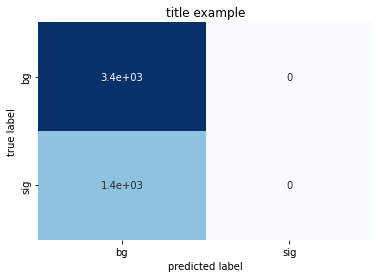

In [77]:
train_acc, train_loss, train_precision, train_recall, train_precision_n, train_recall_n, decisions, y_true = test(test_loader)
import sklearn
import seaborn as sns
cm = confusion_matrix(y_true,decisions,labels=[0,1])

tp = cm[1,1] 
fp = cm[0,1] # bg classified as signal is 0,1
fn = cm[1,0] # signal classified as bg  is 1,0
tn = cm[0,0]
        
precision = tp / (tp + fp) if tp+fp>0 else 0
recall = tp / (tp + fn) if tp+fn>0 else 0
precision_n = tn / (tn + fn) if tn+fn>0 else 0
recall_n = tn / (tn + fp) if tn+fp>0 else 0
precision2 = sklearn.metrics.precision_score(y_true, decisions)
recall2 = sklearn.metrics.recall_score(y_true,decisions)
print("precision2 = ",precision2)
print("precision = ",precision)
print("recall2 = ",recall2)
print("recall = ",recall)
print("precision_n = ",precision_n)
print("recall_n = ",recall_n)

def plot_matrix(cm, classes, title):
    ax = sns.heatmap(cm, cmap="Blues", annot=True, xticklabels=classes, yticklabels=classes, cbar=False)
    ax.set(title=title, xlabel="predicted label", ylabel="true label")
    
classes = ['bg', 'sig']
title = "title example"

plot_matrix(cm, classes, title)

l_sig_true = []
l_sig_false = []
l_bg_false = []
l_bg_true = []
k_sig_true = []
k_sig_false = []
k_bg_false = []
k_bg_true = []
for i, data in enumerate(test_dataset):
    decision = decisions[i]
    y = y_true[i]
    kin = data.kinematics.tolist()
#     if len(kin)!=13: raise TypeError
    if decision==1 and decision==y:
        l_sig_true.append(data)
        k_sig_true.append(kin)
    elif decision==1 and decision!=y:
        l_sig_false.append(data)
        k_sig_false.append(kin)
    elif decision==0 and decision!=y:
        l_bg_false.append(data)
        k_bg_false.append(kin)
    elif decision==0 and decision==y:
        l_bg_true.append(data)
        k_bg_true.append(kin)
b_sig_true = torch_geometric.data.Batch().from_data_list(l_sig_true)
b_sig_false = torch_geometric.data.Batch().from_data_list(l_sig_false)
b_bg_false = torch_geometric.data.Batch().from_data_list(l_bg_false)
b_bg_true = torch_geometric.data.Batch().from_data_list(l_bg_true)
print(b_sig.x.shape)
print(b_sig.y.shape)
print(b_bg.x.shape)
print(b_bg.y.shape)

import matplotlib.pyplot as plt

def plot_data_separated(array_sig_true,array_sig_false,array_bg_false,array_bg_true,title=None,xlabel='index',nbins=100,low=-1.1,high=1.1):
    
    array_sig_true = array_sig_true.flatten()
    array_sig_false = array_sig_false.flatten()
    array_bg_false = array_bg_false.flatten()
    array_bg_true = array_bg_true.flatten()
    
    # Plot SIG ONLY distributions
    f = plt.figure()
    if title != None:
        plt.title(title)
    plt.title('Separated mass distribution MC-matched')
    plt.hist(array_sig_true, color='tab:red', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='sig true')
    plt.hist(array_sig_false, color='tab:orange', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='sig false')
#     plt.hist(array_bg_false, color='tab:green', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='bg false')
#     plt.hist(array_bg_true, color='tab:blue', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='bg true')
    plt.legend(loc='upper left', frameon=False)
    plt.ylabel('Counts')
    plt.xlabel(xlabel)
#     f.savefig(xlabel+'_separated_'+todays_date+'.png')

    # Plot SIG AND BG distributions
    f = plt.figure()
    if title != None:
        plt.title(title)
    plt.title('Separated mass distribution MC-matched')
    plt.hist(array_sig_true, color='tab:red', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='sig true')
    plt.hist(array_sig_false, color='tab:orange', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='sig false')
    plt.hist(array_bg_false, color='tab:green', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='bg false')
    plt.hist(array_bg_true, color='tab:blue', alpha=0.5, range=(low,high), bins=nbins, histtype='stepfilled', density=False, label='bg true')
    plt.legend(loc='upper left', frameon=False)
    plt.ylabel('Counts')
    plt.xlabel(xlabel)
#     f.savefig(xlabel+'_separated_'+todays_date+'.png')
    plt.show()
    
arr1 = b_sig_true.x
arr2 = b_sig_false.x
arr3 = b_bg_false.x
arr4 = b_bg_true.x
    
# # Plot data separated distributions
# plot_data_separated(arr1[:,0],arr2[:,0],arr3[:,0],arr4[:,0],xlabel="pT")
# plot_data_separated(arr1[:,1],arr2[:,1],arr3[:,1],arr4[:,1],xlabel="phi")
# plot_data_separated(arr1[:,2],arr2[:,2],arr3[:,2],arr4[:,2],xlabel="theta")
# plot_data_separated(arr1[:,3],arr2[:,3],arr3[:,3],arr4[:,3],xlabel="beta")
# plot_data_separated(arr1[:,4],arr2[:,4],arr3[:,4],arr4[:,4],xlabel="chi2")
# plot_data_separated(arr1[:,5],arr2[:,5],arr3[:,5],arr4[:,5],xlabel="pid")
# plot_data_separated(arr1[:,6],arr2[:,6],arr3[:,6],arr4[:,6],xlabel="status")

print(len(k_sig_true))
print(len(k_sig_true[1]))
arr1 = np.array(k_sig_true)
arr2 = np.array(k_sig_false)
arr3 = np.array(k_bg_false)
arr4 = np.array(k_bg_true)
print(type(arr1))
print(type(arr1[0]))
print(arr1.shape)
print(arr1[0].shape)
#mass_index, Q2_index, W_index, x_index, y_index, z_index, xF_index, mc_pid_pa_p_index, mc_pid_ppa_p_index, mc_idx_pa_p_index, mc_idx_ppa_p_index, mc_idx_pa_pim_index, mc_label_index
# Plot data separated distributions
plot_data_separated(arr1[:,0],arr2[:,0],arr3[:,0],arr4[:,0],xlabel="mass_ppim",low=1.08,high=1.24)
plot_data_separated(arr1[:,1],arr2[:,1],arr3[:,1],arr4[:,1],xlabel="Q2",low=0.0,high=8.0)
plot_data_separated(arr1[:,2],arr2[:,2],arr3[:,2],arr4[:,2],xlabel="W",low=0.0,high=8.0)
plot_data_separated(arr1[:,3],arr2[:,3],arr3[:,3],arr4[:,3],xlabel="x",low=0.0,high=1.0)
plot_data_separated(arr1[:,4],arr2[:,4],arr3[:,4],arr4[:,4],xlabel="y",low=0.0,high=1.0)
plot_data_separated(arr1[:,5],arr2[:,5],arr3[:,5],arr4[:,5],xlabel="z_ppim",low=0.0,high=1.5)
plot_data_separated(arr1[:,6],arr2[:,6],arr3[:,6],arr4[:,6],xlabel="xF_ppim",low=-2.0,high=2.0)




In [103]:
# Train model batch size 32 lr 0.001
nepochs = 5
for epoch in range(nepochs):
    print("BEFORE TRAIN()")
    train()
    print("BEFORE TEST(TRAIN_LOADER)")
    train_acc, train_loss = test(train_loader)
    print("BEFORE TEST(VAL_LOADER)")
    val_acc, val_loss = test(val_loader)
    print("Train acc: ",train_acc," loss: ",train_loss)
    print("Val   acc: ",val_acc,  " loss: ",val_loss)

BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7019471172058489  loss:  0.009412948478591964
Val   acc:  0.6989594908576624  loss:  0.009470303789125884
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7007222769401722  loss:  0.009457827937146295
Val   acc:  0.6995656126881503  loss:  0.009512051721692916
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7030583124984215  loss:  0.009400432033424657
Val   acc:  0.6976462268916052  loss:  0.009461694377180856
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.703437129075435  loss:  0.009434509227895242
Val   acc:  0.7011819375694515  loss:  0.009490345716958143
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7029951764022527  loss:  0.009422881705840977
Val   acc:  0.7010809172643702  loss:  0.00947242778640213


In [95]:
# Train model batch size 8 lr 0.01
nepochs = 5
for epoch in range(nepochs):
    print("BEFORE TRAIN()")
    train()
    print("BEFORE TEST(TRAIN_LOADER)")
    train_acc, train_loss = test(train_loader)
    print("BEFORE TEST(VAL_LOADER)")
    val_acc, val_loss = test(val_loader)
    print("Train acc: ",train_acc," loss: ",train_loss)
    print("Val   acc: ",val_acc,  " loss: ",val_loss)

BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.6991438745359497  loss:  0.07601341395124382
Val   acc:  0.6980503081119305  loss:  0.07630892167947355
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7032477207869283  loss:  0.07579740803833365
Val   acc:  0.7007778563491261  loss:  0.0760859340980253
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7001161704169507  loss:  0.07569918957618095
Val   acc:  0.6996666329932316  loss:  0.07610895434031885
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7026037326060055  loss:  0.07566766396838884
Val   acc:  0.6982523487220932  loss:  0.07625823542257429
BEFORE TRAIN()
BEFORE TEST(TRAIN_LOADER)
BEFORE TEST(VAL_LOADER)
Train acc:  0.7036391645831755  loss:  0.07560701737655974
Val   acc:  0.6997676532983129  loss:  0.07606107426455604


In [151]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# ys = None
# for data in train_loader:
#     if ys is None: ys = data.y
#     else: ys = torch.concatenate([ys,data.y])
# counts = torch.unique(ys,return_counts=True)[1]
# weights = counts / len(ys)
# weights = np.power(weights,-1)
# weight = torch.tensor([weights[idx] for idx in torch.squeeze(ys)]).to(device)
# print("DEBUGGING: counts = ",torch.unique(ys,return_counts=True))
# print("DEBUGGING: weight = ",weight)
# criterion = torch.nn.BCELoss(weight=weight)

def train(loader):
    model.train()
    loss_tot = 0.0
#     print("DEBUGGING: beginning train(loader) len(loader) = ",len(loader))
    for data in loader:  # Iterate in batches over the training dataset.
        counts = torch.unique(data.y,return_counts=True)[1]
#         print("DEBUGGING: torch.unique(data.y,return_counts=True) = ",torch.unique(data.y,return_counts=True))#DEBUGGING
        weights = counts / len(data.y)
        weights = np.power(weights,-1)
#         print("DEBUGGING: data.y = ",data.y)
        weight = torch.tensor([weights[idx] for idx in torch.squeeze(data.y)]).to(device)

        optimizer.zero_grad()  # Clear gradients.
    
        criterion = torch.nn.BCELoss(weight=weight)#weight=weight
#         criterion = torch.nn.NLLLoss()
        
        data = data.to(device)#NOTE: ADDED
#         print("-> data.x.max() = ",data.x.max())
        out = torch.squeeze(model(data.x, data.edge_index, data.batch)) #NOTE: REMOVED TORCH.SQUEEZE 2/28/23  # Perform a single forward pass.
#         print("DEBUGGING: out = ",out)#DEBUGGING
#         print("DEBUGGING: data.x = ",data.x)
#         print("DEBUGGING: data.y.float() = ",data.y.float())#DEBUGGING
#         print("DEBUGGING: out.shape = ",out.shape," data.y.float().shape = ",data.y.float().shape)#DEBUGGING
        loss = criterion(out, data.y.float())  # Compute the loss.
#         loss = criterion(out, data.y)  # Compute the loss.
#         print("DEBUGGING: out = ",out)
#         print("DEBUGGING: pred = ",out.round())
#         print("DEBUGGING: data.y = ",data.y)
#         print("DEBUGGING: loss.item() = ",loss.item())
#         break
#         pred = torch.round(out)
#         correct = int((pred == data.y).sum())  # Check against ground-truth labels.
#         print("DEBUGGING: correct = ",correct)
        
        loss.backward()  # Derive gradients.
        optimizer.step()  # Update parameters based on gradients.
#         optimizer.zero_grad()  # Clear gradients. #NOTE: COMMENTED OUT BECAUSE PUT ABOVE FOR DEBUGGING
#         break
        loss_tot += loss.item()
    return loss_tot / len(loader.dataset)


def val(loader):
    model.eval()

    correct = 0
    loss_tot = 0.0
    with torch.no_grad():
    #     print("DEBUGGING: beginning val(loader) len(loader) = ",len(loader))
        for data in loader:  # Iterate in batches over the training/test dataset.
            counts = torch.unique(data.y,return_counts=True)[1]
            weights = counts / len(data.y)
            weights = np.power(weights,-1)
            weight = torch.tensor([weights[idx] for idx in torch.squeeze(data.y)]).to(device)
            criterion = torch.nn.BCELoss(weight=weight)#weight=weight
#             criterion = torch.nn.NLLLoss()

            data = data.to(device)#NOTE: ADDED
    #         print("DEBUGGING: data.batch = ",data.batch)
            out = torch.squeeze(model(data.x, data.edge_index, data.batch)) #NOTE: REMOVED TORCH.SQUEEZE 2/28/23
    #         print("-> data.x.max() = ",data.x)
    #         print("DEBUGGING: out = ",out)
    #         print("DEBUGGING: pred = ",torch.round(out))
            loss = criterion(out, data.y.float())  # Compute the loss.
#             loss = criterion(out, data.y)  # Compute the loss.
    #         pred = out.argmax(dim=1)  # Use the class with highest probability.
            pred = torch.round(out) #NOTE: JUST FOR USING BCELOSS -> ARGMAX COLLAPSES TO A ONE ELEMENT TENSOR
#             print("-> data.x.max() = ",data.x.max())
#             print("DEBUGGING: weights =")
#             print("DEBUGGING: out = ",out)
#             print("DEBUGGING: pred = ",pred)
#             print("DEBUGGING: data.y = ",data.y)
#             print("DEBUGGING: loss.item() = ",loss.item())

            correct += int((pred == data.y).sum())  # Check against ground-truth labels.
#             print("DEBUGGING: correct = ",correct)
            loss_tot += loss.item()
        return correct / len(loader.dataset), loss_tot / len(loader.dataset)  # Derive ratio of correct predictions.

nepochs = 100
for epoch in range(1, nepochs+1):
    train_loss_tot = train(train_loader)
    train_acc, train_loss = val(train_loader)
    val_acc, val_loss = val(val_loader)
    print("DEBUGGING: train_loss_tot = ",train_loss_tot)#DEBUGGING
    print(f'Epoch: {epoch:03d}, Train Acc: {train_acc:.4f} Loss: {train_loss:.4f}, Val Acc: {val_acc:.4f} Loss: {val_loss:.4f}')
    
test_acc, test_loss = val(test_loader)
print(f'Test Acc: {train_acc:.4f} Loss: {train_loss:.4f}')

Defaulting to user installation because normal site-packages is not writeable


In [33]:
#NOTE: COULD DEPLOY THIS ON IFARM...

#TODO:
# * ADD LEARNING RATE STEPPING INTO PL
# * CONVERT MODEL TO SEQUENTIAL SO YOU CAN SPECIFY NUMBER OF GRAPH AND LINEAR LAYERS AND POOLING TYPE
# * WRITE GIN/MLP MODELS
# * FIGURE OUT HOW TO INTEGRATE WITH HYPEROPTIMIZATION
# * FIGRE OUT HOW TO INTEGRATE WITH MLFLOW OR SOME OTHER TRACKING PACKAGE

In [11]:
#TODO: IMPLEMENT WITH PYTORCH-LIGHTNING
import torch
from torchmetrics import Accuracy
from torch.utils.data import random_split

import pytorch_lightning as pl
from pytorch_lightning import LightningModule, Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar
from pytorch_lightning.loggers import CSVLogger

class PLModel(pl.LightningModule):

    def __init__(self,
                 model_class = None,
                 model_class_args = [],
                 model_class_kwargs = {},
                 criterion = None,
                 optimizer = None,
                 optimizer_kwargs = None,
                 task = "binary",
                 num_classes = 1,
                 weight = True,
                 dataset_class = None,
                 ds_args = [],
                 ds_kwargs = {},
                 lengths = [1.0],
                 dataloader_class = None,
                 train_batch_size = 64,
                 val_batch_size = 64,
                 test_batch_size = 64,
                 num_workers = 4
                ):
        super(PLModel, self).__init__()
        self.criterion = criterion if criterion is not None else F.binary_cross_entropy
        self.optimizer = optimizer
        self.optimizer_kwargs = optimizer_kwargs
        self.task = task
        if self.task!='binary': raise TypeError('PLModel: Only binary classification implemented so far')
        self.num_classes = num_classes #NOTE: FOR BCELoss SHOULD HAVE NUM_CLASSES=1.
        self.weight = weight #NOTE: Whether or not to use loss weighting on batch basis
        self.dataset_class = dataset_class
        self.ds_args = ds_args
        self.ds_kwargs = ds_kwargs
        self.lengths = lengths
        self.dataloader_class = dataloader_class
        self.train_batch_size = train_batch_size
        self.val_batch_size = val_batch_size
        self.test_batch_size = test_batch_size
        self.num_workers = num_workers
        
        # Init random class attributes
        self.dataset = None
        self.ds_train = None
        self.ds_val = None
        self.ds_test = None
        
        self.train_accuracy = Accuracy(task=self.task, num_classes=self.num_classes)
        self.val_accuracy = Accuracy(task=self.task, num_classes=self.num_classes)
        self.test_accuracy = Accuracy(task=self.task, num_classes=self.num_classes)
        
        self.model = model_class(*model_class_args,**model_class_kwargs)

    def training_step(self, batch, batch_idx):
        x = torch.squeeze(self.model(batch.x, batch.edge_index, batch.batch))
        counts = torch.pow(torch.unique(batch.y,return_counts=True)[1] / len(batch.y), -1) if self.weight else None
        weight = torch.tensor([counts[idx] for idx in torch.squeeze(batch.y)]).to(x.device) if self.weight else None #NOTE: THIS ONLY WORKS FOR BINARY CLASSIFICATION WITH BCELOSS
        loss = self.criterion(x, batch.y.float(), weight=weight)
        self.log('train_loss', loss, prog_bar=True)
        self.log('train_acc', self.train_accuracy, prog_bar=True, batch_size=self.train_batch_size)
        return loss
    
    @torch.no_grad()
    def validation_step(self, batch, batch_idx):
        x = torch.squeeze(self.model(batch.x, batch.edge_index, batch.batch))
        counts = torch.pow(torch.unique(batch.y,return_counts=True)[1] / len(batch.y), -1) if self.weight else None
        weight = torch.tensor([counts[idx] for idx in torch.squeeze(batch.y)]).to(x.device) if self.weight else None #NOTE: THIS ONLY WORKS FOR BINARY CLASSIFICATION WITH BCELOSS
        loss = self.criterion(x, batch.y.float(), weight=weight)
        preds = x.round() #NOTE: ONLY USE FOR BINARY CLASSIFICATION
        self.val_accuracy.update(preds, batch.y)

        # Calling self.log will surface up scalars for you in TensorBoard
        self.log('val_loss', loss, prog_bar=True, batch_size=self.val_batch_size)
        self.log('val_acc', self.val_accuracy, prog_bar=True, batch_size=self.val_batch_size)
        return loss
    
    @torch.no_grad()
    def test_step(self, batch, batch_nb):
        x = torch.squeeze(self.model(batch.x, batch.edge_index, batch.batch))
        counts = torch.pow(torch.unique(batch.y,return_counts=True)[1] / len(batch.y), -1) if self.weight else None
        weight = torch.tensor([counts[idx] for idx in torch.squeeze(batch.y)]).to(x.device) if self.weight else None #NOTE: THIS ONLY WORKS FOR BINARY CLASSIFICATION WITH BCELOSS
        loss = self.criterion(x, batch.y.float(), weight=weight)
        preds = x.round() #NOTE: ONLY USE FOR BINARY CLASSIFICATION
        self.val_accuracy.update(preds, batch.y)

        # Calling self.log will surface up scalars for you in TensorBoard
        self.log('test_loss', loss, prog_bar=True, batch_size=self.test_batch_size)
        self.log('test_acc', self.test_accuracy, prog_bar=True, batch_size=self.test_batch_size)
        return loss

    def configure_optimizers(self):
        if self.optimizer is not None and self.optimizer_kwargs is not None:
            return self.optimizer(self.parameters(), **self.optimizer_kwargs)
        else:
            return torch.optim.Adam(self.parameters(), lr=0.01)
            
    def prepare_data(self): #NOTE: DO NOT MAKE ANY STATE ASSIGNMENTS HERE, JUST DOWNLOAD THE DATA IF NEEDED
        pass

    def setup(self, stage=None): #NOTE: THIS RUNS ACROSS ALL GPUS
        # Assign train/val/test datasets for use in dataloaders
        if self.dataset is None:
            self.dataset = self.dataset_class(*self.ds_args,**self.ds_kwargs) #NOTE: NEEDED KWARGS datasetclass ds_args, ds_kwargs, lengths
        if len(self.lengths)==2 and self.ds_train is None and self.ds_val is None:
            self.ds_train, self.ds_val = random_split(self.dataset, self.lengths)
        elif len(self.lengths)==3 and self.ds_train is None and self.ds_val is None:
            self.ds_train, self.ds_val, self.ds_test = random_split(self.dataset, self.lengths)

    def train_dataloader(self):
        return self.dataloader_class(self.ds_train, batch_size=self.train_batch_size, shuffle=True, num_workers=self.num_workers) #NOTE: NEEDED KWARGS dataloader_class train_batch_size val test...

    def val_dataloader(self):
        return self.dataloader_class(self.ds_val, batch_size=self.val_batch_size, shuffle=False, num_workers=self.num_workers)

    def test_dataloader(self):
        return self.dataloader_class(self.ds_test, batch_size=self.test_batch_size, shuffle=False, num_workers=self.num_workers)
            


In [13]:
import torch
from torch_geometric.loader import DataLoader
import torch_geometric.transforms as T
transform = T.Compose([T.ToUndirected(),T.NormalizeFeatures()]) #T.AddSelfLoops(),

plmodel = PLModel(
         model_class = GCN,
         model_class_args = [],
         model_class_kwargs = {'in_channels':dataset.num_node_features,'hidden_channels':64,'out_channels':1},
         criterion = torch.nn.functional.binary_cross_entropy,
         optimizer = torch.optim.Adam,
         optimizer_kwargs = {'lr':0.01},
         task = 'binary',
         num_classes = 1,
         weight = True,
         dataset_class = MyOwnDataset,
         ds_args = ['/work/clas12/users/mfmce/pyg_datasets/'],
         ds_kwargs = {'transform':transform, 'pre_transform':None, 'pre_filter':None},
         lengths = [0.8,0.1,0.1],
         dataloader_class = DataLoader,
         train_batch_size = 16,
         val_batch_size = 16,
         test_batch_size = 16,
         num_workers = 4
        )

print(type(plmodel))
print(type(plmodel.model))

<class '__main__.PLModel'>
<class '__main__.GCN'>


In [17]:
trainer = Trainer(
    default_root_dir="./", #NOTE: PL AUTOMATICALLY SAVES PL CHECKPOINT TO PWD UNLESS THIS OPTION IS DIFFERENT
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,  # limiting got iPython runs
    max_epochs=3,
    callbacks=[TQDMProgressBar(refresh_rate=20)],
    logger=CSVLogger(save_dir="logs/"),
#     deterministic=True
)
trainer.fit(plmodel)

#NOTE: NEED TO FIGURE OUT HOW TO LOAD BEST MODEL
script = plmodel.to_torchscript() #NOTE: extra method needed for pl

# save for use in production environment
torch.jit.save(script, "model.pt")

#FOR INTEGRATING WITH MLFLOW
# from pytorch_lightning.loggers import MLFlowLogger

# mlf_logger = MLFlowLogger(experiment_name="lightning_logs", tracking_uri="file:./ml-runs")
# trainer = Trainer(logger=mlf_logger)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]

  | Name           | Type           | Params
--------------------------------------------------
0 | train_accuracy | BinaryAccuracy | 0     
1 | val_accuracy   | BinaryAccuracy | 0     
2 | test_accuracy  | BinaryAccuracy | 0     
3 | model          | GCN            | 17.4 K
--------------------------------------------------
17.4 K    Trainable params
0         Non-trainable params
17.4 K    Total params
0.070     Total estimated model params size (MB)
SLURM auto-requeueing enabled. Setting signal handlers.


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=3` reached.


AttributeError: 'GCN' object has no attribute 'to_torchscript'

In [18]:
trainer.test()

/w/hallb-scshelf2102/clas12/users/mfmce/venv/lib/python3.8/site-packages/pytorch_lightning/trainer/connectors/checkpoint_connector.py:124: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `.test(ckpt_path='best')` to use the best model or `.test(ckpt_path='last')` to use the last model. If you pass a value, this warning will be silenced.
  rank_zero_warn(
Restoring states from the checkpoint path at logs/lightning_logs/version_15/checkpoints/epoch=2-step=14073.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loaded model weights from checkpoint at logs/lightning_logs/version_15/checkpoints/epoch=2-step=14073.ckpt


Testing: 0it [00:00, ?it/s]

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test_acc                    0.0
        test_loss           1.3851436376571655
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


/w/hallb-scshelf2102/clas12/users/mfmce/venv/lib/python3.8/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: The ``compute`` method of metric BinaryAccuracy was called before the ``update`` method which may lead to errors, as metric states have not yet been updated.
  warnings.warn(*args, **kwargs)


[{'test_loss': 1.3851436376571655, 'test_acc': 0.0}]

In [14]:
# Train model
from pytorch_lightning.loggers import MLFlowLogger
pl.seed_everything(72, workers=True)
mlf_logger = MLFlowLogger(experiment_name="lightning_logs", tracking_uri="file:./ml-runs")
trainer = Trainer(
    default_root_dir="./", #NOTE: PL AUTOMATICALLY SAVES PL CHECKPOINT TO PWD UNLESS THIS OPTION IS DIFFERENT
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,
    max_epochs=3,
    callbacks=[TQDMProgressBar(refresh_rate=20)],
#     logger=CSVLogger(save_dir="logs/"),
    deterministic=True, #NOTE: For reproducibility use pytorch_lightning.seed_everything and this
    logger=mlf_logger
)
trainer.fit(plmodel)

# Test model - pl automatically saves best and last checkpoints
trainer.test(ckpt='best')

# save for use in production environment
script = plmodel.to_torchscript() #NOTE: Different method for pl
torch.jit.save(script, "model.pt")

[rank: 0] Global seed set to 72
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
Experiment with name lightning_logs not found. Creating it.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]

  | Name           | Type           | Params
--------------------------------------------------
0 | train_accuracy | BinaryAccuracy | 0     
1 | val_accuracy   | BinaryAccuracy | 0     
2 | test_accuracy  | BinaryAccuracy | 0     
3 | model          | GCN            | 17.4 K
--------------------------------------------------
17.4 K    Trainable params
0         Non-trainable params
17.4 K    Total params
0.070     Total estimated model params size (MB)
SLURM auto-requeueing enabled. Setting signal handlers.


INFO: self.processed_paths =  ['/work/clas12/users/mfmce/pyg_datasets/processed/data.pt']


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=3` reached.


TypeError: test() got an unexpected keyword argument 'ckpt'

In [22]:
!pip install -U 'mlflow>=1.0.0'

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 16.7 MB 7.5 MB/s eta 0:00:01
     |████████████████████████████████| 36.0 MB 138.2 MB/s eta 0:00:01
     |████████████████████████████████| 42 kB 75.2 MB/s  eta 0:00:01
     |████████████████████████████████| 79 kB 69.6 MB/s eta 0:00:01
     |████████████████████████████████| 184 kB 100.6 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 129.2 MB/s eta 0:00:01
     |████████████████████████████████| 82 kB 44.8 MB/s  eta 0:00:01
     |████████████████████████████████| 101 kB 138.6 MB/s ta 0:00:01
     |████████████████████████████████| 42 kB 85.1 MB/s  eta 0:00:01
     |████████████████████████████████| 147 kB 136.5 MB/s eta 0:00:01
     |████████████████████████████████| 93 kB 45.6 MB/s eta 0:00:01
     |████████████████████████████████| 151 kB 137.4 MB/s eta 0:00:01
     |████████████████████████████████| 62 kB 88.4 MB/s  eta 0:00:01
     |███████████████

In [29]:
import os.path as osp

import torch
import torch.nn.functional as F

import torch_geometric
import torch_geometric.transforms as T
from torch_geometric.datasets import TUDataset
from torch_geometric.loader import DataLoader
from torch_geometric.nn import MLP, GINConv, global_add_pool

class GIN(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.convs = torch.nn.ModuleList()
        for _ in range(5):
            mlp = MLP([in_channels, 32, 32])
            self.convs.append(GINConv(mlp, train_eps=False))
            in_channels = 32

        self.mlp = MLP([32, 32, out_channels], norm=None, dropout=0.5)

    def forward(self, x, edge_index, batch):
        for conv in self.convs:
            x = conv(x, edge_index).relu()
        x = global_add_pool(x, batch)
        return self.mlp(x)


model = GIN(dataset.num_features, dataset.num_classes).to(device)

# Compile the model into an optimized version:
# Note that `compile(model, dynamic=True)` does not work yet in PyTorch 2.0, so
# we use `transforms.Pad` and static compilation as a current workaround.
# See: https://github.com/pytorch/pytorch/issues/94640
# model = torch_geometric.compile(model)

# optimizer = torch.optim.Adam(model.parameters(), lr=0.01)


# def train():
#     model.train()

#     total_loss = 0
#     for data in train_loader:
#         data = data.to(device)
#         optimizer.zero_grad()
#         out = model(data.x, data.edge_index, data.batch)
#         loss = F.cross_entropy(out, data.y)
#         loss.backward()
#         optimizer.step()
#         total_loss += float(loss) * data.num_graphs
#     return total_loss / len(train_loader.dataset)


# @torch.no_grad()
# def test(loader):
#     model.eval()

#     total_correct = 0
#     for data in loader:
#         data = data.to(device)
#         pred = model(data.x, data.edge_index, data.batch).argmax(dim=-1)
#         print(pred)
#         total_correct += int((pred == data.y).sum())
#     return total_correct / len(loader.dataset)


# for epoch in range(1, 101):
#     loss = train()
#     train_acc = test(train_loader)
#     test_acc = test(val_loader)
#     print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Train: {train_acc:.4f}, '
#           f'Test: {test_acc:.4f}')
#     break